In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [3]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [4]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [5]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [6]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [7]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [8]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

### Load df

In [9]:
import pickle

with open('./Okko_ratings_RUSS.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [10]:
df.shape

(1705, 1027)

# Preprocessing

In [11]:
prep_df = df.copy(deep=True)

In [12]:
prep_df.shape

(1705, 1027)

In [13]:
prep_df.isna().sum()

age_access_type     0
name                0
director            0
genre               0
average_rating     67
                   ..
чета                0
зебра               0
сидень              0
беатрис             0
рыбка               0
Length: 1027, dtype: int64

### filter by year

In [14]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [15]:
prep_df.shape

(1666, 1027)

In [16]:
prep_df.isna().sum()

age_access_type     0
name                0
director            0
genre               0
average_rating     67
                   ..
чета                0
зебра               0
сидень              0
беатрис             0
рыбка               0
Length: 1027, dtype: int64

### topN

In [17]:
prep_df.dropna(subset=['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER'],
              inplace=True)


In [18]:
prep_df.shape

(731, 1027)

In [19]:
prep_df.isna().sum()

age_access_type     0
name                0
director            0
genre               0
average_rating     15
                   ..
чета                0
зебра               0
сидень              0
беатрис             0
рыбка               0
Length: 1027, dtype: int64

In [20]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [21]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [22]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration',
       ...
       'вылечивать', 'землянин', 'рон', 'головоломка', 'крюк', 'чета', 'зебра',
       'сидень', 'беатрис', 'рыбка'],
      dtype='object', length=1027)

In [23]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [24]:
prep_df.head().T

,144,182,199,241,278
age_access_type,16,16,16,16,18
name,Медвежий поцелуй,Байконур,Девушка и смерть,Монгол,Красный змей
director,[3d64928e-b4a3-4c78-b176-77ef1045d5bc],[1f007e2b-31c6-4f3d-849c-95a1df635ab1],[2b043c71-af5a-47b1-9755-432047883465],[3d64928e-b4a3-4c78-b176-77ef1045d5bc],[622415d8-8c67-495b-acbd-06d04daeec26]
average_rating,7.43,6.09,6.8,6.97,1.37
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
...,...,...,...,...,...
Эдуард Илоян,0,0,0,0,0
Виталий Шляппо,0,0,0,0,0
Алексей Троцюк,0,0,0,0,0
Роман Непомнящий,0,0,0,0,0


In [25]:
prep_df.columns[:30]

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'джек', 'расследовать', 'подруга', 'ограбление', 'катя', 'макс',
       'мечтать', 'отважный', 'фрэнк', 'воспитывать', 'супергерой',
       'безжалостный', 'маньяк'],
      dtype='object')

In [26]:
# cols = ['age_access_type', 'name', 'type',
#        'release_year', 'duration', 'element_uid',
#        'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id',
#         'rating',
#        'Drama', 'Comedy', 'Thriller', 'Action',
#        '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
#        'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
#        'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
#        'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
#        'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
#        'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
#        'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
#        'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
#        'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
#        'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
#        'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
#        'Джек Кёрби']

In [27]:
prep_df.drop(['director', 'average_rating', 'release_type', 'actor', 'element_id'], axis=1, inplace=True)

In [28]:
# prep_df = prep_df[cols]

In [29]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [30]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [31]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [32]:
df_pr = preprocesser.preprocess(prep_df)

In [33]:
df_pr.isnull().sum()

age_access_type     0
name                0
type                0
release_year        0
duration            0
                   ..
Эдуард Илоян        0
Виталий Шляппо      0
Алексей Троцюк      0
Роман Непомнящий    0
Олег Маловичко      0
Length: 1053, dtype: int64

### target destr

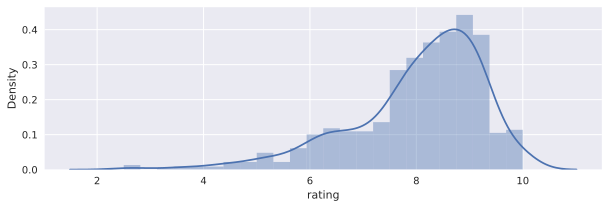

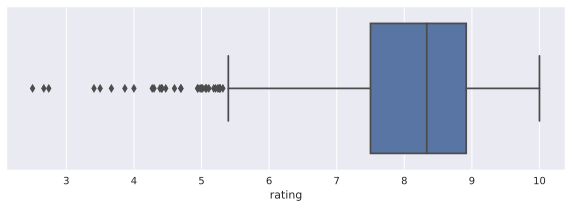

In [34]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [35]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [36]:
ddf = demo_df.copy()

In [37]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [38]:
ddf.T

,6354,6435,9800,10205
age_access_type,16,18,18,6
type,MOVIE,MOVIE,SERIAL,SERIAL
duration,15.70258,15.479437,17.723526,16.269958
BUDGET,NaN,NaN,NaN,NaN
MARKETING,NaN,NaN,NaN,NaN
...,...,...,...,...
Эдуард Илоян,0,0,0,0
Виталий Шляппо,0,0,0,0
Алексей Троцюк,0,0,0,0
Роман Непомнящий,0,0,0,0


## Split

In [39]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       ...
       'Дмитрий Киселёв', 'Ольга Прошкина', 'Дмитрий Слобцов',
       'Сергей Трофимов', 'Антон Зенкович', 'Эдуард Илоян', 'Виталий Шляппо',
       'Алексей Троцюк', 'Роман Непомнящий', 'Олег Маловичко'],
      dtype='object', length=1053)

In [40]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((640, 1049), (72, 1049), (19, 1049), (640,), (72,), (19,))

In [41]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'джек', 'расследовать',
       ...
       'Дмитрий Киселёв', 'Ольга Прошкина', 'Дмитрий Слобцов',
       'Сергей Трофимов', 'Антон Зенкович', 'Эдуард Илоян', 'Виталий Шляппо',
       'Алексей Троцюк', 'Роман Непомнящий', 'Олег Маловичко'],
      dtype='object', length=1049)

In [42]:
X_train

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,джек,расследовать,...,Дмитрий Киселёв,Ольга Прошкина,Дмитрий Слобцов,Сергей Трофимов,Антон Зенкович,Эдуард Илоян,Виталий Шляппо,Алексей Троцюк,Роман Непомнящий,Олег Маловичко
8945,16,SERIAL,17.686712,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
6611,16,MOVIE,15.869634,NaN,NaN,12.948012,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
8337,12,MP_MOVIE,15.607270,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
7409,16,MOVIE,15.789592,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
6040,12,MOVIE,15.846287,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6740,6,MOVIE,15.576811,NaN,NaN,15.411545,NaN,15.394505,0,0,...,0,0,0,0,0,0,0,0,0,0
10170,16,SERIAL,16.973362,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
5222,12,MOVIE,15.914755,NaN,NaN,14.021186,NaN,10.401805,0,0,...,0,0,0,0,0,0,0,0,0,0
6490,18,MOVIE,15.684231,NaN,NaN,16.156147,NaN,16.117690,0,0,...,0,0,0,0,0,1,1,1,0,0


In [43]:
cat_features = ['age_access_type', 'type']

# Modeling

In [44]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [45]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.047475
0:	learn: 0.9186578	test: 1.0985220	best: 1.0985220 (0)	total: 56.3ms	remaining: 56.2s
100:	learn: 0.7165620	test: 0.9594901	best: 0.9594901 (100)	total: 449ms	remaining: 4s
200:	learn: 0.6545356	test: 0.9445137	best: 0.9433105 (166)	total: 823ms	remaining: 3.27s
300:	learn: 0.6049031	test: 0.9480505	best: 0.9407603 (218)	total: 1.17s	remaining: 2.72s
400:	learn: 0.5662201	test: 0.9520766	best: 0.9407603 (218)	total: 1.56s	remaining: 2.33s
500:	learn: 0.5356793	test: 0.9581320	best: 0.9407603 (218)	total: 1.95s	remaining: 1.94s
600:	learn: 0.5067037	test: 0.9529566	best: 0.9407603 (218)	total: 2.32s	remaining: 1.54s
700:	learn: 0.4796238	test: 0.9533938	best: 0.9407603 (218)	total: 2.69s	remaining: 1.15s
Stopped by overfitting detector  (500 iterations wait)

bestTest = 0.9407602768
bestIteration = 218

Shrink model to first 219 iterations.


In [46]:
y_pred = cat_model.predict(test_dataset)

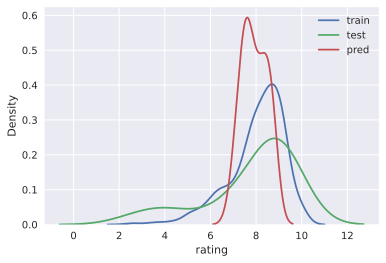

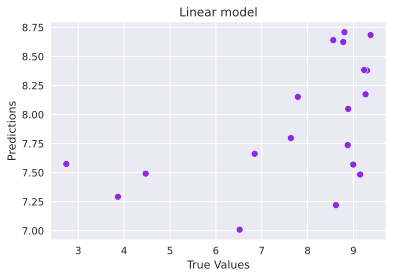

In [47]:
target_distr_linear(y_train, y_test, y_pred)   

In [48]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   3.0170380828135377
RMSE:  1.7369623147361424
R2:    0.20866134890782329
MAE:   1.2343452577073986
MedAE: 0.8498723042900274
------------------------------


In [49]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_russ_kws')

**Feature importance**

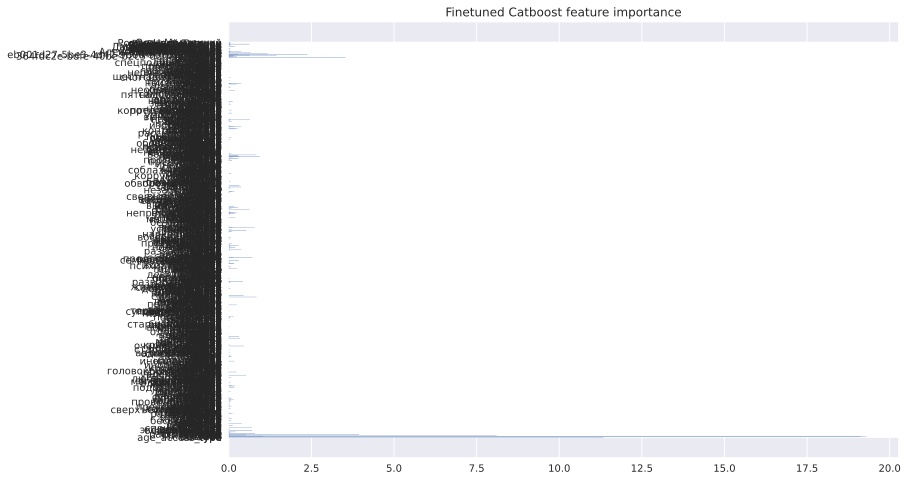

In [50]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

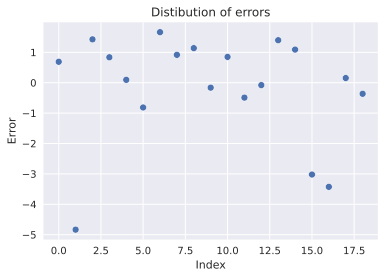

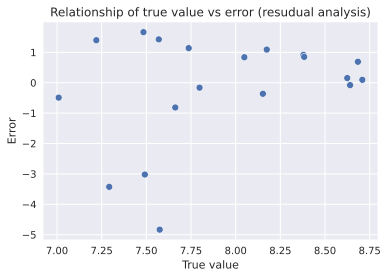

In [51]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [57]:
test_df['PREDS_tune'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Сергей Трофимов,Антон Зенкович,Эдуард Илоян,Виталий Шляппо,Алексей Троцюк,Роман Непомнящий,Олег Маловичко,PREDS,TARGET,PREDS_tune
10368,16,И снова здравствуйте!,SERIAL,2022,16.665060,f02bc785-71a0-44cc-b6d6-ee2360a1c50f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.683981,9.374117,8.683981
5410,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,7.574545,2.739953,7.574545
5542,16,Многоэтажка,MOVIE,2022,15.597220,19a61cc3-65ff-46ce-bf43-29c24a1cc9b6,NaN,NaN,5.793014,NaN,...,0,0,1,1,1,0,0,7.569438,8.996094,7.569438
10440,18,Закрыть гештальт,SERIAL,2022,16.685680,e6ea57ce-52eb-465b-b9b8-270bc498ca53,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.048470,8.885542,8.048470
10350,16,Янычар,SERIAL,2022,17.345980,23a6adb5-9df6-4bc5-9300-6d2313e177df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.708787,8.804702,8.708787
5551,16,Стикер,MOVIE,2022,15.772785,aae4f12c-60f1-4d5e-99f5-1fae382887a6,NaN,NaN,12.066040,NaN,...,0,0,0,0,0,0,0,7.661845,6.847095,7.661845
6354,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.483711,9.147352,7.483711
10246,12,Предпоследняя инстанция,SERIAL,2022,16.578049,36d9d568-75d0-414d-9765-25bf72c6362f,NaN,NaN,NaN,NaN,...,0,1,0,0,0,0,0,8.379109,9.296652,8.379109
5681,16,День слепого Валентина,MOVIE,2022,15.711630,6b047b99-5cb4-4878-9a4f-b8b372b438eb,NaN,NaN,12.935033,NaN,...,0,0,0,0,0,0,0,7.736821,8.874664,7.736821
7698,12,Тайна амулета,MOVIE,2022,15.545395,9ae35927-93e3-4a40-870f-a998abbeaa9f,NaN,NaN,12.057422,NaN,...,0,0,0,0,0,0,0,7.797664,7.635827,7.797664


In [53]:
# predict demo dataset

In [58]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [59]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Дмитрий Слобцов,Сергей Трофимов,Антон Зенкович,Эдуард Илоян,Виталий Шляппо,Алексей Троцюк,Роман Непомнящий,Олег Маловичко,TARGET,PREDS
6354,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.147352,7.483711
6435,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.519242,7.009209
9800,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.717041,8.883485
10205,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.192744,8.814233


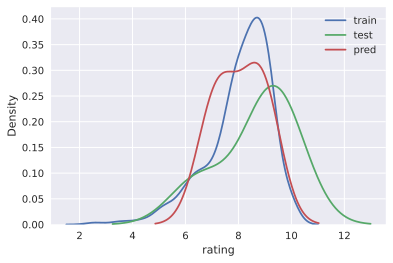

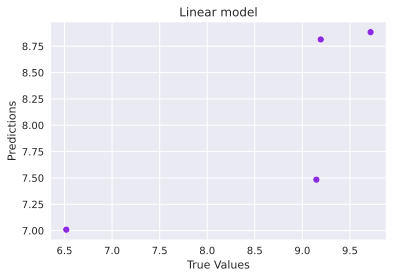

In [60]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [61]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [62]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_russ_kws', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.9026819	total: 10.7ms	remaining: 1m 46s
1:	learn: 0.8991293	total: 17.3ms	remaining: 1m 26s
2:	learn: 0.8943971	total: 23.1ms	remaining: 1m 16s
3:	learn: 0.8895889	total: 28.1ms	remaining: 1m 10s
4:	learn: 0.8851937	total: 33.5ms	remaining: 1m 6s
5:	learn: 0.8814056	total: 37.4ms	remaining: 1m 2s
6:	learn: 0.8776671	total: 41.2ms	remaining: 58.8s
7:	learn: 0.8741018	total: 44.9ms	remaining: 56.1s
8:	learn: 0.8697674	total: 49.3ms	remaining: 54.7s
9:	learn: 0.8650339	total: 52.8ms	remaining: 52.8s
10:	learn: 0.8617876	total: 55.9ms	remaining: 50.7s
11:	learn: 0.8583580	total: 59.2ms	remaining: 49.3s
12:	learn: 0.8566087	total: 62.5ms	remaining: 48s
13:	learn: 0.8542330	total: 65.5ms	remaining: 46.7s
14:	learn: 0.8503847	total: 68.6ms	remaining: 45.7s
15:	learn: 0.8463084	total: 72.2ms	remaining: 45s
16:	learn: 0.8434500	total: 75.3ms	remaining: 44.2s
17:	learn: 0.8400813	total: 78.9ms	remaining: 43.8s
18:	learn: 0.

189:	learn: 0.6959990	total: 607ms	remaining: 31.3s
190:	learn: 0.6953725	total: 610ms	remaining: 31.3s
191:	learn: 0.6952743	total: 614ms	remaining: 31.3s
192:	learn: 0.6948879	total: 617ms	remaining: 31.4s
193:	learn: 0.6946364	total: 621ms	remaining: 31.4s
194:	learn: 0.6943245	total: 624ms	remaining: 31.4s
195:	learn: 0.6939897	total: 627ms	remaining: 31.4s
196:	learn: 0.6936025	total: 631ms	remaining: 31.4s
197:	learn: 0.6929677	total: 633ms	remaining: 31.3s
198:	learn: 0.6925157	total: 636ms	remaining: 31.3s
199:	learn: 0.6922571	total: 639ms	remaining: 31.3s
200:	learn: 0.6922621	total: 640ms	remaining: 31.2s
201:	learn: 0.6921034	total: 643ms	remaining: 31.2s
202:	learn: 0.6917663	total: 646ms	remaining: 31.2s
203:	learn: 0.6913817	total: 648ms	remaining: 31.1s
204:	learn: 0.6909936	total: 651ms	remaining: 31.1s
205:	learn: 0.6905301	total: 654ms	remaining: 31.1s
206:	learn: 0.6903293	total: 657ms	remaining: 31.1s
207:	learn: 0.6900273	total: 659ms	remaining: 31s
208:	learn: 0.

392:	learn: 0.6308831	total: 1.21s	remaining: 29.5s
393:	learn: 0.6303568	total: 1.21s	remaining: 29.4s
394:	learn: 0.6302540	total: 1.21s	remaining: 29.4s
395:	learn: 0.6301600	total: 1.21s	remaining: 29.4s
396:	learn: 0.6297714	total: 1.22s	remaining: 29.4s
397:	learn: 0.6289352	total: 1.22s	remaining: 29.4s
398:	learn: 0.6286230	total: 1.22s	remaining: 29.4s
399:	learn: 0.6284684	total: 1.23s	remaining: 29.4s
400:	learn: 0.6283529	total: 1.23s	remaining: 29.4s
401:	learn: 0.6278783	total: 1.23s	remaining: 29.4s
402:	learn: 0.6276484	total: 1.24s	remaining: 29.4s
403:	learn: 0.6272953	total: 1.24s	remaining: 29.4s
404:	learn: 0.6270475	total: 1.24s	remaining: 29.4s
405:	learn: 0.6264199	total: 1.25s	remaining: 29.4s
406:	learn: 0.6263966	total: 1.25s	remaining: 29.4s
407:	learn: 0.6262048	total: 1.25s	remaining: 29.4s
408:	learn: 0.6257380	total: 1.25s	remaining: 29.4s
409:	learn: 0.6256542	total: 1.26s	remaining: 29.4s
410:	learn: 0.6251611	total: 1.26s	remaining: 29.4s
411:	learn: 

573:	learn: 0.5834692	total: 1.8s	remaining: 29.6s
574:	learn: 0.5834216	total: 1.81s	remaining: 29.6s
575:	learn: 0.5831269	total: 1.81s	remaining: 29.6s
576:	learn: 0.5829746	total: 1.81s	remaining: 29.6s
577:	learn: 0.5826265	total: 1.82s	remaining: 29.6s
578:	learn: 0.5821712	total: 1.82s	remaining: 29.6s
579:	learn: 0.5817791	total: 1.82s	remaining: 29.6s
580:	learn: 0.5816913	total: 1.82s	remaining: 29.6s
581:	learn: 0.5815121	total: 1.83s	remaining: 29.6s
582:	learn: 0.5813227	total: 1.83s	remaining: 29.6s
583:	learn: 0.5810876	total: 1.83s	remaining: 29.6s
584:	learn: 0.5807432	total: 1.84s	remaining: 29.6s
585:	learn: 0.5806102	total: 1.84s	remaining: 29.6s
586:	learn: 0.5802262	total: 1.84s	remaining: 29.6s
587:	learn: 0.5799804	total: 1.85s	remaining: 29.6s
588:	learn: 0.5797906	total: 1.85s	remaining: 29.6s
589:	learn: 0.5797088	total: 1.85s	remaining: 29.6s
590:	learn: 0.5791607	total: 1.86s	remaining: 29.6s
591:	learn: 0.5790591	total: 1.86s	remaining: 29.5s
592:	learn: 0

750:	learn: 0.5491819	total: 2.4s	remaining: 29.6s
751:	learn: 0.5490443	total: 2.41s	remaining: 29.6s
752:	learn: 0.5488582	total: 2.41s	remaining: 29.6s
753:	learn: 0.5488248	total: 2.41s	remaining: 29.6s
754:	learn: 0.5487739	total: 2.42s	remaining: 29.6s
755:	learn: 0.5487205	total: 2.42s	remaining: 29.6s
756:	learn: 0.5485501	total: 2.42s	remaining: 29.6s
757:	learn: 0.5485143	total: 2.43s	remaining: 29.6s
758:	learn: 0.5483448	total: 2.43s	remaining: 29.6s
759:	learn: 0.5482591	total: 2.43s	remaining: 29.6s
760:	learn: 0.5481493	total: 2.44s	remaining: 29.6s
761:	learn: 0.5479135	total: 2.44s	remaining: 29.6s
762:	learn: 0.5478715	total: 2.44s	remaining: 29.6s
763:	learn: 0.5474874	total: 2.45s	remaining: 29.6s
764:	learn: 0.5471573	total: 2.45s	remaining: 29.6s
765:	learn: 0.5470452	total: 2.45s	remaining: 29.6s
766:	learn: 0.5467377	total: 2.46s	remaining: 29.6s
767:	learn: 0.5466691	total: 2.46s	remaining: 29.6s
768:	learn: 0.5466609	total: 2.46s	remaining: 29.6s
769:	learn: 0

935:	learn: 0.5217070	total: 3s	remaining: 29.1s
936:	learn: 0.5216638	total: 3s	remaining: 29.1s
937:	learn: 0.5216541	total: 3.01s	remaining: 29.1s
938:	learn: 0.5215510	total: 3.01s	remaining: 29.1s
939:	learn: 0.5214663	total: 3.01s	remaining: 29.1s
940:	learn: 0.5211911	total: 3.02s	remaining: 29.1s
941:	learn: 0.5211282	total: 3.02s	remaining: 29s
942:	learn: 0.5211016	total: 3.02s	remaining: 29s
943:	learn: 0.5207842	total: 3.03s	remaining: 29s
944:	learn: 0.5206206	total: 3.03s	remaining: 29s
945:	learn: 0.5203906	total: 3.03s	remaining: 29s
946:	learn: 0.5201453	total: 3.04s	remaining: 29s
947:	learn: 0.5197447	total: 3.04s	remaining: 29s
948:	learn: 0.5196671	total: 3.04s	remaining: 29s
949:	learn: 0.5196470	total: 3.05s	remaining: 29s
950:	learn: 0.5195912	total: 3.05s	remaining: 29s
951:	learn: 0.5195498	total: 3.05s	remaining: 29s
952:	learn: 0.5194493	total: 3.06s	remaining: 29s
953:	learn: 0.5193232	total: 3.06s	remaining: 29s
954:	learn: 0.5192575	total: 3.06s	remaining

1137:	learn: 0.4911739	total: 3.6s	remaining: 28s
1138:	learn: 0.4910374	total: 3.6s	remaining: 28s
1139:	learn: 0.4910280	total: 3.6s	remaining: 28s
1140:	learn: 0.4905394	total: 3.61s	remaining: 28s
1141:	learn: 0.4902798	total: 3.61s	remaining: 28s
1142:	learn: 0.4901995	total: 3.61s	remaining: 28s
1143:	learn: 0.4900822	total: 3.62s	remaining: 28s
1144:	learn: 0.4899739	total: 3.62s	remaining: 28s
1145:	learn: 0.4899408	total: 3.62s	remaining: 28s
1146:	learn: 0.4896608	total: 3.62s	remaining: 28s
1147:	learn: 0.4892875	total: 3.63s	remaining: 28s
1148:	learn: 0.4892388	total: 3.63s	remaining: 28s
1149:	learn: 0.4890998	total: 3.63s	remaining: 28s
1150:	learn: 0.4889917	total: 3.64s	remaining: 28s
1151:	learn: 0.4887885	total: 3.64s	remaining: 28s
1152:	learn: 0.4887104	total: 3.64s	remaining: 28s
1153:	learn: 0.4886493	total: 3.65s	remaining: 27.9s
1154:	learn: 0.4886135	total: 3.65s	remaining: 27.9s
1155:	learn: 0.4884224	total: 3.65s	remaining: 27.9s
1156:	learn: 0.4883527	total

1326:	learn: 0.4649322	total: 4.19s	remaining: 27.4s
1327:	learn: 0.4648233	total: 4.2s	remaining: 27.4s
1328:	learn: 0.4648175	total: 4.2s	remaining: 27.4s
1329:	learn: 0.4646064	total: 4.2s	remaining: 27.4s
1330:	learn: 0.4644756	total: 4.21s	remaining: 27.4s
1331:	learn: 0.4643212	total: 4.21s	remaining: 27.4s
1332:	learn: 0.4643039	total: 4.21s	remaining: 27.4s
1333:	learn: 0.4641103	total: 4.21s	remaining: 27.4s
1334:	learn: 0.4639977	total: 4.22s	remaining: 27.4s
1335:	learn: 0.4637929	total: 4.22s	remaining: 27.4s
1336:	learn: 0.4636354	total: 4.22s	remaining: 27.4s
1337:	learn: 0.4636222	total: 4.23s	remaining: 27.4s
1338:	learn: 0.4635955	total: 4.23s	remaining: 27.4s
1339:	learn: 0.4635542	total: 4.24s	remaining: 27.4s
1340:	learn: 0.4632423	total: 4.24s	remaining: 27.4s
1341:	learn: 0.4632192	total: 4.24s	remaining: 27.4s
1342:	learn: 0.4632016	total: 4.24s	remaining: 27.4s
1343:	learn: 0.4630144	total: 4.25s	remaining: 27.4s
1344:	learn: 0.4629745	total: 4.25s	remaining: 27

1518:	learn: 0.4442320	total: 4.79s	remaining: 26.8s
1519:	learn: 0.4441368	total: 4.8s	remaining: 26.8s
1520:	learn: 0.4436406	total: 4.8s	remaining: 26.8s
1521:	learn: 0.4435039	total: 4.8s	remaining: 26.7s
1522:	learn: 0.4434602	total: 4.8s	remaining: 26.7s
1523:	learn: 0.4434425	total: 4.81s	remaining: 26.7s
1524:	learn: 0.4434040	total: 4.81s	remaining: 26.7s
1525:	learn: 0.4433091	total: 4.81s	remaining: 26.7s
1526:	learn: 0.4432743	total: 4.82s	remaining: 26.7s
1527:	learn: 0.4430109	total: 4.82s	remaining: 26.7s
1528:	learn: 0.4428202	total: 4.82s	remaining: 26.7s
1529:	learn: 0.4428089	total: 4.82s	remaining: 26.7s
1530:	learn: 0.4427926	total: 4.83s	remaining: 26.7s
1531:	learn: 0.4425825	total: 4.83s	remaining: 26.7s
1532:	learn: 0.4423094	total: 4.83s	remaining: 26.7s
1533:	learn: 0.4420436	total: 4.83s	remaining: 26.7s
1534:	learn: 0.4417535	total: 4.84s	remaining: 26.7s
1535:	learn: 0.4417272	total: 4.84s	remaining: 26.7s
1536:	learn: 0.4416314	total: 4.84s	remaining: 26.

1707:	learn: 0.4224004	total: 5.39s	remaining: 26.2s
1708:	learn: 0.4223454	total: 5.39s	remaining: 26.2s
1709:	learn: 0.4223112	total: 5.4s	remaining: 26.2s
1710:	learn: 0.4222691	total: 5.4s	remaining: 26.2s
1711:	learn: 0.4222243	total: 5.41s	remaining: 26.2s
1712:	learn: 0.4220918	total: 5.41s	remaining: 26.2s
1713:	learn: 0.4220788	total: 5.41s	remaining: 26.2s
1714:	learn: 0.4220345	total: 5.41s	remaining: 26.2s
1715:	learn: 0.4219644	total: 5.42s	remaining: 26.2s
1716:	learn: 0.4218629	total: 5.42s	remaining: 26.2s
1717:	learn: 0.4218424	total: 5.42s	remaining: 26.1s
1718:	learn: 0.4218381	total: 5.43s	remaining: 26.1s
1719:	learn: 0.4218153	total: 5.43s	remaining: 26.1s
1720:	learn: 0.4217390	total: 5.43s	remaining: 26.1s
1721:	learn: 0.4216128	total: 5.44s	remaining: 26.1s
1722:	learn: 0.4213463	total: 5.44s	remaining: 26.1s
1723:	learn: 0.4212701	total: 5.44s	remaining: 26.1s
1724:	learn: 0.4210608	total: 5.45s	remaining: 26.1s
1725:	learn: 0.4209648	total: 5.45s	remaining: 2

1909:	learn: 0.4000187	total: 5.99s	remaining: 25.4s
1910:	learn: 0.3997463	total: 6s	remaining: 25.4s
1911:	learn: 0.3997080	total: 6s	remaining: 25.4s
1912:	learn: 0.3996268	total: 6s	remaining: 25.4s
1913:	learn: 0.3995963	total: 6.01s	remaining: 25.4s
1914:	learn: 0.3995225	total: 6.01s	remaining: 25.4s
1915:	learn: 0.3995147	total: 6.01s	remaining: 25.4s
1916:	learn: 0.3994206	total: 6.02s	remaining: 25.4s
1917:	learn: 0.3990226	total: 6.02s	remaining: 25.4s
1918:	learn: 0.3990123	total: 6.02s	remaining: 25.4s
1919:	learn: 0.3989387	total: 6.03s	remaining: 25.4s
1920:	learn: 0.3988386	total: 6.03s	remaining: 25.4s
1921:	learn: 0.3987313	total: 6.03s	remaining: 25.4s
1922:	learn: 0.3987158	total: 6.04s	remaining: 25.4s
1923:	learn: 0.3986988	total: 6.04s	remaining: 25.4s
1924:	learn: 0.3986419	total: 6.04s	remaining: 25.4s
1925:	learn: 0.3985577	total: 6.05s	remaining: 25.4s
1926:	learn: 0.3984443	total: 6.05s	remaining: 25.3s
1927:	learn: 0.3983273	total: 6.05s	remaining: 25.3s
19

2093:	learn: 0.3830857	total: 6.59s	remaining: 24.9s
2094:	learn: 0.3830634	total: 6.6s	remaining: 24.9s
2095:	learn: 0.3830282	total: 6.6s	remaining: 24.9s
2096:	learn: 0.3829507	total: 6.6s	remaining: 24.9s
2097:	learn: 0.3829076	total: 6.6s	remaining: 24.9s
2098:	learn: 0.3828804	total: 6.61s	remaining: 24.9s
2099:	learn: 0.3828490	total: 6.61s	remaining: 24.9s
2100:	learn: 0.3828333	total: 6.61s	remaining: 24.9s
2101:	learn: 0.3826075	total: 6.62s	remaining: 24.9s
2102:	learn: 0.3825728	total: 6.62s	remaining: 24.9s
2103:	learn: 0.3825523	total: 6.62s	remaining: 24.9s
2104:	learn: 0.3825340	total: 6.63s	remaining: 24.8s
2105:	learn: 0.3825058	total: 6.63s	remaining: 24.8s
2106:	learn: 0.3823066	total: 6.63s	remaining: 24.8s
2107:	learn: 0.3821511	total: 6.63s	remaining: 24.8s
2108:	learn: 0.3820337	total: 6.64s	remaining: 24.8s
2109:	learn: 0.3820164	total: 6.64s	remaining: 24.8s
2110:	learn: 0.3819936	total: 6.64s	remaining: 24.8s
2111:	learn: 0.3819829	total: 6.64s	remaining: 24.

2281:	learn: 0.3673859	total: 7.19s	remaining: 24.3s
2282:	learn: 0.3673420	total: 7.2s	remaining: 24.3s
2283:	learn: 0.3673250	total: 7.2s	remaining: 24.3s
2284:	learn: 0.3672599	total: 7.21s	remaining: 24.3s
2285:	learn: 0.3669921	total: 7.21s	remaining: 24.3s
2286:	learn: 0.3669614	total: 7.21s	remaining: 24.3s
2287:	learn: 0.3668380	total: 7.22s	remaining: 24.3s
2288:	learn: 0.3668254	total: 7.22s	remaining: 24.3s
2289:	learn: 0.3666405	total: 7.22s	remaining: 24.3s
2290:	learn: 0.3666173	total: 7.23s	remaining: 24.3s
2291:	learn: 0.3665204	total: 7.23s	remaining: 24.3s
2292:	learn: 0.3665003	total: 7.23s	remaining: 24.3s
2293:	learn: 0.3664695	total: 7.23s	remaining: 24.3s
2294:	learn: 0.3664400	total: 7.24s	remaining: 24.3s
2295:	learn: 0.3664124	total: 7.24s	remaining: 24.3s
2296:	learn: 0.3663119	total: 7.24s	remaining: 24.3s
2297:	learn: 0.3662449	total: 7.25s	remaining: 24.3s
2298:	learn: 0.3659679	total: 7.25s	remaining: 24.3s
2299:	learn: 0.3659314	total: 7.25s	remaining: 2

2478:	learn: 0.3521363	total: 7.79s	remaining: 23.6s
2479:	learn: 0.3520260	total: 7.79s	remaining: 23.6s
2480:	learn: 0.3518610	total: 7.8s	remaining: 23.6s
2481:	learn: 0.3515217	total: 7.8s	remaining: 23.6s
2482:	learn: 0.3514969	total: 7.8s	remaining: 23.6s
2483:	learn: 0.3514736	total: 7.81s	remaining: 23.6s
2484:	learn: 0.3514150	total: 7.81s	remaining: 23.6s
2485:	learn: 0.3513429	total: 7.81s	remaining: 23.6s
2486:	learn: 0.3513225	total: 7.82s	remaining: 23.6s
2487:	learn: 0.3512595	total: 7.82s	remaining: 23.6s
2488:	learn: 0.3512364	total: 7.82s	remaining: 23.6s
2489:	learn: 0.3510986	total: 7.83s	remaining: 23.6s
2490:	learn: 0.3510800	total: 7.83s	remaining: 23.6s
2491:	learn: 0.3509481	total: 7.83s	remaining: 23.6s
2492:	learn: 0.3508419	total: 7.83s	remaining: 23.6s
2493:	learn: 0.3507693	total: 7.84s	remaining: 23.6s
2494:	learn: 0.3507579	total: 7.84s	remaining: 23.6s
2495:	learn: 0.3506872	total: 7.84s	remaining: 23.6s
2496:	learn: 0.3506670	total: 7.84s	remaining: 23

2673:	learn: 0.3360953	total: 8.39s	remaining: 23s
2674:	learn: 0.3359155	total: 8.39s	remaining: 23s
2675:	learn: 0.3358849	total: 8.39s	remaining: 23s
2676:	learn: 0.3357713	total: 8.4s	remaining: 23s
2677:	learn: 0.3356100	total: 8.4s	remaining: 23s
2678:	learn: 0.3355307	total: 8.4s	remaining: 23s
2679:	learn: 0.3355070	total: 8.41s	remaining: 23s
2680:	learn: 0.3354393	total: 8.41s	remaining: 23s
2681:	learn: 0.3353523	total: 8.42s	remaining: 23s
2682:	learn: 0.3352914	total: 8.42s	remaining: 23s
2683:	learn: 0.3352720	total: 8.42s	remaining: 23s
2684:	learn: 0.3349973	total: 8.43s	remaining: 23s
2685:	learn: 0.3349498	total: 8.43s	remaining: 23s
2686:	learn: 0.3349302	total: 8.43s	remaining: 23s
2687:	learn: 0.3347794	total: 8.44s	remaining: 22.9s
2688:	learn: 0.3346418	total: 8.44s	remaining: 22.9s
2689:	learn: 0.3345647	total: 8.44s	remaining: 22.9s
2690:	learn: 0.3345180	total: 8.45s	remaining: 22.9s
2691:	learn: 0.3344502	total: 8.45s	remaining: 22.9s
2692:	learn: 0.3344225	t

2857:	learn: 0.3214920	total: 8.98s	remaining: 22.5s
2858:	learn: 0.3214640	total: 8.99s	remaining: 22.5s
2859:	learn: 0.3214498	total: 8.99s	remaining: 22.4s
2860:	learn: 0.3214324	total: 8.99s	remaining: 22.4s
2861:	learn: 0.3212490	total: 9s	remaining: 22.4s
2862:	learn: 0.3212269	total: 9s	remaining: 22.4s
2863:	learn: 0.3212092	total: 9.01s	remaining: 22.4s
2864:	learn: 0.3211436	total: 9.01s	remaining: 22.4s
2865:	learn: 0.3210214	total: 9.01s	remaining: 22.4s
2866:	learn: 0.3209666	total: 9.02s	remaining: 22.4s
2867:	learn: 0.3208104	total: 9.02s	remaining: 22.4s
2868:	learn: 0.3206572	total: 9.02s	remaining: 22.4s
2869:	learn: 0.3203566	total: 9.03s	remaining: 22.4s
2870:	learn: 0.3203122	total: 9.03s	remaining: 22.4s
2871:	learn: 0.3202645	total: 9.03s	remaining: 22.4s
2872:	learn: 0.3202429	total: 9.04s	remaining: 22.4s
2873:	learn: 0.3200007	total: 9.04s	remaining: 22.4s
2874:	learn: 0.3199270	total: 9.04s	remaining: 22.4s
2875:	learn: 0.3198634	total: 9.04s	remaining: 22.4s

3048:	learn: 0.3092261	total: 9.58s	remaining: 21.8s
3049:	learn: 0.3091977	total: 9.59s	remaining: 21.8s
3050:	learn: 0.3091577	total: 9.59s	remaining: 21.8s
3051:	learn: 0.3091158	total: 9.59s	remaining: 21.8s
3052:	learn: 0.3089343	total: 9.6s	remaining: 21.8s
3053:	learn: 0.3088654	total: 9.6s	remaining: 21.8s
3054:	learn: 0.3087533	total: 9.6s	remaining: 21.8s
3055:	learn: 0.3086281	total: 9.61s	remaining: 21.8s
3056:	learn: 0.3085925	total: 9.61s	remaining: 21.8s
3057:	learn: 0.3084259	total: 9.61s	remaining: 21.8s
3058:	learn: 0.3083856	total: 9.61s	remaining: 21.8s
3059:	learn: 0.3081423	total: 9.61s	remaining: 21.8s
3060:	learn: 0.3080154	total: 9.62s	remaining: 21.8s
3061:	learn: 0.3079694	total: 9.62s	remaining: 21.8s
3062:	learn: 0.3077960	total: 9.62s	remaining: 21.8s
3063:	learn: 0.3077814	total: 9.62s	remaining: 21.8s
3064:	learn: 0.3075729	total: 9.63s	remaining: 21.8s
3065:	learn: 0.3075100	total: 9.63s	remaining: 21.8s
3066:	learn: 0.3074306	total: 9.63s	remaining: 21

3238:	learn: 0.2966916	total: 10.2s	remaining: 21.3s
3239:	learn: 0.2965927	total: 10.2s	remaining: 21.3s
3240:	learn: 0.2965430	total: 10.2s	remaining: 21.3s
3241:	learn: 0.2965248	total: 10.2s	remaining: 21.3s
3242:	learn: 0.2965078	total: 10.2s	remaining: 21.3s
3243:	learn: 0.2964311	total: 10.2s	remaining: 21.3s
3244:	learn: 0.2963713	total: 10.2s	remaining: 21.3s
3245:	learn: 0.2961972	total: 10.2s	remaining: 21.2s
3246:	learn: 0.2959945	total: 10.2s	remaining: 21.3s
3247:	learn: 0.2959764	total: 10.2s	remaining: 21.2s
3248:	learn: 0.2958648	total: 10.2s	remaining: 21.3s
3249:	learn: 0.2958566	total: 10.2s	remaining: 21.3s
3250:	learn: 0.2958055	total: 10.2s	remaining: 21.2s
3251:	learn: 0.2957490	total: 10.2s	remaining: 21.2s
3252:	learn: 0.2956586	total: 10.2s	remaining: 21.2s
3253:	learn: 0.2955418	total: 10.2s	remaining: 21.2s
3254:	learn: 0.2954666	total: 10.3s	remaining: 21.2s
3255:	learn: 0.2954521	total: 10.3s	remaining: 21.2s
3256:	learn: 0.2953578	total: 10.3s	remaining:

3444:	learn: 0.2835477	total: 11s	remaining: 20.9s
3445:	learn: 0.2834027	total: 11s	remaining: 20.9s
3446:	learn: 0.2833905	total: 11s	remaining: 20.9s
3447:	learn: 0.2833555	total: 11s	remaining: 20.9s
3448:	learn: 0.2833258	total: 11s	remaining: 20.9s
3449:	learn: 0.2832004	total: 11s	remaining: 20.9s
3450:	learn: 0.2831356	total: 11s	remaining: 20.9s
3451:	learn: 0.2830486	total: 11s	remaining: 20.9s
3452:	learn: 0.2829892	total: 11s	remaining: 20.9s
3453:	learn: 0.2828118	total: 11s	remaining: 20.9s
3454:	learn: 0.2827921	total: 11s	remaining: 20.9s
3455:	learn: 0.2827761	total: 11s	remaining: 20.9s
3456:	learn: 0.2826961	total: 11s	remaining: 20.9s
3457:	learn: 0.2826731	total: 11s	remaining: 20.9s
3458:	learn: 0.2826394	total: 11s	remaining: 20.9s
3459:	learn: 0.2826202	total: 11s	remaining: 20.9s
3460:	learn: 0.2825784	total: 11s	remaining: 20.9s
3461:	learn: 0.2824808	total: 11.1s	remaining: 20.9s
3462:	learn: 0.2824485	total: 11.1s	remaining: 20.9s
3463:	learn: 0.2824204	tota

3611:	learn: 0.2747281	total: 11.6s	remaining: 20.5s
3612:	learn: 0.2747180	total: 11.6s	remaining: 20.5s
3613:	learn: 0.2746348	total: 11.6s	remaining: 20.5s
3614:	learn: 0.2746195	total: 11.6s	remaining: 20.5s
3615:	learn: 0.2745178	total: 11.6s	remaining: 20.5s
3616:	learn: 0.2745075	total: 11.6s	remaining: 20.5s
3617:	learn: 0.2745047	total: 11.6s	remaining: 20.5s
3618:	learn: 0.2743314	total: 11.6s	remaining: 20.5s
3619:	learn: 0.2743068	total: 11.6s	remaining: 20.5s
3620:	learn: 0.2742474	total: 11.6s	remaining: 20.5s
3621:	learn: 0.2742078	total: 11.6s	remaining: 20.5s
3622:	learn: 0.2741111	total: 11.6s	remaining: 20.5s
3623:	learn: 0.2740928	total: 11.6s	remaining: 20.5s
3624:	learn: 0.2740836	total: 11.6s	remaining: 20.5s
3625:	learn: 0.2739989	total: 11.6s	remaining: 20.4s
3626:	learn: 0.2739912	total: 11.6s	remaining: 20.4s
3627:	learn: 0.2738195	total: 11.6s	remaining: 20.4s
3628:	learn: 0.2737874	total: 11.6s	remaining: 20.4s
3629:	learn: 0.2737699	total: 11.6s	remaining:

3778:	learn: 0.2645749	total: 12.2s	remaining: 20.1s
3779:	learn: 0.2645617	total: 12.2s	remaining: 20.1s
3780:	learn: 0.2645514	total: 12.2s	remaining: 20.1s
3781:	learn: 0.2643800	total: 12.2s	remaining: 20.1s
3782:	learn: 0.2642208	total: 12.2s	remaining: 20.1s
3783:	learn: 0.2641782	total: 12.2s	remaining: 20.1s
3784:	learn: 0.2640980	total: 12.2s	remaining: 20.1s
3785:	learn: 0.2640572	total: 12.2s	remaining: 20.1s
3786:	learn: 0.2640429	total: 12.2s	remaining: 20s
3787:	learn: 0.2639978	total: 12.2s	remaining: 20s
3788:	learn: 0.2639441	total: 12.2s	remaining: 20s
3789:	learn: 0.2638753	total: 12.2s	remaining: 20s
3790:	learn: 0.2637970	total: 12.2s	remaining: 20s
3791:	learn: 0.2637803	total: 12.2s	remaining: 20s
3792:	learn: 0.2637647	total: 12.2s	remaining: 20s
3793:	learn: 0.2636719	total: 12.2s	remaining: 20s
3794:	learn: 0.2635380	total: 12.2s	remaining: 20s
3795:	learn: 0.2634381	total: 12.2s	remaining: 20s
3796:	learn: 0.2634353	total: 12.2s	remaining: 20s
3797:	learn: 0.

3967:	learn: 0.2541825	total: 12.8s	remaining: 19.4s
3968:	learn: 0.2540800	total: 12.8s	remaining: 19.4s
3969:	learn: 0.2539767	total: 12.8s	remaining: 19.4s
3970:	learn: 0.2539123	total: 12.8s	remaining: 19.4s
3971:	learn: 0.2538166	total: 12.8s	remaining: 19.4s
3972:	learn: 0.2538081	total: 12.8s	remaining: 19.4s
3973:	learn: 0.2537824	total: 12.8s	remaining: 19.4s
3974:	learn: 0.2537776	total: 12.8s	remaining: 19.4s
3975:	learn: 0.2537215	total: 12.8s	remaining: 19.4s
3976:	learn: 0.2535867	total: 12.8s	remaining: 19.4s
3977:	learn: 0.2535724	total: 12.8s	remaining: 19.4s
3978:	learn: 0.2535375	total: 12.8s	remaining: 19.4s
3979:	learn: 0.2535262	total: 12.8s	remaining: 19.4s
3980:	learn: 0.2535251	total: 12.8s	remaining: 19.4s
3981:	learn: 0.2534921	total: 12.8s	remaining: 19.4s
3982:	learn: 0.2534780	total: 12.8s	remaining: 19.4s
3983:	learn: 0.2534023	total: 12.8s	remaining: 19.4s
3984:	learn: 0.2533507	total: 12.8s	remaining: 19.4s
3985:	learn: 0.2533029	total: 12.8s	remaining:

4153:	learn: 0.2445830	total: 13.4s	remaining: 18.8s
4154:	learn: 0.2445745	total: 13.4s	remaining: 18.8s
4155:	learn: 0.2445556	total: 13.4s	remaining: 18.8s
4156:	learn: 0.2445022	total: 13.4s	remaining: 18.8s
4157:	learn: 0.2444798	total: 13.4s	remaining: 18.8s
4158:	learn: 0.2443893	total: 13.4s	remaining: 18.8s
4159:	learn: 0.2443380	total: 13.4s	remaining: 18.8s
4160:	learn: 0.2442649	total: 13.4s	remaining: 18.8s
4161:	learn: 0.2442548	total: 13.4s	remaining: 18.8s
4162:	learn: 0.2442303	total: 13.4s	remaining: 18.8s
4163:	learn: 0.2442100	total: 13.4s	remaining: 18.8s
4164:	learn: 0.2441359	total: 13.4s	remaining: 18.8s
4165:	learn: 0.2440230	total: 13.4s	remaining: 18.8s
4166:	learn: 0.2439576	total: 13.4s	remaining: 18.8s
4167:	learn: 0.2439300	total: 13.4s	remaining: 18.8s
4168:	learn: 0.2439225	total: 13.4s	remaining: 18.8s
4169:	learn: 0.2438983	total: 13.5s	remaining: 18.8s
4170:	learn: 0.2438605	total: 13.5s	remaining: 18.8s
4171:	learn: 0.2438403	total: 13.5s	remaining:

4318:	learn: 0.2370930	total: 14s	remaining: 18.4s
4319:	learn: 0.2369848	total: 14s	remaining: 18.4s
4320:	learn: 0.2369673	total: 14s	remaining: 18.4s
4321:	learn: 0.2369449	total: 14s	remaining: 18.4s
4322:	learn: 0.2369279	total: 14s	remaining: 18.4s
4323:	learn: 0.2368179	total: 14s	remaining: 18.4s
4324:	learn: 0.2367048	total: 14s	remaining: 18.4s
4325:	learn: 0.2366849	total: 14s	remaining: 18.4s
4326:	learn: 0.2365554	total: 14s	remaining: 18.4s
4327:	learn: 0.2365498	total: 14s	remaining: 18.4s
4328:	learn: 0.2365439	total: 14s	remaining: 18.4s
4329:	learn: 0.2365365	total: 14s	remaining: 18.4s
4330:	learn: 0.2364927	total: 14s	remaining: 18.4s
4331:	learn: 0.2363380	total: 14s	remaining: 18.4s
4332:	learn: 0.2363000	total: 14s	remaining: 18.4s
4333:	learn: 0.2362216	total: 14s	remaining: 18.4s
4334:	learn: 0.2362200	total: 14s	remaining: 18.4s
4335:	learn: 0.2361856	total: 14s	remaining: 18.3s
4336:	learn: 0.2361483	total: 14.1s	remaining: 18.3s
4337:	learn: 0.2360426	total:

4506:	learn: 0.2281921	total: 14.6s	remaining: 17.8s
4507:	learn: 0.2281664	total: 14.6s	remaining: 17.8s
4508:	learn: 0.2280506	total: 14.6s	remaining: 17.8s
4509:	learn: 0.2279423	total: 14.6s	remaining: 17.8s
4510:	learn: 0.2278941	total: 14.6s	remaining: 17.8s
4511:	learn: 0.2278640	total: 14.6s	remaining: 17.8s
4512:	learn: 0.2277746	total: 14.6s	remaining: 17.8s
4513:	learn: 0.2277145	total: 14.6s	remaining: 17.8s
4514:	learn: 0.2276521	total: 14.6s	remaining: 17.8s
4515:	learn: 0.2275470	total: 14.6s	remaining: 17.8s
4516:	learn: 0.2274659	total: 14.6s	remaining: 17.8s
4517:	learn: 0.2274588	total: 14.6s	remaining: 17.8s
4518:	learn: 0.2273437	total: 14.6s	remaining: 17.8s
4519:	learn: 0.2273000	total: 14.6s	remaining: 17.8s
4520:	learn: 0.2272672	total: 14.6s	remaining: 17.7s
4521:	learn: 0.2272672	total: 14.6s	remaining: 17.7s
4522:	learn: 0.2271957	total: 14.7s	remaining: 17.7s
4523:	learn: 0.2271504	total: 14.7s	remaining: 17.7s
4524:	learn: 0.2270573	total: 14.7s	remaining:

4686:	learn: 0.2200101	total: 15.2s	remaining: 17.2s
4687:	learn: 0.2199695	total: 15.2s	remaining: 17.2s
4688:	learn: 0.2199523	total: 15.2s	remaining: 17.2s
4689:	learn: 0.2199272	total: 15.2s	remaining: 17.2s
4690:	learn: 0.2198857	total: 15.2s	remaining: 17.2s
4691:	learn: 0.2198659	total: 15.2s	remaining: 17.2s
4692:	learn: 0.2197379	total: 15.2s	remaining: 17.2s
4693:	learn: 0.2196736	total: 15.2s	remaining: 17.2s
4694:	learn: 0.2196235	total: 15.2s	remaining: 17.2s
4695:	learn: 0.2196119	total: 15.2s	remaining: 17.2s
4696:	learn: 0.2195884	total: 15.2s	remaining: 17.2s
4697:	learn: 0.2195140	total: 15.2s	remaining: 17.2s
4698:	learn: 0.2195079	total: 15.2s	remaining: 17.2s
4699:	learn: 0.2194979	total: 15.2s	remaining: 17.2s
4700:	learn: 0.2194367	total: 15.2s	remaining: 17.2s
4701:	learn: 0.2193857	total: 15.2s	remaining: 17.2s
4702:	learn: 0.2193092	total: 15.2s	remaining: 17.2s
4703:	learn: 0.2192863	total: 15.2s	remaining: 17.2s
4704:	learn: 0.2192301	total: 15.3s	remaining:

4872:	learn: 0.2116221	total: 15.8s	remaining: 16.6s
4873:	learn: 0.2116127	total: 15.8s	remaining: 16.6s
4874:	learn: 0.2116010	total: 15.8s	remaining: 16.6s
4875:	learn: 0.2115582	total: 15.8s	remaining: 16.6s
4876:	learn: 0.2115433	total: 15.8s	remaining: 16.6s
4877:	learn: 0.2115311	total: 15.8s	remaining: 16.6s
4878:	learn: 0.2114983	total: 15.8s	remaining: 16.6s
4879:	learn: 0.2114776	total: 15.8s	remaining: 16.6s
4880:	learn: 0.2114534	total: 15.8s	remaining: 16.6s
4881:	learn: 0.2114419	total: 15.8s	remaining: 16.6s
4882:	learn: 0.2114344	total: 15.8s	remaining: 16.6s
4883:	learn: 0.2113909	total: 15.8s	remaining: 16.6s
4884:	learn: 0.2113407	total: 15.8s	remaining: 16.6s
4885:	learn: 0.2113167	total: 15.8s	remaining: 16.6s
4886:	learn: 0.2112362	total: 15.8s	remaining: 16.6s
4887:	learn: 0.2112148	total: 15.8s	remaining: 16.6s
4888:	learn: 0.2111669	total: 15.8s	remaining: 16.6s
4889:	learn: 0.2110721	total: 15.8s	remaining: 16.6s
4890:	learn: 0.2110396	total: 15.8s	remaining:

5066:	learn: 0.2051297	total: 16.4s	remaining: 16s
5067:	learn: 0.2050910	total: 16.4s	remaining: 16s
5068:	learn: 0.2050776	total: 16.4s	remaining: 16s
5069:	learn: 0.2050702	total: 16.4s	remaining: 16s
5070:	learn: 0.2050367	total: 16.4s	remaining: 16s
5071:	learn: 0.2049462	total: 16.4s	remaining: 15.9s
5072:	learn: 0.2048446	total: 16.4s	remaining: 15.9s
5073:	learn: 0.2048377	total: 16.4s	remaining: 15.9s
5074:	learn: 0.2047773	total: 16.4s	remaining: 15.9s
5075:	learn: 0.2047626	total: 16.4s	remaining: 15.9s
5076:	learn: 0.2047122	total: 16.4s	remaining: 15.9s
5077:	learn: 0.2046137	total: 16.4s	remaining: 15.9s
5078:	learn: 0.2045177	total: 16.4s	remaining: 15.9s
5079:	learn: 0.2044417	total: 16.4s	remaining: 15.9s
5080:	learn: 0.2043914	total: 16.4s	remaining: 15.9s
5081:	learn: 0.2043728	total: 16.4s	remaining: 15.9s
5082:	learn: 0.2043555	total: 16.4s	remaining: 15.9s
5083:	learn: 0.2043012	total: 16.4s	remaining: 15.9s
5084:	learn: 0.2042944	total: 16.5s	remaining: 15.9s
508

5253:	learn: 0.1976035	total: 17s	remaining: 15.4s
5254:	learn: 0.1975501	total: 17s	remaining: 15.3s
5255:	learn: 0.1974907	total: 17s	remaining: 15.3s
5256:	learn: 0.1974445	total: 17s	remaining: 15.3s
5257:	learn: 0.1974199	total: 17s	remaining: 15.3s
5258:	learn: 0.1974131	total: 17s	remaining: 15.3s
5259:	learn: 0.1973673	total: 17s	remaining: 15.3s
5260:	learn: 0.1973089	total: 17s	remaining: 15.3s
5261:	learn: 0.1972918	total: 17s	remaining: 15.3s
5262:	learn: 0.1972502	total: 17s	remaining: 15.3s
5263:	learn: 0.1972342	total: 17s	remaining: 15.3s
5264:	learn: 0.1971953	total: 17s	remaining: 15.3s
5265:	learn: 0.1971572	total: 17s	remaining: 15.3s
5266:	learn: 0.1971294	total: 17s	remaining: 15.3s
5267:	learn: 0.1970372	total: 17s	remaining: 15.3s
5268:	learn: 0.1969623	total: 17s	remaining: 15.3s
5269:	learn: 0.1969498	total: 17s	remaining: 15.3s
5270:	learn: 0.1969452	total: 17s	remaining: 15.3s
5271:	learn: 0.1968812	total: 17s	remaining: 15.3s
5272:	learn: 0.1968731	total: 1

5447:	learn: 0.1907867	total: 17.6s	remaining: 14.7s
5448:	learn: 0.1907852	total: 17.6s	remaining: 14.7s
5449:	learn: 0.1907639	total: 17.6s	remaining: 14.7s
5450:	learn: 0.1907496	total: 17.6s	remaining: 14.7s
5451:	learn: 0.1906986	total: 17.6s	remaining: 14.7s
5452:	learn: 0.1906552	total: 17.6s	remaining: 14.7s
5453:	learn: 0.1906484	total: 17.6s	remaining: 14.7s
5454:	learn: 0.1906440	total: 17.6s	remaining: 14.7s
5455:	learn: 0.1905901	total: 17.6s	remaining: 14.7s
5456:	learn: 0.1905255	total: 17.6s	remaining: 14.7s
5457:	learn: 0.1905162	total: 17.6s	remaining: 14.7s
5458:	learn: 0.1904744	total: 17.6s	remaining: 14.7s
5459:	learn: 0.1904570	total: 17.6s	remaining: 14.7s
5460:	learn: 0.1904119	total: 17.6s	remaining: 14.7s
5461:	learn: 0.1903404	total: 17.6s	remaining: 14.7s
5462:	learn: 0.1902845	total: 17.6s	remaining: 14.7s
5463:	learn: 0.1902132	total: 17.6s	remaining: 14.6s
5464:	learn: 0.1902072	total: 17.6s	remaining: 14.6s
5465:	learn: 0.1901864	total: 17.7s	remaining:

5646:	learn: 0.1829634	total: 18.2s	remaining: 14s
5647:	learn: 0.1829425	total: 18.2s	remaining: 14s
5648:	learn: 0.1828559	total: 18.2s	remaining: 14s
5649:	learn: 0.1828568	total: 18.2s	remaining: 14s
5650:	learn: 0.1828495	total: 18.2s	remaining: 14s
5651:	learn: 0.1827942	total: 18.2s	remaining: 14s
5652:	learn: 0.1827595	total: 18.2s	remaining: 14s
5653:	learn: 0.1827302	total: 18.2s	remaining: 14s
5654:	learn: 0.1827081	total: 18.2s	remaining: 14s
5655:	learn: 0.1826746	total: 18.2s	remaining: 14s
5656:	learn: 0.1826509	total: 18.2s	remaining: 14s
5657:	learn: 0.1826403	total: 18.2s	remaining: 14s
5658:	learn: 0.1826009	total: 18.2s	remaining: 14s
5659:	learn: 0.1825443	total: 18.2s	remaining: 14s
5660:	learn: 0.1825027	total: 18.2s	remaining: 14s
5661:	learn: 0.1824889	total: 18.2s	remaining: 14s
5662:	learn: 0.1824793	total: 18.2s	remaining: 14s
5663:	learn: 0.1824710	total: 18.2s	remaining: 14s
5664:	learn: 0.1824523	total: 18.2s	remaining: 14s
5665:	learn: 0.1824092	total: 1

5840:	learn: 0.1766741	total: 18.8s	remaining: 13.4s
5841:	learn: 0.1766173	total: 18.8s	remaining: 13.4s
5842:	learn: 0.1766113	total: 18.8s	remaining: 13.4s
5843:	learn: 0.1765961	total: 18.8s	remaining: 13.4s
5844:	learn: 0.1765551	total: 18.8s	remaining: 13.4s
5845:	learn: 0.1765256	total: 18.8s	remaining: 13.4s
5846:	learn: 0.1765064	total: 18.8s	remaining: 13.4s
5847:	learn: 0.1764823	total: 18.8s	remaining: 13.4s
5848:	learn: 0.1764533	total: 18.8s	remaining: 13.4s
5849:	learn: 0.1764455	total: 18.8s	remaining: 13.4s
5850:	learn: 0.1764324	total: 18.8s	remaining: 13.4s
5851:	learn: 0.1764220	total: 18.8s	remaining: 13.3s
5852:	learn: 0.1763694	total: 18.8s	remaining: 13.3s
5853:	learn: 0.1763509	total: 18.8s	remaining: 13.3s
5854:	learn: 0.1763017	total: 18.8s	remaining: 13.3s
5855:	learn: 0.1762914	total: 18.8s	remaining: 13.3s
5856:	learn: 0.1762647	total: 18.9s	remaining: 13.3s
5857:	learn: 0.1761960	total: 18.9s	remaining: 13.3s
5858:	learn: 0.1761410	total: 18.9s	remaining:

6016:	learn: 0.1713634	total: 19.4s	remaining: 12.8s
6017:	learn: 0.1713535	total: 19.4s	remaining: 12.8s
6018:	learn: 0.1713403	total: 19.4s	remaining: 12.8s
6019:	learn: 0.1712632	total: 19.4s	remaining: 12.8s
6020:	learn: 0.1712545	total: 19.4s	remaining: 12.8s
6021:	learn: 0.1712094	total: 19.4s	remaining: 12.8s
6022:	learn: 0.1711867	total: 19.4s	remaining: 12.8s
6023:	learn: 0.1711186	total: 19.4s	remaining: 12.8s
6024:	learn: 0.1710882	total: 19.4s	remaining: 12.8s
6025:	learn: 0.1710172	total: 19.4s	remaining: 12.8s
6026:	learn: 0.1709043	total: 19.4s	remaining: 12.8s
6027:	learn: 0.1708915	total: 19.4s	remaining: 12.8s
6028:	learn: 0.1708440	total: 19.4s	remaining: 12.8s
6029:	learn: 0.1707977	total: 19.4s	remaining: 12.8s
6030:	learn: 0.1707866	total: 19.4s	remaining: 12.8s
6031:	learn: 0.1707560	total: 19.5s	remaining: 12.8s
6032:	learn: 0.1707062	total: 19.5s	remaining: 12.8s
6033:	learn: 0.1706508	total: 19.5s	remaining: 12.8s
6034:	learn: 0.1706439	total: 19.5s	remaining:

6188:	learn: 0.1666115	total: 20s	remaining: 12.3s
6189:	learn: 0.1666021	total: 20s	remaining: 12.3s
6190:	learn: 0.1665938	total: 20s	remaining: 12.3s
6191:	learn: 0.1665667	total: 20s	remaining: 12.3s
6192:	learn: 0.1665408	total: 20s	remaining: 12.3s
6193:	learn: 0.1665365	total: 20s	remaining: 12.3s
6194:	learn: 0.1665268	total: 20s	remaining: 12.3s
6195:	learn: 0.1664792	total: 20s	remaining: 12.3s
6196:	learn: 0.1663937	total: 20s	remaining: 12.3s
6197:	learn: 0.1663704	total: 20s	remaining: 12.3s
6198:	learn: 0.1663680	total: 20s	remaining: 12.3s
6199:	learn: 0.1663122	total: 20s	remaining: 12.3s
6200:	learn: 0.1662950	total: 20s	remaining: 12.3s
6201:	learn: 0.1662907	total: 20s	remaining: 12.3s
6202:	learn: 0.1661840	total: 20s	remaining: 12.3s
6203:	learn: 0.1661755	total: 20s	remaining: 12.3s
6204:	learn: 0.1661230	total: 20s	remaining: 12.3s
6205:	learn: 0.1660891	total: 20.1s	remaining: 12.3s
6206:	learn: 0.1660811	total: 20.1s	remaining: 12.3s
6207:	learn: 0.1660666	tota

6368:	learn: 0.1617622	total: 20.6s	remaining: 11.7s
6369:	learn: 0.1617527	total: 20.6s	remaining: 11.7s
6370:	learn: 0.1617215	total: 20.6s	remaining: 11.7s
6371:	learn: 0.1616799	total: 20.6s	remaining: 11.7s
6372:	learn: 0.1616621	total: 20.6s	remaining: 11.7s
6373:	learn: 0.1616364	total: 20.6s	remaining: 11.7s
6374:	learn: 0.1616233	total: 20.6s	remaining: 11.7s
6375:	learn: 0.1616010	total: 20.6s	remaining: 11.7s
6376:	learn: 0.1615363	total: 20.6s	remaining: 11.7s
6377:	learn: 0.1614876	total: 20.6s	remaining: 11.7s
6378:	learn: 0.1614802	total: 20.6s	remaining: 11.7s
6379:	learn: 0.1614389	total: 20.6s	remaining: 11.7s
6380:	learn: 0.1614109	total: 20.6s	remaining: 11.7s
6381:	learn: 0.1613991	total: 20.6s	remaining: 11.7s
6382:	learn: 0.1613747	total: 20.6s	remaining: 11.7s
6383:	learn: 0.1612722	total: 20.6s	remaining: 11.7s
6384:	learn: 0.1612072	total: 20.6s	remaining: 11.7s
6385:	learn: 0.1611992	total: 20.6s	remaining: 11.7s
6386:	learn: 0.1611472	total: 20.7s	remaining:

6554:	learn: 0.1567289	total: 21.2s	remaining: 11.1s
6555:	learn: 0.1567028	total: 21.2s	remaining: 11.1s
6556:	learn: 0.1566882	total: 21.2s	remaining: 11.1s
6557:	learn: 0.1566652	total: 21.2s	remaining: 11.1s
6558:	learn: 0.1566495	total: 21.2s	remaining: 11.1s
6559:	learn: 0.1566056	total: 21.2s	remaining: 11.1s
6560:	learn: 0.1565697	total: 21.2s	remaining: 11.1s
6561:	learn: 0.1564821	total: 21.2s	remaining: 11.1s
6562:	learn: 0.1564737	total: 21.2s	remaining: 11.1s
6563:	learn: 0.1564517	total: 21.2s	remaining: 11.1s
6564:	learn: 0.1564287	total: 21.2s	remaining: 11.1s
6565:	learn: 0.1564217	total: 21.2s	remaining: 11.1s
6566:	learn: 0.1563813	total: 21.2s	remaining: 11.1s
6567:	learn: 0.1563657	total: 21.2s	remaining: 11.1s
6568:	learn: 0.1563599	total: 21.2s	remaining: 11.1s
6569:	learn: 0.1563488	total: 21.2s	remaining: 11.1s
6570:	learn: 0.1563063	total: 21.2s	remaining: 11.1s
6571:	learn: 0.1562786	total: 21.2s	remaining: 11.1s
6572:	learn: 0.1562678	total: 21.2s	remaining:

6756:	learn: 0.1517191	total: 21.8s	remaining: 10.5s
6757:	learn: 0.1516375	total: 21.8s	remaining: 10.5s
6758:	learn: 0.1516235	total: 21.8s	remaining: 10.4s
6759:	learn: 0.1516172	total: 21.8s	remaining: 10.4s
6760:	learn: 0.1516126	total: 21.8s	remaining: 10.4s
6761:	learn: 0.1515888	total: 21.8s	remaining: 10.4s
6762:	learn: 0.1515699	total: 21.8s	remaining: 10.4s
6763:	learn: 0.1515416	total: 21.8s	remaining: 10.4s
6764:	learn: 0.1514896	total: 21.8s	remaining: 10.4s
6765:	learn: 0.1514548	total: 21.8s	remaining: 10.4s
6766:	learn: 0.1514325	total: 21.8s	remaining: 10.4s
6767:	learn: 0.1514050	total: 21.8s	remaining: 10.4s
6768:	learn: 0.1513968	total: 21.8s	remaining: 10.4s
6769:	learn: 0.1513872	total: 21.8s	remaining: 10.4s
6770:	learn: 0.1513403	total: 21.8s	remaining: 10.4s
6771:	learn: 0.1513343	total: 21.8s	remaining: 10.4s
6772:	learn: 0.1512989	total: 21.8s	remaining: 10.4s
6773:	learn: 0.1512522	total: 21.8s	remaining: 10.4s
6774:	learn: 0.1511735	total: 21.8s	remaining:

6950:	learn: 0.1463693	total: 22.4s	remaining: 9.82s
6951:	learn: 0.1463121	total: 22.4s	remaining: 9.82s
6952:	learn: 0.1462818	total: 22.4s	remaining: 9.81s
6953:	learn: 0.1462742	total: 22.4s	remaining: 9.81s
6954:	learn: 0.1462317	total: 22.4s	remaining: 9.81s
6955:	learn: 0.1461801	total: 22.4s	remaining: 9.8s
6956:	learn: 0.1461739	total: 22.4s	remaining: 9.8s
6957:	learn: 0.1461631	total: 22.4s	remaining: 9.8s
6958:	learn: 0.1461439	total: 22.4s	remaining: 9.79s
6959:	learn: 0.1461275	total: 22.4s	remaining: 9.79s
6960:	learn: 0.1461072	total: 22.4s	remaining: 9.79s
6961:	learn: 0.1460953	total: 22.4s	remaining: 9.78s
6962:	learn: 0.1460918	total: 22.4s	remaining: 9.78s
6963:	learn: 0.1460781	total: 22.4s	remaining: 9.78s
6964:	learn: 0.1460702	total: 22.4s	remaining: 9.77s
6965:	learn: 0.1460521	total: 22.4s	remaining: 9.77s
6966:	learn: 0.1460423	total: 22.4s	remaining: 9.77s
6967:	learn: 0.1460168	total: 22.4s	remaining: 9.76s
6968:	learn: 0.1460039	total: 22.4s	remaining: 9.

7139:	learn: 0.1424026	total: 23s	remaining: 9.21s
7140:	learn: 0.1423956	total: 23s	remaining: 9.2s
7141:	learn: 0.1423837	total: 23s	remaining: 9.2s
7142:	learn: 0.1423762	total: 23s	remaining: 9.2s
7143:	learn: 0.1423268	total: 23s	remaining: 9.2s
7144:	learn: 0.1423229	total: 23s	remaining: 9.19s
7145:	learn: 0.1422755	total: 23s	remaining: 9.19s
7146:	learn: 0.1422422	total: 23s	remaining: 9.19s
7147:	learn: 0.1422346	total: 23s	remaining: 9.18s
7148:	learn: 0.1422066	total: 23s	remaining: 9.18s
7149:	learn: 0.1421821	total: 23s	remaining: 9.18s
7150:	learn: 0.1421756	total: 23s	remaining: 9.17s
7151:	learn: 0.1421397	total: 23s	remaining: 9.17s
7152:	learn: 0.1421123	total: 23s	remaining: 9.17s
7153:	learn: 0.1420855	total: 23s	remaining: 9.16s
7154:	learn: 0.1420610	total: 23s	remaining: 9.16s
7155:	learn: 0.1420045	total: 23s	remaining: 9.16s
7156:	learn: 0.1419771	total: 23s	remaining: 9.15s
7157:	learn: 0.1419733	total: 23s	remaining: 9.15s
7158:	learn: 0.1419510	total: 23.1s

7326:	learn: 0.1381304	total: 23.6s	remaining: 8.6s
7327:	learn: 0.1380923	total: 23.6s	remaining: 8.6s
7328:	learn: 0.1380753	total: 23.6s	remaining: 8.6s
7329:	learn: 0.1380712	total: 23.6s	remaining: 8.6s
7330:	learn: 0.1380377	total: 23.6s	remaining: 8.59s
7331:	learn: 0.1380158	total: 23.6s	remaining: 8.59s
7332:	learn: 0.1380076	total: 23.6s	remaining: 8.59s
7333:	learn: 0.1379998	total: 23.6s	remaining: 8.58s
7334:	learn: 0.1379901	total: 23.6s	remaining: 8.58s
7335:	learn: 0.1379833	total: 23.6s	remaining: 8.58s
7336:	learn: 0.1379291	total: 23.6s	remaining: 8.57s
7337:	learn: 0.1379046	total: 23.6s	remaining: 8.57s
7338:	learn: 0.1378348	total: 23.6s	remaining: 8.57s
7339:	learn: 0.1378104	total: 23.6s	remaining: 8.56s
7340:	learn: 0.1378053	total: 23.6s	remaining: 8.56s
7341:	learn: 0.1378018	total: 23.6s	remaining: 8.56s
7342:	learn: 0.1377683	total: 23.6s	remaining: 8.55s
7343:	learn: 0.1377414	total: 23.6s	remaining: 8.55s
7344:	learn: 0.1376981	total: 23.6s	remaining: 8.5

7526:	learn: 0.1339293	total: 24.2s	remaining: 7.95s
7527:	learn: 0.1339216	total: 24.2s	remaining: 7.94s
7528:	learn: 0.1339111	total: 24.2s	remaining: 7.94s
7529:	learn: 0.1338978	total: 24.2s	remaining: 7.94s
7530:	learn: 0.1338860	total: 24.2s	remaining: 7.93s
7531:	learn: 0.1338545	total: 24.2s	remaining: 7.93s
7532:	learn: 0.1338287	total: 24.2s	remaining: 7.93s
7533:	learn: 0.1338139	total: 24.2s	remaining: 7.92s
7534:	learn: 0.1337888	total: 24.2s	remaining: 7.92s
7535:	learn: 0.1337656	total: 24.2s	remaining: 7.92s
7536:	learn: 0.1337543	total: 24.2s	remaining: 7.91s
7537:	learn: 0.1337466	total: 24.2s	remaining: 7.91s
7538:	learn: 0.1336987	total: 24.2s	remaining: 7.91s
7539:	learn: 0.1336848	total: 24.2s	remaining: 7.9s
7540:	learn: 0.1336419	total: 24.2s	remaining: 7.9s
7541:	learn: 0.1335627	total: 24.2s	remaining: 7.9s
7542:	learn: 0.1335571	total: 24.2s	remaining: 7.89s
7543:	learn: 0.1335511	total: 24.2s	remaining: 7.89s
7544:	learn: 0.1335236	total: 24.2s	remaining: 7.

7721:	learn: 0.1299780	total: 24.8s	remaining: 7.31s
7722:	learn: 0.1299373	total: 24.8s	remaining: 7.31s
7723:	learn: 0.1299328	total: 24.8s	remaining: 7.3s
7724:	learn: 0.1299188	total: 24.8s	remaining: 7.3s
7725:	learn: 0.1299060	total: 24.8s	remaining: 7.3s
7726:	learn: 0.1298922	total: 24.8s	remaining: 7.29s
7727:	learn: 0.1298166	total: 24.8s	remaining: 7.29s
7728:	learn: 0.1298123	total: 24.8s	remaining: 7.29s
7729:	learn: 0.1298079	total: 24.8s	remaining: 7.28s
7730:	learn: 0.1298002	total: 24.8s	remaining: 7.28s
7731:	learn: 0.1297660	total: 24.8s	remaining: 7.28s
7732:	learn: 0.1297502	total: 24.8s	remaining: 7.28s
7733:	learn: 0.1297339	total: 24.8s	remaining: 7.27s
7734:	learn: 0.1297245	total: 24.8s	remaining: 7.27s
7735:	learn: 0.1297080	total: 24.8s	remaining: 7.26s
7736:	learn: 0.1296994	total: 24.8s	remaining: 7.26s
7737:	learn: 0.1296907	total: 24.8s	remaining: 7.26s
7738:	learn: 0.1296695	total: 24.8s	remaining: 7.25s
7739:	learn: 0.1296643	total: 24.8s	remaining: 7.

7920:	learn: 0.1259053	total: 25.4s	remaining: 6.66s
7921:	learn: 0.1259018	total: 25.4s	remaining: 6.66s
7922:	learn: 0.1258837	total: 25.4s	remaining: 6.66s
7923:	learn: 0.1258780	total: 25.4s	remaining: 6.65s
7924:	learn: 0.1258737	total: 25.4s	remaining: 6.65s
7925:	learn: 0.1258622	total: 25.4s	remaining: 6.64s
7926:	learn: 0.1258205	total: 25.4s	remaining: 6.64s
7927:	learn: 0.1257811	total: 25.4s	remaining: 6.64s
7928:	learn: 0.1257668	total: 25.4s	remaining: 6.63s
7929:	learn: 0.1257626	total: 25.4s	remaining: 6.63s
7930:	learn: 0.1257252	total: 25.4s	remaining: 6.63s
7931:	learn: 0.1257142	total: 25.4s	remaining: 6.63s
7932:	learn: 0.1256981	total: 25.4s	remaining: 6.62s
7933:	learn: 0.1256938	total: 25.4s	remaining: 6.62s
7934:	learn: 0.1256707	total: 25.4s	remaining: 6.62s
7935:	learn: 0.1256741	total: 25.4s	remaining: 6.61s
7936:	learn: 0.1256474	total: 25.4s	remaining: 6.61s
7937:	learn: 0.1255973	total: 25.4s	remaining: 6.61s
7938:	learn: 0.1255941	total: 25.4s	remaining:

8122:	learn: 0.1222227	total: 26s	remaining: 6s
8123:	learn: 0.1222145	total: 26s	remaining: 6s
8124:	learn: 0.1221800	total: 26s	remaining: 6s
8125:	learn: 0.1221336	total: 26s	remaining: 5.99s
8126:	learn: 0.1221237	total: 26s	remaining: 5.99s
8127:	learn: 0.1220822	total: 26s	remaining: 5.99s
8128:	learn: 0.1220776	total: 26s	remaining: 5.98s
8129:	learn: 0.1220558	total: 26s	remaining: 5.98s
8130:	learn: 0.1220462	total: 26s	remaining: 5.98s
8131:	learn: 0.1220351	total: 26s	remaining: 5.97s
8132:	learn: 0.1220273	total: 26s	remaining: 5.97s
8133:	learn: 0.1219753	total: 26s	remaining: 5.97s
8134:	learn: 0.1219314	total: 26s	remaining: 5.96s
8135:	learn: 0.1219256	total: 26s	remaining: 5.96s
8136:	learn: 0.1218815	total: 26s	remaining: 5.96s
8137:	learn: 0.1218664	total: 26s	remaining: 5.96s
8138:	learn: 0.1218459	total: 26s	remaining: 5.95s
8139:	learn: 0.1218123	total: 26s	remaining: 5.95s
8140:	learn: 0.1218061	total: 26s	remaining: 5.95s
8141:	learn: 0.1217812	total: 26s	remain

8314:	learn: 0.1185563	total: 26.6s	remaining: 5.39s
8315:	learn: 0.1185493	total: 26.6s	remaining: 5.38s
8316:	learn: 0.1185373	total: 26.6s	remaining: 5.38s
8317:	learn: 0.1185296	total: 26.6s	remaining: 5.38s
8318:	learn: 0.1185232	total: 26.6s	remaining: 5.37s
8319:	learn: 0.1185067	total: 26.6s	remaining: 5.37s
8320:	learn: 0.1185001	total: 26.6s	remaining: 5.37s
8321:	learn: 0.1184951	total: 26.6s	remaining: 5.37s
8322:	learn: 0.1184791	total: 26.6s	remaining: 5.36s
8323:	learn: 0.1184471	total: 26.6s	remaining: 5.36s
8324:	learn: 0.1184396	total: 26.6s	remaining: 5.36s
8325:	learn: 0.1184345	total: 26.6s	remaining: 5.35s
8326:	learn: 0.1184270	total: 26.6s	remaining: 5.35s
8327:	learn: 0.1184178	total: 26.6s	remaining: 5.35s
8328:	learn: 0.1184109	total: 26.6s	remaining: 5.34s
8329:	learn: 0.1183773	total: 26.6s	remaining: 5.34s
8330:	learn: 0.1183705	total: 26.6s	remaining: 5.34s
8331:	learn: 0.1183689	total: 26.6s	remaining: 5.33s
8332:	learn: 0.1183670	total: 26.6s	remaining:

8517:	learn: 0.1151185	total: 27.2s	remaining: 4.73s
8518:	learn: 0.1151044	total: 27.2s	remaining: 4.73s
8519:	learn: 0.1150689	total: 27.2s	remaining: 4.72s
8520:	learn: 0.1150618	total: 27.2s	remaining: 4.72s
8521:	learn: 0.1150320	total: 27.2s	remaining: 4.72s
8522:	learn: 0.1150232	total: 27.2s	remaining: 4.71s
8523:	learn: 0.1150153	total: 27.2s	remaining: 4.71s
8524:	learn: 0.1150112	total: 27.2s	remaining: 4.71s
8525:	learn: 0.1150076	total: 27.2s	remaining: 4.7s
8526:	learn: 0.1149955	total: 27.2s	remaining: 4.7s
8527:	learn: 0.1149905	total: 27.2s	remaining: 4.7s
8528:	learn: 0.1149665	total: 27.2s	remaining: 4.69s
8529:	learn: 0.1149624	total: 27.2s	remaining: 4.69s
8530:	learn: 0.1149496	total: 27.2s	remaining: 4.69s
8531:	learn: 0.1149432	total: 27.2s	remaining: 4.68s
8532:	learn: 0.1149122	total: 27.2s	remaining: 4.68s
8533:	learn: 0.1149031	total: 27.2s	remaining: 4.68s
8534:	learn: 0.1148971	total: 27.2s	remaining: 4.67s
8535:	learn: 0.1148800	total: 27.2s	remaining: 4.

8743:	learn: 0.1114379	total: 27.8s	remaining: 3.99s
8744:	learn: 0.1114333	total: 27.8s	remaining: 3.99s
8745:	learn: 0.1114308	total: 27.8s	remaining: 3.98s
8746:	learn: 0.1114210	total: 27.8s	remaining: 3.98s
8747:	learn: 0.1113820	total: 27.8s	remaining: 3.98s
8748:	learn: 0.1113621	total: 27.8s	remaining: 3.97s
8749:	learn: 0.1113560	total: 27.8s	remaining: 3.97s
8750:	learn: 0.1113278	total: 27.8s	remaining: 3.97s
8751:	learn: 0.1113339	total: 27.8s	remaining: 3.96s
8752:	learn: 0.1113234	total: 27.8s	remaining: 3.96s
8753:	learn: 0.1113192	total: 27.8s	remaining: 3.96s
8754:	learn: 0.1113119	total: 27.8s	remaining: 3.95s
8755:	learn: 0.1113046	total: 27.8s	remaining: 3.95s
8756:	learn: 0.1113013	total: 27.8s	remaining: 3.95s
8757:	learn: 0.1112968	total: 27.8s	remaining: 3.94s
8758:	learn: 0.1112486	total: 27.8s	remaining: 3.94s
8759:	learn: 0.1112345	total: 27.8s	remaining: 3.94s
8760:	learn: 0.1112276	total: 27.8s	remaining: 3.93s
8761:	learn: 0.1112116	total: 27.8s	remaining:

8960:	learn: 0.1082535	total: 28.4s	remaining: 3.29s
8961:	learn: 0.1082456	total: 28.4s	remaining: 3.29s
8962:	learn: 0.1082239	total: 28.4s	remaining: 3.28s
8963:	learn: 0.1082157	total: 28.4s	remaining: 3.28s
8964:	learn: 0.1081935	total: 28.4s	remaining: 3.28s
8965:	learn: 0.1081900	total: 28.4s	remaining: 3.27s
8966:	learn: 0.1081821	total: 28.4s	remaining: 3.27s
8967:	learn: 0.1081789	total: 28.4s	remaining: 3.27s
8968:	learn: 0.1081401	total: 28.4s	remaining: 3.26s
8969:	learn: 0.1081364	total: 28.4s	remaining: 3.26s
8970:	learn: 0.1081141	total: 28.4s	remaining: 3.26s
8971:	learn: 0.1080874	total: 28.4s	remaining: 3.25s
8972:	learn: 0.1080787	total: 28.4s	remaining: 3.25s
8973:	learn: 0.1080701	total: 28.4s	remaining: 3.25s
8974:	learn: 0.1080599	total: 28.4s	remaining: 3.25s
8975:	learn: 0.1080366	total: 28.4s	remaining: 3.24s
8976:	learn: 0.1080057	total: 28.4s	remaining: 3.24s
8977:	learn: 0.1080001	total: 28.4s	remaining: 3.24s
8978:	learn: 0.1079995	total: 28.4s	remaining:

9173:	learn: 0.1051064	total: 29s	remaining: 2.61s
9174:	learn: 0.1050837	total: 29s	remaining: 2.6s
9175:	learn: 0.1050766	total: 29s	remaining: 2.6s
9176:	learn: 0.1050561	total: 29s	remaining: 2.6s
9177:	learn: 0.1050550	total: 29s	remaining: 2.6s
9178:	learn: 0.1050476	total: 29s	remaining: 2.59s
9179:	learn: 0.1050335	total: 29s	remaining: 2.59s
9180:	learn: 0.1050210	total: 29s	remaining: 2.59s
9181:	learn: 0.1050139	total: 29s	remaining: 2.58s
9182:	learn: 0.1050131	total: 29s	remaining: 2.58s
9183:	learn: 0.1050091	total: 29s	remaining: 2.58s
9184:	learn: 0.1050006	total: 29s	remaining: 2.57s
9185:	learn: 0.1049843	total: 29s	remaining: 2.57s
9186:	learn: 0.1049496	total: 29s	remaining: 2.57s
9187:	learn: 0.1049266	total: 29s	remaining: 2.56s
9188:	learn: 0.1049207	total: 29s	remaining: 2.56s
9189:	learn: 0.1049158	total: 29s	remaining: 2.56s
9190:	learn: 0.1049113	total: 29s	remaining: 2.55s
9191:	learn: 0.1049064	total: 29s	remaining: 2.55s
9192:	learn: 0.1048672	total: 29s	r

9384:	learn: 0.1022982	total: 29.6s	remaining: 1.94s
9385:	learn: 0.1022780	total: 29.6s	remaining: 1.93s
9386:	learn: 0.1022505	total: 29.6s	remaining: 1.93s
9387:	learn: 0.1022438	total: 29.6s	remaining: 1.93s
9388:	learn: 0.1022397	total: 29.6s	remaining: 1.93s
9389:	learn: 0.1022314	total: 29.6s	remaining: 1.92s
9390:	learn: 0.1022205	total: 29.6s	remaining: 1.92s
9391:	learn: 0.1021909	total: 29.6s	remaining: 1.92s
9392:	learn: 0.1021849	total: 29.6s	remaining: 1.91s
9393:	learn: 0.1021652	total: 29.6s	remaining: 1.91s
9394:	learn: 0.1021587	total: 29.6s	remaining: 1.91s
9395:	learn: 0.1021425	total: 29.6s	remaining: 1.9s
9396:	learn: 0.1021201	total: 29.6s	remaining: 1.9s
9397:	learn: 0.1021158	total: 29.6s	remaining: 1.9s
9398:	learn: 0.1020852	total: 29.6s	remaining: 1.89s
9399:	learn: 0.1020762	total: 29.6s	remaining: 1.89s
9400:	learn: 0.1020708	total: 29.6s	remaining: 1.89s
9401:	learn: 0.1020385	total: 29.6s	remaining: 1.88s
9402:	learn: 0.1019683	total: 29.6s	remaining: 1.

9609:	learn: 0.0990016	total: 30.2s	remaining: 1.22s
9610:	learn: 0.0989322	total: 30.2s	remaining: 1.22s
9611:	learn: 0.0989283	total: 30.2s	remaining: 1.22s
9612:	learn: 0.0989147	total: 30.2s	remaining: 1.21s
9613:	learn: 0.0989075	total: 30.2s	remaining: 1.21s
9614:	learn: 0.0988908	total: 30.2s	remaining: 1.21s
9615:	learn: 0.0988505	total: 30.2s	remaining: 1.21s
9616:	learn: 0.0988392	total: 30.2s	remaining: 1.2s
9617:	learn: 0.0988309	total: 30.2s	remaining: 1.2s
9618:	learn: 0.0988260	total: 30.2s	remaining: 1.2s
9619:	learn: 0.0988179	total: 30.2s	remaining: 1.19s
9620:	learn: 0.0988136	total: 30.2s	remaining: 1.19s
9621:	learn: 0.0988052	total: 30.2s	remaining: 1.19s
9622:	learn: 0.0987834	total: 30.2s	remaining: 1.18s
9623:	learn: 0.0987747	total: 30.2s	remaining: 1.18s
9624:	learn: 0.0987619	total: 30.2s	remaining: 1.18s
9625:	learn: 0.0987505	total: 30.2s	remaining: 1.17s
9626:	learn: 0.0987360	total: 30.2s	remaining: 1.17s
9627:	learn: 0.0987173	total: 30.2s	remaining: 1.

9823:	learn: 0.0960949	total: 30.8s	remaining: 551ms
9824:	learn: 0.0960865	total: 30.8s	remaining: 548ms
9825:	learn: 0.0960770	total: 30.8s	remaining: 545ms
9826:	learn: 0.0960729	total: 30.8s	remaining: 542ms
9827:	learn: 0.0960677	total: 30.8s	remaining: 539ms
9828:	learn: 0.0960456	total: 30.8s	remaining: 536ms
9829:	learn: 0.0960433	total: 30.8s	remaining: 532ms
9830:	learn: 0.0960387	total: 30.8s	remaining: 529ms
9831:	learn: 0.0960088	total: 30.8s	remaining: 526ms
9832:	learn: 0.0960077	total: 30.8s	remaining: 523ms
9833:	learn: 0.0959800	total: 30.8s	remaining: 520ms
9834:	learn: 0.0959734	total: 30.8s	remaining: 517ms
9835:	learn: 0.0959521	total: 30.8s	remaining: 514ms
9836:	learn: 0.0959450	total: 30.8s	remaining: 510ms
9837:	learn: 0.0959224	total: 30.8s	remaining: 507ms
9838:	learn: 0.0959188	total: 30.8s	remaining: 504ms
9839:	learn: 0.0959134	total: 30.8s	remaining: 501ms
9840:	learn: 0.0959101	total: 30.8s	remaining: 498ms
9841:	learn: 0.0959069	total: 30.8s	remaining:

[CV 1/5] END depth=5, iterations=10000, learning_rate=0.024876393704529213;, score=-0.063 total time=  32.0s
0:	learn: 0.9360282	total: 4.35ms	remaining: 43.5s
1:	learn: 0.9332322	total: 7.74ms	remaining: 38.7s
2:	learn: 0.9294059	total: 9.72ms	remaining: 32.4s
3:	learn: 0.9264241	total: 12.2ms	remaining: 30.4s
4:	learn: 0.9223211	total: 14.7ms	remaining: 29.5s
5:	learn: 0.9181997	total: 17ms	remaining: 28.3s
6:	learn: 0.9146332	total: 20.5ms	remaining: 29.3s
7:	learn: 0.9123770	total: 24.9ms	remaining: 31.1s
8:	learn: 0.9088154	total: 28.7ms	remaining: 31.9s
9:	learn: 0.9060071	total: 31.8ms	remaining: 31.8s
10:	learn: 0.9031972	total: 35.2ms	remaining: 32s
11:	learn: 0.9005338	total: 39ms	remaining: 32.5s
12:	learn: 0.8974264	total: 44.2ms	remaining: 33.9s
13:	learn: 0.8950108	total: 46.8ms	remaining: 33.3s
14:	learn: 0.8915497	total: 49ms	remaining: 32.6s
15:	learn: 0.8889860	total: 51.5ms	remaining: 32.1s
16:	learn: 0.8859199	total: 54.1ms	remaining: 31.8s
17:	learn: 0.8830219	tota

202:	learn: 0.7253939	total: 530ms	remaining: 25.6s
203:	learn: 0.7249660	total: 533ms	remaining: 25.6s
204:	learn: 0.7244789	total: 535ms	remaining: 25.6s
205:	learn: 0.7240398	total: 538ms	remaining: 25.6s
206:	learn: 0.7236177	total: 541ms	remaining: 25.6s
207:	learn: 0.7231161	total: 544ms	remaining: 25.6s
208:	learn: 0.7228264	total: 546ms	remaining: 25.6s
209:	learn: 0.7224299	total: 548ms	remaining: 25.5s
210:	learn: 0.7219029	total: 550ms	remaining: 25.5s
211:	learn: 0.7214580	total: 553ms	remaining: 25.5s
212:	learn: 0.7213244	total: 555ms	remaining: 25.5s
213:	learn: 0.7210791	total: 558ms	remaining: 25.5s
214:	learn: 0.7210408	total: 560ms	remaining: 25.5s
215:	learn: 0.7205709	total: 563ms	remaining: 25.5s
216:	learn: 0.7200224	total: 565ms	remaining: 25.5s
217:	learn: 0.7199306	total: 568ms	remaining: 25.5s
218:	learn: 0.7196235	total: 570ms	remaining: 25.5s
219:	learn: 0.7190157	total: 572ms	remaining: 25.4s
220:	learn: 0.7186686	total: 575ms	remaining: 25.4s
221:	learn: 

364:	learn: 0.6653032	total: 929ms	remaining: 24.5s
365:	learn: 0.6650629	total: 932ms	remaining: 24.5s
366:	learn: 0.6646287	total: 934ms	remaining: 24.5s
367:	learn: 0.6644812	total: 936ms	remaining: 24.5s
368:	learn: 0.6641880	total: 939ms	remaining: 24.5s
369:	learn: 0.6640826	total: 941ms	remaining: 24.5s
370:	learn: 0.6640896	total: 943ms	remaining: 24.5s
371:	learn: 0.6640307	total: 946ms	remaining: 24.5s
372:	learn: 0.6639432	total: 948ms	remaining: 24.5s
373:	learn: 0.6636003	total: 951ms	remaining: 24.5s
374:	learn: 0.6635561	total: 953ms	remaining: 24.4s
375:	learn: 0.6634756	total: 954ms	remaining: 24.4s
376:	learn: 0.6633144	total: 957ms	remaining: 24.4s
377:	learn: 0.6632689	total: 959ms	remaining: 24.4s
378:	learn: 0.6630354	total: 962ms	remaining: 24.4s
379:	learn: 0.6630041	total: 964ms	remaining: 24.4s
380:	learn: 0.6625417	total: 967ms	remaining: 24.4s
381:	learn: 0.6625120	total: 969ms	remaining: 24.4s
382:	learn: 0.6624335	total: 972ms	remaining: 24.4s
383:	learn: 

600:	learn: 0.6065734	total: 1.53s	remaining: 23.9s
601:	learn: 0.6065193	total: 1.53s	remaining: 23.9s
602:	learn: 0.6060971	total: 1.53s	remaining: 23.9s
603:	learn: 0.6059180	total: 1.54s	remaining: 23.9s
604:	learn: 0.6056750	total: 1.54s	remaining: 23.9s
605:	learn: 0.6054247	total: 1.54s	remaining: 23.9s
606:	learn: 0.6048292	total: 1.54s	remaining: 23.9s
607:	learn: 0.6048104	total: 1.55s	remaining: 23.9s
608:	learn: 0.6046677	total: 1.55s	remaining: 23.9s
609:	learn: 0.6041807	total: 1.55s	remaining: 23.9s
610:	learn: 0.6036970	total: 1.56s	remaining: 23.9s
611:	learn: 0.6036353	total: 1.56s	remaining: 23.9s
612:	learn: 0.6035999	total: 1.56s	remaining: 23.9s
613:	learn: 0.6031729	total: 1.56s	remaining: 23.9s
614:	learn: 0.6027530	total: 1.57s	remaining: 23.9s
615:	learn: 0.6025344	total: 1.57s	remaining: 23.9s
616:	learn: 0.6021610	total: 1.57s	remaining: 23.9s
617:	learn: 0.6020678	total: 1.57s	remaining: 23.9s
618:	learn: 0.6017175	total: 1.58s	remaining: 23.9s
619:	learn: 

811:	learn: 0.5610713	total: 2.13s	remaining: 24.1s
812:	learn: 0.5608234	total: 2.13s	remaining: 24.1s
813:	learn: 0.5607588	total: 2.13s	remaining: 24.1s
814:	learn: 0.5604941	total: 2.13s	remaining: 24.1s
815:	learn: 0.5603695	total: 2.14s	remaining: 24.1s
816:	learn: 0.5603314	total: 2.14s	remaining: 24.1s
817:	learn: 0.5602752	total: 2.14s	remaining: 24.1s
818:	learn: 0.5600997	total: 2.15s	remaining: 24s
819:	learn: 0.5598669	total: 2.15s	remaining: 24s
820:	learn: 0.5595261	total: 2.15s	remaining: 24s
821:	learn: 0.5594720	total: 2.15s	remaining: 24s
822:	learn: 0.5594566	total: 2.15s	remaining: 24s
823:	learn: 0.5593288	total: 2.16s	remaining: 24s
824:	learn: 0.5590537	total: 2.16s	remaining: 24s
825:	learn: 0.5589600	total: 2.16s	remaining: 24s
826:	learn: 0.5587481	total: 2.17s	remaining: 24s
827:	learn: 0.5587336	total: 2.17s	remaining: 24s
828:	learn: 0.5586387	total: 2.17s	remaining: 24s
829:	learn: 0.5581661	total: 2.18s	remaining: 24s
830:	learn: 0.5581064	total: 2.18s	r

1038:	learn: 0.5209381	total: 2.73s	remaining: 23.5s
1039:	learn: 0.5207300	total: 2.73s	remaining: 23.5s
1040:	learn: 0.5206599	total: 2.73s	remaining: 23.5s
1041:	learn: 0.5205704	total: 2.73s	remaining: 23.5s
1042:	learn: 0.5204168	total: 2.73s	remaining: 23.5s
1043:	learn: 0.5202376	total: 2.74s	remaining: 23.5s
1044:	learn: 0.5201116	total: 2.74s	remaining: 23.5s
1045:	learn: 0.5197219	total: 2.74s	remaining: 23.5s
1046:	learn: 0.5193100	total: 2.75s	remaining: 23.5s
1047:	learn: 0.5189609	total: 2.75s	remaining: 23.5s
1048:	learn: 0.5188609	total: 2.75s	remaining: 23.5s
1049:	learn: 0.5188040	total: 2.75s	remaining: 23.5s
1050:	learn: 0.5186301	total: 2.76s	remaining: 23.5s
1051:	learn: 0.5184818	total: 2.76s	remaining: 23.5s
1052:	learn: 0.5181375	total: 2.76s	remaining: 23.5s
1053:	learn: 0.5180789	total: 2.77s	remaining: 23.5s
1054:	learn: 0.5170229	total: 2.77s	remaining: 23.5s
1055:	learn: 0.5166540	total: 2.77s	remaining: 23.5s
1056:	learn: 0.5164976	total: 2.77s	remaining:

1259:	learn: 0.4878472	total: 3.32s	remaining: 23.1s
1260:	learn: 0.4877773	total: 3.33s	remaining: 23.1s
1261:	learn: 0.4877584	total: 3.33s	remaining: 23s
1262:	learn: 0.4876980	total: 3.33s	remaining: 23s
1263:	learn: 0.4876514	total: 3.33s	remaining: 23s
1264:	learn: 0.4875754	total: 3.33s	remaining: 23s
1265:	learn: 0.4875247	total: 3.34s	remaining: 23s
1266:	learn: 0.4874720	total: 3.34s	remaining: 23s
1267:	learn: 0.4874071	total: 3.34s	remaining: 23s
1268:	learn: 0.4871315	total: 3.34s	remaining: 23s
1269:	learn: 0.4869865	total: 3.35s	remaining: 23s
1270:	learn: 0.4869495	total: 3.35s	remaining: 23s
1271:	learn: 0.4868862	total: 3.35s	remaining: 23s
1272:	learn: 0.4867189	total: 3.35s	remaining: 23s
1273:	learn: 0.4866814	total: 3.36s	remaining: 23s
1274:	learn: 0.4866177	total: 3.36s	remaining: 23s
1275:	learn: 0.4865228	total: 3.36s	remaining: 23s
1276:	learn: 0.4863757	total: 3.37s	remaining: 23s
1277:	learn: 0.4863099	total: 3.37s	remaining: 23s
1278:	learn: 0.4860956	tota

1493:	learn: 0.4579183	total: 3.92s	remaining: 22.3s
1494:	learn: 0.4572220	total: 3.93s	remaining: 22.3s
1495:	learn: 0.4571715	total: 3.93s	remaining: 22.3s
1496:	learn: 0.4571236	total: 3.93s	remaining: 22.3s
1497:	learn: 0.4570784	total: 3.93s	remaining: 22.3s
1498:	learn: 0.4570423	total: 3.94s	remaining: 22.3s
1499:	learn: 0.4568839	total: 3.94s	remaining: 22.3s
1500:	learn: 0.4568716	total: 3.94s	remaining: 22.3s
1501:	learn: 0.4568263	total: 3.94s	remaining: 22.3s
1502:	learn: 0.4566780	total: 3.94s	remaining: 22.3s
1503:	learn: 0.4566275	total: 3.95s	remaining: 22.3s
1504:	learn: 0.4565959	total: 3.95s	remaining: 22.3s
1505:	learn: 0.4564611	total: 3.95s	remaining: 22.3s
1506:	learn: 0.4563757	total: 3.96s	remaining: 22.3s
1507:	learn: 0.4563703	total: 3.96s	remaining: 22.3s
1508:	learn: 0.4563058	total: 3.96s	remaining: 22.3s
1509:	learn: 0.4559768	total: 3.96s	remaining: 22.3s
1510:	learn: 0.4558855	total: 3.96s	remaining: 22.3s
1511:	learn: 0.4556828	total: 3.97s	remaining:

1716:	learn: 0.4318611	total: 4.52s	remaining: 21.8s
1717:	learn: 0.4317190	total: 4.52s	remaining: 21.8s
1718:	learn: 0.4315397	total: 4.53s	remaining: 21.8s
1719:	learn: 0.4314898	total: 4.53s	remaining: 21.8s
1720:	learn: 0.4314846	total: 4.53s	remaining: 21.8s
1721:	learn: 0.4314480	total: 4.54s	remaining: 21.8s
1722:	learn: 0.4313603	total: 4.54s	remaining: 21.8s
1723:	learn: 0.4313266	total: 4.54s	remaining: 21.8s
1724:	learn: 0.4312755	total: 4.54s	remaining: 21.8s
1725:	learn: 0.4312234	total: 4.54s	remaining: 21.8s
1726:	learn: 0.4312034	total: 4.55s	remaining: 21.8s
1727:	learn: 0.4309150	total: 4.55s	remaining: 21.8s
1728:	learn: 0.4308291	total: 4.55s	remaining: 21.8s
1729:	learn: 0.4307911	total: 4.56s	remaining: 21.8s
1730:	learn: 0.4306904	total: 4.56s	remaining: 21.8s
1731:	learn: 0.4306612	total: 4.56s	remaining: 21.8s
1732:	learn: 0.4305925	total: 4.57s	remaining: 21.8s
1733:	learn: 0.4304787	total: 4.57s	remaining: 21.8s
1734:	learn: 0.4304165	total: 4.57s	remaining:

1942:	learn: 0.4091578	total: 5.12s	remaining: 21.2s
1943:	learn: 0.4091417	total: 5.12s	remaining: 21.2s
1944:	learn: 0.4090264	total: 5.13s	remaining: 21.2s
1945:	learn: 0.4089400	total: 5.13s	remaining: 21.2s
1946:	learn: 0.4088902	total: 5.13s	remaining: 21.2s
1947:	learn: 0.4088417	total: 5.13s	remaining: 21.2s
1948:	learn: 0.4088052	total: 5.14s	remaining: 21.2s
1949:	learn: 0.4084972	total: 5.14s	remaining: 21.2s
1950:	learn: 0.4083567	total: 5.14s	remaining: 21.2s
1951:	learn: 0.4082948	total: 5.14s	remaining: 21.2s
1952:	learn: 0.4082185	total: 5.15s	remaining: 21.2s
1953:	learn: 0.4081554	total: 5.15s	remaining: 21.2s
1954:	learn: 0.4080667	total: 5.15s	remaining: 21.2s
1955:	learn: 0.4080172	total: 5.15s	remaining: 21.2s
1956:	learn: 0.4079866	total: 5.16s	remaining: 21.2s
1957:	learn: 0.4079464	total: 5.16s	remaining: 21.2s
1958:	learn: 0.4079200	total: 5.16s	remaining: 21.2s
1959:	learn: 0.4078893	total: 5.16s	remaining: 21.2s
1960:	learn: 0.4078568	total: 5.17s	remaining:

2167:	learn: 0.3861336	total: 5.72s	remaining: 20.7s
2168:	learn: 0.3860872	total: 5.72s	remaining: 20.7s
2169:	learn: 0.3860677	total: 5.72s	remaining: 20.7s
2170:	learn: 0.3860524	total: 5.73s	remaining: 20.7s
2171:	learn: 0.3859639	total: 5.73s	remaining: 20.6s
2172:	learn: 0.3858077	total: 5.73s	remaining: 20.6s
2173:	learn: 0.3857755	total: 5.73s	remaining: 20.6s
2174:	learn: 0.3857395	total: 5.74s	remaining: 20.6s
2175:	learn: 0.3856634	total: 5.74s	remaining: 20.6s
2176:	learn: 0.3855163	total: 5.74s	remaining: 20.6s
2177:	learn: 0.3851750	total: 5.74s	remaining: 20.6s
2178:	learn: 0.3850947	total: 5.75s	remaining: 20.6s
2179:	learn: 0.3848539	total: 5.75s	remaining: 20.6s
2180:	learn: 0.3846540	total: 5.75s	remaining: 20.6s
2181:	learn: 0.3846209	total: 5.75s	remaining: 20.6s
2182:	learn: 0.3844727	total: 5.76s	remaining: 20.6s
2183:	learn: 0.3844288	total: 5.76s	remaining: 20.6s
2184:	learn: 0.3844000	total: 5.76s	remaining: 20.6s
2185:	learn: 0.3843645	total: 5.77s	remaining:

2390:	learn: 0.3657782	total: 6.32s	remaining: 20.1s
2391:	learn: 0.3657107	total: 6.32s	remaining: 20.1s
2392:	learn: 0.3656240	total: 6.32s	remaining: 20.1s
2393:	learn: 0.3655749	total: 6.33s	remaining: 20.1s
2394:	learn: 0.3654746	total: 6.33s	remaining: 20.1s
2395:	learn: 0.3654505	total: 6.33s	remaining: 20.1s
2396:	learn: 0.3652361	total: 6.33s	remaining: 20.1s
2397:	learn: 0.3651323	total: 6.33s	remaining: 20.1s
2398:	learn: 0.3650597	total: 6.34s	remaining: 20.1s
2399:	learn: 0.3649814	total: 6.34s	remaining: 20.1s
2400:	learn: 0.3649060	total: 6.34s	remaining: 20.1s
2401:	learn: 0.3648109	total: 6.35s	remaining: 20.1s
2402:	learn: 0.3646957	total: 6.35s	remaining: 20.1s
2403:	learn: 0.3645066	total: 6.35s	remaining: 20.1s
2404:	learn: 0.3644436	total: 6.35s	remaining: 20.1s
2405:	learn: 0.3643884	total: 6.36s	remaining: 20.1s
2406:	learn: 0.3643336	total: 6.36s	remaining: 20.1s
2407:	learn: 0.3643047	total: 6.36s	remaining: 20.1s
2408:	learn: 0.3642533	total: 6.36s	remaining:

2612:	learn: 0.3474586	total: 6.91s	remaining: 19.5s
2613:	learn: 0.3474179	total: 6.91s	remaining: 19.5s
2614:	learn: 0.3472731	total: 6.92s	remaining: 19.5s
2615:	learn: 0.3472429	total: 6.92s	remaining: 19.5s
2616:	learn: 0.3472140	total: 6.92s	remaining: 19.5s
2617:	learn: 0.3470480	total: 6.92s	remaining: 19.5s
2618:	learn: 0.3469707	total: 6.93s	remaining: 19.5s
2619:	learn: 0.3469463	total: 6.93s	remaining: 19.5s
2620:	learn: 0.3468984	total: 6.93s	remaining: 19.5s
2621:	learn: 0.3468774	total: 6.93s	remaining: 19.5s
2622:	learn: 0.3468372	total: 6.94s	remaining: 19.5s
2623:	learn: 0.3468084	total: 6.94s	remaining: 19.5s
2624:	learn: 0.3467969	total: 6.94s	remaining: 19.5s
2625:	learn: 0.3467357	total: 6.95s	remaining: 19.5s
2626:	learn: 0.3466182	total: 6.95s	remaining: 19.5s
2627:	learn: 0.3466053	total: 6.95s	remaining: 19.5s
2628:	learn: 0.3465752	total: 6.96s	remaining: 19.5s
2629:	learn: 0.3464840	total: 6.96s	remaining: 19.5s
2630:	learn: 0.3464685	total: 6.96s	remaining:

2823:	learn: 0.3314625	total: 7.51s	remaining: 19.1s
2824:	learn: 0.3313982	total: 7.51s	remaining: 19.1s
2825:	learn: 0.3312906	total: 7.51s	remaining: 19.1s
2826:	learn: 0.3312343	total: 7.52s	remaining: 19.1s
2827:	learn: 0.3311176	total: 7.52s	remaining: 19.1s
2828:	learn: 0.3310833	total: 7.52s	remaining: 19.1s
2829:	learn: 0.3310670	total: 7.53s	remaining: 19.1s
2830:	learn: 0.3309195	total: 7.53s	remaining: 19.1s
2831:	learn: 0.3308898	total: 7.53s	remaining: 19.1s
2832:	learn: 0.3305531	total: 7.53s	remaining: 19.1s
2833:	learn: 0.3304763	total: 7.54s	remaining: 19.1s
2834:	learn: 0.3304576	total: 7.54s	remaining: 19.1s
2835:	learn: 0.3303251	total: 7.54s	remaining: 19s
2836:	learn: 0.3301339	total: 7.54s	remaining: 19s
2837:	learn: 0.3299895	total: 7.55s	remaining: 19s
2838:	learn: 0.3299300	total: 7.55s	remaining: 19s
2839:	learn: 0.3299077	total: 7.55s	remaining: 19s
2840:	learn: 0.3298795	total: 7.55s	remaining: 19s
2841:	learn: 0.3298504	total: 7.56s	remaining: 19s
2842:	l

3044:	learn: 0.3156518	total: 8.11s	remaining: 18.5s
3045:	learn: 0.3155537	total: 8.11s	remaining: 18.5s
3046:	learn: 0.3154827	total: 8.11s	remaining: 18.5s
3047:	learn: 0.3154574	total: 8.11s	remaining: 18.5s
3048:	learn: 0.3154063	total: 8.12s	remaining: 18.5s
3049:	learn: 0.3153489	total: 8.12s	remaining: 18.5s
3050:	learn: 0.3153203	total: 8.12s	remaining: 18.5s
3051:	learn: 0.3152215	total: 8.12s	remaining: 18.5s
3052:	learn: 0.3151980	total: 8.13s	remaining: 18.5s
3053:	learn: 0.3150594	total: 8.13s	remaining: 18.5s
3054:	learn: 0.3149928	total: 8.13s	remaining: 18.5s
3055:	learn: 0.3149457	total: 8.14s	remaining: 18.5s
3056:	learn: 0.3147535	total: 8.14s	remaining: 18.5s
3057:	learn: 0.3145815	total: 8.14s	remaining: 18.5s
3058:	learn: 0.3145015	total: 8.15s	remaining: 18.5s
3059:	learn: 0.3144763	total: 8.15s	remaining: 18.5s
3060:	learn: 0.3144542	total: 8.15s	remaining: 18.5s
3061:	learn: 0.3142119	total: 8.15s	remaining: 18.5s
3062:	learn: 0.3140329	total: 8.16s	remaining:

3261:	learn: 0.2995166	total: 8.7s	remaining: 18s
3262:	learn: 0.2994252	total: 8.7s	remaining: 18s
3263:	learn: 0.2993563	total: 8.71s	remaining: 18s
3264:	learn: 0.2993165	total: 8.71s	remaining: 18s
3265:	learn: 0.2991839	total: 8.71s	remaining: 18s
3266:	learn: 0.2991654	total: 8.71s	remaining: 18s
3267:	learn: 0.2991579	total: 8.72s	remaining: 18s
3268:	learn: 0.2991194	total: 8.72s	remaining: 18s
3269:	learn: 0.2990576	total: 8.72s	remaining: 18s
3270:	learn: 0.2990217	total: 8.73s	remaining: 18s
3271:	learn: 0.2989878	total: 8.73s	remaining: 17.9s
3272:	learn: 0.2989538	total: 8.73s	remaining: 17.9s
3273:	learn: 0.2989387	total: 8.73s	remaining: 17.9s
3274:	learn: 0.2989224	total: 8.74s	remaining: 17.9s
3275:	learn: 0.2989033	total: 8.74s	remaining: 17.9s
3276:	learn: 0.2988865	total: 8.74s	remaining: 17.9s
3277:	learn: 0.2988670	total: 8.74s	remaining: 17.9s
3278:	learn: 0.2988238	total: 8.75s	remaining: 17.9s
3279:	learn: 0.2988141	total: 8.75s	remaining: 17.9s
3280:	learn: 0.

3488:	learn: 0.2848795	total: 9.3s	remaining: 17.4s
3489:	learn: 0.2848710	total: 9.31s	remaining: 17.4s
3490:	learn: 0.2848364	total: 9.31s	remaining: 17.4s
3491:	learn: 0.2847838	total: 9.31s	remaining: 17.4s
3492:	learn: 0.2847014	total: 9.31s	remaining: 17.4s
3493:	learn: 0.2846753	total: 9.32s	remaining: 17.3s
3494:	learn: 0.2846329	total: 9.32s	remaining: 17.3s
3495:	learn: 0.2845728	total: 9.32s	remaining: 17.3s
3496:	learn: 0.2845269	total: 9.33s	remaining: 17.3s
3497:	learn: 0.2845029	total: 9.33s	remaining: 17.3s
3498:	learn: 0.2844850	total: 9.33s	remaining: 17.3s
3499:	learn: 0.2843953	total: 9.34s	remaining: 17.3s
3500:	learn: 0.2843810	total: 9.34s	remaining: 17.3s
3501:	learn: 0.2843740	total: 9.34s	remaining: 17.3s
3502:	learn: 0.2843194	total: 9.35s	remaining: 17.3s
3503:	learn: 0.2842825	total: 9.35s	remaining: 17.3s
3504:	learn: 0.2842198	total: 9.35s	remaining: 17.3s
3505:	learn: 0.2842092	total: 9.36s	remaining: 17.3s
3506:	learn: 0.2841440	total: 9.36s	remaining: 

3703:	learn: 0.2724186	total: 9.9s	remaining: 16.8s
3704:	learn: 0.2723669	total: 9.9s	remaining: 16.8s
3705:	learn: 0.2723572	total: 9.9s	remaining: 16.8s
3706:	learn: 0.2723498	total: 9.91s	remaining: 16.8s
3707:	learn: 0.2723380	total: 9.91s	remaining: 16.8s
3708:	learn: 0.2722957	total: 9.91s	remaining: 16.8s
3709:	learn: 0.2722778	total: 9.91s	remaining: 16.8s
3710:	learn: 0.2721573	total: 9.92s	remaining: 16.8s
3711:	learn: 0.2721589	total: 9.92s	remaining: 16.8s
3712:	learn: 0.2721419	total: 9.92s	remaining: 16.8s
3713:	learn: 0.2721114	total: 9.93s	remaining: 16.8s
3714:	learn: 0.2719136	total: 9.93s	remaining: 16.8s
3715:	learn: 0.2717503	total: 9.93s	remaining: 16.8s
3716:	learn: 0.2717321	total: 9.93s	remaining: 16.8s
3717:	learn: 0.2716936	total: 9.94s	remaining: 16.8s
3718:	learn: 0.2716755	total: 9.94s	remaining: 16.8s
3719:	learn: 0.2716337	total: 9.94s	remaining: 16.8s
3720:	learn: 0.2716168	total: 9.95s	remaining: 16.8s
3721:	learn: 0.2716088	total: 9.95s	remaining: 16

3913:	learn: 0.2597285	total: 10.5s	remaining: 16.3s
3914:	learn: 0.2596425	total: 10.5s	remaining: 16.3s
3915:	learn: 0.2595288	total: 10.5s	remaining: 16.3s
3916:	learn: 0.2595110	total: 10.5s	remaining: 16.3s
3917:	learn: 0.2594027	total: 10.5s	remaining: 16.3s
3918:	learn: 0.2592596	total: 10.5s	remaining: 16.3s
3919:	learn: 0.2591272	total: 10.5s	remaining: 16.3s
3920:	learn: 0.2590967	total: 10.5s	remaining: 16.3s
3921:	learn: 0.2588792	total: 10.5s	remaining: 16.3s
3922:	learn: 0.2588250	total: 10.5s	remaining: 16.3s
3923:	learn: 0.2588199	total: 10.5s	remaining: 16.3s
3924:	learn: 0.2588033	total: 10.5s	remaining: 16.3s
3925:	learn: 0.2587997	total: 10.5s	remaining: 16.3s
3926:	learn: 0.2587435	total: 10.5s	remaining: 16.3s
3927:	learn: 0.2586750	total: 10.5s	remaining: 16.3s
3928:	learn: 0.2586159	total: 10.5s	remaining: 16.3s
3929:	learn: 0.2586010	total: 10.5s	remaining: 16.3s
3930:	learn: 0.2585786	total: 10.5s	remaining: 16.3s
3931:	learn: 0.2585189	total: 10.5s	remaining:

4130:	learn: 0.2484903	total: 11.1s	remaining: 15.8s
4131:	learn: 0.2484748	total: 11.1s	remaining: 15.8s
4132:	learn: 0.2484496	total: 11.1s	remaining: 15.8s
4133:	learn: 0.2484346	total: 11.1s	remaining: 15.8s
4134:	learn: 0.2484095	total: 11.1s	remaining: 15.8s
4135:	learn: 0.2483579	total: 11.1s	remaining: 15.7s
4136:	learn: 0.2483024	total: 11.1s	remaining: 15.7s
4137:	learn: 0.2481772	total: 11.1s	remaining: 15.7s
4138:	learn: 0.2480374	total: 11.1s	remaining: 15.7s
4139:	learn: 0.2480053	total: 11.1s	remaining: 15.7s
4140:	learn: 0.2479810	total: 11.1s	remaining: 15.7s
4141:	learn: 0.2478816	total: 11.1s	remaining: 15.7s
4142:	learn: 0.2477330	total: 11.1s	remaining: 15.7s
4143:	learn: 0.2476402	total: 11.1s	remaining: 15.7s
4144:	learn: 0.2476183	total: 11.1s	remaining: 15.7s
4145:	learn: 0.2475807	total: 11.1s	remaining: 15.7s
4146:	learn: 0.2475282	total: 11.1s	remaining: 15.7s
4147:	learn: 0.2475035	total: 11.1s	remaining: 15.7s
4148:	learn: 0.2474917	total: 11.1s	remaining:

4347:	learn: 0.2375688	total: 11.7s	remaining: 15.2s
4348:	learn: 0.2375547	total: 11.7s	remaining: 15.2s
4349:	learn: 0.2375080	total: 11.7s	remaining: 15.2s
4350:	learn: 0.2374760	total: 11.7s	remaining: 15.2s
4351:	learn: 0.2374557	total: 11.7s	remaining: 15.2s
4352:	learn: 0.2374235	total: 11.7s	remaining: 15.2s
4353:	learn: 0.2373933	total: 11.7s	remaining: 15.2s
4354:	learn: 0.2373858	total: 11.7s	remaining: 15.2s
4355:	learn: 0.2373584	total: 11.7s	remaining: 15.2s
4356:	learn: 0.2372004	total: 11.7s	remaining: 15.2s
4357:	learn: 0.2371475	total: 11.7s	remaining: 15.2s
4358:	learn: 0.2370519	total: 11.7s	remaining: 15.2s
4359:	learn: 0.2369325	total: 11.7s	remaining: 15.2s
4360:	learn: 0.2368485	total: 11.7s	remaining: 15.2s
4361:	learn: 0.2366319	total: 11.7s	remaining: 15.2s
4362:	learn: 0.2366023	total: 11.7s	remaining: 15.2s
4363:	learn: 0.2365511	total: 11.7s	remaining: 15.2s
4364:	learn: 0.2364732	total: 11.7s	remaining: 15.1s
4365:	learn: 0.2363346	total: 11.7s	remaining:

4566:	learn: 0.2252971	total: 12.3s	remaining: 14.6s
4567:	learn: 0.2252782	total: 12.3s	remaining: 14.6s
4568:	learn: 0.2252375	total: 12.3s	remaining: 14.6s
4569:	learn: 0.2252228	total: 12.3s	remaining: 14.6s
4570:	learn: 0.2252104	total: 12.3s	remaining: 14.6s
4571:	learn: 0.2251679	total: 12.3s	remaining: 14.6s
4572:	learn: 0.2251580	total: 12.3s	remaining: 14.6s
4573:	learn: 0.2250824	total: 12.3s	remaining: 14.6s
4574:	learn: 0.2249790	total: 12.3s	remaining: 14.6s
4575:	learn: 0.2249505	total: 12.3s	remaining: 14.6s
4576:	learn: 0.2248634	total: 12.3s	remaining: 14.6s
4577:	learn: 0.2248402	total: 12.3s	remaining: 14.6s
4578:	learn: 0.2248205	total: 12.3s	remaining: 14.6s
4579:	learn: 0.2248001	total: 12.3s	remaining: 14.6s
4580:	learn: 0.2247894	total: 12.3s	remaining: 14.6s
4581:	learn: 0.2247837	total: 12.3s	remaining: 14.6s
4582:	learn: 0.2247603	total: 12.3s	remaining: 14.6s
4583:	learn: 0.2247507	total: 12.3s	remaining: 14.6s
4584:	learn: 0.2246987	total: 12.3s	remaining:

4780:	learn: 0.2170493	total: 12.9s	remaining: 14.1s
4781:	learn: 0.2170286	total: 12.9s	remaining: 14.1s
4782:	learn: 0.2169839	total: 12.9s	remaining: 14.1s
4783:	learn: 0.2169657	total: 12.9s	remaining: 14.1s
4784:	learn: 0.2169305	total: 12.9s	remaining: 14.1s
4785:	learn: 0.2169094	total: 12.9s	remaining: 14.1s
4786:	learn: 0.2168911	total: 12.9s	remaining: 14.1s
4787:	learn: 0.2168753	total: 12.9s	remaining: 14s
4788:	learn: 0.2168712	total: 12.9s	remaining: 14s
4789:	learn: 0.2168604	total: 12.9s	remaining: 14s
4790:	learn: 0.2168557	total: 12.9s	remaining: 14s
4791:	learn: 0.2168408	total: 12.9s	remaining: 14s
4792:	learn: 0.2167128	total: 12.9s	remaining: 14s
4793:	learn: 0.2166748	total: 12.9s	remaining: 14s
4794:	learn: 0.2166219	total: 12.9s	remaining: 14s
4795:	learn: 0.2165898	total: 12.9s	remaining: 14s
4796:	learn: 0.2165145	total: 12.9s	remaining: 14s
4797:	learn: 0.2164787	total: 12.9s	remaining: 14s
4798:	learn: 0.2164007	total: 12.9s	remaining: 14s
4799:	learn: 0.21

5005:	learn: 0.2079700	total: 13.5s	remaining: 13.5s
5006:	learn: 0.2079487	total: 13.5s	remaining: 13.4s
5007:	learn: 0.2079124	total: 13.5s	remaining: 13.4s
5008:	learn: 0.2078785	total: 13.5s	remaining: 13.4s
5009:	learn: 0.2077311	total: 13.5s	remaining: 13.4s
5010:	learn: 0.2076656	total: 13.5s	remaining: 13.4s
5011:	learn: 0.2076544	total: 13.5s	remaining: 13.4s
5012:	learn: 0.2076222	total: 13.5s	remaining: 13.4s
5013:	learn: 0.2076091	total: 13.5s	remaining: 13.4s
5014:	learn: 0.2075102	total: 13.5s	remaining: 13.4s
5015:	learn: 0.2075009	total: 13.5s	remaining: 13.4s
5016:	learn: 0.2074928	total: 13.5s	remaining: 13.4s
5017:	learn: 0.2074171	total: 13.5s	remaining: 13.4s
5018:	learn: 0.2073891	total: 13.5s	remaining: 13.4s
5019:	learn: 0.2073691	total: 13.5s	remaining: 13.4s
5020:	learn: 0.2073039	total: 13.5s	remaining: 13.4s
5021:	learn: 0.2072399	total: 13.5s	remaining: 13.4s
5022:	learn: 0.2072251	total: 13.5s	remaining: 13.4s
5023:	learn: 0.2071998	total: 13.5s	remaining:

5224:	learn: 0.2000295	total: 14.1s	remaining: 12.9s
5225:	learn: 0.2000220	total: 14.1s	remaining: 12.9s
5226:	learn: 0.2000025	total: 14.1s	remaining: 12.9s
5227:	learn: 0.1999482	total: 14.1s	remaining: 12.9s
5228:	learn: 0.1998817	total: 14.1s	remaining: 12.9s
5229:	learn: 0.1997899	total: 14.1s	remaining: 12.9s
5230:	learn: 0.1996592	total: 14.1s	remaining: 12.9s
5231:	learn: 0.1996216	total: 14.1s	remaining: 12.9s
5232:	learn: 0.1996139	total: 14.1s	remaining: 12.9s
5233:	learn: 0.1995599	total: 14.1s	remaining: 12.8s
5234:	learn: 0.1995476	total: 14.1s	remaining: 12.8s
5235:	learn: 0.1995202	total: 14.1s	remaining: 12.8s
5236:	learn: 0.1994777	total: 14.1s	remaining: 12.8s
5237:	learn: 0.1994649	total: 14.1s	remaining: 12.8s
5238:	learn: 0.1993316	total: 14.1s	remaining: 12.8s
5239:	learn: 0.1992981	total: 14.1s	remaining: 12.8s
5240:	learn: 0.1991658	total: 14.1s	remaining: 12.8s
5241:	learn: 0.1991543	total: 14.1s	remaining: 12.8s
5242:	learn: 0.1990720	total: 14.1s	remaining:

5446:	learn: 0.1923731	total: 14.7s	remaining: 12.3s
5447:	learn: 0.1923130	total: 14.7s	remaining: 12.3s
5448:	learn: 0.1922733	total: 14.7s	remaining: 12.3s
5449:	learn: 0.1922260	total: 14.7s	remaining: 12.3s
5450:	learn: 0.1922199	total: 14.7s	remaining: 12.3s
5451:	learn: 0.1922104	total: 14.7s	remaining: 12.3s
5452:	learn: 0.1921853	total: 14.7s	remaining: 12.3s
5453:	learn: 0.1921490	total: 14.7s	remaining: 12.3s
5454:	learn: 0.1920742	total: 14.7s	remaining: 12.3s
5455:	learn: 0.1920166	total: 14.7s	remaining: 12.2s
5456:	learn: 0.1920053	total: 14.7s	remaining: 12.2s
5457:	learn: 0.1919985	total: 14.7s	remaining: 12.2s
5458:	learn: 0.1919916	total: 14.7s	remaining: 12.2s
5459:	learn: 0.1919287	total: 14.7s	remaining: 12.2s
5460:	learn: 0.1917956	total: 14.7s	remaining: 12.2s
5461:	learn: 0.1917713	total: 14.7s	remaining: 12.2s
5462:	learn: 0.1916803	total: 14.7s	remaining: 12.2s
5463:	learn: 0.1916558	total: 14.7s	remaining: 12.2s
5464:	learn: 0.1916483	total: 14.7s	remaining:

5667:	learn: 0.1840120	total: 15.3s	remaining: 11.7s
5668:	learn: 0.1839544	total: 15.3s	remaining: 11.7s
5669:	learn: 0.1839391	total: 15.3s	remaining: 11.7s
5670:	learn: 0.1839220	total: 15.3s	remaining: 11.7s
5671:	learn: 0.1839009	total: 15.3s	remaining: 11.7s
5672:	learn: 0.1838539	total: 15.3s	remaining: 11.7s
5673:	learn: 0.1838415	total: 15.3s	remaining: 11.7s
5674:	learn: 0.1838029	total: 15.3s	remaining: 11.7s
5675:	learn: 0.1837892	total: 15.3s	remaining: 11.7s
5676:	learn: 0.1837020	total: 15.3s	remaining: 11.7s
5677:	learn: 0.1835824	total: 15.3s	remaining: 11.7s
5678:	learn: 0.1835367	total: 15.3s	remaining: 11.6s
5679:	learn: 0.1834541	total: 15.3s	remaining: 11.6s
5680:	learn: 0.1834004	total: 15.3s	remaining: 11.6s
5681:	learn: 0.1833763	total: 15.3s	remaining: 11.6s
5682:	learn: 0.1833570	total: 15.3s	remaining: 11.6s
5683:	learn: 0.1833322	total: 15.3s	remaining: 11.6s
5684:	learn: 0.1833192	total: 15.3s	remaining: 11.6s
5685:	learn: 0.1833069	total: 15.3s	remaining:

5880:	learn: 0.1768343	total: 15.9s	remaining: 11.1s
5881:	learn: 0.1768224	total: 15.9s	remaining: 11.1s
5882:	learn: 0.1767320	total: 15.9s	remaining: 11.1s
5883:	learn: 0.1767200	total: 15.9s	remaining: 11.1s
5884:	learn: 0.1767157	total: 15.9s	remaining: 11.1s
5885:	learn: 0.1767076	total: 15.9s	remaining: 11.1s
5886:	learn: 0.1766148	total: 15.9s	remaining: 11.1s
5887:	learn: 0.1766066	total: 15.9s	remaining: 11.1s
5888:	learn: 0.1764709	total: 15.9s	remaining: 11.1s
5889:	learn: 0.1764606	total: 15.9s	remaining: 11.1s
5890:	learn: 0.1764199	total: 15.9s	remaining: 11.1s
5891:	learn: 0.1764127	total: 15.9s	remaining: 11.1s
5892:	learn: 0.1764042	total: 15.9s	remaining: 11.1s
5893:	learn: 0.1763953	total: 15.9s	remaining: 11.1s
5894:	learn: 0.1763206	total: 15.9s	remaining: 11.1s
5895:	learn: 0.1763112	total: 15.9s	remaining: 11.1s
5896:	learn: 0.1762586	total: 15.9s	remaining: 11.1s
5897:	learn: 0.1762268	total: 15.9s	remaining: 11.1s
5898:	learn: 0.1762113	total: 15.9s	remaining:

6103:	learn: 0.1691045	total: 16.5s	remaining: 10.5s
6104:	learn: 0.1690697	total: 16.5s	remaining: 10.5s
6105:	learn: 0.1690594	total: 16.5s	remaining: 10.5s
6106:	learn: 0.1690446	total: 16.5s	remaining: 10.5s
6107:	learn: 0.1690380	total: 16.5s	remaining: 10.5s
6108:	learn: 0.1689769	total: 16.5s	remaining: 10.5s
6109:	learn: 0.1689767	total: 16.5s	remaining: 10.5s
6110:	learn: 0.1689694	total: 16.5s	remaining: 10.5s
6111:	learn: 0.1689618	total: 16.5s	remaining: 10.5s
6112:	learn: 0.1689215	total: 16.5s	remaining: 10.5s
6113:	learn: 0.1688915	total: 16.5s	remaining: 10.5s
6114:	learn: 0.1688848	total: 16.5s	remaining: 10.5s
6115:	learn: 0.1688094	total: 16.5s	remaining: 10.5s
6116:	learn: 0.1687831	total: 16.5s	remaining: 10.5s
6117:	learn: 0.1687781	total: 16.5s	remaining: 10.5s
6118:	learn: 0.1687262	total: 16.5s	remaining: 10.5s
6119:	learn: 0.1687144	total: 16.5s	remaining: 10.5s
6120:	learn: 0.1686903	total: 16.5s	remaining: 10.5s
6121:	learn: 0.1686850	total: 16.5s	remaining:

6327:	learn: 0.1623001	total: 17.1s	remaining: 9.91s
6328:	learn: 0.1622793	total: 17.1s	remaining: 9.9s
6329:	learn: 0.1622711	total: 17.1s	remaining: 9.9s
6330:	learn: 0.1622391	total: 17.1s	remaining: 9.9s
6331:	learn: 0.1621953	total: 17.1s	remaining: 9.89s
6332:	learn: 0.1621339	total: 17.1s	remaining: 9.89s
6333:	learn: 0.1621203	total: 17.1s	remaining: 9.89s
6334:	learn: 0.1620557	total: 17.1s	remaining: 9.89s
6335:	learn: 0.1620365	total: 17.1s	remaining: 9.88s
6336:	learn: 0.1620276	total: 17.1s	remaining: 9.88s
6337:	learn: 0.1619643	total: 17.1s	remaining: 9.88s
6338:	learn: 0.1619494	total: 17.1s	remaining: 9.88s
6339:	learn: 0.1619414	total: 17.1s	remaining: 9.87s
6340:	learn: 0.1618685	total: 17.1s	remaining: 9.87s
6341:	learn: 0.1618502	total: 17.1s	remaining: 9.87s
6342:	learn: 0.1618360	total: 17.1s	remaining: 9.87s
6343:	learn: 0.1618273	total: 17.1s	remaining: 9.86s
6344:	learn: 0.1617836	total: 17.1s	remaining: 9.86s
6345:	learn: 0.1617617	total: 17.1s	remaining: 9.

6553:	learn: 0.1553291	total: 17.7s	remaining: 9.29s
6554:	learn: 0.1553261	total: 17.7s	remaining: 9.29s
6555:	learn: 0.1553112	total: 17.7s	remaining: 9.28s
6556:	learn: 0.1553032	total: 17.7s	remaining: 9.28s
6557:	learn: 0.1552919	total: 17.7s	remaining: 9.28s
6558:	learn: 0.1552476	total: 17.7s	remaining: 9.28s
6559:	learn: 0.1552380	total: 17.7s	remaining: 9.27s
6560:	learn: 0.1552328	total: 17.7s	remaining: 9.27s
6561:	learn: 0.1552046	total: 17.7s	remaining: 9.27s
6562:	learn: 0.1551676	total: 17.7s	remaining: 9.26s
6563:	learn: 0.1551342	total: 17.7s	remaining: 9.26s
6564:	learn: 0.1551034	total: 17.7s	remaining: 9.26s
6565:	learn: 0.1550505	total: 17.7s	remaining: 9.26s
6566:	learn: 0.1550367	total: 17.7s	remaining: 9.25s
6567:	learn: 0.1550302	total: 17.7s	remaining: 9.25s
6568:	learn: 0.1550240	total: 17.7s	remaining: 9.25s
6569:	learn: 0.1550059	total: 17.7s	remaining: 9.24s
6570:	learn: 0.1549925	total: 17.7s	remaining: 9.24s
6571:	learn: 0.1549693	total: 17.7s	remaining:

6774:	learn: 0.1486770	total: 18.3s	remaining: 8.69s
6775:	learn: 0.1486676	total: 18.3s	remaining: 8.69s
6776:	learn: 0.1486593	total: 18.3s	remaining: 8.69s
6777:	learn: 0.1486432	total: 18.3s	remaining: 8.69s
6778:	learn: 0.1486073	total: 18.3s	remaining: 8.68s
6779:	learn: 0.1485943	total: 18.3s	remaining: 8.68s
6780:	learn: 0.1485482	total: 18.3s	remaining: 8.68s
6781:	learn: 0.1485410	total: 18.3s	remaining: 8.67s
6782:	learn: 0.1485368	total: 18.3s	remaining: 8.67s
6783:	learn: 0.1485242	total: 18.3s	remaining: 8.67s
6784:	learn: 0.1484978	total: 18.3s	remaining: 8.67s
6785:	learn: 0.1484591	total: 18.3s	remaining: 8.66s
6786:	learn: 0.1484511	total: 18.3s	remaining: 8.66s
6787:	learn: 0.1484385	total: 18.3s	remaining: 8.66s
6788:	learn: 0.1484272	total: 18.3s	remaining: 8.65s
6789:	learn: 0.1484142	total: 18.3s	remaining: 8.65s
6790:	learn: 0.1483709	total: 18.3s	remaining: 8.65s
6791:	learn: 0.1483551	total: 18.3s	remaining: 8.65s
6792:	learn: 0.1483464	total: 18.3s	remaining:

6998:	learn: 0.1429667	total: 18.9s	remaining: 8.09s
6999:	learn: 0.1429565	total: 18.9s	remaining: 8.08s
7000:	learn: 0.1429498	total: 18.9s	remaining: 8.08s
7001:	learn: 0.1429437	total: 18.9s	remaining: 8.08s
7002:	learn: 0.1429216	total: 18.9s	remaining: 8.07s
7003:	learn: 0.1428802	total: 18.9s	remaining: 8.07s
7004:	learn: 0.1428686	total: 18.9s	remaining: 8.07s
7005:	learn: 0.1428585	total: 18.9s	remaining: 8.07s
7006:	learn: 0.1428184	total: 18.9s	remaining: 8.06s
7007:	learn: 0.1427739	total: 18.9s	remaining: 8.06s
7008:	learn: 0.1427455	total: 18.9s	remaining: 8.06s
7009:	learn: 0.1426977	total: 18.9s	remaining: 8.06s
7010:	learn: 0.1426877	total: 18.9s	remaining: 8.05s
7011:	learn: 0.1426135	total: 18.9s	remaining: 8.05s
7012:	learn: 0.1426083	total: 18.9s	remaining: 8.05s
7013:	learn: 0.1425989	total: 18.9s	remaining: 8.04s
7014:	learn: 0.1425936	total: 18.9s	remaining: 8.04s
7015:	learn: 0.1425719	total: 18.9s	remaining: 8.04s
7016:	learn: 0.1425194	total: 18.9s	remaining:

7216:	learn: 0.1376249	total: 19.5s	remaining: 7.5s
7217:	learn: 0.1375845	total: 19.5s	remaining: 7.5s
7218:	learn: 0.1375081	total: 19.5s	remaining: 7.5s
7219:	learn: 0.1374990	total: 19.5s	remaining: 7.49s
7220:	learn: 0.1374627	total: 19.5s	remaining: 7.49s
7221:	learn: 0.1374532	total: 19.5s	remaining: 7.49s
7222:	learn: 0.1374285	total: 19.5s	remaining: 7.49s
7223:	learn: 0.1373550	total: 19.5s	remaining: 7.48s
7224:	learn: 0.1373167	total: 19.5s	remaining: 7.48s
7225:	learn: 0.1373106	total: 19.5s	remaining: 7.48s
7226:	learn: 0.1372898	total: 19.5s	remaining: 7.47s
7227:	learn: 0.1372240	total: 19.5s	remaining: 7.47s
7228:	learn: 0.1372175	total: 19.5s	remaining: 7.47s
7229:	learn: 0.1371861	total: 19.5s	remaining: 7.47s
7230:	learn: 0.1371648	total: 19.5s	remaining: 7.46s
7231:	learn: 0.1371560	total: 19.5s	remaining: 7.46s
7232:	learn: 0.1371492	total: 19.5s	remaining: 7.46s
7233:	learn: 0.1371381	total: 19.5s	remaining: 7.46s
7234:	learn: 0.1371303	total: 19.5s	remaining: 7.

7436:	learn: 0.1323796	total: 20.1s	remaining: 6.91s
7437:	learn: 0.1323679	total: 20.1s	remaining: 6.91s
7438:	learn: 0.1323558	total: 20.1s	remaining: 6.91s
7439:	learn: 0.1322919	total: 20.1s	remaining: 6.9s
7440:	learn: 0.1322727	total: 20.1s	remaining: 6.9s
7441:	learn: 0.1322150	total: 20.1s	remaining: 6.9s
7442:	learn: 0.1321967	total: 20.1s	remaining: 6.89s
7443:	learn: 0.1321834	total: 20.1s	remaining: 6.89s
7444:	learn: 0.1321666	total: 20.1s	remaining: 6.89s
7445:	learn: 0.1320646	total: 20.1s	remaining: 6.89s
7446:	learn: 0.1320218	total: 20.1s	remaining: 6.88s
7447:	learn: 0.1320042	total: 20.1s	remaining: 6.88s
7448:	learn: 0.1319916	total: 20.1s	remaining: 6.88s
7449:	learn: 0.1319823	total: 20.1s	remaining: 6.88s
7450:	learn: 0.1319581	total: 20.1s	remaining: 6.87s
7451:	learn: 0.1319067	total: 20.1s	remaining: 6.87s
7452:	learn: 0.1318573	total: 20.1s	remaining: 6.87s
7453:	learn: 0.1318255	total: 20.1s	remaining: 6.87s
7454:	learn: 0.1318122	total: 20.1s	remaining: 6.

7657:	learn: 0.1273128	total: 20.7s	remaining: 6.32s
7658:	learn: 0.1271871	total: 20.7s	remaining: 6.31s
7659:	learn: 0.1271775	total: 20.7s	remaining: 6.31s
7660:	learn: 0.1271592	total: 20.7s	remaining: 6.31s
7661:	learn: 0.1271335	total: 20.7s	remaining: 6.3s
7662:	learn: 0.1271196	total: 20.7s	remaining: 6.3s
7663:	learn: 0.1270676	total: 20.7s	remaining: 6.3s
7664:	learn: 0.1270584	total: 20.7s	remaining: 6.3s
7665:	learn: 0.1270298	total: 20.7s	remaining: 6.29s
7666:	learn: 0.1270242	total: 20.7s	remaining: 6.29s
7667:	learn: 0.1270023	total: 20.7s	remaining: 6.29s
7668:	learn: 0.1269968	total: 20.7s	remaining: 6.29s
7669:	learn: 0.1269793	total: 20.7s	remaining: 6.28s
7670:	learn: 0.1269666	total: 20.7s	remaining: 6.28s
7671:	learn: 0.1269488	total: 20.7s	remaining: 6.28s
7672:	learn: 0.1269431	total: 20.7s	remaining: 6.28s
7673:	learn: 0.1269301	total: 20.7s	remaining: 6.27s
7674:	learn: 0.1268870	total: 20.7s	remaining: 6.27s
7675:	learn: 0.1268824	total: 20.7s	remaining: 6.2

7881:	learn: 0.1229989	total: 21.2s	remaining: 5.71s
7882:	learn: 0.1229855	total: 21.3s	remaining: 5.71s
7883:	learn: 0.1229402	total: 21.3s	remaining: 5.7s
7884:	learn: 0.1229328	total: 21.3s	remaining: 5.7s
7885:	learn: 0.1229092	total: 21.3s	remaining: 5.7s
7886:	learn: 0.1228933	total: 21.3s	remaining: 5.7s
7887:	learn: 0.1228888	total: 21.3s	remaining: 5.69s
7888:	learn: 0.1228020	total: 21.3s	remaining: 5.69s
7889:	learn: 0.1227868	total: 21.3s	remaining: 5.69s
7890:	learn: 0.1227401	total: 21.3s	remaining: 5.68s
7891:	learn: 0.1227327	total: 21.3s	remaining: 5.68s
7892:	learn: 0.1227127	total: 21.3s	remaining: 5.68s
7893:	learn: 0.1227048	total: 21.3s	remaining: 5.68s
7894:	learn: 0.1226923	total: 21.3s	remaining: 5.67s
7895:	learn: 0.1226540	total: 21.3s	remaining: 5.67s
7896:	learn: 0.1226464	total: 21.3s	remaining: 5.67s
7897:	learn: 0.1226424	total: 21.3s	remaining: 5.67s
7898:	learn: 0.1225894	total: 21.3s	remaining: 5.66s
7899:	learn: 0.1225779	total: 21.3s	remaining: 5.6

8101:	learn: 0.1183814	total: 21.8s	remaining: 5.12s
8102:	learn: 0.1183751	total: 21.8s	remaining: 5.11s
8103:	learn: 0.1183545	total: 21.9s	remaining: 5.11s
8104:	learn: 0.1183482	total: 21.9s	remaining: 5.11s
8105:	learn: 0.1182762	total: 21.9s	remaining: 5.11s
8106:	learn: 0.1182618	total: 21.9s	remaining: 5.1s
8107:	learn: 0.1182533	total: 21.9s	remaining: 5.1s
8108:	learn: 0.1182365	total: 21.9s	remaining: 5.1s
8109:	learn: 0.1182315	total: 21.9s	remaining: 5.1s
8110:	learn: 0.1181946	total: 21.9s	remaining: 5.09s
8111:	learn: 0.1181686	total: 21.9s	remaining: 5.09s
8112:	learn: 0.1181609	total: 21.9s	remaining: 5.09s
8113:	learn: 0.1181511	total: 21.9s	remaining: 5.08s
8114:	learn: 0.1181462	total: 21.9s	remaining: 5.08s
8115:	learn: 0.1181314	total: 21.9s	remaining: 5.08s
8116:	learn: 0.1181169	total: 21.9s	remaining: 5.08s
8117:	learn: 0.1180887	total: 21.9s	remaining: 5.07s
8118:	learn: 0.1180541	total: 21.9s	remaining: 5.07s
8119:	learn: 0.1180529	total: 21.9s	remaining: 5.0

8317:	learn: 0.1147507	total: 22.4s	remaining: 4.54s
8318:	learn: 0.1147357	total: 22.4s	remaining: 4.54s
8319:	learn: 0.1147294	total: 22.4s	remaining: 4.53s
8320:	learn: 0.1146888	total: 22.4s	remaining: 4.53s
8321:	learn: 0.1146798	total: 22.5s	remaining: 4.53s
8322:	learn: 0.1146381	total: 22.5s	remaining: 4.52s
8323:	learn: 0.1146122	total: 22.5s	remaining: 4.52s
8324:	learn: 0.1145607	total: 22.5s	remaining: 4.52s
8325:	learn: 0.1145547	total: 22.5s	remaining: 4.52s
8326:	learn: 0.1144865	total: 22.5s	remaining: 4.51s
8327:	learn: 0.1144267	total: 22.5s	remaining: 4.51s
8328:	learn: 0.1144189	total: 22.5s	remaining: 4.51s
8329:	learn: 0.1144107	total: 22.5s	remaining: 4.5s
8330:	learn: 0.1144056	total: 22.5s	remaining: 4.5s
8331:	learn: 0.1144069	total: 22.5s	remaining: 4.5s
8332:	learn: 0.1143784	total: 22.5s	remaining: 4.5s
8333:	learn: 0.1143482	total: 22.5s	remaining: 4.49s
8334:	learn: 0.1143412	total: 22.5s	remaining: 4.49s
8335:	learn: 0.1142926	total: 22.5s	remaining: 4.4

8527:	learn: 0.1109491	total: 23s	remaining: 3.98s
8528:	learn: 0.1109322	total: 23s	remaining: 3.97s
8529:	learn: 0.1108888	total: 23s	remaining: 3.97s
8530:	learn: 0.1108833	total: 23s	remaining: 3.97s
8531:	learn: 0.1108759	total: 23.1s	remaining: 3.97s
8532:	learn: 0.1108578	total: 23.1s	remaining: 3.96s
8533:	learn: 0.1108301	total: 23.1s	remaining: 3.96s
8534:	learn: 0.1107896	total: 23.1s	remaining: 3.96s
8535:	learn: 0.1107679	total: 23.1s	remaining: 3.96s
8536:	learn: 0.1107510	total: 23.1s	remaining: 3.95s
8537:	learn: 0.1107214	total: 23.1s	remaining: 3.95s
8538:	learn: 0.1106697	total: 23.1s	remaining: 3.95s
8539:	learn: 0.1106237	total: 23.1s	remaining: 3.94s
8540:	learn: 0.1106147	total: 23.1s	remaining: 3.94s
8541:	learn: 0.1106091	total: 23.1s	remaining: 3.94s
8542:	learn: 0.1105669	total: 23.1s	remaining: 3.94s
8543:	learn: 0.1105595	total: 23.1s	remaining: 3.93s
8544:	learn: 0.1105576	total: 23.1s	remaining: 3.93s
8545:	learn: 0.1105278	total: 23.1s	remaining: 3.93s
8

8744:	learn: 0.1071328	total: 23.6s	remaining: 3.39s
8745:	learn: 0.1071228	total: 23.6s	remaining: 3.39s
8746:	learn: 0.1070787	total: 23.6s	remaining: 3.39s
8747:	learn: 0.1070749	total: 23.6s	remaining: 3.38s
8748:	learn: 0.1070708	total: 23.6s	remaining: 3.38s
8749:	learn: 0.1070637	total: 23.6s	remaining: 3.38s
8750:	learn: 0.1070578	total: 23.7s	remaining: 3.38s
8751:	learn: 0.1070465	total: 23.7s	remaining: 3.37s
8752:	learn: 0.1070222	total: 23.7s	remaining: 3.37s
8753:	learn: 0.1070059	total: 23.7s	remaining: 3.37s
8754:	learn: 0.1070012	total: 23.7s	remaining: 3.37s
8755:	learn: 0.1069955	total: 23.7s	remaining: 3.36s
8756:	learn: 0.1069736	total: 23.7s	remaining: 3.36s
8757:	learn: 0.1069700	total: 23.7s	remaining: 3.36s
8758:	learn: 0.1069688	total: 23.7s	remaining: 3.35s
8759:	learn: 0.1069614	total: 23.7s	remaining: 3.35s
8760:	learn: 0.1069546	total: 23.7s	remaining: 3.35s
8761:	learn: 0.1069379	total: 23.7s	remaining: 3.35s
8762:	learn: 0.1069278	total: 23.7s	remaining:

8965:	learn: 0.1032337	total: 24.2s	remaining: 2.79s
8966:	learn: 0.1032252	total: 24.2s	remaining: 2.79s
8967:	learn: 0.1032179	total: 24.2s	remaining: 2.79s
8968:	learn: 0.1032108	total: 24.2s	remaining: 2.79s
8969:	learn: 0.1032038	total: 24.2s	remaining: 2.78s
8970:	learn: 0.1032013	total: 24.2s	remaining: 2.78s
8971:	learn: 0.1031954	total: 24.2s	remaining: 2.78s
8972:	learn: 0.1031904	total: 24.2s	remaining: 2.77s
8973:	learn: 0.1031806	total: 24.3s	remaining: 2.77s
8974:	learn: 0.1031757	total: 24.3s	remaining: 2.77s
8975:	learn: 0.1031309	total: 24.3s	remaining: 2.77s
8976:	learn: 0.1030597	total: 24.3s	remaining: 2.76s
8977:	learn: 0.1030544	total: 24.3s	remaining: 2.76s
8978:	learn: 0.1030329	total: 24.3s	remaining: 2.76s
8979:	learn: 0.1030171	total: 24.3s	remaining: 2.76s
8980:	learn: 0.1030090	total: 24.3s	remaining: 2.75s
8981:	learn: 0.1030060	total: 24.3s	remaining: 2.75s
8982:	learn: 0.1029977	total: 24.3s	remaining: 2.75s
8983:	learn: 0.1029836	total: 24.3s	remaining:

9187:	learn: 0.0997731	total: 24.8s	remaining: 2.19s
9188:	learn: 0.0997613	total: 24.8s	remaining: 2.19s
9189:	learn: 0.0997269	total: 24.8s	remaining: 2.19s
9190:	learn: 0.0997187	total: 24.8s	remaining: 2.19s
9191:	learn: 0.0997174	total: 24.8s	remaining: 2.18s
9192:	learn: 0.0997125	total: 24.8s	remaining: 2.18s
9193:	learn: 0.0997053	total: 24.8s	remaining: 2.18s
9194:	learn: 0.0996870	total: 24.9s	remaining: 2.17s
9195:	learn: 0.0996823	total: 24.9s	remaining: 2.17s
9196:	learn: 0.0996524	total: 24.9s	remaining: 2.17s
9197:	learn: 0.0995965	total: 24.9s	remaining: 2.17s
9198:	learn: 0.0995863	total: 24.9s	remaining: 2.16s
9199:	learn: 0.0995809	total: 24.9s	remaining: 2.16s
9200:	learn: 0.0995609	total: 24.9s	remaining: 2.16s
9201:	learn: 0.0995205	total: 24.9s	remaining: 2.16s
9202:	learn: 0.0995109	total: 24.9s	remaining: 2.15s
9203:	learn: 0.0994699	total: 24.9s	remaining: 2.15s
9204:	learn: 0.0994623	total: 24.9s	remaining: 2.15s
9205:	learn: 0.0993847	total: 24.9s	remaining:

9410:	learn: 0.0957585	total: 25.4s	remaining: 1.59s
9411:	learn: 0.0957557	total: 25.4s	remaining: 1.59s
9412:	learn: 0.0957276	total: 25.4s	remaining: 1.59s
9413:	learn: 0.0957306	total: 25.4s	remaining: 1.58s
9414:	learn: 0.0957271	total: 25.4s	remaining: 1.58s
9415:	learn: 0.0957014	total: 25.4s	remaining: 1.58s
9416:	learn: 0.0956951	total: 25.4s	remaining: 1.57s
9417:	learn: 0.0956906	total: 25.4s	remaining: 1.57s
9418:	learn: 0.0956853	total: 25.4s	remaining: 1.57s
9419:	learn: 0.0956657	total: 25.5s	remaining: 1.57s
9420:	learn: 0.0956594	total: 25.5s	remaining: 1.56s
9421:	learn: 0.0956466	total: 25.5s	remaining: 1.56s
9422:	learn: 0.0956373	total: 25.5s	remaining: 1.56s
9423:	learn: 0.0956049	total: 25.5s	remaining: 1.56s
9424:	learn: 0.0955976	total: 25.5s	remaining: 1.55s
9425:	learn: 0.0955929	total: 25.5s	remaining: 1.55s
9426:	learn: 0.0955871	total: 25.5s	remaining: 1.55s
9427:	learn: 0.0955684	total: 25.5s	remaining: 1.54s
9428:	learn: 0.0955588	total: 25.5s	remaining:

9630:	learn: 0.0926656	total: 26s	remaining: 997ms
9631:	learn: 0.0926538	total: 26s	remaining: 994ms
9632:	learn: 0.0926489	total: 26s	remaining: 992ms
9633:	learn: 0.0926429	total: 26s	remaining: 989ms
9634:	learn: 0.0926209	total: 26s	remaining: 986ms
9635:	learn: 0.0926113	total: 26s	remaining: 984ms
9636:	learn: 0.0925853	total: 26s	remaining: 981ms
9637:	learn: 0.0925822	total: 26s	remaining: 978ms
9638:	learn: 0.0925730	total: 26.1s	remaining: 976ms
9639:	learn: 0.0925646	total: 26.1s	remaining: 973ms
9640:	learn: 0.0925574	total: 26.1s	remaining: 970ms
9641:	learn: 0.0925406	total: 26.1s	remaining: 968ms
9642:	learn: 0.0925155	total: 26.1s	remaining: 965ms
9643:	learn: 0.0925080	total: 26.1s	remaining: 962ms
9644:	learn: 0.0925049	total: 26.1s	remaining: 959ms
9645:	learn: 0.0924969	total: 26.1s	remaining: 957ms
9646:	learn: 0.0924522	total: 26.1s	remaining: 954ms
9647:	learn: 0.0924310	total: 26.1s	remaining: 951ms
9648:	learn: 0.0923804	total: 26.1s	remaining: 949ms
9649:	lea

9845:	learn: 0.0895944	total: 26.6s	remaining: 416ms
9846:	learn: 0.0895879	total: 26.6s	remaining: 414ms
9847:	learn: 0.0895548	total: 26.6s	remaining: 411ms
9848:	learn: 0.0895463	total: 26.6s	remaining: 408ms
9849:	learn: 0.0895225	total: 26.6s	remaining: 406ms
9850:	learn: 0.0895125	total: 26.6s	remaining: 403ms
9851:	learn: 0.0894964	total: 26.6s	remaining: 400ms
9852:	learn: 0.0894824	total: 26.6s	remaining: 397ms
9853:	learn: 0.0894780	total: 26.6s	remaining: 395ms
9854:	learn: 0.0894561	total: 26.6s	remaining: 392ms
9855:	learn: 0.0894528	total: 26.6s	remaining: 389ms
9856:	learn: 0.0894130	total: 26.7s	remaining: 387ms
9857:	learn: 0.0894088	total: 26.7s	remaining: 384ms
9858:	learn: 0.0893802	total: 26.7s	remaining: 381ms
9859:	learn: 0.0893750	total: 26.7s	remaining: 379ms
9860:	learn: 0.0893478	total: 26.7s	remaining: 376ms
9861:	learn: 0.0893204	total: 26.7s	remaining: 373ms
9862:	learn: 0.0893089	total: 26.7s	remaining: 370ms
9863:	learn: 0.0893026	total: 26.7s	remaining:

0:	learn: 0.9657287	total: 3.78ms	remaining: 37.8s
1:	learn: 0.9622912	total: 6.62ms	remaining: 33.1s
2:	learn: 0.9587045	total: 9.05ms	remaining: 30.2s
3:	learn: 0.9555342	total: 11.5ms	remaining: 28.7s
4:	learn: 0.9519189	total: 14.4ms	remaining: 28.8s
5:	learn: 0.9479476	total: 17ms	remaining: 28.4s
6:	learn: 0.9443765	total: 19.8ms	remaining: 28.3s
7:	learn: 0.9406116	total: 22.3ms	remaining: 27.8s
8:	learn: 0.9372128	total: 25.8ms	remaining: 28.6s
9:	learn: 0.9339319	total: 31.4ms	remaining: 31.4s
10:	learn: 0.9310103	total: 33.7ms	remaining: 30.6s
11:	learn: 0.9287262	total: 36.3ms	remaining: 30.2s
12:	learn: 0.9250687	total: 39.2ms	remaining: 30.1s
13:	learn: 0.9227731	total: 41.8ms	remaining: 29.8s
14:	learn: 0.9206545	total: 44.1ms	remaining: 29.4s
15:	learn: 0.9186052	total: 46.5ms	remaining: 29s
16:	learn: 0.9156628	total: 48.8ms	remaining: 28.6s
17:	learn: 0.9137797	total: 51.5ms	remaining: 28.5s
18:	learn: 0.9111630	total: 54.1ms	remaining: 28.4s
19:	learn: 0.9090325	total

228:	learn: 0.7586202	total: 601ms	remaining: 25.7s
229:	learn: 0.7584913	total: 604ms	remaining: 25.7s
230:	learn: 0.7584274	total: 606ms	remaining: 25.6s
231:	learn: 0.7580671	total: 609ms	remaining: 25.7s
232:	learn: 0.7576097	total: 612ms	remaining: 25.7s
233:	learn: 0.7567649	total: 614ms	remaining: 25.6s
234:	learn: 0.7565722	total: 617ms	remaining: 25.6s
235:	learn: 0.7562935	total: 620ms	remaining: 25.6s
236:	learn: 0.7557341	total: 623ms	remaining: 25.6s
237:	learn: 0.7551942	total: 625ms	remaining: 25.6s
238:	learn: 0.7546382	total: 628ms	remaining: 25.6s
239:	learn: 0.7545510	total: 631ms	remaining: 25.6s
240:	learn: 0.7544219	total: 634ms	remaining: 25.7s
241:	learn: 0.7543120	total: 636ms	remaining: 25.7s
242:	learn: 0.7542325	total: 639ms	remaining: 25.7s
243:	learn: 0.7541313	total: 641ms	remaining: 25.6s
244:	learn: 0.7540440	total: 644ms	remaining: 25.7s
245:	learn: 0.7536993	total: 647ms	remaining: 25.7s
246:	learn: 0.7532660	total: 650ms	remaining: 25.7s
247:	learn: 

446:	learn: 0.6959146	total: 1.2s	remaining: 25.6s
447:	learn: 0.6958738	total: 1.2s	remaining: 25.6s
448:	learn: 0.6957694	total: 1.21s	remaining: 25.6s
449:	learn: 0.6956089	total: 1.21s	remaining: 25.6s
450:	learn: 0.6954199	total: 1.21s	remaining: 25.6s
451:	learn: 0.6953044	total: 1.21s	remaining: 25.6s
452:	learn: 0.6946420	total: 1.22s	remaining: 25.6s
453:	learn: 0.6941504	total: 1.22s	remaining: 25.6s
454:	learn: 0.6940800	total: 1.22s	remaining: 25.6s
455:	learn: 0.6938294	total: 1.22s	remaining: 25.6s
456:	learn: 0.6934050	total: 1.23s	remaining: 25.6s
457:	learn: 0.6933290	total: 1.23s	remaining: 25.6s
458:	learn: 0.6932362	total: 1.23s	remaining: 25.6s
459:	learn: 0.6931622	total: 1.24s	remaining: 25.6s
460:	learn: 0.6930324	total: 1.24s	remaining: 25.7s
461:	learn: 0.6924695	total: 1.24s	remaining: 25.7s
462:	learn: 0.6917668	total: 1.25s	remaining: 25.7s
463:	learn: 0.6914896	total: 1.25s	remaining: 25.7s
464:	learn: 0.6912141	total: 1.25s	remaining: 25.7s
465:	learn: 0.

667:	learn: 0.6373686	total: 1.79s	remaining: 25.1s
668:	learn: 0.6370241	total: 1.8s	remaining: 25.1s
669:	learn: 0.6363801	total: 1.8s	remaining: 25.1s
670:	learn: 0.6362897	total: 1.8s	remaining: 25.1s
671:	learn: 0.6360958	total: 1.8s	remaining: 25.1s
672:	learn: 0.6360043	total: 1.81s	remaining: 25.1s
673:	learn: 0.6358131	total: 1.81s	remaining: 25s
674:	learn: 0.6354402	total: 1.81s	remaining: 25s
675:	learn: 0.6354134	total: 1.81s	remaining: 25s
676:	learn: 0.6353164	total: 1.82s	remaining: 25s
677:	learn: 0.6352041	total: 1.82s	remaining: 25s
678:	learn: 0.6351145	total: 1.82s	remaining: 25s
679:	learn: 0.6351033	total: 1.83s	remaining: 25s
680:	learn: 0.6350549	total: 1.83s	remaining: 25s
681:	learn: 0.6349429	total: 1.83s	remaining: 25s
682:	learn: 0.6348668	total: 1.83s	remaining: 25s
683:	learn: 0.6348143	total: 1.84s	remaining: 25s
684:	learn: 0.6344575	total: 1.84s	remaining: 25s
685:	learn: 0.6339008	total: 1.84s	remaining: 25s
686:	learn: 0.6336630	total: 1.84s	remaini

891:	learn: 0.5928958	total: 2.39s	remaining: 24.4s
892:	learn: 0.5928383	total: 2.4s	remaining: 24.4s
893:	learn: 0.5927801	total: 2.4s	remaining: 24.4s
894:	learn: 0.5926021	total: 2.4s	remaining: 24.4s
895:	learn: 0.5924454	total: 2.4s	remaining: 24.4s
896:	learn: 0.5919879	total: 2.41s	remaining: 24.4s
897:	learn: 0.5914559	total: 2.41s	remaining: 24.4s
898:	learn: 0.5914278	total: 2.41s	remaining: 24.4s
899:	learn: 0.5908171	total: 2.42s	remaining: 24.4s
900:	learn: 0.5907608	total: 2.42s	remaining: 24.4s
901:	learn: 0.5907060	total: 2.42s	remaining: 24.4s
902:	learn: 0.5903977	total: 2.43s	remaining: 24.5s
903:	learn: 0.5902274	total: 2.43s	remaining: 24.5s
904:	learn: 0.5900958	total: 2.43s	remaining: 24.4s
905:	learn: 0.5899613	total: 2.44s	remaining: 24.5s
906:	learn: 0.5899377	total: 2.44s	remaining: 24.5s
907:	learn: 0.5898974	total: 2.44s	remaining: 24.4s
908:	learn: 0.5898351	total: 2.44s	remaining: 24.4s
909:	learn: 0.5896996	total: 2.45s	remaining: 24.4s
910:	learn: 0.58

1104:	learn: 0.5564492	total: 2.99s	remaining: 24.1s
1105:	learn: 0.5559760	total: 3s	remaining: 24.1s
1106:	learn: 0.5557492	total: 3s	remaining: 24.1s
1107:	learn: 0.5556998	total: 3s	remaining: 24.1s
1108:	learn: 0.5555928	total: 3s	remaining: 24.1s
1109:	learn: 0.5555313	total: 3.01s	remaining: 24.1s
1110:	learn: 0.5553906	total: 3.01s	remaining: 24.1s
1111:	learn: 0.5553087	total: 3.01s	remaining: 24.1s
1112:	learn: 0.5552418	total: 3.02s	remaining: 24.1s
1113:	learn: 0.5547644	total: 3.02s	remaining: 24.1s
1114:	learn: 0.5546770	total: 3.02s	remaining: 24.1s
1115:	learn: 0.5546229	total: 3.02s	remaining: 24.1s
1116:	learn: 0.5545734	total: 3.03s	remaining: 24.1s
1117:	learn: 0.5541005	total: 3.03s	remaining: 24.1s
1118:	learn: 0.5540200	total: 3.03s	remaining: 24.1s
1119:	learn: 0.5539285	total: 3.03s	remaining: 24.1s
1120:	learn: 0.5538767	total: 3.04s	remaining: 24.1s
1121:	learn: 0.5538246	total: 3.04s	remaining: 24.1s
1122:	learn: 0.5536933	total: 3.04s	remaining: 24.1s
1123:

1323:	learn: 0.5234024	total: 3.59s	remaining: 23.5s
1324:	learn: 0.5233677	total: 3.6s	remaining: 23.5s
1325:	learn: 0.5229439	total: 3.6s	remaining: 23.5s
1326:	learn: 0.5227603	total: 3.6s	remaining: 23.5s
1327:	learn: 0.5225267	total: 3.6s	remaining: 23.5s
1328:	learn: 0.5222947	total: 3.61s	remaining: 23.5s
1329:	learn: 0.5222655	total: 3.61s	remaining: 23.5s
1330:	learn: 0.5219813	total: 3.61s	remaining: 23.5s
1331:	learn: 0.5219553	total: 3.62s	remaining: 23.5s
1332:	learn: 0.5218557	total: 3.62s	remaining: 23.5s
1333:	learn: 0.5217530	total: 3.62s	remaining: 23.5s
1334:	learn: 0.5216382	total: 3.62s	remaining: 23.5s
1335:	learn: 0.5215833	total: 3.63s	remaining: 23.5s
1336:	learn: 0.5215257	total: 3.63s	remaining: 23.5s
1337:	learn: 0.5215206	total: 3.63s	remaining: 23.5s
1338:	learn: 0.5212108	total: 3.63s	remaining: 23.5s
1339:	learn: 0.5211554	total: 3.64s	remaining: 23.5s
1340:	learn: 0.5210305	total: 3.64s	remaining: 23.5s
1341:	learn: 0.5209898	total: 3.64s	remaining: 23.

1541:	learn: 0.4936360	total: 4.19s	remaining: 23s
1542:	learn: 0.4933663	total: 4.2s	remaining: 23s
1543:	learn: 0.4933151	total: 4.2s	remaining: 23s
1544:	learn: 0.4932165	total: 4.2s	remaining: 23s
1545:	learn: 0.4930796	total: 4.2s	remaining: 23s
1546:	learn: 0.4929583	total: 4.21s	remaining: 23s
1547:	learn: 0.4927504	total: 4.21s	remaining: 23s
1548:	learn: 0.4926690	total: 4.21s	remaining: 23s
1549:	learn: 0.4924692	total: 4.21s	remaining: 23s
1550:	learn: 0.4923945	total: 4.22s	remaining: 23s
1551:	learn: 0.4919396	total: 4.22s	remaining: 23s
1552:	learn: 0.4919180	total: 4.22s	remaining: 23s
1553:	learn: 0.4918342	total: 4.22s	remaining: 23s
1554:	learn: 0.4918125	total: 4.23s	remaining: 23s
1555:	learn: 0.4917204	total: 4.23s	remaining: 23s
1556:	learn: 0.4917007	total: 4.23s	remaining: 23s
1557:	learn: 0.4916475	total: 4.24s	remaining: 22.9s
1558:	learn: 0.4915895	total: 4.24s	remaining: 22.9s
1559:	learn: 0.4915514	total: 4.24s	remaining: 22.9s
1560:	learn: 0.4913762	total:

1759:	learn: 0.4653470	total: 4.79s	remaining: 22.4s
1760:	learn: 0.4651135	total: 4.79s	remaining: 22.4s
1761:	learn: 0.4650789	total: 4.8s	remaining: 22.4s
1762:	learn: 0.4650430	total: 4.8s	remaining: 22.4s
1763:	learn: 0.4649699	total: 4.8s	remaining: 22.4s
1764:	learn: 0.4649223	total: 4.8s	remaining: 22.4s
1765:	learn: 0.4648801	total: 4.81s	remaining: 22.4s
1766:	learn: 0.4647656	total: 4.81s	remaining: 22.4s
1767:	learn: 0.4646309	total: 4.81s	remaining: 22.4s
1768:	learn: 0.4645777	total: 4.82s	remaining: 22.4s
1769:	learn: 0.4640322	total: 4.82s	remaining: 22.4s
1770:	learn: 0.4640105	total: 4.82s	remaining: 22.4s
1771:	learn: 0.4639900	total: 4.82s	remaining: 22.4s
1772:	learn: 0.4639393	total: 4.83s	remaining: 22.4s
1773:	learn: 0.4634235	total: 4.83s	remaining: 22.4s
1774:	learn: 0.4633390	total: 4.83s	remaining: 22.4s
1775:	learn: 0.4630947	total: 4.83s	remaining: 22.4s
1776:	learn: 0.4628252	total: 4.84s	remaining: 22.4s
1777:	learn: 0.4627962	total: 4.84s	remaining: 22.

1981:	learn: 0.4392201	total: 5.39s	remaining: 21.8s
1982:	learn: 0.4391529	total: 5.39s	remaining: 21.8s
1983:	learn: 0.4390716	total: 5.39s	remaining: 21.8s
1984:	learn: 0.4389946	total: 5.39s	remaining: 21.8s
1985:	learn: 0.4389375	total: 5.4s	remaining: 21.8s
1986:	learn: 0.4387748	total: 5.4s	remaining: 21.8s
1987:	learn: 0.4387169	total: 5.4s	remaining: 21.8s
1988:	learn: 0.4386542	total: 5.4s	remaining: 21.8s
1989:	learn: 0.4385767	total: 5.41s	remaining: 21.8s
1990:	learn: 0.4385328	total: 5.41s	remaining: 21.8s
1991:	learn: 0.4384173	total: 5.41s	remaining: 21.8s
1992:	learn: 0.4384079	total: 5.41s	remaining: 21.7s
1993:	learn: 0.4381799	total: 5.42s	remaining: 21.7s
1994:	learn: 0.4381707	total: 5.42s	remaining: 21.7s
1995:	learn: 0.4379609	total: 5.42s	remaining: 21.7s
1996:	learn: 0.4378547	total: 5.42s	remaining: 21.7s
1997:	learn: 0.4377602	total: 5.43s	remaining: 21.7s
1998:	learn: 0.4376730	total: 5.43s	remaining: 21.7s
1999:	learn: 0.4376120	total: 5.43s	remaining: 21.

2205:	learn: 0.4154495	total: 5.99s	remaining: 21.2s
2206:	learn: 0.4154339	total: 5.99s	remaining: 21.1s
2207:	learn: 0.4151643	total: 5.99s	remaining: 21.1s
2208:	learn: 0.4149206	total: 6s	remaining: 21.1s
2209:	learn: 0.4146599	total: 6s	remaining: 21.1s
2210:	learn: 0.4146279	total: 6s	remaining: 21.1s
2211:	learn: 0.4142842	total: 6s	remaining: 21.1s
2212:	learn: 0.4142497	total: 6.01s	remaining: 21.1s
2213:	learn: 0.4142219	total: 6.01s	remaining: 21.1s
2214:	learn: 0.4141399	total: 6.01s	remaining: 21.1s
2215:	learn: 0.4140230	total: 6.01s	remaining: 21.1s
2216:	learn: 0.4139861	total: 6.02s	remaining: 21.1s
2217:	learn: 0.4138445	total: 6.02s	remaining: 21.1s
2218:	learn: 0.4138074	total: 6.02s	remaining: 21.1s
2219:	learn: 0.4135218	total: 6.03s	remaining: 21.1s
2220:	learn: 0.4135091	total: 6.03s	remaining: 21.1s
2221:	learn: 0.4134126	total: 6.03s	remaining: 21.1s
2222:	learn: 0.4133150	total: 6.03s	remaining: 21.1s
2223:	learn: 0.4132839	total: 6.04s	remaining: 21.1s
2224:

2427:	learn: 0.3960420	total: 6.58s	remaining: 20.5s
2428:	learn: 0.3960151	total: 6.59s	remaining: 20.5s
2429:	learn: 0.3958584	total: 6.59s	remaining: 20.5s
2430:	learn: 0.3958379	total: 6.59s	remaining: 20.5s
2431:	learn: 0.3958119	total: 6.59s	remaining: 20.5s
2432:	learn: 0.3957973	total: 6.6s	remaining: 20.5s
2433:	learn: 0.3957695	total: 6.6s	remaining: 20.5s
2434:	learn: 0.3956010	total: 6.6s	remaining: 20.5s
2435:	learn: 0.3955689	total: 6.61s	remaining: 20.5s
2436:	learn: 0.3955019	total: 6.61s	remaining: 20.5s
2437:	learn: 0.3952897	total: 6.61s	remaining: 20.5s
2438:	learn: 0.3952172	total: 6.61s	remaining: 20.5s
2439:	learn: 0.3951550	total: 6.62s	remaining: 20.5s
2440:	learn: 0.3951142	total: 6.62s	remaining: 20.5s
2441:	learn: 0.3949453	total: 6.62s	remaining: 20.5s
2442:	learn: 0.3948317	total: 6.62s	remaining: 20.5s
2443:	learn: 0.3946559	total: 6.63s	remaining: 20.5s
2444:	learn: 0.3945879	total: 6.63s	remaining: 20.5s
2445:	learn: 0.3945770	total: 6.63s	remaining: 20

2648:	learn: 0.3769416	total: 7.18s	remaining: 19.9s
2649:	learn: 0.3767343	total: 7.18s	remaining: 19.9s
2650:	learn: 0.3766577	total: 7.19s	remaining: 19.9s
2651:	learn: 0.3765712	total: 7.19s	remaining: 19.9s
2652:	learn: 0.3764825	total: 7.19s	remaining: 19.9s
2653:	learn: 0.3764587	total: 7.19s	remaining: 19.9s
2654:	learn: 0.3762435	total: 7.2s	remaining: 19.9s
2655:	learn: 0.3761106	total: 7.2s	remaining: 19.9s
2656:	learn: 0.3760986	total: 7.2s	remaining: 19.9s
2657:	learn: 0.3760445	total: 7.2s	remaining: 19.9s
2658:	learn: 0.3759772	total: 7.21s	remaining: 19.9s
2659:	learn: 0.3757635	total: 7.21s	remaining: 19.9s
2660:	learn: 0.3755732	total: 7.21s	remaining: 19.9s
2661:	learn: 0.3754570	total: 7.21s	remaining: 19.9s
2662:	learn: 0.3752458	total: 7.22s	remaining: 19.9s
2663:	learn: 0.3751626	total: 7.22s	remaining: 19.9s
2664:	learn: 0.3750585	total: 7.22s	remaining: 19.9s
2665:	learn: 0.3750426	total: 7.22s	remaining: 19.9s
2666:	learn: 0.3750215	total: 7.23s	remaining: 19.

2865:	learn: 0.3587044	total: 7.78s	remaining: 19.4s
2866:	learn: 0.3586989	total: 7.78s	remaining: 19.4s
2867:	learn: 0.3586728	total: 7.78s	remaining: 19.4s
2868:	learn: 0.3585619	total: 7.79s	remaining: 19.4s
2869:	learn: 0.3585476	total: 7.79s	remaining: 19.4s
2870:	learn: 0.3584851	total: 7.79s	remaining: 19.4s
2871:	learn: 0.3584725	total: 7.79s	remaining: 19.3s
2872:	learn: 0.3584167	total: 7.8s	remaining: 19.3s
2873:	learn: 0.3583883	total: 7.8s	remaining: 19.3s
2874:	learn: 0.3582730	total: 7.8s	remaining: 19.3s
2875:	learn: 0.3581352	total: 7.81s	remaining: 19.3s
2876:	learn: 0.3580236	total: 7.81s	remaining: 19.3s
2877:	learn: 0.3579076	total: 7.81s	remaining: 19.3s
2878:	learn: 0.3577425	total: 7.82s	remaining: 19.3s
2879:	learn: 0.3576891	total: 7.82s	remaining: 19.3s
2880:	learn: 0.3576504	total: 7.82s	remaining: 19.3s
2881:	learn: 0.3573269	total: 7.82s	remaining: 19.3s
2882:	learn: 0.3572281	total: 7.83s	remaining: 19.3s
2883:	learn: 0.3570239	total: 7.83s	remaining: 19

3073:	learn: 0.3422484	total: 8.38s	remaining: 18.9s
3074:	learn: 0.3421066	total: 8.38s	remaining: 18.9s
3075:	learn: 0.3420789	total: 8.38s	remaining: 18.9s
3076:	learn: 0.3419150	total: 8.38s	remaining: 18.9s
3077:	learn: 0.3418630	total: 8.39s	remaining: 18.9s
3078:	learn: 0.3417879	total: 8.39s	remaining: 18.9s
3079:	learn: 0.3417780	total: 8.39s	remaining: 18.9s
3080:	learn: 0.3417370	total: 8.39s	remaining: 18.8s
3081:	learn: 0.3416924	total: 8.39s	remaining: 18.8s
3082:	learn: 0.3416637	total: 8.4s	remaining: 18.8s
3083:	learn: 0.3416466	total: 8.4s	remaining: 18.8s
3084:	learn: 0.3415978	total: 8.4s	remaining: 18.8s
3085:	learn: 0.3415452	total: 8.41s	remaining: 18.8s
3086:	learn: 0.3415063	total: 8.41s	remaining: 18.8s
3087:	learn: 0.3414818	total: 8.41s	remaining: 18.8s
3088:	learn: 0.3414567	total: 8.41s	remaining: 18.8s
3089:	learn: 0.3414386	total: 8.42s	remaining: 18.8s
3090:	learn: 0.3413284	total: 8.42s	remaining: 18.8s
3091:	learn: 0.3413106	total: 8.42s	remaining: 18

3293:	learn: 0.3263555	total: 8.98s	remaining: 18.3s
3294:	learn: 0.3263344	total: 8.98s	remaining: 18.3s
3295:	learn: 0.3262119	total: 8.98s	remaining: 18.3s
3296:	learn: 0.3261634	total: 8.98s	remaining: 18.3s
3297:	learn: 0.3261217	total: 8.99s	remaining: 18.3s
3298:	learn: 0.3260003	total: 8.99s	remaining: 18.3s
3299:	learn: 0.3259629	total: 8.99s	remaining: 18.3s
3300:	learn: 0.3259481	total: 9s	remaining: 18.3s
3301:	learn: 0.3259360	total: 9s	remaining: 18.3s
3302:	learn: 0.3257471	total: 9s	remaining: 18.3s
3303:	learn: 0.3257390	total: 9.01s	remaining: 18.3s
3304:	learn: 0.3256751	total: 9.01s	remaining: 18.3s
3305:	learn: 0.3256269	total: 9.01s	remaining: 18.2s
3306:	learn: 0.3256006	total: 9.02s	remaining: 18.2s
3307:	learn: 0.3255612	total: 9.02s	remaining: 18.2s
3308:	learn: 0.3255059	total: 9.02s	remaining: 18.2s
3309:	learn: 0.3254952	total: 9.03s	remaining: 18.2s
3310:	learn: 0.3254828	total: 9.03s	remaining: 18.2s
3311:	learn: 0.3254760	total: 9.03s	remaining: 18.2s
33

3508:	learn: 0.3132070	total: 9.57s	remaining: 17.7s
3509:	learn: 0.3131901	total: 9.58s	remaining: 17.7s
3510:	learn: 0.3129846	total: 9.58s	remaining: 17.7s
3511:	learn: 0.3129506	total: 9.58s	remaining: 17.7s
3512:	learn: 0.3129139	total: 9.58s	remaining: 17.7s
3513:	learn: 0.3128674	total: 9.59s	remaining: 17.7s
3514:	learn: 0.3128310	total: 9.59s	remaining: 17.7s
3515:	learn: 0.3127586	total: 9.59s	remaining: 17.7s
3516:	learn: 0.3127506	total: 9.6s	remaining: 17.7s
3517:	learn: 0.3127372	total: 9.6s	remaining: 17.7s
3518:	learn: 0.3126731	total: 9.6s	remaining: 17.7s
3519:	learn: 0.3126339	total: 9.61s	remaining: 17.7s
3520:	learn: 0.3126135	total: 9.61s	remaining: 17.7s
3521:	learn: 0.3125605	total: 9.61s	remaining: 17.7s
3522:	learn: 0.3124722	total: 9.61s	remaining: 17.7s
3523:	learn: 0.3124276	total: 9.62s	remaining: 17.7s
3524:	learn: 0.3123711	total: 9.62s	remaining: 17.7s
3525:	learn: 0.3123672	total: 9.62s	remaining: 17.7s
3526:	learn: 0.3123436	total: 9.63s	remaining: 17

3723:	learn: 0.3008309	total: 10.2s	remaining: 17.1s
3724:	learn: 0.3008239	total: 10.2s	remaining: 17.1s
3725:	learn: 0.3008092	total: 10.2s	remaining: 17.1s
3726:	learn: 0.3007620	total: 10.2s	remaining: 17.1s
3727:	learn: 0.3007424	total: 10.2s	remaining: 17.1s
3728:	learn: 0.3007286	total: 10.2s	remaining: 17.1s
3729:	learn: 0.3007122	total: 10.2s	remaining: 17.1s
3730:	learn: 0.3006660	total: 10.2s	remaining: 17.1s
3731:	learn: 0.3004613	total: 10.2s	remaining: 17.1s
3732:	learn: 0.3003700	total: 10.2s	remaining: 17.1s
3733:	learn: 0.3002130	total: 10.2s	remaining: 17.1s
3734:	learn: 0.3001971	total: 10.2s	remaining: 17.1s
3735:	learn: 0.3001221	total: 10.2s	remaining: 17.1s
3736:	learn: 0.2999862	total: 10.2s	remaining: 17.1s
3737:	learn: 0.2999259	total: 10.2s	remaining: 17.1s
3738:	learn: 0.2998803	total: 10.2s	remaining: 17.1s
3739:	learn: 0.2996945	total: 10.2s	remaining: 17.1s
3740:	learn: 0.2996780	total: 10.2s	remaining: 17.1s
3741:	learn: 0.2996638	total: 10.2s	remaining:

3942:	learn: 0.2890932	total: 10.8s	remaining: 16.6s
3943:	learn: 0.2890470	total: 10.8s	remaining: 16.5s
3944:	learn: 0.2889716	total: 10.8s	remaining: 16.5s
3945:	learn: 0.2889590	total: 10.8s	remaining: 16.5s
3946:	learn: 0.2889214	total: 10.8s	remaining: 16.5s
3947:	learn: 0.2889073	total: 10.8s	remaining: 16.5s
3948:	learn: 0.2888458	total: 10.8s	remaining: 16.5s
3949:	learn: 0.2888337	total: 10.8s	remaining: 16.5s
3950:	learn: 0.2887093	total: 10.8s	remaining: 16.5s
3951:	learn: 0.2886865	total: 10.8s	remaining: 16.5s
3952:	learn: 0.2886485	total: 10.8s	remaining: 16.5s
3953:	learn: 0.2886335	total: 10.8s	remaining: 16.5s
3954:	learn: 0.2885713	total: 10.8s	remaining: 16.5s
3955:	learn: 0.2885683	total: 10.8s	remaining: 16.5s
3956:	learn: 0.2885118	total: 10.8s	remaining: 16.5s
3957:	learn: 0.2884474	total: 10.8s	remaining: 16.5s
3958:	learn: 0.2884265	total: 10.8s	remaining: 16.5s
3959:	learn: 0.2884077	total: 10.8s	remaining: 16.5s
3960:	learn: 0.2883867	total: 10.8s	remaining:

4162:	learn: 0.2773429	total: 11.4s	remaining: 15.9s
4163:	learn: 0.2772414	total: 11.4s	remaining: 15.9s
4164:	learn: 0.2771932	total: 11.4s	remaining: 15.9s
4165:	learn: 0.2770866	total: 11.4s	remaining: 15.9s
4166:	learn: 0.2769847	total: 11.4s	remaining: 15.9s
4167:	learn: 0.2769607	total: 11.4s	remaining: 15.9s
4168:	learn: 0.2769401	total: 11.4s	remaining: 15.9s
4169:	learn: 0.2768683	total: 11.4s	remaining: 15.9s
4170:	learn: 0.2768583	total: 11.4s	remaining: 15.9s
4171:	learn: 0.2768468	total: 11.4s	remaining: 15.9s
4172:	learn: 0.2767687	total: 11.4s	remaining: 15.9s
4173:	learn: 0.2767286	total: 11.4s	remaining: 15.9s
4174:	learn: 0.2766044	total: 11.4s	remaining: 15.9s
4175:	learn: 0.2765458	total: 11.4s	remaining: 15.9s
4176:	learn: 0.2765109	total: 11.4s	remaining: 15.9s
4177:	learn: 0.2764919	total: 11.4s	remaining: 15.9s
4178:	learn: 0.2764802	total: 11.4s	remaining: 15.9s
4179:	learn: 0.2763726	total: 11.4s	remaining: 15.9s
4180:	learn: 0.2762932	total: 11.4s	remaining:

4379:	learn: 0.2651679	total: 12s	remaining: 15.4s
4380:	learn: 0.2650966	total: 12s	remaining: 15.4s
4381:	learn: 0.2649638	total: 12s	remaining: 15.4s
4382:	learn: 0.2649110	total: 12s	remaining: 15.4s
4383:	learn: 0.2649001	total: 12s	remaining: 15.4s
4384:	learn: 0.2648916	total: 12s	remaining: 15.3s
4385:	learn: 0.2648665	total: 12s	remaining: 15.3s
4386:	learn: 0.2648366	total: 12s	remaining: 15.3s
4387:	learn: 0.2647929	total: 12s	remaining: 15.3s
4388:	learn: 0.2647564	total: 12s	remaining: 15.3s
4389:	learn: 0.2647332	total: 12s	remaining: 15.3s
4390:	learn: 0.2646318	total: 12s	remaining: 15.3s
4391:	learn: 0.2644204	total: 12s	remaining: 15.3s
4392:	learn: 0.2644095	total: 12s	remaining: 15.3s
4393:	learn: 0.2643745	total: 12s	remaining: 15.3s
4394:	learn: 0.2643580	total: 12s	remaining: 15.3s
4395:	learn: 0.2643337	total: 12s	remaining: 15.3s
4396:	learn: 0.2643028	total: 12s	remaining: 15.3s
4397:	learn: 0.2641821	total: 12s	remaining: 15.3s
4398:	learn: 0.2641605	total: 1

4597:	learn: 0.2544905	total: 12.6s	remaining: 14.8s
4598:	learn: 0.2544348	total: 12.6s	remaining: 14.8s
4599:	learn: 0.2544322	total: 12.6s	remaining: 14.8s
4600:	learn: 0.2542529	total: 12.6s	remaining: 14.8s
4601:	learn: 0.2541973	total: 12.6s	remaining: 14.8s
4602:	learn: 0.2541431	total: 12.6s	remaining: 14.8s
4603:	learn: 0.2541120	total: 12.6s	remaining: 14.7s
4604:	learn: 0.2540980	total: 12.6s	remaining: 14.7s
4605:	learn: 0.2540884	total: 12.6s	remaining: 14.7s
4606:	learn: 0.2540262	total: 12.6s	remaining: 14.7s
4607:	learn: 0.2539082	total: 12.6s	remaining: 14.7s
4608:	learn: 0.2537537	total: 12.6s	remaining: 14.7s
4609:	learn: 0.2537051	total: 12.6s	remaining: 14.7s
4610:	learn: 0.2537024	total: 12.6s	remaining: 14.7s
4611:	learn: 0.2536824	total: 12.6s	remaining: 14.7s
4612:	learn: 0.2536579	total: 12.6s	remaining: 14.7s
4613:	learn: 0.2535977	total: 12.6s	remaining: 14.7s
4614:	learn: 0.2535767	total: 12.6s	remaining: 14.7s
4615:	learn: 0.2535717	total: 12.6s	remaining:

4816:	learn: 0.2441215	total: 13.2s	remaining: 14.2s
4817:	learn: 0.2441131	total: 13.2s	remaining: 14.2s
4818:	learn: 0.2441010	total: 13.2s	remaining: 14.2s
4819:	learn: 0.2440826	total: 13.2s	remaining: 14.2s
4820:	learn: 0.2440772	total: 13.2s	remaining: 14.2s
4821:	learn: 0.2440430	total: 13.2s	remaining: 14.2s
4822:	learn: 0.2440057	total: 13.2s	remaining: 14.2s
4823:	learn: 0.2437504	total: 13.2s	remaining: 14.1s
4824:	learn: 0.2437214	total: 13.2s	remaining: 14.1s
4825:	learn: 0.2436823	total: 13.2s	remaining: 14.1s
4826:	learn: 0.2436828	total: 13.2s	remaining: 14.1s
4827:	learn: 0.2436192	total: 13.2s	remaining: 14.1s
4828:	learn: 0.2436085	total: 13.2s	remaining: 14.1s
4829:	learn: 0.2435713	total: 13.2s	remaining: 14.1s
4830:	learn: 0.2435561	total: 13.2s	remaining: 14.1s
4831:	learn: 0.2435005	total: 13.2s	remaining: 14.1s
4832:	learn: 0.2434867	total: 13.2s	remaining: 14.1s
4833:	learn: 0.2434332	total: 13.2s	remaining: 14.1s
4834:	learn: 0.2434045	total: 13.2s	remaining:

5033:	learn: 0.2354816	total: 13.8s	remaining: 13.6s
5034:	learn: 0.2354359	total: 13.8s	remaining: 13.6s
5035:	learn: 0.2353715	total: 13.8s	remaining: 13.6s
5036:	learn: 0.2353007	total: 13.8s	remaining: 13.6s
5037:	learn: 0.2352647	total: 13.8s	remaining: 13.6s
5038:	learn: 0.2352215	total: 13.8s	remaining: 13.6s
5039:	learn: 0.2350727	total: 13.8s	remaining: 13.6s
5040:	learn: 0.2350503	total: 13.8s	remaining: 13.6s
5041:	learn: 0.2350281	total: 13.8s	remaining: 13.6s
5042:	learn: 0.2350150	total: 13.8s	remaining: 13.6s
5043:	learn: 0.2350094	total: 13.8s	remaining: 13.5s
5044:	learn: 0.2349922	total: 13.8s	remaining: 13.5s
5045:	learn: 0.2349539	total: 13.8s	remaining: 13.5s
5046:	learn: 0.2349382	total: 13.8s	remaining: 13.5s
5047:	learn: 0.2349078	total: 13.8s	remaining: 13.5s
5048:	learn: 0.2348758	total: 13.8s	remaining: 13.5s
5049:	learn: 0.2348262	total: 13.8s	remaining: 13.5s
5050:	learn: 0.2348050	total: 13.8s	remaining: 13.5s
5051:	learn: 0.2347805	total: 13.8s	remaining:

5250:	learn: 0.2270034	total: 14.4s	remaining: 13s
5251:	learn: 0.2269885	total: 14.4s	remaining: 13s
5252:	learn: 0.2269504	total: 14.4s	remaining: 13s
5253:	learn: 0.2269368	total: 14.4s	remaining: 13s
5254:	learn: 0.2268242	total: 14.4s	remaining: 13s
5255:	learn: 0.2267167	total: 14.4s	remaining: 13s
5256:	learn: 0.2266874	total: 14.4s	remaining: 13s
5257:	learn: 0.2266817	total: 14.4s	remaining: 13s
5258:	learn: 0.2266391	total: 14.4s	remaining: 13s
5259:	learn: 0.2265000	total: 14.4s	remaining: 13s
5260:	learn: 0.2264844	total: 14.4s	remaining: 13s
5261:	learn: 0.2264257	total: 14.4s	remaining: 13s
5262:	learn: 0.2264117	total: 14.4s	remaining: 13s
5263:	learn: 0.2263922	total: 14.4s	remaining: 13s
5264:	learn: 0.2263900	total: 14.4s	remaining: 13s
5265:	learn: 0.2263651	total: 14.4s	remaining: 12.9s
5266:	learn: 0.2262754	total: 14.4s	remaining: 12.9s
5267:	learn: 0.2262584	total: 14.4s	remaining: 12.9s
5268:	learn: 0.2261369	total: 14.4s	remaining: 12.9s
5269:	learn: 0.2261276	

5471:	learn: 0.2176665	total: 15s	remaining: 12.4s
5472:	learn: 0.2176245	total: 15s	remaining: 12.4s
5473:	learn: 0.2176107	total: 15s	remaining: 12.4s
5474:	learn: 0.2175716	total: 15s	remaining: 12.4s
5475:	learn: 0.2175530	total: 15s	remaining: 12.4s
5476:	learn: 0.2175056	total: 15s	remaining: 12.4s
5477:	learn: 0.2174778	total: 15s	remaining: 12.4s
5478:	learn: 0.2174609	total: 15s	remaining: 12.4s
5479:	learn: 0.2174484	total: 15s	remaining: 12.4s
5480:	learn: 0.2174446	total: 15s	remaining: 12.4s
5481:	learn: 0.2174431	total: 15s	remaining: 12.4s
5482:	learn: 0.2174256	total: 15s	remaining: 12.3s
5483:	learn: 0.2173567	total: 15s	remaining: 12.3s
5484:	learn: 0.2173015	total: 15s	remaining: 12.3s
5485:	learn: 0.2172273	total: 15s	remaining: 12.3s
5486:	learn: 0.2172132	total: 15s	remaining: 12.3s
5487:	learn: 0.2172151	total: 15s	remaining: 12.3s
5488:	learn: 0.2171702	total: 15s	remaining: 12.3s
5489:	learn: 0.2171545	total: 15s	remaining: 12.3s
5490:	learn: 0.2170075	total: 1

5690:	learn: 0.2101870	total: 15.6s	remaining: 11.8s
5691:	learn: 0.2101595	total: 15.6s	remaining: 11.8s
5692:	learn: 0.2101594	total: 15.6s	remaining: 11.8s
5693:	learn: 0.2101300	total: 15.6s	remaining: 11.8s
5694:	learn: 0.2100889	total: 15.6s	remaining: 11.8s
5695:	learn: 0.2100427	total: 15.6s	remaining: 11.8s
5696:	learn: 0.2100301	total: 15.6s	remaining: 11.8s
5697:	learn: 0.2100063	total: 15.6s	remaining: 11.8s
5698:	learn: 0.2099218	total: 15.6s	remaining: 11.8s
5699:	learn: 0.2098929	total: 15.6s	remaining: 11.8s
5700:	learn: 0.2098541	total: 15.6s	remaining: 11.8s
5701:	learn: 0.2098089	total: 15.6s	remaining: 11.8s
5702:	learn: 0.2097897	total: 15.6s	remaining: 11.7s
5703:	learn: 0.2097879	total: 15.6s	remaining: 11.7s
5704:	learn: 0.2097794	total: 15.6s	remaining: 11.7s
5705:	learn: 0.2097514	total: 15.6s	remaining: 11.7s
5706:	learn: 0.2097449	total: 15.6s	remaining: 11.7s
5707:	learn: 0.2097091	total: 15.6s	remaining: 11.7s
5708:	learn: 0.2097053	total: 15.6s	remaining:

5911:	learn: 0.2022017	total: 16.2s	remaining: 11.2s
5912:	learn: 0.2021962	total: 16.2s	remaining: 11.2s
5913:	learn: 0.2021850	total: 16.2s	remaining: 11.2s
5914:	learn: 0.2021445	total: 16.2s	remaining: 11.2s
5915:	learn: 0.2020879	total: 16.2s	remaining: 11.2s
5916:	learn: 0.2020796	total: 16.2s	remaining: 11.2s
5917:	learn: 0.2020595	total: 16.2s	remaining: 11.2s
5918:	learn: 0.2019934	total: 16.2s	remaining: 11.2s
5919:	learn: 0.2019569	total: 16.2s	remaining: 11.2s
5920:	learn: 0.2019497	total: 16.2s	remaining: 11.2s
5921:	learn: 0.2019092	total: 16.2s	remaining: 11.1s
5922:	learn: 0.2018763	total: 16.2s	remaining: 11.1s
5923:	learn: 0.2018268	total: 16.2s	remaining: 11.1s
5924:	learn: 0.2018019	total: 16.2s	remaining: 11.1s
5925:	learn: 0.2017830	total: 16.2s	remaining: 11.1s
5926:	learn: 0.2017165	total: 16.2s	remaining: 11.1s
5927:	learn: 0.2016855	total: 16.2s	remaining: 11.1s
5928:	learn: 0.2016511	total: 16.2s	remaining: 11.1s
5929:	learn: 0.2016445	total: 16.2s	remaining:

6123:	learn: 0.1945836	total: 16.8s	remaining: 10.6s
6124:	learn: 0.1945667	total: 16.8s	remaining: 10.6s
6125:	learn: 0.1945544	total: 16.8s	remaining: 10.6s
6126:	learn: 0.1945164	total: 16.8s	remaining: 10.6s
6127:	learn: 0.1944528	total: 16.8s	remaining: 10.6s
6128:	learn: 0.1944488	total: 16.8s	remaining: 10.6s
6129:	learn: 0.1944465	total: 16.8s	remaining: 10.6s
6130:	learn: 0.1944418	total: 16.8s	remaining: 10.6s
6131:	learn: 0.1944321	total: 16.8s	remaining: 10.6s
6132:	learn: 0.1943920	total: 16.8s	remaining: 10.6s
6133:	learn: 0.1943671	total: 16.8s	remaining: 10.6s
6134:	learn: 0.1943362	total: 16.8s	remaining: 10.6s
6135:	learn: 0.1942765	total: 16.8s	remaining: 10.6s
6136:	learn: 0.1941851	total: 16.8s	remaining: 10.6s
6137:	learn: 0.1941677	total: 16.8s	remaining: 10.6s
6138:	learn: 0.1941584	total: 16.8s	remaining: 10.6s
6139:	learn: 0.1941505	total: 16.8s	remaining: 10.6s
6140:	learn: 0.1940089	total: 16.8s	remaining: 10.6s
6141:	learn: 0.1939413	total: 16.8s	remaining:

6339:	learn: 0.1881406	total: 17.4s	remaining: 10s
6340:	learn: 0.1881194	total: 17.4s	remaining: 10s
6341:	learn: 0.1881099	total: 17.4s	remaining: 10s
6342:	learn: 0.1880827	total: 17.4s	remaining: 10s
6343:	learn: 0.1879551	total: 17.4s	remaining: 10s
6344:	learn: 0.1878805	total: 17.4s	remaining: 10s
6345:	learn: 0.1878508	total: 17.4s	remaining: 10s
6346:	learn: 0.1878003	total: 17.4s	remaining: 10s
6347:	learn: 0.1877844	total: 17.4s	remaining: 10s
6348:	learn: 0.1877712	total: 17.4s	remaining: 9.99s
6349:	learn: 0.1877302	total: 17.4s	remaining: 9.99s
6350:	learn: 0.1876094	total: 17.4s	remaining: 9.99s
6351:	learn: 0.1875981	total: 17.4s	remaining: 9.99s
6352:	learn: 0.1875915	total: 17.4s	remaining: 9.98s
6353:	learn: 0.1875706	total: 17.4s	remaining: 9.98s
6354:	learn: 0.1875664	total: 17.4s	remaining: 9.98s
6355:	learn: 0.1875442	total: 17.4s	remaining: 9.97s
6356:	learn: 0.1875328	total: 17.4s	remaining: 9.97s
6357:	learn: 0.1875170	total: 17.4s	remaining: 9.97s
6358:	learn

6553:	learn: 0.1812962	total: 18s	remaining: 9.44s
6554:	learn: 0.1812589	total: 18s	remaining: 9.44s
6555:	learn: 0.1812584	total: 18s	remaining: 9.43s
6556:	learn: 0.1812223	total: 18s	remaining: 9.43s
6557:	learn: 0.1812228	total: 18s	remaining: 9.43s
6558:	learn: 0.1812035	total: 18s	remaining: 9.43s
6559:	learn: 0.1811930	total: 18s	remaining: 9.42s
6560:	learn: 0.1811825	total: 18s	remaining: 9.42s
6561:	learn: 0.1811633	total: 18s	remaining: 9.42s
6562:	learn: 0.1811590	total: 18s	remaining: 9.41s
6563:	learn: 0.1811542	total: 18s	remaining: 9.41s
6564:	learn: 0.1811369	total: 18s	remaining: 9.41s
6565:	learn: 0.1811274	total: 18s	remaining: 9.41s
6566:	learn: 0.1810785	total: 18s	remaining: 9.4s
6567:	learn: 0.1810634	total: 18s	remaining: 9.4s
6568:	learn: 0.1810624	total: 18s	remaining: 9.4s
6569:	learn: 0.1810374	total: 18s	remaining: 9.39s
6570:	learn: 0.1810294	total: 18s	remaining: 9.39s
6571:	learn: 0.1810182	total: 18s	remaining: 9.39s
6572:	learn: 0.1809801	total: 18s	

6769:	learn: 0.1757650	total: 18.6s	remaining: 8.85s
6770:	learn: 0.1757462	total: 18.6s	remaining: 8.85s
6771:	learn: 0.1756740	total: 18.6s	remaining: 8.85s
6772:	learn: 0.1756444	total: 18.6s	remaining: 8.84s
6773:	learn: 0.1756467	total: 18.6s	remaining: 8.84s
6774:	learn: 0.1756030	total: 18.6s	remaining: 8.84s
6775:	learn: 0.1755896	total: 18.6s	remaining: 8.84s
6776:	learn: 0.1754460	total: 18.6s	remaining: 8.83s
6777:	learn: 0.1754185	total: 18.6s	remaining: 8.83s
6778:	learn: 0.1753886	total: 18.6s	remaining: 8.83s
6779:	learn: 0.1753804	total: 18.6s	remaining: 8.82s
6780:	learn: 0.1753713	total: 18.6s	remaining: 8.82s
6781:	learn: 0.1753493	total: 18.6s	remaining: 8.82s
6782:	learn: 0.1753328	total: 18.6s	remaining: 8.82s
6783:	learn: 0.1752483	total: 18.6s	remaining: 8.81s
6784:	learn: 0.1752216	total: 18.6s	remaining: 8.81s
6785:	learn: 0.1751640	total: 18.6s	remaining: 8.81s
6786:	learn: 0.1751543	total: 18.6s	remaining: 8.8s
6787:	learn: 0.1750739	total: 18.6s	remaining: 

6989:	learn: 0.1685794	total: 19.2s	remaining: 8.25s
6990:	learn: 0.1685631	total: 19.2s	remaining: 8.24s
6991:	learn: 0.1685469	total: 19.2s	remaining: 8.24s
6992:	learn: 0.1685119	total: 19.2s	remaining: 8.24s
6993:	learn: 0.1684468	total: 19.2s	remaining: 8.23s
6994:	learn: 0.1684370	total: 19.2s	remaining: 8.23s
6995:	learn: 0.1684257	total: 19.2s	remaining: 8.23s
6996:	learn: 0.1684070	total: 19.2s	remaining: 8.23s
6997:	learn: 0.1683620	total: 19.2s	remaining: 8.22s
6998:	learn: 0.1683542	total: 19.2s	remaining: 8.22s
6999:	learn: 0.1683502	total: 19.2s	remaining: 8.22s
7000:	learn: 0.1682940	total: 19.2s	remaining: 8.22s
7001:	learn: 0.1682754	total: 19.2s	remaining: 8.21s
7002:	learn: 0.1682658	total: 19.2s	remaining: 8.21s
7003:	learn: 0.1682342	total: 19.2s	remaining: 8.21s
7004:	learn: 0.1682267	total: 19.2s	remaining: 8.21s
7005:	learn: 0.1681848	total: 19.2s	remaining: 8.2s
7006:	learn: 0.1681708	total: 19.2s	remaining: 8.2s
7007:	learn: 0.1681670	total: 19.2s	remaining: 8

7203:	learn: 0.1625639	total: 19.7s	remaining: 7.66s
7204:	learn: 0.1625516	total: 19.8s	remaining: 7.66s
7205:	learn: 0.1625451	total: 19.8s	remaining: 7.66s
7206:	learn: 0.1625296	total: 19.8s	remaining: 7.66s
7207:	learn: 0.1624081	total: 19.8s	remaining: 7.65s
7208:	learn: 0.1623693	total: 19.8s	remaining: 7.65s
7209:	learn: 0.1623486	total: 19.8s	remaining: 7.65s
7210:	learn: 0.1623132	total: 19.8s	remaining: 7.64s
7211:	learn: 0.1622753	total: 19.8s	remaining: 7.64s
7212:	learn: 0.1622688	total: 19.8s	remaining: 7.64s
7213:	learn: 0.1622523	total: 19.8s	remaining: 7.64s
7214:	learn: 0.1622215	total: 19.8s	remaining: 7.63s
7215:	learn: 0.1621840	total: 19.8s	remaining: 7.63s
7216:	learn: 0.1621714	total: 19.8s	remaining: 7.63s
7217:	learn: 0.1621636	total: 19.8s	remaining: 7.63s
7218:	learn: 0.1621578	total: 19.8s	remaining: 7.62s
7219:	learn: 0.1621408	total: 19.8s	remaining: 7.62s
7220:	learn: 0.1621380	total: 19.8s	remaining: 7.62s
7221:	learn: 0.1621202	total: 19.8s	remaining:

7417:	learn: 0.1572003	total: 20.3s	remaining: 7.08s
7418:	learn: 0.1571545	total: 20.3s	remaining: 7.08s
7419:	learn: 0.1571356	total: 20.4s	remaining: 7.08s
7420:	learn: 0.1571194	total: 20.4s	remaining: 7.07s
7421:	learn: 0.1571073	total: 20.4s	remaining: 7.07s
7422:	learn: 0.1571066	total: 20.4s	remaining: 7.07s
7423:	learn: 0.1571012	total: 20.4s	remaining: 7.06s
7424:	learn: 0.1570782	total: 20.4s	remaining: 7.06s
7425:	learn: 0.1570571	total: 20.4s	remaining: 7.06s
7426:	learn: 0.1569908	total: 20.4s	remaining: 7.06s
7427:	learn: 0.1569843	total: 20.4s	remaining: 7.05s
7428:	learn: 0.1569138	total: 20.4s	remaining: 7.05s
7429:	learn: 0.1569021	total: 20.4s	remaining: 7.05s
7430:	learn: 0.1568872	total: 20.4s	remaining: 7.04s
7431:	learn: 0.1568814	total: 20.4s	remaining: 7.04s
7432:	learn: 0.1568674	total: 20.4s	remaining: 7.04s
7433:	learn: 0.1568635	total: 20.4s	remaining: 7.04s
7434:	learn: 0.1568019	total: 20.4s	remaining: 7.03s
7435:	learn: 0.1568022	total: 20.4s	remaining:

7634:	learn: 0.1518822	total: 20.9s	remaining: 6.49s
7635:	learn: 0.1518471	total: 20.9s	remaining: 6.48s
7636:	learn: 0.1517891	total: 20.9s	remaining: 6.48s
7637:	learn: 0.1517857	total: 20.9s	remaining: 6.48s
7638:	learn: 0.1517552	total: 21s	remaining: 6.47s
7639:	learn: 0.1517269	total: 21s	remaining: 6.47s
7640:	learn: 0.1517249	total: 21s	remaining: 6.47s
7641:	learn: 0.1517194	total: 21s	remaining: 6.47s
7642:	learn: 0.1517050	total: 21s	remaining: 6.46s
7643:	learn: 0.1516988	total: 21s	remaining: 6.46s
7644:	learn: 0.1516804	total: 21s	remaining: 6.46s
7645:	learn: 0.1516674	total: 21s	remaining: 6.46s
7646:	learn: 0.1516659	total: 21s	remaining: 6.45s
7647:	learn: 0.1516589	total: 21s	remaining: 6.45s
7648:	learn: 0.1516432	total: 21s	remaining: 6.45s
7649:	learn: 0.1516222	total: 21s	remaining: 6.45s
7650:	learn: 0.1515933	total: 21s	remaining: 6.44s
7651:	learn: 0.1515307	total: 21s	remaining: 6.44s
7652:	learn: 0.1514366	total: 21s	remaining: 6.44s
7653:	learn: 0.1514283	

7852:	learn: 0.1472338	total: 21.5s	remaining: 5.89s
7853:	learn: 0.1472055	total: 21.5s	remaining: 5.89s
7854:	learn: 0.1471180	total: 21.5s	remaining: 5.88s
7855:	learn: 0.1470962	total: 21.5s	remaining: 5.88s
7856:	learn: 0.1470773	total: 21.6s	remaining: 5.88s
7857:	learn: 0.1470614	total: 21.6s	remaining: 5.88s
7858:	learn: 0.1470244	total: 21.6s	remaining: 5.87s
7859:	learn: 0.1469956	total: 21.6s	remaining: 5.87s
7860:	learn: 0.1469819	total: 21.6s	remaining: 5.87s
7861:	learn: 0.1469758	total: 21.6s	remaining: 5.86s
7862:	learn: 0.1469593	total: 21.6s	remaining: 5.86s
7863:	learn: 0.1469489	total: 21.6s	remaining: 5.86s
7864:	learn: 0.1469310	total: 21.6s	remaining: 5.86s
7865:	learn: 0.1469050	total: 21.6s	remaining: 5.85s
7866:	learn: 0.1468973	total: 21.6s	remaining: 5.85s
7867:	learn: 0.1468607	total: 21.6s	remaining: 5.85s
7868:	learn: 0.1468597	total: 21.6s	remaining: 5.84s
7869:	learn: 0.1468408	total: 21.6s	remaining: 5.84s
7870:	learn: 0.1467939	total: 21.6s	remaining:

8068:	learn: 0.1426201	total: 22.1s	remaining: 5.3s
8069:	learn: 0.1426127	total: 22.1s	remaining: 5.29s
8070:	learn: 0.1426025	total: 22.1s	remaining: 5.29s
8071:	learn: 0.1425952	total: 22.1s	remaining: 5.29s
8072:	learn: 0.1425431	total: 22.1s	remaining: 5.29s
8073:	learn: 0.1425105	total: 22.2s	remaining: 5.28s
8074:	learn: 0.1424814	total: 22.2s	remaining: 5.28s
8075:	learn: 0.1424603	total: 22.2s	remaining: 5.28s
8076:	learn: 0.1424502	total: 22.2s	remaining: 5.28s
8077:	learn: 0.1424380	total: 22.2s	remaining: 5.27s
8078:	learn: 0.1424221	total: 22.2s	remaining: 5.27s
8079:	learn: 0.1424094	total: 22.2s	remaining: 5.27s
8080:	learn: 0.1423919	total: 22.2s	remaining: 5.26s
8081:	learn: 0.1423862	total: 22.2s	remaining: 5.26s
8082:	learn: 0.1423394	total: 22.2s	remaining: 5.26s
8083:	learn: 0.1422988	total: 22.2s	remaining: 5.26s
8084:	learn: 0.1422870	total: 22.2s	remaining: 5.25s
8085:	learn: 0.1422834	total: 22.2s	remaining: 5.25s
8086:	learn: 0.1422780	total: 22.2s	remaining: 

8274:	learn: 0.1383440	total: 22.7s	remaining: 4.74s
8275:	learn: 0.1383088	total: 22.7s	remaining: 4.74s
8276:	learn: 0.1382783	total: 22.7s	remaining: 4.73s
8277:	learn: 0.1382676	total: 22.7s	remaining: 4.73s
8278:	learn: 0.1382237	total: 22.7s	remaining: 4.73s
8279:	learn: 0.1382202	total: 22.7s	remaining: 4.72s
8280:	learn: 0.1382011	total: 22.8s	remaining: 4.72s
8281:	learn: 0.1381676	total: 22.8s	remaining: 4.72s
8282:	learn: 0.1381613	total: 22.8s	remaining: 4.72s
8283:	learn: 0.1381186	total: 22.8s	remaining: 4.71s
8284:	learn: 0.1380736	total: 22.8s	remaining: 4.71s
8285:	learn: 0.1380565	total: 22.8s	remaining: 4.71s
8286:	learn: 0.1380410	total: 22.8s	remaining: 4.71s
8287:	learn: 0.1380343	total: 22.8s	remaining: 4.7s
8288:	learn: 0.1380005	total: 22.8s	remaining: 4.7s
8289:	learn: 0.1379396	total: 22.8s	remaining: 4.7s
8290:	learn: 0.1379315	total: 22.8s	remaining: 4.7s
8291:	learn: 0.1378887	total: 22.8s	remaining: 4.69s
8292:	learn: 0.1378857	total: 22.8s	remaining: 4.6

8490:	learn: 0.1334414	total: 23.3s	remaining: 4.15s
8491:	learn: 0.1334393	total: 23.3s	remaining: 4.14s
8492:	learn: 0.1334181	total: 23.3s	remaining: 4.14s
8493:	learn: 0.1334156	total: 23.3s	remaining: 4.14s
8494:	learn: 0.1334101	total: 23.3s	remaining: 4.13s
8495:	learn: 0.1333581	total: 23.3s	remaining: 4.13s
8496:	learn: 0.1333233	total: 23.3s	remaining: 4.13s
8497:	learn: 0.1333116	total: 23.4s	remaining: 4.13s
8498:	learn: 0.1332615	total: 23.4s	remaining: 4.12s
8499:	learn: 0.1332397	total: 23.4s	remaining: 4.12s
8500:	learn: 0.1332360	total: 23.4s	remaining: 4.12s
8501:	learn: 0.1331848	total: 23.4s	remaining: 4.12s
8502:	learn: 0.1331756	total: 23.4s	remaining: 4.11s
8503:	learn: 0.1331622	total: 23.4s	remaining: 4.11s
8504:	learn: 0.1331238	total: 23.4s	remaining: 4.11s
8505:	learn: 0.1330767	total: 23.4s	remaining: 4.1s
8506:	learn: 0.1330402	total: 23.4s	remaining: 4.1s
8507:	learn: 0.1330270	total: 23.4s	remaining: 4.1s
8508:	learn: 0.1330010	total: 23.4s	remaining: 4.

8709:	learn: 0.1288804	total: 23.9s	remaining: 3.54s
8710:	learn: 0.1288638	total: 23.9s	remaining: 3.54s
8711:	learn: 0.1288544	total: 23.9s	remaining: 3.54s
8712:	learn: 0.1288468	total: 23.9s	remaining: 3.54s
8713:	learn: 0.1288430	total: 23.9s	remaining: 3.53s
8714:	learn: 0.1288234	total: 23.9s	remaining: 3.53s
8715:	learn: 0.1287892	total: 23.9s	remaining: 3.53s
8716:	learn: 0.1287424	total: 23.9s	remaining: 3.52s
8717:	learn: 0.1287378	total: 24s	remaining: 3.52s
8718:	learn: 0.1287331	total: 24s	remaining: 3.52s
8719:	learn: 0.1286965	total: 24s	remaining: 3.52s
8720:	learn: 0.1286860	total: 24s	remaining: 3.51s
8721:	learn: 0.1286689	total: 24s	remaining: 3.51s
8722:	learn: 0.1286480	total: 24s	remaining: 3.51s
8723:	learn: 0.1286183	total: 24s	remaining: 3.5s
8724:	learn: 0.1286040	total: 24s	remaining: 3.5s
8725:	learn: 0.1285996	total: 24s	remaining: 3.5s
8726:	learn: 0.1285768	total: 24s	remaining: 3.5s
8727:	learn: 0.1285089	total: 24s	remaining: 3.49s
8728:	learn: 0.1284

8927:	learn: 0.1252732	total: 24.5s	remaining: 2.94s
8928:	learn: 0.1252691	total: 24.5s	remaining: 2.94s
8929:	learn: 0.1252242	total: 24.5s	remaining: 2.94s
8930:	learn: 0.1252123	total: 24.5s	remaining: 2.94s
8931:	learn: 0.1251789	total: 24.5s	remaining: 2.93s
8932:	learn: 0.1251661	total: 24.5s	remaining: 2.93s
8933:	learn: 0.1251629	total: 24.5s	remaining: 2.93s
8934:	learn: 0.1251508	total: 24.5s	remaining: 2.92s
8935:	learn: 0.1251304	total: 24.6s	remaining: 2.92s
8936:	learn: 0.1251040	total: 24.6s	remaining: 2.92s
8937:	learn: 0.1250450	total: 24.6s	remaining: 2.92s
8938:	learn: 0.1250374	total: 24.6s	remaining: 2.91s
8939:	learn: 0.1250115	total: 24.6s	remaining: 2.91s
8940:	learn: 0.1250097	total: 24.6s	remaining: 2.91s
8941:	learn: 0.1249880	total: 24.6s	remaining: 2.91s
8942:	learn: 0.1249837	total: 24.6s	remaining: 2.9s
8943:	learn: 0.1249833	total: 24.6s	remaining: 2.9s
8944:	learn: 0.1249626	total: 24.6s	remaining: 2.9s
8945:	learn: 0.1249432	total: 24.6s	remaining: 2.

9144:	learn: 0.1212959	total: 25.1s	remaining: 2.35s
9145:	learn: 0.1212889	total: 25.1s	remaining: 2.35s
9146:	learn: 0.1212703	total: 25.1s	remaining: 2.34s
9147:	learn: 0.1212648	total: 25.1s	remaining: 2.34s
9148:	learn: 0.1212594	total: 25.1s	remaining: 2.34s
9149:	learn: 0.1212382	total: 25.1s	remaining: 2.33s
9150:	learn: 0.1212307	total: 25.1s	remaining: 2.33s
9151:	learn: 0.1212159	total: 25.1s	remaining: 2.33s
9152:	learn: 0.1211853	total: 25.1s	remaining: 2.33s
9153:	learn: 0.1211801	total: 25.1s	remaining: 2.32s
9154:	learn: 0.1211683	total: 25.2s	remaining: 2.32s
9155:	learn: 0.1211579	total: 25.2s	remaining: 2.32s
9156:	learn: 0.1211257	total: 25.2s	remaining: 2.32s
9157:	learn: 0.1210964	total: 25.2s	remaining: 2.31s
9158:	learn: 0.1210614	total: 25.2s	remaining: 2.31s
9159:	learn: 0.1210508	total: 25.2s	remaining: 2.31s
9160:	learn: 0.1210296	total: 25.2s	remaining: 2.31s
9161:	learn: 0.1209996	total: 25.2s	remaining: 2.3s
9162:	learn: 0.1209939	total: 25.2s	remaining: 

9363:	learn: 0.1177177	total: 25.7s	remaining: 1.75s
9364:	learn: 0.1177000	total: 25.7s	remaining: 1.74s
9365:	learn: 0.1176845	total: 25.7s	remaining: 1.74s
9366:	learn: 0.1176614	total: 25.7s	remaining: 1.74s
9367:	learn: 0.1176579	total: 25.7s	remaining: 1.74s
9368:	learn: 0.1176500	total: 25.7s	remaining: 1.73s
9369:	learn: 0.1176473	total: 25.7s	remaining: 1.73s
9370:	learn: 0.1176353	total: 25.7s	remaining: 1.73s
9371:	learn: 0.1176057	total: 25.7s	remaining: 1.73s
9372:	learn: 0.1175857	total: 25.8s	remaining: 1.72s
9373:	learn: 0.1175714	total: 25.8s	remaining: 1.72s
9374:	learn: 0.1175586	total: 25.8s	remaining: 1.72s
9375:	learn: 0.1175566	total: 25.8s	remaining: 1.71s
9376:	learn: 0.1175440	total: 25.8s	remaining: 1.71s
9377:	learn: 0.1175334	total: 25.8s	remaining: 1.71s
9378:	learn: 0.1175296	total: 25.8s	remaining: 1.71s
9379:	learn: 0.1175163	total: 25.8s	remaining: 1.7s
9380:	learn: 0.1175018	total: 25.8s	remaining: 1.7s
9381:	learn: 0.1174940	total: 25.8s	remaining: 1

9581:	learn: 0.1141627	total: 26.3s	remaining: 1.15s
9582:	learn: 0.1141192	total: 26.3s	remaining: 1.15s
9583:	learn: 0.1141038	total: 26.3s	remaining: 1.14s
9584:	learn: 0.1140966	total: 26.3s	remaining: 1.14s
9585:	learn: 0.1140863	total: 26.3s	remaining: 1.14s
9586:	learn: 0.1140604	total: 26.3s	remaining: 1.13s
9587:	learn: 0.1140463	total: 26.3s	remaining: 1.13s
9588:	learn: 0.1140388	total: 26.3s	remaining: 1.13s
9589:	learn: 0.1140246	total: 26.3s	remaining: 1.13s
9590:	learn: 0.1140132	total: 26.3s	remaining: 1.12s
9591:	learn: 0.1140061	total: 26.3s	remaining: 1.12s
9592:	learn: 0.1139912	total: 26.4s	remaining: 1.12s
9593:	learn: 0.1139867	total: 26.4s	remaining: 1.11s
9594:	learn: 0.1139670	total: 26.4s	remaining: 1.11s
9595:	learn: 0.1139545	total: 26.4s	remaining: 1.11s
9596:	learn: 0.1139449	total: 26.4s	remaining: 1.11s
9597:	learn: 0.1139422	total: 26.4s	remaining: 1.1s
9598:	learn: 0.1139371	total: 26.4s	remaining: 1.1s
9599:	learn: 0.1139194	total: 26.4s	remaining: 1

9799:	learn: 0.1107488	total: 26.9s	remaining: 549ms
9800:	learn: 0.1107145	total: 26.9s	remaining: 547ms
9801:	learn: 0.1106668	total: 26.9s	remaining: 544ms
9802:	learn: 0.1106228	total: 26.9s	remaining: 541ms
9803:	learn: 0.1106016	total: 26.9s	remaining: 538ms
9804:	learn: 0.1105933	total: 26.9s	remaining: 536ms
9805:	learn: 0.1105779	total: 26.9s	remaining: 533ms
9806:	learn: 0.1105381	total: 26.9s	remaining: 530ms
9807:	learn: 0.1105329	total: 26.9s	remaining: 527ms
9808:	learn: 0.1105177	total: 26.9s	remaining: 525ms
9809:	learn: 0.1105091	total: 27s	remaining: 522ms
9810:	learn: 0.1104692	total: 27s	remaining: 519ms
9811:	learn: 0.1104626	total: 27s	remaining: 516ms
9812:	learn: 0.1104537	total: 27s	remaining: 514ms
9813:	learn: 0.1104492	total: 27s	remaining: 511ms
9814:	learn: 0.1104289	total: 27s	remaining: 508ms
9815:	learn: 0.1104169	total: 27s	remaining: 506ms
9816:	learn: 0.1104051	total: 27s	remaining: 503ms
9817:	learn: 0.1103894	total: 27s	remaining: 500ms
9818:	learn

[CV 3/5] END depth=5, iterations=10000, learning_rate=0.024876393704529213;, score=0.053 total time=  28.1s
0:	learn: 0.9120315	total: 3.25ms	remaining: 32.5s
1:	learn: 0.9083641	total: 7.06ms	remaining: 35.3s
2:	learn: 0.9040697	total: 10ms	remaining: 33.4s
3:	learn: 0.9003045	total: 11.9ms	remaining: 29.7s
4:	learn: 0.8968827	total: 14.5ms	remaining: 29.1s
5:	learn: 0.8938358	total: 17.6ms	remaining: 29.3s
6:	learn: 0.8912011	total: 20.9ms	remaining: 29.8s
7:	learn: 0.8886020	total: 23.7ms	remaining: 29.6s
8:	learn: 0.8857429	total: 26.9ms	remaining: 29.9s
9:	learn: 0.8832161	total: 29.5ms	remaining: 29.5s
10:	learn: 0.8813396	total: 32.3ms	remaining: 29.3s
11:	learn: 0.8786635	total: 35.3ms	remaining: 29.4s
12:	learn: 0.8762165	total: 38ms	remaining: 29.2s
13:	learn: 0.8736382	total: 41.1ms	remaining: 29.3s
14:	learn: 0.8705128	total: 43.2ms	remaining: 28.8s
15:	learn: 0.8671932	total: 45.4ms	remaining: 28.4s
16:	learn: 0.8641810	total: 48.1ms	remaining: 28.2s
17:	learn: 0.8618221	t

159:	learn: 0.7506599	total: 402ms	remaining: 24.7s
160:	learn: 0.7502162	total: 405ms	remaining: 24.8s
161:	learn: 0.7498842	total: 408ms	remaining: 24.8s
162:	learn: 0.7497229	total: 411ms	remaining: 24.8s
163:	learn: 0.7490039	total: 413ms	remaining: 24.8s
164:	learn: 0.7485776	total: 416ms	remaining: 24.8s
165:	learn: 0.7483121	total: 418ms	remaining: 24.8s
166:	learn: 0.7474771	total: 421ms	remaining: 24.8s
167:	learn: 0.7471841	total: 424ms	remaining: 24.8s
168:	learn: 0.7470771	total: 426ms	remaining: 24.8s
169:	learn: 0.7467456	total: 429ms	remaining: 24.8s
170:	learn: 0.7461545	total: 431ms	remaining: 24.8s
171:	learn: 0.7455038	total: 434ms	remaining: 24.8s
172:	learn: 0.7451519	total: 436ms	remaining: 24.8s
173:	learn: 0.7449170	total: 438ms	remaining: 24.8s
174:	learn: 0.7445720	total: 441ms	remaining: 24.7s
175:	learn: 0.7445130	total: 441ms	remaining: 24.6s
176:	learn: 0.7438568	total: 444ms	remaining: 24.6s
177:	learn: 0.7435746	total: 446ms	remaining: 24.6s
178:	learn: 

388:	learn: 0.6816802	total: 996ms	remaining: 24.6s
389:	learn: 0.6816112	total: 998ms	remaining: 24.6s
390:	learn: 0.6816136	total: 1s	remaining: 24.6s
391:	learn: 0.6805148	total: 1s	remaining: 24.6s
392:	learn: 0.6804618	total: 1.01s	remaining: 24.6s
393:	learn: 0.6800850	total: 1.01s	remaining: 24.6s
394:	learn: 0.6800428	total: 1.01s	remaining: 24.6s
395:	learn: 0.6799409	total: 1.01s	remaining: 24.6s
396:	learn: 0.6799257	total: 1.02s	remaining: 24.6s
397:	learn: 0.6791755	total: 1.02s	remaining: 24.6s
398:	learn: 0.6791317	total: 1.02s	remaining: 24.6s
399:	learn: 0.6782489	total: 1.02s	remaining: 24.6s
400:	learn: 0.6781433	total: 1.03s	remaining: 24.6s
401:	learn: 0.6780624	total: 1.03s	remaining: 24.6s
402:	learn: 0.6778478	total: 1.03s	remaining: 24.6s
403:	learn: 0.6777318	total: 1.04s	remaining: 24.6s
404:	learn: 0.6776338	total: 1.04s	remaining: 24.6s
405:	learn: 0.6770109	total: 1.04s	remaining: 24.6s
406:	learn: 0.6767433	total: 1.04s	remaining: 24.6s
407:	learn: 0.6766

621:	learn: 0.6140672	total: 1.59s	remaining: 24s
622:	learn: 0.6138337	total: 1.6s	remaining: 24s
623:	learn: 0.6137004	total: 1.6s	remaining: 24s
624:	learn: 0.6133508	total: 1.6s	remaining: 24s
625:	learn: 0.6126274	total: 1.6s	remaining: 24s
626:	learn: 0.6125370	total: 1.61s	remaining: 24s
627:	learn: 0.6124942	total: 1.61s	remaining: 24s
628:	learn: 0.6122436	total: 1.61s	remaining: 24s
629:	learn: 0.6121280	total: 1.61s	remaining: 24s
630:	learn: 0.6120221	total: 1.62s	remaining: 24s
631:	learn: 0.6119462	total: 1.62s	remaining: 24s
632:	learn: 0.6115645	total: 1.62s	remaining: 24s
633:	learn: 0.6114398	total: 1.63s	remaining: 24s
634:	learn: 0.6112869	total: 1.63s	remaining: 24s
635:	learn: 0.6111353	total: 1.63s	remaining: 24s
636:	learn: 0.6110680	total: 1.63s	remaining: 24s
637:	learn: 0.6108394	total: 1.64s	remaining: 24s
638:	learn: 0.6099687	total: 1.64s	remaining: 24s
639:	learn: 0.6099023	total: 1.64s	remaining: 24s
640:	learn: 0.6098263	total: 1.64s	remaining: 24s
641:

847:	learn: 0.5619563	total: 2.19s	remaining: 23.6s
848:	learn: 0.5619114	total: 2.19s	remaining: 23.6s
849:	learn: 0.5618045	total: 2.19s	remaining: 23.6s
850:	learn: 0.5617398	total: 2.2s	remaining: 23.6s
851:	learn: 0.5615665	total: 2.2s	remaining: 23.6s
852:	learn: 0.5612081	total: 2.2s	remaining: 23.6s
853:	learn: 0.5611390	total: 2.21s	remaining: 23.6s
854:	learn: 0.5610186	total: 2.21s	remaining: 23.6s
855:	learn: 0.5608837	total: 2.21s	remaining: 23.6s
856:	learn: 0.5608652	total: 2.22s	remaining: 23.6s
857:	learn: 0.5608181	total: 2.22s	remaining: 23.6s
858:	learn: 0.5606523	total: 2.22s	remaining: 23.6s
859:	learn: 0.5605869	total: 2.23s	remaining: 23.7s
860:	learn: 0.5603556	total: 2.23s	remaining: 23.7s
861:	learn: 0.5596760	total: 2.23s	remaining: 23.7s
862:	learn: 0.5596151	total: 2.24s	remaining: 23.7s
863:	learn: 0.5594701	total: 2.24s	remaining: 23.7s
864:	learn: 0.5592692	total: 2.24s	remaining: 23.7s
865:	learn: 0.5591056	total: 2.25s	remaining: 23.7s
866:	learn: 0.5

1071:	learn: 0.5247190	total: 2.79s	remaining: 23.2s
1072:	learn: 0.5244503	total: 2.79s	remaining: 23.2s
1073:	learn: 0.5242225	total: 2.79s	remaining: 23.2s
1074:	learn: 0.5241372	total: 2.8s	remaining: 23.2s
1075:	learn: 0.5239502	total: 2.8s	remaining: 23.2s
1076:	learn: 0.5239077	total: 2.8s	remaining: 23.2s
1077:	learn: 0.5238196	total: 2.81s	remaining: 23.2s
1078:	learn: 0.5238177	total: 2.81s	remaining: 23.2s
1079:	learn: 0.5236601	total: 2.81s	remaining: 23.2s
1080:	learn: 0.5236060	total: 2.81s	remaining: 23.2s
1081:	learn: 0.5235693	total: 2.81s	remaining: 23.2s
1082:	learn: 0.5233771	total: 2.82s	remaining: 23.2s
1083:	learn: 0.5232500	total: 2.82s	remaining: 23.2s
1084:	learn: 0.5231958	total: 2.82s	remaining: 23.2s
1085:	learn: 0.5228415	total: 2.83s	remaining: 23.2s
1086:	learn: 0.5225200	total: 2.83s	remaining: 23.2s
1087:	learn: 0.5224759	total: 2.83s	remaining: 23.2s
1088:	learn: 0.5224072	total: 2.83s	remaining: 23.2s
1089:	learn: 0.5223610	total: 2.84s	remaining: 23

1302:	learn: 0.4892394	total: 3.39s	remaining: 22.6s
1303:	learn: 0.4892118	total: 3.39s	remaining: 22.6s
1304:	learn: 0.4888498	total: 3.39s	remaining: 22.6s
1305:	learn: 0.4885458	total: 3.4s	remaining: 22.6s
1306:	learn: 0.4885213	total: 3.4s	remaining: 22.6s
1307:	learn: 0.4884042	total: 3.4s	remaining: 22.6s
1308:	learn: 0.4883765	total: 3.4s	remaining: 22.6s
1309:	learn: 0.4883006	total: 3.4s	remaining: 22.6s
1310:	learn: 0.4881136	total: 3.41s	remaining: 22.6s
1311:	learn: 0.4880314	total: 3.41s	remaining: 22.6s
1312:	learn: 0.4879699	total: 3.41s	remaining: 22.6s
1313:	learn: 0.4879350	total: 3.42s	remaining: 22.6s
1314:	learn: 0.4878107	total: 3.42s	remaining: 22.6s
1315:	learn: 0.4876624	total: 3.42s	remaining: 22.6s
1316:	learn: 0.4873820	total: 3.42s	remaining: 22.6s
1317:	learn: 0.4873523	total: 3.43s	remaining: 22.6s
1318:	learn: 0.4869166	total: 3.43s	remaining: 22.6s
1319:	learn: 0.4868631	total: 3.43s	remaining: 22.6s
1320:	learn: 0.4868317	total: 3.44s	remaining: 22.6

1531:	learn: 0.4580114	total: 3.98s	remaining: 22s
1532:	learn: 0.4579254	total: 3.99s	remaining: 22s
1533:	learn: 0.4578952	total: 3.99s	remaining: 22s
1534:	learn: 0.4577596	total: 3.99s	remaining: 22s
1535:	learn: 0.4576980	total: 4s	remaining: 22s
1536:	learn: 0.4576728	total: 4s	remaining: 22s
1537:	learn: 0.4575605	total: 4s	remaining: 22s
1538:	learn: 0.4575058	total: 4.01s	remaining: 22s
1539:	learn: 0.4573344	total: 4.01s	remaining: 22s
1540:	learn: 0.4573163	total: 4.01s	remaining: 22s
1541:	learn: 0.4572199	total: 4.01s	remaining: 22s
1542:	learn: 0.4569761	total: 4.02s	remaining: 22s
1543:	learn: 0.4568363	total: 4.02s	remaining: 22s
1544:	learn: 0.4567950	total: 4.02s	remaining: 22s
1545:	learn: 0.4562890	total: 4.03s	remaining: 22s
1546:	learn: 0.4561970	total: 4.03s	remaining: 22s
1547:	learn: 0.4561643	total: 4.03s	remaining: 22s
1548:	learn: 0.4561460	total: 4.03s	remaining: 22s
1549:	learn: 0.4559127	total: 4.04s	remaining: 22s
1550:	learn: 0.4558746	total: 4.04s	rema

1753:	learn: 0.4282754	total: 4.58s	remaining: 21.6s
1754:	learn: 0.4281991	total: 4.59s	remaining: 21.5s
1755:	learn: 0.4281407	total: 4.59s	remaining: 21.5s
1756:	learn: 0.4280812	total: 4.59s	remaining: 21.5s
1757:	learn: 0.4280522	total: 4.59s	remaining: 21.5s
1758:	learn: 0.4280128	total: 4.6s	remaining: 21.5s
1759:	learn: 0.4279783	total: 4.6s	remaining: 21.5s
1760:	learn: 0.4279444	total: 4.6s	remaining: 21.5s
1761:	learn: 0.4278717	total: 4.61s	remaining: 21.5s
1762:	learn: 0.4277964	total: 4.61s	remaining: 21.5s
1763:	learn: 0.4274618	total: 4.61s	remaining: 21.5s
1764:	learn: 0.4271404	total: 4.61s	remaining: 21.5s
1765:	learn: 0.4269125	total: 4.62s	remaining: 21.5s
1766:	learn: 0.4268870	total: 4.62s	remaining: 21.5s
1767:	learn: 0.4266705	total: 4.62s	remaining: 21.5s
1768:	learn: 0.4265970	total: 4.62s	remaining: 21.5s
1769:	learn: 0.4265849	total: 4.63s	remaining: 21.5s
1770:	learn: 0.4264624	total: 4.63s	remaining: 21.5s
1771:	learn: 0.4264429	total: 4.63s	remaining: 21

1982:	learn: 0.4044664	total: 5.18s	remaining: 20.9s
1983:	learn: 0.4043713	total: 5.18s	remaining: 20.9s
1984:	learn: 0.4043210	total: 5.19s	remaining: 20.9s
1985:	learn: 0.4042580	total: 5.19s	remaining: 20.9s
1986:	learn: 0.4042049	total: 5.19s	remaining: 20.9s
1987:	learn: 0.4041386	total: 5.2s	remaining: 20.9s
1988:	learn: 0.4040633	total: 5.2s	remaining: 20.9s
1989:	learn: 0.4038573	total: 5.2s	remaining: 20.9s
1990:	learn: 0.4037330	total: 5.2s	remaining: 20.9s
1991:	learn: 0.4035347	total: 5.21s	remaining: 20.9s
1992:	learn: 0.4034624	total: 5.21s	remaining: 20.9s
1993:	learn: 0.4031405	total: 5.21s	remaining: 20.9s
1994:	learn: 0.4028902	total: 5.21s	remaining: 20.9s
1995:	learn: 0.4027343	total: 5.22s	remaining: 20.9s
1996:	learn: 0.4026931	total: 5.22s	remaining: 20.9s
1997:	learn: 0.4025813	total: 5.22s	remaining: 20.9s
1998:	learn: 0.4025734	total: 5.22s	remaining: 20.9s
1999:	learn: 0.4025081	total: 5.23s	remaining: 20.9s
2000:	learn: 0.4023499	total: 5.23s	remaining: 20.

2204:	learn: 0.3819608	total: 5.78s	remaining: 20.4s
2205:	learn: 0.3818539	total: 5.78s	remaining: 20.4s
2206:	learn: 0.3818206	total: 5.78s	remaining: 20.4s
2207:	learn: 0.3817093	total: 5.78s	remaining: 20.4s
2208:	learn: 0.3814320	total: 5.79s	remaining: 20.4s
2209:	learn: 0.3814084	total: 5.79s	remaining: 20.4s
2210:	learn: 0.3811788	total: 5.79s	remaining: 20.4s
2211:	learn: 0.3809979	total: 5.79s	remaining: 20.4s
2212:	learn: 0.3809589	total: 5.79s	remaining: 20.4s
2213:	learn: 0.3806836	total: 5.8s	remaining: 20.4s
2214:	learn: 0.3806123	total: 5.8s	remaining: 20.4s
2215:	learn: 0.3805312	total: 5.8s	remaining: 20.4s
2216:	learn: 0.3803558	total: 5.8s	remaining: 20.4s
2217:	learn: 0.3803394	total: 5.81s	remaining: 20.4s
2218:	learn: 0.3802830	total: 5.81s	remaining: 20.4s
2219:	learn: 0.3802595	total: 5.81s	remaining: 20.4s
2220:	learn: 0.3802032	total: 5.82s	remaining: 20.4s
2221:	learn: 0.3801545	total: 5.82s	remaining: 20.4s
2222:	learn: 0.3797933	total: 5.82s	remaining: 20.

2433:	learn: 0.3598271	total: 6.37s	remaining: 19.8s
2434:	learn: 0.3596305	total: 6.38s	remaining: 19.8s
2435:	learn: 0.3595077	total: 6.38s	remaining: 19.8s
2436:	learn: 0.3594199	total: 6.38s	remaining: 19.8s
2437:	learn: 0.3592859	total: 6.39s	remaining: 19.8s
2438:	learn: 0.3592468	total: 6.39s	remaining: 19.8s
2439:	learn: 0.3589876	total: 6.39s	remaining: 19.8s
2440:	learn: 0.3589095	total: 6.39s	remaining: 19.8s
2441:	learn: 0.3588402	total: 6.39s	remaining: 19.8s
2442:	learn: 0.3587965	total: 6.4s	remaining: 19.8s
2443:	learn: 0.3587610	total: 6.4s	remaining: 19.8s
2444:	learn: 0.3586688	total: 6.4s	remaining: 19.8s
2445:	learn: 0.3586475	total: 6.41s	remaining: 19.8s
2446:	learn: 0.3586291	total: 6.41s	remaining: 19.8s
2447:	learn: 0.3582790	total: 6.41s	remaining: 19.8s
2448:	learn: 0.3581861	total: 6.41s	remaining: 19.8s
2449:	learn: 0.3581196	total: 6.42s	remaining: 19.8s
2450:	learn: 0.3580919	total: 6.42s	remaining: 19.8s
2451:	learn: 0.3580644	total: 6.42s	remaining: 19

2658:	learn: 0.3405546	total: 6.97s	remaining: 19.3s
2659:	learn: 0.3403960	total: 6.97s	remaining: 19.2s
2660:	learn: 0.3403764	total: 6.98s	remaining: 19.2s
2661:	learn: 0.3403289	total: 6.98s	remaining: 19.2s
2662:	learn: 0.3402962	total: 6.98s	remaining: 19.2s
2663:	learn: 0.3401916	total: 6.99s	remaining: 19.2s
2664:	learn: 0.3399825	total: 6.99s	remaining: 19.2s
2665:	learn: 0.3398951	total: 6.99s	remaining: 19.2s
2666:	learn: 0.3398713	total: 6.99s	remaining: 19.2s
2667:	learn: 0.3398413	total: 7s	remaining: 19.2s
2668:	learn: 0.3398337	total: 7s	remaining: 19.2s
2669:	learn: 0.3397214	total: 7s	remaining: 19.2s
2670:	learn: 0.3396970	total: 7s	remaining: 19.2s
2671:	learn: 0.3396733	total: 7.01s	remaining: 19.2s
2672:	learn: 0.3395903	total: 7.01s	remaining: 19.2s
2673:	learn: 0.3394393	total: 7.01s	remaining: 19.2s
2674:	learn: 0.3392764	total: 7.01s	remaining: 19.2s
2675:	learn: 0.3392117	total: 7.02s	remaining: 19.2s
2676:	learn: 0.3391626	total: 7.02s	remaining: 19.2s
2677:

2885:	learn: 0.3227087	total: 7.57s	remaining: 18.7s
2886:	learn: 0.3226461	total: 7.57s	remaining: 18.7s
2887:	learn: 0.3226200	total: 7.58s	remaining: 18.7s
2888:	learn: 0.3225896	total: 7.58s	remaining: 18.7s
2889:	learn: 0.3225686	total: 7.58s	remaining: 18.6s
2890:	learn: 0.3225280	total: 7.58s	remaining: 18.6s
2891:	learn: 0.3222753	total: 7.58s	remaining: 18.6s
2892:	learn: 0.3221317	total: 7.59s	remaining: 18.6s
2893:	learn: 0.3221104	total: 7.59s	remaining: 18.6s
2894:	learn: 0.3220245	total: 7.59s	remaining: 18.6s
2895:	learn: 0.3218983	total: 7.6s	remaining: 18.6s
2896:	learn: 0.3217402	total: 7.6s	remaining: 18.6s
2897:	learn: 0.3217221	total: 7.6s	remaining: 18.6s
2898:	learn: 0.3216941	total: 7.6s	remaining: 18.6s
2899:	learn: 0.3216670	total: 7.61s	remaining: 18.6s
2900:	learn: 0.3214401	total: 7.61s	remaining: 18.6s
2901:	learn: 0.3212916	total: 7.61s	remaining: 18.6s
2902:	learn: 0.3212149	total: 7.61s	remaining: 18.6s
2903:	learn: 0.3211608	total: 7.62s	remaining: 18.

3112:	learn: 0.3042739	total: 8.17s	remaining: 18.1s
3113:	learn: 0.3042511	total: 8.17s	remaining: 18.1s
3114:	learn: 0.3042104	total: 8.17s	remaining: 18.1s
3115:	learn: 0.3041601	total: 8.18s	remaining: 18.1s
3116:	learn: 0.3041179	total: 8.18s	remaining: 18.1s
3117:	learn: 0.3040009	total: 8.18s	remaining: 18.1s
3118:	learn: 0.3039572	total: 8.18s	remaining: 18.1s
3119:	learn: 0.3039394	total: 8.19s	remaining: 18.1s
3120:	learn: 0.3038712	total: 8.19s	remaining: 18s
3121:	learn: 0.3038395	total: 8.19s	remaining: 18s
3122:	learn: 0.3037405	total: 8.19s	remaining: 18s
3123:	learn: 0.3035878	total: 8.2s	remaining: 18s
3124:	learn: 0.3033918	total: 8.2s	remaining: 18s
3125:	learn: 0.3033066	total: 8.2s	remaining: 18s
3126:	learn: 0.3032977	total: 8.21s	remaining: 18s
3127:	learn: 0.3031589	total: 8.21s	remaining: 18s
3128:	learn: 0.3031003	total: 8.21s	remaining: 18s
3129:	learn: 0.3030925	total: 8.21s	remaining: 18s
3130:	learn: 0.3028030	total: 8.22s	remaining: 18s
3131:	learn: 0.302

3335:	learn: 0.2883731	total: 8.76s	remaining: 17.5s
3336:	learn: 0.2883532	total: 8.77s	remaining: 17.5s
3337:	learn: 0.2881752	total: 8.77s	remaining: 17.5s
3338:	learn: 0.2881427	total: 8.77s	remaining: 17.5s
3339:	learn: 0.2881208	total: 8.77s	remaining: 17.5s
3340:	learn: 0.2881100	total: 8.78s	remaining: 17.5s
3341:	learn: 0.2880936	total: 8.78s	remaining: 17.5s
3342:	learn: 0.2880423	total: 8.78s	remaining: 17.5s
3343:	learn: 0.2880118	total: 8.79s	remaining: 17.5s
3344:	learn: 0.2879393	total: 8.79s	remaining: 17.5s
3345:	learn: 0.2879223	total: 8.79s	remaining: 17.5s
3346:	learn: 0.2878902	total: 8.79s	remaining: 17.5s
3347:	learn: 0.2878568	total: 8.8s	remaining: 17.5s
3348:	learn: 0.2877764	total: 8.8s	remaining: 17.5s
3349:	learn: 0.2877312	total: 8.8s	remaining: 17.5s
3350:	learn: 0.2875895	total: 8.8s	remaining: 17.5s
3351:	learn: 0.2875608	total: 8.81s	remaining: 17.5s
3352:	learn: 0.2875421	total: 8.81s	remaining: 17.5s
3353:	learn: 0.2874800	total: 8.81s	remaining: 17.

3560:	learn: 0.2745599	total: 9.36s	remaining: 16.9s
3561:	learn: 0.2745384	total: 9.36s	remaining: 16.9s
3562:	learn: 0.2745294	total: 9.37s	remaining: 16.9s
3563:	learn: 0.2744000	total: 9.37s	remaining: 16.9s
3564:	learn: 0.2743726	total: 9.37s	remaining: 16.9s
3565:	learn: 0.2743333	total: 9.37s	remaining: 16.9s
3566:	learn: 0.2742997	total: 9.38s	remaining: 16.9s
3567:	learn: 0.2742613	total: 9.38s	remaining: 16.9s
3568:	learn: 0.2742392	total: 9.38s	remaining: 16.9s
3569:	learn: 0.2742248	total: 9.38s	remaining: 16.9s
3570:	learn: 0.2742051	total: 9.39s	remaining: 16.9s
3571:	learn: 0.2740942	total: 9.39s	remaining: 16.9s
3572:	learn: 0.2740848	total: 9.39s	remaining: 16.9s
3573:	learn: 0.2740437	total: 9.4s	remaining: 16.9s
3574:	learn: 0.2738442	total: 9.4s	remaining: 16.9s
3575:	learn: 0.2737686	total: 9.4s	remaining: 16.9s
3576:	learn: 0.2737556	total: 9.4s	remaining: 16.9s
3577:	learn: 0.2737363	total: 9.41s	remaining: 16.9s
3578:	learn: 0.2737168	total: 9.41s	remaining: 16.

3791:	learn: 0.2611049	total: 9.96s	remaining: 16.3s
3792:	learn: 0.2610324	total: 9.96s	remaining: 16.3s
3793:	learn: 0.2609996	total: 9.96s	remaining: 16.3s
3794:	learn: 0.2609902	total: 9.97s	remaining: 16.3s
3795:	learn: 0.2609451	total: 9.97s	remaining: 16.3s
3796:	learn: 0.2609246	total: 9.97s	remaining: 16.3s
3797:	learn: 0.2609050	total: 9.98s	remaining: 16.3s
3798:	learn: 0.2608868	total: 9.98s	remaining: 16.3s
3799:	learn: 0.2608688	total: 9.98s	remaining: 16.3s
3800:	learn: 0.2607834	total: 9.98s	remaining: 16.3s
3801:	learn: 0.2607548	total: 9.99s	remaining: 16.3s
3802:	learn: 0.2607248	total: 9.99s	remaining: 16.3s
3803:	learn: 0.2607133	total: 9.99s	remaining: 16.3s
3804:	learn: 0.2606810	total: 9.99s	remaining: 16.3s
3805:	learn: 0.2606132	total: 10s	remaining: 16.3s
3806:	learn: 0.2604752	total: 10s	remaining: 16.3s
3807:	learn: 0.2603692	total: 10s	remaining: 16.3s
3808:	learn: 0.2603660	total: 10s	remaining: 16.3s
3809:	learn: 0.2603596	total: 10s	remaining: 16.3s
381

3962:	learn: 0.2515953	total: 10.6s	remaining: 16.1s
3963:	learn: 0.2515835	total: 10.6s	remaining: 16.1s
3964:	learn: 0.2515718	total: 10.6s	remaining: 16.1s
3965:	learn: 0.2514105	total: 10.6s	remaining: 16.1s
3966:	learn: 0.2513852	total: 10.6s	remaining: 16.1s
3967:	learn: 0.2513328	total: 10.6s	remaining: 16.1s
3968:	learn: 0.2512139	total: 10.6s	remaining: 16.1s
3969:	learn: 0.2511993	total: 10.6s	remaining: 16.1s
3970:	learn: 0.2511853	total: 10.6s	remaining: 16.1s
3971:	learn: 0.2511366	total: 10.6s	remaining: 16.1s
3972:	learn: 0.2509991	total: 10.6s	remaining: 16.1s
3973:	learn: 0.2509654	total: 10.6s	remaining: 16.1s
3974:	learn: 0.2508149	total: 10.6s	remaining: 16.1s
3975:	learn: 0.2507976	total: 10.6s	remaining: 16.1s
3976:	learn: 0.2507482	total: 10.6s	remaining: 16.1s
3977:	learn: 0.2507352	total: 10.6s	remaining: 16.1s
3978:	learn: 0.2505462	total: 10.6s	remaining: 16.1s
3979:	learn: 0.2505201	total: 10.6s	remaining: 16.1s
3980:	learn: 0.2505033	total: 10.6s	remaining:

4167:	learn: 0.2404805	total: 11.4s	remaining: 15.9s
4168:	learn: 0.2404797	total: 11.4s	remaining: 15.9s
4169:	learn: 0.2403660	total: 11.4s	remaining: 15.9s
4170:	learn: 0.2403071	total: 11.4s	remaining: 15.9s
4171:	learn: 0.2402499	total: 11.4s	remaining: 15.9s
4172:	learn: 0.2401698	total: 11.4s	remaining: 15.9s
4173:	learn: 0.2401546	total: 11.4s	remaining: 15.9s
4174:	learn: 0.2401195	total: 11.4s	remaining: 15.9s
4175:	learn: 0.2400618	total: 11.4s	remaining: 15.9s
4176:	learn: 0.2400421	total: 11.4s	remaining: 15.9s
4177:	learn: 0.2399387	total: 11.4s	remaining: 15.9s
4178:	learn: 0.2399277	total: 11.4s	remaining: 15.9s
4179:	learn: 0.2399211	total: 11.4s	remaining: 15.9s
4180:	learn: 0.2398776	total: 11.4s	remaining: 15.9s
4181:	learn: 0.2398538	total: 11.4s	remaining: 15.9s
4182:	learn: 0.2397278	total: 11.4s	remaining: 15.9s
4183:	learn: 0.2397104	total: 11.4s	remaining: 15.9s
4184:	learn: 0.2396240	total: 11.4s	remaining: 15.9s
4185:	learn: 0.2395568	total: 11.4s	remaining:

4323:	learn: 0.2328280	total: 11.8s	remaining: 15.4s
4324:	learn: 0.2328008	total: 11.8s	remaining: 15.4s
4325:	learn: 0.2327124	total: 11.8s	remaining: 15.4s
4326:	learn: 0.2326522	total: 11.8s	remaining: 15.4s
4327:	learn: 0.2325413	total: 11.8s	remaining: 15.4s
4328:	learn: 0.2325311	total: 11.8s	remaining: 15.4s
4329:	learn: 0.2324983	total: 11.8s	remaining: 15.4s
4330:	learn: 0.2324847	total: 11.8s	remaining: 15.4s
4331:	learn: 0.2324235	total: 11.8s	remaining: 15.4s
4332:	learn: 0.2323257	total: 11.8s	remaining: 15.4s
4333:	learn: 0.2322224	total: 11.8s	remaining: 15.4s
4334:	learn: 0.2321981	total: 11.8s	remaining: 15.4s
4335:	learn: 0.2321581	total: 11.8s	remaining: 15.4s
4336:	learn: 0.2320858	total: 11.8s	remaining: 15.4s
4337:	learn: 0.2320360	total: 11.8s	remaining: 15.4s
4338:	learn: 0.2320241	total: 11.8s	remaining: 15.4s
4339:	learn: 0.2319993	total: 11.8s	remaining: 15.4s
4340:	learn: 0.2319909	total: 11.8s	remaining: 15.4s
4341:	learn: 0.2319303	total: 11.8s	remaining:

4553:	learn: 0.2222750	total: 12.4s	remaining: 14.8s
4554:	learn: 0.2222281	total: 12.4s	remaining: 14.8s
4555:	learn: 0.2221728	total: 12.4s	remaining: 14.8s
4556:	learn: 0.2220968	total: 12.4s	remaining: 14.8s
4557:	learn: 0.2220344	total: 12.4s	remaining: 14.8s
4558:	learn: 0.2220319	total: 12.4s	remaining: 14.8s
4559:	learn: 0.2219865	total: 12.4s	remaining: 14.8s
4560:	learn: 0.2218680	total: 12.4s	remaining: 14.8s
4561:	learn: 0.2218602	total: 12.4s	remaining: 14.8s
4562:	learn: 0.2217904	total: 12.4s	remaining: 14.8s
4563:	learn: 0.2217535	total: 12.4s	remaining: 14.8s
4564:	learn: 0.2217300	total: 12.4s	remaining: 14.8s
4565:	learn: 0.2216481	total: 12.4s	remaining: 14.8s
4566:	learn: 0.2216359	total: 12.4s	remaining: 14.7s
4567:	learn: 0.2216268	total: 12.4s	remaining: 14.7s
4568:	learn: 0.2215968	total: 12.4s	remaining: 14.7s
4569:	learn: 0.2215929	total: 12.4s	remaining: 14.7s
4570:	learn: 0.2215541	total: 12.4s	remaining: 14.7s
4571:	learn: 0.2215429	total: 12.4s	remaining:

4782:	learn: 0.2119314	total: 13s	remaining: 14.1s
4783:	learn: 0.2118292	total: 13s	remaining: 14.1s
4784:	learn: 0.2118154	total: 13s	remaining: 14.1s
4785:	learn: 0.2117374	total: 13s	remaining: 14.1s
4786:	learn: 0.2117369	total: 13s	remaining: 14.1s
4787:	learn: 0.2117224	total: 13s	remaining: 14.1s
4788:	learn: 0.2116578	total: 13s	remaining: 14.1s
4789:	learn: 0.2116391	total: 13s	remaining: 14.1s
4790:	learn: 0.2115813	total: 13s	remaining: 14.1s
4791:	learn: 0.2114904	total: 13s	remaining: 14.1s
4792:	learn: 0.2114601	total: 13s	remaining: 14.1s
4793:	learn: 0.2114431	total: 13s	remaining: 14.1s
4794:	learn: 0.2114242	total: 13s	remaining: 14.1s
4795:	learn: 0.2114238	total: 13s	remaining: 14.1s
4796:	learn: 0.2113457	total: 13s	remaining: 14.1s
4797:	learn: 0.2113375	total: 13s	remaining: 14.1s
4798:	learn: 0.2113141	total: 13s	remaining: 14.1s
4799:	learn: 0.2113055	total: 13s	remaining: 14.1s
4800:	learn: 0.2111751	total: 13s	remaining: 14.1s
4801:	learn: 0.2111091	total: 1

4940:	learn: 0.2057803	total: 13.4s	remaining: 13.7s
4941:	learn: 0.2057268	total: 13.4s	remaining: 13.7s
4942:	learn: 0.2056778	total: 13.4s	remaining: 13.7s
4943:	learn: 0.2055667	total: 13.4s	remaining: 13.7s
4944:	learn: 0.2055412	total: 13.4s	remaining: 13.7s
4945:	learn: 0.2055306	total: 13.4s	remaining: 13.7s
4946:	learn: 0.2055046	total: 13.4s	remaining: 13.7s
4947:	learn: 0.2054927	total: 13.4s	remaining: 13.7s
4948:	learn: 0.2054444	total: 13.4s	remaining: 13.7s
4949:	learn: 0.2053874	total: 13.4s	remaining: 13.7s
4950:	learn: 0.2053707	total: 13.4s	remaining: 13.7s
4951:	learn: 0.2053551	total: 13.4s	remaining: 13.7s
4952:	learn: 0.2052171	total: 13.4s	remaining: 13.7s
4953:	learn: 0.2051592	total: 13.4s	remaining: 13.7s
4954:	learn: 0.2051637	total: 13.4s	remaining: 13.6s
4955:	learn: 0.2051547	total: 13.4s	remaining: 13.6s
4956:	learn: 0.2051384	total: 13.4s	remaining: 13.6s
4957:	learn: 0.2051251	total: 13.4s	remaining: 13.6s
4958:	learn: 0.2050850	total: 13.4s	remaining:

5170:	learn: 0.1964653	total: 14s	remaining: 13s
5171:	learn: 0.1963687	total: 14s	remaining: 13s
5172:	learn: 0.1963679	total: 14s	remaining: 13s
5173:	learn: 0.1963593	total: 14s	remaining: 13s
5174:	learn: 0.1963015	total: 14s	remaining: 13s
5175:	learn: 0.1962956	total: 14s	remaining: 13s
5176:	learn: 0.1962833	total: 14s	remaining: 13s
5177:	learn: 0.1962406	total: 14s	remaining: 13s
5178:	learn: 0.1961838	total: 14s	remaining: 13s
5179:	learn: 0.1961537	total: 14s	remaining: 13s
5180:	learn: 0.1961448	total: 14s	remaining: 13s
5181:	learn: 0.1961189	total: 14s	remaining: 13s
5182:	learn: 0.1960731	total: 14s	remaining: 13s
5183:	learn: 0.1960444	total: 14s	remaining: 13s
5184:	learn: 0.1959624	total: 14s	remaining: 13s
5185:	learn: 0.1959285	total: 14s	remaining: 13s
5186:	learn: 0.1958727	total: 14s	remaining: 13s
5187:	learn: 0.1957552	total: 14s	remaining: 13s
5188:	learn: 0.1957439	total: 14s	remaining: 13s
5189:	learn: 0.1957240	total: 14s	remaining: 13s
5190:	learn: 0.19556

5396:	learn: 0.1878773	total: 14.6s	remaining: 12.4s
5397:	learn: 0.1877356	total: 14.6s	remaining: 12.4s
5398:	learn: 0.1877010	total: 14.6s	remaining: 12.4s
5399:	learn: 0.1876792	total: 14.6s	remaining: 12.4s
5400:	learn: 0.1876501	total: 14.6s	remaining: 12.4s
5401:	learn: 0.1876424	total: 14.6s	remaining: 12.4s
5402:	learn: 0.1876298	total: 14.6s	remaining: 12.4s
5403:	learn: 0.1876223	total: 14.6s	remaining: 12.4s
5404:	learn: 0.1876151	total: 14.6s	remaining: 12.4s
5405:	learn: 0.1875445	total: 14.6s	remaining: 12.4s
5406:	learn: 0.1875289	total: 14.6s	remaining: 12.4s
5407:	learn: 0.1875047	total: 14.6s	remaining: 12.4s
5408:	learn: 0.1874021	total: 14.6s	remaining: 12.4s
5409:	learn: 0.1873890	total: 14.6s	remaining: 12.4s
5410:	learn: 0.1873685	total: 14.6s	remaining: 12.4s
5411:	learn: 0.1873309	total: 14.6s	remaining: 12.4s
5412:	learn: 0.1873170	total: 14.6s	remaining: 12.4s
5413:	learn: 0.1872530	total: 14.6s	remaining: 12.4s
5414:	learn: 0.1871980	total: 14.6s	remaining:

5628:	learn: 0.1805501	total: 15.2s	remaining: 11.8s
5629:	learn: 0.1805221	total: 15.2s	remaining: 11.8s
5630:	learn: 0.1805109	total: 15.2s	remaining: 11.8s
5631:	learn: 0.1804959	total: 15.2s	remaining: 11.8s
5632:	learn: 0.1804700	total: 15.2s	remaining: 11.8s
5633:	learn: 0.1804487	total: 15.2s	remaining: 11.8s
5634:	learn: 0.1804300	total: 15.2s	remaining: 11.8s
5635:	learn: 0.1803743	total: 15.2s	remaining: 11.7s
5636:	learn: 0.1803609	total: 15.2s	remaining: 11.7s
5637:	learn: 0.1803597	total: 15.2s	remaining: 11.7s
5638:	learn: 0.1803233	total: 15.2s	remaining: 11.7s
5639:	learn: 0.1802774	total: 15.2s	remaining: 11.7s
5640:	learn: 0.1802759	total: 15.2s	remaining: 11.7s
5641:	learn: 0.1802646	total: 15.2s	remaining: 11.7s
5642:	learn: 0.1801907	total: 15.2s	remaining: 11.7s
5643:	learn: 0.1801848	total: 15.2s	remaining: 11.7s
5644:	learn: 0.1801452	total: 15.2s	remaining: 11.7s
5645:	learn: 0.1801361	total: 15.2s	remaining: 11.7s
5646:	learn: 0.1801224	total: 15.2s	remaining:

5858:	learn: 0.1729210	total: 15.8s	remaining: 11.1s
5859:	learn: 0.1729198	total: 15.8s	remaining: 11.1s
5860:	learn: 0.1728922	total: 15.8s	remaining: 11.1s
5861:	learn: 0.1728899	total: 15.8s	remaining: 11.1s
5862:	learn: 0.1728791	total: 15.8s	remaining: 11.1s
5863:	learn: 0.1728236	total: 15.8s	remaining: 11.1s
5864:	learn: 0.1728129	total: 15.8s	remaining: 11.1s
5865:	learn: 0.1727883	total: 15.8s	remaining: 11.1s
5866:	learn: 0.1727378	total: 15.8s	remaining: 11.1s
5867:	learn: 0.1726371	total: 15.8s	remaining: 11.1s
5868:	learn: 0.1725384	total: 15.8s	remaining: 11.1s
5869:	learn: 0.1725174	total: 15.8s	remaining: 11.1s
5870:	learn: 0.1724519	total: 15.8s	remaining: 11.1s
5871:	learn: 0.1724463	total: 15.8s	remaining: 11.1s
5872:	learn: 0.1724424	total: 15.8s	remaining: 11.1s
5873:	learn: 0.1724118	total: 15.8s	remaining: 11.1s
5874:	learn: 0.1723945	total: 15.8s	remaining: 11.1s
5875:	learn: 0.1723893	total: 15.8s	remaining: 11.1s
5876:	learn: 0.1723592	total: 15.8s	remaining:

6077:	learn: 0.1664607	total: 16.3s	remaining: 10.5s
6078:	learn: 0.1664427	total: 16.3s	remaining: 10.5s
6079:	learn: 0.1664272	total: 16.4s	remaining: 10.5s
6080:	learn: 0.1664195	total: 16.4s	remaining: 10.5s
6081:	learn: 0.1663852	total: 16.4s	remaining: 10.5s
6082:	learn: 0.1663502	total: 16.4s	remaining: 10.5s
6083:	learn: 0.1662402	total: 16.4s	remaining: 10.5s
6084:	learn: 0.1662290	total: 16.4s	remaining: 10.5s
6085:	learn: 0.1662211	total: 16.4s	remaining: 10.5s
6086:	learn: 0.1661947	total: 16.4s	remaining: 10.5s
6087:	learn: 0.1661679	total: 16.4s	remaining: 10.5s
6088:	learn: 0.1661596	total: 16.4s	remaining: 10.5s
6089:	learn: 0.1661499	total: 16.4s	remaining: 10.5s
6090:	learn: 0.1660854	total: 16.4s	remaining: 10.5s
6091:	learn: 0.1660111	total: 16.4s	remaining: 10.5s
6092:	learn: 0.1659971	total: 16.4s	remaining: 10.5s
6093:	learn: 0.1659845	total: 16.4s	remaining: 10.5s
6094:	learn: 0.1659443	total: 16.4s	remaining: 10.5s
6095:	learn: 0.1658571	total: 16.4s	remaining:

6234:	learn: 0.1618880	total: 16.7s	remaining: 10.1s
6235:	learn: 0.1618517	total: 16.7s	remaining: 10.1s
6236:	learn: 0.1618381	total: 16.7s	remaining: 10.1s
6237:	learn: 0.1618223	total: 16.8s	remaining: 10.1s
6238:	learn: 0.1617105	total: 16.8s	remaining: 10.1s
6239:	learn: 0.1616635	total: 16.8s	remaining: 10.1s
6240:	learn: 0.1616276	total: 16.8s	remaining: 10.1s
6241:	learn: 0.1616258	total: 16.8s	remaining: 10.1s
6242:	learn: 0.1615825	total: 16.8s	remaining: 10.1s
6243:	learn: 0.1615600	total: 16.8s	remaining: 10.1s
6244:	learn: 0.1615154	total: 16.8s	remaining: 10.1s
6245:	learn: 0.1615107	total: 16.8s	remaining: 10.1s
6246:	learn: 0.1614907	total: 16.8s	remaining: 10.1s
6247:	learn: 0.1614633	total: 16.8s	remaining: 10.1s
6248:	learn: 0.1614524	total: 16.8s	remaining: 10.1s
6249:	learn: 0.1614283	total: 16.8s	remaining: 10.1s
6250:	learn: 0.1614140	total: 16.8s	remaining: 10.1s
6251:	learn: 0.1614036	total: 16.8s	remaining: 10.1s
6252:	learn: 0.1613602	total: 16.8s	remaining:

6460:	learn: 0.1550177	total: 17.3s	remaining: 9.5s
6461:	learn: 0.1549722	total: 17.3s	remaining: 9.5s
6462:	learn: 0.1549549	total: 17.3s	remaining: 9.49s
6463:	learn: 0.1549478	total: 17.3s	remaining: 9.49s
6464:	learn: 0.1548970	total: 17.4s	remaining: 9.49s
6465:	learn: 0.1548946	total: 17.4s	remaining: 9.48s
6466:	learn: 0.1548555	total: 17.4s	remaining: 9.48s
6467:	learn: 0.1548545	total: 17.4s	remaining: 9.48s
6468:	learn: 0.1548374	total: 17.4s	remaining: 9.48s
6469:	learn: 0.1548350	total: 17.4s	remaining: 9.47s
6470:	learn: 0.1547814	total: 17.4s	remaining: 9.47s
6471:	learn: 0.1547626	total: 17.4s	remaining: 9.47s
6472:	learn: 0.1547299	total: 17.4s	remaining: 9.47s
6473:	learn: 0.1547150	total: 17.4s	remaining: 9.46s
6474:	learn: 0.1546663	total: 17.4s	remaining: 9.46s
6475:	learn: 0.1546626	total: 17.4s	remaining: 9.46s
6476:	learn: 0.1545843	total: 17.4s	remaining: 9.46s
6477:	learn: 0.1545376	total: 17.4s	remaining: 9.45s
6478:	learn: 0.1545291	total: 17.4s	remaining: 9

6617:	learn: 0.1510410	total: 17.7s	remaining: 9.06s
6618:	learn: 0.1510006	total: 17.7s	remaining: 9.06s
6619:	learn: 0.1509226	total: 17.7s	remaining: 9.06s
6620:	learn: 0.1508722	total: 17.7s	remaining: 9.06s
6621:	learn: 0.1508420	total: 17.7s	remaining: 9.05s
6622:	learn: 0.1508322	total: 17.8s	remaining: 9.05s
6623:	learn: 0.1507917	total: 17.8s	remaining: 9.05s
6624:	learn: 0.1507801	total: 17.8s	remaining: 9.04s
6625:	learn: 0.1507386	total: 17.8s	remaining: 9.04s
6626:	learn: 0.1507121	total: 17.8s	remaining: 9.04s
6627:	learn: 0.1507101	total: 17.8s	remaining: 9.04s
6628:	learn: 0.1507009	total: 17.8s	remaining: 9.03s
6629:	learn: 0.1506465	total: 17.8s	remaining: 9.03s
6630:	learn: 0.1506432	total: 17.8s	remaining: 9.03s
6631:	learn: 0.1506346	total: 17.8s	remaining: 9.03s
6632:	learn: 0.1505728	total: 17.8s	remaining: 9.02s
6633:	learn: 0.1504820	total: 17.8s	remaining: 9.02s
6634:	learn: 0.1504260	total: 17.8s	remaining: 9.02s
6635:	learn: 0.1504104	total: 17.8s	remaining:

6841:	learn: 0.1450010	total: 18.3s	remaining: 8.46s
6842:	learn: 0.1448586	total: 18.3s	remaining: 8.46s
6843:	learn: 0.1448565	total: 18.3s	remaining: 8.46s
6844:	learn: 0.1448518	total: 18.3s	remaining: 8.46s
6845:	learn: 0.1448093	total: 18.3s	remaining: 8.45s
6846:	learn: 0.1448051	total: 18.4s	remaining: 8.45s
6847:	learn: 0.1447959	total: 18.4s	remaining: 8.45s
6848:	learn: 0.1447707	total: 18.4s	remaining: 8.44s
6849:	learn: 0.1447556	total: 18.4s	remaining: 8.44s
6850:	learn: 0.1447306	total: 18.4s	remaining: 8.44s
6851:	learn: 0.1447162	total: 18.4s	remaining: 8.44s
6852:	learn: 0.1446989	total: 18.4s	remaining: 8.43s
6853:	learn: 0.1446798	total: 18.4s	remaining: 8.43s
6854:	learn: 0.1446646	total: 18.4s	remaining: 8.43s
6855:	learn: 0.1446280	total: 18.4s	remaining: 8.43s
6856:	learn: 0.1445931	total: 18.4s	remaining: 8.42s
6857:	learn: 0.1445901	total: 18.4s	remaining: 8.42s
6858:	learn: 0.1445757	total: 18.4s	remaining: 8.42s
6859:	learn: 0.1445670	total: 18.4s	remaining:

7062:	learn: 0.1395829	total: 18.9s	remaining: 7.87s
7063:	learn: 0.1395610	total: 18.9s	remaining: 7.87s
7064:	learn: 0.1395422	total: 18.9s	remaining: 7.87s
7065:	learn: 0.1395350	total: 18.9s	remaining: 7.86s
7066:	learn: 0.1395048	total: 18.9s	remaining: 7.86s
7067:	learn: 0.1394708	total: 18.9s	remaining: 7.86s
7068:	learn: 0.1394574	total: 18.9s	remaining: 7.86s
7069:	learn: 0.1394414	total: 18.9s	remaining: 7.85s
7070:	learn: 0.1394245	total: 19s	remaining: 7.85s
7071:	learn: 0.1394172	total: 19s	remaining: 7.85s
7072:	learn: 0.1393336	total: 19s	remaining: 7.84s
7073:	learn: 0.1393186	total: 19s	remaining: 7.84s
7074:	learn: 0.1393155	total: 19s	remaining: 7.84s
7075:	learn: 0.1392784	total: 19s	remaining: 7.84s
7076:	learn: 0.1392649	total: 19s	remaining: 7.83s
7077:	learn: 0.1392138	total: 19s	remaining: 7.83s
7078:	learn: 0.1391995	total: 19s	remaining: 7.83s
7079:	learn: 0.1391855	total: 19s	remaining: 7.83s
7080:	learn: 0.1391802	total: 19s	remaining: 7.82s
7081:	learn: 0.

7286:	learn: 0.1346813	total: 19.5s	remaining: 7.27s
7287:	learn: 0.1346747	total: 19.5s	remaining: 7.27s
7288:	learn: 0.1346478	total: 19.5s	remaining: 7.26s
7289:	learn: 0.1346350	total: 19.5s	remaining: 7.26s
7290:	learn: 0.1346291	total: 19.5s	remaining: 7.26s
7291:	learn: 0.1345234	total: 19.5s	remaining: 7.26s
7292:	learn: 0.1345077	total: 19.5s	remaining: 7.25s
7293:	learn: 0.1344669	total: 19.5s	remaining: 7.25s
7294:	learn: 0.1344317	total: 19.6s	remaining: 7.25s
7295:	learn: 0.1344175	total: 19.6s	remaining: 7.25s
7296:	learn: 0.1344059	total: 19.6s	remaining: 7.24s
7297:	learn: 0.1343914	total: 19.6s	remaining: 7.24s
7298:	learn: 0.1343906	total: 19.6s	remaining: 7.24s
7299:	learn: 0.1343844	total: 19.6s	remaining: 7.24s
7300:	learn: 0.1343822	total: 19.6s	remaining: 7.23s
7301:	learn: 0.1343738	total: 19.6s	remaining: 7.23s
7302:	learn: 0.1343661	total: 19.6s	remaining: 7.23s
7303:	learn: 0.1343497	total: 19.6s	remaining: 7.22s
7304:	learn: 0.1343232	total: 19.6s	remaining:

7442:	learn: 0.1313551	total: 19.9s	remaining: 6.84s
7443:	learn: 0.1313449	total: 19.9s	remaining: 6.84s
7444:	learn: 0.1313201	total: 19.9s	remaining: 6.84s
7445:	learn: 0.1313150	total: 19.9s	remaining: 6.84s
7446:	learn: 0.1312825	total: 19.9s	remaining: 6.83s
7447:	learn: 0.1312757	total: 19.9s	remaining: 6.83s
7448:	learn: 0.1312683	total: 19.9s	remaining: 6.83s
7449:	learn: 0.1312639	total: 19.9s	remaining: 6.83s
7450:	learn: 0.1312557	total: 19.9s	remaining: 6.82s
7451:	learn: 0.1312514	total: 19.9s	remaining: 6.82s
7452:	learn: 0.1312278	total: 20s	remaining: 6.82s
7453:	learn: 0.1311617	total: 20s	remaining: 6.82s
7454:	learn: 0.1311250	total: 20s	remaining: 6.81s
7455:	learn: 0.1311027	total: 20s	remaining: 6.81s
7456:	learn: 0.1310986	total: 20s	remaining: 6.81s
7457:	learn: 0.1310946	total: 20s	remaining: 6.8s
7458:	learn: 0.1310727	total: 20s	remaining: 6.8s
7459:	learn: 0.1310645	total: 20s	remaining: 6.8s
7460:	learn: 0.1310571	total: 20s	remaining: 6.8s
7461:	learn: 0.

7668:	learn: 0.1273051	total: 20.5s	remaining: 6.24s
7669:	learn: 0.1272926	total: 20.5s	remaining: 6.24s
7670:	learn: 0.1272842	total: 20.5s	remaining: 6.23s
7671:	learn: 0.1272573	total: 20.5s	remaining: 6.23s
7672:	learn: 0.1272441	total: 20.5s	remaining: 6.23s
7673:	learn: 0.1272296	total: 20.5s	remaining: 6.22s
7674:	learn: 0.1272007	total: 20.5s	remaining: 6.22s
7675:	learn: 0.1271360	total: 20.5s	remaining: 6.22s
7676:	learn: 0.1271255	total: 20.5s	remaining: 6.22s
7677:	learn: 0.1270788	total: 20.6s	remaining: 6.21s
7678:	learn: 0.1270731	total: 20.6s	remaining: 6.21s
7679:	learn: 0.1270511	total: 20.6s	remaining: 6.21s
7680:	learn: 0.1270038	total: 20.6s	remaining: 6.21s
7681:	learn: 0.1269797	total: 20.6s	remaining: 6.2s
7682:	learn: 0.1269000	total: 20.6s	remaining: 6.2s
7683:	learn: 0.1268962	total: 20.6s	remaining: 6.2s
7684:	learn: 0.1268876	total: 20.6s	remaining: 6.2s
7685:	learn: 0.1268762	total: 20.6s	remaining: 6.19s
7686:	learn: 0.1268506	total: 20.6s	remaining: 6.1

7895:	learn: 0.1231008	total: 21.1s	remaining: 5.63s
7896:	learn: 0.1230966	total: 21.1s	remaining: 5.63s
7897:	learn: 0.1230884	total: 21.1s	remaining: 5.62s
7898:	learn: 0.1230633	total: 21.1s	remaining: 5.62s
7899:	learn: 0.1230259	total: 21.1s	remaining: 5.62s
7900:	learn: 0.1230158	total: 21.1s	remaining: 5.61s
7901:	learn: 0.1230050	total: 21.1s	remaining: 5.61s
7902:	learn: 0.1229911	total: 21.1s	remaining: 5.61s
7903:	learn: 0.1229856	total: 21.1s	remaining: 5.61s
7904:	learn: 0.1229638	total: 21.1s	remaining: 5.6s
7905:	learn: 0.1229466	total: 21.1s	remaining: 5.6s
7906:	learn: 0.1229319	total: 21.1s	remaining: 5.6s
7907:	learn: 0.1228425	total: 21.1s	remaining: 5.59s
7908:	learn: 0.1228301	total: 21.2s	remaining: 5.59s
7909:	learn: 0.1227703	total: 21.2s	remaining: 5.59s
7910:	learn: 0.1227308	total: 21.2s	remaining: 5.59s
7911:	learn: 0.1227237	total: 21.2s	remaining: 5.58s
7912:	learn: 0.1227058	total: 21.2s	remaining: 5.58s
7913:	learn: 0.1226841	total: 21.2s	remaining: 5.

8122:	learn: 0.1188041	total: 21.7s	remaining: 5.02s
8123:	learn: 0.1187705	total: 21.7s	remaining: 5.01s
8124:	learn: 0.1187649	total: 21.7s	remaining: 5.01s
8125:	learn: 0.1187553	total: 21.7s	remaining: 5.01s
8126:	learn: 0.1187503	total: 21.7s	remaining: 5.01s
8127:	learn: 0.1187406	total: 21.7s	remaining: 5s
8128:	learn: 0.1187241	total: 21.7s	remaining: 5s
8129:	learn: 0.1187152	total: 21.7s	remaining: 5s
8130:	learn: 0.1186579	total: 21.7s	remaining: 5s
8131:	learn: 0.1186347	total: 21.7s	remaining: 4.99s
8132:	learn: 0.1186254	total: 21.7s	remaining: 4.99s
8133:	learn: 0.1186099	total: 21.7s	remaining: 4.99s
8134:	learn: 0.1185847	total: 21.8s	remaining: 4.99s
8135:	learn: 0.1185728	total: 21.8s	remaining: 4.98s
8136:	learn: 0.1185668	total: 21.8s	remaining: 4.98s
8137:	learn: 0.1185636	total: 21.8s	remaining: 4.98s
8138:	learn: 0.1185359	total: 21.8s	remaining: 4.97s
8139:	learn: 0.1185220	total: 21.8s	remaining: 4.97s
8140:	learn: 0.1185156	total: 21.8s	remaining: 4.97s
8141:

8347:	learn: 0.1145801	total: 22.3s	remaining: 4.42s
8348:	learn: 0.1145568	total: 22.3s	remaining: 4.41s
8349:	learn: 0.1145515	total: 22.3s	remaining: 4.41s
8350:	learn: 0.1145482	total: 22.3s	remaining: 4.41s
8351:	learn: 0.1145449	total: 22.3s	remaining: 4.41s
8352:	learn: 0.1144829	total: 22.3s	remaining: 4.4s
8353:	learn: 0.1144722	total: 22.3s	remaining: 4.4s
8354:	learn: 0.1144625	total: 22.3s	remaining: 4.4s
8355:	learn: 0.1144394	total: 22.3s	remaining: 4.39s
8356:	learn: 0.1144264	total: 22.3s	remaining: 4.39s
8357:	learn: 0.1143994	total: 22.3s	remaining: 4.39s
8358:	learn: 0.1143966	total: 22.3s	remaining: 4.39s
8359:	learn: 0.1143918	total: 22.3s	remaining: 4.38s
8360:	learn: 0.1143886	total: 22.3s	remaining: 4.38s
8361:	learn: 0.1143811	total: 22.4s	remaining: 4.38s
8362:	learn: 0.1143208	total: 22.4s	remaining: 4.38s
8363:	learn: 0.1142922	total: 22.4s	remaining: 4.37s
8364:	learn: 0.1142796	total: 22.4s	remaining: 4.37s
8365:	learn: 0.1142644	total: 22.4s	remaining: 4.

8576:	learn: 0.1108030	total: 22.9s	remaining: 3.8s
8577:	learn: 0.1107965	total: 22.9s	remaining: 3.8s
8578:	learn: 0.1107901	total: 22.9s	remaining: 3.8s
8579:	learn: 0.1107816	total: 22.9s	remaining: 3.79s
8580:	learn: 0.1107751	total: 22.9s	remaining: 3.79s
8581:	learn: 0.1107693	total: 22.9s	remaining: 3.79s
8582:	learn: 0.1107668	total: 22.9s	remaining: 3.79s
8583:	learn: 0.1107510	total: 22.9s	remaining: 3.78s
8584:	learn: 0.1107452	total: 22.9s	remaining: 3.78s
8585:	learn: 0.1107173	total: 22.9s	remaining: 3.78s
8586:	learn: 0.1107141	total: 22.9s	remaining: 3.77s
8587:	learn: 0.1106785	total: 22.9s	remaining: 3.77s
8588:	learn: 0.1106664	total: 22.9s	remaining: 3.77s
8589:	learn: 0.1105979	total: 22.9s	remaining: 3.77s
8590:	learn: 0.1105802	total: 22.9s	remaining: 3.76s
8591:	learn: 0.1105677	total: 23s	remaining: 3.76s
8592:	learn: 0.1105434	total: 23s	remaining: 3.76s
8593:	learn: 0.1105175	total: 23s	remaining: 3.75s
8594:	learn: 0.1104964	total: 23s	remaining: 3.75s
8595

8799:	learn: 0.1070218	total: 23.5s	remaining: 3.21s
8800:	learn: 0.1070159	total: 23.5s	remaining: 3.2s
8801:	learn: 0.1069717	total: 23.5s	remaining: 3.2s
8802:	learn: 0.1069489	total: 23.5s	remaining: 3.2s
8803:	learn: 0.1069309	total: 23.5s	remaining: 3.19s
8804:	learn: 0.1068876	total: 23.5s	remaining: 3.19s
8805:	learn: 0.1068835	total: 23.5s	remaining: 3.19s
8806:	learn: 0.1068359	total: 23.5s	remaining: 3.19s
8807:	learn: 0.1067977	total: 23.5s	remaining: 3.18s
8808:	learn: 0.1067943	total: 23.5s	remaining: 3.18s
8809:	learn: 0.1067578	total: 23.5s	remaining: 3.18s
8810:	learn: 0.1067503	total: 23.5s	remaining: 3.18s
8811:	learn: 0.1067456	total: 23.5s	remaining: 3.17s
8812:	learn: 0.1067424	total: 23.5s	remaining: 3.17s
8813:	learn: 0.1067394	total: 23.5s	remaining: 3.17s
8814:	learn: 0.1067104	total: 23.5s	remaining: 3.17s
8815:	learn: 0.1067069	total: 23.5s	remaining: 3.16s
8816:	learn: 0.1066804	total: 23.6s	remaining: 3.16s
8817:	learn: 0.1066647	total: 23.6s	remaining: 3.

9025:	learn: 0.1033804	total: 24.1s	remaining: 2.6s
9026:	learn: 0.1033399	total: 24.1s	remaining: 2.6s
9027:	learn: 0.1033369	total: 24.1s	remaining: 2.6s
9028:	learn: 0.1033300	total: 24.1s	remaining: 2.59s
9029:	learn: 0.1033247	total: 24.1s	remaining: 2.59s
9030:	learn: 0.1033189	total: 24.1s	remaining: 2.59s
9031:	learn: 0.1033072	total: 24.1s	remaining: 2.58s
9032:	learn: 0.1032867	total: 24.1s	remaining: 2.58s
9033:	learn: 0.1032837	total: 24.1s	remaining: 2.58s
9034:	learn: 0.1032765	total: 24.1s	remaining: 2.58s
9035:	learn: 0.1032712	total: 24.1s	remaining: 2.58s
9036:	learn: 0.1032434	total: 24.1s	remaining: 2.57s
9037:	learn: 0.1032178	total: 24.1s	remaining: 2.57s
9038:	learn: 0.1031800	total: 24.1s	remaining: 2.57s
9039:	learn: 0.1031752	total: 24.1s	remaining: 2.56s
9040:	learn: 0.1031643	total: 24.1s	remaining: 2.56s
9041:	learn: 0.1031626	total: 24.2s	remaining: 2.56s
9042:	learn: 0.1031588	total: 24.2s	remaining: 2.56s
9043:	learn: 0.1031571	total: 24.2s	remaining: 2.

9255:	learn: 0.0998806	total: 24.7s	remaining: 1.99s
9256:	learn: 0.0998788	total: 24.7s	remaining: 1.98s
9257:	learn: 0.0998640	total: 24.7s	remaining: 1.98s
9258:	learn: 0.0998543	total: 24.7s	remaining: 1.98s
9259:	learn: 0.0998443	total: 24.7s	remaining: 1.98s
9260:	learn: 0.0998332	total: 24.7s	remaining: 1.97s
9261:	learn: 0.0998234	total: 24.7s	remaining: 1.97s
9262:	learn: 0.0997968	total: 24.7s	remaining: 1.97s
9263:	learn: 0.0997897	total: 24.7s	remaining: 1.96s
9264:	learn: 0.0997218	total: 24.7s	remaining: 1.96s
9265:	learn: 0.0997085	total: 24.7s	remaining: 1.96s
9266:	learn: 0.0996792	total: 24.7s	remaining: 1.96s
9267:	learn: 0.0996724	total: 24.7s	remaining: 1.95s
9268:	learn: 0.0996524	total: 24.7s	remaining: 1.95s
9269:	learn: 0.0996484	total: 24.7s	remaining: 1.95s
9270:	learn: 0.0996126	total: 24.7s	remaining: 1.95s
9271:	learn: 0.0996052	total: 24.7s	remaining: 1.94s
9272:	learn: 0.0996017	total: 24.8s	remaining: 1.94s
9273:	learn: 0.0995885	total: 24.8s	remaining:

9481:	learn: 0.0966336	total: 25.3s	remaining: 1.38s
9482:	learn: 0.0966314	total: 25.3s	remaining: 1.38s
9483:	learn: 0.0966261	total: 25.3s	remaining: 1.38s
9484:	learn: 0.0965849	total: 25.3s	remaining: 1.37s
9485:	learn: 0.0965566	total: 25.3s	remaining: 1.37s
9486:	learn: 0.0965230	total: 25.3s	remaining: 1.37s
9487:	learn: 0.0965157	total: 25.3s	remaining: 1.37s
9488:	learn: 0.0964858	total: 25.3s	remaining: 1.36s
9489:	learn: 0.0964823	total: 25.3s	remaining: 1.36s
9490:	learn: 0.0964716	total: 25.3s	remaining: 1.36s
9491:	learn: 0.0964702	total: 25.3s	remaining: 1.35s
9492:	learn: 0.0964668	total: 25.3s	remaining: 1.35s
9493:	learn: 0.0964427	total: 25.3s	remaining: 1.35s
9494:	learn: 0.0964414	total: 25.3s	remaining: 1.35s
9495:	learn: 0.0964369	total: 25.3s	remaining: 1.34s
9496:	learn: 0.0964094	total: 25.3s	remaining: 1.34s
9497:	learn: 0.0964002	total: 25.3s	remaining: 1.34s
9498:	learn: 0.0963922	total: 25.3s	remaining: 1.34s
9499:	learn: 0.0963764	total: 25.3s	remaining:

9706:	learn: 0.0936458	total: 25.9s	remaining: 782ms
9707:	learn: 0.0936410	total: 25.9s	remaining: 779ms
9708:	learn: 0.0936138	total: 25.9s	remaining: 776ms
9709:	learn: 0.0936090	total: 25.9s	remaining: 774ms
9710:	learn: 0.0936026	total: 25.9s	remaining: 771ms
9711:	learn: 0.0935614	total: 25.9s	remaining: 768ms
9712:	learn: 0.0935542	total: 25.9s	remaining: 766ms
9713:	learn: 0.0935508	total: 25.9s	remaining: 763ms
9714:	learn: 0.0935027	total: 25.9s	remaining: 760ms
9715:	learn: 0.0935006	total: 25.9s	remaining: 758ms
9716:	learn: 0.0934765	total: 25.9s	remaining: 755ms
9717:	learn: 0.0934620	total: 25.9s	remaining: 752ms
9718:	learn: 0.0934586	total: 25.9s	remaining: 750ms
9719:	learn: 0.0934484	total: 25.9s	remaining: 747ms
9720:	learn: 0.0934386	total: 25.9s	remaining: 744ms
9721:	learn: 0.0934075	total: 25.9s	remaining: 742ms
9722:	learn: 0.0933948	total: 25.9s	remaining: 739ms
9723:	learn: 0.0933913	total: 25.9s	remaining: 736ms
9724:	learn: 0.0933679	total: 25.9s	remaining:

9926:	learn: 0.0908033	total: 26.5s	remaining: 195ms
9927:	learn: 0.0907969	total: 26.5s	remaining: 192ms
9928:	learn: 0.0907812	total: 26.5s	remaining: 190ms
9929:	learn: 0.0907771	total: 26.5s	remaining: 187ms
9930:	learn: 0.0907680	total: 26.5s	remaining: 184ms
9931:	learn: 0.0907631	total: 26.5s	remaining: 181ms
9932:	learn: 0.0907576	total: 26.5s	remaining: 179ms
9933:	learn: 0.0907540	total: 26.5s	remaining: 176ms
9934:	learn: 0.0907366	total: 26.5s	remaining: 173ms
9935:	learn: 0.0907329	total: 26.5s	remaining: 171ms
9936:	learn: 0.0907302	total: 26.5s	remaining: 168ms
9937:	learn: 0.0906955	total: 26.5s	remaining: 165ms
9938:	learn: 0.0906861	total: 26.5s	remaining: 163ms
9939:	learn: 0.0906800	total: 26.5s	remaining: 160ms
9940:	learn: 0.0906716	total: 26.5s	remaining: 157ms
9941:	learn: 0.0906617	total: 26.5s	remaining: 155ms
9942:	learn: 0.0906241	total: 26.5s	remaining: 152ms
9943:	learn: 0.0906212	total: 26.5s	remaining: 149ms
9944:	learn: 0.0906138	total: 26.5s	remaining:

124:	learn: 0.7433842	total: 326ms	remaining: 25.7s
125:	learn: 0.7431534	total: 329ms	remaining: 25.8s
126:	learn: 0.7428951	total: 333ms	remaining: 25.9s
127:	learn: 0.7425841	total: 336ms	remaining: 25.9s
128:	learn: 0.7424768	total: 338ms	remaining: 25.9s
129:	learn: 0.7413122	total: 341ms	remaining: 25.9s
130:	learn: 0.7411192	total: 342ms	remaining: 25.8s
131:	learn: 0.7405611	total: 345ms	remaining: 25.8s
132:	learn: 0.7399072	total: 347ms	remaining: 25.7s
133:	learn: 0.7395795	total: 349ms	remaining: 25.7s
134:	learn: 0.7390905	total: 352ms	remaining: 25.7s
135:	learn: 0.7384515	total: 354ms	remaining: 25.7s
136:	learn: 0.7382070	total: 358ms	remaining: 25.8s
137:	learn: 0.7377871	total: 361ms	remaining: 25.8s
138:	learn: 0.7375676	total: 363ms	remaining: 25.8s
139:	learn: 0.7375216	total: 364ms	remaining: 25.6s
140:	learn: 0.7370264	total: 366ms	remaining: 25.6s
141:	learn: 0.7366228	total: 369ms	remaining: 25.6s
142:	learn: 0.7364569	total: 372ms	remaining: 25.6s
143:	learn: 

283:	learn: 0.6876273	total: 725ms	remaining: 24.8s
284:	learn: 0.6874616	total: 728ms	remaining: 24.8s
285:	learn: 0.6873253	total: 730ms	remaining: 24.8s
286:	learn: 0.6869421	total: 733ms	remaining: 24.8s
287:	learn: 0.6864400	total: 735ms	remaining: 24.8s
288:	learn: 0.6861910	total: 737ms	remaining: 24.8s
289:	learn: 0.6860451	total: 740ms	remaining: 24.8s
290:	learn: 0.6853907	total: 742ms	remaining: 24.8s
291:	learn: 0.6848633	total: 745ms	remaining: 24.8s
292:	learn: 0.6845885	total: 747ms	remaining: 24.7s
293:	learn: 0.6844954	total: 749ms	remaining: 24.7s
294:	learn: 0.6843160	total: 752ms	remaining: 24.7s
295:	learn: 0.6841874	total: 754ms	remaining: 24.7s
296:	learn: 0.6840675	total: 756ms	remaining: 24.7s
297:	learn: 0.6837753	total: 759ms	remaining: 24.7s
298:	learn: 0.6836450	total: 761ms	remaining: 24.7s
299:	learn: 0.6834353	total: 764ms	remaining: 24.7s
300:	learn: 0.6833352	total: 766ms	remaining: 24.7s
301:	learn: 0.6827945	total: 768ms	remaining: 24.7s
302:	learn: 

520:	learn: 0.6268829	total: 1.32s	remaining: 24.1s
521:	learn: 0.6268077	total: 1.32s	remaining: 24.1s
522:	learn: 0.6262036	total: 1.33s	remaining: 24.1s
523:	learn: 0.6259249	total: 1.33s	remaining: 24.1s
524:	learn: 0.6255134	total: 1.33s	remaining: 24.1s
525:	learn: 0.6252963	total: 1.34s	remaining: 24.1s
526:	learn: 0.6250894	total: 1.34s	remaining: 24.1s
527:	learn: 0.6246263	total: 1.34s	remaining: 24.1s
528:	learn: 0.6242238	total: 1.34s	remaining: 24.1s
529:	learn: 0.6242018	total: 1.35s	remaining: 24.1s
530:	learn: 0.6238035	total: 1.35s	remaining: 24.1s
531:	learn: 0.6235897	total: 1.35s	remaining: 24.1s
532:	learn: 0.6231545	total: 1.35s	remaining: 24.1s
533:	learn: 0.6228536	total: 1.36s	remaining: 24.1s
534:	learn: 0.6223586	total: 1.36s	remaining: 24.1s
535:	learn: 0.6220725	total: 1.36s	remaining: 24.1s
536:	learn: 0.6220264	total: 1.36s	remaining: 24.1s
537:	learn: 0.6213866	total: 1.37s	remaining: 24.1s
538:	learn: 0.6211791	total: 1.37s	remaining: 24s
539:	learn: 0.

756:	learn: 0.5741309	total: 1.92s	remaining: 23.5s
757:	learn: 0.5739952	total: 1.92s	remaining: 23.5s
758:	learn: 0.5739561	total: 1.93s	remaining: 23.5s
759:	learn: 0.5737809	total: 1.93s	remaining: 23.5s
760:	learn: 0.5737497	total: 1.93s	remaining: 23.5s
761:	learn: 0.5736697	total: 1.93s	remaining: 23.5s
762:	learn: 0.5733656	total: 1.94s	remaining: 23.5s
763:	learn: 0.5733264	total: 1.94s	remaining: 23.5s
764:	learn: 0.5730876	total: 1.94s	remaining: 23.5s
765:	learn: 0.5729533	total: 1.95s	remaining: 23.5s
766:	learn: 0.5728086	total: 1.95s	remaining: 23.5s
767:	learn: 0.5727417	total: 1.95s	remaining: 23.5s
768:	learn: 0.5727039	total: 1.95s	remaining: 23.5s
769:	learn: 0.5725387	total: 1.96s	remaining: 23.4s
770:	learn: 0.5721009	total: 1.96s	remaining: 23.4s
771:	learn: 0.5717987	total: 1.96s	remaining: 23.4s
772:	learn: 0.5717014	total: 1.96s	remaining: 23.4s
773:	learn: 0.5716567	total: 1.97s	remaining: 23.4s
774:	learn: 0.5714828	total: 1.97s	remaining: 23.4s
775:	learn: 

991:	learn: 0.5360294	total: 2.52s	remaining: 22.9s
992:	learn: 0.5359555	total: 2.52s	remaining: 22.9s
993:	learn: 0.5358480	total: 2.52s	remaining: 22.9s
994:	learn: 0.5353682	total: 2.52s	remaining: 22.9s
995:	learn: 0.5353068	total: 2.53s	remaining: 22.8s
996:	learn: 0.5351437	total: 2.53s	remaining: 22.8s
997:	learn: 0.5350702	total: 2.53s	remaining: 22.8s
998:	learn: 0.5350152	total: 2.53s	remaining: 22.8s
999:	learn: 0.5345937	total: 2.54s	remaining: 22.8s
1000:	learn: 0.5344822	total: 2.54s	remaining: 22.8s
1001:	learn: 0.5342984	total: 2.54s	remaining: 22.8s
1002:	learn: 0.5342086	total: 2.55s	remaining: 22.8s
1003:	learn: 0.5339904	total: 2.55s	remaining: 22.8s
1004:	learn: 0.5338713	total: 2.55s	remaining: 22.8s
1005:	learn: 0.5337514	total: 2.55s	remaining: 22.8s
1006:	learn: 0.5336932	total: 2.56s	remaining: 22.8s
1007:	learn: 0.5334755	total: 2.56s	remaining: 22.8s
1008:	learn: 0.5331979	total: 2.56s	remaining: 22.8s
1009:	learn: 0.5326494	total: 2.56s	remaining: 22.8s
10

1220:	learn: 0.5011269	total: 3.11s	remaining: 22.4s
1221:	learn: 0.5009052	total: 3.12s	remaining: 22.4s
1222:	learn: 0.5008520	total: 3.12s	remaining: 22.4s
1223:	learn: 0.5007999	total: 3.12s	remaining: 22.4s
1224:	learn: 0.5006605	total: 3.13s	remaining: 22.4s
1225:	learn: 0.5005895	total: 3.13s	remaining: 22.4s
1226:	learn: 0.5004753	total: 3.13s	remaining: 22.4s
1227:	learn: 0.5003541	total: 3.13s	remaining: 22.4s
1228:	learn: 0.5001615	total: 3.14s	remaining: 22.4s
1229:	learn: 0.5000567	total: 3.14s	remaining: 22.4s
1230:	learn: 0.5000047	total: 3.14s	remaining: 22.4s
1231:	learn: 0.4999489	total: 3.14s	remaining: 22.4s
1232:	learn: 0.4998089	total: 3.15s	remaining: 22.4s
1233:	learn: 0.4993726	total: 3.15s	remaining: 22.4s
1234:	learn: 0.4992904	total: 3.15s	remaining: 22.4s
1235:	learn: 0.4991529	total: 3.15s	remaining: 22.4s
1236:	learn: 0.4990813	total: 3.15s	remaining: 22.4s
1237:	learn: 0.4989614	total: 3.16s	remaining: 22.4s
1238:	learn: 0.4988180	total: 3.16s	remaining:

1448:	learn: 0.4690228	total: 3.71s	remaining: 21.9s
1449:	learn: 0.4689730	total: 3.71s	remaining: 21.9s
1450:	learn: 0.4688079	total: 3.72s	remaining: 21.9s
1451:	learn: 0.4687486	total: 3.72s	remaining: 21.9s
1452:	learn: 0.4687351	total: 3.72s	remaining: 21.9s
1453:	learn: 0.4687212	total: 3.72s	remaining: 21.9s
1454:	learn: 0.4687097	total: 3.73s	remaining: 21.9s
1455:	learn: 0.4684351	total: 3.73s	remaining: 21.9s
1456:	learn: 0.4682570	total: 3.73s	remaining: 21.9s
1457:	learn: 0.4680278	total: 3.73s	remaining: 21.9s
1458:	learn: 0.4678833	total: 3.74s	remaining: 21.9s
1459:	learn: 0.4678170	total: 3.74s	remaining: 21.9s
1460:	learn: 0.4677104	total: 3.74s	remaining: 21.9s
1461:	learn: 0.4676377	total: 3.74s	remaining: 21.9s
1462:	learn: 0.4676029	total: 3.75s	remaining: 21.9s
1463:	learn: 0.4675990	total: 3.75s	remaining: 21.9s
1464:	learn: 0.4674719	total: 3.75s	remaining: 21.9s
1465:	learn: 0.4673534	total: 3.75s	remaining: 21.9s
1466:	learn: 0.4672699	total: 3.76s	remaining:

1674:	learn: 0.4424458	total: 4.31s	remaining: 21.4s
1675:	learn: 0.4423176	total: 4.31s	remaining: 21.4s
1676:	learn: 0.4422683	total: 4.31s	remaining: 21.4s
1677:	learn: 0.4422624	total: 4.31s	remaining: 21.4s
1678:	learn: 0.4422409	total: 4.32s	remaining: 21.4s
1679:	learn: 0.4421394	total: 4.32s	remaining: 21.4s
1680:	learn: 0.4420594	total: 4.32s	remaining: 21.4s
1681:	learn: 0.4420381	total: 4.33s	remaining: 21.4s
1682:	learn: 0.4418509	total: 4.33s	remaining: 21.4s
1683:	learn: 0.4418003	total: 4.33s	remaining: 21.4s
1684:	learn: 0.4416527	total: 4.33s	remaining: 21.4s
1685:	learn: 0.4414581	total: 4.34s	remaining: 21.4s
1686:	learn: 0.4413649	total: 4.34s	remaining: 21.4s
1687:	learn: 0.4412832	total: 4.34s	remaining: 21.4s
1688:	learn: 0.4411920	total: 4.34s	remaining: 21.4s
1689:	learn: 0.4411438	total: 4.35s	remaining: 21.4s
1690:	learn: 0.4410773	total: 4.35s	remaining: 21.4s
1691:	learn: 0.4408115	total: 4.35s	remaining: 21.4s
1692:	learn: 0.4407210	total: 4.36s	remaining:

1899:	learn: 0.4196272	total: 4.91s	remaining: 20.9s
1900:	learn: 0.4196078	total: 4.91s	remaining: 20.9s
1901:	learn: 0.4194498	total: 4.91s	remaining: 20.9s
1902:	learn: 0.4193457	total: 4.92s	remaining: 20.9s
1903:	learn: 0.4193361	total: 4.92s	remaining: 20.9s
1904:	learn: 0.4192522	total: 4.92s	remaining: 20.9s
1905:	learn: 0.4190522	total: 4.92s	remaining: 20.9s
1906:	learn: 0.4190514	total: 4.93s	remaining: 20.9s
1907:	learn: 0.4190185	total: 4.93s	remaining: 20.9s
1908:	learn: 0.4189147	total: 4.93s	remaining: 20.9s
1909:	learn: 0.4187254	total: 4.93s	remaining: 20.9s
1910:	learn: 0.4186566	total: 4.94s	remaining: 20.9s
1911:	learn: 0.4184160	total: 4.94s	remaining: 20.9s
1912:	learn: 0.4181788	total: 4.95s	remaining: 20.9s
1913:	learn: 0.4180717	total: 4.95s	remaining: 20.9s
1914:	learn: 0.4180350	total: 4.95s	remaining: 20.9s
1915:	learn: 0.4180062	total: 4.96s	remaining: 20.9s
1916:	learn: 0.4179813	total: 4.96s	remaining: 20.9s
1917:	learn: 0.4179424	total: 4.96s	remaining:

2114:	learn: 0.3975966	total: 5.5s	remaining: 20.5s
2115:	learn: 0.3975361	total: 5.5s	remaining: 20.5s
2116:	learn: 0.3973310	total: 5.51s	remaining: 20.5s
2117:	learn: 0.3972279	total: 5.51s	remaining: 20.5s
2118:	learn: 0.3971908	total: 5.51s	remaining: 20.5s
2119:	learn: 0.3971820	total: 5.52s	remaining: 20.5s
2120:	learn: 0.3971540	total: 5.52s	remaining: 20.5s
2121:	learn: 0.3970530	total: 5.52s	remaining: 20.5s
2122:	learn: 0.3968507	total: 5.53s	remaining: 20.5s
2123:	learn: 0.3967029	total: 5.53s	remaining: 20.5s
2124:	learn: 0.3965591	total: 5.53s	remaining: 20.5s
2125:	learn: 0.3963810	total: 5.54s	remaining: 20.5s
2126:	learn: 0.3963373	total: 5.54s	remaining: 20.5s
2127:	learn: 0.3963086	total: 5.54s	remaining: 20.5s
2128:	learn: 0.3962942	total: 5.54s	remaining: 20.5s
2129:	learn: 0.3962928	total: 5.55s	remaining: 20.5s
2130:	learn: 0.3962528	total: 5.55s	remaining: 20.5s
2131:	learn: 0.3961946	total: 5.55s	remaining: 20.5s
2132:	learn: 0.3961316	total: 5.56s	remaining: 2

2330:	learn: 0.3781960	total: 6.1s	remaining: 20.1s
2331:	learn: 0.3780636	total: 6.1s	remaining: 20.1s
2332:	learn: 0.3780493	total: 6.1s	remaining: 20.1s
2333:	learn: 0.3780087	total: 6.11s	remaining: 20.1s
2334:	learn: 0.3779518	total: 6.11s	remaining: 20.1s
2335:	learn: 0.3779442	total: 6.11s	remaining: 20.1s
2336:	learn: 0.3779398	total: 6.11s	remaining: 20.1s
2337:	learn: 0.3773481	total: 6.12s	remaining: 20s
2338:	learn: 0.3772123	total: 6.12s	remaining: 20s
2339:	learn: 0.3771685	total: 6.12s	remaining: 20s
2340:	learn: 0.3769095	total: 6.13s	remaining: 20s
2341:	learn: 0.3767069	total: 6.13s	remaining: 20s
2342:	learn: 0.3766692	total: 6.13s	remaining: 20s
2343:	learn: 0.3765061	total: 6.13s	remaining: 20s
2344:	learn: 0.3764170	total: 6.14s	remaining: 20s
2345:	learn: 0.3763576	total: 6.14s	remaining: 20s
2346:	learn: 0.3762014	total: 6.14s	remaining: 20s
2347:	learn: 0.3761507	total: 6.14s	remaining: 20s
2348:	learn: 0.3760937	total: 6.15s	remaining: 20s
2349:	learn: 0.37602

2557:	learn: 0.3579801	total: 6.7s	remaining: 19.5s
2558:	learn: 0.3579436	total: 6.7s	remaining: 19.5s
2559:	learn: 0.3575989	total: 6.7s	remaining: 19.5s
2560:	learn: 0.3575752	total: 6.7s	remaining: 19.5s
2561:	learn: 0.3574818	total: 6.71s	remaining: 19.5s
2562:	learn: 0.3572678	total: 6.71s	remaining: 19.5s
2563:	learn: 0.3571354	total: 6.71s	remaining: 19.5s
2564:	learn: 0.3570804	total: 6.71s	remaining: 19.5s
2565:	learn: 0.3570121	total: 6.72s	remaining: 19.5s
2566:	learn: 0.3569837	total: 6.72s	remaining: 19.5s
2567:	learn: 0.3569112	total: 6.72s	remaining: 19.5s
2568:	learn: 0.3568623	total: 6.72s	remaining: 19.4s
2569:	learn: 0.3568118	total: 6.73s	remaining: 19.4s
2570:	learn: 0.3567689	total: 6.73s	remaining: 19.4s
2571:	learn: 0.3567320	total: 6.73s	remaining: 19.4s
2572:	learn: 0.3566980	total: 6.73s	remaining: 19.4s
2573:	learn: 0.3566738	total: 6.74s	remaining: 19.4s
2574:	learn: 0.3566312	total: 6.74s	remaining: 19.4s
2575:	learn: 0.3566138	total: 6.74s	remaining: 19.

2789:	learn: 0.3395446	total: 7.29s	remaining: 18.8s
2790:	learn: 0.3393380	total: 7.3s	remaining: 18.8s
2791:	learn: 0.3392934	total: 7.3s	remaining: 18.8s
2792:	learn: 0.3390968	total: 7.3s	remaining: 18.8s
2793:	learn: 0.3390738	total: 7.3s	remaining: 18.8s
2794:	learn: 0.3389728	total: 7.31s	remaining: 18.8s
2795:	learn: 0.3389259	total: 7.31s	remaining: 18.8s
2796:	learn: 0.3388822	total: 7.31s	remaining: 18.8s
2797:	learn: 0.3387837	total: 7.32s	remaining: 18.8s
2798:	learn: 0.3387313	total: 7.32s	remaining: 18.8s
2799:	learn: 0.3386608	total: 7.32s	remaining: 18.8s
2800:	learn: 0.3384977	total: 7.32s	remaining: 18.8s
2801:	learn: 0.3380589	total: 7.33s	remaining: 18.8s
2802:	learn: 0.3380352	total: 7.33s	remaining: 18.8s
2803:	learn: 0.3378645	total: 7.33s	remaining: 18.8s
2804:	learn: 0.3378258	total: 7.33s	remaining: 18.8s
2805:	learn: 0.3377224	total: 7.33s	remaining: 18.8s
2806:	learn: 0.3376411	total: 7.34s	remaining: 18.8s
2807:	learn: 0.3374903	total: 7.34s	remaining: 18.

3009:	learn: 0.3241187	total: 7.89s	remaining: 18.3s
3010:	learn: 0.3240386	total: 7.89s	remaining: 18.3s
3011:	learn: 0.3239828	total: 7.89s	remaining: 18.3s
3012:	learn: 0.3239537	total: 7.9s	remaining: 18.3s
3013:	learn: 0.3238821	total: 7.9s	remaining: 18.3s
3014:	learn: 0.3238255	total: 7.9s	remaining: 18.3s
3015:	learn: 0.3237979	total: 7.91s	remaining: 18.3s
3016:	learn: 0.3237670	total: 7.91s	remaining: 18.3s
3017:	learn: 0.3237538	total: 7.91s	remaining: 18.3s
3018:	learn: 0.3237346	total: 7.91s	remaining: 18.3s
3019:	learn: 0.3235488	total: 7.92s	remaining: 18.3s
3020:	learn: 0.3235173	total: 7.92s	remaining: 18.3s
3021:	learn: 0.3234065	total: 7.92s	remaining: 18.3s
3022:	learn: 0.3233614	total: 7.92s	remaining: 18.3s
3023:	learn: 0.3232858	total: 7.92s	remaining: 18.3s
3024:	learn: 0.3232522	total: 7.93s	remaining: 18.3s
3025:	learn: 0.3232015	total: 7.93s	remaining: 18.3s
3026:	learn: 0.3231709	total: 7.93s	remaining: 18.3s
3027:	learn: 0.3230727	total: 7.93s	remaining: 18

3235:	learn: 0.3092127	total: 8.49s	remaining: 17.7s
3236:	learn: 0.3091922	total: 8.49s	remaining: 17.7s
3237:	learn: 0.3090565	total: 8.49s	remaining: 17.7s
3238:	learn: 0.3089553	total: 8.49s	remaining: 17.7s
3239:	learn: 0.3088488	total: 8.5s	remaining: 17.7s
3240:	learn: 0.3088012	total: 8.5s	remaining: 17.7s
3241:	learn: 0.3087579	total: 8.5s	remaining: 17.7s
3242:	learn: 0.3086643	total: 8.51s	remaining: 17.7s
3243:	learn: 0.3086372	total: 8.51s	remaining: 17.7s
3244:	learn: 0.3086012	total: 8.51s	remaining: 17.7s
3245:	learn: 0.3083664	total: 8.52s	remaining: 17.7s
3246:	learn: 0.3082390	total: 8.52s	remaining: 17.7s
3247:	learn: 0.3082190	total: 8.52s	remaining: 17.7s
3248:	learn: 0.3081862	total: 8.52s	remaining: 17.7s
3249:	learn: 0.3081665	total: 8.53s	remaining: 17.7s
3250:	learn: 0.3081269	total: 8.53s	remaining: 17.7s
3251:	learn: 0.3080637	total: 8.53s	remaining: 17.7s
3252:	learn: 0.3079523	total: 8.53s	remaining: 17.7s
3253:	learn: 0.3079241	total: 8.54s	remaining: 17

3460:	learn: 0.2957775	total: 9.09s	remaining: 17.2s
3461:	learn: 0.2955767	total: 9.09s	remaining: 17.2s
3462:	learn: 0.2955558	total: 9.09s	remaining: 17.2s
3463:	learn: 0.2955273	total: 9.09s	remaining: 17.2s
3464:	learn: 0.2955128	total: 9.1s	remaining: 17.2s
3465:	learn: 0.2953371	total: 9.1s	remaining: 17.2s
3466:	learn: 0.2952127	total: 9.1s	remaining: 17.2s
3467:	learn: 0.2951733	total: 9.11s	remaining: 17.1s
3468:	learn: 0.2951565	total: 9.11s	remaining: 17.1s
3469:	learn: 0.2950951	total: 9.11s	remaining: 17.1s
3470:	learn: 0.2950861	total: 9.11s	remaining: 17.1s
3471:	learn: 0.2950631	total: 9.12s	remaining: 17.1s
3472:	learn: 0.2949338	total: 9.12s	remaining: 17.1s
3473:	learn: 0.2949202	total: 9.12s	remaining: 17.1s
3474:	learn: 0.2948289	total: 9.12s	remaining: 17.1s
3475:	learn: 0.2948128	total: 9.13s	remaining: 17.1s
3476:	learn: 0.2947323	total: 9.13s	remaining: 17.1s
3477:	learn: 0.2947038	total: 9.13s	remaining: 17.1s
3478:	learn: 0.2946503	total: 9.13s	remaining: 17

3681:	learn: 0.2846656	total: 9.68s	remaining: 16.6s
3682:	learn: 0.2844775	total: 9.69s	remaining: 16.6s
3683:	learn: 0.2844634	total: 9.69s	remaining: 16.6s
3684:	learn: 0.2844200	total: 9.69s	remaining: 16.6s
3685:	learn: 0.2843789	total: 9.69s	remaining: 16.6s
3686:	learn: 0.2843221	total: 9.7s	remaining: 16.6s
3687:	learn: 0.2842934	total: 9.7s	remaining: 16.6s
3688:	learn: 0.2842175	total: 9.7s	remaining: 16.6s
3689:	learn: 0.2841779	total: 9.7s	remaining: 16.6s
3690:	learn: 0.2841486	total: 9.71s	remaining: 16.6s
3691:	learn: 0.2840581	total: 9.71s	remaining: 16.6s
3692:	learn: 0.2840216	total: 9.71s	remaining: 16.6s
3693:	learn: 0.2840018	total: 9.71s	remaining: 16.6s
3694:	learn: 0.2839743	total: 9.72s	remaining: 16.6s
3695:	learn: 0.2839471	total: 9.72s	remaining: 16.6s
3696:	learn: 0.2839368	total: 9.72s	remaining: 16.6s
3697:	learn: 0.2839181	total: 9.72s	remaining: 16.6s
3698:	learn: 0.2837842	total: 9.73s	remaining: 16.6s
3699:	learn: 0.2837686	total: 9.73s	remaining: 16.

3906:	learn: 0.2728238	total: 10.3s	remaining: 16s
3907:	learn: 0.2727768	total: 10.3s	remaining: 16s
3908:	learn: 0.2726611	total: 10.3s	remaining: 16s
3909:	learn: 0.2726091	total: 10.3s	remaining: 16s
3910:	learn: 0.2725130	total: 10.3s	remaining: 16s
3911:	learn: 0.2724959	total: 10.3s	remaining: 16s
3912:	learn: 0.2723663	total: 10.3s	remaining: 16s
3913:	learn: 0.2723422	total: 10.3s	remaining: 16s
3914:	learn: 0.2721966	total: 10.3s	remaining: 16s
3915:	learn: 0.2721792	total: 10.3s	remaining: 16s
3916:	learn: 0.2720688	total: 10.3s	remaining: 16s
3917:	learn: 0.2720449	total: 10.3s	remaining: 16s
3918:	learn: 0.2720343	total: 10.3s	remaining: 16s
3919:	learn: 0.2719387	total: 10.3s	remaining: 16s
3920:	learn: 0.2719130	total: 10.3s	remaining: 16s
3921:	learn: 0.2719017	total: 10.3s	remaining: 16s
3922:	learn: 0.2718388	total: 10.3s	remaining: 16s
3923:	learn: 0.2717256	total: 10.3s	remaining: 16s
3924:	learn: 0.2717103	total: 10.3s	remaining: 16s
3925:	learn: 0.2716790	total: 1

4124:	learn: 0.2605300	total: 10.9s	remaining: 15.5s
4125:	learn: 0.2604538	total: 10.9s	remaining: 15.5s
4126:	learn: 0.2604401	total: 10.9s	remaining: 15.5s
4127:	learn: 0.2604342	total: 10.9s	remaining: 15.5s
4128:	learn: 0.2603987	total: 10.9s	remaining: 15.5s
4129:	learn: 0.2603744	total: 10.9s	remaining: 15.5s
4130:	learn: 0.2603531	total: 10.9s	remaining: 15.5s
4131:	learn: 0.2603126	total: 10.9s	remaining: 15.5s
4132:	learn: 0.2603018	total: 10.9s	remaining: 15.5s
4133:	learn: 0.2602880	total: 10.9s	remaining: 15.5s
4134:	learn: 0.2602519	total: 10.9s	remaining: 15.5s
4135:	learn: 0.2602425	total: 10.9s	remaining: 15.5s
4136:	learn: 0.2602344	total: 10.9s	remaining: 15.5s
4137:	learn: 0.2601954	total: 10.9s	remaining: 15.5s
4138:	learn: 0.2601706	total: 10.9s	remaining: 15.5s
4139:	learn: 0.2600342	total: 10.9s	remaining: 15.5s
4140:	learn: 0.2600241	total: 10.9s	remaining: 15.5s
4141:	learn: 0.2599572	total: 10.9s	remaining: 15.5s
4142:	learn: 0.2599521	total: 10.9s	remaining:

4349:	learn: 0.2506593	total: 11.5s	remaining: 14.9s
4350:	learn: 0.2505017	total: 11.5s	remaining: 14.9s
4351:	learn: 0.2504637	total: 11.5s	remaining: 14.9s
4352:	learn: 0.2504298	total: 11.5s	remaining: 14.9s
4353:	learn: 0.2504109	total: 11.5s	remaining: 14.9s
4354:	learn: 0.2503742	total: 11.5s	remaining: 14.9s
4355:	learn: 0.2503396	total: 11.5s	remaining: 14.9s
4356:	learn: 0.2503209	total: 11.5s	remaining: 14.9s
4357:	learn: 0.2502956	total: 11.5s	remaining: 14.9s
4358:	learn: 0.2502884	total: 11.5s	remaining: 14.9s
4359:	learn: 0.2501533	total: 11.5s	remaining: 14.9s
4360:	learn: 0.2501361	total: 11.5s	remaining: 14.9s
4361:	learn: 0.2501284	total: 11.5s	remaining: 14.9s
4362:	learn: 0.2500932	total: 11.5s	remaining: 14.9s
4363:	learn: 0.2500542	total: 11.5s	remaining: 14.9s
4364:	learn: 0.2500282	total: 11.5s	remaining: 14.9s
4365:	learn: 0.2500167	total: 11.5s	remaining: 14.9s
4366:	learn: 0.2500042	total: 11.5s	remaining: 14.9s
4367:	learn: 0.2499835	total: 11.5s	remaining:

4569:	learn: 0.2400835	total: 12.1s	remaining: 14.3s
4570:	learn: 0.2400044	total: 12.1s	remaining: 14.3s
4571:	learn: 0.2399725	total: 12.1s	remaining: 14.3s
4572:	learn: 0.2398933	total: 12.1s	remaining: 14.3s
4573:	learn: 0.2398727	total: 12.1s	remaining: 14.3s
4574:	learn: 0.2398191	total: 12.1s	remaining: 14.3s
4575:	learn: 0.2397927	total: 12.1s	remaining: 14.3s
4576:	learn: 0.2396281	total: 12.1s	remaining: 14.3s
4577:	learn: 0.2395973	total: 12.1s	remaining: 14.3s
4578:	learn: 0.2395406	total: 12.1s	remaining: 14.3s
4579:	learn: 0.2394967	total: 12.1s	remaining: 14.3s
4580:	learn: 0.2394279	total: 12.1s	remaining: 14.3s
4581:	learn: 0.2394054	total: 12.1s	remaining: 14.3s
4582:	learn: 0.2393834	total: 12.1s	remaining: 14.3s
4583:	learn: 0.2393755	total: 12.1s	remaining: 14.3s
4584:	learn: 0.2393472	total: 12.1s	remaining: 14.3s
4585:	learn: 0.2393269	total: 12.1s	remaining: 14.3s
4586:	learn: 0.2393138	total: 12.1s	remaining: 14.3s
4587:	learn: 0.2393036	total: 12.1s	remaining:

4792:	learn: 0.2303625	total: 12.7s	remaining: 13.8s
4793:	learn: 0.2303597	total: 12.7s	remaining: 13.8s
4794:	learn: 0.2302647	total: 12.7s	remaining: 13.8s
4795:	learn: 0.2302485	total: 12.7s	remaining: 13.8s
4796:	learn: 0.2302364	total: 12.7s	remaining: 13.8s
4797:	learn: 0.2301193	total: 12.7s	remaining: 13.8s
4798:	learn: 0.2300949	total: 12.7s	remaining: 13.8s
4799:	learn: 0.2300847	total: 12.7s	remaining: 13.8s
4800:	learn: 0.2300281	total: 12.7s	remaining: 13.7s
4801:	learn: 0.2299969	total: 12.7s	remaining: 13.7s
4802:	learn: 0.2299686	total: 12.7s	remaining: 13.7s
4803:	learn: 0.2299592	total: 12.7s	remaining: 13.7s
4804:	learn: 0.2299095	total: 12.7s	remaining: 13.7s
4805:	learn: 0.2299005	total: 12.7s	remaining: 13.7s
4806:	learn: 0.2298630	total: 12.7s	remaining: 13.7s
4807:	learn: 0.2298195	total: 12.7s	remaining: 13.7s
4808:	learn: 0.2297955	total: 12.7s	remaining: 13.7s
4809:	learn: 0.2297748	total: 12.7s	remaining: 13.7s
4810:	learn: 0.2297413	total: 12.7s	remaining:

5020:	learn: 0.2208138	total: 13.3s	remaining: 13.2s
5021:	learn: 0.2207991	total: 13.3s	remaining: 13.2s
5022:	learn: 0.2207799	total: 13.3s	remaining: 13.2s
5023:	learn: 0.2207206	total: 13.3s	remaining: 13.2s
5024:	learn: 0.2207071	total: 13.3s	remaining: 13.2s
5025:	learn: 0.2206518	total: 13.3s	remaining: 13.1s
5026:	learn: 0.2206409	total: 13.3s	remaining: 13.1s
5027:	learn: 0.2206186	total: 13.3s	remaining: 13.1s
5028:	learn: 0.2205843	total: 13.3s	remaining: 13.1s
5029:	learn: 0.2205635	total: 13.3s	remaining: 13.1s
5030:	learn: 0.2205161	total: 13.3s	remaining: 13.1s
5031:	learn: 0.2204872	total: 13.3s	remaining: 13.1s
5032:	learn: 0.2204415	total: 13.3s	remaining: 13.1s
5033:	learn: 0.2204300	total: 13.3s	remaining: 13.1s
5034:	learn: 0.2204019	total: 13.3s	remaining: 13.1s
5035:	learn: 0.2203931	total: 13.3s	remaining: 13.1s
5036:	learn: 0.2203688	total: 13.3s	remaining: 13.1s
5037:	learn: 0.2203579	total: 13.3s	remaining: 13.1s
5038:	learn: 0.2203389	total: 13.3s	remaining:

5244:	learn: 0.2130336	total: 13.9s	remaining: 12.6s
5245:	learn: 0.2130183	total: 13.9s	remaining: 12.6s
5246:	learn: 0.2130052	total: 13.9s	remaining: 12.6s
5247:	learn: 0.2129657	total: 13.9s	remaining: 12.6s
5248:	learn: 0.2128183	total: 13.9s	remaining: 12.6s
5249:	learn: 0.2127440	total: 13.9s	remaining: 12.6s
5250:	learn: 0.2127217	total: 13.9s	remaining: 12.6s
5251:	learn: 0.2127144	total: 13.9s	remaining: 12.6s
5252:	learn: 0.2127060	total: 13.9s	remaining: 12.6s
5253:	learn: 0.2126948	total: 13.9s	remaining: 12.5s
5254:	learn: 0.2125954	total: 13.9s	remaining: 12.5s
5255:	learn: 0.2125709	total: 13.9s	remaining: 12.5s
5256:	learn: 0.2125582	total: 13.9s	remaining: 12.5s
5257:	learn: 0.2124430	total: 13.9s	remaining: 12.5s
5258:	learn: 0.2124132	total: 13.9s	remaining: 12.5s
5259:	learn: 0.2124033	total: 13.9s	remaining: 12.5s
5260:	learn: 0.2123847	total: 13.9s	remaining: 12.5s
5261:	learn: 0.2123639	total: 13.9s	remaining: 12.5s
5262:	learn: 0.2122576	total: 13.9s	remaining:

5467:	learn: 0.2041221	total: 14.5s	remaining: 12s
5468:	learn: 0.2041030	total: 14.5s	remaining: 12s
5469:	learn: 0.2040313	total: 14.5s	remaining: 12s
5470:	learn: 0.2039048	total: 14.5s	remaining: 12s
5471:	learn: 0.2038690	total: 14.5s	remaining: 12s
5472:	learn: 0.2038379	total: 14.5s	remaining: 12s
5473:	learn: 0.2038181	total: 14.5s	remaining: 12s
5474:	learn: 0.2038104	total: 14.5s	remaining: 12s
5475:	learn: 0.2037817	total: 14.5s	remaining: 12s
5476:	learn: 0.2037626	total: 14.5s	remaining: 12s
5477:	learn: 0.2036929	total: 14.5s	remaining: 12s
5478:	learn: 0.2036765	total: 14.5s	remaining: 12s
5479:	learn: 0.2035793	total: 14.5s	remaining: 12s
5480:	learn: 0.2035471	total: 14.5s	remaining: 12s
5481:	learn: 0.2035394	total: 14.5s	remaining: 11.9s
5482:	learn: 0.2034702	total: 14.5s	remaining: 11.9s
5483:	learn: 0.2034357	total: 14.5s	remaining: 11.9s
5484:	learn: 0.2034232	total: 14.5s	remaining: 11.9s
5485:	learn: 0.2034063	total: 14.5s	remaining: 11.9s
5486:	learn: 0.203397

5688:	learn: 0.1963142	total: 15.1s	remaining: 11.4s
5689:	learn: 0.1963089	total: 15.1s	remaining: 11.4s
5690:	learn: 0.1962835	total: 15.1s	remaining: 11.4s
5691:	learn: 0.1962356	total: 15.1s	remaining: 11.4s
5692:	learn: 0.1961491	total: 15.1s	remaining: 11.4s
5693:	learn: 0.1961247	total: 15.1s	remaining: 11.4s
5694:	learn: 0.1961114	total: 15.1s	remaining: 11.4s
5695:	learn: 0.1960979	total: 15.1s	remaining: 11.4s
5696:	learn: 0.1960337	total: 15.1s	remaining: 11.4s
5697:	learn: 0.1960015	total: 15.1s	remaining: 11.4s
5698:	learn: 0.1959465	total: 15.1s	remaining: 11.4s
5699:	learn: 0.1959360	total: 15.1s	remaining: 11.4s
5700:	learn: 0.1958968	total: 15.1s	remaining: 11.4s
5701:	learn: 0.1958756	total: 15.1s	remaining: 11.4s
5702:	learn: 0.1958105	total: 15.1s	remaining: 11.4s
5703:	learn: 0.1957657	total: 15.1s	remaining: 11.4s
5704:	learn: 0.1957594	total: 15.1s	remaining: 11.4s
5705:	learn: 0.1957544	total: 15.1s	remaining: 11.4s
5706:	learn: 0.1957505	total: 15.1s	remaining:

5914:	learn: 0.1890923	total: 15.7s	remaining: 10.8s
5915:	learn: 0.1890499	total: 15.7s	remaining: 10.8s
5916:	learn: 0.1890394	total: 15.7s	remaining: 10.8s
5917:	learn: 0.1889715	total: 15.7s	remaining: 10.8s
5918:	learn: 0.1889592	total: 15.7s	remaining: 10.8s
5919:	learn: 0.1888963	total: 15.7s	remaining: 10.8s
5920:	learn: 0.1887792	total: 15.7s	remaining: 10.8s
5921:	learn: 0.1887581	total: 15.7s	remaining: 10.8s
5922:	learn: 0.1887088	total: 15.7s	remaining: 10.8s
5923:	learn: 0.1886941	total: 15.7s	remaining: 10.8s
5924:	learn: 0.1886773	total: 15.7s	remaining: 10.8s
5925:	learn: 0.1886274	total: 15.7s	remaining: 10.8s
5926:	learn: 0.1886143	total: 15.7s	remaining: 10.8s
5927:	learn: 0.1886082	total: 15.7s	remaining: 10.8s
5928:	learn: 0.1885975	total: 15.7s	remaining: 10.8s
5929:	learn: 0.1885116	total: 15.7s	remaining: 10.8s
5930:	learn: 0.1884855	total: 15.7s	remaining: 10.8s
5931:	learn: 0.1884408	total: 15.7s	remaining: 10.8s
5932:	learn: 0.1884218	total: 15.7s	remaining:

6134:	learn: 0.1808742	total: 16.3s	remaining: 10.2s
6135:	learn: 0.1808544	total: 16.3s	remaining: 10.2s
6136:	learn: 0.1807920	total: 16.3s	remaining: 10.2s
6137:	learn: 0.1807007	total: 16.3s	remaining: 10.2s
6138:	learn: 0.1806737	total: 16.3s	remaining: 10.2s
6139:	learn: 0.1806595	total: 16.3s	remaining: 10.2s
6140:	learn: 0.1806364	total: 16.3s	remaining: 10.2s
6141:	learn: 0.1806251	total: 16.3s	remaining: 10.2s
6142:	learn: 0.1806088	total: 16.3s	remaining: 10.2s
6143:	learn: 0.1806079	total: 16.3s	remaining: 10.2s
6144:	learn: 0.1805681	total: 16.3s	remaining: 10.2s
6145:	learn: 0.1805444	total: 16.3s	remaining: 10.2s
6146:	learn: 0.1804686	total: 16.3s	remaining: 10.2s
6147:	learn: 0.1804597	total: 16.3s	remaining: 10.2s
6148:	learn: 0.1804379	total: 16.3s	remaining: 10.2s
6149:	learn: 0.1803354	total: 16.3s	remaining: 10.2s
6150:	learn: 0.1803077	total: 16.3s	remaining: 10.2s
6151:	learn: 0.1802993	total: 16.3s	remaining: 10.2s
6152:	learn: 0.1802814	total: 16.3s	remaining:

6359:	learn: 0.1735952	total: 16.9s	remaining: 9.64s
6360:	learn: 0.1735859	total: 16.9s	remaining: 9.64s
6361:	learn: 0.1735767	total: 16.9s	remaining: 9.64s
6362:	learn: 0.1735678	total: 16.9s	remaining: 9.64s
6363:	learn: 0.1735106	total: 16.9s	remaining: 9.63s
6364:	learn: 0.1734976	total: 16.9s	remaining: 9.63s
6365:	learn: 0.1734633	total: 16.9s	remaining: 9.63s
6366:	learn: 0.1734514	total: 16.9s	remaining: 9.63s
6367:	learn: 0.1733929	total: 16.9s	remaining: 9.62s
6368:	learn: 0.1733773	total: 16.9s	remaining: 9.62s
6369:	learn: 0.1733520	total: 16.9s	remaining: 9.62s
6370:	learn: 0.1733404	total: 16.9s	remaining: 9.62s
6371:	learn: 0.1733186	total: 16.9s	remaining: 9.61s
6372:	learn: 0.1732534	total: 16.9s	remaining: 9.61s
6373:	learn: 0.1732043	total: 16.9s	remaining: 9.61s
6374:	learn: 0.1731764	total: 16.9s	remaining: 9.61s
6375:	learn: 0.1731708	total: 16.9s	remaining: 9.6s
6376:	learn: 0.1730523	total: 16.9s	remaining: 9.6s
6377:	learn: 0.1730311	total: 16.9s	remaining: 9

6581:	learn: 0.1676408	total: 17.5s	remaining: 9.06s
6582:	learn: 0.1676327	total: 17.5s	remaining: 9.06s
6583:	learn: 0.1675673	total: 17.5s	remaining: 9.06s
6584:	learn: 0.1675373	total: 17.5s	remaining: 9.05s
6585:	learn: 0.1674480	total: 17.5s	remaining: 9.05s
6586:	learn: 0.1674190	total: 17.5s	remaining: 9.05s
6587:	learn: 0.1674160	total: 17.5s	remaining: 9.05s
6588:	learn: 0.1674072	total: 17.5s	remaining: 9.04s
6589:	learn: 0.1673991	total: 17.5s	remaining: 9.04s
6590:	learn: 0.1673877	total: 17.5s	remaining: 9.04s
6591:	learn: 0.1673792	total: 17.5s	remaining: 9.04s
6592:	learn: 0.1673351	total: 17.5s	remaining: 9.03s
6593:	learn: 0.1672885	total: 17.5s	remaining: 9.03s
6594:	learn: 0.1672826	total: 17.5s	remaining: 9.03s
6595:	learn: 0.1672260	total: 17.5s	remaining: 9.03s
6596:	learn: 0.1671986	total: 17.5s	remaining: 9.02s
6597:	learn: 0.1671941	total: 17.5s	remaining: 9.02s
6598:	learn: 0.1671898	total: 17.5s	remaining: 9.02s
6599:	learn: 0.1671751	total: 17.5s	remaining:

6803:	learn: 0.1610048	total: 18.1s	remaining: 8.48s
6804:	learn: 0.1609907	total: 18.1s	remaining: 8.48s
6805:	learn: 0.1609782	total: 18.1s	remaining: 8.47s
6806:	learn: 0.1609722	total: 18.1s	remaining: 8.47s
6807:	learn: 0.1609626	total: 18.1s	remaining: 8.47s
6808:	learn: 0.1609424	total: 18.1s	remaining: 8.47s
6809:	learn: 0.1609287	total: 18.1s	remaining: 8.46s
6810:	learn: 0.1608729	total: 18.1s	remaining: 8.46s
6811:	learn: 0.1608564	total: 18.1s	remaining: 8.46s
6812:	learn: 0.1608353	total: 18.1s	remaining: 8.46s
6813:	learn: 0.1608058	total: 18.1s	remaining: 8.45s
6814:	learn: 0.1607785	total: 18.1s	remaining: 8.45s
6815:	learn: 0.1607678	total: 18.1s	remaining: 8.45s
6816:	learn: 0.1607536	total: 18.1s	remaining: 8.45s
6817:	learn: 0.1607488	total: 18.1s	remaining: 8.44s
6818:	learn: 0.1607409	total: 18.1s	remaining: 8.44s
6819:	learn: 0.1606352	total: 18.1s	remaining: 8.44s
6820:	learn: 0.1606119	total: 18.1s	remaining: 8.44s
6821:	learn: 0.1605968	total: 18.1s	remaining:

7024:	learn: 0.1552394	total: 18.6s	remaining: 7.9s
7025:	learn: 0.1552241	total: 18.7s	remaining: 7.89s
7026:	learn: 0.1552203	total: 18.7s	remaining: 7.89s
7027:	learn: 0.1552087	total: 18.7s	remaining: 7.89s
7028:	learn: 0.1552071	total: 18.7s	remaining: 7.89s
7029:	learn: 0.1551918	total: 18.7s	remaining: 7.88s
7030:	learn: 0.1551795	total: 18.7s	remaining: 7.88s
7031:	learn: 0.1550986	total: 18.7s	remaining: 7.88s
7032:	learn: 0.1550896	total: 18.7s	remaining: 7.88s
7033:	learn: 0.1550783	total: 18.7s	remaining: 7.87s
7034:	learn: 0.1549940	total: 18.7s	remaining: 7.87s
7035:	learn: 0.1549759	total: 18.7s	remaining: 7.87s
7036:	learn: 0.1549499	total: 18.7s	remaining: 7.87s
7037:	learn: 0.1549316	total: 18.7s	remaining: 7.86s
7038:	learn: 0.1549252	total: 18.7s	remaining: 7.86s
7039:	learn: 0.1548816	total: 18.7s	remaining: 7.86s
7040:	learn: 0.1548544	total: 18.7s	remaining: 7.86s
7041:	learn: 0.1548501	total: 18.7s	remaining: 7.85s
7042:	learn: 0.1548407	total: 18.7s	remaining: 

7244:	learn: 0.1501215	total: 19.2s	remaining: 7.32s
7245:	learn: 0.1501117	total: 19.2s	remaining: 7.32s
7246:	learn: 0.1500329	total: 19.3s	remaining: 7.31s
7247:	learn: 0.1500213	total: 19.3s	remaining: 7.31s
7248:	learn: 0.1500181	total: 19.3s	remaining: 7.31s
7249:	learn: 0.1500100	total: 19.3s	remaining: 7.3s
7250:	learn: 0.1500049	total: 19.3s	remaining: 7.3s
7251:	learn: 0.1499566	total: 19.3s	remaining: 7.3s
7252:	learn: 0.1499522	total: 19.3s	remaining: 7.3s
7253:	learn: 0.1499471	total: 19.3s	remaining: 7.29s
7254:	learn: 0.1499455	total: 19.3s	remaining: 7.29s
7255:	learn: 0.1499347	total: 19.3s	remaining: 7.29s
7256:	learn: 0.1498432	total: 19.3s	remaining: 7.29s
7257:	learn: 0.1497903	total: 19.3s	remaining: 7.28s
7258:	learn: 0.1497833	total: 19.3s	remaining: 7.28s
7259:	learn: 0.1497714	total: 19.3s	remaining: 7.28s
7260:	learn: 0.1496974	total: 19.3s	remaining: 7.28s
7261:	learn: 0.1496716	total: 19.3s	remaining: 7.27s
7262:	learn: 0.1496647	total: 19.3s	remaining: 7.2

7466:	learn: 0.1451740	total: 19.8s	remaining: 6.73s
7467:	learn: 0.1451091	total: 19.8s	remaining: 6.73s
7468:	learn: 0.1450836	total: 19.8s	remaining: 6.72s
7469:	learn: 0.1450715	total: 19.9s	remaining: 6.72s
7470:	learn: 0.1450323	total: 19.9s	remaining: 6.72s
7471:	learn: 0.1450168	total: 19.9s	remaining: 6.72s
7472:	learn: 0.1450135	total: 19.9s	remaining: 6.71s
7473:	learn: 0.1449853	total: 19.9s	remaining: 6.71s
7474:	learn: 0.1449454	total: 19.9s	remaining: 6.71s
7475:	learn: 0.1448733	total: 19.9s	remaining: 6.71s
7476:	learn: 0.1448097	total: 19.9s	remaining: 6.7s
7477:	learn: 0.1447999	total: 19.9s	remaining: 6.7s
7478:	learn: 0.1447939	total: 19.9s	remaining: 6.7s
7479:	learn: 0.1447375	total: 19.9s	remaining: 6.7s
7480:	learn: 0.1447156	total: 19.9s	remaining: 6.69s
7481:	learn: 0.1446677	total: 19.9s	remaining: 6.69s
7482:	learn: 0.1445790	total: 19.9s	remaining: 6.69s
7483:	learn: 0.1445634	total: 19.9s	remaining: 6.68s
7484:	learn: 0.1445518	total: 19.9s	remaining: 6.6

7688:	learn: 0.1401623	total: 20.4s	remaining: 6.14s
7689:	learn: 0.1401526	total: 20.4s	remaining: 6.14s
7690:	learn: 0.1401399	total: 20.4s	remaining: 6.14s
7691:	learn: 0.1401368	total: 20.4s	remaining: 6.13s
7692:	learn: 0.1400932	total: 20.5s	remaining: 6.13s
7693:	learn: 0.1400905	total: 20.5s	remaining: 6.13s
7694:	learn: 0.1400739	total: 20.5s	remaining: 6.13s
7695:	learn: 0.1400494	total: 20.5s	remaining: 6.13s
7696:	learn: 0.1400317	total: 20.5s	remaining: 6.12s
7697:	learn: 0.1399948	total: 20.5s	remaining: 6.12s
7698:	learn: 0.1399579	total: 20.5s	remaining: 6.12s
7699:	learn: 0.1399519	total: 20.5s	remaining: 6.11s
7700:	learn: 0.1399340	total: 20.5s	remaining: 6.11s
7701:	learn: 0.1399258	total: 20.5s	remaining: 6.11s
7702:	learn: 0.1399263	total: 20.5s	remaining: 6.11s
7703:	learn: 0.1399161	total: 20.5s	remaining: 6.1s
7704:	learn: 0.1399032	total: 20.5s	remaining: 6.1s
7705:	learn: 0.1399000	total: 20.5s	remaining: 6.1s
7706:	learn: 0.1398572	total: 20.5s	remaining: 6.

7910:	learn: 0.1352357	total: 21s	remaining: 5.55s
7911:	learn: 0.1352121	total: 21s	remaining: 5.55s
7912:	learn: 0.1351781	total: 21s	remaining: 5.55s
7913:	learn: 0.1351622	total: 21s	remaining: 5.55s
7914:	learn: 0.1351499	total: 21s	remaining: 5.54s
7915:	learn: 0.1351464	total: 21.1s	remaining: 5.54s
7916:	learn: 0.1351318	total: 21.1s	remaining: 5.54s
7917:	learn: 0.1351160	total: 21.1s	remaining: 5.54s
7918:	learn: 0.1350755	total: 21.1s	remaining: 5.53s
7919:	learn: 0.1350537	total: 21.1s	remaining: 5.53s
7920:	learn: 0.1350105	total: 21.1s	remaining: 5.53s
7921:	learn: 0.1350027	total: 21.1s	remaining: 5.53s
7922:	learn: 0.1350017	total: 21.1s	remaining: 5.52s
7923:	learn: 0.1349878	total: 21.1s	remaining: 5.52s
7924:	learn: 0.1349289	total: 21.1s	remaining: 5.52s
7925:	learn: 0.1349080	total: 21.1s	remaining: 5.51s
7926:	learn: 0.1349041	total: 21.1s	remaining: 5.51s
7927:	learn: 0.1348972	total: 21.1s	remaining: 5.51s
7928:	learn: 0.1348853	total: 21.1s	remaining: 5.51s
792

8129:	learn: 0.1310690	total: 21.6s	remaining: 4.98s
8130:	learn: 0.1310483	total: 21.6s	remaining: 4.97s
8131:	learn: 0.1310444	total: 21.6s	remaining: 4.97s
8132:	learn: 0.1310379	total: 21.6s	remaining: 4.97s
8133:	learn: 0.1310364	total: 21.6s	remaining: 4.96s
8134:	learn: 0.1309944	total: 21.6s	remaining: 4.96s
8135:	learn: 0.1309792	total: 21.7s	remaining: 4.96s
8136:	learn: 0.1309716	total: 21.7s	remaining: 4.96s
8137:	learn: 0.1309511	total: 21.7s	remaining: 4.96s
8138:	learn: 0.1309359	total: 21.7s	remaining: 4.95s
8139:	learn: 0.1309333	total: 21.7s	remaining: 4.95s
8140:	learn: 0.1309229	total: 21.7s	remaining: 4.95s
8141:	learn: 0.1309090	total: 21.7s	remaining: 4.94s
8142:	learn: 0.1308967	total: 21.7s	remaining: 4.94s
8143:	learn: 0.1308649	total: 21.7s	remaining: 4.94s
8144:	learn: 0.1308165	total: 21.7s	remaining: 4.94s
8145:	learn: 0.1308072	total: 21.7s	remaining: 4.93s
8146:	learn: 0.1308017	total: 21.7s	remaining: 4.93s
8147:	learn: 0.1307934	total: 21.7s	remaining:

8349:	learn: 0.1269353	total: 22.2s	remaining: 4.39s
8350:	learn: 0.1269128	total: 22.2s	remaining: 4.39s
8351:	learn: 0.1268924	total: 22.2s	remaining: 4.39s
8352:	learn: 0.1268708	total: 22.2s	remaining: 4.38s
8353:	learn: 0.1268615	total: 22.2s	remaining: 4.38s
8354:	learn: 0.1268417	total: 22.2s	remaining: 4.38s
8355:	learn: 0.1268400	total: 22.2s	remaining: 4.38s
8356:	learn: 0.1268248	total: 22.3s	remaining: 4.37s
8357:	learn: 0.1268043	total: 22.3s	remaining: 4.37s
8358:	learn: 0.1267971	total: 22.3s	remaining: 4.37s
8359:	learn: 0.1267747	total: 22.3s	remaining: 4.37s
8360:	learn: 0.1267611	total: 22.3s	remaining: 4.36s
8361:	learn: 0.1267241	total: 22.3s	remaining: 4.36s
8362:	learn: 0.1267154	total: 22.3s	remaining: 4.36s
8363:	learn: 0.1267024	total: 22.3s	remaining: 4.36s
8364:	learn: 0.1266912	total: 22.3s	remaining: 4.35s
8365:	learn: 0.1266575	total: 22.3s	remaining: 4.35s
8366:	learn: 0.1266299	total: 22.3s	remaining: 4.35s
8367:	learn: 0.1265843	total: 22.3s	remaining:

8568:	learn: 0.1226305	total: 22.8s	remaining: 3.81s
8569:	learn: 0.1226092	total: 22.8s	remaining: 3.81s
8570:	learn: 0.1225956	total: 22.8s	remaining: 3.81s
8571:	learn: 0.1225731	total: 22.8s	remaining: 3.8s
8572:	learn: 0.1225641	total: 22.8s	remaining: 3.8s
8573:	learn: 0.1225544	total: 22.8s	remaining: 3.8s
8574:	learn: 0.1225439	total: 22.8s	remaining: 3.8s
8575:	learn: 0.1225232	total: 22.8s	remaining: 3.79s
8576:	learn: 0.1225135	total: 22.9s	remaining: 3.79s
8577:	learn: 0.1225117	total: 22.9s	remaining: 3.79s
8578:	learn: 0.1225116	total: 22.9s	remaining: 3.79s
8579:	learn: 0.1225099	total: 22.9s	remaining: 3.78s
8580:	learn: 0.1224961	total: 22.9s	remaining: 3.78s
8581:	learn: 0.1224728	total: 22.9s	remaining: 3.78s
8582:	learn: 0.1224341	total: 22.9s	remaining: 3.77s
8583:	learn: 0.1224339	total: 22.9s	remaining: 3.77s
8584:	learn: 0.1224283	total: 22.9s	remaining: 3.77s
8585:	learn: 0.1224239	total: 22.9s	remaining: 3.77s
8586:	learn: 0.1223995	total: 22.9s	remaining: 3.7

8792:	learn: 0.1188188	total: 23.4s	remaining: 3.21s
8793:	learn: 0.1188133	total: 23.4s	remaining: 3.21s
8794:	learn: 0.1188093	total: 23.4s	remaining: 3.21s
8795:	learn: 0.1187978	total: 23.4s	remaining: 3.21s
8796:	learn: 0.1187996	total: 23.4s	remaining: 3.21s
8797:	learn: 0.1187907	total: 23.4s	remaining: 3.2s
8798:	learn: 0.1187869	total: 23.4s	remaining: 3.2s
8799:	learn: 0.1187232	total: 23.4s	remaining: 3.2s
8800:	learn: 0.1187109	total: 23.4s	remaining: 3.19s
8801:	learn: 0.1186929	total: 23.4s	remaining: 3.19s
8802:	learn: 0.1186889	total: 23.5s	remaining: 3.19s
8803:	learn: 0.1186837	total: 23.5s	remaining: 3.19s
8804:	learn: 0.1186706	total: 23.5s	remaining: 3.18s
8805:	learn: 0.1186591	total: 23.5s	remaining: 3.18s
8806:	learn: 0.1186535	total: 23.5s	remaining: 3.18s
8807:	learn: 0.1186255	total: 23.5s	remaining: 3.17s
8808:	learn: 0.1186102	total: 23.5s	remaining: 3.17s
8809:	learn: 0.1186073	total: 23.5s	remaining: 3.17s
8810:	learn: 0.1185900	total: 23.5s	remaining: 3.

9014:	learn: 0.1154959	total: 24s	remaining: 2.63s
9015:	learn: 0.1154929	total: 24s	remaining: 2.62s
9016:	learn: 0.1154916	total: 24s	remaining: 2.62s
9017:	learn: 0.1154880	total: 24s	remaining: 2.62s
9018:	learn: 0.1154789	total: 24s	remaining: 2.61s
9019:	learn: 0.1154722	total: 24s	remaining: 2.61s
9020:	learn: 0.1154669	total: 24s	remaining: 2.61s
9021:	learn: 0.1154624	total: 24s	remaining: 2.61s
9022:	learn: 0.1154592	total: 24s	remaining: 2.6s
9023:	learn: 0.1154539	total: 24.1s	remaining: 2.6s
9024:	learn: 0.1154461	total: 24.1s	remaining: 2.6s
9025:	learn: 0.1154029	total: 24.1s	remaining: 2.6s
9026:	learn: 0.1153710	total: 24.1s	remaining: 2.59s
9027:	learn: 0.1153543	total: 24.1s	remaining: 2.59s
9028:	learn: 0.1153458	total: 24.1s	remaining: 2.59s
9029:	learn: 0.1153432	total: 24.1s	remaining: 2.58s
9030:	learn: 0.1153400	total: 24.1s	remaining: 2.58s
9031:	learn: 0.1153288	total: 24.1s	remaining: 2.58s
9032:	learn: 0.1153118	total: 24.1s	remaining: 2.58s
9033:	learn: 0.

9237:	learn: 0.1117741	total: 24.6s	remaining: 2.03s
9238:	learn: 0.1117632	total: 24.6s	remaining: 2.03s
9239:	learn: 0.1117542	total: 24.6s	remaining: 2.02s
9240:	learn: 0.1117376	total: 24.6s	remaining: 2.02s
9241:	learn: 0.1117324	total: 24.6s	remaining: 2.02s
9242:	learn: 0.1117298	total: 24.6s	remaining: 2.02s
9243:	learn: 0.1117295	total: 24.6s	remaining: 2.01s
9244:	learn: 0.1117112	total: 24.6s	remaining: 2.01s
9245:	learn: 0.1116923	total: 24.6s	remaining: 2.01s
9246:	learn: 0.1116865	total: 24.6s	remaining: 2.01s
9247:	learn: 0.1116276	total: 24.6s	remaining: 2s
9248:	learn: 0.1116257	total: 24.7s	remaining: 2s
9249:	learn: 0.1115985	total: 24.7s	remaining: 2s
9250:	learn: 0.1115961	total: 24.7s	remaining: 2s
9251:	learn: 0.1115928	total: 24.7s	remaining: 1.99s
9252:	learn: 0.1115587	total: 24.7s	remaining: 1.99s
9253:	learn: 0.1115301	total: 24.7s	remaining: 1.99s
9254:	learn: 0.1115193	total: 24.7s	remaining: 1.99s
9255:	learn: 0.1115183	total: 24.7s	remaining: 1.98s
9256:

9461:	learn: 0.1083666	total: 25.2s	remaining: 1.43s
9462:	learn: 0.1083576	total: 25.2s	remaining: 1.43s
9463:	learn: 0.1083305	total: 25.2s	remaining: 1.43s
9464:	learn: 0.1083008	total: 25.2s	remaining: 1.43s
9465:	learn: 0.1082629	total: 25.2s	remaining: 1.42s
9466:	learn: 0.1082497	total: 25.2s	remaining: 1.42s
9467:	learn: 0.1081912	total: 25.2s	remaining: 1.42s
9468:	learn: 0.1081639	total: 25.2s	remaining: 1.42s
9469:	learn: 0.1081553	total: 25.2s	remaining: 1.41s
9470:	learn: 0.1081109	total: 25.2s	remaining: 1.41s
9471:	learn: 0.1080984	total: 25.2s	remaining: 1.41s
9472:	learn: 0.1080823	total: 25.2s	remaining: 1.4s
9473:	learn: 0.1080802	total: 25.3s	remaining: 1.4s
9474:	learn: 0.1080710	total: 25.3s	remaining: 1.4s
9475:	learn: 0.1080562	total: 25.3s	remaining: 1.4s
9476:	learn: 0.1080536	total: 25.3s	remaining: 1.39s
9477:	learn: 0.1080502	total: 25.3s	remaining: 1.39s
9478:	learn: 0.1080147	total: 25.3s	remaining: 1.39s
9479:	learn: 0.1079880	total: 25.3s	remaining: 1.3

9684:	learn: 0.1049106	total: 25.8s	remaining: 840ms
9685:	learn: 0.1048968	total: 25.8s	remaining: 837ms
9686:	learn: 0.1048931	total: 25.8s	remaining: 834ms
9687:	learn: 0.1048631	total: 25.8s	remaining: 832ms
9688:	learn: 0.1048596	total: 25.8s	remaining: 829ms
9689:	learn: 0.1048512	total: 25.8s	remaining: 826ms
9690:	learn: 0.1048196	total: 25.8s	remaining: 824ms
9691:	learn: 0.1048093	total: 25.8s	remaining: 821ms
9692:	learn: 0.1047734	total: 25.8s	remaining: 818ms
9693:	learn: 0.1047635	total: 25.8s	remaining: 816ms
9694:	learn: 0.1047649	total: 25.8s	remaining: 813ms
9695:	learn: 0.1047577	total: 25.8s	remaining: 810ms
9696:	learn: 0.1047540	total: 25.8s	remaining: 808ms
9697:	learn: 0.1047413	total: 25.9s	remaining: 805ms
9698:	learn: 0.1047336	total: 25.9s	remaining: 802ms
9699:	learn: 0.1047234	total: 25.9s	remaining: 800ms
9700:	learn: 0.1047028	total: 25.9s	remaining: 797ms
9701:	learn: 0.1047016	total: 25.9s	remaining: 794ms
9702:	learn: 0.1046714	total: 25.9s	remaining:

9904:	learn: 0.1017384	total: 26.4s	remaining: 253ms
9905:	learn: 0.1017258	total: 26.4s	remaining: 251ms
9906:	learn: 0.1017236	total: 26.4s	remaining: 248ms
9907:	learn: 0.1017183	total: 26.4s	remaining: 245ms
9908:	learn: 0.1017068	total: 26.4s	remaining: 243ms
9909:	learn: 0.1016282	total: 26.4s	remaining: 240ms
9910:	learn: 0.1016244	total: 26.4s	remaining: 237ms
9911:	learn: 0.1016223	total: 26.4s	remaining: 235ms
9912:	learn: 0.1016117	total: 26.4s	remaining: 232ms
9913:	learn: 0.1015946	total: 26.4s	remaining: 229ms
9914:	learn: 0.1015901	total: 26.4s	remaining: 227ms
9915:	learn: 0.1015840	total: 26.4s	remaining: 224ms
9916:	learn: 0.1015813	total: 26.4s	remaining: 221ms
9917:	learn: 0.1015691	total: 26.4s	remaining: 219ms
9918:	learn: 0.1015588	total: 26.4s	remaining: 216ms
9919:	learn: 0.1015526	total: 26.5s	remaining: 213ms
9920:	learn: 0.1015499	total: 26.5s	remaining: 211ms
9921:	learn: 0.1015200	total: 26.5s	remaining: 208ms
9922:	learn: 0.1015117	total: 26.5s	remaining:

74:	learn: 0.6202545	total: 410ms	remaining: 54.3s
75:	learn: 0.6197471	total: 417ms	remaining: 54.4s
76:	learn: 0.6170153	total: 423ms	remaining: 54.5s
77:	learn: 0.6166236	total: 429ms	remaining: 54.5s
78:	learn: 0.6160811	total: 435ms	remaining: 54.6s
79:	learn: 0.6156973	total: 440ms	remaining: 54.6s
80:	learn: 0.6147252	total: 446ms	remaining: 54.6s
81:	learn: 0.6139361	total: 452ms	remaining: 54.6s
82:	learn: 0.6116979	total: 457ms	remaining: 54.6s
83:	learn: 0.6110081	total: 462ms	remaining: 54.6s
84:	learn: 0.6097023	total: 468ms	remaining: 54.6s
85:	learn: 0.6044249	total: 473ms	remaining: 54.6s
86:	learn: 0.6013437	total: 480ms	remaining: 54.7s
87:	learn: 0.5999662	total: 486ms	remaining: 54.7s
88:	learn: 0.5995087	total: 491ms	remaining: 54.7s
89:	learn: 0.5973334	total: 497ms	remaining: 54.7s
90:	learn: 0.5967323	total: 502ms	remaining: 54.7s
91:	learn: 0.5938637	total: 507ms	remaining: 54.6s
92:	learn: 0.5927829	total: 513ms	remaining: 54.6s
93:	learn: 0.5919829	total: 519

247:	learn: 0.4203281	total: 1.42s	remaining: 55.6s
248:	learn: 0.4200820	total: 1.42s	remaining: 55.7s
249:	learn: 0.4189641	total: 1.43s	remaining: 55.6s
250:	learn: 0.4173669	total: 1.43s	remaining: 55.7s
251:	learn: 0.4168193	total: 1.44s	remaining: 55.6s
252:	learn: 0.4164852	total: 1.44s	remaining: 55.6s
253:	learn: 0.4139501	total: 1.45s	remaining: 55.6s
254:	learn: 0.4124915	total: 1.46s	remaining: 55.6s
255:	learn: 0.4122935	total: 1.46s	remaining: 55.6s
256:	learn: 0.4112439	total: 1.47s	remaining: 55.6s
257:	learn: 0.4103553	total: 1.47s	remaining: 55.7s
258:	learn: 0.4101386	total: 1.48s	remaining: 55.6s
259:	learn: 0.4079784	total: 1.49s	remaining: 55.6s
260:	learn: 0.4078677	total: 1.49s	remaining: 55.6s
261:	learn: 0.4072076	total: 1.5s	remaining: 55.6s
262:	learn: 0.4067113	total: 1.5s	remaining: 55.7s
263:	learn: 0.4063711	total: 1.51s	remaining: 55.7s
264:	learn: 0.4061098	total: 1.51s	remaining: 55.7s
265:	learn: 0.4055137	total: 1.52s	remaining: 55.7s
266:	learn: 0.

421:	learn: 0.3037121	total: 2.43s	remaining: 55.1s
422:	learn: 0.3033147	total: 2.43s	remaining: 55.1s
423:	learn: 0.3030922	total: 2.44s	remaining: 55.1s
424:	learn: 0.3030076	total: 2.44s	remaining: 55.1s
425:	learn: 0.3022332	total: 2.45s	remaining: 55.1s
426:	learn: 0.3013772	total: 2.45s	remaining: 55s
427:	learn: 0.3012604	total: 2.46s	remaining: 55s
428:	learn: 0.3009478	total: 2.46s	remaining: 55s
429:	learn: 0.2983566	total: 2.47s	remaining: 55s
430:	learn: 0.2975918	total: 2.48s	remaining: 55s
431:	learn: 0.2965264	total: 2.48s	remaining: 55s
432:	learn: 0.2960770	total: 2.49s	remaining: 55s
433:	learn: 0.2954642	total: 2.5s	remaining: 55s
434:	learn: 0.2942074	total: 2.5s	remaining: 55s
435:	learn: 0.2940086	total: 2.51s	remaining: 55s
436:	learn: 0.2939087	total: 2.51s	remaining: 55s
437:	learn: 0.2930634	total: 2.52s	remaining: 55s
438:	learn: 0.2924634	total: 2.53s	remaining: 55s
439:	learn: 0.2917065	total: 2.53s	remaining: 55s
440:	learn: 0.2915815	total: 2.54s	remaini

591:	learn: 0.2223131	total: 3.43s	remaining: 54.6s
592:	learn: 0.2221380	total: 3.44s	remaining: 54.6s
593:	learn: 0.2220550	total: 3.44s	remaining: 54.6s
594:	learn: 0.2213489	total: 3.45s	remaining: 54.6s
595:	learn: 0.2198681	total: 3.46s	remaining: 54.5s
596:	learn: 0.2197789	total: 3.46s	remaining: 54.5s
597:	learn: 0.2197328	total: 3.47s	remaining: 54.5s
598:	learn: 0.2195457	total: 3.47s	remaining: 54.5s
599:	learn: 0.2194767	total: 3.48s	remaining: 54.5s
600:	learn: 0.2193069	total: 3.48s	remaining: 54.5s
601:	learn: 0.2185983	total: 3.49s	remaining: 54.5s
602:	learn: 0.2185585	total: 3.5s	remaining: 54.5s
603:	learn: 0.2185347	total: 3.5s	remaining: 54.5s
604:	learn: 0.2181347	total: 3.51s	remaining: 54.5s
605:	learn: 0.2178233	total: 3.51s	remaining: 54.5s
606:	learn: 0.2177566	total: 3.52s	remaining: 54.4s
607:	learn: 0.2173494	total: 3.52s	remaining: 54.4s
608:	learn: 0.2170132	total: 3.53s	remaining: 54.5s
609:	learn: 0.2164414	total: 3.54s	remaining: 54.5s
610:	learn: 0.

763:	learn: 0.1740395	total: 4.45s	remaining: 53.8s
764:	learn: 0.1738367	total: 4.46s	remaining: 53.8s
765:	learn: 0.1737791	total: 4.46s	remaining: 53.8s
766:	learn: 0.1736417	total: 4.47s	remaining: 53.8s
767:	learn: 0.1730988	total: 4.47s	remaining: 53.8s
768:	learn: 0.1729847	total: 4.48s	remaining: 53.8s
769:	learn: 0.1727229	total: 4.48s	remaining: 53.8s
770:	learn: 0.1726723	total: 4.49s	remaining: 53.8s
771:	learn: 0.1721964	total: 4.5s	remaining: 53.7s
772:	learn: 0.1721387	total: 4.5s	remaining: 53.7s
773:	learn: 0.1714646	total: 4.51s	remaining: 53.7s
774:	learn: 0.1711139	total: 4.51s	remaining: 53.7s
775:	learn: 0.1705984	total: 4.52s	remaining: 53.7s
776:	learn: 0.1698575	total: 4.52s	remaining: 53.7s
777:	learn: 0.1693220	total: 4.53s	remaining: 53.7s
778:	learn: 0.1690213	total: 4.54s	remaining: 53.7s
779:	learn: 0.1689418	total: 4.54s	remaining: 53.7s
780:	learn: 0.1683061	total: 4.55s	remaining: 53.7s
781:	learn: 0.1682659	total: 4.55s	remaining: 53.7s
782:	learn: 0.

934:	learn: 0.1367644	total: 5.47s	remaining: 53s
935:	learn: 0.1367130	total: 5.47s	remaining: 53s
936:	learn: 0.1363525	total: 5.48s	remaining: 53s
937:	learn: 0.1362355	total: 5.48s	remaining: 53s
938:	learn: 0.1359874	total: 5.49s	remaining: 53s
939:	learn: 0.1357502	total: 5.5s	remaining: 53s
940:	learn: 0.1357208	total: 5.5s	remaining: 53s
941:	learn: 0.1354850	total: 5.51s	remaining: 53s
942:	learn: 0.1351651	total: 5.51s	remaining: 53s
943:	learn: 0.1348162	total: 5.52s	remaining: 53s
944:	learn: 0.1347812	total: 5.53s	remaining: 52.9s
945:	learn: 0.1344999	total: 5.53s	remaining: 52.9s
946:	learn: 0.1344716	total: 5.54s	remaining: 52.9s
947:	learn: 0.1341705	total: 5.54s	remaining: 52.9s
948:	learn: 0.1340426	total: 5.55s	remaining: 52.9s
949:	learn: 0.1335179	total: 5.55s	remaining: 52.9s
950:	learn: 0.1334477	total: 5.56s	remaining: 52.9s
951:	learn: 0.1331038	total: 5.57s	remaining: 52.9s
952:	learn: 0.1329787	total: 5.57s	remaining: 52.9s
953:	learn: 0.1328398	total: 5.58s

1107:	learn: 0.1095733	total: 6.48s	remaining: 52s
1108:	learn: 0.1095266	total: 6.48s	remaining: 52s
1109:	learn: 0.1092701	total: 6.49s	remaining: 52s
1110:	learn: 0.1090467	total: 6.5s	remaining: 52s
1111:	learn: 0.1088931	total: 6.5s	remaining: 52s
1112:	learn: 0.1088478	total: 6.51s	remaining: 52s
1113:	learn: 0.1087740	total: 6.51s	remaining: 51.9s
1114:	learn: 0.1087539	total: 6.52s	remaining: 51.9s
1115:	learn: 0.1086721	total: 6.52s	remaining: 51.9s
1116:	learn: 0.1086415	total: 6.53s	remaining: 51.9s
1117:	learn: 0.1085957	total: 6.53s	remaining: 51.9s
1118:	learn: 0.1085249	total: 6.54s	remaining: 51.9s
1119:	learn: 0.1084688	total: 6.54s	remaining: 51.9s
1120:	learn: 0.1083381	total: 6.55s	remaining: 51.9s
1121:	learn: 0.1083177	total: 6.56s	remaining: 51.9s
1122:	learn: 0.1082447	total: 6.57s	remaining: 51.9s
1123:	learn: 0.1081564	total: 6.57s	remaining: 51.9s
1124:	learn: 0.1080979	total: 6.58s	remaining: 51.9s
1125:	learn: 0.1079599	total: 6.58s	remaining: 51.9s
1126:	l

1279:	learn: 0.0898939	total: 7.48s	remaining: 51s
1280:	learn: 0.0898742	total: 7.49s	remaining: 51s
1281:	learn: 0.0898121	total: 7.5s	remaining: 51s
1282:	learn: 0.0897748	total: 7.5s	remaining: 51s
1283:	learn: 0.0896358	total: 7.51s	remaining: 51s
1284:	learn: 0.0894562	total: 7.51s	remaining: 51s
1285:	learn: 0.0893362	total: 7.52s	remaining: 51s
1286:	learn: 0.0892478	total: 7.53s	remaining: 50.9s
1287:	learn: 0.0892250	total: 7.53s	remaining: 50.9s
1288:	learn: 0.0891576	total: 7.54s	remaining: 50.9s
1289:	learn: 0.0889435	total: 7.54s	remaining: 50.9s
1290:	learn: 0.0889046	total: 7.55s	remaining: 50.9s
1291:	learn: 0.0888752	total: 7.55s	remaining: 50.9s
1292:	learn: 0.0888210	total: 7.56s	remaining: 50.9s
1293:	learn: 0.0887775	total: 7.57s	remaining: 50.9s
1294:	learn: 0.0887582	total: 7.57s	remaining: 50.9s
1295:	learn: 0.0887045	total: 7.58s	remaining: 50.9s
1296:	learn: 0.0885761	total: 7.58s	remaining: 50.9s
1297:	learn: 0.0885462	total: 7.59s	remaining: 50.9s
1298:	lea

1458:	learn: 0.0739686	total: 8.5s	remaining: 49.7s
1459:	learn: 0.0739462	total: 8.5s	remaining: 49.7s
1460:	learn: 0.0738585	total: 8.51s	remaining: 49.7s
1461:	learn: 0.0737153	total: 8.51s	remaining: 49.7s
1462:	learn: 0.0735175	total: 8.52s	remaining: 49.7s
1463:	learn: 0.0735023	total: 8.52s	remaining: 49.7s
1464:	learn: 0.0734417	total: 8.53s	remaining: 49.7s
1465:	learn: 0.0733902	total: 8.53s	remaining: 49.7s
1466:	learn: 0.0733422	total: 8.54s	remaining: 49.7s
1467:	learn: 0.0732672	total: 8.54s	remaining: 49.7s
1468:	learn: 0.0732326	total: 8.55s	remaining: 49.7s
1469:	learn: 0.0732063	total: 8.56s	remaining: 49.7s
1470:	learn: 0.0731348	total: 8.56s	remaining: 49.6s
1471:	learn: 0.0730735	total: 8.57s	remaining: 49.6s
1472:	learn: 0.0730030	total: 8.57s	remaining: 49.6s
1473:	learn: 0.0729204	total: 8.58s	remaining: 49.6s
1474:	learn: 0.0728406	total: 8.58s	remaining: 49.6s
1475:	learn: 0.0727416	total: 8.59s	remaining: 49.6s
1476:	learn: 0.0725716	total: 8.6s	remaining: 49

1635:	learn: 0.0616856	total: 9.5s	remaining: 48.6s
1636:	learn: 0.0616608	total: 9.51s	remaining: 48.6s
1637:	learn: 0.0616173	total: 9.51s	remaining: 48.6s
1638:	learn: 0.0615839	total: 9.52s	remaining: 48.6s
1639:	learn: 0.0615651	total: 9.52s	remaining: 48.5s
1640:	learn: 0.0615327	total: 9.53s	remaining: 48.5s
1641:	learn: 0.0614131	total: 9.54s	remaining: 48.5s
1642:	learn: 0.0612687	total: 9.54s	remaining: 48.5s
1643:	learn: 0.0612022	total: 9.55s	remaining: 48.5s
1644:	learn: 0.0611871	total: 9.55s	remaining: 48.5s
1645:	learn: 0.0611327	total: 9.56s	remaining: 48.5s
1646:	learn: 0.0609943	total: 9.57s	remaining: 48.5s
1647:	learn: 0.0609836	total: 9.57s	remaining: 48.5s
1648:	learn: 0.0609506	total: 9.58s	remaining: 48.5s
1649:	learn: 0.0608838	total: 9.58s	remaining: 48.5s
1650:	learn: 0.0608646	total: 9.59s	remaining: 48.5s
1651:	learn: 0.0608007	total: 9.59s	remaining: 48.5s
1652:	learn: 0.0607511	total: 9.6s	remaining: 48.5s
1653:	learn: 0.0606461	total: 9.61s	remaining: 4

1808:	learn: 0.0517468	total: 10.5s	remaining: 47.6s
1809:	learn: 0.0517199	total: 10.5s	remaining: 47.6s
1810:	learn: 0.0516933	total: 10.5s	remaining: 47.6s
1811:	learn: 0.0516592	total: 10.5s	remaining: 47.6s
1812:	learn: 0.0515785	total: 10.5s	remaining: 47.6s
1813:	learn: 0.0514926	total: 10.5s	remaining: 47.6s
1814:	learn: 0.0514788	total: 10.5s	remaining: 47.6s
1815:	learn: 0.0514417	total: 10.6s	remaining: 47.6s
1816:	learn: 0.0514241	total: 10.6s	remaining: 47.6s
1817:	learn: 0.0514178	total: 10.6s	remaining: 47.5s
1818:	learn: 0.0514063	total: 10.6s	remaining: 47.5s
1819:	learn: 0.0512141	total: 10.6s	remaining: 47.5s
1820:	learn: 0.0510622	total: 10.6s	remaining: 47.5s
1821:	learn: 0.0510535	total: 10.6s	remaining: 47.5s
1822:	learn: 0.0510279	total: 10.6s	remaining: 47.5s
1823:	learn: 0.0510089	total: 10.6s	remaining: 47.5s
1824:	learn: 0.0509667	total: 10.6s	remaining: 47.5s
1825:	learn: 0.0509483	total: 10.6s	remaining: 47.5s
1826:	learn: 0.0509230	total: 10.6s	remaining:

1981:	learn: 0.0430560	total: 11.5s	remaining: 46.6s
1982:	learn: 0.0430423	total: 11.5s	remaining: 46.6s
1983:	learn: 0.0430313	total: 11.5s	remaining: 46.6s
1984:	learn: 0.0429399	total: 11.5s	remaining: 46.6s
1985:	learn: 0.0429295	total: 11.5s	remaining: 46.6s
1986:	learn: 0.0428974	total: 11.5s	remaining: 46.6s
1987:	learn: 0.0428669	total: 11.6s	remaining: 46.6s
1988:	learn: 0.0428084	total: 11.6s	remaining: 46.6s
1989:	learn: 0.0427133	total: 11.6s	remaining: 46.6s
1990:	learn: 0.0426353	total: 11.6s	remaining: 46.6s
1991:	learn: 0.0426252	total: 11.6s	remaining: 46.5s
1992:	learn: 0.0426175	total: 11.6s	remaining: 46.5s
1993:	learn: 0.0425984	total: 11.6s	remaining: 46.5s
1994:	learn: 0.0425900	total: 11.6s	remaining: 46.5s
1995:	learn: 0.0425631	total: 11.6s	remaining: 46.5s
1996:	learn: 0.0424410	total: 11.6s	remaining: 46.5s
1997:	learn: 0.0424310	total: 11.6s	remaining: 46.5s
1998:	learn: 0.0423337	total: 11.6s	remaining: 46.5s
1999:	learn: 0.0422412	total: 11.6s	remaining:

2156:	learn: 0.0365515	total: 12.5s	remaining: 45.5s
2157:	learn: 0.0365345	total: 12.5s	remaining: 45.5s
2158:	learn: 0.0365269	total: 12.5s	remaining: 45.5s
2159:	learn: 0.0364990	total: 12.5s	remaining: 45.5s
2160:	learn: 0.0364818	total: 12.5s	remaining: 45.5s
2161:	learn: 0.0364762	total: 12.6s	remaining: 45.5s
2162:	learn: 0.0363969	total: 12.6s	remaining: 45.5s
2163:	learn: 0.0363923	total: 12.6s	remaining: 45.5s
2164:	learn: 0.0363769	total: 12.6s	remaining: 45.5s
2165:	learn: 0.0363736	total: 12.6s	remaining: 45.5s
2166:	learn: 0.0363695	total: 12.6s	remaining: 45.5s
2167:	learn: 0.0363341	total: 12.6s	remaining: 45.5s
2168:	learn: 0.0363148	total: 12.6s	remaining: 45.5s
2169:	learn: 0.0362425	total: 12.6s	remaining: 45.5s
2170:	learn: 0.0362327	total: 12.6s	remaining: 45.4s
2171:	learn: 0.0362083	total: 12.6s	remaining: 45.4s
2172:	learn: 0.0362027	total: 12.6s	remaining: 45.4s
2173:	learn: 0.0361408	total: 12.6s	remaining: 45.4s
2174:	learn: 0.0360809	total: 12.6s	remaining:

2332:	learn: 0.0313356	total: 13.5s	remaining: 44.5s
2333:	learn: 0.0313275	total: 13.5s	remaining: 44.4s
2334:	learn: 0.0313009	total: 13.5s	remaining: 44.4s
2335:	learn: 0.0312460	total: 13.5s	remaining: 44.4s
2336:	learn: 0.0312415	total: 13.5s	remaining: 44.4s
2337:	learn: 0.0312050	total: 13.6s	remaining: 44.4s
2338:	learn: 0.0311971	total: 13.6s	remaining: 44.4s
2339:	learn: 0.0311737	total: 13.6s	remaining: 44.4s
2340:	learn: 0.0311344	total: 13.6s	remaining: 44.4s
2341:	learn: 0.0311208	total: 13.6s	remaining: 44.4s
2342:	learn: 0.0310976	total: 13.6s	remaining: 44.4s
2343:	learn: 0.0310723	total: 13.6s	remaining: 44.4s
2344:	learn: 0.0310614	total: 13.6s	remaining: 44.4s
2345:	learn: 0.0310564	total: 13.6s	remaining: 44.4s
2346:	learn: 0.0309566	total: 13.6s	remaining: 44.4s
2347:	learn: 0.0309294	total: 13.6s	remaining: 44.4s
2348:	learn: 0.0309177	total: 13.6s	remaining: 44.4s
2349:	learn: 0.0309082	total: 13.6s	remaining: 44.4s
2350:	learn: 0.0309038	total: 13.6s	remaining:

2504:	learn: 0.0273130	total: 14.5s	remaining: 43.5s
2505:	learn: 0.0273054	total: 14.5s	remaining: 43.5s
2506:	learn: 0.0272831	total: 14.5s	remaining: 43.5s
2507:	learn: 0.0272536	total: 14.6s	remaining: 43.5s
2508:	learn: 0.0272389	total: 14.6s	remaining: 43.5s
2509:	learn: 0.0271667	total: 14.6s	remaining: 43.5s
2510:	learn: 0.0271601	total: 14.6s	remaining: 43.5s
2511:	learn: 0.0271435	total: 14.6s	remaining: 43.5s
2512:	learn: 0.0271168	total: 14.6s	remaining: 43.4s
2513:	learn: 0.0271085	total: 14.6s	remaining: 43.4s
2514:	learn: 0.0271027	total: 14.6s	remaining: 43.4s
2515:	learn: 0.0270838	total: 14.6s	remaining: 43.4s
2516:	learn: 0.0270405	total: 14.6s	remaining: 43.4s
2517:	learn: 0.0270115	total: 14.6s	remaining: 43.4s
2518:	learn: 0.0270021	total: 14.6s	remaining: 43.4s
2519:	learn: 0.0269612	total: 14.6s	remaining: 43.4s
2520:	learn: 0.0269680	total: 14.6s	remaining: 43.4s
2521:	learn: 0.0269422	total: 14.6s	remaining: 43.4s
2522:	learn: 0.0268939	total: 14.6s	remaining:

2678:	learn: 0.0239789	total: 15.5s	remaining: 42.5s
2679:	learn: 0.0239756	total: 15.6s	remaining: 42.5s
2680:	learn: 0.0239726	total: 15.6s	remaining: 42.5s
2681:	learn: 0.0239655	total: 15.6s	remaining: 42.5s
2682:	learn: 0.0239555	total: 15.6s	remaining: 42.5s
2683:	learn: 0.0239227	total: 15.6s	remaining: 42.5s
2684:	learn: 0.0239194	total: 15.6s	remaining: 42.5s
2685:	learn: 0.0239097	total: 15.6s	remaining: 42.4s
2686:	learn: 0.0239060	total: 15.6s	remaining: 42.4s
2687:	learn: 0.0239040	total: 15.6s	remaining: 42.4s
2688:	learn: 0.0238948	total: 15.6s	remaining: 42.4s
2689:	learn: 0.0238647	total: 15.6s	remaining: 42.4s
2690:	learn: 0.0238492	total: 15.6s	remaining: 42.4s
2691:	learn: 0.0238052	total: 15.6s	remaining: 42.4s
2692:	learn: 0.0237789	total: 15.6s	remaining: 42.4s
2693:	learn: 0.0237678	total: 15.6s	remaining: 42.4s
2694:	learn: 0.0237634	total: 15.6s	remaining: 42.4s
2695:	learn: 0.0237609	total: 15.6s	remaining: 42.4s
2696:	learn: 0.0237505	total: 15.7s	remaining:

2853:	learn: 0.0210356	total: 16.6s	remaining: 41.5s
2854:	learn: 0.0210324	total: 16.6s	remaining: 41.5s
2855:	learn: 0.0210276	total: 16.6s	remaining: 41.4s
2856:	learn: 0.0209794	total: 16.6s	remaining: 41.4s
2857:	learn: 0.0209597	total: 16.6s	remaining: 41.4s
2858:	learn: 0.0209577	total: 16.6s	remaining: 41.4s
2859:	learn: 0.0209548	total: 16.6s	remaining: 41.4s
2860:	learn: 0.0209296	total: 16.6s	remaining: 41.4s
2861:	learn: 0.0209197	total: 16.6s	remaining: 41.4s
2862:	learn: 0.0209098	total: 16.6s	remaining: 41.4s
2863:	learn: 0.0208964	total: 16.6s	remaining: 41.4s
2864:	learn: 0.0208803	total: 16.6s	remaining: 41.4s
2865:	learn: 0.0208629	total: 16.6s	remaining: 41.4s
2866:	learn: 0.0208505	total: 16.6s	remaining: 41.4s
2867:	learn: 0.0208264	total: 16.6s	remaining: 41.4s
2868:	learn: 0.0208253	total: 16.6s	remaining: 41.4s
2869:	learn: 0.0208187	total: 16.7s	remaining: 41.4s
2870:	learn: 0.0207992	total: 16.7s	remaining: 41.4s
2871:	learn: 0.0207657	total: 16.7s	remaining:

3028:	learn: 0.0183878	total: 17.6s	remaining: 40.4s
3029:	learn: 0.0183801	total: 17.6s	remaining: 40.4s
3030:	learn: 0.0183741	total: 17.6s	remaining: 40.4s
3031:	learn: 0.0183569	total: 17.6s	remaining: 40.4s
3032:	learn: 0.0183410	total: 17.6s	remaining: 40.4s
3033:	learn: 0.0183382	total: 17.6s	remaining: 40.4s
3034:	learn: 0.0183260	total: 17.6s	remaining: 40.4s
3035:	learn: 0.0183177	total: 17.6s	remaining: 40.4s
3036:	learn: 0.0182978	total: 17.6s	remaining: 40.4s
3037:	learn: 0.0182944	total: 17.6s	remaining: 40.4s
3038:	learn: 0.0182599	total: 17.6s	remaining: 40.4s
3039:	learn: 0.0182471	total: 17.6s	remaining: 40.4s
3040:	learn: 0.0182450	total: 17.6s	remaining: 40.4s
3041:	learn: 0.0182387	total: 17.6s	remaining: 40.4s
3042:	learn: 0.0182362	total: 17.6s	remaining: 40.3s
3043:	learn: 0.0182221	total: 17.7s	remaining: 40.3s
3044:	learn: 0.0182181	total: 17.7s	remaining: 40.3s
3045:	learn: 0.0181979	total: 17.7s	remaining: 40.3s
3046:	learn: 0.0181913	total: 17.7s	remaining:

3206:	learn: 0.0160811	total: 18.6s	remaining: 39.4s
3207:	learn: 0.0160479	total: 18.6s	remaining: 39.4s
3208:	learn: 0.0160294	total: 18.6s	remaining: 39.3s
3209:	learn: 0.0160095	total: 18.6s	remaining: 39.3s
3210:	learn: 0.0160061	total: 18.6s	remaining: 39.3s
3211:	learn: 0.0159958	total: 18.6s	remaining: 39.3s
3212:	learn: 0.0159934	total: 18.6s	remaining: 39.3s
3213:	learn: 0.0159627	total: 18.6s	remaining: 39.3s
3214:	learn: 0.0159583	total: 18.6s	remaining: 39.3s
3215:	learn: 0.0159549	total: 18.6s	remaining: 39.3s
3216:	learn: 0.0159526	total: 18.6s	remaining: 39.3s
3217:	learn: 0.0159463	total: 18.6s	remaining: 39.3s
3218:	learn: 0.0159413	total: 18.7s	remaining: 39.3s
3219:	learn: 0.0159386	total: 18.7s	remaining: 39.3s
3220:	learn: 0.0159344	total: 18.7s	remaining: 39.3s
3221:	learn: 0.0159159	total: 18.7s	remaining: 39.3s
3222:	learn: 0.0158914	total: 18.7s	remaining: 39.3s
3223:	learn: 0.0158762	total: 18.7s	remaining: 39.3s
3224:	learn: 0.0158751	total: 18.7s	remaining:

3374:	learn: 0.0143974	total: 19.6s	remaining: 38.4s
3375:	learn: 0.0143809	total: 19.6s	remaining: 38.4s
3376:	learn: 0.0143765	total: 19.6s	remaining: 38.4s
3377:	learn: 0.0143458	total: 19.6s	remaining: 38.4s
3378:	learn: 0.0143324	total: 19.6s	remaining: 38.4s
3379:	learn: 0.0143171	total: 19.6s	remaining: 38.4s
3380:	learn: 0.0143119	total: 19.6s	remaining: 38.4s
3381:	learn: 0.0143022	total: 19.6s	remaining: 38.4s
3382:	learn: 0.0142959	total: 19.6s	remaining: 38.4s
3383:	learn: 0.0142609	total: 19.6s	remaining: 38.4s
3384:	learn: 0.0142302	total: 19.6s	remaining: 38.4s
3385:	learn: 0.0142222	total: 19.6s	remaining: 38.4s
3386:	learn: 0.0142165	total: 19.7s	remaining: 38.4s
3387:	learn: 0.0142105	total: 19.7s	remaining: 38.4s
3388:	learn: 0.0141944	total: 19.7s	remaining: 38.4s
3389:	learn: 0.0141896	total: 19.7s	remaining: 38.4s
3390:	learn: 0.0141720	total: 19.7s	remaining: 38.4s
3391:	learn: 0.0141498	total: 19.7s	remaining: 38.4s
3392:	learn: 0.0141368	total: 19.7s	remaining:

3553:	learn: 0.0125468	total: 20.6s	remaining: 37.4s
3554:	learn: 0.0125343	total: 20.6s	remaining: 37.4s
3555:	learn: 0.0125223	total: 20.6s	remaining: 37.3s
3556:	learn: 0.0125183	total: 20.6s	remaining: 37.3s
3557:	learn: 0.0125175	total: 20.6s	remaining: 37.3s
3558:	learn: 0.0125043	total: 20.6s	remaining: 37.3s
3559:	learn: 0.0124926	total: 20.6s	remaining: 37.3s
3560:	learn: 0.0124906	total: 20.6s	remaining: 37.3s
3561:	learn: 0.0124695	total: 20.6s	remaining: 37.3s
3562:	learn: 0.0124661	total: 20.6s	remaining: 37.3s
3563:	learn: 0.0124640	total: 20.7s	remaining: 37.3s
3564:	learn: 0.0124415	total: 20.7s	remaining: 37.3s
3565:	learn: 0.0124248	total: 20.7s	remaining: 37.3s
3566:	learn: 0.0124213	total: 20.7s	remaining: 37.3s
3567:	learn: 0.0124202	total: 20.7s	remaining: 37.3s
3568:	learn: 0.0124173	total: 20.7s	remaining: 37.3s
3569:	learn: 0.0124160	total: 20.7s	remaining: 37.3s
3570:	learn: 0.0124111	total: 20.7s	remaining: 37.3s
3571:	learn: 0.0124080	total: 20.7s	remaining:

3726:	learn: 0.0111881	total: 21.6s	remaining: 36.4s
3727:	learn: 0.0111801	total: 21.6s	remaining: 36.4s
3728:	learn: 0.0111793	total: 21.6s	remaining: 36.4s
3729:	learn: 0.0111782	total: 21.6s	remaining: 36.4s
3730:	learn: 0.0111698	total: 21.6s	remaining: 36.3s
3731:	learn: 0.0111636	total: 21.6s	remaining: 36.3s
3732:	learn: 0.0111528	total: 21.6s	remaining: 36.3s
3733:	learn: 0.0111475	total: 21.6s	remaining: 36.3s
3734:	learn: 0.0111454	total: 21.7s	remaining: 36.3s
3735:	learn: 0.0111303	total: 21.7s	remaining: 36.3s
3736:	learn: 0.0111197	total: 21.7s	remaining: 36.3s
3737:	learn: 0.0111189	total: 21.7s	remaining: 36.3s
3738:	learn: 0.0111165	total: 21.7s	remaining: 36.3s
3739:	learn: 0.0111151	total: 21.7s	remaining: 36.3s
3740:	learn: 0.0111036	total: 21.7s	remaining: 36.3s
3741:	learn: 0.0110931	total: 21.7s	remaining: 36.3s
3742:	learn: 0.0110818	total: 21.7s	remaining: 36.3s
3743:	learn: 0.0110778	total: 21.7s	remaining: 36.3s
3744:	learn: 0.0110659	total: 21.7s	remaining:

3898:	learn: 0.0100027	total: 22.6s	remaining: 35.4s
3899:	learn: 0.0099967	total: 22.6s	remaining: 35.4s
3900:	learn: 0.0099916	total: 22.6s	remaining: 35.4s
3901:	learn: 0.0099882	total: 22.6s	remaining: 35.4s
3902:	learn: 0.0099807	total: 22.6s	remaining: 35.4s
3903:	learn: 0.0099689	total: 22.6s	remaining: 35.4s
3904:	learn: 0.0099553	total: 22.7s	remaining: 35.4s
3905:	learn: 0.0099525	total: 22.7s	remaining: 35.4s
3906:	learn: 0.0099501	total: 22.7s	remaining: 35.4s
3907:	learn: 0.0099425	total: 22.7s	remaining: 35.3s
3908:	learn: 0.0099328	total: 22.7s	remaining: 35.3s
3909:	learn: 0.0099179	total: 22.7s	remaining: 35.3s
3910:	learn: 0.0099148	total: 22.7s	remaining: 35.3s
3911:	learn: 0.0098946	total: 22.7s	remaining: 35.3s
3912:	learn: 0.0098953	total: 22.7s	remaining: 35.3s
3913:	learn: 0.0098935	total: 22.7s	remaining: 35.3s
3914:	learn: 0.0098683	total: 22.7s	remaining: 35.3s
3915:	learn: 0.0098657	total: 22.7s	remaining: 35.3s
3916:	learn: 0.0098631	total: 22.7s	remaining:

4076:	learn: 0.0087292	total: 23.6s	remaining: 34.3s
4077:	learn: 0.0087193	total: 23.6s	remaining: 34.3s
4078:	learn: 0.0087137	total: 23.6s	remaining: 34.3s
4079:	learn: 0.0087126	total: 23.6s	remaining: 34.3s
4080:	learn: 0.0087087	total: 23.7s	remaining: 34.3s
4081:	learn: 0.0086999	total: 23.7s	remaining: 34.3s
4082:	learn: 0.0086980	total: 23.7s	remaining: 34.3s
4083:	learn: 0.0086963	total: 23.7s	remaining: 34.3s
4084:	learn: 0.0086800	total: 23.7s	remaining: 34.3s
4085:	learn: 0.0086776	total: 23.7s	remaining: 34.3s
4086:	learn: 0.0086725	total: 23.7s	remaining: 34.3s
4087:	learn: 0.0086576	total: 23.7s	remaining: 34.3s
4088:	learn: 0.0086435	total: 23.7s	remaining: 34.3s
4089:	learn: 0.0086367	total: 23.7s	remaining: 34.3s
4090:	learn: 0.0086324	total: 23.7s	remaining: 34.3s
4091:	learn: 0.0086296	total: 23.7s	remaining: 34.2s
4092:	learn: 0.0086218	total: 23.7s	remaining: 34.2s
4093:	learn: 0.0086166	total: 23.7s	remaining: 34.2s
4094:	learn: 0.0085995	total: 23.7s	remaining:

4250:	learn: 0.0076187	total: 24.6s	remaining: 33.3s
4251:	learn: 0.0075945	total: 24.6s	remaining: 33.3s
4252:	learn: 0.0075913	total: 24.7s	remaining: 33.3s
4253:	learn: 0.0075896	total: 24.7s	remaining: 33.3s
4254:	learn: 0.0075878	total: 24.7s	remaining: 33.3s
4255:	learn: 0.0075856	total: 24.7s	remaining: 33.3s
4256:	learn: 0.0075786	total: 24.7s	remaining: 33.3s
4257:	learn: 0.0075761	total: 24.7s	remaining: 33.3s
4258:	learn: 0.0075713	total: 24.7s	remaining: 33.3s
4259:	learn: 0.0075668	total: 24.7s	remaining: 33.3s
4260:	learn: 0.0075649	total: 24.7s	remaining: 33.3s
4261:	learn: 0.0075492	total: 24.7s	remaining: 33.3s
4262:	learn: 0.0075483	total: 24.7s	remaining: 33.3s
4263:	learn: 0.0075311	total: 24.7s	remaining: 33.2s
4264:	learn: 0.0075289	total: 24.7s	remaining: 33.2s
4265:	learn: 0.0075272	total: 24.7s	remaining: 33.2s
4266:	learn: 0.0075240	total: 24.7s	remaining: 33.2s
4267:	learn: 0.0075204	total: 24.7s	remaining: 33.2s
4268:	learn: 0.0075104	total: 24.7s	remaining:

4423:	learn: 0.0068031	total: 25.7s	remaining: 32.3s
4424:	learn: 0.0067983	total: 25.7s	remaining: 32.3s
4425:	learn: 0.0067929	total: 25.7s	remaining: 32.3s
4426:	learn: 0.0067922	total: 25.7s	remaining: 32.3s
4427:	learn: 0.0067911	total: 25.7s	remaining: 32.3s
4428:	learn: 0.0067875	total: 25.7s	remaining: 32.3s
4429:	learn: 0.0067807	total: 25.7s	remaining: 32.3s
4430:	learn: 0.0067618	total: 25.7s	remaining: 32.3s
4431:	learn: 0.0067611	total: 25.7s	remaining: 32.3s
4432:	learn: 0.0067556	total: 25.7s	remaining: 32.3s
4433:	learn: 0.0067539	total: 25.7s	remaining: 32.3s
4434:	learn: 0.0067512	total: 25.7s	remaining: 32.3s
4435:	learn: 0.0067500	total: 25.7s	remaining: 32.3s
4436:	learn: 0.0067430	total: 25.7s	remaining: 32.3s
4437:	learn: 0.0067403	total: 25.7s	remaining: 32.3s
4438:	learn: 0.0067388	total: 25.7s	remaining: 32.2s
4439:	learn: 0.0067229	total: 25.7s	remaining: 32.2s
4440:	learn: 0.0067222	total: 25.8s	remaining: 32.2s
4441:	learn: 0.0067162	total: 25.8s	remaining:

4591:	learn: 0.0060536	total: 26.7s	remaining: 31.4s
4592:	learn: 0.0060516	total: 26.7s	remaining: 31.4s
4593:	learn: 0.0060414	total: 26.7s	remaining: 31.4s
4594:	learn: 0.0060383	total: 26.7s	remaining: 31.4s
4595:	learn: 0.0060357	total: 26.7s	remaining: 31.4s
4596:	learn: 0.0060342	total: 26.7s	remaining: 31.4s
4597:	learn: 0.0060320	total: 26.7s	remaining: 31.4s
4598:	learn: 0.0060273	total: 26.7s	remaining: 31.4s
4599:	learn: 0.0060145	total: 26.7s	remaining: 31.4s
4600:	learn: 0.0060120	total: 26.7s	remaining: 31.3s
4601:	learn: 0.0060114	total: 26.7s	remaining: 31.3s
4602:	learn: 0.0060072	total: 26.7s	remaining: 31.3s
4603:	learn: 0.0060055	total: 26.7s	remaining: 31.3s
4604:	learn: 0.0059941	total: 26.7s	remaining: 31.3s
4605:	learn: 0.0059909	total: 26.7s	remaining: 31.3s
4606:	learn: 0.0059903	total: 26.7s	remaining: 31.3s
4607:	learn: 0.0059883	total: 26.8s	remaining: 31.3s
4608:	learn: 0.0059816	total: 26.8s	remaining: 31.3s
4609:	learn: 0.0059786	total: 26.8s	remaining:

4762:	learn: 0.0054066	total: 27.7s	remaining: 30.4s
4763:	learn: 0.0054014	total: 27.7s	remaining: 30.4s
4764:	learn: 0.0053940	total: 27.7s	remaining: 30.4s
4765:	learn: 0.0053928	total: 27.7s	remaining: 30.4s
4766:	learn: 0.0053899	total: 27.7s	remaining: 30.4s
4767:	learn: 0.0053879	total: 27.7s	remaining: 30.4s
4768:	learn: 0.0053861	total: 27.7s	remaining: 30.4s
4769:	learn: 0.0053836	total: 27.7s	remaining: 30.4s
4770:	learn: 0.0053831	total: 27.7s	remaining: 30.4s
4771:	learn: 0.0053826	total: 27.7s	remaining: 30.4s
4772:	learn: 0.0053791	total: 27.7s	remaining: 30.4s
4773:	learn: 0.0053672	total: 27.7s	remaining: 30.4s
4774:	learn: 0.0053639	total: 27.7s	remaining: 30.3s
4775:	learn: 0.0053616	total: 27.7s	remaining: 30.3s
4776:	learn: 0.0053564	total: 27.7s	remaining: 30.3s
4777:	learn: 0.0053525	total: 27.8s	remaining: 30.3s
4778:	learn: 0.0053519	total: 27.8s	remaining: 30.3s
4779:	learn: 0.0053516	total: 27.8s	remaining: 30.3s
4780:	learn: 0.0053488	total: 27.8s	remaining:

4940:	learn: 0.0048475	total: 28.7s	remaining: 29.4s
4941:	learn: 0.0048444	total: 28.7s	remaining: 29.4s
4942:	learn: 0.0048380	total: 28.7s	remaining: 29.4s
4943:	learn: 0.0048377	total: 28.7s	remaining: 29.4s
4944:	learn: 0.0048326	total: 28.7s	remaining: 29.3s
4945:	learn: 0.0048320	total: 28.7s	remaining: 29.3s
4946:	learn: 0.0048312	total: 28.7s	remaining: 29.3s
4947:	learn: 0.0048290	total: 28.7s	remaining: 29.3s
4948:	learn: 0.0048274	total: 28.7s	remaining: 29.3s
4949:	learn: 0.0048199	total: 28.7s	remaining: 29.3s
4950:	learn: 0.0048189	total: 28.7s	remaining: 29.3s
4951:	learn: 0.0048155	total: 28.7s	remaining: 29.3s
4952:	learn: 0.0048083	total: 28.8s	remaining: 29.3s
4953:	learn: 0.0048074	total: 28.8s	remaining: 29.3s
4954:	learn: 0.0048064	total: 28.8s	remaining: 29.3s
4955:	learn: 0.0048043	total: 28.8s	remaining: 29.3s
4956:	learn: 0.0047985	total: 28.8s	remaining: 29.3s
4957:	learn: 0.0047956	total: 28.8s	remaining: 29.3s
4958:	learn: 0.0047883	total: 28.8s	remaining:

5111:	learn: 0.0043115	total: 29.7s	remaining: 28.4s
5112:	learn: 0.0043070	total: 29.7s	remaining: 28.4s
5113:	learn: 0.0042994	total: 29.7s	remaining: 28.4s
5114:	learn: 0.0042966	total: 29.7s	remaining: 28.4s
5115:	learn: 0.0042953	total: 29.7s	remaining: 28.4s
5116:	learn: 0.0042901	total: 29.7s	remaining: 28.4s
5117:	learn: 0.0042860	total: 29.7s	remaining: 28.4s
5118:	learn: 0.0042831	total: 29.7s	remaining: 28.4s
5119:	learn: 0.0042800	total: 29.7s	remaining: 28.3s
5120:	learn: 0.0042761	total: 29.7s	remaining: 28.3s
5121:	learn: 0.0042702	total: 29.8s	remaining: 28.3s
5122:	learn: 0.0042682	total: 29.8s	remaining: 28.3s
5123:	learn: 0.0042665	total: 29.8s	remaining: 28.3s
5124:	learn: 0.0042646	total: 29.8s	remaining: 28.3s
5125:	learn: 0.0042619	total: 29.8s	remaining: 28.3s
5126:	learn: 0.0042603	total: 29.8s	remaining: 28.3s
5127:	learn: 0.0042586	total: 29.8s	remaining: 28.3s
5128:	learn: 0.0042570	total: 29.8s	remaining: 28.3s
5129:	learn: 0.0042503	total: 29.8s	remaining:

5285:	learn: 0.0038203	total: 30.7s	remaining: 27.4s
5286:	learn: 0.0038181	total: 30.7s	remaining: 27.4s
5287:	learn: 0.0038174	total: 30.7s	remaining: 27.4s
5288:	learn: 0.0038128	total: 30.7s	remaining: 27.4s
5289:	learn: 0.0038118	total: 30.7s	remaining: 27.4s
5290:	learn: 0.0038104	total: 30.7s	remaining: 27.4s
5291:	learn: 0.0038102	total: 30.7s	remaining: 27.3s
5292:	learn: 0.0038091	total: 30.7s	remaining: 27.3s
5293:	learn: 0.0038036	total: 30.7s	remaining: 27.3s
5294:	learn: 0.0038024	total: 30.8s	remaining: 27.3s
5295:	learn: 0.0037997	total: 30.8s	remaining: 27.3s
5296:	learn: 0.0037986	total: 30.8s	remaining: 27.3s
5297:	learn: 0.0037984	total: 30.8s	remaining: 27.3s
5298:	learn: 0.0037976	total: 30.8s	remaining: 27.3s
5299:	learn: 0.0037931	total: 30.8s	remaining: 27.3s
5300:	learn: 0.0037911	total: 30.8s	remaining: 27.3s
5301:	learn: 0.0037891	total: 30.8s	remaining: 27.3s
5302:	learn: 0.0037866	total: 30.8s	remaining: 27.3s
5303:	learn: 0.0037859	total: 30.8s	remaining:

5459:	learn: 0.0034188	total: 31.7s	remaining: 26.4s
5460:	learn: 0.0034162	total: 31.7s	remaining: 26.4s
5461:	learn: 0.0034138	total: 31.7s	remaining: 26.4s
5462:	learn: 0.0034105	total: 31.7s	remaining: 26.3s
5463:	learn: 0.0034098	total: 31.7s	remaining: 26.3s
5464:	learn: 0.0034086	total: 31.7s	remaining: 26.3s
5465:	learn: 0.0034064	total: 31.7s	remaining: 26.3s
5466:	learn: 0.0034052	total: 31.8s	remaining: 26.3s
5467:	learn: 0.0034039	total: 31.8s	remaining: 26.3s
5468:	learn: 0.0034005	total: 31.8s	remaining: 26.3s
5469:	learn: 0.0033998	total: 31.8s	remaining: 26.3s
5470:	learn: 0.0033991	total: 31.8s	remaining: 26.3s
5471:	learn: 0.0033972	total: 31.8s	remaining: 26.3s
5472:	learn: 0.0033967	total: 31.8s	remaining: 26.3s
5473:	learn: 0.0033951	total: 31.8s	remaining: 26.3s
5474:	learn: 0.0033939	total: 31.8s	remaining: 26.3s
5475:	learn: 0.0033927	total: 31.8s	remaining: 26.3s
5476:	learn: 0.0033920	total: 31.8s	remaining: 26.3s
5477:	learn: 0.0033831	total: 31.8s	remaining:

5637:	learn: 0.0030429	total: 32.7s	remaining: 25.3s
5638:	learn: 0.0030425	total: 32.7s	remaining: 25.3s
5639:	learn: 0.0030423	total: 32.7s	remaining: 25.3s
5640:	learn: 0.0030360	total: 32.7s	remaining: 25.3s
5641:	learn: 0.0030355	total: 32.7s	remaining: 25.3s
5642:	learn: 0.0030338	total: 32.8s	remaining: 25.3s
5643:	learn: 0.0030319	total: 32.8s	remaining: 25.3s
5644:	learn: 0.0030311	total: 32.8s	remaining: 25.3s
5645:	learn: 0.0030283	total: 32.8s	remaining: 25.3s
5646:	learn: 0.0030266	total: 32.8s	remaining: 25.3s
5647:	learn: 0.0030259	total: 32.8s	remaining: 25.3s
5648:	learn: 0.0030242	total: 32.8s	remaining: 25.3s
5649:	learn: 0.0030221	total: 32.8s	remaining: 25.2s
5650:	learn: 0.0030205	total: 32.8s	remaining: 25.2s
5651:	learn: 0.0030199	total: 32.8s	remaining: 25.2s
5652:	learn: 0.0030181	total: 32.8s	remaining: 25.2s
5653:	learn: 0.0030176	total: 32.8s	remaining: 25.2s
5654:	learn: 0.0030144	total: 32.8s	remaining: 25.2s
5655:	learn: 0.0030140	total: 32.8s	remaining:

5814:	learn: 0.0027201	total: 33.7s	remaining: 24.3s
5815:	learn: 0.0027178	total: 33.7s	remaining: 24.3s
5816:	learn: 0.0027157	total: 33.8s	remaining: 24.3s
5817:	learn: 0.0027150	total: 33.8s	remaining: 24.3s
5818:	learn: 0.0027127	total: 33.8s	remaining: 24.3s
5819:	learn: 0.0027062	total: 33.8s	remaining: 24.3s
5820:	learn: 0.0027040	total: 33.8s	remaining: 24.3s
5821:	learn: 0.0027019	total: 33.8s	remaining: 24.2s
5822:	learn: 0.0027005	total: 33.8s	remaining: 24.2s
5823:	learn: 0.0026998	total: 33.8s	remaining: 24.2s
5824:	learn: 0.0026994	total: 33.8s	remaining: 24.2s
5825:	learn: 0.0026994	total: 33.8s	remaining: 24.2s
5826:	learn: 0.0026973	total: 33.8s	remaining: 24.2s
5827:	learn: 0.0026962	total: 33.8s	remaining: 24.2s
5828:	learn: 0.0026957	total: 33.8s	remaining: 24.2s
5829:	learn: 0.0026928	total: 33.8s	remaining: 24.2s
5830:	learn: 0.0026918	total: 33.8s	remaining: 24.2s
5831:	learn: 0.0026849	total: 33.8s	remaining: 24.2s
5832:	learn: 0.0026819	total: 33.9s	remaining:

5990:	learn: 0.0024238	total: 34.8s	remaining: 23.3s
5991:	learn: 0.0024233	total: 34.8s	remaining: 23.3s
5992:	learn: 0.0024220	total: 34.8s	remaining: 23.2s
5993:	learn: 0.0024176	total: 34.8s	remaining: 23.2s
5994:	learn: 0.0024156	total: 34.8s	remaining: 23.2s
5995:	learn: 0.0024141	total: 34.8s	remaining: 23.2s
5996:	learn: 0.0024130	total: 34.8s	remaining: 23.2s
5997:	learn: 0.0024126	total: 34.8s	remaining: 23.2s
5998:	learn: 0.0024124	total: 34.8s	remaining: 23.2s
5999:	learn: 0.0024122	total: 34.8s	remaining: 23.2s
6000:	learn: 0.0024114	total: 34.8s	remaining: 23.2s
6001:	learn: 0.0024100	total: 34.8s	remaining: 23.2s
6002:	learn: 0.0024090	total: 34.8s	remaining: 23.2s
6003:	learn: 0.0024089	total: 34.8s	remaining: 23.2s
6004:	learn: 0.0024073	total: 34.8s	remaining: 23.2s
6005:	learn: 0.0024057	total: 34.8s	remaining: 23.2s
6006:	learn: 0.0024047	total: 34.8s	remaining: 23.2s
6007:	learn: 0.0024032	total: 34.9s	remaining: 23.2s
6008:	learn: 0.0024020	total: 34.9s	remaining:

6168:	learn: 0.0021837	total: 35.8s	remaining: 22.2s
6169:	learn: 0.0021822	total: 35.8s	remaining: 22.2s
6170:	learn: 0.0021786	total: 35.8s	remaining: 22.2s
6171:	learn: 0.0021777	total: 35.8s	remaining: 22.2s
6172:	learn: 0.0021763	total: 35.8s	remaining: 22.2s
6173:	learn: 0.0021732	total: 35.8s	remaining: 22.2s
6174:	learn: 0.0021729	total: 35.8s	remaining: 22.2s
6175:	learn: 0.0021692	total: 35.8s	remaining: 22.2s
6176:	learn: 0.0021677	total: 35.8s	remaining: 22.2s
6177:	learn: 0.0021665	total: 35.8s	remaining: 22.2s
6178:	learn: 0.0021640	total: 35.8s	remaining: 22.2s
6179:	learn: 0.0021629	total: 35.8s	remaining: 22.1s
6180:	learn: 0.0021612	total: 35.8s	remaining: 22.1s
6181:	learn: 0.0021609	total: 35.8s	remaining: 22.1s
6182:	learn: 0.0021599	total: 35.8s	remaining: 22.1s
6183:	learn: 0.0021597	total: 35.9s	remaining: 22.1s
6184:	learn: 0.0021593	total: 35.9s	remaining: 22.1s
6185:	learn: 0.0021583	total: 35.9s	remaining: 22.1s
6186:	learn: 0.0021575	total: 35.9s	remaining:

6344:	learn: 0.0019677	total: 36.8s	remaining: 21.2s
6345:	learn: 0.0019669	total: 36.8s	remaining: 21.2s
6346:	learn: 0.0019665	total: 36.8s	remaining: 21.2s
6347:	learn: 0.0019662	total: 36.8s	remaining: 21.2s
6348:	learn: 0.0019642	total: 36.8s	remaining: 21.2s
6349:	learn: 0.0019627	total: 36.8s	remaining: 21.2s
6350:	learn: 0.0019617	total: 36.8s	remaining: 21.1s
6351:	learn: 0.0019612	total: 36.8s	remaining: 21.1s
6352:	learn: 0.0019586	total: 36.8s	remaining: 21.1s
6353:	learn: 0.0019574	total: 36.8s	remaining: 21.1s
6354:	learn: 0.0019565	total: 36.8s	remaining: 21.1s
6355:	learn: 0.0019533	total: 36.8s	remaining: 21.1s
6356:	learn: 0.0019530	total: 36.8s	remaining: 21.1s
6357:	learn: 0.0019514	total: 36.8s	remaining: 21.1s
6358:	learn: 0.0019504	total: 36.9s	remaining: 21.1s
6359:	learn: 0.0019500	total: 36.9s	remaining: 21.1s
6360:	learn: 0.0019478	total: 36.9s	remaining: 21.1s
6361:	learn: 0.0019467	total: 36.9s	remaining: 21.1s
6362:	learn: 0.0019459	total: 36.9s	remaining:

6519:	learn: 0.0017342	total: 37.8s	remaining: 20.2s
6520:	learn: 0.0017333	total: 37.8s	remaining: 20.2s
6521:	learn: 0.0017325	total: 37.8s	remaining: 20.2s
6522:	learn: 0.0017315	total: 37.8s	remaining: 20.1s
6523:	learn: 0.0017313	total: 37.8s	remaining: 20.1s
6524:	learn: 0.0017300	total: 37.8s	remaining: 20.1s
6525:	learn: 0.0017276	total: 37.8s	remaining: 20.1s
6526:	learn: 0.0017276	total: 37.8s	remaining: 20.1s
6527:	learn: 0.0017274	total: 37.8s	remaining: 20.1s
6528:	learn: 0.0017271	total: 37.8s	remaining: 20.1s
6529:	learn: 0.0017251	total: 37.8s	remaining: 20.1s
6530:	learn: 0.0017235	total: 37.8s	remaining: 20.1s
6531:	learn: 0.0017234	total: 37.9s	remaining: 20.1s
6532:	learn: 0.0017212	total: 37.9s	remaining: 20.1s
6533:	learn: 0.0017209	total: 37.9s	remaining: 20.1s
6534:	learn: 0.0017194	total: 37.9s	remaining: 20.1s
6535:	learn: 0.0017184	total: 37.9s	remaining: 20.1s
6536:	learn: 0.0017177	total: 37.9s	remaining: 20.1s
6537:	learn: 0.0017165	total: 37.9s	remaining:

6697:	learn: 0.0015575	total: 38.8s	remaining: 19.1s
6698:	learn: 0.0015570	total: 38.8s	remaining: 19.1s
6699:	learn: 0.0015554	total: 38.8s	remaining: 19.1s
6700:	learn: 0.0015547	total: 38.8s	remaining: 19.1s
6701:	learn: 0.0015515	total: 38.8s	remaining: 19.1s
6702:	learn: 0.0015509	total: 38.8s	remaining: 19.1s
6703:	learn: 0.0015504	total: 38.8s	remaining: 19.1s
6704:	learn: 0.0015497	total: 38.8s	remaining: 19.1s
6705:	learn: 0.0015491	total: 38.8s	remaining: 19.1s
6706:	learn: 0.0015489	total: 38.8s	remaining: 19.1s
6707:	learn: 0.0015488	total: 38.8s	remaining: 19.1s
6708:	learn: 0.0015469	total: 38.9s	remaining: 19.1s
6709:	learn: 0.0015444	total: 38.9s	remaining: 19.1s
6710:	learn: 0.0015437	total: 38.9s	remaining: 19s
6711:	learn: 0.0015420	total: 38.9s	remaining: 19s
6712:	learn: 0.0015417	total: 38.9s	remaining: 19s
6713:	learn: 0.0015382	total: 38.9s	remaining: 19s
6714:	learn: 0.0015370	total: 38.9s	remaining: 19s
6715:	learn: 0.0015352	total: 38.9s	remaining: 19s
6716:

6874:	learn: 0.0013838	total: 39.8s	remaining: 18.1s
6875:	learn: 0.0013832	total: 39.8s	remaining: 18.1s
6876:	learn: 0.0013830	total: 39.8s	remaining: 18.1s
6877:	learn: 0.0013826	total: 39.8s	remaining: 18.1s
6878:	learn: 0.0013818	total: 39.8s	remaining: 18.1s
6879:	learn: 0.0013817	total: 39.8s	remaining: 18.1s
6880:	learn: 0.0013815	total: 39.8s	remaining: 18.1s
6881:	learn: 0.0013813	total: 39.8s	remaining: 18.1s
6882:	learn: 0.0013804	total: 39.8s	remaining: 18s
6883:	learn: 0.0013793	total: 39.9s	remaining: 18s
6884:	learn: 0.0013785	total: 39.9s	remaining: 18s
6885:	learn: 0.0013772	total: 39.9s	remaining: 18s
6886:	learn: 0.0013770	total: 39.9s	remaining: 18s
6887:	learn: 0.0013767	total: 39.9s	remaining: 18s
6888:	learn: 0.0013764	total: 39.9s	remaining: 18s
6889:	learn: 0.0013758	total: 39.9s	remaining: 18s
6890:	learn: 0.0013756	total: 39.9s	remaining: 18s
6891:	learn: 0.0013745	total: 39.9s	remaining: 18s
6892:	learn: 0.0013741	total: 39.9s	remaining: 18s
6893:	learn: 0.

7050:	learn: 0.0012538	total: 40.8s	remaining: 17.1s
7051:	learn: 0.0012537	total: 40.8s	remaining: 17.1s
7052:	learn: 0.0012529	total: 40.8s	remaining: 17.1s
7053:	learn: 0.0012520	total: 40.8s	remaining: 17.1s
7054:	learn: 0.0012518	total: 40.8s	remaining: 17s
7055:	learn: 0.0012508	total: 40.8s	remaining: 17s
7056:	learn: 0.0012488	total: 40.8s	remaining: 17s
7057:	learn: 0.0012487	total: 40.9s	remaining: 17s
7058:	learn: 0.0012448	total: 40.9s	remaining: 17s
7059:	learn: 0.0012441	total: 40.9s	remaining: 17s
7060:	learn: 0.0012439	total: 40.9s	remaining: 17s
7061:	learn: 0.0012435	total: 40.9s	remaining: 17s
7062:	learn: 0.0012429	total: 40.9s	remaining: 17s
7063:	learn: 0.0012423	total: 40.9s	remaining: 17s
7064:	learn: 0.0012418	total: 40.9s	remaining: 17s
7065:	learn: 0.0012409	total: 40.9s	remaining: 17s
7066:	learn: 0.0012406	total: 40.9s	remaining: 17s
7067:	learn: 0.0012405	total: 40.9s	remaining: 17s
7068:	learn: 0.0012398	total: 40.9s	remaining: 17s
7069:	learn: 0.0012392	

7225:	learn: 0.0011318	total: 41.8s	remaining: 16.1s
7226:	learn: 0.0011316	total: 41.8s	remaining: 16.1s
7227:	learn: 0.0011314	total: 41.8s	remaining: 16s
7228:	learn: 0.0011300	total: 41.8s	remaining: 16s
7229:	learn: 0.0011294	total: 41.9s	remaining: 16s
7230:	learn: 0.0011291	total: 41.9s	remaining: 16s
7231:	learn: 0.0011289	total: 41.9s	remaining: 16s
7232:	learn: 0.0011282	total: 41.9s	remaining: 16s
7233:	learn: 0.0011278	total: 41.9s	remaining: 16s
7234:	learn: 0.0011269	total: 41.9s	remaining: 16s
7235:	learn: 0.0011266	total: 41.9s	remaining: 16s
7236:	learn: 0.0011264	total: 41.9s	remaining: 16s
7237:	learn: 0.0011260	total: 41.9s	remaining: 16s
7238:	learn: 0.0011256	total: 41.9s	remaining: 16s
7239:	learn: 0.0011253	total: 41.9s	remaining: 16s
7240:	learn: 0.0011247	total: 41.9s	remaining: 16s
7241:	learn: 0.0011230	total: 41.9s	remaining: 16s
7242:	learn: 0.0011223	total: 41.9s	remaining: 16s
7243:	learn: 0.0011216	total: 41.9s	remaining: 16s
7244:	learn: 0.0011213	tota

7402:	learn: 0.0010179	total: 42.8s	remaining: 15s
7403:	learn: 0.0010170	total: 42.8s	remaining: 15s
7404:	learn: 0.0010167	total: 42.8s	remaining: 15s
7405:	learn: 0.0010160	total: 42.9s	remaining: 15s
7406:	learn: 0.0010159	total: 42.9s	remaining: 15s
7407:	learn: 0.0010138	total: 42.9s	remaining: 15s
7408:	learn: 0.0010121	total: 42.9s	remaining: 15s
7409:	learn: 0.0010119	total: 42.9s	remaining: 15s
7410:	learn: 0.0010116	total: 42.9s	remaining: 15s
7411:	learn: 0.0010114	total: 42.9s	remaining: 15s
7412:	learn: 0.0010112	total: 42.9s	remaining: 15s
7413:	learn: 0.0010104	total: 42.9s	remaining: 15s
7414:	learn: 0.0010094	total: 42.9s	remaining: 15s
7415:	learn: 0.0010072	total: 42.9s	remaining: 14.9s
7416:	learn: 0.0010066	total: 42.9s	remaining: 14.9s
7417:	learn: 0.0010063	total: 42.9s	remaining: 14.9s
7418:	learn: 0.0010051	total: 42.9s	remaining: 14.9s
7419:	learn: 0.0010038	total: 42.9s	remaining: 14.9s
7420:	learn: 0.0010029	total: 42.9s	remaining: 14.9s
7421:	learn: 0.0010

7578:	learn: 0.0009231	total: 43.8s	remaining: 14s
7579:	learn: 0.0009220	total: 43.8s	remaining: 14s
7580:	learn: 0.0009209	total: 43.9s	remaining: 14s
7581:	learn: 0.0009207	total: 43.9s	remaining: 14s
7582:	learn: 0.0009204	total: 43.9s	remaining: 14s
7583:	learn: 0.0009202	total: 43.9s	remaining: 14s
7584:	learn: 0.0009199	total: 43.9s	remaining: 14s
7585:	learn: 0.0009197	total: 43.9s	remaining: 14s
7586:	learn: 0.0009195	total: 43.9s	remaining: 14s
7587:	learn: 0.0009192	total: 43.9s	remaining: 14s
7588:	learn: 0.0009183	total: 43.9s	remaining: 13.9s
7589:	learn: 0.0009171	total: 43.9s	remaining: 13.9s
7590:	learn: 0.0009166	total: 43.9s	remaining: 13.9s
7591:	learn: 0.0009160	total: 43.9s	remaining: 13.9s
7592:	learn: 0.0009158	total: 43.9s	remaining: 13.9s
7593:	learn: 0.0009156	total: 43.9s	remaining: 13.9s
7594:	learn: 0.0009152	total: 43.9s	remaining: 13.9s
7595:	learn: 0.0009150	total: 43.9s	remaining: 13.9s
7596:	learn: 0.0009148	total: 43.9s	remaining: 13.9s
7597:	learn: 

7750:	learn: 0.0008371	total: 44.9s	remaining: 13s
7751:	learn: 0.0008369	total: 44.9s	remaining: 13s
7752:	learn: 0.0008364	total: 44.9s	remaining: 13s
7753:	learn: 0.0008356	total: 44.9s	remaining: 13s
7754:	learn: 0.0008354	total: 44.9s	remaining: 13s
7755:	learn: 0.0008342	total: 44.9s	remaining: 13s
7756:	learn: 0.0008322	total: 44.9s	remaining: 13s
7757:	learn: 0.0008312	total: 44.9s	remaining: 13s
7758:	learn: 0.0008309	total: 44.9s	remaining: 13s
7759:	learn: 0.0008307	total: 44.9s	remaining: 13s
7760:	learn: 0.0008293	total: 44.9s	remaining: 13s
7761:	learn: 0.0008290	total: 44.9s	remaining: 13s
7762:	learn: 0.0008285	total: 44.9s	remaining: 12.9s
7763:	learn: 0.0008281	total: 44.9s	remaining: 12.9s
7764:	learn: 0.0008276	total: 44.9s	remaining: 12.9s
7765:	learn: 0.0008265	total: 45s	remaining: 12.9s
7766:	learn: 0.0008263	total: 45s	remaining: 12.9s
7767:	learn: 0.0008261	total: 45s	remaining: 12.9s
7768:	learn: 0.0008254	total: 45s	remaining: 12.9s
7769:	learn: 0.0008252	to

7920:	learn: 0.0007490	total: 45.9s	remaining: 12s
7921:	learn: 0.0007489	total: 45.9s	remaining: 12s
7922:	learn: 0.0007484	total: 45.9s	remaining: 12s
7923:	learn: 0.0007481	total: 45.9s	remaining: 12s
7924:	learn: 0.0007479	total: 45.9s	remaining: 12s
7925:	learn: 0.0007474	total: 45.9s	remaining: 12s
7926:	learn: 0.0007473	total: 45.9s	remaining: 12s
7927:	learn: 0.0007448	total: 45.9s	remaining: 12s
7928:	learn: 0.0007448	total: 45.9s	remaining: 12s
7929:	learn: 0.0007431	total: 45.9s	remaining: 12s
7930:	learn: 0.0007425	total: 45.9s	remaining: 12s
7931:	learn: 0.0007423	total: 45.9s	remaining: 12s
7932:	learn: 0.0007421	total: 45.9s	remaining: 12s
7933:	learn: 0.0007403	total: 45.9s	remaining: 12s
7934:	learn: 0.0007403	total: 45.9s	remaining: 12s
7935:	learn: 0.0007400	total: 46s	remaining: 11.9s
7936:	learn: 0.0007397	total: 46s	remaining: 11.9s
7937:	learn: 0.0007397	total: 46s	remaining: 11.9s
7938:	learn: 0.0007376	total: 46s	remaining: 11.9s
7939:	learn: 0.0007370	total: 4

8094:	learn: 0.0006714	total: 46.9s	remaining: 11s
8095:	learn: 0.0006713	total: 46.9s	remaining: 11s
8096:	learn: 0.0006704	total: 46.9s	remaining: 11s
8097:	learn: 0.0006695	total: 46.9s	remaining: 11s
8098:	learn: 0.0006692	total: 46.9s	remaining: 11s
8099:	learn: 0.0006690	total: 46.9s	remaining: 11s
8100:	learn: 0.0006687	total: 46.9s	remaining: 11s
8101:	learn: 0.0006685	total: 46.9s	remaining: 11s
8102:	learn: 0.0006682	total: 46.9s	remaining: 11s
8103:	learn: 0.0006678	total: 46.9s	remaining: 11s
8104:	learn: 0.0006672	total: 46.9s	remaining: 11s
8105:	learn: 0.0006667	total: 46.9s	remaining: 11s
8106:	learn: 0.0006661	total: 46.9s	remaining: 11s
8107:	learn: 0.0006652	total: 47s	remaining: 11s
8108:	learn: 0.0006640	total: 47s	remaining: 10.9s
8109:	learn: 0.0006636	total: 47s	remaining: 10.9s
8110:	learn: 0.0006629	total: 47s	remaining: 10.9s
8111:	learn: 0.0006629	total: 47s	remaining: 10.9s
8112:	learn: 0.0006638	total: 47s	remaining: 10.9s
8113:	learn: 0.0006631	total: 47s

8262:	learn: 0.0005924	total: 47.9s	remaining: 10.1s
8263:	learn: 0.0005921	total: 47.9s	remaining: 10.1s
8264:	learn: 0.0005919	total: 47.9s	remaining: 10.1s
8265:	learn: 0.0005916	total: 47.9s	remaining: 10s
8266:	learn: 0.0005912	total: 47.9s	remaining: 10s
8267:	learn: 0.0005911	total: 47.9s	remaining: 10s
8268:	learn: 0.0005904	total: 47.9s	remaining: 10s
8269:	learn: 0.0005902	total: 47.9s	remaining: 10s
8270:	learn: 0.0005897	total: 47.9s	remaining: 10s
8271:	learn: 0.0005896	total: 47.9s	remaining: 10s
8272:	learn: 0.0005891	total: 47.9s	remaining: 10s
8273:	learn: 0.0005890	total: 48s	remaining: 10s
8274:	learn: 0.0005888	total: 48s	remaining: 10s
8275:	learn: 0.0005886	total: 48s	remaining: 9.99s
8276:	learn: 0.0005885	total: 48s	remaining: 9.98s
8277:	learn: 0.0005884	total: 48s	remaining: 9.98s
8278:	learn: 0.0005878	total: 48s	remaining: 9.97s
8279:	learn: 0.0005877	total: 48s	remaining: 9.97s
8280:	learn: 0.0005876	total: 48s	remaining: 9.96s
8281:	learn: 0.0005868	total:

8435:	learn: 0.0005397	total: 48.9s	remaining: 9.06s
8436:	learn: 0.0005392	total: 48.9s	remaining: 9.06s
8437:	learn: 0.0005387	total: 48.9s	remaining: 9.05s
8438:	learn: 0.0005386	total: 48.9s	remaining: 9.05s
8439:	learn: 0.0005383	total: 48.9s	remaining: 9.04s
8440:	learn: 0.0005374	total: 48.9s	remaining: 9.04s
8441:	learn: 0.0005373	total: 48.9s	remaining: 9.03s
8442:	learn: 0.0005371	total: 48.9s	remaining: 9.02s
8443:	learn: 0.0005370	total: 48.9s	remaining: 9.02s
8444:	learn: 0.0005365	total: 48.9s	remaining: 9.01s
8445:	learn: 0.0005357	total: 49s	remaining: 9.01s
8446:	learn: 0.0005360	total: 49s	remaining: 9s
8447:	learn: 0.0005355	total: 49s	remaining: 8.99s
8448:	learn: 0.0005344	total: 49s	remaining: 8.99s
8449:	learn: 0.0005341	total: 49s	remaining: 8.98s
8450:	learn: 0.0005332	total: 49s	remaining: 8.98s
8451:	learn: 0.0005330	total: 49s	remaining: 8.97s
8452:	learn: 0.0005329	total: 49s	remaining: 8.97s
8453:	learn: 0.0005316	total: 49s	remaining: 8.96s
8454:	learn: 0

8606:	learn: 0.0004877	total: 49.9s	remaining: 8.08s
8607:	learn: 0.0004875	total: 49.9s	remaining: 8.07s
8608:	learn: 0.0004874	total: 49.9s	remaining: 8.06s
8609:	learn: 0.0004870	total: 49.9s	remaining: 8.06s
8610:	learn: 0.0004868	total: 49.9s	remaining: 8.05s
8611:	learn: 0.0004867	total: 49.9s	remaining: 8.05s
8612:	learn: 0.0004865	total: 49.9s	remaining: 8.04s
8613:	learn: 0.0004863	total: 49.9s	remaining: 8.04s
8614:	learn: 0.0004861	total: 49.9s	remaining: 8.03s
8615:	learn: 0.0004851	total: 50s	remaining: 8.02s
8616:	learn: 0.0004849	total: 50s	remaining: 8.02s
8617:	learn: 0.0004849	total: 50s	remaining: 8.01s
8618:	learn: 0.0004848	total: 50s	remaining: 8.01s
8619:	learn: 0.0004854	total: 50s	remaining: 8s
8620:	learn: 0.0004850	total: 50s	remaining: 7.99s
8621:	learn: 0.0004851	total: 50s	remaining: 7.99s
8622:	learn: 0.0004847	total: 50s	remaining: 7.98s
8623:	learn: 0.0004838	total: 50s	remaining: 7.98s
8624:	learn: 0.0004833	total: 50s	remaining: 7.97s
8625:	learn: 0.0

8777:	learn: 0.0004369	total: 50.9s	remaining: 7.09s
8778:	learn: 0.0004366	total: 50.9s	remaining: 7.08s
8779:	learn: 0.0004365	total: 50.9s	remaining: 7.08s
8780:	learn: 0.0004363	total: 50.9s	remaining: 7.07s
8781:	learn: 0.0004357	total: 50.9s	remaining: 7.06s
8782:	learn: 0.0004356	total: 50.9s	remaining: 7.06s
8783:	learn: 0.0004352	total: 50.9s	remaining: 7.05s
8784:	learn: 0.0004349	total: 50.9s	remaining: 7.04s
8785:	learn: 0.0004349	total: 51s	remaining: 7.04s
8786:	learn: 0.0004344	total: 51s	remaining: 7.03s
8787:	learn: 0.0004344	total: 51s	remaining: 7.03s
8788:	learn: 0.0004343	total: 51s	remaining: 7.02s
8789:	learn: 0.0004342	total: 51s	remaining: 7.02s
8790:	learn: 0.0004340	total: 51s	remaining: 7.01s
8791:	learn: 0.0004332	total: 51s	remaining: 7s
8792:	learn: 0.0004330	total: 51s	remaining: 7s
8793:	learn: 0.0004330	total: 51s	remaining: 6.99s
8794:	learn: 0.0004327	total: 51s	remaining: 6.99s
8795:	learn: 0.0004325	total: 51s	remaining: 6.98s
8796:	learn: 0.000432

8951:	learn: 0.0003884	total: 51.9s	remaining: 6.08s
8952:	learn: 0.0003882	total: 51.9s	remaining: 6.07s
8953:	learn: 0.0003880	total: 51.9s	remaining: 6.07s
8954:	learn: 0.0003880	total: 51.9s	remaining: 6.06s
8955:	learn: 0.0003877	total: 51.9s	remaining: 6.05s
8956:	learn: 0.0003877	total: 51.9s	remaining: 6.05s
8957:	learn: 0.0003874	total: 52s	remaining: 6.04s
8958:	learn: 0.0003873	total: 52s	remaining: 6.04s
8959:	learn: 0.0003872	total: 52s	remaining: 6.03s
8960:	learn: 0.0003871	total: 52s	remaining: 6.03s
8961:	learn: 0.0003868	total: 52s	remaining: 6.02s
8962:	learn: 0.0003864	total: 52s	remaining: 6.01s
8963:	learn: 0.0003861	total: 52s	remaining: 6.01s
8964:	learn: 0.0003858	total: 52s	remaining: 6s
8965:	learn: 0.0003858	total: 52s	remaining: 6s
8966:	learn: 0.0003855	total: 52s	remaining: 5.99s
8967:	learn: 0.0003853	total: 52s	remaining: 5.98s
8968:	learn: 0.0003849	total: 52s	remaining: 5.98s
8969:	learn: 0.0003848	total: 52s	remaining: 5.97s
8970:	learn: 0.0003846	to

9127:	learn: 0.0003459	total: 52.9s	remaining: 5.06s
9128:	learn: 0.0003458	total: 52.9s	remaining: 5.05s
9129:	learn: 0.0003457	total: 52.9s	remaining: 5.04s
9130:	learn: 0.0003457	total: 52.9s	remaining: 5.04s
9131:	learn: 0.0003456	total: 53s	remaining: 5.03s
9132:	learn: 0.0003453	total: 53s	remaining: 5.03s
9133:	learn: 0.0003452	total: 53s	remaining: 5.02s
9134:	learn: 0.0003449	total: 53s	remaining: 5.01s
9135:	learn: 0.0003447	total: 53s	remaining: 5.01s
9136:	learn: 0.0003446	total: 53s	remaining: 5s
9137:	learn: 0.0003449	total: 53s	remaining: 5s
9138:	learn: 0.0003442	total: 53s	remaining: 4.99s
9139:	learn: 0.0003441	total: 53s	remaining: 4.99s
9140:	learn: 0.0003441	total: 53s	remaining: 4.98s
9141:	learn: 0.0003439	total: 53s	remaining: 4.97s
9142:	learn: 0.0003438	total: 53s	remaining: 4.97s
9143:	learn: 0.0003438	total: 53s	remaining: 4.96s
9144:	learn: 0.0003437	total: 53s	remaining: 4.96s
9145:	learn: 0.0003436	total: 53s	remaining: 4.95s
9146:	learn: 0.0003436	total:

9303:	learn: 0.0003064	total: 53.9s	remaining: 4.03s
9304:	learn: 0.0003064	total: 53.9s	remaining: 4.03s
9305:	learn: 0.0003062	total: 53.9s	remaining: 4.02s
9306:	learn: 0.0003062	total: 54s	remaining: 4.02s
9307:	learn: 0.0003060	total: 54s	remaining: 4.01s
9308:	learn: 0.0003056	total: 54s	remaining: 4s
9309:	learn: 0.0003052	total: 54s	remaining: 4s
9310:	learn: 0.0003051	total: 54s	remaining: 3.99s
9311:	learn: 0.0003051	total: 54s	remaining: 3.99s
9312:	learn: 0.0003051	total: 54s	remaining: 3.98s
9313:	learn: 0.0003051	total: 54s	remaining: 3.98s
9314:	learn: 0.0003050	total: 54s	remaining: 3.97s
9315:	learn: 0.0003048	total: 54s	remaining: 3.96s
9316:	learn: 0.0003048	total: 54s	remaining: 3.96s
9317:	learn: 0.0003046	total: 54s	remaining: 3.95s
9318:	learn: 0.0003036	total: 54s	remaining: 3.95s
9319:	learn: 0.0003034	total: 54s	remaining: 3.94s
9320:	learn: 0.0003029	total: 54s	remaining: 3.94s
9321:	learn: 0.0003028	total: 54s	remaining: 3.93s
9322:	learn: 0.0003025	total: 5

9480:	learn: 0.0002744	total: 55s	remaining: 3.01s
9481:	learn: 0.0002742	total: 55s	remaining: 3s
9482:	learn: 0.0002742	total: 55s	remaining: 3s
9483:	learn: 0.0002737	total: 55s	remaining: 2.99s
9484:	learn: 0.0002734	total: 55s	remaining: 2.98s
9485:	learn: 0.0002734	total: 55s	remaining: 2.98s
9486:	learn: 0.0002730	total: 55s	remaining: 2.97s
9487:	learn: 0.0002729	total: 55s	remaining: 2.97s
9488:	learn: 0.0002727	total: 55s	remaining: 2.96s
9489:	learn: 0.0002725	total: 55s	remaining: 2.96s
9490:	learn: 0.0002724	total: 55s	remaining: 2.95s
9491:	learn: 0.0002722	total: 55s	remaining: 2.94s
9492:	learn: 0.0002720	total: 55s	remaining: 2.94s
9493:	learn: 0.0002720	total: 55s	remaining: 2.93s
9494:	learn: 0.0002718	total: 55s	remaining: 2.93s
9495:	learn: 0.0002718	total: 55s	remaining: 2.92s
9496:	learn: 0.0002717	total: 55s	remaining: 2.92s
9497:	learn: 0.0002717	total: 55s	remaining: 2.91s
9498:	learn: 0.0002716	total: 55.1s	remaining: 2.9s
9499:	learn: 0.0002715	total: 55.1s	

9656:	learn: 0.0002488	total: 56s	remaining: 1.99s
9657:	learn: 0.0002488	total: 56s	remaining: 1.98s
9658:	learn: 0.0002487	total: 56s	remaining: 1.98s
9659:	learn: 0.0002486	total: 56s	remaining: 1.97s
9660:	learn: 0.0002480	total: 56s	remaining: 1.96s
9661:	learn: 0.0002479	total: 56s	remaining: 1.96s
9662:	learn: 0.0002478	total: 56s	remaining: 1.95s
9663:	learn: 0.0002476	total: 56s	remaining: 1.95s
9664:	learn: 0.0002474	total: 56s	remaining: 1.94s
9665:	learn: 0.0002470	total: 56s	remaining: 1.94s
9666:	learn: 0.0002467	total: 56s	remaining: 1.93s
9667:	learn: 0.0002466	total: 56s	remaining: 1.92s
9668:	learn: 0.0002464	total: 56s	remaining: 1.92s
9669:	learn: 0.0002461	total: 56s	remaining: 1.91s
9670:	learn: 0.0002460	total: 56s	remaining: 1.91s
9671:	learn: 0.0002459	total: 56s	remaining: 1.9s
9672:	learn: 0.0002456	total: 56.1s	remaining: 1.9s
9673:	learn: 0.0002455	total: 56.1s	remaining: 1.89s
9674:	learn: 0.0002456	total: 56.1s	remaining: 1.88s
9675:	learn: 0.0002455	tota

9830:	learn: 0.0002225	total: 57s	remaining: 979ms
9831:	learn: 0.0002224	total: 57s	remaining: 974ms
9832:	learn: 0.0002221	total: 57s	remaining: 968ms
9833:	learn: 0.0002218	total: 57s	remaining: 962ms
9834:	learn: 0.0002214	total: 57s	remaining: 956ms
9835:	learn: 0.0002213	total: 57s	remaining: 950ms
9836:	learn: 0.0002212	total: 57s	remaining: 945ms
9837:	learn: 0.0002212	total: 57s	remaining: 939ms
9838:	learn: 0.0002211	total: 57s	remaining: 933ms
9839:	learn: 0.0002209	total: 57s	remaining: 927ms
9840:	learn: 0.0002209	total: 57s	remaining: 921ms
9841:	learn: 0.0002209	total: 57s	remaining: 916ms
9842:	learn: 0.0002206	total: 57s	remaining: 910ms
9843:	learn: 0.0002206	total: 57s	remaining: 904ms
9844:	learn: 0.0002202	total: 57.1s	remaining: 898ms
9845:	learn: 0.0002200	total: 57.1s	remaining: 893ms
9846:	learn: 0.0002198	total: 57.1s	remaining: 887ms
9847:	learn: 0.0002198	total: 57.1s	remaining: 881ms
9848:	learn: 0.0002197	total: 57.1s	remaining: 875ms
9849:	learn: 0.000219

[CV 1/5] END depth=8, iterations=10000, learning_rate=0.09264056728259157;, score=-0.043 total time=  59.1s
0:	learn: 0.9227323	total: 5.97ms	remaining: 59.7s
1:	learn: 0.9062910	total: 10.7ms	remaining: 53.6s
2:	learn: 0.8919102	total: 15.7ms	remaining: 52.4s
3:	learn: 0.8803043	total: 21.1ms	remaining: 52.9s
4:	learn: 0.8693976	total: 26.3ms	remaining: 52.6s
5:	learn: 0.8592335	total: 31.3ms	remaining: 52.2s
6:	learn: 0.8535180	total: 35.8ms	remaining: 51.2s
7:	learn: 0.8437582	total: 40.8ms	remaining: 51s
8:	learn: 0.8347160	total: 47ms	remaining: 52.1s
9:	learn: 0.8254099	total: 52.1ms	remaining: 52.1s
10:	learn: 0.8199304	total: 56.7ms	remaining: 51.5s
11:	learn: 0.8164332	total: 61.9ms	remaining: 51.5s
12:	learn: 0.8095386	total: 67ms	remaining: 51.5s
13:	learn: 0.8043863	total: 73.1ms	remaining: 52.2s
14:	learn: 0.7985794	total: 78.8ms	remaining: 52.4s
15:	learn: 0.7976489	total: 83.9ms	remaining: 52.3s
16:	learn: 0.7912016	total: 88.9ms	remaining: 52.2s
17:	learn: 0.7878950	tot

177:	learn: 0.4936915	total: 951ms	remaining: 52.5s
178:	learn: 0.4933084	total: 957ms	remaining: 52.5s
179:	learn: 0.4925633	total: 963ms	remaining: 52.6s
180:	learn: 0.4906042	total: 969ms	remaining: 52.6s
181:	learn: 0.4896625	total: 976ms	remaining: 52.6s
182:	learn: 0.4878406	total: 982ms	remaining: 52.7s
183:	learn: 0.4875207	total: 987ms	remaining: 52.7s
184:	learn: 0.4872502	total: 992ms	remaining: 52.6s
185:	learn: 0.4868791	total: 997ms	remaining: 52.6s
186:	learn: 0.4843735	total: 1s	remaining: 52.6s
187:	learn: 0.4830577	total: 1.01s	remaining: 52.6s
188:	learn: 0.4827122	total: 1.01s	remaining: 52.5s
189:	learn: 0.4819028	total: 1.02s	remaining: 52.5s
190:	learn: 0.4816599	total: 1.02s	remaining: 52.5s
191:	learn: 0.4811084	total: 1.03s	remaining: 52.5s
192:	learn: 0.4803768	total: 1.03s	remaining: 52.5s
193:	learn: 0.4788246	total: 1.04s	remaining: 52.5s
194:	learn: 0.4788022	total: 1.04s	remaining: 52.5s
195:	learn: 0.4770732	total: 1.05s	remaining: 52.5s
196:	learn: 0.4

362:	learn: 0.3636440	total: 1.96s	remaining: 52.1s
363:	learn: 0.3634098	total: 1.97s	remaining: 52.1s
364:	learn: 0.3631976	total: 1.97s	remaining: 52.1s
365:	learn: 0.3629917	total: 1.98s	remaining: 52.1s
366:	learn: 0.3626756	total: 1.98s	remaining: 52.1s
367:	learn: 0.3625035	total: 1.99s	remaining: 52.1s
368:	learn: 0.3622197	total: 2s	remaining: 52.1s
369:	learn: 0.3619783	total: 2s	remaining: 52.1s
370:	learn: 0.3609157	total: 2.01s	remaining: 52.2s
371:	learn: 0.3607335	total: 2.02s	remaining: 52.2s
372:	learn: 0.3600453	total: 2.02s	remaining: 52.2s
373:	learn: 0.3585327	total: 2.03s	remaining: 52.2s
374:	learn: 0.3583662	total: 2.03s	remaining: 52.2s
375:	learn: 0.3571514	total: 2.04s	remaining: 52.2s
376:	learn: 0.3569845	total: 2.04s	remaining: 52.2s
377:	learn: 0.3556061	total: 2.05s	remaining: 52.2s
378:	learn: 0.3551668	total: 2.06s	remaining: 52.3s
379:	learn: 0.3550028	total: 2.06s	remaining: 52.3s
380:	learn: 0.3547099	total: 2.07s	remaining: 52.3s
381:	learn: 0.3544

547:	learn: 0.2647454	total: 2.98s	remaining: 51.3s
548:	learn: 0.2646132	total: 2.98s	remaining: 51.3s
549:	learn: 0.2645089	total: 2.99s	remaining: 51.3s
550:	learn: 0.2631726	total: 2.99s	remaining: 51.3s
551:	learn: 0.2630371	total: 3s	remaining: 51.3s
552:	learn: 0.2625548	total: 3s	remaining: 51.3s
553:	learn: 0.2623458	total: 3.01s	remaining: 51.3s
554:	learn: 0.2622576	total: 3.01s	remaining: 51.3s
555:	learn: 0.2621018	total: 3.02s	remaining: 51.3s
556:	learn: 0.2612236	total: 3.02s	remaining: 51.3s
557:	learn: 0.2597043	total: 3.03s	remaining: 51.3s
558:	learn: 0.2593996	total: 3.04s	remaining: 51.3s
559:	learn: 0.2587626	total: 3.04s	remaining: 51.3s
560:	learn: 0.2585009	total: 3.05s	remaining: 51.3s
561:	learn: 0.2583447	total: 3.05s	remaining: 51.3s
562:	learn: 0.2576428	total: 3.06s	remaining: 51.3s
563:	learn: 0.2559521	total: 3.06s	remaining: 51.3s
564:	learn: 0.2554132	total: 3.07s	remaining: 51.3s
565:	learn: 0.2551928	total: 3.08s	remaining: 51.3s
566:	learn: 0.2549

729:	learn: 0.2019217	total: 3.98s	remaining: 50.5s
730:	learn: 0.2014551	total: 3.98s	remaining: 50.5s
731:	learn: 0.2012983	total: 3.99s	remaining: 50.5s
732:	learn: 0.2011681	total: 3.99s	remaining: 50.5s
733:	learn: 0.2010138	total: 4s	remaining: 50.5s
734:	learn: 0.2009350	total: 4s	remaining: 50.5s
735:	learn: 0.2003772	total: 4.01s	remaining: 50.5s
736:	learn: 0.1996128	total: 4.02s	remaining: 50.5s
737:	learn: 0.1995037	total: 4.02s	remaining: 50.5s
738:	learn: 0.1989568	total: 4.03s	remaining: 50.5s
739:	learn: 0.1987847	total: 4.04s	remaining: 50.5s
740:	learn: 0.1987218	total: 4.04s	remaining: 50.5s
741:	learn: 0.1982926	total: 4.05s	remaining: 50.5s
742:	learn: 0.1981117	total: 4.05s	remaining: 50.5s
743:	learn: 0.1977764	total: 4.06s	remaining: 50.5s
744:	learn: 0.1977041	total: 4.07s	remaining: 50.5s
745:	learn: 0.1976433	total: 4.07s	remaining: 50.5s
746:	learn: 0.1975367	total: 4.08s	remaining: 50.5s
747:	learn: 0.1965234	total: 4.08s	remaining: 50.5s
748:	learn: 0.1964

912:	learn: 0.1510302	total: 4.99s	remaining: 49.7s
913:	learn: 0.1509652	total: 5s	remaining: 49.7s
914:	learn: 0.1508166	total: 5s	remaining: 49.7s
915:	learn: 0.1506401	total: 5.01s	remaining: 49.7s
916:	learn: 0.1501663	total: 5.02s	remaining: 49.7s
917:	learn: 0.1497830	total: 5.02s	remaining: 49.7s
918:	learn: 0.1496121	total: 5.03s	remaining: 49.7s
919:	learn: 0.1495665	total: 5.03s	remaining: 49.7s
920:	learn: 0.1492771	total: 5.04s	remaining: 49.7s
921:	learn: 0.1492200	total: 5.04s	remaining: 49.6s
922:	learn: 0.1491509	total: 5.05s	remaining: 49.6s
923:	learn: 0.1491161	total: 5.05s	remaining: 49.6s
924:	learn: 0.1489201	total: 5.06s	remaining: 49.6s
925:	learn: 0.1487991	total: 5.06s	remaining: 49.6s
926:	learn: 0.1487217	total: 5.07s	remaining: 49.6s
927:	learn: 0.1483945	total: 5.08s	remaining: 49.6s
928:	learn: 0.1481147	total: 5.08s	remaining: 49.6s
929:	learn: 0.1480100	total: 5.08s	remaining: 49.6s
930:	learn: 0.1479064	total: 5.09s	remaining: 49.6s
931:	learn: 0.1474

1099:	learn: 0.1191944	total: 6s	remaining: 48.5s
1100:	learn: 0.1188367	total: 6s	remaining: 48.5s
1101:	learn: 0.1187773	total: 6.01s	remaining: 48.5s
1102:	learn: 0.1185171	total: 6.01s	remaining: 48.5s
1103:	learn: 0.1184832	total: 6.02s	remaining: 48.5s
1104:	learn: 0.1179506	total: 6.03s	remaining: 48.5s
1105:	learn: 0.1178760	total: 6.03s	remaining: 48.5s
1106:	learn: 0.1174575	total: 6.04s	remaining: 48.5s
1107:	learn: 0.1173486	total: 6.04s	remaining: 48.5s
1108:	learn: 0.1168054	total: 6.05s	remaining: 48.5s
1109:	learn: 0.1166679	total: 6.05s	remaining: 48.5s
1110:	learn: 0.1166003	total: 6.06s	remaining: 48.5s
1111:	learn: 0.1165332	total: 6.06s	remaining: 48.5s
1112:	learn: 0.1164544	total: 6.07s	remaining: 48.5s
1113:	learn: 0.1164160	total: 6.08s	remaining: 48.5s
1114:	learn: 0.1163889	total: 6.08s	remaining: 48.5s
1115:	learn: 0.1160448	total: 6.09s	remaining: 48.5s
1116:	learn: 0.1160217	total: 6.09s	remaining: 48.4s
1117:	learn: 0.1159211	total: 6.1s	remaining: 48.4s


1281:	learn: 0.0941458	total: 7s	remaining: 47.6s
1282:	learn: 0.0938223	total: 7.01s	remaining: 47.6s
1283:	learn: 0.0936904	total: 7.01s	remaining: 47.6s
1284:	learn: 0.0936203	total: 7.02s	remaining: 47.6s
1285:	learn: 0.0935675	total: 7.03s	remaining: 47.6s
1286:	learn: 0.0935037	total: 7.03s	remaining: 47.6s
1287:	learn: 0.0932640	total: 7.04s	remaining: 47.6s
1288:	learn: 0.0931827	total: 7.04s	remaining: 47.6s
1289:	learn: 0.0929368	total: 7.05s	remaining: 47.6s
1290:	learn: 0.0928982	total: 7.05s	remaining: 47.6s
1291:	learn: 0.0927495	total: 7.06s	remaining: 47.6s
1292:	learn: 0.0926795	total: 7.07s	remaining: 47.6s
1293:	learn: 0.0926391	total: 7.07s	remaining: 47.6s
1294:	learn: 0.0925998	total: 7.08s	remaining: 47.6s
1295:	learn: 0.0925159	total: 7.08s	remaining: 47.6s
1296:	learn: 0.0922309	total: 7.09s	remaining: 47.6s
1297:	learn: 0.0921912	total: 7.09s	remaining: 47.5s
1298:	learn: 0.0921143	total: 7.1s	remaining: 47.5s
1299:	learn: 0.0920958	total: 7.1s	remaining: 47.5

1466:	learn: 0.0759936	total: 8.02s	remaining: 46.6s
1467:	learn: 0.0759720	total: 8.02s	remaining: 46.6s
1468:	learn: 0.0759137	total: 8.03s	remaining: 46.6s
1469:	learn: 0.0757844	total: 8.03s	remaining: 46.6s
1470:	learn: 0.0757583	total: 8.04s	remaining: 46.6s
1471:	learn: 0.0757151	total: 8.04s	remaining: 46.6s
1472:	learn: 0.0753532	total: 8.05s	remaining: 46.6s
1473:	learn: 0.0753262	total: 8.06s	remaining: 46.6s
1474:	learn: 0.0750916	total: 8.06s	remaining: 46.6s
1475:	learn: 0.0748229	total: 8.07s	remaining: 46.6s
1476:	learn: 0.0747742	total: 8.07s	remaining: 46.6s
1477:	learn: 0.0747524	total: 8.08s	remaining: 46.6s
1478:	learn: 0.0745854	total: 8.09s	remaining: 46.6s
1479:	learn: 0.0745121	total: 8.09s	remaining: 46.6s
1480:	learn: 0.0744766	total: 8.1s	remaining: 46.6s
1481:	learn: 0.0744294	total: 8.11s	remaining: 46.6s
1482:	learn: 0.0743135	total: 8.11s	remaining: 46.6s
1483:	learn: 0.0742344	total: 8.12s	remaining: 46.6s
1484:	learn: 0.0741912	total: 8.12s	remaining: 

1648:	learn: 0.0609339	total: 9.03s	remaining: 45.7s
1649:	learn: 0.0608443	total: 9.04s	remaining: 45.7s
1650:	learn: 0.0607217	total: 9.04s	remaining: 45.7s
1651:	learn: 0.0606929	total: 9.05s	remaining: 45.7s
1652:	learn: 0.0606388	total: 9.05s	remaining: 45.7s
1653:	learn: 0.0606165	total: 9.06s	remaining: 45.7s
1654:	learn: 0.0604003	total: 9.07s	remaining: 45.7s
1655:	learn: 0.0603162	total: 9.07s	remaining: 45.7s
1656:	learn: 0.0602631	total: 9.08s	remaining: 45.7s
1657:	learn: 0.0601379	total: 9.08s	remaining: 45.7s
1658:	learn: 0.0599432	total: 9.09s	remaining: 45.7s
1659:	learn: 0.0599134	total: 9.09s	remaining: 45.7s
1660:	learn: 0.0598362	total: 9.1s	remaining: 45.7s
1661:	learn: 0.0598058	total: 9.1s	remaining: 45.7s
1662:	learn: 0.0597839	total: 9.11s	remaining: 45.7s
1663:	learn: 0.0597669	total: 9.12s	remaining: 45.7s
1664:	learn: 0.0597360	total: 9.12s	remaining: 45.7s
1665:	learn: 0.0596900	total: 9.13s	remaining: 45.7s
1666:	learn: 0.0596384	total: 9.13s	remaining: 4

1832:	learn: 0.0497468	total: 10s	remaining: 44.8s
1833:	learn: 0.0494512	total: 10.1s	remaining: 44.8s
1834:	learn: 0.0494392	total: 10.1s	remaining: 44.8s
1835:	learn: 0.0493683	total: 10.1s	remaining: 44.7s
1836:	learn: 0.0493226	total: 10.1s	remaining: 44.7s
1837:	learn: 0.0493002	total: 10.1s	remaining: 44.7s
1838:	learn: 0.0491856	total: 10.1s	remaining: 44.7s
1839:	learn: 0.0491742	total: 10.1s	remaining: 44.7s
1840:	learn: 0.0490978	total: 10.1s	remaining: 44.7s
1841:	learn: 0.0489849	total: 10.1s	remaining: 44.7s
1842:	learn: 0.0489527	total: 10.1s	remaining: 44.7s
1843:	learn: 0.0489002	total: 10.1s	remaining: 44.7s
1844:	learn: 0.0488839	total: 10.1s	remaining: 44.7s
1845:	learn: 0.0488631	total: 10.1s	remaining: 44.7s
1846:	learn: 0.0488489	total: 10.1s	remaining: 44.7s
1847:	learn: 0.0488161	total: 10.1s	remaining: 44.7s
1848:	learn: 0.0487911	total: 10.1s	remaining: 44.7s
1849:	learn: 0.0487355	total: 10.1s	remaining: 44.7s
1850:	learn: 0.0486769	total: 10.1s	remaining: 4

2015:	learn: 0.0402602	total: 11.1s	remaining: 43.8s
2016:	learn: 0.0402212	total: 11.1s	remaining: 43.8s
2017:	learn: 0.0401321	total: 11.1s	remaining: 43.8s
2018:	learn: 0.0400409	total: 11.1s	remaining: 43.8s
2019:	learn: 0.0400289	total: 11.1s	remaining: 43.8s
2020:	learn: 0.0399481	total: 11.1s	remaining: 43.7s
2021:	learn: 0.0398934	total: 11.1s	remaining: 43.7s
2022:	learn: 0.0398606	total: 11.1s	remaining: 43.7s
2023:	learn: 0.0398507	total: 11.1s	remaining: 43.7s
2024:	learn: 0.0398367	total: 11.1s	remaining: 43.7s
2025:	learn: 0.0398304	total: 11.1s	remaining: 43.7s
2026:	learn: 0.0397484	total: 11.1s	remaining: 43.7s
2027:	learn: 0.0397365	total: 11.1s	remaining: 43.7s
2028:	learn: 0.0396940	total: 11.1s	remaining: 43.7s
2029:	learn: 0.0396687	total: 11.1s	remaining: 43.7s
2030:	learn: 0.0396554	total: 11.1s	remaining: 43.7s
2031:	learn: 0.0396347	total: 11.1s	remaining: 43.7s
2032:	learn: 0.0395794	total: 11.1s	remaining: 43.7s
2033:	learn: 0.0395713	total: 11.2s	remaining:

2202:	learn: 0.0334423	total: 12.1s	remaining: 42.7s
2203:	learn: 0.0334369	total: 12.1s	remaining: 42.7s
2204:	learn: 0.0333911	total: 12.1s	remaining: 42.7s
2205:	learn: 0.0333809	total: 12.1s	remaining: 42.7s
2206:	learn: 0.0333095	total: 12.1s	remaining: 42.7s
2207:	learn: 0.0332915	total: 12.1s	remaining: 42.7s
2208:	learn: 0.0332786	total: 12.1s	remaining: 42.7s
2209:	learn: 0.0332612	total: 12.1s	remaining: 42.7s
2210:	learn: 0.0332003	total: 12.1s	remaining: 42.7s
2211:	learn: 0.0331795	total: 12.1s	remaining: 42.6s
2212:	learn: 0.0330941	total: 12.1s	remaining: 42.6s
2213:	learn: 0.0330876	total: 12.1s	remaining: 42.6s
2214:	learn: 0.0330235	total: 12.1s	remaining: 42.6s
2215:	learn: 0.0329513	total: 12.1s	remaining: 42.6s
2216:	learn: 0.0329264	total: 12.1s	remaining: 42.6s
2217:	learn: 0.0328905	total: 12.1s	remaining: 42.6s
2218:	learn: 0.0328501	total: 12.2s	remaining: 42.6s
2219:	learn: 0.0328336	total: 12.2s	remaining: 42.6s
2220:	learn: 0.0327865	total: 12.2s	remaining:

2387:	learn: 0.0276763	total: 13.1s	remaining: 41.7s
2388:	learn: 0.0276699	total: 13.1s	remaining: 41.7s
2389:	learn: 0.0275674	total: 13.1s	remaining: 41.7s
2390:	learn: 0.0274993	total: 13.1s	remaining: 41.6s
2391:	learn: 0.0274187	total: 13.1s	remaining: 41.6s
2392:	learn: 0.0274071	total: 13.1s	remaining: 41.6s
2393:	learn: 0.0274001	total: 13.1s	remaining: 41.6s
2394:	learn: 0.0273606	total: 13.1s	remaining: 41.6s
2395:	learn: 0.0273215	total: 13.1s	remaining: 41.6s
2396:	learn: 0.0273054	total: 13.1s	remaining: 41.6s
2397:	learn: 0.0272807	total: 13.1s	remaining: 41.6s
2398:	learn: 0.0272722	total: 13.1s	remaining: 41.6s
2399:	learn: 0.0271898	total: 13.1s	remaining: 41.6s
2400:	learn: 0.0271068	total: 13.1s	remaining: 41.6s
2401:	learn: 0.0271009	total: 13.1s	remaining: 41.6s
2402:	learn: 0.0270117	total: 13.2s	remaining: 41.6s
2403:	learn: 0.0269916	total: 13.2s	remaining: 41.6s
2404:	learn: 0.0268845	total: 13.2s	remaining: 41.6s
2405:	learn: 0.0267979	total: 13.2s	remaining:

2575:	learn: 0.0228435	total: 14.1s	remaining: 40.6s
2576:	learn: 0.0228317	total: 14.1s	remaining: 40.6s
2577:	learn: 0.0228292	total: 14.1s	remaining: 40.5s
2578:	learn: 0.0227908	total: 14.1s	remaining: 40.5s
2579:	learn: 0.0227727	total: 14.1s	remaining: 40.5s
2580:	learn: 0.0227578	total: 14.1s	remaining: 40.5s
2581:	learn: 0.0227531	total: 14.1s	remaining: 40.5s
2582:	learn: 0.0227264	total: 14.1s	remaining: 40.5s
2583:	learn: 0.0227043	total: 14.1s	remaining: 40.5s
2584:	learn: 0.0226883	total: 14.1s	remaining: 40.5s
2585:	learn: 0.0226701	total: 14.1s	remaining: 40.5s
2586:	learn: 0.0226552	total: 14.1s	remaining: 40.5s
2587:	learn: 0.0226352	total: 14.1s	remaining: 40.5s
2588:	learn: 0.0226210	total: 14.1s	remaining: 40.5s
2589:	learn: 0.0225995	total: 14.2s	remaining: 40.5s
2590:	learn: 0.0225778	total: 14.2s	remaining: 40.5s
2591:	learn: 0.0225197	total: 14.2s	remaining: 40.5s
2592:	learn: 0.0224991	total: 14.2s	remaining: 40.5s
2593:	learn: 0.0224879	total: 14.2s	remaining:

2761:	learn: 0.0192041	total: 15.1s	remaining: 39.5s
2762:	learn: 0.0191628	total: 15.1s	remaining: 39.5s
2763:	learn: 0.0191584	total: 15.1s	remaining: 39.5s
2764:	learn: 0.0191525	total: 15.1s	remaining: 39.5s
2765:	learn: 0.0191436	total: 15.1s	remaining: 39.5s
2766:	learn: 0.0191384	total: 15.1s	remaining: 39.5s
2767:	learn: 0.0191340	total: 15.1s	remaining: 39.5s
2768:	learn: 0.0191110	total: 15.1s	remaining: 39.5s
2769:	learn: 0.0191061	total: 15.1s	remaining: 39.5s
2770:	learn: 0.0190711	total: 15.1s	remaining: 39.5s
2771:	learn: 0.0190191	total: 15.1s	remaining: 39.5s
2772:	learn: 0.0190140	total: 15.1s	remaining: 39.5s
2773:	learn: 0.0190035	total: 15.2s	remaining: 39.5s
2774:	learn: 0.0189424	total: 15.2s	remaining: 39.5s
2775:	learn: 0.0189408	total: 15.2s	remaining: 39.5s
2776:	learn: 0.0189328	total: 15.2s	remaining: 39.5s
2777:	learn: 0.0189020	total: 15.2s	remaining: 39.4s
2778:	learn: 0.0188953	total: 15.2s	remaining: 39.4s
2779:	learn: 0.0188810	total: 15.2s	remaining:

2943:	learn: 0.0161124	total: 16.1s	remaining: 38.6s
2944:	learn: 0.0161045	total: 16.1s	remaining: 38.6s
2945:	learn: 0.0160921	total: 16.1s	remaining: 38.6s
2946:	learn: 0.0160815	total: 16.1s	remaining: 38.6s
2947:	learn: 0.0160775	total: 16.1s	remaining: 38.6s
2948:	learn: 0.0160606	total: 16.1s	remaining: 38.5s
2949:	learn: 0.0160438	total: 16.1s	remaining: 38.5s
2950:	learn: 0.0160355	total: 16.1s	remaining: 38.5s
2951:	learn: 0.0160062	total: 16.1s	remaining: 38.5s
2952:	learn: 0.0159882	total: 16.1s	remaining: 38.5s
2953:	learn: 0.0159767	total: 16.1s	remaining: 38.5s
2954:	learn: 0.0159739	total: 16.2s	remaining: 38.5s
2955:	learn: 0.0159662	total: 16.2s	remaining: 38.5s
2956:	learn: 0.0159580	total: 16.2s	remaining: 38.5s
2957:	learn: 0.0159130	total: 16.2s	remaining: 38.5s
2958:	learn: 0.0159003	total: 16.2s	remaining: 38.5s
2959:	learn: 0.0158473	total: 16.2s	remaining: 38.5s
2960:	learn: 0.0158191	total: 16.2s	remaining: 38.5s
2961:	learn: 0.0157974	total: 16.2s	remaining:

3132:	learn: 0.0136749	total: 17.1s	remaining: 37.5s
3133:	learn: 0.0136708	total: 17.1s	remaining: 37.5s
3134:	learn: 0.0136677	total: 17.1s	remaining: 37.5s
3135:	learn: 0.0136638	total: 17.1s	remaining: 37.5s
3136:	learn: 0.0136079	total: 17.1s	remaining: 37.5s
3137:	learn: 0.0136014	total: 17.1s	remaining: 37.5s
3138:	learn: 0.0135947	total: 17.1s	remaining: 37.5s
3139:	learn: 0.0135895	total: 17.1s	remaining: 37.5s
3140:	learn: 0.0135845	total: 17.1s	remaining: 37.4s
3141:	learn: 0.0135827	total: 17.2s	remaining: 37.4s
3142:	learn: 0.0135802	total: 17.2s	remaining: 37.4s
3143:	learn: 0.0135571	total: 17.2s	remaining: 37.4s
3144:	learn: 0.0135386	total: 17.2s	remaining: 37.4s
3145:	learn: 0.0134941	total: 17.2s	remaining: 37.4s
3146:	learn: 0.0134899	total: 17.2s	remaining: 37.4s
3147:	learn: 0.0134874	total: 17.2s	remaining: 37.4s
3148:	learn: 0.0134840	total: 17.2s	remaining: 37.4s
3149:	learn: 0.0134770	total: 17.2s	remaining: 37.4s
3150:	learn: 0.0134703	total: 17.2s	remaining:

3316:	learn: 0.0117538	total: 18.1s	remaining: 36.5s
3317:	learn: 0.0117427	total: 18.1s	remaining: 36.5s
3318:	learn: 0.0117400	total: 18.1s	remaining: 36.5s
3319:	learn: 0.0117289	total: 18.1s	remaining: 36.5s
3320:	learn: 0.0117237	total: 18.1s	remaining: 36.5s
3321:	learn: 0.0117147	total: 18.1s	remaining: 36.5s
3322:	learn: 0.0116824	total: 18.1s	remaining: 36.5s
3323:	learn: 0.0116496	total: 18.2s	remaining: 36.5s
3324:	learn: 0.0116226	total: 18.2s	remaining: 36.5s
3325:	learn: 0.0116159	total: 18.2s	remaining: 36.4s
3326:	learn: 0.0116124	total: 18.2s	remaining: 36.4s
3327:	learn: 0.0116095	total: 18.2s	remaining: 36.4s
3328:	learn: 0.0116081	total: 18.2s	remaining: 36.4s
3329:	learn: 0.0116003	total: 18.2s	remaining: 36.4s
3330:	learn: 0.0115932	total: 18.2s	remaining: 36.4s
3331:	learn: 0.0115641	total: 18.2s	remaining: 36.4s
3332:	learn: 0.0115503	total: 18.2s	remaining: 36.4s
3333:	learn: 0.0115470	total: 18.2s	remaining: 36.4s
3334:	learn: 0.0115458	total: 18.2s	remaining:

3502:	learn: 0.0099051	total: 19.1s	remaining: 35.5s
3503:	learn: 0.0099034	total: 19.1s	remaining: 35.5s
3504:	learn: 0.0098989	total: 19.1s	remaining: 35.5s
3505:	learn: 0.0098839	total: 19.1s	remaining: 35.5s
3506:	learn: 0.0098800	total: 19.1s	remaining: 35.4s
3507:	learn: 0.0098773	total: 19.2s	remaining: 35.4s
3508:	learn: 0.0098707	total: 19.2s	remaining: 35.4s
3509:	learn: 0.0098693	total: 19.2s	remaining: 35.4s
3510:	learn: 0.0098580	total: 19.2s	remaining: 35.4s
3511:	learn: 0.0098374	total: 19.2s	remaining: 35.4s
3512:	learn: 0.0098194	total: 19.2s	remaining: 35.4s
3513:	learn: 0.0098113	total: 19.2s	remaining: 35.4s
3514:	learn: 0.0098032	total: 19.2s	remaining: 35.4s
3515:	learn: 0.0097965	total: 19.2s	remaining: 35.4s
3516:	learn: 0.0097830	total: 19.2s	remaining: 35.4s
3517:	learn: 0.0097819	total: 19.2s	remaining: 35.4s
3518:	learn: 0.0097715	total: 19.2s	remaining: 35.4s
3519:	learn: 0.0097601	total: 19.2s	remaining: 35.4s
3520:	learn: 0.0097394	total: 19.2s	remaining:

3682:	learn: 0.0083371	total: 20.1s	remaining: 34.5s
3683:	learn: 0.0083286	total: 20.1s	remaining: 34.5s
3684:	learn: 0.0083277	total: 20.1s	remaining: 34.5s
3685:	learn: 0.0083256	total: 20.1s	remaining: 34.5s
3686:	learn: 0.0083232	total: 20.1s	remaining: 34.5s
3687:	learn: 0.0083218	total: 20.2s	remaining: 34.5s
3688:	learn: 0.0083184	total: 20.2s	remaining: 34.5s
3689:	learn: 0.0083160	total: 20.2s	remaining: 34.5s
3690:	learn: 0.0083144	total: 20.2s	remaining: 34.5s
3691:	learn: 0.0083123	total: 20.2s	remaining: 34.5s
3692:	learn: 0.0083090	total: 20.2s	remaining: 34.5s
3693:	learn: 0.0083070	total: 20.2s	remaining: 34.5s
3694:	learn: 0.0083052	total: 20.2s	remaining: 34.5s
3695:	learn: 0.0082980	total: 20.2s	remaining: 34.5s
3696:	learn: 0.0082939	total: 20.2s	remaining: 34.4s
3697:	learn: 0.0082922	total: 20.2s	remaining: 34.4s
3698:	learn: 0.0082781	total: 20.2s	remaining: 34.4s
3699:	learn: 0.0082754	total: 20.2s	remaining: 34.4s
3700:	learn: 0.0082743	total: 20.2s	remaining:

3868:	learn: 0.0071605	total: 21.1s	remaining: 33.5s
3869:	learn: 0.0071596	total: 21.1s	remaining: 33.5s
3870:	learn: 0.0071485	total: 21.1s	remaining: 33.5s
3871:	learn: 0.0071458	total: 21.2s	remaining: 33.5s
3872:	learn: 0.0071435	total: 21.2s	remaining: 33.5s
3873:	learn: 0.0071419	total: 21.2s	remaining: 33.5s
3874:	learn: 0.0071386	total: 21.2s	remaining: 33.5s
3875:	learn: 0.0071228	total: 21.2s	remaining: 33.5s
3876:	learn: 0.0071214	total: 21.2s	remaining: 33.5s
3877:	learn: 0.0071196	total: 21.2s	remaining: 33.4s
3878:	learn: 0.0071160	total: 21.2s	remaining: 33.4s
3879:	learn: 0.0071062	total: 21.2s	remaining: 33.4s
3880:	learn: 0.0070866	total: 21.2s	remaining: 33.4s
3881:	learn: 0.0070799	total: 21.2s	remaining: 33.4s
3882:	learn: 0.0070780	total: 21.2s	remaining: 33.4s
3883:	learn: 0.0070758	total: 21.2s	remaining: 33.4s
3884:	learn: 0.0070743	total: 21.2s	remaining: 33.4s
3885:	learn: 0.0070722	total: 21.2s	remaining: 33.4s
3886:	learn: 0.0070595	total: 21.2s	remaining:

4050:	learn: 0.0062225	total: 22.1s	remaining: 32.5s
4051:	learn: 0.0062185	total: 22.2s	remaining: 32.5s
4052:	learn: 0.0062178	total: 22.2s	remaining: 32.5s
4053:	learn: 0.0062022	total: 22.2s	remaining: 32.5s
4054:	learn: 0.0062004	total: 22.2s	remaining: 32.5s
4055:	learn: 0.0061963	total: 22.2s	remaining: 32.5s
4056:	learn: 0.0061919	total: 22.2s	remaining: 32.5s
4057:	learn: 0.0061814	total: 22.2s	remaining: 32.5s
4058:	learn: 0.0061704	total: 22.2s	remaining: 32.5s
4059:	learn: 0.0061677	total: 22.2s	remaining: 32.5s
4060:	learn: 0.0061648	total: 22.2s	remaining: 32.5s
4061:	learn: 0.0061637	total: 22.2s	remaining: 32.5s
4062:	learn: 0.0061617	total: 22.2s	remaining: 32.5s
4063:	learn: 0.0061602	total: 22.2s	remaining: 32.5s
4064:	learn: 0.0061547	total: 22.2s	remaining: 32.4s
4065:	learn: 0.0061513	total: 22.2s	remaining: 32.4s
4066:	learn: 0.0061478	total: 22.2s	remaining: 32.4s
4067:	learn: 0.0061424	total: 22.2s	remaining: 32.4s
4068:	learn: 0.0061359	total: 22.2s	remaining:

4232:	learn: 0.0053749	total: 23.2s	remaining: 31.6s
4233:	learn: 0.0053747	total: 23.2s	remaining: 31.5s
4234:	learn: 0.0053711	total: 23.2s	remaining: 31.5s
4235:	learn: 0.0053653	total: 23.2s	remaining: 31.5s
4236:	learn: 0.0053645	total: 23.2s	remaining: 31.5s
4237:	learn: 0.0053599	total: 23.2s	remaining: 31.5s
4238:	learn: 0.0053590	total: 23.2s	remaining: 31.5s
4239:	learn: 0.0053566	total: 23.2s	remaining: 31.5s
4240:	learn: 0.0053473	total: 23.2s	remaining: 31.5s
4241:	learn: 0.0053449	total: 23.2s	remaining: 31.5s
4242:	learn: 0.0053375	total: 23.2s	remaining: 31.5s
4243:	learn: 0.0053365	total: 23.2s	remaining: 31.5s
4244:	learn: 0.0053302	total: 23.2s	remaining: 31.5s
4245:	learn: 0.0053248	total: 23.2s	remaining: 31.5s
4246:	learn: 0.0053223	total: 23.2s	remaining: 31.5s
4247:	learn: 0.0053182	total: 23.2s	remaining: 31.5s
4248:	learn: 0.0053165	total: 23.2s	remaining: 31.5s
4249:	learn: 0.0053150	total: 23.3s	remaining: 31.5s
4250:	learn: 0.0053138	total: 23.3s	remaining:

4411:	learn: 0.0046729	total: 24.2s	remaining: 30.6s
4412:	learn: 0.0046539	total: 24.2s	remaining: 30.6s
4413:	learn: 0.0046530	total: 24.2s	remaining: 30.6s
4414:	learn: 0.0046514	total: 24.2s	remaining: 30.6s
4415:	learn: 0.0046499	total: 24.2s	remaining: 30.6s
4416:	learn: 0.0046458	total: 24.2s	remaining: 30.6s
4417:	learn: 0.0046361	total: 24.2s	remaining: 30.6s
4418:	learn: 0.0046344	total: 24.2s	remaining: 30.6s
4419:	learn: 0.0046313	total: 24.2s	remaining: 30.6s
4420:	learn: 0.0046304	total: 24.2s	remaining: 30.6s
4421:	learn: 0.0046292	total: 24.2s	remaining: 30.5s
4422:	learn: 0.0046228	total: 24.2s	remaining: 30.5s
4423:	learn: 0.0046141	total: 24.2s	remaining: 30.5s
4424:	learn: 0.0046135	total: 24.2s	remaining: 30.5s
4425:	learn: 0.0046106	total: 24.2s	remaining: 30.5s
4426:	learn: 0.0046065	total: 24.2s	remaining: 30.5s
4427:	learn: 0.0046055	total: 24.3s	remaining: 30.5s
4428:	learn: 0.0045916	total: 24.3s	remaining: 30.5s
4429:	learn: 0.0045844	total: 24.3s	remaining:

4597:	learn: 0.0040652	total: 25.2s	remaining: 29.6s
4598:	learn: 0.0040634	total: 25.2s	remaining: 29.6s
4599:	learn: 0.0040626	total: 25.2s	remaining: 29.6s
4600:	learn: 0.0040549	total: 25.2s	remaining: 29.6s
4601:	learn: 0.0040456	total: 25.2s	remaining: 29.5s
4602:	learn: 0.0040448	total: 25.2s	remaining: 29.5s
4603:	learn: 0.0040305	total: 25.2s	remaining: 29.5s
4604:	learn: 0.0040281	total: 25.2s	remaining: 29.5s
4605:	learn: 0.0040260	total: 25.2s	remaining: 29.5s
4606:	learn: 0.0040250	total: 25.2s	remaining: 29.5s
4607:	learn: 0.0040224	total: 25.2s	remaining: 29.5s
4608:	learn: 0.0040216	total: 25.2s	remaining: 29.5s
4609:	learn: 0.0040202	total: 25.2s	remaining: 29.5s
4610:	learn: 0.0040189	total: 25.2s	remaining: 29.5s
4611:	learn: 0.0040183	total: 25.2s	remaining: 29.5s
4612:	learn: 0.0040139	total: 25.3s	remaining: 29.5s
4613:	learn: 0.0040079	total: 25.3s	remaining: 29.5s
4614:	learn: 0.0040072	total: 25.3s	remaining: 29.5s
4615:	learn: 0.0040006	total: 25.3s	remaining:

4782:	learn: 0.0035093	total: 26.2s	remaining: 28.6s
4783:	learn: 0.0035045	total: 26.2s	remaining: 28.5s
4784:	learn: 0.0035039	total: 26.2s	remaining: 28.5s
4785:	learn: 0.0035031	total: 26.2s	remaining: 28.5s
4786:	learn: 0.0034996	total: 26.2s	remaining: 28.5s
4787:	learn: 0.0034989	total: 26.2s	remaining: 28.5s
4788:	learn: 0.0034986	total: 26.2s	remaining: 28.5s
4789:	learn: 0.0034980	total: 26.2s	remaining: 28.5s
4790:	learn: 0.0034951	total: 26.2s	remaining: 28.5s
4791:	learn: 0.0034925	total: 26.2s	remaining: 28.5s
4792:	learn: 0.0034899	total: 26.2s	remaining: 28.5s
4793:	learn: 0.0034886	total: 26.2s	remaining: 28.5s
4794:	learn: 0.0034808	total: 26.2s	remaining: 28.5s
4795:	learn: 0.0034758	total: 26.2s	remaining: 28.5s
4796:	learn: 0.0034742	total: 26.3s	remaining: 28.5s
4797:	learn: 0.0034606	total: 26.3s	remaining: 28.5s
4798:	learn: 0.0034551	total: 26.3s	remaining: 28.5s
4799:	learn: 0.0034546	total: 26.3s	remaining: 28.5s
4800:	learn: 0.0034351	total: 26.3s	remaining:

4963:	learn: 0.0030487	total: 27.2s	remaining: 27.6s
4964:	learn: 0.0030448	total: 27.2s	remaining: 27.6s
4965:	learn: 0.0030436	total: 27.2s	remaining: 27.6s
4966:	learn: 0.0030425	total: 27.2s	remaining: 27.6s
4967:	learn: 0.0030421	total: 27.2s	remaining: 27.6s
4968:	learn: 0.0030415	total: 27.2s	remaining: 27.6s
4969:	learn: 0.0030388	total: 27.2s	remaining: 27.6s
4970:	learn: 0.0030378	total: 27.2s	remaining: 27.5s
4971:	learn: 0.0030357	total: 27.2s	remaining: 27.5s
4972:	learn: 0.0030343	total: 27.2s	remaining: 27.5s
4973:	learn: 0.0030290	total: 27.2s	remaining: 27.5s
4974:	learn: 0.0030285	total: 27.3s	remaining: 27.5s
4975:	learn: 0.0030245	total: 27.3s	remaining: 27.5s
4976:	learn: 0.0030240	total: 27.3s	remaining: 27.5s
4977:	learn: 0.0030234	total: 27.3s	remaining: 27.5s
4978:	learn: 0.0030229	total: 27.3s	remaining: 27.5s
4979:	learn: 0.0030198	total: 27.3s	remaining: 27.5s
4980:	learn: 0.0030193	total: 27.3s	remaining: 27.5s
4981:	learn: 0.0030161	total: 27.3s	remaining:

5146:	learn: 0.0025859	total: 28.2s	remaining: 26.6s
5147:	learn: 0.0025854	total: 28.2s	remaining: 26.6s
5148:	learn: 0.0025844	total: 28.2s	remaining: 26.6s
5149:	learn: 0.0025840	total: 28.2s	remaining: 26.6s
5150:	learn: 0.0025802	total: 28.2s	remaining: 26.6s
5151:	learn: 0.0025790	total: 28.2s	remaining: 26.6s
5152:	learn: 0.0025773	total: 28.2s	remaining: 26.5s
5153:	learn: 0.0025741	total: 28.2s	remaining: 26.5s
5154:	learn: 0.0025737	total: 28.2s	remaining: 26.5s
5155:	learn: 0.0025727	total: 28.2s	remaining: 26.5s
5156:	learn: 0.0025720	total: 28.2s	remaining: 26.5s
5157:	learn: 0.0025703	total: 28.3s	remaining: 26.5s
5158:	learn: 0.0025687	total: 28.3s	remaining: 26.5s
5159:	learn: 0.0025683	total: 28.3s	remaining: 26.5s
5160:	learn: 0.0025636	total: 28.3s	remaining: 26.5s
5161:	learn: 0.0025630	total: 28.3s	remaining: 26.5s
5162:	learn: 0.0025618	total: 28.3s	remaining: 26.5s
5163:	learn: 0.0025572	total: 28.3s	remaining: 26.5s
5164:	learn: 0.0025568	total: 28.3s	remaining:

5330:	learn: 0.0022192	total: 29.2s	remaining: 25.6s
5331:	learn: 0.0022190	total: 29.2s	remaining: 25.6s
5332:	learn: 0.0022187	total: 29.2s	remaining: 25.6s
5333:	learn: 0.0022183	total: 29.2s	remaining: 25.6s
5334:	learn: 0.0022180	total: 29.2s	remaining: 25.6s
5335:	learn: 0.0022145	total: 29.2s	remaining: 25.5s
5336:	learn: 0.0022142	total: 29.2s	remaining: 25.5s
5337:	learn: 0.0022138	total: 29.2s	remaining: 25.5s
5338:	learn: 0.0022133	total: 29.2s	remaining: 25.5s
5339:	learn: 0.0022130	total: 29.2s	remaining: 25.5s
5340:	learn: 0.0022113	total: 29.3s	remaining: 25.5s
5341:	learn: 0.0022098	total: 29.3s	remaining: 25.5s
5342:	learn: 0.0022089	total: 29.3s	remaining: 25.5s
5343:	learn: 0.0022078	total: 29.3s	remaining: 25.5s
5344:	learn: 0.0022073	total: 29.3s	remaining: 25.5s
5345:	learn: 0.0022065	total: 29.3s	remaining: 25.5s
5346:	learn: 0.0022059	total: 29.3s	remaining: 25.5s
5347:	learn: 0.0022041	total: 29.3s	remaining: 25.5s
5348:	learn: 0.0022036	total: 29.3s	remaining:

5513:	learn: 0.0019370	total: 30.2s	remaining: 24.6s
5514:	learn: 0.0019351	total: 30.2s	remaining: 24.6s
5515:	learn: 0.0019336	total: 30.2s	remaining: 24.6s
5516:	learn: 0.0019332	total: 30.2s	remaining: 24.6s
5517:	learn: 0.0019304	total: 30.2s	remaining: 24.6s
5518:	learn: 0.0019288	total: 30.2s	remaining: 24.5s
5519:	learn: 0.0019283	total: 30.2s	remaining: 24.5s
5520:	learn: 0.0019277	total: 30.2s	remaining: 24.5s
5521:	learn: 0.0019275	total: 30.2s	remaining: 24.5s
5522:	learn: 0.0019261	total: 30.3s	remaining: 24.5s
5523:	learn: 0.0019246	total: 30.3s	remaining: 24.5s
5524:	learn: 0.0019223	total: 30.3s	remaining: 24.5s
5525:	learn: 0.0019217	total: 30.3s	remaining: 24.5s
5526:	learn: 0.0019196	total: 30.3s	remaining: 24.5s
5527:	learn: 0.0019193	total: 30.3s	remaining: 24.5s
5528:	learn: 0.0019164	total: 30.3s	remaining: 24.5s
5529:	learn: 0.0019150	total: 30.3s	remaining: 24.5s
5530:	learn: 0.0019138	total: 30.3s	remaining: 24.5s
5531:	learn: 0.0019132	total: 30.3s	remaining:

5697:	learn: 0.0016877	total: 31.2s	remaining: 23.6s
5698:	learn: 0.0016871	total: 31.2s	remaining: 23.6s
5699:	learn: 0.0016846	total: 31.2s	remaining: 23.6s
5700:	learn: 0.0016841	total: 31.2s	remaining: 23.5s
5701:	learn: 0.0016839	total: 31.2s	remaining: 23.5s
5702:	learn: 0.0016824	total: 31.2s	remaining: 23.5s
5703:	learn: 0.0016819	total: 31.2s	remaining: 23.5s
5704:	learn: 0.0016804	total: 31.3s	remaining: 23.5s
5705:	learn: 0.0016795	total: 31.3s	remaining: 23.5s
5706:	learn: 0.0016791	total: 31.3s	remaining: 23.5s
5707:	learn: 0.0016734	total: 31.3s	remaining: 23.5s
5708:	learn: 0.0016727	total: 31.3s	remaining: 23.5s
5709:	learn: 0.0016700	total: 31.3s	remaining: 23.5s
5710:	learn: 0.0016690	total: 31.3s	remaining: 23.5s
5711:	learn: 0.0016687	total: 31.3s	remaining: 23.5s
5712:	learn: 0.0016678	total: 31.3s	remaining: 23.5s
5713:	learn: 0.0016667	total: 31.3s	remaining: 23.5s
5714:	learn: 0.0016652	total: 31.3s	remaining: 23.5s
5715:	learn: 0.0016639	total: 31.3s	remaining:

5876:	learn: 0.0014825	total: 32.2s	remaining: 22.6s
5877:	learn: 0.0014816	total: 32.2s	remaining: 22.6s
5878:	learn: 0.0014803	total: 32.2s	remaining: 22.6s
5879:	learn: 0.0014796	total: 32.2s	remaining: 22.6s
5880:	learn: 0.0014793	total: 32.2s	remaining: 22.6s
5881:	learn: 0.0014787	total: 32.2s	remaining: 22.6s
5882:	learn: 0.0014754	total: 32.2s	remaining: 22.6s
5883:	learn: 0.0014745	total: 32.3s	remaining: 22.6s
5884:	learn: 0.0014732	total: 32.3s	remaining: 22.6s
5885:	learn: 0.0014732	total: 32.3s	remaining: 22.6s
5886:	learn: 0.0014720	total: 32.3s	remaining: 22.5s
5887:	learn: 0.0014708	total: 32.3s	remaining: 22.5s
5888:	learn: 0.0014697	total: 32.3s	remaining: 22.5s
5889:	learn: 0.0014675	total: 32.3s	remaining: 22.5s
5890:	learn: 0.0014672	total: 32.3s	remaining: 22.5s
5891:	learn: 0.0014668	total: 32.3s	remaining: 22.5s
5892:	learn: 0.0014665	total: 32.3s	remaining: 22.5s
5893:	learn: 0.0014660	total: 32.3s	remaining: 22.5s
5894:	learn: 0.0014655	total: 32.3s	remaining:

6062:	learn: 0.0012930	total: 33.2s	remaining: 21.6s
6063:	learn: 0.0012923	total: 33.2s	remaining: 21.6s
6064:	learn: 0.0012915	total: 33.2s	remaining: 21.6s
6065:	learn: 0.0012909	total: 33.2s	remaining: 21.6s
6066:	learn: 0.0012905	total: 33.2s	remaining: 21.6s
6067:	learn: 0.0012878	total: 33.3s	remaining: 21.5s
6068:	learn: 0.0012873	total: 33.3s	remaining: 21.5s
6069:	learn: 0.0012850	total: 33.3s	remaining: 21.5s
6070:	learn: 0.0012839	total: 33.3s	remaining: 21.5s
6071:	learn: 0.0012834	total: 33.3s	remaining: 21.5s
6072:	learn: 0.0012822	total: 33.3s	remaining: 21.5s
6073:	learn: 0.0012805	total: 33.3s	remaining: 21.5s
6074:	learn: 0.0012802	total: 33.3s	remaining: 21.5s
6075:	learn: 0.0012799	total: 33.3s	remaining: 21.5s
6076:	learn: 0.0012795	total: 33.3s	remaining: 21.5s
6077:	learn: 0.0012774	total: 33.3s	remaining: 21.5s
6078:	learn: 0.0012762	total: 33.3s	remaining: 21.5s
6079:	learn: 0.0012757	total: 33.3s	remaining: 21.5s
6080:	learn: 0.0012752	total: 33.3s	remaining:

6245:	learn: 0.0011394	total: 34.2s	remaining: 20.6s
6246:	learn: 0.0011385	total: 34.2s	remaining: 20.6s
6247:	learn: 0.0011381	total: 34.2s	remaining: 20.6s
6248:	learn: 0.0011378	total: 34.2s	remaining: 20.6s
6249:	learn: 0.0011373	total: 34.3s	remaining: 20.6s
6250:	learn: 0.0011366	total: 34.3s	remaining: 20.5s
6251:	learn: 0.0011367	total: 34.3s	remaining: 20.5s
6252:	learn: 0.0011353	total: 34.3s	remaining: 20.5s
6253:	learn: 0.0011346	total: 34.3s	remaining: 20.5s
6254:	learn: 0.0011342	total: 34.3s	remaining: 20.5s
6255:	learn: 0.0011327	total: 34.3s	remaining: 20.5s
6256:	learn: 0.0011324	total: 34.3s	remaining: 20.5s
6257:	learn: 0.0011321	total: 34.3s	remaining: 20.5s
6258:	learn: 0.0011319	total: 34.3s	remaining: 20.5s
6259:	learn: 0.0011317	total: 34.3s	remaining: 20.5s
6260:	learn: 0.0011313	total: 34.3s	remaining: 20.5s
6261:	learn: 0.0011310	total: 34.3s	remaining: 20.5s
6262:	learn: 0.0011302	total: 34.3s	remaining: 20.5s
6263:	learn: 0.0011296	total: 34.3s	remaining:

6427:	learn: 0.0009877	total: 35.2s	remaining: 19.6s
6428:	learn: 0.0009870	total: 35.2s	remaining: 19.6s
6429:	learn: 0.0009863	total: 35.2s	remaining: 19.6s
6430:	learn: 0.0009858	total: 35.3s	remaining: 19.6s
6431:	learn: 0.0009853	total: 35.3s	remaining: 19.6s
6432:	learn: 0.0009836	total: 35.3s	remaining: 19.6s
6433:	learn: 0.0009834	total: 35.3s	remaining: 19.5s
6434:	learn: 0.0009822	total: 35.3s	remaining: 19.5s
6435:	learn: 0.0009812	total: 35.3s	remaining: 19.5s
6436:	learn: 0.0009796	total: 35.3s	remaining: 19.5s
6437:	learn: 0.0009790	total: 35.3s	remaining: 19.5s
6438:	learn: 0.0009773	total: 35.3s	remaining: 19.5s
6439:	learn: 0.0009769	total: 35.3s	remaining: 19.5s
6440:	learn: 0.0009768	total: 35.3s	remaining: 19.5s
6441:	learn: 0.0009762	total: 35.3s	remaining: 19.5s
6442:	learn: 0.0009759	total: 35.3s	remaining: 19.5s
6443:	learn: 0.0009743	total: 35.3s	remaining: 19.5s
6444:	learn: 0.0009738	total: 35.3s	remaining: 19.5s
6445:	learn: 0.0009732	total: 35.3s	remaining:

6612:	learn: 0.0008416	total: 36.2s	remaining: 18.6s
6613:	learn: 0.0008410	total: 36.2s	remaining: 18.6s
6614:	learn: 0.0008407	total: 36.2s	remaining: 18.5s
6615:	learn: 0.0008404	total: 36.3s	remaining: 18.5s
6616:	learn: 0.0008399	total: 36.3s	remaining: 18.5s
6617:	learn: 0.0008396	total: 36.3s	remaining: 18.5s
6618:	learn: 0.0008390	total: 36.3s	remaining: 18.5s
6619:	learn: 0.0008387	total: 36.3s	remaining: 18.5s
6620:	learn: 0.0008382	total: 36.3s	remaining: 18.5s
6621:	learn: 0.0008379	total: 36.3s	remaining: 18.5s
6622:	learn: 0.0008376	total: 36.3s	remaining: 18.5s
6623:	learn: 0.0008354	total: 36.3s	remaining: 18.5s
6624:	learn: 0.0008353	total: 36.3s	remaining: 18.5s
6625:	learn: 0.0008350	total: 36.3s	remaining: 18.5s
6626:	learn: 0.0008344	total: 36.3s	remaining: 18.5s
6627:	learn: 0.0008340	total: 36.3s	remaining: 18.5s
6628:	learn: 0.0008336	total: 36.3s	remaining: 18.5s
6629:	learn: 0.0008330	total: 36.3s	remaining: 18.5s
6630:	learn: 0.0008328	total: 36.3s	remaining:

6798:	learn: 0.0007369	total: 37.2s	remaining: 17.5s
6799:	learn: 0.0007364	total: 37.3s	remaining: 17.5s
6800:	learn: 0.0007363	total: 37.3s	remaining: 17.5s
6801:	learn: 0.0007361	total: 37.3s	remaining: 17.5s
6802:	learn: 0.0007355	total: 37.3s	remaining: 17.5s
6803:	learn: 0.0007318	total: 37.3s	remaining: 17.5s
6804:	learn: 0.0007313	total: 37.3s	remaining: 17.5s
6805:	learn: 0.0007304	total: 37.3s	remaining: 17.5s
6806:	learn: 0.0007289	total: 37.3s	remaining: 17.5s
6807:	learn: 0.0007269	total: 37.3s	remaining: 17.5s
6808:	learn: 0.0007265	total: 37.3s	remaining: 17.5s
6809:	learn: 0.0007264	total: 37.3s	remaining: 17.5s
6810:	learn: 0.0007263	total: 37.3s	remaining: 17.5s
6811:	learn: 0.0007261	total: 37.3s	remaining: 17.5s
6812:	learn: 0.0007260	total: 37.3s	remaining: 17.5s
6813:	learn: 0.0007258	total: 37.3s	remaining: 17.5s
6814:	learn: 0.0007253	total: 37.3s	remaining: 17.4s
6815:	learn: 0.0007239	total: 37.3s	remaining: 17.4s
6816:	learn: 0.0007238	total: 37.4s	remaining:

6984:	learn: 0.0006299	total: 38.3s	remaining: 16.5s
6985:	learn: 0.0006296	total: 38.3s	remaining: 16.5s
6986:	learn: 0.0006293	total: 38.3s	remaining: 16.5s
6987:	learn: 0.0006281	total: 38.3s	remaining: 16.5s
6988:	learn: 0.0006265	total: 38.3s	remaining: 16.5s
6989:	learn: 0.0006257	total: 38.3s	remaining: 16.5s
6990:	learn: 0.0006252	total: 38.3s	remaining: 16.5s
6991:	learn: 0.0006247	total: 38.3s	remaining: 16.5s
6992:	learn: 0.0006242	total: 38.3s	remaining: 16.5s
6993:	learn: 0.0006236	total: 38.3s	remaining: 16.5s
6994:	learn: 0.0006232	total: 38.3s	remaining: 16.5s
6995:	learn: 0.0006230	total: 38.3s	remaining: 16.5s
6996:	learn: 0.0006228	total: 38.3s	remaining: 16.4s
6997:	learn: 0.0006215	total: 38.3s	remaining: 16.4s
6998:	learn: 0.0006215	total: 38.3s	remaining: 16.4s
6999:	learn: 0.0006209	total: 38.3s	remaining: 16.4s
7000:	learn: 0.0006208	total: 38.3s	remaining: 16.4s
7001:	learn: 0.0006207	total: 38.3s	remaining: 16.4s
7002:	learn: 0.0006192	total: 38.4s	remaining:

7169:	learn: 0.0005516	total: 39.3s	remaining: 15.5s
7170:	learn: 0.0005509	total: 39.3s	remaining: 15.5s
7171:	learn: 0.0005500	total: 39.3s	remaining: 15.5s
7172:	learn: 0.0005499	total: 39.3s	remaining: 15.5s
7173:	learn: 0.0005498	total: 39.3s	remaining: 15.5s
7174:	learn: 0.0005495	total: 39.3s	remaining: 15.5s
7175:	learn: 0.0005489	total: 39.3s	remaining: 15.5s
7176:	learn: 0.0005477	total: 39.3s	remaining: 15.5s
7177:	learn: 0.0005475	total: 39.3s	remaining: 15.5s
7178:	learn: 0.0005474	total: 39.3s	remaining: 15.4s
7179:	learn: 0.0005471	total: 39.3s	remaining: 15.4s
7180:	learn: 0.0005466	total: 39.3s	remaining: 15.4s
7181:	learn: 0.0005459	total: 39.3s	remaining: 15.4s
7182:	learn: 0.0005458	total: 39.3s	remaining: 15.4s
7183:	learn: 0.0005456	total: 39.3s	remaining: 15.4s
7184:	learn: 0.0005451	total: 39.3s	remaining: 15.4s
7185:	learn: 0.0005449	total: 39.4s	remaining: 15.4s
7186:	learn: 0.0005443	total: 39.4s	remaining: 15.4s
7187:	learn: 0.0005437	total: 39.4s	remaining:

7355:	learn: 0.0004796	total: 40.3s	remaining: 14.5s
7356:	learn: 0.0004782	total: 40.3s	remaining: 14.5s
7357:	learn: 0.0004774	total: 40.3s	remaining: 14.5s
7358:	learn: 0.0004771	total: 40.3s	remaining: 14.5s
7359:	learn: 0.0004769	total: 40.3s	remaining: 14.5s
7360:	learn: 0.0004765	total: 40.3s	remaining: 14.4s
7361:	learn: 0.0004764	total: 40.3s	remaining: 14.4s
7362:	learn: 0.0004758	total: 40.3s	remaining: 14.4s
7363:	learn: 0.0004747	total: 40.3s	remaining: 14.4s
7364:	learn: 0.0004747	total: 40.3s	remaining: 14.4s
7365:	learn: 0.0004745	total: 40.3s	remaining: 14.4s
7366:	learn: 0.0004740	total: 40.3s	remaining: 14.4s
7367:	learn: 0.0004739	total: 40.3s	remaining: 14.4s
7368:	learn: 0.0004738	total: 40.4s	remaining: 14.4s
7369:	learn: 0.0004737	total: 40.4s	remaining: 14.4s
7370:	learn: 0.0004736	total: 40.4s	remaining: 14.4s
7371:	learn: 0.0004736	total: 40.4s	remaining: 14.4s
7372:	learn: 0.0004735	total: 40.4s	remaining: 14.4s
7373:	learn: 0.0004731	total: 40.4s	remaining:

7535:	learn: 0.0004256	total: 41.3s	remaining: 13.5s
7536:	learn: 0.0004253	total: 41.3s	remaining: 13.5s
7537:	learn: 0.0004250	total: 41.3s	remaining: 13.5s
7538:	learn: 0.0004249	total: 41.3s	remaining: 13.5s
7539:	learn: 0.0004248	total: 41.3s	remaining: 13.5s
7540:	learn: 0.0004246	total: 41.3s	remaining: 13.5s
7541:	learn: 0.0004244	total: 41.3s	remaining: 13.5s
7542:	learn: 0.0004241	total: 41.3s	remaining: 13.5s
7543:	learn: 0.0004238	total: 41.3s	remaining: 13.5s
7544:	learn: 0.0004236	total: 41.3s	remaining: 13.4s
7545:	learn: 0.0004233	total: 41.3s	remaining: 13.4s
7546:	learn: 0.0004231	total: 41.3s	remaining: 13.4s
7547:	learn: 0.0004230	total: 41.4s	remaining: 13.4s
7548:	learn: 0.0004226	total: 41.4s	remaining: 13.4s
7549:	learn: 0.0004224	total: 41.4s	remaining: 13.4s
7550:	learn: 0.0004224	total: 41.4s	remaining: 13.4s
7551:	learn: 0.0004221	total: 41.4s	remaining: 13.4s
7552:	learn: 0.0004219	total: 41.4s	remaining: 13.4s
7553:	learn: 0.0004218	total: 41.4s	remaining:

7717:	learn: 0.0003687	total: 42.3s	remaining: 12.5s
7718:	learn: 0.0003687	total: 42.3s	remaining: 12.5s
7719:	learn: 0.0003686	total: 42.3s	remaining: 12.5s
7720:	learn: 0.0003685	total: 42.3s	remaining: 12.5s
7721:	learn: 0.0003683	total: 42.3s	remaining: 12.5s
7722:	learn: 0.0003682	total: 42.3s	remaining: 12.5s
7723:	learn: 0.0003680	total: 42.3s	remaining: 12.5s
7724:	learn: 0.0003679	total: 42.3s	remaining: 12.5s
7725:	learn: 0.0003678	total: 42.3s	remaining: 12.5s
7726:	learn: 0.0003674	total: 42.3s	remaining: 12.5s
7727:	learn: 0.0003673	total: 42.3s	remaining: 12.4s
7728:	learn: 0.0003671	total: 42.4s	remaining: 12.4s
7729:	learn: 0.0003663	total: 42.4s	remaining: 12.4s
7730:	learn: 0.0003662	total: 42.4s	remaining: 12.4s
7731:	learn: 0.0003660	total: 42.4s	remaining: 12.4s
7732:	learn: 0.0003660	total: 42.4s	remaining: 12.4s
7733:	learn: 0.0003660	total: 42.4s	remaining: 12.4s
7734:	learn: 0.0003656	total: 42.4s	remaining: 12.4s
7735:	learn: 0.0003653	total: 42.4s	remaining:

7899:	learn: 0.0003262	total: 43.3s	remaining: 11.5s
7900:	learn: 0.0003262	total: 43.3s	remaining: 11.5s
7901:	learn: 0.0003262	total: 43.3s	remaining: 11.5s
7902:	learn: 0.0003260	total: 43.3s	remaining: 11.5s
7903:	learn: 0.0003254	total: 43.3s	remaining: 11.5s
7904:	learn: 0.0003250	total: 43.3s	remaining: 11.5s
7905:	learn: 0.0003247	total: 43.3s	remaining: 11.5s
7906:	learn: 0.0003246	total: 43.3s	remaining: 11.5s
7907:	learn: 0.0003245	total: 43.4s	remaining: 11.5s
7908:	learn: 0.0003245	total: 43.4s	remaining: 11.5s
7909:	learn: 0.0003244	total: 43.4s	remaining: 11.5s
7910:	learn: 0.0003236	total: 43.4s	remaining: 11.5s
7911:	learn: 0.0003234	total: 43.4s	remaining: 11.4s
7912:	learn: 0.0003231	total: 43.4s	remaining: 11.4s
7913:	learn: 0.0003230	total: 43.4s	remaining: 11.4s
7914:	learn: 0.0003227	total: 43.4s	remaining: 11.4s
7915:	learn: 0.0003222	total: 43.4s	remaining: 11.4s
7916:	learn: 0.0003219	total: 43.4s	remaining: 11.4s
7917:	learn: 0.0003218	total: 43.4s	remaining:

8084:	learn: 0.0002844	total: 44.3s	remaining: 10.5s
8085:	learn: 0.0002842	total: 44.3s	remaining: 10.5s
8086:	learn: 0.0002838	total: 44.3s	remaining: 10.5s
8087:	learn: 0.0002830	total: 44.3s	remaining: 10.5s
8088:	learn: 0.0002829	total: 44.3s	remaining: 10.5s
8089:	learn: 0.0002829	total: 44.3s	remaining: 10.5s
8090:	learn: 0.0002828	total: 44.3s	remaining: 10.5s
8091:	learn: 0.0002827	total: 44.3s	remaining: 10.5s
8092:	learn: 0.0002825	total: 44.3s	remaining: 10.4s
8093:	learn: 0.0002824	total: 44.4s	remaining: 10.4s
8094:	learn: 0.0002821	total: 44.4s	remaining: 10.4s
8095:	learn: 0.0002817	total: 44.4s	remaining: 10.4s
8096:	learn: 0.0002816	total: 44.4s	remaining: 10.4s
8097:	learn: 0.0002816	total: 44.4s	remaining: 10.4s
8098:	learn: 0.0002814	total: 44.4s	remaining: 10.4s
8099:	learn: 0.0002813	total: 44.4s	remaining: 10.4s
8100:	learn: 0.0002813	total: 44.4s	remaining: 10.4s
8101:	learn: 0.0002812	total: 44.4s	remaining: 10.4s
8102:	learn: 0.0002811	total: 44.4s	remaining:

8268:	learn: 0.0002478	total: 45.3s	remaining: 9.48s
8269:	learn: 0.0002477	total: 45.3s	remaining: 9.48s
8270:	learn: 0.0002476	total: 45.3s	remaining: 9.47s
8271:	learn: 0.0002475	total: 45.3s	remaining: 9.47s
8272:	learn: 0.0002471	total: 45.3s	remaining: 9.46s
8273:	learn: 0.0002471	total: 45.3s	remaining: 9.46s
8274:	learn: 0.0002470	total: 45.3s	remaining: 9.45s
8275:	learn: 0.0002467	total: 45.4s	remaining: 9.45s
8276:	learn: 0.0002466	total: 45.4s	remaining: 9.44s
8277:	learn: 0.0002465	total: 45.4s	remaining: 9.44s
8278:	learn: 0.0002463	total: 45.4s	remaining: 9.43s
8279:	learn: 0.0002462	total: 45.4s	remaining: 9.43s
8280:	learn: 0.0002461	total: 45.4s	remaining: 9.42s
8281:	learn: 0.0002461	total: 45.4s	remaining: 9.41s
8282:	learn: 0.0002459	total: 45.4s	remaining: 9.41s
8283:	learn: 0.0002457	total: 45.4s	remaining: 9.4s
8284:	learn: 0.0002457	total: 45.4s	remaining: 9.4s
8285:	learn: 0.0002454	total: 45.4s	remaining: 9.39s
8286:	learn: 0.0002454	total: 45.4s	remaining: 9

8453:	learn: 0.0002224	total: 46.3s	remaining: 8.47s
8454:	learn: 0.0002222	total: 46.3s	remaining: 8.47s
8455:	learn: 0.0002221	total: 46.3s	remaining: 8.46s
8456:	learn: 0.0002219	total: 46.3s	remaining: 8.45s
8457:	learn: 0.0002216	total: 46.3s	remaining: 8.45s
8458:	learn: 0.0002216	total: 46.4s	remaining: 8.44s
8459:	learn: 0.0002215	total: 46.4s	remaining: 8.44s
8460:	learn: 0.0002211	total: 46.4s	remaining: 8.43s
8461:	learn: 0.0002212	total: 46.4s	remaining: 8.43s
8462:	learn: 0.0002211	total: 46.4s	remaining: 8.42s
8463:	learn: 0.0002210	total: 46.4s	remaining: 8.42s
8464:	learn: 0.0002209	total: 46.4s	remaining: 8.41s
8465:	learn: 0.0002209	total: 46.4s	remaining: 8.4s
8466:	learn: 0.0002208	total: 46.4s	remaining: 8.4s
8467:	learn: 0.0002206	total: 46.4s	remaining: 8.39s
8468:	learn: 0.0002206	total: 46.4s	remaining: 8.39s
8469:	learn: 0.0002205	total: 46.4s	remaining: 8.38s
8470:	learn: 0.0002200	total: 46.4s	remaining: 8.38s
8471:	learn: 0.0002199	total: 46.4s	remaining: 8

8637:	learn: 0.0001895	total: 47.3s	remaining: 7.46s
8638:	learn: 0.0001895	total: 47.3s	remaining: 7.46s
8639:	learn: 0.0001894	total: 47.3s	remaining: 7.45s
8640:	learn: 0.0001894	total: 47.4s	remaining: 7.45s
8641:	learn: 0.0001893	total: 47.4s	remaining: 7.44s
8642:	learn: 0.0001893	total: 47.4s	remaining: 7.44s
8643:	learn: 0.0001893	total: 47.4s	remaining: 7.43s
8644:	learn: 0.0001891	total: 47.4s	remaining: 7.42s
8645:	learn: 0.0001890	total: 47.4s	remaining: 7.42s
8646:	learn: 0.0001889	total: 47.4s	remaining: 7.41s
8647:	learn: 0.0001888	total: 47.4s	remaining: 7.41s
8648:	learn: 0.0001887	total: 47.4s	remaining: 7.4s
8649:	learn: 0.0001887	total: 47.4s	remaining: 7.4s
8650:	learn: 0.0001886	total: 47.4s	remaining: 7.39s
8651:	learn: 0.0001886	total: 47.4s	remaining: 7.39s
8652:	learn: 0.0001885	total: 47.4s	remaining: 7.38s
8653:	learn: 0.0001884	total: 47.4s	remaining: 7.38s
8654:	learn: 0.0001879	total: 47.4s	remaining: 7.37s
8655:	learn: 0.0001878	total: 47.4s	remaining: 7

8818:	learn: 0.0001663	total: 48.3s	remaining: 6.47s
8819:	learn: 0.0001662	total: 48.3s	remaining: 6.47s
8820:	learn: 0.0001661	total: 48.4s	remaining: 6.46s
8821:	learn: 0.0001661	total: 48.4s	remaining: 6.46s
8822:	learn: 0.0001660	total: 48.4s	remaining: 6.45s
8823:	learn: 0.0001659	total: 48.4s	remaining: 6.45s
8824:	learn: 0.0001659	total: 48.4s	remaining: 6.44s
8825:	learn: 0.0001658	total: 48.4s	remaining: 6.43s
8826:	learn: 0.0001658	total: 48.4s	remaining: 6.43s
8827:	learn: 0.0001658	total: 48.4s	remaining: 6.42s
8828:	learn: 0.0001657	total: 48.4s	remaining: 6.42s
8829:	learn: 0.0001656	total: 48.4s	remaining: 6.41s
8830:	learn: 0.0001655	total: 48.4s	remaining: 6.41s
8831:	learn: 0.0001653	total: 48.4s	remaining: 6.4s
8832:	learn: 0.0001651	total: 48.4s	remaining: 6.4s
8833:	learn: 0.0001649	total: 48.4s	remaining: 6.39s
8834:	learn: 0.0001646	total: 48.4s	remaining: 6.38s
8835:	learn: 0.0001645	total: 48.4s	remaining: 6.38s
8836:	learn: 0.0001645	total: 48.4s	remaining: 6

9001:	learn: 0.0001462	total: 49.4s	remaining: 5.47s
9002:	learn: 0.0001460	total: 49.4s	remaining: 5.46s
9003:	learn: 0.0001459	total: 49.4s	remaining: 5.46s
9004:	learn: 0.0001459	total: 49.4s	remaining: 5.45s
9005:	learn: 0.0001455	total: 49.4s	remaining: 5.45s
9006:	learn: 0.0001453	total: 49.4s	remaining: 5.44s
9007:	learn: 0.0001450	total: 49.4s	remaining: 5.44s
9008:	learn: 0.0001450	total: 49.4s	remaining: 5.43s
9009:	learn: 0.0001450	total: 49.4s	remaining: 5.43s
9010:	learn: 0.0001450	total: 49.4s	remaining: 5.42s
9011:	learn: 0.0001449	total: 49.4s	remaining: 5.42s
9012:	learn: 0.0001449	total: 49.4s	remaining: 5.41s
9013:	learn: 0.0001447	total: 49.4s	remaining: 5.41s
9014:	learn: 0.0001445	total: 49.4s	remaining: 5.4s
9015:	learn: 0.0001444	total: 49.4s	remaining: 5.39s
9016:	learn: 0.0001444	total: 49.4s	remaining: 5.39s
9017:	learn: 0.0001438	total: 49.4s	remaining: 5.38s
9018:	learn: 0.0001437	total: 49.4s	remaining: 5.38s
9019:	learn: 0.0001435	total: 49.5s	remaining: 

9186:	learn: 0.0001274	total: 50.4s	remaining: 4.46s
9187:	learn: 0.0001274	total: 50.4s	remaining: 4.45s
9188:	learn: 0.0001274	total: 50.4s	remaining: 4.45s
9189:	learn: 0.0001273	total: 50.4s	remaining: 4.44s
9190:	learn: 0.0001273	total: 50.4s	remaining: 4.43s
9191:	learn: 0.0001273	total: 50.4s	remaining: 4.43s
9192:	learn: 0.0001272	total: 50.4s	remaining: 4.42s
9193:	learn: 0.0001269	total: 50.4s	remaining: 4.42s
9194:	learn: 0.0001266	total: 50.4s	remaining: 4.41s
9195:	learn: 0.0001266	total: 50.4s	remaining: 4.41s
9196:	learn: 0.0001265	total: 50.4s	remaining: 4.4s
9197:	learn: 0.0001265	total: 50.4s	remaining: 4.39s
9198:	learn: 0.0001265	total: 50.4s	remaining: 4.39s
9199:	learn: 0.0001264	total: 50.4s	remaining: 4.38s
9200:	learn: 0.0001263	total: 50.4s	remaining: 4.38s
9201:	learn: 0.0001263	total: 50.4s	remaining: 4.37s
9202:	learn: 0.0001263	total: 50.4s	remaining: 4.37s
9203:	learn: 0.0001262	total: 50.4s	remaining: 4.36s
9204:	learn: 0.0001261	total: 50.5s	remaining: 

9369:	learn: 0.0001131	total: 51.4s	remaining: 3.45s
9370:	learn: 0.0001128	total: 51.4s	remaining: 3.45s
9371:	learn: 0.0001128	total: 51.4s	remaining: 3.44s
9372:	learn: 0.0001125	total: 51.4s	remaining: 3.44s
9373:	learn: 0.0001123	total: 51.4s	remaining: 3.43s
9374:	learn: 0.0001123	total: 51.4s	remaining: 3.43s
9375:	learn: 0.0001122	total: 51.4s	remaining: 3.42s
9376:	learn: 0.0001122	total: 51.4s	remaining: 3.42s
9377:	learn: 0.0001121	total: 51.4s	remaining: 3.41s
9378:	learn: 0.0001121	total: 51.4s	remaining: 3.4s
9379:	learn: 0.0001121	total: 51.4s	remaining: 3.4s
9380:	learn: 0.0001120	total: 51.4s	remaining: 3.39s
9381:	learn: 0.0001117	total: 51.4s	remaining: 3.39s
9382:	learn: 0.0001116	total: 51.4s	remaining: 3.38s
9383:	learn: 0.0001116	total: 51.4s	remaining: 3.38s
9384:	learn: 0.0001116	total: 51.4s	remaining: 3.37s
9385:	learn: 0.0001115	total: 51.5s	remaining: 3.37s
9386:	learn: 0.0001115	total: 51.5s	remaining: 3.36s
9387:	learn: 0.0001114	total: 51.5s	remaining: 3

9550:	learn: 0.0000995	total: 52.4s	remaining: 2.46s
9551:	learn: 0.0000995	total: 52.4s	remaining: 2.46s
9552:	learn: 0.0000993	total: 52.4s	remaining: 2.45s
9553:	learn: 0.0000993	total: 52.4s	remaining: 2.44s
9554:	learn: 0.0000992	total: 52.4s	remaining: 2.44s
9555:	learn: 0.0000992	total: 52.4s	remaining: 2.43s
9556:	learn: 0.0000992	total: 52.4s	remaining: 2.43s
9557:	learn: 0.0000990	total: 52.4s	remaining: 2.42s
9558:	learn: 0.0000990	total: 52.4s	remaining: 2.42s
9559:	learn: 0.0000987	total: 52.4s	remaining: 2.41s
9560:	learn: 0.0000987	total: 52.4s	remaining: 2.41s
9561:	learn: 0.0000986	total: 52.4s	remaining: 2.4s
9562:	learn: 0.0000985	total: 52.4s	remaining: 2.4s
9563:	learn: 0.0000984	total: 52.4s	remaining: 2.39s
9564:	learn: 0.0000984	total: 52.5s	remaining: 2.38s
9565:	learn: 0.0000982	total: 52.5s	remaining: 2.38s
9566:	learn: 0.0000982	total: 52.5s	remaining: 2.37s
9567:	learn: 0.0000982	total: 52.5s	remaining: 2.37s
9568:	learn: 0.0000982	total: 52.5s	remaining: 2

9733:	learn: 0.0000871	total: 53.4s	remaining: 1.46s
9734:	learn: 0.0000870	total: 53.4s	remaining: 1.45s
9735:	learn: 0.0000870	total: 53.4s	remaining: 1.45s
9736:	learn: 0.0000869	total: 53.4s	remaining: 1.44s
9737:	learn: 0.0000868	total: 53.4s	remaining: 1.44s
9738:	learn: 0.0000868	total: 53.4s	remaining: 1.43s
9739:	learn: 0.0000868	total: 53.4s	remaining: 1.43s
9740:	learn: 0.0000867	total: 53.4s	remaining: 1.42s
9741:	learn: 0.0000867	total: 53.4s	remaining: 1.41s
9742:	learn: 0.0000866	total: 53.4s	remaining: 1.41s
9743:	learn: 0.0000866	total: 53.4s	remaining: 1.4s
9744:	learn: 0.0000864	total: 53.4s	remaining: 1.4s
9745:	learn: 0.0000864	total: 53.4s	remaining: 1.39s
9746:	learn: 0.0000864	total: 53.5s	remaining: 1.39s
9747:	learn: 0.0000863	total: 53.5s	remaining: 1.38s
9748:	learn: 0.0000862	total: 53.5s	remaining: 1.38s
9749:	learn: 0.0000862	total: 53.5s	remaining: 1.37s
9750:	learn: 0.0000861	total: 53.5s	remaining: 1.36s
9751:	learn: 0.0000858	total: 53.5s	remaining: 1

9917:	learn: 0.0000758	total: 54.4s	remaining: 450ms
9918:	learn: 0.0000758	total: 54.4s	remaining: 444ms
9919:	learn: 0.0000757	total: 54.4s	remaining: 439ms
9920:	learn: 0.0000754	total: 54.4s	remaining: 433ms
9921:	learn: 0.0000754	total: 54.4s	remaining: 428ms
9922:	learn: 0.0000754	total: 54.4s	remaining: 422ms
9923:	learn: 0.0000753	total: 54.4s	remaining: 417ms
9924:	learn: 0.0000753	total: 54.4s	remaining: 411ms
9925:	learn: 0.0000752	total: 54.4s	remaining: 406ms
9926:	learn: 0.0000752	total: 54.4s	remaining: 400ms
9927:	learn: 0.0000752	total: 54.4s	remaining: 395ms
9928:	learn: 0.0000751	total: 54.4s	remaining: 389ms
9929:	learn: 0.0000751	total: 54.5s	remaining: 384ms
9930:	learn: 0.0000751	total: 54.5s	remaining: 378ms
9931:	learn: 0.0000751	total: 54.5s	remaining: 373ms
9932:	learn: 0.0000750	total: 54.5s	remaining: 367ms
9933:	learn: 0.0000749	total: 54.5s	remaining: 362ms
9934:	learn: 0.0000749	total: 54.5s	remaining: 356ms
9935:	learn: 0.0000748	total: 54.5s	remaining:

97:	learn: 0.6595218	total: 535ms	remaining: 54.1s
98:	learn: 0.6555410	total: 542ms	remaining: 54.2s
99:	learn: 0.6549344	total: 549ms	remaining: 54.4s
100:	learn: 0.6533329	total: 555ms	remaining: 54.4s
101:	learn: 0.6528723	total: 561ms	remaining: 54.4s
102:	learn: 0.6525893	total: 566ms	remaining: 54.4s
103:	learn: 0.6499477	total: 571ms	remaining: 54.4s
104:	learn: 0.6490189	total: 577ms	remaining: 54.3s
105:	learn: 0.6477694	total: 581ms	remaining: 54.3s
106:	learn: 0.6453485	total: 587ms	remaining: 54.3s
107:	learn: 0.6448000	total: 593ms	remaining: 54.3s
108:	learn: 0.6440789	total: 599ms	remaining: 54.4s
109:	learn: 0.6428268	total: 605ms	remaining: 54.4s
110:	learn: 0.6392530	total: 610ms	remaining: 54.4s
111:	learn: 0.6363658	total: 616ms	remaining: 54.4s
112:	learn: 0.6336108	total: 622ms	remaining: 54.4s
113:	learn: 0.6321884	total: 628ms	remaining: 54.5s
114:	learn: 0.6316980	total: 635ms	remaining: 54.6s
115:	learn: 0.6314009	total: 641ms	remaining: 54.6s
116:	learn: 0.6

273:	learn: 0.4621400	total: 1.54s	remaining: 54.8s
274:	learn: 0.4609917	total: 1.55s	remaining: 54.8s
275:	learn: 0.4607966	total: 1.55s	remaining: 54.8s
276:	learn: 0.4581560	total: 1.56s	remaining: 54.8s
277:	learn: 0.4579652	total: 1.56s	remaining: 54.8s
278:	learn: 0.4575267	total: 1.57s	remaining: 54.7s
279:	learn: 0.4568627	total: 1.58s	remaining: 54.7s
280:	learn: 0.4566677	total: 1.58s	remaining: 54.7s
281:	learn: 0.4563796	total: 1.59s	remaining: 54.7s
282:	learn: 0.4562051	total: 1.59s	remaining: 54.7s
283:	learn: 0.4540298	total: 1.6s	remaining: 54.7s
284:	learn: 0.4538824	total: 1.6s	remaining: 54.7s
285:	learn: 0.4536603	total: 1.61s	remaining: 54.7s
286:	learn: 0.4516388	total: 1.61s	remaining: 54.7s
287:	learn: 0.4512467	total: 1.62s	remaining: 54.7s
288:	learn: 0.4509621	total: 1.63s	remaining: 54.7s
289:	learn: 0.4500322	total: 1.63s	remaining: 54.6s
290:	learn: 0.4494233	total: 1.64s	remaining: 54.6s
291:	learn: 0.4482363	total: 1.64s	remaining: 54.6s
292:	learn: 0.

453:	learn: 0.3458572	total: 2.56s	remaining: 53.7s
454:	learn: 0.3446754	total: 2.56s	remaining: 53.7s
455:	learn: 0.3433304	total: 2.57s	remaining: 53.7s
456:	learn: 0.3418470	total: 2.57s	remaining: 53.7s
457:	learn: 0.3416557	total: 2.58s	remaining: 53.7s
458:	learn: 0.3407823	total: 2.58s	remaining: 53.7s
459:	learn: 0.3394396	total: 2.59s	remaining: 53.7s
460:	learn: 0.3393282	total: 2.59s	remaining: 53.7s
461:	learn: 0.3377077	total: 2.6s	remaining: 53.7s
462:	learn: 0.3374719	total: 2.6s	remaining: 53.7s
463:	learn: 0.3367608	total: 2.61s	remaining: 53.7s
464:	learn: 0.3366176	total: 2.62s	remaining: 53.7s
465:	learn: 0.3364491	total: 2.62s	remaining: 53.7s
466:	learn: 0.3360121	total: 2.63s	remaining: 53.7s
467:	learn: 0.3359844	total: 2.63s	remaining: 53.7s
468:	learn: 0.3353305	total: 2.64s	remaining: 53.6s
469:	learn: 0.3352853	total: 2.65s	remaining: 53.6s
470:	learn: 0.3351657	total: 2.65s	remaining: 53.6s
471:	learn: 0.3350518	total: 2.65s	remaining: 53.6s
472:	learn: 0.

633:	learn: 0.2637391	total: 3.56s	remaining: 52.7s
634:	learn: 0.2636443	total: 3.57s	remaining: 52.7s
635:	learn: 0.2635270	total: 3.58s	remaining: 52.7s
636:	learn: 0.2633938	total: 3.58s	remaining: 52.7s
637:	learn: 0.2632854	total: 3.59s	remaining: 52.7s
638:	learn: 0.2625102	total: 3.59s	remaining: 52.6s
639:	learn: 0.2624171	total: 3.6s	remaining: 52.6s
640:	learn: 0.2619751	total: 3.6s	remaining: 52.6s
641:	learn: 0.2617425	total: 3.61s	remaining: 52.6s
642:	learn: 0.2610244	total: 3.62s	remaining: 52.6s
643:	learn: 0.2608490	total: 3.62s	remaining: 52.6s
644:	learn: 0.2607593	total: 3.63s	remaining: 52.6s
645:	learn: 0.2606250	total: 3.63s	remaining: 52.6s
646:	learn: 0.2600756	total: 3.64s	remaining: 52.6s
647:	learn: 0.2599652	total: 3.64s	remaining: 52.6s
648:	learn: 0.2594284	total: 3.65s	remaining: 52.6s
649:	learn: 0.2591484	total: 3.65s	remaining: 52.6s
650:	learn: 0.2583396	total: 3.66s	remaining: 52.6s
651:	learn: 0.2578093	total: 3.67s	remaining: 52.6s
652:	learn: 0.

815:	learn: 0.2088424	total: 4.58s	remaining: 51.6s
816:	learn: 0.2077054	total: 4.59s	remaining: 51.6s
817:	learn: 0.2072418	total: 4.59s	remaining: 51.5s
818:	learn: 0.2069356	total: 4.6s	remaining: 51.5s
819:	learn: 0.2066067	total: 4.6s	remaining: 51.5s
820:	learn: 0.2061122	total: 4.61s	remaining: 51.5s
821:	learn: 0.2060589	total: 4.61s	remaining: 51.5s
822:	learn: 0.2058687	total: 4.62s	remaining: 51.5s
823:	learn: 0.2056320	total: 4.63s	remaining: 51.5s
824:	learn: 0.2054560	total: 4.63s	remaining: 51.5s
825:	learn: 0.2052264	total: 4.64s	remaining: 51.5s
826:	learn: 0.2051594	total: 4.64s	remaining: 51.5s
827:	learn: 0.2049407	total: 4.65s	remaining: 51.5s
828:	learn: 0.2048674	total: 4.65s	remaining: 51.5s
829:	learn: 0.2047626	total: 4.66s	remaining: 51.5s
830:	learn: 0.2046756	total: 4.66s	remaining: 51.5s
831:	learn: 0.2041815	total: 4.67s	remaining: 51.4s
832:	learn: 0.2040607	total: 4.67s	remaining: 51.4s
833:	learn: 0.2039265	total: 4.68s	remaining: 51.4s
834:	learn: 0.

996:	learn: 0.1638782	total: 5.59s	remaining: 50.5s
997:	learn: 0.1638323	total: 5.59s	remaining: 50.5s
998:	learn: 0.1637967	total: 5.6s	remaining: 50.5s
999:	learn: 0.1637494	total: 5.6s	remaining: 50.4s
1000:	learn: 0.1635188	total: 5.61s	remaining: 50.4s
1001:	learn: 0.1634011	total: 5.62s	remaining: 50.4s
1002:	learn: 0.1631003	total: 5.62s	remaining: 50.4s
1003:	learn: 0.1629155	total: 5.63s	remaining: 50.4s
1004:	learn: 0.1627191	total: 5.63s	remaining: 50.4s
1005:	learn: 0.1626814	total: 5.64s	remaining: 50.4s
1006:	learn: 0.1624253	total: 5.64s	remaining: 50.4s
1007:	learn: 0.1620964	total: 5.65s	remaining: 50.4s
1008:	learn: 0.1620438	total: 5.66s	remaining: 50.4s
1009:	learn: 0.1620069	total: 5.66s	remaining: 50.4s
1010:	learn: 0.1617540	total: 5.67s	remaining: 50.4s
1011:	learn: 0.1615063	total: 5.67s	remaining: 50.4s
1012:	learn: 0.1614555	total: 5.68s	remaining: 50.4s
1013:	learn: 0.1613562	total: 5.69s	remaining: 50.4s
1014:	learn: 0.1610467	total: 5.69s	remaining: 50.4s

1173:	learn: 0.1332936	total: 6.6s	remaining: 49.6s
1174:	learn: 0.1332090	total: 6.6s	remaining: 49.6s
1175:	learn: 0.1330958	total: 6.61s	remaining: 49.6s
1176:	learn: 0.1330472	total: 6.61s	remaining: 49.6s
1177:	learn: 0.1328997	total: 6.62s	remaining: 49.6s
1178:	learn: 0.1328685	total: 6.62s	remaining: 49.5s
1179:	learn: 0.1324611	total: 6.63s	remaining: 49.5s
1180:	learn: 0.1323691	total: 6.63s	remaining: 49.5s
1181:	learn: 0.1322368	total: 6.64s	remaining: 49.5s
1182:	learn: 0.1319667	total: 6.64s	remaining: 49.5s
1183:	learn: 0.1316799	total: 6.65s	remaining: 49.5s
1184:	learn: 0.1316129	total: 6.66s	remaining: 49.5s
1185:	learn: 0.1316060	total: 6.66s	remaining: 49.5s
1186:	learn: 0.1313660	total: 6.67s	remaining: 49.5s
1187:	learn: 0.1308643	total: 6.67s	remaining: 49.5s
1188:	learn: 0.1303585	total: 6.68s	remaining: 49.5s
1189:	learn: 0.1303159	total: 6.68s	remaining: 49.5s
1190:	learn: 0.1302991	total: 6.69s	remaining: 49.5s
1191:	learn: 0.1302853	total: 6.69s	remaining: 4

1353:	learn: 0.1085507	total: 7.61s	remaining: 48.6s
1354:	learn: 0.1085250	total: 7.61s	remaining: 48.6s
1355:	learn: 0.1084540	total: 7.62s	remaining: 48.6s
1356:	learn: 0.1083981	total: 7.62s	remaining: 48.6s
1357:	learn: 0.1083403	total: 7.63s	remaining: 48.6s
1358:	learn: 0.1081789	total: 7.64s	remaining: 48.6s
1359:	learn: 0.1081090	total: 7.64s	remaining: 48.5s
1360:	learn: 0.1080080	total: 7.65s	remaining: 48.5s
1361:	learn: 0.1079288	total: 7.65s	remaining: 48.5s
1362:	learn: 0.1078633	total: 7.66s	remaining: 48.5s
1363:	learn: 0.1078446	total: 7.66s	remaining: 48.5s
1364:	learn: 0.1075698	total: 7.67s	remaining: 48.5s
1365:	learn: 0.1074372	total: 7.68s	remaining: 48.5s
1366:	learn: 0.1073969	total: 7.68s	remaining: 48.5s
1367:	learn: 0.1073391	total: 7.69s	remaining: 48.5s
1368:	learn: 0.1071933	total: 7.69s	remaining: 48.5s
1369:	learn: 0.1071590	total: 7.7s	remaining: 48.5s
1370:	learn: 0.1070896	total: 7.7s	remaining: 48.5s
1371:	learn: 0.1070637	total: 7.71s	remaining: 4

1536:	learn: 0.0884378	total: 8.62s	remaining: 47.5s
1537:	learn: 0.0882576	total: 8.63s	remaining: 47.5s
1538:	learn: 0.0881304	total: 8.63s	remaining: 47.5s
1539:	learn: 0.0878111	total: 8.64s	remaining: 47.5s
1540:	learn: 0.0877820	total: 8.64s	remaining: 47.5s
1541:	learn: 0.0877214	total: 8.65s	remaining: 47.5s
1542:	learn: 0.0876994	total: 8.66s	remaining: 47.4s
1543:	learn: 0.0874761	total: 8.66s	remaining: 47.4s
1544:	learn: 0.0873724	total: 8.67s	remaining: 47.4s
1545:	learn: 0.0872799	total: 8.67s	remaining: 47.4s
1546:	learn: 0.0872476	total: 8.68s	remaining: 47.4s
1547:	learn: 0.0871861	total: 8.68s	remaining: 47.4s
1548:	learn: 0.0871515	total: 8.69s	remaining: 47.4s
1549:	learn: 0.0871196	total: 8.69s	remaining: 47.4s
1550:	learn: 0.0869479	total: 8.7s	remaining: 47.4s
1551:	learn: 0.0868919	total: 8.7s	remaining: 47.4s
1552:	learn: 0.0868683	total: 8.71s	remaining: 47.4s
1553:	learn: 0.0867310	total: 8.71s	remaining: 47.4s
1554:	learn: 0.0866671	total: 8.72s	remaining: 4

1715:	learn: 0.0744942	total: 9.63s	remaining: 46.5s
1716:	learn: 0.0744368	total: 9.63s	remaining: 46.5s
1717:	learn: 0.0740864	total: 9.64s	remaining: 46.5s
1718:	learn: 0.0739139	total: 9.65s	remaining: 46.5s
1719:	learn: 0.0739151	total: 9.65s	remaining: 46.5s
1720:	learn: 0.0738940	total: 9.66s	remaining: 46.5s
1721:	learn: 0.0735277	total: 9.66s	remaining: 46.5s
1722:	learn: 0.0734926	total: 9.67s	remaining: 46.5s
1723:	learn: 0.0734570	total: 9.68s	remaining: 46.5s
1724:	learn: 0.0733164	total: 9.68s	remaining: 46.5s
1725:	learn: 0.0732800	total: 9.69s	remaining: 46.5s
1726:	learn: 0.0731865	total: 9.7s	remaining: 46.5s
1727:	learn: 0.0731553	total: 9.7s	remaining: 46.5s
1728:	learn: 0.0730923	total: 9.71s	remaining: 46.4s
1729:	learn: 0.0730564	total: 9.72s	remaining: 46.4s
1730:	learn: 0.0730379	total: 9.72s	remaining: 46.4s
1731:	learn: 0.0730175	total: 9.73s	remaining: 46.4s
1732:	learn: 0.0729467	total: 9.73s	remaining: 46.4s
1733:	learn: 0.0728654	total: 9.74s	remaining: 4

1892:	learn: 0.0612178	total: 10.6s	remaining: 45.6s
1893:	learn: 0.0611786	total: 10.6s	remaining: 45.6s
1894:	learn: 0.0611119	total: 10.6s	remaining: 45.5s
1895:	learn: 0.0609862	total: 10.7s	remaining: 45.5s
1896:	learn: 0.0608743	total: 10.7s	remaining: 45.5s
1897:	learn: 0.0606653	total: 10.7s	remaining: 45.5s
1898:	learn: 0.0606465	total: 10.7s	remaining: 45.5s
1899:	learn: 0.0605278	total: 10.7s	remaining: 45.5s
1900:	learn: 0.0603301	total: 10.7s	remaining: 45.5s
1901:	learn: 0.0601754	total: 10.7s	remaining: 45.5s
1902:	learn: 0.0600730	total: 10.7s	remaining: 45.5s
1903:	learn: 0.0600116	total: 10.7s	remaining: 45.5s
1904:	learn: 0.0599926	total: 10.7s	remaining: 45.5s
1905:	learn: 0.0599046	total: 10.7s	remaining: 45.5s
1906:	learn: 0.0598945	total: 10.7s	remaining: 45.5s
1907:	learn: 0.0598207	total: 10.7s	remaining: 45.5s
1908:	learn: 0.0597950	total: 10.7s	remaining: 45.5s
1909:	learn: 0.0596862	total: 10.7s	remaining: 45.5s
1910:	learn: 0.0596212	total: 10.7s	remaining:

2068:	learn: 0.0512182	total: 11.7s	remaining: 44.7s
2069:	learn: 0.0511840	total: 11.7s	remaining: 44.7s
2070:	learn: 0.0511514	total: 11.7s	remaining: 44.7s
2071:	learn: 0.0509513	total: 11.7s	remaining: 44.6s
2072:	learn: 0.0509365	total: 11.7s	remaining: 44.6s
2073:	learn: 0.0509246	total: 11.7s	remaining: 44.6s
2074:	learn: 0.0509106	total: 11.7s	remaining: 44.6s
2075:	learn: 0.0508747	total: 11.7s	remaining: 44.6s
2076:	learn: 0.0508401	total: 11.7s	remaining: 44.6s
2077:	learn: 0.0507454	total: 11.7s	remaining: 44.6s
2078:	learn: 0.0506792	total: 11.7s	remaining: 44.6s
2079:	learn: 0.0506509	total: 11.7s	remaining: 44.6s
2080:	learn: 0.0506039	total: 11.7s	remaining: 44.6s
2081:	learn: 0.0505920	total: 11.7s	remaining: 44.6s
2082:	learn: 0.0505472	total: 11.7s	remaining: 44.6s
2083:	learn: 0.0505206	total: 11.7s	remaining: 44.6s
2084:	learn: 0.0504125	total: 11.7s	remaining: 44.6s
2085:	learn: 0.0503593	total: 11.7s	remaining: 44.6s
2086:	learn: 0.0503302	total: 11.8s	remaining:

2250:	learn: 0.0429670	total: 12.7s	remaining: 43.6s
2251:	learn: 0.0429124	total: 12.7s	remaining: 43.6s
2252:	learn: 0.0428854	total: 12.7s	remaining: 43.6s
2253:	learn: 0.0428396	total: 12.7s	remaining: 43.6s
2254:	learn: 0.0427364	total: 12.7s	remaining: 43.6s
2255:	learn: 0.0427142	total: 12.7s	remaining: 43.6s
2256:	learn: 0.0426537	total: 12.7s	remaining: 43.6s
2257:	learn: 0.0426540	total: 12.7s	remaining: 43.6s
2258:	learn: 0.0426389	total: 12.7s	remaining: 43.6s
2259:	learn: 0.0425437	total: 12.7s	remaining: 43.5s
2260:	learn: 0.0425280	total: 12.7s	remaining: 43.5s
2261:	learn: 0.0424212	total: 12.7s	remaining: 43.5s
2262:	learn: 0.0424066	total: 12.7s	remaining: 43.5s
2263:	learn: 0.0423735	total: 12.7s	remaining: 43.5s
2264:	learn: 0.0423570	total: 12.7s	remaining: 43.5s
2265:	learn: 0.0423017	total: 12.7s	remaining: 43.5s
2266:	learn: 0.0422799	total: 12.8s	remaining: 43.5s
2267:	learn: 0.0422697	total: 12.8s	remaining: 43.5s
2268:	learn: 0.0422333	total: 12.8s	remaining:

2431:	learn: 0.0363262	total: 13.7s	remaining: 42.6s
2432:	learn: 0.0363111	total: 13.7s	remaining: 42.6s
2433:	learn: 0.0362435	total: 13.7s	remaining: 42.6s
2434:	learn: 0.0362264	total: 13.7s	remaining: 42.6s
2435:	learn: 0.0362078	total: 13.7s	remaining: 42.5s
2436:	learn: 0.0361898	total: 13.7s	remaining: 42.5s
2437:	learn: 0.0361822	total: 13.7s	remaining: 42.5s
2438:	learn: 0.0361569	total: 13.7s	remaining: 42.5s
2439:	learn: 0.0361322	total: 13.7s	remaining: 42.5s
2440:	learn: 0.0360878	total: 13.7s	remaining: 42.5s
2441:	learn: 0.0360505	total: 13.7s	remaining: 42.5s
2442:	learn: 0.0360412	total: 13.7s	remaining: 42.5s
2443:	learn: 0.0359997	total: 13.7s	remaining: 42.5s
2444:	learn: 0.0359378	total: 13.7s	remaining: 42.5s
2445:	learn: 0.0359257	total: 13.8s	remaining: 42.5s
2446:	learn: 0.0358143	total: 13.8s	remaining: 42.5s
2447:	learn: 0.0357961	total: 13.8s	remaining: 42.5s
2448:	learn: 0.0357726	total: 13.8s	remaining: 42.5s
2449:	learn: 0.0357512	total: 13.8s	remaining:

2612:	learn: 0.0308766	total: 14.7s	remaining: 41.5s
2613:	learn: 0.0308676	total: 14.7s	remaining: 41.5s
2614:	learn: 0.0308591	total: 14.7s	remaining: 41.5s
2615:	learn: 0.0308514	total: 14.7s	remaining: 41.5s
2616:	learn: 0.0308036	total: 14.7s	remaining: 41.5s
2617:	learn: 0.0307845	total: 14.7s	remaining: 41.5s
2618:	learn: 0.0307725	total: 14.7s	remaining: 41.5s
2619:	learn: 0.0307528	total: 14.7s	remaining: 41.5s
2620:	learn: 0.0307438	total: 14.7s	remaining: 41.5s
2621:	learn: 0.0307308	total: 14.7s	remaining: 41.5s
2622:	learn: 0.0307170	total: 14.7s	remaining: 41.5s
2623:	learn: 0.0306289	total: 14.8s	remaining: 41.5s
2624:	learn: 0.0306138	total: 14.8s	remaining: 41.5s
2625:	learn: 0.0306036	total: 14.8s	remaining: 41.5s
2626:	learn: 0.0305970	total: 14.8s	remaining: 41.5s
2627:	learn: 0.0305647	total: 14.8s	remaining: 41.5s
2628:	learn: 0.0305175	total: 14.8s	remaining: 41.4s
2629:	learn: 0.0304998	total: 14.8s	remaining: 41.4s
2630:	learn: 0.0304467	total: 14.8s	remaining:

2791:	learn: 0.0262523	total: 15.7s	remaining: 40.5s
2792:	learn: 0.0262333	total: 15.7s	remaining: 40.5s
2793:	learn: 0.0262254	total: 15.7s	remaining: 40.5s
2794:	learn: 0.0262194	total: 15.7s	remaining: 40.5s
2795:	learn: 0.0262028	total: 15.7s	remaining: 40.5s
2796:	learn: 0.0261759	total: 15.7s	remaining: 40.5s
2797:	learn: 0.0261688	total: 15.7s	remaining: 40.5s
2798:	learn: 0.0261608	total: 15.7s	remaining: 40.5s
2799:	learn: 0.0261472	total: 15.7s	remaining: 40.5s
2800:	learn: 0.0261423	total: 15.7s	remaining: 40.5s
2801:	learn: 0.0261219	total: 15.8s	remaining: 40.5s
2802:	learn: 0.0261124	total: 15.8s	remaining: 40.5s
2803:	learn: 0.0260861	total: 15.8s	remaining: 40.5s
2804:	learn: 0.0260824	total: 15.8s	remaining: 40.4s
2805:	learn: 0.0260665	total: 15.8s	remaining: 40.4s
2806:	learn: 0.0260182	total: 15.8s	remaining: 40.4s
2807:	learn: 0.0259620	total: 15.8s	remaining: 40.4s
2808:	learn: 0.0259361	total: 15.8s	remaining: 40.4s
2809:	learn: 0.0259181	total: 15.8s	remaining:

2974:	learn: 0.0221622	total: 16.7s	remaining: 39.4s
2975:	learn: 0.0221460	total: 16.7s	remaining: 39.4s
2976:	learn: 0.0221386	total: 16.7s	remaining: 39.4s
2977:	learn: 0.0221252	total: 16.7s	remaining: 39.4s
2978:	learn: 0.0221210	total: 16.7s	remaining: 39.4s
2979:	learn: 0.0221136	total: 16.7s	remaining: 39.4s
2980:	learn: 0.0220507	total: 16.7s	remaining: 39.4s
2981:	learn: 0.0220456	total: 16.7s	remaining: 39.4s
2982:	learn: 0.0220278	total: 16.7s	remaining: 39.4s
2983:	learn: 0.0220034	total: 16.8s	remaining: 39.4s
2984:	learn: 0.0219978	total: 16.8s	remaining: 39.4s
2985:	learn: 0.0219938	total: 16.8s	remaining: 39.4s
2986:	learn: 0.0219520	total: 16.8s	remaining: 39.4s
2987:	learn: 0.0219453	total: 16.8s	remaining: 39.4s
2988:	learn: 0.0218773	total: 16.8s	remaining: 39.4s
2989:	learn: 0.0218315	total: 16.8s	remaining: 39.4s
2990:	learn: 0.0218215	total: 16.8s	remaining: 39.4s
2991:	learn: 0.0217998	total: 16.8s	remaining: 39.3s
2992:	learn: 0.0217965	total: 16.8s	remaining:

3156:	learn: 0.0186679	total: 17.7s	remaining: 38.4s
3157:	learn: 0.0186282	total: 17.7s	remaining: 38.4s
3158:	learn: 0.0185883	total: 17.7s	remaining: 38.4s
3159:	learn: 0.0185808	total: 17.7s	remaining: 38.4s
3160:	learn: 0.0185734	total: 17.7s	remaining: 38.4s
3161:	learn: 0.0185672	total: 17.7s	remaining: 38.4s
3162:	learn: 0.0185594	total: 17.7s	remaining: 38.4s
3163:	learn: 0.0185264	total: 17.8s	remaining: 38.4s
3164:	learn: 0.0185208	total: 17.8s	remaining: 38.3s
3165:	learn: 0.0185160	total: 17.8s	remaining: 38.3s
3166:	learn: 0.0184994	total: 17.8s	remaining: 38.3s
3167:	learn: 0.0184851	total: 17.8s	remaining: 38.3s
3168:	learn: 0.0184751	total: 17.8s	remaining: 38.3s
3169:	learn: 0.0184628	total: 17.8s	remaining: 38.3s
3170:	learn: 0.0184531	total: 17.8s	remaining: 38.3s
3171:	learn: 0.0184453	total: 17.8s	remaining: 38.3s
3172:	learn: 0.0184176	total: 17.8s	remaining: 38.3s
3173:	learn: 0.0184097	total: 17.8s	remaining: 38.3s
3174:	learn: 0.0184013	total: 17.8s	remaining:

3338:	learn: 0.0157025	total: 18.7s	remaining: 37.3s
3339:	learn: 0.0156818	total: 18.7s	remaining: 37.3s
3340:	learn: 0.0156533	total: 18.7s	remaining: 37.3s
3341:	learn: 0.0156453	total: 18.7s	remaining: 37.3s
3342:	learn: 0.0156387	total: 18.7s	remaining: 37.3s
3343:	learn: 0.0156361	total: 18.7s	remaining: 37.3s
3344:	learn: 0.0156065	total: 18.8s	remaining: 37.3s
3345:	learn: 0.0155969	total: 18.8s	remaining: 37.3s
3346:	learn: 0.0155924	total: 18.8s	remaining: 37.3s
3347:	learn: 0.0155846	total: 18.8s	remaining: 37.3s
3348:	learn: 0.0155847	total: 18.8s	remaining: 37.3s
3349:	learn: 0.0155702	total: 18.8s	remaining: 37.3s
3350:	learn: 0.0155619	total: 18.8s	remaining: 37.3s
3351:	learn: 0.0155618	total: 18.8s	remaining: 37.3s
3352:	learn: 0.0155542	total: 18.8s	remaining: 37.3s
3353:	learn: 0.0155256	total: 18.8s	remaining: 37.3s
3354:	learn: 0.0155192	total: 18.8s	remaining: 37.3s
3355:	learn: 0.0155098	total: 18.8s	remaining: 37.2s
3356:	learn: 0.0154887	total: 18.8s	remaining:

3518:	learn: 0.0135377	total: 19.7s	remaining: 36.3s
3519:	learn: 0.0135304	total: 19.7s	remaining: 36.3s
3520:	learn: 0.0135070	total: 19.7s	remaining: 36.3s
3521:	learn: 0.0134946	total: 19.8s	remaining: 36.3s
3522:	learn: 0.0134797	total: 19.8s	remaining: 36.3s
3523:	learn: 0.0134749	total: 19.8s	remaining: 36.3s
3524:	learn: 0.0134609	total: 19.8s	remaining: 36.3s
3525:	learn: 0.0134541	total: 19.8s	remaining: 36.3s
3526:	learn: 0.0134492	total: 19.8s	remaining: 36.3s
3527:	learn: 0.0134351	total: 19.8s	remaining: 36.3s
3528:	learn: 0.0134226	total: 19.8s	remaining: 36.3s
3529:	learn: 0.0134194	total: 19.8s	remaining: 36.3s
3530:	learn: 0.0134108	total: 19.8s	remaining: 36.3s
3531:	learn: 0.0134017	total: 19.8s	remaining: 36.3s
3532:	learn: 0.0133766	total: 19.8s	remaining: 36.3s
3533:	learn: 0.0133486	total: 19.8s	remaining: 36.3s
3534:	learn: 0.0133258	total: 19.8s	remaining: 36.3s
3535:	learn: 0.0133122	total: 19.8s	remaining: 36.3s
3536:	learn: 0.0133079	total: 19.8s	remaining:

3698:	learn: 0.0115221	total: 20.7s	remaining: 35.3s
3699:	learn: 0.0115111	total: 20.7s	remaining: 35.3s
3700:	learn: 0.0115005	total: 20.8s	remaining: 35.3s
3701:	learn: 0.0114952	total: 20.8s	remaining: 35.3s
3702:	learn: 0.0114916	total: 20.8s	remaining: 35.3s
3703:	learn: 0.0114868	total: 20.8s	remaining: 35.3s
3704:	learn: 0.0114832	total: 20.8s	remaining: 35.3s
3705:	learn: 0.0114797	total: 20.8s	remaining: 35.3s
3706:	learn: 0.0114655	total: 20.8s	remaining: 35.3s
3707:	learn: 0.0114519	total: 20.8s	remaining: 35.3s
3708:	learn: 0.0114482	total: 20.8s	remaining: 35.3s
3709:	learn: 0.0114447	total: 20.8s	remaining: 35.3s
3710:	learn: 0.0114344	total: 20.8s	remaining: 35.3s
3711:	learn: 0.0114168	total: 20.8s	remaining: 35.3s
3712:	learn: 0.0114119	total: 20.8s	remaining: 35.2s
3713:	learn: 0.0114072	total: 20.8s	remaining: 35.2s
3714:	learn: 0.0113967	total: 20.8s	remaining: 35.2s
3715:	learn: 0.0113886	total: 20.8s	remaining: 35.2s
3716:	learn: 0.0113765	total: 20.8s	remaining:

3878:	learn: 0.0098366	total: 21.7s	remaining: 34.3s
3879:	learn: 0.0098299	total: 21.8s	remaining: 34.3s
3880:	learn: 0.0098263	total: 21.8s	remaining: 34.3s
3881:	learn: 0.0098080	total: 21.8s	remaining: 34.3s
3882:	learn: 0.0097989	total: 21.8s	remaining: 34.3s
3883:	learn: 0.0097902	total: 21.8s	remaining: 34.3s
3884:	learn: 0.0097864	total: 21.8s	remaining: 34.3s
3885:	learn: 0.0097725	total: 21.8s	remaining: 34.3s
3886:	learn: 0.0097643	total: 21.8s	remaining: 34.3s
3887:	learn: 0.0097595	total: 21.8s	remaining: 34.3s
3888:	learn: 0.0097504	total: 21.8s	remaining: 34.3s
3889:	learn: 0.0097371	total: 21.8s	remaining: 34.3s
3890:	learn: 0.0097288	total: 21.8s	remaining: 34.3s
3891:	learn: 0.0097218	total: 21.8s	remaining: 34.2s
3892:	learn: 0.0097123	total: 21.8s	remaining: 34.2s
3893:	learn: 0.0097076	total: 21.8s	remaining: 34.2s
3894:	learn: 0.0097000	total: 21.8s	remaining: 34.2s
3895:	learn: 0.0096794	total: 21.8s	remaining: 34.2s
3896:	learn: 0.0096769	total: 21.8s	remaining:

4062:	learn: 0.0084142	total: 22.8s	remaining: 33.3s
4063:	learn: 0.0084114	total: 22.8s	remaining: 33.2s
4064:	learn: 0.0084060	total: 22.8s	remaining: 33.2s
4065:	learn: 0.0084035	total: 22.8s	remaining: 33.2s
4066:	learn: 0.0083991	total: 22.8s	remaining: 33.2s
4067:	learn: 0.0083945	total: 22.8s	remaining: 33.2s
4068:	learn: 0.0083911	total: 22.8s	remaining: 33.2s
4069:	learn: 0.0083725	total: 22.8s	remaining: 33.2s
4070:	learn: 0.0083600	total: 22.8s	remaining: 33.2s
4071:	learn: 0.0083544	total: 22.8s	remaining: 33.2s
4072:	learn: 0.0083513	total: 22.8s	remaining: 33.2s
4073:	learn: 0.0083449	total: 22.8s	remaining: 33.2s
4074:	learn: 0.0083261	total: 22.8s	remaining: 33.2s
4075:	learn: 0.0083250	total: 22.8s	remaining: 33.2s
4076:	learn: 0.0083231	total: 22.8s	remaining: 33.2s
4077:	learn: 0.0083168	total: 22.8s	remaining: 33.2s
4078:	learn: 0.0083099	total: 22.9s	remaining: 33.2s
4079:	learn: 0.0083090	total: 22.9s	remaining: 33.2s
4080:	learn: 0.0083073	total: 22.9s	remaining:

4242:	learn: 0.0072263	total: 23.8s	remaining: 32.2s
4243:	learn: 0.0072178	total: 23.8s	remaining: 32.2s
4244:	learn: 0.0072137	total: 23.8s	remaining: 32.2s
4245:	learn: 0.0071962	total: 23.8s	remaining: 32.2s
4246:	learn: 0.0071910	total: 23.8s	remaining: 32.2s
4247:	learn: 0.0071873	total: 23.8s	remaining: 32.2s
4248:	learn: 0.0071862	total: 23.8s	remaining: 32.2s
4249:	learn: 0.0071796	total: 23.8s	remaining: 32.2s
4250:	learn: 0.0071766	total: 23.8s	remaining: 32.2s
4251:	learn: 0.0071783	total: 23.8s	remaining: 32.2s
4252:	learn: 0.0071759	total: 23.8s	remaining: 32.2s
4253:	learn: 0.0071601	total: 23.8s	remaining: 32.2s
4254:	learn: 0.0071541	total: 23.8s	remaining: 32.2s
4255:	learn: 0.0071516	total: 23.8s	remaining: 32.2s
4256:	learn: 0.0071506	total: 23.8s	remaining: 32.2s
4257:	learn: 0.0071399	total: 23.9s	remaining: 32.2s
4258:	learn: 0.0071346	total: 23.9s	remaining: 32.2s
4259:	learn: 0.0071333	total: 23.9s	remaining: 32.2s
4260:	learn: 0.0071287	total: 23.9s	remaining:

4421:	learn: 0.0063132	total: 24.8s	remaining: 31.2s
4422:	learn: 0.0063121	total: 24.8s	remaining: 31.2s
4423:	learn: 0.0063091	total: 24.8s	remaining: 31.2s
4424:	learn: 0.0063042	total: 24.8s	remaining: 31.2s
4425:	learn: 0.0063025	total: 24.8s	remaining: 31.2s
4426:	learn: 0.0062995	total: 24.8s	remaining: 31.2s
4427:	learn: 0.0062860	total: 24.8s	remaining: 31.2s
4428:	learn: 0.0062784	total: 24.8s	remaining: 31.2s
4429:	learn: 0.0062753	total: 24.8s	remaining: 31.2s
4430:	learn: 0.0062686	total: 24.8s	remaining: 31.2s
4431:	learn: 0.0062673	total: 24.8s	remaining: 31.2s
4432:	learn: 0.0062620	total: 24.8s	remaining: 31.2s
4433:	learn: 0.0062608	total: 24.8s	remaining: 31.2s
4434:	learn: 0.0062596	total: 24.8s	remaining: 31.2s
4435:	learn: 0.0062533	total: 24.9s	remaining: 31.2s
4436:	learn: 0.0062471	total: 24.9s	remaining: 31.2s
4437:	learn: 0.0062460	total: 24.9s	remaining: 31.2s
4438:	learn: 0.0062450	total: 24.9s	remaining: 31.2s
4439:	learn: 0.0062444	total: 24.9s	remaining:

4600:	learn: 0.0055217	total: 25.8s	remaining: 30.3s
4601:	learn: 0.0055195	total: 25.8s	remaining: 30.2s
4602:	learn: 0.0055189	total: 25.8s	remaining: 30.2s
4603:	learn: 0.0055021	total: 25.8s	remaining: 30.2s
4604:	learn: 0.0054900	total: 25.8s	remaining: 30.2s
4605:	learn: 0.0054871	total: 25.8s	remaining: 30.2s
4606:	learn: 0.0054861	total: 25.8s	remaining: 30.2s
4607:	learn: 0.0054795	total: 25.8s	remaining: 30.2s
4608:	learn: 0.0054711	total: 25.8s	remaining: 30.2s
4609:	learn: 0.0054692	total: 25.8s	remaining: 30.2s
4610:	learn: 0.0054638	total: 25.8s	remaining: 30.2s
4611:	learn: 0.0054627	total: 25.8s	remaining: 30.2s
4612:	learn: 0.0054581	total: 25.9s	remaining: 30.2s
4613:	learn: 0.0054502	total: 25.9s	remaining: 30.2s
4614:	learn: 0.0054423	total: 25.9s	remaining: 30.2s
4615:	learn: 0.0054404	total: 25.9s	remaining: 30.2s
4616:	learn: 0.0054378	total: 25.9s	remaining: 30.2s
4617:	learn: 0.0054196	total: 25.9s	remaining: 30.2s
4618:	learn: 0.0054181	total: 25.9s	remaining:

4780:	learn: 0.0047672	total: 26.8s	remaining: 29.2s
4781:	learn: 0.0047658	total: 26.8s	remaining: 29.2s
4782:	learn: 0.0047631	total: 26.8s	remaining: 29.2s
4783:	learn: 0.0047613	total: 26.8s	remaining: 29.2s
4784:	learn: 0.0047593	total: 26.8s	remaining: 29.2s
4785:	learn: 0.0047572	total: 26.8s	remaining: 29.2s
4786:	learn: 0.0047555	total: 26.8s	remaining: 29.2s
4787:	learn: 0.0047541	total: 26.8s	remaining: 29.2s
4788:	learn: 0.0047532	total: 26.8s	remaining: 29.2s
4789:	learn: 0.0047465	total: 26.8s	remaining: 29.2s
4790:	learn: 0.0047442	total: 26.8s	remaining: 29.2s
4791:	learn: 0.0047432	total: 26.9s	remaining: 29.2s
4792:	learn: 0.0047339	total: 26.9s	remaining: 29.2s
4793:	learn: 0.0047267	total: 26.9s	remaining: 29.2s
4794:	learn: 0.0047241	total: 26.9s	remaining: 29.2s
4795:	learn: 0.0047228	total: 26.9s	remaining: 29.2s
4796:	learn: 0.0047176	total: 26.9s	remaining: 29.2s
4797:	learn: 0.0047166	total: 26.9s	remaining: 29.2s
4798:	learn: 0.0047142	total: 26.9s	remaining:

4957:	learn: 0.0041527	total: 27.8s	remaining: 28.3s
4958:	learn: 0.0041509	total: 27.8s	remaining: 28.3s
4959:	learn: 0.0041503	total: 27.8s	remaining: 28.3s
4960:	learn: 0.0041494	total: 27.8s	remaining: 28.3s
4961:	learn: 0.0041489	total: 27.8s	remaining: 28.2s
4962:	learn: 0.0041487	total: 27.8s	remaining: 28.2s
4963:	learn: 0.0041433	total: 27.8s	remaining: 28.2s
4964:	learn: 0.0041359	total: 27.8s	remaining: 28.2s
4965:	learn: 0.0041347	total: 27.8s	remaining: 28.2s
4966:	learn: 0.0041322	total: 27.8s	remaining: 28.2s
4967:	learn: 0.0041279	total: 27.9s	remaining: 28.2s
4968:	learn: 0.0041256	total: 27.9s	remaining: 28.2s
4969:	learn: 0.0041203	total: 27.9s	remaining: 28.2s
4970:	learn: 0.0041190	total: 27.9s	remaining: 28.2s
4971:	learn: 0.0041157	total: 27.9s	remaining: 28.2s
4972:	learn: 0.0041143	total: 27.9s	remaining: 28.2s
4973:	learn: 0.0041095	total: 27.9s	remaining: 28.2s
4974:	learn: 0.0041056	total: 27.9s	remaining: 28.2s
4975:	learn: 0.0041051	total: 27.9s	remaining:

5137:	learn: 0.0036104	total: 28.8s	remaining: 27.3s
5138:	learn: 0.0036080	total: 28.8s	remaining: 27.3s
5139:	learn: 0.0036054	total: 28.8s	remaining: 27.3s
5140:	learn: 0.0036031	total: 28.8s	remaining: 27.3s
5141:	learn: 0.0036021	total: 28.8s	remaining: 27.2s
5142:	learn: 0.0036009	total: 28.8s	remaining: 27.2s
5143:	learn: 0.0035896	total: 28.9s	remaining: 27.2s
5144:	learn: 0.0035888	total: 28.9s	remaining: 27.2s
5145:	learn: 0.0035872	total: 28.9s	remaining: 27.2s
5146:	learn: 0.0035855	total: 28.9s	remaining: 27.2s
5147:	learn: 0.0035798	total: 28.9s	remaining: 27.2s
5148:	learn: 0.0035787	total: 28.9s	remaining: 27.2s
5149:	learn: 0.0035764	total: 28.9s	remaining: 27.2s
5150:	learn: 0.0035756	total: 28.9s	remaining: 27.2s
5151:	learn: 0.0035736	total: 28.9s	remaining: 27.2s
5152:	learn: 0.0035735	total: 28.9s	remaining: 27.2s
5153:	learn: 0.0035720	total: 28.9s	remaining: 27.2s
5154:	learn: 0.0035707	total: 28.9s	remaining: 27.2s
5155:	learn: 0.0035677	total: 28.9s	remaining:

5314:	learn: 0.0031329	total: 29.8s	remaining: 26.3s
5315:	learn: 0.0031302	total: 29.8s	remaining: 26.3s
5316:	learn: 0.0031296	total: 29.8s	remaining: 26.3s
5317:	learn: 0.0031293	total: 29.8s	remaining: 26.3s
5318:	learn: 0.0031265	total: 29.8s	remaining: 26.3s
5319:	learn: 0.0031249	total: 29.9s	remaining: 26.3s
5320:	learn: 0.0031200	total: 29.9s	remaining: 26.3s
5321:	learn: 0.0031142	total: 29.9s	remaining: 26.3s
5322:	learn: 0.0031137	total: 29.9s	remaining: 26.2s
5323:	learn: 0.0031115	total: 29.9s	remaining: 26.2s
5324:	learn: 0.0031079	total: 29.9s	remaining: 26.2s
5325:	learn: 0.0031071	total: 29.9s	remaining: 26.2s
5326:	learn: 0.0031041	total: 29.9s	remaining: 26.2s
5327:	learn: 0.0031014	total: 29.9s	remaining: 26.2s
5328:	learn: 0.0031001	total: 29.9s	remaining: 26.2s
5329:	learn: 0.0030991	total: 29.9s	remaining: 26.2s
5330:	learn: 0.0030980	total: 29.9s	remaining: 26.2s
5331:	learn: 0.0030918	total: 29.9s	remaining: 26.2s
5332:	learn: 0.0030911	total: 29.9s	remaining:

5493:	learn: 0.0027558	total: 30.8s	remaining: 25.3s
5494:	learn: 0.0027525	total: 30.8s	remaining: 25.3s
5495:	learn: 0.0027476	total: 30.8s	remaining: 25.3s
5496:	learn: 0.0027469	total: 30.8s	remaining: 25.3s
5497:	learn: 0.0027439	total: 30.9s	remaining: 25.3s
5498:	learn: 0.0027428	total: 30.9s	remaining: 25.3s
5499:	learn: 0.0027415	total: 30.9s	remaining: 25.3s
5500:	learn: 0.0027408	total: 30.9s	remaining: 25.2s
5501:	learn: 0.0027400	total: 30.9s	remaining: 25.2s
5502:	learn: 0.0027391	total: 30.9s	remaining: 25.2s
5503:	learn: 0.0027377	total: 30.9s	remaining: 25.2s
5504:	learn: 0.0027355	total: 30.9s	remaining: 25.2s
5505:	learn: 0.0027348	total: 30.9s	remaining: 25.2s
5506:	learn: 0.0027308	total: 30.9s	remaining: 25.2s
5507:	learn: 0.0027299	total: 30.9s	remaining: 25.2s
5508:	learn: 0.0027199	total: 30.9s	remaining: 25.2s
5509:	learn: 0.0027194	total: 30.9s	remaining: 25.2s
5510:	learn: 0.0027189	total: 30.9s	remaining: 25.2s
5511:	learn: 0.0027162	total: 30.9s	remaining:

5669:	learn: 0.0023979	total: 31.8s	remaining: 24.3s
5670:	learn: 0.0023975	total: 31.9s	remaining: 24.3s
5671:	learn: 0.0023973	total: 31.9s	remaining: 24.3s
5672:	learn: 0.0023928	total: 31.9s	remaining: 24.3s
5673:	learn: 0.0023914	total: 31.9s	remaining: 24.3s
5674:	learn: 0.0023910	total: 31.9s	remaining: 24.3s
5675:	learn: 0.0023887	total: 31.9s	remaining: 24.3s
5676:	learn: 0.0023880	total: 31.9s	remaining: 24.3s
5677:	learn: 0.0023876	total: 31.9s	remaining: 24.3s
5678:	learn: 0.0023868	total: 31.9s	remaining: 24.3s
5679:	learn: 0.0023841	total: 31.9s	remaining: 24.3s
5680:	learn: 0.0023835	total: 31.9s	remaining: 24.3s
5681:	learn: 0.0023831	total: 31.9s	remaining: 24.3s
5682:	learn: 0.0023829	total: 31.9s	remaining: 24.2s
5683:	learn: 0.0023787	total: 31.9s	remaining: 24.2s
5684:	learn: 0.0023778	total: 31.9s	remaining: 24.2s
5685:	learn: 0.0023761	total: 31.9s	remaining: 24.2s
5686:	learn: 0.0023751	total: 31.9s	remaining: 24.2s
5687:	learn: 0.0023737	total: 31.9s	remaining:

5848:	learn: 0.0020847	total: 32.9s	remaining: 23.3s
5849:	learn: 0.0020829	total: 32.9s	remaining: 23.3s
5850:	learn: 0.0020824	total: 32.9s	remaining: 23.3s
5851:	learn: 0.0020811	total: 32.9s	remaining: 23.3s
5852:	learn: 0.0020804	total: 32.9s	remaining: 23.3s
5853:	learn: 0.0020792	total: 32.9s	remaining: 23.3s
5854:	learn: 0.0020773	total: 32.9s	remaining: 23.3s
5855:	learn: 0.0020769	total: 32.9s	remaining: 23.3s
5856:	learn: 0.0020718	total: 32.9s	remaining: 23.3s
5857:	learn: 0.0020708	total: 32.9s	remaining: 23.3s
5858:	learn: 0.0020697	total: 32.9s	remaining: 23.3s
5859:	learn: 0.0020663	total: 32.9s	remaining: 23.3s
5860:	learn: 0.0020618	total: 32.9s	remaining: 23.2s
5861:	learn: 0.0020609	total: 32.9s	remaining: 23.2s
5862:	learn: 0.0020585	total: 32.9s	remaining: 23.2s
5863:	learn: 0.0020571	total: 32.9s	remaining: 23.2s
5864:	learn: 0.0020564	total: 32.9s	remaining: 23.2s
5865:	learn: 0.0020549	total: 32.9s	remaining: 23.2s
5866:	learn: 0.0020522	total: 33s	remaining: 2

6027:	learn: 0.0018249	total: 33.9s	remaining: 22.3s
6028:	learn: 0.0018227	total: 33.9s	remaining: 22.3s
6029:	learn: 0.0018221	total: 33.9s	remaining: 22.3s
6030:	learn: 0.0018204	total: 33.9s	remaining: 22.3s
6031:	learn: 0.0018196	total: 33.9s	remaining: 22.3s
6032:	learn: 0.0018184	total: 33.9s	remaining: 22.3s
6033:	learn: 0.0018175	total: 33.9s	remaining: 22.3s
6034:	learn: 0.0018160	total: 33.9s	remaining: 22.3s
6035:	learn: 0.0018142	total: 33.9s	remaining: 22.3s
6036:	learn: 0.0018137	total: 33.9s	remaining: 22.3s
6037:	learn: 0.0018129	total: 33.9s	remaining: 22.3s
6038:	learn: 0.0018108	total: 33.9s	remaining: 22.3s
6039:	learn: 0.0018046	total: 33.9s	remaining: 22.2s
6040:	learn: 0.0018031	total: 33.9s	remaining: 22.2s
6041:	learn: 0.0018027	total: 33.9s	remaining: 22.2s
6042:	learn: 0.0018022	total: 33.9s	remaining: 22.2s
6043:	learn: 0.0018014	total: 34s	remaining: 22.2s
6044:	learn: 0.0018010	total: 34s	remaining: 22.2s
6045:	learn: 0.0018001	total: 34s	remaining: 22.2s

6206:	learn: 0.0015812	total: 34.9s	remaining: 21.3s
6207:	learn: 0.0015810	total: 34.9s	remaining: 21.3s
6208:	learn: 0.0015805	total: 34.9s	remaining: 21.3s
6209:	learn: 0.0015799	total: 34.9s	remaining: 21.3s
6210:	learn: 0.0015780	total: 34.9s	remaining: 21.3s
6211:	learn: 0.0015776	total: 34.9s	remaining: 21.3s
6212:	learn: 0.0015774	total: 34.9s	remaining: 21.3s
6213:	learn: 0.0015752	total: 34.9s	remaining: 21.3s
6214:	learn: 0.0015742	total: 34.9s	remaining: 21.3s
6215:	learn: 0.0015720	total: 34.9s	remaining: 21.3s
6216:	learn: 0.0015714	total: 34.9s	remaining: 21.2s
6217:	learn: 0.0015708	total: 34.9s	remaining: 21.2s
6218:	learn: 0.0015700	total: 34.9s	remaining: 21.2s
6219:	learn: 0.0015692	total: 34.9s	remaining: 21.2s
6220:	learn: 0.0015665	total: 34.9s	remaining: 21.2s
6221:	learn: 0.0015642	total: 34.9s	remaining: 21.2s
6222:	learn: 0.0015639	total: 35s	remaining: 21.2s
6223:	learn: 0.0015621	total: 35s	remaining: 21.2s
6224:	learn: 0.0015614	total: 35s	remaining: 21.2s

6387:	learn: 0.0013812	total: 35.9s	remaining: 20.3s
6388:	learn: 0.0013799	total: 35.9s	remaining: 20.3s
6389:	learn: 0.0013784	total: 35.9s	remaining: 20.3s
6390:	learn: 0.0013781	total: 35.9s	remaining: 20.3s
6391:	learn: 0.0013763	total: 35.9s	remaining: 20.3s
6392:	learn: 0.0013743	total: 35.9s	remaining: 20.3s
6393:	learn: 0.0013740	total: 35.9s	remaining: 20.3s
6394:	learn: 0.0013731	total: 35.9s	remaining: 20.2s
6395:	learn: 0.0013716	total: 35.9s	remaining: 20.2s
6396:	learn: 0.0013713	total: 35.9s	remaining: 20.2s
6397:	learn: 0.0013707	total: 35.9s	remaining: 20.2s
6398:	learn: 0.0013706	total: 35.9s	remaining: 20.2s
6399:	learn: 0.0013693	total: 36s	remaining: 20.2s
6400:	learn: 0.0013675	total: 36s	remaining: 20.2s
6401:	learn: 0.0013665	total: 36s	remaining: 20.2s
6402:	learn: 0.0013656	total: 36s	remaining: 20.2s
6403:	learn: 0.0013653	total: 36s	remaining: 20.2s
6404:	learn: 0.0013648	total: 36s	remaining: 20.2s
6405:	learn: 0.0013643	total: 36s	remaining: 20.2s
6406:	l

6566:	learn: 0.0012157	total: 36.9s	remaining: 19.3s
6567:	learn: 0.0012155	total: 36.9s	remaining: 19.3s
6568:	learn: 0.0012150	total: 36.9s	remaining: 19.3s
6569:	learn: 0.0012149	total: 36.9s	remaining: 19.3s
6570:	learn: 0.0012146	total: 36.9s	remaining: 19.3s
6571:	learn: 0.0012129	total: 36.9s	remaining: 19.3s
6572:	learn: 0.0012106	total: 36.9s	remaining: 19.3s
6573:	learn: 0.0012069	total: 36.9s	remaining: 19.2s
6574:	learn: 0.0012064	total: 36.9s	remaining: 19.2s
6575:	learn: 0.0012055	total: 36.9s	remaining: 19.2s
6576:	learn: 0.0012053	total: 37s	remaining: 19.2s
6577:	learn: 0.0012051	total: 37s	remaining: 19.2s
6578:	learn: 0.0012045	total: 37s	remaining: 19.2s
6579:	learn: 0.0012036	total: 37s	remaining: 19.2s
6580:	learn: 0.0012032	total: 37s	remaining: 19.2s
6581:	learn: 0.0012028	total: 37s	remaining: 19.2s
6582:	learn: 0.0012026	total: 37s	remaining: 19.2s
6583:	learn: 0.0012007	total: 37s	remaining: 19.2s
6584:	learn: 0.0011946	total: 37s	remaining: 19.2s
6585:	learn

6743:	learn: 0.0010535	total: 37.9s	remaining: 18.3s
6744:	learn: 0.0010531	total: 37.9s	remaining: 18.3s
6745:	learn: 0.0010527	total: 37.9s	remaining: 18.3s
6746:	learn: 0.0010522	total: 37.9s	remaining: 18.3s
6747:	learn: 0.0010519	total: 37.9s	remaining: 18.3s
6748:	learn: 0.0010516	total: 37.9s	remaining: 18.3s
6749:	learn: 0.0010502	total: 37.9s	remaining: 18.3s
6750:	learn: 0.0010492	total: 37.9s	remaining: 18.3s
6751:	learn: 0.0010491	total: 37.9s	remaining: 18.3s
6752:	learn: 0.0010487	total: 38s	remaining: 18.2s
6753:	learn: 0.0010474	total: 38s	remaining: 18.2s
6754:	learn: 0.0010469	total: 38s	remaining: 18.2s
6755:	learn: 0.0010463	total: 38s	remaining: 18.2s
6756:	learn: 0.0010445	total: 38s	remaining: 18.2s
6757:	learn: 0.0010432	total: 38s	remaining: 18.2s
6758:	learn: 0.0010421	total: 38s	remaining: 18.2s
6759:	learn: 0.0010411	total: 38s	remaining: 18.2s
6760:	learn: 0.0010408	total: 38s	remaining: 18.2s
6761:	learn: 0.0010402	total: 38s	remaining: 18.2s
6762:	learn: 

6919:	learn: 0.0009077	total: 38.9s	remaining: 17.3s
6920:	learn: 0.0009075	total: 38.9s	remaining: 17.3s
6921:	learn: 0.0009067	total: 38.9s	remaining: 17.3s
6922:	learn: 0.0009064	total: 38.9s	remaining: 17.3s
6923:	learn: 0.0009058	total: 38.9s	remaining: 17.3s
6924:	learn: 0.0009044	total: 39s	remaining: 17.3s
6925:	learn: 0.0009041	total: 39s	remaining: 17.3s
6926:	learn: 0.0009030	total: 39s	remaining: 17.3s
6927:	learn: 0.0009028	total: 39s	remaining: 17.3s
6928:	learn: 0.0009026	total: 39s	remaining: 17.3s
6929:	learn: 0.0009019	total: 39s	remaining: 17.3s
6930:	learn: 0.0009015	total: 39s	remaining: 17.3s
6931:	learn: 0.0009009	total: 39s	remaining: 17.3s
6932:	learn: 0.0008994	total: 39s	remaining: 17.3s
6933:	learn: 0.0008992	total: 39s	remaining: 17.3s
6934:	learn: 0.0008983	total: 39s	remaining: 17.3s
6935:	learn: 0.0008983	total: 39s	remaining: 17.2s
6936:	learn: 0.0008973	total: 39.1s	remaining: 17.2s
6937:	learn: 0.0008959	total: 39.1s	remaining: 17.2s
6938:	learn: 0.00

7085:	learn: 0.0008050	total: 40.1s	remaining: 16.5s
7086:	learn: 0.0008049	total: 40.1s	remaining: 16.5s
7087:	learn: 0.0008043	total: 40.1s	remaining: 16.5s
7088:	learn: 0.0008035	total: 40.1s	remaining: 16.5s
7089:	learn: 0.0008032	total: 40.1s	remaining: 16.5s
7090:	learn: 0.0008028	total: 40.2s	remaining: 16.5s
7091:	learn: 0.0008023	total: 40.2s	remaining: 16.5s
7092:	learn: 0.0008021	total: 40.2s	remaining: 16.5s
7093:	learn: 0.0008009	total: 40.2s	remaining: 16.5s
7094:	learn: 0.0008007	total: 40.2s	remaining: 16.4s
7095:	learn: 0.0008006	total: 40.2s	remaining: 16.4s
7096:	learn: 0.0008002	total: 40.2s	remaining: 16.4s
7097:	learn: 0.0008000	total: 40.2s	remaining: 16.4s
7098:	learn: 0.0007995	total: 40.2s	remaining: 16.4s
7099:	learn: 0.0007979	total: 40.2s	remaining: 16.4s
7100:	learn: 0.0007972	total: 40.2s	remaining: 16.4s
7101:	learn: 0.0007970	total: 40.2s	remaining: 16.4s
7102:	learn: 0.0007967	total: 40.2s	remaining: 16.4s
7103:	learn: 0.0007960	total: 40.2s	remaining:

7268:	learn: 0.0007037	total: 41.1s	remaining: 15.5s
7269:	learn: 0.0007033	total: 41.1s	remaining: 15.4s
7270:	learn: 0.0007031	total: 41.1s	remaining: 15.4s
7271:	learn: 0.0007027	total: 41.1s	remaining: 15.4s
7272:	learn: 0.0007025	total: 41.1s	remaining: 15.4s
7273:	learn: 0.0007018	total: 41.2s	remaining: 15.4s
7274:	learn: 0.0007015	total: 41.2s	remaining: 15.4s
7275:	learn: 0.0006983	total: 41.2s	remaining: 15.4s
7276:	learn: 0.0006978	total: 41.2s	remaining: 15.4s
7277:	learn: 0.0006971	total: 41.2s	remaining: 15.4s
7278:	learn: 0.0006969	total: 41.2s	remaining: 15.4s
7279:	learn: 0.0006967	total: 41.2s	remaining: 15.4s
7280:	learn: 0.0006959	total: 41.2s	remaining: 15.4s
7281:	learn: 0.0006957	total: 41.2s	remaining: 15.4s
7282:	learn: 0.0006954	total: 41.2s	remaining: 15.4s
7283:	learn: 0.0006942	total: 41.2s	remaining: 15.4s
7284:	learn: 0.0006941	total: 41.2s	remaining: 15.4s
7285:	learn: 0.0006930	total: 41.2s	remaining: 15.4s
7286:	learn: 0.0006926	total: 41.2s	remaining:

7452:	learn: 0.0006128	total: 42.1s	remaining: 14.4s
7453:	learn: 0.0006125	total: 42.1s	remaining: 14.4s
7454:	learn: 0.0006123	total: 42.1s	remaining: 14.4s
7455:	learn: 0.0006120	total: 42.2s	remaining: 14.4s
7456:	learn: 0.0006114	total: 42.2s	remaining: 14.4s
7457:	learn: 0.0006104	total: 42.2s	remaining: 14.4s
7458:	learn: 0.0006102	total: 42.2s	remaining: 14.4s
7459:	learn: 0.0006096	total: 42.2s	remaining: 14.4s
7460:	learn: 0.0006094	total: 42.2s	remaining: 14.4s
7461:	learn: 0.0006092	total: 42.2s	remaining: 14.3s
7462:	learn: 0.0006091	total: 42.2s	remaining: 14.3s
7463:	learn: 0.0006089	total: 42.2s	remaining: 14.3s
7464:	learn: 0.0006087	total: 42.2s	remaining: 14.3s
7465:	learn: 0.0006078	total: 42.2s	remaining: 14.3s
7466:	learn: 0.0006068	total: 42.2s	remaining: 14.3s
7467:	learn: 0.0006065	total: 42.2s	remaining: 14.3s
7468:	learn: 0.0006055	total: 42.2s	remaining: 14.3s
7469:	learn: 0.0006052	total: 42.2s	remaining: 14.3s
7470:	learn: 0.0006037	total: 42.2s	remaining:

7637:	learn: 0.0005399	total: 43.1s	remaining: 13.3s
7638:	learn: 0.0005398	total: 43.1s	remaining: 13.3s
7639:	learn: 0.0005396	total: 43.2s	remaining: 13.3s
7640:	learn: 0.0005394	total: 43.2s	remaining: 13.3s
7641:	learn: 0.0005393	total: 43.2s	remaining: 13.3s
7642:	learn: 0.0005391	total: 43.2s	remaining: 13.3s
7643:	learn: 0.0005384	total: 43.2s	remaining: 13.3s
7644:	learn: 0.0005375	total: 43.2s	remaining: 13.3s
7645:	learn: 0.0005374	total: 43.2s	remaining: 13.3s
7646:	learn: 0.0005360	total: 43.2s	remaining: 13.3s
7647:	learn: 0.0005360	total: 43.2s	remaining: 13.3s
7648:	learn: 0.0005357	total: 43.2s	remaining: 13.3s
7649:	learn: 0.0005354	total: 43.2s	remaining: 13.3s
7650:	learn: 0.0005352	total: 43.2s	remaining: 13.3s
7651:	learn: 0.0005348	total: 43.2s	remaining: 13.3s
7652:	learn: 0.0005347	total: 43.2s	remaining: 13.3s
7653:	learn: 0.0005342	total: 43.2s	remaining: 13.3s
7654:	learn: 0.0005341	total: 43.2s	remaining: 13.2s
7655:	learn: 0.0005338	total: 43.2s	remaining:

7819:	learn: 0.0004795	total: 44.1s	remaining: 12.3s
7820:	learn: 0.0004795	total: 44.2s	remaining: 12.3s
7821:	learn: 0.0004791	total: 44.2s	remaining: 12.3s
7822:	learn: 0.0004785	total: 44.2s	remaining: 12.3s
7823:	learn: 0.0004782	total: 44.2s	remaining: 12.3s
7824:	learn: 0.0004778	total: 44.2s	remaining: 12.3s
7825:	learn: 0.0004775	total: 44.2s	remaining: 12.3s
7826:	learn: 0.0004774	total: 44.2s	remaining: 12.3s
7827:	learn: 0.0004772	total: 44.2s	remaining: 12.3s
7828:	learn: 0.0004770	total: 44.2s	remaining: 12.3s
7829:	learn: 0.0004762	total: 44.2s	remaining: 12.3s
7830:	learn: 0.0004754	total: 44.2s	remaining: 12.2s
7831:	learn: 0.0004754	total: 44.2s	remaining: 12.2s
7832:	learn: 0.0004751	total: 44.2s	remaining: 12.2s
7833:	learn: 0.0004750	total: 44.2s	remaining: 12.2s
7834:	learn: 0.0004749	total: 44.2s	remaining: 12.2s
7835:	learn: 0.0004748	total: 44.2s	remaining: 12.2s
7836:	learn: 0.0004747	total: 44.2s	remaining: 12.2s
7837:	learn: 0.0004746	total: 44.3s	remaining:

8000:	learn: 0.0004190	total: 45.2s	remaining: 11.3s
8001:	learn: 0.0004181	total: 45.2s	remaining: 11.3s
8002:	learn: 0.0004168	total: 45.2s	remaining: 11.3s
8003:	learn: 0.0004165	total: 45.2s	remaining: 11.3s
8004:	learn: 0.0004157	total: 45.2s	remaining: 11.3s
8005:	learn: 0.0004153	total: 45.2s	remaining: 11.3s
8006:	learn: 0.0004152	total: 45.2s	remaining: 11.2s
8007:	learn: 0.0004143	total: 45.2s	remaining: 11.2s
8008:	learn: 0.0004142	total: 45.2s	remaining: 11.2s
8009:	learn: 0.0004141	total: 45.2s	remaining: 11.2s
8010:	learn: 0.0004140	total: 45.2s	remaining: 11.2s
8011:	learn: 0.0004136	total: 45.2s	remaining: 11.2s
8012:	learn: 0.0004131	total: 45.2s	remaining: 11.2s
8013:	learn: 0.0004126	total: 45.2s	remaining: 11.2s
8014:	learn: 0.0004118	total: 45.2s	remaining: 11.2s
8015:	learn: 0.0004116	total: 45.2s	remaining: 11.2s
8016:	learn: 0.0004116	total: 45.2s	remaining: 11.2s
8017:	learn: 0.0004115	total: 45.3s	remaining: 11.2s
8018:	learn: 0.0004111	total: 45.3s	remaining:

8179:	learn: 0.0003694	total: 46.2s	remaining: 10.3s
8180:	learn: 0.0003693	total: 46.2s	remaining: 10.3s
8181:	learn: 0.0003689	total: 46.2s	remaining: 10.3s
8182:	learn: 0.0003687	total: 46.2s	remaining: 10.3s
8183:	learn: 0.0003685	total: 46.2s	remaining: 10.2s
8184:	learn: 0.0003684	total: 46.2s	remaining: 10.2s
8185:	learn: 0.0003683	total: 46.2s	remaining: 10.2s
8186:	learn: 0.0003681	total: 46.2s	remaining: 10.2s
8187:	learn: 0.0003674	total: 46.2s	remaining: 10.2s
8188:	learn: 0.0003673	total: 46.2s	remaining: 10.2s
8189:	learn: 0.0003672	total: 46.2s	remaining: 10.2s
8190:	learn: 0.0003671	total: 46.2s	remaining: 10.2s
8191:	learn: 0.0003669	total: 46.2s	remaining: 10.2s
8192:	learn: 0.0003667	total: 46.2s	remaining: 10.2s
8193:	learn: 0.0003667	total: 46.2s	remaining: 10.2s
8194:	learn: 0.0003666	total: 46.3s	remaining: 10.2s
8195:	learn: 0.0003665	total: 46.3s	remaining: 10.2s
8196:	learn: 0.0003664	total: 46.3s	remaining: 10.2s
8197:	learn: 0.0003661	total: 46.3s	remaining:

8361:	learn: 0.0003273	total: 47.2s	remaining: 9.24s
8362:	learn: 0.0003272	total: 47.2s	remaining: 9.24s
8363:	learn: 0.0003271	total: 47.2s	remaining: 9.23s
8364:	learn: 0.0003269	total: 47.2s	remaining: 9.22s
8365:	learn: 0.0003268	total: 47.2s	remaining: 9.22s
8366:	learn: 0.0003267	total: 47.2s	remaining: 9.21s
8367:	learn: 0.0003266	total: 47.2s	remaining: 9.21s
8368:	learn: 0.0003266	total: 47.2s	remaining: 9.2s
8369:	learn: 0.0003261	total: 47.2s	remaining: 9.2s
8370:	learn: 0.0003260	total: 47.2s	remaining: 9.19s
8371:	learn: 0.0003258	total: 47.2s	remaining: 9.19s
8372:	learn: 0.0003257	total: 47.2s	remaining: 9.18s
8373:	learn: 0.0003255	total: 47.3s	remaining: 9.18s
8374:	learn: 0.0003254	total: 47.3s	remaining: 9.17s
8375:	learn: 0.0003252	total: 47.3s	remaining: 9.16s
8376:	learn: 0.0003247	total: 47.3s	remaining: 9.16s
8377:	learn: 0.0003246	total: 47.3s	remaining: 9.15s
8378:	learn: 0.0003240	total: 47.3s	remaining: 9.15s
8379:	learn: 0.0003238	total: 47.3s	remaining: 9

8540:	learn: 0.0002894	total: 48.2s	remaining: 8.23s
8541:	learn: 0.0002893	total: 48.2s	remaining: 8.22s
8542:	learn: 0.0002889	total: 48.2s	remaining: 8.22s
8543:	learn: 0.0002889	total: 48.2s	remaining: 8.21s
8544:	learn: 0.0002888	total: 48.2s	remaining: 8.21s
8545:	learn: 0.0002887	total: 48.2s	remaining: 8.2s
8546:	learn: 0.0002886	total: 48.2s	remaining: 8.2s
8547:	learn: 0.0002884	total: 48.2s	remaining: 8.19s
8548:	learn: 0.0002882	total: 48.2s	remaining: 8.19s
8549:	learn: 0.0002877	total: 48.2s	remaining: 8.18s
8550:	learn: 0.0002877	total: 48.2s	remaining: 8.17s
8551:	learn: 0.0002876	total: 48.2s	remaining: 8.17s
8552:	learn: 0.0002875	total: 48.3s	remaining: 8.16s
8553:	learn: 0.0002875	total: 48.3s	remaining: 8.16s
8554:	learn: 0.0002873	total: 48.3s	remaining: 8.15s
8555:	learn: 0.0002871	total: 48.3s	remaining: 8.15s
8556:	learn: 0.0002868	total: 48.3s	remaining: 8.14s
8557:	learn: 0.0002867	total: 48.3s	remaining: 8.13s
8558:	learn: 0.0002865	total: 48.3s	remaining: 8

8726:	learn: 0.0002588	total: 49.2s	remaining: 7.18s
8727:	learn: 0.0002588	total: 49.2s	remaining: 7.17s
8728:	learn: 0.0002585	total: 49.2s	remaining: 7.17s
8729:	learn: 0.0002582	total: 49.2s	remaining: 7.16s
8730:	learn: 0.0002581	total: 49.2s	remaining: 7.15s
8731:	learn: 0.0002581	total: 49.2s	remaining: 7.15s
8732:	learn: 0.0002581	total: 49.2s	remaining: 7.14s
8733:	learn: 0.0002580	total: 49.2s	remaining: 7.14s
8734:	learn: 0.0002579	total: 49.2s	remaining: 7.13s
8735:	learn: 0.0002577	total: 49.3s	remaining: 7.13s
8736:	learn: 0.0002573	total: 49.3s	remaining: 7.12s
8737:	learn: 0.0002571	total: 49.3s	remaining: 7.11s
8738:	learn: 0.0002571	total: 49.3s	remaining: 7.11s
8739:	learn: 0.0002571	total: 49.3s	remaining: 7.1s
8740:	learn: 0.0002570	total: 49.3s	remaining: 7.1s
8741:	learn: 0.0002569	total: 49.3s	remaining: 7.09s
8742:	learn: 0.0002566	total: 49.3s	remaining: 7.09s
8743:	learn: 0.0002563	total: 49.3s	remaining: 7.08s
8744:	learn: 0.0002562	total: 49.3s	remaining: 7

8909:	learn: 0.0002308	total: 50.2s	remaining: 6.14s
8910:	learn: 0.0002307	total: 50.2s	remaining: 6.14s
8911:	learn: 0.0002307	total: 50.2s	remaining: 6.13s
8912:	learn: 0.0002306	total: 50.2s	remaining: 6.12s
8913:	learn: 0.0002298	total: 50.2s	remaining: 6.12s
8914:	learn: 0.0002298	total: 50.2s	remaining: 6.11s
8915:	learn: 0.0002297	total: 50.2s	remaining: 6.11s
8916:	learn: 0.0002297	total: 50.2s	remaining: 6.1s
8917:	learn: 0.0002296	total: 50.2s	remaining: 6.1s
8918:	learn: 0.0002296	total: 50.3s	remaining: 6.09s
8919:	learn: 0.0002294	total: 50.3s	remaining: 6.08s
8920:	learn: 0.0002293	total: 50.3s	remaining: 6.08s
8921:	learn: 0.0002292	total: 50.3s	remaining: 6.07s
8922:	learn: 0.0002292	total: 50.3s	remaining: 6.07s
8923:	learn: 0.0002291	total: 50.3s	remaining: 6.06s
8924:	learn: 0.0002290	total: 50.3s	remaining: 6.06s
8925:	learn: 0.0002289	total: 50.3s	remaining: 6.05s
8926:	learn: 0.0002287	total: 50.3s	remaining: 6.04s
8927:	learn: 0.0002287	total: 50.3s	remaining: 6

9095:	learn: 0.0002043	total: 51.2s	remaining: 5.09s
9096:	learn: 0.0002040	total: 51.2s	remaining: 5.08s
9097:	learn: 0.0002036	total: 51.2s	remaining: 5.08s
9098:	learn: 0.0002031	total: 51.2s	remaining: 5.07s
9099:	learn: 0.0002030	total: 51.2s	remaining: 5.07s
9100:	learn: 0.0002028	total: 51.2s	remaining: 5.06s
9101:	learn: 0.0002027	total: 51.3s	remaining: 5.06s
9102:	learn: 0.0002026	total: 51.3s	remaining: 5.05s
9103:	learn: 0.0002025	total: 51.3s	remaining: 5.04s
9104:	learn: 0.0002025	total: 51.3s	remaining: 5.04s
9105:	learn: 0.0002022	total: 51.3s	remaining: 5.03s
9106:	learn: 0.0002022	total: 51.3s	remaining: 5.03s
9107:	learn: 0.0002019	total: 51.3s	remaining: 5.02s
9108:	learn: 0.0002017	total: 51.3s	remaining: 5.02s
9109:	learn: 0.0002017	total: 51.3s	remaining: 5.01s
9110:	learn: 0.0002014	total: 51.3s	remaining: 5s
9111:	learn: 0.0002014	total: 51.3s	remaining: 5s
9112:	learn: 0.0002013	total: 51.3s	remaining: 4.99s
9113:	learn: 0.0002013	total: 51.3s	remaining: 4.99s

9276:	learn: 0.0001820	total: 52.2s	remaining: 4.07s
9277:	learn: 0.0001820	total: 52.2s	remaining: 4.06s
9278:	learn: 0.0001815	total: 52.2s	remaining: 4.06s
9279:	learn: 0.0001813	total: 52.2s	remaining: 4.05s
9280:	learn: 0.0001812	total: 52.2s	remaining: 4.05s
9281:	learn: 0.0001810	total: 52.3s	remaining: 4.04s
9282:	learn: 0.0001810	total: 52.3s	remaining: 4.04s
9283:	learn: 0.0001810	total: 52.3s	remaining: 4.03s
9284:	learn: 0.0001810	total: 52.3s	remaining: 4.03s
9285:	learn: 0.0001808	total: 52.3s	remaining: 4.02s
9286:	learn: 0.0001802	total: 52.3s	remaining: 4.01s
9287:	learn: 0.0001802	total: 52.3s	remaining: 4.01s
9288:	learn: 0.0001800	total: 52.3s	remaining: 4s
9289:	learn: 0.0001798	total: 52.3s	remaining: 4s
9290:	learn: 0.0001796	total: 52.3s	remaining: 3.99s
9291:	learn: 0.0001794	total: 52.3s	remaining: 3.99s
9292:	learn: 0.0001791	total: 52.3s	remaining: 3.98s
9293:	learn: 0.0001790	total: 52.3s	remaining: 3.97s
9294:	learn: 0.0001790	total: 52.3s	remaining: 3.97s

9458:	learn: 0.0001608	total: 53.2s	remaining: 3.04s
9459:	learn: 0.0001604	total: 53.2s	remaining: 3.04s
9460:	learn: 0.0001603	total: 53.2s	remaining: 3.03s
9461:	learn: 0.0001603	total: 53.2s	remaining: 3.03s
9462:	learn: 0.0001602	total: 53.3s	remaining: 3.02s
9463:	learn: 0.0001600	total: 53.3s	remaining: 3.02s
9464:	learn: 0.0001599	total: 53.3s	remaining: 3.01s
9465:	learn: 0.0001598	total: 53.3s	remaining: 3s
9466:	learn: 0.0001597	total: 53.3s	remaining: 3s
9467:	learn: 0.0001595	total: 53.3s	remaining: 2.99s
9468:	learn: 0.0001595	total: 53.3s	remaining: 2.99s
9469:	learn: 0.0001594	total: 53.3s	remaining: 2.98s
9470:	learn: 0.0001594	total: 53.3s	remaining: 2.98s
9471:	learn: 0.0001593	total: 53.3s	remaining: 2.97s
9472:	learn: 0.0001592	total: 53.3s	remaining: 2.96s
9473:	learn: 0.0001591	total: 53.3s	remaining: 2.96s
9474:	learn: 0.0001590	total: 53.3s	remaining: 2.95s
9475:	learn: 0.0001589	total: 53.3s	remaining: 2.95s
9476:	learn: 0.0001589	total: 53.3s	remaining: 2.94s

9642:	learn: 0.0001442	total: 54.2s	remaining: 2.01s
9643:	learn: 0.0001440	total: 54.2s	remaining: 2s
9644:	learn: 0.0001438	total: 54.2s	remaining: 2s
9645:	learn: 0.0001438	total: 54.3s	remaining: 1.99s
9646:	learn: 0.0001438	total: 54.3s	remaining: 1.99s
9647:	learn: 0.0001437	total: 54.3s	remaining: 1.98s
9648:	learn: 0.0001436	total: 54.3s	remaining: 1.97s
9649:	learn: 0.0001435	total: 54.3s	remaining: 1.97s
9650:	learn: 0.0001434	total: 54.3s	remaining: 1.96s
9651:	learn: 0.0001433	total: 54.3s	remaining: 1.96s
9652:	learn: 0.0001432	total: 54.3s	remaining: 1.95s
9653:	learn: 0.0001432	total: 54.3s	remaining: 1.95s
9654:	learn: 0.0001431	total: 54.3s	remaining: 1.94s
9655:	learn: 0.0001430	total: 54.3s	remaining: 1.93s
9656:	learn: 0.0001430	total: 54.3s	remaining: 1.93s
9657:	learn: 0.0001429	total: 54.3s	remaining: 1.92s
9658:	learn: 0.0001428	total: 54.3s	remaining: 1.92s
9659:	learn: 0.0001427	total: 54.3s	remaining: 1.91s
9660:	learn: 0.0001427	total: 54.3s	remaining: 1.91s

9822:	learn: 0.0001270	total: 55.2s	remaining: 995ms
9823:	learn: 0.0001268	total: 55.2s	remaining: 990ms
9824:	learn: 0.0001267	total: 55.2s	remaining: 984ms
9825:	learn: 0.0001266	total: 55.3s	remaining: 978ms
9826:	learn: 0.0001266	total: 55.3s	remaining: 973ms
9827:	learn: 0.0001266	total: 55.3s	remaining: 967ms
9828:	learn: 0.0001266	total: 55.3s	remaining: 962ms
9829:	learn: 0.0001265	total: 55.3s	remaining: 956ms
9830:	learn: 0.0001265	total: 55.3s	remaining: 950ms
9831:	learn: 0.0001265	total: 55.3s	remaining: 945ms
9832:	learn: 0.0001263	total: 55.3s	remaining: 939ms
9833:	learn: 0.0001263	total: 55.3s	remaining: 933ms
9834:	learn: 0.0001260	total: 55.3s	remaining: 928ms
9835:	learn: 0.0001260	total: 55.3s	remaining: 922ms
9836:	learn: 0.0001258	total: 55.3s	remaining: 917ms
9837:	learn: 0.0001257	total: 55.3s	remaining: 911ms
9838:	learn: 0.0001257	total: 55.3s	remaining: 905ms
9839:	learn: 0.0001255	total: 55.3s	remaining: 900ms
9840:	learn: 0.0001255	total: 55.3s	remaining:

[CV 3/5] END depth=8, iterations=10000, learning_rate=0.09264056728259157;, score=0.078 total time=  57.1s
0:	learn: 0.9015047	total: 6.13ms	remaining: 1m 1s
1:	learn: 0.8890739	total: 12ms	remaining: 60s
2:	learn: 0.8806788	total: 13.1ms	remaining: 43.7s
3:	learn: 0.8686781	total: 18.2ms	remaining: 45.5s
4:	learn: 0.8570842	total: 23.7ms	remaining: 47.3s
5:	learn: 0.8472148	total: 28.8ms	remaining: 48s
6:	learn: 0.8422740	total: 34.2ms	remaining: 48.8s
7:	learn: 0.8329248	total: 39.3ms	remaining: 49.1s
8:	learn: 0.8268541	total: 45.4ms	remaining: 50.3s
9:	learn: 0.8188690	total: 52.3ms	remaining: 52.3s
10:	learn: 0.8088774	total: 57.6ms	remaining: 52.3s
11:	learn: 0.8014841	total: 63.8ms	remaining: 53.1s
12:	learn: 0.7977946	total: 69.3ms	remaining: 53.2s
13:	learn: 0.7940494	total: 74.5ms	remaining: 53.1s
14:	learn: 0.7904070	total: 80ms	remaining: 53.2s
15:	learn: 0.7828776	total: 85.7ms	remaining: 53.5s
16:	learn: 0.7798329	total: 91ms	remaining: 53.4s
17:	learn: 0.7741727	total: 9

171:	learn: 0.5196308	total: 952ms	remaining: 54.4s
172:	learn: 0.5167970	total: 957ms	remaining: 54.4s
173:	learn: 0.5142403	total: 963ms	remaining: 54.4s
174:	learn: 0.5127486	total: 969ms	remaining: 54.4s
175:	learn: 0.5111861	total: 974ms	remaining: 54.4s
176:	learn: 0.5089052	total: 979ms	remaining: 54.4s
177:	learn: 0.5079507	total: 985ms	remaining: 54.4s
178:	learn: 0.5053774	total: 990ms	remaining: 54.3s
179:	learn: 0.5048557	total: 995ms	remaining: 54.3s
180:	learn: 0.5045136	total: 1s	remaining: 54.3s
181:	learn: 0.5040046	total: 1.01s	remaining: 54.3s
182:	learn: 0.5027064	total: 1.01s	remaining: 54.3s
183:	learn: 0.5025310	total: 1.02s	remaining: 54.4s
184:	learn: 0.5022221	total: 1.02s	remaining: 54.4s
185:	learn: 0.5018579	total: 1.03s	remaining: 54.4s
186:	learn: 0.5013017	total: 1.03s	remaining: 54.3s
187:	learn: 0.5004932	total: 1.04s	remaining: 54.3s
188:	learn: 0.4995471	total: 1.05s	remaining: 54.3s
189:	learn: 0.4983626	total: 1.05s	remaining: 54.3s
190:	learn: 0.4

350:	learn: 0.3518449	total: 1.96s	remaining: 53.8s
351:	learn: 0.3515745	total: 1.96s	remaining: 53.8s
352:	learn: 0.3507321	total: 1.97s	remaining: 53.8s
353:	learn: 0.3495959	total: 1.97s	remaining: 53.8s
354:	learn: 0.3491270	total: 1.98s	remaining: 53.8s
355:	learn: 0.3474538	total: 1.99s	remaining: 53.8s
356:	learn: 0.3472704	total: 1.99s	remaining: 53.8s
357:	learn: 0.3471211	total: 2s	remaining: 53.8s
358:	learn: 0.3462790	total: 2s	remaining: 53.8s
359:	learn: 0.3460457	total: 2.01s	remaining: 53.8s
360:	learn: 0.3457764	total: 2.01s	remaining: 53.8s
361:	learn: 0.3437034	total: 2.02s	remaining: 53.8s
362:	learn: 0.3434341	total: 2.03s	remaining: 53.8s
363:	learn: 0.3428230	total: 2.03s	remaining: 53.8s
364:	learn: 0.3417097	total: 2.04s	remaining: 53.8s
365:	learn: 0.3406886	total: 2.04s	remaining: 53.8s
366:	learn: 0.3400297	total: 2.05s	remaining: 53.8s
367:	learn: 0.3394038	total: 2.05s	remaining: 53.8s
368:	learn: 0.3385744	total: 2.06s	remaining: 53.7s
369:	learn: 0.3374

529:	learn: 0.2570865	total: 2.97s	remaining: 53.1s
530:	learn: 0.2567369	total: 2.98s	remaining: 53.1s
531:	learn: 0.2561305	total: 2.98s	remaining: 53.1s
532:	learn: 0.2557432	total: 2.99s	remaining: 53s
533:	learn: 0.2550636	total: 2.99s	remaining: 53s
534:	learn: 0.2535129	total: 3s	remaining: 53s
535:	learn: 0.2528787	total: 3s	remaining: 53s
536:	learn: 0.2524994	total: 3.01s	remaining: 53s
537:	learn: 0.2517393	total: 3.01s	remaining: 53s
538:	learn: 0.2514691	total: 3.02s	remaining: 53s
539:	learn: 0.2510125	total: 3.03s	remaining: 53s
540:	learn: 0.2508387	total: 3.03s	remaining: 53s
541:	learn: 0.2504815	total: 3.04s	remaining: 53s
542:	learn: 0.2499092	total: 3.04s	remaining: 53s
543:	learn: 0.2489008	total: 3.05s	remaining: 53s
544:	learn: 0.2485933	total: 3.05s	remaining: 53s
545:	learn: 0.2483933	total: 3.06s	remaining: 53s
546:	learn: 0.2481607	total: 3.07s	remaining: 53s
547:	learn: 0.2476701	total: 3.07s	remaining: 53s
548:	learn: 0.2468636	total: 3.08s	remaining: 53s


708:	learn: 0.1907496	total: 3.98s	remaining: 52.2s
709:	learn: 0.1906646	total: 3.99s	remaining: 52.2s
710:	learn: 0.1903973	total: 3.99s	remaining: 52.2s
711:	learn: 0.1903156	total: 4s	remaining: 52.2s
712:	learn: 0.1899854	total: 4s	remaining: 52.2s
713:	learn: 0.1897678	total: 4.01s	remaining: 52.1s
714:	learn: 0.1897097	total: 4.01s	remaining: 52.1s
715:	learn: 0.1896758	total: 4.02s	remaining: 52.1s
716:	learn: 0.1895291	total: 4.03s	remaining: 52.1s
717:	learn: 0.1893457	total: 4.03s	remaining: 52.1s
718:	learn: 0.1889193	total: 4.04s	remaining: 52.1s
719:	learn: 0.1886450	total: 4.04s	remaining: 52.1s
720:	learn: 0.1883591	total: 4.05s	remaining: 52.1s
721:	learn: 0.1881182	total: 4.05s	remaining: 52.1s
722:	learn: 0.1880288	total: 4.06s	remaining: 52.1s
723:	learn: 0.1876889	total: 4.06s	remaining: 52.1s
724:	learn: 0.1874651	total: 4.07s	remaining: 52.1s
725:	learn: 0.1873707	total: 4.08s	remaining: 52.1s
726:	learn: 0.1871946	total: 4.08s	remaining: 52.1s
727:	learn: 0.1871

888:	learn: 0.1508664	total: 4.99s	remaining: 51.1s
889:	learn: 0.1506381	total: 4.99s	remaining: 51.1s
890:	learn: 0.1505354	total: 5s	remaining: 51.1s
891:	learn: 0.1502082	total: 5s	remaining: 51.1s
892:	learn: 0.1497474	total: 5.01s	remaining: 51.1s
893:	learn: 0.1490870	total: 5.01s	remaining: 51.1s
894:	learn: 0.1489133	total: 5.02s	remaining: 51.1s
895:	learn: 0.1488589	total: 5.03s	remaining: 51.1s
896:	learn: 0.1484527	total: 5.03s	remaining: 51.1s
897:	learn: 0.1483749	total: 5.04s	remaining: 51.1s
898:	learn: 0.1481298	total: 5.04s	remaining: 51.1s
899:	learn: 0.1478840	total: 5.05s	remaining: 51.1s
900:	learn: 0.1476802	total: 5.05s	remaining: 51.1s
901:	learn: 0.1473646	total: 5.06s	remaining: 51s
902:	learn: 0.1473246	total: 5.07s	remaining: 51s
903:	learn: 0.1467608	total: 5.07s	remaining: 51s
904:	learn: 0.1467195	total: 5.08s	remaining: 51s
905:	learn: 0.1464627	total: 5.08s	remaining: 51s
906:	learn: 0.1464114	total: 5.09s	remaining: 51s
907:	learn: 0.1463325	total: 5

1067:	learn: 0.1199306	total: 6s	remaining: 50.2s
1068:	learn: 0.1197502	total: 6.01s	remaining: 50.2s
1069:	learn: 0.1196356	total: 6.01s	remaining: 50.2s
1070:	learn: 0.1195426	total: 6.02s	remaining: 50.2s
1071:	learn: 0.1192076	total: 6.03s	remaining: 50.2s
1072:	learn: 0.1191418	total: 6.03s	remaining: 50.2s
1073:	learn: 0.1190805	total: 6.04s	remaining: 50.2s
1074:	learn: 0.1188970	total: 6.05s	remaining: 50.2s
1075:	learn: 0.1188333	total: 6.05s	remaining: 50.2s
1076:	learn: 0.1184969	total: 6.06s	remaining: 50.2s
1077:	learn: 0.1184648	total: 6.06s	remaining: 50.2s
1078:	learn: 0.1182484	total: 6.07s	remaining: 50.2s
1079:	learn: 0.1182219	total: 6.07s	remaining: 50.2s
1080:	learn: 0.1181323	total: 6.08s	remaining: 50.2s
1081:	learn: 0.1180826	total: 6.09s	remaining: 50.2s
1082:	learn: 0.1178632	total: 6.09s	remaining: 50.2s
1083:	learn: 0.1178473	total: 6.1s	remaining: 50.1s
1084:	learn: 0.1177259	total: 6.1s	remaining: 50.1s
1085:	learn: 0.1177088	total: 6.11s	remaining: 50.1

1243:	learn: 0.0970617	total: 7.01s	remaining: 49.4s
1244:	learn: 0.0970097	total: 7.02s	remaining: 49.4s
1245:	learn: 0.0969473	total: 7.03s	remaining: 49.4s
1246:	learn: 0.0967291	total: 7.03s	remaining: 49.4s
1247:	learn: 0.0966283	total: 7.04s	remaining: 49.4s
1248:	learn: 0.0963919	total: 7.04s	remaining: 49.4s
1249:	learn: 0.0962676	total: 7.05s	remaining: 49.3s
1250:	learn: 0.0960493	total: 7.05s	remaining: 49.3s
1251:	learn: 0.0960163	total: 7.06s	remaining: 49.3s
1252:	learn: 0.0959841	total: 7.07s	remaining: 49.3s
1253:	learn: 0.0959018	total: 7.07s	remaining: 49.3s
1254:	learn: 0.0957404	total: 7.08s	remaining: 49.3s
1255:	learn: 0.0956674	total: 7.08s	remaining: 49.3s
1256:	learn: 0.0956291	total: 7.09s	remaining: 49.3s
1257:	learn: 0.0955685	total: 7.09s	remaining: 49.3s
1258:	learn: 0.0955110	total: 7.1s	remaining: 49.3s
1259:	learn: 0.0954971	total: 7.1s	remaining: 49.3s
1260:	learn: 0.0953214	total: 7.11s	remaining: 49.3s
1261:	learn: 0.0952618	total: 7.12s	remaining: 4

1420:	learn: 0.0806501	total: 8.03s	remaining: 48.5s
1421:	learn: 0.0806261	total: 8.03s	remaining: 48.4s
1422:	learn: 0.0805687	total: 8.04s	remaining: 48.4s
1423:	learn: 0.0805051	total: 8.04s	remaining: 48.4s
1424:	learn: 0.0804616	total: 8.05s	remaining: 48.4s
1425:	learn: 0.0803610	total: 8.05s	remaining: 48.4s
1426:	learn: 0.0803318	total: 8.06s	remaining: 48.4s
1427:	learn: 0.0802516	total: 8.07s	remaining: 48.4s
1428:	learn: 0.0802289	total: 8.07s	remaining: 48.4s
1429:	learn: 0.0801764	total: 8.08s	remaining: 48.4s
1430:	learn: 0.0798008	total: 8.08s	remaining: 48.4s
1431:	learn: 0.0796730	total: 8.09s	remaining: 48.4s
1432:	learn: 0.0796214	total: 8.09s	remaining: 48.4s
1433:	learn: 0.0795491	total: 8.1s	remaining: 48.4s
1434:	learn: 0.0795318	total: 8.11s	remaining: 48.4s
1435:	learn: 0.0794948	total: 8.11s	remaining: 48.4s
1436:	learn: 0.0794756	total: 8.12s	remaining: 48.4s
1437:	learn: 0.0794533	total: 8.12s	remaining: 48.4s
1438:	learn: 0.0794251	total: 8.13s	remaining: 

1596:	learn: 0.0667166	total: 9.03s	remaining: 47.5s
1597:	learn: 0.0666926	total: 9.04s	remaining: 47.5s
1598:	learn: 0.0666856	total: 9.04s	remaining: 47.5s
1599:	learn: 0.0666730	total: 9.05s	remaining: 47.5s
1600:	learn: 0.0665457	total: 9.06s	remaining: 47.5s
1601:	learn: 0.0665359	total: 9.06s	remaining: 47.5s
1602:	learn: 0.0664812	total: 9.07s	remaining: 47.5s
1603:	learn: 0.0664621	total: 9.07s	remaining: 47.5s
1604:	learn: 0.0664448	total: 9.08s	remaining: 47.5s
1605:	learn: 0.0663526	total: 9.08s	remaining: 47.5s
1606:	learn: 0.0663265	total: 9.09s	remaining: 47.5s
1607:	learn: 0.0663151	total: 9.1s	remaining: 47.5s
1608:	learn: 0.0662564	total: 9.1s	remaining: 47.5s
1609:	learn: 0.0662114	total: 9.11s	remaining: 47.5s
1610:	learn: 0.0661543	total: 9.11s	remaining: 47.4s
1611:	learn: 0.0658880	total: 9.12s	remaining: 47.4s
1612:	learn: 0.0658700	total: 9.12s	remaining: 47.4s
1613:	learn: 0.0657275	total: 9.13s	remaining: 47.4s
1614:	learn: 0.0656052	total: 9.14s	remaining: 4

1772:	learn: 0.0551128	total: 10s	remaining: 46.6s
1773:	learn: 0.0550533	total: 10.1s	remaining: 46.6s
1774:	learn: 0.0550347	total: 10.1s	remaining: 46.6s
1775:	learn: 0.0550134	total: 10.1s	remaining: 46.6s
1776:	learn: 0.0549703	total: 10.1s	remaining: 46.6s
1777:	learn: 0.0549545	total: 10.1s	remaining: 46.6s
1778:	learn: 0.0548793	total: 10.1s	remaining: 46.6s
1779:	learn: 0.0548128	total: 10.1s	remaining: 46.6s
1780:	learn: 0.0547925	total: 10.1s	remaining: 46.6s
1781:	learn: 0.0547712	total: 10.1s	remaining: 46.6s
1782:	learn: 0.0547295	total: 10.1s	remaining: 46.6s
1783:	learn: 0.0544511	total: 10.1s	remaining: 46.5s
1784:	learn: 0.0544034	total: 10.1s	remaining: 46.5s
1785:	learn: 0.0543933	total: 10.1s	remaining: 46.5s
1786:	learn: 0.0543502	total: 10.1s	remaining: 46.5s
1787:	learn: 0.0543046	total: 10.1s	remaining: 46.5s
1788:	learn: 0.0542851	total: 10.1s	remaining: 46.5s
1789:	learn: 0.0542100	total: 10.1s	remaining: 46.5s
1790:	learn: 0.0541962	total: 10.1s	remaining: 4

1949:	learn: 0.0456955	total: 11.1s	remaining: 45.6s
1950:	learn: 0.0456492	total: 11.1s	remaining: 45.6s
1951:	learn: 0.0455662	total: 11.1s	remaining: 45.6s
1952:	learn: 0.0455301	total: 11.1s	remaining: 45.6s
1953:	learn: 0.0455114	total: 11.1s	remaining: 45.6s
1954:	learn: 0.0454329	total: 11.1s	remaining: 45.6s
1955:	learn: 0.0453959	total: 11.1s	remaining: 45.6s
1956:	learn: 0.0453839	total: 11.1s	remaining: 45.6s
1957:	learn: 0.0452345	total: 11.1s	remaining: 45.6s
1958:	learn: 0.0452191	total: 11.1s	remaining: 45.6s
1959:	learn: 0.0452006	total: 11.1s	remaining: 45.5s
1960:	learn: 0.0451847	total: 11.1s	remaining: 45.5s
1961:	learn: 0.0450902	total: 11.1s	remaining: 45.5s
1962:	learn: 0.0450174	total: 11.1s	remaining: 45.5s
1963:	learn: 0.0450107	total: 11.1s	remaining: 45.5s
1964:	learn: 0.0449858	total: 11.1s	remaining: 45.5s
1965:	learn: 0.0449769	total: 11.1s	remaining: 45.5s
1966:	learn: 0.0448720	total: 11.1s	remaining: 45.5s
1967:	learn: 0.0448361	total: 11.1s	remaining:

2125:	learn: 0.0379926	total: 12.1s	remaining: 44.7s
2126:	learn: 0.0379644	total: 12.1s	remaining: 44.7s
2127:	learn: 0.0379051	total: 12.1s	remaining: 44.7s
2128:	learn: 0.0378827	total: 12.1s	remaining: 44.7s
2129:	learn: 0.0377387	total: 12.1s	remaining: 44.7s
2130:	learn: 0.0377262	total: 12.1s	remaining: 44.6s
2131:	learn: 0.0377167	total: 12.1s	remaining: 44.6s
2132:	learn: 0.0377065	total: 12.1s	remaining: 44.6s
2133:	learn: 0.0376526	total: 12.1s	remaining: 44.6s
2134:	learn: 0.0376142	total: 12.1s	remaining: 44.6s
2135:	learn: 0.0376032	total: 12.1s	remaining: 44.6s
2136:	learn: 0.0375689	total: 12.1s	remaining: 44.6s
2137:	learn: 0.0375563	total: 12.1s	remaining: 44.6s
2138:	learn: 0.0375442	total: 12.1s	remaining: 44.6s
2139:	learn: 0.0375173	total: 12.1s	remaining: 44.6s
2140:	learn: 0.0375061	total: 12.1s	remaining: 44.6s
2141:	learn: 0.0374934	total: 12.2s	remaining: 44.6s
2142:	learn: 0.0374805	total: 12.2s	remaining: 44.6s
2143:	learn: 0.0374712	total: 12.2s	remaining:

2301:	learn: 0.0320028	total: 13.1s	remaining: 43.7s
2302:	learn: 0.0319969	total: 13.1s	remaining: 43.7s
2303:	learn: 0.0319881	total: 13.1s	remaining: 43.7s
2304:	learn: 0.0319797	total: 13.1s	remaining: 43.7s
2305:	learn: 0.0319752	total: 13.1s	remaining: 43.7s
2306:	learn: 0.0319202	total: 13.1s	remaining: 43.7s
2307:	learn: 0.0319021	total: 13.1s	remaining: 43.7s
2308:	learn: 0.0318843	total: 13.1s	remaining: 43.7s
2309:	learn: 0.0317462	total: 13.1s	remaining: 43.7s
2310:	learn: 0.0317132	total: 13.1s	remaining: 43.7s
2311:	learn: 0.0316566	total: 13.1s	remaining: 43.7s
2312:	learn: 0.0316440	total: 13.1s	remaining: 43.6s
2313:	learn: 0.0316327	total: 13.1s	remaining: 43.6s
2314:	learn: 0.0315357	total: 13.1s	remaining: 43.6s
2315:	learn: 0.0315317	total: 13.2s	remaining: 43.6s
2316:	learn: 0.0315246	total: 13.2s	remaining: 43.6s
2317:	learn: 0.0314935	total: 13.2s	remaining: 43.6s
2318:	learn: 0.0314822	total: 13.2s	remaining: 43.6s
2319:	learn: 0.0314639	total: 13.2s	remaining:

2481:	learn: 0.0270496	total: 14.1s	remaining: 42.7s
2482:	learn: 0.0270405	total: 14.1s	remaining: 42.6s
2483:	learn: 0.0270337	total: 14.1s	remaining: 42.6s
2484:	learn: 0.0270259	total: 14.1s	remaining: 42.6s
2485:	learn: 0.0270147	total: 14.1s	remaining: 42.6s
2486:	learn: 0.0269955	total: 14.1s	remaining: 42.6s
2487:	learn: 0.0269934	total: 14.1s	remaining: 42.6s
2488:	learn: 0.0269748	total: 14.1s	remaining: 42.6s
2489:	learn: 0.0269543	total: 14.1s	remaining: 42.6s
2490:	learn: 0.0269451	total: 14.1s	remaining: 42.6s
2491:	learn: 0.0269336	total: 14.1s	remaining: 42.6s
2492:	learn: 0.0269211	total: 14.1s	remaining: 42.6s
2493:	learn: 0.0269170	total: 14.2s	remaining: 42.6s
2494:	learn: 0.0268691	total: 14.2s	remaining: 42.6s
2495:	learn: 0.0268537	total: 14.2s	remaining: 42.6s
2496:	learn: 0.0268401	total: 14.2s	remaining: 42.6s
2497:	learn: 0.0268380	total: 14.2s	remaining: 42.6s
2498:	learn: 0.0268161	total: 14.2s	remaining: 42.6s
2499:	learn: 0.0267900	total: 14.2s	remaining:

2656:	learn: 0.0232752	total: 15.1s	remaining: 41.7s
2657:	learn: 0.0232701	total: 15.1s	remaining: 41.7s
2658:	learn: 0.0232612	total: 15.1s	remaining: 41.7s
2659:	learn: 0.0232553	total: 15.1s	remaining: 41.7s
2660:	learn: 0.0232034	total: 15.1s	remaining: 41.7s
2661:	learn: 0.0231785	total: 15.1s	remaining: 41.7s
2662:	learn: 0.0231719	total: 15.1s	remaining: 41.7s
2663:	learn: 0.0231624	total: 15.1s	remaining: 41.6s
2664:	learn: 0.0231544	total: 15.1s	remaining: 41.6s
2665:	learn: 0.0231483	total: 15.1s	remaining: 41.6s
2666:	learn: 0.0231417	total: 15.1s	remaining: 41.6s
2667:	learn: 0.0231080	total: 15.1s	remaining: 41.6s
2668:	learn: 0.0231023	total: 15.2s	remaining: 41.6s
2669:	learn: 0.0230749	total: 15.2s	remaining: 41.6s
2670:	learn: 0.0230503	total: 15.2s	remaining: 41.6s
2671:	learn: 0.0230487	total: 15.2s	remaining: 41.6s
2672:	learn: 0.0230007	total: 15.2s	remaining: 41.6s
2673:	learn: 0.0229540	total: 15.2s	remaining: 41.6s
2674:	learn: 0.0229501	total: 15.2s	remaining:

2834:	learn: 0.0201173	total: 16.1s	remaining: 40.7s
2835:	learn: 0.0201022	total: 16.1s	remaining: 40.7s
2836:	learn: 0.0201001	total: 16.1s	remaining: 40.7s
2837:	learn: 0.0200793	total: 16.1s	remaining: 40.7s
2838:	learn: 0.0200538	total: 16.1s	remaining: 40.6s
2839:	learn: 0.0200511	total: 16.1s	remaining: 40.6s
2840:	learn: 0.0200498	total: 16.1s	remaining: 40.6s
2841:	learn: 0.0200347	total: 16.1s	remaining: 40.6s
2842:	learn: 0.0200315	total: 16.1s	remaining: 40.6s
2843:	learn: 0.0200108	total: 16.1s	remaining: 40.6s
2844:	learn: 0.0200071	total: 16.1s	remaining: 40.6s
2845:	learn: 0.0200042	total: 16.2s	remaining: 40.6s
2846:	learn: 0.0199781	total: 16.2s	remaining: 40.6s
2847:	learn: 0.0199648	total: 16.2s	remaining: 40.6s
2848:	learn: 0.0199529	total: 16.2s	remaining: 40.6s
2849:	learn: 0.0199460	total: 16.2s	remaining: 40.6s
2850:	learn: 0.0199077	total: 16.2s	remaining: 40.6s
2851:	learn: 0.0198895	total: 16.2s	remaining: 40.6s
2852:	learn: 0.0198747	total: 16.2s	remaining:

3013:	learn: 0.0173244	total: 17.1s	remaining: 39.7s
3014:	learn: 0.0173213	total: 17.1s	remaining: 39.6s
3015:	learn: 0.0173166	total: 17.1s	remaining: 39.6s
3016:	learn: 0.0173030	total: 17.1s	remaining: 39.6s
3017:	learn: 0.0173004	total: 17.1s	remaining: 39.6s
3018:	learn: 0.0172647	total: 17.1s	remaining: 39.6s
3019:	learn: 0.0172614	total: 17.1s	remaining: 39.6s
3020:	learn: 0.0172048	total: 17.1s	remaining: 39.6s
3021:	learn: 0.0171928	total: 17.2s	remaining: 39.6s
3022:	learn: 0.0171847	total: 17.2s	remaining: 39.6s
3023:	learn: 0.0171458	total: 17.2s	remaining: 39.6s
3024:	learn: 0.0171251	total: 17.2s	remaining: 39.6s
3025:	learn: 0.0171206	total: 17.2s	remaining: 39.6s
3026:	learn: 0.0171189	total: 17.2s	remaining: 39.6s
3027:	learn: 0.0171125	total: 17.2s	remaining: 39.6s
3028:	learn: 0.0170730	total: 17.2s	remaining: 39.6s
3029:	learn: 0.0169845	total: 17.2s	remaining: 39.6s
3030:	learn: 0.0169523	total: 17.2s	remaining: 39.6s
3031:	learn: 0.0169507	total: 17.2s	remaining:

3191:	learn: 0.0146198	total: 18.1s	remaining: 38.6s
3192:	learn: 0.0145999	total: 18.1s	remaining: 38.6s
3193:	learn: 0.0145962	total: 18.1s	remaining: 38.6s
3194:	learn: 0.0145870	total: 18.1s	remaining: 38.6s
3195:	learn: 0.0145836	total: 18.1s	remaining: 38.6s
3196:	learn: 0.0145623	total: 18.1s	remaining: 38.6s
3197:	learn: 0.0145544	total: 18.2s	remaining: 38.6s
3198:	learn: 0.0145507	total: 18.2s	remaining: 38.6s
3199:	learn: 0.0145131	total: 18.2s	remaining: 38.6s
3200:	learn: 0.0145102	total: 18.2s	remaining: 38.6s
3201:	learn: 0.0144841	total: 18.2s	remaining: 38.6s
3202:	learn: 0.0144814	total: 18.2s	remaining: 38.6s
3203:	learn: 0.0144766	total: 18.2s	remaining: 38.6s
3204:	learn: 0.0144712	total: 18.2s	remaining: 38.6s
3205:	learn: 0.0144743	total: 18.2s	remaining: 38.6s
3206:	learn: 0.0144717	total: 18.2s	remaining: 38.6s
3207:	learn: 0.0144706	total: 18.2s	remaining: 38.5s
3208:	learn: 0.0144557	total: 18.2s	remaining: 38.5s
3209:	learn: 0.0144596	total: 18.2s	remaining:

3369:	learn: 0.0126443	total: 19.1s	remaining: 37.6s
3370:	learn: 0.0126227	total: 19.1s	remaining: 37.6s
3371:	learn: 0.0125781	total: 19.1s	remaining: 37.6s
3372:	learn: 0.0125524	total: 19.1s	remaining: 37.6s
3373:	learn: 0.0125510	total: 19.1s	remaining: 37.6s
3374:	learn: 0.0125454	total: 19.1s	remaining: 37.6s
3375:	learn: 0.0125361	total: 19.2s	remaining: 37.6s
3376:	learn: 0.0125328	total: 19.2s	remaining: 37.6s
3377:	learn: 0.0125288	total: 19.2s	remaining: 37.6s
3378:	learn: 0.0125249	total: 19.2s	remaining: 37.6s
3379:	learn: 0.0125216	total: 19.2s	remaining: 37.6s
3380:	learn: 0.0124963	total: 19.2s	remaining: 37.6s
3381:	learn: 0.0124925	total: 19.2s	remaining: 37.5s
3382:	learn: 0.0124903	total: 19.2s	remaining: 37.5s
3383:	learn: 0.0124716	total: 19.2s	remaining: 37.5s
3384:	learn: 0.0124689	total: 19.2s	remaining: 37.5s
3385:	learn: 0.0124636	total: 19.2s	remaining: 37.5s
3386:	learn: 0.0124581	total: 19.2s	remaining: 37.5s
3387:	learn: 0.0124396	total: 19.2s	remaining:

3546:	learn: 0.0109798	total: 20.1s	remaining: 36.6s
3547:	learn: 0.0109788	total: 20.1s	remaining: 36.6s
3548:	learn: 0.0109770	total: 20.1s	remaining: 36.6s
3549:	learn: 0.0109758	total: 20.1s	remaining: 36.6s
3550:	learn: 0.0109555	total: 20.1s	remaining: 36.6s
3551:	learn: 0.0109532	total: 20.2s	remaining: 36.6s
3552:	learn: 0.0109178	total: 20.2s	remaining: 36.6s
3553:	learn: 0.0108686	total: 20.2s	remaining: 36.6s
3554:	learn: 0.0108679	total: 20.2s	remaining: 36.6s
3555:	learn: 0.0108396	total: 20.2s	remaining: 36.6s
3556:	learn: 0.0108249	total: 20.2s	remaining: 36.6s
3557:	learn: 0.0108176	total: 20.2s	remaining: 36.6s
3558:	learn: 0.0108127	total: 20.2s	remaining: 36.5s
3559:	learn: 0.0108103	total: 20.2s	remaining: 36.5s
3560:	learn: 0.0108074	total: 20.2s	remaining: 36.5s
3561:	learn: 0.0107835	total: 20.2s	remaining: 36.5s
3562:	learn: 0.0107801	total: 20.2s	remaining: 36.5s
3563:	learn: 0.0107781	total: 20.2s	remaining: 36.5s
3564:	learn: 0.0107730	total: 20.2s	remaining:

3723:	learn: 0.0094769	total: 21.1s	remaining: 35.6s
3724:	learn: 0.0094689	total: 21.1s	remaining: 35.6s
3725:	learn: 0.0094644	total: 21.1s	remaining: 35.6s
3726:	learn: 0.0094612	total: 21.2s	remaining: 35.6s
3727:	learn: 0.0094491	total: 21.2s	remaining: 35.6s
3728:	learn: 0.0094219	total: 21.2s	remaining: 35.6s
3729:	learn: 0.0094154	total: 21.2s	remaining: 35.6s
3730:	learn: 0.0094037	total: 21.2s	remaining: 35.6s
3731:	learn: 0.0093976	total: 21.2s	remaining: 35.6s
3732:	learn: 0.0093819	total: 21.2s	remaining: 35.6s
3733:	learn: 0.0093636	total: 21.2s	remaining: 35.6s
3734:	learn: 0.0093464	total: 21.2s	remaining: 35.6s
3735:	learn: 0.0093369	total: 21.2s	remaining: 35.6s
3736:	learn: 0.0093354	total: 21.2s	remaining: 35.5s
3737:	learn: 0.0093338	total: 21.2s	remaining: 35.5s
3738:	learn: 0.0093280	total: 21.2s	remaining: 35.5s
3739:	learn: 0.0093268	total: 21.2s	remaining: 35.5s
3740:	learn: 0.0093210	total: 21.2s	remaining: 35.5s
3741:	learn: 0.0092966	total: 21.2s	remaining:

3902:	learn: 0.0080765	total: 22.1s	remaining: 34.6s
3903:	learn: 0.0080758	total: 22.2s	remaining: 34.6s
3904:	learn: 0.0080746	total: 22.2s	remaining: 34.6s
3905:	learn: 0.0080660	total: 22.2s	remaining: 34.6s
3906:	learn: 0.0080639	total: 22.2s	remaining: 34.6s
3907:	learn: 0.0080631	total: 22.2s	remaining: 34.6s
3908:	learn: 0.0080618	total: 22.2s	remaining: 34.6s
3909:	learn: 0.0080399	total: 22.2s	remaining: 34.6s
3910:	learn: 0.0080339	total: 22.2s	remaining: 34.6s
3911:	learn: 0.0080301	total: 22.2s	remaining: 34.5s
3912:	learn: 0.0080269	total: 22.2s	remaining: 34.5s
3913:	learn: 0.0080230	total: 22.2s	remaining: 34.5s
3914:	learn: 0.0080211	total: 22.2s	remaining: 34.5s
3915:	learn: 0.0080153	total: 22.2s	remaining: 34.5s
3916:	learn: 0.0080117	total: 22.2s	remaining: 34.5s
3917:	learn: 0.0080002	total: 22.2s	remaining: 34.5s
3918:	learn: 0.0079936	total: 22.2s	remaining: 34.5s
3919:	learn: 0.0079904	total: 22.2s	remaining: 34.5s
3920:	learn: 0.0079827	total: 22.3s	remaining:

4077:	learn: 0.0071835	total: 23.2s	remaining: 33.6s
4078:	learn: 0.0071821	total: 23.2s	remaining: 33.6s
4079:	learn: 0.0071808	total: 23.2s	remaining: 33.6s
4080:	learn: 0.0071803	total: 23.2s	remaining: 33.6s
4081:	learn: 0.0071778	total: 23.2s	remaining: 33.6s
4082:	learn: 0.0071750	total: 23.2s	remaining: 33.6s
4083:	learn: 0.0071727	total: 23.2s	remaining: 33.6s
4084:	learn: 0.0071700	total: 23.2s	remaining: 33.6s
4085:	learn: 0.0071689	total: 23.2s	remaining: 33.6s
4086:	learn: 0.0071677	total: 23.2s	remaining: 33.6s
4087:	learn: 0.0071663	total: 23.2s	remaining: 33.6s
4088:	learn: 0.0071613	total: 23.2s	remaining: 33.6s
4089:	learn: 0.0071601	total: 23.2s	remaining: 33.6s
4090:	learn: 0.0071574	total: 23.2s	remaining: 33.6s
4091:	learn: 0.0071527	total: 23.2s	remaining: 33.5s
4092:	learn: 0.0071471	total: 23.2s	remaining: 33.5s
4093:	learn: 0.0071340	total: 23.2s	remaining: 33.5s
4094:	learn: 0.0071232	total: 23.3s	remaining: 33.5s
4095:	learn: 0.0071213	total: 23.3s	remaining:

4253:	learn: 0.0062835	total: 24.2s	remaining: 32.6s
4254:	learn: 0.0062825	total: 24.2s	remaining: 32.6s
4255:	learn: 0.0062752	total: 24.2s	remaining: 32.6s
4256:	learn: 0.0062724	total: 24.2s	remaining: 32.6s
4257:	learn: 0.0062711	total: 24.2s	remaining: 32.6s
4258:	learn: 0.0062658	total: 24.2s	remaining: 32.6s
4259:	learn: 0.0062551	total: 24.2s	remaining: 32.6s
4260:	learn: 0.0062535	total: 24.2s	remaining: 32.6s
4261:	learn: 0.0062519	total: 24.2s	remaining: 32.6s
4262:	learn: 0.0062470	total: 24.2s	remaining: 32.6s
4263:	learn: 0.0062459	total: 24.2s	remaining: 32.6s
4264:	learn: 0.0062415	total: 24.2s	remaining: 32.6s
4265:	learn: 0.0062412	total: 24.2s	remaining: 32.6s
4266:	learn: 0.0062282	total: 24.2s	remaining: 32.6s
4267:	learn: 0.0062271	total: 24.3s	remaining: 32.6s
4268:	learn: 0.0062205	total: 24.3s	remaining: 32.6s
4269:	learn: 0.0062140	total: 24.3s	remaining: 32.6s
4270:	learn: 0.0062113	total: 24.3s	remaining: 32.6s
4271:	learn: 0.0062083	total: 24.3s	remaining:

4430:	learn: 0.0054567	total: 25.2s	remaining: 31.7s
4431:	learn: 0.0054561	total: 25.2s	remaining: 31.6s
4432:	learn: 0.0054513	total: 25.2s	remaining: 31.6s
4433:	learn: 0.0054511	total: 25.2s	remaining: 31.6s
4434:	learn: 0.0054500	total: 25.2s	remaining: 31.6s
4435:	learn: 0.0054494	total: 25.2s	remaining: 31.6s
4436:	learn: 0.0054485	total: 25.2s	remaining: 31.6s
4437:	learn: 0.0054432	total: 25.2s	remaining: 31.6s
4438:	learn: 0.0054412	total: 25.2s	remaining: 31.6s
4439:	learn: 0.0054383	total: 25.2s	remaining: 31.6s
4440:	learn: 0.0054345	total: 25.2s	remaining: 31.6s
4441:	learn: 0.0054336	total: 25.3s	remaining: 31.6s
4442:	learn: 0.0054314	total: 25.3s	remaining: 31.6s
4443:	learn: 0.0054313	total: 25.3s	remaining: 31.6s
4444:	learn: 0.0054303	total: 25.3s	remaining: 31.6s
4445:	learn: 0.0054251	total: 25.3s	remaining: 31.6s
4446:	learn: 0.0054196	total: 25.3s	remaining: 31.6s
4447:	learn: 0.0054161	total: 25.3s	remaining: 31.6s
4448:	learn: 0.0054136	total: 25.3s	remaining:

4603:	learn: 0.0048495	total: 26.2s	remaining: 30.7s
4604:	learn: 0.0048479	total: 26.2s	remaining: 30.7s
4605:	learn: 0.0048458	total: 26.2s	remaining: 30.7s
4606:	learn: 0.0048452	total: 26.2s	remaining: 30.7s
4607:	learn: 0.0048404	total: 26.2s	remaining: 30.7s
4608:	learn: 0.0048363	total: 26.2s	remaining: 30.7s
4609:	learn: 0.0048321	total: 26.2s	remaining: 30.7s
4610:	learn: 0.0048280	total: 26.2s	remaining: 30.7s
4611:	learn: 0.0048275	total: 26.2s	remaining: 30.7s
4612:	learn: 0.0048258	total: 26.2s	remaining: 30.6s
4613:	learn: 0.0048226	total: 26.3s	remaining: 30.6s
4614:	learn: 0.0048180	total: 26.3s	remaining: 30.6s
4615:	learn: 0.0048168	total: 26.3s	remaining: 30.6s
4616:	learn: 0.0048147	total: 26.3s	remaining: 30.6s
4617:	learn: 0.0048148	total: 26.3s	remaining: 30.6s
4618:	learn: 0.0048133	total: 26.3s	remaining: 30.6s
4619:	learn: 0.0048032	total: 26.3s	remaining: 30.6s
4620:	learn: 0.0048022	total: 26.3s	remaining: 30.6s
4621:	learn: 0.0047992	total: 26.3s	remaining:

4781:	learn: 0.0042554	total: 27.2s	remaining: 29.7s
4782:	learn: 0.0042552	total: 27.2s	remaining: 29.7s
4783:	learn: 0.0042540	total: 27.2s	remaining: 29.7s
4784:	learn: 0.0042486	total: 27.2s	remaining: 29.7s
4785:	learn: 0.0042388	total: 27.2s	remaining: 29.7s
4786:	learn: 0.0042364	total: 27.2s	remaining: 29.7s
4787:	learn: 0.0042345	total: 27.2s	remaining: 29.6s
4788:	learn: 0.0042329	total: 27.2s	remaining: 29.6s
4789:	learn: 0.0042300	total: 27.3s	remaining: 29.6s
4790:	learn: 0.0042285	total: 27.3s	remaining: 29.6s
4791:	learn: 0.0042277	total: 27.3s	remaining: 29.6s
4792:	learn: 0.0042228	total: 27.3s	remaining: 29.6s
4793:	learn: 0.0042224	total: 27.3s	remaining: 29.6s
4794:	learn: 0.0042202	total: 27.3s	remaining: 29.6s
4795:	learn: 0.0042194	total: 27.3s	remaining: 29.6s
4796:	learn: 0.0042176	total: 27.3s	remaining: 29.6s
4797:	learn: 0.0042134	total: 27.3s	remaining: 29.6s
4798:	learn: 0.0042121	total: 27.3s	remaining: 29.6s
4799:	learn: 0.0042087	total: 27.3s	remaining:

4962:	learn: 0.0037124	total: 28.2s	remaining: 28.6s
4963:	learn: 0.0037119	total: 28.2s	remaining: 28.6s
4964:	learn: 0.0037102	total: 28.2s	remaining: 28.6s
4965:	learn: 0.0037099	total: 28.2s	remaining: 28.6s
4966:	learn: 0.0037078	total: 28.2s	remaining: 28.6s
4967:	learn: 0.0037073	total: 28.2s	remaining: 28.6s
4968:	learn: 0.0037066	total: 28.2s	remaining: 28.6s
4969:	learn: 0.0037039	total: 28.3s	remaining: 28.6s
4970:	learn: 0.0037020	total: 28.3s	remaining: 28.6s
4971:	learn: 0.0036932	total: 28.3s	remaining: 28.6s
4972:	learn: 0.0036913	total: 28.3s	remaining: 28.6s
4973:	learn: 0.0036897	total: 28.3s	remaining: 28.6s
4974:	learn: 0.0036866	total: 28.3s	remaining: 28.6s
4975:	learn: 0.0036774	total: 28.3s	remaining: 28.6s
4976:	learn: 0.0036732	total: 28.3s	remaining: 28.6s
4977:	learn: 0.0036722	total: 28.3s	remaining: 28.5s
4978:	learn: 0.0036661	total: 28.3s	remaining: 28.5s
4979:	learn: 0.0036643	total: 28.3s	remaining: 28.5s
4980:	learn: 0.0036617	total: 28.3s	remaining:

5140:	learn: 0.0032922	total: 29.2s	remaining: 27.6s
5141:	learn: 0.0032891	total: 29.2s	remaining: 27.6s
5142:	learn: 0.0032882	total: 29.2s	remaining: 27.6s
5143:	learn: 0.0032855	total: 29.2s	remaining: 27.6s
5144:	learn: 0.0032783	total: 29.2s	remaining: 27.6s
5145:	learn: 0.0032777	total: 29.2s	remaining: 27.6s
5146:	learn: 0.0032719	total: 29.3s	remaining: 27.6s
5147:	learn: 0.0032699	total: 29.3s	remaining: 27.6s
5148:	learn: 0.0032672	total: 29.3s	remaining: 27.6s
5149:	learn: 0.0032661	total: 29.3s	remaining: 27.6s
5150:	learn: 0.0032618	total: 29.3s	remaining: 27.6s
5151:	learn: 0.0032591	total: 29.3s	remaining: 27.6s
5152:	learn: 0.0032592	total: 29.3s	remaining: 27.5s
5153:	learn: 0.0032528	total: 29.3s	remaining: 27.5s
5154:	learn: 0.0032518	total: 29.3s	remaining: 27.5s
5155:	learn: 0.0032518	total: 29.3s	remaining: 27.5s
5156:	learn: 0.0032504	total: 29.3s	remaining: 27.5s
5157:	learn: 0.0032465	total: 29.3s	remaining: 27.5s
5158:	learn: 0.0032459	total: 29.3s	remaining:

5317:	learn: 0.0029217	total: 30.2s	remaining: 26.6s
5318:	learn: 0.0029184	total: 30.2s	remaining: 26.6s
5319:	learn: 0.0029162	total: 30.2s	remaining: 26.6s
5320:	learn: 0.0029160	total: 30.2s	remaining: 26.6s
5321:	learn: 0.0029129	total: 30.2s	remaining: 26.6s
5322:	learn: 0.0029099	total: 30.2s	remaining: 26.6s
5323:	learn: 0.0029068	total: 30.3s	remaining: 26.6s
5324:	learn: 0.0029060	total: 30.3s	remaining: 26.6s
5325:	learn: 0.0029056	total: 30.3s	remaining: 26.6s
5326:	learn: 0.0029017	total: 30.3s	remaining: 26.6s
5327:	learn: 0.0028997	total: 30.3s	remaining: 26.5s
5328:	learn: 0.0028986	total: 30.3s	remaining: 26.5s
5329:	learn: 0.0028970	total: 30.3s	remaining: 26.5s
5330:	learn: 0.0028966	total: 30.3s	remaining: 26.5s
5331:	learn: 0.0028945	total: 30.3s	remaining: 26.5s
5332:	learn: 0.0028851	total: 30.3s	remaining: 26.5s
5333:	learn: 0.0028809	total: 30.3s	remaining: 26.5s
5334:	learn: 0.0028795	total: 30.3s	remaining: 26.5s
5335:	learn: 0.0028784	total: 30.3s	remaining:

5491:	learn: 0.0025769	total: 31.2s	remaining: 25.6s
5492:	learn: 0.0025727	total: 31.2s	remaining: 25.6s
5493:	learn: 0.0025713	total: 31.2s	remaining: 25.6s
5494:	learn: 0.0025712	total: 31.3s	remaining: 25.6s
5495:	learn: 0.0025711	total: 31.3s	remaining: 25.6s
5496:	learn: 0.0025704	total: 31.3s	remaining: 25.6s
5497:	learn: 0.0025698	total: 31.3s	remaining: 25.6s
5498:	learn: 0.0025688	total: 31.3s	remaining: 25.6s
5499:	learn: 0.0025681	total: 31.3s	remaining: 25.6s
5500:	learn: 0.0025636	total: 31.3s	remaining: 25.6s
5501:	learn: 0.0025625	total: 31.3s	remaining: 25.6s
5502:	learn: 0.0025624	total: 31.3s	remaining: 25.6s
5503:	learn: 0.0025609	total: 31.3s	remaining: 25.6s
5504:	learn: 0.0025588	total: 31.3s	remaining: 25.6s
5505:	learn: 0.0025543	total: 31.3s	remaining: 25.6s
5506:	learn: 0.0025507	total: 31.3s	remaining: 25.6s
5507:	learn: 0.0025503	total: 31.3s	remaining: 25.5s
5508:	learn: 0.0025493	total: 31.3s	remaining: 25.5s
5509:	learn: 0.0025492	total: 31.3s	remaining:

5668:	learn: 0.0023118	total: 32.2s	remaining: 24.6s
5669:	learn: 0.0023099	total: 32.2s	remaining: 24.6s
5670:	learn: 0.0023091	total: 32.3s	remaining: 24.6s
5671:	learn: 0.0023089	total: 32.3s	remaining: 24.6s
5672:	learn: 0.0023078	total: 32.3s	remaining: 24.6s
5673:	learn: 0.0023080	total: 32.3s	remaining: 24.6s
5674:	learn: 0.0023075	total: 32.3s	remaining: 24.6s
5675:	learn: 0.0023080	total: 32.3s	remaining: 24.6s
5676:	learn: 0.0023063	total: 32.3s	remaining: 24.6s
5677:	learn: 0.0023056	total: 32.3s	remaining: 24.6s
5678:	learn: 0.0023045	total: 32.3s	remaining: 24.6s
5679:	learn: 0.0023020	total: 32.3s	remaining: 24.6s
5680:	learn: 0.0023026	total: 32.3s	remaining: 24.6s
5681:	learn: 0.0023011	total: 32.3s	remaining: 24.6s
5682:	learn: 0.0023010	total: 32.3s	remaining: 24.6s
5683:	learn: 0.0022972	total: 32.3s	remaining: 24.5s
5684:	learn: 0.0022960	total: 32.3s	remaining: 24.5s
5685:	learn: 0.0022940	total: 32.3s	remaining: 24.5s
5686:	learn: 0.0022938	total: 32.3s	remaining:

5846:	learn: 0.0020596	total: 33.2s	remaining: 23.6s
5847:	learn: 0.0020589	total: 33.3s	remaining: 23.6s
5848:	learn: 0.0020560	total: 33.3s	remaining: 23.6s
5849:	learn: 0.0020543	total: 33.3s	remaining: 23.6s
5850:	learn: 0.0020535	total: 33.3s	remaining: 23.6s
5851:	learn: 0.0020534	total: 33.3s	remaining: 23.6s
5852:	learn: 0.0020513	total: 33.3s	remaining: 23.6s
5853:	learn: 0.0020511	total: 33.3s	remaining: 23.6s
5854:	learn: 0.0020502	total: 33.3s	remaining: 23.6s
5855:	learn: 0.0020495	total: 33.3s	remaining: 23.6s
5856:	learn: 0.0020467	total: 33.3s	remaining: 23.6s
5857:	learn: 0.0020461	total: 33.3s	remaining: 23.6s
5858:	learn: 0.0020446	total: 33.3s	remaining: 23.5s
5859:	learn: 0.0020441	total: 33.3s	remaining: 23.5s
5860:	learn: 0.0020443	total: 33.3s	remaining: 23.5s
5861:	learn: 0.0020434	total: 33.3s	remaining: 23.5s
5862:	learn: 0.0020423	total: 33.3s	remaining: 23.5s
5863:	learn: 0.0020392	total: 33.3s	remaining: 23.5s
5864:	learn: 0.0020395	total: 33.4s	remaining:

6023:	learn: 0.0018064	total: 34.3s	remaining: 22.6s
6024:	learn: 0.0018060	total: 34.3s	remaining: 22.6s
6025:	learn: 0.0018065	total: 34.3s	remaining: 22.6s
6026:	learn: 0.0018055	total: 34.3s	remaining: 22.6s
6027:	learn: 0.0018050	total: 34.3s	remaining: 22.6s
6028:	learn: 0.0018039	total: 34.3s	remaining: 22.6s
6029:	learn: 0.0018036	total: 34.3s	remaining: 22.6s
6030:	learn: 0.0018009	total: 34.3s	remaining: 22.6s
6031:	learn: 0.0018002	total: 34.3s	remaining: 22.6s
6032:	learn: 0.0017984	total: 34.3s	remaining: 22.6s
6033:	learn: 0.0017975	total: 34.3s	remaining: 22.6s
6034:	learn: 0.0017980	total: 34.3s	remaining: 22.5s
6035:	learn: 0.0017972	total: 34.3s	remaining: 22.5s
6036:	learn: 0.0017964	total: 34.3s	remaining: 22.5s
6037:	learn: 0.0017943	total: 34.3s	remaining: 22.5s
6038:	learn: 0.0017941	total: 34.3s	remaining: 22.5s
6039:	learn: 0.0017914	total: 34.3s	remaining: 22.5s
6040:	learn: 0.0017899	total: 34.3s	remaining: 22.5s
6041:	learn: 0.0017881	total: 34.4s	remaining:

6201:	learn: 0.0016279	total: 35.3s	remaining: 21.6s
6202:	learn: 0.0016252	total: 35.3s	remaining: 21.6s
6203:	learn: 0.0016230	total: 35.3s	remaining: 21.6s
6204:	learn: 0.0016223	total: 35.3s	remaining: 21.6s
6205:	learn: 0.0016215	total: 35.3s	remaining: 21.6s
6206:	learn: 0.0016200	total: 35.3s	remaining: 21.6s
6207:	learn: 0.0016200	total: 35.3s	remaining: 21.6s
6208:	learn: 0.0016191	total: 35.3s	remaining: 21.6s
6209:	learn: 0.0016189	total: 35.3s	remaining: 21.6s
6210:	learn: 0.0016186	total: 35.3s	remaining: 21.5s
6211:	learn: 0.0016183	total: 35.3s	remaining: 21.5s
6212:	learn: 0.0016180	total: 35.3s	remaining: 21.5s
6213:	learn: 0.0016175	total: 35.3s	remaining: 21.5s
6214:	learn: 0.0016173	total: 35.3s	remaining: 21.5s
6215:	learn: 0.0016078	total: 35.4s	remaining: 21.5s
6216:	learn: 0.0016073	total: 35.4s	remaining: 21.5s
6217:	learn: 0.0016054	total: 35.4s	remaining: 21.5s
6218:	learn: 0.0016051	total: 35.4s	remaining: 21.5s
6219:	learn: 0.0016047	total: 35.4s	remaining:

6376:	learn: 0.0014417	total: 36.3s	remaining: 20.6s
6377:	learn: 0.0014416	total: 36.3s	remaining: 20.6s
6378:	learn: 0.0014413	total: 36.3s	remaining: 20.6s
6379:	learn: 0.0014410	total: 36.3s	remaining: 20.6s
6380:	learn: 0.0014417	total: 36.3s	remaining: 20.6s
6381:	learn: 0.0014417	total: 36.3s	remaining: 20.6s
6382:	learn: 0.0014413	total: 36.3s	remaining: 20.6s
6383:	learn: 0.0014410	total: 36.3s	remaining: 20.6s
6384:	learn: 0.0014412	total: 36.3s	remaining: 20.6s
6385:	learn: 0.0014404	total: 36.3s	remaining: 20.6s
6386:	learn: 0.0014403	total: 36.3s	remaining: 20.6s
6387:	learn: 0.0014396	total: 36.3s	remaining: 20.5s
6388:	learn: 0.0014395	total: 36.3s	remaining: 20.5s
6389:	learn: 0.0014318	total: 36.4s	remaining: 20.5s
6390:	learn: 0.0014314	total: 36.4s	remaining: 20.5s
6391:	learn: 0.0014295	total: 36.4s	remaining: 20.5s
6392:	learn: 0.0014285	total: 36.4s	remaining: 20.5s
6393:	learn: 0.0014280	total: 36.4s	remaining: 20.5s
6394:	learn: 0.0014277	total: 36.4s	remaining:

6554:	learn: 0.0012938	total: 37.3s	remaining: 19.6s
6555:	learn: 0.0012925	total: 37.3s	remaining: 19.6s
6556:	learn: 0.0012924	total: 37.3s	remaining: 19.6s
6557:	learn: 0.0012914	total: 37.3s	remaining: 19.6s
6558:	learn: 0.0012902	total: 37.3s	remaining: 19.6s
6559:	learn: 0.0012897	total: 37.3s	remaining: 19.6s
6560:	learn: 0.0012884	total: 37.3s	remaining: 19.6s
6561:	learn: 0.0012877	total: 37.3s	remaining: 19.6s
6562:	learn: 0.0012877	total: 37.3s	remaining: 19.6s
6563:	learn: 0.0012873	total: 37.3s	remaining: 19.5s
6564:	learn: 0.0012862	total: 37.4s	remaining: 19.5s
6565:	learn: 0.0012855	total: 37.4s	remaining: 19.5s
6566:	learn: 0.0012848	total: 37.4s	remaining: 19.5s
6567:	learn: 0.0012843	total: 37.4s	remaining: 19.5s
6568:	learn: 0.0012831	total: 37.4s	remaining: 19.5s
6569:	learn: 0.0012819	total: 37.4s	remaining: 19.5s
6570:	learn: 0.0012810	total: 37.4s	remaining: 19.5s
6571:	learn: 0.0012793	total: 37.4s	remaining: 19.5s
6572:	learn: 0.0012772	total: 37.4s	remaining:

6729:	learn: 0.0011829	total: 38.3s	remaining: 18.6s
6730:	learn: 0.0011820	total: 38.3s	remaining: 18.6s
6731:	learn: 0.0011795	total: 38.3s	remaining: 18.6s
6732:	learn: 0.0011784	total: 38.3s	remaining: 18.6s
6733:	learn: 0.0011782	total: 38.3s	remaining: 18.6s
6734:	learn: 0.0011782	total: 38.3s	remaining: 18.6s
6735:	learn: 0.0011778	total: 38.3s	remaining: 18.6s
6736:	learn: 0.0011776	total: 38.3s	remaining: 18.6s
6737:	learn: 0.0011775	total: 38.3s	remaining: 18.6s
6738:	learn: 0.0011769	total: 38.3s	remaining: 18.6s
6739:	learn: 0.0011768	total: 38.4s	remaining: 18.6s
6740:	learn: 0.0011761	total: 38.4s	remaining: 18.5s
6741:	learn: 0.0011755	total: 38.4s	remaining: 18.5s
6742:	learn: 0.0011742	total: 38.4s	remaining: 18.5s
6743:	learn: 0.0011728	total: 38.4s	remaining: 18.5s
6744:	learn: 0.0011724	total: 38.4s	remaining: 18.5s
6745:	learn: 0.0011722	total: 38.4s	remaining: 18.5s
6746:	learn: 0.0011716	total: 38.4s	remaining: 18.5s
6747:	learn: 0.0011710	total: 38.4s	remaining:

6903:	learn: 0.0010812	total: 39.3s	remaining: 17.6s
6904:	learn: 0.0010810	total: 39.3s	remaining: 17.6s
6905:	learn: 0.0010810	total: 39.3s	remaining: 17.6s
6906:	learn: 0.0010800	total: 39.3s	remaining: 17.6s
6907:	learn: 0.0010797	total: 39.3s	remaining: 17.6s
6908:	learn: 0.0010778	total: 39.3s	remaining: 17.6s
6909:	learn: 0.0010776	total: 39.3s	remaining: 17.6s
6910:	learn: 0.0010768	total: 39.3s	remaining: 17.6s
6911:	learn: 0.0010756	total: 39.3s	remaining: 17.6s
6912:	learn: 0.0010747	total: 39.4s	remaining: 17.6s
6913:	learn: 0.0010744	total: 39.4s	remaining: 17.6s
6914:	learn: 0.0010737	total: 39.4s	remaining: 17.6s
6915:	learn: 0.0010734	total: 39.4s	remaining: 17.6s
6916:	learn: 0.0010725	total: 39.4s	remaining: 17.6s
6917:	learn: 0.0010709	total: 39.4s	remaining: 17.5s
6918:	learn: 0.0010698	total: 39.4s	remaining: 17.5s
6919:	learn: 0.0010691	total: 39.4s	remaining: 17.5s
6920:	learn: 0.0010691	total: 39.4s	remaining: 17.5s
6921:	learn: 0.0010683	total: 39.4s	remaining:

7080:	learn: 0.0009776	total: 40.3s	remaining: 16.6s
7081:	learn: 0.0009773	total: 40.3s	remaining: 16.6s
7082:	learn: 0.0009767	total: 40.3s	remaining: 16.6s
7083:	learn: 0.0009765	total: 40.3s	remaining: 16.6s
7084:	learn: 0.0009745	total: 40.3s	remaining: 16.6s
7085:	learn: 0.0009743	total: 40.3s	remaining: 16.6s
7086:	learn: 0.0009729	total: 40.4s	remaining: 16.6s
7087:	learn: 0.0009716	total: 40.4s	remaining: 16.6s
7088:	learn: 0.0009713	total: 40.4s	remaining: 16.6s
7089:	learn: 0.0009711	total: 40.4s	remaining: 16.6s
7090:	learn: 0.0009706	total: 40.4s	remaining: 16.6s
7091:	learn: 0.0009693	total: 40.4s	remaining: 16.6s
7092:	learn: 0.0009686	total: 40.4s	remaining: 16.6s
7093:	learn: 0.0009681	total: 40.4s	remaining: 16.5s
7094:	learn: 0.0009675	total: 40.4s	remaining: 16.5s
7095:	learn: 0.0009667	total: 40.4s	remaining: 16.5s
7096:	learn: 0.0009652	total: 40.4s	remaining: 16.5s
7097:	learn: 0.0009652	total: 40.4s	remaining: 16.5s
7098:	learn: 0.0009633	total: 40.4s	remaining:

7255:	learn: 0.0008846	total: 41.3s	remaining: 15.6s
7256:	learn: 0.0008844	total: 41.3s	remaining: 15.6s
7257:	learn: 0.0008842	total: 41.3s	remaining: 15.6s
7258:	learn: 0.0008840	total: 41.3s	remaining: 15.6s
7259:	learn: 0.0008839	total: 41.4s	remaining: 15.6s
7260:	learn: 0.0008835	total: 41.4s	remaining: 15.6s
7261:	learn: 0.0008829	total: 41.4s	remaining: 15.6s
7262:	learn: 0.0008825	total: 41.4s	remaining: 15.6s
7263:	learn: 0.0008817	total: 41.4s	remaining: 15.6s
7264:	learn: 0.0008813	total: 41.4s	remaining: 15.6s
7265:	learn: 0.0008815	total: 41.4s	remaining: 15.6s
7266:	learn: 0.0008788	total: 41.4s	remaining: 15.6s
7267:	learn: 0.0008786	total: 41.4s	remaining: 15.6s
7268:	learn: 0.0008787	total: 41.4s	remaining: 15.6s
7269:	learn: 0.0008786	total: 41.4s	remaining: 15.6s
7270:	learn: 0.0008776	total: 41.4s	remaining: 15.5s
7271:	learn: 0.0008775	total: 41.4s	remaining: 15.5s
7272:	learn: 0.0008774	total: 41.4s	remaining: 15.5s
7273:	learn: 0.0008770	total: 41.4s	remaining:

7428:	learn: 0.0008060	total: 42.3s	remaining: 14.7s
7429:	learn: 0.0008055	total: 42.3s	remaining: 14.6s
7430:	learn: 0.0008049	total: 42.3s	remaining: 14.6s
7431:	learn: 0.0008049	total: 42.4s	remaining: 14.6s
7432:	learn: 0.0008042	total: 42.4s	remaining: 14.6s
7433:	learn: 0.0008034	total: 42.4s	remaining: 14.6s
7434:	learn: 0.0008019	total: 42.4s	remaining: 14.6s
7435:	learn: 0.0008016	total: 42.4s	remaining: 14.6s
7436:	learn: 0.0008014	total: 42.4s	remaining: 14.6s
7437:	learn: 0.0008030	total: 42.4s	remaining: 14.6s
7438:	learn: 0.0008026	total: 42.4s	remaining: 14.6s
7439:	learn: 0.0008017	total: 42.4s	remaining: 14.6s
7440:	learn: 0.0008012	total: 42.4s	remaining: 14.6s
7441:	learn: 0.0007992	total: 42.4s	remaining: 14.6s
7442:	learn: 0.0007990	total: 42.4s	remaining: 14.6s
7443:	learn: 0.0007986	total: 42.4s	remaining: 14.6s
7444:	learn: 0.0007985	total: 42.4s	remaining: 14.6s
7445:	learn: 0.0007980	total: 42.4s	remaining: 14.6s
7446:	learn: 0.0007977	total: 42.4s	remaining:

7601:	learn: 0.0007355	total: 43.3s	remaining: 13.7s
7602:	learn: 0.0007354	total: 43.4s	remaining: 13.7s
7603:	learn: 0.0007353	total: 43.4s	remaining: 13.7s
7604:	learn: 0.0007331	total: 43.4s	remaining: 13.7s
7605:	learn: 0.0007330	total: 43.4s	remaining: 13.7s
7606:	learn: 0.0007330	total: 43.4s	remaining: 13.6s
7607:	learn: 0.0007330	total: 43.4s	remaining: 13.6s
7608:	learn: 0.0007328	total: 43.4s	remaining: 13.6s
7609:	learn: 0.0007327	total: 43.4s	remaining: 13.6s
7610:	learn: 0.0007320	total: 43.4s	remaining: 13.6s
7611:	learn: 0.0007318	total: 43.4s	remaining: 13.6s
7612:	learn: 0.0007317	total: 43.4s	remaining: 13.6s
7613:	learn: 0.0007316	total: 43.4s	remaining: 13.6s
7614:	learn: 0.0007312	total: 43.4s	remaining: 13.6s
7615:	learn: 0.0007309	total: 43.4s	remaining: 13.6s
7616:	learn: 0.0007297	total: 43.4s	remaining: 13.6s
7617:	learn: 0.0007296	total: 43.4s	remaining: 13.6s
7618:	learn: 0.0007292	total: 43.4s	remaining: 13.6s
7619:	learn: 0.0007290	total: 43.5s	remaining:

7776:	learn: 0.0006672	total: 44.4s	remaining: 12.7s
7777:	learn: 0.0006670	total: 44.4s	remaining: 12.7s
7778:	learn: 0.0006670	total: 44.4s	remaining: 12.7s
7779:	learn: 0.0006667	total: 44.4s	remaining: 12.7s
7780:	learn: 0.0006658	total: 44.4s	remaining: 12.7s
7781:	learn: 0.0006655	total: 44.4s	remaining: 12.7s
7782:	learn: 0.0006663	total: 44.4s	remaining: 12.6s
7783:	learn: 0.0006661	total: 44.4s	remaining: 12.6s
7784:	learn: 0.0006660	total: 44.4s	remaining: 12.6s
7785:	learn: 0.0006657	total: 44.4s	remaining: 12.6s
7786:	learn: 0.0006630	total: 44.4s	remaining: 12.6s
7787:	learn: 0.0006623	total: 44.4s	remaining: 12.6s
7788:	learn: 0.0006622	total: 44.4s	remaining: 12.6s
7789:	learn: 0.0006619	total: 44.4s	remaining: 12.6s
7790:	learn: 0.0006613	total: 44.4s	remaining: 12.6s
7791:	learn: 0.0006602	total: 44.4s	remaining: 12.6s
7792:	learn: 0.0006597	total: 44.4s	remaining: 12.6s
7793:	learn: 0.0006596	total: 44.5s	remaining: 12.6s
7794:	learn: 0.0006594	total: 44.5s	remaining:

7951:	learn: 0.0006131	total: 45.4s	remaining: 11.7s
7952:	learn: 0.0006136	total: 45.4s	remaining: 11.7s
7953:	learn: 0.0006144	total: 45.4s	remaining: 11.7s
7954:	learn: 0.0006141	total: 45.4s	remaining: 11.7s
7955:	learn: 0.0006135	total: 45.4s	remaining: 11.7s
7956:	learn: 0.0006143	total: 45.4s	remaining: 11.7s
7957:	learn: 0.0006140	total: 45.4s	remaining: 11.6s
7958:	learn: 0.0006139	total: 45.4s	remaining: 11.6s
7959:	learn: 0.0006138	total: 45.4s	remaining: 11.6s
7960:	learn: 0.0006132	total: 45.4s	remaining: 11.6s
7961:	learn: 0.0006131	total: 45.4s	remaining: 11.6s
7962:	learn: 0.0006119	total: 45.4s	remaining: 11.6s
7963:	learn: 0.0006113	total: 45.4s	remaining: 11.6s
7964:	learn: 0.0006111	total: 45.4s	remaining: 11.6s
7965:	learn: 0.0006093	total: 45.4s	remaining: 11.6s
7966:	learn: 0.0006089	total: 45.5s	remaining: 11.6s
7967:	learn: 0.0006087	total: 45.5s	remaining: 11.6s
7968:	learn: 0.0006086	total: 45.5s	remaining: 11.6s
7969:	learn: 0.0006064	total: 45.5s	remaining:

8127:	learn: 0.0005573	total: 46.4s	remaining: 10.7s
8128:	learn: 0.0005572	total: 46.4s	remaining: 10.7s
8129:	learn: 0.0005569	total: 46.4s	remaining: 10.7s
8130:	learn: 0.0005565	total: 46.4s	remaining: 10.7s
8131:	learn: 0.0005564	total: 46.4s	remaining: 10.7s
8132:	learn: 0.0005560	total: 46.4s	remaining: 10.7s
8133:	learn: 0.0005556	total: 46.4s	remaining: 10.6s
8134:	learn: 0.0005555	total: 46.4s	remaining: 10.6s
8135:	learn: 0.0005554	total: 46.4s	remaining: 10.6s
8136:	learn: 0.0005554	total: 46.4s	remaining: 10.6s
8137:	learn: 0.0005554	total: 46.4s	remaining: 10.6s
8138:	learn: 0.0005553	total: 46.4s	remaining: 10.6s
8139:	learn: 0.0005547	total: 46.4s	remaining: 10.6s
8140:	learn: 0.0005547	total: 46.4s	remaining: 10.6s
8141:	learn: 0.0005546	total: 46.5s	remaining: 10.6s
8142:	learn: 0.0005546	total: 46.5s	remaining: 10.6s
8143:	learn: 0.0005545	total: 46.5s	remaining: 10.6s
8144:	learn: 0.0005544	total: 46.5s	remaining: 10.6s
8145:	learn: 0.0005542	total: 46.5s	remaining:

8301:	learn: 0.0005024	total: 47.4s	remaining: 9.69s
8302:	learn: 0.0005023	total: 47.4s	remaining: 9.69s
8303:	learn: 0.0005022	total: 47.4s	remaining: 9.68s
8304:	learn: 0.0005015	total: 47.4s	remaining: 9.67s
8305:	learn: 0.0005013	total: 47.4s	remaining: 9.67s
8306:	learn: 0.0005011	total: 47.4s	remaining: 9.66s
8307:	learn: 0.0005007	total: 47.4s	remaining: 9.66s
8308:	learn: 0.0005000	total: 47.4s	remaining: 9.65s
8309:	learn: 0.0004998	total: 47.4s	remaining: 9.64s
8310:	learn: 0.0004993	total: 47.4s	remaining: 9.64s
8311:	learn: 0.0004991	total: 47.4s	remaining: 9.63s
8312:	learn: 0.0004990	total: 47.4s	remaining: 9.63s
8313:	learn: 0.0004991	total: 47.4s	remaining: 9.62s
8314:	learn: 0.0004990	total: 47.5s	remaining: 9.62s
8315:	learn: 0.0004990	total: 47.5s	remaining: 9.61s
8316:	learn: 0.0004987	total: 47.5s	remaining: 9.61s
8317:	learn: 0.0004985	total: 47.5s	remaining: 9.6s
8318:	learn: 0.0004984	total: 47.5s	remaining: 9.59s
8319:	learn: 0.0004982	total: 47.5s	remaining: 

8477:	learn: 0.0004554	total: 48.4s	remaining: 8.69s
8478:	learn: 0.0004548	total: 48.4s	remaining: 8.68s
8479:	learn: 0.0004548	total: 48.4s	remaining: 8.68s
8480:	learn: 0.0004547	total: 48.4s	remaining: 8.67s
8481:	learn: 0.0004541	total: 48.4s	remaining: 8.66s
8482:	learn: 0.0004540	total: 48.4s	remaining: 8.66s
8483:	learn: 0.0004538	total: 48.4s	remaining: 8.65s
8484:	learn: 0.0004536	total: 48.4s	remaining: 8.65s
8485:	learn: 0.0004535	total: 48.4s	remaining: 8.64s
8486:	learn: 0.0004521	total: 48.4s	remaining: 8.63s
8487:	learn: 0.0004520	total: 48.4s	remaining: 8.63s
8488:	learn: 0.0004519	total: 48.5s	remaining: 8.62s
8489:	learn: 0.0004515	total: 48.5s	remaining: 8.62s
8490:	learn: 0.0004515	total: 48.5s	remaining: 8.61s
8491:	learn: 0.0004511	total: 48.5s	remaining: 8.61s
8492:	learn: 0.0004512	total: 48.5s	remaining: 8.6s
8493:	learn: 0.0004510	total: 48.5s	remaining: 8.6s
8494:	learn: 0.0004504	total: 48.5s	remaining: 8.59s
8495:	learn: 0.0004501	total: 48.5s	remaining: 8

8655:	learn: 0.0004174	total: 49.4s	remaining: 7.67s
8656:	learn: 0.0004173	total: 49.4s	remaining: 7.66s
8657:	learn: 0.0004169	total: 49.4s	remaining: 7.66s
8658:	learn: 0.0004168	total: 49.4s	remaining: 7.65s
8659:	learn: 0.0004167	total: 49.4s	remaining: 7.65s
8660:	learn: 0.0004164	total: 49.4s	remaining: 7.64s
8661:	learn: 0.0004163	total: 49.4s	remaining: 7.64s
8662:	learn: 0.0004161	total: 49.4s	remaining: 7.63s
8663:	learn: 0.0004157	total: 49.4s	remaining: 7.62s
8664:	learn: 0.0004155	total: 49.5s	remaining: 7.62s
8665:	learn: 0.0004133	total: 49.5s	remaining: 7.61s
8666:	learn: 0.0004132	total: 49.5s	remaining: 7.61s
8667:	learn: 0.0004128	total: 49.5s	remaining: 7.6s
8668:	learn: 0.0004127	total: 49.5s	remaining: 7.6s
8669:	learn: 0.0004124	total: 49.5s	remaining: 7.59s
8670:	learn: 0.0004123	total: 49.5s	remaining: 7.58s
8671:	learn: 0.0004122	total: 49.5s	remaining: 7.58s
8672:	learn: 0.0004119	total: 49.5s	remaining: 7.57s
8673:	learn: 0.0004117	total: 49.5s	remaining: 7

8833:	learn: 0.0003772	total: 50.4s	remaining: 6.65s
8834:	learn: 0.0003772	total: 50.4s	remaining: 6.65s
8835:	learn: 0.0003770	total: 50.4s	remaining: 6.64s
8836:	learn: 0.0003770	total: 50.4s	remaining: 6.64s
8837:	learn: 0.0003765	total: 50.4s	remaining: 6.63s
8838:	learn: 0.0003765	total: 50.4s	remaining: 6.63s
8839:	learn: 0.0003765	total: 50.5s	remaining: 6.62s
8840:	learn: 0.0003764	total: 50.5s	remaining: 6.61s
8841:	learn: 0.0003768	total: 50.5s	remaining: 6.61s
8842:	learn: 0.0003763	total: 50.5s	remaining: 6.6s
8843:	learn: 0.0003761	total: 50.5s	remaining: 6.6s
8844:	learn: 0.0003767	total: 50.5s	remaining: 6.59s
8845:	learn: 0.0003762	total: 50.5s	remaining: 6.59s
8846:	learn: 0.0003761	total: 50.5s	remaining: 6.58s
8847:	learn: 0.0003761	total: 50.5s	remaining: 6.58s
8848:	learn: 0.0003757	total: 50.5s	remaining: 6.57s
8849:	learn: 0.0003756	total: 50.5s	remaining: 6.56s
8850:	learn: 0.0003755	total: 50.5s	remaining: 6.56s
8851:	learn: 0.0003735	total: 50.5s	remaining: 6

9010:	learn: 0.0003439	total: 51.4s	remaining: 5.64s
9011:	learn: 0.0003439	total: 51.4s	remaining: 5.64s
9012:	learn: 0.0003446	total: 51.4s	remaining: 5.63s
9013:	learn: 0.0003439	total: 51.4s	remaining: 5.63s
9014:	learn: 0.0003438	total: 51.4s	remaining: 5.62s
9015:	learn: 0.0003436	total: 51.5s	remaining: 5.62s
9016:	learn: 0.0003435	total: 51.5s	remaining: 5.61s
9017:	learn: 0.0003434	total: 51.5s	remaining: 5.6s
9018:	learn: 0.0003424	total: 51.5s	remaining: 5.6s
9019:	learn: 0.0003423	total: 51.5s	remaining: 5.59s
9020:	learn: 0.0003419	total: 51.5s	remaining: 5.59s
9021:	learn: 0.0003418	total: 51.5s	remaining: 5.58s
9022:	learn: 0.0003418	total: 51.5s	remaining: 5.58s
9023:	learn: 0.0003415	total: 51.5s	remaining: 5.57s
9024:	learn: 0.0003415	total: 51.5s	remaining: 5.56s
9025:	learn: 0.0003408	total: 51.5s	remaining: 5.56s
9026:	learn: 0.0003401	total: 51.5s	remaining: 5.55s
9027:	learn: 0.0003401	total: 51.5s	remaining: 5.55s
9028:	learn: 0.0003400	total: 51.5s	remaining: 5

9186:	learn: 0.0003180	total: 52.4s	remaining: 4.64s
9187:	learn: 0.0003183	total: 52.4s	remaining: 4.63s
9188:	learn: 0.0003180	total: 52.4s	remaining: 4.63s
9189:	learn: 0.0003175	total: 52.5s	remaining: 4.62s
9190:	learn: 0.0003145	total: 52.5s	remaining: 4.62s
9191:	learn: 0.0003144	total: 52.5s	remaining: 4.61s
9192:	learn: 0.0003144	total: 52.5s	remaining: 4.61s
9193:	learn: 0.0003152	total: 52.5s	remaining: 4.6s
9194:	learn: 0.0003152	total: 52.5s	remaining: 4.59s
9195:	learn: 0.0003137	total: 52.5s	remaining: 4.59s
9196:	learn: 0.0003136	total: 52.5s	remaining: 4.58s
9197:	learn: 0.0003136	total: 52.5s	remaining: 4.58s
9198:	learn: 0.0003136	total: 52.5s	remaining: 4.57s
9199:	learn: 0.0003134	total: 52.5s	remaining: 4.57s
9200:	learn: 0.0003133	total: 52.5s	remaining: 4.56s
9201:	learn: 0.0003132	total: 52.5s	remaining: 4.55s
9202:	learn: 0.0003132	total: 52.5s	remaining: 4.55s
9203:	learn: 0.0003133	total: 52.5s	remaining: 4.54s
9204:	learn: 0.0003130	total: 52.5s	remaining: 

9361:	learn: 0.0002907	total: 53.4s	remaining: 3.64s
9362:	learn: 0.0002907	total: 53.4s	remaining: 3.63s
9363:	learn: 0.0002907	total: 53.4s	remaining: 3.63s
9364:	learn: 0.0002905	total: 53.5s	remaining: 3.62s
9365:	learn: 0.0002913	total: 53.5s	remaining: 3.62s
9366:	learn: 0.0002906	total: 53.5s	remaining: 3.61s
9367:	learn: 0.0002905	total: 53.5s	remaining: 3.61s
9368:	learn: 0.0002904	total: 53.5s	remaining: 3.6s
9369:	learn: 0.0002903	total: 53.5s	remaining: 3.6s
9370:	learn: 0.0002903	total: 53.5s	remaining: 3.59s
9371:	learn: 0.0002900	total: 53.5s	remaining: 3.58s
9372:	learn: 0.0002897	total: 53.5s	remaining: 3.58s
9373:	learn: 0.0002894	total: 53.5s	remaining: 3.57s
9374:	learn: 0.0002890	total: 53.5s	remaining: 3.57s
9375:	learn: 0.0002890	total: 53.5s	remaining: 3.56s
9376:	learn: 0.0002889	total: 53.5s	remaining: 3.56s
9377:	learn: 0.0002886	total: 53.5s	remaining: 3.55s
9378:	learn: 0.0002886	total: 53.5s	remaining: 3.54s
9379:	learn: 0.0002885	total: 53.5s	remaining: 3

9538:	learn: 0.0002592	total: 54.4s	remaining: 2.63s
9539:	learn: 0.0002589	total: 54.5s	remaining: 2.63s
9540:	learn: 0.0002587	total: 54.5s	remaining: 2.62s
9541:	learn: 0.0002589	total: 54.5s	remaining: 2.61s
9542:	learn: 0.0002586	total: 54.5s	remaining: 2.61s
9543:	learn: 0.0002585	total: 54.5s	remaining: 2.6s
9544:	learn: 0.0002585	total: 54.5s	remaining: 2.6s
9545:	learn: 0.0002584	total: 54.5s	remaining: 2.59s
9546:	learn: 0.0002584	total: 54.5s	remaining: 2.58s
9547:	learn: 0.0002583	total: 54.5s	remaining: 2.58s
9548:	learn: 0.0002582	total: 54.5s	remaining: 2.57s
9549:	learn: 0.0002582	total: 54.5s	remaining: 2.57s
9550:	learn: 0.0002580	total: 54.5s	remaining: 2.56s
9551:	learn: 0.0002579	total: 54.5s	remaining: 2.56s
9552:	learn: 0.0002578	total: 54.5s	remaining: 2.55s
9553:	learn: 0.0002575	total: 54.5s	remaining: 2.54s
9554:	learn: 0.0002573	total: 54.5s	remaining: 2.54s
9555:	learn: 0.0002573	total: 54.5s	remaining: 2.53s
9556:	learn: 0.0002572	total: 54.5s	remaining: 2

9716:	learn: 0.0002310	total: 55.5s	remaining: 1.61s
9717:	learn: 0.0002309	total: 55.5s	remaining: 1.61s
9718:	learn: 0.0002308	total: 55.5s	remaining: 1.6s
9719:	learn: 0.0002307	total: 55.5s	remaining: 1.6s
9720:	learn: 0.0002307	total: 55.5s	remaining: 1.59s
9721:	learn: 0.0002306	total: 55.5s	remaining: 1.59s
9722:	learn: 0.0002305	total: 55.5s	remaining: 1.58s
9723:	learn: 0.0002305	total: 55.5s	remaining: 1.57s
9724:	learn: 0.0002302	total: 55.5s	remaining: 1.57s
9725:	learn: 0.0002302	total: 55.5s	remaining: 1.56s
9726:	learn: 0.0002309	total: 55.5s	remaining: 1.56s
9727:	learn: 0.0002308	total: 55.5s	remaining: 1.55s
9728:	learn: 0.0002308	total: 55.5s	remaining: 1.55s
9729:	learn: 0.0002307	total: 55.5s	remaining: 1.54s
9730:	learn: 0.0002307	total: 55.5s	remaining: 1.53s
9731:	learn: 0.0002306	total: 55.5s	remaining: 1.53s
9732:	learn: 0.0002305	total: 55.5s	remaining: 1.52s
9733:	learn: 0.0002305	total: 55.6s	remaining: 1.52s
9734:	learn: 0.0002305	total: 55.6s	remaining: 1

9896:	learn: 0.0002156	total: 56.5s	remaining: 588ms
9897:	learn: 0.0002153	total: 56.5s	remaining: 582ms
9898:	learn: 0.0002153	total: 56.5s	remaining: 576ms
9899:	learn: 0.0002153	total: 56.5s	remaining: 571ms
9900:	learn: 0.0002150	total: 56.5s	remaining: 565ms
9901:	learn: 0.0002150	total: 56.5s	remaining: 559ms
9902:	learn: 0.0002149	total: 56.5s	remaining: 553ms
9903:	learn: 0.0002148	total: 56.5s	remaining: 548ms
9904:	learn: 0.0002154	total: 56.5s	remaining: 542ms
9905:	learn: 0.0002151	total: 56.5s	remaining: 536ms
9906:	learn: 0.0002151	total: 56.5s	remaining: 531ms
9907:	learn: 0.0002150	total: 56.5s	remaining: 525ms
9908:	learn: 0.0002150	total: 56.5s	remaining: 519ms
9909:	learn: 0.0002150	total: 56.5s	remaining: 514ms
9910:	learn: 0.0002149	total: 56.5s	remaining: 508ms
9911:	learn: 0.0002148	total: 56.6s	remaining: 502ms
9912:	learn: 0.0002146	total: 56.6s	remaining: 496ms
9913:	learn: 0.0002146	total: 56.6s	remaining: 491ms
9914:	learn: 0.0002145	total: 56.6s	remaining:

69:	learn: 0.6451477	total: 346ms	remaining: 49.1s
70:	learn: 0.6444637	total: 352ms	remaining: 49.2s
71:	learn: 0.6437014	total: 357ms	remaining: 49.3s
72:	learn: 0.6422760	total: 363ms	remaining: 49.4s
73:	learn: 0.6408659	total: 368ms	remaining: 49.4s
74:	learn: 0.6392676	total: 374ms	remaining: 49.5s
75:	learn: 0.6377547	total: 379ms	remaining: 49.4s
76:	learn: 0.6356090	total: 383ms	remaining: 49.4s
77:	learn: 0.6356058	total: 386ms	remaining: 49.1s
78:	learn: 0.6339543	total: 391ms	remaining: 49.1s
79:	learn: 0.6320940	total: 395ms	remaining: 49s
80:	learn: 0.6310446	total: 401ms	remaining: 49.1s
81:	learn: 0.6289416	total: 406ms	remaining: 49.1s
82:	learn: 0.6280979	total: 412ms	remaining: 49.2s
83:	learn: 0.6266457	total: 416ms	remaining: 49.2s
84:	learn: 0.6260901	total: 422ms	remaining: 49.3s
85:	learn: 0.6239487	total: 428ms	remaining: 49.4s
86:	learn: 0.6215615	total: 434ms	remaining: 49.5s
87:	learn: 0.6204946	total: 439ms	remaining: 49.4s
88:	learn: 0.6169360	total: 444ms

260:	learn: 0.4413368	total: 1.35s	remaining: 50.5s
261:	learn: 0.4411092	total: 1.36s	remaining: 50.5s
262:	learn: 0.4404663	total: 1.36s	remaining: 50.5s
263:	learn: 0.4397882	total: 1.37s	remaining: 50.5s
264:	learn: 0.4385584	total: 1.37s	remaining: 50.5s
265:	learn: 0.4369536	total: 1.38s	remaining: 50.5s
266:	learn: 0.4366620	total: 1.38s	remaining: 50.5s
267:	learn: 0.4353732	total: 1.39s	remaining: 50.4s
268:	learn: 0.4351227	total: 1.39s	remaining: 50.4s
269:	learn: 0.4344378	total: 1.4s	remaining: 50.4s
270:	learn: 0.4330924	total: 1.4s	remaining: 50.4s
271:	learn: 0.4326011	total: 1.41s	remaining: 50.4s
272:	learn: 0.4319416	total: 1.41s	remaining: 50.4s
273:	learn: 0.4310679	total: 1.42s	remaining: 50.4s
274:	learn: 0.4307437	total: 1.43s	remaining: 50.4s
275:	learn: 0.4302417	total: 1.43s	remaining: 50.4s
276:	learn: 0.4296086	total: 1.44s	remaining: 50.4s
277:	learn: 0.4283847	total: 1.44s	remaining: 50.4s
278:	learn: 0.4279090	total: 1.45s	remaining: 50.4s
279:	learn: 0.

447:	learn: 0.3244799	total: 2.36s	remaining: 50.3s
448:	learn: 0.3240752	total: 2.36s	remaining: 50.3s
449:	learn: 0.3238776	total: 2.37s	remaining: 50.3s
450:	learn: 0.3237438	total: 2.37s	remaining: 50.3s
451:	learn: 0.3233539	total: 2.38s	remaining: 50.3s
452:	learn: 0.3230223	total: 2.38s	remaining: 50.2s
453:	learn: 0.3215261	total: 2.39s	remaining: 50.2s
454:	learn: 0.3212496	total: 2.39s	remaining: 50.2s
455:	learn: 0.3199669	total: 2.4s	remaining: 50.2s
456:	learn: 0.3193400	total: 2.4s	remaining: 50.2s
457:	learn: 0.3182643	total: 2.41s	remaining: 50.2s
458:	learn: 0.3180199	total: 2.42s	remaining: 50.2s
459:	learn: 0.3176350	total: 2.42s	remaining: 50.2s
460:	learn: 0.3173132	total: 2.43s	remaining: 50.2s
461:	learn: 0.3165696	total: 2.43s	remaining: 50.2s
462:	learn: 0.3163477	total: 2.44s	remaining: 50.2s
463:	learn: 0.3160559	total: 2.44s	remaining: 50.2s
464:	learn: 0.3157766	total: 2.45s	remaining: 50.2s
465:	learn: 0.3154568	total: 2.45s	remaining: 50.2s
466:	learn: 0.

633:	learn: 0.2392910	total: 3.37s	remaining: 49.7s
634:	learn: 0.2388775	total: 3.37s	remaining: 49.7s
635:	learn: 0.2387939	total: 3.38s	remaining: 49.7s
636:	learn: 0.2381992	total: 3.38s	remaining: 49.7s
637:	learn: 0.2374573	total: 3.39s	remaining: 49.7s
638:	learn: 0.2374226	total: 3.39s	remaining: 49.7s
639:	learn: 0.2372913	total: 3.4s	remaining: 49.7s
640:	learn: 0.2371383	total: 3.4s	remaining: 49.7s
641:	learn: 0.2369590	total: 3.41s	remaining: 49.7s
642:	learn: 0.2369323	total: 3.42s	remaining: 49.7s
643:	learn: 0.2368290	total: 3.42s	remaining: 49.7s
644:	learn: 0.2366529	total: 3.43s	remaining: 49.7s
645:	learn: 0.2365609	total: 3.43s	remaining: 49.7s
646:	learn: 0.2352605	total: 3.44s	remaining: 49.7s
647:	learn: 0.2346475	total: 3.44s	remaining: 49.7s
648:	learn: 0.2345361	total: 3.45s	remaining: 49.7s
649:	learn: 0.2344027	total: 3.45s	remaining: 49.7s
650:	learn: 0.2337129	total: 3.46s	remaining: 49.7s
651:	learn: 0.2335310	total: 3.46s	remaining: 49.7s
652:	learn: 0.

818:	learn: 0.1795029	total: 4.37s	remaining: 49s
819:	learn: 0.1794046	total: 4.38s	remaining: 49s
820:	learn: 0.1792157	total: 4.38s	remaining: 49s
821:	learn: 0.1790219	total: 4.39s	remaining: 49s
822:	learn: 0.1785079	total: 4.39s	remaining: 49s
823:	learn: 0.1783733	total: 4.4s	remaining: 49s
824:	learn: 0.1782677	total: 4.4s	remaining: 49s
825:	learn: 0.1782434	total: 4.41s	remaining: 49s
826:	learn: 0.1777352	total: 4.42s	remaining: 49s
827:	learn: 0.1776456	total: 4.42s	remaining: 49s
828:	learn: 0.1773790	total: 4.43s	remaining: 49s
829:	learn: 0.1773191	total: 4.43s	remaining: 49s
830:	learn: 0.1768756	total: 4.44s	remaining: 49s
831:	learn: 0.1768198	total: 4.45s	remaining: 49s
832:	learn: 0.1763435	total: 4.45s	remaining: 49s
833:	learn: 0.1755939	total: 4.46s	remaining: 49s
834:	learn: 0.1754214	total: 4.46s	remaining: 49s
835:	learn: 0.1749528	total: 4.47s	remaining: 49s
836:	learn: 0.1748762	total: 4.47s	remaining: 49s
837:	learn: 0.1740975	total: 4.48s	remaining: 49s
83

997:	learn: 0.1393736	total: 5.38s	remaining: 48.5s
998:	learn: 0.1392729	total: 5.38s	remaining: 48.5s
999:	learn: 0.1392204	total: 5.39s	remaining: 48.5s
1000:	learn: 0.1387583	total: 5.39s	remaining: 48.5s
1001:	learn: 0.1383446	total: 5.4s	remaining: 48.5s
1002:	learn: 0.1382236	total: 5.41s	remaining: 48.5s
1003:	learn: 0.1378842	total: 5.41s	remaining: 48.5s
1004:	learn: 0.1375209	total: 5.42s	remaining: 48.5s
1005:	learn: 0.1374004	total: 5.42s	remaining: 48.5s
1006:	learn: 0.1371003	total: 5.43s	remaining: 48.5s
1007:	learn: 0.1367450	total: 5.43s	remaining: 48.5s
1008:	learn: 0.1366960	total: 5.44s	remaining: 48.5s
1009:	learn: 0.1366514	total: 5.44s	remaining: 48.5s
1010:	learn: 0.1365333	total: 5.45s	remaining: 48.5s
1011:	learn: 0.1362703	total: 5.46s	remaining: 48.5s
1012:	learn: 0.1358104	total: 5.46s	remaining: 48.4s
1013:	learn: 0.1352233	total: 5.46s	remaining: 48.4s
1014:	learn: 0.1344647	total: 5.47s	remaining: 48.4s
1015:	learn: 0.1344155	total: 5.48s	remaining: 48.

1181:	learn: 0.1115907	total: 6.38s	remaining: 47.6s
1182:	learn: 0.1113872	total: 6.39s	remaining: 47.6s
1183:	learn: 0.1113600	total: 6.39s	remaining: 47.6s
1184:	learn: 0.1112758	total: 6.4s	remaining: 47.6s
1185:	learn: 0.1112354	total: 6.4s	remaining: 47.6s
1186:	learn: 0.1112004	total: 6.41s	remaining: 47.6s
1187:	learn: 0.1111608	total: 6.41s	remaining: 47.6s
1188:	learn: 0.1108275	total: 6.42s	remaining: 47.6s
1189:	learn: 0.1107948	total: 6.42s	remaining: 47.6s
1190:	learn: 0.1106120	total: 6.43s	remaining: 47.6s
1191:	learn: 0.1104231	total: 6.43s	remaining: 47.6s
1192:	learn: 0.1103139	total: 6.44s	remaining: 47.6s
1193:	learn: 0.1102708	total: 6.45s	remaining: 47.5s
1194:	learn: 0.1102528	total: 6.45s	remaining: 47.5s
1195:	learn: 0.1102234	total: 6.46s	remaining: 47.5s
1196:	learn: 0.1100271	total: 6.46s	remaining: 47.5s
1197:	learn: 0.1097132	total: 6.47s	remaining: 47.5s
1198:	learn: 0.1095202	total: 6.47s	remaining: 47.5s
1199:	learn: 0.1094982	total: 6.48s	remaining: 4

1366:	learn: 0.0921429	total: 7.39s	remaining: 46.7s
1367:	learn: 0.0920505	total: 7.39s	remaining: 46.7s
1368:	learn: 0.0919951	total: 7.4s	remaining: 46.7s
1369:	learn: 0.0919239	total: 7.41s	remaining: 46.7s
1370:	learn: 0.0918634	total: 7.41s	remaining: 46.7s
1371:	learn: 0.0917193	total: 7.42s	remaining: 46.6s
1372:	learn: 0.0916847	total: 7.42s	remaining: 46.6s
1373:	learn: 0.0916279	total: 7.43s	remaining: 46.6s
1374:	learn: 0.0914788	total: 7.43s	remaining: 46.6s
1375:	learn: 0.0913654	total: 7.44s	remaining: 46.6s
1376:	learn: 0.0913011	total: 7.44s	remaining: 46.6s
1377:	learn: 0.0912779	total: 7.45s	remaining: 46.6s
1378:	learn: 0.0911470	total: 7.45s	remaining: 46.6s
1379:	learn: 0.0910877	total: 7.46s	remaining: 46.6s
1380:	learn: 0.0908592	total: 7.46s	remaining: 46.6s
1381:	learn: 0.0907402	total: 7.47s	remaining: 46.6s
1382:	learn: 0.0907272	total: 7.47s	remaining: 46.6s
1383:	learn: 0.0906474	total: 7.48s	remaining: 46.6s
1384:	learn: 0.0906119	total: 7.48s	remaining: 

1550:	learn: 0.0759303	total: 8.39s	remaining: 45.7s
1551:	learn: 0.0758575	total: 8.4s	remaining: 45.7s
1552:	learn: 0.0755584	total: 8.41s	remaining: 45.7s
1553:	learn: 0.0755368	total: 8.41s	remaining: 45.7s
1554:	learn: 0.0754162	total: 8.42s	remaining: 45.7s
1555:	learn: 0.0754090	total: 8.42s	remaining: 45.7s
1556:	learn: 0.0753096	total: 8.43s	remaining: 45.7s
1557:	learn: 0.0752355	total: 8.43s	remaining: 45.7s
1558:	learn: 0.0752078	total: 8.44s	remaining: 45.7s
1559:	learn: 0.0750924	total: 8.44s	remaining: 45.7s
1560:	learn: 0.0750702	total: 8.45s	remaining: 45.7s
1561:	learn: 0.0750407	total: 8.46s	remaining: 45.7s
1562:	learn: 0.0749616	total: 8.46s	remaining: 45.7s
1563:	learn: 0.0749392	total: 8.47s	remaining: 45.7s
1564:	learn: 0.0748881	total: 8.47s	remaining: 45.7s
1565:	learn: 0.0747168	total: 8.48s	remaining: 45.7s
1566:	learn: 0.0745692	total: 8.48s	remaining: 45.6s
1567:	learn: 0.0745359	total: 8.49s	remaining: 45.6s
1568:	learn: 0.0744950	total: 8.49s	remaining: 

1736:	learn: 0.0620507	total: 9.4s	remaining: 44.7s
1737:	learn: 0.0620277	total: 9.41s	remaining: 44.7s
1738:	learn: 0.0620044	total: 9.41s	remaining: 44.7s
1739:	learn: 0.0619221	total: 9.42s	remaining: 44.7s
1740:	learn: 0.0618776	total: 9.42s	remaining: 44.7s
1741:	learn: 0.0617478	total: 9.43s	remaining: 44.7s
1742:	learn: 0.0617268	total: 9.44s	remaining: 44.7s
1743:	learn: 0.0615809	total: 9.44s	remaining: 44.7s
1744:	learn: 0.0615531	total: 9.45s	remaining: 44.7s
1745:	learn: 0.0612590	total: 9.45s	remaining: 44.7s
1746:	learn: 0.0612365	total: 9.46s	remaining: 44.7s
1747:	learn: 0.0612124	total: 9.46s	remaining: 44.7s
1748:	learn: 0.0610185	total: 9.47s	remaining: 44.7s
1749:	learn: 0.0609274	total: 9.48s	remaining: 44.7s
1750:	learn: 0.0608390	total: 9.48s	remaining: 44.7s
1751:	learn: 0.0607584	total: 9.49s	remaining: 44.7s
1752:	learn: 0.0606763	total: 9.49s	remaining: 44.7s
1753:	learn: 0.0606492	total: 9.5s	remaining: 44.7s
1754:	learn: 0.0606451	total: 9.51s	remaining: 4

1925:	learn: 0.0501674	total: 10.4s	remaining: 43.6s
1926:	learn: 0.0500888	total: 10.4s	remaining: 43.6s
1927:	learn: 0.0500077	total: 10.4s	remaining: 43.6s
1928:	learn: 0.0499362	total: 10.4s	remaining: 43.6s
1929:	learn: 0.0498899	total: 10.4s	remaining: 43.6s
1930:	learn: 0.0498758	total: 10.4s	remaining: 43.6s
1931:	learn: 0.0498562	total: 10.4s	remaining: 43.6s
1932:	learn: 0.0498460	total: 10.4s	remaining: 43.6s
1933:	learn: 0.0498311	total: 10.5s	remaining: 43.6s
1934:	learn: 0.0496956	total: 10.5s	remaining: 43.6s
1935:	learn: 0.0496864	total: 10.5s	remaining: 43.6s
1936:	learn: 0.0496691	total: 10.5s	remaining: 43.6s
1937:	learn: 0.0496390	total: 10.5s	remaining: 43.6s
1938:	learn: 0.0495739	total: 10.5s	remaining: 43.6s
1939:	learn: 0.0495454	total: 10.5s	remaining: 43.6s
1940:	learn: 0.0494436	total: 10.5s	remaining: 43.6s
1941:	learn: 0.0493982	total: 10.5s	remaining: 43.6s
1942:	learn: 0.0493852	total: 10.5s	remaining: 43.6s
1943:	learn: 0.0493755	total: 10.5s	remaining:

2111:	learn: 0.0418340	total: 11.4s	remaining: 42.7s
2112:	learn: 0.0418237	total: 11.4s	remaining: 42.7s
2113:	learn: 0.0417128	total: 11.4s	remaining: 42.6s
2114:	learn: 0.0417019	total: 11.4s	remaining: 42.6s
2115:	learn: 0.0416923	total: 11.4s	remaining: 42.6s
2116:	learn: 0.0416734	total: 11.4s	remaining: 42.6s
2117:	learn: 0.0416329	total: 11.5s	remaining: 42.6s
2118:	learn: 0.0416078	total: 11.5s	remaining: 42.6s
2119:	learn: 0.0415916	total: 11.5s	remaining: 42.6s
2120:	learn: 0.0415748	total: 11.5s	remaining: 42.6s
2121:	learn: 0.0415610	total: 11.5s	remaining: 42.6s
2122:	learn: 0.0415465	total: 11.5s	remaining: 42.6s
2123:	learn: 0.0415282	total: 11.5s	remaining: 42.6s
2124:	learn: 0.0414027	total: 11.5s	remaining: 42.6s
2125:	learn: 0.0413942	total: 11.5s	remaining: 42.6s
2126:	learn: 0.0413342	total: 11.5s	remaining: 42.6s
2127:	learn: 0.0411551	total: 11.5s	remaining: 42.6s
2128:	learn: 0.0411176	total: 11.5s	remaining: 42.6s
2129:	learn: 0.0410527	total: 11.5s	remaining:

2295:	learn: 0.0347528	total: 12.4s	remaining: 41.7s
2296:	learn: 0.0347407	total: 12.4s	remaining: 41.7s
2297:	learn: 0.0347319	total: 12.4s	remaining: 41.7s
2298:	learn: 0.0347132	total: 12.4s	remaining: 41.7s
2299:	learn: 0.0346973	total: 12.4s	remaining: 41.7s
2300:	learn: 0.0346880	total: 12.5s	remaining: 41.7s
2301:	learn: 0.0346796	total: 12.5s	remaining: 41.7s
2302:	learn: 0.0346650	total: 12.5s	remaining: 41.7s
2303:	learn: 0.0346479	total: 12.5s	remaining: 41.6s
2304:	learn: 0.0346364	total: 12.5s	remaining: 41.6s
2305:	learn: 0.0345746	total: 12.5s	remaining: 41.6s
2306:	learn: 0.0345653	total: 12.5s	remaining: 41.6s
2307:	learn: 0.0344518	total: 12.5s	remaining: 41.6s
2308:	learn: 0.0344315	total: 12.5s	remaining: 41.6s
2309:	learn: 0.0344262	total: 12.5s	remaining: 41.6s
2310:	learn: 0.0344173	total: 12.5s	remaining: 41.6s
2311:	learn: 0.0343781	total: 12.5s	remaining: 41.6s
2312:	learn: 0.0342910	total: 12.5s	remaining: 41.6s
2313:	learn: 0.0342821	total: 12.5s	remaining:

2481:	learn: 0.0289385	total: 13.4s	remaining: 40.7s
2482:	learn: 0.0288306	total: 13.4s	remaining: 40.7s
2483:	learn: 0.0287199	total: 13.5s	remaining: 40.7s
2484:	learn: 0.0286952	total: 13.5s	remaining: 40.7s
2485:	learn: 0.0286871	total: 13.5s	remaining: 40.7s
2486:	learn: 0.0286786	total: 13.5s	remaining: 40.7s
2487:	learn: 0.0286714	total: 13.5s	remaining: 40.7s
2488:	learn: 0.0286650	total: 13.5s	remaining: 40.7s
2489:	learn: 0.0285535	total: 13.5s	remaining: 40.7s
2490:	learn: 0.0285454	total: 13.5s	remaining: 40.7s
2491:	learn: 0.0285353	total: 13.5s	remaining: 40.7s
2492:	learn: 0.0284797	total: 13.5s	remaining: 40.7s
2493:	learn: 0.0284478	total: 13.5s	remaining: 40.7s
2494:	learn: 0.0284387	total: 13.5s	remaining: 40.6s
2495:	learn: 0.0284340	total: 13.5s	remaining: 40.6s
2496:	learn: 0.0284017	total: 13.5s	remaining: 40.6s
2497:	learn: 0.0283545	total: 13.5s	remaining: 40.6s
2498:	learn: 0.0283446	total: 13.5s	remaining: 40.6s
2499:	learn: 0.0283329	total: 13.5s	remaining:

2664:	learn: 0.0242355	total: 14.5s	remaining: 39.8s
2665:	learn: 0.0242202	total: 14.5s	remaining: 39.8s
2666:	learn: 0.0241823	total: 14.5s	remaining: 39.8s
2667:	learn: 0.0241765	total: 14.5s	remaining: 39.8s
2668:	learn: 0.0241654	total: 14.5s	remaining: 39.8s
2669:	learn: 0.0241533	total: 14.5s	remaining: 39.8s
2670:	learn: 0.0241392	total: 14.5s	remaining: 39.7s
2671:	learn: 0.0241259	total: 14.5s	remaining: 39.7s
2672:	learn: 0.0240956	total: 14.5s	remaining: 39.7s
2673:	learn: 0.0239791	total: 14.5s	remaining: 39.7s
2674:	learn: 0.0239617	total: 14.5s	remaining: 39.7s
2675:	learn: 0.0239554	total: 14.5s	remaining: 39.7s
2676:	learn: 0.0239461	total: 14.5s	remaining: 39.7s
2677:	learn: 0.0239248	total: 14.5s	remaining: 39.7s
2678:	learn: 0.0239121	total: 14.5s	remaining: 39.7s
2679:	learn: 0.0238973	total: 14.5s	remaining: 39.7s
2680:	learn: 0.0238785	total: 14.5s	remaining: 39.7s
2681:	learn: 0.0238732	total: 14.5s	remaining: 39.7s
2682:	learn: 0.0238384	total: 14.5s	remaining:

2851:	learn: 0.0204976	total: 15.5s	remaining: 38.8s
2852:	learn: 0.0204907	total: 15.5s	remaining: 38.8s
2853:	learn: 0.0204699	total: 15.5s	remaining: 38.8s
2854:	learn: 0.0204658	total: 15.5s	remaining: 38.8s
2855:	learn: 0.0204503	total: 15.5s	remaining: 38.8s
2856:	learn: 0.0204411	total: 15.5s	remaining: 38.8s
2857:	learn: 0.0204217	total: 15.5s	remaining: 38.7s
2858:	learn: 0.0203762	total: 15.5s	remaining: 38.7s
2859:	learn: 0.0203486	total: 15.5s	remaining: 38.7s
2860:	learn: 0.0203416	total: 15.5s	remaining: 38.7s
2861:	learn: 0.0203251	total: 15.5s	remaining: 38.7s
2862:	learn: 0.0203202	total: 15.5s	remaining: 38.7s
2863:	learn: 0.0202912	total: 15.5s	remaining: 38.7s
2864:	learn: 0.0202847	total: 15.5s	remaining: 38.7s
2865:	learn: 0.0202669	total: 15.5s	remaining: 38.7s
2866:	learn: 0.0202628	total: 15.6s	remaining: 38.7s
2867:	learn: 0.0202560	total: 15.6s	remaining: 38.7s
2868:	learn: 0.0201974	total: 15.6s	remaining: 38.7s
2869:	learn: 0.0201925	total: 15.6s	remaining:

3034:	learn: 0.0177415	total: 16.5s	remaining: 37.8s
3035:	learn: 0.0177365	total: 16.5s	remaining: 37.8s
3036:	learn: 0.0176984	total: 16.5s	remaining: 37.8s
3037:	learn: 0.0176916	total: 16.5s	remaining: 37.8s
3038:	learn: 0.0176889	total: 16.5s	remaining: 37.8s
3039:	learn: 0.0176854	total: 16.5s	remaining: 37.8s
3040:	learn: 0.0176834	total: 16.5s	remaining: 37.8s
3041:	learn: 0.0176748	total: 16.5s	remaining: 37.8s
3042:	learn: 0.0176600	total: 16.5s	remaining: 37.8s
3043:	learn: 0.0176393	total: 16.5s	remaining: 37.8s
3044:	learn: 0.0176357	total: 16.5s	remaining: 37.8s
3045:	learn: 0.0176111	total: 16.5s	remaining: 37.8s
3046:	learn: 0.0176063	total: 16.5s	remaining: 37.7s
3047:	learn: 0.0175915	total: 16.5s	remaining: 37.7s
3048:	learn: 0.0175861	total: 16.6s	remaining: 37.7s
3049:	learn: 0.0175730	total: 16.6s	remaining: 37.7s
3050:	learn: 0.0175670	total: 16.6s	remaining: 37.7s
3051:	learn: 0.0175610	total: 16.6s	remaining: 37.7s
3052:	learn: 0.0175581	total: 16.6s	remaining:

3219:	learn: 0.0149880	total: 17.5s	remaining: 36.8s
3220:	learn: 0.0149815	total: 17.5s	remaining: 36.8s
3221:	learn: 0.0149670	total: 17.5s	remaining: 36.8s
3222:	learn: 0.0149634	total: 17.5s	remaining: 36.8s
3223:	learn: 0.0149460	total: 17.5s	remaining: 36.8s
3224:	learn: 0.0149194	total: 17.5s	remaining: 36.8s
3225:	learn: 0.0149033	total: 17.5s	remaining: 36.8s
3226:	learn: 0.0148735	total: 17.5s	remaining: 36.8s
3227:	learn: 0.0148708	total: 17.5s	remaining: 36.8s
3228:	learn: 0.0148656	total: 17.5s	remaining: 36.8s
3229:	learn: 0.0148605	total: 17.5s	remaining: 36.8s
3230:	learn: 0.0148275	total: 17.5s	remaining: 36.8s
3231:	learn: 0.0148183	total: 17.6s	remaining: 36.8s
3232:	learn: 0.0147917	total: 17.6s	remaining: 36.7s
3233:	learn: 0.0147852	total: 17.6s	remaining: 36.7s
3234:	learn: 0.0147838	total: 17.6s	remaining: 36.7s
3235:	learn: 0.0147797	total: 17.6s	remaining: 36.7s
3236:	learn: 0.0147600	total: 17.6s	remaining: 36.7s
3237:	learn: 0.0147366	total: 17.6s	remaining:

3399:	learn: 0.0127677	total: 18.5s	remaining: 35.9s
3400:	learn: 0.0127571	total: 18.5s	remaining: 35.9s
3401:	learn: 0.0127464	total: 18.5s	remaining: 35.9s
3402:	learn: 0.0127269	total: 18.5s	remaining: 35.9s
3403:	learn: 0.0127153	total: 18.5s	remaining: 35.9s
3404:	learn: 0.0126819	total: 18.5s	remaining: 35.9s
3405:	learn: 0.0126672	total: 18.5s	remaining: 35.9s
3406:	learn: 0.0126473	total: 18.5s	remaining: 35.9s
3407:	learn: 0.0126095	total: 18.5s	remaining: 35.9s
3408:	learn: 0.0126056	total: 18.5s	remaining: 35.9s
3409:	learn: 0.0125899	total: 18.6s	remaining: 35.9s
3410:	learn: 0.0125867	total: 18.6s	remaining: 35.8s
3411:	learn: 0.0125807	total: 18.6s	remaining: 35.8s
3412:	learn: 0.0125687	total: 18.6s	remaining: 35.8s
3413:	learn: 0.0125533	total: 18.6s	remaining: 35.8s
3414:	learn: 0.0125495	total: 18.6s	remaining: 35.8s
3415:	learn: 0.0125456	total: 18.6s	remaining: 35.8s
3416:	learn: 0.0125411	total: 18.6s	remaining: 35.8s
3417:	learn: 0.0125290	total: 18.6s	remaining:

3579:	learn: 0.0111025	total: 19.5s	remaining: 35s
3580:	learn: 0.0111004	total: 19.5s	remaining: 35s
3581:	learn: 0.0110985	total: 19.5s	remaining: 35s
3582:	learn: 0.0110941	total: 19.5s	remaining: 35s
3583:	learn: 0.0110905	total: 19.5s	remaining: 35s
3584:	learn: 0.0110735	total: 19.5s	remaining: 35s
3585:	learn: 0.0110420	total: 19.5s	remaining: 35s
3586:	learn: 0.0110236	total: 19.5s	remaining: 35s
3587:	learn: 0.0110062	total: 19.6s	remaining: 34.9s
3588:	learn: 0.0110020	total: 19.6s	remaining: 34.9s
3589:	learn: 0.0110012	total: 19.6s	remaining: 34.9s
3590:	learn: 0.0109890	total: 19.6s	remaining: 34.9s
3591:	learn: 0.0109321	total: 19.6s	remaining: 34.9s
3592:	learn: 0.0109290	total: 19.6s	remaining: 34.9s
3593:	learn: 0.0109260	total: 19.6s	remaining: 34.9s
3594:	learn: 0.0109236	total: 19.6s	remaining: 34.9s
3595:	learn: 0.0109142	total: 19.6s	remaining: 34.9s
3596:	learn: 0.0109030	total: 19.6s	remaining: 34.9s
3597:	learn: 0.0109007	total: 19.6s	remaining: 34.9s
3598:	lea

3759:	learn: 0.0097059	total: 20.5s	remaining: 34s
3760:	learn: 0.0097047	total: 20.5s	remaining: 34s
3761:	learn: 0.0097012	total: 20.5s	remaining: 34s
3762:	learn: 0.0096848	total: 20.5s	remaining: 34s
3763:	learn: 0.0096591	total: 20.5s	remaining: 34s
3764:	learn: 0.0096438	total: 20.5s	remaining: 34s
3765:	learn: 0.0096171	total: 20.5s	remaining: 34s
3766:	learn: 0.0096145	total: 20.6s	remaining: 34s
3767:	learn: 0.0096123	total: 20.6s	remaining: 34s
3768:	learn: 0.0096063	total: 20.6s	remaining: 34s
3769:	learn: 0.0095975	total: 20.6s	remaining: 34s
3770:	learn: 0.0095854	total: 20.6s	remaining: 34s
3771:	learn: 0.0095823	total: 20.6s	remaining: 34s
3772:	learn: 0.0095755	total: 20.6s	remaining: 34s
3773:	learn: 0.0095672	total: 20.6s	remaining: 34s
3774:	learn: 0.0095654	total: 20.6s	remaining: 34s
3775:	learn: 0.0095579	total: 20.6s	remaining: 34s
3776:	learn: 0.0095536	total: 20.6s	remaining: 34s
3777:	learn: 0.0095327	total: 20.6s	remaining: 33.9s
3778:	learn: 0.0095281	total:

3942:	learn: 0.0084021	total: 21.5s	remaining: 33.1s
3943:	learn: 0.0083858	total: 21.5s	remaining: 33.1s
3944:	learn: 0.0083771	total: 21.5s	remaining: 33.1s
3945:	learn: 0.0083735	total: 21.5s	remaining: 33s
3946:	learn: 0.0083575	total: 21.5s	remaining: 33s
3947:	learn: 0.0083569	total: 21.5s	remaining: 33s
3948:	learn: 0.0083543	total: 21.6s	remaining: 33s
3949:	learn: 0.0083435	total: 21.6s	remaining: 33s
3950:	learn: 0.0083414	total: 21.6s	remaining: 33s
3951:	learn: 0.0083335	total: 21.6s	remaining: 33s
3952:	learn: 0.0083279	total: 21.6s	remaining: 33s
3953:	learn: 0.0083260	total: 21.6s	remaining: 33s
3954:	learn: 0.0083145	total: 21.6s	remaining: 33s
3955:	learn: 0.0083056	total: 21.6s	remaining: 33s
3956:	learn: 0.0082983	total: 21.6s	remaining: 33s
3957:	learn: 0.0082883	total: 21.6s	remaining: 33s
3958:	learn: 0.0082848	total: 21.6s	remaining: 33s
3959:	learn: 0.0082841	total: 21.6s	remaining: 33s
3960:	learn: 0.0082806	total: 21.6s	remaining: 33s
3961:	learn: 0.0082721	to

4130:	learn: 0.0073221	total: 22.5s	remaining: 32s
4131:	learn: 0.0073209	total: 22.5s	remaining: 32s
4132:	learn: 0.0073199	total: 22.5s	remaining: 32s
4133:	learn: 0.0073187	total: 22.5s	remaining: 32s
4134:	learn: 0.0073170	total: 22.6s	remaining: 32s
4135:	learn: 0.0073029	total: 22.6s	remaining: 32s
4136:	learn: 0.0072973	total: 22.6s	remaining: 32s
4137:	learn: 0.0072767	total: 22.6s	remaining: 32s
4138:	learn: 0.0072665	total: 22.6s	remaining: 32s
4139:	learn: 0.0072603	total: 22.6s	remaining: 32s
4140:	learn: 0.0072451	total: 22.6s	remaining: 32s
4141:	learn: 0.0072434	total: 22.6s	remaining: 32s
4142:	learn: 0.0072425	total: 22.6s	remaining: 31.9s
4143:	learn: 0.0072402	total: 22.6s	remaining: 31.9s
4144:	learn: 0.0072396	total: 22.6s	remaining: 31.9s
4145:	learn: 0.0072382	total: 22.6s	remaining: 31.9s
4146:	learn: 0.0072372	total: 22.6s	remaining: 31.9s
4147:	learn: 0.0072356	total: 22.6s	remaining: 31.9s
4148:	learn: 0.0072245	total: 22.6s	remaining: 31.9s
4149:	learn: 0.00

4313:	learn: 0.0063017	total: 23.5s	remaining: 31s
4314:	learn: 0.0062880	total: 23.5s	remaining: 31s
4315:	learn: 0.0062868	total: 23.5s	remaining: 31s
4316:	learn: 0.0062787	total: 23.6s	remaining: 31s
4317:	learn: 0.0062768	total: 23.6s	remaining: 31s
4318:	learn: 0.0062746	total: 23.6s	remaining: 31s
4319:	learn: 0.0062680	total: 23.6s	remaining: 31s
4320:	learn: 0.0062602	total: 23.6s	remaining: 31s
4321:	learn: 0.0062489	total: 23.6s	remaining: 31s
4322:	learn: 0.0062455	total: 23.6s	remaining: 31s
4323:	learn: 0.0062395	total: 23.6s	remaining: 31s
4324:	learn: 0.0062335	total: 23.6s	remaining: 31s
4325:	learn: 0.0062323	total: 23.6s	remaining: 30.9s
4326:	learn: 0.0062200	total: 23.6s	remaining: 30.9s
4327:	learn: 0.0062183	total: 23.6s	remaining: 30.9s
4328:	learn: 0.0062171	total: 23.6s	remaining: 30.9s
4329:	learn: 0.0062071	total: 23.6s	remaining: 30.9s
4330:	learn: 0.0061970	total: 23.6s	remaining: 30.9s
4331:	learn: 0.0061925	total: 23.6s	remaining: 30.9s
4332:	learn: 0.00

4502:	learn: 0.0054114	total: 24.5s	remaining: 30s
4503:	learn: 0.0054098	total: 24.6s	remaining: 30s
4504:	learn: 0.0054058	total: 24.6s	remaining: 30s
4505:	learn: 0.0054048	total: 24.6s	remaining: 29.9s
4506:	learn: 0.0054005	total: 24.6s	remaining: 29.9s
4507:	learn: 0.0053961	total: 24.6s	remaining: 29.9s
4508:	learn: 0.0053944	total: 24.6s	remaining: 29.9s
4509:	learn: 0.0053872	total: 24.6s	remaining: 29.9s
4510:	learn: 0.0053853	total: 24.6s	remaining: 29.9s
4511:	learn: 0.0053831	total: 24.6s	remaining: 29.9s
4512:	learn: 0.0053797	total: 24.6s	remaining: 29.9s
4513:	learn: 0.0053722	total: 24.6s	remaining: 29.9s
4514:	learn: 0.0053671	total: 24.6s	remaining: 29.9s
4515:	learn: 0.0053643	total: 24.6s	remaining: 29.9s
4516:	learn: 0.0053623	total: 24.6s	remaining: 29.9s
4517:	learn: 0.0053613	total: 24.6s	remaining: 29.9s
4518:	learn: 0.0053495	total: 24.6s	remaining: 29.9s
4519:	learn: 0.0053432	total: 24.6s	remaining: 29.9s
4520:	learn: 0.0053382	total: 24.6s	remaining: 29.9s

4686:	learn: 0.0047812	total: 25.6s	remaining: 29s
4687:	learn: 0.0047789	total: 25.6s	remaining: 29s
4688:	learn: 0.0047776	total: 25.6s	remaining: 29s
4689:	learn: 0.0047715	total: 25.6s	remaining: 28.9s
4690:	learn: 0.0047646	total: 25.6s	remaining: 28.9s
4691:	learn: 0.0047561	total: 25.6s	remaining: 28.9s
4692:	learn: 0.0047514	total: 25.6s	remaining: 28.9s
4693:	learn: 0.0047471	total: 25.6s	remaining: 28.9s
4694:	learn: 0.0047456	total: 25.6s	remaining: 28.9s
4695:	learn: 0.0047444	total: 25.6s	remaining: 28.9s
4696:	learn: 0.0047417	total: 25.6s	remaining: 28.9s
4697:	learn: 0.0047414	total: 25.6s	remaining: 28.9s
4698:	learn: 0.0047402	total: 25.6s	remaining: 28.9s
4699:	learn: 0.0047391	total: 25.6s	remaining: 28.9s
4700:	learn: 0.0047383	total: 25.6s	remaining: 28.9s
4701:	learn: 0.0047362	total: 25.6s	remaining: 28.9s
4702:	learn: 0.0047349	total: 25.6s	remaining: 28.9s
4703:	learn: 0.0047341	total: 25.6s	remaining: 28.9s
4704:	learn: 0.0047321	total: 25.7s	remaining: 28.9s

4869:	learn: 0.0042064	total: 26.6s	remaining: 28s
4870:	learn: 0.0042010	total: 26.6s	remaining: 28s
4871:	learn: 0.0041947	total: 26.6s	remaining: 28s
4872:	learn: 0.0041863	total: 26.6s	remaining: 28s
4873:	learn: 0.0041854	total: 26.6s	remaining: 27.9s
4874:	learn: 0.0041846	total: 26.6s	remaining: 27.9s
4875:	learn: 0.0041838	total: 26.6s	remaining: 27.9s
4876:	learn: 0.0041810	total: 26.6s	remaining: 27.9s
4877:	learn: 0.0041803	total: 26.6s	remaining: 27.9s
4878:	learn: 0.0041786	total: 26.6s	remaining: 27.9s
4879:	learn: 0.0041772	total: 26.6s	remaining: 27.9s
4880:	learn: 0.0041757	total: 26.6s	remaining: 27.9s
4881:	learn: 0.0041717	total: 26.6s	remaining: 27.9s
4882:	learn: 0.0041662	total: 26.6s	remaining: 27.9s
4883:	learn: 0.0041658	total: 26.6s	remaining: 27.9s
4884:	learn: 0.0041565	total: 26.6s	remaining: 27.9s
4885:	learn: 0.0041573	total: 26.6s	remaining: 27.9s
4886:	learn: 0.0041471	total: 26.6s	remaining: 27.9s
4887:	learn: 0.0041398	total: 26.6s	remaining: 27.9s
4

5054:	learn: 0.0036372	total: 27.6s	remaining: 27s
5055:	learn: 0.0036337	total: 27.6s	remaining: 27s
5056:	learn: 0.0036277	total: 27.6s	remaining: 27s
5057:	learn: 0.0036234	total: 27.6s	remaining: 26.9s
5058:	learn: 0.0036201	total: 27.6s	remaining: 26.9s
5059:	learn: 0.0036153	total: 27.6s	remaining: 26.9s
5060:	learn: 0.0036141	total: 27.6s	remaining: 26.9s
5061:	learn: 0.0036132	total: 27.6s	remaining: 26.9s
5062:	learn: 0.0036101	total: 27.6s	remaining: 26.9s
5063:	learn: 0.0036096	total: 27.6s	remaining: 26.9s
5064:	learn: 0.0036087	total: 27.6s	remaining: 26.9s
5065:	learn: 0.0036082	total: 27.6s	remaining: 26.9s
5066:	learn: 0.0036068	total: 27.6s	remaining: 26.9s
5067:	learn: 0.0036052	total: 27.6s	remaining: 26.9s
5068:	learn: 0.0036008	total: 27.6s	remaining: 26.9s
5069:	learn: 0.0035969	total: 27.6s	remaining: 26.9s
5070:	learn: 0.0035869	total: 27.6s	remaining: 26.9s
5071:	learn: 0.0035866	total: 27.7s	remaining: 26.9s
5072:	learn: 0.0035858	total: 27.7s	remaining: 26.9s

5238:	learn: 0.0031805	total: 28.6s	remaining: 26s
5239:	learn: 0.0031764	total: 28.6s	remaining: 26s
5240:	learn: 0.0031757	total: 28.6s	remaining: 25.9s
5241:	learn: 0.0031717	total: 28.6s	remaining: 25.9s
5242:	learn: 0.0031682	total: 28.6s	remaining: 25.9s
5243:	learn: 0.0031678	total: 28.6s	remaining: 25.9s
5244:	learn: 0.0031657	total: 28.6s	remaining: 25.9s
5245:	learn: 0.0031628	total: 28.6s	remaining: 25.9s
5246:	learn: 0.0031618	total: 28.6s	remaining: 25.9s
5247:	learn: 0.0031578	total: 28.6s	remaining: 25.9s
5248:	learn: 0.0031570	total: 28.6s	remaining: 25.9s
5249:	learn: 0.0031548	total: 28.6s	remaining: 25.9s
5250:	learn: 0.0031525	total: 28.6s	remaining: 25.9s
5251:	learn: 0.0031455	total: 28.6s	remaining: 25.9s
5252:	learn: 0.0031405	total: 28.6s	remaining: 25.9s
5253:	learn: 0.0031397	total: 28.6s	remaining: 25.9s
5254:	learn: 0.0031367	total: 28.7s	remaining: 25.9s
5255:	learn: 0.0031322	total: 28.7s	remaining: 25.9s
5256:	learn: 0.0031259	total: 28.7s	remaining: 25.

5425:	learn: 0.0027666	total: 29.6s	remaining: 24.9s
5426:	learn: 0.0027661	total: 29.6s	remaining: 24.9s
5427:	learn: 0.0027656	total: 29.6s	remaining: 24.9s
5428:	learn: 0.0027644	total: 29.6s	remaining: 24.9s
5429:	learn: 0.0027634	total: 29.6s	remaining: 24.9s
5430:	learn: 0.0027623	total: 29.6s	remaining: 24.9s
5431:	learn: 0.0027607	total: 29.6s	remaining: 24.9s
5432:	learn: 0.0027574	total: 29.6s	remaining: 24.9s
5433:	learn: 0.0027464	total: 29.6s	remaining: 24.9s
5434:	learn: 0.0027460	total: 29.6s	remaining: 24.9s
5435:	learn: 0.0027458	total: 29.6s	remaining: 24.9s
5436:	learn: 0.0027438	total: 29.6s	remaining: 24.9s
5437:	learn: 0.0027384	total: 29.6s	remaining: 24.9s
5438:	learn: 0.0027372	total: 29.6s	remaining: 24.9s
5439:	learn: 0.0027369	total: 29.7s	remaining: 24.9s
5440:	learn: 0.0027367	total: 29.7s	remaining: 24.9s
5441:	learn: 0.0027328	total: 29.7s	remaining: 24.8s
5442:	learn: 0.0027308	total: 29.7s	remaining: 24.8s
5443:	learn: 0.0027283	total: 29.7s	remaining:

5607:	learn: 0.0023995	total: 30.6s	remaining: 24s
5608:	learn: 0.0023977	total: 30.6s	remaining: 23.9s
5609:	learn: 0.0023971	total: 30.6s	remaining: 23.9s
5610:	learn: 0.0023962	total: 30.6s	remaining: 23.9s
5611:	learn: 0.0023958	total: 30.6s	remaining: 23.9s
5612:	learn: 0.0023937	total: 30.6s	remaining: 23.9s
5613:	learn: 0.0023876	total: 30.6s	remaining: 23.9s
5614:	learn: 0.0023872	total: 30.6s	remaining: 23.9s
5615:	learn: 0.0023844	total: 30.6s	remaining: 23.9s
5616:	learn: 0.0023840	total: 30.6s	remaining: 23.9s
5617:	learn: 0.0023835	total: 30.6s	remaining: 23.9s
5618:	learn: 0.0023819	total: 30.6s	remaining: 23.9s
5619:	learn: 0.0023786	total: 30.7s	remaining: 23.9s
5620:	learn: 0.0023776	total: 30.7s	remaining: 23.9s
5621:	learn: 0.0023753	total: 30.7s	remaining: 23.9s
5622:	learn: 0.0023744	total: 30.7s	remaining: 23.9s
5623:	learn: 0.0023729	total: 30.7s	remaining: 23.9s
5624:	learn: 0.0023715	total: 30.7s	remaining: 23.9s
5625:	learn: 0.0023700	total: 30.7s	remaining: 2

5790:	learn: 0.0021081	total: 31.6s	remaining: 23s
5791:	learn: 0.0021077	total: 31.6s	remaining: 23s
5792:	learn: 0.0021071	total: 31.6s	remaining: 22.9s
5793:	learn: 0.0021060	total: 31.6s	remaining: 22.9s
5794:	learn: 0.0021055	total: 31.6s	remaining: 22.9s
5795:	learn: 0.0021033	total: 31.6s	remaining: 22.9s
5796:	learn: 0.0021029	total: 31.6s	remaining: 22.9s
5797:	learn: 0.0021026	total: 31.6s	remaining: 22.9s
5798:	learn: 0.0021013	total: 31.6s	remaining: 22.9s
5799:	learn: 0.0021002	total: 31.6s	remaining: 22.9s
5800:	learn: 0.0020950	total: 31.6s	remaining: 22.9s
5801:	learn: 0.0020938	total: 31.6s	remaining: 22.9s
5802:	learn: 0.0020912	total: 31.7s	remaining: 22.9s
5803:	learn: 0.0020888	total: 31.7s	remaining: 22.9s
5804:	learn: 0.0020885	total: 31.7s	remaining: 22.9s
5805:	learn: 0.0020882	total: 31.7s	remaining: 22.9s
5806:	learn: 0.0020875	total: 31.7s	remaining: 22.9s
5807:	learn: 0.0020870	total: 31.7s	remaining: 22.9s
5808:	learn: 0.0020846	total: 31.7s	remaining: 22.

5973:	learn: 0.0018605	total: 32.6s	remaining: 22s
5974:	learn: 0.0018603	total: 32.6s	remaining: 22s
5975:	learn: 0.0018599	total: 32.6s	remaining: 22s
5976:	learn: 0.0018588	total: 32.6s	remaining: 22s
5977:	learn: 0.0018593	total: 32.6s	remaining: 21.9s
5978:	learn: 0.0018589	total: 32.6s	remaining: 21.9s
5979:	learn: 0.0018584	total: 32.6s	remaining: 21.9s
5980:	learn: 0.0018579	total: 32.6s	remaining: 21.9s
5981:	learn: 0.0018580	total: 32.6s	remaining: 21.9s
5982:	learn: 0.0018576	total: 32.6s	remaining: 21.9s
5983:	learn: 0.0018547	total: 32.7s	remaining: 21.9s
5984:	learn: 0.0018511	total: 32.7s	remaining: 21.9s
5985:	learn: 0.0018504	total: 32.7s	remaining: 21.9s
5986:	learn: 0.0018490	total: 32.7s	remaining: 21.9s
5987:	learn: 0.0018486	total: 32.7s	remaining: 21.9s
5988:	learn: 0.0018482	total: 32.7s	remaining: 21.9s
5989:	learn: 0.0018480	total: 32.7s	remaining: 21.9s
5990:	learn: 0.0018447	total: 32.7s	remaining: 21.9s
5991:	learn: 0.0018436	total: 32.7s	remaining: 21.9s
5

6153:	learn: 0.0016584	total: 33.6s	remaining: 21s
6154:	learn: 0.0016581	total: 33.6s	remaining: 21s
6155:	learn: 0.0016577	total: 33.6s	remaining: 21s
6156:	learn: 0.0016573	total: 33.6s	remaining: 21s
6157:	learn: 0.0016566	total: 33.6s	remaining: 21s
6158:	learn: 0.0016527	total: 33.6s	remaining: 21s
6159:	learn: 0.0016524	total: 33.6s	remaining: 21s
6160:	learn: 0.0016515	total: 33.6s	remaining: 21s
6161:	learn: 0.0016508	total: 33.6s	remaining: 21s
6162:	learn: 0.0016502	total: 33.7s	remaining: 21s
6163:	learn: 0.0016489	total: 33.7s	remaining: 20.9s
6164:	learn: 0.0016466	total: 33.7s	remaining: 20.9s
6165:	learn: 0.0016459	total: 33.7s	remaining: 20.9s
6166:	learn: 0.0016447	total: 33.7s	remaining: 20.9s
6167:	learn: 0.0016439	total: 33.7s	remaining: 20.9s
6168:	learn: 0.0016435	total: 33.7s	remaining: 20.9s
6169:	learn: 0.0016411	total: 33.7s	remaining: 20.9s
6170:	learn: 0.0016396	total: 33.7s	remaining: 20.9s
6171:	learn: 0.0016394	total: 33.7s	remaining: 20.9s
6172:	learn: 

6333:	learn: 0.0014412	total: 34.6s	remaining: 20s
6334:	learn: 0.0014397	total: 34.6s	remaining: 20s
6335:	learn: 0.0014384	total: 34.6s	remaining: 20s
6336:	learn: 0.0014380	total: 34.6s	remaining: 20s
6337:	learn: 0.0014348	total: 34.6s	remaining: 20s
6338:	learn: 0.0014291	total: 34.6s	remaining: 20s
6339:	learn: 0.0014280	total: 34.7s	remaining: 20s
6340:	learn: 0.0014277	total: 34.7s	remaining: 20s
6341:	learn: 0.0014274	total: 34.7s	remaining: 20s
6342:	learn: 0.0014271	total: 34.7s	remaining: 20s
6343:	learn: 0.0014256	total: 34.7s	remaining: 20s
6344:	learn: 0.0014247	total: 34.7s	remaining: 20s
6345:	learn: 0.0014237	total: 34.7s	remaining: 20s
6346:	learn: 0.0014233	total: 34.7s	remaining: 20s
6347:	learn: 0.0014227	total: 34.7s	remaining: 20s
6348:	learn: 0.0014208	total: 34.7s	remaining: 20s
6349:	learn: 0.0014192	total: 34.7s	remaining: 20s
6350:	learn: 0.0014173	total: 34.7s	remaining: 19.9s
6351:	learn: 0.0014172	total: 34.7s	remaining: 19.9s
6352:	learn: 0.0014161	tota

6512:	learn: 0.0012429	total: 35.6s	remaining: 19.1s
6513:	learn: 0.0012412	total: 35.6s	remaining: 19.1s
6514:	learn: 0.0012411	total: 35.6s	remaining: 19.1s
6515:	learn: 0.0012380	total: 35.6s	remaining: 19.1s
6516:	learn: 0.0012375	total: 35.6s	remaining: 19.1s
6517:	learn: 0.0012364	total: 35.7s	remaining: 19s
6518:	learn: 0.0012357	total: 35.7s	remaining: 19s
6519:	learn: 0.0012324	total: 35.7s	remaining: 19s
6520:	learn: 0.0012319	total: 35.7s	remaining: 19s
6521:	learn: 0.0012319	total: 35.7s	remaining: 19s
6522:	learn: 0.0012315	total: 35.7s	remaining: 19s
6523:	learn: 0.0012313	total: 35.7s	remaining: 19s
6524:	learn: 0.0012305	total: 35.7s	remaining: 19s
6525:	learn: 0.0012282	total: 35.7s	remaining: 19s
6526:	learn: 0.0012279	total: 35.7s	remaining: 19s
6527:	learn: 0.0012275	total: 35.7s	remaining: 19s
6528:	learn: 0.0012270	total: 35.7s	remaining: 19s
6529:	learn: 0.0012261	total: 35.7s	remaining: 19s
6530:	learn: 0.0012254	total: 35.7s	remaining: 19s
6531:	learn: 0.001224

6688:	learn: 0.0010918	total: 36.6s	remaining: 18.1s
6689:	learn: 0.0010913	total: 36.6s	remaining: 18.1s
6690:	learn: 0.0010905	total: 36.6s	remaining: 18.1s
6691:	learn: 0.0010897	total: 36.6s	remaining: 18.1s
6692:	learn: 0.0010894	total: 36.7s	remaining: 18.1s
6693:	learn: 0.0010891	total: 36.7s	remaining: 18.1s
6694:	learn: 0.0010880	total: 36.7s	remaining: 18.1s
6695:	learn: 0.0010869	total: 36.7s	remaining: 18.1s
6696:	learn: 0.0010864	total: 36.7s	remaining: 18.1s
6697:	learn: 0.0010850	total: 36.7s	remaining: 18.1s
6698:	learn: 0.0010849	total: 36.7s	remaining: 18.1s
6699:	learn: 0.0010846	total: 36.7s	remaining: 18.1s
6700:	learn: 0.0010843	total: 36.7s	remaining: 18.1s
6701:	learn: 0.0010838	total: 36.7s	remaining: 18.1s
6702:	learn: 0.0010826	total: 36.7s	remaining: 18.1s
6703:	learn: 0.0010822	total: 36.7s	remaining: 18.1s
6704:	learn: 0.0010813	total: 36.7s	remaining: 18s
6705:	learn: 0.0010808	total: 36.7s	remaining: 18s
6706:	learn: 0.0010802	total: 36.7s	remaining: 18s

6869:	learn: 0.0009713	total: 37.6s	remaining: 17.1s
6870:	learn: 0.0009703	total: 37.6s	remaining: 17.1s
6871:	learn: 0.0009703	total: 37.6s	remaining: 17.1s
6872:	learn: 0.0009688	total: 37.7s	remaining: 17.1s
6873:	learn: 0.0009659	total: 37.7s	remaining: 17.1s
6874:	learn: 0.0009656	total: 37.7s	remaining: 17.1s
6875:	learn: 0.0009650	total: 37.7s	remaining: 17.1s
6876:	learn: 0.0009643	total: 37.7s	remaining: 17.1s
6877:	learn: 0.0009640	total: 37.7s	remaining: 17.1s
6878:	learn: 0.0009636	total: 37.7s	remaining: 17.1s
6879:	learn: 0.0009635	total: 37.7s	remaining: 17.1s
6880:	learn: 0.0009633	total: 37.7s	remaining: 17.1s
6881:	learn: 0.0009632	total: 37.7s	remaining: 17.1s
6882:	learn: 0.0009629	total: 37.7s	remaining: 17.1s
6883:	learn: 0.0009613	total: 37.7s	remaining: 17.1s
6884:	learn: 0.0009611	total: 37.7s	remaining: 17.1s
6885:	learn: 0.0009610	total: 37.7s	remaining: 17.1s
6886:	learn: 0.0009600	total: 37.7s	remaining: 17.1s
6887:	learn: 0.0009596	total: 37.7s	remaining:

7048:	learn: 0.0008720	total: 38.6s	remaining: 16.2s
7049:	learn: 0.0008718	total: 38.6s	remaining: 16.2s
7050:	learn: 0.0008715	total: 38.6s	remaining: 16.2s
7051:	learn: 0.0008711	total: 38.7s	remaining: 16.2s
7052:	learn: 0.0008709	total: 38.7s	remaining: 16.2s
7053:	learn: 0.0008690	total: 38.7s	remaining: 16.1s
7054:	learn: 0.0008689	total: 38.7s	remaining: 16.1s
7055:	learn: 0.0008687	total: 38.7s	remaining: 16.1s
7056:	learn: 0.0008677	total: 38.7s	remaining: 16.1s
7057:	learn: 0.0008675	total: 38.7s	remaining: 16.1s
7058:	learn: 0.0008663	total: 38.7s	remaining: 16.1s
7059:	learn: 0.0008658	total: 38.7s	remaining: 16.1s
7060:	learn: 0.0008656	total: 38.7s	remaining: 16.1s
7061:	learn: 0.0008651	total: 38.7s	remaining: 16.1s
7062:	learn: 0.0008642	total: 38.7s	remaining: 16.1s
7063:	learn: 0.0008637	total: 38.7s	remaining: 16.1s
7064:	learn: 0.0008635	total: 38.7s	remaining: 16.1s
7065:	learn: 0.0008633	total: 38.7s	remaining: 16.1s
7066:	learn: 0.0008633	total: 38.7s	remaining:

7229:	learn: 0.0007803	total: 39.6s	remaining: 15.2s
7230:	learn: 0.0007787	total: 39.7s	remaining: 15.2s
7231:	learn: 0.0007785	total: 39.7s	remaining: 15.2s
7232:	learn: 0.0007768	total: 39.7s	remaining: 15.2s
7233:	learn: 0.0007766	total: 39.7s	remaining: 15.2s
7234:	learn: 0.0007761	total: 39.7s	remaining: 15.2s
7235:	learn: 0.0007748	total: 39.7s	remaining: 15.2s
7236:	learn: 0.0007745	total: 39.7s	remaining: 15.2s
7237:	learn: 0.0007721	total: 39.7s	remaining: 15.1s
7238:	learn: 0.0007718	total: 39.7s	remaining: 15.1s
7239:	learn: 0.0007713	total: 39.7s	remaining: 15.1s
7240:	learn: 0.0007709	total: 39.7s	remaining: 15.1s
7241:	learn: 0.0007705	total: 39.7s	remaining: 15.1s
7242:	learn: 0.0007701	total: 39.7s	remaining: 15.1s
7243:	learn: 0.0007702	total: 39.7s	remaining: 15.1s
7244:	learn: 0.0007693	total: 39.7s	remaining: 15.1s
7245:	learn: 0.0007691	total: 39.7s	remaining: 15.1s
7246:	learn: 0.0007683	total: 39.7s	remaining: 15.1s
7247:	learn: 0.0007682	total: 39.8s	remaining:

7406:	learn: 0.0007063	total: 40.7s	remaining: 14.2s
7407:	learn: 0.0007052	total: 40.7s	remaining: 14.2s
7408:	learn: 0.0007052	total: 40.7s	remaining: 14.2s
7409:	learn: 0.0007050	total: 40.7s	remaining: 14.2s
7410:	learn: 0.0007047	total: 40.7s	remaining: 14.2s
7411:	learn: 0.0007044	total: 40.7s	remaining: 14.2s
7412:	learn: 0.0007043	total: 40.7s	remaining: 14.2s
7413:	learn: 0.0007039	total: 40.7s	remaining: 14.2s
7414:	learn: 0.0007038	total: 40.7s	remaining: 14.2s
7415:	learn: 0.0007036	total: 40.7s	remaining: 14.2s
7416:	learn: 0.0007034	total: 40.7s	remaining: 14.2s
7417:	learn: 0.0007031	total: 40.7s	remaining: 14.2s
7418:	learn: 0.0007030	total: 40.7s	remaining: 14.2s
7419:	learn: 0.0007024	total: 40.7s	remaining: 14.2s
7420:	learn: 0.0007021	total: 40.7s	remaining: 14.2s
7421:	learn: 0.0007020	total: 40.7s	remaining: 14.2s
7422:	learn: 0.0007017	total: 40.7s	remaining: 14.1s
7423:	learn: 0.0007015	total: 40.8s	remaining: 14.1s
7424:	learn: 0.0007012	total: 40.8s	remaining:

7588:	learn: 0.0006257	total: 41.7s	remaining: 13.2s
7589:	learn: 0.0006257	total: 41.7s	remaining: 13.2s
7590:	learn: 0.0006252	total: 41.7s	remaining: 13.2s
7591:	learn: 0.0006243	total: 41.7s	remaining: 13.2s
7592:	learn: 0.0006230	total: 41.7s	remaining: 13.2s
7593:	learn: 0.0006227	total: 41.7s	remaining: 13.2s
7594:	learn: 0.0006225	total: 41.7s	remaining: 13.2s
7595:	learn: 0.0006224	total: 41.7s	remaining: 13.2s
7596:	learn: 0.0006222	total: 41.7s	remaining: 13.2s
7597:	learn: 0.0006221	total: 41.7s	remaining: 13.2s
7598:	learn: 0.0006214	total: 41.7s	remaining: 13.2s
7599:	learn: 0.0006204	total: 41.7s	remaining: 13.2s
7600:	learn: 0.0006199	total: 41.7s	remaining: 13.2s
7601:	learn: 0.0006190	total: 41.7s	remaining: 13.2s
7602:	learn: 0.0006188	total: 41.7s	remaining: 13.2s
7603:	learn: 0.0006184	total: 41.8s	remaining: 13.2s
7604:	learn: 0.0006181	total: 41.8s	remaining: 13.2s
7605:	learn: 0.0006178	total: 41.8s	remaining: 13.1s
7606:	learn: 0.0006165	total: 41.8s	remaining:

7770:	learn: 0.0005536	total: 42.7s	remaining: 12.2s
7771:	learn: 0.0005535	total: 42.7s	remaining: 12.2s
7772:	learn: 0.0005535	total: 42.7s	remaining: 12.2s
7773:	learn: 0.0005528	total: 42.7s	remaining: 12.2s
7774:	learn: 0.0005525	total: 42.7s	remaining: 12.2s
7775:	learn: 0.0005513	total: 42.7s	remaining: 12.2s
7776:	learn: 0.0005511	total: 42.7s	remaining: 12.2s
7777:	learn: 0.0005510	total: 42.7s	remaining: 12.2s
7778:	learn: 0.0005508	total: 42.7s	remaining: 12.2s
7779:	learn: 0.0005505	total: 42.7s	remaining: 12.2s
7780:	learn: 0.0005492	total: 42.7s	remaining: 12.2s
7781:	learn: 0.0005489	total: 42.7s	remaining: 12.2s
7782:	learn: 0.0005488	total: 42.8s	remaining: 12.2s
7783:	learn: 0.0005487	total: 42.8s	remaining: 12.2s
7784:	learn: 0.0005485	total: 42.8s	remaining: 12.2s
7785:	learn: 0.0005483	total: 42.8s	remaining: 12.2s
7786:	learn: 0.0005482	total: 42.8s	remaining: 12.2s
7787:	learn: 0.0005480	total: 42.8s	remaining: 12.2s
7788:	learn: 0.0005475	total: 42.8s	remaining:

7950:	learn: 0.0004950	total: 43.7s	remaining: 11.3s
7951:	learn: 0.0004948	total: 43.7s	remaining: 11.3s
7952:	learn: 0.0004946	total: 43.7s	remaining: 11.2s
7953:	learn: 0.0004945	total: 43.7s	remaining: 11.2s
7954:	learn: 0.0004944	total: 43.7s	remaining: 11.2s
7955:	learn: 0.0004942	total: 43.7s	remaining: 11.2s
7956:	learn: 0.0004937	total: 43.7s	remaining: 11.2s
7957:	learn: 0.0004935	total: 43.7s	remaining: 11.2s
7958:	learn: 0.0004931	total: 43.7s	remaining: 11.2s
7959:	learn: 0.0004930	total: 43.7s	remaining: 11.2s
7960:	learn: 0.0004926	total: 43.7s	remaining: 11.2s
7961:	learn: 0.0004922	total: 43.8s	remaining: 11.2s
7962:	learn: 0.0004920	total: 43.8s	remaining: 11.2s
7963:	learn: 0.0004919	total: 43.8s	remaining: 11.2s
7964:	learn: 0.0004916	total: 43.8s	remaining: 11.2s
7965:	learn: 0.0004915	total: 43.8s	remaining: 11.2s
7966:	learn: 0.0004888	total: 43.8s	remaining: 11.2s
7967:	learn: 0.0004886	total: 43.8s	remaining: 11.2s
7968:	learn: 0.0004887	total: 43.8s	remaining:

8138:	learn: 0.0004360	total: 44.7s	remaining: 10.2s
8139:	learn: 0.0004353	total: 44.7s	remaining: 10.2s
8140:	learn: 0.0004352	total: 44.7s	remaining: 10.2s
8141:	learn: 0.0004350	total: 44.7s	remaining: 10.2s
8142:	learn: 0.0004346	total: 44.7s	remaining: 10.2s
8143:	learn: 0.0004347	total: 44.7s	remaining: 10.2s
8144:	learn: 0.0004339	total: 44.7s	remaining: 10.2s
8145:	learn: 0.0004337	total: 44.7s	remaining: 10.2s
8146:	learn: 0.0004338	total: 44.8s	remaining: 10.2s
8147:	learn: 0.0004336	total: 44.8s	remaining: 10.2s
8148:	learn: 0.0004334	total: 44.8s	remaining: 10.2s
8149:	learn: 0.0004330	total: 44.8s	remaining: 10.2s
8150:	learn: 0.0004329	total: 44.8s	remaining: 10.2s
8151:	learn: 0.0004310	total: 44.8s	remaining: 10.2s
8152:	learn: 0.0004308	total: 44.8s	remaining: 10.1s
8153:	learn: 0.0004307	total: 44.8s	remaining: 10.1s
8154:	learn: 0.0004305	total: 44.8s	remaining: 10.1s
8155:	learn: 0.0004299	total: 44.8s	remaining: 10.1s
8156:	learn: 0.0004298	total: 44.8s	remaining:

8318:	learn: 0.0003829	total: 45.7s	remaining: 9.24s
8319:	learn: 0.0003829	total: 45.7s	remaining: 9.23s
8320:	learn: 0.0003820	total: 45.7s	remaining: 9.22s
8321:	learn: 0.0003818	total: 45.7s	remaining: 9.22s
8322:	learn: 0.0003816	total: 45.7s	remaining: 9.21s
8323:	learn: 0.0003815	total: 45.7s	remaining: 9.21s
8324:	learn: 0.0003815	total: 45.7s	remaining: 9.2s
8325:	learn: 0.0003806	total: 45.7s	remaining: 9.2s
8326:	learn: 0.0003803	total: 45.8s	remaining: 9.19s
8327:	learn: 0.0003801	total: 45.8s	remaining: 9.19s
8328:	learn: 0.0003799	total: 45.8s	remaining: 9.18s
8329:	learn: 0.0003798	total: 45.8s	remaining: 9.18s
8330:	learn: 0.0003796	total: 45.8s	remaining: 9.17s
8331:	learn: 0.0003794	total: 45.8s	remaining: 9.16s
8332:	learn: 0.0003794	total: 45.8s	remaining: 9.16s
8333:	learn: 0.0003793	total: 45.8s	remaining: 9.15s
8334:	learn: 0.0003792	total: 45.8s	remaining: 9.15s
8335:	learn: 0.0003788	total: 45.8s	remaining: 9.14s
8336:	learn: 0.0003786	total: 45.8s	remaining: 9

8504:	learn: 0.0003385	total: 46.7s	remaining: 8.21s
8505:	learn: 0.0003378	total: 46.7s	remaining: 8.21s
8506:	learn: 0.0003378	total: 46.7s	remaining: 8.2s
8507:	learn: 0.0003375	total: 46.7s	remaining: 8.2s
8508:	learn: 0.0003373	total: 46.7s	remaining: 8.19s
8509:	learn: 0.0003372	total: 46.7s	remaining: 8.18s
8510:	learn: 0.0003368	total: 46.8s	remaining: 8.18s
8511:	learn: 0.0003364	total: 46.8s	remaining: 8.17s
8512:	learn: 0.0003360	total: 46.8s	remaining: 8.17s
8513:	learn: 0.0003360	total: 46.8s	remaining: 8.16s
8514:	learn: 0.0003358	total: 46.8s	remaining: 8.16s
8515:	learn: 0.0003358	total: 46.8s	remaining: 8.15s
8516:	learn: 0.0003357	total: 46.8s	remaining: 8.14s
8517:	learn: 0.0003356	total: 46.8s	remaining: 8.14s
8518:	learn: 0.0003348	total: 46.8s	remaining: 8.13s
8519:	learn: 0.0003347	total: 46.8s	remaining: 8.13s
8520:	learn: 0.0003341	total: 46.8s	remaining: 8.12s
8521:	learn: 0.0003340	total: 46.8s	remaining: 8.12s
8522:	learn: 0.0003340	total: 46.8s	remaining: 8

8691:	learn: 0.0003013	total: 47.7s	remaining: 7.18s
8692:	learn: 0.0003012	total: 47.7s	remaining: 7.18s
8693:	learn: 0.0003011	total: 47.7s	remaining: 7.17s
8694:	learn: 0.0003009	total: 47.7s	remaining: 7.17s
8695:	learn: 0.0003005	total: 47.7s	remaining: 7.16s
8696:	learn: 0.0003003	total: 47.8s	remaining: 7.15s
8697:	learn: 0.0003002	total: 47.8s	remaining: 7.15s
8698:	learn: 0.0002999	total: 47.8s	remaining: 7.14s
8699:	learn: 0.0002994	total: 47.8s	remaining: 7.14s
8700:	learn: 0.0002992	total: 47.8s	remaining: 7.13s
8701:	learn: 0.0002990	total: 47.8s	remaining: 7.13s
8702:	learn: 0.0002989	total: 47.8s	remaining: 7.12s
8703:	learn: 0.0002980	total: 47.8s	remaining: 7.12s
8704:	learn: 0.0002978	total: 47.8s	remaining: 7.11s
8705:	learn: 0.0002978	total: 47.8s	remaining: 7.1s
8706:	learn: 0.0002976	total: 47.8s	remaining: 7.1s
8707:	learn: 0.0002976	total: 47.8s	remaining: 7.09s
8708:	learn: 0.0002973	total: 47.8s	remaining: 7.09s
8709:	learn: 0.0002973	total: 47.8s	remaining: 7

8875:	learn: 0.0002677	total: 48.7s	remaining: 6.17s
8876:	learn: 0.0002677	total: 48.7s	remaining: 6.17s
8877:	learn: 0.0002674	total: 48.7s	remaining: 6.16s
8878:	learn: 0.0002674	total: 48.7s	remaining: 6.15s
8879:	learn: 0.0002670	total: 48.8s	remaining: 6.15s
8880:	learn: 0.0002670	total: 48.8s	remaining: 6.14s
8881:	learn: 0.0002669	total: 48.8s	remaining: 6.14s
8882:	learn: 0.0002667	total: 48.8s	remaining: 6.13s
8883:	learn: 0.0002666	total: 48.8s	remaining: 6.13s
8884:	learn: 0.0002665	total: 48.8s	remaining: 6.12s
8885:	learn: 0.0002660	total: 48.8s	remaining: 6.12s
8886:	learn: 0.0002653	total: 48.8s	remaining: 6.11s
8887:	learn: 0.0002653	total: 48.8s	remaining: 6.11s
8888:	learn: 0.0002650	total: 48.8s	remaining: 6.1s
8889:	learn: 0.0002647	total: 48.8s	remaining: 6.09s
8890:	learn: 0.0002645	total: 48.8s	remaining: 6.09s
8891:	learn: 0.0002641	total: 48.8s	remaining: 6.08s
8892:	learn: 0.0002640	total: 48.8s	remaining: 6.08s
8893:	learn: 0.0002637	total: 48.8s	remaining: 

9061:	learn: 0.0002379	total: 49.7s	remaining: 5.15s
9062:	learn: 0.0002379	total: 49.7s	remaining: 5.14s
9063:	learn: 0.0002378	total: 49.8s	remaining: 5.14s
9064:	learn: 0.0002376	total: 49.8s	remaining: 5.13s
9065:	learn: 0.0002375	total: 49.8s	remaining: 5.13s
9066:	learn: 0.0002374	total: 49.8s	remaining: 5.12s
9067:	learn: 0.0002373	total: 49.8s	remaining: 5.12s
9068:	learn: 0.0002371	total: 49.8s	remaining: 5.11s
9069:	learn: 0.0002369	total: 49.8s	remaining: 5.11s
9070:	learn: 0.0002368	total: 49.8s	remaining: 5.1s
9071:	learn: 0.0002367	total: 49.8s	remaining: 5.09s
9072:	learn: 0.0002365	total: 49.8s	remaining: 5.09s
9073:	learn: 0.0002364	total: 49.8s	remaining: 5.08s
9074:	learn: 0.0002363	total: 49.8s	remaining: 5.08s
9075:	learn: 0.0002362	total: 49.8s	remaining: 5.07s
9076:	learn: 0.0002362	total: 49.8s	remaining: 5.07s
9077:	learn: 0.0002363	total: 49.8s	remaining: 5.06s
9078:	learn: 0.0002362	total: 49.8s	remaining: 5.05s
9079:	learn: 0.0002362	total: 49.8s	remaining: 

9247:	learn: 0.0002126	total: 50.7s	remaining: 4.13s
9248:	learn: 0.0002125	total: 50.8s	remaining: 4.12s
9249:	learn: 0.0002115	total: 50.8s	remaining: 4.12s
9250:	learn: 0.0002114	total: 50.8s	remaining: 4.11s
9251:	learn: 0.0002111	total: 50.8s	remaining: 4.1s
9252:	learn: 0.0002109	total: 50.8s	remaining: 4.1s
9253:	learn: 0.0002107	total: 50.8s	remaining: 4.09s
9254:	learn: 0.0002106	total: 50.8s	remaining: 4.09s
9255:	learn: 0.0002105	total: 50.8s	remaining: 4.08s
9256:	learn: 0.0002103	total: 50.8s	remaining: 4.08s
9257:	learn: 0.0002101	total: 50.8s	remaining: 4.07s
9258:	learn: 0.0002099	total: 50.8s	remaining: 4.07s
9259:	learn: 0.0002099	total: 50.8s	remaining: 4.06s
9260:	learn: 0.0002098	total: 50.8s	remaining: 4.05s
9261:	learn: 0.0002097	total: 50.8s	remaining: 4.05s
9262:	learn: 0.0002097	total: 50.8s	remaining: 4.04s
9263:	learn: 0.0002092	total: 50.8s	remaining: 4.04s
9264:	learn: 0.0002092	total: 50.8s	remaining: 4.03s
9265:	learn: 0.0002091	total: 50.8s	remaining: 4

9433:	learn: 0.0001883	total: 51.8s	remaining: 3.1s
9434:	learn: 0.0001881	total: 51.8s	remaining: 3.1s
9435:	learn: 0.0001881	total: 51.8s	remaining: 3.09s
9436:	learn: 0.0001878	total: 51.8s	remaining: 3.09s
9437:	learn: 0.0001877	total: 51.8s	remaining: 3.08s
9438:	learn: 0.0001876	total: 51.8s	remaining: 3.08s
9439:	learn: 0.0001871	total: 51.8s	remaining: 3.07s
9440:	learn: 0.0001870	total: 51.8s	remaining: 3.07s
9441:	learn: 0.0001870	total: 51.8s	remaining: 3.06s
9442:	learn: 0.0001870	total: 51.8s	remaining: 3.06s
9443:	learn: 0.0001870	total: 51.8s	remaining: 3.05s
9444:	learn: 0.0001869	total: 51.8s	remaining: 3.04s
9445:	learn: 0.0001868	total: 51.8s	remaining: 3.04s
9446:	learn: 0.0001868	total: 51.8s	remaining: 3.03s
9447:	learn: 0.0001867	total: 51.8s	remaining: 3.03s
9448:	learn: 0.0001866	total: 51.8s	remaining: 3.02s
9449:	learn: 0.0001866	total: 51.8s	remaining: 3.02s
9450:	learn: 0.0001865	total: 51.9s	remaining: 3.01s
9451:	learn: 0.0001864	total: 51.9s	remaining: 3

9617:	learn: 0.0001699	total: 52.8s	remaining: 2.1s
9618:	learn: 0.0001699	total: 52.8s	remaining: 2.09s
9619:	learn: 0.0001692	total: 52.8s	remaining: 2.08s
9620:	learn: 0.0001692	total: 52.8s	remaining: 2.08s
9621:	learn: 0.0001689	total: 52.8s	remaining: 2.07s
9622:	learn: 0.0001687	total: 52.8s	remaining: 2.07s
9623:	learn: 0.0001686	total: 52.8s	remaining: 2.06s
9624:	learn: 0.0001685	total: 52.8s	remaining: 2.06s
9625:	learn: 0.0001683	total: 52.8s	remaining: 2.05s
9626:	learn: 0.0001683	total: 52.8s	remaining: 2.05s
9627:	learn: 0.0001680	total: 52.8s	remaining: 2.04s
9628:	learn: 0.0001679	total: 52.8s	remaining: 2.04s
9629:	learn: 0.0001679	total: 52.8s	remaining: 2.03s
9630:	learn: 0.0001679	total: 52.8s	remaining: 2.02s
9631:	learn: 0.0001679	total: 52.8s	remaining: 2.02s
9632:	learn: 0.0001678	total: 52.8s	remaining: 2.01s
9633:	learn: 0.0001674	total: 52.9s	remaining: 2.01s
9634:	learn: 0.0001673	total: 52.9s	remaining: 2s
9635:	learn: 0.0001672	total: 52.9s	remaining: 2s


9803:	learn: 0.0001522	total: 53.8s	remaining: 1.07s
9804:	learn: 0.0001521	total: 53.8s	remaining: 1.07s
9805:	learn: 0.0001521	total: 53.8s	remaining: 1.06s
9806:	learn: 0.0001521	total: 53.8s	remaining: 1.06s
9807:	learn: 0.0001520	total: 53.8s	remaining: 1.05s
9808:	learn: 0.0001520	total: 53.8s	remaining: 1.05s
9809:	learn: 0.0001519	total: 53.8s	remaining: 1.04s
9810:	learn: 0.0001519	total: 53.8s	remaining: 1.04s
9811:	learn: 0.0001518	total: 53.8s	remaining: 1.03s
9812:	learn: 0.0001518	total: 53.8s	remaining: 1.02s
9813:	learn: 0.0001517	total: 53.8s	remaining: 1.02s
9814:	learn: 0.0001516	total: 53.8s	remaining: 1.01s
9815:	learn: 0.0001516	total: 53.8s	remaining: 1.01s
9816:	learn: 0.0001515	total: 53.9s	remaining: 1s
9817:	learn: 0.0001514	total: 53.9s	remaining: 998ms
9818:	learn: 0.0001514	total: 53.9s	remaining: 993ms
9819:	learn: 0.0001511	total: 53.9s	remaining: 987ms
9820:	learn: 0.0001510	total: 53.9s	remaining: 982ms
9821:	learn: 0.0001510	total: 53.9s	remaining: 97

9985:	learn: 0.0001373	total: 54.8s	remaining: 76.8ms
9986:	learn: 0.0001373	total: 54.8s	remaining: 71.3ms
9987:	learn: 0.0001373	total: 54.8s	remaining: 65.8ms
9988:	learn: 0.0001372	total: 54.8s	remaining: 60.4ms
9989:	learn: 0.0001372	total: 54.8s	remaining: 54.9ms
9990:	learn: 0.0001369	total: 54.8s	remaining: 49.4ms
9991:	learn: 0.0001368	total: 54.8s	remaining: 43.9ms
9992:	learn: 0.0001367	total: 54.8s	remaining: 38.4ms
9993:	learn: 0.0001365	total: 54.8s	remaining: 32.9ms
9994:	learn: 0.0001364	total: 54.8s	remaining: 27.4ms
9995:	learn: 0.0001363	total: 54.8s	remaining: 21.9ms
9996:	learn: 0.0001362	total: 54.8s	remaining: 16.5ms
9997:	learn: 0.0001361	total: 54.9s	remaining: 11ms
9998:	learn: 0.0001361	total: 54.9s	remaining: 5.49ms
9999:	learn: 0.0001360	total: 54.9s	remaining: 0us
[CV 5/5] END depth=8, iterations=10000, learning_rate=0.09264056728259157;, score=0.195 total time=  55.8s
0:	learn: 0.8887587	total: 4.89ms	remaining: 1m 13s
1:	learn: 0.8760475	total: 9ms	remai

181:	learn: 0.5223501	total: 733ms	remaining: 59.7s
182:	learn: 0.5203337	total: 738ms	remaining: 59.7s
183:	learn: 0.5200856	total: 741ms	remaining: 59.7s
184:	learn: 0.5198039	total: 746ms	remaining: 59.7s
185:	learn: 0.5194509	total: 751ms	remaining: 59.8s
186:	learn: 0.5183370	total: 756ms	remaining: 59.8s
187:	learn: 0.5166932	total: 760ms	remaining: 59.8s
188:	learn: 0.5165037	total: 764ms	remaining: 59.8s
189:	learn: 0.5158624	total: 767ms	remaining: 59.8s
190:	learn: 0.5150320	total: 771ms	remaining: 59.8s
191:	learn: 0.5142378	total: 775ms	remaining: 59.8s
192:	learn: 0.5137095	total: 779ms	remaining: 59.8s
193:	learn: 0.5131285	total: 783ms	remaining: 59.7s
194:	learn: 0.5129116	total: 787ms	remaining: 59.7s
195:	learn: 0.5116469	total: 790ms	remaining: 59.7s
196:	learn: 0.5108730	total: 794ms	remaining: 59.6s
197:	learn: 0.5103162	total: 797ms	remaining: 59.6s
198:	learn: 0.5100496	total: 801ms	remaining: 59.6s
199:	learn: 0.5096407	total: 805ms	remaining: 59.6s
200:	learn: 

374:	learn: 0.3957414	total: 1.53s	remaining: 59.8s
375:	learn: 0.3949370	total: 1.54s	remaining: 59.8s
376:	learn: 0.3945053	total: 1.54s	remaining: 59.8s
377:	learn: 0.3937837	total: 1.55s	remaining: 59.8s
378:	learn: 0.3936152	total: 1.55s	remaining: 59.8s
379:	learn: 0.3934064	total: 1.55s	remaining: 59.8s
380:	learn: 0.3931556	total: 1.56s	remaining: 59.8s
381:	learn: 0.3930858	total: 1.56s	remaining: 59.8s
382:	learn: 0.3929890	total: 1.57s	remaining: 59.8s
383:	learn: 0.3928917	total: 1.57s	remaining: 59.8s
384:	learn: 0.3928108	total: 1.57s	remaining: 59.8s
385:	learn: 0.3926519	total: 1.58s	remaining: 59.8s
386:	learn: 0.3922316	total: 1.58s	remaining: 59.8s
387:	learn: 0.3912630	total: 1.59s	remaining: 59.8s
388:	learn: 0.3902852	total: 1.59s	remaining: 59.8s
389:	learn: 0.3893732	total: 1.59s	remaining: 59.7s
390:	learn: 0.3892986	total: 1.6s	remaining: 59.7s
391:	learn: 0.3876601	total: 1.6s	remaining: 59.7s
392:	learn: 0.3866631	total: 1.61s	remaining: 59.7s
393:	learn: 0.

565:	learn: 0.3042441	total: 2.34s	remaining: 59.6s
566:	learn: 0.3039395	total: 2.34s	remaining: 59.6s
567:	learn: 0.3038318	total: 2.35s	remaining: 59.6s
568:	learn: 0.3037253	total: 2.35s	remaining: 59.6s
569:	learn: 0.3032106	total: 2.35s	remaining: 59.6s
570:	learn: 0.3025231	total: 2.36s	remaining: 59.6s
571:	learn: 0.3016495	total: 2.36s	remaining: 59.6s
572:	learn: 0.3008632	total: 2.37s	remaining: 59.6s
573:	learn: 0.3007581	total: 2.37s	remaining: 59.5s
574:	learn: 0.3000394	total: 2.37s	remaining: 59.5s
575:	learn: 0.2995458	total: 2.38s	remaining: 59.5s
576:	learn: 0.2994899	total: 2.38s	remaining: 59.5s
577:	learn: 0.2992732	total: 2.39s	remaining: 59.5s
578:	learn: 0.2988290	total: 2.39s	remaining: 59.5s
579:	learn: 0.2986244	total: 2.39s	remaining: 59.5s
580:	learn: 0.2984354	total: 2.4s	remaining: 59.5s
581:	learn: 0.2981875	total: 2.4s	remaining: 59.5s
582:	learn: 0.2979210	total: 2.4s	remaining: 59.5s
583:	learn: 0.2972982	total: 2.41s	remaining: 59.5s
584:	learn: 0.2

759:	learn: 0.2398696	total: 3.14s	remaining: 58.9s
760:	learn: 0.2393309	total: 3.15s	remaining: 58.9s
761:	learn: 0.2391594	total: 3.15s	remaining: 58.9s
762:	learn: 0.2390378	total: 3.15s	remaining: 58.9s
763:	learn: 0.2389209	total: 3.16s	remaining: 58.8s
764:	learn: 0.2382905	total: 3.16s	remaining: 58.9s
765:	learn: 0.2382117	total: 3.17s	remaining: 58.8s
766:	learn: 0.2378514	total: 3.17s	remaining: 58.8s
767:	learn: 0.2377447	total: 3.17s	remaining: 58.8s
768:	learn: 0.2374239	total: 3.18s	remaining: 58.8s
769:	learn: 0.2373553	total: 3.18s	remaining: 58.8s
770:	learn: 0.2372935	total: 3.19s	remaining: 58.8s
771:	learn: 0.2367211	total: 3.19s	remaining: 58.8s
772:	learn: 0.2366917	total: 3.2s	remaining: 58.9s
773:	learn: 0.2362153	total: 3.2s	remaining: 58.9s
774:	learn: 0.2354080	total: 3.21s	remaining: 58.9s
775:	learn: 0.2353344	total: 3.21s	remaining: 58.9s
776:	learn: 0.2352618	total: 3.22s	remaining: 58.9s
777:	learn: 0.2349154	total: 3.22s	remaining: 58.9s
778:	learn: 0.

953:	learn: 0.1945649	total: 3.95s	remaining: 58.1s
954:	learn: 0.1945145	total: 3.95s	remaining: 58.1s
955:	learn: 0.1944347	total: 3.96s	remaining: 58.2s
956:	learn: 0.1942786	total: 3.96s	remaining: 58.2s
957:	learn: 0.1942174	total: 3.97s	remaining: 58.2s
958:	learn: 0.1941791	total: 3.97s	remaining: 58.2s
959:	learn: 0.1937927	total: 3.98s	remaining: 58.2s
960:	learn: 0.1936863	total: 3.98s	remaining: 58.2s
961:	learn: 0.1936427	total: 3.98s	remaining: 58.2s
962:	learn: 0.1932786	total: 3.99s	remaining: 58.1s
963:	learn: 0.1931943	total: 3.99s	remaining: 58.1s
964:	learn: 0.1931623	total: 4s	remaining: 58.1s
965:	learn: 0.1926535	total: 4s	remaining: 58.1s
966:	learn: 0.1924041	total: 4s	remaining: 58.1s
967:	learn: 0.1922048	total: 4.01s	remaining: 58.1s
968:	learn: 0.1919232	total: 4.01s	remaining: 58.1s
969:	learn: 0.1918734	total: 4.01s	remaining: 58.1s
970:	learn: 0.1918292	total: 4.02s	remaining: 58.1s
971:	learn: 0.1917945	total: 4.02s	remaining: 58.1s
972:	learn: 0.1912929

1151:	learn: 0.1605187	total: 4.75s	remaining: 57.1s
1152:	learn: 0.1600207	total: 4.76s	remaining: 57.1s
1153:	learn: 0.1599804	total: 4.76s	remaining: 57.1s
1154:	learn: 0.1596317	total: 4.76s	remaining: 57.1s
1155:	learn: 0.1595879	total: 4.77s	remaining: 57.1s
1156:	learn: 0.1595530	total: 4.77s	remaining: 57.1s
1157:	learn: 0.1592427	total: 4.78s	remaining: 57.1s
1158:	learn: 0.1591499	total: 4.78s	remaining: 57.1s
1159:	learn: 0.1591181	total: 4.79s	remaining: 57.1s
1160:	learn: 0.1588030	total: 4.79s	remaining: 57.1s
1161:	learn: 0.1586791	total: 4.79s	remaining: 57.1s
1162:	learn: 0.1586516	total: 4.8s	remaining: 57.1s
1163:	learn: 0.1584009	total: 4.8s	remaining: 57.1s
1164:	learn: 0.1583582	total: 4.81s	remaining: 57.1s
1165:	learn: 0.1581132	total: 4.81s	remaining: 57.1s
1166:	learn: 0.1578750	total: 4.82s	remaining: 57.1s
1167:	learn: 0.1575272	total: 4.82s	remaining: 57.1s
1168:	learn: 0.1574771	total: 4.82s	remaining: 57.1s
1169:	learn: 0.1571801	total: 4.83s	remaining: 5

1345:	learn: 0.1331902	total: 5.55s	remaining: 56.4s
1346:	learn: 0.1330723	total: 5.56s	remaining: 56.4s
1347:	learn: 0.1330178	total: 5.56s	remaining: 56.3s
1348:	learn: 0.1328829	total: 5.57s	remaining: 56.3s
1349:	learn: 0.1328031	total: 5.57s	remaining: 56.3s
1350:	learn: 0.1326961	total: 5.58s	remaining: 56.3s
1351:	learn: 0.1326017	total: 5.58s	remaining: 56.3s
1352:	learn: 0.1325876	total: 5.58s	remaining: 56.3s
1353:	learn: 0.1322924	total: 5.59s	remaining: 56.3s
1354:	learn: 0.1322143	total: 5.59s	remaining: 56.3s
1355:	learn: 0.1321877	total: 5.6s	remaining: 56.3s
1356:	learn: 0.1321417	total: 5.6s	remaining: 56.3s
1357:	learn: 0.1319513	total: 5.61s	remaining: 56.3s
1358:	learn: 0.1317754	total: 5.61s	remaining: 56.3s
1359:	learn: 0.1315987	total: 5.61s	remaining: 56.3s
1360:	learn: 0.1315781	total: 5.62s	remaining: 56.3s
1361:	learn: 0.1315129	total: 5.62s	remaining: 56.3s
1362:	learn: 0.1313869	total: 5.63s	remaining: 56.3s
1363:	learn: 0.1310879	total: 5.63s	remaining: 5

1539:	learn: 0.1099260	total: 6.36s	remaining: 55.6s
1540:	learn: 0.1098569	total: 6.36s	remaining: 55.6s
1541:	learn: 0.1097568	total: 6.37s	remaining: 55.6s
1542:	learn: 0.1097098	total: 6.37s	remaining: 55.6s
1543:	learn: 0.1096294	total: 6.38s	remaining: 55.6s
1544:	learn: 0.1096071	total: 6.38s	remaining: 55.6s
1545:	learn: 0.1095827	total: 6.38s	remaining: 55.6s
1546:	learn: 0.1095085	total: 6.39s	remaining: 55.6s
1547:	learn: 0.1094615	total: 6.39s	remaining: 55.6s
1548:	learn: 0.1094421	total: 6.4s	remaining: 55.5s
1549:	learn: 0.1094198	total: 6.4s	remaining: 55.5s
1550:	learn: 0.1093896	total: 6.4s	remaining: 55.5s
1551:	learn: 0.1093690	total: 6.41s	remaining: 55.5s
1552:	learn: 0.1091818	total: 6.41s	remaining: 55.5s
1553:	learn: 0.1091507	total: 6.42s	remaining: 55.5s
1554:	learn: 0.1091079	total: 6.42s	remaining: 55.5s
1555:	learn: 0.1090772	total: 6.42s	remaining: 55.5s
1556:	learn: 0.1089540	total: 6.43s	remaining: 55.5s
1557:	learn: 0.1088711	total: 6.43s	remaining: 55

1735:	learn: 0.0940454	total: 7.16s	remaining: 54.7s
1736:	learn: 0.0940127	total: 7.17s	remaining: 54.7s
1737:	learn: 0.0939811	total: 7.17s	remaining: 54.7s
1738:	learn: 0.0939419	total: 7.18s	remaining: 54.7s
1739:	learn: 0.0937674	total: 7.18s	remaining: 54.7s
1740:	learn: 0.0936596	total: 7.18s	remaining: 54.7s
1741:	learn: 0.0935987	total: 7.19s	remaining: 54.7s
1742:	learn: 0.0935652	total: 7.19s	remaining: 54.7s
1743:	learn: 0.0934723	total: 7.2s	remaining: 54.7s
1744:	learn: 0.0933599	total: 7.2s	remaining: 54.7s
1745:	learn: 0.0932252	total: 7.21s	remaining: 54.7s
1746:	learn: 0.0931401	total: 7.21s	remaining: 54.7s
1747:	learn: 0.0931250	total: 7.21s	remaining: 54.7s
1748:	learn: 0.0930802	total: 7.22s	remaining: 54.7s
1749:	learn: 0.0930437	total: 7.22s	remaining: 54.7s
1750:	learn: 0.0929419	total: 7.23s	remaining: 54.7s
1751:	learn: 0.0928024	total: 7.23s	remaining: 54.7s
1752:	learn: 0.0927201	total: 7.24s	remaining: 54.7s
1753:	learn: 0.0925208	total: 7.24s	remaining: 5

1927:	learn: 0.0805684	total: 7.97s	remaining: 54s
1928:	learn: 0.0805292	total: 7.97s	remaining: 54s
1929:	learn: 0.0804771	total: 7.98s	remaining: 54s
1930:	learn: 0.0804427	total: 7.98s	remaining: 54s
1931:	learn: 0.0804331	total: 7.98s	remaining: 54s
1932:	learn: 0.0804202	total: 7.99s	remaining: 54s
1933:	learn: 0.0803777	total: 7.99s	remaining: 54s
1934:	learn: 0.0803373	total: 8s	remaining: 54s
1935:	learn: 0.0802963	total: 8s	remaining: 54s
1936:	learn: 0.0802651	total: 8.01s	remaining: 54s
1937:	learn: 0.0802095	total: 8.01s	remaining: 54s
1938:	learn: 0.0801958	total: 8.01s	remaining: 54s
1939:	learn: 0.0801742	total: 8.02s	remaining: 54s
1940:	learn: 0.0799740	total: 8.02s	remaining: 54s
1941:	learn: 0.0799252	total: 8.03s	remaining: 54s
1942:	learn: 0.0798895	total: 8.03s	remaining: 54s
1943:	learn: 0.0797419	total: 8.04s	remaining: 54s
1944:	learn: 0.0796526	total: 8.04s	remaining: 54s
1945:	learn: 0.0795891	total: 8.04s	remaining: 54s
1946:	learn: 0.0794805	total: 8.05s	r

2118:	learn: 0.0699719	total: 8.77s	remaining: 53.3s
2119:	learn: 0.0699411	total: 8.77s	remaining: 53.3s
2120:	learn: 0.0699165	total: 8.78s	remaining: 53.3s
2121:	learn: 0.0698421	total: 8.78s	remaining: 53.3s
2122:	learn: 0.0698353	total: 8.79s	remaining: 53.3s
2123:	learn: 0.0698120	total: 8.79s	remaining: 53.3s
2124:	learn: 0.0698120	total: 8.79s	remaining: 53.3s
2125:	learn: 0.0697909	total: 8.8s	remaining: 53.3s
2126:	learn: 0.0696922	total: 8.8s	remaining: 53.3s
2127:	learn: 0.0695851	total: 8.81s	remaining: 53.3s
2128:	learn: 0.0695049	total: 8.81s	remaining: 53.3s
2129:	learn: 0.0694880	total: 8.82s	remaining: 53.3s
2130:	learn: 0.0694636	total: 8.82s	remaining: 53.3s
2131:	learn: 0.0692962	total: 8.82s	remaining: 53.3s
2132:	learn: 0.0692260	total: 8.83s	remaining: 53.3s
2133:	learn: 0.0692125	total: 8.83s	remaining: 53.3s
2134:	learn: 0.0691910	total: 8.84s	remaining: 53.3s
2135:	learn: 0.0691659	total: 8.84s	remaining: 53.2s
2136:	learn: 0.0691330	total: 8.85s	remaining: 5

2311:	learn: 0.0600713	total: 9.57s	remaining: 52.5s
2312:	learn: 0.0600581	total: 9.57s	remaining: 52.5s
2313:	learn: 0.0600537	total: 9.58s	remaining: 52.5s
2314:	learn: 0.0599967	total: 9.58s	remaining: 52.5s
2315:	learn: 0.0599759	total: 9.59s	remaining: 52.5s
2316:	learn: 0.0599548	total: 9.59s	remaining: 52.5s
2317:	learn: 0.0599539	total: 9.6s	remaining: 52.5s
2318:	learn: 0.0599492	total: 9.6s	remaining: 52.5s
2319:	learn: 0.0599360	total: 9.6s	remaining: 52.5s
2320:	learn: 0.0599167	total: 9.61s	remaining: 52.5s
2321:	learn: 0.0598667	total: 9.61s	remaining: 52.5s
2322:	learn: 0.0598479	total: 9.62s	remaining: 52.5s
2323:	learn: 0.0598319	total: 9.62s	remaining: 52.5s
2324:	learn: 0.0598234	total: 9.63s	remaining: 52.5s
2325:	learn: 0.0597631	total: 9.63s	remaining: 52.5s
2326:	learn: 0.0597109	total: 9.63s	remaining: 52.5s
2327:	learn: 0.0596519	total: 9.64s	remaining: 52.5s
2328:	learn: 0.0596218	total: 9.64s	remaining: 52.5s
2329:	learn: 0.0596086	total: 9.65s	remaining: 52

2502:	learn: 0.0530063	total: 10.4s	remaining: 51.8s
2503:	learn: 0.0529642	total: 10.4s	remaining: 51.8s
2504:	learn: 0.0529524	total: 10.4s	remaining: 51.8s
2505:	learn: 0.0529280	total: 10.4s	remaining: 51.8s
2506:	learn: 0.0528746	total: 10.4s	remaining: 51.8s
2507:	learn: 0.0528518	total: 10.4s	remaining: 51.8s
2508:	learn: 0.0527610	total: 10.4s	remaining: 51.7s
2509:	learn: 0.0527292	total: 10.4s	remaining: 51.7s
2510:	learn: 0.0527240	total: 10.4s	remaining: 51.7s
2511:	learn: 0.0527015	total: 10.4s	remaining: 51.7s
2512:	learn: 0.0526888	total: 10.4s	remaining: 51.7s
2513:	learn: 0.0526131	total: 10.4s	remaining: 51.7s
2514:	learn: 0.0525689	total: 10.4s	remaining: 51.7s
2515:	learn: 0.0525168	total: 10.4s	remaining: 51.7s
2516:	learn: 0.0524483	total: 10.4s	remaining: 51.7s
2517:	learn: 0.0523904	total: 10.4s	remaining: 51.7s
2518:	learn: 0.0523600	total: 10.4s	remaining: 51.7s
2519:	learn: 0.0523228	total: 10.4s	remaining: 51.7s
2520:	learn: 0.0522912	total: 10.4s	remaining:

2692:	learn: 0.0465923	total: 11.2s	remaining: 51.1s
2693:	learn: 0.0465803	total: 11.2s	remaining: 51.1s
2694:	learn: 0.0465686	total: 11.2s	remaining: 51.1s
2695:	learn: 0.0465101	total: 11.2s	remaining: 51.1s
2696:	learn: 0.0464918	total: 11.2s	remaining: 51.1s
2697:	learn: 0.0464829	total: 11.2s	remaining: 51.1s
2698:	learn: 0.0464382	total: 11.2s	remaining: 51.1s
2699:	learn: 0.0463986	total: 11.2s	remaining: 51.1s
2700:	learn: 0.0463887	total: 11.2s	remaining: 51s
2701:	learn: 0.0463779	total: 11.2s	remaining: 51s
2702:	learn: 0.0463681	total: 11.2s	remaining: 51s
2703:	learn: 0.0463589	total: 11.2s	remaining: 51s
2704:	learn: 0.0462823	total: 11.2s	remaining: 51s
2705:	learn: 0.0461990	total: 11.2s	remaining: 51s
2706:	learn: 0.0461558	total: 11.2s	remaining: 51s
2707:	learn: 0.0461490	total: 11.2s	remaining: 51s
2708:	learn: 0.0461157	total: 11.2s	remaining: 51s
2709:	learn: 0.0461090	total: 11.2s	remaining: 51s
2710:	learn: 0.0461009	total: 11.3s	remaining: 51s
2711:	learn: 0.

2884:	learn: 0.0412738	total: 12s	remaining: 50.3s
2885:	learn: 0.0412518	total: 12s	remaining: 50.3s
2886:	learn: 0.0412064	total: 12s	remaining: 50.3s
2887:	learn: 0.0411873	total: 12s	remaining: 50.3s
2888:	learn: 0.0411797	total: 12s	remaining: 50.3s
2889:	learn: 0.0411474	total: 12s	remaining: 50.3s
2890:	learn: 0.0411063	total: 12s	remaining: 50.3s
2891:	learn: 0.0410903	total: 12s	remaining: 50.3s
2892:	learn: 0.0410614	total: 12s	remaining: 50.3s
2893:	learn: 0.0410370	total: 12s	remaining: 50.3s
2894:	learn: 0.0410265	total: 12s	remaining: 50.3s
2895:	learn: 0.0410114	total: 12s	remaining: 50.3s
2896:	learn: 0.0409771	total: 12s	remaining: 50.3s
2897:	learn: 0.0409716	total: 12s	remaining: 50.3s
2898:	learn: 0.0409608	total: 12s	remaining: 50.2s
2899:	learn: 0.0409213	total: 12s	remaining: 50.2s
2900:	learn: 0.0409153	total: 12s	remaining: 50.2s
2901:	learn: 0.0408823	total: 12s	remaining: 50.2s
2902:	learn: 0.0408750	total: 12.1s	remaining: 50.2s
2903:	learn: 0.0408275	total:

3077:	learn: 0.0365846	total: 12.8s	remaining: 49.5s
3078:	learn: 0.0365820	total: 12.8s	remaining: 49.5s
3079:	learn: 0.0365208	total: 12.8s	remaining: 49.5s
3080:	learn: 0.0364447	total: 12.8s	remaining: 49.5s
3081:	learn: 0.0363949	total: 12.8s	remaining: 49.5s
3082:	learn: 0.0363429	total: 12.8s	remaining: 49.5s
3083:	learn: 0.0363112	total: 12.8s	remaining: 49.5s
3084:	learn: 0.0363059	total: 12.8s	remaining: 49.5s
3085:	learn: 0.0362734	total: 12.8s	remaining: 49.5s
3086:	learn: 0.0362704	total: 12.8s	remaining: 49.5s
3087:	learn: 0.0362548	total: 12.8s	remaining: 49.5s
3088:	learn: 0.0362253	total: 12.8s	remaining: 49.5s
3089:	learn: 0.0361544	total: 12.8s	remaining: 49.4s
3090:	learn: 0.0361506	total: 12.8s	remaining: 49.4s
3091:	learn: 0.0361472	total: 12.8s	remaining: 49.4s
3092:	learn: 0.0361404	total: 12.8s	remaining: 49.4s
3093:	learn: 0.0361142	total: 12.8s	remaining: 49.4s
3094:	learn: 0.0360976	total: 12.8s	remaining: 49.4s
3095:	learn: 0.0360955	total: 12.8s	remaining:

3272:	learn: 0.0322398	total: 13.6s	remaining: 48.7s
3273:	learn: 0.0322375	total: 13.6s	remaining: 48.7s
3274:	learn: 0.0322122	total: 13.6s	remaining: 48.7s
3275:	learn: 0.0322037	total: 13.6s	remaining: 48.7s
3276:	learn: 0.0321662	total: 13.6s	remaining: 48.7s
3277:	learn: 0.0321463	total: 13.6s	remaining: 48.7s
3278:	learn: 0.0320796	total: 13.6s	remaining: 48.7s
3279:	learn: 0.0320596	total: 13.6s	remaining: 48.6s
3280:	learn: 0.0320546	total: 13.6s	remaining: 48.6s
3281:	learn: 0.0320195	total: 13.6s	remaining: 48.6s
3282:	learn: 0.0320101	total: 13.6s	remaining: 48.6s
3283:	learn: 0.0320008	total: 13.6s	remaining: 48.6s
3284:	learn: 0.0319789	total: 13.6s	remaining: 48.6s
3285:	learn: 0.0319694	total: 13.6s	remaining: 48.6s
3286:	learn: 0.0319555	total: 13.6s	remaining: 48.6s
3287:	learn: 0.0319372	total: 13.6s	remaining: 48.6s
3288:	learn: 0.0318856	total: 13.7s	remaining: 48.6s
3289:	learn: 0.0318740	total: 13.7s	remaining: 48.6s
3290:	learn: 0.0318639	total: 13.7s	remaining:

3468:	learn: 0.0286054	total: 14.4s	remaining: 47.8s
3469:	learn: 0.0285821	total: 14.4s	remaining: 47.8s
3470:	learn: 0.0285288	total: 14.4s	remaining: 47.8s
3471:	learn: 0.0285222	total: 14.4s	remaining: 47.8s
3472:	learn: 0.0285010	total: 14.4s	remaining: 47.8s
3473:	learn: 0.0284831	total: 14.4s	remaining: 47.8s
3474:	learn: 0.0284690	total: 14.4s	remaining: 47.8s
3475:	learn: 0.0284642	total: 14.4s	remaining: 47.8s
3476:	learn: 0.0284288	total: 14.4s	remaining: 47.8s
3477:	learn: 0.0284258	total: 14.4s	remaining: 47.8s
3478:	learn: 0.0284198	total: 14.4s	remaining: 47.8s
3479:	learn: 0.0283934	total: 14.4s	remaining: 47.8s
3480:	learn: 0.0283897	total: 14.4s	remaining: 47.8s
3481:	learn: 0.0283789	total: 14.4s	remaining: 47.8s
3482:	learn: 0.0283711	total: 14.4s	remaining: 47.8s
3483:	learn: 0.0283523	total: 14.4s	remaining: 47.8s
3484:	learn: 0.0283388	total: 14.5s	remaining: 47.8s
3485:	learn: 0.0283001	total: 14.5s	remaining: 47.8s
3486:	learn: 0.0282882	total: 14.5s	remaining:

3665:	learn: 0.0251632	total: 15.2s	remaining: 47s
3666:	learn: 0.0251477	total: 15.2s	remaining: 47s
3667:	learn: 0.0251162	total: 15.2s	remaining: 47s
3668:	learn: 0.0250946	total: 15.2s	remaining: 47s
3669:	learn: 0.0250830	total: 15.2s	remaining: 47s
3670:	learn: 0.0250631	total: 15.2s	remaining: 47s
3671:	learn: 0.0250456	total: 15.2s	remaining: 47s
3672:	learn: 0.0250193	total: 15.2s	remaining: 46.9s
3673:	learn: 0.0250162	total: 15.2s	remaining: 46.9s
3674:	learn: 0.0250021	total: 15.2s	remaining: 46.9s
3675:	learn: 0.0249991	total: 15.2s	remaining: 46.9s
3676:	learn: 0.0249956	total: 15.2s	remaining: 46.9s
3677:	learn: 0.0249746	total: 15.2s	remaining: 46.9s
3678:	learn: 0.0249628	total: 15.2s	remaining: 46.9s
3679:	learn: 0.0249478	total: 15.3s	remaining: 46.9s
3680:	learn: 0.0248810	total: 15.3s	remaining: 46.9s
3681:	learn: 0.0248752	total: 15.3s	remaining: 46.9s
3682:	learn: 0.0248583	total: 15.3s	remaining: 46.9s
3683:	learn: 0.0248199	total: 15.3s	remaining: 46.9s
3684:	l

3855:	learn: 0.0224362	total: 16s	remaining: 46.2s
3856:	learn: 0.0224319	total: 16s	remaining: 46.2s
3857:	learn: 0.0224257	total: 16s	remaining: 46.2s
3858:	learn: 0.0224082	total: 16s	remaining: 46.2s
3859:	learn: 0.0223983	total: 16s	remaining: 46.2s
3860:	learn: 0.0223807	total: 16s	remaining: 46.2s
3861:	learn: 0.0223545	total: 16s	remaining: 46.2s
3862:	learn: 0.0223473	total: 16s	remaining: 46.2s
3863:	learn: 0.0223409	total: 16s	remaining: 46.2s
3864:	learn: 0.0223244	total: 16s	remaining: 46.2s
3865:	learn: 0.0223193	total: 16s	remaining: 46.2s
3866:	learn: 0.0222987	total: 16s	remaining: 46.2s
3867:	learn: 0.0222713	total: 16s	remaining: 46.2s
3868:	learn: 0.0222697	total: 16.1s	remaining: 46.2s
3869:	learn: 0.0222606	total: 16.1s	remaining: 46.2s
3870:	learn: 0.0222181	total: 16.1s	remaining: 46.2s
3871:	learn: 0.0222159	total: 16.1s	remaining: 46.2s
3872:	learn: 0.0221949	total: 16.1s	remaining: 46.2s
3873:	learn: 0.0221839	total: 16.1s	remaining: 46.2s
3874:	learn: 0.0221

4050:	learn: 0.0201461	total: 16.8s	remaining: 45.4s
4051:	learn: 0.0201349	total: 16.8s	remaining: 45.4s
4052:	learn: 0.0201139	total: 16.8s	remaining: 45.4s
4053:	learn: 0.0201083	total: 16.8s	remaining: 45.4s
4054:	learn: 0.0200840	total: 16.8s	remaining: 45.4s
4055:	learn: 0.0200687	total: 16.8s	remaining: 45.4s
4056:	learn: 0.0200674	total: 16.8s	remaining: 45.4s
4057:	learn: 0.0200561	total: 16.8s	remaining: 45.4s
4058:	learn: 0.0200517	total: 16.8s	remaining: 45.4s
4059:	learn: 0.0200429	total: 16.8s	remaining: 45.4s
4060:	learn: 0.0200234	total: 16.8s	remaining: 45.4s
4061:	learn: 0.0200176	total: 16.8s	remaining: 45.3s
4062:	learn: 0.0200095	total: 16.8s	remaining: 45.3s
4063:	learn: 0.0200027	total: 16.8s	remaining: 45.3s
4064:	learn: 0.0199683	total: 16.9s	remaining: 45.3s
4065:	learn: 0.0199559	total: 16.9s	remaining: 45.3s
4066:	learn: 0.0199458	total: 16.9s	remaining: 45.3s
4067:	learn: 0.0199428	total: 16.9s	remaining: 45.3s
4068:	learn: 0.0199149	total: 16.9s	remaining:

4245:	learn: 0.0179354	total: 17.6s	remaining: 44.6s
4246:	learn: 0.0179318	total: 17.6s	remaining: 44.6s
4247:	learn: 0.0179283	total: 17.6s	remaining: 44.6s
4248:	learn: 0.0179019	total: 17.6s	remaining: 44.6s
4249:	learn: 0.0178918	total: 17.6s	remaining: 44.6s
4250:	learn: 0.0178738	total: 17.6s	remaining: 44.6s
4251:	learn: 0.0178652	total: 17.6s	remaining: 44.5s
4252:	learn: 0.0178599	total: 17.6s	remaining: 44.5s
4253:	learn: 0.0178585	total: 17.6s	remaining: 44.5s
4254:	learn: 0.0178575	total: 17.6s	remaining: 44.5s
4255:	learn: 0.0178522	total: 17.6s	remaining: 44.5s
4256:	learn: 0.0178330	total: 17.6s	remaining: 44.5s
4257:	learn: 0.0178278	total: 17.6s	remaining: 44.5s
4258:	learn: 0.0178172	total: 17.7s	remaining: 44.5s
4259:	learn: 0.0177973	total: 17.7s	remaining: 44.5s
4260:	learn: 0.0177968	total: 17.7s	remaining: 44.5s
4261:	learn: 0.0177838	total: 17.7s	remaining: 44.5s
4262:	learn: 0.0177787	total: 17.7s	remaining: 44.5s
4263:	learn: 0.0177754	total: 17.7s	remaining:

4441:	learn: 0.0161832	total: 18.4s	remaining: 43.7s
4442:	learn: 0.0161749	total: 18.4s	remaining: 43.7s
4443:	learn: 0.0161676	total: 18.4s	remaining: 43.7s
4444:	learn: 0.0161640	total: 18.4s	remaining: 43.7s
4445:	learn: 0.0161626	total: 18.4s	remaining: 43.7s
4446:	learn: 0.0161405	total: 18.4s	remaining: 43.7s
4447:	learn: 0.0161308	total: 18.4s	remaining: 43.7s
4448:	learn: 0.0161264	total: 18.4s	remaining: 43.7s
4449:	learn: 0.0161246	total: 18.4s	remaining: 43.7s
4450:	learn: 0.0161225	total: 18.4s	remaining: 43.7s
4451:	learn: 0.0161055	total: 18.4s	remaining: 43.7s
4452:	learn: 0.0160795	total: 18.4s	remaining: 43.7s
4453:	learn: 0.0160769	total: 18.4s	remaining: 43.7s
4454:	learn: 0.0160760	total: 18.5s	remaining: 43.7s
4455:	learn: 0.0160668	total: 18.5s	remaining: 43.7s
4456:	learn: 0.0160641	total: 18.5s	remaining: 43.7s
4457:	learn: 0.0160580	total: 18.5s	remaining: 43.7s
4458:	learn: 0.0160456	total: 18.5s	remaining: 43.7s
4459:	learn: 0.0160349	total: 18.5s	remaining:

4634:	learn: 0.0146448	total: 19.2s	remaining: 43s
4635:	learn: 0.0146447	total: 19.2s	remaining: 43s
4636:	learn: 0.0146425	total: 19.2s	remaining: 42.9s
4637:	learn: 0.0146295	total: 19.2s	remaining: 42.9s
4638:	learn: 0.0146203	total: 19.2s	remaining: 42.9s
4639:	learn: 0.0146101	total: 19.2s	remaining: 42.9s
4640:	learn: 0.0146008	total: 19.2s	remaining: 42.9s
4641:	learn: 0.0145902	total: 19.2s	remaining: 42.9s
4642:	learn: 0.0145826	total: 19.2s	remaining: 42.9s
4643:	learn: 0.0145814	total: 19.2s	remaining: 42.9s
4644:	learn: 0.0145787	total: 19.3s	remaining: 42.9s
4645:	learn: 0.0145756	total: 19.3s	remaining: 42.9s
4646:	learn: 0.0145574	total: 19.3s	remaining: 42.9s
4647:	learn: 0.0145564	total: 19.3s	remaining: 42.9s
4648:	learn: 0.0145530	total: 19.3s	remaining: 42.9s
4649:	learn: 0.0145516	total: 19.3s	remaining: 42.9s
4650:	learn: 0.0145397	total: 19.3s	remaining: 42.9s
4651:	learn: 0.0145328	total: 19.3s	remaining: 42.9s
4652:	learn: 0.0145209	total: 19.3s	remaining: 42.

4822:	learn: 0.0133044	total: 20s	remaining: 42.2s
4823:	learn: 0.0132788	total: 20s	remaining: 42.2s
4824:	learn: 0.0132745	total: 20s	remaining: 42.2s
4825:	learn: 0.0132767	total: 20s	remaining: 42.2s
4826:	learn: 0.0132679	total: 20s	remaining: 42.2s
4827:	learn: 0.0132658	total: 20s	remaining: 42.2s
4828:	learn: 0.0132626	total: 20s	remaining: 42.2s
4829:	learn: 0.0132347	total: 20s	remaining: 42.2s
4830:	learn: 0.0132302	total: 20s	remaining: 42.2s
4831:	learn: 0.0132253	total: 20s	remaining: 42.2s
4832:	learn: 0.0132235	total: 20.1s	remaining: 42.2s
4833:	learn: 0.0132144	total: 20.1s	remaining: 42.2s
4834:	learn: 0.0132009	total: 20.1s	remaining: 42.2s
4835:	learn: 0.0131915	total: 20.1s	remaining: 42.2s
4836:	learn: 0.0131726	total: 20.1s	remaining: 42.2s
4837:	learn: 0.0131702	total: 20.1s	remaining: 42.2s
4838:	learn: 0.0131692	total: 20.1s	remaining: 42.2s
4839:	learn: 0.0131641	total: 20.1s	remaining: 42.2s
4840:	learn: 0.0131534	total: 20.1s	remaining: 42.2s
4841:	learn: 

5009:	learn: 0.0119982	total: 20.8s	remaining: 41.5s
5010:	learn: 0.0119958	total: 20.8s	remaining: 41.5s
5011:	learn: 0.0119913	total: 20.8s	remaining: 41.5s
5012:	learn: 0.0119847	total: 20.8s	remaining: 41.5s
5013:	learn: 0.0119583	total: 20.8s	remaining: 41.5s
5014:	learn: 0.0119278	total: 20.8s	remaining: 41.5s
5015:	learn: 0.0119134	total: 20.8s	remaining: 41.5s
5016:	learn: 0.0118992	total: 20.8s	remaining: 41.5s
5017:	learn: 0.0118973	total: 20.9s	remaining: 41.5s
5018:	learn: 0.0118819	total: 20.9s	remaining: 41.5s
5019:	learn: 0.0118817	total: 20.9s	remaining: 41.5s
5020:	learn: 0.0118762	total: 20.9s	remaining: 41.5s
5021:	learn: 0.0118746	total: 20.9s	remaining: 41.5s
5022:	learn: 0.0118664	total: 20.9s	remaining: 41.5s
5023:	learn: 0.0118611	total: 20.9s	remaining: 41.5s
5024:	learn: 0.0118507	total: 20.9s	remaining: 41.5s
5025:	learn: 0.0118420	total: 20.9s	remaining: 41.5s
5026:	learn: 0.0118389	total: 20.9s	remaining: 41.4s
5027:	learn: 0.0118352	total: 20.9s	remaining:

5197:	learn: 0.0107490	total: 21.6s	remaining: 40.8s
5198:	learn: 0.0107472	total: 21.6s	remaining: 40.8s
5199:	learn: 0.0107362	total: 21.6s	remaining: 40.8s
5200:	learn: 0.0107326	total: 21.6s	remaining: 40.8s
5201:	learn: 0.0107320	total: 21.6s	remaining: 40.8s
5202:	learn: 0.0107187	total: 21.6s	remaining: 40.8s
5203:	learn: 0.0107185	total: 21.6s	remaining: 40.7s
5204:	learn: 0.0107118	total: 21.6s	remaining: 40.7s
5205:	learn: 0.0107085	total: 21.7s	remaining: 40.7s
5206:	learn: 0.0107068	total: 21.7s	remaining: 40.7s
5207:	learn: 0.0107055	total: 21.7s	remaining: 40.7s
5208:	learn: 0.0106964	total: 21.7s	remaining: 40.7s
5209:	learn: 0.0106807	total: 21.7s	remaining: 40.7s
5210:	learn: 0.0106778	total: 21.7s	remaining: 40.7s
5211:	learn: 0.0106748	total: 21.7s	remaining: 40.7s
5212:	learn: 0.0106635	total: 21.7s	remaining: 40.7s
5213:	learn: 0.0106623	total: 21.7s	remaining: 40.7s
5214:	learn: 0.0106608	total: 21.7s	remaining: 40.7s
5215:	learn: 0.0106599	total: 21.7s	remaining:

5386:	learn: 0.0096940	total: 22.4s	remaining: 40s
5387:	learn: 0.0096815	total: 22.4s	remaining: 40s
5388:	learn: 0.0096801	total: 22.4s	remaining: 40s
5389:	learn: 0.0096677	total: 22.4s	remaining: 40s
5390:	learn: 0.0096632	total: 22.4s	remaining: 40s
5391:	learn: 0.0096591	total: 22.4s	remaining: 40s
5392:	learn: 0.0096561	total: 22.4s	remaining: 40s
5393:	learn: 0.0096547	total: 22.4s	remaining: 40s
5394:	learn: 0.0096509	total: 22.5s	remaining: 40s
5395:	learn: 0.0096364	total: 22.5s	remaining: 40s
5396:	learn: 0.0096349	total: 22.5s	remaining: 40s
5397:	learn: 0.0096325	total: 22.5s	remaining: 40s
5398:	learn: 0.0096310	total: 22.5s	remaining: 40s
5399:	learn: 0.0096214	total: 22.5s	remaining: 40s
5400:	learn: 0.0096038	total: 22.5s	remaining: 40s
5401:	learn: 0.0095880	total: 22.5s	remaining: 40s
5402:	learn: 0.0095865	total: 22.5s	remaining: 39.9s
5403:	learn: 0.0095801	total: 22.5s	remaining: 39.9s
5404:	learn: 0.0095772	total: 22.5s	remaining: 39.9s
5405:	learn: 0.0095753	to

5575:	learn: 0.0087592	total: 23.2s	remaining: 39.3s
5576:	learn: 0.0087550	total: 23.2s	remaining: 39.3s
5577:	learn: 0.0087540	total: 23.2s	remaining: 39.3s
5578:	learn: 0.0087528	total: 23.2s	remaining: 39.2s
5579:	learn: 0.0087512	total: 23.2s	remaining: 39.2s
5580:	learn: 0.0087482	total: 23.3s	remaining: 39.2s
5581:	learn: 0.0087453	total: 23.3s	remaining: 39.2s
5582:	learn: 0.0087426	total: 23.3s	remaining: 39.2s
5583:	learn: 0.0087409	total: 23.3s	remaining: 39.2s
5584:	learn: 0.0087386	total: 23.3s	remaining: 39.2s
5585:	learn: 0.0087327	total: 23.3s	remaining: 39.2s
5586:	learn: 0.0087281	total: 23.3s	remaining: 39.2s
5587:	learn: 0.0087271	total: 23.3s	remaining: 39.2s
5588:	learn: 0.0087254	total: 23.3s	remaining: 39.2s
5589:	learn: 0.0087186	total: 23.3s	remaining: 39.2s
5590:	learn: 0.0087141	total: 23.3s	remaining: 39.2s
5591:	learn: 0.0087060	total: 23.3s	remaining: 39.2s
5592:	learn: 0.0086994	total: 23.3s	remaining: 39.2s
5593:	learn: 0.0086971	total: 23.3s	remaining:

5764:	learn: 0.0080256	total: 24s	remaining: 38.5s
5765:	learn: 0.0080190	total: 24s	remaining: 38.5s
5766:	learn: 0.0080125	total: 24s	remaining: 38.5s
5767:	learn: 0.0080109	total: 24s	remaining: 38.5s
5768:	learn: 0.0080086	total: 24.1s	remaining: 38.5s
5769:	learn: 0.0080072	total: 24.1s	remaining: 38.5s
5770:	learn: 0.0080060	total: 24.1s	remaining: 38.5s
5771:	learn: 0.0080047	total: 24.1s	remaining: 38.5s
5772:	learn: 0.0079994	total: 24.1s	remaining: 38.5s
5773:	learn: 0.0079929	total: 24.1s	remaining: 38.5s
5774:	learn: 0.0079765	total: 24.1s	remaining: 38.5s
5775:	learn: 0.0079748	total: 24.1s	remaining: 38.5s
5776:	learn: 0.0079722	total: 24.1s	remaining: 38.5s
5777:	learn: 0.0079701	total: 24.1s	remaining: 38.5s
5778:	learn: 0.0079611	total: 24.1s	remaining: 38.4s
5779:	learn: 0.0079601	total: 24.1s	remaining: 38.4s
5780:	learn: 0.0079585	total: 24.1s	remaining: 38.4s
5781:	learn: 0.0079555	total: 24.1s	remaining: 38.4s
5782:	learn: 0.0079546	total: 24.1s	remaining: 38.4s
5

5955:	learn: 0.0072165	total: 24.8s	remaining: 37.7s
5956:	learn: 0.0072098	total: 24.8s	remaining: 37.7s
5957:	learn: 0.0072056	total: 24.8s	remaining: 37.7s
5958:	learn: 0.0072047	total: 24.9s	remaining: 37.7s
5959:	learn: 0.0071997	total: 24.9s	remaining: 37.7s
5960:	learn: 0.0071964	total: 24.9s	remaining: 37.7s
5961:	learn: 0.0071915	total: 24.9s	remaining: 37.7s
5962:	learn: 0.0071899	total: 24.9s	remaining: 37.7s
5963:	learn: 0.0071887	total: 24.9s	remaining: 37.7s
5964:	learn: 0.0071761	total: 24.9s	remaining: 37.7s
5965:	learn: 0.0071754	total: 24.9s	remaining: 37.7s
5966:	learn: 0.0071737	total: 24.9s	remaining: 37.7s
5967:	learn: 0.0071726	total: 24.9s	remaining: 37.7s
5968:	learn: 0.0071715	total: 24.9s	remaining: 37.7s
5969:	learn: 0.0071570	total: 24.9s	remaining: 37.7s
5970:	learn: 0.0071558	total: 24.9s	remaining: 37.7s
5971:	learn: 0.0071528	total: 24.9s	remaining: 37.7s
5972:	learn: 0.0071503	total: 24.9s	remaining: 37.7s
5973:	learn: 0.0071446	total: 24.9s	remaining:

6146:	learn: 0.0065216	total: 25.6s	remaining: 36.9s
6147:	learn: 0.0065160	total: 25.6s	remaining: 36.9s
6148:	learn: 0.0065067	total: 25.7s	remaining: 36.9s
6149:	learn: 0.0065009	total: 25.7s	remaining: 36.9s
6150:	learn: 0.0064982	total: 25.7s	remaining: 36.9s
6151:	learn: 0.0064950	total: 25.7s	remaining: 36.9s
6152:	learn: 0.0064936	total: 25.7s	remaining: 36.9s
6153:	learn: 0.0064883	total: 25.7s	remaining: 36.9s
6154:	learn: 0.0064872	total: 25.7s	remaining: 36.9s
6155:	learn: 0.0064799	total: 25.7s	remaining: 36.9s
6156:	learn: 0.0064755	total: 25.7s	remaining: 36.9s
6157:	learn: 0.0064723	total: 25.7s	remaining: 36.9s
6158:	learn: 0.0064709	total: 25.7s	remaining: 36.9s
6159:	learn: 0.0064702	total: 25.7s	remaining: 36.9s
6160:	learn: 0.0064644	total: 25.7s	remaining: 36.9s
6161:	learn: 0.0064599	total: 25.7s	remaining: 36.9s
6162:	learn: 0.0064586	total: 25.7s	remaining: 36.9s
6163:	learn: 0.0064594	total: 25.7s	remaining: 36.9s
6164:	learn: 0.0064585	total: 25.7s	remaining:

6338:	learn: 0.0059475	total: 26.4s	remaining: 36.1s
6339:	learn: 0.0059449	total: 26.4s	remaining: 36.1s
6340:	learn: 0.0059439	total: 26.5s	remaining: 36.1s
6341:	learn: 0.0059430	total: 26.5s	remaining: 36.1s
6342:	learn: 0.0059425	total: 26.5s	remaining: 36.1s
6343:	learn: 0.0059423	total: 26.5s	remaining: 36.1s
6344:	learn: 0.0059391	total: 26.5s	remaining: 36.1s
6345:	learn: 0.0059352	total: 26.5s	remaining: 36.1s
6346:	learn: 0.0059342	total: 26.5s	remaining: 36.1s
6347:	learn: 0.0059331	total: 26.5s	remaining: 36.1s
6348:	learn: 0.0059270	total: 26.5s	remaining: 36.1s
6349:	learn: 0.0059220	total: 26.5s	remaining: 36.1s
6350:	learn: 0.0059199	total: 26.5s	remaining: 36.1s
6351:	learn: 0.0059187	total: 26.5s	remaining: 36.1s
6352:	learn: 0.0059178	total: 26.5s	remaining: 36.1s
6353:	learn: 0.0059146	total: 26.5s	remaining: 36.1s
6354:	learn: 0.0059112	total: 26.5s	remaining: 36.1s
6355:	learn: 0.0059100	total: 26.5s	remaining: 36.1s
6356:	learn: 0.0059075	total: 26.5s	remaining:

6527:	learn: 0.0053953	total: 27.2s	remaining: 35.4s
6528:	learn: 0.0053945	total: 27.3s	remaining: 35.4s
6529:	learn: 0.0053928	total: 27.3s	remaining: 35.4s
6530:	learn: 0.0053908	total: 27.3s	remaining: 35.3s
6531:	learn: 0.0053902	total: 27.3s	remaining: 35.3s
6532:	learn: 0.0053895	total: 27.3s	remaining: 35.3s
6533:	learn: 0.0053883	total: 27.3s	remaining: 35.3s
6534:	learn: 0.0053869	total: 27.3s	remaining: 35.3s
6535:	learn: 0.0053859	total: 27.3s	remaining: 35.3s
6536:	learn: 0.0053811	total: 27.3s	remaining: 35.3s
6537:	learn: 0.0053738	total: 27.3s	remaining: 35.3s
6538:	learn: 0.0053732	total: 27.3s	remaining: 35.3s
6539:	learn: 0.0053663	total: 27.3s	remaining: 35.3s
6540:	learn: 0.0053646	total: 27.3s	remaining: 35.3s
6541:	learn: 0.0053633	total: 27.3s	remaining: 35.3s
6542:	learn: 0.0053629	total: 27.3s	remaining: 35.3s
6543:	learn: 0.0053608	total: 27.3s	remaining: 35.3s
6544:	learn: 0.0053583	total: 27.3s	remaining: 35.3s
6545:	learn: 0.0053534	total: 27.3s	remaining:

6721:	learn: 0.0049525	total: 28s	remaining: 34.5s
6722:	learn: 0.0049519	total: 28.1s	remaining: 34.5s
6723:	learn: 0.0049432	total: 28.1s	remaining: 34.5s
6724:	learn: 0.0049421	total: 28.1s	remaining: 34.5s
6725:	learn: 0.0049408	total: 28.1s	remaining: 34.5s
6726:	learn: 0.0049405	total: 28.1s	remaining: 34.5s
6727:	learn: 0.0049371	total: 28.1s	remaining: 34.5s
6728:	learn: 0.0049358	total: 28.1s	remaining: 34.5s
6729:	learn: 0.0049355	total: 28.1s	remaining: 34.5s
6730:	learn: 0.0049346	total: 28.1s	remaining: 34.5s
6731:	learn: 0.0049342	total: 28.1s	remaining: 34.5s
6732:	learn: 0.0049334	total: 28.1s	remaining: 34.5s
6733:	learn: 0.0049282	total: 28.1s	remaining: 34.5s
6734:	learn: 0.0049247	total: 28.1s	remaining: 34.5s
6735:	learn: 0.0049234	total: 28.1s	remaining: 34.5s
6736:	learn: 0.0049220	total: 28.1s	remaining: 34.5s
6737:	learn: 0.0049206	total: 28.1s	remaining: 34.5s
6738:	learn: 0.0049203	total: 28.1s	remaining: 34.5s
6739:	learn: 0.0049196	total: 28.1s	remaining: 3

6914:	learn: 0.0045225	total: 28.9s	remaining: 33.7s
6915:	learn: 0.0045222	total: 28.9s	remaining: 33.7s
6916:	learn: 0.0045207	total: 28.9s	remaining: 33.7s
6917:	learn: 0.0045126	total: 28.9s	remaining: 33.7s
6918:	learn: 0.0045052	total: 28.9s	remaining: 33.7s
6919:	learn: 0.0045038	total: 28.9s	remaining: 33.7s
6920:	learn: 0.0045009	total: 28.9s	remaining: 33.7s
6921:	learn: 0.0044978	total: 28.9s	remaining: 33.7s
6922:	learn: 0.0044961	total: 28.9s	remaining: 33.7s
6923:	learn: 0.0044939	total: 28.9s	remaining: 33.7s
6924:	learn: 0.0044941	total: 28.9s	remaining: 33.7s
6925:	learn: 0.0044933	total: 28.9s	remaining: 33.7s
6926:	learn: 0.0044936	total: 28.9s	remaining: 33.7s
6927:	learn: 0.0044936	total: 28.9s	remaining: 33.7s
6928:	learn: 0.0044877	total: 28.9s	remaining: 33.7s
6929:	learn: 0.0044884	total: 28.9s	remaining: 33.7s
6930:	learn: 0.0044861	total: 28.9s	remaining: 33.7s
6931:	learn: 0.0044770	total: 28.9s	remaining: 33.7s
6932:	learn: 0.0044768	total: 28.9s	remaining:

7106:	learn: 0.0041342	total: 29.7s	remaining: 32.9s
7107:	learn: 0.0041312	total: 29.7s	remaining: 32.9s
7108:	learn: 0.0041308	total: 29.7s	remaining: 32.9s
7109:	learn: 0.0041298	total: 29.7s	remaining: 32.9s
7110:	learn: 0.0041296	total: 29.7s	remaining: 32.9s
7111:	learn: 0.0041282	total: 29.7s	remaining: 32.9s
7112:	learn: 0.0041271	total: 29.7s	remaining: 32.9s
7113:	learn: 0.0041262	total: 29.7s	remaining: 32.9s
7114:	learn: 0.0041262	total: 29.7s	remaining: 32.9s
7115:	learn: 0.0041262	total: 29.7s	remaining: 32.9s
7116:	learn: 0.0041255	total: 29.7s	remaining: 32.9s
7117:	learn: 0.0041267	total: 29.7s	remaining: 32.9s
7118:	learn: 0.0041255	total: 29.7s	remaining: 32.9s
7119:	learn: 0.0041208	total: 29.7s	remaining: 32.9s
7120:	learn: 0.0041176	total: 29.7s	remaining: 32.9s
7121:	learn: 0.0041172	total: 29.7s	remaining: 32.9s
7122:	learn: 0.0041123	total: 29.7s	remaining: 32.9s
7123:	learn: 0.0041114	total: 29.7s	remaining: 32.9s
7124:	learn: 0.0041107	total: 29.7s	remaining:

7292:	learn: 0.0037537	total: 30.5s	remaining: 32.2s
7293:	learn: 0.0037526	total: 30.5s	remaining: 32.2s
7294:	learn: 0.0037522	total: 30.5s	remaining: 32.2s
7295:	learn: 0.0037505	total: 30.5s	remaining: 32.2s
7296:	learn: 0.0037500	total: 30.5s	remaining: 32.2s
7297:	learn: 0.0037495	total: 30.5s	remaining: 32.2s
7298:	learn: 0.0037486	total: 30.5s	remaining: 32.2s
7299:	learn: 0.0037472	total: 30.5s	remaining: 32.2s
7300:	learn: 0.0037460	total: 30.5s	remaining: 32.2s
7301:	learn: 0.0037460	total: 30.5s	remaining: 32.2s
7302:	learn: 0.0037402	total: 30.5s	remaining: 32.2s
7303:	learn: 0.0037399	total: 30.5s	remaining: 32.2s
7304:	learn: 0.0037389	total: 30.5s	remaining: 32.2s
7305:	learn: 0.0037336	total: 30.5s	remaining: 32.1s
7306:	learn: 0.0037278	total: 30.5s	remaining: 32.1s
7307:	learn: 0.0037263	total: 30.5s	remaining: 32.1s
7308:	learn: 0.0037253	total: 30.5s	remaining: 32.1s
7309:	learn: 0.0037248	total: 30.5s	remaining: 32.1s
7310:	learn: 0.0037223	total: 30.5s	remaining:

7478:	learn: 0.0034191	total: 31.3s	remaining: 31.4s
7479:	learn: 0.0034164	total: 31.3s	remaining: 31.4s
7480:	learn: 0.0034153	total: 31.3s	remaining: 31.4s
7481:	learn: 0.0034148	total: 31.3s	remaining: 31.4s
7482:	learn: 0.0034140	total: 31.3s	remaining: 31.4s
7483:	learn: 0.0034114	total: 31.3s	remaining: 31.4s
7484:	learn: 0.0034093	total: 31.3s	remaining: 31.4s
7485:	learn: 0.0034080	total: 31.3s	remaining: 31.4s
7486:	learn: 0.0034039	total: 31.3s	remaining: 31.4s
7487:	learn: 0.0034029	total: 31.3s	remaining: 31.4s
7488:	learn: 0.0034028	total: 31.3s	remaining: 31.4s
7489:	learn: 0.0033977	total: 31.3s	remaining: 31.4s
7490:	learn: 0.0033966	total: 31.3s	remaining: 31.4s
7491:	learn: 0.0033948	total: 31.3s	remaining: 31.4s
7492:	learn: 0.0033943	total: 31.3s	remaining: 31.4s
7493:	learn: 0.0033933	total: 31.3s	remaining: 31.4s
7494:	learn: 0.0033927	total: 31.3s	remaining: 31.4s
7495:	learn: 0.0033872	total: 31.3s	remaining: 31.4s
7496:	learn: 0.0033866	total: 31.3s	remaining:

7670:	learn: 0.0031077	total: 32.1s	remaining: 30.6s
7671:	learn: 0.0031040	total: 32.1s	remaining: 30.6s
7672:	learn: 0.0031013	total: 32.1s	remaining: 30.6s
7673:	learn: 0.0031005	total: 32.1s	remaining: 30.6s
7674:	learn: 0.0030998	total: 32.1s	remaining: 30.6s
7675:	learn: 0.0030849	total: 32.1s	remaining: 30.6s
7676:	learn: 0.0030828	total: 32.1s	remaining: 30.6s
7677:	learn: 0.0030818	total: 32.1s	remaining: 30.6s
7678:	learn: 0.0030817	total: 32.1s	remaining: 30.6s
7679:	learn: 0.0030817	total: 32.1s	remaining: 30.6s
7680:	learn: 0.0030797	total: 32.1s	remaining: 30.6s
7681:	learn: 0.0030790	total: 32.1s	remaining: 30.6s
7682:	learn: 0.0030777	total: 32.1s	remaining: 30.6s
7683:	learn: 0.0030741	total: 32.1s	remaining: 30.6s
7684:	learn: 0.0030728	total: 32.1s	remaining: 30.6s
7685:	learn: 0.0030709	total: 32.1s	remaining: 30.6s
7686:	learn: 0.0030673	total: 32.1s	remaining: 30.6s
7687:	learn: 0.0030669	total: 32.1s	remaining: 30.6s
7688:	learn: 0.0030655	total: 32.2s	remaining:

7861:	learn: 0.0028106	total: 32.9s	remaining: 29.8s
7862:	learn: 0.0028106	total: 32.9s	remaining: 29.8s
7863:	learn: 0.0028101	total: 32.9s	remaining: 29.8s
7864:	learn: 0.0028102	total: 32.9s	remaining: 29.8s
7865:	learn: 0.0028098	total: 32.9s	remaining: 29.8s
7866:	learn: 0.0028080	total: 32.9s	remaining: 29.8s
7867:	learn: 0.0028064	total: 32.9s	remaining: 29.8s
7868:	learn: 0.0028046	total: 32.9s	remaining: 29.8s
7869:	learn: 0.0028037	total: 32.9s	remaining: 29.8s
7870:	learn: 0.0028037	total: 32.9s	remaining: 29.8s
7871:	learn: 0.0028024	total: 32.9s	remaining: 29.8s
7872:	learn: 0.0028021	total: 32.9s	remaining: 29.8s
7873:	learn: 0.0028018	total: 32.9s	remaining: 29.8s
7874:	learn: 0.0027946	total: 32.9s	remaining: 29.8s
7875:	learn: 0.0027926	total: 32.9s	remaining: 29.8s
7876:	learn: 0.0027909	total: 32.9s	remaining: 29.8s
7877:	learn: 0.0027907	total: 32.9s	remaining: 29.8s
7878:	learn: 0.0027896	total: 32.9s	remaining: 29.8s
7879:	learn: 0.0027882	total: 32.9s	remaining:

8054:	learn: 0.0025643	total: 33.7s	remaining: 29s
8055:	learn: 0.0025587	total: 33.7s	remaining: 29s
8056:	learn: 0.0025574	total: 33.7s	remaining: 29s
8057:	learn: 0.0025567	total: 33.7s	remaining: 29s
8058:	learn: 0.0025542	total: 33.7s	remaining: 29s
8059:	learn: 0.0025517	total: 33.7s	remaining: 29s
8060:	learn: 0.0025510	total: 33.7s	remaining: 29s
8061:	learn: 0.0025506	total: 33.7s	remaining: 29s
8062:	learn: 0.0025490	total: 33.7s	remaining: 29s
8063:	learn: 0.0025489	total: 33.7s	remaining: 29s
8064:	learn: 0.0025481	total: 33.7s	remaining: 29s
8065:	learn: 0.0025481	total: 33.7s	remaining: 29s
8066:	learn: 0.0025457	total: 33.7s	remaining: 29s
8067:	learn: 0.0025455	total: 33.7s	remaining: 29s
8068:	learn: 0.0025451	total: 33.7s	remaining: 29s
8069:	learn: 0.0025438	total: 33.7s	remaining: 29s
8070:	learn: 0.0025435	total: 33.7s	remaining: 29s
8071:	learn: 0.0025433	total: 33.7s	remaining: 29s
8072:	learn: 0.0025429	total: 33.8s	remaining: 29s
8073:	learn: 0.0025404	total: 3

8249:	learn: 0.0023348	total: 34.5s	remaining: 28.2s
8250:	learn: 0.0023330	total: 34.5s	remaining: 28.2s
8251:	learn: 0.0023311	total: 34.5s	remaining: 28.2s
8252:	learn: 0.0023308	total: 34.5s	remaining: 28.2s
8253:	learn: 0.0023303	total: 34.5s	remaining: 28.2s
8254:	learn: 0.0023304	total: 34.5s	remaining: 28.2s
8255:	learn: 0.0023291	total: 34.5s	remaining: 28.2s
8256:	learn: 0.0023283	total: 34.5s	remaining: 28.2s
8257:	learn: 0.0023276	total: 34.5s	remaining: 28.2s
8258:	learn: 0.0023272	total: 34.5s	remaining: 28.2s
8259:	learn: 0.0023239	total: 34.5s	remaining: 28.2s
8260:	learn: 0.0023235	total: 34.5s	remaining: 28.2s
8261:	learn: 0.0023223	total: 34.5s	remaining: 28.2s
8262:	learn: 0.0023213	total: 34.5s	remaining: 28.2s
8263:	learn: 0.0023212	total: 34.5s	remaining: 28.2s
8264:	learn: 0.0023205	total: 34.5s	remaining: 28.2s
8265:	learn: 0.0023187	total: 34.6s	remaining: 28.1s
8266:	learn: 0.0023184	total: 34.6s	remaining: 28.1s
8267:	learn: 0.0023172	total: 34.6s	remaining:

8441:	learn: 0.0021441	total: 35.3s	remaining: 27.4s
8442:	learn: 0.0021431	total: 35.3s	remaining: 27.4s
8443:	learn: 0.0021426	total: 35.3s	remaining: 27.4s
8444:	learn: 0.0021409	total: 35.3s	remaining: 27.4s
8445:	learn: 0.0021376	total: 35.3s	remaining: 27.4s
8446:	learn: 0.0021373	total: 35.3s	remaining: 27.4s
8447:	learn: 0.0021370	total: 35.3s	remaining: 27.4s
8448:	learn: 0.0021340	total: 35.3s	remaining: 27.4s
8449:	learn: 0.0021329	total: 35.3s	remaining: 27.4s
8450:	learn: 0.0021319	total: 35.3s	remaining: 27.4s
8451:	learn: 0.0021314	total: 35.3s	remaining: 27.4s
8452:	learn: 0.0021283	total: 35.3s	remaining: 27.4s
8453:	learn: 0.0021279	total: 35.3s	remaining: 27.4s
8454:	learn: 0.0021270	total: 35.3s	remaining: 27.4s
8455:	learn: 0.0021275	total: 35.3s	remaining: 27.4s
8456:	learn: 0.0021274	total: 35.4s	remaining: 27.4s
8457:	learn: 0.0021255	total: 35.4s	remaining: 27.3s
8458:	learn: 0.0021253	total: 35.4s	remaining: 27.3s
8459:	learn: 0.0021248	total: 35.4s	remaining:

8631:	learn: 0.0019753	total: 36.1s	remaining: 26.6s
8632:	learn: 0.0019747	total: 36.1s	remaining: 26.6s
8633:	learn: 0.0019740	total: 36.1s	remaining: 26.6s
8634:	learn: 0.0019734	total: 36.1s	remaining: 26.6s
8635:	learn: 0.0019733	total: 36.1s	remaining: 26.6s
8636:	learn: 0.0019708	total: 36.1s	remaining: 26.6s
8637:	learn: 0.0019708	total: 36.1s	remaining: 26.6s
8638:	learn: 0.0019694	total: 36.1s	remaining: 26.6s
8639:	learn: 0.0019668	total: 36.1s	remaining: 26.6s
8640:	learn: 0.0019659	total: 36.1s	remaining: 26.6s
8641:	learn: 0.0019649	total: 36.1s	remaining: 26.6s
8642:	learn: 0.0019642	total: 36.1s	remaining: 26.6s
8643:	learn: 0.0019631	total: 36.1s	remaining: 26.6s
8644:	learn: 0.0019631	total: 36.2s	remaining: 26.6s
8645:	learn: 0.0019619	total: 36.2s	remaining: 26.6s
8646:	learn: 0.0019615	total: 36.2s	remaining: 26.6s
8647:	learn: 0.0019604	total: 36.2s	remaining: 26.6s
8648:	learn: 0.0019596	total: 36.2s	remaining: 26.6s
8649:	learn: 0.0019586	total: 36.2s	remaining:

8815:	learn: 0.0018220	total: 36.9s	remaining: 25.9s
8816:	learn: 0.0018209	total: 36.9s	remaining: 25.9s
8817:	learn: 0.0018200	total: 36.9s	remaining: 25.9s
8818:	learn: 0.0018193	total: 36.9s	remaining: 25.9s
8819:	learn: 0.0018185	total: 36.9s	remaining: 25.9s
8820:	learn: 0.0018179	total: 36.9s	remaining: 25.9s
8821:	learn: 0.0018177	total: 36.9s	remaining: 25.9s
8822:	learn: 0.0018172	total: 36.9s	remaining: 25.9s
8823:	learn: 0.0018158	total: 36.9s	remaining: 25.8s
8824:	learn: 0.0018117	total: 36.9s	remaining: 25.8s
8825:	learn: 0.0018084	total: 36.9s	remaining: 25.8s
8826:	learn: 0.0018082	total: 36.9s	remaining: 25.8s
8827:	learn: 0.0018072	total: 36.9s	remaining: 25.8s
8828:	learn: 0.0018054	total: 37s	remaining: 25.8s
8829:	learn: 0.0018046	total: 37s	remaining: 25.8s
8830:	learn: 0.0018037	total: 37s	remaining: 25.8s
8831:	learn: 0.0018017	total: 37s	remaining: 25.8s
8832:	learn: 0.0018004	total: 37s	remaining: 25.8s
8833:	learn: 0.0018001	total: 37s	remaining: 25.8s
8834:

9005:	learn: 0.0016572	total: 37.7s	remaining: 25.1s
9006:	learn: 0.0016566	total: 37.7s	remaining: 25.1s
9007:	learn: 0.0016559	total: 37.7s	remaining: 25.1s
9008:	learn: 0.0016551	total: 37.7s	remaining: 25.1s
9009:	learn: 0.0016536	total: 37.7s	remaining: 25.1s
9010:	learn: 0.0016523	total: 37.7s	remaining: 25.1s
9011:	learn: 0.0016514	total: 37.7s	remaining: 25.1s
9012:	learn: 0.0016512	total: 37.7s	remaining: 25.1s
9013:	learn: 0.0016507	total: 37.7s	remaining: 25.1s
9014:	learn: 0.0016502	total: 37.7s	remaining: 25.1s
9015:	learn: 0.0016501	total: 37.7s	remaining: 25s
9016:	learn: 0.0016490	total: 37.7s	remaining: 25s
9017:	learn: 0.0016469	total: 37.7s	remaining: 25s
9018:	learn: 0.0016467	total: 37.8s	remaining: 25s
9019:	learn: 0.0016463	total: 37.8s	remaining: 25s
9020:	learn: 0.0016458	total: 37.8s	remaining: 25s
9021:	learn: 0.0016454	total: 37.8s	remaining: 25s
9022:	learn: 0.0016450	total: 37.8s	remaining: 25s
9023:	learn: 0.0016442	total: 37.8s	remaining: 25s
9024:	learn

9192:	learn: 0.0015162	total: 38.5s	remaining: 24.3s
9193:	learn: 0.0015161	total: 38.5s	remaining: 24.3s
9194:	learn: 0.0015153	total: 38.5s	remaining: 24.3s
9195:	learn: 0.0015150	total: 38.5s	remaining: 24.3s
9196:	learn: 0.0015147	total: 38.5s	remaining: 24.3s
9197:	learn: 0.0015146	total: 38.5s	remaining: 24.3s
9198:	learn: 0.0015145	total: 38.5s	remaining: 24.3s
9199:	learn: 0.0015139	total: 38.5s	remaining: 24.3s
9200:	learn: 0.0015124	total: 38.5s	remaining: 24.3s
9201:	learn: 0.0015115	total: 38.5s	remaining: 24.3s
9202:	learn: 0.0015102	total: 38.5s	remaining: 24.3s
9203:	learn: 0.0015099	total: 38.5s	remaining: 24.3s
9204:	learn: 0.0015086	total: 38.6s	remaining: 24.3s
9205:	learn: 0.0015084	total: 38.6s	remaining: 24.3s
9206:	learn: 0.0015073	total: 38.6s	remaining: 24.3s
9207:	learn: 0.0015070	total: 38.6s	remaining: 24.3s
9208:	learn: 0.0015067	total: 38.6s	remaining: 24.3s
9209:	learn: 0.0015064	total: 38.6s	remaining: 24.3s
9210:	learn: 0.0015064	total: 38.6s	remaining:

9381:	learn: 0.0013816	total: 39.3s	remaining: 23.5s
9382:	learn: 0.0013779	total: 39.3s	remaining: 23.5s
9383:	learn: 0.0013775	total: 39.3s	remaining: 23.5s
9384:	learn: 0.0013769	total: 39.3s	remaining: 23.5s
9385:	learn: 0.0013766	total: 39.3s	remaining: 23.5s
9386:	learn: 0.0013763	total: 39.3s	remaining: 23.5s
9387:	learn: 0.0013762	total: 39.3s	remaining: 23.5s
9388:	learn: 0.0013733	total: 39.3s	remaining: 23.5s
9389:	learn: 0.0013730	total: 39.3s	remaining: 23.5s
9390:	learn: 0.0013711	total: 39.3s	remaining: 23.5s
9391:	learn: 0.0013707	total: 39.3s	remaining: 23.5s
9392:	learn: 0.0013703	total: 39.3s	remaining: 23.5s
9393:	learn: 0.0013701	total: 39.4s	remaining: 23.5s
9394:	learn: 0.0013697	total: 39.4s	remaining: 23.5s
9395:	learn: 0.0013691	total: 39.4s	remaining: 23.5s
9396:	learn: 0.0013683	total: 39.4s	remaining: 23.5s
9397:	learn: 0.0013681	total: 39.4s	remaining: 23.5s
9398:	learn: 0.0013680	total: 39.4s	remaining: 23.5s
9399:	learn: 0.0013667	total: 39.4s	remaining:

9572:	learn: 0.0012602	total: 40.1s	remaining: 22.7s
9573:	learn: 0.0012600	total: 40.1s	remaining: 22.7s
9574:	learn: 0.0012597	total: 40.1s	remaining: 22.7s
9575:	learn: 0.0012592	total: 40.1s	remaining: 22.7s
9576:	learn: 0.0012585	total: 40.1s	remaining: 22.7s
9577:	learn: 0.0012578	total: 40.1s	remaining: 22.7s
9578:	learn: 0.0012576	total: 40.1s	remaining: 22.7s
9579:	learn: 0.0012559	total: 40.1s	remaining: 22.7s
9580:	learn: 0.0012554	total: 40.1s	remaining: 22.7s
9581:	learn: 0.0012552	total: 40.1s	remaining: 22.7s
9582:	learn: 0.0012547	total: 40.1s	remaining: 22.7s
9583:	learn: 0.0012545	total: 40.2s	remaining: 22.7s
9584:	learn: 0.0012526	total: 40.2s	remaining: 22.7s
9585:	learn: 0.0012523	total: 40.2s	remaining: 22.7s
9586:	learn: 0.0012509	total: 40.2s	remaining: 22.7s
9587:	learn: 0.0012507	total: 40.2s	remaining: 22.7s
9588:	learn: 0.0012498	total: 40.2s	remaining: 22.7s
9589:	learn: 0.0012488	total: 40.2s	remaining: 22.7s
9590:	learn: 0.0012487	total: 40.2s	remaining:

9764:	learn: 0.0011574	total: 40.9s	remaining: 21.9s
9765:	learn: 0.0011570	total: 40.9s	remaining: 21.9s
9766:	learn: 0.0011568	total: 40.9s	remaining: 21.9s
9767:	learn: 0.0011567	total: 40.9s	remaining: 21.9s
9768:	learn: 0.0011562	total: 40.9s	remaining: 21.9s
9769:	learn: 0.0011561	total: 40.9s	remaining: 21.9s
9770:	learn: 0.0011551	total: 40.9s	remaining: 21.9s
9771:	learn: 0.0011549	total: 40.9s	remaining: 21.9s
9772:	learn: 0.0011541	total: 40.9s	remaining: 21.9s
9773:	learn: 0.0011535	total: 40.9s	remaining: 21.9s
9774:	learn: 0.0011534	total: 41s	remaining: 21.9s
9775:	learn: 0.0011531	total: 41s	remaining: 21.9s
9776:	learn: 0.0011530	total: 41s	remaining: 21.9s
9777:	learn: 0.0011528	total: 41s	remaining: 21.9s
9778:	learn: 0.0011520	total: 41s	remaining: 21.9s
9779:	learn: 0.0011507	total: 41s	remaining: 21.9s
9780:	learn: 0.0011506	total: 41s	remaining: 21.9s
9781:	learn: 0.0011505	total: 41s	remaining: 21.9s
9782:	learn: 0.0011504	total: 41s	remaining: 21.9s
9783:	learn

9957:	learn: 0.0010562	total: 41.7s	remaining: 21.1s
9958:	learn: 0.0010561	total: 41.7s	remaining: 21.1s
9959:	learn: 0.0010542	total: 41.7s	remaining: 21.1s
9960:	learn: 0.0010540	total: 41.7s	remaining: 21.1s
9961:	learn: 0.0010537	total: 41.7s	remaining: 21.1s
9962:	learn: 0.0010536	total: 41.7s	remaining: 21.1s
9963:	learn: 0.0010531	total: 41.7s	remaining: 21.1s
9964:	learn: 0.0010525	total: 41.7s	remaining: 21.1s
9965:	learn: 0.0010523	total: 41.7s	remaining: 21.1s
9966:	learn: 0.0010521	total: 41.7s	remaining: 21.1s
9967:	learn: 0.0010515	total: 41.8s	remaining: 21.1s
9968:	learn: 0.0010513	total: 41.8s	remaining: 21.1s
9969:	learn: 0.0010523	total: 41.8s	remaining: 21.1s
9970:	learn: 0.0010520	total: 41.8s	remaining: 21.1s
9971:	learn: 0.0010517	total: 41.8s	remaining: 21.1s
9972:	learn: 0.0010508	total: 41.8s	remaining: 21.1s
9973:	learn: 0.0010505	total: 41.8s	remaining: 21.1s
9974:	learn: 0.0010486	total: 41.8s	remaining: 21s
9975:	learn: 0.0010481	total: 41.8s	remaining: 2

10151:	learn: 0.0009645	total: 42.5s	remaining: 20.3s
10152:	learn: 0.0009642	total: 42.5s	remaining: 20.3s
10153:	learn: 0.0009640	total: 42.5s	remaining: 20.3s
10154:	learn: 0.0009636	total: 42.5s	remaining: 20.3s
10155:	learn: 0.0009634	total: 42.5s	remaining: 20.3s
10156:	learn: 0.0009633	total: 42.5s	remaining: 20.3s
10157:	learn: 0.0009631	total: 42.5s	remaining: 20.3s
10158:	learn: 0.0009630	total: 42.5s	remaining: 20.3s
10159:	learn: 0.0009617	total: 42.6s	remaining: 20.3s
10160:	learn: 0.0009618	total: 42.6s	remaining: 20.3s
10161:	learn: 0.0009617	total: 42.6s	remaining: 20.3s
10162:	learn: 0.0009602	total: 42.6s	remaining: 20.3s
10163:	learn: 0.0009597	total: 42.6s	remaining: 20.3s
10164:	learn: 0.0009590	total: 42.6s	remaining: 20.3s
10165:	learn: 0.0009586	total: 42.6s	remaining: 20.2s
10166:	learn: 0.0009578	total: 42.6s	remaining: 20.2s
10167:	learn: 0.0009572	total: 42.6s	remaining: 20.2s
10168:	learn: 0.0009571	total: 42.6s	remaining: 20.2s
10169:	learn: 0.0009567	tota

10346:	learn: 0.0008768	total: 43.3s	remaining: 19.5s
10347:	learn: 0.0008767	total: 43.3s	remaining: 19.5s
10348:	learn: 0.0008764	total: 43.3s	remaining: 19.5s
10349:	learn: 0.0008764	total: 43.3s	remaining: 19.5s
10350:	learn: 0.0008761	total: 43.3s	remaining: 19.5s
10351:	learn: 0.0008757	total: 43.3s	remaining: 19.5s
10352:	learn: 0.0008751	total: 43.3s	remaining: 19.5s
10353:	learn: 0.0008747	total: 43.4s	remaining: 19.5s
10354:	learn: 0.0008747	total: 43.4s	remaining: 19.4s
10355:	learn: 0.0008745	total: 43.4s	remaining: 19.4s
10356:	learn: 0.0008736	total: 43.4s	remaining: 19.4s
10357:	learn: 0.0008734	total: 43.4s	remaining: 19.4s
10358:	learn: 0.0008731	total: 43.4s	remaining: 19.4s
10359:	learn: 0.0008728	total: 43.4s	remaining: 19.4s
10360:	learn: 0.0008723	total: 43.4s	remaining: 19.4s
10361:	learn: 0.0008718	total: 43.4s	remaining: 19.4s
10362:	learn: 0.0008717	total: 43.4s	remaining: 19.4s
10363:	learn: 0.0008708	total: 43.4s	remaining: 19.4s
10364:	learn: 0.0008703	tota

10537:	learn: 0.0008014	total: 44.1s	remaining: 18.7s
10538:	learn: 0.0008010	total: 44.1s	remaining: 18.7s
10539:	learn: 0.0008005	total: 44.1s	remaining: 18.7s
10540:	learn: 0.0008004	total: 44.1s	remaining: 18.7s
10541:	learn: 0.0007999	total: 44.1s	remaining: 18.7s
10542:	learn: 0.0007995	total: 44.1s	remaining: 18.7s
10543:	learn: 0.0007990	total: 44.2s	remaining: 18.7s
10544:	learn: 0.0007988	total: 44.2s	remaining: 18.7s
10545:	learn: 0.0007988	total: 44.2s	remaining: 18.6s
10546:	learn: 0.0007987	total: 44.2s	remaining: 18.6s
10547:	learn: 0.0007986	total: 44.2s	remaining: 18.6s
10548:	learn: 0.0007972	total: 44.2s	remaining: 18.6s
10549:	learn: 0.0007969	total: 44.2s	remaining: 18.6s
10550:	learn: 0.0007968	total: 44.2s	remaining: 18.6s
10551:	learn: 0.0007967	total: 44.2s	remaining: 18.6s
10552:	learn: 0.0007971	total: 44.2s	remaining: 18.6s
10553:	learn: 0.0007965	total: 44.2s	remaining: 18.6s
10554:	learn: 0.0007963	total: 44.2s	remaining: 18.6s
10555:	learn: 0.0007962	tota

10725:	learn: 0.0007404	total: 44.9s	remaining: 17.9s
10726:	learn: 0.0007401	total: 44.9s	remaining: 17.9s
10727:	learn: 0.0007400	total: 44.9s	remaining: 17.9s
10728:	learn: 0.0007399	total: 44.9s	remaining: 17.9s
10729:	learn: 0.0007398	total: 44.9s	remaining: 17.9s
10730:	learn: 0.0007396	total: 44.9s	remaining: 17.9s
10731:	learn: 0.0007394	total: 45s	remaining: 17.9s
10732:	learn: 0.0007393	total: 45s	remaining: 17.9s
10733:	learn: 0.0007388	total: 45s	remaining: 17.9s
10734:	learn: 0.0007385	total: 45s	remaining: 17.9s
10735:	learn: 0.0007389	total: 45s	remaining: 17.9s
10736:	learn: 0.0007387	total: 45s	remaining: 17.9s
10737:	learn: 0.0007386	total: 45s	remaining: 17.9s
10738:	learn: 0.0007385	total: 45s	remaining: 17.8s
10739:	learn: 0.0007385	total: 45s	remaining: 17.8s
10740:	learn: 0.0007384	total: 45s	remaining: 17.8s
10741:	learn: 0.0007366	total: 45s	remaining: 17.8s
10742:	learn: 0.0007360	total: 45s	remaining: 17.8s
10743:	learn: 0.0007357	total: 45s	remaining: 17.8s


10913:	learn: 0.0006734	total: 45.7s	remaining: 17.1s
10914:	learn: 0.0006731	total: 45.7s	remaining: 17.1s
10915:	learn: 0.0006730	total: 45.7s	remaining: 17.1s
10916:	learn: 0.0006730	total: 45.7s	remaining: 17.1s
10917:	learn: 0.0006729	total: 45.7s	remaining: 17.1s
10918:	learn: 0.0006715	total: 45.7s	remaining: 17.1s
10919:	learn: 0.0006712	total: 45.8s	remaining: 17.1s
10920:	learn: 0.0006702	total: 45.8s	remaining: 17.1s
10921:	learn: 0.0006699	total: 45.8s	remaining: 17.1s
10922:	learn: 0.0006697	total: 45.8s	remaining: 17.1s
10923:	learn: 0.0006694	total: 45.8s	remaining: 17.1s
10924:	learn: 0.0006680	total: 45.8s	remaining: 17.1s
10925:	learn: 0.0006680	total: 45.8s	remaining: 17.1s
10926:	learn: 0.0006662	total: 45.8s	remaining: 17.1s
10927:	learn: 0.0006657	total: 45.8s	remaining: 17.1s
10928:	learn: 0.0006654	total: 45.8s	remaining: 17.1s
10929:	learn: 0.0006653	total: 45.8s	remaining: 17.1s
10930:	learn: 0.0006649	total: 45.8s	remaining: 17s
10931:	learn: 0.0006646	total:

11100:	learn: 0.0006186	total: 46.5s	remaining: 16.3s
11101:	learn: 0.0006183	total: 46.5s	remaining: 16.3s
11102:	learn: 0.0006181	total: 46.5s	remaining: 16.3s
11103:	learn: 0.0006181	total: 46.5s	remaining: 16.3s
11104:	learn: 0.0006178	total: 46.5s	remaining: 16.3s
11105:	learn: 0.0006173	total: 46.6s	remaining: 16.3s
11106:	learn: 0.0006172	total: 46.6s	remaining: 16.3s
11107:	learn: 0.0006170	total: 46.6s	remaining: 16.3s
11108:	learn: 0.0006167	total: 46.6s	remaining: 16.3s
11109:	learn: 0.0006166	total: 46.6s	remaining: 16.3s
11110:	learn: 0.0006165	total: 46.6s	remaining: 16.3s
11111:	learn: 0.0006163	total: 46.6s	remaining: 16.3s
11112:	learn: 0.0006161	total: 46.6s	remaining: 16.3s
11113:	learn: 0.0006159	total: 46.6s	remaining: 16.3s
11114:	learn: 0.0006148	total: 46.6s	remaining: 16.3s
11115:	learn: 0.0006144	total: 46.6s	remaining: 16.3s
11116:	learn: 0.0006141	total: 46.6s	remaining: 16.3s
11117:	learn: 0.0006140	total: 46.6s	remaining: 16.3s
11118:	learn: 0.0006128	tota

11286:	learn: 0.0005614	total: 47.3s	remaining: 15.6s
11287:	learn: 0.0005611	total: 47.3s	remaining: 15.6s
11288:	learn: 0.0005610	total: 47.3s	remaining: 15.6s
11289:	learn: 0.0005607	total: 47.3s	remaining: 15.6s
11290:	learn: 0.0005600	total: 47.4s	remaining: 15.6s
11291:	learn: 0.0005600	total: 47.4s	remaining: 15.6s
11292:	learn: 0.0005595	total: 47.4s	remaining: 15.5s
11293:	learn: 0.0005591	total: 47.4s	remaining: 15.5s
11294:	learn: 0.0005589	total: 47.4s	remaining: 15.5s
11295:	learn: 0.0005587	total: 47.4s	remaining: 15.5s
11296:	learn: 0.0005583	total: 47.4s	remaining: 15.5s
11297:	learn: 0.0005581	total: 47.4s	remaining: 15.5s
11298:	learn: 0.0005575	total: 47.4s	remaining: 15.5s
11299:	learn: 0.0005570	total: 47.4s	remaining: 15.5s
11300:	learn: 0.0005569	total: 47.4s	remaining: 15.5s
11301:	learn: 0.0005568	total: 47.4s	remaining: 15.5s
11302:	learn: 0.0005565	total: 47.4s	remaining: 15.5s
11303:	learn: 0.0005563	total: 47.4s	remaining: 15.5s
11304:	learn: 0.0005561	tota

11471:	learn: 0.0005191	total: 48.1s	remaining: 14.8s
11472:	learn: 0.0005187	total: 48.1s	remaining: 14.8s
11473:	learn: 0.0005185	total: 48.1s	remaining: 14.8s
11474:	learn: 0.0005183	total: 48.1s	remaining: 14.8s
11475:	learn: 0.0005181	total: 48.2s	remaining: 14.8s
11476:	learn: 0.0005180	total: 48.2s	remaining: 14.8s
11477:	learn: 0.0005179	total: 48.2s	remaining: 14.8s
11478:	learn: 0.0005175	total: 48.2s	remaining: 14.8s
11479:	learn: 0.0005171	total: 48.2s	remaining: 14.8s
11480:	learn: 0.0005166	total: 48.2s	remaining: 14.8s
11481:	learn: 0.0005165	total: 48.2s	remaining: 14.8s
11482:	learn: 0.0005161	total: 48.2s	remaining: 14.8s
11483:	learn: 0.0005159	total: 48.2s	remaining: 14.8s
11484:	learn: 0.0005155	total: 48.2s	remaining: 14.7s
11485:	learn: 0.0005152	total: 48.2s	remaining: 14.7s
11486:	learn: 0.0005145	total: 48.2s	remaining: 14.7s
11487:	learn: 0.0005144	total: 48.2s	remaining: 14.7s
11488:	learn: 0.0005143	total: 48.2s	remaining: 14.7s
11489:	learn: 0.0005142	tota

11657:	learn: 0.0004761	total: 48.9s	remaining: 14s
11658:	learn: 0.0004760	total: 48.9s	remaining: 14s
11659:	learn: 0.0004758	total: 48.9s	remaining: 14s
11660:	learn: 0.0004757	total: 48.9s	remaining: 14s
11661:	learn: 0.0004758	total: 48.9s	remaining: 14s
11662:	learn: 0.0004757	total: 49s	remaining: 14s
11663:	learn: 0.0004755	total: 49s	remaining: 14s
11664:	learn: 0.0004754	total: 49s	remaining: 14s
11665:	learn: 0.0004759	total: 49s	remaining: 14s
11666:	learn: 0.0004758	total: 49s	remaining: 14s
11667:	learn: 0.0004755	total: 49s	remaining: 14s
11668:	learn: 0.0004754	total: 49s	remaining: 14s
11669:	learn: 0.0004750	total: 49s	remaining: 14s
11670:	learn: 0.0004750	total: 49s	remaining: 14s
11671:	learn: 0.0004748	total: 49s	remaining: 14s
11672:	learn: 0.0004747	total: 49s	remaining: 14s
11673:	learn: 0.0004746	total: 49s	remaining: 14s
11674:	learn: 0.0004746	total: 49s	remaining: 14s
11675:	learn: 0.0004745	total: 49s	remaining: 14s
11676:	learn: 0.0004742	total: 49s	remai

11843:	learn: 0.0004388	total: 49.7s	remaining: 13.3s
11844:	learn: 0.0004386	total: 49.7s	remaining: 13.2s
11845:	learn: 0.0004386	total: 49.7s	remaining: 13.2s
11846:	learn: 0.0004383	total: 49.7s	remaining: 13.2s
11847:	learn: 0.0004382	total: 49.7s	remaining: 13.2s
11848:	learn: 0.0004377	total: 49.8s	remaining: 13.2s
11849:	learn: 0.0004377	total: 49.8s	remaining: 13.2s
11850:	learn: 0.0004375	total: 49.8s	remaining: 13.2s
11851:	learn: 0.0004375	total: 49.8s	remaining: 13.2s
11852:	learn: 0.0004373	total: 49.8s	remaining: 13.2s
11853:	learn: 0.0004371	total: 49.8s	remaining: 13.2s
11854:	learn: 0.0004371	total: 49.8s	remaining: 13.2s
11855:	learn: 0.0004369	total: 49.8s	remaining: 13.2s
11856:	learn: 0.0004368	total: 49.8s	remaining: 13.2s
11857:	learn: 0.0004368	total: 49.8s	remaining: 13.2s
11858:	learn: 0.0004367	total: 49.8s	remaining: 13.2s
11859:	learn: 0.0004366	total: 49.8s	remaining: 13.2s
11860:	learn: 0.0004366	total: 49.8s	remaining: 13.2s
11861:	learn: 0.0004365	tota

12031:	learn: 0.0004039	total: 50.5s	remaining: 12.5s
12032:	learn: 0.0004038	total: 50.5s	remaining: 12.5s
12033:	learn: 0.0004038	total: 50.5s	remaining: 12.5s
12034:	learn: 0.0004037	total: 50.5s	remaining: 12.5s
12035:	learn: 0.0004035	total: 50.5s	remaining: 12.4s
12036:	learn: 0.0004033	total: 50.6s	remaining: 12.4s
12037:	learn: 0.0004032	total: 50.6s	remaining: 12.4s
12038:	learn: 0.0004030	total: 50.6s	remaining: 12.4s
12039:	learn: 0.0004023	total: 50.6s	remaining: 12.4s
12040:	learn: 0.0004022	total: 50.6s	remaining: 12.4s
12041:	learn: 0.0004021	total: 50.6s	remaining: 12.4s
12042:	learn: 0.0004020	total: 50.6s	remaining: 12.4s
12043:	learn: 0.0004016	total: 50.6s	remaining: 12.4s
12044:	learn: 0.0004013	total: 50.6s	remaining: 12.4s
12045:	learn: 0.0004000	total: 50.6s	remaining: 12.4s
12046:	learn: 0.0003999	total: 50.6s	remaining: 12.4s
12047:	learn: 0.0003998	total: 50.6s	remaining: 12.4s
12048:	learn: 0.0003997	total: 50.6s	remaining: 12.4s
12049:	learn: 0.0003995	tota

12220:	learn: 0.0003691	total: 51.3s	remaining: 11.7s
12221:	learn: 0.0003691	total: 51.3s	remaining: 11.7s
12222:	learn: 0.0003690	total: 51.3s	remaining: 11.7s
12223:	learn: 0.0003690	total: 51.3s	remaining: 11.7s
12224:	learn: 0.0003686	total: 51.4s	remaining: 11.7s
12225:	learn: 0.0003685	total: 51.4s	remaining: 11.7s
12226:	learn: 0.0003685	total: 51.4s	remaining: 11.6s
12227:	learn: 0.0003683	total: 51.4s	remaining: 11.6s
12228:	learn: 0.0003682	total: 51.4s	remaining: 11.6s
12229:	learn: 0.0003678	total: 51.4s	remaining: 11.6s
12230:	learn: 0.0003677	total: 51.4s	remaining: 11.6s
12231:	learn: 0.0003674	total: 51.4s	remaining: 11.6s
12232:	learn: 0.0003673	total: 51.4s	remaining: 11.6s
12233:	learn: 0.0003662	total: 51.4s	remaining: 11.6s
12234:	learn: 0.0003660	total: 51.4s	remaining: 11.6s
12235:	learn: 0.0003658	total: 51.4s	remaining: 11.6s
12236:	learn: 0.0003658	total: 51.4s	remaining: 11.6s
12237:	learn: 0.0003653	total: 51.4s	remaining: 11.6s
12238:	learn: 0.0003652	tota

12403:	learn: 0.0003397	total: 52.1s	remaining: 10.9s
12404:	learn: 0.0003397	total: 52.1s	remaining: 10.9s
12405:	learn: 0.0003396	total: 52.1s	remaining: 10.9s
12406:	learn: 0.0003394	total: 52.1s	remaining: 10.9s
12407:	learn: 0.0003394	total: 52.2s	remaining: 10.9s
12408:	learn: 0.0003395	total: 52.2s	remaining: 10.9s
12409:	learn: 0.0003394	total: 52.2s	remaining: 10.9s
12410:	learn: 0.0003392	total: 52.2s	remaining: 10.9s
12411:	learn: 0.0003389	total: 52.2s	remaining: 10.9s
12412:	learn: 0.0003380	total: 52.2s	remaining: 10.9s
12413:	learn: 0.0003378	total: 52.2s	remaining: 10.9s
12414:	learn: 0.0003378	total: 52.2s	remaining: 10.9s
12415:	learn: 0.0003377	total: 52.2s	remaining: 10.9s
12416:	learn: 0.0003377	total: 52.2s	remaining: 10.9s
12417:	learn: 0.0003376	total: 52.2s	remaining: 10.9s
12418:	learn: 0.0003376	total: 52.2s	remaining: 10.8s
12419:	learn: 0.0003375	total: 52.2s	remaining: 10.8s
12420:	learn: 0.0003376	total: 52.2s	remaining: 10.8s
12421:	learn: 0.0003375	tota

12589:	learn: 0.0003137	total: 52.9s	remaining: 10.1s
12590:	learn: 0.0003135	total: 52.9s	remaining: 10.1s
12591:	learn: 0.0003134	total: 52.9s	remaining: 10.1s
12592:	learn: 0.0003133	total: 53s	remaining: 10.1s
12593:	learn: 0.0003133	total: 53s	remaining: 10.1s
12594:	learn: 0.0003131	total: 53s	remaining: 10.1s
12595:	learn: 0.0003130	total: 53s	remaining: 10.1s
12596:	learn: 0.0003130	total: 53s	remaining: 10.1s
12597:	learn: 0.0003129	total: 53s	remaining: 10.1s
12598:	learn: 0.0003129	total: 53s	remaining: 10.1s
12599:	learn: 0.0003127	total: 53s	remaining: 10.1s
12600:	learn: 0.0003124	total: 53s	remaining: 10.1s
12601:	learn: 0.0003123	total: 53s	remaining: 10.1s
12602:	learn: 0.0003123	total: 53s	remaining: 10.1s
12603:	learn: 0.0003123	total: 53s	remaining: 10.1s
12604:	learn: 0.0003122	total: 53s	remaining: 10.1s
12605:	learn: 0.0003122	total: 53s	remaining: 10.1s
12606:	learn: 0.0003121	total: 53s	remaining: 10.1s
12607:	learn: 0.0003120	total: 53s	remaining: 10.1s
12608:

12775:	learn: 0.0002896	total: 53.7s	remaining: 9.35s
12776:	learn: 0.0002895	total: 53.7s	remaining: 9.35s
12777:	learn: 0.0002893	total: 53.7s	remaining: 9.35s
12778:	learn: 0.0002893	total: 53.8s	remaining: 9.34s
12779:	learn: 0.0002892	total: 53.8s	remaining: 9.34s
12780:	learn: 0.0002892	total: 53.8s	remaining: 9.33s
12781:	learn: 0.0002892	total: 53.8s	remaining: 9.33s
12782:	learn: 0.0002891	total: 53.8s	remaining: 9.32s
12783:	learn: 0.0002889	total: 53.8s	remaining: 9.32s
12784:	learn: 0.0002888	total: 53.8s	remaining: 9.32s
12785:	learn: 0.0002888	total: 53.8s	remaining: 9.31s
12786:	learn: 0.0002887	total: 53.8s	remaining: 9.31s
12787:	learn: 0.0002886	total: 53.8s	remaining: 9.3s
12788:	learn: 0.0002879	total: 53.8s	remaining: 9.3s
12789:	learn: 0.0002877	total: 53.8s	remaining: 9.3s
12790:	learn: 0.0002876	total: 53.8s	remaining: 9.29s
12791:	learn: 0.0002875	total: 53.8s	remaining: 9.29s
12792:	learn: 0.0002874	total: 53.8s	remaining: 9.28s
12793:	learn: 0.0002873	total: 

12965:	learn: 0.0002685	total: 54.5s	remaining: 8.55s
12966:	learn: 0.0002682	total: 54.5s	remaining: 8.55s
12967:	learn: 0.0002682	total: 54.5s	remaining: 8.55s
12968:	learn: 0.0002681	total: 54.6s	remaining: 8.54s
12969:	learn: 0.0002678	total: 54.6s	remaining: 8.54s
12970:	learn: 0.0002677	total: 54.6s	remaining: 8.53s
12971:	learn: 0.0002676	total: 54.6s	remaining: 8.53s
12972:	learn: 0.0002675	total: 54.6s	remaining: 8.53s
12973:	learn: 0.0002675	total: 54.6s	remaining: 8.52s
12974:	learn: 0.0002671	total: 54.6s	remaining: 8.52s
12975:	learn: 0.0002670	total: 54.6s	remaining: 8.51s
12976:	learn: 0.0002670	total: 54.6s	remaining: 8.51s
12977:	learn: 0.0002669	total: 54.6s	remaining: 8.51s
12978:	learn: 0.0002669	total: 54.6s	remaining: 8.5s
12979:	learn: 0.0002666	total: 54.6s	remaining: 8.5s
12980:	learn: 0.0002666	total: 54.6s	remaining: 8.49s
12981:	learn: 0.0002665	total: 54.6s	remaining: 8.49s
12982:	learn: 0.0002665	total: 54.6s	remaining: 8.48s
12983:	learn: 0.0002661	total:

13157:	learn: 0.0002457	total: 55.3s	remaining: 7.75s
13158:	learn: 0.0002456	total: 55.3s	remaining: 7.74s
13159:	learn: 0.0002455	total: 55.4s	remaining: 7.74s
13160:	learn: 0.0002455	total: 55.4s	remaining: 7.73s
13161:	learn: 0.0002454	total: 55.4s	remaining: 7.73s
13162:	learn: 0.0002452	total: 55.4s	remaining: 7.73s
13163:	learn: 0.0002452	total: 55.4s	remaining: 7.72s
13164:	learn: 0.0002450	total: 55.4s	remaining: 7.72s
13165:	learn: 0.0002449	total: 55.4s	remaining: 7.71s
13166:	learn: 0.0002449	total: 55.4s	remaining: 7.71s
13167:	learn: 0.0002449	total: 55.4s	remaining: 7.71s
13168:	learn: 0.0002448	total: 55.4s	remaining: 7.7s
13169:	learn: 0.0002446	total: 55.4s	remaining: 7.7s
13170:	learn: 0.0002446	total: 55.4s	remaining: 7.69s
13171:	learn: 0.0002446	total: 55.4s	remaining: 7.69s
13172:	learn: 0.0002446	total: 55.4s	remaining: 7.68s
13173:	learn: 0.0002445	total: 55.4s	remaining: 7.68s
13174:	learn: 0.0002440	total: 55.4s	remaining: 7.68s
13175:	learn: 0.0002440	total:

13347:	learn: 0.0002258	total: 56.1s	remaining: 6.95s
13348:	learn: 0.0002258	total: 56.1s	remaining: 6.94s
13349:	learn: 0.0002258	total: 56.2s	remaining: 6.94s
13350:	learn: 0.0002257	total: 56.2s	remaining: 6.94s
13351:	learn: 0.0002256	total: 56.2s	remaining: 6.93s
13352:	learn: 0.0002255	total: 56.2s	remaining: 6.93s
13353:	learn: 0.0002253	total: 56.2s	remaining: 6.92s
13354:	learn: 0.0002253	total: 56.2s	remaining: 6.92s
13355:	learn: 0.0002251	total: 56.2s	remaining: 6.92s
13356:	learn: 0.0002251	total: 56.2s	remaining: 6.91s
13357:	learn: 0.0002251	total: 56.2s	remaining: 6.91s
13358:	learn: 0.0002250	total: 56.2s	remaining: 6.9s
13359:	learn: 0.0002249	total: 56.2s	remaining: 6.9s
13360:	learn: 0.0002249	total: 56.2s	remaining: 6.89s
13361:	learn: 0.0002247	total: 56.2s	remaining: 6.89s
13362:	learn: 0.0002244	total: 56.2s	remaining: 6.89s
13363:	learn: 0.0002243	total: 56.2s	remaining: 6.88s
13364:	learn: 0.0002243	total: 56.2s	remaining: 6.88s
13365:	learn: 0.0002242	total:

13541:	learn: 0.0002079	total: 56.9s	remaining: 6.13s
13542:	learn: 0.0002078	total: 56.9s	remaining: 6.13s
13543:	learn: 0.0002078	total: 57s	remaining: 6.12s
13544:	learn: 0.0002077	total: 57s	remaining: 6.12s
13545:	learn: 0.0002077	total: 57s	remaining: 6.11s
13546:	learn: 0.0002076	total: 57s	remaining: 6.11s
13547:	learn: 0.0002076	total: 57s	remaining: 6.11s
13548:	learn: 0.0002075	total: 57s	remaining: 6.1s
13549:	learn: 0.0002075	total: 57s	remaining: 6.1s
13550:	learn: 0.0002074	total: 57s	remaining: 6.09s
13551:	learn: 0.0002074	total: 57s	remaining: 6.09s
13552:	learn: 0.0002074	total: 57s	remaining: 6.08s
13553:	learn: 0.0002073	total: 57s	remaining: 6.08s
13554:	learn: 0.0002072	total: 57s	remaining: 6.08s
13555:	learn: 0.0002072	total: 57s	remaining: 6.07s
13556:	learn: 0.0002071	total: 57s	remaining: 6.07s
13557:	learn: 0.0002071	total: 57s	remaining: 6.06s
13558:	learn: 0.0002071	total: 57s	remaining: 6.06s
13559:	learn: 0.0002068	total: 57s	remaining: 6.05s
13560:	lea

13733:	learn: 0.0001908	total: 57.8s	remaining: 5.32s
13734:	learn: 0.0001908	total: 57.8s	remaining: 5.32s
13735:	learn: 0.0001908	total: 57.8s	remaining: 5.32s
13736:	learn: 0.0001908	total: 57.8s	remaining: 5.31s
13737:	learn: 0.0001906	total: 57.8s	remaining: 5.31s
13738:	learn: 0.0001904	total: 57.8s	remaining: 5.3s
13739:	learn: 0.0001904	total: 57.8s	remaining: 5.3s
13740:	learn: 0.0001903	total: 57.8s	remaining: 5.29s
13741:	learn: 0.0001903	total: 57.8s	remaining: 5.29s
13742:	learn: 0.0001902	total: 57.8s	remaining: 5.29s
13743:	learn: 0.0001901	total: 57.8s	remaining: 5.28s
13744:	learn: 0.0001897	total: 57.8s	remaining: 5.28s
13745:	learn: 0.0001897	total: 57.8s	remaining: 5.27s
13746:	learn: 0.0001897	total: 57.8s	remaining: 5.27s
13747:	learn: 0.0001896	total: 57.8s	remaining: 5.26s
13748:	learn: 0.0001894	total: 57.8s	remaining: 5.26s
13749:	learn: 0.0001894	total: 57.8s	remaining: 5.26s
13750:	learn: 0.0001894	total: 57.8s	remaining: 5.25s
13751:	learn: 0.0001893	total:

13920:	learn: 0.0001767	total: 58.6s	remaining: 4.54s
13921:	learn: 0.0001767	total: 58.6s	remaining: 4.53s
13922:	learn: 0.0001765	total: 58.6s	remaining: 4.53s
13923:	learn: 0.0001765	total: 58.6s	remaining: 4.53s
13924:	learn: 0.0001761	total: 58.6s	remaining: 4.52s
13925:	learn: 0.0001760	total: 58.6s	remaining: 4.52s
13926:	learn: 0.0001760	total: 58.6s	remaining: 4.51s
13927:	learn: 0.0001759	total: 58.6s	remaining: 4.51s
13928:	learn: 0.0001759	total: 58.6s	remaining: 4.51s
13929:	learn: 0.0001758	total: 58.6s	remaining: 4.5s
13930:	learn: 0.0001757	total: 58.6s	remaining: 4.5s
13931:	learn: 0.0001757	total: 58.6s	remaining: 4.49s
13932:	learn: 0.0001756	total: 58.6s	remaining: 4.49s
13933:	learn: 0.0001755	total: 58.6s	remaining: 4.49s
13934:	learn: 0.0001755	total: 58.6s	remaining: 4.48s
13935:	learn: 0.0001755	total: 58.6s	remaining: 4.48s
13936:	learn: 0.0001754	total: 58.7s	remaining: 4.47s
13937:	learn: 0.0001754	total: 58.7s	remaining: 4.47s
13938:	learn: 0.0001752	total:

14083:	learn: 0.0001654	total: 59.6s	remaining: 3.87s
14084:	learn: 0.0001653	total: 59.6s	remaining: 3.87s
14085:	learn: 0.0001653	total: 59.6s	remaining: 3.87s
14086:	learn: 0.0001651	total: 59.6s	remaining: 3.86s
14087:	learn: 0.0001650	total: 59.6s	remaining: 3.86s
14088:	learn: 0.0001650	total: 59.6s	remaining: 3.85s
14089:	learn: 0.0001649	total: 59.6s	remaining: 3.85s
14090:	learn: 0.0001648	total: 59.6s	remaining: 3.85s
14091:	learn: 0.0001647	total: 59.6s	remaining: 3.84s
14092:	learn: 0.0001647	total: 59.6s	remaining: 3.84s
14093:	learn: 0.0001646	total: 59.6s	remaining: 3.83s
14094:	learn: 0.0001645	total: 59.6s	remaining: 3.83s
14095:	learn: 0.0001646	total: 59.6s	remaining: 3.82s
14096:	learn: 0.0001646	total: 59.6s	remaining: 3.82s
14097:	learn: 0.0001645	total: 59.7s	remaining: 3.82s
14098:	learn: 0.0001645	total: 59.7s	remaining: 3.81s
14099:	learn: 0.0001645	total: 59.7s	remaining: 3.81s
14100:	learn: 0.0001644	total: 59.7s	remaining: 3.8s
14101:	learn: 0.0001644	total

14266:	learn: 0.0001534	total: 1m	remaining: 3.1s
14267:	learn: 0.0001534	total: 1m	remaining: 3.1s
14268:	learn: 0.0001534	total: 1m	remaining: 3.09s
14269:	learn: 0.0001534	total: 1m	remaining: 3.09s
14270:	learn: 0.0001534	total: 1m	remaining: 3.08s
14271:	learn: 0.0001533	total: 1m	remaining: 3.08s
14272:	learn: 0.0001533	total: 1m	remaining: 3.08s
14273:	learn: 0.0001533	total: 1m	remaining: 3.07s
14274:	learn: 0.0001532	total: 1m	remaining: 3.07s
14275:	learn: 0.0001531	total: 1m	remaining: 3.06s
14276:	learn: 0.0001531	total: 1m	remaining: 3.06s
14277:	learn: 0.0001530	total: 1m	remaining: 3.05s
14278:	learn: 0.0001530	total: 1m	remaining: 3.05s
14279:	learn: 0.0001529	total: 1m	remaining: 3.05s
14280:	learn: 0.0001528	total: 1m	remaining: 3.04s
14281:	learn: 0.0001528	total: 1m	remaining: 3.04s
14282:	learn: 0.0001528	total: 1m	remaining: 3.03s
14283:	learn: 0.0001528	total: 1m	remaining: 3.03s
14284:	learn: 0.0001527	total: 1m	remaining: 3.02s
14285:	learn: 0.0001527	total: 1m

14478:	learn: 0.0001413	total: 1m 1s	remaining: 2.2s
14479:	learn: 0.0001411	total: 1m 1s	remaining: 2.2s
14480:	learn: 0.0001410	total: 1m 1s	remaining: 2.19s
14481:	learn: 0.0001409	total: 1m 1s	remaining: 2.19s
14482:	learn: 0.0001409	total: 1m 1s	remaining: 2.18s
14483:	learn: 0.0001409	total: 1m 1s	remaining: 2.18s
14484:	learn: 0.0001408	total: 1m 1s	remaining: 2.17s
14485:	learn: 0.0001407	total: 1m 1s	remaining: 2.17s
14486:	learn: 0.0001407	total: 1m 1s	remaining: 2.17s
14487:	learn: 0.0001405	total: 1m 1s	remaining: 2.16s
14488:	learn: 0.0001404	total: 1m 1s	remaining: 2.16s
14489:	learn: 0.0001403	total: 1m 1s	remaining: 2.15s
14490:	learn: 0.0001403	total: 1m 1s	remaining: 2.15s
14491:	learn: 0.0001402	total: 1m 1s	remaining: 2.15s
14492:	learn: 0.0001402	total: 1m 1s	remaining: 2.14s
14493:	learn: 0.0001401	total: 1m 1s	remaining: 2.14s
14494:	learn: 0.0001401	total: 1m 1s	remaining: 2.13s
14495:	learn: 0.0001400	total: 1m 1s	remaining: 2.13s
14496:	learn: 0.0001399	total:

14631:	learn: 0.0001319	total: 1m 1s	remaining: 1.55s
14632:	learn: 0.0001318	total: 1m 1s	remaining: 1.55s
14633:	learn: 0.0001317	total: 1m 1s	remaining: 1.54s
14634:	learn: 0.0001316	total: 1m 1s	remaining: 1.54s
14635:	learn: 0.0001316	total: 1m 1s	remaining: 1.54s
14636:	learn: 0.0001315	total: 1m 1s	remaining: 1.53s
14637:	learn: 0.0001315	total: 1m 1s	remaining: 1.53s
14638:	learn: 0.0001311	total: 1m 1s	remaining: 1.52s
14639:	learn: 0.0001310	total: 1m 1s	remaining: 1.52s
14640:	learn: 0.0001310	total: 1m 1s	remaining: 1.51s
14641:	learn: 0.0001309	total: 1m 1s	remaining: 1.51s
14642:	learn: 0.0001309	total: 1m 1s	remaining: 1.51s
14643:	learn: 0.0001308	total: 1m 1s	remaining: 1.5s
14644:	learn: 0.0001308	total: 1m 1s	remaining: 1.5s
14645:	learn: 0.0001307	total: 1m 1s	remaining: 1.49s
14646:	learn: 0.0001306	total: 1m 1s	remaining: 1.49s
14647:	learn: 0.0001306	total: 1m 1s	remaining: 1.49s
14648:	learn: 0.0001306	total: 1m 1s	remaining: 1.48s
14649:	learn: 0.0001305	total:

14790:	learn: 0.0001227	total: 1m 2s	remaining: 881ms
14791:	learn: 0.0001227	total: 1m 2s	remaining: 877ms
14792:	learn: 0.0001227	total: 1m 2s	remaining: 873ms
14793:	learn: 0.0001227	total: 1m 2s	remaining: 869ms
14794:	learn: 0.0001227	total: 1m 2s	remaining: 864ms
14795:	learn: 0.0001226	total: 1m 2s	remaining: 860ms
14796:	learn: 0.0001226	total: 1m 2s	remaining: 856ms
14797:	learn: 0.0001225	total: 1m 2s	remaining: 852ms
14798:	learn: 0.0001225	total: 1m 2s	remaining: 848ms
14799:	learn: 0.0001225	total: 1m 2s	remaining: 843ms
14800:	learn: 0.0001224	total: 1m 2s	remaining: 839ms
14801:	learn: 0.0001224	total: 1m 2s	remaining: 835ms
14802:	learn: 0.0001224	total: 1m 2s	remaining: 831ms
14803:	learn: 0.0001223	total: 1m 2s	remaining: 826ms
14804:	learn: 0.0001222	total: 1m 2s	remaining: 822ms
14805:	learn: 0.0001221	total: 1m 2s	remaining: 818ms
14806:	learn: 0.0001221	total: 1m 2s	remaining: 814ms
14807:	learn: 0.0001218	total: 1m 2s	remaining: 809ms
14808:	learn: 0.0001218	tota

14950:	learn: 0.0001148	total: 1m 2s	remaining: 206ms
14951:	learn: 0.0001147	total: 1m 2s	remaining: 202ms
14952:	learn: 0.0001147	total: 1m 2s	remaining: 198ms
14953:	learn: 0.0001147	total: 1m 2s	remaining: 194ms
14954:	learn: 0.0001147	total: 1m 2s	remaining: 190ms
14955:	learn: 0.0001146	total: 1m 2s	remaining: 185ms
14956:	learn: 0.0001146	total: 1m 2s	remaining: 181ms
14957:	learn: 0.0001146	total: 1m 2s	remaining: 177ms
14958:	learn: 0.0001145	total: 1m 2s	remaining: 173ms
14959:	learn: 0.0001144	total: 1m 3s	remaining: 168ms
14960:	learn: 0.0001144	total: 1m 3s	remaining: 164ms
14961:	learn: 0.0001143	total: 1m 3s	remaining: 160ms
14962:	learn: 0.0001142	total: 1m 3s	remaining: 156ms
14963:	learn: 0.0001142	total: 1m 3s	remaining: 152ms
14964:	learn: 0.0001141	total: 1m 3s	remaining: 147ms
14965:	learn: 0.0001141	total: 1m 3s	remaining: 143ms
14966:	learn: 0.0001141	total: 1m 3s	remaining: 139ms
14967:	learn: 0.0001141	total: 1m 3s	remaining: 135ms
14968:	learn: 0.0001140	tota

148:	learn: 0.5800978	total: 525ms	remaining: 52.3s
149:	learn: 0.5792324	total: 529ms	remaining: 52.3s
150:	learn: 0.5783609	total: 532ms	remaining: 52.3s
151:	learn: 0.5773716	total: 536ms	remaining: 52.3s
152:	learn: 0.5745572	total: 539ms	remaining: 52.3s
153:	learn: 0.5722862	total: 543ms	remaining: 52.3s
154:	learn: 0.5720045	total: 546ms	remaining: 52.3s
155:	learn: 0.5711971	total: 550ms	remaining: 52.3s
156:	learn: 0.5696034	total: 553ms	remaining: 52.3s
157:	learn: 0.5683720	total: 557ms	remaining: 52.3s
158:	learn: 0.5682327	total: 561ms	remaining: 52.3s
159:	learn: 0.5669464	total: 564ms	remaining: 52.3s
160:	learn: 0.5662200	total: 567ms	remaining: 52.3s
161:	learn: 0.5659379	total: 571ms	remaining: 52.3s
162:	learn: 0.5643115	total: 575ms	remaining: 52.3s
163:	learn: 0.5619767	total: 578ms	remaining: 52.3s
164:	learn: 0.5610992	total: 582ms	remaining: 52.3s
165:	learn: 0.5607669	total: 586ms	remaining: 52.3s
166:	learn: 0.5605018	total: 589ms	remaining: 52.3s
167:	learn: 

311:	learn: 0.4400443	total: 1.12s	remaining: 52.8s
312:	learn: 0.4394937	total: 1.13s	remaining: 52.8s
313:	learn: 0.4389759	total: 1.13s	remaining: 52.8s
314:	learn: 0.4387136	total: 1.13s	remaining: 52.8s
315:	learn: 0.4378696	total: 1.14s	remaining: 52.8s
316:	learn: 0.4376557	total: 1.14s	remaining: 52.8s
317:	learn: 0.4358900	total: 1.14s	remaining: 52.8s
318:	learn: 0.4342249	total: 1.15s	remaining: 52.8s
319:	learn: 0.4340928	total: 1.15s	remaining: 52.8s
320:	learn: 0.4328053	total: 1.16s	remaining: 52.8s
321:	learn: 0.4325094	total: 1.16s	remaining: 52.8s
322:	learn: 0.4323562	total: 1.16s	remaining: 52.8s
323:	learn: 0.4321918	total: 1.17s	remaining: 52.8s
324:	learn: 0.4320500	total: 1.17s	remaining: 52.8s
325:	learn: 0.4318653	total: 1.17s	remaining: 52.8s
326:	learn: 0.4295185	total: 1.18s	remaining: 52.8s
327:	learn: 0.4284137	total: 1.18s	remaining: 52.8s
328:	learn: 0.4281250	total: 1.18s	remaining: 52.8s
329:	learn: 0.4272684	total: 1.19s	remaining: 52.8s
330:	learn: 

479:	learn: 0.3556542	total: 1.72s	remaining: 52.1s
480:	learn: 0.3555321	total: 1.73s	remaining: 52.1s
481:	learn: 0.3553770	total: 1.73s	remaining: 52.1s
482:	learn: 0.3552653	total: 1.73s	remaining: 52.1s
483:	learn: 0.3549219	total: 1.74s	remaining: 52.1s
484:	learn: 0.3532833	total: 1.74s	remaining: 52.1s
485:	learn: 0.3531871	total: 1.74s	remaining: 52.1s
486:	learn: 0.3530519	total: 1.75s	remaining: 52.1s
487:	learn: 0.3526470	total: 1.75s	remaining: 52.1s
488:	learn: 0.3519250	total: 1.75s	remaining: 52.1s
489:	learn: 0.3517750	total: 1.76s	remaining: 52.1s
490:	learn: 0.3506982	total: 1.76s	remaining: 52.1s
491:	learn: 0.3503062	total: 1.76s	remaining: 52.1s
492:	learn: 0.3502097	total: 1.77s	remaining: 52.1s
493:	learn: 0.3498441	total: 1.77s	remaining: 52.1s
494:	learn: 0.3490958	total: 1.78s	remaining: 52.1s
495:	learn: 0.3486153	total: 1.78s	remaining: 52s
496:	learn: 0.3482085	total: 1.78s	remaining: 52s
497:	learn: 0.3476877	total: 1.79s	remaining: 52s
498:	learn: 0.3474

646:	learn: 0.2897618	total: 2.32s	remaining: 51.6s
647:	learn: 0.2896377	total: 2.33s	remaining: 51.6s
648:	learn: 0.2896205	total: 2.33s	remaining: 51.6s
649:	learn: 0.2893739	total: 2.34s	remaining: 51.6s
650:	learn: 0.2892279	total: 2.34s	remaining: 51.6s
651:	learn: 0.2891819	total: 2.34s	remaining: 51.6s
652:	learn: 0.2885496	total: 2.35s	remaining: 51.6s
653:	learn: 0.2875322	total: 2.35s	remaining: 51.6s
654:	learn: 0.2873640	total: 2.35s	remaining: 51.6s
655:	learn: 0.2868582	total: 2.36s	remaining: 51.6s
656:	learn: 0.2864124	total: 2.36s	remaining: 51.5s
657:	learn: 0.2850425	total: 2.36s	remaining: 51.5s
658:	learn: 0.2849173	total: 2.37s	remaining: 51.5s
659:	learn: 0.2847623	total: 2.37s	remaining: 51.5s
660:	learn: 0.2846547	total: 2.38s	remaining: 51.5s
661:	learn: 0.2845097	total: 2.38s	remaining: 51.5s
662:	learn: 0.2843495	total: 2.38s	remaining: 51.5s
663:	learn: 0.2842522	total: 2.39s	remaining: 51.5s
664:	learn: 0.2823729	total: 2.39s	remaining: 51.5s
665:	learn: 

812:	learn: 0.2443193	total: 2.93s	remaining: 51.1s
813:	learn: 0.2439996	total: 2.93s	remaining: 51.1s
814:	learn: 0.2438781	total: 2.93s	remaining: 51.1s
815:	learn: 0.2438049	total: 2.94s	remaining: 51.1s
816:	learn: 0.2434297	total: 2.94s	remaining: 51s
817:	learn: 0.2430230	total: 2.94s	remaining: 51s
818:	learn: 0.2429576	total: 2.95s	remaining: 51s
819:	learn: 0.2419159	total: 2.95s	remaining: 51s
820:	learn: 0.2416952	total: 2.96s	remaining: 51s
821:	learn: 0.2410126	total: 2.96s	remaining: 51s
822:	learn: 0.2407700	total: 2.96s	remaining: 51s
823:	learn: 0.2403445	total: 2.96s	remaining: 51s
824:	learn: 0.2402736	total: 2.97s	remaining: 51s
825:	learn: 0.2401875	total: 2.97s	remaining: 51s
826:	learn: 0.2396696	total: 2.98s	remaining: 51s
827:	learn: 0.2395482	total: 2.98s	remaining: 51s
828:	learn: 0.2394492	total: 2.98s	remaining: 51s
829:	learn: 0.2386933	total: 2.99s	remaining: 51s
830:	learn: 0.2386356	total: 2.99s	remaining: 51s
831:	learn: 0.2377069	total: 3s	remaining:

977:	learn: 0.2015614	total: 3.52s	remaining: 50.5s
978:	learn: 0.2011492	total: 3.53s	remaining: 50.5s
979:	learn: 0.2008818	total: 3.53s	remaining: 50.5s
980:	learn: 0.2007475	total: 3.54s	remaining: 50.5s
981:	learn: 0.2006947	total: 3.54s	remaining: 50.5s
982:	learn: 0.2002171	total: 3.54s	remaining: 50.5s
983:	learn: 0.1999138	total: 3.55s	remaining: 50.5s
984:	learn: 0.1998346	total: 3.55s	remaining: 50.5s
985:	learn: 0.1997265	total: 3.55s	remaining: 50.5s
986:	learn: 0.1996627	total: 3.56s	remaining: 50.5s
987:	learn: 0.1995610	total: 3.56s	remaining: 50.5s
988:	learn: 0.1991556	total: 3.56s	remaining: 50.5s
989:	learn: 0.1984317	total: 3.57s	remaining: 50.5s
990:	learn: 0.1983899	total: 3.57s	remaining: 50.5s
991:	learn: 0.1983328	total: 3.58s	remaining: 50.5s
992:	learn: 0.1982119	total: 3.58s	remaining: 50.5s
993:	learn: 0.1981800	total: 3.58s	remaining: 50.5s
994:	learn: 0.1981074	total: 3.59s	remaining: 50.5s
995:	learn: 0.1980539	total: 3.59s	remaining: 50.5s
996:	learn: 

1142:	learn: 0.1670815	total: 4.13s	remaining: 50s
1143:	learn: 0.1666021	total: 4.13s	remaining: 50s
1144:	learn: 0.1665519	total: 4.13s	remaining: 50s
1145:	learn: 0.1665039	total: 4.14s	remaining: 50s
1146:	learn: 0.1664696	total: 4.14s	remaining: 50s
1147:	learn: 0.1663052	total: 4.14s	remaining: 50s
1148:	learn: 0.1659356	total: 4.15s	remaining: 50s
1149:	learn: 0.1658942	total: 4.15s	remaining: 50s
1150:	learn: 0.1658249	total: 4.15s	remaining: 50s
1151:	learn: 0.1650907	total: 4.16s	remaining: 50s
1152:	learn: 0.1650283	total: 4.16s	remaining: 50s
1153:	learn: 0.1649543	total: 4.16s	remaining: 50s
1154:	learn: 0.1648999	total: 4.17s	remaining: 50s
1155:	learn: 0.1648626	total: 4.17s	remaining: 50s
1156:	learn: 0.1647897	total: 4.18s	remaining: 50s
1157:	learn: 0.1646391	total: 4.18s	remaining: 50s
1158:	learn: 0.1645652	total: 4.18s	remaining: 50s
1159:	learn: 0.1645277	total: 4.19s	remaining: 50s
1160:	learn: 0.1642715	total: 4.19s	remaining: 50s
1161:	learn: 0.1641941	total: 4

1307:	learn: 0.1421657	total: 4.73s	remaining: 49.5s
1308:	learn: 0.1421210	total: 4.73s	remaining: 49.5s
1309:	learn: 0.1420873	total: 4.73s	remaining: 49.5s
1310:	learn: 0.1420318	total: 4.74s	remaining: 49.5s
1311:	learn: 0.1418692	total: 4.74s	remaining: 49.5s
1312:	learn: 0.1418496	total: 4.74s	remaining: 49.5s
1313:	learn: 0.1418182	total: 4.75s	remaining: 49.5s
1314:	learn: 0.1416008	total: 4.75s	remaining: 49.5s
1315:	learn: 0.1415715	total: 4.76s	remaining: 49.5s
1316:	learn: 0.1413657	total: 4.76s	remaining: 49.5s
1317:	learn: 0.1412976	total: 4.76s	remaining: 49.5s
1318:	learn: 0.1411937	total: 4.77s	remaining: 49.5s
1319:	learn: 0.1411030	total: 4.77s	remaining: 49.4s
1320:	learn: 0.1410322	total: 4.77s	remaining: 49.4s
1321:	learn: 0.1409882	total: 4.78s	remaining: 49.4s
1322:	learn: 0.1407405	total: 4.78s	remaining: 49.4s
1323:	learn: 0.1406625	total: 4.79s	remaining: 49.4s
1324:	learn: 0.1406510	total: 4.79s	remaining: 49.4s
1325:	learn: 0.1404105	total: 4.79s	remaining:

1472:	learn: 0.1211665	total: 5.33s	remaining: 48.9s
1473:	learn: 0.1207732	total: 5.33s	remaining: 48.9s
1474:	learn: 0.1206619	total: 5.34s	remaining: 48.9s
1475:	learn: 0.1206135	total: 5.34s	remaining: 48.9s
1476:	learn: 0.1205498	total: 5.34s	remaining: 48.9s
1477:	learn: 0.1204463	total: 5.35s	remaining: 48.9s
1478:	learn: 0.1201612	total: 5.35s	remaining: 48.9s
1479:	learn: 0.1199538	total: 5.35s	remaining: 48.9s
1480:	learn: 0.1196365	total: 5.36s	remaining: 48.9s
1481:	learn: 0.1193144	total: 5.36s	remaining: 48.9s
1482:	learn: 0.1192679	total: 5.37s	remaining: 48.9s
1483:	learn: 0.1192086	total: 5.37s	remaining: 48.9s
1484:	learn: 0.1191478	total: 5.37s	remaining: 48.9s
1485:	learn: 0.1191168	total: 5.38s	remaining: 48.9s
1486:	learn: 0.1189797	total: 5.38s	remaining: 48.9s
1487:	learn: 0.1187857	total: 5.38s	remaining: 48.9s
1488:	learn: 0.1187255	total: 5.39s	remaining: 48.9s
1489:	learn: 0.1186794	total: 5.39s	remaining: 48.9s
1490:	learn: 0.1186355	total: 5.39s	remaining:

1636:	learn: 0.1028448	total: 5.93s	remaining: 48.4s
1637:	learn: 0.1028010	total: 5.93s	remaining: 48.4s
1638:	learn: 0.1027578	total: 5.94s	remaining: 48.4s
1639:	learn: 0.1026866	total: 5.94s	remaining: 48.4s
1640:	learn: 0.1026088	total: 5.95s	remaining: 48.4s
1641:	learn: 0.1025740	total: 5.95s	remaining: 48.4s
1642:	learn: 0.1025091	total: 5.96s	remaining: 48.4s
1643:	learn: 0.1024737	total: 5.97s	remaining: 48.5s
1644:	learn: 0.1023086	total: 5.97s	remaining: 48.5s
1645:	learn: 0.1022875	total: 5.97s	remaining: 48.5s
1646:	learn: 0.1022465	total: 5.98s	remaining: 48.5s
1647:	learn: 0.1022227	total: 5.99s	remaining: 48.5s
1648:	learn: 0.1021867	total: 5.99s	remaining: 48.5s
1649:	learn: 0.1021027	total: 6s	remaining: 48.5s
1650:	learn: 0.1020760	total: 6s	remaining: 48.5s
1651:	learn: 0.1018987	total: 6.01s	remaining: 48.5s
1652:	learn: 0.1017855	total: 6.01s	remaining: 48.5s
1653:	learn: 0.1016559	total: 6.01s	remaining: 48.5s
1654:	learn: 0.1015957	total: 6.02s	remaining: 48.5s

1794:	learn: 0.0900511	total: 6.53s	remaining: 48s
1795:	learn: 0.0899923	total: 6.53s	remaining: 48s
1796:	learn: 0.0899501	total: 6.54s	remaining: 48s
1797:	learn: 0.0897517	total: 6.54s	remaining: 48s
1798:	learn: 0.0896661	total: 6.54s	remaining: 48s
1799:	learn: 0.0896131	total: 6.55s	remaining: 48s
1800:	learn: 0.0894992	total: 6.55s	remaining: 48s
1801:	learn: 0.0893618	total: 6.56s	remaining: 48s
1802:	learn: 0.0893541	total: 6.56s	remaining: 48s
1803:	learn: 0.0892726	total: 6.56s	remaining: 48s
1804:	learn: 0.0892498	total: 6.57s	remaining: 48s
1805:	learn: 0.0892253	total: 6.57s	remaining: 48s
1806:	learn: 0.0891696	total: 6.57s	remaining: 48s
1807:	learn: 0.0891370	total: 6.58s	remaining: 48s
1808:	learn: 0.0890713	total: 6.58s	remaining: 48s
1809:	learn: 0.0889203	total: 6.58s	remaining: 48s
1810:	learn: 0.0888820	total: 6.59s	remaining: 48s
1811:	learn: 0.0888585	total: 6.59s	remaining: 48s
1812:	learn: 0.0887068	total: 6.6s	remaining: 48s
1813:	learn: 0.0885826	total: 6.

1959:	learn: 0.0783855	total: 7.13s	remaining: 47.5s
1960:	learn: 0.0783652	total: 7.14s	remaining: 47.5s
1961:	learn: 0.0781897	total: 7.14s	remaining: 47.5s
1962:	learn: 0.0781749	total: 7.14s	remaining: 47.5s
1963:	learn: 0.0780261	total: 7.15s	remaining: 47.4s
1964:	learn: 0.0779274	total: 7.15s	remaining: 47.4s
1965:	learn: 0.0779128	total: 7.16s	remaining: 47.4s
1966:	learn: 0.0776631	total: 7.16s	remaining: 47.4s
1967:	learn: 0.0776286	total: 7.16s	remaining: 47.4s
1968:	learn: 0.0775936	total: 7.17s	remaining: 47.4s
1969:	learn: 0.0775508	total: 7.17s	remaining: 47.4s
1970:	learn: 0.0775259	total: 7.17s	remaining: 47.4s
1971:	learn: 0.0774406	total: 7.18s	remaining: 47.4s
1972:	learn: 0.0774030	total: 7.18s	remaining: 47.4s
1973:	learn: 0.0772878	total: 7.19s	remaining: 47.4s
1974:	learn: 0.0772640	total: 7.19s	remaining: 47.4s
1975:	learn: 0.0772364	total: 7.19s	remaining: 47.4s
1976:	learn: 0.0771193	total: 7.2s	remaining: 47.4s
1977:	learn: 0.0769830	total: 7.2s	remaining: 4

2125:	learn: 0.0684803	total: 7.74s	remaining: 46.9s
2126:	learn: 0.0684445	total: 7.74s	remaining: 46.9s
2127:	learn: 0.0680859	total: 7.74s	remaining: 46.8s
2128:	learn: 0.0679222	total: 7.75s	remaining: 46.8s
2129:	learn: 0.0679198	total: 7.75s	remaining: 46.8s
2130:	learn: 0.0678920	total: 7.75s	remaining: 46.8s
2131:	learn: 0.0678501	total: 7.76s	remaining: 46.8s
2132:	learn: 0.0678239	total: 7.76s	remaining: 46.8s
2133:	learn: 0.0678219	total: 7.76s	remaining: 46.8s
2134:	learn: 0.0677805	total: 7.77s	remaining: 46.8s
2135:	learn: 0.0677362	total: 7.77s	remaining: 46.8s
2136:	learn: 0.0677137	total: 7.78s	remaining: 46.8s
2137:	learn: 0.0676780	total: 7.78s	remaining: 46.8s
2138:	learn: 0.0676612	total: 7.78s	remaining: 46.8s
2139:	learn: 0.0676521	total: 7.79s	remaining: 46.8s
2140:	learn: 0.0676300	total: 7.79s	remaining: 46.8s
2141:	learn: 0.0676274	total: 7.79s	remaining: 46.8s
2142:	learn: 0.0676098	total: 7.8s	remaining: 46.8s
2143:	learn: 0.0675617	total: 7.8s	remaining: 4

2292:	learn: 0.0599079	total: 8.34s	remaining: 46.2s
2293:	learn: 0.0597690	total: 8.35s	remaining: 46.2s
2294:	learn: 0.0597587	total: 8.35s	remaining: 46.2s
2295:	learn: 0.0597022	total: 8.35s	remaining: 46.2s
2296:	learn: 0.0596677	total: 8.36s	remaining: 46.2s
2297:	learn: 0.0595903	total: 8.36s	remaining: 46.2s
2298:	learn: 0.0595606	total: 8.36s	remaining: 46.2s
2299:	learn: 0.0595473	total: 8.37s	remaining: 46.2s
2300:	learn: 0.0595082	total: 8.37s	remaining: 46.2s
2301:	learn: 0.0594996	total: 8.37s	remaining: 46.2s
2302:	learn: 0.0593331	total: 8.38s	remaining: 46.2s
2303:	learn: 0.0593069	total: 8.38s	remaining: 46.2s
2304:	learn: 0.0591072	total: 8.38s	remaining: 46.2s
2305:	learn: 0.0590544	total: 8.39s	remaining: 46.2s
2306:	learn: 0.0590514	total: 8.39s	remaining: 46.2s
2307:	learn: 0.0590256	total: 8.39s	remaining: 46.2s
2308:	learn: 0.0590043	total: 8.4s	remaining: 46.2s
2309:	learn: 0.0589862	total: 8.4s	remaining: 46.2s
2310:	learn: 0.0589187	total: 8.4s	remaining: 46

2460:	learn: 0.0518387	total: 8.94s	remaining: 45.6s
2461:	learn: 0.0518099	total: 8.95s	remaining: 45.6s
2462:	learn: 0.0517645	total: 8.95s	remaining: 45.6s
2463:	learn: 0.0517603	total: 8.95s	remaining: 45.6s
2464:	learn: 0.0517488	total: 8.96s	remaining: 45.6s
2465:	learn: 0.0517313	total: 8.96s	remaining: 45.5s
2466:	learn: 0.0516859	total: 8.96s	remaining: 45.5s
2467:	learn: 0.0516691	total: 8.97s	remaining: 45.5s
2468:	learn: 0.0516424	total: 8.97s	remaining: 45.5s
2469:	learn: 0.0516031	total: 8.97s	remaining: 45.5s
2470:	learn: 0.0515831	total: 8.98s	remaining: 45.5s
2471:	learn: 0.0515485	total: 8.98s	remaining: 45.5s
2472:	learn: 0.0515429	total: 8.99s	remaining: 45.5s
2473:	learn: 0.0514522	total: 8.99s	remaining: 45.5s
2474:	learn: 0.0513380	total: 8.99s	remaining: 45.5s
2475:	learn: 0.0512292	total: 9s	remaining: 45.5s
2476:	learn: 0.0512084	total: 9s	remaining: 45.5s
2477:	learn: 0.0511566	total: 9s	remaining: 45.5s
2478:	learn: 0.0510948	total: 9.01s	remaining: 45.5s
24

2627:	learn: 0.0451112	total: 9.54s	remaining: 44.9s
2628:	learn: 0.0450731	total: 9.55s	remaining: 44.9s
2629:	learn: 0.0450529	total: 9.55s	remaining: 44.9s
2630:	learn: 0.0450429	total: 9.55s	remaining: 44.9s
2631:	learn: 0.0449756	total: 9.56s	remaining: 44.9s
2632:	learn: 0.0449665	total: 9.56s	remaining: 44.9s
2633:	learn: 0.0449582	total: 9.56s	remaining: 44.9s
2634:	learn: 0.0449347	total: 9.57s	remaining: 44.9s
2635:	learn: 0.0449190	total: 9.57s	remaining: 44.9s
2636:	learn: 0.0448729	total: 9.57s	remaining: 44.9s
2637:	learn: 0.0448526	total: 9.58s	remaining: 44.9s
2638:	learn: 0.0447948	total: 9.58s	remaining: 44.9s
2639:	learn: 0.0447774	total: 9.59s	remaining: 44.9s
2640:	learn: 0.0447375	total: 9.59s	remaining: 44.9s
2641:	learn: 0.0447131	total: 9.59s	remaining: 44.9s
2642:	learn: 0.0446914	total: 9.6s	remaining: 44.9s
2643:	learn: 0.0445724	total: 9.6s	remaining: 44.9s
2644:	learn: 0.0445583	total: 9.6s	remaining: 44.9s
2645:	learn: 0.0444519	total: 9.61s	remaining: 44

2786:	learn: 0.0395583	total: 10.1s	remaining: 44.5s
2787:	learn: 0.0395470	total: 10.1s	remaining: 44.5s
2788:	learn: 0.0395400	total: 10.2s	remaining: 44.4s
2789:	learn: 0.0395172	total: 10.2s	remaining: 44.4s
2790:	learn: 0.0395158	total: 10.2s	remaining: 44.4s
2791:	learn: 0.0394689	total: 10.2s	remaining: 44.4s
2792:	learn: 0.0393897	total: 10.2s	remaining: 44.4s
2793:	learn: 0.0393781	total: 10.2s	remaining: 44.4s
2794:	learn: 0.0393480	total: 10.2s	remaining: 44.4s
2795:	learn: 0.0393368	total: 10.2s	remaining: 44.4s
2796:	learn: 0.0393300	total: 10.2s	remaining: 44.4s
2797:	learn: 0.0392926	total: 10.2s	remaining: 44.4s
2798:	learn: 0.0392863	total: 10.2s	remaining: 44.4s
2799:	learn: 0.0392553	total: 10.2s	remaining: 44.4s
2800:	learn: 0.0392471	total: 10.2s	remaining: 44.4s
2801:	learn: 0.0391433	total: 10.2s	remaining: 44.4s
2802:	learn: 0.0391344	total: 10.2s	remaining: 44.4s
2803:	learn: 0.0390916	total: 10.2s	remaining: 44.4s
2804:	learn: 0.0390596	total: 10.2s	remaining:

2952:	learn: 0.0349153	total: 10.7s	remaining: 43.8s
2953:	learn: 0.0348676	total: 10.7s	remaining: 43.8s
2954:	learn: 0.0348571	total: 10.8s	remaining: 43.8s
2955:	learn: 0.0348423	total: 10.8s	remaining: 43.8s
2956:	learn: 0.0348233	total: 10.8s	remaining: 43.8s
2957:	learn: 0.0348188	total: 10.8s	remaining: 43.8s
2958:	learn: 0.0347214	total: 10.8s	remaining: 43.8s
2959:	learn: 0.0346602	total: 10.8s	remaining: 43.8s
2960:	learn: 0.0345901	total: 10.8s	remaining: 43.8s
2961:	learn: 0.0345859	total: 10.8s	remaining: 43.8s
2962:	learn: 0.0345703	total: 10.8s	remaining: 43.8s
2963:	learn: 0.0345675	total: 10.8s	remaining: 43.8s
2964:	learn: 0.0344886	total: 10.8s	remaining: 43.8s
2965:	learn: 0.0344728	total: 10.8s	remaining: 43.8s
2966:	learn: 0.0344683	total: 10.8s	remaining: 43.8s
2967:	learn: 0.0344378	total: 10.8s	remaining: 43.8s
2968:	learn: 0.0344039	total: 10.8s	remaining: 43.8s
2969:	learn: 0.0343879	total: 10.8s	remaining: 43.8s
2970:	learn: 0.0343820	total: 10.8s	remaining:

3115:	learn: 0.0307424	total: 11.3s	remaining: 43.3s
3116:	learn: 0.0307225	total: 11.3s	remaining: 43.3s
3117:	learn: 0.0306777	total: 11.4s	remaining: 43.3s
3118:	learn: 0.0306698	total: 11.4s	remaining: 43.3s
3119:	learn: 0.0306341	total: 11.4s	remaining: 43.3s
3120:	learn: 0.0305937	total: 11.4s	remaining: 43.2s
3121:	learn: 0.0305869	total: 11.4s	remaining: 43.2s
3122:	learn: 0.0305653	total: 11.4s	remaining: 43.2s
3123:	learn: 0.0305447	total: 11.4s	remaining: 43.2s
3124:	learn: 0.0305372	total: 11.4s	remaining: 43.2s
3125:	learn: 0.0305150	total: 11.4s	remaining: 43.2s
3126:	learn: 0.0305067	total: 11.4s	remaining: 43.2s
3127:	learn: 0.0304364	total: 11.4s	remaining: 43.2s
3128:	learn: 0.0304325	total: 11.4s	remaining: 43.2s
3129:	learn: 0.0304221	total: 11.4s	remaining: 43.2s
3130:	learn: 0.0304011	total: 11.4s	remaining: 43.2s
3131:	learn: 0.0303884	total: 11.4s	remaining: 43.2s
3132:	learn: 0.0303834	total: 11.4s	remaining: 43.2s
3133:	learn: 0.0303786	total: 11.4s	remaining:

3280:	learn: 0.0274019	total: 11.9s	remaining: 42.7s
3281:	learn: 0.0273921	total: 11.9s	remaining: 42.7s
3282:	learn: 0.0273576	total: 12s	remaining: 42.7s
3283:	learn: 0.0273528	total: 12s	remaining: 42.7s
3284:	learn: 0.0273467	total: 12s	remaining: 42.7s
3285:	learn: 0.0273003	total: 12s	remaining: 42.6s
3286:	learn: 0.0272832	total: 12s	remaining: 42.6s
3287:	learn: 0.0272713	total: 12s	remaining: 42.6s
3288:	learn: 0.0272133	total: 12s	remaining: 42.6s
3289:	learn: 0.0271922	total: 12s	remaining: 42.6s
3290:	learn: 0.0271903	total: 12s	remaining: 42.6s
3291:	learn: 0.0271384	total: 12s	remaining: 42.6s
3292:	learn: 0.0271223	total: 12s	remaining: 42.6s
3293:	learn: 0.0270487	total: 12s	remaining: 42.6s
3294:	learn: 0.0270291	total: 12s	remaining: 42.6s
3295:	learn: 0.0270236	total: 12s	remaining: 42.6s
3296:	learn: 0.0269905	total: 12s	remaining: 42.6s
3297:	learn: 0.0269877	total: 12s	remaining: 42.6s
3298:	learn: 0.0269761	total: 12s	remaining: 42.6s
3299:	learn: 0.0269273	tota

3445:	learn: 0.0243309	total: 12.5s	remaining: 42.1s
3446:	learn: 0.0243220	total: 12.5s	remaining: 42.1s
3447:	learn: 0.0243078	total: 12.6s	remaining: 42.1s
3448:	learn: 0.0242878	total: 12.6s	remaining: 42s
3449:	learn: 0.0242786	total: 12.6s	remaining: 42s
3450:	learn: 0.0242762	total: 12.6s	remaining: 42s
3451:	learn: 0.0242678	total: 12.6s	remaining: 42s
3452:	learn: 0.0242628	total: 12.6s	remaining: 42s
3453:	learn: 0.0242156	total: 12.6s	remaining: 42s
3454:	learn: 0.0242004	total: 12.6s	remaining: 42s
3455:	learn: 0.0241880	total: 12.6s	remaining: 42s
3456:	learn: 0.0241815	total: 12.6s	remaining: 42s
3457:	learn: 0.0241772	total: 12.6s	remaining: 42s
3458:	learn: 0.0241743	total: 12.6s	remaining: 42s
3459:	learn: 0.0241545	total: 12.6s	remaining: 42s
3460:	learn: 0.0241342	total: 12.6s	remaining: 42s
3461:	learn: 0.0240791	total: 12.6s	remaining: 42s
3462:	learn: 0.0240553	total: 12.6s	remaining: 42s
3463:	learn: 0.0240525	total: 12.6s	remaining: 42s
3464:	learn: 0.0240395	to

3612:	learn: 0.0216333	total: 13.1s	remaining: 41.4s
3613:	learn: 0.0216225	total: 13.2s	remaining: 41.4s
3614:	learn: 0.0215792	total: 13.2s	remaining: 41.4s
3615:	learn: 0.0215731	total: 13.2s	remaining: 41.4s
3616:	learn: 0.0215702	total: 13.2s	remaining: 41.4s
3617:	learn: 0.0215547	total: 13.2s	remaining: 41.4s
3618:	learn: 0.0215309	total: 13.2s	remaining: 41.4s
3619:	learn: 0.0215114	total: 13.2s	remaining: 41.4s
3620:	learn: 0.0214946	total: 13.2s	remaining: 41.4s
3621:	learn: 0.0214516	total: 13.2s	remaining: 41.4s
3622:	learn: 0.0214480	total: 13.2s	remaining: 41.4s
3623:	learn: 0.0214427	total: 13.2s	remaining: 41.4s
3624:	learn: 0.0214299	total: 13.2s	remaining: 41.4s
3625:	learn: 0.0214192	total: 13.2s	remaining: 41.4s
3626:	learn: 0.0214154	total: 13.2s	remaining: 41.4s
3627:	learn: 0.0213887	total: 13.2s	remaining: 41.4s
3628:	learn: 0.0213632	total: 13.2s	remaining: 41.4s
3629:	learn: 0.0213612	total: 13.2s	remaining: 41.4s
3630:	learn: 0.0213565	total: 13.2s	remaining:

3779:	learn: 0.0191666	total: 13.8s	remaining: 40.8s
3780:	learn: 0.0191630	total: 13.8s	remaining: 40.8s
3781:	learn: 0.0191630	total: 13.8s	remaining: 40.8s
3782:	learn: 0.0191504	total: 13.8s	remaining: 40.8s
3783:	learn: 0.0191299	total: 13.8s	remaining: 40.8s
3784:	learn: 0.0190991	total: 13.8s	remaining: 40.8s
3785:	learn: 0.0190918	total: 13.8s	remaining: 40.8s
3786:	learn: 0.0190792	total: 13.8s	remaining: 40.8s
3787:	learn: 0.0190744	total: 13.8s	remaining: 40.8s
3788:	learn: 0.0190403	total: 13.8s	remaining: 40.8s
3789:	learn: 0.0190247	total: 13.8s	remaining: 40.8s
3790:	learn: 0.0190139	total: 13.8s	remaining: 40.8s
3791:	learn: 0.0190000	total: 13.8s	remaining: 40.8s
3792:	learn: 0.0189889	total: 13.8s	remaining: 40.8s
3793:	learn: 0.0189821	total: 13.8s	remaining: 40.8s
3794:	learn: 0.0189569	total: 13.8s	remaining: 40.8s
3795:	learn: 0.0189519	total: 13.8s	remaining: 40.8s
3796:	learn: 0.0189462	total: 13.8s	remaining: 40.8s
3797:	learn: 0.0189199	total: 13.8s	remaining:

3944:	learn: 0.0171804	total: 14.3s	remaining: 40.2s
3945:	learn: 0.0171506	total: 14.4s	remaining: 40.2s
3946:	learn: 0.0171421	total: 14.4s	remaining: 40.2s
3947:	learn: 0.0171139	total: 14.4s	remaining: 40.2s
3948:	learn: 0.0171096	total: 14.4s	remaining: 40.2s
3949:	learn: 0.0170819	total: 14.4s	remaining: 40.2s
3950:	learn: 0.0170772	total: 14.4s	remaining: 40.2s
3951:	learn: 0.0170668	total: 14.4s	remaining: 40.2s
3952:	learn: 0.0170550	total: 14.4s	remaining: 40.2s
3953:	learn: 0.0170425	total: 14.4s	remaining: 40.2s
3954:	learn: 0.0170258	total: 14.4s	remaining: 40.2s
3955:	learn: 0.0170223	total: 14.4s	remaining: 40.2s
3956:	learn: 0.0170193	total: 14.4s	remaining: 40.2s
3957:	learn: 0.0170088	total: 14.4s	remaining: 40.2s
3958:	learn: 0.0169882	total: 14.4s	remaining: 40.2s
3959:	learn: 0.0169806	total: 14.4s	remaining: 40.2s
3960:	learn: 0.0169596	total: 14.4s	remaining: 40.2s
3961:	learn: 0.0169497	total: 14.4s	remaining: 40.1s
3962:	learn: 0.0169349	total: 14.4s	remaining:

4109:	learn: 0.0153042	total: 14.9s	remaining: 39.6s
4110:	learn: 0.0152989	total: 15s	remaining: 39.6s
4111:	learn: 0.0152922	total: 15s	remaining: 39.6s
4112:	learn: 0.0152885	total: 15s	remaining: 39.6s
4113:	learn: 0.0152764	total: 15s	remaining: 39.6s
4114:	learn: 0.0152734	total: 15s	remaining: 39.6s
4115:	learn: 0.0152652	total: 15s	remaining: 39.6s
4116:	learn: 0.0152597	total: 15s	remaining: 39.6s
4117:	learn: 0.0152534	total: 15s	remaining: 39.6s
4118:	learn: 0.0152371	total: 15s	remaining: 39.6s
4119:	learn: 0.0152272	total: 15s	remaining: 39.6s
4120:	learn: 0.0152001	total: 15s	remaining: 39.6s
4121:	learn: 0.0151909	total: 15s	remaining: 39.6s
4122:	learn: 0.0151879	total: 15s	remaining: 39.6s
4123:	learn: 0.0151797	total: 15s	remaining: 39.6s
4124:	learn: 0.0151718	total: 15s	remaining: 39.5s
4125:	learn: 0.0151615	total: 15s	remaining: 39.5s
4126:	learn: 0.0151446	total: 15s	remaining: 39.5s
4127:	learn: 0.0151422	total: 15s	remaining: 39.5s
4128:	learn: 0.0151400	total:

4277:	learn: 0.0137633	total: 15.5s	remaining: 39s
4278:	learn: 0.0137612	total: 15.6s	remaining: 39s
4279:	learn: 0.0137567	total: 15.6s	remaining: 39s
4280:	learn: 0.0137486	total: 15.6s	remaining: 39s
4281:	learn: 0.0137405	total: 15.6s	remaining: 39s
4282:	learn: 0.0137331	total: 15.6s	remaining: 39s
4283:	learn: 0.0137101	total: 15.6s	remaining: 38.9s
4284:	learn: 0.0136967	total: 15.6s	remaining: 38.9s
4285:	learn: 0.0136859	total: 15.6s	remaining: 38.9s
4286:	learn: 0.0136725	total: 15.6s	remaining: 38.9s
4287:	learn: 0.0136593	total: 15.6s	remaining: 38.9s
4288:	learn: 0.0136559	total: 15.6s	remaining: 38.9s
4289:	learn: 0.0136465	total: 15.6s	remaining: 38.9s
4290:	learn: 0.0136373	total: 15.6s	remaining: 38.9s
4291:	learn: 0.0136297	total: 15.6s	remaining: 38.9s
4292:	learn: 0.0136085	total: 15.6s	remaining: 38.9s
4293:	learn: 0.0136080	total: 15.6s	remaining: 38.9s
4294:	learn: 0.0135886	total: 15.6s	remaining: 38.9s
4295:	learn: 0.0135706	total: 15.6s	remaining: 38.9s
4296:

4443:	learn: 0.0123713	total: 16.1s	remaining: 38.4s
4444:	learn: 0.0123607	total: 16.2s	remaining: 38.4s
4445:	learn: 0.0123575	total: 16.2s	remaining: 38.4s
4446:	learn: 0.0123528	total: 16.2s	remaining: 38.3s
4447:	learn: 0.0123504	total: 16.2s	remaining: 38.3s
4448:	learn: 0.0123425	total: 16.2s	remaining: 38.3s
4449:	learn: 0.0123253	total: 16.2s	remaining: 38.3s
4450:	learn: 0.0123208	total: 16.2s	remaining: 38.3s
4451:	learn: 0.0123093	total: 16.2s	remaining: 38.3s
4452:	learn: 0.0123081	total: 16.2s	remaining: 38.3s
4453:	learn: 0.0122922	total: 16.2s	remaining: 38.3s
4454:	learn: 0.0122800	total: 16.2s	remaining: 38.3s
4455:	learn: 0.0122617	total: 16.2s	remaining: 38.3s
4456:	learn: 0.0122583	total: 16.2s	remaining: 38.3s
4457:	learn: 0.0122443	total: 16.2s	remaining: 38.3s
4458:	learn: 0.0122371	total: 16.2s	remaining: 38.3s
4459:	learn: 0.0122256	total: 16.2s	remaining: 38.3s
4460:	learn: 0.0122169	total: 16.2s	remaining: 38.3s
4461:	learn: 0.0122133	total: 16.2s	remaining:

4609:	learn: 0.0109954	total: 16.7s	remaining: 37.7s
4610:	learn: 0.0109916	total: 16.8s	remaining: 37.7s
4611:	learn: 0.0109848	total: 16.8s	remaining: 37.7s
4612:	learn: 0.0109802	total: 16.8s	remaining: 37.7s
4613:	learn: 0.0109458	total: 16.8s	remaining: 37.7s
4614:	learn: 0.0109320	total: 16.8s	remaining: 37.7s
4615:	learn: 0.0109295	total: 16.8s	remaining: 37.7s
4616:	learn: 0.0109162	total: 16.8s	remaining: 37.7s
4617:	learn: 0.0109152	total: 16.8s	remaining: 37.7s
4618:	learn: 0.0109117	total: 16.8s	remaining: 37.7s
4619:	learn: 0.0109070	total: 16.8s	remaining: 37.7s
4620:	learn: 0.0109034	total: 16.8s	remaining: 37.7s
4621:	learn: 0.0108867	total: 16.8s	remaining: 37.7s
4622:	learn: 0.0108849	total: 16.8s	remaining: 37.7s
4623:	learn: 0.0108786	total: 16.8s	remaining: 37.7s
4624:	learn: 0.0108639	total: 16.8s	remaining: 37.7s
4625:	learn: 0.0108621	total: 16.8s	remaining: 37.7s
4626:	learn: 0.0108544	total: 16.8s	remaining: 37.7s
4627:	learn: 0.0108533	total: 16.8s	remaining:

4768:	learn: 0.0099339	total: 17.3s	remaining: 37.2s
4769:	learn: 0.0099187	total: 17.3s	remaining: 37.2s
4770:	learn: 0.0099118	total: 17.4s	remaining: 37.2s
4771:	learn: 0.0099074	total: 17.4s	remaining: 37.2s
4772:	learn: 0.0098986	total: 17.4s	remaining: 37.2s
4773:	learn: 0.0098953	total: 17.4s	remaining: 37.2s
4774:	learn: 0.0098873	total: 17.4s	remaining: 37.2s
4775:	learn: 0.0098847	total: 17.4s	remaining: 37.2s
4776:	learn: 0.0098776	total: 17.4s	remaining: 37.2s
4777:	learn: 0.0098740	total: 17.4s	remaining: 37.2s
4778:	learn: 0.0098724	total: 17.4s	remaining: 37.2s
4779:	learn: 0.0098705	total: 17.4s	remaining: 37.2s
4780:	learn: 0.0098672	total: 17.4s	remaining: 37.2s
4781:	learn: 0.0098641	total: 17.4s	remaining: 37.2s
4782:	learn: 0.0098613	total: 17.4s	remaining: 37.2s
4783:	learn: 0.0098592	total: 17.4s	remaining: 37.2s
4784:	learn: 0.0098384	total: 17.4s	remaining: 37.2s
4785:	learn: 0.0098351	total: 17.4s	remaining: 37.2s
4786:	learn: 0.0098252	total: 17.4s	remaining:

4930:	learn: 0.0089798	total: 17.9s	remaining: 36.6s
4931:	learn: 0.0089774	total: 17.9s	remaining: 36.6s
4932:	learn: 0.0089707	total: 17.9s	remaining: 36.6s
4933:	learn: 0.0089637	total: 18s	remaining: 36.6s
4934:	learn: 0.0089599	total: 18s	remaining: 36.6s
4935:	learn: 0.0089541	total: 18s	remaining: 36.6s
4936:	learn: 0.0089508	total: 18s	remaining: 36.6s
4937:	learn: 0.0089449	total: 18s	remaining: 36.6s
4938:	learn: 0.0089413	total: 18s	remaining: 36.6s
4939:	learn: 0.0089239	total: 18s	remaining: 36.6s
4940:	learn: 0.0089189	total: 18s	remaining: 36.6s
4941:	learn: 0.0089136	total: 18s	remaining: 36.6s
4942:	learn: 0.0089117	total: 18s	remaining: 36.6s
4943:	learn: 0.0089035	total: 18s	remaining: 36.6s
4944:	learn: 0.0088877	total: 18s	remaining: 36.6s
4945:	learn: 0.0088786	total: 18s	remaining: 36.6s
4946:	learn: 0.0088772	total: 18s	remaining: 36.6s
4947:	learn: 0.0088758	total: 18s	remaining: 36.6s
4948:	learn: 0.0088715	total: 18s	remaining: 36.6s
4949:	learn: 0.0088698	to

5089:	learn: 0.0080811	total: 18.5s	remaining: 36.1s
5090:	learn: 0.0080762	total: 18.5s	remaining: 36.1s
5091:	learn: 0.0080740	total: 18.5s	remaining: 36.1s
5092:	learn: 0.0080717	total: 18.6s	remaining: 36.1s
5093:	learn: 0.0080685	total: 18.6s	remaining: 36.1s
5094:	learn: 0.0080643	total: 18.6s	remaining: 36.1s
5095:	learn: 0.0080542	total: 18.6s	remaining: 36.1s
5096:	learn: 0.0080523	total: 18.6s	remaining: 36.1s
5097:	learn: 0.0080485	total: 18.6s	remaining: 36.1s
5098:	learn: 0.0080464	total: 18.6s	remaining: 36.1s
5099:	learn: 0.0080438	total: 18.6s	remaining: 36.1s
5100:	learn: 0.0080340	total: 18.6s	remaining: 36.1s
5101:	learn: 0.0080332	total: 18.6s	remaining: 36.1s
5102:	learn: 0.0080191	total: 18.6s	remaining: 36.1s
5103:	learn: 0.0080181	total: 18.6s	remaining: 36s
5104:	learn: 0.0080058	total: 18.6s	remaining: 36s
5105:	learn: 0.0080046	total: 18.6s	remaining: 36s
5106:	learn: 0.0080002	total: 18.6s	remaining: 36s
5107:	learn: 0.0079991	total: 18.6s	remaining: 36s
510

5255:	learn: 0.0073126	total: 19.1s	remaining: 35.5s
5256:	learn: 0.0073098	total: 19.1s	remaining: 35.5s
5257:	learn: 0.0073081	total: 19.1s	remaining: 35.5s
5258:	learn: 0.0072964	total: 19.2s	remaining: 35.5s
5259:	learn: 0.0072951	total: 19.2s	remaining: 35.5s
5260:	learn: 0.0072873	total: 19.2s	remaining: 35.5s
5261:	learn: 0.0072818	total: 19.2s	remaining: 35.5s
5262:	learn: 0.0072786	total: 19.2s	remaining: 35.5s
5263:	learn: 0.0072740	total: 19.2s	remaining: 35.5s
5264:	learn: 0.0072724	total: 19.2s	remaining: 35.5s
5265:	learn: 0.0072705	total: 19.2s	remaining: 35.5s
5266:	learn: 0.0072587	total: 19.2s	remaining: 35.4s
5267:	learn: 0.0072583	total: 19.2s	remaining: 35.4s
5268:	learn: 0.0072544	total: 19.2s	remaining: 35.4s
5269:	learn: 0.0072515	total: 19.2s	remaining: 35.4s
5270:	learn: 0.0072499	total: 19.2s	remaining: 35.4s
5271:	learn: 0.0072466	total: 19.2s	remaining: 35.4s
5272:	learn: 0.0072456	total: 19.2s	remaining: 35.4s
5273:	learn: 0.0072436	total: 19.2s	remaining:

5420:	learn: 0.0067179	total: 19.7s	remaining: 34.9s
5421:	learn: 0.0067162	total: 19.7s	remaining: 34.9s
5422:	learn: 0.0067120	total: 19.8s	remaining: 34.9s
5423:	learn: 0.0066995	total: 19.8s	remaining: 34.9s
5424:	learn: 0.0066981	total: 19.8s	remaining: 34.9s
5425:	learn: 0.0066965	total: 19.8s	remaining: 34.9s
5426:	learn: 0.0066881	total: 19.8s	remaining: 34.9s
5427:	learn: 0.0066848	total: 19.8s	remaining: 34.9s
5428:	learn: 0.0066846	total: 19.8s	remaining: 34.9s
5429:	learn: 0.0066784	total: 19.8s	remaining: 34.9s
5430:	learn: 0.0066738	total: 19.8s	remaining: 34.9s
5431:	learn: 0.0066727	total: 19.8s	remaining: 34.9s
5432:	learn: 0.0066696	total: 19.8s	remaining: 34.8s
5433:	learn: 0.0066680	total: 19.8s	remaining: 34.8s
5434:	learn: 0.0066676	total: 19.8s	remaining: 34.8s
5435:	learn: 0.0066592	total: 19.8s	remaining: 34.8s
5436:	learn: 0.0066568	total: 19.8s	remaining: 34.8s
5437:	learn: 0.0066521	total: 19.8s	remaining: 34.8s
5438:	learn: 0.0066435	total: 19.8s	remaining:

5616:	learn: 0.0060470	total: 20.5s	remaining: 34.3s
5617:	learn: 0.0060451	total: 20.6s	remaining: 34.3s
5618:	learn: 0.0060386	total: 20.6s	remaining: 34.3s
5619:	learn: 0.0060375	total: 20.6s	remaining: 34.3s
5620:	learn: 0.0060276	total: 20.6s	remaining: 34.3s
5621:	learn: 0.0060200	total: 20.6s	remaining: 34.3s
5622:	learn: 0.0060158	total: 20.6s	remaining: 34.3s
5623:	learn: 0.0060149	total: 20.6s	remaining: 34.3s
5624:	learn: 0.0060099	total: 20.6s	remaining: 34.3s
5625:	learn: 0.0059965	total: 20.6s	remaining: 34.3s
5626:	learn: 0.0059940	total: 20.6s	remaining: 34.3s
5627:	learn: 0.0059936	total: 20.6s	remaining: 34.3s
5628:	learn: 0.0059897	total: 20.6s	remaining: 34.3s
5629:	learn: 0.0059884	total: 20.6s	remaining: 34.3s
5630:	learn: 0.0059875	total: 20.6s	remaining: 34.3s
5631:	learn: 0.0059748	total: 20.6s	remaining: 34.3s
5632:	learn: 0.0059710	total: 20.6s	remaining: 34.3s
5633:	learn: 0.0059684	total: 20.6s	remaining: 34.3s
5634:	learn: 0.0059544	total: 20.6s	remaining:

5780:	learn: 0.0055038	total: 21.1s	remaining: 33.7s
5781:	learn: 0.0055018	total: 21.1s	remaining: 33.7s
5782:	learn: 0.0055012	total: 21.2s	remaining: 33.7s
5783:	learn: 0.0054973	total: 21.2s	remaining: 33.7s
5784:	learn: 0.0054970	total: 21.2s	remaining: 33.7s
5785:	learn: 0.0054956	total: 21.2s	remaining: 33.7s
5786:	learn: 0.0054884	total: 21.2s	remaining: 33.7s
5787:	learn: 0.0054814	total: 21.2s	remaining: 33.7s
5788:	learn: 0.0054815	total: 21.2s	remaining: 33.7s
5789:	learn: 0.0054793	total: 21.2s	remaining: 33.7s
5790:	learn: 0.0054752	total: 21.2s	remaining: 33.7s
5791:	learn: 0.0054721	total: 21.2s	remaining: 33.7s
5792:	learn: 0.0054692	total: 21.2s	remaining: 33.7s
5793:	learn: 0.0054689	total: 21.2s	remaining: 33.7s
5794:	learn: 0.0054682	total: 21.2s	remaining: 33.7s
5795:	learn: 0.0054643	total: 21.2s	remaining: 33.7s
5796:	learn: 0.0054462	total: 21.2s	remaining: 33.7s
5797:	learn: 0.0054412	total: 21.2s	remaining: 33.7s
5798:	learn: 0.0054406	total: 21.2s	remaining:

5946:	learn: 0.0050245	total: 21.7s	remaining: 33.1s
5947:	learn: 0.0050220	total: 21.8s	remaining: 33.1s
5948:	learn: 0.0050217	total: 21.8s	remaining: 33.1s
5949:	learn: 0.0050171	total: 21.8s	remaining: 33.1s
5950:	learn: 0.0050139	total: 21.8s	remaining: 33.1s
5951:	learn: 0.0050136	total: 21.8s	remaining: 33.1s
5952:	learn: 0.0050111	total: 21.8s	remaining: 33.1s
5953:	learn: 0.0050097	total: 21.8s	remaining: 33.1s
5954:	learn: 0.0050058	total: 21.8s	remaining: 33.1s
5955:	learn: 0.0050045	total: 21.8s	remaining: 33.1s
5956:	learn: 0.0050038	total: 21.8s	remaining: 33.1s
5957:	learn: 0.0050014	total: 21.8s	remaining: 33.1s
5958:	learn: 0.0050008	total: 21.8s	remaining: 33.1s
5959:	learn: 0.0049939	total: 21.8s	remaining: 33.1s
5960:	learn: 0.0049889	total: 21.8s	remaining: 33.1s
5961:	learn: 0.0049874	total: 21.8s	remaining: 33.1s
5962:	learn: 0.0049866	total: 21.8s	remaining: 33s
5963:	learn: 0.0049849	total: 21.8s	remaining: 33s
5964:	learn: 0.0049838	total: 21.8s	remaining: 33s

6158:	learn: 0.0044465	total: 22.5s	remaining: 32.4s
6159:	learn: 0.0044422	total: 22.6s	remaining: 32.4s
6160:	learn: 0.0044367	total: 22.6s	remaining: 32.4s
6161:	learn: 0.0044292	total: 22.6s	remaining: 32.4s
6162:	learn: 0.0044283	total: 22.6s	remaining: 32.4s
6163:	learn: 0.0044219	total: 22.6s	remaining: 32.4s
6164:	learn: 0.0044211	total: 22.6s	remaining: 32.3s
6165:	learn: 0.0044182	total: 22.6s	remaining: 32.3s
6166:	learn: 0.0044168	total: 22.6s	remaining: 32.3s
6167:	learn: 0.0044116	total: 22.6s	remaining: 32.3s
6168:	learn: 0.0044113	total: 22.6s	remaining: 32.3s
6169:	learn: 0.0044100	total: 22.6s	remaining: 32.3s
6170:	learn: 0.0044058	total: 22.6s	remaining: 32.3s
6171:	learn: 0.0044048	total: 22.6s	remaining: 32.3s
6172:	learn: 0.0044015	total: 22.6s	remaining: 32.3s
6173:	learn: 0.0043959	total: 22.6s	remaining: 32.3s
6174:	learn: 0.0043923	total: 22.6s	remaining: 32.3s
6175:	learn: 0.0043910	total: 22.6s	remaining: 32.3s
6176:	learn: 0.0043883	total: 22.6s	remaining:

6317:	learn: 0.0040741	total: 23.1s	remaining: 31.8s
6318:	learn: 0.0040722	total: 23.2s	remaining: 31.8s
6319:	learn: 0.0040718	total: 23.2s	remaining: 31.8s
6320:	learn: 0.0040711	total: 23.2s	remaining: 31.8s
6321:	learn: 0.0040679	total: 23.2s	remaining: 31.8s
6322:	learn: 0.0040676	total: 23.2s	remaining: 31.8s
6323:	learn: 0.0040659	total: 23.2s	remaining: 31.8s
6324:	learn: 0.0040641	total: 23.2s	remaining: 31.8s
6325:	learn: 0.0040632	total: 23.2s	remaining: 31.8s
6326:	learn: 0.0040624	total: 23.2s	remaining: 31.8s
6327:	learn: 0.0040614	total: 23.2s	remaining: 31.8s
6328:	learn: 0.0040591	total: 23.2s	remaining: 31.8s
6329:	learn: 0.0040582	total: 23.2s	remaining: 31.8s
6330:	learn: 0.0040528	total: 23.2s	remaining: 31.8s
6331:	learn: 0.0040470	total: 23.2s	remaining: 31.8s
6332:	learn: 0.0040438	total: 23.2s	remaining: 31.8s
6333:	learn: 0.0040369	total: 23.2s	remaining: 31.8s
6334:	learn: 0.0040361	total: 23.2s	remaining: 31.7s
6335:	learn: 0.0040273	total: 23.2s	remaining:

6481:	learn: 0.0036935	total: 23.7s	remaining: 31.2s
6482:	learn: 0.0036886	total: 23.8s	remaining: 31.2s
6483:	learn: 0.0036869	total: 23.8s	remaining: 31.2s
6484:	learn: 0.0036811	total: 23.8s	remaining: 31.2s
6485:	learn: 0.0036763	total: 23.8s	remaining: 31.2s
6486:	learn: 0.0036759	total: 23.8s	remaining: 31.2s
6487:	learn: 0.0036739	total: 23.8s	remaining: 31.2s
6488:	learn: 0.0036731	total: 23.8s	remaining: 31.2s
6489:	learn: 0.0036682	total: 23.8s	remaining: 31.2s
6490:	learn: 0.0036677	total: 23.8s	remaining: 31.2s
6491:	learn: 0.0036671	total: 23.8s	remaining: 31.2s
6492:	learn: 0.0036659	total: 23.8s	remaining: 31.2s
6493:	learn: 0.0036481	total: 23.8s	remaining: 31.2s
6494:	learn: 0.0036473	total: 23.8s	remaining: 31.2s
6495:	learn: 0.0036425	total: 23.8s	remaining: 31.2s
6496:	learn: 0.0036424	total: 23.8s	remaining: 31.2s
6497:	learn: 0.0036413	total: 23.8s	remaining: 31.1s
6498:	learn: 0.0036403	total: 23.8s	remaining: 31.1s
6499:	learn: 0.0036379	total: 23.8s	remaining:

6646:	learn: 0.0033216	total: 24.3s	remaining: 30.6s
6647:	learn: 0.0033207	total: 24.4s	remaining: 30.6s
6648:	learn: 0.0033175	total: 24.4s	remaining: 30.6s
6649:	learn: 0.0033165	total: 24.4s	remaining: 30.6s
6650:	learn: 0.0033162	total: 24.4s	remaining: 30.6s
6651:	learn: 0.0033159	total: 24.4s	remaining: 30.6s
6652:	learn: 0.0033112	total: 24.4s	remaining: 30.6s
6653:	learn: 0.0033094	total: 24.4s	remaining: 30.6s
6654:	learn: 0.0033091	total: 24.4s	remaining: 30.6s
6655:	learn: 0.0033079	total: 24.4s	remaining: 30.6s
6656:	learn: 0.0033077	total: 24.4s	remaining: 30.6s
6657:	learn: 0.0033051	total: 24.4s	remaining: 30.6s
6658:	learn: 0.0033025	total: 24.4s	remaining: 30.6s
6659:	learn: 0.0033014	total: 24.4s	remaining: 30.5s
6660:	learn: 0.0033000	total: 24.4s	remaining: 30.5s
6661:	learn: 0.0032983	total: 24.4s	remaining: 30.5s
6662:	learn: 0.0032953	total: 24.4s	remaining: 30.5s
6663:	learn: 0.0032927	total: 24.4s	remaining: 30.5s
6664:	learn: 0.0032914	total: 24.4s	remaining:

6811:	learn: 0.0030331	total: 24.9s	remaining: 30s
6812:	learn: 0.0030315	total: 25s	remaining: 30s
6813:	learn: 0.0030303	total: 25s	remaining: 30s
6814:	learn: 0.0030296	total: 25s	remaining: 30s
6815:	learn: 0.0030292	total: 25s	remaining: 30s
6816:	learn: 0.0030293	total: 25s	remaining: 30s
6817:	learn: 0.0030287	total: 25s	remaining: 30s
6818:	learn: 0.0030271	total: 25s	remaining: 30s
6819:	learn: 0.0030261	total: 25s	remaining: 30s
6820:	learn: 0.0030252	total: 25s	remaining: 30s
6821:	learn: 0.0030239	total: 25s	remaining: 30s
6822:	learn: 0.0030231	total: 25s	remaining: 29.9s
6823:	learn: 0.0030206	total: 25s	remaining: 29.9s
6824:	learn: 0.0030205	total: 25s	remaining: 29.9s
6825:	learn: 0.0030144	total: 25s	remaining: 29.9s
6826:	learn: 0.0030143	total: 25s	remaining: 29.9s
6827:	learn: 0.0030141	total: 25s	remaining: 29.9s
6828:	learn: 0.0030106	total: 25s	remaining: 29.9s
6829:	learn: 0.0030102	total: 25s	remaining: 29.9s
6830:	learn: 0.0030090	total: 25s	remaining: 29.9s


6975:	learn: 0.0027768	total: 25.5s	remaining: 29.4s
6976:	learn: 0.0027762	total: 25.5s	remaining: 29.4s
6977:	learn: 0.0027757	total: 25.6s	remaining: 29.4s
6978:	learn: 0.0027740	total: 25.6s	remaining: 29.4s
6979:	learn: 0.0027728	total: 25.6s	remaining: 29.4s
6980:	learn: 0.0027706	total: 25.6s	remaining: 29.4s
6981:	learn: 0.0027654	total: 25.6s	remaining: 29.4s
6982:	learn: 0.0027646	total: 25.6s	remaining: 29.4s
6983:	learn: 0.0027641	total: 25.6s	remaining: 29.4s
6984:	learn: 0.0027629	total: 25.6s	remaining: 29.4s
6985:	learn: 0.0027614	total: 25.6s	remaining: 29.3s
6986:	learn: 0.0027589	total: 25.6s	remaining: 29.3s
6987:	learn: 0.0027560	total: 25.6s	remaining: 29.3s
6988:	learn: 0.0027558	total: 25.6s	remaining: 29.3s
6989:	learn: 0.0027554	total: 25.6s	remaining: 29.3s
6990:	learn: 0.0027557	total: 25.6s	remaining: 29.3s
6991:	learn: 0.0027556	total: 25.6s	remaining: 29.3s
6992:	learn: 0.0027525	total: 25.6s	remaining: 29.3s
6993:	learn: 0.0027520	total: 25.6s	remaining:

7142:	learn: 0.0025164	total: 26.1s	remaining: 28.8s
7143:	learn: 0.0025160	total: 26.2s	remaining: 28.8s
7144:	learn: 0.0025149	total: 26.2s	remaining: 28.8s
7145:	learn: 0.0025099	total: 26.2s	remaining: 28.8s
7146:	learn: 0.0025082	total: 26.2s	remaining: 28.8s
7147:	learn: 0.0025057	total: 26.2s	remaining: 28.7s
7148:	learn: 0.0025058	total: 26.2s	remaining: 28.7s
7149:	learn: 0.0025054	total: 26.2s	remaining: 28.7s
7150:	learn: 0.0025018	total: 26.2s	remaining: 28.7s
7151:	learn: 0.0025012	total: 26.2s	remaining: 28.7s
7152:	learn: 0.0025008	total: 26.2s	remaining: 28.7s
7153:	learn: 0.0024998	total: 26.2s	remaining: 28.7s
7154:	learn: 0.0024974	total: 26.2s	remaining: 28.7s
7155:	learn: 0.0024949	total: 26.2s	remaining: 28.7s
7156:	learn: 0.0024925	total: 26.2s	remaining: 28.7s
7157:	learn: 0.0024919	total: 26.2s	remaining: 28.7s
7158:	learn: 0.0024909	total: 26.2s	remaining: 28.7s
7159:	learn: 0.0024903	total: 26.2s	remaining: 28.7s
7160:	learn: 0.0024884	total: 26.2s	remaining:

7307:	learn: 0.0022928	total: 26.8s	remaining: 28.2s
7308:	learn: 0.0022924	total: 26.8s	remaining: 28.2s
7309:	learn: 0.0022919	total: 26.8s	remaining: 28.1s
7310:	learn: 0.0022907	total: 26.8s	remaining: 28.1s
7311:	learn: 0.0022899	total: 26.8s	remaining: 28.1s
7312:	learn: 0.0022884	total: 26.8s	remaining: 28.1s
7313:	learn: 0.0022875	total: 26.8s	remaining: 28.1s
7314:	learn: 0.0022862	total: 26.8s	remaining: 28.1s
7315:	learn: 0.0022858	total: 26.8s	remaining: 28.1s
7316:	learn: 0.0022840	total: 26.8s	remaining: 28.1s
7317:	learn: 0.0022836	total: 26.8s	remaining: 28.1s
7318:	learn: 0.0022832	total: 26.8s	remaining: 28.1s
7319:	learn: 0.0022828	total: 26.8s	remaining: 28.1s
7320:	learn: 0.0022825	total: 26.8s	remaining: 28.1s
7321:	learn: 0.0022819	total: 26.8s	remaining: 28.1s
7322:	learn: 0.0022814	total: 26.8s	remaining: 28.1s
7323:	learn: 0.0022807	total: 26.8s	remaining: 28.1s
7324:	learn: 0.0022789	total: 26.8s	remaining: 28.1s
7325:	learn: 0.0022772	total: 26.8s	remaining:

7471:	learn: 0.0021297	total: 27.4s	remaining: 27.6s
7472:	learn: 0.0021280	total: 27.4s	remaining: 27.6s
7473:	learn: 0.0021277	total: 27.4s	remaining: 27.5s
7474:	learn: 0.0021260	total: 27.4s	remaining: 27.5s
7475:	learn: 0.0021245	total: 27.4s	remaining: 27.5s
7476:	learn: 0.0021241	total: 27.4s	remaining: 27.5s
7477:	learn: 0.0021241	total: 27.4s	remaining: 27.5s
7478:	learn: 0.0021241	total: 27.4s	remaining: 27.5s
7479:	learn: 0.0021237	total: 27.4s	remaining: 27.5s
7480:	learn: 0.0021202	total: 27.4s	remaining: 27.5s
7481:	learn: 0.0021166	total: 27.4s	remaining: 27.5s
7482:	learn: 0.0021122	total: 27.4s	remaining: 27.5s
7483:	learn: 0.0021118	total: 27.4s	remaining: 27.5s
7484:	learn: 0.0021115	total: 27.4s	remaining: 27.5s
7485:	learn: 0.0021113	total: 27.4s	remaining: 27.5s
7486:	learn: 0.0021109	total: 27.4s	remaining: 27.5s
7487:	learn: 0.0021103	total: 27.4s	remaining: 27.5s
7488:	learn: 0.0021099	total: 27.4s	remaining: 27.5s
7489:	learn: 0.0021087	total: 27.4s	remaining:

7639:	learn: 0.0019303	total: 28s	remaining: 26.9s
7640:	learn: 0.0019284	total: 28s	remaining: 26.9s
7641:	learn: 0.0019261	total: 28s	remaining: 26.9s
7642:	learn: 0.0019259	total: 28s	remaining: 26.9s
7643:	learn: 0.0019251	total: 28s	remaining: 26.9s
7644:	learn: 0.0019249	total: 28s	remaining: 26.9s
7645:	learn: 0.0019225	total: 28s	remaining: 26.9s
7646:	learn: 0.0019213	total: 28s	remaining: 26.9s
7647:	learn: 0.0019187	total: 28s	remaining: 26.9s
7648:	learn: 0.0019178	total: 28s	remaining: 26.9s
7649:	learn: 0.0019173	total: 28s	remaining: 26.9s
7650:	learn: 0.0019158	total: 28s	remaining: 26.9s
7651:	learn: 0.0019148	total: 28s	remaining: 26.9s
7652:	learn: 0.0019141	total: 28s	remaining: 26.9s
7653:	learn: 0.0019128	total: 28s	remaining: 26.9s
7654:	learn: 0.0019125	total: 28s	remaining: 26.9s
7655:	learn: 0.0019123	total: 28s	remaining: 26.9s
7656:	learn: 0.0019121	total: 28s	remaining: 26.9s
7657:	learn: 0.0019111	total: 28s	remaining: 26.9s
7658:	learn: 0.0019103	total: 2

7806:	learn: 0.0017609	total: 28.6s	remaining: 26.3s
7807:	learn: 0.0017598	total: 28.6s	remaining: 26.3s
7808:	learn: 0.0017595	total: 28.6s	remaining: 26.3s
7809:	learn: 0.0017585	total: 28.6s	remaining: 26.3s
7810:	learn: 0.0017579	total: 28.6s	remaining: 26.3s
7811:	learn: 0.0017576	total: 28.6s	remaining: 26.3s
7812:	learn: 0.0017565	total: 28.6s	remaining: 26.3s
7813:	learn: 0.0017533	total: 28.6s	remaining: 26.3s
7814:	learn: 0.0017533	total: 28.6s	remaining: 26.3s
7815:	learn: 0.0017517	total: 28.6s	remaining: 26.3s
7816:	learn: 0.0017517	total: 28.6s	remaining: 26.3s
7817:	learn: 0.0017515	total: 28.6s	remaining: 26.3s
7818:	learn: 0.0017512	total: 28.6s	remaining: 26.3s
7819:	learn: 0.0017507	total: 28.6s	remaining: 26.3s
7820:	learn: 0.0017502	total: 28.6s	remaining: 26.3s
7821:	learn: 0.0017494	total: 28.6s	remaining: 26.3s
7822:	learn: 0.0017480	total: 28.6s	remaining: 26.2s
7823:	learn: 0.0017477	total: 28.6s	remaining: 26.2s
7824:	learn: 0.0017459	total: 28.6s	remaining:

7973:	learn: 0.0016163	total: 29.2s	remaining: 25.7s
7974:	learn: 0.0016151	total: 29.2s	remaining: 25.7s
7975:	learn: 0.0016129	total: 29.2s	remaining: 25.7s
7976:	learn: 0.0016126	total: 29.2s	remaining: 25.7s
7977:	learn: 0.0016118	total: 29.2s	remaining: 25.7s
7978:	learn: 0.0016116	total: 29.2s	remaining: 25.7s
7979:	learn: 0.0016116	total: 29.2s	remaining: 25.7s
7980:	learn: 0.0016127	total: 29.2s	remaining: 25.7s
7981:	learn: 0.0016119	total: 29.2s	remaining: 25.7s
7982:	learn: 0.0016119	total: 29.2s	remaining: 25.7s
7983:	learn: 0.0016095	total: 29.2s	remaining: 25.6s
7984:	learn: 0.0016091	total: 29.2s	remaining: 25.6s
7985:	learn: 0.0016080	total: 29.2s	remaining: 25.6s
7986:	learn: 0.0016073	total: 29.2s	remaining: 25.6s
7987:	learn: 0.0016040	total: 29.2s	remaining: 25.6s
7988:	learn: 0.0016035	total: 29.2s	remaining: 25.6s
7989:	learn: 0.0016022	total: 29.2s	remaining: 25.6s
7990:	learn: 0.0016013	total: 29.2s	remaining: 25.6s
7991:	learn: 0.0016008	total: 29.2s	remaining:

8139:	learn: 0.0014771	total: 29.8s	remaining: 25.1s
8140:	learn: 0.0014739	total: 29.8s	remaining: 25.1s
8141:	learn: 0.0014735	total: 29.8s	remaining: 25.1s
8142:	learn: 0.0014728	total: 29.8s	remaining: 25.1s
8143:	learn: 0.0014713	total: 29.8s	remaining: 25.1s
8144:	learn: 0.0014708	total: 29.8s	remaining: 25.1s
8145:	learn: 0.0014692	total: 29.8s	remaining: 25.1s
8146:	learn: 0.0014687	total: 29.8s	remaining: 25s
8147:	learn: 0.0014673	total: 29.8s	remaining: 25s
8148:	learn: 0.0014665	total: 29.8s	remaining: 25s
8149:	learn: 0.0014663	total: 29.8s	remaining: 25s
8150:	learn: 0.0014654	total: 29.8s	remaining: 25s
8151:	learn: 0.0014647	total: 29.8s	remaining: 25s
8152:	learn: 0.0014642	total: 29.8s	remaining: 25s
8153:	learn: 0.0014639	total: 29.8s	remaining: 25s
8154:	learn: 0.0014638	total: 29.8s	remaining: 25s
8155:	learn: 0.0014620	total: 29.8s	remaining: 25s
8156:	learn: 0.0014605	total: 29.8s	remaining: 25s
8157:	learn: 0.0014603	total: 29.8s	remaining: 25s
8158:	learn: 0.00

8304:	learn: 0.0013600	total: 30.4s	remaining: 24.5s
8305:	learn: 0.0013596	total: 30.4s	remaining: 24.5s
8306:	learn: 0.0013588	total: 30.4s	remaining: 24.5s
8307:	learn: 0.0013570	total: 30.4s	remaining: 24.5s
8308:	learn: 0.0013569	total: 30.4s	remaining: 24.5s
8309:	learn: 0.0013567	total: 30.4s	remaining: 24.4s
8310:	learn: 0.0013540	total: 30.4s	remaining: 24.4s
8311:	learn: 0.0013536	total: 30.4s	remaining: 24.4s
8312:	learn: 0.0013509	total: 30.4s	remaining: 24.4s
8313:	learn: 0.0013505	total: 30.4s	remaining: 24.4s
8314:	learn: 0.0013502	total: 30.4s	remaining: 24.4s
8315:	learn: 0.0013492	total: 30.4s	remaining: 24.4s
8316:	learn: 0.0013488	total: 30.4s	remaining: 24.4s
8317:	learn: 0.0013485	total: 30.4s	remaining: 24.4s
8318:	learn: 0.0013464	total: 30.4s	remaining: 24.4s
8319:	learn: 0.0013463	total: 30.4s	remaining: 24.4s
8320:	learn: 0.0013460	total: 30.4s	remaining: 24.4s
8321:	learn: 0.0013458	total: 30.4s	remaining: 24.4s
8322:	learn: 0.0013455	total: 30.4s	remaining:

8468:	learn: 0.0012453	total: 31s	remaining: 23.9s
8469:	learn: 0.0012448	total: 31s	remaining: 23.9s
8470:	learn: 0.0012443	total: 31s	remaining: 23.9s
8471:	learn: 0.0012432	total: 31s	remaining: 23.9s
8472:	learn: 0.0012426	total: 31s	remaining: 23.9s
8473:	learn: 0.0012425	total: 31s	remaining: 23.9s
8474:	learn: 0.0012424	total: 31s	remaining: 23.8s
8475:	learn: 0.0012412	total: 31s	remaining: 23.8s
8476:	learn: 0.0012394	total: 31s	remaining: 23.8s
8477:	learn: 0.0012393	total: 31s	remaining: 23.8s
8478:	learn: 0.0012382	total: 31s	remaining: 23.8s
8479:	learn: 0.0012378	total: 31s	remaining: 23.8s
8480:	learn: 0.0012376	total: 31s	remaining: 23.8s
8481:	learn: 0.0012373	total: 31s	remaining: 23.8s
8482:	learn: 0.0012370	total: 31s	remaining: 23.8s
8483:	learn: 0.0012370	total: 31s	remaining: 23.8s
8484:	learn: 0.0012366	total: 31s	remaining: 23.8s
8485:	learn: 0.0012341	total: 31s	remaining: 23.8s
8486:	learn: 0.0012337	total: 31s	remaining: 23.8s
8487:	learn: 0.0012336	total: 3

8631:	learn: 0.0011329	total: 31.6s	remaining: 23.3s
8632:	learn: 0.0011328	total: 31.6s	remaining: 23.3s
8633:	learn: 0.0011312	total: 31.6s	remaining: 23.3s
8634:	learn: 0.0011301	total: 31.6s	remaining: 23.3s
8635:	learn: 0.0011300	total: 31.6s	remaining: 23.3s
8636:	learn: 0.0011292	total: 31.6s	remaining: 23.3s
8637:	learn: 0.0011289	total: 31.6s	remaining: 23.3s
8638:	learn: 0.0011286	total: 31.6s	remaining: 23.3s
8639:	learn: 0.0011273	total: 31.6s	remaining: 23.2s
8640:	learn: 0.0011269	total: 31.6s	remaining: 23.2s
8641:	learn: 0.0011268	total: 31.6s	remaining: 23.2s
8642:	learn: 0.0011264	total: 31.6s	remaining: 23.2s
8643:	learn: 0.0011261	total: 31.6s	remaining: 23.2s
8644:	learn: 0.0011260	total: 31.6s	remaining: 23.2s
8645:	learn: 0.0011255	total: 31.6s	remaining: 23.2s
8646:	learn: 0.0011254	total: 31.6s	remaining: 23.2s
8647:	learn: 0.0011246	total: 31.6s	remaining: 23.2s
8648:	learn: 0.0011241	total: 31.6s	remaining: 23.2s
8649:	learn: 0.0011233	total: 31.6s	remaining:

8791:	learn: 0.0010459	total: 32.2s	remaining: 22.7s
8792:	learn: 0.0010456	total: 32.2s	remaining: 22.7s
8793:	learn: 0.0010449	total: 32.2s	remaining: 22.7s
8794:	learn: 0.0010433	total: 32.2s	remaining: 22.7s
8795:	learn: 0.0010421	total: 32.2s	remaining: 22.7s
8796:	learn: 0.0010416	total: 32.2s	remaining: 22.7s
8797:	learn: 0.0010411	total: 32.2s	remaining: 22.7s
8798:	learn: 0.0010407	total: 32.2s	remaining: 22.7s
8799:	learn: 0.0010404	total: 32.2s	remaining: 22.7s
8800:	learn: 0.0010399	total: 32.2s	remaining: 22.7s
8801:	learn: 0.0010388	total: 32.2s	remaining: 22.7s
8802:	learn: 0.0010387	total: 32.2s	remaining: 22.7s
8803:	learn: 0.0010381	total: 32.2s	remaining: 22.7s
8804:	learn: 0.0010375	total: 32.2s	remaining: 22.7s
8805:	learn: 0.0010374	total: 32.2s	remaining: 22.7s
8806:	learn: 0.0010372	total: 32.2s	remaining: 22.6s
8807:	learn: 0.0010355	total: 32.2s	remaining: 22.6s
8808:	learn: 0.0010344	total: 32.2s	remaining: 22.6s
8809:	learn: 0.0010343	total: 32.2s	remaining:

8955:	learn: 0.0009561	total: 32.8s	remaining: 22.1s
8956:	learn: 0.0009557	total: 32.8s	remaining: 22.1s
8957:	learn: 0.0009547	total: 32.8s	remaining: 22.1s
8958:	learn: 0.0009544	total: 32.8s	remaining: 22.1s
8959:	learn: 0.0009543	total: 32.8s	remaining: 22.1s
8960:	learn: 0.0009533	total: 32.8s	remaining: 22.1s
8961:	learn: 0.0009529	total: 32.8s	remaining: 22.1s
8962:	learn: 0.0009526	total: 32.8s	remaining: 22.1s
8963:	learn: 0.0009525	total: 32.8s	remaining: 22.1s
8964:	learn: 0.0009522	total: 32.8s	remaining: 22.1s
8965:	learn: 0.0009517	total: 32.8s	remaining: 22.1s
8966:	learn: 0.0009510	total: 32.8s	remaining: 22.1s
8967:	learn: 0.0009508	total: 32.8s	remaining: 22.1s
8968:	learn: 0.0009496	total: 32.8s	remaining: 22.1s
8969:	learn: 0.0009492	total: 32.8s	remaining: 22s
8970:	learn: 0.0009491	total: 32.8s	remaining: 22s
8971:	learn: 0.0009468	total: 32.8s	remaining: 22s
8972:	learn: 0.0009467	total: 32.8s	remaining: 22s
8973:	learn: 0.0009463	total: 32.8s	remaining: 22s
897

9116:	learn: 0.0008696	total: 33.4s	remaining: 21.5s
9117:	learn: 0.0008695	total: 33.4s	remaining: 21.5s
9118:	learn: 0.0008690	total: 33.4s	remaining: 21.5s
9119:	learn: 0.0008688	total: 33.4s	remaining: 21.5s
9120:	learn: 0.0008680	total: 33.4s	remaining: 21.5s
9121:	learn: 0.0008680	total: 33.4s	remaining: 21.5s
9122:	learn: 0.0008671	total: 33.4s	remaining: 21.5s
9123:	learn: 0.0008670	total: 33.4s	remaining: 21.5s
9124:	learn: 0.0008669	total: 33.4s	remaining: 21.5s
9125:	learn: 0.0008668	total: 33.4s	remaining: 21.5s
9126:	learn: 0.0008667	total: 33.4s	remaining: 21.5s
9127:	learn: 0.0008666	total: 33.4s	remaining: 21.5s
9128:	learn: 0.0008657	total: 33.4s	remaining: 21.5s
9129:	learn: 0.0008649	total: 33.4s	remaining: 21.5s
9130:	learn: 0.0008642	total: 33.4s	remaining: 21.5s
9131:	learn: 0.0008635	total: 33.4s	remaining: 21.5s
9132:	learn: 0.0008622	total: 33.4s	remaining: 21.5s
9133:	learn: 0.0008621	total: 33.4s	remaining: 21.5s
9134:	learn: 0.0008618	total: 33.4s	remaining:

9281:	learn: 0.0008058	total: 33.9s	remaining: 20.9s
9282:	learn: 0.0008052	total: 34s	remaining: 20.9s
9283:	learn: 0.0008041	total: 34s	remaining: 20.9s
9284:	learn: 0.0008034	total: 34s	remaining: 20.9s
9285:	learn: 0.0008033	total: 34s	remaining: 20.9s
9286:	learn: 0.0008031	total: 34s	remaining: 20.9s
9287:	learn: 0.0008027	total: 34s	remaining: 20.9s
9288:	learn: 0.0008026	total: 34s	remaining: 20.9s
9289:	learn: 0.0008025	total: 34s	remaining: 20.9s
9290:	learn: 0.0007998	total: 34s	remaining: 20.9s
9291:	learn: 0.0007990	total: 34s	remaining: 20.9s
9292:	learn: 0.0007985	total: 34s	remaining: 20.9s
9293:	learn: 0.0007979	total: 34s	remaining: 20.9s
9294:	learn: 0.0007975	total: 34s	remaining: 20.9s
9295:	learn: 0.0007974	total: 34s	remaining: 20.9s
9296:	learn: 0.0007963	total: 34s	remaining: 20.9s
9297:	learn: 0.0007957	total: 34s	remaining: 20.9s
9298:	learn: 0.0007942	total: 34s	remaining: 20.9s
9299:	learn: 0.0007939	total: 34s	remaining: 20.8s
9300:	learn: 0.0007929	total:

9447:	learn: 0.0007377	total: 34.5s	remaining: 20.3s
9448:	learn: 0.0007369	total: 34.6s	remaining: 20.3s
9449:	learn: 0.0007368	total: 34.6s	remaining: 20.3s
9450:	learn: 0.0007367	total: 34.6s	remaining: 20.3s
9451:	learn: 0.0007365	total: 34.6s	remaining: 20.3s
9452:	learn: 0.0007365	total: 34.6s	remaining: 20.3s
9453:	learn: 0.0007358	total: 34.6s	remaining: 20.3s
9454:	learn: 0.0007346	total: 34.6s	remaining: 20.3s
9455:	learn: 0.0007346	total: 34.6s	remaining: 20.3s
9456:	learn: 0.0007345	total: 34.6s	remaining: 20.3s
9457:	learn: 0.0007342	total: 34.6s	remaining: 20.3s
9458:	learn: 0.0007342	total: 34.6s	remaining: 20.3s
9459:	learn: 0.0007341	total: 34.6s	remaining: 20.3s
9460:	learn: 0.0007319	total: 34.6s	remaining: 20.3s
9461:	learn: 0.0007317	total: 34.6s	remaining: 20.3s
9462:	learn: 0.0007314	total: 34.6s	remaining: 20.2s
9463:	learn: 0.0007307	total: 34.6s	remaining: 20.2s
9464:	learn: 0.0007305	total: 34.6s	remaining: 20.2s
9465:	learn: 0.0007302	total: 34.6s	remaining:

9614:	learn: 0.0006729	total: 35.1s	remaining: 19.7s
9615:	learn: 0.0006725	total: 35.1s	remaining: 19.7s
9616:	learn: 0.0006722	total: 35.2s	remaining: 19.7s
9617:	learn: 0.0006720	total: 35.2s	remaining: 19.7s
9618:	learn: 0.0006717	total: 35.2s	remaining: 19.7s
9619:	learn: 0.0006714	total: 35.2s	remaining: 19.7s
9620:	learn: 0.0006712	total: 35.2s	remaining: 19.7s
9621:	learn: 0.0006710	total: 35.2s	remaining: 19.7s
9622:	learn: 0.0006706	total: 35.2s	remaining: 19.7s
9623:	learn: 0.0006702	total: 35.2s	remaining: 19.6s
9624:	learn: 0.0006695	total: 35.2s	remaining: 19.6s
9625:	learn: 0.0006693	total: 35.2s	remaining: 19.6s
9626:	learn: 0.0006690	total: 35.2s	remaining: 19.6s
9627:	learn: 0.0006680	total: 35.2s	remaining: 19.6s
9628:	learn: 0.0006670	total: 35.2s	remaining: 19.6s
9629:	learn: 0.0006666	total: 35.2s	remaining: 19.6s
9630:	learn: 0.0006665	total: 35.2s	remaining: 19.6s
9631:	learn: 0.0006660	total: 35.2s	remaining: 19.6s
9632:	learn: 0.0006657	total: 35.2s	remaining:

9781:	learn: 0.0006200	total: 35.7s	remaining: 19.1s
9782:	learn: 0.0006196	total: 35.8s	remaining: 19.1s
9783:	learn: 0.0006195	total: 35.8s	remaining: 19.1s
9784:	learn: 0.0006193	total: 35.8s	remaining: 19.1s
9785:	learn: 0.0006192	total: 35.8s	remaining: 19.1s
9786:	learn: 0.0006190	total: 35.8s	remaining: 19s
9787:	learn: 0.0006188	total: 35.8s	remaining: 19s
9788:	learn: 0.0006187	total: 35.8s	remaining: 19s
9789:	learn: 0.0006186	total: 35.8s	remaining: 19s
9790:	learn: 0.0006173	total: 35.8s	remaining: 19s
9791:	learn: 0.0006172	total: 35.8s	remaining: 19s
9792:	learn: 0.0006172	total: 35.8s	remaining: 19s
9793:	learn: 0.0006170	total: 35.8s	remaining: 19s
9794:	learn: 0.0006165	total: 35.8s	remaining: 19s
9795:	learn: 0.0006165	total: 35.8s	remaining: 19s
9796:	learn: 0.0006164	total: 35.8s	remaining: 19s
9797:	learn: 0.0006161	total: 35.8s	remaining: 19s
9798:	learn: 0.0006160	total: 35.8s	remaining: 19s
9799:	learn: 0.0006159	total: 35.8s	remaining: 19s
9800:	learn: 0.000615

9949:	learn: 0.0005700	total: 36.3s	remaining: 18.4s
9950:	learn: 0.0005699	total: 36.4s	remaining: 18.4s
9951:	learn: 0.0005698	total: 36.4s	remaining: 18.4s
9952:	learn: 0.0005696	total: 36.4s	remaining: 18.4s
9953:	learn: 0.0005686	total: 36.4s	remaining: 18.4s
9954:	learn: 0.0005683	total: 36.4s	remaining: 18.4s
9955:	learn: 0.0005682	total: 36.4s	remaining: 18.4s
9956:	learn: 0.0005678	total: 36.4s	remaining: 18.4s
9957:	learn: 0.0005673	total: 36.4s	remaining: 18.4s
9958:	learn: 0.0005672	total: 36.4s	remaining: 18.4s
9959:	learn: 0.0005671	total: 36.4s	remaining: 18.4s
9960:	learn: 0.0005670	total: 36.4s	remaining: 18.4s
9961:	learn: 0.0005667	total: 36.4s	remaining: 18.4s
9962:	learn: 0.0005664	total: 36.4s	remaining: 18.4s
9963:	learn: 0.0005663	total: 36.4s	remaining: 18.4s
9964:	learn: 0.0005662	total: 36.4s	remaining: 18.4s
9965:	learn: 0.0005661	total: 36.4s	remaining: 18.4s
9966:	learn: 0.0005661	total: 36.4s	remaining: 18.4s
9967:	learn: 0.0005660	total: 36.4s	remaining:

10113:	learn: 0.0005268	total: 36.9s	remaining: 17.9s
10114:	learn: 0.0005265	total: 37s	remaining: 17.8s
10115:	learn: 0.0005265	total: 37s	remaining: 17.8s
10116:	learn: 0.0005263	total: 37s	remaining: 17.8s
10117:	learn: 0.0005262	total: 37s	remaining: 17.8s
10118:	learn: 0.0005261	total: 37s	remaining: 17.8s
10119:	learn: 0.0005258	total: 37s	remaining: 17.8s
10120:	learn: 0.0005257	total: 37s	remaining: 17.8s
10121:	learn: 0.0005257	total: 37s	remaining: 17.8s
10122:	learn: 0.0005256	total: 37s	remaining: 17.8s
10123:	learn: 0.0005247	total: 37s	remaining: 17.8s
10124:	learn: 0.0005247	total: 37s	remaining: 17.8s
10125:	learn: 0.0005246	total: 37s	remaining: 17.8s
10126:	learn: 0.0005242	total: 37s	remaining: 17.8s
10127:	learn: 0.0005231	total: 37s	remaining: 17.8s
10128:	learn: 0.0005229	total: 37s	remaining: 17.8s
10129:	learn: 0.0005223	total: 37s	remaining: 17.8s
10130:	learn: 0.0005217	total: 37s	remaining: 17.8s
10131:	learn: 0.0005216	total: 37s	remaining: 17.8s
10132:	lea

10280:	learn: 0.0004865	total: 37.6s	remaining: 17.2s
10281:	learn: 0.0004864	total: 37.6s	remaining: 17.2s
10282:	learn: 0.0004863	total: 37.6s	remaining: 17.2s
10283:	learn: 0.0004862	total: 37.6s	remaining: 17.2s
10284:	learn: 0.0004861	total: 37.6s	remaining: 17.2s
10285:	learn: 0.0004860	total: 37.6s	remaining: 17.2s
10286:	learn: 0.0004852	total: 37.6s	remaining: 17.2s
10287:	learn: 0.0004851	total: 37.6s	remaining: 17.2s
10288:	learn: 0.0004849	total: 37.6s	remaining: 17.2s
10289:	learn: 0.0004845	total: 37.6s	remaining: 17.2s
10290:	learn: 0.0004839	total: 37.6s	remaining: 17.2s
10291:	learn: 0.0004834	total: 37.6s	remaining: 17.2s
10292:	learn: 0.0004831	total: 37.6s	remaining: 17.2s
10293:	learn: 0.0004830	total: 37.6s	remaining: 17.2s
10294:	learn: 0.0004823	total: 37.6s	remaining: 17.2s
10295:	learn: 0.0004811	total: 37.6s	remaining: 17.2s
10296:	learn: 0.0004809	total: 37.6s	remaining: 17.2s
10297:	learn: 0.0004809	total: 37.6s	remaining: 17.2s
10298:	learn: 0.0004807	tota

10448:	learn: 0.0004443	total: 38.2s	remaining: 16.6s
10449:	learn: 0.0004440	total: 38.2s	remaining: 16.6s
10450:	learn: 0.0004439	total: 38.2s	remaining: 16.6s
10451:	learn: 0.0004438	total: 38.2s	remaining: 16.6s
10452:	learn: 0.0004437	total: 38.2s	remaining: 16.6s
10453:	learn: 0.0004436	total: 38.2s	remaining: 16.6s
10454:	learn: 0.0004434	total: 38.2s	remaining: 16.6s
10455:	learn: 0.0004433	total: 38.2s	remaining: 16.6s
10456:	learn: 0.0004431	total: 38.2s	remaining: 16.6s
10457:	learn: 0.0004430	total: 38.2s	remaining: 16.6s
10458:	learn: 0.0004429	total: 38.2s	remaining: 16.6s
10459:	learn: 0.0004428	total: 38.2s	remaining: 16.6s
10460:	learn: 0.0004427	total: 38.2s	remaining: 16.6s
10461:	learn: 0.0004423	total: 38.2s	remaining: 16.6s
10462:	learn: 0.0004420	total: 38.2s	remaining: 16.6s
10463:	learn: 0.0004419	total: 38.2s	remaining: 16.6s
10464:	learn: 0.0004417	total: 38.2s	remaining: 16.6s
10465:	learn: 0.0004415	total: 38.2s	remaining: 16.6s
10466:	learn: 0.0004412	tota

10614:	learn: 0.0004086	total: 38.8s	remaining: 16s
10615:	learn: 0.0004083	total: 38.8s	remaining: 16s
10616:	learn: 0.0004082	total: 38.8s	remaining: 16s
10617:	learn: 0.0004081	total: 38.8s	remaining: 16s
10618:	learn: 0.0004080	total: 38.8s	remaining: 16s
10619:	learn: 0.0004080	total: 38.8s	remaining: 16s
10620:	learn: 0.0004078	total: 38.8s	remaining: 16s
10621:	learn: 0.0004077	total: 38.8s	remaining: 16s
10622:	learn: 0.0004076	total: 38.8s	remaining: 16s
10623:	learn: 0.0004073	total: 38.8s	remaining: 16s
10624:	learn: 0.0004068	total: 38.8s	remaining: 16s
10625:	learn: 0.0004067	total: 38.8s	remaining: 16s
10626:	learn: 0.0004061	total: 38.8s	remaining: 16s
10627:	learn: 0.0004055	total: 38.8s	remaining: 16s
10628:	learn: 0.0004052	total: 38.8s	remaining: 16s
10629:	learn: 0.0004049	total: 38.8s	remaining: 16s
10630:	learn: 0.0004046	total: 38.8s	remaining: 16s
10631:	learn: 0.0004044	total: 38.8s	remaining: 15.9s
10632:	learn: 0.0004042	total: 38.8s	remaining: 15.9s
10633:	l

10778:	learn: 0.0003777	total: 39.4s	remaining: 15.4s
10779:	learn: 0.0003776	total: 39.4s	remaining: 15.4s
10780:	learn: 0.0003773	total: 39.4s	remaining: 15.4s
10781:	learn: 0.0003774	total: 39.4s	remaining: 15.4s
10782:	learn: 0.0003773	total: 39.4s	remaining: 15.4s
10783:	learn: 0.0003773	total: 39.4s	remaining: 15.4s
10784:	learn: 0.0003771	total: 39.4s	remaining: 15.4s
10785:	learn: 0.0003770	total: 39.4s	remaining: 15.4s
10786:	learn: 0.0003765	total: 39.4s	remaining: 15.4s
10787:	learn: 0.0003763	total: 39.4s	remaining: 15.4s
10788:	learn: 0.0003763	total: 39.4s	remaining: 15.4s
10789:	learn: 0.0003761	total: 39.4s	remaining: 15.4s
10790:	learn: 0.0003760	total: 39.4s	remaining: 15.4s
10791:	learn: 0.0003760	total: 39.4s	remaining: 15.4s
10792:	learn: 0.0003759	total: 39.4s	remaining: 15.4s
10793:	learn: 0.0003758	total: 39.4s	remaining: 15.4s
10794:	learn: 0.0003757	total: 39.4s	remaining: 15.4s
10795:	learn: 0.0003756	total: 39.4s	remaining: 15.3s
10796:	learn: 0.0003755	tota

10943:	learn: 0.0003468	total: 40s	remaining: 14.8s
10944:	learn: 0.0003467	total: 40s	remaining: 14.8s
10945:	learn: 0.0003463	total: 40s	remaining: 14.8s
10946:	learn: 0.0003462	total: 40s	remaining: 14.8s
10947:	learn: 0.0003460	total: 40s	remaining: 14.8s
10948:	learn: 0.0003458	total: 40s	remaining: 14.8s
10949:	learn: 0.0003456	total: 40s	remaining: 14.8s
10950:	learn: 0.0003454	total: 40s	remaining: 14.8s
10951:	learn: 0.0003451	total: 40s	remaining: 14.8s
10952:	learn: 0.0003449	total: 40s	remaining: 14.8s
10953:	learn: 0.0003447	total: 40s	remaining: 14.8s
10954:	learn: 0.0003445	total: 40s	remaining: 14.8s
10955:	learn: 0.0003442	total: 40s	remaining: 14.8s
10956:	learn: 0.0003440	total: 40s	remaining: 14.8s
10957:	learn: 0.0003439	total: 40s	remaining: 14.8s
10958:	learn: 0.0003439	total: 40s	remaining: 14.8s
10959:	learn: 0.0003438	total: 40s	remaining: 14.7s
10960:	learn: 0.0003437	total: 40s	remaining: 14.7s
10961:	learn: 0.0003437	total: 40s	remaining: 14.7s
10962:	learn

11108:	learn: 0.0003187	total: 40.6s	remaining: 14.2s
11109:	learn: 0.0003186	total: 40.6s	remaining: 14.2s
11110:	learn: 0.0003185	total: 40.6s	remaining: 14.2s
11111:	learn: 0.0003183	total: 40.6s	remaining: 14.2s
11112:	learn: 0.0003183	total: 40.6s	remaining: 14.2s
11113:	learn: 0.0003181	total: 40.6s	remaining: 14.2s
11114:	learn: 0.0003177	total: 40.6s	remaining: 14.2s
11115:	learn: 0.0003176	total: 40.6s	remaining: 14.2s
11116:	learn: 0.0003175	total: 40.6s	remaining: 14.2s
11117:	learn: 0.0003174	total: 40.6s	remaining: 14.2s
11118:	learn: 0.0003172	total: 40.6s	remaining: 14.2s
11119:	learn: 0.0003170	total: 40.6s	remaining: 14.2s
11120:	learn: 0.0003162	total: 40.6s	remaining: 14.2s
11121:	learn: 0.0003161	total: 40.6s	remaining: 14.2s
11122:	learn: 0.0003159	total: 40.6s	remaining: 14.2s
11123:	learn: 0.0003158	total: 40.6s	remaining: 14.1s
11124:	learn: 0.0003157	total: 40.6s	remaining: 14.1s
11125:	learn: 0.0003156	total: 40.6s	remaining: 14.1s
11126:	learn: 0.0003152	tota

11275:	learn: 0.0002912	total: 41.2s	remaining: 13.6s
11276:	learn: 0.0002911	total: 41.2s	remaining: 13.6s
11277:	learn: 0.0002911	total: 41.2s	remaining: 13.6s
11278:	learn: 0.0002907	total: 41.2s	remaining: 13.6s
11279:	learn: 0.0002906	total: 41.2s	remaining: 13.6s
11280:	learn: 0.0002903	total: 41.2s	remaining: 13.6s
11281:	learn: 0.0002901	total: 41.2s	remaining: 13.6s
11282:	learn: 0.0002900	total: 41.2s	remaining: 13.6s
11283:	learn: 0.0002899	total: 41.2s	remaining: 13.6s
11284:	learn: 0.0002899	total: 41.2s	remaining: 13.6s
11285:	learn: 0.0002896	total: 41.2s	remaining: 13.6s
11286:	learn: 0.0002895	total: 41.2s	remaining: 13.6s
11287:	learn: 0.0002893	total: 41.2s	remaining: 13.5s
11288:	learn: 0.0002892	total: 41.2s	remaining: 13.5s
11289:	learn: 0.0002892	total: 41.2s	remaining: 13.5s
11290:	learn: 0.0002891	total: 41.2s	remaining: 13.5s
11291:	learn: 0.0002891	total: 41.2s	remaining: 13.5s
11292:	learn: 0.0002889	total: 41.2s	remaining: 13.5s
11293:	learn: 0.0002884	tota

11442:	learn: 0.0002680	total: 41.8s	remaining: 13s
11443:	learn: 0.0002678	total: 41.8s	remaining: 13s
11444:	learn: 0.0002678	total: 41.8s	remaining: 13s
11445:	learn: 0.0002677	total: 41.8s	remaining: 13s
11446:	learn: 0.0002677	total: 41.8s	remaining: 13s
11447:	learn: 0.0002677	total: 41.8s	remaining: 13s
11448:	learn: 0.0002675	total: 41.8s	remaining: 13s
11449:	learn: 0.0002675	total: 41.8s	remaining: 13s
11450:	learn: 0.0002673	total: 41.8s	remaining: 13s
11451:	learn: 0.0002673	total: 41.8s	remaining: 12.9s
11452:	learn: 0.0002672	total: 41.8s	remaining: 12.9s
11453:	learn: 0.0002671	total: 41.8s	remaining: 12.9s
11454:	learn: 0.0002667	total: 41.8s	remaining: 12.9s
11455:	learn: 0.0002667	total: 41.8s	remaining: 12.9s
11456:	learn: 0.0002666	total: 41.8s	remaining: 12.9s
11457:	learn: 0.0002664	total: 41.8s	remaining: 12.9s
11458:	learn: 0.0002663	total: 41.8s	remaining: 12.9s
11459:	learn: 0.0002663	total: 41.8s	remaining: 12.9s
11460:	learn: 0.0002663	total: 41.8s	remaining

11607:	learn: 0.0002430	total: 42.4s	remaining: 12.4s
11608:	learn: 0.0002430	total: 42.4s	remaining: 12.4s
11609:	learn: 0.0002429	total: 42.4s	remaining: 12.4s
11610:	learn: 0.0002429	total: 42.4s	remaining: 12.4s
11611:	learn: 0.0002429	total: 42.4s	remaining: 12.4s
11612:	learn: 0.0002428	total: 42.4s	remaining: 12.4s
11613:	learn: 0.0002427	total: 42.4s	remaining: 12.4s
11614:	learn: 0.0002425	total: 42.4s	remaining: 12.4s
11615:	learn: 0.0002424	total: 42.4s	remaining: 12.3s
11616:	learn: 0.0002424	total: 42.4s	remaining: 12.3s
11617:	learn: 0.0002424	total: 42.4s	remaining: 12.3s
11618:	learn: 0.0002424	total: 42.4s	remaining: 12.3s
11619:	learn: 0.0002420	total: 42.4s	remaining: 12.3s
11620:	learn: 0.0002420	total: 42.4s	remaining: 12.3s
11621:	learn: 0.0002419	total: 42.4s	remaining: 12.3s
11622:	learn: 0.0002416	total: 42.4s	remaining: 12.3s
11623:	learn: 0.0002415	total: 42.4s	remaining: 12.3s
11624:	learn: 0.0002413	total: 42.4s	remaining: 12.3s
11625:	learn: 0.0002412	tota

11773:	learn: 0.0002268	total: 43s	remaining: 11.8s
11774:	learn: 0.0002266	total: 43s	remaining: 11.8s
11775:	learn: 0.0002266	total: 43s	remaining: 11.8s
11776:	learn: 0.0002265	total: 43s	remaining: 11.8s
11777:	learn: 0.0002265	total: 43s	remaining: 11.8s
11778:	learn: 0.0002264	total: 43s	remaining: 11.8s
11779:	learn: 0.0002264	total: 43s	remaining: 11.7s
11780:	learn: 0.0002263	total: 43s	remaining: 11.7s
11781:	learn: 0.0002261	total: 43s	remaining: 11.7s
11782:	learn: 0.0002260	total: 43s	remaining: 11.7s
11783:	learn: 0.0002260	total: 43s	remaining: 11.7s
11784:	learn: 0.0002258	total: 43s	remaining: 11.7s
11785:	learn: 0.0002258	total: 43s	remaining: 11.7s
11786:	learn: 0.0002258	total: 43s	remaining: 11.7s
11787:	learn: 0.0002257	total: 43s	remaining: 11.7s
11788:	learn: 0.0002257	total: 43s	remaining: 11.7s
11789:	learn: 0.0002257	total: 43s	remaining: 11.7s
11790:	learn: 0.0002256	total: 43s	remaining: 11.7s
11791:	learn: 0.0002256	total: 43s	remaining: 11.7s
11792:	learn

11938:	learn: 0.0002090	total: 43.6s	remaining: 11.2s
11939:	learn: 0.0002087	total: 43.6s	remaining: 11.2s
11940:	learn: 0.0002087	total: 43.6s	remaining: 11.2s
11941:	learn: 0.0002086	total: 43.6s	remaining: 11.2s
11942:	learn: 0.0002085	total: 43.6s	remaining: 11.2s
11943:	learn: 0.0002084	total: 43.6s	remaining: 11.2s
11944:	learn: 0.0002083	total: 43.6s	remaining: 11.1s
11945:	learn: 0.0002082	total: 43.6s	remaining: 11.1s
11946:	learn: 0.0002080	total: 43.6s	remaining: 11.1s
11947:	learn: 0.0002079	total: 43.6s	remaining: 11.1s
11948:	learn: 0.0002079	total: 43.6s	remaining: 11.1s
11949:	learn: 0.0002079	total: 43.6s	remaining: 11.1s
11950:	learn: 0.0002076	total: 43.6s	remaining: 11.1s
11951:	learn: 0.0002075	total: 43.6s	remaining: 11.1s
11952:	learn: 0.0002073	total: 43.6s	remaining: 11.1s
11953:	learn: 0.0002073	total: 43.6s	remaining: 11.1s
11954:	learn: 0.0002072	total: 43.6s	remaining: 11.1s
11955:	learn: 0.0002071	total: 43.6s	remaining: 11.1s
11956:	learn: 0.0002071	tota

12134:	learn: 0.0001879	total: 44.4s	remaining: 10.5s
12135:	learn: 0.0001878	total: 44.4s	remaining: 10.5s
12136:	learn: 0.0001877	total: 44.4s	remaining: 10.5s
12137:	learn: 0.0001870	total: 44.4s	remaining: 10.5s
12138:	learn: 0.0001868	total: 44.4s	remaining: 10.5s
12139:	learn: 0.0001867	total: 44.4s	remaining: 10.5s
12140:	learn: 0.0001866	total: 44.4s	remaining: 10.5s
12141:	learn: 0.0001866	total: 44.4s	remaining: 10.4s
12142:	learn: 0.0001864	total: 44.4s	remaining: 10.4s
12143:	learn: 0.0001864	total: 44.4s	remaining: 10.4s
12144:	learn: 0.0001862	total: 44.4s	remaining: 10.4s
12145:	learn: 0.0001862	total: 44.4s	remaining: 10.4s
12146:	learn: 0.0001861	total: 44.4s	remaining: 10.4s
12147:	learn: 0.0001860	total: 44.4s	remaining: 10.4s
12148:	learn: 0.0001859	total: 44.4s	remaining: 10.4s
12149:	learn: 0.0001859	total: 44.4s	remaining: 10.4s
12150:	learn: 0.0001859	total: 44.4s	remaining: 10.4s
12151:	learn: 0.0001858	total: 44.4s	remaining: 10.4s
12152:	learn: 0.0001857	tota

12299:	learn: 0.0001742	total: 45s	remaining: 9.87s
12300:	learn: 0.0001741	total: 45s	remaining: 9.87s
12301:	learn: 0.0001741	total: 45s	remaining: 9.86s
12302:	learn: 0.0001740	total: 45s	remaining: 9.86s
12303:	learn: 0.0001740	total: 45s	remaining: 9.86s
12304:	learn: 0.0001739	total: 45s	remaining: 9.85s
12305:	learn: 0.0001738	total: 45s	remaining: 9.85s
12306:	learn: 0.0001736	total: 45s	remaining: 9.85s
12307:	learn: 0.0001735	total: 45s	remaining: 9.84s
12308:	learn: 0.0001732	total: 45s	remaining: 9.84s
12309:	learn: 0.0001732	total: 45s	remaining: 9.83s
12310:	learn: 0.0001731	total: 45s	remaining: 9.83s
12311:	learn: 0.0001731	total: 45s	remaining: 9.83s
12312:	learn: 0.0001730	total: 45s	remaining: 9.82s
12313:	learn: 0.0001730	total: 45s	remaining: 9.82s
12314:	learn: 0.0001728	total: 45s	remaining: 9.81s
12315:	learn: 0.0001727	total: 45s	remaining: 9.81s
12316:	learn: 0.0001727	total: 45s	remaining: 9.81s
12317:	learn: 0.0001725	total: 45s	remaining: 9.8s
12318:	learn:

12464:	learn: 0.0001607	total: 45.6s	remaining: 9.27s
12465:	learn: 0.0001606	total: 45.6s	remaining: 9.26s
12466:	learn: 0.0001605	total: 45.6s	remaining: 9.26s
12467:	learn: 0.0001605	total: 45.6s	remaining: 9.26s
12468:	learn: 0.0001604	total: 45.6s	remaining: 9.25s
12469:	learn: 0.0001604	total: 45.6s	remaining: 9.25s
12470:	learn: 0.0001604	total: 45.6s	remaining: 9.24s
12471:	learn: 0.0001603	total: 45.6s	remaining: 9.24s
12472:	learn: 0.0001602	total: 45.6s	remaining: 9.24s
12473:	learn: 0.0001600	total: 45.6s	remaining: 9.23s
12474:	learn: 0.0001600	total: 45.6s	remaining: 9.23s
12475:	learn: 0.0001600	total: 45.6s	remaining: 9.23s
12476:	learn: 0.0001600	total: 45.6s	remaining: 9.22s
12477:	learn: 0.0001600	total: 45.6s	remaining: 9.22s
12478:	learn: 0.0001599	total: 45.6s	remaining: 9.21s
12479:	learn: 0.0001599	total: 45.6s	remaining: 9.21s
12480:	learn: 0.0001599	total: 45.6s	remaining: 9.21s
12481:	learn: 0.0001598	total: 45.6s	remaining: 9.2s
12482:	learn: 0.0001596	total

12629:	learn: 0.0001491	total: 46.2s	remaining: 8.66s
12630:	learn: 0.0001491	total: 46.2s	remaining: 8.66s
12631:	learn: 0.0001490	total: 46.2s	remaining: 8.65s
12632:	learn: 0.0001490	total: 46.2s	remaining: 8.65s
12633:	learn: 0.0001490	total: 46.2s	remaining: 8.65s
12634:	learn: 0.0001490	total: 46.2s	remaining: 8.64s
12635:	learn: 0.0001489	total: 46.2s	remaining: 8.64s
12636:	learn: 0.0001488	total: 46.2s	remaining: 8.64s
12637:	learn: 0.0001488	total: 46.2s	remaining: 8.63s
12638:	learn: 0.0001487	total: 46.2s	remaining: 8.63s
12639:	learn: 0.0001486	total: 46.2s	remaining: 8.63s
12640:	learn: 0.0001485	total: 46.2s	remaining: 8.62s
12641:	learn: 0.0001484	total: 46.2s	remaining: 8.62s
12642:	learn: 0.0001484	total: 46.2s	remaining: 8.61s
12643:	learn: 0.0001484	total: 46.2s	remaining: 8.61s
12644:	learn: 0.0001483	total: 46.2s	remaining: 8.61s
12645:	learn: 0.0001482	total: 46.2s	remaining: 8.6s
12646:	learn: 0.0001481	total: 46.2s	remaining: 8.6s
12647:	learn: 0.0001481	total:

12792:	learn: 0.0001373	total: 46.8s	remaining: 8.07s
12793:	learn: 0.0001372	total: 46.8s	remaining: 8.06s
12794:	learn: 0.0001372	total: 46.8s	remaining: 8.06s
12795:	learn: 0.0001371	total: 46.8s	remaining: 8.06s
12796:	learn: 0.0001369	total: 46.8s	remaining: 8.05s
12797:	learn: 0.0001367	total: 46.8s	remaining: 8.05s
12798:	learn: 0.0001366	total: 46.8s	remaining: 8.04s
12799:	learn: 0.0001364	total: 46.8s	remaining: 8.04s
12800:	learn: 0.0001364	total: 46.8s	remaining: 8.04s
12801:	learn: 0.0001362	total: 46.8s	remaining: 8.03s
12802:	learn: 0.0001361	total: 46.8s	remaining: 8.03s
12803:	learn: 0.0001360	total: 46.8s	remaining: 8.03s
12804:	learn: 0.0001360	total: 46.8s	remaining: 8.02s
12805:	learn: 0.0001359	total: 46.8s	remaining: 8.02s
12806:	learn: 0.0001359	total: 46.8s	remaining: 8.02s
12807:	learn: 0.0001359	total: 46.8s	remaining: 8.01s
12808:	learn: 0.0001358	total: 46.8s	remaining: 8.01s
12809:	learn: 0.0001358	total: 46.8s	remaining: 8.01s
12810:	learn: 0.0001357	tota

12956:	learn: 0.0001262	total: 47.4s	remaining: 7.47s
12957:	learn: 0.0001262	total: 47.4s	remaining: 7.46s
12958:	learn: 0.0001262	total: 47.4s	remaining: 7.46s
12959:	learn: 0.0001261	total: 47.4s	remaining: 7.46s
12960:	learn: 0.0001261	total: 47.4s	remaining: 7.45s
12961:	learn: 0.0001260	total: 47.4s	remaining: 7.45s
12962:	learn: 0.0001260	total: 47.4s	remaining: 7.45s
12963:	learn: 0.0001259	total: 47.4s	remaining: 7.44s
12964:	learn: 0.0001258	total: 47.4s	remaining: 7.44s
12965:	learn: 0.0001257	total: 47.4s	remaining: 7.43s
12966:	learn: 0.0001256	total: 47.4s	remaining: 7.43s
12967:	learn: 0.0001256	total: 47.4s	remaining: 7.43s
12968:	learn: 0.0001255	total: 47.4s	remaining: 7.42s
12969:	learn: 0.0001252	total: 47.4s	remaining: 7.42s
12970:	learn: 0.0001251	total: 47.4s	remaining: 7.42s
12971:	learn: 0.0001250	total: 47.4s	remaining: 7.41s
12972:	learn: 0.0001250	total: 47.4s	remaining: 7.41s
12973:	learn: 0.0001249	total: 47.4s	remaining: 7.41s
12974:	learn: 0.0001248	tota

13120:	learn: 0.0001158	total: 48s	remaining: 6.87s
13121:	learn: 0.0001157	total: 48s	remaining: 6.87s
13122:	learn: 0.0001157	total: 48s	remaining: 6.86s
13123:	learn: 0.0001157	total: 48s	remaining: 6.86s
13124:	learn: 0.0001157	total: 48s	remaining: 6.85s
13125:	learn: 0.0001156	total: 48s	remaining: 6.85s
13126:	learn: 0.0001156	total: 48s	remaining: 6.85s
13127:	learn: 0.0001155	total: 48s	remaining: 6.84s
13128:	learn: 0.0001154	total: 48s	remaining: 6.84s
13129:	learn: 0.0001153	total: 48s	remaining: 6.83s
13130:	learn: 0.0001153	total: 48s	remaining: 6.83s
13131:	learn: 0.0001152	total: 48s	remaining: 6.83s
13132:	learn: 0.0001152	total: 48s	remaining: 6.82s
13133:	learn: 0.0001152	total: 48s	remaining: 6.82s
13134:	learn: 0.0001152	total: 48s	remaining: 6.82s
13135:	learn: 0.0001149	total: 48s	remaining: 6.81s
13136:	learn: 0.0001149	total: 48s	remaining: 6.81s
13137:	learn: 0.0001149	total: 48s	remaining: 6.81s
13138:	learn: 0.0001148	total: 48s	remaining: 6.8s
13139:	learn:

13285:	learn: 0.0001069	total: 48.6s	remaining: 6.26s
13286:	learn: 0.0001069	total: 48.6s	remaining: 6.26s
13287:	learn: 0.0001069	total: 48.6s	remaining: 6.26s
13288:	learn: 0.0001069	total: 48.6s	remaining: 6.25s
13289:	learn: 0.0001069	total: 48.6s	remaining: 6.25s
13290:	learn: 0.0001069	total: 48.6s	remaining: 6.25s
13291:	learn: 0.0001068	total: 48.6s	remaining: 6.24s
13292:	learn: 0.0001068	total: 48.6s	remaining: 6.24s
13293:	learn: 0.0001067	total: 48.6s	remaining: 6.24s
13294:	learn: 0.0001067	total: 48.6s	remaining: 6.23s
13295:	learn: 0.0001066	total: 48.6s	remaining: 6.23s
13296:	learn: 0.0001066	total: 48.6s	remaining: 6.22s
13297:	learn: 0.0001065	total: 48.6s	remaining: 6.22s
13298:	learn: 0.0001065	total: 48.6s	remaining: 6.22s
13299:	learn: 0.0001065	total: 48.6s	remaining: 6.21s
13300:	learn: 0.0001065	total: 48.6s	remaining: 6.21s
13301:	learn: 0.0001062	total: 48.6s	remaining: 6.21s
13302:	learn: 0.0001062	total: 48.6s	remaining: 6.2s
13303:	learn: 0.0001062	total

13451:	learn: 0.0000985	total: 49.2s	remaining: 5.66s
13452:	learn: 0.0000985	total: 49.2s	remaining: 5.65s
13453:	learn: 0.0000985	total: 49.2s	remaining: 5.65s
13454:	learn: 0.0000984	total: 49.2s	remaining: 5.65s
13455:	learn: 0.0000984	total: 49.2s	remaining: 5.64s
13456:	learn: 0.0000984	total: 49.2s	remaining: 5.64s
13457:	learn: 0.0000983	total: 49.2s	remaining: 5.63s
13458:	learn: 0.0000983	total: 49.2s	remaining: 5.63s
13459:	learn: 0.0000982	total: 49.2s	remaining: 5.63s
13460:	learn: 0.0000981	total: 49.2s	remaining: 5.62s
13461:	learn: 0.0000980	total: 49.2s	remaining: 5.62s
13462:	learn: 0.0000979	total: 49.2s	remaining: 5.62s
13463:	learn: 0.0000978	total: 49.2s	remaining: 5.61s
13464:	learn: 0.0000977	total: 49.2s	remaining: 5.61s
13465:	learn: 0.0000977	total: 49.2s	remaining: 5.61s
13466:	learn: 0.0000976	total: 49.2s	remaining: 5.6s
13467:	learn: 0.0000976	total: 49.2s	remaining: 5.6s
13468:	learn: 0.0000975	total: 49.2s	remaining: 5.59s
13469:	learn: 0.0000975	total:

13618:	learn: 0.0000902	total: 49.8s	remaining: 5.05s
13619:	learn: 0.0000901	total: 49.8s	remaining: 5.04s
13620:	learn: 0.0000901	total: 49.8s	remaining: 5.04s
13621:	learn: 0.0000900	total: 49.8s	remaining: 5.04s
13622:	learn: 0.0000899	total: 49.8s	remaining: 5.03s
13623:	learn: 0.0000898	total: 49.8s	remaining: 5.03s
13624:	learn: 0.0000898	total: 49.8s	remaining: 5.02s
13625:	learn: 0.0000897	total: 49.8s	remaining: 5.02s
13626:	learn: 0.0000896	total: 49.8s	remaining: 5.02s
13627:	learn: 0.0000896	total: 49.8s	remaining: 5.01s
13628:	learn: 0.0000895	total: 49.8s	remaining: 5.01s
13629:	learn: 0.0000895	total: 49.8s	remaining: 5.01s
13630:	learn: 0.0000895	total: 49.8s	remaining: 5s
13631:	learn: 0.0000895	total: 49.8s	remaining: 5s
13632:	learn: 0.0000894	total: 49.8s	remaining: 5s
13633:	learn: 0.0000894	total: 49.8s	remaining: 4.99s
13634:	learn: 0.0000894	total: 49.8s	remaining: 4.99s
13635:	learn: 0.0000894	total: 49.8s	remaining: 4.98s
13636:	learn: 0.0000893	total: 49.8s	

13783:	learn: 0.0000832	total: 50.4s	remaining: 4.44s
13784:	learn: 0.0000832	total: 50.4s	remaining: 4.44s
13785:	learn: 0.0000831	total: 50.4s	remaining: 4.44s
13786:	learn: 0.0000831	total: 50.4s	remaining: 4.43s
13787:	learn: 0.0000831	total: 50.4s	remaining: 4.43s
13788:	learn: 0.0000831	total: 50.4s	remaining: 4.42s
13789:	learn: 0.0000830	total: 50.4s	remaining: 4.42s
13790:	learn: 0.0000830	total: 50.4s	remaining: 4.42s
13791:	learn: 0.0000830	total: 50.4s	remaining: 4.41s
13792:	learn: 0.0000830	total: 50.4s	remaining: 4.41s
13793:	learn: 0.0000830	total: 50.4s	remaining: 4.41s
13794:	learn: 0.0000829	total: 50.4s	remaining: 4.4s
13795:	learn: 0.0000828	total: 50.4s	remaining: 4.4s
13796:	learn: 0.0000828	total: 50.4s	remaining: 4.39s
13797:	learn: 0.0000828	total: 50.4s	remaining: 4.39s
13798:	learn: 0.0000828	total: 50.4s	remaining: 4.39s
13799:	learn: 0.0000828	total: 50.4s	remaining: 4.38s
13800:	learn: 0.0000827	total: 50.4s	remaining: 4.38s
13801:	learn: 0.0000827	total:

13946:	learn: 0.0000781	total: 51s	remaining: 3.85s
13947:	learn: 0.0000781	total: 51s	remaining: 3.84s
13948:	learn: 0.0000781	total: 51s	remaining: 3.84s
13949:	learn: 0.0000780	total: 51s	remaining: 3.84s
13950:	learn: 0.0000781	total: 51s	remaining: 3.83s
13951:	learn: 0.0000780	total: 51s	remaining: 3.83s
13952:	learn: 0.0000780	total: 51s	remaining: 3.83s
13953:	learn: 0.0000780	total: 51s	remaining: 3.82s
13954:	learn: 0.0000780	total: 51s	remaining: 3.82s
13955:	learn: 0.0000780	total: 51s	remaining: 3.81s
13956:	learn: 0.0000779	total: 51s	remaining: 3.81s
13957:	learn: 0.0000779	total: 51s	remaining: 3.81s
13958:	learn: 0.0000779	total: 51s	remaining: 3.8s
13959:	learn: 0.0000777	total: 51s	remaining: 3.8s
13960:	learn: 0.0000775	total: 51s	remaining: 3.8s
13961:	learn: 0.0000775	total: 51s	remaining: 3.79s
13962:	learn: 0.0000775	total: 51s	remaining: 3.79s
13963:	learn: 0.0000774	total: 51s	remaining: 3.79s
13964:	learn: 0.0000773	total: 51s	remaining: 3.78s
13965:	learn: 0

14112:	learn: 0.0000717	total: 51.6s	remaining: 3.24s
14113:	learn: 0.0000717	total: 51.6s	remaining: 3.24s
14114:	learn: 0.0000716	total: 51.6s	remaining: 3.23s
14115:	learn: 0.0000715	total: 51.6s	remaining: 3.23s
14116:	learn: 0.0000715	total: 51.6s	remaining: 3.23s
14117:	learn: 0.0000715	total: 51.6s	remaining: 3.22s
14118:	learn: 0.0000715	total: 51.6s	remaining: 3.22s
14119:	learn: 0.0000714	total: 51.6s	remaining: 3.21s
14120:	learn: 0.0000714	total: 51.6s	remaining: 3.21s
14121:	learn: 0.0000714	total: 51.6s	remaining: 3.21s
14122:	learn: 0.0000713	total: 51.6s	remaining: 3.2s
14123:	learn: 0.0000712	total: 51.6s	remaining: 3.2s
14124:	learn: 0.0000712	total: 51.6s	remaining: 3.2s
14125:	learn: 0.0000711	total: 51.6s	remaining: 3.19s
14126:	learn: 0.0000711	total: 51.6s	remaining: 3.19s
14127:	learn: 0.0000711	total: 51.6s	remaining: 3.19s
14128:	learn: 0.0000710	total: 51.6s	remaining: 3.18s
14129:	learn: 0.0000710	total: 51.6s	remaining: 3.18s
14130:	learn: 0.0000710	total: 

14277:	learn: 0.0000662	total: 52.2s	remaining: 2.64s
14278:	learn: 0.0000662	total: 52.2s	remaining: 2.63s
14279:	learn: 0.0000662	total: 52.2s	remaining: 2.63s
14280:	learn: 0.0000662	total: 52.2s	remaining: 2.63s
14281:	learn: 0.0000662	total: 52.2s	remaining: 2.62s
14282:	learn: 0.0000661	total: 52.2s	remaining: 2.62s
14283:	learn: 0.0000661	total: 52.2s	remaining: 2.62s
14284:	learn: 0.0000661	total: 52.2s	remaining: 2.61s
14285:	learn: 0.0000660	total: 52.2s	remaining: 2.61s
14286:	learn: 0.0000660	total: 52.2s	remaining: 2.6s
14287:	learn: 0.0000659	total: 52.2s	remaining: 2.6s
14288:	learn: 0.0000658	total: 52.2s	remaining: 2.6s
14289:	learn: 0.0000658	total: 52.2s	remaining: 2.59s
14290:	learn: 0.0000658	total: 52.2s	remaining: 2.59s
14291:	learn: 0.0000658	total: 52.2s	remaining: 2.59s
14292:	learn: 0.0000657	total: 52.2s	remaining: 2.58s
14293:	learn: 0.0000656	total: 52.2s	remaining: 2.58s
14294:	learn: 0.0000655	total: 52.2s	remaining: 2.58s
14295:	learn: 0.0000655	total: 

14443:	learn: 0.0000605	total: 52.8s	remaining: 2.03s
14444:	learn: 0.0000604	total: 52.8s	remaining: 2.03s
14445:	learn: 0.0000604	total: 52.8s	remaining: 2.02s
14446:	learn: 0.0000603	total: 52.8s	remaining: 2.02s
14447:	learn: 0.0000603	total: 52.8s	remaining: 2.02s
14448:	learn: 0.0000603	total: 52.8s	remaining: 2.01s
14449:	learn: 0.0000603	total: 52.8s	remaining: 2.01s
14450:	learn: 0.0000603	total: 52.8s	remaining: 2s
14451:	learn: 0.0000603	total: 52.8s	remaining: 2s
14452:	learn: 0.0000602	total: 52.8s	remaining: 2s
14453:	learn: 0.0000602	total: 52.8s	remaining: 1.99s
14454:	learn: 0.0000602	total: 52.8s	remaining: 1.99s
14455:	learn: 0.0000601	total: 52.8s	remaining: 1.99s
14456:	learn: 0.0000601	total: 52.8s	remaining: 1.98s
14457:	learn: 0.0000601	total: 52.8s	remaining: 1.98s
14458:	learn: 0.0000601	total: 52.8s	remaining: 1.98s
14459:	learn: 0.0000601	total: 52.8s	remaining: 1.97s
14460:	learn: 0.0000600	total: 52.8s	remaining: 1.97s
14461:	learn: 0.0000600	total: 52.8s	

14609:	learn: 0.0000562	total: 53.4s	remaining: 1.42s
14610:	learn: 0.0000562	total: 53.4s	remaining: 1.42s
14611:	learn: 0.0000562	total: 53.4s	remaining: 1.42s
14612:	learn: 0.0000562	total: 53.4s	remaining: 1.41s
14613:	learn: 0.0000562	total: 53.4s	remaining: 1.41s
14614:	learn: 0.0000562	total: 53.4s	remaining: 1.41s
14615:	learn: 0.0000562	total: 53.4s	remaining: 1.4s
14616:	learn: 0.0000562	total: 53.4s	remaining: 1.4s
14617:	learn: 0.0000561	total: 53.4s	remaining: 1.4s
14618:	learn: 0.0000561	total: 53.4s	remaining: 1.39s
14619:	learn: 0.0000561	total: 53.4s	remaining: 1.39s
14620:	learn: 0.0000561	total: 53.4s	remaining: 1.38s
14621:	learn: 0.0000561	total: 53.4s	remaining: 1.38s
14622:	learn: 0.0000561	total: 53.4s	remaining: 1.38s
14623:	learn: 0.0000561	total: 53.4s	remaining: 1.37s
14624:	learn: 0.0000561	total: 53.4s	remaining: 1.37s
14625:	learn: 0.0000561	total: 53.4s	remaining: 1.37s
14626:	learn: 0.0000560	total: 53.4s	remaining: 1.36s
14627:	learn: 0.0000560	total: 

14769:	learn: 0.0000520	total: 54s	remaining: 840ms
14770:	learn: 0.0000520	total: 54s	remaining: 837ms
14771:	learn: 0.0000519	total: 54s	remaining: 833ms
14772:	learn: 0.0000519	total: 54s	remaining: 829ms
14773:	learn: 0.0000519	total: 54s	remaining: 826ms
14774:	learn: 0.0000518	total: 54s	remaining: 822ms
14775:	learn: 0.0000518	total: 54s	remaining: 818ms
14776:	learn: 0.0000518	total: 54s	remaining: 815ms
14777:	learn: 0.0000517	total: 54s	remaining: 811ms
14778:	learn: 0.0000517	total: 54s	remaining: 807ms
14779:	learn: 0.0000516	total: 54s	remaining: 804ms
14780:	learn: 0.0000516	total: 54s	remaining: 800ms
14781:	learn: 0.0000516	total: 54s	remaining: 796ms
14782:	learn: 0.0000516	total: 54s	remaining: 793ms
14783:	learn: 0.0000515	total: 54s	remaining: 789ms
14784:	learn: 0.0000515	total: 54s	remaining: 785ms
14785:	learn: 0.0000515	total: 54s	remaining: 782ms
14786:	learn: 0.0000514	total: 54s	remaining: 778ms
14787:	learn: 0.0000514	total: 54s	remaining: 775ms
14788:	learn

14933:	learn: 0.0000477	total: 54.6s	remaining: 241ms
14934:	learn: 0.0000477	total: 54.6s	remaining: 237ms
14935:	learn: 0.0000477	total: 54.6s	remaining: 234ms
14936:	learn: 0.0000476	total: 54.6s	remaining: 230ms
14937:	learn: 0.0000476	total: 54.6s	remaining: 227ms
14938:	learn: 0.0000476	total: 54.6s	remaining: 223ms
14939:	learn: 0.0000476	total: 54.6s	remaining: 219ms
14940:	learn: 0.0000476	total: 54.6s	remaining: 216ms
14941:	learn: 0.0000476	total: 54.6s	remaining: 212ms
14942:	learn: 0.0000476	total: 54.6s	remaining: 208ms
14943:	learn: 0.0000476	total: 54.6s	remaining: 205ms
14944:	learn: 0.0000476	total: 54.6s	remaining: 201ms
14945:	learn: 0.0000475	total: 54.6s	remaining: 197ms
14946:	learn: 0.0000475	total: 54.6s	remaining: 194ms
14947:	learn: 0.0000474	total: 54.6s	remaining: 190ms
14948:	learn: 0.0000474	total: 54.6s	remaining: 186ms
14949:	learn: 0.0000474	total: 54.6s	remaining: 183ms
14950:	learn: 0.0000474	total: 54.6s	remaining: 179ms
14951:	learn: 0.0000473	tota

90:	learn: 0.6998512	total: 329ms	remaining: 53.8s
91:	learn: 0.6992134	total: 332ms	remaining: 53.9s
92:	learn: 0.6972027	total: 336ms	remaining: 53.9s
93:	learn: 0.6964410	total: 340ms	remaining: 53.9s
94:	learn: 0.6957399	total: 344ms	remaining: 53.9s
95:	learn: 0.6952247	total: 348ms	remaining: 54s
96:	learn: 0.6944751	total: 351ms	remaining: 54s
97:	learn: 0.6939677	total: 355ms	remaining: 54s
98:	learn: 0.6927869	total: 359ms	remaining: 54s
99:	learn: 0.6912817	total: 362ms	remaining: 54s
100:	learn: 0.6909080	total: 366ms	remaining: 54s
101:	learn: 0.6881643	total: 370ms	remaining: 54s
102:	learn: 0.6879457	total: 373ms	remaining: 54s
103:	learn: 0.6871274	total: 376ms	remaining: 53.9s
104:	learn: 0.6855761	total: 380ms	remaining: 53.9s
105:	learn: 0.6853067	total: 384ms	remaining: 53.9s
106:	learn: 0.6847432	total: 387ms	remaining: 53.9s
107:	learn: 0.6845846	total: 391ms	remaining: 53.9s
108:	learn: 0.6842414	total: 394ms	remaining: 53.9s
109:	learn: 0.6832953	total: 398ms	rem

255:	learn: 0.5281476	total: 928ms	remaining: 53.5s
256:	learn: 0.5262506	total: 932ms	remaining: 53.5s
257:	learn: 0.5257080	total: 936ms	remaining: 53.5s
258:	learn: 0.5254530	total: 939ms	remaining: 53.5s
259:	learn: 0.5251983	total: 943ms	remaining: 53.5s
260:	learn: 0.5247490	total: 947ms	remaining: 53.5s
261:	learn: 0.5243744	total: 951ms	remaining: 53.5s
262:	learn: 0.5223320	total: 955ms	remaining: 53.5s
263:	learn: 0.5213843	total: 958ms	remaining: 53.5s
264:	learn: 0.5211490	total: 962ms	remaining: 53.5s
265:	learn: 0.5195245	total: 965ms	remaining: 53.5s
266:	learn: 0.5187778	total: 969ms	remaining: 53.5s
267:	learn: 0.5184309	total: 973ms	remaining: 53.5s
268:	learn: 0.5157147	total: 976ms	remaining: 53.4s
269:	learn: 0.5136814	total: 980ms	remaining: 53.4s
270:	learn: 0.5125366	total: 983ms	remaining: 53.4s
271:	learn: 0.5091711	total: 987ms	remaining: 53.4s
272:	learn: 0.5079212	total: 990ms	remaining: 53.4s
273:	learn: 0.5078353	total: 994ms	remaining: 53.4s
274:	learn: 

420:	learn: 0.4134533	total: 1.53s	remaining: 53s
421:	learn: 0.4132369	total: 1.53s	remaining: 53s
422:	learn: 0.4120663	total: 1.54s	remaining: 53s
423:	learn: 0.4117011	total: 1.54s	remaining: 53s
424:	learn: 0.4114750	total: 1.54s	remaining: 53s
425:	learn: 0.4109591	total: 1.55s	remaining: 53s
426:	learn: 0.4102564	total: 1.55s	remaining: 53s
427:	learn: 0.4097468	total: 1.56s	remaining: 53s
428:	learn: 0.4092926	total: 1.56s	remaining: 53s
429:	learn: 0.4092009	total: 1.56s	remaining: 53s
430:	learn: 0.4080536	total: 1.57s	remaining: 53s
431:	learn: 0.4076604	total: 1.57s	remaining: 53s
432:	learn: 0.4070740	total: 1.57s	remaining: 53s
433:	learn: 0.4060850	total: 1.58s	remaining: 53s
434:	learn: 0.4044234	total: 1.58s	remaining: 53s
435:	learn: 0.4039329	total: 1.59s	remaining: 53s
436:	learn: 0.4027695	total: 1.59s	remaining: 53s
437:	learn: 0.4026531	total: 1.59s	remaining: 53s
438:	learn: 0.4025773	total: 1.6s	remaining: 53s
439:	learn: 0.4011789	total: 1.6s	remaining: 53s
44

584:	learn: 0.3342771	total: 2.13s	remaining: 52.6s
585:	learn: 0.3330796	total: 2.14s	remaining: 52.6s
586:	learn: 0.3321631	total: 2.14s	remaining: 52.6s
587:	learn: 0.3318238	total: 2.14s	remaining: 52.6s
588:	learn: 0.3317051	total: 2.15s	remaining: 52.6s
589:	learn: 0.3309495	total: 2.15s	remaining: 52.6s
590:	learn: 0.3308343	total: 2.15s	remaining: 52.5s
591:	learn: 0.3308057	total: 2.16s	remaining: 52.5s
592:	learn: 0.3304903	total: 2.16s	remaining: 52.5s
593:	learn: 0.3301131	total: 2.17s	remaining: 52.5s
594:	learn: 0.3298625	total: 2.17s	remaining: 52.5s
595:	learn: 0.3297779	total: 2.17s	remaining: 52.5s
596:	learn: 0.3288289	total: 2.18s	remaining: 52.5s
597:	learn: 0.3286696	total: 2.18s	remaining: 52.5s
598:	learn: 0.3282828	total: 2.18s	remaining: 52.5s
599:	learn: 0.3271346	total: 2.19s	remaining: 52.5s
600:	learn: 0.3269772	total: 2.19s	remaining: 52.5s
601:	learn: 0.3268594	total: 2.19s	remaining: 52.5s
602:	learn: 0.3267043	total: 2.2s	remaining: 52.5s
603:	learn: 0

748:	learn: 0.2775705	total: 2.73s	remaining: 52s
749:	learn: 0.2774198	total: 2.74s	remaining: 52s
750:	learn: 0.2772111	total: 2.74s	remaining: 52s
751:	learn: 0.2771492	total: 2.74s	remaining: 52s
752:	learn: 0.2770892	total: 2.75s	remaining: 52s
753:	learn: 0.2770297	total: 2.75s	remaining: 52s
754:	learn: 0.2769820	total: 2.75s	remaining: 52s
755:	learn: 0.2768853	total: 2.76s	remaining: 52s
756:	learn: 0.2766302	total: 2.76s	remaining: 52s
757:	learn: 0.2765921	total: 2.77s	remaining: 52s
758:	learn: 0.2764153	total: 2.77s	remaining: 52s
759:	learn: 0.2758596	total: 2.77s	remaining: 52s
760:	learn: 0.2757137	total: 2.78s	remaining: 52s
761:	learn: 0.2754697	total: 2.78s	remaining: 52s
762:	learn: 0.2751936	total: 2.79s	remaining: 52s
763:	learn: 0.2751373	total: 2.79s	remaining: 52s
764:	learn: 0.2743711	total: 2.79s	remaining: 52s
765:	learn: 0.2738981	total: 2.8s	remaining: 52s
766:	learn: 0.2736916	total: 2.8s	remaining: 52s
767:	learn: 0.2728372	total: 2.8s	remaining: 52s
768

911:	learn: 0.2337168	total: 3.34s	remaining: 51.5s
912:	learn: 0.2335738	total: 3.34s	remaining: 51.5s
913:	learn: 0.2334199	total: 3.34s	remaining: 51.5s
914:	learn: 0.2331972	total: 3.35s	remaining: 51.5s
915:	learn: 0.2330436	total: 3.35s	remaining: 51.5s
916:	learn: 0.2329025	total: 3.35s	remaining: 51.5s
917:	learn: 0.2328652	total: 3.36s	remaining: 51.5s
918:	learn: 0.2328173	total: 3.36s	remaining: 51.5s
919:	learn: 0.2326379	total: 3.37s	remaining: 51.5s
920:	learn: 0.2323301	total: 3.37s	remaining: 51.5s
921:	learn: 0.2322410	total: 3.37s	remaining: 51.5s
922:	learn: 0.2320905	total: 3.38s	remaining: 51.5s
923:	learn: 0.2318406	total: 3.38s	remaining: 51.5s
924:	learn: 0.2315363	total: 3.38s	remaining: 51.5s
925:	learn: 0.2314927	total: 3.39s	remaining: 51.5s
926:	learn: 0.2313903	total: 3.39s	remaining: 51.5s
927:	learn: 0.2311590	total: 3.39s	remaining: 51.5s
928:	learn: 0.2310892	total: 3.4s	remaining: 51.5s
929:	learn: 0.2310257	total: 3.4s	remaining: 51.5s
930:	learn: 0.

1074:	learn: 0.1996852	total: 3.94s	remaining: 51s
1075:	learn: 0.1996307	total: 3.94s	remaining: 51s
1076:	learn: 0.1996187	total: 3.94s	remaining: 51s
1077:	learn: 0.1994231	total: 3.95s	remaining: 51s
1078:	learn: 0.1993438	total: 3.95s	remaining: 51s
1079:	learn: 0.1992572	total: 3.96s	remaining: 51s
1080:	learn: 0.1986174	total: 3.96s	remaining: 51s
1081:	learn: 0.1985799	total: 3.96s	remaining: 51s
1082:	learn: 0.1983931	total: 3.97s	remaining: 51s
1083:	learn: 0.1983873	total: 3.97s	remaining: 51s
1084:	learn: 0.1979040	total: 3.97s	remaining: 51s
1085:	learn: 0.1978682	total: 3.98s	remaining: 51s
1086:	learn: 0.1978211	total: 3.98s	remaining: 51s
1087:	learn: 0.1977509	total: 3.98s	remaining: 51s
1088:	learn: 0.1977081	total: 3.99s	remaining: 51s
1089:	learn: 0.1974376	total: 3.99s	remaining: 51s
1090:	learn: 0.1968803	total: 4s	remaining: 50.9s
1091:	learn: 0.1965115	total: 4s	remaining: 50.9s
1092:	learn: 0.1963370	total: 4s	remaining: 50.9s
1093:	learn: 0.1960850	total: 4.01

1236:	learn: 0.1683346	total: 4.54s	remaining: 50.5s
1237:	learn: 0.1682881	total: 4.54s	remaining: 50.5s
1238:	learn: 0.1679807	total: 4.54s	remaining: 50.5s
1239:	learn: 0.1678660	total: 4.55s	remaining: 50.5s
1240:	learn: 0.1678078	total: 4.55s	remaining: 50.5s
1241:	learn: 0.1677673	total: 4.55s	remaining: 50.5s
1242:	learn: 0.1676334	total: 4.56s	remaining: 50.5s
1243:	learn: 0.1674338	total: 4.56s	remaining: 50.5s
1244:	learn: 0.1673866	total: 4.57s	remaining: 50.5s
1245:	learn: 0.1672195	total: 4.57s	remaining: 50.5s
1246:	learn: 0.1669976	total: 4.57s	remaining: 50.5s
1247:	learn: 0.1668443	total: 4.58s	remaining: 50.5s
1248:	learn: 0.1667798	total: 4.58s	remaining: 50.4s
1249:	learn: 0.1667208	total: 4.58s	remaining: 50.4s
1250:	learn: 0.1665560	total: 4.59s	remaining: 50.4s
1251:	learn: 0.1663507	total: 4.59s	remaining: 50.4s
1252:	learn: 0.1663067	total: 4.59s	remaining: 50.4s
1253:	learn: 0.1660731	total: 4.6s	remaining: 50.4s
1254:	learn: 0.1660456	total: 4.6s	remaining: 5

1400:	learn: 0.1468407	total: 5.14s	remaining: 49.9s
1401:	learn: 0.1467201	total: 5.14s	remaining: 49.9s
1402:	learn: 0.1465745	total: 5.15s	remaining: 49.9s
1403:	learn: 0.1463376	total: 5.15s	remaining: 49.9s
1404:	learn: 0.1460767	total: 5.16s	remaining: 49.9s
1405:	learn: 0.1459761	total: 5.16s	remaining: 49.9s
1406:	learn: 0.1459466	total: 5.16s	remaining: 49.9s
1407:	learn: 0.1456122	total: 5.17s	remaining: 49.9s
1408:	learn: 0.1455457	total: 5.17s	remaining: 49.9s
1409:	learn: 0.1454595	total: 5.17s	remaining: 49.9s
1410:	learn: 0.1452413	total: 5.18s	remaining: 49.9s
1411:	learn: 0.1451413	total: 5.18s	remaining: 49.9s
1412:	learn: 0.1451118	total: 5.18s	remaining: 49.9s
1413:	learn: 0.1450745	total: 5.19s	remaining: 49.9s
1414:	learn: 0.1450491	total: 5.19s	remaining: 49.9s
1415:	learn: 0.1450257	total: 5.2s	remaining: 49.9s
1416:	learn: 0.1448342	total: 5.2s	remaining: 49.8s
1417:	learn: 0.1445440	total: 5.2s	remaining: 49.8s
1418:	learn: 0.1444699	total: 5.21s	remaining: 49

1564:	learn: 0.1266730	total: 5.74s	remaining: 49.3s
1565:	learn: 0.1266558	total: 5.74s	remaining: 49.3s
1566:	learn: 0.1265396	total: 5.75s	remaining: 49.3s
1567:	learn: 0.1265126	total: 5.75s	remaining: 49.3s
1568:	learn: 0.1263969	total: 5.75s	remaining: 49.2s
1569:	learn: 0.1263782	total: 5.76s	remaining: 49.2s
1570:	learn: 0.1262646	total: 5.76s	remaining: 49.2s
1571:	learn: 0.1261267	total: 5.76s	remaining: 49.2s
1572:	learn: 0.1259948	total: 5.77s	remaining: 49.2s
1573:	learn: 0.1259271	total: 5.77s	remaining: 49.2s
1574:	learn: 0.1257142	total: 5.78s	remaining: 49.2s
1575:	learn: 0.1256742	total: 5.78s	remaining: 49.2s
1576:	learn: 0.1256424	total: 5.78s	remaining: 49.2s
1577:	learn: 0.1253776	total: 5.79s	remaining: 49.2s
1578:	learn: 0.1253409	total: 5.79s	remaining: 49.2s
1579:	learn: 0.1253066	total: 5.79s	remaining: 49.2s
1580:	learn: 0.1252782	total: 5.8s	remaining: 49.2s
1581:	learn: 0.1251582	total: 5.8s	remaining: 49.2s
1582:	learn: 0.1251107	total: 5.8s	remaining: 49

1728:	learn: 0.1107521	total: 6.34s	remaining: 48.7s
1729:	learn: 0.1106401	total: 6.34s	remaining: 48.7s
1730:	learn: 0.1105497	total: 6.35s	remaining: 48.7s
1731:	learn: 0.1103865	total: 6.35s	remaining: 48.7s
1732:	learn: 0.1103460	total: 6.36s	remaining: 48.7s
1733:	learn: 0.1102513	total: 6.36s	remaining: 48.6s
1734:	learn: 0.1102151	total: 6.36s	remaining: 48.6s
1735:	learn: 0.1100033	total: 6.37s	remaining: 48.6s
1736:	learn: 0.1099310	total: 6.37s	remaining: 48.6s
1737:	learn: 0.1099050	total: 6.37s	remaining: 48.6s
1738:	learn: 0.1097337	total: 6.38s	remaining: 48.6s
1739:	learn: 0.1096470	total: 6.38s	remaining: 48.6s
1740:	learn: 0.1096169	total: 6.38s	remaining: 48.6s
1741:	learn: 0.1095986	total: 6.39s	remaining: 48.6s
1742:	learn: 0.1094761	total: 6.39s	remaining: 48.6s
1743:	learn: 0.1094671	total: 6.39s	remaining: 48.6s
1744:	learn: 0.1093537	total: 6.4s	remaining: 48.6s
1745:	learn: 0.1093071	total: 6.4s	remaining: 48.6s
1746:	learn: 0.1092525	total: 6.41s	remaining: 4

1892:	learn: 0.0969266	total: 6.94s	remaining: 48s
1893:	learn: 0.0968945	total: 6.94s	remaining: 48s
1894:	learn: 0.0968569	total: 6.95s	remaining: 48s
1895:	learn: 0.0967716	total: 6.95s	remaining: 48s
1896:	learn: 0.0967112	total: 6.95s	remaining: 48s
1897:	learn: 0.0966380	total: 6.96s	remaining: 48s
1898:	learn: 0.0966215	total: 6.96s	remaining: 48s
1899:	learn: 0.0965987	total: 6.96s	remaining: 48s
1900:	learn: 0.0965589	total: 6.97s	remaining: 48s
1901:	learn: 0.0964985	total: 6.97s	remaining: 48s
1902:	learn: 0.0964894	total: 6.97s	remaining: 48s
1903:	learn: 0.0963267	total: 6.98s	remaining: 48s
1904:	learn: 0.0962851	total: 6.98s	remaining: 48s
1905:	learn: 0.0962559	total: 6.99s	remaining: 48s
1906:	learn: 0.0962070	total: 6.99s	remaining: 48s
1907:	learn: 0.0961539	total: 6.99s	remaining: 48s
1908:	learn: 0.0961197	total: 7s	remaining: 48s
1909:	learn: 0.0960657	total: 7s	remaining: 48s
1910:	learn: 0.0959701	total: 7s	remaining: 48s
1911:	learn: 0.0958764	total: 7.01s	rema

2056:	learn: 0.0860767	total: 7.54s	remaining: 47.4s
2057:	learn: 0.0860049	total: 7.54s	remaining: 47.4s
2058:	learn: 0.0859719	total: 7.55s	remaining: 47.4s
2059:	learn: 0.0858937	total: 7.55s	remaining: 47.4s
2060:	learn: 0.0858862	total: 7.55s	remaining: 47.4s
2061:	learn: 0.0858780	total: 7.56s	remaining: 47.4s
2062:	learn: 0.0858151	total: 7.56s	remaining: 47.4s
2063:	learn: 0.0857746	total: 7.56s	remaining: 47.4s
2064:	learn: 0.0857479	total: 7.57s	remaining: 47.4s
2065:	learn: 0.0856780	total: 7.57s	remaining: 47.4s
2066:	learn: 0.0856164	total: 7.58s	remaining: 47.4s
2067:	learn: 0.0856004	total: 7.58s	remaining: 47.4s
2068:	learn: 0.0855942	total: 7.58s	remaining: 47.4s
2069:	learn: 0.0855319	total: 7.59s	remaining: 47.4s
2070:	learn: 0.0855179	total: 7.59s	remaining: 47.4s
2071:	learn: 0.0855079	total: 7.59s	remaining: 47.4s
2072:	learn: 0.0854227	total: 7.6s	remaining: 47.4s
2073:	learn: 0.0854014	total: 7.6s	remaining: 47.4s
2074:	learn: 0.0853050	total: 7.61s	remaining: 4

2219:	learn: 0.0763274	total: 8.14s	remaining: 46.9s
2220:	learn: 0.0762548	total: 8.14s	remaining: 46.9s
2221:	learn: 0.0761837	total: 8.15s	remaining: 46.9s
2222:	learn: 0.0761196	total: 8.15s	remaining: 46.8s
2223:	learn: 0.0761032	total: 8.15s	remaining: 46.8s
2224:	learn: 0.0760783	total: 8.16s	remaining: 46.8s
2225:	learn: 0.0760219	total: 8.16s	remaining: 46.8s
2226:	learn: 0.0759553	total: 8.16s	remaining: 46.8s
2227:	learn: 0.0759409	total: 8.17s	remaining: 46.8s
2228:	learn: 0.0759278	total: 8.17s	remaining: 46.8s
2229:	learn: 0.0758838	total: 8.18s	remaining: 46.8s
2230:	learn: 0.0758605	total: 8.18s	remaining: 46.8s
2231:	learn: 0.0758197	total: 8.18s	remaining: 46.8s
2232:	learn: 0.0756140	total: 8.19s	remaining: 46.8s
2233:	learn: 0.0755956	total: 8.19s	remaining: 46.8s
2234:	learn: 0.0755412	total: 8.19s	remaining: 46.8s
2235:	learn: 0.0754914	total: 8.2s	remaining: 46.8s
2236:	learn: 0.0753199	total: 8.2s	remaining: 46.8s
2237:	learn: 0.0751247	total: 8.21s	remaining: 4

2382:	learn: 0.0674718	total: 8.74s	remaining: 46.3s
2383:	learn: 0.0674349	total: 8.74s	remaining: 46.3s
2384:	learn: 0.0673703	total: 8.75s	remaining: 46.3s
2385:	learn: 0.0673503	total: 8.75s	remaining: 46.3s
2386:	learn: 0.0672652	total: 8.76s	remaining: 46.3s
2387:	learn: 0.0672299	total: 8.76s	remaining: 46.3s
2388:	learn: 0.0671588	total: 8.76s	remaining: 46.3s
2389:	learn: 0.0670892	total: 8.77s	remaining: 46.3s
2390:	learn: 0.0670089	total: 8.77s	remaining: 46.3s
2391:	learn: 0.0669516	total: 8.77s	remaining: 46.3s
2392:	learn: 0.0668613	total: 8.78s	remaining: 46.2s
2393:	learn: 0.0668290	total: 8.78s	remaining: 46.2s
2394:	learn: 0.0667657	total: 8.79s	remaining: 46.2s
2395:	learn: 0.0667482	total: 8.79s	remaining: 46.2s
2396:	learn: 0.0667298	total: 8.79s	remaining: 46.2s
2397:	learn: 0.0666975	total: 8.8s	remaining: 46.2s
2398:	learn: 0.0665486	total: 8.8s	remaining: 46.2s
2399:	learn: 0.0665251	total: 8.8s	remaining: 46.2s
2400:	learn: 0.0664803	total: 8.81s	remaining: 46

2542:	learn: 0.0598138	total: 9.34s	remaining: 45.7s
2543:	learn: 0.0597894	total: 9.34s	remaining: 45.7s
2544:	learn: 0.0597743	total: 9.35s	remaining: 45.7s
2545:	learn: 0.0597475	total: 9.35s	remaining: 45.7s
2546:	learn: 0.0597383	total: 9.35s	remaining: 45.7s
2547:	learn: 0.0597171	total: 9.36s	remaining: 45.7s
2548:	learn: 0.0595608	total: 9.36s	remaining: 45.7s
2549:	learn: 0.0595310	total: 9.37s	remaining: 45.7s
2550:	learn: 0.0595174	total: 9.37s	remaining: 45.7s
2551:	learn: 0.0594831	total: 9.37s	remaining: 45.7s
2552:	learn: 0.0594673	total: 9.38s	remaining: 45.7s
2553:	learn: 0.0594421	total: 9.38s	remaining: 45.7s
2554:	learn: 0.0594196	total: 9.38s	remaining: 45.7s
2555:	learn: 0.0593840	total: 9.39s	remaining: 45.7s
2556:	learn: 0.0593644	total: 9.39s	remaining: 45.7s
2557:	learn: 0.0592376	total: 9.39s	remaining: 45.7s
2558:	learn: 0.0592198	total: 9.4s	remaining: 45.7s
2559:	learn: 0.0591726	total: 9.4s	remaining: 45.7s
2560:	learn: 0.0591431	total: 9.4s	remaining: 45

2706:	learn: 0.0541043	total: 9.94s	remaining: 45.1s
2707:	learn: 0.0540743	total: 9.94s	remaining: 45.1s
2708:	learn: 0.0540573	total: 9.95s	remaining: 45.1s
2709:	learn: 0.0538175	total: 9.95s	remaining: 45.1s
2710:	learn: 0.0537458	total: 9.95s	remaining: 45.1s
2711:	learn: 0.0537000	total: 9.96s	remaining: 45.1s
2712:	learn: 0.0536904	total: 9.96s	remaining: 45.1s
2713:	learn: 0.0536811	total: 9.96s	remaining: 45.1s
2714:	learn: 0.0536601	total: 9.97s	remaining: 45.1s
2715:	learn: 0.0536500	total: 9.97s	remaining: 45.1s
2716:	learn: 0.0536374	total: 9.97s	remaining: 45.1s
2717:	learn: 0.0536173	total: 9.98s	remaining: 45.1s
2718:	learn: 0.0535885	total: 9.98s	remaining: 45.1s
2719:	learn: 0.0535545	total: 9.99s	remaining: 45.1s
2720:	learn: 0.0534570	total: 9.99s	remaining: 45.1s
2721:	learn: 0.0534099	total: 9.99s	remaining: 45.1s
2722:	learn: 0.0533785	total: 10s	remaining: 45.1s
2723:	learn: 0.0533741	total: 10s	remaining: 45.1s
2724:	learn: 0.0533340	total: 10s	remaining: 45.1s

2869:	learn: 0.0478936	total: 10.5s	remaining: 44.5s
2870:	learn: 0.0478598	total: 10.5s	remaining: 44.5s
2871:	learn: 0.0478246	total: 10.5s	remaining: 44.5s
2872:	learn: 0.0478142	total: 10.5s	remaining: 44.5s
2873:	learn: 0.0478060	total: 10.6s	remaining: 44.5s
2874:	learn: 0.0477964	total: 10.6s	remaining: 44.5s
2875:	learn: 0.0477587	total: 10.6s	remaining: 44.5s
2876:	learn: 0.0477425	total: 10.6s	remaining: 44.5s
2877:	learn: 0.0476789	total: 10.6s	remaining: 44.5s
2878:	learn: 0.0476228	total: 10.6s	remaining: 44.5s
2879:	learn: 0.0475663	total: 10.6s	remaining: 44.5s
2880:	learn: 0.0475462	total: 10.6s	remaining: 44.5s
2881:	learn: 0.0475059	total: 10.6s	remaining: 44.5s
2882:	learn: 0.0474629	total: 10.6s	remaining: 44.5s
2883:	learn: 0.0474533	total: 10.6s	remaining: 44.5s
2884:	learn: 0.0474516	total: 10.6s	remaining: 44.5s
2885:	learn: 0.0474321	total: 10.6s	remaining: 44.5s
2886:	learn: 0.0473782	total: 10.6s	remaining: 44.5s
2887:	learn: 0.0473185	total: 10.6s	remaining:

3029:	learn: 0.0432850	total: 11.1s	remaining: 44s
3030:	learn: 0.0432754	total: 11.1s	remaining: 44s
3031:	learn: 0.0432516	total: 11.1s	remaining: 44s
3032:	learn: 0.0432111	total: 11.1s	remaining: 44s
3033:	learn: 0.0431942	total: 11.2s	remaining: 44s
3034:	learn: 0.0430623	total: 11.2s	remaining: 44s
3035:	learn: 0.0430376	total: 11.2s	remaining: 44s
3036:	learn: 0.0429890	total: 11.2s	remaining: 44s
3037:	learn: 0.0429590	total: 11.2s	remaining: 44s
3038:	learn: 0.0429303	total: 11.2s	remaining: 44s
3039:	learn: 0.0429251	total: 11.2s	remaining: 44s
3040:	learn: 0.0428203	total: 11.2s	remaining: 44s
3041:	learn: 0.0427703	total: 11.2s	remaining: 44s
3042:	learn: 0.0427498	total: 11.2s	remaining: 44s
3043:	learn: 0.0427070	total: 11.2s	remaining: 44s
3044:	learn: 0.0426939	total: 11.2s	remaining: 44s
3045:	learn: 0.0426417	total: 11.2s	remaining: 43.9s
3046:	learn: 0.0426301	total: 11.2s	remaining: 43.9s
3047:	learn: 0.0425926	total: 11.2s	remaining: 43.9s
3048:	learn: 0.0425602	to

3190:	learn: 0.0387006	total: 11.7s	remaining: 43.5s
3191:	learn: 0.0386894	total: 11.7s	remaining: 43.4s
3192:	learn: 0.0386663	total: 11.7s	remaining: 43.4s
3193:	learn: 0.0386586	total: 11.8s	remaining: 43.4s
3194:	learn: 0.0386194	total: 11.8s	remaining: 43.4s
3195:	learn: 0.0385736	total: 11.8s	remaining: 43.4s
3196:	learn: 0.0385608	total: 11.8s	remaining: 43.4s
3197:	learn: 0.0385479	total: 11.8s	remaining: 43.4s
3198:	learn: 0.0384969	total: 11.8s	remaining: 43.4s
3199:	learn: 0.0384568	total: 11.8s	remaining: 43.4s
3200:	learn: 0.0384287	total: 11.8s	remaining: 43.4s
3201:	learn: 0.0383954	total: 11.8s	remaining: 43.4s
3202:	learn: 0.0383687	total: 11.8s	remaining: 43.4s
3203:	learn: 0.0383556	total: 11.8s	remaining: 43.4s
3204:	learn: 0.0383366	total: 11.8s	remaining: 43.4s
3205:	learn: 0.0382896	total: 11.8s	remaining: 43.4s
3206:	learn: 0.0382574	total: 11.8s	remaining: 43.4s
3207:	learn: 0.0382200	total: 11.8s	remaining: 43.4s
3208:	learn: 0.0381565	total: 11.8s	remaining:

3352:	learn: 0.0348469	total: 12.3s	remaining: 42.9s
3353:	learn: 0.0348018	total: 12.3s	remaining: 42.9s
3354:	learn: 0.0347921	total: 12.3s	remaining: 42.9s
3355:	learn: 0.0347847	total: 12.4s	remaining: 42.9s
3356:	learn: 0.0347527	total: 12.4s	remaining: 42.9s
3357:	learn: 0.0347241	total: 12.4s	remaining: 42.9s
3358:	learn: 0.0347167	total: 12.4s	remaining: 42.9s
3359:	learn: 0.0347018	total: 12.4s	remaining: 42.8s
3360:	learn: 0.0346688	total: 12.4s	remaining: 42.8s
3361:	learn: 0.0346297	total: 12.4s	remaining: 42.8s
3362:	learn: 0.0346138	total: 12.4s	remaining: 42.8s
3363:	learn: 0.0345607	total: 12.4s	remaining: 42.8s
3364:	learn: 0.0345509	total: 12.4s	remaining: 42.8s
3365:	learn: 0.0345446	total: 12.4s	remaining: 42.8s
3366:	learn: 0.0345024	total: 12.4s	remaining: 42.8s
3367:	learn: 0.0344774	total: 12.4s	remaining: 42.8s
3368:	learn: 0.0344577	total: 12.4s	remaining: 42.8s
3369:	learn: 0.0344481	total: 12.4s	remaining: 42.8s
3370:	learn: 0.0344453	total: 12.4s	remaining:

3514:	learn: 0.0315302	total: 12.9s	remaining: 42.3s
3515:	learn: 0.0314862	total: 12.9s	remaining: 42.3s
3516:	learn: 0.0314807	total: 12.9s	remaining: 42.3s
3517:	learn: 0.0314493	total: 13s	remaining: 42.3s
3518:	learn: 0.0314386	total: 13s	remaining: 42.3s
3519:	learn: 0.0314028	total: 13s	remaining: 42.3s
3520:	learn: 0.0313989	total: 13s	remaining: 42.3s
3521:	learn: 0.0313834	total: 13s	remaining: 42.3s
3522:	learn: 0.0313740	total: 13s	remaining: 42.3s
3523:	learn: 0.0313356	total: 13s	remaining: 42.3s
3524:	learn: 0.0313313	total: 13s	remaining: 42.2s
3525:	learn: 0.0313182	total: 13s	remaining: 42.2s
3526:	learn: 0.0313087	total: 13s	remaining: 42.2s
3527:	learn: 0.0313010	total: 13s	remaining: 42.2s
3528:	learn: 0.0312711	total: 13s	remaining: 42.2s
3529:	learn: 0.0312622	total: 13s	remaining: 42.2s
3530:	learn: 0.0312561	total: 13s	remaining: 42.2s
3531:	learn: 0.0312360	total: 13s	remaining: 42.2s
3532:	learn: 0.0312300	total: 13s	remaining: 42.2s
3533:	learn: 0.0311757	to

3674:	learn: 0.0286714	total: 13.5s	remaining: 41.7s
3675:	learn: 0.0286668	total: 13.6s	remaining: 41.7s
3676:	learn: 0.0286555	total: 13.6s	remaining: 41.7s
3677:	learn: 0.0286496	total: 13.6s	remaining: 41.8s
3678:	learn: 0.0286339	total: 13.6s	remaining: 41.8s
3679:	learn: 0.0286277	total: 13.6s	remaining: 41.8s
3680:	learn: 0.0286228	total: 13.6s	remaining: 41.8s
3681:	learn: 0.0286161	total: 13.6s	remaining: 41.8s
3682:	learn: 0.0285839	total: 13.6s	remaining: 41.8s
3683:	learn: 0.0285708	total: 13.6s	remaining: 41.8s
3684:	learn: 0.0285646	total: 13.6s	remaining: 41.8s
3685:	learn: 0.0285337	total: 13.6s	remaining: 41.8s
3686:	learn: 0.0285261	total: 13.6s	remaining: 41.8s
3687:	learn: 0.0285094	total: 13.6s	remaining: 41.8s
3688:	learn: 0.0284817	total: 13.6s	remaining: 41.8s
3689:	learn: 0.0284748	total: 13.6s	remaining: 41.8s
3690:	learn: 0.0284693	total: 13.6s	remaining: 41.8s
3691:	learn: 0.0284548	total: 13.7s	remaining: 41.8s
3692:	learn: 0.0284502	total: 13.7s	remaining:

3871:	learn: 0.0255568	total: 14.3s	remaining: 41.2s
3872:	learn: 0.0255398	total: 14.3s	remaining: 41.2s
3873:	learn: 0.0255180	total: 14.3s	remaining: 41.2s
3874:	learn: 0.0255033	total: 14.4s	remaining: 41.2s
3875:	learn: 0.0254841	total: 14.4s	remaining: 41.2s
3876:	learn: 0.0254262	total: 14.4s	remaining: 41.2s
3877:	learn: 0.0254205	total: 14.4s	remaining: 41.2s
3878:	learn: 0.0253985	total: 14.4s	remaining: 41.2s
3879:	learn: 0.0253896	total: 14.4s	remaining: 41.2s
3880:	learn: 0.0253787	total: 14.4s	remaining: 41.2s
3881:	learn: 0.0253601	total: 14.4s	remaining: 41.2s
3882:	learn: 0.0253584	total: 14.4s	remaining: 41.2s
3883:	learn: 0.0253561	total: 14.4s	remaining: 41.2s
3884:	learn: 0.0253288	total: 14.4s	remaining: 41.2s
3885:	learn: 0.0253076	total: 14.4s	remaining: 41.2s
3886:	learn: 0.0252773	total: 14.4s	remaining: 41.2s
3887:	learn: 0.0252351	total: 14.4s	remaining: 41.2s
3888:	learn: 0.0252112	total: 14.4s	remaining: 41.2s
3889:	learn: 0.0252067	total: 14.4s	remaining:

4032:	learn: 0.0228821	total: 14.9s	remaining: 40.6s
4033:	learn: 0.0228772	total: 14.9s	remaining: 40.6s
4034:	learn: 0.0228721	total: 15s	remaining: 40.6s
4035:	learn: 0.0228609	total: 15s	remaining: 40.6s
4036:	learn: 0.0228423	total: 15s	remaining: 40.6s
4037:	learn: 0.0228287	total: 15s	remaining: 40.6s
4038:	learn: 0.0228254	total: 15s	remaining: 40.6s
4039:	learn: 0.0227996	total: 15s	remaining: 40.6s
4040:	learn: 0.0227929	total: 15s	remaining: 40.6s
4041:	learn: 0.0227872	total: 15s	remaining: 40.6s
4042:	learn: 0.0227647	total: 15s	remaining: 40.6s
4043:	learn: 0.0227488	total: 15s	remaining: 40.6s
4044:	learn: 0.0227391	total: 15s	remaining: 40.6s
4045:	learn: 0.0227343	total: 15s	remaining: 40.6s
4046:	learn: 0.0227239	total: 15s	remaining: 40.6s
4047:	learn: 0.0227194	total: 15s	remaining: 40.6s
4048:	learn: 0.0227172	total: 15s	remaining: 40.6s
4049:	learn: 0.0227105	total: 15s	remaining: 40.6s
4050:	learn: 0.0227104	total: 15s	remaining: 40.6s
4051:	learn: 0.0227071	tota

4194:	learn: 0.0206995	total: 15.5s	remaining: 40s
4195:	learn: 0.0206992	total: 15.5s	remaining: 40s
4196:	learn: 0.0206914	total: 15.6s	remaining: 40s
4197:	learn: 0.0206757	total: 15.6s	remaining: 40s
4198:	learn: 0.0206609	total: 15.6s	remaining: 40s
4199:	learn: 0.0206550	total: 15.6s	remaining: 40s
4200:	learn: 0.0206352	total: 15.6s	remaining: 40s
4201:	learn: 0.0206272	total: 15.6s	remaining: 40s
4202:	learn: 0.0206092	total: 15.6s	remaining: 40s
4203:	learn: 0.0205740	total: 15.6s	remaining: 40s
4204:	learn: 0.0205613	total: 15.6s	remaining: 40s
4205:	learn: 0.0205554	total: 15.6s	remaining: 40s
4206:	learn: 0.0205463	total: 15.6s	remaining: 40s
4207:	learn: 0.0205389	total: 15.6s	remaining: 40s
4208:	learn: 0.0205227	total: 15.6s	remaining: 40s
4209:	learn: 0.0205182	total: 15.6s	remaining: 40s
4210:	learn: 0.0205144	total: 15.6s	remaining: 40s
4211:	learn: 0.0205076	total: 15.6s	remaining: 40s
4212:	learn: 0.0204932	total: 15.6s	remaining: 40s
4213:	learn: 0.0204679	total: 1

4405:	learn: 0.0181669	total: 16.3s	remaining: 39.3s
4406:	learn: 0.0181645	total: 16.4s	remaining: 39.3s
4407:	learn: 0.0181598	total: 16.4s	remaining: 39.3s
4408:	learn: 0.0181504	total: 16.4s	remaining: 39.3s
4409:	learn: 0.0181290	total: 16.4s	remaining: 39.3s
4410:	learn: 0.0181263	total: 16.4s	remaining: 39.3s
4411:	learn: 0.0181233	total: 16.4s	remaining: 39.3s
4412:	learn: 0.0181126	total: 16.4s	remaining: 39.3s
4413:	learn: 0.0181053	total: 16.4s	remaining: 39.3s
4414:	learn: 0.0181018	total: 16.4s	remaining: 39.3s
4415:	learn: 0.0180892	total: 16.4s	remaining: 39.3s
4416:	learn: 0.0180828	total: 16.4s	remaining: 39.3s
4417:	learn: 0.0180690	total: 16.4s	remaining: 39.3s
4418:	learn: 0.0180667	total: 16.4s	remaining: 39.3s
4419:	learn: 0.0180511	total: 16.4s	remaining: 39.3s
4420:	learn: 0.0180441	total: 16.4s	remaining: 39.3s
4421:	learn: 0.0180136	total: 16.4s	remaining: 39.3s
4422:	learn: 0.0180112	total: 16.4s	remaining: 39.2s
4423:	learn: 0.0179938	total: 16.4s	remaining:

4569:	learn: 0.0163011	total: 17s	remaining: 38.7s
4570:	learn: 0.0162996	total: 17s	remaining: 38.7s
4571:	learn: 0.0162905	total: 17s	remaining: 38.7s
4572:	learn: 0.0162794	total: 17s	remaining: 38.7s
4573:	learn: 0.0162740	total: 17s	remaining: 38.7s
4574:	learn: 0.0162710	total: 17s	remaining: 38.7s
4575:	learn: 0.0162689	total: 17s	remaining: 38.7s
4576:	learn: 0.0162569	total: 17s	remaining: 38.7s
4577:	learn: 0.0162516	total: 17s	remaining: 38.7s
4578:	learn: 0.0162392	total: 17s	remaining: 38.7s
4579:	learn: 0.0162195	total: 17s	remaining: 38.6s
4580:	learn: 0.0161979	total: 17s	remaining: 38.6s
4581:	learn: 0.0161941	total: 17s	remaining: 38.6s
4582:	learn: 0.0161933	total: 17s	remaining: 38.6s
4583:	learn: 0.0161785	total: 17s	remaining: 38.6s
4584:	learn: 0.0161634	total: 17s	remaining: 38.6s
4585:	learn: 0.0161473	total: 17s	remaining: 38.6s
4586:	learn: 0.0161257	total: 17s	remaining: 38.6s
4587:	learn: 0.0161222	total: 17s	remaining: 38.6s
4588:	learn: 0.0161201	total: 1

4733:	learn: 0.0147041	total: 17.5s	remaining: 38.1s
4734:	learn: 0.0147021	total: 17.6s	remaining: 38.1s
4735:	learn: 0.0146795	total: 17.6s	remaining: 38s
4736:	learn: 0.0146762	total: 17.6s	remaining: 38s
4737:	learn: 0.0146735	total: 17.6s	remaining: 38s
4738:	learn: 0.0146693	total: 17.6s	remaining: 38s
4739:	learn: 0.0146647	total: 17.6s	remaining: 38s
4740:	learn: 0.0146630	total: 17.6s	remaining: 38s
4741:	learn: 0.0146331	total: 17.6s	remaining: 38s
4742:	learn: 0.0146286	total: 17.6s	remaining: 38s
4743:	learn: 0.0146245	total: 17.6s	remaining: 38s
4744:	learn: 0.0145963	total: 17.6s	remaining: 38s
4745:	learn: 0.0145906	total: 17.6s	remaining: 38s
4746:	learn: 0.0145844	total: 17.6s	remaining: 38s
4747:	learn: 0.0145745	total: 17.6s	remaining: 38s
4748:	learn: 0.0145594	total: 17.6s	remaining: 38s
4749:	learn: 0.0145540	total: 17.6s	remaining: 38s
4750:	learn: 0.0145489	total: 17.6s	remaining: 38s
4751:	learn: 0.0145462	total: 17.6s	remaining: 38s
4752:	learn: 0.0145378	tota

4898:	learn: 0.0131609	total: 18.2s	remaining: 37.4s
4899:	learn: 0.0131522	total: 18.2s	remaining: 37.4s
4900:	learn: 0.0131492	total: 18.2s	remaining: 37.4s
4901:	learn: 0.0131449	total: 18.2s	remaining: 37.4s
4902:	learn: 0.0131430	total: 18.2s	remaining: 37.4s
4903:	learn: 0.0131410	total: 18.2s	remaining: 37.4s
4904:	learn: 0.0131367	total: 18.2s	remaining: 37.4s
4905:	learn: 0.0131194	total: 18.2s	remaining: 37.4s
4906:	learn: 0.0131067	total: 18.2s	remaining: 37.4s
4907:	learn: 0.0130776	total: 18.2s	remaining: 37.4s
4908:	learn: 0.0130752	total: 18.2s	remaining: 37.4s
4909:	learn: 0.0130731	total: 18.2s	remaining: 37.4s
4910:	learn: 0.0130704	total: 18.2s	remaining: 37.4s
4911:	learn: 0.0130659	total: 18.2s	remaining: 37.4s
4912:	learn: 0.0130634	total: 18.2s	remaining: 37.4s
4913:	learn: 0.0130615	total: 18.2s	remaining: 37.4s
4914:	learn: 0.0130499	total: 18.2s	remaining: 37.4s
4915:	learn: 0.0130343	total: 18.2s	remaining: 37.4s
4916:	learn: 0.0130321	total: 18.2s	remaining:

5060:	learn: 0.0120087	total: 18.8s	remaining: 36.8s
5061:	learn: 0.0120026	total: 18.8s	remaining: 36.8s
5062:	learn: 0.0120002	total: 18.8s	remaining: 36.8s
5063:	learn: 0.0119962	total: 18.8s	remaining: 36.8s
5064:	learn: 0.0119898	total: 18.8s	remaining: 36.8s
5065:	learn: 0.0119862	total: 18.8s	remaining: 36.8s
5066:	learn: 0.0119623	total: 18.8s	remaining: 36.8s
5067:	learn: 0.0119595	total: 18.8s	remaining: 36.8s
5068:	learn: 0.0119524	total: 18.8s	remaining: 36.8s
5069:	learn: 0.0119502	total: 18.8s	remaining: 36.8s
5070:	learn: 0.0119478	total: 18.8s	remaining: 36.8s
5071:	learn: 0.0119430	total: 18.8s	remaining: 36.8s
5072:	learn: 0.0119390	total: 18.8s	remaining: 36.8s
5073:	learn: 0.0119357	total: 18.8s	remaining: 36.8s
5074:	learn: 0.0119279	total: 18.8s	remaining: 36.8s
5075:	learn: 0.0119159	total: 18.8s	remaining: 36.8s
5076:	learn: 0.0119138	total: 18.8s	remaining: 36.8s
5077:	learn: 0.0119043	total: 18.8s	remaining: 36.8s
5078:	learn: 0.0119001	total: 18.8s	remaining:

5224:	learn: 0.0109610	total: 19.4s	remaining: 36.2s
5225:	learn: 0.0109472	total: 19.4s	remaining: 36.2s
5226:	learn: 0.0109424	total: 19.4s	remaining: 36.2s
5227:	learn: 0.0109408	total: 19.4s	remaining: 36.2s
5228:	learn: 0.0109233	total: 19.4s	remaining: 36.2s
5229:	learn: 0.0109192	total: 19.4s	remaining: 36.2s
5230:	learn: 0.0109081	total: 19.4s	remaining: 36.2s
5231:	learn: 0.0109028	total: 19.4s	remaining: 36.2s
5232:	learn: 0.0109012	total: 19.4s	remaining: 36.2s
5233:	learn: 0.0108987	total: 19.4s	remaining: 36.2s
5234:	learn: 0.0108903	total: 19.4s	remaining: 36.2s
5235:	learn: 0.0108715	total: 19.4s	remaining: 36.2s
5236:	learn: 0.0108692	total: 19.4s	remaining: 36.2s
5237:	learn: 0.0108604	total: 19.4s	remaining: 36.2s
5238:	learn: 0.0108475	total: 19.4s	remaining: 36.2s
5239:	learn: 0.0108232	total: 19.4s	remaining: 36.2s
5240:	learn: 0.0108221	total: 19.4s	remaining: 36.2s
5241:	learn: 0.0108188	total: 19.4s	remaining: 36.1s
5242:	learn: 0.0108169	total: 19.4s	remaining:

5387:	learn: 0.0099207	total: 20s	remaining: 35.6s
5388:	learn: 0.0099151	total: 20s	remaining: 35.6s
5389:	learn: 0.0099121	total: 20s	remaining: 35.6s
5390:	learn: 0.0099104	total: 20s	remaining: 35.6s
5391:	learn: 0.0098951	total: 20s	remaining: 35.6s
5392:	learn: 0.0098918	total: 20s	remaining: 35.6s
5393:	learn: 0.0098814	total: 20s	remaining: 35.6s
5394:	learn: 0.0098790	total: 20s	remaining: 35.6s
5395:	learn: 0.0098744	total: 20s	remaining: 35.6s
5396:	learn: 0.0098656	total: 20s	remaining: 35.6s
5397:	learn: 0.0098651	total: 20s	remaining: 35.6s
5398:	learn: 0.0098543	total: 20s	remaining: 35.6s
5399:	learn: 0.0098459	total: 20s	remaining: 35.6s
5400:	learn: 0.0098449	total: 20s	remaining: 35.6s
5401:	learn: 0.0098424	total: 20s	remaining: 35.5s
5402:	learn: 0.0098370	total: 20s	remaining: 35.5s
5403:	learn: 0.0098340	total: 20s	remaining: 35.5s
5404:	learn: 0.0098277	total: 20s	remaining: 35.5s
5405:	learn: 0.0098266	total: 20s	remaining: 35.5s
5406:	learn: 0.0098248	total: 2

5552:	learn: 0.0089594	total: 20.6s	remaining: 35s
5553:	learn: 0.0089509	total: 20.6s	remaining: 35s
5554:	learn: 0.0089485	total: 20.6s	remaining: 35s
5555:	learn: 0.0089422	total: 20.6s	remaining: 35s
5556:	learn: 0.0089398	total: 20.6s	remaining: 35s
5557:	learn: 0.0089270	total: 20.6s	remaining: 35s
5558:	learn: 0.0089249	total: 20.6s	remaining: 34.9s
5559:	learn: 0.0089127	total: 20.6s	remaining: 34.9s
5560:	learn: 0.0089101	total: 20.6s	remaining: 34.9s
5561:	learn: 0.0089046	total: 20.6s	remaining: 34.9s
5562:	learn: 0.0089013	total: 20.6s	remaining: 34.9s
5563:	learn: 0.0088900	total: 20.6s	remaining: 34.9s
5564:	learn: 0.0088857	total: 20.6s	remaining: 34.9s
5565:	learn: 0.0088843	total: 20.6s	remaining: 34.9s
5566:	learn: 0.0088759	total: 20.6s	remaining: 34.9s
5567:	learn: 0.0088721	total: 20.6s	remaining: 34.9s
5568:	learn: 0.0088700	total: 20.6s	remaining: 34.9s
5569:	learn: 0.0088677	total: 20.6s	remaining: 34.9s
5570:	learn: 0.0088666	total: 20.6s	remaining: 34.9s
5571:

5716:	learn: 0.0080351	total: 21.2s	remaining: 34.4s
5717:	learn: 0.0080322	total: 21.2s	remaining: 34.3s
5718:	learn: 0.0080308	total: 21.2s	remaining: 34.3s
5719:	learn: 0.0080282	total: 21.2s	remaining: 34.3s
5720:	learn: 0.0080268	total: 21.2s	remaining: 34.3s
5721:	learn: 0.0080235	total: 21.2s	remaining: 34.3s
5722:	learn: 0.0080184	total: 21.2s	remaining: 34.3s
5723:	learn: 0.0080155	total: 21.2s	remaining: 34.3s
5724:	learn: 0.0080140	total: 21.2s	remaining: 34.3s
5725:	learn: 0.0080051	total: 21.2s	remaining: 34.3s
5726:	learn: 0.0080032	total: 21.2s	remaining: 34.3s
5727:	learn: 0.0079932	total: 21.2s	remaining: 34.3s
5728:	learn: 0.0079806	total: 21.2s	remaining: 34.3s
5729:	learn: 0.0079785	total: 21.2s	remaining: 34.3s
5730:	learn: 0.0079775	total: 21.2s	remaining: 34.3s
5731:	learn: 0.0079765	total: 21.2s	remaining: 34.3s
5732:	learn: 0.0079716	total: 21.2s	remaining: 34.3s
5733:	learn: 0.0079683	total: 21.2s	remaining: 34.3s
5734:	learn: 0.0079660	total: 21.2s	remaining:

5879:	learn: 0.0071895	total: 21.8s	remaining: 33.7s
5880:	learn: 0.0071875	total: 21.8s	remaining: 33.7s
5881:	learn: 0.0071840	total: 21.8s	remaining: 33.7s
5882:	learn: 0.0071777	total: 21.8s	remaining: 33.7s
5883:	learn: 0.0071762	total: 21.8s	remaining: 33.7s
5884:	learn: 0.0071720	total: 21.8s	remaining: 33.7s
5885:	learn: 0.0071702	total: 21.8s	remaining: 33.7s
5886:	learn: 0.0071684	total: 21.8s	remaining: 33.7s
5887:	learn: 0.0071673	total: 21.8s	remaining: 33.7s
5888:	learn: 0.0071603	total: 21.8s	remaining: 33.7s
5889:	learn: 0.0071484	total: 21.8s	remaining: 33.7s
5890:	learn: 0.0071452	total: 21.8s	remaining: 33.7s
5891:	learn: 0.0071429	total: 21.8s	remaining: 33.7s
5892:	learn: 0.0071415	total: 21.8s	remaining: 33.7s
5893:	learn: 0.0071401	total: 21.8s	remaining: 33.7s
5894:	learn: 0.0071372	total: 21.8s	remaining: 33.7s
5895:	learn: 0.0071323	total: 21.8s	remaining: 33.7s
5896:	learn: 0.0071199	total: 21.8s	remaining: 33.7s
5897:	learn: 0.0071180	total: 21.8s	remaining:

6041:	learn: 0.0065384	total: 22.4s	remaining: 33.1s
6042:	learn: 0.0065352	total: 22.4s	remaining: 33.1s
6043:	learn: 0.0065239	total: 22.4s	remaining: 33.1s
6044:	learn: 0.0065167	total: 22.4s	remaining: 33.1s
6045:	learn: 0.0065141	total: 22.4s	remaining: 33.1s
6046:	learn: 0.0065085	total: 22.4s	remaining: 33.1s
6047:	learn: 0.0065064	total: 22.4s	remaining: 33.1s
6048:	learn: 0.0065048	total: 22.4s	remaining: 33.1s
6049:	learn: 0.0065007	total: 22.4s	remaining: 33.1s
6050:	learn: 0.0065001	total: 22.4s	remaining: 33.1s
6051:	learn: 0.0064987	total: 22.4s	remaining: 33.1s
6052:	learn: 0.0064911	total: 22.4s	remaining: 33.1s
6053:	learn: 0.0064869	total: 22.4s	remaining: 33.1s
6054:	learn: 0.0064830	total: 22.4s	remaining: 33.1s
6055:	learn: 0.0064675	total: 22.4s	remaining: 33.1s
6056:	learn: 0.0064652	total: 22.4s	remaining: 33.1s
6057:	learn: 0.0064641	total: 22.4s	remaining: 33.1s
6058:	learn: 0.0064610	total: 22.4s	remaining: 33.1s
6059:	learn: 0.0064574	total: 22.4s	remaining:

6203:	learn: 0.0059439	total: 23s	remaining: 32.5s
6204:	learn: 0.0059435	total: 23s	remaining: 32.5s
6205:	learn: 0.0059401	total: 23s	remaining: 32.5s
6206:	learn: 0.0059392	total: 23s	remaining: 32.5s
6207:	learn: 0.0059345	total: 23s	remaining: 32.5s
6208:	learn: 0.0059334	total: 23s	remaining: 32.5s
6209:	learn: 0.0059318	total: 23s	remaining: 32.5s
6210:	learn: 0.0059311	total: 23s	remaining: 32.5s
6211:	learn: 0.0059284	total: 23s	remaining: 32.5s
6212:	learn: 0.0059267	total: 23s	remaining: 32.5s
6213:	learn: 0.0059194	total: 23s	remaining: 32.5s
6214:	learn: 0.0059135	total: 23s	remaining: 32.5s
6215:	learn: 0.0059105	total: 23s	remaining: 32.5s
6216:	learn: 0.0059088	total: 23s	remaining: 32.5s
6217:	learn: 0.0059067	total: 23s	remaining: 32.5s
6218:	learn: 0.0059005	total: 23s	remaining: 32.5s
6219:	learn: 0.0058978	total: 23s	remaining: 32.5s
6220:	learn: 0.0058924	total: 23s	remaining: 32.5s
6221:	learn: 0.0058853	total: 23s	remaining: 32.5s
6222:	learn: 0.0058830	total: 2

6364:	learn: 0.0053994	total: 23.6s	remaining: 32s
6365:	learn: 0.0053977	total: 23.6s	remaining: 31.9s
6366:	learn: 0.0053933	total: 23.6s	remaining: 31.9s
6367:	learn: 0.0053902	total: 23.6s	remaining: 31.9s
6368:	learn: 0.0053744	total: 23.6s	remaining: 31.9s
6369:	learn: 0.0053734	total: 23.6s	remaining: 31.9s
6370:	learn: 0.0053718	total: 23.6s	remaining: 31.9s
6371:	learn: 0.0053709	total: 23.6s	remaining: 31.9s
6372:	learn: 0.0053643	total: 23.6s	remaining: 31.9s
6373:	learn: 0.0053618	total: 23.6s	remaining: 31.9s
6374:	learn: 0.0053612	total: 23.6s	remaining: 31.9s
6375:	learn: 0.0053580	total: 23.6s	remaining: 31.9s
6376:	learn: 0.0053473	total: 23.6s	remaining: 31.9s
6377:	learn: 0.0053463	total: 23.6s	remaining: 31.9s
6378:	learn: 0.0053369	total: 23.6s	remaining: 31.9s
6379:	learn: 0.0053312	total: 23.6s	remaining: 31.9s
6380:	learn: 0.0053303	total: 23.6s	remaining: 31.9s
6381:	learn: 0.0053282	total: 23.6s	remaining: 31.9s
6382:	learn: 0.0053267	total: 23.6s	remaining: 3

6526:	learn: 0.0048674	total: 24.2s	remaining: 31.4s
6527:	learn: 0.0048659	total: 24.2s	remaining: 31.3s
6528:	learn: 0.0048644	total: 24.2s	remaining: 31.3s
6529:	learn: 0.0048632	total: 24.2s	remaining: 31.3s
6530:	learn: 0.0048600	total: 24.2s	remaining: 31.3s
6531:	learn: 0.0048576	total: 24.2s	remaining: 31.3s
6532:	learn: 0.0048547	total: 24.2s	remaining: 31.3s
6533:	learn: 0.0048543	total: 24.2s	remaining: 31.3s
6534:	learn: 0.0048531	total: 24.2s	remaining: 31.3s
6535:	learn: 0.0048476	total: 24.2s	remaining: 31.3s
6536:	learn: 0.0048426	total: 24.2s	remaining: 31.3s
6537:	learn: 0.0048396	total: 24.2s	remaining: 31.3s
6538:	learn: 0.0048240	total: 24.2s	remaining: 31.3s
6539:	learn: 0.0048234	total: 24.2s	remaining: 31.3s
6540:	learn: 0.0048218	total: 24.2s	remaining: 31.3s
6541:	learn: 0.0048144	total: 24.2s	remaining: 31.3s
6542:	learn: 0.0048138	total: 24.2s	remaining: 31.3s
6543:	learn: 0.0048132	total: 24.2s	remaining: 31.3s
6544:	learn: 0.0048077	total: 24.2s	remaining:

6687:	learn: 0.0044199	total: 24.8s	remaining: 30.8s
6688:	learn: 0.0044188	total: 24.8s	remaining: 30.8s
6689:	learn: 0.0044174	total: 24.8s	remaining: 30.8s
6690:	learn: 0.0044153	total: 24.8s	remaining: 30.8s
6691:	learn: 0.0044130	total: 24.8s	remaining: 30.7s
6692:	learn: 0.0044117	total: 24.8s	remaining: 30.7s
6693:	learn: 0.0044102	total: 24.8s	remaining: 30.7s
6694:	learn: 0.0044083	total: 24.8s	remaining: 30.7s
6695:	learn: 0.0044061	total: 24.8s	remaining: 30.7s
6696:	learn: 0.0044056	total: 24.8s	remaining: 30.7s
6697:	learn: 0.0044005	total: 24.8s	remaining: 30.7s
6698:	learn: 0.0043992	total: 24.8s	remaining: 30.7s
6699:	learn: 0.0043980	total: 24.8s	remaining: 30.7s
6700:	learn: 0.0043923	total: 24.8s	remaining: 30.7s
6701:	learn: 0.0043914	total: 24.8s	remaining: 30.7s
6702:	learn: 0.0043905	total: 24.8s	remaining: 30.7s
6703:	learn: 0.0043889	total: 24.8s	remaining: 30.7s
6704:	learn: 0.0043880	total: 24.8s	remaining: 30.7s
6705:	learn: 0.0043861	total: 24.8s	remaining:

6852:	learn: 0.0040356	total: 25.4s	remaining: 30.1s
6853:	learn: 0.0040338	total: 25.4s	remaining: 30.1s
6854:	learn: 0.0040333	total: 25.4s	remaining: 30.1s
6855:	learn: 0.0040324	total: 25.4s	remaining: 30.1s
6856:	learn: 0.0040268	total: 25.4s	remaining: 30.1s
6857:	learn: 0.0040260	total: 25.4s	remaining: 30.1s
6858:	learn: 0.0040237	total: 25.4s	remaining: 30.1s
6859:	learn: 0.0040230	total: 25.4s	remaining: 30.1s
6860:	learn: 0.0040213	total: 25.4s	remaining: 30.1s
6861:	learn: 0.0040197	total: 25.4s	remaining: 30.1s
6862:	learn: 0.0040180	total: 25.4s	remaining: 30.1s
6863:	learn: 0.0040167	total: 25.4s	remaining: 30.1s
6864:	learn: 0.0040158	total: 25.4s	remaining: 30.1s
6865:	learn: 0.0040150	total: 25.4s	remaining: 30.1s
6866:	learn: 0.0040139	total: 25.4s	remaining: 30.1s
6867:	learn: 0.0040127	total: 25.4s	remaining: 30.1s
6868:	learn: 0.0040105	total: 25.4s	remaining: 30.1s
6869:	learn: 0.0040058	total: 25.4s	remaining: 30.1s
6870:	learn: 0.0040051	total: 25.4s	remaining:

7017:	learn: 0.0036834	total: 26s	remaining: 29.5s
7018:	learn: 0.0036741	total: 26s	remaining: 29.5s
7019:	learn: 0.0036715	total: 26s	remaining: 29.5s
7020:	learn: 0.0036706	total: 26s	remaining: 29.5s
7021:	learn: 0.0036690	total: 26s	remaining: 29.5s
7022:	learn: 0.0036643	total: 26s	remaining: 29.5s
7023:	learn: 0.0036633	total: 26s	remaining: 29.5s
7024:	learn: 0.0036621	total: 26s	remaining: 29.5s
7025:	learn: 0.0036610	total: 26s	remaining: 29.5s
7026:	learn: 0.0036597	total: 26s	remaining: 29.5s
7027:	learn: 0.0036581	total: 26s	remaining: 29.5s
7028:	learn: 0.0036546	total: 26s	remaining: 29.5s
7029:	learn: 0.0036492	total: 26s	remaining: 29.5s
7030:	learn: 0.0036438	total: 26s	remaining: 29.5s
7031:	learn: 0.0036416	total: 26s	remaining: 29.5s
7032:	learn: 0.0036385	total: 26s	remaining: 29.5s
7033:	learn: 0.0036362	total: 26s	remaining: 29.5s
7034:	learn: 0.0036322	total: 26s	remaining: 29.5s
7035:	learn: 0.0036318	total: 26s	remaining: 29.5s
7036:	learn: 0.0036300	total: 2

7179:	learn: 0.0033311	total: 26.6s	remaining: 28.9s
7180:	learn: 0.0033293	total: 26.6s	remaining: 28.9s
7181:	learn: 0.0033250	total: 26.6s	remaining: 28.9s
7182:	learn: 0.0033229	total: 26.6s	remaining: 28.9s
7183:	learn: 0.0033224	total: 26.6s	remaining: 28.9s
7184:	learn: 0.0033214	total: 26.6s	remaining: 28.9s
7185:	learn: 0.0033209	total: 26.6s	remaining: 28.9s
7186:	learn: 0.0033195	total: 26.6s	remaining: 28.9s
7187:	learn: 0.0033187	total: 26.6s	remaining: 28.9s
7188:	learn: 0.0033181	total: 26.6s	remaining: 28.9s
7189:	learn: 0.0033173	total: 26.6s	remaining: 28.9s
7190:	learn: 0.0033137	total: 26.6s	remaining: 28.9s
7191:	learn: 0.0033107	total: 26.6s	remaining: 28.9s
7192:	learn: 0.0033092	total: 26.6s	remaining: 28.9s
7193:	learn: 0.0033066	total: 26.6s	remaining: 28.9s
7194:	learn: 0.0033059	total: 26.6s	remaining: 28.9s
7195:	learn: 0.0033049	total: 26.6s	remaining: 28.9s
7196:	learn: 0.0033041	total: 26.6s	remaining: 28.9s
7197:	learn: 0.0033034	total: 26.6s	remaining:

7342:	learn: 0.0030500	total: 27.1s	remaining: 28.3s
7343:	learn: 0.0030430	total: 27.2s	remaining: 28.3s
7344:	learn: 0.0030365	total: 27.2s	remaining: 28.3s
7345:	learn: 0.0030337	total: 27.2s	remaining: 28.3s
7346:	learn: 0.0030312	total: 27.2s	remaining: 28.3s
7347:	learn: 0.0030305	total: 27.2s	remaining: 28.3s
7348:	learn: 0.0030292	total: 27.2s	remaining: 28.3s
7349:	learn: 0.0030269	total: 27.2s	remaining: 28.3s
7350:	learn: 0.0030258	total: 27.2s	remaining: 28.3s
7351:	learn: 0.0030250	total: 27.2s	remaining: 28.3s
7352:	learn: 0.0030199	total: 27.2s	remaining: 28.3s
7353:	learn: 0.0030176	total: 27.2s	remaining: 28.3s
7354:	learn: 0.0030145	total: 27.2s	remaining: 28.3s
7355:	learn: 0.0030101	total: 27.2s	remaining: 28.3s
7356:	learn: 0.0030081	total: 27.2s	remaining: 28.3s
7357:	learn: 0.0030074	total: 27.2s	remaining: 28.3s
7358:	learn: 0.0030022	total: 27.2s	remaining: 28.3s
7359:	learn: 0.0030011	total: 27.2s	remaining: 28.2s
7360:	learn: 0.0029997	total: 27.2s	remaining:

7505:	learn: 0.0027531	total: 27.8s	remaining: 27.7s
7506:	learn: 0.0027527	total: 27.8s	remaining: 27.7s
7507:	learn: 0.0027515	total: 27.8s	remaining: 27.7s
7508:	learn: 0.0027491	total: 27.8s	remaining: 27.7s
7509:	learn: 0.0027411	total: 27.8s	remaining: 27.7s
7510:	learn: 0.0027393	total: 27.8s	remaining: 27.7s
7511:	learn: 0.0027381	total: 27.8s	remaining: 27.7s
7512:	learn: 0.0027362	total: 27.8s	remaining: 27.7s
7513:	learn: 0.0027357	total: 27.8s	remaining: 27.7s
7514:	learn: 0.0027347	total: 27.8s	remaining: 27.7s
7515:	learn: 0.0027325	total: 27.8s	remaining: 27.7s
7516:	learn: 0.0027320	total: 27.8s	remaining: 27.7s
7517:	learn: 0.0027317	total: 27.8s	remaining: 27.7s
7518:	learn: 0.0027311	total: 27.8s	remaining: 27.7s
7519:	learn: 0.0027290	total: 27.8s	remaining: 27.7s
7520:	learn: 0.0027261	total: 27.8s	remaining: 27.7s
7521:	learn: 0.0027237	total: 27.8s	remaining: 27.6s
7522:	learn: 0.0027226	total: 27.8s	remaining: 27.6s
7523:	learn: 0.0027217	total: 27.8s	remaining:

7668:	learn: 0.0025122	total: 28.4s	remaining: 27.1s
7669:	learn: 0.0025107	total: 28.4s	remaining: 27.1s
7670:	learn: 0.0025105	total: 28.4s	remaining: 27.1s
7671:	learn: 0.0025094	total: 28.4s	remaining: 27.1s
7672:	learn: 0.0025073	total: 28.4s	remaining: 27.1s
7673:	learn: 0.0025067	total: 28.4s	remaining: 27.1s
7674:	learn: 0.0025060	total: 28.4s	remaining: 27.1s
7675:	learn: 0.0025045	total: 28.4s	remaining: 27.1s
7676:	learn: 0.0025043	total: 28.4s	remaining: 27.1s
7677:	learn: 0.0025033	total: 28.4s	remaining: 27.1s
7678:	learn: 0.0025028	total: 28.4s	remaining: 27.1s
7679:	learn: 0.0025023	total: 28.4s	remaining: 27.1s
7680:	learn: 0.0024997	total: 28.4s	remaining: 27.1s
7681:	learn: 0.0024987	total: 28.4s	remaining: 27.1s
7682:	learn: 0.0024987	total: 28.4s	remaining: 27.1s
7683:	learn: 0.0024968	total: 28.4s	remaining: 27.1s
7684:	learn: 0.0024957	total: 28.4s	remaining: 27s
7685:	learn: 0.0024950	total: 28.4s	remaining: 27s
7686:	learn: 0.0024905	total: 28.4s	remaining: 27s

7830:	learn: 0.0023050	total: 29s	remaining: 26.5s
7831:	learn: 0.0023052	total: 29s	remaining: 26.5s
7832:	learn: 0.0023048	total: 29s	remaining: 26.5s
7833:	learn: 0.0023041	total: 29s	remaining: 26.5s
7834:	learn: 0.0023019	total: 29s	remaining: 26.5s
7835:	learn: 0.0023016	total: 29s	remaining: 26.5s
7836:	learn: 0.0023014	total: 29s	remaining: 26.5s
7837:	learn: 0.0023011	total: 29s	remaining: 26.5s
7838:	learn: 0.0022965	total: 29s	remaining: 26.5s
7839:	learn: 0.0022956	total: 29s	remaining: 26.5s
7840:	learn: 0.0022947	total: 29s	remaining: 26.5s
7841:	learn: 0.0022942	total: 29s	remaining: 26.5s
7842:	learn: 0.0022940	total: 29s	remaining: 26.5s
7843:	learn: 0.0022910	total: 29s	remaining: 26.5s
7844:	learn: 0.0022904	total: 29s	remaining: 26.5s
7845:	learn: 0.0022890	total: 29s	remaining: 26.5s
7846:	learn: 0.0022857	total: 29s	remaining: 26.5s
7847:	learn: 0.0022844	total: 29s	remaining: 26.4s
7848:	learn: 0.0022838	total: 29s	remaining: 26.4s
7849:	learn: 0.0022825	total: 2

7994:	learn: 0.0020955	total: 29.6s	remaining: 25.9s
7995:	learn: 0.0020944	total: 29.6s	remaining: 25.9s
7996:	learn: 0.0020938	total: 29.6s	remaining: 25.9s
7997:	learn: 0.0020928	total: 29.6s	remaining: 25.9s
7998:	learn: 0.0020921	total: 29.6s	remaining: 25.9s
7999:	learn: 0.0020917	total: 29.6s	remaining: 25.9s
8000:	learn: 0.0020902	total: 29.6s	remaining: 25.9s
8001:	learn: 0.0020883	total: 29.6s	remaining: 25.9s
8002:	learn: 0.0020863	total: 29.6s	remaining: 25.9s
8003:	learn: 0.0020839	total: 29.6s	remaining: 25.9s
8004:	learn: 0.0020810	total: 29.6s	remaining: 25.9s
8005:	learn: 0.0020797	total: 29.6s	remaining: 25.9s
8006:	learn: 0.0020786	total: 29.6s	remaining: 25.9s
8007:	learn: 0.0020781	total: 29.6s	remaining: 25.9s
8008:	learn: 0.0020766	total: 29.6s	remaining: 25.9s
8009:	learn: 0.0020758	total: 29.6s	remaining: 25.8s
8010:	learn: 0.0020735	total: 29.6s	remaining: 25.8s
8011:	learn: 0.0020731	total: 29.6s	remaining: 25.8s
8012:	learn: 0.0020719	total: 29.6s	remaining:

8157:	learn: 0.0019295	total: 30.2s	remaining: 25.3s
8158:	learn: 0.0019290	total: 30.2s	remaining: 25.3s
8159:	learn: 0.0019273	total: 30.2s	remaining: 25.3s
8160:	learn: 0.0019268	total: 30.2s	remaining: 25.3s
8161:	learn: 0.0019265	total: 30.2s	remaining: 25.3s
8162:	learn: 0.0019252	total: 30.2s	remaining: 25.3s
8163:	learn: 0.0019245	total: 30.2s	remaining: 25.3s
8164:	learn: 0.0019236	total: 30.2s	remaining: 25.3s
8165:	learn: 0.0019228	total: 30.2s	remaining: 25.3s
8166:	learn: 0.0019226	total: 30.2s	remaining: 25.3s
8167:	learn: 0.0019217	total: 30.2s	remaining: 25.3s
8168:	learn: 0.0019214	total: 30.2s	remaining: 25.3s
8169:	learn: 0.0019198	total: 30.2s	remaining: 25.3s
8170:	learn: 0.0019193	total: 30.2s	remaining: 25.2s
8171:	learn: 0.0019189	total: 30.2s	remaining: 25.2s
8172:	learn: 0.0019185	total: 30.2s	remaining: 25.2s
8173:	learn: 0.0019166	total: 30.2s	remaining: 25.2s
8174:	learn: 0.0019155	total: 30.2s	remaining: 25.2s
8175:	learn: 0.0019156	total: 30.2s	remaining:

8319:	learn: 0.0017613	total: 30.8s	remaining: 24.7s
8320:	learn: 0.0017605	total: 30.8s	remaining: 24.7s
8321:	learn: 0.0017575	total: 30.8s	remaining: 24.7s
8322:	learn: 0.0017567	total: 30.8s	remaining: 24.7s
8323:	learn: 0.0017570	total: 30.8s	remaining: 24.7s
8324:	learn: 0.0017566	total: 30.8s	remaining: 24.7s
8325:	learn: 0.0017563	total: 30.8s	remaining: 24.7s
8326:	learn: 0.0017560	total: 30.8s	remaining: 24.7s
8327:	learn: 0.0017547	total: 30.8s	remaining: 24.7s
8328:	learn: 0.0017546	total: 30.8s	remaining: 24.7s
8329:	learn: 0.0017538	total: 30.8s	remaining: 24.7s
8330:	learn: 0.0017533	total: 30.8s	remaining: 24.7s
8331:	learn: 0.0017523	total: 30.8s	remaining: 24.7s
8332:	learn: 0.0017506	total: 30.8s	remaining: 24.6s
8333:	learn: 0.0017502	total: 30.8s	remaining: 24.6s
8334:	learn: 0.0017488	total: 30.8s	remaining: 24.6s
8335:	learn: 0.0017465	total: 30.8s	remaining: 24.6s
8336:	learn: 0.0017462	total: 30.8s	remaining: 24.6s
8337:	learn: 0.0017457	total: 30.8s	remaining:

8480:	learn: 0.0016200	total: 31.4s	remaining: 24.1s
8481:	learn: 0.0016183	total: 31.4s	remaining: 24.1s
8482:	learn: 0.0016174	total: 31.4s	remaining: 24.1s
8483:	learn: 0.0016169	total: 31.4s	remaining: 24.1s
8484:	learn: 0.0016162	total: 31.4s	remaining: 24.1s
8485:	learn: 0.0016147	total: 31.4s	remaining: 24.1s
8486:	learn: 0.0016146	total: 31.4s	remaining: 24.1s
8487:	learn: 0.0016142	total: 31.4s	remaining: 24.1s
8488:	learn: 0.0016138	total: 31.4s	remaining: 24.1s
8489:	learn: 0.0016135	total: 31.4s	remaining: 24.1s
8490:	learn: 0.0016128	total: 31.4s	remaining: 24.1s
8491:	learn: 0.0016117	total: 31.4s	remaining: 24.1s
8492:	learn: 0.0016111	total: 31.4s	remaining: 24.1s
8493:	learn: 0.0016109	total: 31.4s	remaining: 24.1s
8494:	learn: 0.0016097	total: 31.4s	remaining: 24.1s
8495:	learn: 0.0016094	total: 31.4s	remaining: 24.1s
8496:	learn: 0.0016092	total: 31.4s	remaining: 24s
8497:	learn: 0.0016090	total: 31.4s	remaining: 24s
8498:	learn: 0.0016080	total: 31.4s	remaining: 24s

8638:	learn: 0.0015040	total: 32s	remaining: 23.5s
8639:	learn: 0.0015033	total: 32s	remaining: 23.5s
8640:	learn: 0.0015026	total: 32s	remaining: 23.5s
8641:	learn: 0.0015023	total: 32s	remaining: 23.5s
8642:	learn: 0.0015003	total: 32s	remaining: 23.5s
8643:	learn: 0.0014998	total: 32s	remaining: 23.5s
8644:	learn: 0.0014994	total: 32s	remaining: 23.5s
8645:	learn: 0.0014986	total: 32s	remaining: 23.5s
8646:	learn: 0.0014967	total: 32s	remaining: 23.5s
8647:	learn: 0.0014955	total: 32s	remaining: 23.5s
8648:	learn: 0.0014952	total: 32s	remaining: 23.5s
8649:	learn: 0.0014941	total: 32s	remaining: 23.5s
8650:	learn: 0.0014939	total: 32s	remaining: 23.5s
8651:	learn: 0.0014937	total: 32s	remaining: 23.5s
8652:	learn: 0.0014916	total: 32s	remaining: 23.5s
8653:	learn: 0.0014896	total: 32s	remaining: 23.5s
8654:	learn: 0.0014895	total: 32s	remaining: 23.5s
8655:	learn: 0.0014866	total: 32s	remaining: 23.5s
8656:	learn: 0.0014856	total: 32s	remaining: 23.5s
8657:	learn: 0.0014851	total: 3

8796:	learn: 0.0013862	total: 32.6s	remaining: 23s
8797:	learn: 0.0013858	total: 32.6s	remaining: 23s
8798:	learn: 0.0013855	total: 32.6s	remaining: 22.9s
8799:	learn: 0.0013850	total: 32.6s	remaining: 22.9s
8800:	learn: 0.0013841	total: 32.6s	remaining: 22.9s
8801:	learn: 0.0013832	total: 32.6s	remaining: 22.9s
8802:	learn: 0.0013829	total: 32.6s	remaining: 22.9s
8803:	learn: 0.0013823	total: 32.6s	remaining: 22.9s
8804:	learn: 0.0013822	total: 32.6s	remaining: 22.9s
8805:	learn: 0.0013810	total: 32.6s	remaining: 22.9s
8806:	learn: 0.0013797	total: 32.6s	remaining: 22.9s
8807:	learn: 0.0013786	total: 32.6s	remaining: 22.9s
8808:	learn: 0.0013779	total: 32.6s	remaining: 22.9s
8809:	learn: 0.0013777	total: 32.6s	remaining: 22.9s
8810:	learn: 0.0013775	total: 32.6s	remaining: 22.9s
8811:	learn: 0.0013771	total: 32.6s	remaining: 22.9s
8812:	learn: 0.0013771	total: 32.6s	remaining: 22.9s
8813:	learn: 0.0013767	total: 32.6s	remaining: 22.9s
8814:	learn: 0.0013760	total: 32.6s	remaining: 22.

8957:	learn: 0.0012932	total: 33.2s	remaining: 22.4s
8958:	learn: 0.0012928	total: 33.2s	remaining: 22.4s
8959:	learn: 0.0012920	total: 33.2s	remaining: 22.4s
8960:	learn: 0.0012918	total: 33.2s	remaining: 22.4s
8961:	learn: 0.0012909	total: 33.2s	remaining: 22.3s
8962:	learn: 0.0012907	total: 33.2s	remaining: 22.3s
8963:	learn: 0.0012904	total: 33.2s	remaining: 22.3s
8964:	learn: 0.0012884	total: 33.2s	remaining: 22.3s
8965:	learn: 0.0012879	total: 33.2s	remaining: 22.3s
8966:	learn: 0.0012870	total: 33.2s	remaining: 22.3s
8967:	learn: 0.0012864	total: 33.2s	remaining: 22.3s
8968:	learn: 0.0012855	total: 33.2s	remaining: 22.3s
8969:	learn: 0.0012856	total: 33.2s	remaining: 22.3s
8970:	learn: 0.0012854	total: 33.2s	remaining: 22.3s
8971:	learn: 0.0012849	total: 33.2s	remaining: 22.3s
8972:	learn: 0.0012842	total: 33.2s	remaining: 22.3s
8973:	learn: 0.0012829	total: 33.2s	remaining: 22.3s
8974:	learn: 0.0012817	total: 33.2s	remaining: 22.3s
8975:	learn: 0.0012811	total: 33.2s	remaining:

9119:	learn: 0.0011973	total: 33.8s	remaining: 21.8s
9120:	learn: 0.0011971	total: 33.8s	remaining: 21.8s
9121:	learn: 0.0011969	total: 33.8s	remaining: 21.8s
9122:	learn: 0.0011953	total: 33.8s	remaining: 21.8s
9123:	learn: 0.0011950	total: 33.8s	remaining: 21.7s
9124:	learn: 0.0011946	total: 33.8s	remaining: 21.7s
9125:	learn: 0.0011943	total: 33.8s	remaining: 21.7s
9126:	learn: 0.0011942	total: 33.8s	remaining: 21.7s
9127:	learn: 0.0011940	total: 33.8s	remaining: 21.7s
9128:	learn: 0.0011937	total: 33.8s	remaining: 21.7s
9129:	learn: 0.0011934	total: 33.8s	remaining: 21.7s
9130:	learn: 0.0011926	total: 33.8s	remaining: 21.7s
9131:	learn: 0.0011923	total: 33.8s	remaining: 21.7s
9132:	learn: 0.0011916	total: 33.8s	remaining: 21.7s
9133:	learn: 0.0011903	total: 33.8s	remaining: 21.7s
9134:	learn: 0.0011897	total: 33.8s	remaining: 21.7s
9135:	learn: 0.0011896	total: 33.8s	remaining: 21.7s
9136:	learn: 0.0011887	total: 33.8s	remaining: 21.7s
9137:	learn: 0.0011885	total: 33.8s	remaining:

9283:	learn: 0.0010998	total: 34.4s	remaining: 21.2s
9284:	learn: 0.0010993	total: 34.4s	remaining: 21.1s
9285:	learn: 0.0010970	total: 34.4s	remaining: 21.1s
9286:	learn: 0.0010968	total: 34.4s	remaining: 21.1s
9287:	learn: 0.0010962	total: 34.4s	remaining: 21.1s
9288:	learn: 0.0010954	total: 34.4s	remaining: 21.1s
9289:	learn: 0.0010951	total: 34.4s	remaining: 21.1s
9290:	learn: 0.0010939	total: 34.4s	remaining: 21.1s
9291:	learn: 0.0010938	total: 34.4s	remaining: 21.1s
9292:	learn: 0.0010936	total: 34.4s	remaining: 21.1s
9293:	learn: 0.0010925	total: 34.4s	remaining: 21.1s
9294:	learn: 0.0010916	total: 34.4s	remaining: 21.1s
9295:	learn: 0.0010905	total: 34.4s	remaining: 21.1s
9296:	learn: 0.0010887	total: 34.4s	remaining: 21.1s
9297:	learn: 0.0010889	total: 34.4s	remaining: 21.1s
9298:	learn: 0.0010884	total: 34.4s	remaining: 21.1s
9299:	learn: 0.0010869	total: 34.4s	remaining: 21.1s
9300:	learn: 0.0010867	total: 34.4s	remaining: 21.1s
9301:	learn: 0.0010865	total: 34.4s	remaining:

9446:	learn: 0.0010072	total: 35s	remaining: 20.6s
9447:	learn: 0.0010071	total: 35s	remaining: 20.5s
9448:	learn: 0.0010078	total: 35s	remaining: 20.5s
9449:	learn: 0.0010073	total: 35s	remaining: 20.5s
9450:	learn: 0.0010068	total: 35s	remaining: 20.5s
9451:	learn: 0.0010065	total: 35s	remaining: 20.5s
9452:	learn: 0.0010055	total: 35s	remaining: 20.5s
9453:	learn: 0.0010034	total: 35s	remaining: 20.5s
9454:	learn: 0.0010031	total: 35s	remaining: 20.5s
9455:	learn: 0.0010027	total: 35s	remaining: 20.5s
9456:	learn: 0.0010028	total: 35s	remaining: 20.5s
9457:	learn: 0.0010027	total: 35s	remaining: 20.5s
9458:	learn: 0.0010024	total: 35s	remaining: 20.5s
9459:	learn: 0.0010022	total: 35s	remaining: 20.5s
9460:	learn: 0.0010019	total: 35s	remaining: 20.5s
9461:	learn: 0.0010013	total: 35s	remaining: 20.5s
9462:	learn: 0.0010005	total: 35s	remaining: 20.5s
9463:	learn: 0.0010001	total: 35s	remaining: 20.5s
9464:	learn: 0.0009992	total: 35s	remaining: 20.5s
9465:	learn: 0.0009986	total: 3

9611:	learn: 0.0009224	total: 35.6s	remaining: 19.9s
9612:	learn: 0.0009224	total: 35.6s	remaining: 19.9s
9613:	learn: 0.0009218	total: 35.6s	remaining: 19.9s
9614:	learn: 0.0009214	total: 35.6s	remaining: 19.9s
9615:	learn: 0.0009211	total: 35.6s	remaining: 19.9s
9616:	learn: 0.0009210	total: 35.6s	remaining: 19.9s
9617:	learn: 0.0009208	total: 35.6s	remaining: 19.9s
9618:	learn: 0.0009201	total: 35.6s	remaining: 19.9s
9619:	learn: 0.0009200	total: 35.6s	remaining: 19.9s
9620:	learn: 0.0009195	total: 35.6s	remaining: 19.9s
9621:	learn: 0.0009193	total: 35.6s	remaining: 19.9s
9622:	learn: 0.0009191	total: 35.6s	remaining: 19.9s
9623:	learn: 0.0009186	total: 35.6s	remaining: 19.9s
9624:	learn: 0.0009184	total: 35.6s	remaining: 19.9s
9625:	learn: 0.0009183	total: 35.6s	remaining: 19.9s
9626:	learn: 0.0009172	total: 35.6s	remaining: 19.9s
9627:	learn: 0.0009171	total: 35.6s	remaining: 19.9s
9628:	learn: 0.0009171	total: 35.6s	remaining: 19.9s
9629:	learn: 0.0009168	total: 35.6s	remaining:

9775:	learn: 0.0008512	total: 36.2s	remaining: 19.3s
9776:	learn: 0.0008508	total: 36.2s	remaining: 19.3s
9777:	learn: 0.0008502	total: 36.2s	remaining: 19.3s
9778:	learn: 0.0008495	total: 36.2s	remaining: 19.3s
9779:	learn: 0.0008493	total: 36.2s	remaining: 19.3s
9780:	learn: 0.0008490	total: 36.2s	remaining: 19.3s
9781:	learn: 0.0008488	total: 36.2s	remaining: 19.3s
9782:	learn: 0.0008486	total: 36.2s	remaining: 19.3s
9783:	learn: 0.0008483	total: 36.2s	remaining: 19.3s
9784:	learn: 0.0008482	total: 36.2s	remaining: 19.3s
9785:	learn: 0.0008479	total: 36.2s	remaining: 19.3s
9786:	learn: 0.0008465	total: 36.2s	remaining: 19.3s
9787:	learn: 0.0008448	total: 36.2s	remaining: 19.3s
9788:	learn: 0.0008446	total: 36.2s	remaining: 19.3s
9789:	learn: 0.0008444	total: 36.2s	remaining: 19.3s
9790:	learn: 0.0008436	total: 36.2s	remaining: 19.3s
9791:	learn: 0.0008435	total: 36.2s	remaining: 19.3s
9792:	learn: 0.0008431	total: 36.2s	remaining: 19.3s
9793:	learn: 0.0008429	total: 36.2s	remaining:

9939:	learn: 0.0007851	total: 36.8s	remaining: 18.7s
9940:	learn: 0.0007844	total: 36.8s	remaining: 18.7s
9941:	learn: 0.0007841	total: 36.8s	remaining: 18.7s
9942:	learn: 0.0007835	total: 36.8s	remaining: 18.7s
9943:	learn: 0.0007834	total: 36.8s	remaining: 18.7s
9944:	learn: 0.0007824	total: 36.8s	remaining: 18.7s
9945:	learn: 0.0007819	total: 36.8s	remaining: 18.7s
9946:	learn: 0.0007816	total: 36.8s	remaining: 18.7s
9947:	learn: 0.0007809	total: 36.8s	remaining: 18.7s
9948:	learn: 0.0007803	total: 36.8s	remaining: 18.7s
9949:	learn: 0.0007801	total: 36.8s	remaining: 18.7s
9950:	learn: 0.0007798	total: 36.8s	remaining: 18.7s
9951:	learn: 0.0007789	total: 36.8s	remaining: 18.7s
9952:	learn: 0.0007786	total: 36.8s	remaining: 18.7s
9953:	learn: 0.0007785	total: 36.8s	remaining: 18.7s
9954:	learn: 0.0007780	total: 36.8s	remaining: 18.7s
9955:	learn: 0.0007777	total: 36.8s	remaining: 18.7s
9956:	learn: 0.0007772	total: 36.8s	remaining: 18.7s
9957:	learn: 0.0007771	total: 36.8s	remaining:

10102:	learn: 0.0007203	total: 37.4s	remaining: 18.1s
10103:	learn: 0.0007197	total: 37.4s	remaining: 18.1s
10104:	learn: 0.0007195	total: 37.4s	remaining: 18.1s
10105:	learn: 0.0007193	total: 37.4s	remaining: 18.1s
10106:	learn: 0.0007189	total: 37.4s	remaining: 18.1s
10107:	learn: 0.0007190	total: 37.4s	remaining: 18.1s
10108:	learn: 0.0007187	total: 37.4s	remaining: 18.1s
10109:	learn: 0.0007186	total: 37.4s	remaining: 18.1s
10110:	learn: 0.0007186	total: 37.4s	remaining: 18.1s
10111:	learn: 0.0007177	total: 37.4s	remaining: 18.1s
10112:	learn: 0.0007178	total: 37.4s	remaining: 18.1s
10113:	learn: 0.0007174	total: 37.4s	remaining: 18.1s
10114:	learn: 0.0007173	total: 37.4s	remaining: 18.1s
10115:	learn: 0.0007171	total: 37.4s	remaining: 18.1s
10116:	learn: 0.0007170	total: 37.4s	remaining: 18.1s
10117:	learn: 0.0007169	total: 37.4s	remaining: 18.1s
10118:	learn: 0.0007168	total: 37.4s	remaining: 18.1s
10119:	learn: 0.0007161	total: 37.4s	remaining: 18s
10120:	learn: 0.0007160	total:

10266:	learn: 0.0006739	total: 38s	remaining: 17.5s
10267:	learn: 0.0006735	total: 38s	remaining: 17.5s
10268:	learn: 0.0006733	total: 38s	remaining: 17.5s
10269:	learn: 0.0006724	total: 38s	remaining: 17.5s
10270:	learn: 0.0006720	total: 38s	remaining: 17.5s
10271:	learn: 0.0006715	total: 38s	remaining: 17.5s
10272:	learn: 0.0006712	total: 38s	remaining: 17.5s
10273:	learn: 0.0006711	total: 38s	remaining: 17.5s
10274:	learn: 0.0006710	total: 38s	remaining: 17.5s
10275:	learn: 0.0006707	total: 38s	remaining: 17.5s
10276:	learn: 0.0006707	total: 38s	remaining: 17.5s
10277:	learn: 0.0006705	total: 38s	remaining: 17.5s
10278:	learn: 0.0006704	total: 38s	remaining: 17.5s
10279:	learn: 0.0006701	total: 38s	remaining: 17.5s
10280:	learn: 0.0006701	total: 38s	remaining: 17.5s
10281:	learn: 0.0006701	total: 38s	remaining: 17.4s
10282:	learn: 0.0006699	total: 38s	remaining: 17.4s
10283:	learn: 0.0006698	total: 38s	remaining: 17.4s
10284:	learn: 0.0006697	total: 38s	remaining: 17.4s
10285:	learn

10424:	learn: 0.0006269	total: 38.8s	remaining: 17s
10425:	learn: 0.0006268	total: 38.8s	remaining: 17s
10426:	learn: 0.0006268	total: 38.8s	remaining: 17s
10427:	learn: 0.0006263	total: 38.8s	remaining: 17s
10428:	learn: 0.0006247	total: 38.8s	remaining: 17s
10429:	learn: 0.0006246	total: 38.8s	remaining: 17s
10430:	learn: 0.0006245	total: 38.8s	remaining: 17s
10431:	learn: 0.0006244	total: 38.8s	remaining: 17s
10432:	learn: 0.0006241	total: 38.8s	remaining: 17s
10433:	learn: 0.0006239	total: 38.8s	remaining: 17s
10434:	learn: 0.0006236	total: 38.8s	remaining: 17s
10435:	learn: 0.0006231	total: 38.8s	remaining: 17s
10436:	learn: 0.0006228	total: 38.8s	remaining: 17s
10437:	learn: 0.0006218	total: 38.8s	remaining: 17s
10438:	learn: 0.0006215	total: 38.8s	remaining: 17s
10439:	learn: 0.0006213	total: 38.8s	remaining: 17s
10440:	learn: 0.0006203	total: 38.8s	remaining: 17s
10441:	learn: 0.0006202	total: 38.8s	remaining: 17s
10442:	learn: 0.0006192	total: 38.8s	remaining: 16.9s
10443:	lea

10588:	learn: 0.0005787	total: 39.4s	remaining: 16.4s
10589:	learn: 0.0005786	total: 39.4s	remaining: 16.4s
10590:	learn: 0.0005785	total: 39.4s	remaining: 16.4s
10591:	learn: 0.0005782	total: 39.4s	remaining: 16.4s
10592:	learn: 0.0005781	total: 39.4s	remaining: 16.4s
10593:	learn: 0.0005776	total: 39.4s	remaining: 16.4s
10594:	learn: 0.0005775	total: 39.4s	remaining: 16.4s
10595:	learn: 0.0005767	total: 39.4s	remaining: 16.4s
10596:	learn: 0.0005765	total: 39.4s	remaining: 16.4s
10597:	learn: 0.0005760	total: 39.4s	remaining: 16.4s
10598:	learn: 0.0005755	total: 39.4s	remaining: 16.4s
10599:	learn: 0.0005752	total: 39.4s	remaining: 16.4s
10600:	learn: 0.0005750	total: 39.4s	remaining: 16.4s
10601:	learn: 0.0005750	total: 39.4s	remaining: 16.4s
10602:	learn: 0.0005749	total: 39.4s	remaining: 16.3s
10603:	learn: 0.0005747	total: 39.4s	remaining: 16.3s
10604:	learn: 0.0005743	total: 39.4s	remaining: 16.3s
10605:	learn: 0.0005738	total: 39.4s	remaining: 16.3s
10606:	learn: 0.0005737	tota

10753:	learn: 0.0005309	total: 40s	remaining: 15.8s
10754:	learn: 0.0005305	total: 40s	remaining: 15.8s
10755:	learn: 0.0005304	total: 40s	remaining: 15.8s
10756:	learn: 0.0005303	total: 40s	remaining: 15.8s
10757:	learn: 0.0005292	total: 40s	remaining: 15.8s
10758:	learn: 0.0005287	total: 40s	remaining: 15.8s
10759:	learn: 0.0005278	total: 40s	remaining: 15.8s
10760:	learn: 0.0005274	total: 40s	remaining: 15.8s
10761:	learn: 0.0005272	total: 40s	remaining: 15.8s
10762:	learn: 0.0005271	total: 40s	remaining: 15.7s
10763:	learn: 0.0005266	total: 40s	remaining: 15.7s
10764:	learn: 0.0005265	total: 40s	remaining: 15.7s
10765:	learn: 0.0005261	total: 40s	remaining: 15.7s
10766:	learn: 0.0005257	total: 40s	remaining: 15.7s
10767:	learn: 0.0005256	total: 40s	remaining: 15.7s
10768:	learn: 0.0005255	total: 40s	remaining: 15.7s
10769:	learn: 0.0005248	total: 40s	remaining: 15.7s
10770:	learn: 0.0005246	total: 40s	remaining: 15.7s
10771:	learn: 0.0005246	total: 40s	remaining: 15.7s
10772:	learn

10919:	learn: 0.0004859	total: 40.6s	remaining: 15.2s
10920:	learn: 0.0004856	total: 40.6s	remaining: 15.2s
10921:	learn: 0.0004850	total: 40.6s	remaining: 15.2s
10922:	learn: 0.0004848	total: 40.6s	remaining: 15.1s
10923:	learn: 0.0004845	total: 40.6s	remaining: 15.1s
10924:	learn: 0.0004842	total: 40.6s	remaining: 15.1s
10925:	learn: 0.0004835	total: 40.6s	remaining: 15.1s
10926:	learn: 0.0004832	total: 40.6s	remaining: 15.1s
10927:	learn: 0.0004830	total: 40.6s	remaining: 15.1s
10928:	learn: 0.0004828	total: 40.6s	remaining: 15.1s
10929:	learn: 0.0004825	total: 40.6s	remaining: 15.1s
10930:	learn: 0.0004821	total: 40.6s	remaining: 15.1s
10931:	learn: 0.0004820	total: 40.6s	remaining: 15.1s
10932:	learn: 0.0004813	total: 40.6s	remaining: 15.1s
10933:	learn: 0.0004812	total: 40.6s	remaining: 15.1s
10934:	learn: 0.0004810	total: 40.6s	remaining: 15.1s
10935:	learn: 0.0004808	total: 40.6s	remaining: 15.1s
10936:	learn: 0.0004800	total: 40.6s	remaining: 15.1s
10937:	learn: 0.0004799	tota

11081:	learn: 0.0004490	total: 41.2s	remaining: 14.6s
11082:	learn: 0.0004488	total: 41.2s	remaining: 14.6s
11083:	learn: 0.0004486	total: 41.2s	remaining: 14.5s
11084:	learn: 0.0004485	total: 41.2s	remaining: 14.5s
11085:	learn: 0.0004483	total: 41.2s	remaining: 14.5s
11086:	learn: 0.0004484	total: 41.2s	remaining: 14.5s
11087:	learn: 0.0004483	total: 41.2s	remaining: 14.5s
11088:	learn: 0.0004477	total: 41.2s	remaining: 14.5s
11089:	learn: 0.0004475	total: 41.2s	remaining: 14.5s
11090:	learn: 0.0004473	total: 41.2s	remaining: 14.5s
11091:	learn: 0.0004468	total: 41.2s	remaining: 14.5s
11092:	learn: 0.0004464	total: 41.2s	remaining: 14.5s
11093:	learn: 0.0004463	total: 41.2s	remaining: 14.5s
11094:	learn: 0.0004463	total: 41.2s	remaining: 14.5s
11095:	learn: 0.0004461	total: 41.2s	remaining: 14.5s
11096:	learn: 0.0004460	total: 41.2s	remaining: 14.5s
11097:	learn: 0.0004458	total: 41.2s	remaining: 14.5s
11098:	learn: 0.0004456	total: 41.2s	remaining: 14.5s
11099:	learn: 0.0004456	tota

11241:	learn: 0.0004174	total: 41.8s	remaining: 14s
11242:	learn: 0.0004173	total: 41.8s	remaining: 14s
11243:	learn: 0.0004171	total: 41.8s	remaining: 14s
11244:	learn: 0.0004169	total: 41.8s	remaining: 14s
11245:	learn: 0.0004168	total: 41.8s	remaining: 14s
11246:	learn: 0.0004161	total: 41.8s	remaining: 13.9s
11247:	learn: 0.0004161	total: 41.8s	remaining: 13.9s
11248:	learn: 0.0004158	total: 41.8s	remaining: 13.9s
11249:	learn: 0.0004160	total: 41.8s	remaining: 13.9s
11250:	learn: 0.0004159	total: 41.8s	remaining: 13.9s
11251:	learn: 0.0004153	total: 41.8s	remaining: 13.9s
11252:	learn: 0.0004151	total: 41.8s	remaining: 13.9s
11253:	learn: 0.0004149	total: 41.8s	remaining: 13.9s
11254:	learn: 0.0004146	total: 41.8s	remaining: 13.9s
11255:	learn: 0.0004144	total: 41.8s	remaining: 13.9s
11256:	learn: 0.0004141	total: 41.8s	remaining: 13.9s
11257:	learn: 0.0004141	total: 41.8s	remaining: 13.9s
11258:	learn: 0.0004140	total: 41.8s	remaining: 13.9s
11259:	learn: 0.0004139	total: 41.8s	r

11406:	learn: 0.0003838	total: 42.4s	remaining: 13.3s
11407:	learn: 0.0003836	total: 42.4s	remaining: 13.3s
11408:	learn: 0.0003831	total: 42.4s	remaining: 13.3s
11409:	learn: 0.0003830	total: 42.4s	remaining: 13.3s
11410:	learn: 0.0003829	total: 42.4s	remaining: 13.3s
11411:	learn: 0.0003827	total: 42.4s	remaining: 13.3s
11412:	learn: 0.0003827	total: 42.4s	remaining: 13.3s
11413:	learn: 0.0003825	total: 42.4s	remaining: 13.3s
11414:	learn: 0.0003825	total: 42.4s	remaining: 13.3s
11415:	learn: 0.0003824	total: 42.4s	remaining: 13.3s
11416:	learn: 0.0003823	total: 42.4s	remaining: 13.3s
11417:	learn: 0.0003822	total: 42.4s	remaining: 13.3s
11418:	learn: 0.0003820	total: 42.4s	remaining: 13.3s
11419:	learn: 0.0003818	total: 42.4s	remaining: 13.3s
11420:	learn: 0.0003816	total: 42.4s	remaining: 13.3s
11421:	learn: 0.0003815	total: 42.4s	remaining: 13.3s
11422:	learn: 0.0003814	total: 42.4s	remaining: 13.3s
11423:	learn: 0.0003813	total: 42.4s	remaining: 13.3s
11424:	learn: 0.0003812	tota

11568:	learn: 0.0003546	total: 43s	remaining: 12.7s
11569:	learn: 0.0003544	total: 43s	remaining: 12.7s
11570:	learn: 0.0003544	total: 43s	remaining: 12.7s
11571:	learn: 0.0003543	total: 43s	remaining: 12.7s
11572:	learn: 0.0003543	total: 43s	remaining: 12.7s
11573:	learn: 0.0003542	total: 43s	remaining: 12.7s
11574:	learn: 0.0003541	total: 43s	remaining: 12.7s
11575:	learn: 0.0003541	total: 43s	remaining: 12.7s
11576:	learn: 0.0003539	total: 43s	remaining: 12.7s
11577:	learn: 0.0003539	total: 43s	remaining: 12.7s
11578:	learn: 0.0003538	total: 43s	remaining: 12.7s
11579:	learn: 0.0003537	total: 43s	remaining: 12.7s
11580:	learn: 0.0003534	total: 43s	remaining: 12.7s
11581:	learn: 0.0003534	total: 43s	remaining: 12.7s
11582:	learn: 0.0003533	total: 43s	remaining: 12.7s
11583:	learn: 0.0003532	total: 43s	remaining: 12.7s
11584:	learn: 0.0003532	total: 43s	remaining: 12.7s
11585:	learn: 0.0003531	total: 43s	remaining: 12.7s
11586:	learn: 0.0003529	total: 43.1s	remaining: 12.7s
11587:	lea

11730:	learn: 0.0003281	total: 43.6s	remaining: 12.1s
11731:	learn: 0.0003277	total: 43.6s	remaining: 12.1s
11732:	learn: 0.0003277	total: 43.6s	remaining: 12.1s
11733:	learn: 0.0003276	total: 43.6s	remaining: 12.1s
11734:	learn: 0.0003276	total: 43.6s	remaining: 12.1s
11735:	learn: 0.0003274	total: 43.6s	remaining: 12.1s
11736:	learn: 0.0003274	total: 43.6s	remaining: 12.1s
11737:	learn: 0.0003271	total: 43.6s	remaining: 12.1s
11738:	learn: 0.0003270	total: 43.6s	remaining: 12.1s
11739:	learn: 0.0003270	total: 43.6s	remaining: 12.1s
11740:	learn: 0.0003268	total: 43.6s	remaining: 12.1s
11741:	learn: 0.0003268	total: 43.6s	remaining: 12.1s
11742:	learn: 0.0003266	total: 43.6s	remaining: 12.1s
11743:	learn: 0.0003262	total: 43.6s	remaining: 12.1s
11744:	learn: 0.0003261	total: 43.6s	remaining: 12.1s
11745:	learn: 0.0003261	total: 43.6s	remaining: 12.1s
11746:	learn: 0.0003260	total: 43.6s	remaining: 12.1s
11747:	learn: 0.0003259	total: 43.6s	remaining: 12.1s
11748:	learn: 0.0003257	tota

11892:	learn: 0.0003045	total: 44.2s	remaining: 11.5s
11893:	learn: 0.0003044	total: 44.2s	remaining: 11.5s
11894:	learn: 0.0003042	total: 44.2s	remaining: 11.5s
11895:	learn: 0.0003042	total: 44.2s	remaining: 11.5s
11896:	learn: 0.0003040	total: 44.2s	remaining: 11.5s
11897:	learn: 0.0003037	total: 44.2s	remaining: 11.5s
11898:	learn: 0.0003035	total: 44.2s	remaining: 11.5s
11899:	learn: 0.0003033	total: 44.2s	remaining: 11.5s
11900:	learn: 0.0003033	total: 44.2s	remaining: 11.5s
11901:	learn: 0.0003032	total: 44.2s	remaining: 11.5s
11902:	learn: 0.0003031	total: 44.2s	remaining: 11.5s
11903:	learn: 0.0003030	total: 44.2s	remaining: 11.5s
11904:	learn: 0.0003029	total: 44.2s	remaining: 11.5s
11905:	learn: 0.0003029	total: 44.2s	remaining: 11.5s
11906:	learn: 0.0003026	total: 44.2s	remaining: 11.5s
11907:	learn: 0.0003024	total: 44.2s	remaining: 11.5s
11908:	learn: 0.0003023	total: 44.2s	remaining: 11.5s
11909:	learn: 0.0003022	total: 44.2s	remaining: 11.5s
11910:	learn: 0.0003021	tota

12057:	learn: 0.0002847	total: 44.8s	remaining: 10.9s
12058:	learn: 0.0002844	total: 44.8s	remaining: 10.9s
12059:	learn: 0.0002843	total: 44.8s	remaining: 10.9s
12060:	learn: 0.0002842	total: 44.8s	remaining: 10.9s
12061:	learn: 0.0002841	total: 44.8s	remaining: 10.9s
12062:	learn: 0.0002843	total: 44.8s	remaining: 10.9s
12063:	learn: 0.0002841	total: 44.8s	remaining: 10.9s
12064:	learn: 0.0002840	total: 44.8s	remaining: 10.9s
12065:	learn: 0.0002840	total: 44.8s	remaining: 10.9s
12066:	learn: 0.0002838	total: 44.8s	remaining: 10.9s
12067:	learn: 0.0002837	total: 44.8s	remaining: 10.9s
12068:	learn: 0.0002837	total: 44.8s	remaining: 10.9s
12069:	learn: 0.0002836	total: 44.8s	remaining: 10.9s
12070:	learn: 0.0002834	total: 44.8s	remaining: 10.9s
12071:	learn: 0.0002832	total: 44.8s	remaining: 10.9s
12072:	learn: 0.0002831	total: 44.8s	remaining: 10.9s
12073:	learn: 0.0002825	total: 44.8s	remaining: 10.9s
12074:	learn: 0.0002824	total: 44.8s	remaining: 10.9s
12075:	learn: 0.0002824	tota

12221:	learn: 0.0002638	total: 45.4s	remaining: 10.3s
12222:	learn: 0.0002637	total: 45.4s	remaining: 10.3s
12223:	learn: 0.0002637	total: 45.4s	remaining: 10.3s
12224:	learn: 0.0002635	total: 45.4s	remaining: 10.3s
12225:	learn: 0.0002635	total: 45.4s	remaining: 10.3s
12226:	learn: 0.0002634	total: 45.4s	remaining: 10.3s
12227:	learn: 0.0002634	total: 45.4s	remaining: 10.3s
12228:	learn: 0.0002631	total: 45.4s	remaining: 10.3s
12229:	learn: 0.0002630	total: 45.4s	remaining: 10.3s
12230:	learn: 0.0002630	total: 45.4s	remaining: 10.3s
12231:	learn: 0.0002622	total: 45.4s	remaining: 10.3s
12232:	learn: 0.0002621	total: 45.4s	remaining: 10.3s
12233:	learn: 0.0002617	total: 45.4s	remaining: 10.3s
12234:	learn: 0.0002615	total: 45.4s	remaining: 10.3s
12235:	learn: 0.0002612	total: 45.4s	remaining: 10.3s
12236:	learn: 0.0002612	total: 45.4s	remaining: 10.3s
12237:	learn: 0.0002612	total: 45.4s	remaining: 10.3s
12238:	learn: 0.0002612	total: 45.5s	remaining: 10.3s
12239:	learn: 0.0002611	tota

12384:	learn: 0.0002452	total: 46s	remaining: 9.71s
12385:	learn: 0.0002450	total: 46s	remaining: 9.71s
12386:	learn: 0.0002449	total: 46s	remaining: 9.7s
12387:	learn: 0.0002446	total: 46s	remaining: 9.7s
12388:	learn: 0.0002442	total: 46s	remaining: 9.7s
12389:	learn: 0.0002442	total: 46s	remaining: 9.69s
12390:	learn: 0.0002442	total: 46s	remaining: 9.69s
12391:	learn: 0.0002441	total: 46s	remaining: 9.68s
12392:	learn: 0.0002441	total: 46s	remaining: 9.68s
12393:	learn: 0.0002440	total: 46s	remaining: 9.68s
12394:	learn: 0.0002439	total: 46s	remaining: 9.67s
12395:	learn: 0.0002437	total: 46s	remaining: 9.67s
12396:	learn: 0.0002437	total: 46s	remaining: 9.67s
12397:	learn: 0.0002437	total: 46s	remaining: 9.66s
12398:	learn: 0.0002436	total: 46s	remaining: 9.66s
12399:	learn: 0.0002436	total: 46s	remaining: 9.65s
12400:	learn: 0.0002435	total: 46s	remaining: 9.65s
12401:	learn: 0.0002434	total: 46.1s	remaining: 9.65s
12402:	learn: 0.0002433	total: 46.1s	remaining: 9.64s
12403:	lear

12545:	learn: 0.0002277	total: 46.6s	remaining: 9.11s
12546:	learn: 0.0002276	total: 46.6s	remaining: 9.11s
12547:	learn: 0.0002275	total: 46.6s	remaining: 9.11s
12548:	learn: 0.0002272	total: 46.6s	remaining: 9.1s
12549:	learn: 0.0002271	total: 46.6s	remaining: 9.1s
12550:	learn: 0.0002271	total: 46.6s	remaining: 9.09s
12551:	learn: 0.0002269	total: 46.6s	remaining: 9.09s
12552:	learn: 0.0002268	total: 46.6s	remaining: 9.09s
12553:	learn: 0.0002268	total: 46.6s	remaining: 9.08s
12554:	learn: 0.0002264	total: 46.6s	remaining: 9.08s
12555:	learn: 0.0002264	total: 46.6s	remaining: 9.07s
12556:	learn: 0.0002263	total: 46.6s	remaining: 9.07s
12557:	learn: 0.0002263	total: 46.6s	remaining: 9.07s
12558:	learn: 0.0002263	total: 46.6s	remaining: 9.06s
12559:	learn: 0.0002261	total: 46.6s	remaining: 9.06s
12560:	learn: 0.0002260	total: 46.6s	remaining: 9.06s
12561:	learn: 0.0002259	total: 46.6s	remaining: 9.05s
12562:	learn: 0.0002259	total: 46.7s	remaining: 9.05s
12563:	learn: 0.0002258	total:

12708:	learn: 0.0002106	total: 47.2s	remaining: 8.51s
12709:	learn: 0.0002106	total: 47.2s	remaining: 8.5s
12710:	learn: 0.0002106	total: 47.2s	remaining: 8.5s
12711:	learn: 0.0002105	total: 47.2s	remaining: 8.49s
12712:	learn: 0.0002105	total: 47.2s	remaining: 8.49s
12713:	learn: 0.0002104	total: 47.2s	remaining: 8.49s
12714:	learn: 0.0002104	total: 47.2s	remaining: 8.48s
12715:	learn: 0.0002101	total: 47.2s	remaining: 8.48s
12716:	learn: 0.0002098	total: 47.2s	remaining: 8.48s
12717:	learn: 0.0002097	total: 47.2s	remaining: 8.47s
12718:	learn: 0.0002097	total: 47.2s	remaining: 8.47s
12719:	learn: 0.0002095	total: 47.2s	remaining: 8.46s
12720:	learn: 0.0002094	total: 47.2s	remaining: 8.46s
12721:	learn: 0.0002094	total: 47.2s	remaining: 8.46s
12722:	learn: 0.0002094	total: 47.2s	remaining: 8.45s
12723:	learn: 0.0002090	total: 47.2s	remaining: 8.45s
12724:	learn: 0.0002090	total: 47.2s	remaining: 8.45s
12725:	learn: 0.0002089	total: 47.3s	remaining: 8.44s
12726:	learn: 0.0002089	total:

12871:	learn: 0.0001954	total: 47.8s	remaining: 7.9s
12872:	learn: 0.0001953	total: 47.8s	remaining: 7.9s
12873:	learn: 0.0001952	total: 47.8s	remaining: 7.89s
12874:	learn: 0.0001949	total: 47.8s	remaining: 7.89s
12875:	learn: 0.0001948	total: 47.8s	remaining: 7.88s
12876:	learn: 0.0001947	total: 47.8s	remaining: 7.88s
12877:	learn: 0.0001947	total: 47.8s	remaining: 7.88s
12878:	learn: 0.0001946	total: 47.8s	remaining: 7.87s
12879:	learn: 0.0001945	total: 47.8s	remaining: 7.87s
12880:	learn: 0.0001944	total: 47.8s	remaining: 7.87s
12881:	learn: 0.0001944	total: 47.8s	remaining: 7.86s
12882:	learn: 0.0001943	total: 47.8s	remaining: 7.86s
12883:	learn: 0.0001937	total: 47.8s	remaining: 7.86s
12884:	learn: 0.0001937	total: 47.8s	remaining: 7.85s
12885:	learn: 0.0001935	total: 47.8s	remaining: 7.85s
12886:	learn: 0.0001931	total: 47.8s	remaining: 7.84s
12887:	learn: 0.0001930	total: 47.8s	remaining: 7.84s
12888:	learn: 0.0001929	total: 47.9s	remaining: 7.84s
12889:	learn: 0.0001929	total:

13035:	learn: 0.0001785	total: 48.4s	remaining: 7.29s
13036:	learn: 0.0001784	total: 48.4s	remaining: 7.29s
13037:	learn: 0.0001784	total: 48.4s	remaining: 7.28s
13038:	learn: 0.0001783	total: 48.4s	remaining: 7.28s
13039:	learn: 0.0001783	total: 48.4s	remaining: 7.28s
13040:	learn: 0.0001783	total: 48.4s	remaining: 7.27s
13041:	learn: 0.0001782	total: 48.4s	remaining: 7.27s
13042:	learn: 0.0001781	total: 48.4s	remaining: 7.26s
13043:	learn: 0.0001780	total: 48.4s	remaining: 7.26s
13044:	learn: 0.0001780	total: 48.4s	remaining: 7.26s
13045:	learn: 0.0001779	total: 48.4s	remaining: 7.25s
13046:	learn: 0.0001779	total: 48.4s	remaining: 7.25s
13047:	learn: 0.0001779	total: 48.4s	remaining: 7.25s
13048:	learn: 0.0001778	total: 48.4s	remaining: 7.24s
13049:	learn: 0.0001778	total: 48.4s	remaining: 7.24s
13050:	learn: 0.0001775	total: 48.4s	remaining: 7.24s
13051:	learn: 0.0001775	total: 48.5s	remaining: 7.23s
13052:	learn: 0.0001775	total: 48.5s	remaining: 7.23s
13053:	learn: 0.0001773	tota

13200:	learn: 0.0001658	total: 49s	remaining: 6.68s
13201:	learn: 0.0001657	total: 49s	remaining: 6.67s
13202:	learn: 0.0001657	total: 49s	remaining: 6.67s
13203:	learn: 0.0001655	total: 49s	remaining: 6.67s
13204:	learn: 0.0001654	total: 49s	remaining: 6.66s
13205:	learn: 0.0001653	total: 49s	remaining: 6.66s
13206:	learn: 0.0001653	total: 49s	remaining: 6.65s
13207:	learn: 0.0001652	total: 49s	remaining: 6.65s
13208:	learn: 0.0001652	total: 49s	remaining: 6.65s
13209:	learn: 0.0001651	total: 49s	remaining: 6.64s
13210:	learn: 0.0001651	total: 49s	remaining: 6.64s
13211:	learn: 0.0001650	total: 49s	remaining: 6.64s
13212:	learn: 0.0001648	total: 49s	remaining: 6.63s
13213:	learn: 0.0001648	total: 49s	remaining: 6.63s
13214:	learn: 0.0001646	total: 49s	remaining: 6.63s
13215:	learn: 0.0001644	total: 49.1s	remaining: 6.62s
13216:	learn: 0.0001643	total: 49.1s	remaining: 6.62s
13217:	learn: 0.0001643	total: 49.1s	remaining: 6.61s
13218:	learn: 0.0001642	total: 49.1s	remaining: 6.61s
1321

13362:	learn: 0.0001541	total: 49.6s	remaining: 6.08s
13363:	learn: 0.0001539	total: 49.6s	remaining: 6.07s
13364:	learn: 0.0001539	total: 49.6s	remaining: 6.07s
13365:	learn: 0.0001539	total: 49.6s	remaining: 6.06s
13366:	learn: 0.0001538	total: 49.6s	remaining: 6.06s
13367:	learn: 0.0001538	total: 49.6s	remaining: 6.06s
13368:	learn: 0.0001538	total: 49.6s	remaining: 6.05s
13369:	learn: 0.0001537	total: 49.6s	remaining: 6.05s
13370:	learn: 0.0001536	total: 49.6s	remaining: 6.05s
13371:	learn: 0.0001534	total: 49.6s	remaining: 6.04s
13372:	learn: 0.0001533	total: 49.6s	remaining: 6.04s
13373:	learn: 0.0001531	total: 49.6s	remaining: 6.03s
13374:	learn: 0.0001529	total: 49.6s	remaining: 6.03s
13375:	learn: 0.0001529	total: 49.6s	remaining: 6.03s
13376:	learn: 0.0001528	total: 49.6s	remaining: 6.02s
13377:	learn: 0.0001526	total: 49.7s	remaining: 6.02s
13378:	learn: 0.0001526	total: 49.7s	remaining: 6.02s
13379:	learn: 0.0001525	total: 49.7s	remaining: 6.01s
13380:	learn: 0.0001524	tota

13526:	learn: 0.0001421	total: 50.2s	remaining: 5.47s
13527:	learn: 0.0001420	total: 50.2s	remaining: 5.46s
13528:	learn: 0.0001419	total: 50.2s	remaining: 5.46s
13529:	learn: 0.0001418	total: 50.2s	remaining: 5.46s
13530:	learn: 0.0001418	total: 50.2s	remaining: 5.45s
13531:	learn: 0.0001418	total: 50.2s	remaining: 5.45s
13532:	learn: 0.0001416	total: 50.2s	remaining: 5.44s
13533:	learn: 0.0001416	total: 50.2s	remaining: 5.44s
13534:	learn: 0.0001416	total: 50.2s	remaining: 5.44s
13535:	learn: 0.0001415	total: 50.2s	remaining: 5.43s
13536:	learn: 0.0001415	total: 50.2s	remaining: 5.43s
13537:	learn: 0.0001413	total: 50.2s	remaining: 5.42s
13538:	learn: 0.0001413	total: 50.2s	remaining: 5.42s
13539:	learn: 0.0001413	total: 50.2s	remaining: 5.42s
13540:	learn: 0.0001413	total: 50.2s	remaining: 5.41s
13541:	learn: 0.0001412	total: 50.3s	remaining: 5.41s
13542:	learn: 0.0001412	total: 50.3s	remaining: 5.41s
13543:	learn: 0.0001410	total: 50.3s	remaining: 5.4s
13544:	learn: 0.0001407	total

13690:	learn: 0.0001323	total: 50.8s	remaining: 4.86s
13691:	learn: 0.0001322	total: 50.8s	remaining: 4.85s
13692:	learn: 0.0001322	total: 50.8s	remaining: 4.85s
13693:	learn: 0.0001321	total: 50.8s	remaining: 4.84s
13694:	learn: 0.0001321	total: 50.8s	remaining: 4.84s
13695:	learn: 0.0001320	total: 50.8s	remaining: 4.84s
13696:	learn: 0.0001320	total: 50.8s	remaining: 4.83s
13697:	learn: 0.0001320	total: 50.8s	remaining: 4.83s
13698:	learn: 0.0001320	total: 50.8s	remaining: 4.83s
13699:	learn: 0.0001319	total: 50.8s	remaining: 4.82s
13700:	learn: 0.0001319	total: 50.8s	remaining: 4.82s
13701:	learn: 0.0001319	total: 50.8s	remaining: 4.82s
13702:	learn: 0.0001319	total: 50.8s	remaining: 4.81s
13703:	learn: 0.0001318	total: 50.8s	remaining: 4.81s
13704:	learn: 0.0001317	total: 50.9s	remaining: 4.8s
13705:	learn: 0.0001317	total: 50.9s	remaining: 4.8s
13706:	learn: 0.0001314	total: 50.9s	remaining: 4.8s
13707:	learn: 0.0001314	total: 50.9s	remaining: 4.79s
13708:	learn: 0.0001314	total: 

13854:	learn: 0.0001240	total: 51.4s	remaining: 4.25s
13855:	learn: 0.0001239	total: 51.4s	remaining: 4.24s
13856:	learn: 0.0001238	total: 51.4s	remaining: 4.24s
13857:	learn: 0.0001237	total: 51.4s	remaining: 4.24s
13858:	learn: 0.0001236	total: 51.4s	remaining: 4.23s
13859:	learn: 0.0001236	total: 51.4s	remaining: 4.23s
13860:	learn: 0.0001235	total: 51.4s	remaining: 4.22s
13861:	learn: 0.0001235	total: 51.4s	remaining: 4.22s
13862:	learn: 0.0001235	total: 51.4s	remaining: 4.22s
13863:	learn: 0.0001234	total: 51.4s	remaining: 4.21s
13864:	learn: 0.0001234	total: 51.4s	remaining: 4.21s
13865:	learn: 0.0001234	total: 51.4s	remaining: 4.21s
13866:	learn: 0.0001233	total: 51.4s	remaining: 4.2s
13867:	learn: 0.0001233	total: 51.5s	remaining: 4.2s
13868:	learn: 0.0001232	total: 51.5s	remaining: 4.2s
13869:	learn: 0.0001231	total: 51.5s	remaining: 4.19s
13870:	learn: 0.0001230	total: 51.5s	remaining: 4.19s
13871:	learn: 0.0001228	total: 51.5s	remaining: 4.18s
13872:	learn: 0.0001227	total: 

14017:	learn: 0.0001154	total: 52s	remaining: 3.64s
14018:	learn: 0.0001153	total: 52s	remaining: 3.64s
14019:	learn: 0.0001153	total: 52s	remaining: 3.63s
14020:	learn: 0.0001152	total: 52s	remaining: 3.63s
14021:	learn: 0.0001151	total: 52s	remaining: 3.63s
14022:	learn: 0.0001151	total: 52s	remaining: 3.62s
14023:	learn: 0.0001151	total: 52s	remaining: 3.62s
14024:	learn: 0.0001150	total: 52s	remaining: 3.62s
14025:	learn: 0.0001150	total: 52s	remaining: 3.61s
14026:	learn: 0.0001149	total: 52s	remaining: 3.61s
14027:	learn: 0.0001148	total: 52s	remaining: 3.61s
14028:	learn: 0.0001147	total: 52.1s	remaining: 3.6s
14029:	learn: 0.0001146	total: 52.1s	remaining: 3.6s
14030:	learn: 0.0001146	total: 52.1s	remaining: 3.6s
14031:	learn: 0.0001145	total: 52.1s	remaining: 3.59s
14032:	learn: 0.0001145	total: 52.1s	remaining: 3.59s
14033:	learn: 0.0001145	total: 52.1s	remaining: 3.58s
14034:	learn: 0.0001145	total: 52.1s	remaining: 3.58s
14035:	learn: 0.0001145	total: 52.1s	remaining: 3.58s

14175:	learn: 0.0001053	total: 52.6s	remaining: 3.06s
14176:	learn: 0.0001053	total: 52.6s	remaining: 3.05s
14177:	learn: 0.0001053	total: 52.6s	remaining: 3.05s
14178:	learn: 0.0001052	total: 52.6s	remaining: 3.05s
14179:	learn: 0.0001052	total: 52.6s	remaining: 3.04s
14180:	learn: 0.0001052	total: 52.6s	remaining: 3.04s
14181:	learn: 0.0001051	total: 52.6s	remaining: 3.04s
14182:	learn: 0.0001051	total: 52.6s	remaining: 3.03s
14183:	learn: 0.0001050	total: 52.6s	remaining: 3.03s
14184:	learn: 0.0001050	total: 52.6s	remaining: 3.02s
14185:	learn: 0.0001050	total: 52.6s	remaining: 3.02s
14186:	learn: 0.0001050	total: 52.6s	remaining: 3.02s
14187:	learn: 0.0001050	total: 52.6s	remaining: 3.01s
14188:	learn: 0.0001049	total: 52.7s	remaining: 3.01s
14189:	learn: 0.0001049	total: 52.7s	remaining: 3s
14190:	learn: 0.0001048	total: 52.7s	remaining: 3s
14191:	learn: 0.0001048	total: 52.7s	remaining: 3s
14192:	learn: 0.0001048	total: 52.7s	remaining: 2.99s
14193:	learn: 0.0001047	total: 52.7s	

14336:	learn: 0.0000977	total: 53.2s	remaining: 2.46s
14337:	learn: 0.0000977	total: 53.2s	remaining: 2.46s
14338:	learn: 0.0000977	total: 53.2s	remaining: 2.45s
14339:	learn: 0.0000977	total: 53.2s	remaining: 2.45s
14340:	learn: 0.0000977	total: 53.2s	remaining: 2.44s
14341:	learn: 0.0000976	total: 53.2s	remaining: 2.44s
14342:	learn: 0.0000976	total: 53.2s	remaining: 2.44s
14343:	learn: 0.0000976	total: 53.2s	remaining: 2.43s
14344:	learn: 0.0000977	total: 53.2s	remaining: 2.43s
14345:	learn: 0.0000976	total: 53.2s	remaining: 2.43s
14346:	learn: 0.0000975	total: 53.2s	remaining: 2.42s
14347:	learn: 0.0000975	total: 53.2s	remaining: 2.42s
14348:	learn: 0.0000974	total: 53.2s	remaining: 2.42s
14349:	learn: 0.0000974	total: 53.2s	remaining: 2.41s
14350:	learn: 0.0000974	total: 53.3s	remaining: 2.41s
14351:	learn: 0.0000973	total: 53.3s	remaining: 2.4s
14352:	learn: 0.0000973	total: 53.3s	remaining: 2.4s
14353:	learn: 0.0000972	total: 53.3s	remaining: 2.4s
14354:	learn: 0.0000972	total: 

14501:	learn: 0.0000913	total: 53.8s	remaining: 1.85s
14502:	learn: 0.0000912	total: 53.8s	remaining: 1.84s
14503:	learn: 0.0000912	total: 53.8s	remaining: 1.84s
14504:	learn: 0.0000912	total: 53.8s	remaining: 1.84s
14505:	learn: 0.0000911	total: 53.8s	remaining: 1.83s
14506:	learn: 0.0000911	total: 53.8s	remaining: 1.83s
14507:	learn: 0.0000910	total: 53.8s	remaining: 1.82s
14508:	learn: 0.0000909	total: 53.8s	remaining: 1.82s
14509:	learn: 0.0000907	total: 53.8s	remaining: 1.82s
14510:	learn: 0.0000907	total: 53.8s	remaining: 1.81s
14511:	learn: 0.0000907	total: 53.8s	remaining: 1.81s
14512:	learn: 0.0000907	total: 53.8s	remaining: 1.81s
14513:	learn: 0.0000907	total: 53.8s	remaining: 1.8s
14514:	learn: 0.0000906	total: 53.9s	remaining: 1.8s
14515:	learn: 0.0000906	total: 53.9s	remaining: 1.79s
14516:	learn: 0.0000905	total: 53.9s	remaining: 1.79s
14517:	learn: 0.0000904	total: 53.9s	remaining: 1.79s
14518:	learn: 0.0000904	total: 53.9s	remaining: 1.78s
14519:	learn: 0.0000904	total:

14665:	learn: 0.0000846	total: 54.4s	remaining: 1.24s
14666:	learn: 0.0000845	total: 54.4s	remaining: 1.24s
14667:	learn: 0.0000845	total: 54.4s	remaining: 1.23s
14668:	learn: 0.0000844	total: 54.4s	remaining: 1.23s
14669:	learn: 0.0000844	total: 54.4s	remaining: 1.22s
14670:	learn: 0.0000844	total: 54.4s	remaining: 1.22s
14671:	learn: 0.0000844	total: 54.4s	remaining: 1.22s
14672:	learn: 0.0000844	total: 54.4s	remaining: 1.21s
14673:	learn: 0.0000843	total: 54.4s	remaining: 1.21s
14674:	learn: 0.0000843	total: 54.4s	remaining: 1.21s
14675:	learn: 0.0000843	total: 54.4s	remaining: 1.2s
14676:	learn: 0.0000842	total: 54.4s	remaining: 1.2s
14677:	learn: 0.0000842	total: 54.5s	remaining: 1.19s
14678:	learn: 0.0000842	total: 54.5s	remaining: 1.19s
14679:	learn: 0.0000842	total: 54.5s	remaining: 1.19s
14680:	learn: 0.0000842	total: 54.5s	remaining: 1.18s
14681:	learn: 0.0000840	total: 54.5s	remaining: 1.18s
14682:	learn: 0.0000840	total: 54.5s	remaining: 1.18s
14683:	learn: 0.0000840	total:

14828:	learn: 0.0000783	total: 55s	remaining: 634ms
14829:	learn: 0.0000783	total: 55s	remaining: 631ms
14830:	learn: 0.0000783	total: 55s	remaining: 627ms
14831:	learn: 0.0000783	total: 55s	remaining: 623ms
14832:	learn: 0.0000783	total: 55s	remaining: 619ms
14833:	learn: 0.0000783	total: 55s	remaining: 616ms
14834:	learn: 0.0000783	total: 55s	remaining: 612ms
14835:	learn: 0.0000782	total: 55s	remaining: 608ms
14836:	learn: 0.0000783	total: 55s	remaining: 605ms
14837:	learn: 0.0000783	total: 55s	remaining: 601ms
14838:	learn: 0.0000782	total: 55s	remaining: 597ms
14839:	learn: 0.0000782	total: 55s	remaining: 594ms
14840:	learn: 0.0000782	total: 55.1s	remaining: 590ms
14841:	learn: 0.0000782	total: 55.1s	remaining: 586ms
14842:	learn: 0.0000781	total: 55.1s	remaining: 582ms
14843:	learn: 0.0000780	total: 55.1s	remaining: 579ms
14844:	learn: 0.0000780	total: 55.1s	remaining: 575ms
14845:	learn: 0.0000780	total: 55.1s	remaining: 571ms
14846:	learn: 0.0000780	total: 55.1s	remaining: 568m

14992:	learn: 0.0000732	total: 55.6s	remaining: 26ms
14993:	learn: 0.0000732	total: 55.6s	remaining: 22.3ms
14994:	learn: 0.0000731	total: 55.6s	remaining: 18.5ms
14995:	learn: 0.0000731	total: 55.6s	remaining: 14.8ms
14996:	learn: 0.0000731	total: 55.6s	remaining: 11.1ms
14997:	learn: 0.0000731	total: 55.6s	remaining: 7.42ms
14998:	learn: 0.0000730	total: 55.6s	remaining: 3.71ms
14999:	learn: 0.0000730	total: 55.6s	remaining: 0us
[CV 3/5] END depth=7, iterations=15000, learning_rate=0.08400610595288956;, score=0.079 total time=  56.7s
0:	learn: 0.9033572	total: 5.51ms	remaining: 1m 22s
1:	learn: 0.8897204	total: 9.83ms	remaining: 1m 13s
2:	learn: 0.8814561	total: 13.4ms	remaining: 1m 7s
3:	learn: 0.8722130	total: 17.2ms	remaining: 1m 4s
4:	learn: 0.8626166	total: 20.8ms	remaining: 1m 2s
5:	learn: 0.8534919	total: 24.2ms	remaining: 1m
6:	learn: 0.8481669	total: 30ms	remaining: 1m 4s
7:	learn: 0.8428412	total: 32.6ms	remaining: 1m 1s
8:	learn: 0.8354367	total: 36.1ms	remaining: 1m
9:	le

200:	learn: 0.5374893	total: 729ms	remaining: 53.6s
201:	learn: 0.5372781	total: 733ms	remaining: 53.7s
202:	learn: 0.5359200	total: 736ms	remaining: 53.7s
203:	learn: 0.5356227	total: 740ms	remaining: 53.7s
204:	learn: 0.5351981	total: 744ms	remaining: 53.7s
205:	learn: 0.5337340	total: 748ms	remaining: 53.7s
206:	learn: 0.5330692	total: 752ms	remaining: 53.7s
207:	learn: 0.5322612	total: 755ms	remaining: 53.7s
208:	learn: 0.5301646	total: 759ms	remaining: 53.7s
209:	learn: 0.5297477	total: 763ms	remaining: 53.7s
210:	learn: 0.5273198	total: 766ms	remaining: 53.7s
211:	learn: 0.5238878	total: 770ms	remaining: 53.7s
212:	learn: 0.5236577	total: 774ms	remaining: 53.7s
213:	learn: 0.5226042	total: 778ms	remaining: 53.8s
214:	learn: 0.5221593	total: 782ms	remaining: 53.8s
215:	learn: 0.5215437	total: 785ms	remaining: 53.7s
216:	learn: 0.5208822	total: 789ms	remaining: 53.7s
217:	learn: 0.5185674	total: 792ms	remaining: 53.7s
218:	learn: 0.5160932	total: 796ms	remaining: 53.7s
219:	learn: 

409:	learn: 0.3833275	total: 1.53s	remaining: 54.6s
410:	learn: 0.3831437	total: 1.54s	remaining: 54.6s
411:	learn: 0.3827143	total: 1.54s	remaining: 54.6s
412:	learn: 0.3824528	total: 1.54s	remaining: 54.6s
413:	learn: 0.3822547	total: 1.55s	remaining: 54.6s
414:	learn: 0.3816030	total: 1.55s	remaining: 54.6s
415:	learn: 0.3812576	total: 1.55s	remaining: 54.5s
416:	learn: 0.3798948	total: 1.56s	remaining: 54.5s
417:	learn: 0.3790914	total: 1.56s	remaining: 54.5s
418:	learn: 0.3788349	total: 1.57s	remaining: 54.5s
419:	learn: 0.3775268	total: 1.57s	remaining: 54.6s
420:	learn: 0.3773500	total: 1.57s	remaining: 54.6s
421:	learn: 0.3772172	total: 1.58s	remaining: 54.6s
422:	learn: 0.3764160	total: 1.58s	remaining: 54.6s
423:	learn: 0.3757785	total: 1.59s	remaining: 54.6s
424:	learn: 0.3746893	total: 1.59s	remaining: 54.6s
425:	learn: 0.3740748	total: 1.59s	remaining: 54.6s
426:	learn: 0.3738767	total: 1.6s	remaining: 54.6s
427:	learn: 0.3737134	total: 1.6s	remaining: 54.6s
428:	learn: 0.

571:	learn: 0.3113208	total: 2.13s	remaining: 53.8s
572:	learn: 0.3107931	total: 2.13s	remaining: 53.8s
573:	learn: 0.3101122	total: 2.14s	remaining: 53.8s
574:	learn: 0.3100444	total: 2.14s	remaining: 53.8s
575:	learn: 0.3099421	total: 2.15s	remaining: 53.8s
576:	learn: 0.3096848	total: 2.15s	remaining: 53.8s
577:	learn: 0.3094845	total: 2.15s	remaining: 53.8s
578:	learn: 0.3093936	total: 2.16s	remaining: 53.8s
579:	learn: 0.3087088	total: 2.16s	remaining: 53.8s
580:	learn: 0.3081296	total: 2.17s	remaining: 53.8s
581:	learn: 0.3080003	total: 2.17s	remaining: 53.8s
582:	learn: 0.3077951	total: 2.17s	remaining: 53.7s
583:	learn: 0.3076937	total: 2.18s	remaining: 53.7s
584:	learn: 0.3075837	total: 2.18s	remaining: 53.7s
585:	learn: 0.3065245	total: 2.18s	remaining: 53.7s
586:	learn: 0.3062802	total: 2.19s	remaining: 53.7s
587:	learn: 0.3060286	total: 2.19s	remaining: 53.7s
588:	learn: 0.3058252	total: 2.19s	remaining: 53.7s
589:	learn: 0.3052541	total: 2.2s	remaining: 53.7s
590:	learn: 0

732:	learn: 0.2487426	total: 2.73s	remaining: 53.1s
733:	learn: 0.2481737	total: 2.73s	remaining: 53.1s
734:	learn: 0.2475045	total: 2.74s	remaining: 53.1s
735:	learn: 0.2474069	total: 2.74s	remaining: 53.1s
736:	learn: 0.2473488	total: 2.74s	remaining: 53.1s
737:	learn: 0.2470925	total: 2.75s	remaining: 53.1s
738:	learn: 0.2467830	total: 2.75s	remaining: 53.1s
739:	learn: 0.2465459	total: 2.75s	remaining: 53.1s
740:	learn: 0.2464044	total: 2.76s	remaining: 53.1s
741:	learn: 0.2461452	total: 2.76s	remaining: 53.1s
742:	learn: 0.2456338	total: 2.77s	remaining: 53.1s
743:	learn: 0.2455962	total: 2.77s	remaining: 53.1s
744:	learn: 0.2449817	total: 2.77s	remaining: 53.1s
745:	learn: 0.2448780	total: 2.78s	remaining: 53.1s
746:	learn: 0.2448032	total: 2.78s	remaining: 53s
747:	learn: 0.2443389	total: 2.78s	remaining: 53s
748:	learn: 0.2438613	total: 2.79s	remaining: 53s
749:	learn: 0.2437956	total: 2.79s	remaining: 53s
750:	learn: 0.2437340	total: 2.79s	remaining: 53s
751:	learn: 0.2430858	

895:	learn: 0.2021087	total: 3.33s	remaining: 52.5s
896:	learn: 0.2019947	total: 3.34s	remaining: 52.5s
897:	learn: 0.2018536	total: 3.34s	remaining: 52.5s
898:	learn: 0.2015457	total: 3.34s	remaining: 52.5s
899:	learn: 0.2009986	total: 3.35s	remaining: 52.5s
900:	learn: 0.2008615	total: 3.35s	remaining: 52.5s
901:	learn: 0.2008020	total: 3.35s	remaining: 52.5s
902:	learn: 0.2007501	total: 3.36s	remaining: 52.4s
903:	learn: 0.2006633	total: 3.36s	remaining: 52.4s
904:	learn: 0.2002250	total: 3.37s	remaining: 52.4s
905:	learn: 0.1997518	total: 3.37s	remaining: 52.4s
906:	learn: 0.1996111	total: 3.37s	remaining: 52.4s
907:	learn: 0.1995215	total: 3.38s	remaining: 52.4s
908:	learn: 0.1993833	total: 3.38s	remaining: 52.4s
909:	learn: 0.1991756	total: 3.38s	remaining: 52.4s
910:	learn: 0.1989085	total: 3.39s	remaining: 52.4s
911:	learn: 0.1987491	total: 3.39s	remaining: 52.4s
912:	learn: 0.1982628	total: 3.4s	remaining: 52.4s
913:	learn: 0.1979414	total: 3.4s	remaining: 52.4s
914:	learn: 0.

1057:	learn: 0.1702929	total: 3.93s	remaining: 51.8s
1058:	learn: 0.1702250	total: 3.94s	remaining: 51.8s
1059:	learn: 0.1701266	total: 3.94s	remaining: 51.8s
1060:	learn: 0.1700437	total: 3.94s	remaining: 51.8s
1061:	learn: 0.1696627	total: 3.95s	remaining: 51.8s
1062:	learn: 0.1692237	total: 3.95s	remaining: 51.8s
1063:	learn: 0.1688009	total: 3.96s	remaining: 51.8s
1064:	learn: 0.1687481	total: 3.96s	remaining: 51.8s
1065:	learn: 0.1687073	total: 3.96s	remaining: 51.8s
1066:	learn: 0.1684666	total: 3.97s	remaining: 51.8s
1067:	learn: 0.1684504	total: 3.97s	remaining: 51.8s
1068:	learn: 0.1682674	total: 3.97s	remaining: 51.8s
1069:	learn: 0.1680959	total: 3.98s	remaining: 51.8s
1070:	learn: 0.1679661	total: 3.98s	remaining: 51.8s
1071:	learn: 0.1677625	total: 3.98s	remaining: 51.8s
1072:	learn: 0.1670721	total: 3.99s	remaining: 51.8s
1073:	learn: 0.1670242	total: 3.99s	remaining: 51.8s
1074:	learn: 0.1669628	total: 4s	remaining: 51.8s
1075:	learn: 0.1665188	total: 4s	remaining: 51.8s

1219:	learn: 0.1437371	total: 4.54s	remaining: 51.2s
1220:	learn: 0.1435042	total: 4.54s	remaining: 51.2s
1221:	learn: 0.1434548	total: 4.54s	remaining: 51.2s
1222:	learn: 0.1432356	total: 4.55s	remaining: 51.2s
1223:	learn: 0.1431684	total: 4.55s	remaining: 51.2s
1224:	learn: 0.1430160	total: 4.55s	remaining: 51.2s
1225:	learn: 0.1428082	total: 4.56s	remaining: 51.2s
1226:	learn: 0.1427458	total: 4.56s	remaining: 51.2s
1227:	learn: 0.1426686	total: 4.56s	remaining: 51.2s
1228:	learn: 0.1423974	total: 4.57s	remaining: 51.2s
1229:	learn: 0.1423129	total: 4.57s	remaining: 51.2s
1230:	learn: 0.1421848	total: 4.58s	remaining: 51.2s
1231:	learn: 0.1418137	total: 4.58s	remaining: 51.2s
1232:	learn: 0.1416753	total: 4.58s	remaining: 51.2s
1233:	learn: 0.1415950	total: 4.59s	remaining: 51.2s
1234:	learn: 0.1415243	total: 4.59s	remaining: 51.2s
1235:	learn: 0.1414381	total: 4.59s	remaining: 51.2s
1236:	learn: 0.1413744	total: 4.6s	remaining: 51.2s
1237:	learn: 0.1412200	total: 4.6s	remaining: 5

1381:	learn: 0.1232254	total: 5.14s	remaining: 50.6s
1382:	learn: 0.1230359	total: 5.14s	remaining: 50.6s
1383:	learn: 0.1229631	total: 5.15s	remaining: 50.6s
1384:	learn: 0.1229443	total: 5.15s	remaining: 50.6s
1385:	learn: 0.1229014	total: 5.15s	remaining: 50.6s
1386:	learn: 0.1228496	total: 5.16s	remaining: 50.6s
1387:	learn: 0.1226366	total: 5.16s	remaining: 50.6s
1388:	learn: 0.1223804	total: 5.17s	remaining: 50.6s
1389:	learn: 0.1221895	total: 5.17s	remaining: 50.6s
1390:	learn: 0.1220560	total: 5.17s	remaining: 50.6s
1391:	learn: 0.1220359	total: 5.18s	remaining: 50.6s
1392:	learn: 0.1220120	total: 5.18s	remaining: 50.6s
1393:	learn: 0.1219208	total: 5.18s	remaining: 50.6s
1394:	learn: 0.1217667	total: 5.19s	remaining: 50.6s
1395:	learn: 0.1216596	total: 5.19s	remaining: 50.6s
1396:	learn: 0.1214723	total: 5.19s	remaining: 50.6s
1397:	learn: 0.1213342	total: 5.2s	remaining: 50.6s
1398:	learn: 0.1212356	total: 5.2s	remaining: 50.6s
1399:	learn: 0.1211510	total: 5.21s	remaining: 5

1542:	learn: 0.1063968	total: 5.74s	remaining: 50.1s
1543:	learn: 0.1062006	total: 5.74s	remaining: 50.1s
1544:	learn: 0.1061846	total: 5.75s	remaining: 50.1s
1545:	learn: 0.1061741	total: 5.75s	remaining: 50s
1546:	learn: 0.1061296	total: 5.75s	remaining: 50s
1547:	learn: 0.1061157	total: 5.76s	remaining: 50s
1548:	learn: 0.1058172	total: 5.76s	remaining: 50s
1549:	learn: 0.1057479	total: 5.76s	remaining: 50s
1550:	learn: 0.1054605	total: 5.77s	remaining: 50s
1551:	learn: 0.1053576	total: 5.77s	remaining: 50s
1552:	learn: 0.1053263	total: 5.78s	remaining: 50s
1553:	learn: 0.1051163	total: 5.78s	remaining: 50s
1554:	learn: 0.1050950	total: 5.78s	remaining: 50s
1555:	learn: 0.1049820	total: 5.79s	remaining: 50s
1556:	learn: 0.1048582	total: 5.79s	remaining: 50s
1557:	learn: 0.1048341	total: 5.79s	remaining: 50s
1558:	learn: 0.1048017	total: 5.8s	remaining: 50s
1559:	learn: 0.1046817	total: 5.8s	remaining: 50s
1560:	learn: 0.1046233	total: 5.81s	remaining: 50s
1561:	learn: 0.1045204	tota

1702:	learn: 0.0917492	total: 6.34s	remaining: 49.5s
1703:	learn: 0.0916461	total: 6.34s	remaining: 49.5s
1704:	learn: 0.0916221	total: 6.35s	remaining: 49.5s
1705:	learn: 0.0916039	total: 6.35s	remaining: 49.5s
1706:	learn: 0.0913880	total: 6.36s	remaining: 49.5s
1707:	learn: 0.0913603	total: 6.36s	remaining: 49.5s
1708:	learn: 0.0913315	total: 6.36s	remaining: 49.5s
1709:	learn: 0.0912667	total: 6.37s	remaining: 49.5s
1710:	learn: 0.0912232	total: 6.37s	remaining: 49.5s
1711:	learn: 0.0910806	total: 6.37s	remaining: 49.5s
1712:	learn: 0.0910588	total: 6.38s	remaining: 49.5s
1713:	learn: 0.0908725	total: 6.38s	remaining: 49.5s
1714:	learn: 0.0907899	total: 6.38s	remaining: 49.5s
1715:	learn: 0.0907721	total: 6.39s	remaining: 49.5s
1716:	learn: 0.0906239	total: 6.39s	remaining: 49.5s
1717:	learn: 0.0906024	total: 6.4s	remaining: 49.5s
1718:	learn: 0.0905769	total: 6.4s	remaining: 49.4s
1719:	learn: 0.0905495	total: 6.4s	remaining: 49.4s
1720:	learn: 0.0905141	total: 6.41s	remaining: 49

1887:	learn: 0.0778151	total: 7.14s	remaining: 49.6s
1888:	learn: 0.0777900	total: 7.15s	remaining: 49.6s
1889:	learn: 0.0777050	total: 7.15s	remaining: 49.6s
1890:	learn: 0.0776453	total: 7.16s	remaining: 49.6s
1891:	learn: 0.0775555	total: 7.16s	remaining: 49.6s
1892:	learn: 0.0775306	total: 7.17s	remaining: 49.6s
1893:	learn: 0.0774354	total: 7.17s	remaining: 49.6s
1894:	learn: 0.0774150	total: 7.17s	remaining: 49.6s
1895:	learn: 0.0773314	total: 7.18s	remaining: 49.6s
1896:	learn: 0.0773114	total: 7.18s	remaining: 49.6s
1897:	learn: 0.0772538	total: 7.19s	remaining: 49.6s
1898:	learn: 0.0772396	total: 7.19s	remaining: 49.6s
1899:	learn: 0.0772109	total: 7.2s	remaining: 49.6s
1900:	learn: 0.0771986	total: 7.2s	remaining: 49.6s
1901:	learn: 0.0771100	total: 7.21s	remaining: 49.6s
1902:	learn: 0.0769879	total: 7.21s	remaining: 49.6s
1903:	learn: 0.0769494	total: 7.21s	remaining: 49.6s
1904:	learn: 0.0767858	total: 7.22s	remaining: 49.6s
1905:	learn: 0.0766873	total: 7.22s	remaining: 4

2068:	learn: 0.0671793	total: 7.95s	remaining: 49.7s
2069:	learn: 0.0671546	total: 7.95s	remaining: 49.7s
2070:	learn: 0.0670378	total: 7.95s	remaining: 49.7s
2071:	learn: 0.0668812	total: 7.96s	remaining: 49.7s
2072:	learn: 0.0668464	total: 7.96s	remaining: 49.7s
2073:	learn: 0.0667619	total: 7.97s	remaining: 49.7s
2074:	learn: 0.0667561	total: 7.97s	remaining: 49.7s
2075:	learn: 0.0666620	total: 7.98s	remaining: 49.7s
2076:	learn: 0.0665831	total: 7.98s	remaining: 49.7s
2077:	learn: 0.0665687	total: 7.99s	remaining: 49.7s
2078:	learn: 0.0664528	total: 7.99s	remaining: 49.7s
2079:	learn: 0.0664370	total: 8s	remaining: 49.7s
2080:	learn: 0.0663946	total: 8s	remaining: 49.7s
2081:	learn: 0.0663625	total: 8.01s	remaining: 49.7s
2082:	learn: 0.0663498	total: 8.01s	remaining: 49.7s
2083:	learn: 0.0663258	total: 8.02s	remaining: 49.7s
2084:	learn: 0.0661224	total: 8.02s	remaining: 49.7s
2085:	learn: 0.0661119	total: 8.02s	remaining: 49.7s
2086:	learn: 0.0660902	total: 8.03s	remaining: 49.7s

2253:	learn: 0.0573532	total: 8.75s	remaining: 49.5s
2254:	learn: 0.0573354	total: 8.75s	remaining: 49.5s
2255:	learn: 0.0573263	total: 8.76s	remaining: 49.5s
2256:	learn: 0.0572754	total: 8.76s	remaining: 49.5s
2257:	learn: 0.0572411	total: 8.77s	remaining: 49.5s
2258:	learn: 0.0572344	total: 8.77s	remaining: 49.5s
2259:	learn: 0.0572133	total: 8.78s	remaining: 49.5s
2260:	learn: 0.0571955	total: 8.78s	remaining: 49.5s
2261:	learn: 0.0571816	total: 8.78s	remaining: 49.5s
2262:	learn: 0.0571542	total: 8.79s	remaining: 49.5s
2263:	learn: 0.0570459	total: 8.79s	remaining: 49.5s
2264:	learn: 0.0570342	total: 8.8s	remaining: 49.5s
2265:	learn: 0.0569874	total: 8.8s	remaining: 49.5s
2266:	learn: 0.0569794	total: 8.8s	remaining: 49.5s
2267:	learn: 0.0569152	total: 8.81s	remaining: 49.5s
2268:	learn: 0.0568943	total: 8.81s	remaining: 49.5s
2269:	learn: 0.0568863	total: 8.82s	remaining: 49.5s
2270:	learn: 0.0568688	total: 8.82s	remaining: 49.5s
2271:	learn: 0.0568422	total: 8.83s	remaining: 49

2441:	learn: 0.0500890	total: 9.55s	remaining: 49.1s
2442:	learn: 0.0500726	total: 9.55s	remaining: 49.1s
2443:	learn: 0.0500567	total: 9.56s	remaining: 49.1s
2444:	learn: 0.0499080	total: 9.56s	remaining: 49.1s
2445:	learn: 0.0499004	total: 9.56s	remaining: 49.1s
2446:	learn: 0.0498839	total: 9.57s	remaining: 49.1s
2447:	learn: 0.0498779	total: 9.57s	remaining: 49.1s
2448:	learn: 0.0498512	total: 9.57s	remaining: 49.1s
2449:	learn: 0.0498354	total: 9.58s	remaining: 49.1s
2450:	learn: 0.0497607	total: 9.58s	remaining: 49.1s
2451:	learn: 0.0497451	total: 9.59s	remaining: 49.1s
2452:	learn: 0.0496451	total: 9.59s	remaining: 49s
2453:	learn: 0.0496360	total: 9.59s	remaining: 49s
2454:	learn: 0.0496271	total: 9.6s	remaining: 49s
2455:	learn: 0.0495748	total: 9.6s	remaining: 49s
2456:	learn: 0.0495426	total: 9.6s	remaining: 49s
2457:	learn: 0.0495224	total: 9.61s	remaining: 49s
2458:	learn: 0.0495091	total: 9.61s	remaining: 49s
2459:	learn: 0.0495027	total: 9.61s	remaining: 49s
2460:	learn:

2634:	learn: 0.0435401	total: 10.4s	remaining: 48.6s
2635:	learn: 0.0435326	total: 10.4s	remaining: 48.6s
2636:	learn: 0.0435084	total: 10.4s	remaining: 48.6s
2637:	learn: 0.0434688	total: 10.4s	remaining: 48.6s
2638:	learn: 0.0433656	total: 10.4s	remaining: 48.6s
2639:	learn: 0.0432986	total: 10.4s	remaining: 48.6s
2640:	learn: 0.0432776	total: 10.4s	remaining: 48.6s
2641:	learn: 0.0432689	total: 10.4s	remaining: 48.6s
2642:	learn: 0.0432378	total: 10.4s	remaining: 48.6s
2643:	learn: 0.0432274	total: 10.4s	remaining: 48.6s
2644:	learn: 0.0432270	total: 10.4s	remaining: 48.6s
2645:	learn: 0.0432012	total: 10.4s	remaining: 48.5s
2646:	learn: 0.0431791	total: 10.4s	remaining: 48.5s
2647:	learn: 0.0431756	total: 10.4s	remaining: 48.5s
2648:	learn: 0.0431725	total: 10.4s	remaining: 48.5s
2649:	learn: 0.0431357	total: 10.4s	remaining: 48.5s
2650:	learn: 0.0431299	total: 10.4s	remaining: 48.5s
2651:	learn: 0.0431199	total: 10.4s	remaining: 48.5s
2652:	learn: 0.0430742	total: 10.4s	remaining:

2826:	learn: 0.0371515	total: 11.2s	remaining: 48s
2827:	learn: 0.0371240	total: 11.2s	remaining: 48s
2828:	learn: 0.0371127	total: 11.2s	remaining: 48s
2829:	learn: 0.0371063	total: 11.2s	remaining: 48s
2830:	learn: 0.0370927	total: 11.2s	remaining: 48s
2831:	learn: 0.0370808	total: 11.2s	remaining: 48s
2832:	learn: 0.0370432	total: 11.2s	remaining: 48s
2833:	learn: 0.0370332	total: 11.2s	remaining: 48s
2834:	learn: 0.0370281	total: 11.2s	remaining: 48s
2835:	learn: 0.0369800	total: 11.2s	remaining: 48s
2836:	learn: 0.0369744	total: 11.2s	remaining: 48s
2837:	learn: 0.0369590	total: 11.2s	remaining: 48s
2838:	learn: 0.0369551	total: 11.2s	remaining: 48s
2839:	learn: 0.0369525	total: 11.2s	remaining: 48s
2840:	learn: 0.0369197	total: 11.2s	remaining: 48s
2841:	learn: 0.0368868	total: 11.2s	remaining: 48s
2842:	learn: 0.0368536	total: 11.2s	remaining: 48s
2843:	learn: 0.0368363	total: 11.2s	remaining: 48s
2844:	learn: 0.0368056	total: 11.2s	remaining: 48s
2845:	learn: 0.0367931	total: 1

3015:	learn: 0.0327984	total: 12s	remaining: 47.5s
3016:	learn: 0.0327699	total: 12s	remaining: 47.5s
3017:	learn: 0.0327219	total: 12s	remaining: 47.5s
3018:	learn: 0.0327147	total: 12s	remaining: 47.5s
3019:	learn: 0.0326990	total: 12s	remaining: 47.5s
3020:	learn: 0.0326761	total: 12s	remaining: 47.5s
3021:	learn: 0.0326648	total: 12s	remaining: 47.5s
3022:	learn: 0.0326286	total: 12s	remaining: 47.5s
3023:	learn: 0.0326138	total: 12s	remaining: 47.5s
3024:	learn: 0.0325460	total: 12s	remaining: 47.5s
3025:	learn: 0.0325217	total: 12s	remaining: 47.5s
3026:	learn: 0.0325168	total: 12s	remaining: 47.5s
3027:	learn: 0.0324939	total: 12s	remaining: 47.5s
3028:	learn: 0.0324830	total: 12s	remaining: 47.5s
3029:	learn: 0.0324760	total: 12s	remaining: 47.5s
3030:	learn: 0.0324471	total: 12s	remaining: 47.5s
3031:	learn: 0.0324431	total: 12s	remaining: 47.5s
3032:	learn: 0.0324182	total: 12s	remaining: 47.5s
3033:	learn: 0.0324118	total: 12s	remaining: 47.5s
3034:	learn: 0.0324067	total: 1

3206:	learn: 0.0287017	total: 12.8s	remaining: 47s
3207:	learn: 0.0286981	total: 12.8s	remaining: 46.9s
3208:	learn: 0.0286844	total: 12.8s	remaining: 46.9s
3209:	learn: 0.0286428	total: 12.8s	remaining: 46.9s
3210:	learn: 0.0286270	total: 12.8s	remaining: 46.9s
3211:	learn: 0.0286203	total: 12.8s	remaining: 46.9s
3212:	learn: 0.0285883	total: 12.8s	remaining: 46.9s
3213:	learn: 0.0285658	total: 12.8s	remaining: 46.9s
3214:	learn: 0.0285551	total: 12.8s	remaining: 46.9s
3215:	learn: 0.0285344	total: 12.8s	remaining: 46.9s
3216:	learn: 0.0285311	total: 12.8s	remaining: 46.9s
3217:	learn: 0.0285254	total: 12.8s	remaining: 46.9s
3218:	learn: 0.0285160	total: 12.8s	remaining: 46.9s
3219:	learn: 0.0285082	total: 12.8s	remaining: 46.9s
3220:	learn: 0.0284810	total: 12.8s	remaining: 46.9s
3221:	learn: 0.0284741	total: 12.8s	remaining: 46.9s
3222:	learn: 0.0284628	total: 12.8s	remaining: 46.9s
3223:	learn: 0.0284566	total: 12.8s	remaining: 46.9s
3224:	learn: 0.0284480	total: 12.8s	remaining: 4

3391:	learn: 0.0253714	total: 13.6s	remaining: 46.4s
3392:	learn: 0.0253620	total: 13.6s	remaining: 46.4s
3393:	learn: 0.0253572	total: 13.6s	remaining: 46.4s
3394:	learn: 0.0253533	total: 13.6s	remaining: 46.4s
3395:	learn: 0.0253451	total: 13.6s	remaining: 46.4s
3396:	learn: 0.0253409	total: 13.6s	remaining: 46.4s
3397:	learn: 0.0253252	total: 13.6s	remaining: 46.4s
3398:	learn: 0.0253146	total: 13.6s	remaining: 46.4s
3399:	learn: 0.0252874	total: 13.6s	remaining: 46.4s
3400:	learn: 0.0252751	total: 13.6s	remaining: 46.4s
3401:	learn: 0.0252723	total: 13.6s	remaining: 46.4s
3402:	learn: 0.0252622	total: 13.6s	remaining: 46.4s
3403:	learn: 0.0252586	total: 13.6s	remaining: 46.4s
3404:	learn: 0.0251753	total: 13.6s	remaining: 46.4s
3405:	learn: 0.0251726	total: 13.6s	remaining: 46.4s
3406:	learn: 0.0251507	total: 13.6s	remaining: 46.4s
3407:	learn: 0.0251413	total: 13.6s	remaining: 46.4s
3408:	learn: 0.0251377	total: 13.6s	remaining: 46.4s
3409:	learn: 0.0251321	total: 13.6s	remaining:

3573:	learn: 0.0228071	total: 14.4s	remaining: 45.9s
3574:	learn: 0.0227760	total: 14.4s	remaining: 45.9s
3575:	learn: 0.0227739	total: 14.4s	remaining: 45.9s
3576:	learn: 0.0227724	total: 14.4s	remaining: 45.9s
3577:	learn: 0.0227640	total: 14.4s	remaining: 45.9s
3578:	learn: 0.0227580	total: 14.4s	remaining: 45.9s
3579:	learn: 0.0227552	total: 14.4s	remaining: 45.9s
3580:	learn: 0.0227526	total: 14.4s	remaining: 45.9s
3581:	learn: 0.0227476	total: 14.4s	remaining: 45.9s
3582:	learn: 0.0227395	total: 14.4s	remaining: 45.9s
3583:	learn: 0.0227354	total: 14.4s	remaining: 45.9s
3584:	learn: 0.0226874	total: 14.4s	remaining: 45.9s
3585:	learn: 0.0226849	total: 14.4s	remaining: 45.9s
3586:	learn: 0.0226518	total: 14.4s	remaining: 45.9s
3587:	learn: 0.0226468	total: 14.4s	remaining: 45.9s
3588:	learn: 0.0226440	total: 14.4s	remaining: 45.9s
3589:	learn: 0.0226320	total: 14.4s	remaining: 45.9s
3590:	learn: 0.0226199	total: 14.4s	remaining: 45.9s
3591:	learn: 0.0226116	total: 14.4s	remaining:

3764:	learn: 0.0204947	total: 15.2s	remaining: 45.3s
3765:	learn: 0.0204855	total: 15.2s	remaining: 45.3s
3766:	learn: 0.0204617	total: 15.2s	remaining: 45.3s
3767:	learn: 0.0204594	total: 15.2s	remaining: 45.3s
3768:	learn: 0.0204329	total: 15.2s	remaining: 45.3s
3769:	learn: 0.0204245	total: 15.2s	remaining: 45.3s
3770:	learn: 0.0204092	total: 15.2s	remaining: 45.3s
3771:	learn: 0.0203798	total: 15.2s	remaining: 45.3s
3772:	learn: 0.0203731	total: 15.2s	remaining: 45.3s
3773:	learn: 0.0203706	total: 15.2s	remaining: 45.3s
3774:	learn: 0.0203652	total: 15.2s	remaining: 45.3s
3775:	learn: 0.0203431	total: 15.2s	remaining: 45.2s
3776:	learn: 0.0203399	total: 15.2s	remaining: 45.2s
3777:	learn: 0.0203328	total: 15.2s	remaining: 45.2s
3778:	learn: 0.0203182	total: 15.2s	remaining: 45.2s
3779:	learn: 0.0203048	total: 15.2s	remaining: 45.2s
3780:	learn: 0.0203010	total: 15.2s	remaining: 45.2s
3781:	learn: 0.0202984	total: 15.2s	remaining: 45.2s
3782:	learn: 0.0202961	total: 15.3s	remaining:

3952:	learn: 0.0180871	total: 16s	remaining: 44.7s
3953:	learn: 0.0180851	total: 16s	remaining: 44.7s
3954:	learn: 0.0180806	total: 16s	remaining: 44.6s
3955:	learn: 0.0180770	total: 16s	remaining: 44.6s
3956:	learn: 0.0180738	total: 16s	remaining: 44.6s
3957:	learn: 0.0180439	total: 16s	remaining: 44.6s
3958:	learn: 0.0180403	total: 16s	remaining: 44.6s
3959:	learn: 0.0180321	total: 16s	remaining: 44.6s
3960:	learn: 0.0180185	total: 16s	remaining: 44.6s
3961:	learn: 0.0180028	total: 16s	remaining: 44.6s
3962:	learn: 0.0179657	total: 16s	remaining: 44.6s
3963:	learn: 0.0179305	total: 16s	remaining: 44.6s
3964:	learn: 0.0179221	total: 16s	remaining: 44.6s
3965:	learn: 0.0179073	total: 16s	remaining: 44.6s
3966:	learn: 0.0178952	total: 16s	remaining: 44.6s
3967:	learn: 0.0178894	total: 16s	remaining: 44.6s
3968:	learn: 0.0178874	total: 16s	remaining: 44.6s
3969:	learn: 0.0178689	total: 16.1s	remaining: 44.6s
3970:	learn: 0.0178597	total: 16.1s	remaining: 44.6s
3971:	learn: 0.0178559	tota

4137:	learn: 0.0161440	total: 16.8s	remaining: 44s
4138:	learn: 0.0161314	total: 16.8s	remaining: 44s
4139:	learn: 0.0161287	total: 16.8s	remaining: 44s
4140:	learn: 0.0161274	total: 16.8s	remaining: 44s
4141:	learn: 0.0161220	total: 16.8s	remaining: 44s
4142:	learn: 0.0161204	total: 16.8s	remaining: 44s
4143:	learn: 0.0161004	total: 16.8s	remaining: 44s
4144:	learn: 0.0160923	total: 16.8s	remaining: 44s
4145:	learn: 0.0160808	total: 16.8s	remaining: 44s
4146:	learn: 0.0160794	total: 16.8s	remaining: 44s
4147:	learn: 0.0160701	total: 16.8s	remaining: 44s
4148:	learn: 0.0160684	total: 16.8s	remaining: 44s
4149:	learn: 0.0160640	total: 16.8s	remaining: 44s
4150:	learn: 0.0160616	total: 16.8s	remaining: 44s
4151:	learn: 0.0160506	total: 16.8s	remaining: 44s
4152:	learn: 0.0160455	total: 16.8s	remaining: 44s
4153:	learn: 0.0160440	total: 16.8s	remaining: 44s
4154:	learn: 0.0160352	total: 16.9s	remaining: 44s
4155:	learn: 0.0160331	total: 16.9s	remaining: 44s
4156:	learn: 0.0160289	total: 1

4323:	learn: 0.0142765	total: 17.6s	remaining: 43.4s
4324:	learn: 0.0142700	total: 17.6s	remaining: 43.4s
4325:	learn: 0.0142664	total: 17.6s	remaining: 43.4s
4326:	learn: 0.0142631	total: 17.6s	remaining: 43.4s
4327:	learn: 0.0142593	total: 17.6s	remaining: 43.4s
4328:	learn: 0.0142513	total: 17.6s	remaining: 43.4s
4329:	learn: 0.0142475	total: 17.6s	remaining: 43.4s
4330:	learn: 0.0142430	total: 17.6s	remaining: 43.4s
4331:	learn: 0.0142307	total: 17.6s	remaining: 43.4s
4332:	learn: 0.0141658	total: 17.6s	remaining: 43.4s
4333:	learn: 0.0141563	total: 17.6s	remaining: 43.4s
4334:	learn: 0.0141339	total: 17.6s	remaining: 43.4s
4335:	learn: 0.0141292	total: 17.6s	remaining: 43.4s
4336:	learn: 0.0141262	total: 17.6s	remaining: 43.4s
4337:	learn: 0.0141222	total: 17.6s	remaining: 43.4s
4338:	learn: 0.0141201	total: 17.6s	remaining: 43.3s
4339:	learn: 0.0141090	total: 17.6s	remaining: 43.3s
4340:	learn: 0.0140852	total: 17.7s	remaining: 43.3s
4341:	learn: 0.0140617	total: 17.7s	remaining:

4508:	learn: 0.0124817	total: 18.4s	remaining: 42.8s
4509:	learn: 0.0124765	total: 18.4s	remaining: 42.8s
4510:	learn: 0.0124663	total: 18.4s	remaining: 42.8s
4511:	learn: 0.0124656	total: 18.4s	remaining: 42.8s
4512:	learn: 0.0124634	total: 18.4s	remaining: 42.7s
4513:	learn: 0.0124546	total: 18.4s	remaining: 42.7s
4514:	learn: 0.0124519	total: 18.4s	remaining: 42.7s
4515:	learn: 0.0124490	total: 18.4s	remaining: 42.7s
4516:	learn: 0.0124361	total: 18.4s	remaining: 42.7s
4517:	learn: 0.0124285	total: 18.4s	remaining: 42.7s
4518:	learn: 0.0124185	total: 18.4s	remaining: 42.7s
4519:	learn: 0.0124109	total: 18.4s	remaining: 42.7s
4520:	learn: 0.0124047	total: 18.4s	remaining: 42.7s
4521:	learn: 0.0123941	total: 18.4s	remaining: 42.7s
4522:	learn: 0.0123921	total: 18.4s	remaining: 42.7s
4523:	learn: 0.0123888	total: 18.4s	remaining: 42.7s
4524:	learn: 0.0123873	total: 18.4s	remaining: 42.7s
4525:	learn: 0.0123754	total: 18.5s	remaining: 42.7s
4526:	learn: 0.0123729	total: 18.5s	remaining:

4696:	learn: 0.0110478	total: 19.2s	remaining: 42.1s
4697:	learn: 0.0110396	total: 19.2s	remaining: 42.1s
4698:	learn: 0.0110292	total: 19.2s	remaining: 42.1s
4699:	learn: 0.0110161	total: 19.2s	remaining: 42.1s
4700:	learn: 0.0110142	total: 19.2s	remaining: 42.1s
4701:	learn: 0.0110113	total: 19.2s	remaining: 42.1s
4702:	learn: 0.0110103	total: 19.2s	remaining: 42.1s
4703:	learn: 0.0110108	total: 19.2s	remaining: 42s
4704:	learn: 0.0110053	total: 19.2s	remaining: 42s
4705:	learn: 0.0109955	total: 19.2s	remaining: 42s
4706:	learn: 0.0109873	total: 19.2s	remaining: 42s
4707:	learn: 0.0109763	total: 19.2s	remaining: 42s
4708:	learn: 0.0109724	total: 19.2s	remaining: 42s
4709:	learn: 0.0109661	total: 19.2s	remaining: 42s
4710:	learn: 0.0109618	total: 19.2s	remaining: 42s
4711:	learn: 0.0109600	total: 19.2s	remaining: 42s
4712:	learn: 0.0109505	total: 19.2s	remaining: 42s
4713:	learn: 0.0109352	total: 19.3s	remaining: 42s
4714:	learn: 0.0109336	total: 19.3s	remaining: 42s
4715:	learn: 0.01

4885:	learn: 0.0098512	total: 20s	remaining: 41.4s
4886:	learn: 0.0098521	total: 20s	remaining: 41.4s
4887:	learn: 0.0098346	total: 20s	remaining: 41.4s
4888:	learn: 0.0098292	total: 20s	remaining: 41.4s
4889:	learn: 0.0098142	total: 20s	remaining: 41.4s
4890:	learn: 0.0098083	total: 20s	remaining: 41.4s
4891:	learn: 0.0097970	total: 20s	remaining: 41.3s
4892:	learn: 0.0097962	total: 20s	remaining: 41.3s
4893:	learn: 0.0097689	total: 20s	remaining: 41.3s
4894:	learn: 0.0097671	total: 20s	remaining: 41.3s
4895:	learn: 0.0097663	total: 20s	remaining: 41.3s
4896:	learn: 0.0097651	total: 20s	remaining: 41.3s
4897:	learn: 0.0097525	total: 20s	remaining: 41.3s
4898:	learn: 0.0097514	total: 20s	remaining: 41.3s
4899:	learn: 0.0097489	total: 20s	remaining: 41.3s
4900:	learn: 0.0097405	total: 20.1s	remaining: 41.3s
4901:	learn: 0.0097303	total: 20.1s	remaining: 41.3s
4902:	learn: 0.0097071	total: 20.1s	remaining: 41.3s
4903:	learn: 0.0096996	total: 20.1s	remaining: 41.3s
4904:	learn: 0.0096864	

5070:	learn: 0.0087930	total: 20.8s	remaining: 40.7s
5071:	learn: 0.0087812	total: 20.8s	remaining: 40.7s
5072:	learn: 0.0087794	total: 20.8s	remaining: 40.7s
5073:	learn: 0.0087769	total: 20.8s	remaining: 40.7s
5074:	learn: 0.0087762	total: 20.8s	remaining: 40.7s
5075:	learn: 0.0087753	total: 20.8s	remaining: 40.7s
5076:	learn: 0.0087735	total: 20.8s	remaining: 40.7s
5077:	learn: 0.0087727	total: 20.8s	remaining: 40.7s
5078:	learn: 0.0087704	total: 20.8s	remaining: 40.7s
5079:	learn: 0.0087662	total: 20.8s	remaining: 40.7s
5080:	learn: 0.0087647	total: 20.8s	remaining: 40.7s
5081:	learn: 0.0087633	total: 20.8s	remaining: 40.7s
5082:	learn: 0.0087617	total: 20.8s	remaining: 40.7s
5083:	learn: 0.0087609	total: 20.8s	remaining: 40.6s
5084:	learn: 0.0087577	total: 20.8s	remaining: 40.6s
5085:	learn: 0.0087555	total: 20.8s	remaining: 40.6s
5086:	learn: 0.0087582	total: 20.9s	remaining: 40.6s
5087:	learn: 0.0087547	total: 20.9s	remaining: 40.6s
5088:	learn: 0.0087522	total: 20.9s	remaining:

5257:	learn: 0.0079277	total: 21.6s	remaining: 40s
5258:	learn: 0.0079254	total: 21.6s	remaining: 40s
5259:	learn: 0.0079170	total: 21.6s	remaining: 40s
5260:	learn: 0.0079069	total: 21.6s	remaining: 40s
5261:	learn: 0.0079027	total: 21.6s	remaining: 40s
5262:	learn: 0.0079021	total: 21.6s	remaining: 40s
5263:	learn: 0.0078948	total: 21.6s	remaining: 40s
5264:	learn: 0.0078935	total: 21.6s	remaining: 40s
5265:	learn: 0.0078904	total: 21.6s	remaining: 40s
5266:	learn: 0.0078898	total: 21.6s	remaining: 40s
5267:	learn: 0.0078885	total: 21.6s	remaining: 40s
5268:	learn: 0.0078868	total: 21.6s	remaining: 40s
5269:	learn: 0.0078858	total: 21.6s	remaining: 40s
5270:	learn: 0.0078815	total: 21.6s	remaining: 39.9s
5271:	learn: 0.0078747	total: 21.6s	remaining: 39.9s
5272:	learn: 0.0078518	total: 21.7s	remaining: 39.9s
5273:	learn: 0.0078498	total: 21.7s	remaining: 39.9s
5274:	learn: 0.0078461	total: 21.7s	remaining: 39.9s
5275:	learn: 0.0078397	total: 21.7s	remaining: 39.9s
5276:	learn: 0.0078

5447:	learn: 0.0070851	total: 22.4s	remaining: 39.3s
5448:	learn: 0.0070807	total: 22.4s	remaining: 39.3s
5449:	learn: 0.0070767	total: 22.4s	remaining: 39.3s
5450:	learn: 0.0070707	total: 22.4s	remaining: 39.3s
5451:	learn: 0.0070692	total: 22.4s	remaining: 39.2s
5452:	learn: 0.0070650	total: 22.4s	remaining: 39.2s
5453:	learn: 0.0070450	total: 22.4s	remaining: 39.2s
5454:	learn: 0.0070434	total: 22.4s	remaining: 39.2s
5455:	learn: 0.0070426	total: 22.4s	remaining: 39.2s
5456:	learn: 0.0070378	total: 22.4s	remaining: 39.2s
5457:	learn: 0.0070343	total: 22.4s	remaining: 39.2s
5458:	learn: 0.0070316	total: 22.4s	remaining: 39.2s
5459:	learn: 0.0070274	total: 22.4s	remaining: 39.2s
5460:	learn: 0.0070261	total: 22.4s	remaining: 39.2s
5461:	learn: 0.0070241	total: 22.5s	remaining: 39.2s
5462:	learn: 0.0070227	total: 22.5s	remaining: 39.2s
5463:	learn: 0.0070197	total: 22.5s	remaining: 39.2s
5464:	learn: 0.0070046	total: 22.5s	remaining: 39.2s
5465:	learn: 0.0070033	total: 22.5s	remaining:

5634:	learn: 0.0063860	total: 23.2s	remaining: 38.6s
5635:	learn: 0.0063851	total: 23.2s	remaining: 38.6s
5636:	learn: 0.0063818	total: 23.2s	remaining: 38.5s
5637:	learn: 0.0063721	total: 23.2s	remaining: 38.5s
5638:	learn: 0.0063691	total: 23.2s	remaining: 38.5s
5639:	learn: 0.0063673	total: 23.2s	remaining: 38.5s
5640:	learn: 0.0063613	total: 23.2s	remaining: 38.5s
5641:	learn: 0.0063564	total: 23.2s	remaining: 38.5s
5642:	learn: 0.0063530	total: 23.2s	remaining: 38.5s
5643:	learn: 0.0063504	total: 23.2s	remaining: 38.5s
5644:	learn: 0.0063489	total: 23.2s	remaining: 38.5s
5645:	learn: 0.0063459	total: 23.2s	remaining: 38.5s
5646:	learn: 0.0063446	total: 23.2s	remaining: 38.5s
5647:	learn: 0.0063443	total: 23.3s	remaining: 38.5s
5648:	learn: 0.0063429	total: 23.3s	remaining: 38.5s
5649:	learn: 0.0063415	total: 23.3s	remaining: 38.5s
5650:	learn: 0.0063401	total: 23.3s	remaining: 38.5s
5651:	learn: 0.0063353	total: 23.3s	remaining: 38.5s
5652:	learn: 0.0063236	total: 23.3s	remaining:

5828:	learn: 0.0057342	total: 24s	remaining: 37.8s
5829:	learn: 0.0057263	total: 24s	remaining: 37.8s
5830:	learn: 0.0057137	total: 24s	remaining: 37.8s
5831:	learn: 0.0057130	total: 24s	remaining: 37.7s
5832:	learn: 0.0057108	total: 24s	remaining: 37.7s
5833:	learn: 0.0057027	total: 24s	remaining: 37.7s
5834:	learn: 0.0057007	total: 24s	remaining: 37.7s
5835:	learn: 0.0056999	total: 24s	remaining: 37.7s
5836:	learn: 0.0056940	total: 24s	remaining: 37.7s
5837:	learn: 0.0056799	total: 24s	remaining: 37.7s
5838:	learn: 0.0056772	total: 24s	remaining: 37.7s
5839:	learn: 0.0056756	total: 24s	remaining: 37.7s
5840:	learn: 0.0056719	total: 24s	remaining: 37.7s
5841:	learn: 0.0056706	total: 24.1s	remaining: 37.7s
5842:	learn: 0.0056693	total: 24.1s	remaining: 37.7s
5843:	learn: 0.0056744	total: 24.1s	remaining: 37.7s
5844:	learn: 0.0056728	total: 24.1s	remaining: 37.7s
5845:	learn: 0.0056661	total: 24.1s	remaining: 37.7s
5846:	learn: 0.0056580	total: 24.1s	remaining: 37.7s
5847:	learn: 0.0056

6020:	learn: 0.0050403	total: 24.8s	remaining: 37s
6021:	learn: 0.0050384	total: 24.8s	remaining: 37s
6022:	learn: 0.0050372	total: 24.8s	remaining: 37s
6023:	learn: 0.0050318	total: 24.8s	remaining: 37s
6024:	learn: 0.0050304	total: 24.8s	remaining: 37s
6025:	learn: 0.0050260	total: 24.8s	remaining: 37s
6026:	learn: 0.0050245	total: 24.8s	remaining: 37s
6027:	learn: 0.0050178	total: 24.8s	remaining: 37s
6028:	learn: 0.0050154	total: 24.8s	remaining: 37s
6029:	learn: 0.0050130	total: 24.8s	remaining: 37s
6030:	learn: 0.0050081	total: 24.8s	remaining: 36.9s
6031:	learn: 0.0050070	total: 24.9s	remaining: 36.9s
6032:	learn: 0.0050055	total: 24.9s	remaining: 36.9s
6033:	learn: 0.0050020	total: 24.9s	remaining: 36.9s
6034:	learn: 0.0049990	total: 24.9s	remaining: 36.9s
6035:	learn: 0.0049952	total: 24.9s	remaining: 36.9s
6036:	learn: 0.0049947	total: 24.9s	remaining: 36.9s
6037:	learn: 0.0049915	total: 24.9s	remaining: 36.9s
6038:	learn: 0.0049911	total: 24.9s	remaining: 36.9s
6039:	learn: 

6213:	learn: 0.0044966	total: 25.6s	remaining: 36.2s
6214:	learn: 0.0044928	total: 25.6s	remaining: 36.2s
6215:	learn: 0.0044923	total: 25.6s	remaining: 36.2s
6216:	learn: 0.0044904	total: 25.6s	remaining: 36.2s
6217:	learn: 0.0044861	total: 25.6s	remaining: 36.2s
6218:	learn: 0.0044855	total: 25.6s	remaining: 36.2s
6219:	learn: 0.0044843	total: 25.6s	remaining: 36.2s
6220:	learn: 0.0044840	total: 25.6s	remaining: 36.2s
6221:	learn: 0.0044839	total: 25.6s	remaining: 36.2s
6222:	learn: 0.0044833	total: 25.6s	remaining: 36.2s
6223:	learn: 0.0044736	total: 25.6s	remaining: 36.2s
6224:	learn: 0.0044696	total: 25.7s	remaining: 36.2s
6225:	learn: 0.0044688	total: 25.7s	remaining: 36.2s
6226:	learn: 0.0044659	total: 25.7s	remaining: 36.2s
6227:	learn: 0.0044651	total: 25.7s	remaining: 36.1s
6228:	learn: 0.0044578	total: 25.7s	remaining: 36.1s
6229:	learn: 0.0044573	total: 25.7s	remaining: 36.1s
6230:	learn: 0.0044568	total: 25.7s	remaining: 36.1s
6231:	learn: 0.0044565	total: 25.7s	remaining:

6398:	learn: 0.0040502	total: 26.4s	remaining: 35.5s
6399:	learn: 0.0040491	total: 26.4s	remaining: 35.5s
6400:	learn: 0.0040474	total: 26.4s	remaining: 35.5s
6401:	learn: 0.0040458	total: 26.4s	remaining: 35.5s
6402:	learn: 0.0040427	total: 26.4s	remaining: 35.5s
6403:	learn: 0.0040393	total: 26.4s	remaining: 35.5s
6404:	learn: 0.0040384	total: 26.4s	remaining: 35.5s
6405:	learn: 0.0040380	total: 26.4s	remaining: 35.5s
6406:	learn: 0.0040292	total: 26.4s	remaining: 35.5s
6407:	learn: 0.0040294	total: 26.4s	remaining: 35.5s
6408:	learn: 0.0040277	total: 26.5s	remaining: 35.5s
6409:	learn: 0.0040267	total: 26.5s	remaining: 35.5s
6410:	learn: 0.0040227	total: 26.5s	remaining: 35.5s
6411:	learn: 0.0040201	total: 26.5s	remaining: 35.5s
6412:	learn: 0.0040183	total: 26.5s	remaining: 35.4s
6413:	learn: 0.0040173	total: 26.5s	remaining: 35.4s
6414:	learn: 0.0040159	total: 26.5s	remaining: 35.4s
6415:	learn: 0.0040146	total: 26.5s	remaining: 35.4s
6416:	learn: 0.0040121	total: 26.5s	remaining:

6580:	learn: 0.0036699	total: 27.2s	remaining: 34.8s
6581:	learn: 0.0036641	total: 27.2s	remaining: 34.8s
6582:	learn: 0.0036627	total: 27.2s	remaining: 34.8s
6583:	learn: 0.0036625	total: 27.2s	remaining: 34.8s
6584:	learn: 0.0036619	total: 27.2s	remaining: 34.8s
6585:	learn: 0.0036588	total: 27.2s	remaining: 34.8s
6586:	learn: 0.0036577	total: 27.2s	remaining: 34.8s
6587:	learn: 0.0036598	total: 27.2s	remaining: 34.8s
6588:	learn: 0.0036572	total: 27.2s	remaining: 34.8s
6589:	learn: 0.0036564	total: 27.3s	remaining: 34.8s
6590:	learn: 0.0036540	total: 27.3s	remaining: 34.8s
6591:	learn: 0.0036518	total: 27.3s	remaining: 34.8s
6592:	learn: 0.0036507	total: 27.3s	remaining: 34.8s
6593:	learn: 0.0036497	total: 27.3s	remaining: 34.8s
6594:	learn: 0.0036493	total: 27.3s	remaining: 34.8s
6595:	learn: 0.0036495	total: 27.3s	remaining: 34.8s
6596:	learn: 0.0036482	total: 27.3s	remaining: 34.7s
6597:	learn: 0.0036468	total: 27.3s	remaining: 34.7s
6598:	learn: 0.0036416	total: 27.3s	remaining:

6763:	learn: 0.0033348	total: 28s	remaining: 34.1s
6764:	learn: 0.0033323	total: 28s	remaining: 34.1s
6765:	learn: 0.0033307	total: 28s	remaining: 34.1s
6766:	learn: 0.0033285	total: 28s	remaining: 34.1s
6767:	learn: 0.0033280	total: 28s	remaining: 34.1s
6768:	learn: 0.0033245	total: 28s	remaining: 34.1s
6769:	learn: 0.0033112	total: 28s	remaining: 34.1s
6770:	learn: 0.0033107	total: 28s	remaining: 34.1s
6771:	learn: 0.0033105	total: 28s	remaining: 34.1s
6772:	learn: 0.0033030	total: 28.1s	remaining: 34.1s
6773:	learn: 0.0032998	total: 28.1s	remaining: 34.1s
6774:	learn: 0.0032992	total: 28.1s	remaining: 34.1s
6775:	learn: 0.0032976	total: 28.1s	remaining: 34.1s
6776:	learn: 0.0032973	total: 28.1s	remaining: 34.1s
6777:	learn: 0.0032969	total: 28.1s	remaining: 34.1s
6778:	learn: 0.0032958	total: 28.1s	remaining: 34s
6779:	learn: 0.0032960	total: 28.1s	remaining: 34s
6780:	learn: 0.0032957	total: 28.1s	remaining: 34s
6781:	learn: 0.0032949	total: 28.1s	remaining: 34s
6782:	learn: 0.0032

6948:	learn: 0.0030309	total: 28.8s	remaining: 33.4s
6949:	learn: 0.0030303	total: 28.8s	remaining: 33.4s
6950:	learn: 0.0030243	total: 28.8s	remaining: 33.4s
6951:	learn: 0.0030226	total: 28.8s	remaining: 33.4s
6952:	learn: 0.0030211	total: 28.8s	remaining: 33.4s
6953:	learn: 0.0030205	total: 28.8s	remaining: 33.4s
6954:	learn: 0.0030162	total: 28.8s	remaining: 33.4s
6955:	learn: 0.0030159	total: 28.9s	remaining: 33.4s
6956:	learn: 0.0030147	total: 28.9s	remaining: 33.4s
6957:	learn: 0.0030119	total: 28.9s	remaining: 33.4s
6958:	learn: 0.0030082	total: 28.9s	remaining: 33.4s
6959:	learn: 0.0030082	total: 28.9s	remaining: 33.3s
6960:	learn: 0.0030077	total: 28.9s	remaining: 33.3s
6961:	learn: 0.0030066	total: 28.9s	remaining: 33.3s
6962:	learn: 0.0030016	total: 28.9s	remaining: 33.3s
6963:	learn: 0.0030012	total: 28.9s	remaining: 33.3s
6964:	learn: 0.0029980	total: 28.9s	remaining: 33.3s
6965:	learn: 0.0029962	total: 28.9s	remaining: 33.3s
6966:	learn: 0.0029931	total: 28.9s	remaining:

7135:	learn: 0.0027640	total: 29.6s	remaining: 32.6s
7136:	learn: 0.0027611	total: 29.6s	remaining: 32.6s
7137:	learn: 0.0027601	total: 29.6s	remaining: 32.6s
7138:	learn: 0.0027598	total: 29.6s	remaining: 32.6s
7139:	learn: 0.0027593	total: 29.6s	remaining: 32.6s
7140:	learn: 0.0027583	total: 29.6s	remaining: 32.6s
7141:	learn: 0.0027578	total: 29.6s	remaining: 32.6s
7142:	learn: 0.0027574	total: 29.7s	remaining: 32.6s
7143:	learn: 0.0027568	total: 29.7s	remaining: 32.6s
7144:	learn: 0.0027512	total: 29.7s	remaining: 32.6s
7145:	learn: 0.0027505	total: 29.7s	remaining: 32.6s
7146:	learn: 0.0027498	total: 29.7s	remaining: 32.6s
7147:	learn: 0.0027484	total: 29.7s	remaining: 32.6s
7148:	learn: 0.0027481	total: 29.7s	remaining: 32.6s
7149:	learn: 0.0027475	total: 29.7s	remaining: 32.6s
7150:	learn: 0.0027448	total: 29.7s	remaining: 32.6s
7151:	learn: 0.0027424	total: 29.7s	remaining: 32.6s
7152:	learn: 0.0027411	total: 29.7s	remaining: 32.6s
7153:	learn: 0.0027409	total: 29.7s	remaining:

7316:	learn: 0.0025455	total: 30.4s	remaining: 31.9s
7317:	learn: 0.0025452	total: 30.4s	remaining: 31.9s
7318:	learn: 0.0025440	total: 30.4s	remaining: 31.9s
7319:	learn: 0.0025427	total: 30.4s	remaining: 31.9s
7320:	learn: 0.0025399	total: 30.4s	remaining: 31.9s
7321:	learn: 0.0025389	total: 30.4s	remaining: 31.9s
7322:	learn: 0.0025381	total: 30.4s	remaining: 31.9s
7323:	learn: 0.0025393	total: 30.5s	remaining: 31.9s
7324:	learn: 0.0025365	total: 30.5s	remaining: 31.9s
7325:	learn: 0.0025346	total: 30.5s	remaining: 31.9s
7326:	learn: 0.0025334	total: 30.5s	remaining: 31.9s
7327:	learn: 0.0025330	total: 30.5s	remaining: 31.9s
7328:	learn: 0.0025326	total: 30.5s	remaining: 31.9s
7329:	learn: 0.0025320	total: 30.5s	remaining: 31.9s
7330:	learn: 0.0025315	total: 30.5s	remaining: 31.9s
7331:	learn: 0.0025309	total: 30.5s	remaining: 31.9s
7332:	learn: 0.0025303	total: 30.5s	remaining: 31.9s
7333:	learn: 0.0025302	total: 30.5s	remaining: 31.9s
7334:	learn: 0.0025298	total: 30.5s	remaining:

7496:	learn: 0.0023266	total: 31.2s	remaining: 31.3s
7497:	learn: 0.0023261	total: 31.2s	remaining: 31.2s
7498:	learn: 0.0023258	total: 31.2s	remaining: 31.2s
7499:	learn: 0.0023254	total: 31.2s	remaining: 31.2s
7500:	learn: 0.0023250	total: 31.2s	remaining: 31.2s
7501:	learn: 0.0023244	total: 31.2s	remaining: 31.2s
7502:	learn: 0.0023239	total: 31.3s	remaining: 31.2s
7503:	learn: 0.0023232	total: 31.3s	remaining: 31.2s
7504:	learn: 0.0023229	total: 31.3s	remaining: 31.2s
7505:	learn: 0.0023207	total: 31.3s	remaining: 31.2s
7506:	learn: 0.0023207	total: 31.3s	remaining: 31.2s
7507:	learn: 0.0023189	total: 31.3s	remaining: 31.2s
7508:	learn: 0.0023182	total: 31.3s	remaining: 31.2s
7509:	learn: 0.0023179	total: 31.3s	remaining: 31.2s
7510:	learn: 0.0023159	total: 31.3s	remaining: 31.2s
7511:	learn: 0.0023156	total: 31.3s	remaining: 31.2s
7512:	learn: 0.0023147	total: 31.3s	remaining: 31.2s
7513:	learn: 0.0023142	total: 31.3s	remaining: 31.2s
7514:	learn: 0.0023115	total: 31.3s	remaining:

7678:	learn: 0.0021707	total: 32s	remaining: 30.5s
7679:	learn: 0.0021706	total: 32s	remaining: 30.5s
7680:	learn: 0.0021690	total: 32s	remaining: 30.5s
7681:	learn: 0.0021650	total: 32s	remaining: 30.5s
7682:	learn: 0.0021644	total: 32s	remaining: 30.5s
7683:	learn: 0.0021635	total: 32s	remaining: 30.5s
7684:	learn: 0.0021623	total: 32.1s	remaining: 30.5s
7685:	learn: 0.0021617	total: 32.1s	remaining: 30.5s
7686:	learn: 0.0021593	total: 32.1s	remaining: 30.5s
7687:	learn: 0.0021591	total: 32.1s	remaining: 30.5s
7688:	learn: 0.0021572	total: 32.1s	remaining: 30.5s
7689:	learn: 0.0021567	total: 32.1s	remaining: 30.5s
7690:	learn: 0.0021558	total: 32.1s	remaining: 30.5s
7691:	learn: 0.0021552	total: 32.1s	remaining: 30.5s
7692:	learn: 0.0021544	total: 32.1s	remaining: 30.5s
7693:	learn: 0.0021533	total: 32.1s	remaining: 30.5s
7694:	learn: 0.0021533	total: 32.1s	remaining: 30.5s
7695:	learn: 0.0021521	total: 32.1s	remaining: 30.5s
7696:	learn: 0.0021518	total: 32.1s	remaining: 30.5s
7697:

7859:	learn: 0.0019726	total: 32.8s	remaining: 29.8s
7860:	learn: 0.0019725	total: 32.8s	remaining: 29.8s
7861:	learn: 0.0019721	total: 32.8s	remaining: 29.8s
7862:	learn: 0.0019731	total: 32.8s	remaining: 29.8s
7863:	learn: 0.0019712	total: 32.9s	remaining: 29.8s
7864:	learn: 0.0019695	total: 32.9s	remaining: 29.8s
7865:	learn: 0.0019690	total: 32.9s	remaining: 29.8s
7866:	learn: 0.0019684	total: 32.9s	remaining: 29.8s
7867:	learn: 0.0019675	total: 32.9s	remaining: 29.8s
7868:	learn: 0.0019659	total: 32.9s	remaining: 29.8s
7869:	learn: 0.0019648	total: 32.9s	remaining: 29.8s
7870:	learn: 0.0019647	total: 32.9s	remaining: 29.8s
7871:	learn: 0.0019648	total: 32.9s	remaining: 29.8s
7872:	learn: 0.0019646	total: 32.9s	remaining: 29.8s
7873:	learn: 0.0019637	total: 32.9s	remaining: 29.8s
7874:	learn: 0.0019630	total: 32.9s	remaining: 29.8s
7875:	learn: 0.0019629	total: 32.9s	remaining: 29.8s
7876:	learn: 0.0019627	total: 32.9s	remaining: 29.8s
7877:	learn: 0.0019626	total: 32.9s	remaining:

8041:	learn: 0.0018353	total: 33.6s	remaining: 29.1s
8042:	learn: 0.0018349	total: 33.6s	remaining: 29.1s
8043:	learn: 0.0018348	total: 33.6s	remaining: 29.1s
8044:	learn: 0.0018339	total: 33.6s	remaining: 29.1s
8045:	learn: 0.0018318	total: 33.7s	remaining: 29.1s
8046:	learn: 0.0018317	total: 33.7s	remaining: 29.1s
8047:	learn: 0.0018313	total: 33.7s	remaining: 29.1s
8048:	learn: 0.0018306	total: 33.7s	remaining: 29.1s
8049:	learn: 0.0018299	total: 33.7s	remaining: 29.1s
8050:	learn: 0.0018271	total: 33.7s	remaining: 29.1s
8051:	learn: 0.0018267	total: 33.7s	remaining: 29.1s
8052:	learn: 0.0018267	total: 33.7s	remaining: 29.1s
8053:	learn: 0.0018260	total: 33.7s	remaining: 29.1s
8054:	learn: 0.0018255	total: 33.7s	remaining: 29.1s
8055:	learn: 0.0018253	total: 33.7s	remaining: 29s
8056:	learn: 0.0018246	total: 33.7s	remaining: 29s
8057:	learn: 0.0018239	total: 33.7s	remaining: 29s
8058:	learn: 0.0018238	total: 33.7s	remaining: 29s
8059:	learn: 0.0018236	total: 33.7s	remaining: 29s
806

8225:	learn: 0.0016921	total: 34.4s	remaining: 28.4s
8226:	learn: 0.0016918	total: 34.4s	remaining: 28.4s
8227:	learn: 0.0016913	total: 34.4s	remaining: 28.3s
8228:	learn: 0.0016909	total: 34.4s	remaining: 28.3s
8229:	learn: 0.0016896	total: 34.5s	remaining: 28.3s
8230:	learn: 0.0016896	total: 34.5s	remaining: 28.3s
8231:	learn: 0.0016892	total: 34.5s	remaining: 28.3s
8232:	learn: 0.0016890	total: 34.5s	remaining: 28.3s
8233:	learn: 0.0016882	total: 34.5s	remaining: 28.3s
8234:	learn: 0.0016875	total: 34.5s	remaining: 28.3s
8235:	learn: 0.0016867	total: 34.5s	remaining: 28.3s
8236:	learn: 0.0016861	total: 34.5s	remaining: 28.3s
8237:	learn: 0.0016843	total: 34.5s	remaining: 28.3s
8238:	learn: 0.0016841	total: 34.5s	remaining: 28.3s
8239:	learn: 0.0016839	total: 34.5s	remaining: 28.3s
8240:	learn: 0.0016838	total: 34.5s	remaining: 28.3s
8241:	learn: 0.0016823	total: 34.5s	remaining: 28.3s
8242:	learn: 0.0016819	total: 34.5s	remaining: 28.3s
8243:	learn: 0.0016824	total: 34.5s	remaining:

8412:	learn: 0.0015816	total: 35.2s	remaining: 27.6s
8413:	learn: 0.0015813	total: 35.2s	remaining: 27.6s
8414:	learn: 0.0015813	total: 35.2s	remaining: 27.6s
8415:	learn: 0.0015793	total: 35.3s	remaining: 27.6s
8416:	learn: 0.0015791	total: 35.3s	remaining: 27.6s
8417:	learn: 0.0015792	total: 35.3s	remaining: 27.6s
8418:	learn: 0.0015787	total: 35.3s	remaining: 27.6s
8419:	learn: 0.0015786	total: 35.3s	remaining: 27.6s
8420:	learn: 0.0015778	total: 35.3s	remaining: 27.6s
8421:	learn: 0.0015773	total: 35.3s	remaining: 27.6s
8422:	learn: 0.0015760	total: 35.3s	remaining: 27.5s
8423:	learn: 0.0015757	total: 35.3s	remaining: 27.5s
8424:	learn: 0.0015741	total: 35.3s	remaining: 27.5s
8425:	learn: 0.0015731	total: 35.3s	remaining: 27.5s
8426:	learn: 0.0015725	total: 35.3s	remaining: 27.5s
8427:	learn: 0.0015720	total: 35.3s	remaining: 27.5s
8428:	learn: 0.0015719	total: 35.3s	remaining: 27.5s
8429:	learn: 0.0015730	total: 35.3s	remaining: 27.5s
8430:	learn: 0.0015725	total: 35.3s	remaining:

8596:	learn: 0.0014591	total: 36s	remaining: 26.8s
8597:	learn: 0.0014582	total: 36s	remaining: 26.8s
8598:	learn: 0.0014580	total: 36.1s	remaining: 26.8s
8599:	learn: 0.0014573	total: 36.1s	remaining: 26.8s
8600:	learn: 0.0014566	total: 36.1s	remaining: 26.8s
8601:	learn: 0.0014558	total: 36.1s	remaining: 26.8s
8602:	learn: 0.0014553	total: 36.1s	remaining: 26.8s
8603:	learn: 0.0014547	total: 36.1s	remaining: 26.8s
8604:	learn: 0.0014544	total: 36.1s	remaining: 26.8s
8605:	learn: 0.0014534	total: 36.1s	remaining: 26.8s
8606:	learn: 0.0014531	total: 36.1s	remaining: 26.8s
8607:	learn: 0.0014533	total: 36.1s	remaining: 26.8s
8608:	learn: 0.0014531	total: 36.1s	remaining: 26.8s
8609:	learn: 0.0014530	total: 36.1s	remaining: 26.8s
8610:	learn: 0.0014523	total: 36.1s	remaining: 26.8s
8611:	learn: 0.0014517	total: 36.1s	remaining: 26.8s
8612:	learn: 0.0014513	total: 36.1s	remaining: 26.8s
8613:	learn: 0.0014508	total: 36.1s	remaining: 26.8s
8614:	learn: 0.0014508	total: 36.1s	remaining: 26.

8782:	learn: 0.0013571	total: 36.8s	remaining: 26.1s
8783:	learn: 0.0013570	total: 36.8s	remaining: 26.1s
8784:	learn: 0.0013567	total: 36.9s	remaining: 26.1s
8785:	learn: 0.0013566	total: 36.9s	remaining: 26.1s
8786:	learn: 0.0013565	total: 36.9s	remaining: 26.1s
8787:	learn: 0.0013565	total: 36.9s	remaining: 26.1s
8788:	learn: 0.0013565	total: 36.9s	remaining: 26.1s
8789:	learn: 0.0013563	total: 36.9s	remaining: 26.1s
8790:	learn: 0.0013561	total: 36.9s	remaining: 26s
8791:	learn: 0.0013554	total: 36.9s	remaining: 26s
8792:	learn: 0.0013547	total: 36.9s	remaining: 26s
8793:	learn: 0.0013536	total: 36.9s	remaining: 26s
8794:	learn: 0.0013558	total: 36.9s	remaining: 26s
8795:	learn: 0.0013557	total: 36.9s	remaining: 26s
8796:	learn: 0.0013554	total: 36.9s	remaining: 26s
8797:	learn: 0.0013550	total: 36.9s	remaining: 26s
8798:	learn: 0.0013546	total: 36.9s	remaining: 26s
8799:	learn: 0.0013545	total: 36.9s	remaining: 26s
8800:	learn: 0.0013539	total: 36.9s	remaining: 26s
8801:	learn: 0.

8969:	learn: 0.0012642	total: 37.6s	remaining: 25.3s
8970:	learn: 0.0012640	total: 37.7s	remaining: 25.3s
8971:	learn: 0.0012638	total: 37.7s	remaining: 25.3s
8972:	learn: 0.0012638	total: 37.7s	remaining: 25.3s
8973:	learn: 0.0012630	total: 37.7s	remaining: 25.3s
8974:	learn: 0.0012628	total: 37.7s	remaining: 25.3s
8975:	learn: 0.0012627	total: 37.7s	remaining: 25.3s
8976:	learn: 0.0012615	total: 37.7s	remaining: 25.3s
8977:	learn: 0.0012615	total: 37.7s	remaining: 25.3s
8978:	learn: 0.0012610	total: 37.7s	remaining: 25.3s
8979:	learn: 0.0012594	total: 37.7s	remaining: 25.3s
8980:	learn: 0.0012592	total: 37.7s	remaining: 25.3s
8981:	learn: 0.0012592	total: 37.7s	remaining: 25.3s
8982:	learn: 0.0012582	total: 37.7s	remaining: 25.3s
8983:	learn: 0.0012586	total: 37.7s	remaining: 25.2s
8984:	learn: 0.0012580	total: 37.7s	remaining: 25.2s
8985:	learn: 0.0012578	total: 37.7s	remaining: 25.2s
8986:	learn: 0.0012574	total: 37.7s	remaining: 25.2s
8987:	learn: 0.0012568	total: 37.7s	remaining:

9156:	learn: 0.0011706	total: 38.4s	remaining: 24.5s
9157:	learn: 0.0011704	total: 38.5s	remaining: 24.5s
9158:	learn: 0.0011714	total: 38.5s	remaining: 24.5s
9159:	learn: 0.0011711	total: 38.5s	remaining: 24.5s
9160:	learn: 0.0011707	total: 38.5s	remaining: 24.5s
9161:	learn: 0.0011698	total: 38.5s	remaining: 24.5s
9162:	learn: 0.0011682	total: 38.5s	remaining: 24.5s
9163:	learn: 0.0011680	total: 38.5s	remaining: 24.5s
9164:	learn: 0.0011676	total: 38.5s	remaining: 24.5s
9165:	learn: 0.0011672	total: 38.5s	remaining: 24.5s
9166:	learn: 0.0011666	total: 38.5s	remaining: 24.5s
9167:	learn: 0.0011662	total: 38.5s	remaining: 24.5s
9168:	learn: 0.0011646	total: 38.5s	remaining: 24.5s
9169:	learn: 0.0011630	total: 38.5s	remaining: 24.5s
9170:	learn: 0.0011630	total: 38.5s	remaining: 24.5s
9171:	learn: 0.0011626	total: 38.5s	remaining: 24.5s
9172:	learn: 0.0011617	total: 38.5s	remaining: 24.5s
9173:	learn: 0.0011611	total: 38.5s	remaining: 24.5s
9174:	learn: 0.0011604	total: 38.5s	remaining:

9346:	learn: 0.0010877	total: 39.3s	remaining: 23.7s
9347:	learn: 0.0010876	total: 39.3s	remaining: 23.7s
9348:	learn: 0.0010874	total: 39.3s	remaining: 23.7s
9349:	learn: 0.0010869	total: 39.3s	remaining: 23.7s
9350:	learn: 0.0010867	total: 39.3s	remaining: 23.7s
9351:	learn: 0.0010862	total: 39.3s	remaining: 23.7s
9352:	learn: 0.0010846	total: 39.3s	remaining: 23.7s
9353:	learn: 0.0010840	total: 39.3s	remaining: 23.7s
9354:	learn: 0.0010823	total: 39.3s	remaining: 23.7s
9355:	learn: 0.0010819	total: 39.3s	remaining: 23.7s
9356:	learn: 0.0010816	total: 39.3s	remaining: 23.7s
9357:	learn: 0.0010812	total: 39.3s	remaining: 23.7s
9358:	learn: 0.0010815	total: 39.3s	remaining: 23.7s
9359:	learn: 0.0010802	total: 39.3s	remaining: 23.7s
9360:	learn: 0.0010797	total: 39.3s	remaining: 23.7s
9361:	learn: 0.0010796	total: 39.3s	remaining: 23.7s
9362:	learn: 0.0010794	total: 39.3s	remaining: 23.7s
9363:	learn: 0.0010786	total: 39.3s	remaining: 23.7s
9364:	learn: 0.0010785	total: 39.3s	remaining:

9531:	learn: 0.0010100	total: 40.1s	remaining: 23s
9532:	learn: 0.0010097	total: 40.1s	remaining: 23s
9533:	learn: 0.0010097	total: 40.1s	remaining: 23s
9534:	learn: 0.0010092	total: 40.1s	remaining: 23s
9535:	learn: 0.0010084	total: 40.1s	remaining: 23s
9536:	learn: 0.0010081	total: 40.1s	remaining: 23s
9537:	learn: 0.0010083	total: 40.1s	remaining: 23s
9538:	learn: 0.0010078	total: 40.1s	remaining: 22.9s
9539:	learn: 0.0010073	total: 40.1s	remaining: 22.9s
9540:	learn: 0.0010070	total: 40.1s	remaining: 22.9s
9541:	learn: 0.0010062	total: 40.1s	remaining: 22.9s
9542:	learn: 0.0010060	total: 40.1s	remaining: 22.9s
9543:	learn: 0.0010059	total: 40.1s	remaining: 22.9s
9544:	learn: 0.0010056	total: 40.1s	remaining: 22.9s
9545:	learn: 0.0010047	total: 40.1s	remaining: 22.9s
9546:	learn: 0.0010041	total: 40.1s	remaining: 22.9s
9547:	learn: 0.0010036	total: 40.1s	remaining: 22.9s
9548:	learn: 0.0010031	total: 40.1s	remaining: 22.9s
9549:	learn: 0.0010021	total: 40.1s	remaining: 22.9s
9550:	l

9720:	learn: 0.0009406	total: 40.9s	remaining: 22.2s
9721:	learn: 0.0009402	total: 40.9s	remaining: 22.2s
9722:	learn: 0.0009400	total: 40.9s	remaining: 22.2s
9723:	learn: 0.0009399	total: 40.9s	remaining: 22.2s
9724:	learn: 0.0009396	total: 40.9s	remaining: 22.2s
9725:	learn: 0.0009394	total: 40.9s	remaining: 22.2s
9726:	learn: 0.0009392	total: 40.9s	remaining: 22.2s
9727:	learn: 0.0009390	total: 40.9s	remaining: 22.2s
9728:	learn: 0.0009389	total: 40.9s	remaining: 22.2s
9729:	learn: 0.0009388	total: 40.9s	remaining: 22.2s
9730:	learn: 0.0009382	total: 40.9s	remaining: 22.1s
9731:	learn: 0.0009381	total: 40.9s	remaining: 22.1s
9732:	learn: 0.0009374	total: 40.9s	remaining: 22.1s
9733:	learn: 0.0009376	total: 40.9s	remaining: 22.1s
9734:	learn: 0.0009376	total: 40.9s	remaining: 22.1s
9735:	learn: 0.0009375	total: 40.9s	remaining: 22.1s
9736:	learn: 0.0009370	total: 40.9s	remaining: 22.1s
9737:	learn: 0.0009366	total: 40.9s	remaining: 22.1s
9738:	learn: 0.0009363	total: 40.9s	remaining:

9910:	learn: 0.0008628	total: 41.7s	remaining: 21.4s
9911:	learn: 0.0008620	total: 41.7s	remaining: 21.4s
9912:	learn: 0.0008617	total: 41.7s	remaining: 21.4s
9913:	learn: 0.0008602	total: 41.7s	remaining: 21.4s
9914:	learn: 0.0008606	total: 41.7s	remaining: 21.4s
9915:	learn: 0.0008604	total: 41.7s	remaining: 21.4s
9916:	learn: 0.0008600	total: 41.7s	remaining: 21.4s
9917:	learn: 0.0008594	total: 41.7s	remaining: 21.4s
9918:	learn: 0.0008592	total: 41.7s	remaining: 21.4s
9919:	learn: 0.0008588	total: 41.7s	remaining: 21.4s
9920:	learn: 0.0008581	total: 41.7s	remaining: 21.4s
9921:	learn: 0.0008580	total: 41.7s	remaining: 21.3s
9922:	learn: 0.0008579	total: 41.7s	remaining: 21.3s
9923:	learn: 0.0008597	total: 41.7s	remaining: 21.3s
9924:	learn: 0.0008596	total: 41.7s	remaining: 21.3s
9925:	learn: 0.0008585	total: 41.7s	remaining: 21.3s
9926:	learn: 0.0008584	total: 41.7s	remaining: 21.3s
9927:	learn: 0.0008573	total: 41.7s	remaining: 21.3s
9928:	learn: 0.0008570	total: 41.7s	remaining:

10099:	learn: 0.0008018	total: 42.5s	remaining: 20.6s
10100:	learn: 0.0008008	total: 42.5s	remaining: 20.6s
10101:	learn: 0.0008007	total: 42.5s	remaining: 20.6s
10102:	learn: 0.0008003	total: 42.5s	remaining: 20.6s
10103:	learn: 0.0008003	total: 42.5s	remaining: 20.6s
10104:	learn: 0.0008002	total: 42.5s	remaining: 20.6s
10105:	learn: 0.0008001	total: 42.5s	remaining: 20.6s
10106:	learn: 0.0008000	total: 42.5s	remaining: 20.6s
10107:	learn: 0.0007996	total: 42.5s	remaining: 20.6s
10108:	learn: 0.0007996	total: 42.5s	remaining: 20.6s
10109:	learn: 0.0007993	total: 42.5s	remaining: 20.6s
10110:	learn: 0.0007979	total: 42.5s	remaining: 20.6s
10111:	learn: 0.0007977	total: 42.5s	remaining: 20.6s
10112:	learn: 0.0007966	total: 42.5s	remaining: 20.6s
10113:	learn: 0.0007964	total: 42.5s	remaining: 20.5s
10114:	learn: 0.0007964	total: 42.5s	remaining: 20.5s
10115:	learn: 0.0007963	total: 42.5s	remaining: 20.5s
10116:	learn: 0.0007960	total: 42.5s	remaining: 20.5s
10117:	learn: 0.0007960	tota

10285:	learn: 0.0007480	total: 43.3s	remaining: 19.8s
10286:	learn: 0.0007478	total: 43.3s	remaining: 19.8s
10287:	learn: 0.0007477	total: 43.3s	remaining: 19.8s
10288:	learn: 0.0007472	total: 43.3s	remaining: 19.8s
10289:	learn: 0.0007471	total: 43.3s	remaining: 19.8s
10290:	learn: 0.0007471	total: 43.3s	remaining: 19.8s
10291:	learn: 0.0007466	total: 43.3s	remaining: 19.8s
10292:	learn: 0.0007466	total: 43.3s	remaining: 19.8s
10293:	learn: 0.0007459	total: 43.3s	remaining: 19.8s
10294:	learn: 0.0007457	total: 43.3s	remaining: 19.8s
10295:	learn: 0.0007454	total: 43.3s	remaining: 19.8s
10296:	learn: 0.0007455	total: 43.3s	remaining: 19.8s
10297:	learn: 0.0007451	total: 43.3s	remaining: 19.8s
10298:	learn: 0.0007449	total: 43.3s	remaining: 19.8s
10299:	learn: 0.0007448	total: 43.3s	remaining: 19.8s
10300:	learn: 0.0007447	total: 43.3s	remaining: 19.8s
10301:	learn: 0.0007445	total: 43.3s	remaining: 19.8s
10302:	learn: 0.0007443	total: 43.3s	remaining: 19.8s
10303:	learn: 0.0007444	tota

10472:	learn: 0.0006973	total: 44.1s	remaining: 19.1s
10473:	learn: 0.0006975	total: 44.1s	remaining: 19s
10474:	learn: 0.0006975	total: 44.1s	remaining: 19s
10475:	learn: 0.0006951	total: 44.1s	remaining: 19s
10476:	learn: 0.0006954	total: 44.1s	remaining: 19s
10477:	learn: 0.0006953	total: 44.1s	remaining: 19s
10478:	learn: 0.0006952	total: 44.1s	remaining: 19s
10479:	learn: 0.0006949	total: 44.1s	remaining: 19s
10480:	learn: 0.0006948	total: 44.1s	remaining: 19s
10481:	learn: 0.0006944	total: 44.1s	remaining: 19s
10482:	learn: 0.0006942	total: 44.1s	remaining: 19s
10483:	learn: 0.0006938	total: 44.1s	remaining: 19s
10484:	learn: 0.0006932	total: 44.1s	remaining: 19s
10485:	learn: 0.0006931	total: 44.1s	remaining: 19s
10486:	learn: 0.0006929	total: 44.1s	remaining: 19s
10487:	learn: 0.0006929	total: 44.1s	remaining: 19s
10488:	learn: 0.0006926	total: 44.1s	remaining: 19s
10489:	learn: 0.0006924	total: 44.1s	remaining: 19s
10490:	learn: 0.0006924	total: 44.2s	remaining: 19s
10491:	lea

10659:	learn: 0.0006478	total: 44.9s	remaining: 18.3s
10660:	learn: 0.0006475	total: 44.9s	remaining: 18.3s
10661:	learn: 0.0006474	total: 44.9s	remaining: 18.3s
10662:	learn: 0.0006471	total: 44.9s	remaining: 18.3s
10663:	learn: 0.0006468	total: 44.9s	remaining: 18.3s
10664:	learn: 0.0006450	total: 44.9s	remaining: 18.3s
10665:	learn: 0.0006442	total: 44.9s	remaining: 18.2s
10666:	learn: 0.0006441	total: 44.9s	remaining: 18.2s
10667:	learn: 0.0006438	total: 44.9s	remaining: 18.2s
10668:	learn: 0.0006436	total: 44.9s	remaining: 18.2s
10669:	learn: 0.0006434	total: 44.9s	remaining: 18.2s
10670:	learn: 0.0006430	total: 44.9s	remaining: 18.2s
10671:	learn: 0.0006429	total: 44.9s	remaining: 18.2s
10672:	learn: 0.0006429	total: 44.9s	remaining: 18.2s
10673:	learn: 0.0006428	total: 44.9s	remaining: 18.2s
10674:	learn: 0.0006423	total: 44.9s	remaining: 18.2s
10675:	learn: 0.0006421	total: 45s	remaining: 18.2s
10676:	learn: 0.0006419	total: 45s	remaining: 18.2s
10677:	learn: 0.0006414	total: 4

10841:	learn: 0.0005981	total: 45.7s	remaining: 17.5s
10842:	learn: 0.0005980	total: 45.7s	remaining: 17.5s
10843:	learn: 0.0005974	total: 45.7s	remaining: 17.5s
10844:	learn: 0.0005971	total: 45.7s	remaining: 17.5s
10845:	learn: 0.0005969	total: 45.7s	remaining: 17.5s
10846:	learn: 0.0005967	total: 45.7s	remaining: 17.5s
10847:	learn: 0.0005967	total: 45.7s	remaining: 17.5s
10848:	learn: 0.0005965	total: 45.7s	remaining: 17.5s
10849:	learn: 0.0005964	total: 45.7s	remaining: 17.5s
10850:	learn: 0.0005963	total: 45.7s	remaining: 17.5s
10851:	learn: 0.0005961	total: 45.7s	remaining: 17.5s
10852:	learn: 0.0005958	total: 45.7s	remaining: 17.5s
10853:	learn: 0.0005953	total: 45.7s	remaining: 17.5s
10854:	learn: 0.0005952	total: 45.7s	remaining: 17.5s
10855:	learn: 0.0005931	total: 45.7s	remaining: 17.5s
10856:	learn: 0.0005927	total: 45.8s	remaining: 17.5s
10857:	learn: 0.0005926	total: 45.8s	remaining: 17.5s
10858:	learn: 0.0005925	total: 45.8s	remaining: 17.5s
10859:	learn: 0.0005922	tota

11027:	learn: 0.0005504	total: 46.5s	remaining: 16.7s
11028:	learn: 0.0005503	total: 46.5s	remaining: 16.7s
11029:	learn: 0.0005500	total: 46.5s	remaining: 16.7s
11030:	learn: 0.0005500	total: 46.5s	remaining: 16.7s
11031:	learn: 0.0005496	total: 46.5s	remaining: 16.7s
11032:	learn: 0.0005489	total: 46.5s	remaining: 16.7s
11033:	learn: 0.0005482	total: 46.5s	remaining: 16.7s
11034:	learn: 0.0005479	total: 46.5s	remaining: 16.7s
11035:	learn: 0.0005476	total: 46.5s	remaining: 16.7s
11036:	learn: 0.0005473	total: 46.5s	remaining: 16.7s
11037:	learn: 0.0005472	total: 46.5s	remaining: 16.7s
11038:	learn: 0.0005471	total: 46.5s	remaining: 16.7s
11039:	learn: 0.0005460	total: 46.5s	remaining: 16.7s
11040:	learn: 0.0005449	total: 46.6s	remaining: 16.7s
11041:	learn: 0.0005449	total: 46.6s	remaining: 16.7s
11042:	learn: 0.0005446	total: 46.6s	remaining: 16.7s
11043:	learn: 0.0005441	total: 46.6s	remaining: 16.7s
11044:	learn: 0.0005439	total: 46.6s	remaining: 16.7s
11045:	learn: 0.0005440	tota

11212:	learn: 0.0005129	total: 47.3s	remaining: 16s
11213:	learn: 0.0005128	total: 47.3s	remaining: 16s
11214:	learn: 0.0005126	total: 47.3s	remaining: 16s
11215:	learn: 0.0005125	total: 47.3s	remaining: 16s
11216:	learn: 0.0005125	total: 47.3s	remaining: 16s
11217:	learn: 0.0005117	total: 47.3s	remaining: 16s
11218:	learn: 0.0005114	total: 47.3s	remaining: 15.9s
11219:	learn: 0.0005114	total: 47.3s	remaining: 15.9s
11220:	learn: 0.0005110	total: 47.3s	remaining: 15.9s
11221:	learn: 0.0005107	total: 47.3s	remaining: 15.9s
11222:	learn: 0.0005106	total: 47.3s	remaining: 15.9s
11223:	learn: 0.0005102	total: 47.3s	remaining: 15.9s
11224:	learn: 0.0005101	total: 47.4s	remaining: 15.9s
11225:	learn: 0.0005106	total: 47.4s	remaining: 15.9s
11226:	learn: 0.0005101	total: 47.4s	remaining: 15.9s
11227:	learn: 0.0005100	total: 47.4s	remaining: 15.9s
11228:	learn: 0.0005100	total: 47.4s	remaining: 15.9s
11229:	learn: 0.0005108	total: 47.4s	remaining: 15.9s
11230:	learn: 0.0005106	total: 47.4s	rem

11393:	learn: 0.0004789	total: 48.1s	remaining: 15.2s
11394:	learn: 0.0004788	total: 48.1s	remaining: 15.2s
11395:	learn: 0.0004787	total: 48.1s	remaining: 15.2s
11396:	learn: 0.0004786	total: 48.1s	remaining: 15.2s
11397:	learn: 0.0004786	total: 48.1s	remaining: 15.2s
11398:	learn: 0.0004784	total: 48.1s	remaining: 15.2s
11399:	learn: 0.0004783	total: 48.1s	remaining: 15.2s
11400:	learn: 0.0004786	total: 48.1s	remaining: 15.2s
11401:	learn: 0.0004785	total: 48.1s	remaining: 15.2s
11402:	learn: 0.0004784	total: 48.1s	remaining: 15.2s
11403:	learn: 0.0004783	total: 48.1s	remaining: 15.2s
11404:	learn: 0.0004785	total: 48.1s	remaining: 15.2s
11405:	learn: 0.0004782	total: 48.2s	remaining: 15.2s
11406:	learn: 0.0004780	total: 48.2s	remaining: 15.2s
11407:	learn: 0.0004779	total: 48.2s	remaining: 15.2s
11408:	learn: 0.0004777	total: 48.2s	remaining: 15.2s
11409:	learn: 0.0004772	total: 48.2s	remaining: 15.2s
11410:	learn: 0.0004772	total: 48.2s	remaining: 15.2s
11411:	learn: 0.0004769	tota

11579:	learn: 0.0004503	total: 48.9s	remaining: 14.4s
11580:	learn: 0.0004503	total: 48.9s	remaining: 14.4s
11581:	learn: 0.0004500	total: 48.9s	remaining: 14.4s
11582:	learn: 0.0004499	total: 48.9s	remaining: 14.4s
11583:	learn: 0.0004498	total: 48.9s	remaining: 14.4s
11584:	learn: 0.0004494	total: 48.9s	remaining: 14.4s
11585:	learn: 0.0004495	total: 48.9s	remaining: 14.4s
11586:	learn: 0.0004489	total: 48.9s	remaining: 14.4s
11587:	learn: 0.0004488	total: 48.9s	remaining: 14.4s
11588:	learn: 0.0004487	total: 48.9s	remaining: 14.4s
11589:	learn: 0.0004486	total: 48.9s	remaining: 14.4s
11590:	learn: 0.0004485	total: 49s	remaining: 14.4s
11591:	learn: 0.0004483	total: 49s	remaining: 14.4s
11592:	learn: 0.0004480	total: 49s	remaining: 14.4s
11593:	learn: 0.0004479	total: 49s	remaining: 14.4s
11594:	learn: 0.0004475	total: 49s	remaining: 14.4s
11595:	learn: 0.0004474	total: 49s	remaining: 14.4s
11596:	learn: 0.0004472	total: 49s	remaining: 14.4s
11597:	learn: 0.0004467	total: 49s	remaini

11764:	learn: 0.0004219	total: 49.7s	remaining: 13.7s
11765:	learn: 0.0004214	total: 49.7s	remaining: 13.7s
11766:	learn: 0.0004214	total: 49.7s	remaining: 13.7s
11767:	learn: 0.0004214	total: 49.7s	remaining: 13.7s
11768:	learn: 0.0004213	total: 49.7s	remaining: 13.6s
11769:	learn: 0.0004212	total: 49.7s	remaining: 13.6s
11770:	learn: 0.0004211	total: 49.7s	remaining: 13.6s
11771:	learn: 0.0004211	total: 49.7s	remaining: 13.6s
11772:	learn: 0.0004209	total: 49.7s	remaining: 13.6s
11773:	learn: 0.0004208	total: 49.7s	remaining: 13.6s
11774:	learn: 0.0004200	total: 49.8s	remaining: 13.6s
11775:	learn: 0.0004196	total: 49.8s	remaining: 13.6s
11776:	learn: 0.0004195	total: 49.8s	remaining: 13.6s
11777:	learn: 0.0004195	total: 49.8s	remaining: 13.6s
11778:	learn: 0.0004193	total: 49.8s	remaining: 13.6s
11779:	learn: 0.0004191	total: 49.8s	remaining: 13.6s
11780:	learn: 0.0004191	total: 49.8s	remaining: 13.6s
11781:	learn: 0.0004190	total: 49.8s	remaining: 13.6s
11782:	learn: 0.0004189	tota

11950:	learn: 0.0003921	total: 50.5s	remaining: 12.9s
11951:	learn: 0.0003919	total: 50.5s	remaining: 12.9s
11952:	learn: 0.0003918	total: 50.5s	remaining: 12.9s
11953:	learn: 0.0003915	total: 50.5s	remaining: 12.9s
11954:	learn: 0.0003910	total: 50.5s	remaining: 12.9s
11955:	learn: 0.0003909	total: 50.5s	remaining: 12.9s
11956:	learn: 0.0003909	total: 50.5s	remaining: 12.9s
11957:	learn: 0.0003907	total: 50.5s	remaining: 12.9s
11958:	learn: 0.0003907	total: 50.5s	remaining: 12.9s
11959:	learn: 0.0003909	total: 50.5s	remaining: 12.8s
11960:	learn: 0.0003909	total: 50.6s	remaining: 12.8s
11961:	learn: 0.0003907	total: 50.6s	remaining: 12.8s
11962:	learn: 0.0003906	total: 50.6s	remaining: 12.8s
11963:	learn: 0.0003905	total: 50.6s	remaining: 12.8s
11964:	learn: 0.0003905	total: 50.6s	remaining: 12.8s
11965:	learn: 0.0003904	total: 50.6s	remaining: 12.8s
11966:	learn: 0.0003903	total: 50.6s	remaining: 12.8s
11967:	learn: 0.0003900	total: 50.6s	remaining: 12.8s
11968:	learn: 0.0003898	tota

12137:	learn: 0.0003669	total: 51.3s	remaining: 12.1s
12138:	learn: 0.0003668	total: 51.3s	remaining: 12.1s
12139:	learn: 0.0003666	total: 51.3s	remaining: 12.1s
12140:	learn: 0.0003665	total: 51.3s	remaining: 12.1s
12141:	learn: 0.0003665	total: 51.3s	remaining: 12.1s
12142:	learn: 0.0003663	total: 51.3s	remaining: 12.1s
12143:	learn: 0.0003658	total: 51.3s	remaining: 12.1s
12144:	learn: 0.0003658	total: 51.3s	remaining: 12.1s
12145:	learn: 0.0003656	total: 51.3s	remaining: 12.1s
12146:	learn: 0.0003655	total: 51.3s	remaining: 12.1s
12147:	learn: 0.0003655	total: 51.3s	remaining: 12.1s
12148:	learn: 0.0003654	total: 51.4s	remaining: 12.1s
12149:	learn: 0.0003653	total: 51.4s	remaining: 12s
12150:	learn: 0.0003653	total: 51.4s	remaining: 12s
12151:	learn: 0.0003651	total: 51.4s	remaining: 12s
12152:	learn: 0.0003648	total: 51.4s	remaining: 12s
12153:	learn: 0.0003647	total: 51.4s	remaining: 12s
12154:	learn: 0.0003646	total: 51.4s	remaining: 12s
12155:	learn: 0.0003647	total: 51.4s	rem

12322:	learn: 0.0003478	total: 52.1s	remaining: 11.3s
12323:	learn: 0.0003478	total: 52.1s	remaining: 11.3s
12324:	learn: 0.0003477	total: 52.1s	remaining: 11.3s
12325:	learn: 0.0003477	total: 52.1s	remaining: 11.3s
12326:	learn: 0.0003477	total: 52.1s	remaining: 11.3s
12327:	learn: 0.0003471	total: 52.1s	remaining: 11.3s
12328:	learn: 0.0003472	total: 52.1s	remaining: 11.3s
12329:	learn: 0.0003471	total: 52.1s	remaining: 11.3s
12330:	learn: 0.0003471	total: 52.1s	remaining: 11.3s
12331:	learn: 0.0003470	total: 52.1s	remaining: 11.3s
12332:	learn: 0.0003464	total: 52.1s	remaining: 11.3s
12333:	learn: 0.0003463	total: 52.1s	remaining: 11.3s
12334:	learn: 0.0003457	total: 52.2s	remaining: 11.3s
12335:	learn: 0.0003453	total: 52.2s	remaining: 11.3s
12336:	learn: 0.0003453	total: 52.2s	remaining: 11.3s
12337:	learn: 0.0003452	total: 52.2s	remaining: 11.3s
12338:	learn: 0.0003451	total: 52.2s	remaining: 11.3s
12339:	learn: 0.0003448	total: 52.2s	remaining: 11.2s
12340:	learn: 0.0003448	tota

12508:	learn: 0.0003253	total: 52.9s	remaining: 10.5s
12509:	learn: 0.0003253	total: 52.9s	remaining: 10.5s
12510:	learn: 0.0003252	total: 52.9s	remaining: 10.5s
12511:	learn: 0.0003252	total: 52.9s	remaining: 10.5s
12512:	learn: 0.0003251	total: 52.9s	remaining: 10.5s
12513:	learn: 0.0003250	total: 52.9s	remaining: 10.5s
12514:	learn: 0.0003247	total: 52.9s	remaining: 10.5s
12515:	learn: 0.0003247	total: 52.9s	remaining: 10.5s
12516:	learn: 0.0003246	total: 53s	remaining: 10.5s
12517:	learn: 0.0003244	total: 53s	remaining: 10.5s
12518:	learn: 0.0003244	total: 53s	remaining: 10.5s
12519:	learn: 0.0003244	total: 53s	remaining: 10.5s
12520:	learn: 0.0003244	total: 53s	remaining: 10.5s
12521:	learn: 0.0003243	total: 53s	remaining: 10.5s
12522:	learn: 0.0003242	total: 53s	remaining: 10.5s
12523:	learn: 0.0003240	total: 53s	remaining: 10.5s
12524:	learn: 0.0003239	total: 53s	remaining: 10.5s
12525:	learn: 0.0003238	total: 53s	remaining: 10.5s
12526:	learn: 0.0003237	total: 53s	remaining: 10

12695:	learn: 0.0003057	total: 53.7s	remaining: 9.75s
12696:	learn: 0.0003057	total: 53.7s	remaining: 9.74s
12697:	learn: 0.0003056	total: 53.7s	remaining: 9.74s
12698:	learn: 0.0003056	total: 53.7s	remaining: 9.73s
12699:	learn: 0.0003055	total: 53.7s	remaining: 9.73s
12700:	learn: 0.0003054	total: 53.7s	remaining: 9.73s
12701:	learn: 0.0003052	total: 53.7s	remaining: 9.72s
12702:	learn: 0.0003052	total: 53.7s	remaining: 9.72s
12703:	learn: 0.0003051	total: 53.7s	remaining: 9.71s
12704:	learn: 0.0003050	total: 53.8s	remaining: 9.71s
12705:	learn: 0.0003047	total: 53.8s	remaining: 9.71s
12706:	learn: 0.0003046	total: 53.8s	remaining: 9.7s
12707:	learn: 0.0003047	total: 53.8s	remaining: 9.7s
12708:	learn: 0.0003046	total: 53.8s	remaining: 9.69s
12709:	learn: 0.0003044	total: 53.8s	remaining: 9.69s
12710:	learn: 0.0003044	total: 53.8s	remaining: 9.68s
12711:	learn: 0.0003043	total: 53.8s	remaining: 9.68s
12712:	learn: 0.0003039	total: 53.8s	remaining: 9.68s
12713:	learn: 0.0003038	total:

12882:	learn: 0.0002914	total: 54.5s	remaining: 8.96s
12883:	learn: 0.0002912	total: 54.5s	remaining: 8.95s
12884:	learn: 0.0002913	total: 54.5s	remaining: 8.95s
12885:	learn: 0.0002913	total: 54.5s	remaining: 8.95s
12886:	learn: 0.0002912	total: 54.5s	remaining: 8.94s
12887:	learn: 0.0002912	total: 54.5s	remaining: 8.94s
12888:	learn: 0.0002911	total: 54.5s	remaining: 8.93s
12889:	learn: 0.0002909	total: 54.5s	remaining: 8.93s
12890:	learn: 0.0002907	total: 54.5s	remaining: 8.92s
12891:	learn: 0.0002905	total: 54.6s	remaining: 8.92s
12892:	learn: 0.0002905	total: 54.6s	remaining: 8.92s
12893:	learn: 0.0002900	total: 54.6s	remaining: 8.91s
12894:	learn: 0.0002900	total: 54.6s	remaining: 8.91s
12895:	learn: 0.0002899	total: 54.6s	remaining: 8.9s
12896:	learn: 0.0002897	total: 54.6s	remaining: 8.9s
12897:	learn: 0.0002897	total: 54.6s	remaining: 8.89s
12898:	learn: 0.0002896	total: 54.6s	remaining: 8.89s
12899:	learn: 0.0002890	total: 54.6s	remaining: 8.89s
12900:	learn: 0.0002888	total:

13066:	learn: 0.0002726	total: 55.3s	remaining: 8.18s
13067:	learn: 0.0002725	total: 55.3s	remaining: 8.18s
13068:	learn: 0.0002723	total: 55.3s	remaining: 8.18s
13069:	learn: 0.0002723	total: 55.3s	remaining: 8.17s
13070:	learn: 0.0002722	total: 55.3s	remaining: 8.17s
13071:	learn: 0.0002719	total: 55.3s	remaining: 8.16s
13072:	learn: 0.0002719	total: 55.4s	remaining: 8.16s
13073:	learn: 0.0002718	total: 55.4s	remaining: 8.15s
13074:	learn: 0.0002717	total: 55.4s	remaining: 8.15s
13075:	learn: 0.0002716	total: 55.4s	remaining: 8.15s
13076:	learn: 0.0002715	total: 55.4s	remaining: 8.14s
13077:	learn: 0.0002713	total: 55.4s	remaining: 8.14s
13078:	learn: 0.0002713	total: 55.4s	remaining: 8.13s
13079:	learn: 0.0002712	total: 55.4s	remaining: 8.13s
13080:	learn: 0.0002706	total: 55.4s	remaining: 8.13s
13081:	learn: 0.0002704	total: 55.4s	remaining: 8.12s
13082:	learn: 0.0002704	total: 55.4s	remaining: 8.12s
13083:	learn: 0.0002703	total: 55.4s	remaining: 8.11s
13084:	learn: 0.0002701	tota

13245:	learn: 0.0002552	total: 56.1s	remaining: 7.43s
13246:	learn: 0.0002551	total: 56.1s	remaining: 7.43s
13247:	learn: 0.0002551	total: 56.1s	remaining: 7.42s
13248:	learn: 0.0002548	total: 56.1s	remaining: 7.42s
13249:	learn: 0.0002547	total: 56.1s	remaining: 7.42s
13250:	learn: 0.0002547	total: 56.1s	remaining: 7.41s
13251:	learn: 0.0002546	total: 56.2s	remaining: 7.41s
13252:	learn: 0.0002545	total: 56.2s	remaining: 7.4s
13253:	learn: 0.0002545	total: 56.2s	remaining: 7.4s
13254:	learn: 0.0002537	total: 56.2s	remaining: 7.39s
13255:	learn: 0.0002537	total: 56.2s	remaining: 7.39s
13256:	learn: 0.0002535	total: 56.2s	remaining: 7.38s
13257:	learn: 0.0002534	total: 56.2s	remaining: 7.38s
13258:	learn: 0.0002534	total: 56.2s	remaining: 7.38s
13259:	learn: 0.0002532	total: 56.2s	remaining: 7.37s
13260:	learn: 0.0002531	total: 56.2s	remaining: 7.37s
13261:	learn: 0.0002530	total: 56.2s	remaining: 7.36s
13262:	learn: 0.0002530	total: 56.2s	remaining: 7.36s
13263:	learn: 0.0002529	total:

13436:	learn: 0.0002416	total: 56.9s	remaining: 6.62s
13437:	learn: 0.0002415	total: 56.9s	remaining: 6.62s
13438:	learn: 0.0002415	total: 56.9s	remaining: 6.61s
13439:	learn: 0.0002417	total: 56.9s	remaining: 6.61s
13440:	learn: 0.0002416	total: 57s	remaining: 6.61s
13441:	learn: 0.0002416	total: 57s	remaining: 6.6s
13442:	learn: 0.0002416	total: 57s	remaining: 6.6s
13443:	learn: 0.0002415	total: 57s	remaining: 6.59s
13444:	learn: 0.0002414	total: 57s	remaining: 6.59s
13445:	learn: 0.0002414	total: 57s	remaining: 6.58s
13446:	learn: 0.0002413	total: 57s	remaining: 6.58s
13447:	learn: 0.0002412	total: 57s	remaining: 6.58s
13448:	learn: 0.0002411	total: 57s	remaining: 6.57s
13449:	learn: 0.0002410	total: 57s	remaining: 6.57s
13450:	learn: 0.0002410	total: 57s	remaining: 6.56s
13451:	learn: 0.0002408	total: 57s	remaining: 6.56s
13452:	learn: 0.0002408	total: 57s	remaining: 6.55s
13453:	learn: 0.0002406	total: 57s	remaining: 6.55s
13454:	learn: 0.0002406	total: 57s	remaining: 6.55s
13455:

13623:	learn: 0.0002252	total: 57.7s	remaining: 5.83s
13624:	learn: 0.0002250	total: 57.7s	remaining: 5.83s
13625:	learn: 0.0002249	total: 57.7s	remaining: 5.82s
13626:	learn: 0.0002248	total: 57.7s	remaining: 5.82s
13627:	learn: 0.0002243	total: 57.8s	remaining: 5.81s
13628:	learn: 0.0002243	total: 57.8s	remaining: 5.81s
13629:	learn: 0.0002242	total: 57.8s	remaining: 5.81s
13630:	learn: 0.0002238	total: 57.8s	remaining: 5.8s
13631:	learn: 0.0002237	total: 57.8s	remaining: 5.8s
13632:	learn: 0.0002237	total: 57.8s	remaining: 5.79s
13633:	learn: 0.0002234	total: 57.8s	remaining: 5.79s
13634:	learn: 0.0002232	total: 57.8s	remaining: 5.79s
13635:	learn: 0.0002231	total: 57.8s	remaining: 5.78s
13636:	learn: 0.0002228	total: 57.8s	remaining: 5.78s
13637:	learn: 0.0002228	total: 57.8s	remaining: 5.77s
13638:	learn: 0.0002226	total: 57.8s	remaining: 5.77s
13639:	learn: 0.0002225	total: 57.8s	remaining: 5.76s
13640:	learn: 0.0002226	total: 57.8s	remaining: 5.76s
13641:	learn: 0.0002225	total:

13809:	learn: 0.0002111	total: 58.5s	remaining: 5.04s
13810:	learn: 0.0002109	total: 58.5s	remaining: 5.04s
13811:	learn: 0.0002109	total: 58.5s	remaining: 5.04s
13812:	learn: 0.0002098	total: 58.5s	remaining: 5.03s
13813:	learn: 0.0002097	total: 58.6s	remaining: 5.03s
13814:	learn: 0.0002097	total: 58.6s	remaining: 5.02s
13815:	learn: 0.0002096	total: 58.6s	remaining: 5.02s
13816:	learn: 0.0002095	total: 58.6s	remaining: 5.01s
13817:	learn: 0.0002094	total: 58.6s	remaining: 5.01s
13818:	learn: 0.0002094	total: 58.6s	remaining: 5s
13819:	learn: 0.0002093	total: 58.6s	remaining: 5s
13820:	learn: 0.0002093	total: 58.6s	remaining: 5s
13821:	learn: 0.0002093	total: 58.6s	remaining: 4.99s
13822:	learn: 0.0002092	total: 58.6s	remaining: 4.99s
13823:	learn: 0.0002092	total: 58.6s	remaining: 4.98s
13824:	learn: 0.0002090	total: 58.6s	remaining: 4.98s
13825:	learn: 0.0002089	total: 58.6s	remaining: 4.98s
13826:	learn: 0.0002086	total: 58.6s	remaining: 4.97s
13827:	learn: 0.0002085	total: 58.6s	

13994:	learn: 0.0001980	total: 59.3s	remaining: 4.26s
13995:	learn: 0.0001979	total: 59.3s	remaining: 4.26s
13996:	learn: 0.0001979	total: 59.3s	remaining: 4.25s
13997:	learn: 0.0001978	total: 59.3s	remaining: 4.25s
13998:	learn: 0.0001979	total: 59.4s	remaining: 4.24s
13999:	learn: 0.0001978	total: 59.4s	remaining: 4.24s
14000:	learn: 0.0001977	total: 59.4s	remaining: 4.24s
14001:	learn: 0.0001977	total: 59.4s	remaining: 4.23s
14002:	learn: 0.0001976	total: 59.4s	remaining: 4.23s
14003:	learn: 0.0001976	total: 59.4s	remaining: 4.22s
14004:	learn: 0.0001976	total: 59.4s	remaining: 4.22s
14005:	learn: 0.0001976	total: 59.4s	remaining: 4.21s
14006:	learn: 0.0001975	total: 59.4s	remaining: 4.21s
14007:	learn: 0.0001975	total: 59.4s	remaining: 4.21s
14008:	learn: 0.0001975	total: 59.4s	remaining: 4.2s
14009:	learn: 0.0001974	total: 59.4s	remaining: 4.2s
14010:	learn: 0.0001973	total: 59.4s	remaining: 4.19s
14011:	learn: 0.0001973	total: 59.4s	remaining: 4.19s
14012:	learn: 0.0001972	total:

14178:	learn: 0.0001867	total: 1m	remaining: 3.48s
14179:	learn: 0.0001867	total: 1m	remaining: 3.48s
14180:	learn: 0.0001867	total: 1m	remaining: 3.47s
14181:	learn: 0.0001865	total: 1m	remaining: 3.47s
14182:	learn: 0.0001864	total: 1m	remaining: 3.46s
14183:	learn: 0.0001864	total: 1m	remaining: 3.46s
14184:	learn: 0.0001862	total: 1m	remaining: 3.46s
14185:	learn: 0.0001861	total: 1m	remaining: 3.45s
14186:	learn: 0.0001854	total: 1m	remaining: 3.45s
14187:	learn: 0.0001854	total: 1m	remaining: 3.44s
14188:	learn: 0.0001853	total: 1m	remaining: 3.44s
14189:	learn: 0.0001852	total: 1m	remaining: 3.44s
14190:	learn: 0.0001851	total: 1m	remaining: 3.43s
14191:	learn: 0.0001850	total: 1m	remaining: 3.43s
14192:	learn: 0.0001848	total: 1m	remaining: 3.42s
14193:	learn: 0.0001846	total: 1m	remaining: 3.42s
14194:	learn: 0.0001846	total: 1m	remaining: 3.41s
14195:	learn: 0.0001846	total: 1m	remaining: 3.41s
14196:	learn: 0.0001845	total: 1m	remaining: 3.4s
14197:	learn: 0.0001844	total: 1

14365:	learn: 0.0001746	total: 1m	remaining: 2.69s
14366:	learn: 0.0001745	total: 1m	remaining: 2.69s
14367:	learn: 0.0001745	total: 1m	remaining: 2.68s
14368:	learn: 0.0001746	total: 1m	remaining: 2.68s
14369:	learn: 0.0001744	total: 1m	remaining: 2.67s
14370:	learn: 0.0001742	total: 1m	remaining: 2.67s
14371:	learn: 0.0001742	total: 1m	remaining: 2.66s
14372:	learn: 0.0001740	total: 1m	remaining: 2.66s
14373:	learn: 0.0001739	total: 1m	remaining: 2.65s
14374:	learn: 0.0001739	total: 1m	remaining: 2.65s
14375:	learn: 0.0001739	total: 1m	remaining: 2.65s
14376:	learn: 0.0001737	total: 1m	remaining: 2.64s
14377:	learn: 0.0001737	total: 1m	remaining: 2.64s
14378:	learn: 0.0001736	total: 1m	remaining: 2.63s
14379:	learn: 0.0001736	total: 1m	remaining: 2.63s
14380:	learn: 0.0001735	total: 1m 1s	remaining: 2.63s
14381:	learn: 0.0001735	total: 1m 1s	remaining: 2.62s
14382:	learn: 0.0001735	total: 1m 1s	remaining: 2.62s
14383:	learn: 0.0001734	total: 1m 1s	remaining: 2.61s
14384:	learn: 0.000

14553:	learn: 0.0001650	total: 1m 1s	remaining: 1.89s
14554:	learn: 0.0001650	total: 1m 1s	remaining: 1.89s
14555:	learn: 0.0001650	total: 1m 1s	remaining: 1.88s
14556:	learn: 0.0001649	total: 1m 1s	remaining: 1.88s
14557:	learn: 0.0001649	total: 1m 1s	remaining: 1.88s
14558:	learn: 0.0001648	total: 1m 1s	remaining: 1.87s
14559:	learn: 0.0001648	total: 1m 1s	remaining: 1.87s
14560:	learn: 0.0001646	total: 1m 1s	remaining: 1.86s
14561:	learn: 0.0001645	total: 1m 1s	remaining: 1.86s
14562:	learn: 0.0001644	total: 1m 1s	remaining: 1.85s
14563:	learn: 0.0001644	total: 1m 1s	remaining: 1.85s
14564:	learn: 0.0001643	total: 1m 1s	remaining: 1.84s
14565:	learn: 0.0001644	total: 1m 1s	remaining: 1.84s
14566:	learn: 0.0001644	total: 1m 1s	remaining: 1.84s
14567:	learn: 0.0001643	total: 1m 1s	remaining: 1.83s
14568:	learn: 0.0001643	total: 1m 1s	remaining: 1.83s
14569:	learn: 0.0001643	total: 1m 1s	remaining: 1.82s
14570:	learn: 0.0001643	total: 1m 1s	remaining: 1.82s
14571:	learn: 0.0001642	tota

14743:	learn: 0.0001549	total: 1m 2s	remaining: 1.08s
14744:	learn: 0.0001550	total: 1m 2s	remaining: 1.08s
14745:	learn: 0.0001550	total: 1m 2s	remaining: 1.08s
14746:	learn: 0.0001549	total: 1m 2s	remaining: 1.07s
14747:	learn: 0.0001549	total: 1m 2s	remaining: 1.07s
14748:	learn: 0.0001549	total: 1m 2s	remaining: 1.06s
14749:	learn: 0.0001548	total: 1m 2s	remaining: 1.06s
14750:	learn: 0.0001548	total: 1m 2s	remaining: 1.06s
14751:	learn: 0.0001544	total: 1m 2s	remaining: 1.05s
14752:	learn: 0.0001543	total: 1m 2s	remaining: 1.05s
14753:	learn: 0.0001543	total: 1m 2s	remaining: 1.04s
14754:	learn: 0.0001542	total: 1m 2s	remaining: 1.04s
14755:	learn: 0.0001542	total: 1m 2s	remaining: 1.03s
14756:	learn: 0.0001541	total: 1m 2s	remaining: 1.03s
14757:	learn: 0.0001541	total: 1m 2s	remaining: 1.03s
14758:	learn: 0.0001541	total: 1m 2s	remaining: 1.02s
14759:	learn: 0.0001540	total: 1m 2s	remaining: 1.02s
14760:	learn: 0.0001539	total: 1m 2s	remaining: 1.01s
14761:	learn: 0.0001539	tota

14930:	learn: 0.0001432	total: 1m 3s	remaining: 293ms
14931:	learn: 0.0001432	total: 1m 3s	remaining: 289ms
14932:	learn: 0.0001431	total: 1m 3s	remaining: 284ms
14933:	learn: 0.0001429	total: 1m 3s	remaining: 280ms
14934:	learn: 0.0001428	total: 1m 3s	remaining: 276ms
14935:	learn: 0.0001428	total: 1m 3s	remaining: 272ms
14936:	learn: 0.0001428	total: 1m 3s	remaining: 267ms
14937:	learn: 0.0001428	total: 1m 3s	remaining: 263ms
14938:	learn: 0.0001428	total: 1m 3s	remaining: 259ms
14939:	learn: 0.0001427	total: 1m 3s	remaining: 255ms
14940:	learn: 0.0001426	total: 1m 3s	remaining: 250ms
14941:	learn: 0.0001425	total: 1m 3s	remaining: 246ms
14942:	learn: 0.0001425	total: 1m 3s	remaining: 242ms
14943:	learn: 0.0001425	total: 1m 3s	remaining: 238ms
14944:	learn: 0.0001424	total: 1m 3s	remaining: 233ms
14945:	learn: 0.0001424	total: 1m 3s	remaining: 229ms
14946:	learn: 0.0001423	total: 1m 3s	remaining: 225ms
14947:	learn: 0.0001420	total: 1m 3s	remaining: 221ms
14948:	learn: 0.0001419	tota

130:	learn: 0.6056379	total: 536ms	remaining: 1m
131:	learn: 0.6044668	total: 540ms	remaining: 1m
132:	learn: 0.6041500	total: 545ms	remaining: 1m
133:	learn: 0.6029683	total: 549ms	remaining: 1m
134:	learn: 0.6014314	total: 553ms	remaining: 1m
135:	learn: 0.6012088	total: 557ms	remaining: 1m
136:	learn: 0.5986382	total: 561ms	remaining: 1m
137:	learn: 0.5969664	total: 565ms	remaining: 1m
138:	learn: 0.5957428	total: 569ms	remaining: 1m
139:	learn: 0.5949461	total: 573ms	remaining: 1m
140:	learn: 0.5941279	total: 577ms	remaining: 1m
141:	learn: 0.5931977	total: 581ms	remaining: 1m
142:	learn: 0.5929439	total: 585ms	remaining: 1m
143:	learn: 0.5927724	total: 590ms	remaining: 1m
144:	learn: 0.5926297	total: 594ms	remaining: 1m
145:	learn: 0.5916982	total: 598ms	remaining: 1m
146:	learn: 0.5913889	total: 602ms	remaining: 1m
147:	learn: 0.5905547	total: 606ms	remaining: 1m
148:	learn: 0.5876217	total: 610ms	remaining: 1m
149:	learn: 0.5871052	total: 614ms	remaining: 1m
150:	learn: 0.586732

322:	learn: 0.4554391	total: 1.34s	remaining: 1m
323:	learn: 0.4553118	total: 1.34s	remaining: 1m
324:	learn: 0.4527652	total: 1.35s	remaining: 1m
325:	learn: 0.4522817	total: 1.35s	remaining: 1m
326:	learn: 0.4521178	total: 1.35s	remaining: 1m
327:	learn: 0.4518879	total: 1.36s	remaining: 1m
328:	learn: 0.4514851	total: 1.36s	remaining: 1m
329:	learn: 0.4510893	total: 1.37s	remaining: 1m
330:	learn: 0.4508680	total: 1.37s	remaining: 1m
331:	learn: 0.4497725	total: 1.38s	remaining: 1m
332:	learn: 0.4480994	total: 1.38s	remaining: 1m
333:	learn: 0.4476114	total: 1.38s	remaining: 1m
334:	learn: 0.4468798	total: 1.39s	remaining: 1m
335:	learn: 0.4453458	total: 1.4s	remaining: 1m
336:	learn: 0.4452809	total: 1.4s	remaining: 1m
337:	learn: 0.4445976	total: 1.4s	remaining: 1m
338:	learn: 0.4443275	total: 1.41s	remaining: 1m
339:	learn: 0.4440277	total: 1.41s	remaining: 1m
340:	learn: 0.4433496	total: 1.42s	remaining: 1m
341:	learn: 0.4426568	total: 1.42s	remaining: 1m
342:	learn: 0.4421492	t

511:	learn: 0.3575528	total: 2.14s	remaining: 1m
512:	learn: 0.3566234	total: 2.15s	remaining: 1m
513:	learn: 0.3562813	total: 2.15s	remaining: 1m
514:	learn: 0.3561236	total: 2.15s	remaining: 1m
515:	learn: 0.3557832	total: 2.16s	remaining: 1m
516:	learn: 0.3555190	total: 2.16s	remaining: 1m
517:	learn: 0.3549379	total: 2.17s	remaining: 1m
518:	learn: 0.3533377	total: 2.17s	remaining: 1m
519:	learn: 0.3526895	total: 2.17s	remaining: 1m
520:	learn: 0.3525894	total: 2.18s	remaining: 1m
521:	learn: 0.3521921	total: 2.18s	remaining: 1m
522:	learn: 0.3515672	total: 2.19s	remaining: 1m
523:	learn: 0.3515024	total: 2.19s	remaining: 1m
524:	learn: 0.3513606	total: 2.19s	remaining: 1m
525:	learn: 0.3508003	total: 2.2s	remaining: 1m
526:	learn: 0.3507237	total: 2.2s	remaining: 1m
527:	learn: 0.3504563	total: 2.21s	remaining: 1m
528:	learn: 0.3501002	total: 2.21s	remaining: 1m
529:	learn: 0.3496913	total: 2.21s	remaining: 1m
530:	learn: 0.3495940	total: 2.22s	remaining: 1m
531:	learn: 0.3485813	

699:	learn: 0.2935764	total: 2.94s	remaining: 1m
700:	learn: 0.2934313	total: 2.95s	remaining: 1m
701:	learn: 0.2932212	total: 2.95s	remaining: 1m
702:	learn: 0.2930940	total: 2.95s	remaining: 1m
703:	learn: 0.2929995	total: 2.96s	remaining: 1m
704:	learn: 0.2929169	total: 2.96s	remaining: 1m
705:	learn: 0.2922277	total: 2.97s	remaining: 1m
706:	learn: 0.2921016	total: 2.97s	remaining: 1m
707:	learn: 0.2919125	total: 2.98s	remaining: 1m
708:	learn: 0.2918775	total: 2.98s	remaining: 1m
709:	learn: 0.2917165	total: 2.98s	remaining: 1m
710:	learn: 0.2916031	total: 2.99s	remaining: 1m
711:	learn: 0.2910931	total: 2.99s	remaining: 1m
712:	learn: 0.2904852	total: 3s	remaining: 1m
713:	learn: 0.2900029	total: 3s	remaining: 1m
714:	learn: 0.2895983	total: 3s	remaining: 1m
715:	learn: 0.2894851	total: 3.01s	remaining: 1m
716:	learn: 0.2893700	total: 3.01s	remaining: 1m
717:	learn: 0.2892277	total: 3.02s	remaining: 60s
718:	learn: 0.2890576	total: 3.02s	remaining: 60s
719:	learn: 0.2883372	total

890:	learn: 0.2367075	total: 3.74s	remaining: 59.3s
891:	learn: 0.2358410	total: 3.75s	remaining: 59.3s
892:	learn: 0.2353080	total: 3.75s	remaining: 59.3s
893:	learn: 0.2352441	total: 3.76s	remaining: 59.3s
894:	learn: 0.2347002	total: 3.76s	remaining: 59.3s
895:	learn: 0.2341177	total: 3.77s	remaining: 59.3s
896:	learn: 0.2340643	total: 3.77s	remaining: 59.3s
897:	learn: 0.2338552	total: 3.77s	remaining: 59.3s
898:	learn: 0.2332415	total: 3.78s	remaining: 59.3s
899:	learn: 0.2331950	total: 3.78s	remaining: 59.3s
900:	learn: 0.2331298	total: 3.79s	remaining: 59.3s
901:	learn: 0.2328954	total: 3.79s	remaining: 59.3s
902:	learn: 0.2328448	total: 3.8s	remaining: 59.3s
903:	learn: 0.2325610	total: 3.8s	remaining: 59.3s
904:	learn: 0.2325368	total: 3.81s	remaining: 59.3s
905:	learn: 0.2322324	total: 3.81s	remaining: 59.3s
906:	learn: 0.2316813	total: 3.81s	remaining: 59.3s
907:	learn: 0.2314182	total: 3.82s	remaining: 59.3s
908:	learn: 0.2311648	total: 3.82s	remaining: 59.3s
909:	learn: 0.

1082:	learn: 0.1906208	total: 4.55s	remaining: 58.4s
1083:	learn: 0.1905795	total: 4.55s	remaining: 58.4s
1084:	learn: 0.1904788	total: 4.55s	remaining: 58.4s
1085:	learn: 0.1903571	total: 4.56s	remaining: 58.4s
1086:	learn: 0.1902803	total: 4.56s	remaining: 58.4s
1087:	learn: 0.1902025	total: 4.57s	remaining: 58.4s
1088:	learn: 0.1901298	total: 4.57s	remaining: 58.4s
1089:	learn: 0.1898745	total: 4.58s	remaining: 58.4s
1090:	learn: 0.1898155	total: 4.58s	remaining: 58.4s
1091:	learn: 0.1895840	total: 4.58s	remaining: 58.4s
1092:	learn: 0.1891612	total: 4.59s	remaining: 58.4s
1093:	learn: 0.1891076	total: 4.59s	remaining: 58.4s
1094:	learn: 0.1886418	total: 4.6s	remaining: 58.4s
1095:	learn: 0.1885640	total: 4.6s	remaining: 58.4s
1096:	learn: 0.1885407	total: 4.61s	remaining: 58.4s
1097:	learn: 0.1885081	total: 4.61s	remaining: 58.4s
1098:	learn: 0.1882562	total: 4.61s	remaining: 58.3s
1099:	learn: 0.1881623	total: 4.62s	remaining: 58.3s
1100:	learn: 0.1874691	total: 4.62s	remaining: 5

1270:	learn: 0.1612210	total: 5.35s	remaining: 57.8s
1271:	learn: 0.1611569	total: 5.35s	remaining: 57.8s
1272:	learn: 0.1609262	total: 5.36s	remaining: 57.8s
1273:	learn: 0.1608852	total: 5.36s	remaining: 57.8s
1274:	learn: 0.1607679	total: 5.37s	remaining: 57.8s
1275:	learn: 0.1604124	total: 5.37s	remaining: 57.8s
1276:	learn: 0.1603855	total: 5.37s	remaining: 57.8s
1277:	learn: 0.1602009	total: 5.38s	remaining: 57.8s
1278:	learn: 0.1600345	total: 5.38s	remaining: 57.8s
1279:	learn: 0.1599872	total: 5.39s	remaining: 57.8s
1280:	learn: 0.1599590	total: 5.39s	remaining: 57.7s
1281:	learn: 0.1599139	total: 5.4s	remaining: 57.7s
1282:	learn: 0.1596407	total: 5.4s	remaining: 57.7s
1283:	learn: 0.1592702	total: 5.4s	remaining: 57.7s
1284:	learn: 0.1591206	total: 5.41s	remaining: 57.7s
1285:	learn: 0.1589105	total: 5.41s	remaining: 57.7s
1286:	learn: 0.1587930	total: 5.42s	remaining: 57.7s
1287:	learn: 0.1587005	total: 5.42s	remaining: 57.7s
1288:	learn: 0.1585339	total: 5.42s	remaining: 57

1456:	learn: 0.1360191	total: 6.15s	remaining: 57.2s
1457:	learn: 0.1357350	total: 6.16s	remaining: 57.2s
1458:	learn: 0.1355281	total: 6.17s	remaining: 57.2s
1459:	learn: 0.1355042	total: 6.17s	remaining: 57.2s
1460:	learn: 0.1354683	total: 6.17s	remaining: 57.2s
1461:	learn: 0.1354216	total: 6.18s	remaining: 57.2s
1462:	learn: 0.1353480	total: 6.18s	remaining: 57.2s
1463:	learn: 0.1353046	total: 6.18s	remaining: 57.2s
1464:	learn: 0.1351612	total: 6.19s	remaining: 57.2s
1465:	learn: 0.1351127	total: 6.19s	remaining: 57.2s
1466:	learn: 0.1350152	total: 6.2s	remaining: 57.2s
1467:	learn: 0.1347994	total: 6.2s	remaining: 57.2s
1468:	learn: 0.1347445	total: 6.21s	remaining: 57.2s
1469:	learn: 0.1345852	total: 6.21s	remaining: 57.2s
1470:	learn: 0.1345129	total: 6.22s	remaining: 57.2s
1471:	learn: 0.1343437	total: 6.22s	remaining: 57.2s
1472:	learn: 0.1339877	total: 6.23s	remaining: 57.2s
1473:	learn: 0.1339475	total: 6.23s	remaining: 57.2s
1474:	learn: 0.1337731	total: 6.24s	remaining: 5

1639:	learn: 0.1158206	total: 6.95s	remaining: 56.6s
1640:	learn: 0.1157732	total: 6.96s	remaining: 56.6s
1641:	learn: 0.1157499	total: 6.96s	remaining: 56.6s
1642:	learn: 0.1157294	total: 6.96s	remaining: 56.6s
1643:	learn: 0.1156204	total: 6.97s	remaining: 56.6s
1644:	learn: 0.1156006	total: 6.97s	remaining: 56.6s
1645:	learn: 0.1155673	total: 6.98s	remaining: 56.6s
1646:	learn: 0.1154635	total: 6.98s	remaining: 56.6s
1647:	learn: 0.1152764	total: 6.99s	remaining: 56.6s
1648:	learn: 0.1152445	total: 6.99s	remaining: 56.6s
1649:	learn: 0.1150525	total: 6.99s	remaining: 56.6s
1650:	learn: 0.1150443	total: 7s	remaining: 56.6s
1651:	learn: 0.1150369	total: 7s	remaining: 56.6s
1652:	learn: 0.1150051	total: 7.01s	remaining: 56.6s
1653:	learn: 0.1148159	total: 7.01s	remaining: 56.6s
1654:	learn: 0.1147879	total: 7.01s	remaining: 56.6s
1655:	learn: 0.1146869	total: 7.02s	remaining: 56.6s
1656:	learn: 0.1145158	total: 7.02s	remaining: 56.5s
1657:	learn: 0.1142059	total: 7.03s	remaining: 56.6s

1825:	learn: 0.1012329	total: 7.75s	remaining: 55.9s
1826:	learn: 0.1011943	total: 7.76s	remaining: 55.9s
1827:	learn: 0.1010791	total: 7.76s	remaining: 55.9s
1828:	learn: 0.1008568	total: 7.77s	remaining: 55.9s
1829:	learn: 0.1007251	total: 7.77s	remaining: 55.9s
1830:	learn: 0.1006672	total: 7.78s	remaining: 55.9s
1831:	learn: 0.1004817	total: 7.78s	remaining: 55.9s
1832:	learn: 0.1004632	total: 7.79s	remaining: 55.9s
1833:	learn: 0.1004370	total: 7.79s	remaining: 55.9s
1834:	learn: 0.1003710	total: 7.8s	remaining: 55.9s
1835:	learn: 0.1002536	total: 7.8s	remaining: 55.9s
1836:	learn: 0.1001017	total: 7.8s	remaining: 55.9s
1837:	learn: 0.1000208	total: 7.81s	remaining: 55.9s
1838:	learn: 0.0999158	total: 7.81s	remaining: 55.9s
1839:	learn: 0.0998978	total: 7.82s	remaining: 55.9s
1840:	learn: 0.0998838	total: 7.82s	remaining: 55.9s
1841:	learn: 0.0998629	total: 7.82s	remaining: 55.9s
1842:	learn: 0.0998210	total: 7.83s	remaining: 55.9s
1843:	learn: 0.0997810	total: 7.83s	remaining: 55

2015:	learn: 0.0891357	total: 8.56s	remaining: 55.1s
2016:	learn: 0.0890480	total: 8.56s	remaining: 55.1s
2017:	learn: 0.0889895	total: 8.57s	remaining: 55.1s
2018:	learn: 0.0888975	total: 8.57s	remaining: 55.1s
2019:	learn: 0.0888709	total: 8.57s	remaining: 55.1s
2020:	learn: 0.0887819	total: 8.58s	remaining: 55.1s
2021:	learn: 0.0887301	total: 8.59s	remaining: 55.1s
2022:	learn: 0.0887081	total: 8.59s	remaining: 55.1s
2023:	learn: 0.0886620	total: 8.59s	remaining: 55.1s
2024:	learn: 0.0886467	total: 8.6s	remaining: 55.1s
2025:	learn: 0.0886380	total: 8.6s	remaining: 55.1s
2026:	learn: 0.0885059	total: 8.61s	remaining: 55.1s
2027:	learn: 0.0884925	total: 8.61s	remaining: 55.1s
2028:	learn: 0.0881144	total: 8.62s	remaining: 55.1s
2029:	learn: 0.0880327	total: 8.62s	remaining: 55.1s
2030:	learn: 0.0880280	total: 8.62s	remaining: 55.1s
2031:	learn: 0.0880116	total: 8.63s	remaining: 55.1s
2032:	learn: 0.0879391	total: 8.63s	remaining: 55s
2033:	learn: 0.0879159	total: 8.63s	remaining: 55s

2203:	learn: 0.0773498	total: 9.36s	remaining: 54.3s
2204:	learn: 0.0772954	total: 9.36s	remaining: 54.3s
2205:	learn: 0.0772489	total: 9.37s	remaining: 54.3s
2206:	learn: 0.0772249	total: 9.37s	remaining: 54.3s
2207:	learn: 0.0771175	total: 9.38s	remaining: 54.3s
2208:	learn: 0.0771084	total: 9.38s	remaining: 54.3s
2209:	learn: 0.0770919	total: 9.38s	remaining: 54.3s
2210:	learn: 0.0770673	total: 9.39s	remaining: 54.3s
2211:	learn: 0.0769997	total: 9.39s	remaining: 54.3s
2212:	learn: 0.0769826	total: 9.4s	remaining: 54.3s
2213:	learn: 0.0769255	total: 9.4s	remaining: 54.3s
2214:	learn: 0.0769142	total: 9.4s	remaining: 54.3s
2215:	learn: 0.0768445	total: 9.41s	remaining: 54.3s
2216:	learn: 0.0767585	total: 9.41s	remaining: 54.3s
2217:	learn: 0.0767458	total: 9.42s	remaining: 54.3s
2218:	learn: 0.0767087	total: 9.42s	remaining: 54.3s
2219:	learn: 0.0766901	total: 9.43s	remaining: 54.3s
2220:	learn: 0.0766794	total: 9.43s	remaining: 54.3s
2221:	learn: 0.0764892	total: 9.44s	remaining: 54

2391:	learn: 0.0661920	total: 10.2s	remaining: 53.6s
2392:	learn: 0.0660849	total: 10.2s	remaining: 53.6s
2393:	learn: 0.0660770	total: 10.2s	remaining: 53.6s
2394:	learn: 0.0660171	total: 10.2s	remaining: 53.6s
2395:	learn: 0.0659849	total: 10.2s	remaining: 53.6s
2396:	learn: 0.0659623	total: 10.2s	remaining: 53.6s
2397:	learn: 0.0659441	total: 10.2s	remaining: 53.6s
2398:	learn: 0.0657912	total: 10.2s	remaining: 53.6s
2399:	learn: 0.0657466	total: 10.2s	remaining: 53.5s
2400:	learn: 0.0656145	total: 10.2s	remaining: 53.5s
2401:	learn: 0.0655194	total: 10.2s	remaining: 53.5s
2402:	learn: 0.0655033	total: 10.2s	remaining: 53.5s
2403:	learn: 0.0654037	total: 10.2s	remaining: 53.5s
2404:	learn: 0.0653884	total: 10.2s	remaining: 53.5s
2405:	learn: 0.0653062	total: 10.2s	remaining: 53.5s
2406:	learn: 0.0652751	total: 10.2s	remaining: 53.5s
2407:	learn: 0.0652516	total: 10.2s	remaining: 53.5s
2408:	learn: 0.0651106	total: 10.2s	remaining: 53.5s
2409:	learn: 0.0650302	total: 10.2s	remaining:

2583:	learn: 0.0573871	total: 11s	remaining: 52.7s
2584:	learn: 0.0573327	total: 11s	remaining: 52.7s
2585:	learn: 0.0573211	total: 11s	remaining: 52.7s
2586:	learn: 0.0573100	total: 11s	remaining: 52.7s
2587:	learn: 0.0572243	total: 11s	remaining: 52.7s
2588:	learn: 0.0571567	total: 11s	remaining: 52.7s
2589:	learn: 0.0570373	total: 11s	remaining: 52.7s
2590:	learn: 0.0569941	total: 11s	remaining: 52.7s
2591:	learn: 0.0569803	total: 11s	remaining: 52.7s
2592:	learn: 0.0569571	total: 11s	remaining: 52.7s
2593:	learn: 0.0569420	total: 11s	remaining: 52.7s
2594:	learn: 0.0568952	total: 11s	remaining: 52.7s
2595:	learn: 0.0568849	total: 11s	remaining: 52.7s
2596:	learn: 0.0568719	total: 11s	remaining: 52.7s
2597:	learn: 0.0568349	total: 11s	remaining: 52.7s
2598:	learn: 0.0568211	total: 11s	remaining: 52.6s
2599:	learn: 0.0568109	total: 11s	remaining: 52.6s
2600:	learn: 0.0567885	total: 11s	remaining: 52.6s
2601:	learn: 0.0567708	total: 11s	remaining: 52.6s
2602:	learn: 0.0567451	total: 1

2771:	learn: 0.0501111	total: 11.8s	remaining: 51.9s
2772:	learn: 0.0500439	total: 11.8s	remaining: 51.9s
2773:	learn: 0.0499809	total: 11.8s	remaining: 51.9s
2774:	learn: 0.0499723	total: 11.8s	remaining: 51.9s
2775:	learn: 0.0499650	total: 11.8s	remaining: 51.9s
2776:	learn: 0.0499473	total: 11.8s	remaining: 51.9s
2777:	learn: 0.0499220	total: 11.8s	remaining: 51.9s
2778:	learn: 0.0499217	total: 11.8s	remaining: 51.9s
2779:	learn: 0.0498911	total: 11.8s	remaining: 51.9s
2780:	learn: 0.0497888	total: 11.8s	remaining: 51.9s
2781:	learn: 0.0497809	total: 11.8s	remaining: 51.9s
2782:	learn: 0.0497262	total: 11.8s	remaining: 51.9s
2783:	learn: 0.0497038	total: 11.8s	remaining: 51.9s
2784:	learn: 0.0496610	total: 11.8s	remaining: 51.9s
2785:	learn: 0.0496510	total: 11.8s	remaining: 51.9s
2786:	learn: 0.0496373	total: 11.8s	remaining: 51.9s
2787:	learn: 0.0496278	total: 11.8s	remaining: 51.9s
2788:	learn: 0.0496091	total: 11.8s	remaining: 51.9s
2789:	learn: 0.0495920	total: 11.8s	remaining:

2957:	learn: 0.0438327	total: 12.6s	remaining: 51.2s
2958:	learn: 0.0438249	total: 12.6s	remaining: 51.2s
2959:	learn: 0.0437526	total: 12.6s	remaining: 51.2s
2960:	learn: 0.0437062	total: 12.6s	remaining: 51.2s
2961:	learn: 0.0436950	total: 12.6s	remaining: 51.2s
2962:	learn: 0.0436776	total: 12.6s	remaining: 51.2s
2963:	learn: 0.0436642	total: 12.6s	remaining: 51.2s
2964:	learn: 0.0436331	total: 12.6s	remaining: 51.2s
2965:	learn: 0.0436259	total: 12.6s	remaining: 51.2s
2966:	learn: 0.0436025	total: 12.6s	remaining: 51.2s
2967:	learn: 0.0435593	total: 12.6s	remaining: 51.2s
2968:	learn: 0.0435264	total: 12.6s	remaining: 51.1s
2969:	learn: 0.0434791	total: 12.6s	remaining: 51.1s
2970:	learn: 0.0434517	total: 12.6s	remaining: 51.1s
2971:	learn: 0.0434350	total: 12.6s	remaining: 51.1s
2972:	learn: 0.0434091	total: 12.6s	remaining: 51.1s
2973:	learn: 0.0434007	total: 12.6s	remaining: 51.1s
2974:	learn: 0.0433689	total: 12.6s	remaining: 51.1s
2975:	learn: 0.0432263	total: 12.7s	remaining:

3146:	learn: 0.0387510	total: 13.4s	remaining: 50.4s
3147:	learn: 0.0386380	total: 13.4s	remaining: 50.4s
3148:	learn: 0.0386254	total: 13.4s	remaining: 50.4s
3149:	learn: 0.0386124	total: 13.4s	remaining: 50.4s
3150:	learn: 0.0385195	total: 13.4s	remaining: 50.4s
3151:	learn: 0.0384878	total: 13.4s	remaining: 50.4s
3152:	learn: 0.0384597	total: 13.4s	remaining: 50.4s
3153:	learn: 0.0384509	total: 13.4s	remaining: 50.4s
3154:	learn: 0.0383758	total: 13.4s	remaining: 50.3s
3155:	learn: 0.0383609	total: 13.4s	remaining: 50.3s
3156:	learn: 0.0383408	total: 13.4s	remaining: 50.3s
3157:	learn: 0.0383333	total: 13.4s	remaining: 50.3s
3158:	learn: 0.0382509	total: 13.4s	remaining: 50.3s
3159:	learn: 0.0382511	total: 13.4s	remaining: 50.3s
3160:	learn: 0.0382344	total: 13.4s	remaining: 50.3s
3161:	learn: 0.0382260	total: 13.4s	remaining: 50.3s
3162:	learn: 0.0381896	total: 13.4s	remaining: 50.3s
3163:	learn: 0.0381579	total: 13.4s	remaining: 50.3s
3164:	learn: 0.0381408	total: 13.5s	remaining:

3336:	learn: 0.0336729	total: 14.2s	remaining: 49.6s
3337:	learn: 0.0336274	total: 14.2s	remaining: 49.6s
3338:	learn: 0.0336250	total: 14.2s	remaining: 49.6s
3339:	learn: 0.0336019	total: 14.2s	remaining: 49.6s
3340:	learn: 0.0334991	total: 14.2s	remaining: 49.5s
3341:	learn: 0.0334935	total: 14.2s	remaining: 49.5s
3342:	learn: 0.0334858	total: 14.2s	remaining: 49.5s
3343:	learn: 0.0334739	total: 14.2s	remaining: 49.5s
3344:	learn: 0.0334673	total: 14.2s	remaining: 49.5s
3345:	learn: 0.0334512	total: 14.2s	remaining: 49.5s
3346:	learn: 0.0334285	total: 14.2s	remaining: 49.5s
3347:	learn: 0.0334264	total: 14.2s	remaining: 49.5s
3348:	learn: 0.0334170	total: 14.2s	remaining: 49.5s
3349:	learn: 0.0334090	total: 14.2s	remaining: 49.5s
3350:	learn: 0.0333877	total: 14.2s	remaining: 49.5s
3351:	learn: 0.0333699	total: 14.2s	remaining: 49.5s
3352:	learn: 0.0333297	total: 14.3s	remaining: 49.5s
3353:	learn: 0.0333027	total: 14.3s	remaining: 49.5s
3354:	learn: 0.0332907	total: 14.3s	remaining:

3525:	learn: 0.0301891	total: 15s	remaining: 48.8s
3526:	learn: 0.0301837	total: 15s	remaining: 48.8s
3527:	learn: 0.0301783	total: 15s	remaining: 48.8s
3528:	learn: 0.0301780	total: 15s	remaining: 48.8s
3529:	learn: 0.0301609	total: 15s	remaining: 48.7s
3530:	learn: 0.0301015	total: 15s	remaining: 48.7s
3531:	learn: 0.0300662	total: 15s	remaining: 48.7s
3532:	learn: 0.0300407	total: 15s	remaining: 48.7s
3533:	learn: 0.0300014	total: 15s	remaining: 48.7s
3534:	learn: 0.0299925	total: 15s	remaining: 48.7s
3535:	learn: 0.0299887	total: 15s	remaining: 48.7s
3536:	learn: 0.0299662	total: 15s	remaining: 48.7s
3537:	learn: 0.0298694	total: 15s	remaining: 48.7s
3538:	learn: 0.0298670	total: 15s	remaining: 48.7s
3539:	learn: 0.0298626	total: 15s	remaining: 48.7s
3540:	learn: 0.0298583	total: 15s	remaining: 48.7s
3541:	learn: 0.0298363	total: 15.1s	remaining: 48.7s
3542:	learn: 0.0298298	total: 15.1s	remaining: 48.7s
3543:	learn: 0.0297959	total: 15.1s	remaining: 48.7s
3544:	learn: 0.0297772	to

3708:	learn: 0.0268215	total: 15.8s	remaining: 48.1s
3709:	learn: 0.0268163	total: 15.8s	remaining: 48.1s
3710:	learn: 0.0267790	total: 15.8s	remaining: 48s
3711:	learn: 0.0267689	total: 15.8s	remaining: 48s
3712:	learn: 0.0267518	total: 15.8s	remaining: 48s
3713:	learn: 0.0267450	total: 15.8s	remaining: 48s
3714:	learn: 0.0266934	total: 15.8s	remaining: 48s
3715:	learn: 0.0266797	total: 15.8s	remaining: 48s
3716:	learn: 0.0266638	total: 15.8s	remaining: 48s
3717:	learn: 0.0266550	total: 15.8s	remaining: 48s
3718:	learn: 0.0266376	total: 15.8s	remaining: 48s
3719:	learn: 0.0266162	total: 15.8s	remaining: 48s
3720:	learn: 0.0266031	total: 15.8s	remaining: 48s
3721:	learn: 0.0265705	total: 15.8s	remaining: 48s
3722:	learn: 0.0265551	total: 15.8s	remaining: 48s
3723:	learn: 0.0265375	total: 15.8s	remaining: 48s
3724:	learn: 0.0265004	total: 15.9s	remaining: 48s
3725:	learn: 0.0264384	total: 15.9s	remaining: 48s
3726:	learn: 0.0264317	total: 15.9s	remaining: 48s
3727:	learn: 0.0264190	tota

3897:	learn: 0.0238322	total: 16.6s	remaining: 47.2s
3898:	learn: 0.0238273	total: 16.6s	remaining: 47.2s
3899:	learn: 0.0238202	total: 16.6s	remaining: 47.2s
3900:	learn: 0.0238146	total: 16.6s	remaining: 47.2s
3901:	learn: 0.0237733	total: 16.6s	remaining: 47.2s
3902:	learn: 0.0237675	total: 16.6s	remaining: 47.2s
3903:	learn: 0.0237445	total: 16.6s	remaining: 47.2s
3904:	learn: 0.0237300	total: 16.6s	remaining: 47.2s
3905:	learn: 0.0237109	total: 16.6s	remaining: 47.2s
3906:	learn: 0.0237049	total: 16.6s	remaining: 47.2s
3907:	learn: 0.0236733	total: 16.6s	remaining: 47.2s
3908:	learn: 0.0236659	total: 16.6s	remaining: 47.2s
3909:	learn: 0.0236602	total: 16.6s	remaining: 47.2s
3910:	learn: 0.0236543	total: 16.6s	remaining: 47.2s
3911:	learn: 0.0236497	total: 16.6s	remaining: 47.2s
3912:	learn: 0.0236160	total: 16.6s	remaining: 47.2s
3913:	learn: 0.0235790	total: 16.7s	remaining: 47.2s
3914:	learn: 0.0235738	total: 16.7s	remaining: 47.2s
3915:	learn: 0.0235140	total: 16.7s	remaining:

4087:	learn: 0.0210811	total: 17.4s	remaining: 46.4s
4088:	learn: 0.0210570	total: 17.4s	remaining: 46.4s
4089:	learn: 0.0210470	total: 17.4s	remaining: 46.4s
4090:	learn: 0.0210418	total: 17.4s	remaining: 46.4s
4091:	learn: 0.0210355	total: 17.4s	remaining: 46.4s
4092:	learn: 0.0210285	total: 17.4s	remaining: 46.4s
4093:	learn: 0.0210157	total: 17.4s	remaining: 46.4s
4094:	learn: 0.0210017	total: 17.4s	remaining: 46.4s
4095:	learn: 0.0209922	total: 17.4s	remaining: 46.4s
4096:	learn: 0.0209894	total: 17.4s	remaining: 46.4s
4097:	learn: 0.0209703	total: 17.4s	remaining: 46.4s
4098:	learn: 0.0209675	total: 17.4s	remaining: 46.4s
4099:	learn: 0.0209641	total: 17.4s	remaining: 46.4s
4100:	learn: 0.0209414	total: 17.4s	remaining: 46.4s
4101:	learn: 0.0209388	total: 17.4s	remaining: 46.3s
4102:	learn: 0.0209357	total: 17.4s	remaining: 46.3s
4103:	learn: 0.0209305	total: 17.5s	remaining: 46.3s
4104:	learn: 0.0209281	total: 17.5s	remaining: 46.3s
4105:	learn: 0.0209214	total: 17.5s	remaining:

4278:	learn: 0.0187572	total: 18.2s	remaining: 45.6s
4279:	learn: 0.0187530	total: 18.2s	remaining: 45.6s
4280:	learn: 0.0187316	total: 18.2s	remaining: 45.6s
4281:	learn: 0.0187288	total: 18.2s	remaining: 45.6s
4282:	learn: 0.0187286	total: 18.2s	remaining: 45.6s
4283:	learn: 0.0187040	total: 18.2s	remaining: 45.6s
4284:	learn: 0.0186639	total: 18.2s	remaining: 45.6s
4285:	learn: 0.0186616	total: 18.2s	remaining: 45.6s
4286:	learn: 0.0186561	total: 18.2s	remaining: 45.6s
4287:	learn: 0.0186500	total: 18.2s	remaining: 45.6s
4288:	learn: 0.0186261	total: 18.2s	remaining: 45.6s
4289:	learn: 0.0186101	total: 18.2s	remaining: 45.5s
4290:	learn: 0.0186062	total: 18.2s	remaining: 45.5s
4291:	learn: 0.0185862	total: 18.3s	remaining: 45.5s
4292:	learn: 0.0185685	total: 18.3s	remaining: 45.5s
4293:	learn: 0.0185391	total: 18.3s	remaining: 45.5s
4294:	learn: 0.0185391	total: 18.3s	remaining: 45.5s
4295:	learn: 0.0185151	total: 18.3s	remaining: 45.5s
4296:	learn: 0.0184875	total: 18.3s	remaining:

4470:	learn: 0.0163710	total: 19s	remaining: 44.7s
4471:	learn: 0.0163680	total: 19s	remaining: 44.7s
4472:	learn: 0.0163486	total: 19s	remaining: 44.7s
4473:	learn: 0.0163409	total: 19s	remaining: 44.7s
4474:	learn: 0.0163371	total: 19s	remaining: 44.7s
4475:	learn: 0.0163344	total: 19s	remaining: 44.7s
4476:	learn: 0.0163345	total: 19s	remaining: 44.7s
4477:	learn: 0.0163268	total: 19s	remaining: 44.7s
4478:	learn: 0.0163239	total: 19s	remaining: 44.7s
4479:	learn: 0.0163215	total: 19s	remaining: 44.7s
4480:	learn: 0.0163191	total: 19s	remaining: 44.7s
4481:	learn: 0.0163184	total: 19s	remaining: 44.7s
4482:	learn: 0.0163048	total: 19s	remaining: 44.7s
4483:	learn: 0.0163014	total: 19s	remaining: 44.7s
4484:	learn: 0.0162989	total: 19s	remaining: 44.7s
4485:	learn: 0.0162763	total: 19.1s	remaining: 44.7s
4486:	learn: 0.0162729	total: 19.1s	remaining: 44.6s
4487:	learn: 0.0162714	total: 19.1s	remaining: 44.6s
4488:	learn: 0.0162356	total: 19.1s	remaining: 44.6s
4489:	learn: 0.0162306	

4660:	learn: 0.0147298	total: 19.8s	remaining: 43.9s
4661:	learn: 0.0147200	total: 19.8s	remaining: 43.9s
4662:	learn: 0.0147136	total: 19.8s	remaining: 43.9s
4663:	learn: 0.0147082	total: 19.8s	remaining: 43.9s
4664:	learn: 0.0146999	total: 19.8s	remaining: 43.9s
4665:	learn: 0.0146894	total: 19.8s	remaining: 43.9s
4666:	learn: 0.0146319	total: 19.8s	remaining: 43.9s
4667:	learn: 0.0146156	total: 19.8s	remaining: 43.9s
4668:	learn: 0.0146158	total: 19.8s	remaining: 43.9s
4669:	learn: 0.0145884	total: 19.8s	remaining: 43.9s
4670:	learn: 0.0145773	total: 19.8s	remaining: 43.9s
4671:	learn: 0.0145731	total: 19.8s	remaining: 43.9s
4672:	learn: 0.0145606	total: 19.8s	remaining: 43.9s
4673:	learn: 0.0145497	total: 19.9s	remaining: 43.9s
4674:	learn: 0.0145466	total: 19.9s	remaining: 43.8s
4675:	learn: 0.0145448	total: 19.9s	remaining: 43.8s
4676:	learn: 0.0145435	total: 19.9s	remaining: 43.8s
4677:	learn: 0.0145343	total: 19.9s	remaining: 43.8s
4678:	learn: 0.0145327	total: 19.9s	remaining:

4852:	learn: 0.0131593	total: 20.6s	remaining: 43.1s
4853:	learn: 0.0131528	total: 20.6s	remaining: 43.1s
4854:	learn: 0.0131499	total: 20.6s	remaining: 43.1s
4855:	learn: 0.0131406	total: 20.6s	remaining: 43.1s
4856:	learn: 0.0131277	total: 20.6s	remaining: 43.1s
4857:	learn: 0.0131221	total: 20.6s	remaining: 43.1s
4858:	learn: 0.0131191	total: 20.6s	remaining: 43.1s
4859:	learn: 0.0131006	total: 20.6s	remaining: 43s
4860:	learn: 0.0130808	total: 20.6s	remaining: 43s
4861:	learn: 0.0130713	total: 20.6s	remaining: 43s
4862:	learn: 0.0130686	total: 20.6s	remaining: 43s
4863:	learn: 0.0130669	total: 20.6s	remaining: 43s
4864:	learn: 0.0130649	total: 20.7s	remaining: 43s
4865:	learn: 0.0130617	total: 20.7s	remaining: 43s
4866:	learn: 0.0130601	total: 20.7s	remaining: 43s
4867:	learn: 0.0130549	total: 20.7s	remaining: 43s
4868:	learn: 0.0130532	total: 20.7s	remaining: 43s
4869:	learn: 0.0130162	total: 20.7s	remaining: 43s
4870:	learn: 0.0130120	total: 20.7s	remaining: 43s
4871:	learn: 0.01

5042:	learn: 0.0117140	total: 21.4s	remaining: 42.3s
5043:	learn: 0.0117045	total: 21.4s	remaining: 42.3s
5044:	learn: 0.0116951	total: 21.4s	remaining: 42.3s
5045:	learn: 0.0116932	total: 21.4s	remaining: 42.3s
5046:	learn: 0.0116920	total: 21.4s	remaining: 42.3s
5047:	learn: 0.0116925	total: 21.4s	remaining: 42.3s
5048:	learn: 0.0116813	total: 21.4s	remaining: 42.3s
5049:	learn: 0.0116803	total: 21.4s	remaining: 42.2s
5050:	learn: 0.0116723	total: 21.4s	remaining: 42.2s
5051:	learn: 0.0116652	total: 21.5s	remaining: 42.2s
5052:	learn: 0.0116639	total: 21.5s	remaining: 42.2s
5053:	learn: 0.0116536	total: 21.5s	remaining: 42.2s
5054:	learn: 0.0116456	total: 21.5s	remaining: 42.2s
5055:	learn: 0.0116432	total: 21.5s	remaining: 42.2s
5056:	learn: 0.0116074	total: 21.5s	remaining: 42.2s
5057:	learn: 0.0116035	total: 21.5s	remaining: 42.2s
5058:	learn: 0.0115747	total: 21.5s	remaining: 42.2s
5059:	learn: 0.0115705	total: 21.5s	remaining: 42.2s
5060:	learn: 0.0115673	total: 21.5s	remaining:

5230:	learn: 0.0104589	total: 22.2s	remaining: 41.5s
5231:	learn: 0.0104343	total: 22.2s	remaining: 41.5s
5232:	learn: 0.0104276	total: 22.2s	remaining: 41.5s
5233:	learn: 0.0104249	total: 22.2s	remaining: 41.5s
5234:	learn: 0.0104187	total: 22.2s	remaining: 41.5s
5235:	learn: 0.0104109	total: 22.2s	remaining: 41.5s
5236:	learn: 0.0104088	total: 22.2s	remaining: 41.5s
5237:	learn: 0.0104046	total: 22.2s	remaining: 41.5s
5238:	learn: 0.0103956	total: 22.3s	remaining: 41.5s
5239:	learn: 0.0103908	total: 22.3s	remaining: 41.5s
5240:	learn: 0.0103823	total: 22.3s	remaining: 41.4s
5241:	learn: 0.0103672	total: 22.3s	remaining: 41.4s
5242:	learn: 0.0103660	total: 22.3s	remaining: 41.4s
5243:	learn: 0.0103496	total: 22.3s	remaining: 41.4s
5244:	learn: 0.0103472	total: 22.3s	remaining: 41.4s
5245:	learn: 0.0103473	total: 22.3s	remaining: 41.4s
5246:	learn: 0.0103461	total: 22.3s	remaining: 41.4s
5247:	learn: 0.0103426	total: 22.3s	remaining: 41.4s
5248:	learn: 0.0103397	total: 22.3s	remaining:

5415:	learn: 0.0093637	total: 23s	remaining: 40.7s
5416:	learn: 0.0093622	total: 23s	remaining: 40.7s
5417:	learn: 0.0093592	total: 23s	remaining: 40.7s
5418:	learn: 0.0093572	total: 23s	remaining: 40.7s
5419:	learn: 0.0093526	total: 23s	remaining: 40.7s
5420:	learn: 0.0093509	total: 23s	remaining: 40.7s
5421:	learn: 0.0093496	total: 23s	remaining: 40.7s
5422:	learn: 0.0093376	total: 23.1s	remaining: 40.7s
5423:	learn: 0.0093324	total: 23.1s	remaining: 40.7s
5424:	learn: 0.0093264	total: 23.1s	remaining: 40.7s
5425:	learn: 0.0093215	total: 23.1s	remaining: 40.7s
5426:	learn: 0.0093199	total: 23.1s	remaining: 40.7s
5427:	learn: 0.0093183	total: 23.1s	remaining: 40.7s
5428:	learn: 0.0093116	total: 23.1s	remaining: 40.7s
5429:	learn: 0.0093104	total: 23.1s	remaining: 40.7s
5430:	learn: 0.0093044	total: 23.1s	remaining: 40.7s
5431:	learn: 0.0093028	total: 23.1s	remaining: 40.7s
5432:	learn: 0.0093014	total: 23.1s	remaining: 40.7s
5433:	learn: 0.0092988	total: 23.1s	remaining: 40.7s
5434:	l

5603:	learn: 0.0083748	total: 23.8s	remaining: 39.9s
5604:	learn: 0.0083691	total: 23.8s	remaining: 39.9s
5605:	learn: 0.0083635	total: 23.8s	remaining: 39.9s
5606:	learn: 0.0083614	total: 23.8s	remaining: 39.9s
5607:	learn: 0.0083570	total: 23.8s	remaining: 39.9s
5608:	learn: 0.0083554	total: 23.8s	remaining: 39.9s
5609:	learn: 0.0083449	total: 23.9s	remaining: 39.9s
5610:	learn: 0.0083201	total: 23.9s	remaining: 39.9s
5611:	learn: 0.0083194	total: 23.9s	remaining: 39.9s
5612:	learn: 0.0083180	total: 23.9s	remaining: 39.9s
5613:	learn: 0.0083152	total: 23.9s	remaining: 39.9s
5614:	learn: 0.0083117	total: 23.9s	remaining: 39.9s
5615:	learn: 0.0082817	total: 23.9s	remaining: 39.9s
5616:	learn: 0.0082772	total: 23.9s	remaining: 39.9s
5617:	learn: 0.0082709	total: 23.9s	remaining: 39.9s
5618:	learn: 0.0082690	total: 23.9s	remaining: 39.9s
5619:	learn: 0.0082652	total: 23.9s	remaining: 39.9s
5620:	learn: 0.0082657	total: 23.9s	remaining: 39.9s
5621:	learn: 0.0082602	total: 23.9s	remaining:

5789:	learn: 0.0075617	total: 24.6s	remaining: 39.2s
5790:	learn: 0.0075597	total: 24.6s	remaining: 39.2s
5791:	learn: 0.0075567	total: 24.6s	remaining: 39.2s
5792:	learn: 0.0075531	total: 24.6s	remaining: 39.2s
5793:	learn: 0.0075475	total: 24.6s	remaining: 39.2s
5794:	learn: 0.0075414	total: 24.6s	remaining: 39.2s
5795:	learn: 0.0075348	total: 24.7s	remaining: 39.1s
5796:	learn: 0.0075281	total: 24.7s	remaining: 39.1s
5797:	learn: 0.0075266	total: 24.7s	remaining: 39.1s
5798:	learn: 0.0075216	total: 24.7s	remaining: 39.1s
5799:	learn: 0.0075193	total: 24.7s	remaining: 39.1s
5800:	learn: 0.0075162	total: 24.7s	remaining: 39.1s
5801:	learn: 0.0074871	total: 24.7s	remaining: 39.1s
5802:	learn: 0.0074859	total: 24.7s	remaining: 39.1s
5803:	learn: 0.0074825	total: 24.7s	remaining: 39.1s
5804:	learn: 0.0074763	total: 24.7s	remaining: 39.1s
5805:	learn: 0.0074746	total: 24.7s	remaining: 39.1s
5806:	learn: 0.0074651	total: 24.7s	remaining: 39.1s
5807:	learn: 0.0074638	total: 24.7s	remaining:

5975:	learn: 0.0067540	total: 25.4s	remaining: 38.4s
5976:	learn: 0.0067507	total: 25.4s	remaining: 38.4s
5977:	learn: 0.0067430	total: 25.4s	remaining: 38.4s
5978:	learn: 0.0067377	total: 25.4s	remaining: 38.4s
5979:	learn: 0.0067354	total: 25.4s	remaining: 38.4s
5980:	learn: 0.0067275	total: 25.4s	remaining: 38.4s
5981:	learn: 0.0067252	total: 25.5s	remaining: 38.4s
5982:	learn: 0.0067247	total: 25.5s	remaining: 38.4s
5983:	learn: 0.0067215	total: 25.5s	remaining: 38.4s
5984:	learn: 0.0067196	total: 25.5s	remaining: 38.4s
5985:	learn: 0.0067162	total: 25.5s	remaining: 38.4s
5986:	learn: 0.0067094	total: 25.5s	remaining: 38.4s
5987:	learn: 0.0067077	total: 25.5s	remaining: 38.3s
5988:	learn: 0.0067062	total: 25.5s	remaining: 38.3s
5989:	learn: 0.0067030	total: 25.5s	remaining: 38.3s
5990:	learn: 0.0067012	total: 25.5s	remaining: 38.3s
5991:	learn: 0.0066931	total: 25.5s	remaining: 38.3s
5992:	learn: 0.0066853	total: 25.5s	remaining: 38.3s
5993:	learn: 0.0066647	total: 25.5s	remaining:

6163:	learn: 0.0060788	total: 26.2s	remaining: 37.6s
6164:	learn: 0.0060676	total: 26.2s	remaining: 37.6s
6165:	learn: 0.0060644	total: 26.2s	remaining: 37.6s
6166:	learn: 0.0060570	total: 26.2s	remaining: 37.6s
6167:	learn: 0.0060556	total: 26.3s	remaining: 37.6s
6168:	learn: 0.0060523	total: 26.3s	remaining: 37.6s
6169:	learn: 0.0060495	total: 26.3s	remaining: 37.6s
6170:	learn: 0.0060478	total: 26.3s	remaining: 37.6s
6171:	learn: 0.0060453	total: 26.3s	remaining: 37.6s
6172:	learn: 0.0060441	total: 26.3s	remaining: 37.6s
6173:	learn: 0.0060369	total: 26.3s	remaining: 37.6s
6174:	learn: 0.0060280	total: 26.3s	remaining: 37.6s
6175:	learn: 0.0060230	total: 26.3s	remaining: 37.6s
6176:	learn: 0.0060180	total: 26.3s	remaining: 37.5s
6177:	learn: 0.0060184	total: 26.3s	remaining: 37.5s
6178:	learn: 0.0060175	total: 26.3s	remaining: 37.5s
6179:	learn: 0.0060154	total: 26.3s	remaining: 37.5s
6180:	learn: 0.0060137	total: 26.3s	remaining: 37.5s
6181:	learn: 0.0060128	total: 26.3s	remaining:

6350:	learn: 0.0054300	total: 27s	remaining: 36.8s
6351:	learn: 0.0054226	total: 27s	remaining: 36.8s
6352:	learn: 0.0054155	total: 27s	remaining: 36.8s
6353:	learn: 0.0054151	total: 27s	remaining: 36.8s
6354:	learn: 0.0054110	total: 27.1s	remaining: 36.8s
6355:	learn: 0.0054092	total: 27.1s	remaining: 36.8s
6356:	learn: 0.0053966	total: 27.1s	remaining: 36.8s
6357:	learn: 0.0053947	total: 27.1s	remaining: 36.8s
6358:	learn: 0.0053900	total: 27.1s	remaining: 36.8s
6359:	learn: 0.0053892	total: 27.1s	remaining: 36.8s
6360:	learn: 0.0053806	total: 27.1s	remaining: 36.8s
6361:	learn: 0.0053788	total: 27.1s	remaining: 36.8s
6362:	learn: 0.0053764	total: 27.1s	remaining: 36.8s
6363:	learn: 0.0053744	total: 27.1s	remaining: 36.8s
6364:	learn: 0.0053734	total: 27.1s	remaining: 36.8s
6365:	learn: 0.0053723	total: 27.1s	remaining: 36.7s
6366:	learn: 0.0053677	total: 27.1s	remaining: 36.7s
6367:	learn: 0.0053667	total: 27.1s	remaining: 36.7s
6368:	learn: 0.0053581	total: 27.1s	remaining: 36.7s
6

6533:	learn: 0.0048589	total: 27.8s	remaining: 36.1s
6534:	learn: 0.0048548	total: 27.8s	remaining: 36.1s
6535:	learn: 0.0048522	total: 27.8s	remaining: 36.1s
6536:	learn: 0.0048519	total: 27.9s	remaining: 36.1s
6537:	learn: 0.0048509	total: 27.9s	remaining: 36.1s
6538:	learn: 0.0048503	total: 27.9s	remaining: 36.1s
6539:	learn: 0.0048393	total: 27.9s	remaining: 36s
6540:	learn: 0.0048349	total: 27.9s	remaining: 36s
6541:	learn: 0.0048301	total: 27.9s	remaining: 36s
6542:	learn: 0.0048272	total: 27.9s	remaining: 36s
6543:	learn: 0.0048225	total: 27.9s	remaining: 36s
6544:	learn: 0.0048238	total: 27.9s	remaining: 36s
6545:	learn: 0.0048231	total: 27.9s	remaining: 36s
6546:	learn: 0.0048226	total: 27.9s	remaining: 36s
6547:	learn: 0.0048202	total: 27.9s	remaining: 36s
6548:	learn: 0.0048155	total: 27.9s	remaining: 36s
6549:	learn: 0.0048118	total: 27.9s	remaining: 36s
6550:	learn: 0.0048108	total: 27.9s	remaining: 36s
6551:	learn: 0.0048088	total: 27.9s	remaining: 36s
6552:	learn: 0.0048

6720:	learn: 0.0043590	total: 28.6s	remaining: 35.3s
6721:	learn: 0.0043578	total: 28.6s	remaining: 35.3s
6722:	learn: 0.0043543	total: 28.6s	remaining: 35.3s
6723:	learn: 0.0043493	total: 28.7s	remaining: 35.3s
6724:	learn: 0.0043477	total: 28.7s	remaining: 35.3s
6725:	learn: 0.0043359	total: 28.7s	remaining: 35.3s
6726:	learn: 0.0043339	total: 28.7s	remaining: 35.3s
6727:	learn: 0.0043231	total: 28.7s	remaining: 35.3s
6728:	learn: 0.0043220	total: 28.7s	remaining: 35.2s
6729:	learn: 0.0043195	total: 28.7s	remaining: 35.2s
6730:	learn: 0.0043185	total: 28.7s	remaining: 35.2s
6731:	learn: 0.0043151	total: 28.7s	remaining: 35.2s
6732:	learn: 0.0043125	total: 28.7s	remaining: 35.2s
6733:	learn: 0.0043119	total: 28.7s	remaining: 35.2s
6734:	learn: 0.0043112	total: 28.7s	remaining: 35.2s
6735:	learn: 0.0043100	total: 28.7s	remaining: 35.2s
6736:	learn: 0.0043091	total: 28.7s	remaining: 35.2s
6737:	learn: 0.0043084	total: 28.7s	remaining: 35.2s
6738:	learn: 0.0042973	total: 28.7s	remaining:

6908:	learn: 0.0039367	total: 29.4s	remaining: 34.5s
6909:	learn: 0.0039369	total: 29.4s	remaining: 34.5s
6910:	learn: 0.0039346	total: 29.4s	remaining: 34.5s
6911:	learn: 0.0039328	total: 29.5s	remaining: 34.5s
6912:	learn: 0.0039327	total: 29.5s	remaining: 34.5s
6913:	learn: 0.0039314	total: 29.5s	remaining: 34.5s
6914:	learn: 0.0039296	total: 29.5s	remaining: 34.5s
6915:	learn: 0.0039287	total: 29.5s	remaining: 34.5s
6916:	learn: 0.0039275	total: 29.5s	remaining: 34.4s
6917:	learn: 0.0039263	total: 29.5s	remaining: 34.4s
6918:	learn: 0.0039229	total: 29.5s	remaining: 34.4s
6919:	learn: 0.0039209	total: 29.5s	remaining: 34.4s
6920:	learn: 0.0039192	total: 29.5s	remaining: 34.4s
6921:	learn: 0.0039071	total: 29.5s	remaining: 34.4s
6922:	learn: 0.0039065	total: 29.5s	remaining: 34.4s
6923:	learn: 0.0039055	total: 29.5s	remaining: 34.4s
6924:	learn: 0.0039037	total: 29.5s	remaining: 34.4s
6925:	learn: 0.0038936	total: 29.5s	remaining: 34.4s
6926:	learn: 0.0038923	total: 29.5s	remaining:

7092:	learn: 0.0035326	total: 30.2s	remaining: 33.7s
7093:	learn: 0.0035279	total: 30.2s	remaining: 33.7s
7094:	learn: 0.0035264	total: 30.2s	remaining: 33.7s
7095:	learn: 0.0035231	total: 30.3s	remaining: 33.7s
7096:	learn: 0.0035189	total: 30.3s	remaining: 33.7s
7097:	learn: 0.0035165	total: 30.3s	remaining: 33.7s
7098:	learn: 0.0035086	total: 30.3s	remaining: 33.7s
7099:	learn: 0.0035079	total: 30.3s	remaining: 33.7s
7100:	learn: 0.0035064	total: 30.3s	remaining: 33.7s
7101:	learn: 0.0035057	total: 30.3s	remaining: 33.7s
7102:	learn: 0.0035047	total: 30.3s	remaining: 33.7s
7103:	learn: 0.0035039	total: 30.3s	remaining: 33.7s
7104:	learn: 0.0035003	total: 30.3s	remaining: 33.7s
7105:	learn: 0.0034950	total: 30.3s	remaining: 33.7s
7106:	learn: 0.0034942	total: 30.3s	remaining: 33.6s
7107:	learn: 0.0034881	total: 30.3s	remaining: 33.6s
7108:	learn: 0.0034875	total: 30.3s	remaining: 33.6s
7109:	learn: 0.0034871	total: 30.3s	remaining: 33.6s
7110:	learn: 0.0034829	total: 30.3s	remaining:

7281:	learn: 0.0031683	total: 31s	remaining: 32.9s
7282:	learn: 0.0031662	total: 31.1s	remaining: 32.9s
7283:	learn: 0.0031650	total: 31.1s	remaining: 32.9s
7284:	learn: 0.0031641	total: 31.1s	remaining: 32.9s
7285:	learn: 0.0031598	total: 31.1s	remaining: 32.9s
7286:	learn: 0.0031591	total: 31.1s	remaining: 32.9s
7287:	learn: 0.0031586	total: 31.1s	remaining: 32.9s
7288:	learn: 0.0031553	total: 31.1s	remaining: 32.9s
7289:	learn: 0.0031528	total: 31.1s	remaining: 32.9s
7290:	learn: 0.0031523	total: 31.1s	remaining: 32.9s
7291:	learn: 0.0031518	total: 31.1s	remaining: 32.9s
7292:	learn: 0.0031504	total: 31.1s	remaining: 32.9s
7293:	learn: 0.0031489	total: 31.1s	remaining: 32.9s
7294:	learn: 0.0031476	total: 31.1s	remaining: 32.9s
7295:	learn: 0.0031465	total: 31.1s	remaining: 32.9s
7296:	learn: 0.0031437	total: 31.1s	remaining: 32.8s
7297:	learn: 0.0031426	total: 31.1s	remaining: 32.8s
7298:	learn: 0.0031404	total: 31.1s	remaining: 32.8s
7299:	learn: 0.0031328	total: 31.1s	remaining: 3

7465:	learn: 0.0028491	total: 31.8s	remaining: 32.1s
7466:	learn: 0.0028482	total: 31.9s	remaining: 32.1s
7467:	learn: 0.0028482	total: 31.9s	remaining: 32.1s
7468:	learn: 0.0028476	total: 31.9s	remaining: 32.1s
7469:	learn: 0.0028448	total: 31.9s	remaining: 32.1s
7470:	learn: 0.0028443	total: 31.9s	remaining: 32.1s
7471:	learn: 0.0028434	total: 31.9s	remaining: 32.1s
7472:	learn: 0.0028428	total: 31.9s	remaining: 32.1s
7473:	learn: 0.0028425	total: 31.9s	remaining: 32.1s
7474:	learn: 0.0028395	total: 31.9s	remaining: 32.1s
7475:	learn: 0.0028386	total: 31.9s	remaining: 32.1s
7476:	learn: 0.0028379	total: 31.9s	remaining: 32.1s
7477:	learn: 0.0028374	total: 31.9s	remaining: 32.1s
7478:	learn: 0.0028370	total: 31.9s	remaining: 32.1s
7479:	learn: 0.0028322	total: 31.9s	remaining: 32.1s
7480:	learn: 0.0028309	total: 31.9s	remaining: 32.1s
7481:	learn: 0.0028298	total: 31.9s	remaining: 32.1s
7482:	learn: 0.0028254	total: 31.9s	remaining: 32.1s
7483:	learn: 0.0028227	total: 31.9s	remaining:

7653:	learn: 0.0025840	total: 32.6s	remaining: 31.3s
7654:	learn: 0.0025818	total: 32.7s	remaining: 31.3s
7655:	learn: 0.0025812	total: 32.7s	remaining: 31.3s
7656:	learn: 0.0025810	total: 32.7s	remaining: 31.3s
7657:	learn: 0.0025800	total: 32.7s	remaining: 31.3s
7658:	learn: 0.0025764	total: 32.7s	remaining: 31.3s
7659:	learn: 0.0025725	total: 32.7s	remaining: 31.3s
7660:	learn: 0.0025737	total: 32.7s	remaining: 31.3s
7661:	learn: 0.0025725	total: 32.7s	remaining: 31.3s
7662:	learn: 0.0025718	total: 32.7s	remaining: 31.3s
7663:	learn: 0.0025715	total: 32.7s	remaining: 31.3s
7664:	learn: 0.0025711	total: 32.7s	remaining: 31.3s
7665:	learn: 0.0025702	total: 32.7s	remaining: 31.3s
7666:	learn: 0.0025690	total: 32.7s	remaining: 31.3s
7667:	learn: 0.0025681	total: 32.7s	remaining: 31.3s
7668:	learn: 0.0025661	total: 32.7s	remaining: 31.3s
7669:	learn: 0.0025663	total: 32.7s	remaining: 31.3s
7670:	learn: 0.0025652	total: 32.7s	remaining: 31.3s
7671:	learn: 0.0025651	total: 32.7s	remaining:

7837:	learn: 0.0023304	total: 33.4s	remaining: 30.6s
7838:	learn: 0.0023290	total: 33.5s	remaining: 30.6s
7839:	learn: 0.0023257	total: 33.5s	remaining: 30.6s
7840:	learn: 0.0023206	total: 33.5s	remaining: 30.6s
7841:	learn: 0.0023188	total: 33.5s	remaining: 30.5s
7842:	learn: 0.0023183	total: 33.5s	remaining: 30.5s
7843:	learn: 0.0023179	total: 33.5s	remaining: 30.5s
7844:	learn: 0.0023167	total: 33.5s	remaining: 30.5s
7845:	learn: 0.0023160	total: 33.5s	remaining: 30.5s
7846:	learn: 0.0023131	total: 33.5s	remaining: 30.5s
7847:	learn: 0.0023123	total: 33.5s	remaining: 30.5s
7848:	learn: 0.0023117	total: 33.5s	remaining: 30.5s
7849:	learn: 0.0023051	total: 33.5s	remaining: 30.5s
7850:	learn: 0.0023037	total: 33.5s	remaining: 30.5s
7851:	learn: 0.0023031	total: 33.5s	remaining: 30.5s
7852:	learn: 0.0023028	total: 33.5s	remaining: 30.5s
7853:	learn: 0.0023020	total: 33.5s	remaining: 30.5s
7854:	learn: 0.0023006	total: 33.5s	remaining: 30.5s
7855:	learn: 0.0023002	total: 33.5s	remaining:

8029:	learn: 0.0021116	total: 34.2s	remaining: 29.7s
8030:	learn: 0.0021107	total: 34.3s	remaining: 29.7s
8031:	learn: 0.0021107	total: 34.3s	remaining: 29.7s
8032:	learn: 0.0021104	total: 34.3s	remaining: 29.7s
8033:	learn: 0.0021093	total: 34.3s	remaining: 29.7s
8034:	learn: 0.0021093	total: 34.3s	remaining: 29.7s
8035:	learn: 0.0021087	total: 34.3s	remaining: 29.7s
8036:	learn: 0.0021095	total: 34.3s	remaining: 29.7s
8037:	learn: 0.0021087	total: 34.3s	remaining: 29.7s
8038:	learn: 0.0021074	total: 34.3s	remaining: 29.7s
8039:	learn: 0.0021067	total: 34.3s	remaining: 29.7s
8040:	learn: 0.0021056	total: 34.3s	remaining: 29.7s
8041:	learn: 0.0021054	total: 34.3s	remaining: 29.7s
8042:	learn: 0.0021050	total: 34.3s	remaining: 29.7s
8043:	learn: 0.0021043	total: 34.3s	remaining: 29.7s
8044:	learn: 0.0021031	total: 34.3s	remaining: 29.7s
8045:	learn: 0.0021020	total: 34.3s	remaining: 29.7s
8046:	learn: 0.0021012	total: 34.3s	remaining: 29.7s
8047:	learn: 0.0021006	total: 34.3s	remaining:

8219:	learn: 0.0019403	total: 35.1s	remaining: 28.9s
8220:	learn: 0.0019401	total: 35.1s	remaining: 28.9s
8221:	learn: 0.0019399	total: 35.1s	remaining: 28.9s
8222:	learn: 0.0019383	total: 35.1s	remaining: 28.9s
8223:	learn: 0.0019367	total: 35.1s	remaining: 28.9s
8224:	learn: 0.0019365	total: 35.1s	remaining: 28.9s
8225:	learn: 0.0019316	total: 35.1s	remaining: 28.9s
8226:	learn: 0.0019314	total: 35.1s	remaining: 28.9s
8227:	learn: 0.0019310	total: 35.1s	remaining: 28.9s
8228:	learn: 0.0019303	total: 35.1s	remaining: 28.9s
8229:	learn: 0.0019297	total: 35.1s	remaining: 28.9s
8230:	learn: 0.0019303	total: 35.1s	remaining: 28.9s
8231:	learn: 0.0019284	total: 35.1s	remaining: 28.9s
8232:	learn: 0.0019280	total: 35.1s	remaining: 28.9s
8233:	learn: 0.0019277	total: 35.1s	remaining: 28.9s
8234:	learn: 0.0019274	total: 35.1s	remaining: 28.8s
8235:	learn: 0.0019273	total: 35.1s	remaining: 28.8s
8236:	learn: 0.0019258	total: 35.1s	remaining: 28.8s
8237:	learn: 0.0019218	total: 35.1s	remaining:

8409:	learn: 0.0017625	total: 35.9s	remaining: 28.1s
8410:	learn: 0.0017625	total: 35.9s	remaining: 28.1s
8411:	learn: 0.0017622	total: 35.9s	remaining: 28.1s
8412:	learn: 0.0017618	total: 35.9s	remaining: 28.1s
8413:	learn: 0.0017613	total: 35.9s	remaining: 28.1s
8414:	learn: 0.0017611	total: 35.9s	remaining: 28.1s
8415:	learn: 0.0017608	total: 35.9s	remaining: 28.1s
8416:	learn: 0.0017603	total: 35.9s	remaining: 28.1s
8417:	learn: 0.0017599	total: 35.9s	remaining: 28.1s
8418:	learn: 0.0017594	total: 35.9s	remaining: 28.1s
8419:	learn: 0.0017571	total: 35.9s	remaining: 28.1s
8420:	learn: 0.0017538	total: 35.9s	remaining: 28.1s
8421:	learn: 0.0017535	total: 35.9s	remaining: 28s
8422:	learn: 0.0017532	total: 35.9s	remaining: 28s
8423:	learn: 0.0017526	total: 35.9s	remaining: 28s
8424:	learn: 0.0017517	total: 35.9s	remaining: 28s
8425:	learn: 0.0017502	total: 35.9s	remaining: 28s
8426:	learn: 0.0017490	total: 35.9s	remaining: 28s
8427:	learn: 0.0017484	total: 35.9s	remaining: 28s
8428:	l

8594:	learn: 0.0016119	total: 36.7s	remaining: 27.3s
8595:	learn: 0.0016116	total: 36.7s	remaining: 27.3s
8596:	learn: 0.0016114	total: 36.7s	remaining: 27.3s
8597:	learn: 0.0016109	total: 36.7s	remaining: 27.3s
8598:	learn: 0.0016096	total: 36.7s	remaining: 27.3s
8599:	learn: 0.0016100	total: 36.7s	remaining: 27.3s
8600:	learn: 0.0016096	total: 36.7s	remaining: 27.3s
8601:	learn: 0.0016094	total: 36.7s	remaining: 27.3s
8602:	learn: 0.0016071	total: 36.7s	remaining: 27.3s
8603:	learn: 0.0016063	total: 36.7s	remaining: 27.3s
8604:	learn: 0.0016061	total: 36.7s	remaining: 27.3s
8605:	learn: 0.0016056	total: 36.7s	remaining: 27.3s
8606:	learn: 0.0016043	total: 36.7s	remaining: 27.3s
8607:	learn: 0.0016037	total: 36.7s	remaining: 27.3s
8608:	learn: 0.0016035	total: 36.7s	remaining: 27.3s
8609:	learn: 0.0016031	total: 36.7s	remaining: 27.3s
8610:	learn: 0.0016020	total: 36.7s	remaining: 27.2s
8611:	learn: 0.0016017	total: 36.7s	remaining: 27.2s
8612:	learn: 0.0015990	total: 36.7s	remaining:

8778:	learn: 0.0014675	total: 37.5s	remaining: 26.5s
8779:	learn: 0.0014673	total: 37.5s	remaining: 26.5s
8780:	learn: 0.0014664	total: 37.5s	remaining: 26.5s
8781:	learn: 0.0014643	total: 37.5s	remaining: 26.5s
8782:	learn: 0.0014637	total: 37.5s	remaining: 26.5s
8783:	learn: 0.0014627	total: 37.5s	remaining: 26.5s
8784:	learn: 0.0014618	total: 37.5s	remaining: 26.5s
8785:	learn: 0.0014614	total: 37.5s	remaining: 26.5s
8786:	learn: 0.0014609	total: 37.5s	remaining: 26.5s
8787:	learn: 0.0014602	total: 37.5s	remaining: 26.5s
8788:	learn: 0.0014599	total: 37.5s	remaining: 26.5s
8789:	learn: 0.0014576	total: 37.5s	remaining: 26.5s
8790:	learn: 0.0014573	total: 37.5s	remaining: 26.5s
8791:	learn: 0.0014556	total: 37.5s	remaining: 26.5s
8792:	learn: 0.0014551	total: 37.5s	remaining: 26.5s
8793:	learn: 0.0014543	total: 37.5s	remaining: 26.5s
8794:	learn: 0.0014540	total: 37.5s	remaining: 26.5s
8795:	learn: 0.0014501	total: 37.5s	remaining: 26.5s
8796:	learn: 0.0014492	total: 37.5s	remaining:

8966:	learn: 0.0013395	total: 38.3s	remaining: 25.7s
8967:	learn: 0.0013392	total: 38.3s	remaining: 25.7s
8968:	learn: 0.0013387	total: 38.3s	remaining: 25.7s
8969:	learn: 0.0013386	total: 38.3s	remaining: 25.7s
8970:	learn: 0.0013352	total: 38.3s	remaining: 25.7s
8971:	learn: 0.0013316	total: 38.3s	remaining: 25.7s
8972:	learn: 0.0013295	total: 38.3s	remaining: 25.7s
8973:	learn: 0.0013287	total: 38.3s	remaining: 25.7s
8974:	learn: 0.0013275	total: 38.3s	remaining: 25.7s
8975:	learn: 0.0013269	total: 38.3s	remaining: 25.7s
8976:	learn: 0.0013267	total: 38.3s	remaining: 25.7s
8977:	learn: 0.0013265	total: 38.3s	remaining: 25.7s
8978:	learn: 0.0013273	total: 38.3s	remaining: 25.7s
8979:	learn: 0.0013266	total: 38.3s	remaining: 25.7s
8980:	learn: 0.0013262	total: 38.3s	remaining: 25.7s
8981:	learn: 0.0013260	total: 38.3s	remaining: 25.7s
8982:	learn: 0.0013253	total: 38.3s	remaining: 25.7s
8983:	learn: 0.0013252	total: 38.3s	remaining: 25.7s
8984:	learn: 0.0013243	total: 38.3s	remaining:

9157:	learn: 0.0012149	total: 39.1s	remaining: 24.9s
9158:	learn: 0.0012150	total: 39.1s	remaining: 24.9s
9159:	learn: 0.0012148	total: 39.1s	remaining: 24.9s
9160:	learn: 0.0012143	total: 39.1s	remaining: 24.9s
9161:	learn: 0.0012139	total: 39.1s	remaining: 24.9s
9162:	learn: 0.0012130	total: 39.1s	remaining: 24.9s
9163:	learn: 0.0012107	total: 39.1s	remaining: 24.9s
9164:	learn: 0.0012105	total: 39.1s	remaining: 24.9s
9165:	learn: 0.0012102	total: 39.1s	remaining: 24.9s
9166:	learn: 0.0012097	total: 39.1s	remaining: 24.9s
9167:	learn: 0.0012094	total: 39.1s	remaining: 24.9s
9168:	learn: 0.0012087	total: 39.1s	remaining: 24.9s
9169:	learn: 0.0012086	total: 39.1s	remaining: 24.9s
9170:	learn: 0.0012082	total: 39.1s	remaining: 24.9s
9171:	learn: 0.0012081	total: 39.1s	remaining: 24.9s
9172:	learn: 0.0012077	total: 39.1s	remaining: 24.9s
9173:	learn: 0.0012072	total: 39.1s	remaining: 24.9s
9174:	learn: 0.0012071	total: 39.1s	remaining: 24.8s
9175:	learn: 0.0012064	total: 39.1s	remaining:

9348:	learn: 0.0010972	total: 39.9s	remaining: 24.1s
9349:	learn: 0.0010958	total: 39.9s	remaining: 24.1s
9350:	learn: 0.0010955	total: 39.9s	remaining: 24.1s
9351:	learn: 0.0010953	total: 39.9s	remaining: 24.1s
9352:	learn: 0.0010951	total: 39.9s	remaining: 24.1s
9353:	learn: 0.0010948	total: 39.9s	remaining: 24.1s
9354:	learn: 0.0010943	total: 39.9s	remaining: 24.1s
9355:	learn: 0.0010940	total: 39.9s	remaining: 24.1s
9356:	learn: 0.0010930	total: 39.9s	remaining: 24.1s
9357:	learn: 0.0010906	total: 39.9s	remaining: 24.1s
9358:	learn: 0.0010904	total: 39.9s	remaining: 24.1s
9359:	learn: 0.0010900	total: 39.9s	remaining: 24.1s
9360:	learn: 0.0010896	total: 39.9s	remaining: 24.1s
9361:	learn: 0.0010895	total: 39.9s	remaining: 24s
9362:	learn: 0.0010895	total: 39.9s	remaining: 24s
9363:	learn: 0.0010886	total: 39.9s	remaining: 24s
9364:	learn: 0.0010871	total: 39.9s	remaining: 24s
9365:	learn: 0.0010871	total: 39.9s	remaining: 24s
9366:	learn: 0.0010868	total: 39.9s	remaining: 24s
9367:

9534:	learn: 0.0009917	total: 40.7s	remaining: 23.3s
9535:	learn: 0.0009909	total: 40.7s	remaining: 23.3s
9536:	learn: 0.0009906	total: 40.7s	remaining: 23.3s
9537:	learn: 0.0009904	total: 40.7s	remaining: 23.3s
9538:	learn: 0.0009895	total: 40.7s	remaining: 23.3s
9539:	learn: 0.0009890	total: 40.7s	remaining: 23.3s
9540:	learn: 0.0009887	total: 40.7s	remaining: 23.3s
9541:	learn: 0.0009880	total: 40.7s	remaining: 23.3s
9542:	learn: 0.0009865	total: 40.7s	remaining: 23.3s
9543:	learn: 0.0009861	total: 40.7s	remaining: 23.3s
9544:	learn: 0.0009858	total: 40.7s	remaining: 23.3s
9545:	learn: 0.0009843	total: 40.7s	remaining: 23.3s
9546:	learn: 0.0009835	total: 40.7s	remaining: 23.3s
9547:	learn: 0.0009835	total: 40.7s	remaining: 23.3s
9548:	learn: 0.0009828	total: 40.7s	remaining: 23.3s
9549:	learn: 0.0009827	total: 40.7s	remaining: 23.2s
9550:	learn: 0.0009823	total: 40.7s	remaining: 23.2s
9551:	learn: 0.0009811	total: 40.7s	remaining: 23.2s
9552:	learn: 0.0009809	total: 40.8s	remaining:

9726:	learn: 0.0009059	total: 41.5s	remaining: 22.5s
9727:	learn: 0.0009058	total: 41.5s	remaining: 22.5s
9728:	learn: 0.0009057	total: 41.5s	remaining: 22.5s
9729:	learn: 0.0009050	total: 41.5s	remaining: 22.5s
9730:	learn: 0.0009049	total: 41.5s	remaining: 22.5s
9731:	learn: 0.0009044	total: 41.5s	remaining: 22.5s
9732:	learn: 0.0009044	total: 41.5s	remaining: 22.5s
9733:	learn: 0.0009042	total: 41.5s	remaining: 22.5s
9734:	learn: 0.0009041	total: 41.5s	remaining: 22.5s
9735:	learn: 0.0009040	total: 41.5s	remaining: 22.4s
9736:	learn: 0.0009022	total: 41.5s	remaining: 22.4s
9737:	learn: 0.0009019	total: 41.5s	remaining: 22.4s
9738:	learn: 0.0009014	total: 41.5s	remaining: 22.4s
9739:	learn: 0.0009009	total: 41.5s	remaining: 22.4s
9740:	learn: 0.0009006	total: 41.5s	remaining: 22.4s
9741:	learn: 0.0008990	total: 41.5s	remaining: 22.4s
9742:	learn: 0.0008988	total: 41.6s	remaining: 22.4s
9743:	learn: 0.0008976	total: 41.6s	remaining: 22.4s
9744:	learn: 0.0008974	total: 41.6s	remaining:

9911:	learn: 0.0008350	total: 42.3s	remaining: 21.7s
9912:	learn: 0.0008338	total: 42.3s	remaining: 21.7s
9913:	learn: 0.0008330	total: 42.3s	remaining: 21.7s
9914:	learn: 0.0008328	total: 42.3s	remaining: 21.7s
9915:	learn: 0.0008327	total: 42.3s	remaining: 21.7s
9916:	learn: 0.0008323	total: 42.3s	remaining: 21.7s
9917:	learn: 0.0008322	total: 42.3s	remaining: 21.7s
9918:	learn: 0.0008315	total: 42.3s	remaining: 21.7s
9919:	learn: 0.0008312	total: 42.3s	remaining: 21.7s
9920:	learn: 0.0008307	total: 42.3s	remaining: 21.7s
9921:	learn: 0.0008305	total: 42.3s	remaining: 21.7s
9922:	learn: 0.0008299	total: 42.3s	remaining: 21.7s
9923:	learn: 0.0008299	total: 42.3s	remaining: 21.6s
9924:	learn: 0.0008295	total: 42.3s	remaining: 21.6s
9925:	learn: 0.0008290	total: 42.3s	remaining: 21.6s
9926:	learn: 0.0008282	total: 42.3s	remaining: 21.6s
9927:	learn: 0.0008279	total: 42.3s	remaining: 21.6s
9928:	learn: 0.0008273	total: 42.3s	remaining: 21.6s
9929:	learn: 0.0008273	total: 42.4s	remaining:

10100:	learn: 0.0007639	total: 43.1s	remaining: 20.9s
10101:	learn: 0.0007631	total: 43.1s	remaining: 20.9s
10102:	learn: 0.0007630	total: 43.1s	remaining: 20.9s
10103:	learn: 0.0007629	total: 43.1s	remaining: 20.9s
10104:	learn: 0.0007627	total: 43.1s	remaining: 20.9s
10105:	learn: 0.0007621	total: 43.1s	remaining: 20.9s
10106:	learn: 0.0007619	total: 43.1s	remaining: 20.9s
10107:	learn: 0.0007598	total: 43.1s	remaining: 20.9s
10108:	learn: 0.0007597	total: 43.1s	remaining: 20.9s
10109:	learn: 0.0007592	total: 43.1s	remaining: 20.9s
10110:	learn: 0.0007590	total: 43.1s	remaining: 20.9s
10111:	learn: 0.0007589	total: 43.1s	remaining: 20.8s
10112:	learn: 0.0007585	total: 43.1s	remaining: 20.8s
10113:	learn: 0.0007583	total: 43.1s	remaining: 20.8s
10114:	learn: 0.0007580	total: 43.1s	remaining: 20.8s
10115:	learn: 0.0007581	total: 43.1s	remaining: 20.8s
10116:	learn: 0.0007580	total: 43.2s	remaining: 20.8s
10117:	learn: 0.0007579	total: 43.2s	remaining: 20.8s
10118:	learn: 0.0007577	tota

10288:	learn: 0.0007058	total: 43.9s	remaining: 20.1s
10289:	learn: 0.0007054	total: 43.9s	remaining: 20.1s
10290:	learn: 0.0007046	total: 43.9s	remaining: 20.1s
10291:	learn: 0.0007045	total: 43.9s	remaining: 20.1s
10292:	learn: 0.0007041	total: 43.9s	remaining: 20.1s
10293:	learn: 0.0007042	total: 43.9s	remaining: 20.1s
10294:	learn: 0.0007040	total: 43.9s	remaining: 20.1s
10295:	learn: 0.0007038	total: 43.9s	remaining: 20.1s
10296:	learn: 0.0007038	total: 43.9s	remaining: 20.1s
10297:	learn: 0.0007037	total: 43.9s	remaining: 20.1s
10298:	learn: 0.0007033	total: 43.9s	remaining: 20.1s
10299:	learn: 0.0007031	total: 43.9s	remaining: 20s
10300:	learn: 0.0007029	total: 43.9s	remaining: 20s
10301:	learn: 0.0007027	total: 43.9s	remaining: 20s
10302:	learn: 0.0007026	total: 43.9s	remaining: 20s
10303:	learn: 0.0007025	total: 44s	remaining: 20s
10304:	learn: 0.0007021	total: 44s	remaining: 20s
10305:	learn: 0.0007019	total: 44s	remaining: 20s
10306:	learn: 0.0007014	total: 44s	remaining: 20

10472:	learn: 0.0006512	total: 44.7s	remaining: 19.3s
10473:	learn: 0.0006505	total: 44.7s	remaining: 19.3s
10474:	learn: 0.0006502	total: 44.7s	remaining: 19.3s
10475:	learn: 0.0006495	total: 44.7s	remaining: 19.3s
10476:	learn: 0.0006488	total: 44.7s	remaining: 19.3s
10477:	learn: 0.0006487	total: 44.7s	remaining: 19.3s
10478:	learn: 0.0006487	total: 44.7s	remaining: 19.3s
10479:	learn: 0.0006486	total: 44.7s	remaining: 19.3s
10480:	learn: 0.0006485	total: 44.7s	remaining: 19.3s
10481:	learn: 0.0006484	total: 44.7s	remaining: 19.3s
10482:	learn: 0.0006483	total: 44.7s	remaining: 19.3s
10483:	learn: 0.0006482	total: 44.7s	remaining: 19.3s
10484:	learn: 0.0006481	total: 44.7s	remaining: 19.3s
10485:	learn: 0.0006481	total: 44.7s	remaining: 19.3s
10486:	learn: 0.0006481	total: 44.7s	remaining: 19.3s
10487:	learn: 0.0006478	total: 44.8s	remaining: 19.3s
10488:	learn: 0.0006465	total: 44.8s	remaining: 19.2s
10489:	learn: 0.0006464	total: 44.8s	remaining: 19.2s
10490:	learn: 0.0006461	tota

10661:	learn: 0.0006013	total: 45.5s	remaining: 18.5s
10662:	learn: 0.0006013	total: 45.5s	remaining: 18.5s
10663:	learn: 0.0006012	total: 45.5s	remaining: 18.5s
10664:	learn: 0.0006009	total: 45.5s	remaining: 18.5s
10665:	learn: 0.0006007	total: 45.5s	remaining: 18.5s
10666:	learn: 0.0006007	total: 45.5s	remaining: 18.5s
10667:	learn: 0.0005999	total: 45.5s	remaining: 18.5s
10668:	learn: 0.0005990	total: 45.5s	remaining: 18.5s
10669:	learn: 0.0005987	total: 45.5s	remaining: 18.5s
10670:	learn: 0.0005982	total: 45.5s	remaining: 18.5s
10671:	learn: 0.0005977	total: 45.5s	remaining: 18.5s
10672:	learn: 0.0005975	total: 45.5s	remaining: 18.5s
10673:	learn: 0.0005976	total: 45.5s	remaining: 18.5s
10674:	learn: 0.0005974	total: 45.6s	remaining: 18.5s
10675:	learn: 0.0005972	total: 45.6s	remaining: 18.5s
10676:	learn: 0.0005968	total: 45.6s	remaining: 18.4s
10677:	learn: 0.0005963	total: 45.6s	remaining: 18.4s
10678:	learn: 0.0005960	total: 45.6s	remaining: 18.4s
10679:	learn: 0.0005958	tota

10845:	learn: 0.0005519	total: 46.3s	remaining: 17.7s
10846:	learn: 0.0005517	total: 46.3s	remaining: 17.7s
10847:	learn: 0.0005515	total: 46.3s	remaining: 17.7s
10848:	learn: 0.0005514	total: 46.3s	remaining: 17.7s
10849:	learn: 0.0005514	total: 46.3s	remaining: 17.7s
10850:	learn: 0.0005511	total: 46.3s	remaining: 17.7s
10851:	learn: 0.0005510	total: 46.3s	remaining: 17.7s
10852:	learn: 0.0005509	total: 46.3s	remaining: 17.7s
10853:	learn: 0.0005507	total: 46.3s	remaining: 17.7s
10854:	learn: 0.0005506	total: 46.3s	remaining: 17.7s
10855:	learn: 0.0005504	total: 46.3s	remaining: 17.7s
10856:	learn: 0.0005501	total: 46.3s	remaining: 17.7s
10857:	learn: 0.0005501	total: 46.3s	remaining: 17.7s
10858:	learn: 0.0005500	total: 46.4s	remaining: 17.7s
10859:	learn: 0.0005502	total: 46.4s	remaining: 17.7s
10860:	learn: 0.0005500	total: 46.4s	remaining: 17.7s
10861:	learn: 0.0005484	total: 46.4s	remaining: 17.7s
10862:	learn: 0.0005476	total: 46.4s	remaining: 17.7s
10863:	learn: 0.0005471	tota

11033:	learn: 0.0005061	total: 47.1s	remaining: 16.9s
11034:	learn: 0.0005060	total: 47.1s	remaining: 16.9s
11035:	learn: 0.0005058	total: 47.1s	remaining: 16.9s
11036:	learn: 0.0005057	total: 47.1s	remaining: 16.9s
11037:	learn: 0.0005057	total: 47.1s	remaining: 16.9s
11038:	learn: 0.0005054	total: 47.1s	remaining: 16.9s
11039:	learn: 0.0005052	total: 47.1s	remaining: 16.9s
11040:	learn: 0.0005050	total: 47.1s	remaining: 16.9s
11041:	learn: 0.0005047	total: 47.1s	remaining: 16.9s
11042:	learn: 0.0005045	total: 47.1s	remaining: 16.9s
11043:	learn: 0.0005044	total: 47.1s	remaining: 16.9s
11044:	learn: 0.0005043	total: 47.1s	remaining: 16.9s
11045:	learn: 0.0005044	total: 47.1s	remaining: 16.9s
11046:	learn: 0.0005039	total: 47.2s	remaining: 16.9s
11047:	learn: 0.0005039	total: 47.2s	remaining: 16.9s
11048:	learn: 0.0005037	total: 47.2s	remaining: 16.9s
11049:	learn: 0.0005036	total: 47.2s	remaining: 16.9s
11050:	learn: 0.0005036	total: 47.2s	remaining: 16.9s
11051:	learn: 0.0005034	tota

11221:	learn: 0.0004652	total: 47.9s	remaining: 16.1s
11222:	learn: 0.0004651	total: 47.9s	remaining: 16.1s
11223:	learn: 0.0004648	total: 47.9s	remaining: 16.1s
11224:	learn: 0.0004647	total: 47.9s	remaining: 16.1s
11225:	learn: 0.0004645	total: 47.9s	remaining: 16.1s
11226:	learn: 0.0004645	total: 47.9s	remaining: 16.1s
11227:	learn: 0.0004643	total: 47.9s	remaining: 16.1s
11228:	learn: 0.0004638	total: 47.9s	remaining: 16.1s
11229:	learn: 0.0004637	total: 47.9s	remaining: 16.1s
11230:	learn: 0.0004637	total: 47.9s	remaining: 16.1s
11231:	learn: 0.0004636	total: 47.9s	remaining: 16.1s
11232:	learn: 0.0004632	total: 47.9s	remaining: 16.1s
11233:	learn: 0.0004628	total: 48s	remaining: 16.1s
11234:	learn: 0.0004628	total: 48s	remaining: 16.1s
11235:	learn: 0.0004622	total: 48s	remaining: 16.1s
11236:	learn: 0.0004620	total: 48s	remaining: 16.1s
11237:	learn: 0.0004619	total: 48s	remaining: 16.1s
11238:	learn: 0.0004618	total: 48s	remaining: 16.1s
11239:	learn: 0.0004617	total: 48s	remai

11411:	learn: 0.0004319	total: 48.7s	remaining: 15.3s
11412:	learn: 0.0004318	total: 48.7s	remaining: 15.3s
11413:	learn: 0.0004317	total: 48.7s	remaining: 15.3s
11414:	learn: 0.0004316	total: 48.7s	remaining: 15.3s
11415:	learn: 0.0004312	total: 48.7s	remaining: 15.3s
11416:	learn: 0.0004312	total: 48.7s	remaining: 15.3s
11417:	learn: 0.0004311	total: 48.7s	remaining: 15.3s
11418:	learn: 0.0004311	total: 48.7s	remaining: 15.3s
11419:	learn: 0.0004306	total: 48.7s	remaining: 15.3s
11420:	learn: 0.0004304	total: 48.7s	remaining: 15.3s
11421:	learn: 0.0004299	total: 48.7s	remaining: 15.3s
11422:	learn: 0.0004294	total: 48.8s	remaining: 15.3s
11423:	learn: 0.0004294	total: 48.8s	remaining: 15.3s
11424:	learn: 0.0004291	total: 48.8s	remaining: 15.3s
11425:	learn: 0.0004285	total: 48.8s	remaining: 15.3s
11426:	learn: 0.0004283	total: 48.8s	remaining: 15.2s
11427:	learn: 0.0004284	total: 48.8s	remaining: 15.2s
11428:	learn: 0.0004280	total: 48.8s	remaining: 15.2s
11429:	learn: 0.0004281	tota

11599:	learn: 0.0003944	total: 49.5s	remaining: 14.5s
11600:	learn: 0.0003941	total: 49.5s	remaining: 14.5s
11601:	learn: 0.0003936	total: 49.5s	remaining: 14.5s
11602:	learn: 0.0003935	total: 49.5s	remaining: 14.5s
11603:	learn: 0.0003931	total: 49.5s	remaining: 14.5s
11604:	learn: 0.0003930	total: 49.5s	remaining: 14.5s
11605:	learn: 0.0003930	total: 49.5s	remaining: 14.5s
11606:	learn: 0.0003929	total: 49.5s	remaining: 14.5s
11607:	learn: 0.0003928	total: 49.5s	remaining: 14.5s
11608:	learn: 0.0003927	total: 49.5s	remaining: 14.5s
11609:	learn: 0.0003920	total: 49.5s	remaining: 14.5s
11610:	learn: 0.0003918	total: 49.6s	remaining: 14.5s
11611:	learn: 0.0003917	total: 49.6s	remaining: 14.5s
11612:	learn: 0.0003916	total: 49.6s	remaining: 14.5s
11613:	learn: 0.0003915	total: 49.6s	remaining: 14.4s
11614:	learn: 0.0003912	total: 49.6s	remaining: 14.4s
11615:	learn: 0.0003912	total: 49.6s	remaining: 14.4s
11616:	learn: 0.0003911	total: 49.6s	remaining: 14.4s
11617:	learn: 0.0003903	tota

11785:	learn: 0.0003599	total: 50.3s	remaining: 13.7s
11786:	learn: 0.0003596	total: 50.3s	remaining: 13.7s
11787:	learn: 0.0003595	total: 50.3s	remaining: 13.7s
11788:	learn: 0.0003592	total: 50.3s	remaining: 13.7s
11789:	learn: 0.0003590	total: 50.3s	remaining: 13.7s
11790:	learn: 0.0003590	total: 50.3s	remaining: 13.7s
11791:	learn: 0.0003589	total: 50.3s	remaining: 13.7s
11792:	learn: 0.0003588	total: 50.3s	remaining: 13.7s
11793:	learn: 0.0003585	total: 50.3s	remaining: 13.7s
11794:	learn: 0.0003586	total: 50.3s	remaining: 13.7s
11795:	learn: 0.0003586	total: 50.3s	remaining: 13.7s
11796:	learn: 0.0003585	total: 50.4s	remaining: 13.7s
11797:	learn: 0.0003586	total: 50.4s	remaining: 13.7s
11798:	learn: 0.0003584	total: 50.4s	remaining: 13.7s
11799:	learn: 0.0003583	total: 50.4s	remaining: 13.7s
11800:	learn: 0.0003578	total: 50.4s	remaining: 13.7s
11801:	learn: 0.0003573	total: 50.4s	remaining: 13.6s
11802:	learn: 0.0003570	total: 50.4s	remaining: 13.6s
11803:	learn: 0.0003568	tota

11973:	learn: 0.0003339	total: 51.1s	remaining: 12.9s
11974:	learn: 0.0003337	total: 51.1s	remaining: 12.9s
11975:	learn: 0.0003336	total: 51.1s	remaining: 12.9s
11976:	learn: 0.0003335	total: 51.1s	remaining: 12.9s
11977:	learn: 0.0003333	total: 51.1s	remaining: 12.9s
11978:	learn: 0.0003333	total: 51.1s	remaining: 12.9s
11979:	learn: 0.0003332	total: 51.1s	remaining: 12.9s
11980:	learn: 0.0003331	total: 51.1s	remaining: 12.9s
11981:	learn: 0.0003329	total: 51.1s	remaining: 12.9s
11982:	learn: 0.0003329	total: 51.1s	remaining: 12.9s
11983:	learn: 0.0003329	total: 51.2s	remaining: 12.9s
11984:	learn: 0.0003329	total: 51.2s	remaining: 12.9s
11985:	learn: 0.0003328	total: 51.2s	remaining: 12.9s
11986:	learn: 0.0003327	total: 51.2s	remaining: 12.9s
11987:	learn: 0.0003326	total: 51.2s	remaining: 12.9s
11988:	learn: 0.0003326	total: 51.2s	remaining: 12.9s
11989:	learn: 0.0003325	total: 51.2s	remaining: 12.8s
11990:	learn: 0.0003324	total: 51.2s	remaining: 12.8s
11991:	learn: 0.0003324	tota

12160:	learn: 0.0003069	total: 51.9s	remaining: 12.1s
12161:	learn: 0.0003063	total: 51.9s	remaining: 12.1s
12162:	learn: 0.0003063	total: 51.9s	remaining: 12.1s
12163:	learn: 0.0003062	total: 51.9s	remaining: 12.1s
12164:	learn: 0.0003060	total: 51.9s	remaining: 12.1s
12165:	learn: 0.0003052	total: 51.9s	remaining: 12.1s
12166:	learn: 0.0003051	total: 51.9s	remaining: 12.1s
12167:	learn: 0.0003046	total: 51.9s	remaining: 12.1s
12168:	learn: 0.0003044	total: 51.9s	remaining: 12.1s
12169:	learn: 0.0003043	total: 51.9s	remaining: 12.1s
12170:	learn: 0.0003042	total: 52s	remaining: 12.1s
12171:	learn: 0.0003034	total: 52s	remaining: 12.1s
12172:	learn: 0.0003030	total: 52s	remaining: 12.1s
12173:	learn: 0.0003028	total: 52s	remaining: 12.1s
12174:	learn: 0.0003028	total: 52s	remaining: 12.1s
12175:	learn: 0.0003027	total: 52s	remaining: 12.1s
12176:	learn: 0.0003025	total: 52s	remaining: 12.1s
12177:	learn: 0.0003025	total: 52s	remaining: 12s
12178:	learn: 0.0003021	total: 52s	remaining: 

12349:	learn: 0.0002816	total: 52.7s	remaining: 11.3s
12350:	learn: 0.0002816	total: 52.7s	remaining: 11.3s
12351:	learn: 0.0002813	total: 52.7s	remaining: 11.3s
12352:	learn: 0.0002813	total: 52.7s	remaining: 11.3s
12353:	learn: 0.0002812	total: 52.7s	remaining: 11.3s
12354:	learn: 0.0002812	total: 52.7s	remaining: 11.3s
12355:	learn: 0.0002810	total: 52.7s	remaining: 11.3s
12356:	learn: 0.0002810	total: 52.7s	remaining: 11.3s
12357:	learn: 0.0002809	total: 52.8s	remaining: 11.3s
12358:	learn: 0.0002801	total: 52.8s	remaining: 11.3s
12359:	learn: 0.0002801	total: 52.8s	remaining: 11.3s
12360:	learn: 0.0002800	total: 52.8s	remaining: 11.3s
12361:	learn: 0.0002800	total: 52.8s	remaining: 11.3s
12362:	learn: 0.0002800	total: 52.8s	remaining: 11.3s
12363:	learn: 0.0002798	total: 52.8s	remaining: 11.3s
12364:	learn: 0.0002799	total: 52.8s	remaining: 11.2s
12365:	learn: 0.0002798	total: 52.8s	remaining: 11.2s
12366:	learn: 0.0002796	total: 52.8s	remaining: 11.2s
12367:	learn: 0.0002795	tota

12537:	learn: 0.0002604	total: 53.5s	remaining: 10.5s
12538:	learn: 0.0002603	total: 53.5s	remaining: 10.5s
12539:	learn: 0.0002602	total: 53.5s	remaining: 10.5s
12540:	learn: 0.0002601	total: 53.5s	remaining: 10.5s
12541:	learn: 0.0002599	total: 53.5s	remaining: 10.5s
12542:	learn: 0.0002600	total: 53.5s	remaining: 10.5s
12543:	learn: 0.0002598	total: 53.5s	remaining: 10.5s
12544:	learn: 0.0002598	total: 53.5s	remaining: 10.5s
12545:	learn: 0.0002598	total: 53.6s	remaining: 10.5s
12546:	learn: 0.0002596	total: 53.6s	remaining: 10.5s
12547:	learn: 0.0002594	total: 53.6s	remaining: 10.5s
12548:	learn: 0.0002592	total: 53.6s	remaining: 10.5s
12549:	learn: 0.0002590	total: 53.6s	remaining: 10.5s
12550:	learn: 0.0002589	total: 53.6s	remaining: 10.5s
12551:	learn: 0.0002588	total: 53.6s	remaining: 10.4s
12552:	learn: 0.0002587	total: 53.6s	remaining: 10.4s
12553:	learn: 0.0002587	total: 53.6s	remaining: 10.4s
12554:	learn: 0.0002585	total: 53.6s	remaining: 10.4s
12555:	learn: 0.0002583	tota

12728:	learn: 0.0002377	total: 54.3s	remaining: 9.69s
12729:	learn: 0.0002376	total: 54.3s	remaining: 9.69s
12730:	learn: 0.0002375	total: 54.3s	remaining: 9.68s
12731:	learn: 0.0002365	total: 54.3s	remaining: 9.68s
12732:	learn: 0.0002364	total: 54.3s	remaining: 9.67s
12733:	learn: 0.0002363	total: 54.3s	remaining: 9.67s
12734:	learn: 0.0002363	total: 54.3s	remaining: 9.67s
12735:	learn: 0.0002360	total: 54.4s	remaining: 9.66s
12736:	learn: 0.0002357	total: 54.4s	remaining: 9.66s
12737:	learn: 0.0002357	total: 54.4s	remaining: 9.65s
12738:	learn: 0.0002357	total: 54.4s	remaining: 9.65s
12739:	learn: 0.0002355	total: 54.4s	remaining: 9.64s
12740:	learn: 0.0002355	total: 54.4s	remaining: 9.64s
12741:	learn: 0.0002355	total: 54.4s	remaining: 9.64s
12742:	learn: 0.0002354	total: 54.4s	remaining: 9.63s
12743:	learn: 0.0002353	total: 54.4s	remaining: 9.63s
12744:	learn: 0.0002353	total: 54.4s	remaining: 9.62s
12745:	learn: 0.0002348	total: 54.4s	remaining: 9.62s
12746:	learn: 0.0002347	tota

12919:	learn: 0.0002148	total: 55.1s	remaining: 8.87s
12920:	learn: 0.0002148	total: 55.1s	remaining: 8.87s
12921:	learn: 0.0002144	total: 55.1s	remaining: 8.87s
12922:	learn: 0.0002144	total: 55.1s	remaining: 8.86s
12923:	learn: 0.0002143	total: 55.1s	remaining: 8.86s
12924:	learn: 0.0002142	total: 55.1s	remaining: 8.85s
12925:	learn: 0.0002142	total: 55.1s	remaining: 8.85s
12926:	learn: 0.0002141	total: 55.2s	remaining: 8.84s
12927:	learn: 0.0002141	total: 55.2s	remaining: 8.84s
12928:	learn: 0.0002139	total: 55.2s	remaining: 8.84s
12929:	learn: 0.0002138	total: 55.2s	remaining: 8.83s
12930:	learn: 0.0002135	total: 55.2s	remaining: 8.83s
12931:	learn: 0.0002122	total: 55.2s	remaining: 8.82s
12932:	learn: 0.0002121	total: 55.2s	remaining: 8.82s
12933:	learn: 0.0002120	total: 55.2s	remaining: 8.81s
12934:	learn: 0.0002119	total: 55.2s	remaining: 8.81s
12935:	learn: 0.0002119	total: 55.2s	remaining: 8.81s
12936:	learn: 0.0002118	total: 55.2s	remaining: 8.8s
12937:	learn: 0.0002118	total

13109:	learn: 0.0001963	total: 55.9s	remaining: 8.06s
13110:	learn: 0.0001963	total: 55.9s	remaining: 8.06s
13111:	learn: 0.0001962	total: 55.9s	remaining: 8.05s
13112:	learn: 0.0001961	total: 55.9s	remaining: 8.05s
13113:	learn: 0.0001960	total: 55.9s	remaining: 8.04s
13114:	learn: 0.0001959	total: 55.9s	remaining: 8.04s
13115:	learn: 0.0001958	total: 56s	remaining: 8.04s
13116:	learn: 0.0001956	total: 56s	remaining: 8.03s
13117:	learn: 0.0001956	total: 56s	remaining: 8.03s
13118:	learn: 0.0001955	total: 56s	remaining: 8.02s
13119:	learn: 0.0001954	total: 56s	remaining: 8.02s
13120:	learn: 0.0001952	total: 56s	remaining: 8.02s
13121:	learn: 0.0001952	total: 56s	remaining: 8.01s
13122:	learn: 0.0001951	total: 56s	remaining: 8.01s
13123:	learn: 0.0001951	total: 56s	remaining: 8s
13124:	learn: 0.0001949	total: 56s	remaining: 8s
13125:	learn: 0.0001948	total: 56s	remaining: 7.99s
13126:	learn: 0.0001948	total: 56s	remaining: 7.99s
13127:	learn: 0.0001947	total: 56s	remaining: 7.99s
13128:

13298:	learn: 0.0001809	total: 56.7s	remaining: 7.26s
13299:	learn: 0.0001806	total: 56.7s	remaining: 7.25s
13300:	learn: 0.0001806	total: 56.7s	remaining: 7.25s
13301:	learn: 0.0001805	total: 56.7s	remaining: 7.24s
13302:	learn: 0.0001805	total: 56.7s	remaining: 7.24s
13303:	learn: 0.0001804	total: 56.8s	remaining: 7.23s
13304:	learn: 0.0001803	total: 56.8s	remaining: 7.23s
13305:	learn: 0.0001802	total: 56.8s	remaining: 7.23s
13306:	learn: 0.0001801	total: 56.8s	remaining: 7.22s
13307:	learn: 0.0001801	total: 56.8s	remaining: 7.22s
13308:	learn: 0.0001801	total: 56.8s	remaining: 7.21s
13309:	learn: 0.0001800	total: 56.8s	remaining: 7.21s
13310:	learn: 0.0001799	total: 56.8s	remaining: 7.21s
13311:	learn: 0.0001799	total: 56.8s	remaining: 7.2s
13312:	learn: 0.0001798	total: 56.8s	remaining: 7.2s
13313:	learn: 0.0001797	total: 56.8s	remaining: 7.19s
13314:	learn: 0.0001797	total: 56.8s	remaining: 7.19s
13315:	learn: 0.0001796	total: 56.8s	remaining: 7.18s
13316:	learn: 0.0001795	total:

13482:	learn: 0.0001661	total: 57.5s	remaining: 6.47s
13483:	learn: 0.0001661	total: 57.5s	remaining: 6.47s
13484:	learn: 0.0001658	total: 57.5s	remaining: 6.46s
13485:	learn: 0.0001657	total: 57.5s	remaining: 6.46s
13486:	learn: 0.0001657	total: 57.5s	remaining: 6.46s
13487:	learn: 0.0001656	total: 57.6s	remaining: 6.45s
13488:	learn: 0.0001655	total: 57.6s	remaining: 6.45s
13489:	learn: 0.0001654	total: 57.6s	remaining: 6.44s
13490:	learn: 0.0001653	total: 57.6s	remaining: 6.44s
13491:	learn: 0.0001651	total: 57.6s	remaining: 6.43s
13492:	learn: 0.0001650	total: 57.6s	remaining: 6.43s
13493:	learn: 0.0001649	total: 57.6s	remaining: 6.43s
13494:	learn: 0.0001649	total: 57.6s	remaining: 6.42s
13495:	learn: 0.0001648	total: 57.6s	remaining: 6.42s
13496:	learn: 0.0001645	total: 57.6s	remaining: 6.41s
13497:	learn: 0.0001645	total: 57.6s	remaining: 6.41s
13498:	learn: 0.0001643	total: 57.6s	remaining: 6.4s
13499:	learn: 0.0001642	total: 57.6s	remaining: 6.4s
13500:	learn: 0.0001642	total:

13671:	learn: 0.0001528	total: 58.3s	remaining: 5.67s
13672:	learn: 0.0001527	total: 58.3s	remaining: 5.66s
13673:	learn: 0.0001527	total: 58.3s	remaining: 5.66s
13674:	learn: 0.0001527	total: 58.4s	remaining: 5.65s
13675:	learn: 0.0001526	total: 58.4s	remaining: 5.65s
13676:	learn: 0.0001526	total: 58.4s	remaining: 5.64s
13677:	learn: 0.0001526	total: 58.4s	remaining: 5.64s
13678:	learn: 0.0001525	total: 58.4s	remaining: 5.64s
13679:	learn: 0.0001525	total: 58.4s	remaining: 5.63s
13680:	learn: 0.0001524	total: 58.4s	remaining: 5.63s
13681:	learn: 0.0001523	total: 58.4s	remaining: 5.62s
13682:	learn: 0.0001522	total: 58.4s	remaining: 5.62s
13683:	learn: 0.0001522	total: 58.4s	remaining: 5.62s
13684:	learn: 0.0001522	total: 58.4s	remaining: 5.61s
13685:	learn: 0.0001521	total: 58.4s	remaining: 5.61s
13686:	learn: 0.0001521	total: 58.4s	remaining: 5.6s
13687:	learn: 0.0001521	total: 58.4s	remaining: 5.6s
13688:	learn: 0.0001520	total: 58.4s	remaining: 5.59s
13689:	learn: 0.0001519	total:

13861:	learn: 0.0001409	total: 59.1s	remaining: 4.86s
13862:	learn: 0.0001409	total: 59.1s	remaining: 4.85s
13863:	learn: 0.0001408	total: 59.1s	remaining: 4.85s
13864:	learn: 0.0001408	total: 59.2s	remaining: 4.84s
13865:	learn: 0.0001407	total: 59.2s	remaining: 4.84s
13866:	learn: 0.0001407	total: 59.2s	remaining: 4.83s
13867:	learn: 0.0001407	total: 59.2s	remaining: 4.83s
13868:	learn: 0.0001406	total: 59.2s	remaining: 4.83s
13869:	learn: 0.0001405	total: 59.2s	remaining: 4.82s
13870:	learn: 0.0001404	total: 59.2s	remaining: 4.82s
13871:	learn: 0.0001404	total: 59.2s	remaining: 4.81s
13872:	learn: 0.0001403	total: 59.2s	remaining: 4.81s
13873:	learn: 0.0001403	total: 59.2s	remaining: 4.8s
13874:	learn: 0.0001402	total: 59.2s	remaining: 4.8s
13875:	learn: 0.0001402	total: 59.2s	remaining: 4.79s
13876:	learn: 0.0001402	total: 59.2s	remaining: 4.79s
13877:	learn: 0.0001401	total: 59.2s	remaining: 4.79s
13878:	learn: 0.0001401	total: 59.2s	remaining: 4.78s
13879:	learn: 0.0001401	total:

14051:	learn: 0.0001298	total: 59.9s	remaining: 4.04s
14052:	learn: 0.0001296	total: 59.9s	remaining: 4.04s
14053:	learn: 0.0001296	total: 60s	remaining: 4.04s
14054:	learn: 0.0001294	total: 60s	remaining: 4.03s
14055:	learn: 0.0001293	total: 60s	remaining: 4.03s
14056:	learn: 0.0001293	total: 60s	remaining: 4.02s
14057:	learn: 0.0001293	total: 60s	remaining: 4.02s
14058:	learn: 0.0001292	total: 60s	remaining: 4.01s
14059:	learn: 0.0001292	total: 60s	remaining: 4.01s
14060:	learn: 0.0001287	total: 60s	remaining: 4s
14061:	learn: 0.0001286	total: 60s	remaining: 4s
14062:	learn: 0.0001286	total: 60s	remaining: 4s
14063:	learn: 0.0001286	total: 60s	remaining: 3.99s
14064:	learn: 0.0001285	total: 60s	remaining: 3.99s
14065:	learn: 0.0001285	total: 60s	remaining: 3.98s
14066:	learn: 0.0001285	total: 1m	remaining: 3.98s
14067:	learn: 0.0001285	total: 1m	remaining: 3.98s
14068:	learn: 0.0001284	total: 1m	remaining: 3.97s
14069:	learn: 0.0001284	total: 1m	remaining: 3.97s
14070:	learn: 0.00012

14241:	learn: 0.0001186	total: 1m	remaining: 3.23s
14242:	learn: 0.0001185	total: 1m	remaining: 3.23s
14243:	learn: 0.0001185	total: 1m	remaining: 3.22s
14244:	learn: 0.0001184	total: 1m	remaining: 3.22s
14245:	learn: 0.0001184	total: 1m	remaining: 3.22s
14246:	learn: 0.0001183	total: 1m	remaining: 3.21s
14247:	learn: 0.0001183	total: 1m	remaining: 3.21s
14248:	learn: 0.0001182	total: 1m	remaining: 3.2s
14249:	learn: 0.0001181	total: 1m	remaining: 3.2s
14250:	learn: 0.0001180	total: 1m	remaining: 3.19s
14251:	learn: 0.0001180	total: 1m	remaining: 3.19s
14252:	learn: 0.0001180	total: 1m	remaining: 3.19s
14253:	learn: 0.0001180	total: 1m	remaining: 3.18s
14254:	learn: 0.0001179	total: 1m	remaining: 3.18s
14255:	learn: 0.0001179	total: 1m	remaining: 3.17s
14256:	learn: 0.0001179	total: 1m	remaining: 3.17s
14257:	learn: 0.0001179	total: 1m	remaining: 3.16s
14258:	learn: 0.0001178	total: 1m	remaining: 3.16s
14259:	learn: 0.0001178	total: 1m	remaining: 3.16s
14260:	learn: 0.0001178	total: 1m

14425:	learn: 0.0001091	total: 1m 1s	remaining: 2.45s
14426:	learn: 0.0001091	total: 1m 1s	remaining: 2.44s
14427:	learn: 0.0001091	total: 1m 1s	remaining: 2.44s
14428:	learn: 0.0001090	total: 1m 1s	remaining: 2.44s
14429:	learn: 0.0001089	total: 1m 1s	remaining: 2.43s
14430:	learn: 0.0001089	total: 1m 1s	remaining: 2.43s
14431:	learn: 0.0001089	total: 1m 1s	remaining: 2.42s
14432:	learn: 0.0001088	total: 1m 1s	remaining: 2.42s
14433:	learn: 0.0001088	total: 1m 1s	remaining: 2.41s
14434:	learn: 0.0001086	total: 1m 1s	remaining: 2.41s
14435:	learn: 0.0001086	total: 1m 1s	remaining: 2.41s
14436:	learn: 0.0001086	total: 1m 1s	remaining: 2.4s
14437:	learn: 0.0001085	total: 1m 1s	remaining: 2.4s
14438:	learn: 0.0001085	total: 1m 1s	remaining: 2.39s
14439:	learn: 0.0001084	total: 1m 1s	remaining: 2.39s
14440:	learn: 0.0001084	total: 1m 1s	remaining: 2.38s
14441:	learn: 0.0001083	total: 1m 1s	remaining: 2.38s
14442:	learn: 0.0001082	total: 1m 1s	remaining: 2.38s
14443:	learn: 0.0001080	total:

14613:	learn: 0.0001003	total: 1m 2s	remaining: 1.65s
14614:	learn: 0.0001003	total: 1m 2s	remaining: 1.64s
14615:	learn: 0.0001003	total: 1m 2s	remaining: 1.64s
14616:	learn: 0.0001002	total: 1m 2s	remaining: 1.63s
14617:	learn: 0.0001002	total: 1m 2s	remaining: 1.63s
14618:	learn: 0.0001001	total: 1m 2s	remaining: 1.63s
14619:	learn: 0.0001001	total: 1m 2s	remaining: 1.62s
14620:	learn: 0.0001000	total: 1m 2s	remaining: 1.62s
14621:	learn: 0.0001000	total: 1m 2s	remaining: 1.61s
14622:	learn: 0.0000999	total: 1m 2s	remaining: 1.61s
14623:	learn: 0.0000998	total: 1m 2s	remaining: 1.6s
14624:	learn: 0.0000997	total: 1m 2s	remaining: 1.6s
14625:	learn: 0.0000997	total: 1m 2s	remaining: 1.59s
14626:	learn: 0.0000997	total: 1m 2s	remaining: 1.59s
14627:	learn: 0.0000996	total: 1m 2s	remaining: 1.59s
14628:	learn: 0.0000997	total: 1m 2s	remaining: 1.58s
14629:	learn: 0.0000995	total: 1m 2s	remaining: 1.58s
14630:	learn: 0.0000995	total: 1m 2s	remaining: 1.57s
14631:	learn: 0.0000995	total:

14807:	learn: 0.0000915	total: 1m 3s	remaining: 819ms
14808:	learn: 0.0000915	total: 1m 3s	remaining: 815ms
14809:	learn: 0.0000914	total: 1m 3s	remaining: 810ms
14810:	learn: 0.0000913	total: 1m 3s	remaining: 806ms
14811:	learn: 0.0000912	total: 1m 3s	remaining: 802ms
14812:	learn: 0.0000912	total: 1m 3s	remaining: 797ms
14813:	learn: 0.0000911	total: 1m 3s	remaining: 793ms
14814:	learn: 0.0000911	total: 1m 3s	remaining: 789ms
14815:	learn: 0.0000910	total: 1m 3s	remaining: 785ms
14816:	learn: 0.0000910	total: 1m 3s	remaining: 780ms
14817:	learn: 0.0000910	total: 1m 3s	remaining: 776ms
14818:	learn: 0.0000910	total: 1m 3s	remaining: 772ms
14819:	learn: 0.0000910	total: 1m 3s	remaining: 768ms
14820:	learn: 0.0000909	total: 1m 3s	remaining: 763ms
14821:	learn: 0.0000909	total: 1m 3s	remaining: 759ms
14822:	learn: 0.0000908	total: 1m 3s	remaining: 755ms
14823:	learn: 0.0000907	total: 1m 3s	remaining: 751ms
14824:	learn: 0.0000907	total: 1m 3s	remaining: 746ms
14825:	learn: 0.0000907	tota

14997:	learn: 0.0000837	total: 1m 3s	remaining: 8.53ms
14998:	learn: 0.0000837	total: 1m 3s	remaining: 4.26ms
14999:	learn: 0.0000836	total: 1m 3s	remaining: 0us
[CV 5/5] END depth=7, iterations=15000, learning_rate=0.08400610595288956;, score=0.192 total time= 1.1min
0:	learn: 0.8847469	total: 4.85ms	remaining: 24.2s
1:	learn: 0.8675937	total: 8.71ms	remaining: 21.8s
2:	learn: 0.8525913	total: 13.1ms	remaining: 21.9s
3:	learn: 0.8358241	total: 17.7ms	remaining: 22.2s
4:	learn: 0.8227471	total: 22ms	remaining: 21.9s
5:	learn: 0.8108430	total: 25.8ms	remaining: 21.4s
6:	learn: 0.8029489	total: 30.2ms	remaining: 21.6s
7:	learn: 0.7948439	total: 34.2ms	remaining: 21.3s
8:	learn: 0.7888634	total: 40.6ms	remaining: 22.5s
9:	learn: 0.7820980	total: 44.6ms	remaining: 22.2s
10:	learn: 0.7744043	total: 48.5ms	remaining: 22s
11:	learn: 0.7708763	total: 52.9ms	remaining: 22s
12:	learn: 0.7650492	total: 57.3ms	remaining: 22s
13:	learn: 0.7606859	total: 61.2ms	remaining: 21.8s
14:	learn: 0.7575076	

172:	learn: 0.4970629	total: 741ms	remaining: 20.7s
173:	learn: 0.4947016	total: 745ms	remaining: 20.7s
174:	learn: 0.4941575	total: 749ms	remaining: 20.6s
175:	learn: 0.4938369	total: 754ms	remaining: 20.7s
176:	learn: 0.4933261	total: 758ms	remaining: 20.6s
177:	learn: 0.4919491	total: 762ms	remaining: 20.6s
178:	learn: 0.4916731	total: 766ms	remaining: 20.6s
179:	learn: 0.4903058	total: 771ms	remaining: 20.6s
180:	learn: 0.4900284	total: 775ms	remaining: 20.6s
181:	learn: 0.4887853	total: 780ms	remaining: 20.6s
182:	learn: 0.4885631	total: 784ms	remaining: 20.6s
183:	learn: 0.4876449	total: 788ms	remaining: 20.6s
184:	learn: 0.4874640	total: 792ms	remaining: 20.6s
185:	learn: 0.4857365	total: 798ms	remaining: 20.6s
186:	learn: 0.4841751	total: 802ms	remaining: 20.6s
187:	learn: 0.4825743	total: 807ms	remaining: 20.6s
188:	learn: 0.4819705	total: 811ms	remaining: 20.6s
189:	learn: 0.4815493	total: 815ms	remaining: 20.6s
190:	learn: 0.4811754	total: 820ms	remaining: 20.6s
191:	learn: 

358:	learn: 0.3543188	total: 1.54s	remaining: 20s
359:	learn: 0.3538884	total: 1.55s	remaining: 20s
360:	learn: 0.3537145	total: 1.55s	remaining: 20s
361:	learn: 0.3530237	total: 1.56s	remaining: 20s
362:	learn: 0.3522425	total: 1.56s	remaining: 20s
363:	learn: 0.3516158	total: 1.57s	remaining: 20s
364:	learn: 0.3504287	total: 1.57s	remaining: 20s
365:	learn: 0.3503502	total: 1.58s	remaining: 20s
366:	learn: 0.3489947	total: 1.58s	remaining: 20s
367:	learn: 0.3488857	total: 1.58s	remaining: 19.9s
368:	learn: 0.3486862	total: 1.59s	remaining: 20s
369:	learn: 0.3485283	total: 1.59s	remaining: 20s
370:	learn: 0.3484171	total: 1.6s	remaining: 19.9s
371:	learn: 0.3477897	total: 1.6s	remaining: 19.9s
372:	learn: 0.3474543	total: 1.61s	remaining: 19.9s
373:	learn: 0.3471134	total: 1.61s	remaining: 19.9s
374:	learn: 0.3468037	total: 1.62s	remaining: 19.9s
375:	learn: 0.3464190	total: 1.62s	remaining: 19.9s
376:	learn: 0.3463005	total: 1.63s	remaining: 19.9s
377:	learn: 0.3461494	total: 1.63s	r

542:	learn: 0.2705265	total: 2.35s	remaining: 19.3s
543:	learn: 0.2704557	total: 2.35s	remaining: 19.3s
544:	learn: 0.2702221	total: 2.36s	remaining: 19.3s
545:	learn: 0.2691183	total: 2.36s	remaining: 19.3s
546:	learn: 0.2688479	total: 2.37s	remaining: 19.3s
547:	learn: 0.2686013	total: 2.37s	remaining: 19.3s
548:	learn: 0.2684636	total: 2.38s	remaining: 19.3s
549:	learn: 0.2676786	total: 2.38s	remaining: 19.3s
550:	learn: 0.2672534	total: 2.38s	remaining: 19.2s
551:	learn: 0.2667770	total: 2.39s	remaining: 19.2s
552:	learn: 0.2661905	total: 2.39s	remaining: 19.2s
553:	learn: 0.2659299	total: 2.4s	remaining: 19.2s
554:	learn: 0.2658104	total: 2.4s	remaining: 19.2s
555:	learn: 0.2656069	total: 2.41s	remaining: 19.2s
556:	learn: 0.2645629	total: 2.41s	remaining: 19.2s
557:	learn: 0.2645131	total: 2.42s	remaining: 19.2s
558:	learn: 0.2644284	total: 2.42s	remaining: 19.2s
559:	learn: 0.2633629	total: 2.42s	remaining: 19.2s
560:	learn: 0.2632773	total: 2.43s	remaining: 19.2s
561:	learn: 0.

726:	learn: 0.2132095	total: 3.16s	remaining: 18.6s
727:	learn: 0.2124762	total: 3.16s	remaining: 18.5s
728:	learn: 0.2123805	total: 3.16s	remaining: 18.5s
729:	learn: 0.2118381	total: 3.17s	remaining: 18.5s
730:	learn: 0.2117854	total: 3.17s	remaining: 18.5s
731:	learn: 0.2106499	total: 3.18s	remaining: 18.5s
732:	learn: 0.2105916	total: 3.18s	remaining: 18.5s
733:	learn: 0.2095044	total: 3.18s	remaining: 18.5s
734:	learn: 0.2093908	total: 3.19s	remaining: 18.5s
735:	learn: 0.2091941	total: 3.19s	remaining: 18.5s
736:	learn: 0.2089612	total: 3.2s	remaining: 18.5s
737:	learn: 0.2088002	total: 3.2s	remaining: 18.5s
738:	learn: 0.2086656	total: 3.21s	remaining: 18.5s
739:	learn: 0.2086022	total: 3.21s	remaining: 18.5s
740:	learn: 0.2082207	total: 3.21s	remaining: 18.5s
741:	learn: 0.2080930	total: 3.22s	remaining: 18.5s
742:	learn: 0.2075123	total: 3.22s	remaining: 18.5s
743:	learn: 0.2074597	total: 3.23s	remaining: 18.5s
744:	learn: 0.2070722	total: 3.23s	remaining: 18.5s
745:	learn: 0.

913:	learn: 0.1683821	total: 3.96s	remaining: 17.7s
914:	learn: 0.1679488	total: 3.96s	remaining: 17.7s
915:	learn: 0.1675241	total: 3.97s	remaining: 17.7s
916:	learn: 0.1674836	total: 3.97s	remaining: 17.7s
917:	learn: 0.1674074	total: 3.98s	remaining: 17.7s
918:	learn: 0.1672936	total: 3.98s	remaining: 17.7s
919:	learn: 0.1669255	total: 3.99s	remaining: 17.7s
920:	learn: 0.1668751	total: 3.99s	remaining: 17.7s
921:	learn: 0.1666991	total: 3.99s	remaining: 17.7s
922:	learn: 0.1662858	total: 4s	remaining: 17.7s
923:	learn: 0.1657338	total: 4s	remaining: 17.7s
924:	learn: 0.1656870	total: 4.01s	remaining: 17.7s
925:	learn: 0.1656188	total: 4.01s	remaining: 17.6s
926:	learn: 0.1655511	total: 4.01s	remaining: 17.6s
927:	learn: 0.1654033	total: 4.02s	remaining: 17.6s
928:	learn: 0.1653148	total: 4.02s	remaining: 17.6s
929:	learn: 0.1652597	total: 4.03s	remaining: 17.6s
930:	learn: 0.1652279	total: 4.03s	remaining: 17.6s
931:	learn: 0.1651519	total: 4.04s	remaining: 17.6s
932:	learn: 0.1650

1103:	learn: 0.1330714	total: 4.76s	remaining: 16.8s
1104:	learn: 0.1330400	total: 4.76s	remaining: 16.8s
1105:	learn: 0.1329850	total: 4.77s	remaining: 16.8s
1106:	learn: 0.1327353	total: 4.77s	remaining: 16.8s
1107:	learn: 0.1326364	total: 4.78s	remaining: 16.8s
1108:	learn: 0.1323580	total: 4.78s	remaining: 16.8s
1109:	learn: 0.1322180	total: 4.78s	remaining: 16.8s
1110:	learn: 0.1319819	total: 4.79s	remaining: 16.8s
1111:	learn: 0.1319622	total: 4.79s	remaining: 16.8s
1112:	learn: 0.1317535	total: 4.79s	remaining: 16.7s
1113:	learn: 0.1314710	total: 4.8s	remaining: 16.7s
1114:	learn: 0.1311768	total: 4.8s	remaining: 16.7s
1115:	learn: 0.1311526	total: 4.81s	remaining: 16.7s
1116:	learn: 0.1311180	total: 4.81s	remaining: 16.7s
1117:	learn: 0.1309438	total: 4.82s	remaining: 16.7s
1118:	learn: 0.1308403	total: 4.82s	remaining: 16.7s
1119:	learn: 0.1307481	total: 4.83s	remaining: 16.7s
1120:	learn: 0.1304655	total: 4.83s	remaining: 16.7s
1121:	learn: 0.1304373	total: 4.83s	remaining: 1

1289:	learn: 0.1085357	total: 5.56s	remaining: 16s
1290:	learn: 0.1083519	total: 5.57s	remaining: 16s
1291:	learn: 0.1082934	total: 5.57s	remaining: 16s
1292:	learn: 0.1081442	total: 5.57s	remaining: 16s
1293:	learn: 0.1081237	total: 5.58s	remaining: 16s
1294:	learn: 0.1080889	total: 5.58s	remaining: 16s
1295:	learn: 0.1079836	total: 5.59s	remaining: 16s
1296:	learn: 0.1077751	total: 5.59s	remaining: 16s
1297:	learn: 0.1077110	total: 5.6s	remaining: 16s
1298:	learn: 0.1074654	total: 5.6s	remaining: 16s
1299:	learn: 0.1074191	total: 5.61s	remaining: 16s
1300:	learn: 0.1073443	total: 5.61s	remaining: 16s
1301:	learn: 0.1073179	total: 5.62s	remaining: 15.9s
1302:	learn: 0.1072774	total: 5.62s	remaining: 15.9s
1303:	learn: 0.1072386	total: 5.62s	remaining: 15.9s
1304:	learn: 0.1071573	total: 5.63s	remaining: 15.9s
1305:	learn: 0.1069383	total: 5.63s	remaining: 15.9s
1306:	learn: 0.1069164	total: 5.64s	remaining: 15.9s
1307:	learn: 0.1068201	total: 5.64s	remaining: 15.9s
1308:	learn: 0.1066

1475:	learn: 0.0901762	total: 6.37s	remaining: 15.2s
1476:	learn: 0.0899419	total: 6.37s	remaining: 15.2s
1477:	learn: 0.0898331	total: 6.38s	remaining: 15.2s
1478:	learn: 0.0898150	total: 6.38s	remaining: 15.2s
1479:	learn: 0.0896654	total: 6.39s	remaining: 15.2s
1480:	learn: 0.0894584	total: 6.39s	remaining: 15.2s
1481:	learn: 0.0893751	total: 6.39s	remaining: 15.2s
1482:	learn: 0.0893194	total: 6.4s	remaining: 15.2s
1483:	learn: 0.0890856	total: 6.41s	remaining: 15.2s
1484:	learn: 0.0890087	total: 6.41s	remaining: 15.2s
1485:	learn: 0.0889651	total: 6.42s	remaining: 15.2s
1486:	learn: 0.0889143	total: 6.42s	remaining: 15.2s
1487:	learn: 0.0888172	total: 6.42s	remaining: 15.2s
1488:	learn: 0.0887170	total: 6.43s	remaining: 15.2s
1489:	learn: 0.0886752	total: 6.43s	remaining: 15.2s
1490:	learn: 0.0886424	total: 6.44s	remaining: 15.2s
1491:	learn: 0.0885677	total: 6.44s	remaining: 15.1s
1492:	learn: 0.0884676	total: 6.45s	remaining: 15.1s
1493:	learn: 0.0882888	total: 6.45s	remaining: 

1663:	learn: 0.0748915	total: 7.17s	remaining: 14.4s
1664:	learn: 0.0748809	total: 7.18s	remaining: 14.4s
1665:	learn: 0.0748080	total: 7.18s	remaining: 14.4s
1666:	learn: 0.0747991	total: 7.18s	remaining: 14.4s
1667:	learn: 0.0747553	total: 7.19s	remaining: 14.4s
1668:	learn: 0.0747268	total: 7.19s	remaining: 14.4s
1669:	learn: 0.0745777	total: 7.2s	remaining: 14.4s
1670:	learn: 0.0745517	total: 7.2s	remaining: 14.3s
1671:	learn: 0.0744913	total: 7.21s	remaining: 14.3s
1672:	learn: 0.0743808	total: 7.21s	remaining: 14.3s
1673:	learn: 0.0743577	total: 7.21s	remaining: 14.3s
1674:	learn: 0.0742300	total: 7.22s	remaining: 14.3s
1675:	learn: 0.0741583	total: 7.22s	remaining: 14.3s
1676:	learn: 0.0740764	total: 7.23s	remaining: 14.3s
1677:	learn: 0.0740529	total: 7.23s	remaining: 14.3s
1678:	learn: 0.0739281	total: 7.24s	remaining: 14.3s
1679:	learn: 0.0738807	total: 7.24s	remaining: 14.3s
1680:	learn: 0.0737844	total: 7.25s	remaining: 14.3s
1681:	learn: 0.0736949	total: 7.25s	remaining: 1

1848:	learn: 0.0630896	total: 7.97s	remaining: 13.6s
1849:	learn: 0.0630385	total: 7.98s	remaining: 13.6s
1850:	learn: 0.0629380	total: 7.98s	remaining: 13.6s
1851:	learn: 0.0628554	total: 7.99s	remaining: 13.6s
1852:	learn: 0.0627983	total: 7.99s	remaining: 13.6s
1853:	learn: 0.0627607	total: 8s	remaining: 13.6s
1854:	learn: 0.0626932	total: 8s	remaining: 13.6s
1855:	learn: 0.0626557	total: 8s	remaining: 13.6s
1856:	learn: 0.0626023	total: 8.01s	remaining: 13.6s
1857:	learn: 0.0625593	total: 8.01s	remaining: 13.5s
1858:	learn: 0.0625446	total: 8.02s	remaining: 13.5s
1859:	learn: 0.0624622	total: 8.02s	remaining: 13.5s
1860:	learn: 0.0624538	total: 8.03s	remaining: 13.5s
1861:	learn: 0.0624589	total: 8.03s	remaining: 13.5s
1862:	learn: 0.0621998	total: 8.03s	remaining: 13.5s
1863:	learn: 0.0621851	total: 8.04s	remaining: 13.5s
1864:	learn: 0.0621203	total: 8.04s	remaining: 13.5s
1865:	learn: 0.0620989	total: 8.05s	remaining: 13.5s
1866:	learn: 0.0620519	total: 8.05s	remaining: 13.5s
18

2033:	learn: 0.0536433	total: 8.78s	remaining: 12.8s
2034:	learn: 0.0535964	total: 8.78s	remaining: 12.8s
2035:	learn: 0.0535116	total: 8.79s	remaining: 12.8s
2036:	learn: 0.0534953	total: 8.79s	remaining: 12.8s
2037:	learn: 0.0534848	total: 8.79s	remaining: 12.8s
2038:	learn: 0.0533696	total: 8.8s	remaining: 12.8s
2039:	learn: 0.0533555	total: 8.8s	remaining: 12.8s
2040:	learn: 0.0533013	total: 8.81s	remaining: 12.8s
2041:	learn: 0.0532236	total: 8.81s	remaining: 12.8s
2042:	learn: 0.0531774	total: 8.82s	remaining: 12.8s
2043:	learn: 0.0530935	total: 8.82s	remaining: 12.8s
2044:	learn: 0.0530076	total: 8.83s	remaining: 12.8s
2045:	learn: 0.0528647	total: 8.83s	remaining: 12.8s
2046:	learn: 0.0527831	total: 8.84s	remaining: 12.7s
2047:	learn: 0.0527398	total: 8.84s	remaining: 12.7s
2048:	learn: 0.0526990	total: 8.84s	remaining: 12.7s
2049:	learn: 0.0526416	total: 8.85s	remaining: 12.7s
2050:	learn: 0.0526060	total: 8.85s	remaining: 12.7s
2051:	learn: 0.0525644	total: 8.86s	remaining: 1

2218:	learn: 0.0454741	total: 9.58s	remaining: 12s
2219:	learn: 0.0454562	total: 9.58s	remaining: 12s
2220:	learn: 0.0454307	total: 9.59s	remaining: 12s
2221:	learn: 0.0453960	total: 9.59s	remaining: 12s
2222:	learn: 0.0453925	total: 9.6s	remaining: 12s
2223:	learn: 0.0453758	total: 9.6s	remaining: 12s
2224:	learn: 0.0453740	total: 9.61s	remaining: 12s
2225:	learn: 0.0453057	total: 9.61s	remaining: 12s
2226:	learn: 0.0452699	total: 9.62s	remaining: 12s
2227:	learn: 0.0452258	total: 9.62s	remaining: 12s
2228:	learn: 0.0451722	total: 9.63s	remaining: 12s
2229:	learn: 0.0451106	total: 9.63s	remaining: 12s
2230:	learn: 0.0451126	total: 9.63s	remaining: 12s
2231:	learn: 0.0450626	total: 9.64s	remaining: 12s
2232:	learn: 0.0450314	total: 9.64s	remaining: 11.9s
2233:	learn: 0.0449981	total: 9.65s	remaining: 11.9s
2234:	learn: 0.0449890	total: 9.65s	remaining: 11.9s
2235:	learn: 0.0449704	total: 9.66s	remaining: 11.9s
2236:	learn: 0.0449266	total: 9.66s	remaining: 11.9s
2237:	learn: 0.0449178	

2404:	learn: 0.0389608	total: 10.4s	remaining: 11.2s
2405:	learn: 0.0389511	total: 10.4s	remaining: 11.2s
2406:	learn: 0.0389474	total: 10.4s	remaining: 11.2s
2407:	learn: 0.0389371	total: 10.4s	remaining: 11.2s
2408:	learn: 0.0389054	total: 10.4s	remaining: 11.2s
2409:	learn: 0.0388954	total: 10.4s	remaining: 11.2s
2410:	learn: 0.0388595	total: 10.4s	remaining: 11.2s
2411:	learn: 0.0388512	total: 10.4s	remaining: 11.2s
2412:	learn: 0.0388456	total: 10.4s	remaining: 11.2s
2413:	learn: 0.0388179	total: 10.4s	remaining: 11.2s
2414:	learn: 0.0388074	total: 10.4s	remaining: 11.2s
2415:	learn: 0.0387333	total: 10.4s	remaining: 11.2s
2416:	learn: 0.0387138	total: 10.4s	remaining: 11.2s
2417:	learn: 0.0387078	total: 10.4s	remaining: 11.2s
2418:	learn: 0.0386946	total: 10.4s	remaining: 11.1s
2419:	learn: 0.0386840	total: 10.4s	remaining: 11.1s
2420:	learn: 0.0386727	total: 10.5s	remaining: 11.1s
2421:	learn: 0.0386469	total: 10.5s	remaining: 11.1s
2422:	learn: 0.0386147	total: 10.5s	remaining:

2588:	learn: 0.0339686	total: 11.2s	remaining: 10.4s
2589:	learn: 0.0339271	total: 11.2s	remaining: 10.4s
2590:	learn: 0.0338748	total: 11.2s	remaining: 10.4s
2591:	learn: 0.0338588	total: 11.2s	remaining: 10.4s
2592:	learn: 0.0338028	total: 11.2s	remaining: 10.4s
2593:	learn: 0.0337877	total: 11.2s	remaining: 10.4s
2594:	learn: 0.0337819	total: 11.2s	remaining: 10.4s
2595:	learn: 0.0337547	total: 11.2s	remaining: 10.4s
2596:	learn: 0.0337275	total: 11.2s	remaining: 10.4s
2597:	learn: 0.0337254	total: 11.2s	remaining: 10.4s
2598:	learn: 0.0337005	total: 11.2s	remaining: 10.4s
2599:	learn: 0.0336916	total: 11.2s	remaining: 10.4s
2600:	learn: 0.0336511	total: 11.2s	remaining: 10.4s
2601:	learn: 0.0336103	total: 11.2s	remaining: 10.4s
2602:	learn: 0.0336041	total: 11.3s	remaining: 10.4s
2603:	learn: 0.0335971	total: 11.3s	remaining: 10.4s
2604:	learn: 0.0335515	total: 11.3s	remaining: 10.4s
2605:	learn: 0.0335416	total: 11.3s	remaining: 10.3s
2606:	learn: 0.0335001	total: 11.3s	remaining:

2775:	learn: 0.0297498	total: 12s	remaining: 9.61s
2776:	learn: 0.0297454	total: 12s	remaining: 9.6s
2777:	learn: 0.0297334	total: 12s	remaining: 9.6s
2778:	learn: 0.0296726	total: 12s	remaining: 9.6s
2779:	learn: 0.0296300	total: 12s	remaining: 9.59s
2780:	learn: 0.0296229	total: 12s	remaining: 9.59s
2781:	learn: 0.0295901	total: 12s	remaining: 9.58s
2782:	learn: 0.0295767	total: 12s	remaining: 9.58s
2783:	learn: 0.0295583	total: 12s	remaining: 9.57s
2784:	learn: 0.0295447	total: 12s	remaining: 9.57s
2785:	learn: 0.0294821	total: 12s	remaining: 9.56s
2786:	learn: 0.0294764	total: 12s	remaining: 9.56s
2787:	learn: 0.0294230	total: 12s	remaining: 9.56s
2788:	learn: 0.0294055	total: 12s	remaining: 9.55s
2789:	learn: 0.0293791	total: 12.1s	remaining: 9.55s
2790:	learn: 0.0293600	total: 12.1s	remaining: 9.54s
2791:	learn: 0.0293494	total: 12.1s	remaining: 9.54s
2792:	learn: 0.0293442	total: 12.1s	remaining: 9.53s
2793:	learn: 0.0293315	total: 12.1s	remaining: 9.53s
2794:	learn: 0.0292901	t

2964:	learn: 0.0257345	total: 12.8s	remaining: 8.78s
2965:	learn: 0.0257189	total: 12.8s	remaining: 8.78s
2966:	learn: 0.0256999	total: 12.8s	remaining: 8.77s
2967:	learn: 0.0256508	total: 12.8s	remaining: 8.77s
2968:	learn: 0.0256263	total: 12.8s	remaining: 8.76s
2969:	learn: 0.0255945	total: 12.8s	remaining: 8.76s
2970:	learn: 0.0255876	total: 12.8s	remaining: 8.76s
2971:	learn: 0.0255673	total: 12.8s	remaining: 8.75s
2972:	learn: 0.0255425	total: 12.8s	remaining: 8.75s
2973:	learn: 0.0255303	total: 12.8s	remaining: 8.74s
2974:	learn: 0.0255024	total: 12.8s	remaining: 8.74s
2975:	learn: 0.0254977	total: 12.8s	remaining: 8.73s
2976:	learn: 0.0254916	total: 12.8s	remaining: 8.73s
2977:	learn: 0.0254754	total: 12.9s	remaining: 8.73s
2978:	learn: 0.0254683	total: 12.9s	remaining: 8.72s
2979:	learn: 0.0254635	total: 12.9s	remaining: 8.72s
2980:	learn: 0.0254364	total: 12.9s	remaining: 8.72s
2981:	learn: 0.0254081	total: 12.9s	remaining: 8.71s
2982:	learn: 0.0253971	total: 12.9s	remaining:

3152:	learn: 0.0224436	total: 13.6s	remaining: 7.96s
3153:	learn: 0.0224367	total: 13.6s	remaining: 7.96s
3154:	learn: 0.0224246	total: 13.6s	remaining: 7.96s
3155:	learn: 0.0224175	total: 13.6s	remaining: 7.95s
3156:	learn: 0.0224107	total: 13.6s	remaining: 7.95s
3157:	learn: 0.0224054	total: 13.6s	remaining: 7.94s
3158:	learn: 0.0223873	total: 13.6s	remaining: 7.94s
3159:	learn: 0.0223765	total: 13.6s	remaining: 7.93s
3160:	learn: 0.0223623	total: 13.6s	remaining: 7.93s
3161:	learn: 0.0223405	total: 13.6s	remaining: 7.93s
3162:	learn: 0.0223375	total: 13.6s	remaining: 7.92s
3163:	learn: 0.0223228	total: 13.6s	remaining: 7.92s
3164:	learn: 0.0223084	total: 13.6s	remaining: 7.91s
3165:	learn: 0.0222891	total: 13.7s	remaining: 7.91s
3166:	learn: 0.0222534	total: 13.7s	remaining: 7.9s
3167:	learn: 0.0222492	total: 13.7s	remaining: 7.9s
3168:	learn: 0.0222252	total: 13.7s	remaining: 7.89s
3169:	learn: 0.0222227	total: 13.7s	remaining: 7.89s
3170:	learn: 0.0221863	total: 13.7s	remaining: 7

3337:	learn: 0.0197061	total: 14.4s	remaining: 7.17s
3338:	learn: 0.0197023	total: 14.4s	remaining: 7.17s
3339:	learn: 0.0196936	total: 14.4s	remaining: 7.16s
3340:	learn: 0.0196862	total: 14.4s	remaining: 7.16s
3341:	learn: 0.0196782	total: 14.4s	remaining: 7.15s
3342:	learn: 0.0196600	total: 14.4s	remaining: 7.15s
3343:	learn: 0.0196553	total: 14.4s	remaining: 7.14s
3344:	learn: 0.0196519	total: 14.4s	remaining: 7.14s
3345:	learn: 0.0196461	total: 14.4s	remaining: 7.13s
3346:	learn: 0.0195968	total: 14.4s	remaining: 7.13s
3347:	learn: 0.0195924	total: 14.4s	remaining: 7.13s
3348:	learn: 0.0195775	total: 14.4s	remaining: 7.12s
3349:	learn: 0.0195545	total: 14.5s	remaining: 7.12s
3350:	learn: 0.0195426	total: 14.5s	remaining: 7.11s
3351:	learn: 0.0195249	total: 14.5s	remaining: 7.11s
3352:	learn: 0.0195208	total: 14.5s	remaining: 7.11s
3353:	learn: 0.0195111	total: 14.5s	remaining: 7.1s
3354:	learn: 0.0194972	total: 14.5s	remaining: 7.1s
3355:	learn: 0.0194736	total: 14.5s	remaining: 7

3514:	learn: 0.0175942	total: 15.2s	remaining: 6.42s
3515:	learn: 0.0175637	total: 15.2s	remaining: 6.42s
3516:	learn: 0.0175254	total: 15.2s	remaining: 6.42s
3517:	learn: 0.0175214	total: 15.2s	remaining: 6.41s
3518:	learn: 0.0175020	total: 15.2s	remaining: 6.41s
3519:	learn: 0.0174935	total: 15.2s	remaining: 6.41s
3520:	learn: 0.0174955	total: 15.2s	remaining: 6.4s
3521:	learn: 0.0174801	total: 15.2s	remaining: 6.4s
3522:	learn: 0.0174747	total: 15.3s	remaining: 6.39s
3523:	learn: 0.0174727	total: 15.3s	remaining: 6.39s
3524:	learn: 0.0174543	total: 15.3s	remaining: 6.39s
3525:	learn: 0.0174493	total: 15.3s	remaining: 6.38s
3526:	learn: 0.0174262	total: 15.3s	remaining: 6.38s
3527:	learn: 0.0174204	total: 15.3s	remaining: 6.38s
3528:	learn: 0.0174149	total: 15.3s	remaining: 6.37s
3529:	learn: 0.0174006	total: 15.3s	remaining: 6.37s
3530:	learn: 0.0173984	total: 15.3s	remaining: 6.37s
3531:	learn: 0.0173789	total: 15.3s	remaining: 6.36s
3532:	learn: 0.0173736	total: 15.3s	remaining: 6

3705:	learn: 0.0154918	total: 16.2s	remaining: 5.66s
3706:	learn: 0.0154883	total: 16.2s	remaining: 5.66s
3707:	learn: 0.0154849	total: 16.2s	remaining: 5.65s
3708:	learn: 0.0154585	total: 16.2s	remaining: 5.65s
3709:	learn: 0.0154549	total: 16.2s	remaining: 5.64s
3710:	learn: 0.0154341	total: 16.2s	remaining: 5.64s
3711:	learn: 0.0154138	total: 16.2s	remaining: 5.63s
3712:	learn: 0.0153996	total: 16.2s	remaining: 5.63s
3713:	learn: 0.0153851	total: 16.2s	remaining: 5.63s
3714:	learn: 0.0153817	total: 16.3s	remaining: 5.62s
3715:	learn: 0.0153653	total: 16.3s	remaining: 5.62s
3716:	learn: 0.0153601	total: 16.3s	remaining: 5.61s
3717:	learn: 0.0153558	total: 16.3s	remaining: 5.61s
3718:	learn: 0.0153454	total: 16.3s	remaining: 5.6s
3719:	learn: 0.0153441	total: 16.3s	remaining: 5.6s
3720:	learn: 0.0153414	total: 16.3s	remaining: 5.6s
3721:	learn: 0.0153394	total: 16.3s	remaining: 5.59s
3722:	learn: 0.0153299	total: 16.3s	remaining: 5.59s
3723:	learn: 0.0153258	total: 16.3s	remaining: 5.

3889:	learn: 0.0138044	total: 17s	remaining: 4.86s
3890:	learn: 0.0137985	total: 17s	remaining: 4.85s
3891:	learn: 0.0137929	total: 17s	remaining: 4.85s
3892:	learn: 0.0137872	total: 17s	remaining: 4.84s
3893:	learn: 0.0137815	total: 17s	remaining: 4.84s
3894:	learn: 0.0137564	total: 17s	remaining: 4.83s
3895:	learn: 0.0137457	total: 17s	remaining: 4.83s
3896:	learn: 0.0137429	total: 17.1s	remaining: 4.83s
3897:	learn: 0.0137381	total: 17.1s	remaining: 4.82s
3898:	learn: 0.0137253	total: 17.1s	remaining: 4.82s
3899:	learn: 0.0137135	total: 17.1s	remaining: 4.81s
3900:	learn: 0.0137088	total: 17.1s	remaining: 4.81s
3901:	learn: 0.0137071	total: 17.1s	remaining: 4.8s
3902:	learn: 0.0136977	total: 17.1s	remaining: 4.8s
3903:	learn: 0.0136865	total: 17.1s	remaining: 4.79s
3904:	learn: 0.0136776	total: 17.1s	remaining: 4.79s
3905:	learn: 0.0136641	total: 17.1s	remaining: 4.79s
3906:	learn: 0.0136665	total: 17.1s	remaining: 4.78s
3907:	learn: 0.0136652	total: 17.1s	remaining: 4.78s
3908:	lea

4074:	learn: 0.0123125	total: 17.8s	remaining: 4.05s
4075:	learn: 0.0122985	total: 17.8s	remaining: 4.04s
4076:	learn: 0.0122824	total: 17.8s	remaining: 4.04s
4077:	learn: 0.0122757	total: 17.8s	remaining: 4.03s
4078:	learn: 0.0122662	total: 17.8s	remaining: 4.03s
4079:	learn: 0.0122665	total: 17.8s	remaining: 4.02s
4080:	learn: 0.0122604	total: 17.9s	remaining: 4.02s
4081:	learn: 0.0122580	total: 17.9s	remaining: 4.02s
4082:	learn: 0.0122434	total: 17.9s	remaining: 4.01s
4083:	learn: 0.0122279	total: 17.9s	remaining: 4.01s
4084:	learn: 0.0122248	total: 17.9s	remaining: 4s
4085:	learn: 0.0121986	total: 17.9s	remaining: 4s
4086:	learn: 0.0121889	total: 17.9s	remaining: 3.99s
4087:	learn: 0.0121845	total: 17.9s	remaining: 3.99s
4088:	learn: 0.0121819	total: 17.9s	remaining: 3.98s
4089:	learn: 0.0121804	total: 17.9s	remaining: 3.98s
4090:	learn: 0.0121590	total: 17.9s	remaining: 3.98s
4091:	learn: 0.0121454	total: 17.9s	remaining: 3.97s
4092:	learn: 0.0121372	total: 17.9s	remaining: 3.97s

4257:	learn: 0.0109687	total: 18.6s	remaining: 3.25s
4258:	learn: 0.0109593	total: 18.6s	remaining: 3.24s
4259:	learn: 0.0109499	total: 18.6s	remaining: 3.24s
4260:	learn: 0.0109468	total: 18.6s	remaining: 3.23s
4261:	learn: 0.0109388	total: 18.6s	remaining: 3.23s
4262:	learn: 0.0109359	total: 18.6s	remaining: 3.22s
4263:	learn: 0.0109247	total: 18.7s	remaining: 3.22s
4264:	learn: 0.0109277	total: 18.7s	remaining: 3.21s
4265:	learn: 0.0109191	total: 18.7s	remaining: 3.21s
4266:	learn: 0.0109150	total: 18.7s	remaining: 3.21s
4267:	learn: 0.0109000	total: 18.7s	remaining: 3.2s
4268:	learn: 0.0108966	total: 18.7s	remaining: 3.2s
4269:	learn: 0.0108916	total: 18.7s	remaining: 3.19s
4270:	learn: 0.0108887	total: 18.7s	remaining: 3.19s
4271:	learn: 0.0108829	total: 18.7s	remaining: 3.18s
4272:	learn: 0.0108799	total: 18.7s	remaining: 3.18s
4273:	learn: 0.0108741	total: 18.7s	remaining: 3.17s
4274:	learn: 0.0108712	total: 18.7s	remaining: 3.17s
4275:	learn: 0.0108504	total: 18.7s	remaining: 3

4446:	learn: 0.0098436	total: 19.4s	remaining: 2.42s
4447:	learn: 0.0098311	total: 19.4s	remaining: 2.41s
4448:	learn: 0.0098285	total: 19.4s	remaining: 2.41s
4449:	learn: 0.0098259	total: 19.4s	remaining: 2.4s
4450:	learn: 0.0098239	total: 19.4s	remaining: 2.4s
4451:	learn: 0.0098197	total: 19.4s	remaining: 2.39s
4452:	learn: 0.0098156	total: 19.5s	remaining: 2.39s
4453:	learn: 0.0098144	total: 19.5s	remaining: 2.38s
4454:	learn: 0.0098103	total: 19.5s	remaining: 2.38s
4455:	learn: 0.0097886	total: 19.5s	remaining: 2.38s
4456:	learn: 0.0097826	total: 19.5s	remaining: 2.37s
4457:	learn: 0.0097812	total: 19.5s	remaining: 2.37s
4458:	learn: 0.0097731	total: 19.5s	remaining: 2.36s
4459:	learn: 0.0097691	total: 19.5s	remaining: 2.36s
4460:	learn: 0.0097668	total: 19.5s	remaining: 2.35s
4461:	learn: 0.0097563	total: 19.5s	remaining: 2.35s
4462:	learn: 0.0097535	total: 19.5s	remaining: 2.35s
4463:	learn: 0.0097500	total: 19.5s	remaining: 2.34s
4464:	learn: 0.0097483	total: 19.5s	remaining: 2

4634:	learn: 0.0088538	total: 20.2s	remaining: 1.59s
4635:	learn: 0.0088489	total: 20.2s	remaining: 1.59s
4636:	learn: 0.0088419	total: 20.2s	remaining: 1.58s
4637:	learn: 0.0088399	total: 20.2s	remaining: 1.58s
4638:	learn: 0.0088378	total: 20.2s	remaining: 1.57s
4639:	learn: 0.0088174	total: 20.3s	remaining: 1.57s
4640:	learn: 0.0088133	total: 20.3s	remaining: 1.57s
4641:	learn: 0.0088118	total: 20.3s	remaining: 1.56s
4642:	learn: 0.0088085	total: 20.3s	remaining: 1.56s
4643:	learn: 0.0088070	total: 20.3s	remaining: 1.55s
4644:	learn: 0.0088053	total: 20.3s	remaining: 1.55s
4645:	learn: 0.0088044	total: 20.3s	remaining: 1.54s
4646:	learn: 0.0087998	total: 20.3s	remaining: 1.54s
4647:	learn: 0.0087976	total: 20.3s	remaining: 1.54s
4648:	learn: 0.0087845	total: 20.3s	remaining: 1.53s
4649:	learn: 0.0087800	total: 20.3s	remaining: 1.53s
4650:	learn: 0.0087677	total: 20.3s	remaining: 1.52s
4651:	learn: 0.0087630	total: 20.3s	remaining: 1.52s
4652:	learn: 0.0087594	total: 20.3s	remaining:

4820:	learn: 0.0079578	total: 21s	remaining: 781ms
4821:	learn: 0.0079509	total: 21s	remaining: 777ms
4822:	learn: 0.0079457	total: 21s	remaining: 772ms
4823:	learn: 0.0079411	total: 21s	remaining: 768ms
4824:	learn: 0.0079401	total: 21s	remaining: 763ms
4825:	learn: 0.0079274	total: 21.1s	remaining: 759ms
4826:	learn: 0.0079262	total: 21.1s	remaining: 755ms
4827:	learn: 0.0079191	total: 21.1s	remaining: 750ms
4828:	learn: 0.0079095	total: 21.1s	remaining: 746ms
4829:	learn: 0.0078934	total: 21.1s	remaining: 742ms
4830:	learn: 0.0078850	total: 21.1s	remaining: 737ms
4831:	learn: 0.0078812	total: 21.1s	remaining: 733ms
4832:	learn: 0.0078803	total: 21.1s	remaining: 728ms
4833:	learn: 0.0078770	total: 21.1s	remaining: 724ms
4834:	learn: 0.0078707	total: 21.1s	remaining: 720ms
4835:	learn: 0.0078693	total: 21.1s	remaining: 715ms
4836:	learn: 0.0078666	total: 21.1s	remaining: 711ms
4837:	learn: 0.0078610	total: 21.1s	remaining: 707ms
4838:	learn: 0.0078556	total: 21.1s	remaining: 702ms
483

[CV 1/5] END depth=7, iterations=5000, learning_rate=0.1029057343899296;, score=-0.082 total time=  22.3s
0:	learn: 0.9212987	total: 5.77ms	remaining: 28.9s
1:	learn: 0.9058527	total: 9.98ms	remaining: 25s
2:	learn: 0.8904902	total: 14ms	remaining: 23.3s
3:	learn: 0.8772122	total: 17ms	remaining: 21.2s
4:	learn: 0.8648338	total: 20.5ms	remaining: 20.5s
5:	learn: 0.8556901	total: 24.1ms	remaining: 20s
6:	learn: 0.8405386	total: 27.6ms	remaining: 19.7s
7:	learn: 0.8320875	total: 31.1ms	remaining: 19.4s
8:	learn: 0.8251698	total: 35.7ms	remaining: 19.8s
9:	learn: 0.8151799	total: 39.5ms	remaining: 19.7s
10:	learn: 0.8084899	total: 43.4ms	remaining: 19.7s
11:	learn: 0.8050667	total: 48.2ms	remaining: 20s
12:	learn: 0.7988682	total: 52ms	remaining: 19.9s
13:	learn: 0.7935644	total: 56ms	remaining: 20s
14:	learn: 0.7869010	total: 59.8ms	remaining: 19.9s
15:	learn: 0.7857778	total: 63.4ms	remaining: 19.8s
16:	learn: 0.7816672	total: 67.1ms	remaining: 19.7s
17:	learn: 0.7775533	total: 70.9ms	r

177:	learn: 0.5144423	total: 733ms	remaining: 19.9s
178:	learn: 0.5140045	total: 737ms	remaining: 19.9s
179:	learn: 0.5139038	total: 741ms	remaining: 19.8s
180:	learn: 0.5137702	total: 745ms	remaining: 19.8s
181:	learn: 0.5109462	total: 749ms	remaining: 19.8s
182:	learn: 0.5085093	total: 754ms	remaining: 19.8s
183:	learn: 0.5079762	total: 758ms	remaining: 19.8s
184:	learn: 0.5074493	total: 763ms	remaining: 19.9s
185:	learn: 0.5028329	total: 768ms	remaining: 19.9s
186:	learn: 0.5024598	total: 772ms	remaining: 19.9s
187:	learn: 0.5018445	total: 776ms	remaining: 19.9s
188:	learn: 0.4986291	total: 780ms	remaining: 19.9s
189:	learn: 0.4982685	total: 784ms	remaining: 19.9s
190:	learn: 0.4977073	total: 789ms	remaining: 19.9s
191:	learn: 0.4967590	total: 794ms	remaining: 19.9s
192:	learn: 0.4962782	total: 799ms	remaining: 19.9s
193:	learn: 0.4960648	total: 803ms	remaining: 19.9s
194:	learn: 0.4952003	total: 807ms	remaining: 19.9s
195:	learn: 0.4950831	total: 812ms	remaining: 19.9s
196:	learn: 

367:	learn: 0.3718989	total: 1.53s	remaining: 19.3s
368:	learn: 0.3711379	total: 1.54s	remaining: 19.3s
369:	learn: 0.3693846	total: 1.54s	remaining: 19.3s
370:	learn: 0.3685852	total: 1.54s	remaining: 19.3s
371:	learn: 0.3682184	total: 1.55s	remaining: 19.3s
372:	learn: 0.3679624	total: 1.55s	remaining: 19.3s
373:	learn: 0.3677551	total: 1.56s	remaining: 19.3s
374:	learn: 0.3666791	total: 1.56s	remaining: 19.2s
375:	learn: 0.3656683	total: 1.56s	remaining: 19.2s
376:	learn: 0.3653580	total: 1.57s	remaining: 19.2s
377:	learn: 0.3649671	total: 1.57s	remaining: 19.2s
378:	learn: 0.3648220	total: 1.58s	remaining: 19.2s
379:	learn: 0.3638531	total: 1.58s	remaining: 19.2s
380:	learn: 0.3636311	total: 1.58s	remaining: 19.2s
381:	learn: 0.3632124	total: 1.59s	remaining: 19.2s
382:	learn: 0.3617332	total: 1.59s	remaining: 19.2s
383:	learn: 0.3615129	total: 1.6s	remaining: 19.2s
384:	learn: 0.3611110	total: 1.6s	remaining: 19.2s
385:	learn: 0.3599477	total: 1.61s	remaining: 19.2s
386:	learn: 0.

557:	learn: 0.2811661	total: 2.33s	remaining: 18.6s
558:	learn: 0.2808042	total: 2.33s	remaining: 18.5s
559:	learn: 0.2807380	total: 2.34s	remaining: 18.5s
560:	learn: 0.2806262	total: 2.34s	remaining: 18.5s
561:	learn: 0.2801656	total: 2.35s	remaining: 18.5s
562:	learn: 0.2798114	total: 2.35s	remaining: 18.5s
563:	learn: 0.2796912	total: 2.35s	remaining: 18.5s
564:	learn: 0.2794757	total: 2.36s	remaining: 18.5s
565:	learn: 0.2790158	total: 2.36s	remaining: 18.5s
566:	learn: 0.2783505	total: 2.37s	remaining: 18.5s
567:	learn: 0.2782159	total: 2.37s	remaining: 18.5s
568:	learn: 0.2770694	total: 2.38s	remaining: 18.5s
569:	learn: 0.2761324	total: 2.38s	remaining: 18.5s
570:	learn: 0.2758829	total: 2.38s	remaining: 18.5s
571:	learn: 0.2751817	total: 2.39s	remaining: 18.5s
572:	learn: 0.2750227	total: 2.39s	remaining: 18.5s
573:	learn: 0.2741942	total: 2.4s	remaining: 18.5s
574:	learn: 0.2735802	total: 2.4s	remaining: 18.5s
575:	learn: 0.2729748	total: 2.4s	remaining: 18.5s
576:	learn: 0.2

747:	learn: 0.2134413	total: 3.13s	remaining: 17.8s
748:	learn: 0.2127083	total: 3.14s	remaining: 17.8s
749:	learn: 0.2125792	total: 3.14s	remaining: 17.8s
750:	learn: 0.2124546	total: 3.15s	remaining: 17.8s
751:	learn: 0.2120717	total: 3.15s	remaining: 17.8s
752:	learn: 0.2119767	total: 3.15s	remaining: 17.8s
753:	learn: 0.2117775	total: 3.16s	remaining: 17.8s
754:	learn: 0.2115391	total: 3.16s	remaining: 17.8s
755:	learn: 0.2104902	total: 3.17s	remaining: 17.8s
756:	learn: 0.2102474	total: 3.17s	remaining: 17.8s
757:	learn: 0.2101500	total: 3.18s	remaining: 17.8s
758:	learn: 0.2099667	total: 3.18s	remaining: 17.8s
759:	learn: 0.2093012	total: 3.18s	remaining: 17.8s
760:	learn: 0.2092093	total: 3.19s	remaining: 17.8s
761:	learn: 0.2091486	total: 3.19s	remaining: 17.8s
762:	learn: 0.2090365	total: 3.19s	remaining: 17.7s
763:	learn: 0.2080449	total: 3.2s	remaining: 17.7s
764:	learn: 0.2079727	total: 3.2s	remaining: 17.7s
765:	learn: 0.2077443	total: 3.21s	remaining: 17.7s
766:	learn: 0.

942:	learn: 0.1664705	total: 3.93s	remaining: 16.9s
943:	learn: 0.1661402	total: 3.94s	remaining: 16.9s
944:	learn: 0.1660610	total: 3.94s	remaining: 16.9s
945:	learn: 0.1657668	total: 3.94s	remaining: 16.9s
946:	learn: 0.1655981	total: 3.95s	remaining: 16.9s
947:	learn: 0.1655514	total: 3.95s	remaining: 16.9s
948:	learn: 0.1654576	total: 3.96s	remaining: 16.9s
949:	learn: 0.1651962	total: 3.96s	remaining: 16.9s
950:	learn: 0.1651675	total: 3.96s	remaining: 16.9s
951:	learn: 0.1650754	total: 3.97s	remaining: 16.9s
952:	learn: 0.1649670	total: 3.97s	remaining: 16.9s
953:	learn: 0.1643710	total: 3.98s	remaining: 16.9s
954:	learn: 0.1635797	total: 3.98s	remaining: 16.9s
955:	learn: 0.1635388	total: 3.98s	remaining: 16.9s
956:	learn: 0.1634800	total: 3.99s	remaining: 16.8s
957:	learn: 0.1633207	total: 3.99s	remaining: 16.8s
958:	learn: 0.1627254	total: 4s	remaining: 16.8s
959:	learn: 0.1626369	total: 4s	remaining: 16.8s
960:	learn: 0.1624369	total: 4s	remaining: 16.8s
961:	learn: 0.1620521

1134:	learn: 0.1329788	total: 4.74s	remaining: 16.1s
1135:	learn: 0.1327811	total: 4.74s	remaining: 16.1s
1136:	learn: 0.1327159	total: 4.75s	remaining: 16.1s
1137:	learn: 0.1326913	total: 4.75s	remaining: 16.1s
1138:	learn: 0.1325812	total: 4.75s	remaining: 16.1s
1139:	learn: 0.1325258	total: 4.76s	remaining: 16.1s
1140:	learn: 0.1324074	total: 4.76s	remaining: 16.1s
1141:	learn: 0.1322799	total: 4.77s	remaining: 16.1s
1142:	learn: 0.1322333	total: 4.77s	remaining: 16.1s
1143:	learn: 0.1321006	total: 4.78s	remaining: 16.1s
1144:	learn: 0.1318246	total: 4.78s	remaining: 16.1s
1145:	learn: 0.1312982	total: 4.78s	remaining: 16.1s
1146:	learn: 0.1311943	total: 4.79s	remaining: 16.1s
1147:	learn: 0.1310702	total: 4.79s	remaining: 16.1s
1148:	learn: 0.1310163	total: 4.79s	remaining: 16.1s
1149:	learn: 0.1307099	total: 4.8s	remaining: 16.1s
1150:	learn: 0.1306375	total: 4.8s	remaining: 16.1s
1151:	learn: 0.1299294	total: 4.81s	remaining: 16.1s
1152:	learn: 0.1297726	total: 4.81s	remaining: 1

1328:	learn: 0.1035414	total: 5.54s	remaining: 15.3s
1329:	learn: 0.1034838	total: 5.55s	remaining: 15.3s
1330:	learn: 0.1032414	total: 5.55s	remaining: 15.3s
1331:	learn: 0.1032132	total: 5.56s	remaining: 15.3s
1332:	learn: 0.1031601	total: 5.56s	remaining: 15.3s
1333:	learn: 0.1031080	total: 5.56s	remaining: 15.3s
1334:	learn: 0.1029510	total: 5.57s	remaining: 15.3s
1335:	learn: 0.1029168	total: 5.57s	remaining: 15.3s
1336:	learn: 0.1028792	total: 5.58s	remaining: 15.3s
1337:	learn: 0.1028585	total: 5.58s	remaining: 15.3s
1338:	learn: 0.1027317	total: 5.59s	remaining: 15.3s
1339:	learn: 0.1027032	total: 5.59s	remaining: 15.3s
1340:	learn: 0.1025184	total: 5.59s	remaining: 15.3s
1341:	learn: 0.1024846	total: 5.6s	remaining: 15.3s
1342:	learn: 0.1024483	total: 5.6s	remaining: 15.3s
1343:	learn: 0.1024003	total: 5.61s	remaining: 15.3s
1344:	learn: 0.1020313	total: 5.61s	remaining: 15.2s
1345:	learn: 0.1019847	total: 5.62s	remaining: 15.2s
1346:	learn: 0.1018774	total: 5.62s	remaining: 1

1521:	learn: 0.0838161	total: 6.35s	remaining: 14.5s
1522:	learn: 0.0837840	total: 6.35s	remaining: 14.5s
1523:	learn: 0.0835835	total: 6.36s	remaining: 14.5s
1524:	learn: 0.0835649	total: 6.36s	remaining: 14.5s
1525:	learn: 0.0835113	total: 6.37s	remaining: 14.5s
1526:	learn: 0.0834764	total: 6.37s	remaining: 14.5s
1527:	learn: 0.0834085	total: 6.37s	remaining: 14.5s
1528:	learn: 0.0833209	total: 6.38s	remaining: 14.5s
1529:	learn: 0.0831962	total: 6.38s	remaining: 14.5s
1530:	learn: 0.0831465	total: 6.38s	remaining: 14.5s
1531:	learn: 0.0831228	total: 6.39s	remaining: 14.5s
1532:	learn: 0.0829347	total: 6.39s	remaining: 14.5s
1533:	learn: 0.0828906	total: 6.4s	remaining: 14.5s
1534:	learn: 0.0828617	total: 6.4s	remaining: 14.4s
1535:	learn: 0.0827515	total: 6.4s	remaining: 14.4s
1536:	learn: 0.0826750	total: 6.41s	remaining: 14.4s
1537:	learn: 0.0826398	total: 6.41s	remaining: 14.4s
1538:	learn: 0.0824885	total: 6.42s	remaining: 14.4s
1539:	learn: 0.0824661	total: 6.42s	remaining: 14

1714:	learn: 0.0679451	total: 7.15s	remaining: 13.7s
1715:	learn: 0.0679195	total: 7.15s	remaining: 13.7s
1716:	learn: 0.0678931	total: 7.16s	remaining: 13.7s
1717:	learn: 0.0677185	total: 7.16s	remaining: 13.7s
1718:	learn: 0.0676536	total: 7.17s	remaining: 13.7s
1719:	learn: 0.0675476	total: 7.17s	remaining: 13.7s
1720:	learn: 0.0675267	total: 7.17s	remaining: 13.7s
1721:	learn: 0.0674825	total: 7.18s	remaining: 13.7s
1722:	learn: 0.0674242	total: 7.18s	remaining: 13.7s
1723:	learn: 0.0673862	total: 7.19s	remaining: 13.7s
1724:	learn: 0.0673116	total: 7.19s	remaining: 13.7s
1725:	learn: 0.0673008	total: 7.2s	remaining: 13.6s
1726:	learn: 0.0672558	total: 7.2s	remaining: 13.6s
1727:	learn: 0.0671814	total: 7.2s	remaining: 13.6s
1728:	learn: 0.0670781	total: 7.21s	remaining: 13.6s
1729:	learn: 0.0669764	total: 7.21s	remaining: 13.6s
1730:	learn: 0.0669525	total: 7.21s	remaining: 13.6s
1731:	learn: 0.0668693	total: 7.22s	remaining: 13.6s
1732:	learn: 0.0667337	total: 7.22s	remaining: 13

1907:	learn: 0.0556481	total: 7.95s	remaining: 12.9s
1908:	learn: 0.0555901	total: 7.96s	remaining: 12.9s
1909:	learn: 0.0555578	total: 7.96s	remaining: 12.9s
1910:	learn: 0.0555322	total: 7.96s	remaining: 12.9s
1911:	learn: 0.0555127	total: 7.97s	remaining: 12.9s
1912:	learn: 0.0554954	total: 7.97s	remaining: 12.9s
1913:	learn: 0.0553636	total: 7.98s	remaining: 12.9s
1914:	learn: 0.0552671	total: 7.98s	remaining: 12.9s
1915:	learn: 0.0552155	total: 7.98s	remaining: 12.9s
1916:	learn: 0.0551636	total: 7.99s	remaining: 12.8s
1917:	learn: 0.0551520	total: 7.99s	remaining: 12.8s
1918:	learn: 0.0551260	total: 8s	remaining: 12.8s
1919:	learn: 0.0550798	total: 8s	remaining: 12.8s
1920:	learn: 0.0550558	total: 8.01s	remaining: 12.8s
1921:	learn: 0.0549808	total: 8.01s	remaining: 12.8s
1922:	learn: 0.0549538	total: 8.02s	remaining: 12.8s
1923:	learn: 0.0549384	total: 8.02s	remaining: 12.8s
1924:	learn: 0.0549088	total: 8.02s	remaining: 12.8s
1925:	learn: 0.0548901	total: 8.03s	remaining: 12.8s

2097:	learn: 0.0464440	total: 8.76s	remaining: 12.1s
2098:	learn: 0.0463610	total: 8.76s	remaining: 12.1s
2099:	learn: 0.0462440	total: 8.77s	remaining: 12.1s
2100:	learn: 0.0461017	total: 8.77s	remaining: 12.1s
2101:	learn: 0.0459730	total: 8.77s	remaining: 12.1s
2102:	learn: 0.0459633	total: 8.78s	remaining: 12.1s
2103:	learn: 0.0459390	total: 8.78s	remaining: 12.1s
2104:	learn: 0.0459262	total: 8.79s	remaining: 12.1s
2105:	learn: 0.0459122	total: 8.79s	remaining: 12.1s
2106:	learn: 0.0458940	total: 8.8s	remaining: 12.1s
2107:	learn: 0.0458531	total: 8.8s	remaining: 12.1s
2108:	learn: 0.0458170	total: 8.8s	remaining: 12.1s
2109:	learn: 0.0457986	total: 8.81s	remaining: 12.1s
2110:	learn: 0.0457905	total: 8.81s	remaining: 12.1s
2111:	learn: 0.0457732	total: 8.82s	remaining: 12.1s
2112:	learn: 0.0456867	total: 8.82s	remaining: 12.1s
2113:	learn: 0.0456704	total: 8.82s	remaining: 12s
2114:	learn: 0.0455687	total: 8.83s	remaining: 12s
2115:	learn: 0.0455684	total: 8.83s	remaining: 12s
21

2290:	learn: 0.0387179	total: 9.56s	remaining: 11.3s
2291:	learn: 0.0386565	total: 9.56s	remaining: 11.3s
2292:	learn: 0.0386221	total: 9.57s	remaining: 11.3s
2293:	learn: 0.0386111	total: 9.57s	remaining: 11.3s
2294:	learn: 0.0385953	total: 9.58s	remaining: 11.3s
2295:	learn: 0.0385782	total: 9.58s	remaining: 11.3s
2296:	learn: 0.0385572	total: 9.59s	remaining: 11.3s
2297:	learn: 0.0385499	total: 9.59s	remaining: 11.3s
2298:	learn: 0.0385260	total: 9.6s	remaining: 11.3s
2299:	learn: 0.0385217	total: 9.6s	remaining: 11.3s
2300:	learn: 0.0384619	total: 9.6s	remaining: 11.3s
2301:	learn: 0.0384484	total: 9.61s	remaining: 11.3s
2302:	learn: 0.0384389	total: 9.61s	remaining: 11.3s
2303:	learn: 0.0384085	total: 9.62s	remaining: 11.3s
2304:	learn: 0.0383996	total: 9.62s	remaining: 11.2s
2305:	learn: 0.0383893	total: 9.62s	remaining: 11.2s
2306:	learn: 0.0383049	total: 9.63s	remaining: 11.2s
2307:	learn: 0.0382785	total: 9.63s	remaining: 11.2s
2308:	learn: 0.0382490	total: 9.63s	remaining: 11

2484:	learn: 0.0319840	total: 10.4s	remaining: 10.5s
2485:	learn: 0.0319652	total: 10.4s	remaining: 10.5s
2486:	learn: 0.0318677	total: 10.4s	remaining: 10.5s
2487:	learn: 0.0318592	total: 10.4s	remaining: 10.5s
2488:	learn: 0.0318503	total: 10.4s	remaining: 10.5s
2489:	learn: 0.0318436	total: 10.4s	remaining: 10.5s
2490:	learn: 0.0318284	total: 10.4s	remaining: 10.5s
2491:	learn: 0.0318096	total: 10.4s	remaining: 10.5s
2492:	learn: 0.0317979	total: 10.4s	remaining: 10.5s
2493:	learn: 0.0317693	total: 10.4s	remaining: 10.4s
2494:	learn: 0.0316731	total: 10.4s	remaining: 10.4s
2495:	learn: 0.0316612	total: 10.4s	remaining: 10.4s
2496:	learn: 0.0316586	total: 10.4s	remaining: 10.4s
2497:	learn: 0.0316443	total: 10.4s	remaining: 10.4s
2498:	learn: 0.0316147	total: 10.4s	remaining: 10.4s
2499:	learn: 0.0314673	total: 10.4s	remaining: 10.4s
2500:	learn: 0.0314537	total: 10.4s	remaining: 10.4s
2501:	learn: 0.0314161	total: 10.4s	remaining: 10.4s
2502:	learn: 0.0313853	total: 10.4s	remaining:

2677:	learn: 0.0265737	total: 11.2s	remaining: 9.68s
2678:	learn: 0.0265671	total: 11.2s	remaining: 9.68s
2679:	learn: 0.0265511	total: 11.2s	remaining: 9.67s
2680:	learn: 0.0264973	total: 11.2s	remaining: 9.67s
2681:	learn: 0.0264565	total: 11.2s	remaining: 9.66s
2682:	learn: 0.0264204	total: 11.2s	remaining: 9.66s
2683:	learn: 0.0263717	total: 11.2s	remaining: 9.66s
2684:	learn: 0.0263634	total: 11.2s	remaining: 9.65s
2685:	learn: 0.0263562	total: 11.2s	remaining: 9.65s
2686:	learn: 0.0263015	total: 11.2s	remaining: 9.65s
2687:	learn: 0.0262846	total: 11.2s	remaining: 9.64s
2688:	learn: 0.0262783	total: 11.2s	remaining: 9.64s
2689:	learn: 0.0262682	total: 11.2s	remaining: 9.63s
2690:	learn: 0.0262421	total: 11.2s	remaining: 9.63s
2691:	learn: 0.0262232	total: 11.2s	remaining: 9.63s
2692:	learn: 0.0261852	total: 11.2s	remaining: 9.62s
2693:	learn: 0.0261691	total: 11.2s	remaining: 9.62s
2694:	learn: 0.0261532	total: 11.2s	remaining: 9.61s
2695:	learn: 0.0261216	total: 11.2s	remaining:

2872:	learn: 0.0225653	total: 12s	remaining: 8.86s
2873:	learn: 0.0225320	total: 12s	remaining: 8.86s
2874:	learn: 0.0225247	total: 12s	remaining: 8.85s
2875:	learn: 0.0225036	total: 12s	remaining: 8.85s
2876:	learn: 0.0224908	total: 12s	remaining: 8.84s
2877:	learn: 0.0224849	total: 12s	remaining: 8.84s
2878:	learn: 0.0224500	total: 12s	remaining: 8.84s
2879:	learn: 0.0224471	total: 12s	remaining: 8.83s
2880:	learn: 0.0224464	total: 12s	remaining: 8.83s
2881:	learn: 0.0224390	total: 12s	remaining: 8.82s
2882:	learn: 0.0224195	total: 12s	remaining: 8.82s
2883:	learn: 0.0224147	total: 12s	remaining: 8.81s
2884:	learn: 0.0223969	total: 12s	remaining: 8.81s
2885:	learn: 0.0223722	total: 12s	remaining: 8.8s
2886:	learn: 0.0223702	total: 12s	remaining: 8.8s
2887:	learn: 0.0223558	total: 12s	remaining: 8.8s
2888:	learn: 0.0223489	total: 12s	remaining: 8.79s
2889:	learn: 0.0223117	total: 12s	remaining: 8.79s
2890:	learn: 0.0222885	total: 12s	remaining: 8.79s
2891:	learn: 0.0222753	total: 12s	

3066:	learn: 0.0191677	total: 12.8s	remaining: 8.05s
3067:	learn: 0.0191606	total: 12.8s	remaining: 8.05s
3068:	learn: 0.0191546	total: 12.8s	remaining: 8.04s
3069:	learn: 0.0191430	total: 12.8s	remaining: 8.04s
3070:	learn: 0.0191371	total: 12.8s	remaining: 8.03s
3071:	learn: 0.0190938	total: 12.8s	remaining: 8.03s
3072:	learn: 0.0190861	total: 12.8s	remaining: 8.03s
3073:	learn: 0.0190834	total: 12.8s	remaining: 8.02s
3074:	learn: 0.0190738	total: 12.8s	remaining: 8.02s
3075:	learn: 0.0190302	total: 12.8s	remaining: 8.01s
3076:	learn: 0.0190217	total: 12.8s	remaining: 8.01s
3077:	learn: 0.0190169	total: 12.8s	remaining: 8s
3078:	learn: 0.0189717	total: 12.8s	remaining: 8s
3079:	learn: 0.0189565	total: 12.8s	remaining: 8s
3080:	learn: 0.0189498	total: 12.8s	remaining: 7.99s
3081:	learn: 0.0189456	total: 12.8s	remaining: 7.99s
3082:	learn: 0.0189384	total: 12.8s	remaining: 7.98s
3083:	learn: 0.0189335	total: 12.8s	remaining: 7.98s
3084:	learn: 0.0189171	total: 12.8s	remaining: 7.98s
30

3254:	learn: 0.0165143	total: 13.6s	remaining: 7.28s
3255:	learn: 0.0165076	total: 13.6s	remaining: 7.27s
3256:	learn: 0.0164998	total: 13.6s	remaining: 7.27s
3257:	learn: 0.0164723	total: 13.6s	remaining: 7.26s
3258:	learn: 0.0164643	total: 13.6s	remaining: 7.26s
3259:	learn: 0.0164235	total: 13.6s	remaining: 7.25s
3260:	learn: 0.0164132	total: 13.6s	remaining: 7.25s
3261:	learn: 0.0164044	total: 13.6s	remaining: 7.25s
3262:	learn: 0.0163912	total: 13.6s	remaining: 7.24s
3263:	learn: 0.0163726	total: 13.6s	remaining: 7.24s
3264:	learn: 0.0163547	total: 13.6s	remaining: 7.24s
3265:	learn: 0.0163422	total: 13.6s	remaining: 7.23s
3266:	learn: 0.0163393	total: 13.6s	remaining: 7.23s
3267:	learn: 0.0163297	total: 13.6s	remaining: 7.22s
3268:	learn: 0.0162823	total: 13.6s	remaining: 7.22s
3269:	learn: 0.0162655	total: 13.6s	remaining: 7.21s
3270:	learn: 0.0162487	total: 13.6s	remaining: 7.21s
3271:	learn: 0.0162440	total: 13.6s	remaining: 7.21s
3272:	learn: 0.0162406	total: 13.6s	remaining:

3450:	learn: 0.0139799	total: 14.4s	remaining: 6.45s
3451:	learn: 0.0139758	total: 14.4s	remaining: 6.45s
3452:	learn: 0.0139572	total: 14.4s	remaining: 6.44s
3453:	learn: 0.0139561	total: 14.4s	remaining: 6.44s
3454:	learn: 0.0139529	total: 14.4s	remaining: 6.43s
3455:	learn: 0.0139430	total: 14.4s	remaining: 6.43s
3456:	learn: 0.0139206	total: 14.4s	remaining: 6.43s
3457:	learn: 0.0139181	total: 14.4s	remaining: 6.42s
3458:	learn: 0.0139139	total: 14.4s	remaining: 6.42s
3459:	learn: 0.0138925	total: 14.4s	remaining: 6.42s
3460:	learn: 0.0138760	total: 14.4s	remaining: 6.41s
3461:	learn: 0.0138640	total: 14.4s	remaining: 6.41s
3462:	learn: 0.0138617	total: 14.4s	remaining: 6.4s
3463:	learn: 0.0138120	total: 14.4s	remaining: 6.4s
3464:	learn: 0.0138062	total: 14.4s	remaining: 6.4s
3465:	learn: 0.0138029	total: 14.4s	remaining: 6.39s
3466:	learn: 0.0137979	total: 14.4s	remaining: 6.39s
3467:	learn: 0.0137921	total: 14.5s	remaining: 6.38s
3468:	learn: 0.0137768	total: 14.5s	remaining: 6.

3642:	learn: 0.0120578	total: 15.2s	remaining: 5.65s
3643:	learn: 0.0120507	total: 15.2s	remaining: 5.65s
3644:	learn: 0.0120096	total: 15.2s	remaining: 5.64s
3645:	learn: 0.0120074	total: 15.2s	remaining: 5.64s
3646:	learn: 0.0120053	total: 15.2s	remaining: 5.63s
3647:	learn: 0.0120019	total: 15.2s	remaining: 5.63s
3648:	learn: 0.0119988	total: 15.2s	remaining: 5.63s
3649:	learn: 0.0119921	total: 15.2s	remaining: 5.62s
3650:	learn: 0.0119640	total: 15.2s	remaining: 5.62s
3651:	learn: 0.0119605	total: 15.2s	remaining: 5.61s
3652:	learn: 0.0119565	total: 15.2s	remaining: 5.61s
3653:	learn: 0.0119257	total: 15.2s	remaining: 5.61s
3654:	learn: 0.0119231	total: 15.2s	remaining: 5.6s
3655:	learn: 0.0119196	total: 15.2s	remaining: 5.6s
3656:	learn: 0.0119176	total: 15.2s	remaining: 5.59s
3657:	learn: 0.0119143	total: 15.2s	remaining: 5.59s
3658:	learn: 0.0119025	total: 15.2s	remaining: 5.58s
3659:	learn: 0.0118999	total: 15.2s	remaining: 5.58s
3660:	learn: 0.0118984	total: 15.2s	remaining: 5

3829:	learn: 0.0103144	total: 16s	remaining: 4.88s
3830:	learn: 0.0103093	total: 16s	remaining: 4.88s
3831:	learn: 0.0102990	total: 16s	remaining: 4.87s
3832:	learn: 0.0102924	total: 16s	remaining: 4.87s
3833:	learn: 0.0102862	total: 16s	remaining: 4.86s
3834:	learn: 0.0102846	total: 16s	remaining: 4.86s
3835:	learn: 0.0102824	total: 16s	remaining: 4.85s
3836:	learn: 0.0102681	total: 16s	remaining: 4.85s
3837:	learn: 0.0102534	total: 16s	remaining: 4.85s
3838:	learn: 0.0102451	total: 16s	remaining: 4.84s
3839:	learn: 0.0102422	total: 16s	remaining: 4.84s
3840:	learn: 0.0102417	total: 16s	remaining: 4.83s
3841:	learn: 0.0102396	total: 16s	remaining: 4.83s
3842:	learn: 0.0102315	total: 16s	remaining: 4.83s
3843:	learn: 0.0102250	total: 16s	remaining: 4.82s
3844:	learn: 0.0102192	total: 16s	remaining: 4.82s
3845:	learn: 0.0102098	total: 16s	remaining: 4.81s
3846:	learn: 0.0102068	total: 16s	remaining: 4.81s
3847:	learn: 0.0101978	total: 16s	remaining: 4.8s
3848:	learn: 0.0101952	total: 16

4025:	learn: 0.0090608	total: 16.8s	remaining: 4.06s
4026:	learn: 0.0090581	total: 16.8s	remaining: 4.05s
4027:	learn: 0.0090495	total: 16.8s	remaining: 4.05s
4028:	learn: 0.0090432	total: 16.8s	remaining: 4.05s
4029:	learn: 0.0090421	total: 16.8s	remaining: 4.04s
4030:	learn: 0.0090410	total: 16.8s	remaining: 4.04s
4031:	learn: 0.0090398	total: 16.8s	remaining: 4.03s
4032:	learn: 0.0090371	total: 16.8s	remaining: 4.03s
4033:	learn: 0.0090368	total: 16.8s	remaining: 4.03s
4034:	learn: 0.0090345	total: 16.8s	remaining: 4.02s
4035:	learn: 0.0090317	total: 16.8s	remaining: 4.02s
4036:	learn: 0.0090287	total: 16.8s	remaining: 4.01s
4037:	learn: 0.0090260	total: 16.8s	remaining: 4.01s
4038:	learn: 0.0090230	total: 16.8s	remaining: 4s
4039:	learn: 0.0089943	total: 16.8s	remaining: 4s
4040:	learn: 0.0089911	total: 16.8s	remaining: 4s
4041:	learn: 0.0089745	total: 16.8s	remaining: 3.99s
4042:	learn: 0.0089726	total: 16.8s	remaining: 3.99s
4043:	learn: 0.0089663	total: 16.8s	remaining: 3.98s
40

4214:	learn: 0.0078959	total: 17.6s	remaining: 3.27s
4215:	learn: 0.0078934	total: 17.6s	remaining: 3.27s
4216:	learn: 0.0078748	total: 17.6s	remaining: 3.27s
4217:	learn: 0.0078731	total: 17.6s	remaining: 3.26s
4218:	learn: 0.0078708	total: 17.6s	remaining: 3.26s
4219:	learn: 0.0078689	total: 17.6s	remaining: 3.25s
4220:	learn: 0.0078610	total: 17.6s	remaining: 3.25s
4221:	learn: 0.0078597	total: 17.6s	remaining: 3.25s
4222:	learn: 0.0078570	total: 17.6s	remaining: 3.24s
4223:	learn: 0.0078554	total: 17.6s	remaining: 3.24s
4224:	learn: 0.0078503	total: 17.6s	remaining: 3.23s
4225:	learn: 0.0078475	total: 17.6s	remaining: 3.23s
4226:	learn: 0.0078404	total: 17.6s	remaining: 3.22s
4227:	learn: 0.0078362	total: 17.6s	remaining: 3.22s
4228:	learn: 0.0078252	total: 17.6s	remaining: 3.21s
4229:	learn: 0.0078199	total: 17.6s	remaining: 3.21s
4230:	learn: 0.0078095	total: 17.6s	remaining: 3.21s
4231:	learn: 0.0078031	total: 17.7s	remaining: 3.2s
4232:	learn: 0.0077993	total: 17.7s	remaining: 

4407:	learn: 0.0067788	total: 18.4s	remaining: 2.47s
4408:	learn: 0.0067728	total: 18.4s	remaining: 2.46s
4409:	learn: 0.0067716	total: 18.4s	remaining: 2.46s
4410:	learn: 0.0067682	total: 18.4s	remaining: 2.46s
4411:	learn: 0.0067662	total: 18.4s	remaining: 2.45s
4412:	learn: 0.0067621	total: 18.4s	remaining: 2.45s
4413:	learn: 0.0067599	total: 18.4s	remaining: 2.44s
4414:	learn: 0.0067590	total: 18.4s	remaining: 2.44s
4415:	learn: 0.0067521	total: 18.4s	remaining: 2.44s
4416:	learn: 0.0067424	total: 18.4s	remaining: 2.43s
4417:	learn: 0.0067386	total: 18.4s	remaining: 2.43s
4418:	learn: 0.0067326	total: 18.4s	remaining: 2.42s
4419:	learn: 0.0067244	total: 18.4s	remaining: 2.42s
4420:	learn: 0.0067236	total: 18.4s	remaining: 2.41s
4421:	learn: 0.0067206	total: 18.4s	remaining: 2.41s
4422:	learn: 0.0067191	total: 18.4s	remaining: 2.41s
4423:	learn: 0.0067171	total: 18.4s	remaining: 2.4s
4424:	learn: 0.0067124	total: 18.5s	remaining: 2.4s
4425:	learn: 0.0067104	total: 18.5s	remaining: 2

4600:	learn: 0.0058607	total: 19.2s	remaining: 1.66s
4601:	learn: 0.0058602	total: 19.2s	remaining: 1.66s
4602:	learn: 0.0058532	total: 19.2s	remaining: 1.66s
4603:	learn: 0.0058479	total: 19.2s	remaining: 1.65s
4604:	learn: 0.0058473	total: 19.2s	remaining: 1.65s
4605:	learn: 0.0058382	total: 19.2s	remaining: 1.64s
4606:	learn: 0.0058346	total: 19.2s	remaining: 1.64s
4607:	learn: 0.0058301	total: 19.2s	remaining: 1.63s
4608:	learn: 0.0058222	total: 19.2s	remaining: 1.63s
4609:	learn: 0.0058177	total: 19.2s	remaining: 1.63s
4610:	learn: 0.0058137	total: 19.2s	remaining: 1.62s
4611:	learn: 0.0058092	total: 19.2s	remaining: 1.62s
4612:	learn: 0.0058064	total: 19.2s	remaining: 1.61s
4613:	learn: 0.0057962	total: 19.2s	remaining: 1.61s
4614:	learn: 0.0057943	total: 19.2s	remaining: 1.6s
4615:	learn: 0.0057925	total: 19.3s	remaining: 1.6s
4616:	learn: 0.0057900	total: 19.3s	remaining: 1.6s
4617:	learn: 0.0057882	total: 19.3s	remaining: 1.59s
4618:	learn: 0.0057872	total: 19.3s	remaining: 1.

4790:	learn: 0.0050926	total: 20s	remaining: 872ms
4791:	learn: 0.0050852	total: 20s	remaining: 868ms
4792:	learn: 0.0050809	total: 20s	remaining: 864ms
4793:	learn: 0.0050793	total: 20s	remaining: 860ms
4794:	learn: 0.0050781	total: 20s	remaining: 855ms
4795:	learn: 0.0050758	total: 20s	remaining: 851ms
4796:	learn: 0.0050734	total: 20s	remaining: 847ms
4797:	learn: 0.0050722	total: 20s	remaining: 843ms
4798:	learn: 0.0050708	total: 20s	remaining: 839ms
4799:	learn: 0.0050671	total: 20s	remaining: 835ms
4800:	learn: 0.0050657	total: 20s	remaining: 830ms
4801:	learn: 0.0050603	total: 20s	remaining: 826ms
4802:	learn: 0.0050544	total: 20s	remaining: 822ms
4803:	learn: 0.0050504	total: 20s	remaining: 818ms
4804:	learn: 0.0050490	total: 20s	remaining: 814ms
4805:	learn: 0.0050387	total: 20.1s	remaining: 809ms
4806:	learn: 0.0050378	total: 20.1s	remaining: 805ms
4807:	learn: 0.0050310	total: 20.1s	remaining: 801ms
4808:	learn: 0.0050295	total: 20.1s	remaining: 797ms
4809:	learn: 0.0050202	

4981:	learn: 0.0044354	total: 20.8s	remaining: 75.1ms
4982:	learn: 0.0044329	total: 20.8s	remaining: 70.9ms
4983:	learn: 0.0044318	total: 20.8s	remaining: 66.8ms
4984:	learn: 0.0044318	total: 20.8s	remaining: 62.6ms
4985:	learn: 0.0044283	total: 20.8s	remaining: 58.4ms
4986:	learn: 0.0044254	total: 20.8s	remaining: 54.3ms
4987:	learn: 0.0044106	total: 20.8s	remaining: 50.1ms
4988:	learn: 0.0044087	total: 20.8s	remaining: 45.9ms
4989:	learn: 0.0044075	total: 20.8s	remaining: 41.7ms
4990:	learn: 0.0044052	total: 20.8s	remaining: 37.6ms
4991:	learn: 0.0044045	total: 20.8s	remaining: 33.4ms
4992:	learn: 0.0044034	total: 20.8s	remaining: 29.2ms
4993:	learn: 0.0043992	total: 20.8s	remaining: 25ms
4994:	learn: 0.0043969	total: 20.8s	remaining: 20.9ms
4995:	learn: 0.0043947	total: 20.8s	remaining: 16.7ms
4996:	learn: 0.0043931	total: 20.9s	remaining: 12.5ms
4997:	learn: 0.0043898	total: 20.9s	remaining: 8.35ms
4998:	learn: 0.0043892	total: 20.9s	remaining: 4.17ms
4999:	learn: 0.0043834	total: 

179:	learn: 0.5541719	total: 742ms	remaining: 19.9s
180:	learn: 0.5525245	total: 746ms	remaining: 19.9s
181:	learn: 0.5494182	total: 750ms	remaining: 19.9s
182:	learn: 0.5490880	total: 755ms	remaining: 19.9s
183:	learn: 0.5460520	total: 759ms	remaining: 19.9s
184:	learn: 0.5443842	total: 762ms	remaining: 19.8s
185:	learn: 0.5441429	total: 767ms	remaining: 19.8s
186:	learn: 0.5439186	total: 771ms	remaining: 19.8s
187:	learn: 0.5433761	total: 775ms	remaining: 19.8s
188:	learn: 0.5421446	total: 780ms	remaining: 19.8s
189:	learn: 0.5418867	total: 785ms	remaining: 19.9s
190:	learn: 0.5398897	total: 790ms	remaining: 19.9s
191:	learn: 0.5378549	total: 795ms	remaining: 19.9s
192:	learn: 0.5377720	total: 799ms	remaining: 19.9s
193:	learn: 0.5371613	total: 804ms	remaining: 19.9s
194:	learn: 0.5367918	total: 809ms	remaining: 19.9s
195:	learn: 0.5354974	total: 813ms	remaining: 19.9s
196:	learn: 0.5351141	total: 817ms	remaining: 19.9s
197:	learn: 0.5348925	total: 821ms	remaining: 19.9s
198:	learn: 

373:	learn: 0.3956287	total: 1.54s	remaining: 19.1s
374:	learn: 0.3954717	total: 1.55s	remaining: 19.1s
375:	learn: 0.3951690	total: 1.55s	remaining: 19.1s
376:	learn: 0.3946508	total: 1.56s	remaining: 19.1s
377:	learn: 0.3941372	total: 1.56s	remaining: 19.1s
378:	learn: 0.3937324	total: 1.56s	remaining: 19.1s
379:	learn: 0.3934771	total: 1.57s	remaining: 19.1s
380:	learn: 0.3923061	total: 1.57s	remaining: 19.1s
381:	learn: 0.3895830	total: 1.58s	remaining: 19.1s
382:	learn: 0.3891100	total: 1.58s	remaining: 19.1s
383:	learn: 0.3883153	total: 1.59s	remaining: 19.1s
384:	learn: 0.3868134	total: 1.59s	remaining: 19.1s
385:	learn: 0.3853018	total: 1.59s	remaining: 19.1s
386:	learn: 0.3839079	total: 1.6s	remaining: 19.1s
387:	learn: 0.3827788	total: 1.6s	remaining: 19.1s
388:	learn: 0.3821588	total: 1.61s	remaining: 19s
389:	learn: 0.3818344	total: 1.61s	remaining: 19s
390:	learn: 0.3807586	total: 1.61s	remaining: 19s
391:	learn: 0.3799099	total: 1.62s	remaining: 19s
392:	learn: 0.3796859	

566:	learn: 0.2969299	total: 2.34s	remaining: 18.3s
567:	learn: 0.2966070	total: 2.35s	remaining: 18.3s
568:	learn: 0.2963765	total: 2.35s	remaining: 18.3s
569:	learn: 0.2959199	total: 2.36s	remaining: 18.3s
570:	learn: 0.2956010	total: 2.36s	remaining: 18.3s
571:	learn: 0.2954941	total: 2.37s	remaining: 18.3s
572:	learn: 0.2943821	total: 2.37s	remaining: 18.3s
573:	learn: 0.2939486	total: 2.38s	remaining: 18.3s
574:	learn: 0.2931740	total: 2.38s	remaining: 18.3s
575:	learn: 0.2929269	total: 2.38s	remaining: 18.3s
576:	learn: 0.2928423	total: 2.39s	remaining: 18.3s
577:	learn: 0.2923845	total: 2.39s	remaining: 18.3s
578:	learn: 0.2923317	total: 2.4s	remaining: 18.3s
579:	learn: 0.2921128	total: 2.4s	remaining: 18.3s
580:	learn: 0.2912098	total: 2.4s	remaining: 18.3s
581:	learn: 0.2910165	total: 2.41s	remaining: 18.3s
582:	learn: 0.2908440	total: 2.41s	remaining: 18.3s
583:	learn: 0.2905453	total: 2.42s	remaining: 18.3s
584:	learn: 0.2892253	total: 2.42s	remaining: 18.3s
585:	learn: 0.2

756:	learn: 0.2370705	total: 3.15s	remaining: 17.6s
757:	learn: 0.2368178	total: 3.15s	remaining: 17.6s
758:	learn: 0.2364129	total: 3.15s	remaining: 17.6s
759:	learn: 0.2361964	total: 3.16s	remaining: 17.6s
760:	learn: 0.2357807	total: 3.16s	remaining: 17.6s
761:	learn: 0.2357338	total: 3.17s	remaining: 17.6s
762:	learn: 0.2356637	total: 3.17s	remaining: 17.6s
763:	learn: 0.2355903	total: 3.17s	remaining: 17.6s
764:	learn: 0.2353876	total: 3.18s	remaining: 17.6s
765:	learn: 0.2352603	total: 3.18s	remaining: 17.6s
766:	learn: 0.2348438	total: 3.19s	remaining: 17.6s
767:	learn: 0.2343572	total: 3.19s	remaining: 17.6s
768:	learn: 0.2342774	total: 3.2s	remaining: 17.6s
769:	learn: 0.2342117	total: 3.2s	remaining: 17.6s
770:	learn: 0.2339054	total: 3.21s	remaining: 17.6s
771:	learn: 0.2335660	total: 3.21s	remaining: 17.6s
772:	learn: 0.2329328	total: 3.21s	remaining: 17.6s
773:	learn: 0.2328683	total: 3.22s	remaining: 17.6s
774:	learn: 0.2328405	total: 3.22s	remaining: 17.6s
775:	learn: 0.

945:	learn: 0.1860741	total: 3.95s	remaining: 16.9s
946:	learn: 0.1859771	total: 3.95s	remaining: 16.9s
947:	learn: 0.1855302	total: 3.96s	remaining: 16.9s
948:	learn: 0.1855236	total: 3.96s	remaining: 16.9s
949:	learn: 0.1851977	total: 3.97s	remaining: 16.9s
950:	learn: 0.1851622	total: 3.97s	remaining: 16.9s
951:	learn: 0.1847738	total: 3.98s	remaining: 16.9s
952:	learn: 0.1844077	total: 3.98s	remaining: 16.9s
953:	learn: 0.1839129	total: 3.98s	remaining: 16.9s
954:	learn: 0.1838281	total: 3.99s	remaining: 16.9s
955:	learn: 0.1838026	total: 3.99s	remaining: 16.9s
956:	learn: 0.1835809	total: 4s	remaining: 16.9s
957:	learn: 0.1834205	total: 4s	remaining: 16.9s
958:	learn: 0.1828065	total: 4s	remaining: 16.9s
959:	learn: 0.1825811	total: 4.01s	remaining: 16.9s
960:	learn: 0.1824889	total: 4.01s	remaining: 16.9s
961:	learn: 0.1824310	total: 4.02s	remaining: 16.9s
962:	learn: 0.1823468	total: 4.02s	remaining: 16.9s
963:	learn: 0.1823130	total: 4.02s	remaining: 16.8s
964:	learn: 0.1822314

1132:	learn: 0.1517427	total: 4.75s	remaining: 16.2s
1133:	learn: 0.1513435	total: 4.76s	remaining: 16.2s
1134:	learn: 0.1512191	total: 4.76s	remaining: 16.2s
1135:	learn: 0.1511790	total: 4.77s	remaining: 16.2s
1136:	learn: 0.1511454	total: 4.77s	remaining: 16.2s
1137:	learn: 0.1510313	total: 4.78s	remaining: 16.2s
1138:	learn: 0.1509484	total: 4.78s	remaining: 16.2s
1139:	learn: 0.1509076	total: 4.79s	remaining: 16.2s
1140:	learn: 0.1508792	total: 4.79s	remaining: 16.2s
1141:	learn: 0.1506566	total: 4.79s	remaining: 16.2s
1142:	learn: 0.1505486	total: 4.8s	remaining: 16.2s
1143:	learn: 0.1504102	total: 4.8s	remaining: 16.2s
1144:	learn: 0.1502521	total: 4.81s	remaining: 16.2s
1145:	learn: 0.1502152	total: 4.81s	remaining: 16.2s
1146:	learn: 0.1500355	total: 4.82s	remaining: 16.2s
1147:	learn: 0.1500011	total: 4.82s	remaining: 16.2s
1148:	learn: 0.1495572	total: 4.83s	remaining: 16.2s
1149:	learn: 0.1491953	total: 4.83s	remaining: 16.2s
1150:	learn: 0.1490197	total: 4.83s	remaining: 1

1325:	learn: 0.1227512	total: 5.56s	remaining: 15.4s
1326:	learn: 0.1226832	total: 5.57s	remaining: 15.4s
1327:	learn: 0.1226441	total: 5.57s	remaining: 15.4s
1328:	learn: 0.1225982	total: 5.58s	remaining: 15.4s
1329:	learn: 0.1225541	total: 5.58s	remaining: 15.4s
1330:	learn: 0.1223599	total: 5.58s	remaining: 15.4s
1331:	learn: 0.1223169	total: 5.59s	remaining: 15.4s
1332:	learn: 0.1222690	total: 5.59s	remaining: 15.4s
1333:	learn: 0.1222426	total: 5.6s	remaining: 15.4s
1334:	learn: 0.1221844	total: 5.6s	remaining: 15.4s
1335:	learn: 0.1221089	total: 5.61s	remaining: 15.4s
1336:	learn: 0.1220028	total: 5.61s	remaining: 15.4s
1337:	learn: 0.1219587	total: 5.62s	remaining: 15.4s
1338:	learn: 0.1218325	total: 5.62s	remaining: 15.4s
1339:	learn: 0.1216105	total: 5.62s	remaining: 15.4s
1340:	learn: 0.1215036	total: 5.63s	remaining: 15.4s
1341:	learn: 0.1212937	total: 5.63s	remaining: 15.4s
1342:	learn: 0.1212258	total: 5.64s	remaining: 15.3s
1343:	learn: 0.1210038	total: 5.64s	remaining: 1

1517:	learn: 0.1010035	total: 6.36s	remaining: 14.6s
1518:	learn: 0.1008785	total: 6.37s	remaining: 14.6s
1519:	learn: 0.1007397	total: 6.37s	remaining: 14.6s
1520:	learn: 0.1006015	total: 6.38s	remaining: 14.6s
1521:	learn: 0.1002881	total: 6.38s	remaining: 14.6s
1522:	learn: 0.1000973	total: 6.38s	remaining: 14.6s
1523:	learn: 0.0999444	total: 6.39s	remaining: 14.6s
1524:	learn: 0.0998138	total: 6.39s	remaining: 14.6s
1525:	learn: 0.0996522	total: 6.4s	remaining: 14.6s
1526:	learn: 0.0996311	total: 6.4s	remaining: 14.6s
1527:	learn: 0.0994879	total: 6.4s	remaining: 14.6s
1528:	learn: 0.0994440	total: 6.41s	remaining: 14.5s
1529:	learn: 0.0992746	total: 6.41s	remaining: 14.5s
1530:	learn: 0.0992493	total: 6.42s	remaining: 14.5s
1531:	learn: 0.0992025	total: 6.42s	remaining: 14.5s
1532:	learn: 0.0991865	total: 6.42s	remaining: 14.5s
1533:	learn: 0.0991660	total: 6.43s	remaining: 14.5s
1534:	learn: 0.0989851	total: 6.43s	remaining: 14.5s
1535:	learn: 0.0989727	total: 6.43s	remaining: 14

1705:	learn: 0.0828896	total: 7.17s	remaining: 13.8s
1706:	learn: 0.0828543	total: 7.17s	remaining: 13.8s
1707:	learn: 0.0828205	total: 7.17s	remaining: 13.8s
1708:	learn: 0.0827466	total: 7.18s	remaining: 13.8s
1709:	learn: 0.0826754	total: 7.18s	remaining: 13.8s
1710:	learn: 0.0826561	total: 7.19s	remaining: 13.8s
1711:	learn: 0.0826294	total: 7.19s	remaining: 13.8s
1712:	learn: 0.0825125	total: 7.2s	remaining: 13.8s
1713:	learn: 0.0824451	total: 7.2s	remaining: 13.8s
1714:	learn: 0.0824000	total: 7.2s	remaining: 13.8s
1715:	learn: 0.0823131	total: 7.21s	remaining: 13.8s
1716:	learn: 0.0822289	total: 7.21s	remaining: 13.8s
1717:	learn: 0.0821522	total: 7.21s	remaining: 13.8s
1718:	learn: 0.0820372	total: 7.22s	remaining: 13.8s
1719:	learn: 0.0817797	total: 7.22s	remaining: 13.8s
1720:	learn: 0.0817172	total: 7.23s	remaining: 13.8s
1721:	learn: 0.0816372	total: 7.23s	remaining: 13.8s
1722:	learn: 0.0815697	total: 7.24s	remaining: 13.8s
1723:	learn: 0.0815608	total: 7.24s	remaining: 13

1897:	learn: 0.0693442	total: 7.97s	remaining: 13s
1898:	learn: 0.0692477	total: 7.97s	remaining: 13s
1899:	learn: 0.0692195	total: 7.98s	remaining: 13s
1900:	learn: 0.0691445	total: 7.98s	remaining: 13s
1901:	learn: 0.0691295	total: 7.99s	remaining: 13s
1902:	learn: 0.0690482	total: 7.99s	remaining: 13s
1903:	learn: 0.0689525	total: 8s	remaining: 13s
1904:	learn: 0.0689238	total: 8s	remaining: 13s
1905:	learn: 0.0688963	total: 8.01s	remaining: 13s
1906:	learn: 0.0688420	total: 8.01s	remaining: 13s
1907:	learn: 0.0687525	total: 8.02s	remaining: 13s
1908:	learn: 0.0687350	total: 8.02s	remaining: 13s
1909:	learn: 0.0686299	total: 8.02s	remaining: 13s
1910:	learn: 0.0685469	total: 8.03s	remaining: 13s
1911:	learn: 0.0683078	total: 8.03s	remaining: 13s
1912:	learn: 0.0682905	total: 8.04s	remaining: 13s
1913:	learn: 0.0682559	total: 8.04s	remaining: 13s
1914:	learn: 0.0681520	total: 8.04s	remaining: 13s
1915:	learn: 0.0681247	total: 8.05s	remaining: 13s
1916:	learn: 0.0681118	total: 8.05s	r

2087:	learn: 0.0588681	total: 8.77s	remaining: 12.2s
2088:	learn: 0.0588305	total: 8.77s	remaining: 12.2s
2089:	learn: 0.0588188	total: 8.78s	remaining: 12.2s
2090:	learn: 0.0587647	total: 8.78s	remaining: 12.2s
2091:	learn: 0.0587103	total: 8.78s	remaining: 12.2s
2092:	learn: 0.0587049	total: 8.79s	remaining: 12.2s
2093:	learn: 0.0586189	total: 8.79s	remaining: 12.2s
2094:	learn: 0.0585598	total: 8.8s	remaining: 12.2s
2095:	learn: 0.0585178	total: 8.8s	remaining: 12.2s
2096:	learn: 0.0583838	total: 8.8s	remaining: 12.2s
2097:	learn: 0.0582916	total: 8.81s	remaining: 12.2s
2098:	learn: 0.0582755	total: 8.81s	remaining: 12.2s
2099:	learn: 0.0582212	total: 8.82s	remaining: 12.2s
2100:	learn: 0.0582007	total: 8.82s	remaining: 12.2s
2101:	learn: 0.0581782	total: 8.83s	remaining: 12.2s
2102:	learn: 0.0581690	total: 8.83s	remaining: 12.2s
2103:	learn: 0.0581194	total: 8.84s	remaining: 12.2s
2104:	learn: 0.0581029	total: 8.84s	remaining: 12.2s
2105:	learn: 0.0580069	total: 8.84s	remaining: 12

2277:	learn: 0.0503573	total: 9.57s	remaining: 11.4s
2278:	learn: 0.0503390	total: 9.58s	remaining: 11.4s
2279:	learn: 0.0503080	total: 9.58s	remaining: 11.4s
2280:	learn: 0.0502925	total: 9.59s	remaining: 11.4s
2281:	learn: 0.0502739	total: 9.59s	remaining: 11.4s
2282:	learn: 0.0502480	total: 9.6s	remaining: 11.4s
2283:	learn: 0.0501962	total: 9.6s	remaining: 11.4s
2284:	learn: 0.0501347	total: 9.6s	remaining: 11.4s
2285:	learn: 0.0500630	total: 9.61s	remaining: 11.4s
2286:	learn: 0.0500322	total: 9.61s	remaining: 11.4s
2287:	learn: 0.0499851	total: 9.62s	remaining: 11.4s
2288:	learn: 0.0499413	total: 9.62s	remaining: 11.4s
2289:	learn: 0.0499255	total: 9.63s	remaining: 11.4s
2290:	learn: 0.0498820	total: 9.63s	remaining: 11.4s
2291:	learn: 0.0498708	total: 9.63s	remaining: 11.4s
2292:	learn: 0.0498582	total: 9.64s	remaining: 11.4s
2293:	learn: 0.0498252	total: 9.64s	remaining: 11.4s
2294:	learn: 0.0498202	total: 9.64s	remaining: 11.4s
2295:	learn: 0.0497273	total: 9.65s	remaining: 11

2467:	learn: 0.0427177	total: 10.4s	remaining: 10.6s
2468:	learn: 0.0427055	total: 10.4s	remaining: 10.6s
2469:	learn: 0.0426338	total: 10.4s	remaining: 10.6s
2470:	learn: 0.0425921	total: 10.4s	remaining: 10.6s
2471:	learn: 0.0425701	total: 10.4s	remaining: 10.6s
2472:	learn: 0.0425150	total: 10.4s	remaining: 10.6s
2473:	learn: 0.0424239	total: 10.4s	remaining: 10.6s
2474:	learn: 0.0423960	total: 10.4s	remaining: 10.6s
2475:	learn: 0.0423603	total: 10.4s	remaining: 10.6s
2476:	learn: 0.0423175	total: 10.4s	remaining: 10.6s
2477:	learn: 0.0423098	total: 10.4s	remaining: 10.6s
2478:	learn: 0.0422853	total: 10.4s	remaining: 10.6s
2479:	learn: 0.0422275	total: 10.4s	remaining: 10.6s
2480:	learn: 0.0422306	total: 10.4s	remaining: 10.6s
2481:	learn: 0.0420680	total: 10.4s	remaining: 10.6s
2482:	learn: 0.0419624	total: 10.4s	remaining: 10.6s
2483:	learn: 0.0418942	total: 10.4s	remaining: 10.6s
2484:	learn: 0.0418541	total: 10.4s	remaining: 10.6s
2485:	learn: 0.0418142	total: 10.4s	remaining:

2655:	learn: 0.0357022	total: 11.2s	remaining: 9.86s
2656:	learn: 0.0356939	total: 11.2s	remaining: 9.86s
2657:	learn: 0.0356778	total: 11.2s	remaining: 9.85s
2658:	learn: 0.0356455	total: 11.2s	remaining: 9.85s
2659:	learn: 0.0356271	total: 11.2s	remaining: 9.84s
2660:	learn: 0.0356040	total: 11.2s	remaining: 9.84s
2661:	learn: 0.0355655	total: 11.2s	remaining: 9.83s
2662:	learn: 0.0355518	total: 11.2s	remaining: 9.83s
2663:	learn: 0.0355441	total: 11.2s	remaining: 9.83s
2664:	learn: 0.0355217	total: 11.2s	remaining: 9.82s
2665:	learn: 0.0355149	total: 11.2s	remaining: 9.82s
2666:	learn: 0.0354995	total: 11.2s	remaining: 9.81s
2667:	learn: 0.0354935	total: 11.2s	remaining: 9.81s
2668:	learn: 0.0354764	total: 11.2s	remaining: 9.8s
2669:	learn: 0.0353861	total: 11.2s	remaining: 9.8s
2670:	learn: 0.0353785	total: 11.2s	remaining: 9.79s
2671:	learn: 0.0353686	total: 11.2s	remaining: 9.79s
2672:	learn: 0.0353113	total: 11.2s	remaining: 9.79s
2673:	learn: 0.0352951	total: 11.2s	remaining: 9

2844:	learn: 0.0303250	total: 12s	remaining: 9.07s
2845:	learn: 0.0303082	total: 12s	remaining: 9.06s
2846:	learn: 0.0302967	total: 12s	remaining: 9.06s
2847:	learn: 0.0302587	total: 12s	remaining: 9.06s
2848:	learn: 0.0302517	total: 12s	remaining: 9.05s
2849:	learn: 0.0302429	total: 12s	remaining: 9.05s
2850:	learn: 0.0302335	total: 12s	remaining: 9.04s
2851:	learn: 0.0302156	total: 12s	remaining: 9.04s
2852:	learn: 0.0301736	total: 12s	remaining: 9.04s
2853:	learn: 0.0301566	total: 12s	remaining: 9.03s
2854:	learn: 0.0301550	total: 12s	remaining: 9.03s
2855:	learn: 0.0301299	total: 12s	remaining: 9.02s
2856:	learn: 0.0301042	total: 12s	remaining: 9.02s
2857:	learn: 0.0300484	total: 12s	remaining: 9.02s
2858:	learn: 0.0300245	total: 12s	remaining: 9.01s
2859:	learn: 0.0300148	total: 12s	remaining: 9.01s
2860:	learn: 0.0300003	total: 12s	remaining: 9s
2861:	learn: 0.0299328	total: 12s	remaining: 9s
2862:	learn: 0.0299319	total: 12s	remaining: 8.99s
2863:	learn: 0.0299071	total: 12.1s	r

3036:	learn: 0.0268128	total: 12.8s	remaining: 8.26s
3037:	learn: 0.0268047	total: 12.8s	remaining: 8.25s
3038:	learn: 0.0267722	total: 12.8s	remaining: 8.25s
3039:	learn: 0.0267220	total: 12.8s	remaining: 8.25s
3040:	learn: 0.0267230	total: 12.8s	remaining: 8.24s
3041:	learn: 0.0267169	total: 12.8s	remaining: 8.24s
3042:	learn: 0.0266837	total: 12.8s	remaining: 8.23s
3043:	learn: 0.0266470	total: 12.8s	remaining: 8.23s
3044:	learn: 0.0266405	total: 12.8s	remaining: 8.22s
3045:	learn: 0.0266319	total: 12.8s	remaining: 8.22s
3046:	learn: 0.0266195	total: 12.8s	remaining: 8.22s
3047:	learn: 0.0265657	total: 12.8s	remaining: 8.21s
3048:	learn: 0.0265555	total: 12.8s	remaining: 8.21s
3049:	learn: 0.0265032	total: 12.8s	remaining: 8.21s
3050:	learn: 0.0264531	total: 12.8s	remaining: 8.2s
3051:	learn: 0.0264471	total: 12.8s	remaining: 8.2s
3052:	learn: 0.0264167	total: 12.8s	remaining: 8.19s
3053:	learn: 0.0263939	total: 12.9s	remaining: 8.19s
3054:	learn: 0.0263781	total: 12.9s	remaining: 8

3227:	learn: 0.0231098	total: 13.6s	remaining: 7.46s
3228:	learn: 0.0230902	total: 13.6s	remaining: 7.45s
3229:	learn: 0.0230835	total: 13.6s	remaining: 7.45s
3230:	learn: 0.0230768	total: 13.6s	remaining: 7.44s
3231:	learn: 0.0230479	total: 13.6s	remaining: 7.44s
3232:	learn: 0.0229955	total: 13.6s	remaining: 7.43s
3233:	learn: 0.0229432	total: 13.6s	remaining: 7.43s
3234:	learn: 0.0229128	total: 13.6s	remaining: 7.42s
3235:	learn: 0.0229041	total: 13.6s	remaining: 7.42s
3236:	learn: 0.0228934	total: 13.6s	remaining: 7.42s
3237:	learn: 0.0228727	total: 13.6s	remaining: 7.41s
3238:	learn: 0.0228654	total: 13.6s	remaining: 7.41s
3239:	learn: 0.0228583	total: 13.6s	remaining: 7.41s
3240:	learn: 0.0228485	total: 13.6s	remaining: 7.4s
3241:	learn: 0.0228212	total: 13.6s	remaining: 7.4s
3242:	learn: 0.0228101	total: 13.6s	remaining: 7.39s
3243:	learn: 0.0228042	total: 13.7s	remaining: 7.39s
3244:	learn: 0.0227824	total: 13.7s	remaining: 7.38s
3245:	learn: 0.0227825	total: 13.7s	remaining: 7

3410:	learn: 0.0201636	total: 14.4s	remaining: 6.7s
3411:	learn: 0.0201596	total: 14.4s	remaining: 6.7s
3412:	learn: 0.0201176	total: 14.4s	remaining: 6.69s
3413:	learn: 0.0201118	total: 14.4s	remaining: 6.69s
3414:	learn: 0.0200910	total: 14.4s	remaining: 6.68s
3415:	learn: 0.0200747	total: 14.4s	remaining: 6.68s
3416:	learn: 0.0200708	total: 14.4s	remaining: 6.67s
3417:	learn: 0.0200557	total: 14.4s	remaining: 6.67s
3418:	learn: 0.0200456	total: 14.4s	remaining: 6.66s
3419:	learn: 0.0200218	total: 14.4s	remaining: 6.66s
3420:	learn: 0.0200161	total: 14.4s	remaining: 6.66s
3421:	learn: 0.0199896	total: 14.4s	remaining: 6.65s
3422:	learn: 0.0199874	total: 14.4s	remaining: 6.65s
3423:	learn: 0.0199603	total: 14.4s	remaining: 6.64s
3424:	learn: 0.0199536	total: 14.4s	remaining: 6.64s
3425:	learn: 0.0199471	total: 14.4s	remaining: 6.64s
3426:	learn: 0.0199323	total: 14.4s	remaining: 6.63s
3427:	learn: 0.0199075	total: 14.5s	remaining: 6.63s
3428:	learn: 0.0199035	total: 14.5s	remaining: 6

3604:	learn: 0.0174181	total: 15.2s	remaining: 5.88s
3605:	learn: 0.0174032	total: 15.2s	remaining: 5.87s
3606:	learn: 0.0173798	total: 15.2s	remaining: 5.87s
3607:	learn: 0.0173505	total: 15.2s	remaining: 5.86s
3608:	learn: 0.0173451	total: 15.2s	remaining: 5.86s
3609:	learn: 0.0173216	total: 15.2s	remaining: 5.85s
3610:	learn: 0.0173166	total: 15.2s	remaining: 5.85s
3611:	learn: 0.0173052	total: 15.2s	remaining: 5.84s
3612:	learn: 0.0173014	total: 15.2s	remaining: 5.84s
3613:	learn: 0.0172623	total: 15.2s	remaining: 5.84s
3614:	learn: 0.0172561	total: 15.2s	remaining: 5.83s
3615:	learn: 0.0172393	total: 15.2s	remaining: 5.83s
3616:	learn: 0.0172338	total: 15.2s	remaining: 5.83s
3617:	learn: 0.0172216	total: 15.2s	remaining: 5.82s
3618:	learn: 0.0172164	total: 15.2s	remaining: 5.82s
3619:	learn: 0.0172102	total: 15.2s	remaining: 5.81s
3620:	learn: 0.0172055	total: 15.3s	remaining: 5.81s
3621:	learn: 0.0172026	total: 15.3s	remaining: 5.8s
3622:	learn: 0.0171834	total: 15.3s	remaining: 

3790:	learn: 0.0152051	total: 16s	remaining: 5.1s
3791:	learn: 0.0152097	total: 16s	remaining: 5.09s
3792:	learn: 0.0151951	total: 16s	remaining: 5.09s
3793:	learn: 0.0151883	total: 16s	remaining: 5.08s
3794:	learn: 0.0151839	total: 16s	remaining: 5.08s
3795:	learn: 0.0151670	total: 16s	remaining: 5.08s
3796:	learn: 0.0151531	total: 16s	remaining: 5.07s
3797:	learn: 0.0151405	total: 16s	remaining: 5.07s
3798:	learn: 0.0151380	total: 16s	remaining: 5.06s
3799:	learn: 0.0151326	total: 16s	remaining: 5.06s
3800:	learn: 0.0151312	total: 16s	remaining: 5.06s
3801:	learn: 0.0151183	total: 16s	remaining: 5.05s
3802:	learn: 0.0151065	total: 16s	remaining: 5.05s
3803:	learn: 0.0150945	total: 16s	remaining: 5.04s
3804:	learn: 0.0150801	total: 16s	remaining: 5.04s
3805:	learn: 0.0150793	total: 16s	remaining: 5.04s
3806:	learn: 0.0150681	total: 16.1s	remaining: 5.03s
3807:	learn: 0.0150646	total: 16.1s	remaining: 5.03s
3808:	learn: 0.0150598	total: 16.1s	remaining: 5.02s
3809:	learn: 0.0150570	tot

3977:	learn: 0.0131298	total: 16.8s	remaining: 4.31s
3978:	learn: 0.0131265	total: 16.8s	remaining: 4.31s
3979:	learn: 0.0131242	total: 16.8s	remaining: 4.3s
3980:	learn: 0.0130783	total: 16.8s	remaining: 4.3s
3981:	learn: 0.0130769	total: 16.8s	remaining: 4.3s
3982:	learn: 0.0130744	total: 16.8s	remaining: 4.29s
3983:	learn: 0.0130713	total: 16.8s	remaining: 4.29s
3984:	learn: 0.0130592	total: 16.8s	remaining: 4.28s
3985:	learn: 0.0130402	total: 16.8s	remaining: 4.28s
3986:	learn: 0.0130257	total: 16.8s	remaining: 4.28s
3987:	learn: 0.0130225	total: 16.8s	remaining: 4.27s
3988:	learn: 0.0130189	total: 16.8s	remaining: 4.27s
3989:	learn: 0.0130002	total: 16.8s	remaining: 4.26s
3990:	learn: 0.0129980	total: 16.8s	remaining: 4.26s
3991:	learn: 0.0129952	total: 16.8s	remaining: 4.25s
3992:	learn: 0.0129930	total: 16.9s	remaining: 4.25s
3993:	learn: 0.0129733	total: 16.9s	remaining: 4.25s
3994:	learn: 0.0129639	total: 16.9s	remaining: 4.24s
3995:	learn: 0.0129617	total: 16.9s	remaining: 4.

4164:	learn: 0.0115034	total: 17.6s	remaining: 3.53s
4165:	learn: 0.0114996	total: 17.6s	remaining: 3.52s
4166:	learn: 0.0114868	total: 17.6s	remaining: 3.52s
4167:	learn: 0.0114832	total: 17.6s	remaining: 3.51s
4168:	learn: 0.0114787	total: 17.6s	remaining: 3.51s
4169:	learn: 0.0114725	total: 17.6s	remaining: 3.5s
4170:	learn: 0.0114702	total: 17.6s	remaining: 3.5s
4171:	learn: 0.0114667	total: 17.6s	remaining: 3.5s
4172:	learn: 0.0114575	total: 17.6s	remaining: 3.49s
4173:	learn: 0.0114335	total: 17.6s	remaining: 3.49s
4174:	learn: 0.0114242	total: 17.6s	remaining: 3.48s
4175:	learn: 0.0114216	total: 17.6s	remaining: 3.48s
4176:	learn: 0.0114181	total: 17.6s	remaining: 3.48s
4177:	learn: 0.0114156	total: 17.6s	remaining: 3.47s
4178:	learn: 0.0114144	total: 17.6s	remaining: 3.47s
4179:	learn: 0.0114176	total: 17.7s	remaining: 3.46s
4180:	learn: 0.0114094	total: 17.7s	remaining: 3.46s
4181:	learn: 0.0114027	total: 17.7s	remaining: 3.45s
4182:	learn: 0.0113975	total: 17.7s	remaining: 3.

4358:	learn: 0.0099834	total: 18.4s	remaining: 2.71s
4359:	learn: 0.0099756	total: 18.4s	remaining: 2.7s
4360:	learn: 0.0099663	total: 18.4s	remaining: 2.7s
4361:	learn: 0.0099602	total: 18.4s	remaining: 2.69s
4362:	learn: 0.0099419	total: 18.4s	remaining: 2.69s
4363:	learn: 0.0099303	total: 18.4s	remaining: 2.68s
4364:	learn: 0.0099293	total: 18.4s	remaining: 2.68s
4365:	learn: 0.0099282	total: 18.4s	remaining: 2.67s
4366:	learn: 0.0099158	total: 18.4s	remaining: 2.67s
4367:	learn: 0.0099097	total: 18.4s	remaining: 2.67s
4368:	learn: 0.0098825	total: 18.4s	remaining: 2.66s
4369:	learn: 0.0098792	total: 18.4s	remaining: 2.66s
4370:	learn: 0.0098684	total: 18.4s	remaining: 2.65s
4371:	learn: 0.0098624	total: 18.4s	remaining: 2.65s
4372:	learn: 0.0098581	total: 18.5s	remaining: 2.65s
4373:	learn: 0.0098518	total: 18.5s	remaining: 2.64s
4374:	learn: 0.0098467	total: 18.5s	remaining: 2.64s
4375:	learn: 0.0098366	total: 18.5s	remaining: 2.63s
4376:	learn: 0.0098236	total: 18.5s	remaining: 2

4549:	learn: 0.0086953	total: 19.2s	remaining: 1.9s
4550:	learn: 0.0086784	total: 19.2s	remaining: 1.89s
4551:	learn: 0.0086666	total: 19.2s	remaining: 1.89s
4552:	learn: 0.0086635	total: 19.2s	remaining: 1.89s
4553:	learn: 0.0086516	total: 19.2s	remaining: 1.88s
4554:	learn: 0.0086502	total: 19.2s	remaining: 1.88s
4555:	learn: 0.0086471	total: 19.2s	remaining: 1.87s
4556:	learn: 0.0086456	total: 19.2s	remaining: 1.87s
4557:	learn: 0.0086380	total: 19.2s	remaining: 1.86s
4558:	learn: 0.0086325	total: 19.2s	remaining: 1.86s
4559:	learn: 0.0086294	total: 19.2s	remaining: 1.86s
4560:	learn: 0.0086250	total: 19.2s	remaining: 1.85s
4561:	learn: 0.0086216	total: 19.3s	remaining: 1.85s
4562:	learn: 0.0086166	total: 19.3s	remaining: 1.84s
4563:	learn: 0.0086105	total: 19.3s	remaining: 1.84s
4564:	learn: 0.0086077	total: 19.3s	remaining: 1.83s
4565:	learn: 0.0085990	total: 19.3s	remaining: 1.83s
4566:	learn: 0.0085921	total: 19.3s	remaining: 1.83s
4567:	learn: 0.0085786	total: 19.3s	remaining: 

4745:	learn: 0.0076017	total: 20s	remaining: 1.07s
4746:	learn: 0.0076000	total: 20s	remaining: 1.07s
4747:	learn: 0.0075945	total: 20s	remaining: 1.06s
4748:	learn: 0.0075910	total: 20s	remaining: 1.06s
4749:	learn: 0.0075863	total: 20s	remaining: 1.05s
4750:	learn: 0.0075713	total: 20s	remaining: 1.05s
4751:	learn: 0.0075651	total: 20s	remaining: 1.04s
4752:	learn: 0.0075596	total: 20s	remaining: 1.04s
4753:	learn: 0.0075506	total: 20s	remaining: 1.04s
4754:	learn: 0.0075431	total: 20s	remaining: 1.03s
4755:	learn: 0.0075414	total: 20s	remaining: 1.03s
4756:	learn: 0.0075388	total: 20.1s	remaining: 1.02s
4757:	learn: 0.0075366	total: 20.1s	remaining: 1.02s
4758:	learn: 0.0075344	total: 20.1s	remaining: 1.01s
4759:	learn: 0.0075338	total: 20.1s	remaining: 1.01s
4760:	learn: 0.0075162	total: 20.1s	remaining: 1.01s
4761:	learn: 0.0075094	total: 20.1s	remaining: 1s
4762:	learn: 0.0074985	total: 20.1s	remaining: 999ms
4763:	learn: 0.0074958	total: 20.1s	remaining: 995ms
4764:	learn: 0.007

4936:	learn: 0.0067112	total: 20.8s	remaining: 266ms
4937:	learn: 0.0067065	total: 20.8s	remaining: 261ms
4938:	learn: 0.0067054	total: 20.8s	remaining: 257ms
4939:	learn: 0.0067051	total: 20.8s	remaining: 253ms
4940:	learn: 0.0067036	total: 20.8s	remaining: 249ms
4941:	learn: 0.0067007	total: 20.8s	remaining: 244ms
4942:	learn: 0.0066992	total: 20.8s	remaining: 240ms
4943:	learn: 0.0066983	total: 20.8s	remaining: 236ms
4944:	learn: 0.0066911	total: 20.8s	remaining: 232ms
4945:	learn: 0.0066894	total: 20.8s	remaining: 228ms
4946:	learn: 0.0066879	total: 20.9s	remaining: 223ms
4947:	learn: 0.0066875	total: 20.9s	remaining: 219ms
4948:	learn: 0.0066844	total: 20.9s	remaining: 215ms
4949:	learn: 0.0066752	total: 20.9s	remaining: 211ms
4950:	learn: 0.0066745	total: 20.9s	remaining: 207ms
4951:	learn: 0.0066644	total: 20.9s	remaining: 202ms
4952:	learn: 0.0066573	total: 20.9s	remaining: 198ms
4953:	learn: 0.0066555	total: 20.9s	remaining: 194ms
4954:	learn: 0.0066548	total: 20.9s	remaining:

123:	learn: 0.5896960	total: 530ms	remaining: 20.8s
124:	learn: 0.5889019	total: 534ms	remaining: 20.8s
125:	learn: 0.5837389	total: 537ms	remaining: 20.8s
126:	learn: 0.5830812	total: 541ms	remaining: 20.8s
127:	learn: 0.5815013	total: 545ms	remaining: 20.7s
128:	learn: 0.5791741	total: 548ms	remaining: 20.7s
129:	learn: 0.5768014	total: 552ms	remaining: 20.7s
130:	learn: 0.5760848	total: 556ms	remaining: 20.7s
131:	learn: 0.5752785	total: 559ms	remaining: 20.6s
132:	learn: 0.5742126	total: 563ms	remaining: 20.6s
133:	learn: 0.5730988	total: 567ms	remaining: 20.6s
134:	learn: 0.5727331	total: 570ms	remaining: 20.6s
135:	learn: 0.5696823	total: 574ms	remaining: 20.5s
136:	learn: 0.5678034	total: 578ms	remaining: 20.5s
137:	learn: 0.5676133	total: 581ms	remaining: 20.5s
138:	learn: 0.5665974	total: 585ms	remaining: 20.5s
139:	learn: 0.5651335	total: 589ms	remaining: 20.4s
140:	learn: 0.5627962	total: 592ms	remaining: 20.4s
141:	learn: 0.5623114	total: 597ms	remaining: 20.4s
142:	learn: 

321:	learn: 0.3938181	total: 1.33s	remaining: 19.4s
322:	learn: 0.3927785	total: 1.34s	remaining: 19.4s
323:	learn: 0.3924591	total: 1.34s	remaining: 19.3s
324:	learn: 0.3924131	total: 1.34s	remaining: 19.3s
325:	learn: 0.3922210	total: 1.35s	remaining: 19.3s
326:	learn: 0.3920856	total: 1.35s	remaining: 19.3s
327:	learn: 0.3918421	total: 1.35s	remaining: 19.3s
328:	learn: 0.3912991	total: 1.36s	remaining: 19.3s
329:	learn: 0.3910652	total: 1.36s	remaining: 19.3s
330:	learn: 0.3909296	total: 1.37s	remaining: 19.3s
331:	learn: 0.3908073	total: 1.37s	remaining: 19.3s
332:	learn: 0.3899628	total: 1.38s	remaining: 19.3s
333:	learn: 0.3898222	total: 1.38s	remaining: 19.3s
334:	learn: 0.3887885	total: 1.38s	remaining: 19.3s
335:	learn: 0.3885481	total: 1.39s	remaining: 19.3s
336:	learn: 0.3872740	total: 1.39s	remaining: 19.3s
337:	learn: 0.3871065	total: 1.4s	remaining: 19.3s
338:	learn: 0.3869160	total: 1.4s	remaining: 19.3s
339:	learn: 0.3864151	total: 1.4s	remaining: 19.2s
340:	learn: 0.3

516:	learn: 0.2856166	total: 2.14s	remaining: 18.5s
517:	learn: 0.2855322	total: 2.14s	remaining: 18.5s
518:	learn: 0.2849762	total: 2.15s	remaining: 18.5s
519:	learn: 0.2848632	total: 2.15s	remaining: 18.5s
520:	learn: 0.2847211	total: 2.15s	remaining: 18.5s
521:	learn: 0.2832951	total: 2.16s	remaining: 18.5s
522:	learn: 0.2832373	total: 2.16s	remaining: 18.5s
523:	learn: 0.2820278	total: 2.17s	remaining: 18.5s
524:	learn: 0.2819271	total: 2.17s	remaining: 18.5s
525:	learn: 0.2809111	total: 2.17s	remaining: 18.5s
526:	learn: 0.2806205	total: 2.18s	remaining: 18.5s
527:	learn: 0.2804820	total: 2.18s	remaining: 18.5s
528:	learn: 0.2803877	total: 2.19s	remaining: 18.5s
529:	learn: 0.2794033	total: 2.19s	remaining: 18.5s
530:	learn: 0.2787122	total: 2.2s	remaining: 18.5s
531:	learn: 0.2777520	total: 2.2s	remaining: 18.5s
532:	learn: 0.2775715	total: 2.2s	remaining: 18.5s
533:	learn: 0.2771474	total: 2.21s	remaining: 18.5s
534:	learn: 0.2770348	total: 2.21s	remaining: 18.5s
535:	learn: 0.2

704:	learn: 0.2225498	total: 2.94s	remaining: 17.9s
705:	learn: 0.2220047	total: 2.94s	remaining: 17.9s
706:	learn: 0.2219460	total: 2.95s	remaining: 17.9s
707:	learn: 0.2218436	total: 2.95s	remaining: 17.9s
708:	learn: 0.2216771	total: 2.96s	remaining: 17.9s
709:	learn: 0.2215664	total: 2.96s	remaining: 17.9s
710:	learn: 0.2214559	total: 2.96s	remaining: 17.9s
711:	learn: 0.2208486	total: 2.97s	remaining: 17.9s
712:	learn: 0.2201518	total: 2.97s	remaining: 17.9s
713:	learn: 0.2197027	total: 2.98s	remaining: 17.9s
714:	learn: 0.2195637	total: 2.98s	remaining: 17.9s
715:	learn: 0.2192568	total: 2.98s	remaining: 17.9s
716:	learn: 0.2191183	total: 2.99s	remaining: 17.9s
717:	learn: 0.2188346	total: 2.99s	remaining: 17.9s
718:	learn: 0.2187356	total: 3s	remaining: 17.8s
719:	learn: 0.2186334	total: 3s	remaining: 17.8s
720:	learn: 0.2180392	total: 3.01s	remaining: 17.8s
721:	learn: 0.2175121	total: 3.01s	remaining: 17.8s
722:	learn: 0.2171316	total: 3.02s	remaining: 17.8s
723:	learn: 0.2166

900:	learn: 0.1736422	total: 3.74s	remaining: 17s
901:	learn: 0.1735840	total: 3.75s	remaining: 17s
902:	learn: 0.1733691	total: 3.75s	remaining: 17s
903:	learn: 0.1730714	total: 3.75s	remaining: 17s
904:	learn: 0.1725157	total: 3.76s	remaining: 17s
905:	learn: 0.1721829	total: 3.76s	remaining: 17s
906:	learn: 0.1720785	total: 3.77s	remaining: 17s
907:	learn: 0.1717349	total: 3.77s	remaining: 17s
908:	learn: 0.1712814	total: 3.78s	remaining: 17s
909:	learn: 0.1712454	total: 3.78s	remaining: 17s
910:	learn: 0.1711942	total: 3.78s	remaining: 17s
911:	learn: 0.1711023	total: 3.79s	remaining: 17s
912:	learn: 0.1708534	total: 3.79s	remaining: 17s
913:	learn: 0.1708120	total: 3.8s	remaining: 17s
914:	learn: 0.1707800	total: 3.8s	remaining: 17s
915:	learn: 0.1706042	total: 3.81s	remaining: 17s
916:	learn: 0.1705658	total: 3.81s	remaining: 17s
917:	learn: 0.1704757	total: 3.81s	remaining: 17s
918:	learn: 0.1701047	total: 3.82s	remaining: 17s
919:	learn: 0.1696425	total: 3.82s	remaining: 16.9s


1093:	learn: 0.1371159	total: 4.54s	remaining: 16.2s
1094:	learn: 0.1366875	total: 4.55s	remaining: 16.2s
1095:	learn: 0.1365268	total: 4.55s	remaining: 16.2s
1096:	learn: 0.1364397	total: 4.56s	remaining: 16.2s
1097:	learn: 0.1363873	total: 4.56s	remaining: 16.2s
1098:	learn: 0.1362125	total: 4.57s	remaining: 16.2s
1099:	learn: 0.1362033	total: 4.57s	remaining: 16.2s
1100:	learn: 0.1361034	total: 4.58s	remaining: 16.2s
1101:	learn: 0.1360197	total: 4.58s	remaining: 16.2s
1102:	learn: 0.1358684	total: 4.58s	remaining: 16.2s
1103:	learn: 0.1358275	total: 4.59s	remaining: 16.2s
1104:	learn: 0.1356360	total: 4.59s	remaining: 16.2s
1105:	learn: 0.1356057	total: 4.6s	remaining: 16.2s
1106:	learn: 0.1355633	total: 4.6s	remaining: 16.2s
1107:	learn: 0.1354524	total: 4.61s	remaining: 16.2s
1108:	learn: 0.1351522	total: 4.61s	remaining: 16.2s
1109:	learn: 0.1348275	total: 4.61s	remaining: 16.2s
1110:	learn: 0.1344881	total: 4.62s	remaining: 16.2s
1111:	learn: 0.1343489	total: 4.62s	remaining: 1

1286:	learn: 0.1135832	total: 5.35s	remaining: 15.4s
1287:	learn: 0.1135582	total: 5.35s	remaining: 15.4s
1288:	learn: 0.1133879	total: 5.36s	remaining: 15.4s
1289:	learn: 0.1131240	total: 5.36s	remaining: 15.4s
1290:	learn: 0.1130827	total: 5.36s	remaining: 15.4s
1291:	learn: 0.1130615	total: 5.37s	remaining: 15.4s
1292:	learn: 0.1127892	total: 5.37s	remaining: 15.4s
1293:	learn: 0.1127345	total: 5.38s	remaining: 15.4s
1294:	learn: 0.1126530	total: 5.38s	remaining: 15.4s
1295:	learn: 0.1126092	total: 5.38s	remaining: 15.4s
1296:	learn: 0.1125630	total: 5.39s	remaining: 15.4s
1297:	learn: 0.1124800	total: 5.39s	remaining: 15.4s
1298:	learn: 0.1123885	total: 5.39s	remaining: 15.4s
1299:	learn: 0.1122197	total: 5.4s	remaining: 15.4s
1300:	learn: 0.1120352	total: 5.4s	remaining: 15.4s
1301:	learn: 0.1116166	total: 5.41s	remaining: 15.4s
1302:	learn: 0.1115453	total: 5.41s	remaining: 15.4s
1303:	learn: 0.1113852	total: 5.41s	remaining: 15.3s
1304:	learn: 0.1112967	total: 5.42s	remaining: 1

1477:	learn: 0.0925285	total: 6.16s	remaining: 14.7s
1478:	learn: 0.0924866	total: 6.16s	remaining: 14.7s
1479:	learn: 0.0924501	total: 6.17s	remaining: 14.7s
1480:	learn: 0.0922396	total: 6.17s	remaining: 14.7s
1481:	learn: 0.0920472	total: 6.17s	remaining: 14.7s
1482:	learn: 0.0919334	total: 6.18s	remaining: 14.7s
1483:	learn: 0.0916922	total: 6.18s	remaining: 14.7s
1484:	learn: 0.0914190	total: 6.19s	remaining: 14.6s
1485:	learn: 0.0913972	total: 6.19s	remaining: 14.6s
1486:	learn: 0.0913716	total: 6.2s	remaining: 14.6s
1487:	learn: 0.0911283	total: 6.2s	remaining: 14.6s
1488:	learn: 0.0911152	total: 6.21s	remaining: 14.6s
1489:	learn: 0.0910882	total: 6.21s	remaining: 14.6s
1490:	learn: 0.0910619	total: 6.21s	remaining: 14.6s
1491:	learn: 0.0910196	total: 6.22s	remaining: 14.6s
1492:	learn: 0.0909483	total: 6.22s	remaining: 14.6s
1493:	learn: 0.0908705	total: 6.23s	remaining: 14.6s
1494:	learn: 0.0906277	total: 6.23s	remaining: 14.6s
1495:	learn: 0.0904610	total: 6.24s	remaining: 1

1660:	learn: 0.0775206	total: 6.96s	remaining: 14s
1661:	learn: 0.0773651	total: 6.96s	remaining: 14s
1662:	learn: 0.0773146	total: 6.97s	remaining: 14s
1663:	learn: 0.0772321	total: 6.97s	remaining: 14s
1664:	learn: 0.0772058	total: 6.97s	remaining: 14s
1665:	learn: 0.0771003	total: 6.98s	remaining: 14s
1666:	learn: 0.0770746	total: 6.98s	remaining: 14s
1667:	learn: 0.0770522	total: 6.99s	remaining: 14s
1668:	learn: 0.0769361	total: 6.99s	remaining: 14s
1669:	learn: 0.0768527	total: 7s	remaining: 14s
1670:	learn: 0.0767185	total: 7s	remaining: 13.9s
1671:	learn: 0.0763915	total: 7.01s	remaining: 13.9s
1672:	learn: 0.0763394	total: 7.01s	remaining: 13.9s
1673:	learn: 0.0763378	total: 7.02s	remaining: 13.9s
1674:	learn: 0.0762856	total: 7.02s	remaining: 13.9s
1675:	learn: 0.0761687	total: 7.03s	remaining: 13.9s
1676:	learn: 0.0760988	total: 7.03s	remaining: 13.9s
1677:	learn: 0.0760867	total: 7.03s	remaining: 13.9s
1678:	learn: 0.0760852	total: 7.04s	remaining: 13.9s
1679:	learn: 0.0760

1845:	learn: 0.0649284	total: 7.76s	remaining: 13.3s
1846:	learn: 0.0649206	total: 7.76s	remaining: 13.3s
1847:	learn: 0.0649044	total: 7.77s	remaining: 13.2s
1848:	learn: 0.0647372	total: 7.77s	remaining: 13.2s
1849:	learn: 0.0647214	total: 7.78s	remaining: 13.2s
1850:	learn: 0.0647155	total: 7.78s	remaining: 13.2s
1851:	learn: 0.0646483	total: 7.79s	remaining: 13.2s
1852:	learn: 0.0646226	total: 7.79s	remaining: 13.2s
1853:	learn: 0.0645454	total: 7.79s	remaining: 13.2s
1854:	learn: 0.0644921	total: 7.8s	remaining: 13.2s
1855:	learn: 0.0644701	total: 7.8s	remaining: 13.2s
1856:	learn: 0.0643550	total: 7.81s	remaining: 13.2s
1857:	learn: 0.0643434	total: 7.81s	remaining: 13.2s
1858:	learn: 0.0641424	total: 7.82s	remaining: 13.2s
1859:	learn: 0.0640319	total: 7.82s	remaining: 13.2s
1860:	learn: 0.0638804	total: 7.82s	remaining: 13.2s
1861:	learn: 0.0637786	total: 7.83s	remaining: 13.2s
1862:	learn: 0.0637422	total: 7.83s	remaining: 13.2s
1863:	learn: 0.0637296	total: 7.84s	remaining: 1

2032:	learn: 0.0546349	total: 8.56s	remaining: 12.5s
2033:	learn: 0.0546155	total: 8.56s	remaining: 12.5s
2034:	learn: 0.0544076	total: 8.57s	remaining: 12.5s
2035:	learn: 0.0543116	total: 8.57s	remaining: 12.5s
2036:	learn: 0.0543002	total: 8.58s	remaining: 12.5s
2037:	learn: 0.0542807	total: 8.58s	remaining: 12.5s
2038:	learn: 0.0542692	total: 8.59s	remaining: 12.5s
2039:	learn: 0.0541690	total: 8.59s	remaining: 12.5s
2040:	learn: 0.0541538	total: 8.59s	remaining: 12.5s
2041:	learn: 0.0540698	total: 8.6s	remaining: 12.5s
2042:	learn: 0.0540504	total: 8.6s	remaining: 12.4s
2043:	learn: 0.0539097	total: 8.61s	remaining: 12.4s
2044:	learn: 0.0538482	total: 8.61s	remaining: 12.4s
2045:	learn: 0.0538369	total: 8.62s	remaining: 12.4s
2046:	learn: 0.0537180	total: 8.62s	remaining: 12.4s
2047:	learn: 0.0536815	total: 8.62s	remaining: 12.4s
2048:	learn: 0.0536721	total: 8.63s	remaining: 12.4s
2049:	learn: 0.0535822	total: 8.63s	remaining: 12.4s
2050:	learn: 0.0535129	total: 8.64s	remaining: 1

2224:	learn: 0.0462486	total: 9.36s	remaining: 11.7s
2225:	learn: 0.0462139	total: 9.36s	remaining: 11.7s
2226:	learn: 0.0462054	total: 9.37s	remaining: 11.7s
2227:	learn: 0.0461211	total: 9.37s	remaining: 11.7s
2228:	learn: 0.0461154	total: 9.38s	remaining: 11.7s
2229:	learn: 0.0460934	total: 9.38s	remaining: 11.7s
2230:	learn: 0.0458812	total: 9.38s	remaining: 11.6s
2231:	learn: 0.0458755	total: 9.39s	remaining: 11.6s
2232:	learn: 0.0458363	total: 9.39s	remaining: 11.6s
2233:	learn: 0.0457921	total: 9.4s	remaining: 11.6s
2234:	learn: 0.0457655	total: 9.4s	remaining: 11.6s
2235:	learn: 0.0457303	total: 9.4s	remaining: 11.6s
2236:	learn: 0.0456835	total: 9.41s	remaining: 11.6s
2237:	learn: 0.0456706	total: 9.41s	remaining: 11.6s
2238:	learn: 0.0456318	total: 9.42s	remaining: 11.6s
2239:	learn: 0.0455663	total: 9.42s	remaining: 11.6s
2240:	learn: 0.0454249	total: 9.43s	remaining: 11.6s
2241:	learn: 0.0454187	total: 9.43s	remaining: 11.6s
2242:	learn: 0.0453846	total: 9.43s	remaining: 11

2413:	learn: 0.0394089	total: 10.2s	remaining: 10.9s
2414:	learn: 0.0394000	total: 10.2s	remaining: 10.9s
2415:	learn: 0.0393769	total: 10.2s	remaining: 10.9s
2416:	learn: 0.0393565	total: 10.2s	remaining: 10.9s
2417:	learn: 0.0392839	total: 10.2s	remaining: 10.9s
2418:	learn: 0.0392742	total: 10.2s	remaining: 10.9s
2419:	learn: 0.0392267	total: 10.2s	remaining: 10.9s
2420:	learn: 0.0392233	total: 10.2s	remaining: 10.9s
2421:	learn: 0.0391018	total: 10.2s	remaining: 10.8s
2422:	learn: 0.0390300	total: 10.2s	remaining: 10.8s
2423:	learn: 0.0390114	total: 10.2s	remaining: 10.8s
2424:	learn: 0.0389748	total: 10.2s	remaining: 10.8s
2425:	learn: 0.0388969	total: 10.2s	remaining: 10.8s
2426:	learn: 0.0388601	total: 10.2s	remaining: 10.8s
2427:	learn: 0.0388306	total: 10.2s	remaining: 10.8s
2428:	learn: 0.0388095	total: 10.2s	remaining: 10.8s
2429:	learn: 0.0387950	total: 10.2s	remaining: 10.8s
2430:	learn: 0.0387386	total: 10.2s	remaining: 10.8s
2431:	learn: 0.0386350	total: 10.2s	remaining:

2597:	learn: 0.0335526	total: 11s	remaining: 10.1s
2598:	learn: 0.0335255	total: 11s	remaining: 10.1s
2599:	learn: 0.0335170	total: 11s	remaining: 10.1s
2600:	learn: 0.0334672	total: 11s	remaining: 10.1s
2601:	learn: 0.0334181	total: 11s	remaining: 10.1s
2602:	learn: 0.0334059	total: 11s	remaining: 10.1s
2603:	learn: 0.0333217	total: 11s	remaining: 10.1s
2604:	learn: 0.0332724	total: 11s	remaining: 10.1s
2605:	learn: 0.0332575	total: 11s	remaining: 10.1s
2606:	learn: 0.0332392	total: 11s	remaining: 10.1s
2607:	learn: 0.0332066	total: 11s	remaining: 10.1s
2608:	learn: 0.0331128	total: 11s	remaining: 10.1s
2609:	learn: 0.0330698	total: 11s	remaining: 10.1s
2610:	learn: 0.0330493	total: 11s	remaining: 10.1s
2611:	learn: 0.0330334	total: 11s	remaining: 10.1s
2612:	learn: 0.0330298	total: 11s	remaining: 10.1s
2613:	learn: 0.0329798	total: 11s	remaining: 10.1s
2614:	learn: 0.0329590	total: 11s	remaining: 10.1s
2615:	learn: 0.0329460	total: 11s	remaining: 10.1s
2616:	learn: 0.0329000	total: 1

2783:	learn: 0.0286318	total: 11.8s	remaining: 9.36s
2784:	learn: 0.0286085	total: 11.8s	remaining: 9.36s
2785:	learn: 0.0285482	total: 11.8s	remaining: 9.36s
2786:	learn: 0.0285439	total: 11.8s	remaining: 9.35s
2787:	learn: 0.0285195	total: 11.8s	remaining: 9.35s
2788:	learn: 0.0285139	total: 11.8s	remaining: 9.34s
2789:	learn: 0.0284742	total: 11.8s	remaining: 9.34s
2790:	learn: 0.0284526	total: 11.8s	remaining: 9.33s
2791:	learn: 0.0284362	total: 11.8s	remaining: 9.33s
2792:	learn: 0.0283941	total: 11.8s	remaining: 9.32s
2793:	learn: 0.0283871	total: 11.8s	remaining: 9.32s
2794:	learn: 0.0283773	total: 11.8s	remaining: 9.32s
2795:	learn: 0.0282843	total: 11.8s	remaining: 9.31s
2796:	learn: 0.0282808	total: 11.8s	remaining: 9.31s
2797:	learn: 0.0282646	total: 11.8s	remaining: 9.3s
2798:	learn: 0.0282135	total: 11.8s	remaining: 9.3s
2799:	learn: 0.0281990	total: 11.8s	remaining: 9.3s
2800:	learn: 0.0281928	total: 11.8s	remaining: 9.29s
2801:	learn: 0.0281717	total: 11.8s	remaining: 9.

2973:	learn: 0.0248376	total: 12.6s	remaining: 8.56s
2974:	learn: 0.0248081	total: 12.6s	remaining: 8.56s
2975:	learn: 0.0247813	total: 12.6s	remaining: 8.55s
2976:	learn: 0.0247054	total: 12.6s	remaining: 8.55s
2977:	learn: 0.0246874	total: 12.6s	remaining: 8.54s
2978:	learn: 0.0246820	total: 12.6s	remaining: 8.54s
2979:	learn: 0.0246259	total: 12.6s	remaining: 8.53s
2980:	learn: 0.0246167	total: 12.6s	remaining: 8.53s
2981:	learn: 0.0246143	total: 12.6s	remaining: 8.53s
2982:	learn: 0.0246070	total: 12.6s	remaining: 8.52s
2983:	learn: 0.0246050	total: 12.6s	remaining: 8.52s
2984:	learn: 0.0245870	total: 12.6s	remaining: 8.51s
2985:	learn: 0.0245824	total: 12.6s	remaining: 8.51s
2986:	learn: 0.0245777	total: 12.6s	remaining: 8.5s
2987:	learn: 0.0245583	total: 12.6s	remaining: 8.5s
2988:	learn: 0.0245336	total: 12.6s	remaining: 8.49s
2989:	learn: 0.0244301	total: 12.6s	remaining: 8.49s
2990:	learn: 0.0244233	total: 12.6s	remaining: 8.49s
2991:	learn: 0.0244043	total: 12.6s	remaining: 8

3161:	learn: 0.0213622	total: 13.4s	remaining: 7.77s
3162:	learn: 0.0213552	total: 13.4s	remaining: 7.77s
3163:	learn: 0.0213390	total: 13.4s	remaining: 7.76s
3164:	learn: 0.0213264	total: 13.4s	remaining: 7.76s
3165:	learn: 0.0213237	total: 13.4s	remaining: 7.75s
3166:	learn: 0.0213126	total: 13.4s	remaining: 7.75s
3167:	learn: 0.0212984	total: 13.4s	remaining: 7.75s
3168:	learn: 0.0212967	total: 13.4s	remaining: 7.74s
3169:	learn: 0.0212795	total: 13.4s	remaining: 7.74s
3170:	learn: 0.0212206	total: 13.4s	remaining: 7.73s
3171:	learn: 0.0212157	total: 13.4s	remaining: 7.73s
3172:	learn: 0.0212066	total: 13.4s	remaining: 7.73s
3173:	learn: 0.0212045	total: 13.4s	remaining: 7.72s
3174:	learn: 0.0211745	total: 13.4s	remaining: 7.72s
3175:	learn: 0.0211664	total: 13.4s	remaining: 7.71s
3176:	learn: 0.0211403	total: 13.4s	remaining: 7.71s
3177:	learn: 0.0211198	total: 13.4s	remaining: 7.71s
3178:	learn: 0.0211028	total: 13.4s	remaining: 7.7s
3179:	learn: 0.0210643	total: 13.5s	remaining: 

3345:	learn: 0.0184430	total: 14.2s	remaining: 7s
3346:	learn: 0.0184401	total: 14.2s	remaining: 7s
3347:	learn: 0.0184191	total: 14.2s	remaining: 7s
3348:	learn: 0.0184074	total: 14.2s	remaining: 6.99s
3349:	learn: 0.0183964	total: 14.2s	remaining: 6.99s
3350:	learn: 0.0183926	total: 14.2s	remaining: 6.98s
3351:	learn: 0.0183808	total: 14.2s	remaining: 6.98s
3352:	learn: 0.0183631	total: 14.2s	remaining: 6.97s
3353:	learn: 0.0183583	total: 14.2s	remaining: 6.97s
3354:	learn: 0.0183555	total: 14.2s	remaining: 6.96s
3355:	learn: 0.0183503	total: 14.2s	remaining: 6.96s
3356:	learn: 0.0183396	total: 14.2s	remaining: 6.96s
3357:	learn: 0.0183277	total: 14.2s	remaining: 6.95s
3358:	learn: 0.0183230	total: 14.2s	remaining: 6.95s
3359:	learn: 0.0183049	total: 14.2s	remaining: 6.94s
3360:	learn: 0.0182992	total: 14.2s	remaining: 6.94s
3361:	learn: 0.0182947	total: 14.2s	remaining: 6.93s
3362:	learn: 0.0182894	total: 14.2s	remaining: 6.93s
3363:	learn: 0.0182727	total: 14.2s	remaining: 6.93s
33

3535:	learn: 0.0160875	total: 15s	remaining: 6.2s
3536:	learn: 0.0160815	total: 15s	remaining: 6.2s
3537:	learn: 0.0160360	total: 15s	remaining: 6.19s
3538:	learn: 0.0160283	total: 15s	remaining: 6.19s
3539:	learn: 0.0160157	total: 15s	remaining: 6.18s
3540:	learn: 0.0160103	total: 15s	remaining: 6.18s
3541:	learn: 0.0160063	total: 15s	remaining: 6.17s
3542:	learn: 0.0159928	total: 15s	remaining: 6.17s
3543:	learn: 0.0159809	total: 15s	remaining: 6.17s
3544:	learn: 0.0159778	total: 15s	remaining: 6.16s
3545:	learn: 0.0159597	total: 15s	remaining: 6.16s
3546:	learn: 0.0159427	total: 15s	remaining: 6.15s
3547:	learn: 0.0159412	total: 15s	remaining: 6.15s
3548:	learn: 0.0159354	total: 15s	remaining: 6.14s
3549:	learn: 0.0159337	total: 15s	remaining: 6.14s
3550:	learn: 0.0158624	total: 15s	remaining: 6.14s
3551:	learn: 0.0158465	total: 15s	remaining: 6.13s
3552:	learn: 0.0158277	total: 15s	remaining: 6.13s
3553:	learn: 0.0158217	total: 15.1s	remaining: 6.12s
3554:	learn: 0.0158148	total: 1

3722:	learn: 0.0140717	total: 15.8s	remaining: 5.41s
3723:	learn: 0.0140698	total: 15.8s	remaining: 5.41s
3724:	learn: 0.0140659	total: 15.8s	remaining: 5.4s
3725:	learn: 0.0140517	total: 15.8s	remaining: 5.4s
3726:	learn: 0.0140426	total: 15.8s	remaining: 5.39s
3727:	learn: 0.0140386	total: 15.8s	remaining: 5.39s
3728:	learn: 0.0140337	total: 15.8s	remaining: 5.39s
3729:	learn: 0.0140267	total: 15.8s	remaining: 5.38s
3730:	learn: 0.0140075	total: 15.8s	remaining: 5.38s
3731:	learn: 0.0140062	total: 15.8s	remaining: 5.37s
3732:	learn: 0.0139955	total: 15.8s	remaining: 5.37s
3733:	learn: 0.0139749	total: 15.8s	remaining: 5.37s
3734:	learn: 0.0139719	total: 15.8s	remaining: 5.36s
3735:	learn: 0.0139668	total: 15.8s	remaining: 5.36s
3736:	learn: 0.0139358	total: 15.8s	remaining: 5.35s
3737:	learn: 0.0139324	total: 15.8s	remaining: 5.35s
3738:	learn: 0.0139214	total: 15.8s	remaining: 5.34s
3739:	learn: 0.0138834	total: 15.9s	remaining: 5.34s
3740:	learn: 0.0138764	total: 15.9s	remaining: 5

3910:	learn: 0.0121770	total: 16.6s	remaining: 4.62s
3911:	learn: 0.0121406	total: 16.6s	remaining: 4.61s
3912:	learn: 0.0121375	total: 16.6s	remaining: 4.61s
3913:	learn: 0.0121336	total: 16.6s	remaining: 4.6s
3914:	learn: 0.0121311	total: 16.6s	remaining: 4.6s
3915:	learn: 0.0121255	total: 16.6s	remaining: 4.6s
3916:	learn: 0.0121081	total: 16.6s	remaining: 4.59s
3917:	learn: 0.0120900	total: 16.6s	remaining: 4.59s
3918:	learn: 0.0120861	total: 16.6s	remaining: 4.58s
3919:	learn: 0.0120844	total: 16.6s	remaining: 4.58s
3920:	learn: 0.0120624	total: 16.6s	remaining: 4.57s
3921:	learn: 0.0120448	total: 16.6s	remaining: 4.57s
3922:	learn: 0.0120435	total: 16.6s	remaining: 4.57s
3923:	learn: 0.0120375	total: 16.6s	remaining: 4.56s
3924:	learn: 0.0120321	total: 16.6s	remaining: 4.56s
3925:	learn: 0.0120380	total: 16.6s	remaining: 4.55s
3926:	learn: 0.0120348	total: 16.7s	remaining: 4.55s
3927:	learn: 0.0120285	total: 16.7s	remaining: 4.54s
3928:	learn: 0.0120180	total: 16.7s	remaining: 4.

4098:	learn: 0.0107545	total: 17.4s	remaining: 3.82s
4099:	learn: 0.0107448	total: 17.4s	remaining: 3.82s
4100:	learn: 0.0107249	total: 17.4s	remaining: 3.81s
4101:	learn: 0.0107080	total: 17.4s	remaining: 3.81s
4102:	learn: 0.0106951	total: 17.4s	remaining: 3.81s
4103:	learn: 0.0106771	total: 17.4s	remaining: 3.8s
4104:	learn: 0.0106575	total: 17.4s	remaining: 3.8s
4105:	learn: 0.0106501	total: 17.4s	remaining: 3.79s
4106:	learn: 0.0106465	total: 17.4s	remaining: 3.79s
4107:	learn: 0.0106311	total: 17.4s	remaining: 3.78s
4108:	learn: 0.0106122	total: 17.4s	remaining: 3.78s
4109:	learn: 0.0106084	total: 17.4s	remaining: 3.78s
4110:	learn: 0.0106063	total: 17.4s	remaining: 3.77s
4111:	learn: 0.0106040	total: 17.4s	remaining: 3.77s
4112:	learn: 0.0106002	total: 17.4s	remaining: 3.76s
4113:	learn: 0.0105974	total: 17.5s	remaining: 3.76s
4114:	learn: 0.0105942	total: 17.5s	remaining: 3.75s
4115:	learn: 0.0105857	total: 17.5s	remaining: 3.75s
4116:	learn: 0.0105845	total: 17.5s	remaining: 3

4287:	learn: 0.0094823	total: 18.2s	remaining: 3.02s
4288:	learn: 0.0094798	total: 18.2s	remaining: 3.02s
4289:	learn: 0.0094667	total: 18.2s	remaining: 3.01s
4290:	learn: 0.0094615	total: 18.2s	remaining: 3.01s
4291:	learn: 0.0094545	total: 18.2s	remaining: 3s
4292:	learn: 0.0094513	total: 18.2s	remaining: 3s
4293:	learn: 0.0094500	total: 18.2s	remaining: 3s
4294:	learn: 0.0094129	total: 18.2s	remaining: 2.99s
4295:	learn: 0.0094101	total: 18.2s	remaining: 2.99s
4296:	learn: 0.0094065	total: 18.2s	remaining: 2.98s
4297:	learn: 0.0093712	total: 18.2s	remaining: 2.98s
4298:	learn: 0.0093677	total: 18.2s	remaining: 2.97s
4299:	learn: 0.0093498	total: 18.2s	remaining: 2.97s
4300:	learn: 0.0093493	total: 18.2s	remaining: 2.96s
4301:	learn: 0.0093461	total: 18.3s	remaining: 2.96s
4302:	learn: 0.0093462	total: 18.3s	remaining: 2.96s
4303:	learn: 0.0093442	total: 18.3s	remaining: 2.95s
4304:	learn: 0.0093386	total: 18.3s	remaining: 2.95s
4305:	learn: 0.0093325	total: 18.3s	remaining: 2.94s
43

4479:	learn: 0.0083151	total: 19s	remaining: 2.21s
4480:	learn: 0.0083112	total: 19s	remaining: 2.2s
4481:	learn: 0.0083068	total: 19s	remaining: 2.2s
4482:	learn: 0.0083012	total: 19s	remaining: 2.19s
4483:	learn: 0.0082955	total: 19s	remaining: 2.19s
4484:	learn: 0.0082890	total: 19s	remaining: 2.18s
4485:	learn: 0.0082828	total: 19s	remaining: 2.18s
4486:	learn: 0.0082803	total: 19s	remaining: 2.17s
4487:	learn: 0.0082712	total: 19s	remaining: 2.17s
4488:	learn: 0.0082704	total: 19s	remaining: 2.17s
4489:	learn: 0.0082620	total: 19s	remaining: 2.16s
4490:	learn: 0.0082611	total: 19s	remaining: 2.16s
4491:	learn: 0.0082575	total: 19.1s	remaining: 2.15s
4492:	learn: 0.0082286	total: 19.1s	remaining: 2.15s
4493:	learn: 0.0082244	total: 19.1s	remaining: 2.15s
4494:	learn: 0.0082186	total: 19.1s	remaining: 2.14s
4495:	learn: 0.0082136	total: 19.1s	remaining: 2.14s
4496:	learn: 0.0082119	total: 19.1s	remaining: 2.13s
4497:	learn: 0.0082070	total: 19.1s	remaining: 2.13s
4498:	learn: 0.0082

4664:	learn: 0.0073949	total: 19.8s	remaining: 1.42s
4665:	learn: 0.0073926	total: 19.8s	remaining: 1.42s
4666:	learn: 0.0073844	total: 19.8s	remaining: 1.41s
4667:	learn: 0.0073833	total: 19.8s	remaining: 1.41s
4668:	learn: 0.0073809	total: 19.8s	remaining: 1.4s
4669:	learn: 0.0073677	total: 19.8s	remaining: 1.4s
4670:	learn: 0.0073587	total: 19.8s	remaining: 1.4s
4671:	learn: 0.0073493	total: 19.8s	remaining: 1.39s
4672:	learn: 0.0073436	total: 19.8s	remaining: 1.39s
4673:	learn: 0.0073310	total: 19.8s	remaining: 1.38s
4674:	learn: 0.0073286	total: 19.8s	remaining: 1.38s
4675:	learn: 0.0073237	total: 19.8s	remaining: 1.38s
4676:	learn: 0.0073213	total: 19.8s	remaining: 1.37s
4677:	learn: 0.0073195	total: 19.9s	remaining: 1.37s
4678:	learn: 0.0073143	total: 19.9s	remaining: 1.36s
4679:	learn: 0.0073122	total: 19.9s	remaining: 1.36s
4680:	learn: 0.0073094	total: 19.9s	remaining: 1.35s
4681:	learn: 0.0073082	total: 19.9s	remaining: 1.35s
4682:	learn: 0.0073007	total: 19.9s	remaining: 1.

4849:	learn: 0.0064700	total: 20.6s	remaining: 637ms
4850:	learn: 0.0064673	total: 20.6s	remaining: 633ms
4851:	learn: 0.0064654	total: 20.6s	remaining: 629ms
4852:	learn: 0.0064611	total: 20.6s	remaining: 625ms
4853:	learn: 0.0064594	total: 20.6s	remaining: 620ms
4854:	learn: 0.0064579	total: 20.6s	remaining: 616ms
4855:	learn: 0.0064513	total: 20.6s	remaining: 612ms
4856:	learn: 0.0064450	total: 20.6s	remaining: 608ms
4857:	learn: 0.0064430	total: 20.6s	remaining: 603ms
4858:	learn: 0.0064380	total: 20.6s	remaining: 599ms
4859:	learn: 0.0064374	total: 20.6s	remaining: 595ms
4860:	learn: 0.0064337	total: 20.7s	remaining: 591ms
4861:	learn: 0.0064262	total: 20.7s	remaining: 586ms
4862:	learn: 0.0064255	total: 20.7s	remaining: 582ms
4863:	learn: 0.0064244	total: 20.7s	remaining: 578ms
4864:	learn: 0.0064258	total: 20.7s	remaining: 574ms
4865:	learn: 0.0064185	total: 20.7s	remaining: 569ms
4866:	learn: 0.0064156	total: 20.7s	remaining: 565ms
4867:	learn: 0.0064046	total: 20.7s	remaining:

49:	learn: 0.6877672	total: 204ms	remaining: 20.2s
50:	learn: 0.6857515	total: 208ms	remaining: 20.2s
51:	learn: 0.6851360	total: 212ms	remaining: 20.2s
52:	learn: 0.6840578	total: 215ms	remaining: 20.1s
53:	learn: 0.6817437	total: 219ms	remaining: 20s
54:	learn: 0.6795980	total: 223ms	remaining: 20.1s
55:	learn: 0.6780645	total: 227ms	remaining: 20.1s
56:	learn: 0.6753651	total: 232ms	remaining: 20.1s
57:	learn: 0.6744449	total: 236ms	remaining: 20.1s
58:	learn: 0.6725490	total: 241ms	remaining: 20.2s
59:	learn: 0.6697037	total: 245ms	remaining: 20.2s
60:	learn: 0.6696028	total: 250ms	remaining: 20.2s
61:	learn: 0.6679200	total: 254ms	remaining: 20.3s
62:	learn: 0.6668053	total: 258ms	remaining: 20.2s
63:	learn: 0.6651552	total: 263ms	remaining: 20.3s
64:	learn: 0.6634118	total: 267ms	remaining: 20.3s
65:	learn: 0.6623655	total: 271ms	remaining: 20.3s
66:	learn: 0.6598484	total: 275ms	remaining: 20.3s
67:	learn: 0.6587441	total: 279ms	remaining: 20.3s
68:	learn: 0.6578036	total: 283ms

240:	learn: 0.4718293	total: 1.01s	remaining: 19.9s
241:	learn: 0.4710882	total: 1.01s	remaining: 19.9s
242:	learn: 0.4707628	total: 1.02s	remaining: 19.9s
243:	learn: 0.4702933	total: 1.02s	remaining: 19.9s
244:	learn: 0.4688728	total: 1.02s	remaining: 19.9s
245:	learn: 0.4682465	total: 1.03s	remaining: 19.9s
246:	learn: 0.4668879	total: 1.03s	remaining: 19.9s
247:	learn: 0.4667182	total: 1.04s	remaining: 19.9s
248:	learn: 0.4663814	total: 1.04s	remaining: 19.9s
249:	learn: 0.4648038	total: 1.05s	remaining: 19.9s
250:	learn: 0.4645199	total: 1.05s	remaining: 19.9s
251:	learn: 0.4636091	total: 1.05s	remaining: 19.9s
252:	learn: 0.4631967	total: 1.06s	remaining: 19.9s
253:	learn: 0.4629992	total: 1.06s	remaining: 19.9s
254:	learn: 0.4618595	total: 1.07s	remaining: 19.9s
255:	learn: 0.4605252	total: 1.07s	remaining: 19.9s
256:	learn: 0.4592715	total: 1.08s	remaining: 19.9s
257:	learn: 0.4569614	total: 1.08s	remaining: 19.9s
258:	learn: 0.4550303	total: 1.09s	remaining: 19.9s
259:	learn: 

426:	learn: 0.3501240	total: 1.81s	remaining: 19.4s
427:	learn: 0.3491646	total: 1.81s	remaining: 19.4s
428:	learn: 0.3491044	total: 1.82s	remaining: 19.4s
429:	learn: 0.3472772	total: 1.82s	remaining: 19.3s
430:	learn: 0.3471300	total: 1.82s	remaining: 19.3s
431:	learn: 0.3470094	total: 1.83s	remaining: 19.3s
432:	learn: 0.3465436	total: 1.83s	remaining: 19.3s
433:	learn: 0.3457796	total: 1.83s	remaining: 19.3s
434:	learn: 0.3450792	total: 1.84s	remaining: 19.3s
435:	learn: 0.3437932	total: 1.84s	remaining: 19.3s
436:	learn: 0.3435603	total: 1.85s	remaining: 19.3s
437:	learn: 0.3432598	total: 1.85s	remaining: 19.3s
438:	learn: 0.3432100	total: 1.85s	remaining: 19.3s
439:	learn: 0.3429997	total: 1.86s	remaining: 19.3s
440:	learn: 0.3426649	total: 1.86s	remaining: 19.3s
441:	learn: 0.3414450	total: 1.87s	remaining: 19.3s
442:	learn: 0.3412654	total: 1.87s	remaining: 19.3s
443:	learn: 0.3395304	total: 1.88s	remaining: 19.3s
444:	learn: 0.3393530	total: 1.88s	remaining: 19.3s
445:	learn: 

610:	learn: 0.2725935	total: 2.61s	remaining: 18.8s
611:	learn: 0.2719133	total: 2.62s	remaining: 18.8s
612:	learn: 0.2717537	total: 2.62s	remaining: 18.8s
613:	learn: 0.2716908	total: 2.63s	remaining: 18.8s
614:	learn: 0.2714338	total: 2.63s	remaining: 18.8s
615:	learn: 0.2711778	total: 2.63s	remaining: 18.8s
616:	learn: 0.2708319	total: 2.64s	remaining: 18.8s
617:	learn: 0.2707452	total: 2.64s	remaining: 18.7s
618:	learn: 0.2705732	total: 2.65s	remaining: 18.7s
619:	learn: 0.2701322	total: 2.65s	remaining: 18.7s
620:	learn: 0.2693890	total: 2.66s	remaining: 18.7s
621:	learn: 0.2689541	total: 2.66s	remaining: 18.7s
622:	learn: 0.2688995	total: 2.67s	remaining: 18.7s
623:	learn: 0.2688161	total: 2.67s	remaining: 18.7s
624:	learn: 0.2686011	total: 2.68s	remaining: 18.7s
625:	learn: 0.2685096	total: 2.68s	remaining: 18.7s
626:	learn: 0.2681545	total: 2.68s	remaining: 18.7s
627:	learn: 0.2678704	total: 2.69s	remaining: 18.7s
628:	learn: 0.2676646	total: 2.69s	remaining: 18.7s
629:	learn: 

792:	learn: 0.2133046	total: 3.41s	remaining: 18.1s
793:	learn: 0.2131771	total: 3.42s	remaining: 18.1s
794:	learn: 0.2125048	total: 3.42s	remaining: 18.1s
795:	learn: 0.2124098	total: 3.43s	remaining: 18.1s
796:	learn: 0.2119874	total: 3.43s	remaining: 18.1s
797:	learn: 0.2110605	total: 3.43s	remaining: 18.1s
798:	learn: 0.2109237	total: 3.44s	remaining: 18.1s
799:	learn: 0.2108035	total: 3.44s	remaining: 18.1s
800:	learn: 0.2106658	total: 3.45s	remaining: 18.1s
801:	learn: 0.2105110	total: 3.45s	remaining: 18.1s
802:	learn: 0.2102429	total: 3.46s	remaining: 18.1s
803:	learn: 0.2101826	total: 3.46s	remaining: 18.1s
804:	learn: 0.2096812	total: 3.46s	remaining: 18.1s
805:	learn: 0.2096337	total: 3.47s	remaining: 18.1s
806:	learn: 0.2093767	total: 3.48s	remaining: 18.1s
807:	learn: 0.2086928	total: 3.48s	remaining: 18.1s
808:	learn: 0.2081152	total: 3.48s	remaining: 18.1s
809:	learn: 0.2079938	total: 3.49s	remaining: 18s
810:	learn: 0.2075753	total: 3.49s	remaining: 18s
811:	learn: 0.20

981:	learn: 0.1687893	total: 4.21s	remaining: 17.2s
982:	learn: 0.1686020	total: 4.22s	remaining: 17.2s
983:	learn: 0.1685700	total: 4.22s	remaining: 17.2s
984:	learn: 0.1683963	total: 4.23s	remaining: 17.2s
985:	learn: 0.1683364	total: 4.23s	remaining: 17.2s
986:	learn: 0.1682732	total: 4.24s	remaining: 17.2s
987:	learn: 0.1682169	total: 4.24s	remaining: 17.2s
988:	learn: 0.1681685	total: 4.25s	remaining: 17.2s
989:	learn: 0.1681159	total: 4.25s	remaining: 17.2s
990:	learn: 0.1680677	total: 4.25s	remaining: 17.2s
991:	learn: 0.1679677	total: 4.26s	remaining: 17.2s
992:	learn: 0.1673022	total: 4.26s	remaining: 17.2s
993:	learn: 0.1670074	total: 4.27s	remaining: 17.2s
994:	learn: 0.1665545	total: 4.27s	remaining: 17.2s
995:	learn: 0.1665044	total: 4.28s	remaining: 17.2s
996:	learn: 0.1664008	total: 4.28s	remaining: 17.2s
997:	learn: 0.1663495	total: 4.28s	remaining: 17.2s
998:	learn: 0.1662568	total: 4.29s	remaining: 17.2s
999:	learn: 0.1662059	total: 4.29s	remaining: 17.2s
1000:	learn:

1168:	learn: 0.1385528	total: 5.01s	remaining: 16.4s
1169:	learn: 0.1385156	total: 5.02s	remaining: 16.4s
1170:	learn: 0.1382520	total: 5.02s	remaining: 16.4s
1171:	learn: 0.1380977	total: 5.03s	remaining: 16.4s
1172:	learn: 0.1377919	total: 5.03s	remaining: 16.4s
1173:	learn: 0.1377296	total: 5.04s	remaining: 16.4s
1174:	learn: 0.1373638	total: 5.04s	remaining: 16.4s
1175:	learn: 0.1373302	total: 5.05s	remaining: 16.4s
1176:	learn: 0.1368675	total: 5.05s	remaining: 16.4s
1177:	learn: 0.1367700	total: 5.05s	remaining: 16.4s
1178:	learn: 0.1367494	total: 5.06s	remaining: 16.4s
1179:	learn: 0.1366853	total: 5.06s	remaining: 16.4s
1180:	learn: 0.1366412	total: 5.07s	remaining: 16.4s
1181:	learn: 0.1365968	total: 5.07s	remaining: 16.4s
1182:	learn: 0.1364131	total: 5.07s	remaining: 16.4s
1183:	learn: 0.1358596	total: 5.08s	remaining: 16.4s
1184:	learn: 0.1357080	total: 5.08s	remaining: 16.4s
1185:	learn: 0.1354752	total: 5.08s	remaining: 16.4s
1186:	learn: 0.1354464	total: 5.09s	remaining:

1357:	learn: 0.1138770	total: 5.82s	remaining: 15.6s
1358:	learn: 0.1137647	total: 5.82s	remaining: 15.6s
1359:	learn: 0.1137183	total: 5.82s	remaining: 15.6s
1360:	learn: 0.1128457	total: 5.83s	remaining: 15.6s
1361:	learn: 0.1128014	total: 5.83s	remaining: 15.6s
1362:	learn: 0.1126649	total: 5.84s	remaining: 15.6s
1363:	learn: 0.1126280	total: 5.84s	remaining: 15.6s
1364:	learn: 0.1125630	total: 5.84s	remaining: 15.6s
1365:	learn: 0.1121467	total: 5.85s	remaining: 15.6s
1366:	learn: 0.1120931	total: 5.85s	remaining: 15.6s
1367:	learn: 0.1119046	total: 5.86s	remaining: 15.6s
1368:	learn: 0.1118222	total: 5.86s	remaining: 15.6s
1369:	learn: 0.1117628	total: 5.87s	remaining: 15.6s
1370:	learn: 0.1114814	total: 5.87s	remaining: 15.5s
1371:	learn: 0.1114481	total: 5.88s	remaining: 15.5s
1372:	learn: 0.1112948	total: 5.88s	remaining: 15.5s
1373:	learn: 0.1112316	total: 5.89s	remaining: 15.5s
1374:	learn: 0.1110593	total: 5.89s	remaining: 15.5s
1375:	learn: 0.1109901	total: 5.89s	remaining:

1548:	learn: 0.0924424	total: 6.62s	remaining: 14.8s
1549:	learn: 0.0923650	total: 6.63s	remaining: 14.8s
1550:	learn: 0.0923305	total: 6.63s	remaining: 14.7s
1551:	learn: 0.0922866	total: 6.64s	remaining: 14.7s
1552:	learn: 0.0922426	total: 6.64s	remaining: 14.7s
1553:	learn: 0.0921137	total: 6.64s	remaining: 14.7s
1554:	learn: 0.0920327	total: 6.65s	remaining: 14.7s
1555:	learn: 0.0919031	total: 6.65s	remaining: 14.7s
1556:	learn: 0.0918920	total: 6.66s	remaining: 14.7s
1557:	learn: 0.0916859	total: 6.66s	remaining: 14.7s
1558:	learn: 0.0915856	total: 6.66s	remaining: 14.7s
1559:	learn: 0.0914880	total: 6.67s	remaining: 14.7s
1560:	learn: 0.0913493	total: 6.67s	remaining: 14.7s
1561:	learn: 0.0913326	total: 6.68s	remaining: 14.7s
1562:	learn: 0.0910078	total: 6.68s	remaining: 14.7s
1563:	learn: 0.0909067	total: 6.68s	remaining: 14.7s
1564:	learn: 0.0908705	total: 6.69s	remaining: 14.7s
1565:	learn: 0.0907753	total: 6.69s	remaining: 14.7s
1566:	learn: 0.0907591	total: 6.7s	remaining: 

1739:	learn: 0.0772957	total: 7.42s	remaining: 13.9s
1740:	learn: 0.0770926	total: 7.43s	remaining: 13.9s
1741:	learn: 0.0770091	total: 7.43s	remaining: 13.9s
1742:	learn: 0.0769665	total: 7.44s	remaining: 13.9s
1743:	learn: 0.0768966	total: 7.44s	remaining: 13.9s
1744:	learn: 0.0768703	total: 7.44s	remaining: 13.9s
1745:	learn: 0.0768558	total: 7.45s	remaining: 13.9s
1746:	learn: 0.0766395	total: 7.45s	remaining: 13.9s
1747:	learn: 0.0765998	total: 7.46s	remaining: 13.9s
1748:	learn: 0.0765626	total: 7.46s	remaining: 13.9s
1749:	learn: 0.0765163	total: 7.47s	remaining: 13.9s
1750:	learn: 0.0765092	total: 7.47s	remaining: 13.9s
1751:	learn: 0.0763932	total: 7.48s	remaining: 13.9s
1752:	learn: 0.0763373	total: 7.48s	remaining: 13.9s
1753:	learn: 0.0762307	total: 7.49s	remaining: 13.9s
1754:	learn: 0.0761930	total: 7.49s	remaining: 13.8s
1755:	learn: 0.0761744	total: 7.49s	remaining: 13.8s
1756:	learn: 0.0761208	total: 7.5s	remaining: 13.8s
1757:	learn: 0.0760346	total: 7.5s	remaining: 1

1927:	learn: 0.0633706	total: 8.22s	remaining: 13.1s
1928:	learn: 0.0633611	total: 8.23s	remaining: 13.1s
1929:	learn: 0.0633489	total: 8.23s	remaining: 13.1s
1930:	learn: 0.0632681	total: 8.24s	remaining: 13.1s
1931:	learn: 0.0632323	total: 8.24s	remaining: 13.1s
1932:	learn: 0.0630696	total: 8.25s	remaining: 13.1s
1933:	learn: 0.0630487	total: 8.25s	remaining: 13.1s
1934:	learn: 0.0630245	total: 8.25s	remaining: 13.1s
1935:	learn: 0.0629974	total: 8.26s	remaining: 13.1s
1936:	learn: 0.0629717	total: 8.26s	remaining: 13.1s
1937:	learn: 0.0629053	total: 8.27s	remaining: 13.1s
1938:	learn: 0.0628859	total: 8.27s	remaining: 13.1s
1939:	learn: 0.0628701	total: 8.28s	remaining: 13.1s
1940:	learn: 0.0628150	total: 8.28s	remaining: 13s
1941:	learn: 0.0628075	total: 8.28s	remaining: 13s
1942:	learn: 0.0626907	total: 8.29s	remaining: 13s
1943:	learn: 0.0626650	total: 8.29s	remaining: 13s
1944:	learn: 0.0626108	total: 8.3s	remaining: 13s
1945:	learn: 0.0625020	total: 8.3s	remaining: 13s
1946:	l

2116:	learn: 0.0526591	total: 9.03s	remaining: 12.3s
2117:	learn: 0.0526502	total: 9.03s	remaining: 12.3s
2118:	learn: 0.0525599	total: 9.04s	remaining: 12.3s
2119:	learn: 0.0525333	total: 9.04s	remaining: 12.3s
2120:	learn: 0.0524591	total: 9.04s	remaining: 12.3s
2121:	learn: 0.0523914	total: 9.05s	remaining: 12.3s
2122:	learn: 0.0523727	total: 9.05s	remaining: 12.3s
2123:	learn: 0.0523686	total: 9.05s	remaining: 12.3s
2124:	learn: 0.0523572	total: 9.06s	remaining: 12.3s
2125:	learn: 0.0523292	total: 9.06s	remaining: 12.3s
2126:	learn: 0.0522593	total: 9.07s	remaining: 12.2s
2127:	learn: 0.0522255	total: 9.07s	remaining: 12.2s
2128:	learn: 0.0521890	total: 9.07s	remaining: 12.2s
2129:	learn: 0.0521744	total: 9.08s	remaining: 12.2s
2130:	learn: 0.0521416	total: 9.08s	remaining: 12.2s
2131:	learn: 0.0521153	total: 9.09s	remaining: 12.2s
2132:	learn: 0.0520749	total: 9.09s	remaining: 12.2s
2133:	learn: 0.0519674	total: 9.1s	remaining: 12.2s
2134:	learn: 0.0519428	total: 9.1s	remaining: 1

2304:	learn: 0.0448821	total: 9.83s	remaining: 11.5s
2305:	learn: 0.0448699	total: 9.83s	remaining: 11.5s
2306:	learn: 0.0448406	total: 9.84s	remaining: 11.5s
2307:	learn: 0.0447831	total: 9.84s	remaining: 11.5s
2308:	learn: 0.0447486	total: 9.84s	remaining: 11.5s
2309:	learn: 0.0447339	total: 9.85s	remaining: 11.5s
2310:	learn: 0.0447007	total: 9.85s	remaining: 11.5s
2311:	learn: 0.0446875	total: 9.86s	remaining: 11.5s
2312:	learn: 0.0446492	total: 9.86s	remaining: 11.5s
2313:	learn: 0.0446308	total: 9.87s	remaining: 11.4s
2314:	learn: 0.0446065	total: 9.87s	remaining: 11.4s
2315:	learn: 0.0445455	total: 9.87s	remaining: 11.4s
2316:	learn: 0.0445263	total: 9.88s	remaining: 11.4s
2317:	learn: 0.0443449	total: 9.88s	remaining: 11.4s
2318:	learn: 0.0443131	total: 9.88s	remaining: 11.4s
2319:	learn: 0.0442920	total: 9.89s	remaining: 11.4s
2320:	learn: 0.0442841	total: 9.89s	remaining: 11.4s
2321:	learn: 0.0442666	total: 9.9s	remaining: 11.4s
2322:	learn: 0.0442487	total: 9.9s	remaining: 1

2492:	learn: 0.0385378	total: 10.6s	remaining: 10.7s
2493:	learn: 0.0384899	total: 10.6s	remaining: 10.7s
2494:	learn: 0.0384233	total: 10.6s	remaining: 10.7s
2495:	learn: 0.0382886	total: 10.6s	remaining: 10.7s
2496:	learn: 0.0382784	total: 10.6s	remaining: 10.7s
2497:	learn: 0.0381762	total: 10.7s	remaining: 10.7s
2498:	learn: 0.0380701	total: 10.7s	remaining: 10.7s
2499:	learn: 0.0380061	total: 10.7s	remaining: 10.7s
2500:	learn: 0.0379919	total: 10.7s	remaining: 10.7s
2501:	learn: 0.0379794	total: 10.7s	remaining: 10.6s
2502:	learn: 0.0379572	total: 10.7s	remaining: 10.6s
2503:	learn: 0.0379418	total: 10.7s	remaining: 10.6s
2504:	learn: 0.0378863	total: 10.7s	remaining: 10.6s
2505:	learn: 0.0378813	total: 10.7s	remaining: 10.6s
2506:	learn: 0.0378568	total: 10.7s	remaining: 10.6s
2507:	learn: 0.0378455	total: 10.7s	remaining: 10.6s
2508:	learn: 0.0378325	total: 10.7s	remaining: 10.6s
2509:	learn: 0.0378178	total: 10.7s	remaining: 10.6s
2510:	learn: 0.0377988	total: 10.7s	remaining:

2682:	learn: 0.0331446	total: 11.4s	remaining: 9.87s
2683:	learn: 0.0331175	total: 11.4s	remaining: 9.87s
2684:	learn: 0.0330798	total: 11.4s	remaining: 9.87s
2685:	learn: 0.0330629	total: 11.4s	remaining: 9.86s
2686:	learn: 0.0330475	total: 11.4s	remaining: 9.86s
2687:	learn: 0.0329873	total: 11.5s	remaining: 9.85s
2688:	learn: 0.0329746	total: 11.5s	remaining: 9.85s
2689:	learn: 0.0328579	total: 11.5s	remaining: 9.84s
2690:	learn: 0.0328449	total: 11.5s	remaining: 9.84s
2691:	learn: 0.0328282	total: 11.5s	remaining: 9.83s
2692:	learn: 0.0328031	total: 11.5s	remaining: 9.83s
2693:	learn: 0.0327395	total: 11.5s	remaining: 9.82s
2694:	learn: 0.0327306	total: 11.5s	remaining: 9.82s
2695:	learn: 0.0327178	total: 11.5s	remaining: 9.82s
2696:	learn: 0.0326649	total: 11.5s	remaining: 9.81s
2697:	learn: 0.0326288	total: 11.5s	remaining: 9.81s
2698:	learn: 0.0326086	total: 11.5s	remaining: 9.8s
2699:	learn: 0.0325334	total: 11.5s	remaining: 9.8s
2700:	learn: 0.0325243	total: 11.5s	remaining: 9

2874:	learn: 0.0279401	total: 12.2s	remaining: 9.05s
2875:	learn: 0.0279341	total: 12.2s	remaining: 9.04s
2876:	learn: 0.0279077	total: 12.2s	remaining: 9.04s
2877:	learn: 0.0278795	total: 12.3s	remaining: 9.03s
2878:	learn: 0.0278579	total: 12.3s	remaining: 9.03s
2879:	learn: 0.0278348	total: 12.3s	remaining: 9.03s
2880:	learn: 0.0278236	total: 12.3s	remaining: 9.02s
2881:	learn: 0.0278165	total: 12.3s	remaining: 9.02s
2882:	learn: 0.0277942	total: 12.3s	remaining: 9.01s
2883:	learn: 0.0277897	total: 12.3s	remaining: 9.01s
2884:	learn: 0.0277494	total: 12.3s	remaining: 9.01s
2885:	learn: 0.0277365	total: 12.3s	remaining: 9s
2886:	learn: 0.0277299	total: 12.3s	remaining: 9s
2887:	learn: 0.0277022	total: 12.3s	remaining: 8.99s
2888:	learn: 0.0276854	total: 12.3s	remaining: 8.99s
2889:	learn: 0.0276622	total: 12.3s	remaining: 8.98s
2890:	learn: 0.0276506	total: 12.3s	remaining: 8.98s
2891:	learn: 0.0276468	total: 12.3s	remaining: 8.97s
2892:	learn: 0.0276219	total: 12.3s	remaining: 8.97s

3059:	learn: 0.0239691	total: 13s	remaining: 8.27s
3060:	learn: 0.0239608	total: 13s	remaining: 8.26s
3061:	learn: 0.0239340	total: 13s	remaining: 8.26s
3062:	learn: 0.0239316	total: 13.1s	remaining: 8.25s
3063:	learn: 0.0239237	total: 13.1s	remaining: 8.25s
3064:	learn: 0.0238908	total: 13.1s	remaining: 8.24s
3065:	learn: 0.0238391	total: 13.1s	remaining: 8.24s
3066:	learn: 0.0238355	total: 13.1s	remaining: 8.24s
3067:	learn: 0.0238135	total: 13.1s	remaining: 8.23s
3068:	learn: 0.0237786	total: 13.1s	remaining: 8.23s
3069:	learn: 0.0237669	total: 13.1s	remaining: 8.22s
3070:	learn: 0.0237613	total: 13.1s	remaining: 8.22s
3071:	learn: 0.0237563	total: 13.1s	remaining: 8.21s
3072:	learn: 0.0237468	total: 13.1s	remaining: 8.21s
3073:	learn: 0.0237160	total: 13.1s	remaining: 8.21s
3074:	learn: 0.0237117	total: 13.1s	remaining: 8.2s
3075:	learn: 0.0237028	total: 13.1s	remaining: 8.2s
3076:	learn: 0.0236618	total: 13.1s	remaining: 8.19s
3077:	learn: 0.0236264	total: 13.1s	remaining: 8.19s
3

3252:	learn: 0.0201805	total: 13.8s	remaining: 7.43s
3253:	learn: 0.0201570	total: 13.8s	remaining: 7.43s
3254:	learn: 0.0201485	total: 13.9s	remaining: 7.43s
3255:	learn: 0.0201411	total: 13.9s	remaining: 7.42s
3256:	learn: 0.0201369	total: 13.9s	remaining: 7.42s
3257:	learn: 0.0201213	total: 13.9s	remaining: 7.41s
3258:	learn: 0.0201169	total: 13.9s	remaining: 7.41s
3259:	learn: 0.0200409	total: 13.9s	remaining: 7.41s
3260:	learn: 0.0200242	total: 13.9s	remaining: 7.4s
3261:	learn: 0.0200174	total: 13.9s	remaining: 7.4s
3262:	learn: 0.0199932	total: 13.9s	remaining: 7.39s
3263:	learn: 0.0199568	total: 13.9s	remaining: 7.39s
3264:	learn: 0.0199160	total: 13.9s	remaining: 7.38s
3265:	learn: 0.0198923	total: 13.9s	remaining: 7.38s
3266:	learn: 0.0198700	total: 13.9s	remaining: 7.38s
3267:	learn: 0.0198635	total: 13.9s	remaining: 7.37s
3268:	learn: 0.0198562	total: 13.9s	remaining: 7.37s
3269:	learn: 0.0198329	total: 13.9s	remaining: 7.36s
3270:	learn: 0.0198313	total: 13.9s	remaining: 7

3447:	learn: 0.0168158	total: 14.6s	remaining: 6.59s
3448:	learn: 0.0168032	total: 14.6s	remaining: 6.59s
3449:	learn: 0.0167838	total: 14.7s	remaining: 6.58s
3450:	learn: 0.0167785	total: 14.7s	remaining: 6.58s
3451:	learn: 0.0167734	total: 14.7s	remaining: 6.58s
3452:	learn: 0.0167639	total: 14.7s	remaining: 6.57s
3453:	learn: 0.0167578	total: 14.7s	remaining: 6.57s
3454:	learn: 0.0167408	total: 14.7s	remaining: 6.56s
3455:	learn: 0.0167283	total: 14.7s	remaining: 6.56s
3456:	learn: 0.0167235	total: 14.7s	remaining: 6.55s
3457:	learn: 0.0167180	total: 14.7s	remaining: 6.55s
3458:	learn: 0.0166728	total: 14.7s	remaining: 6.54s
3459:	learn: 0.0166604	total: 14.7s	remaining: 6.54s
3460:	learn: 0.0166579	total: 14.7s	remaining: 6.54s
3461:	learn: 0.0166537	total: 14.7s	remaining: 6.53s
3462:	learn: 0.0166438	total: 14.7s	remaining: 6.53s
3463:	learn: 0.0166389	total: 14.7s	remaining: 6.52s
3464:	learn: 0.0166299	total: 14.7s	remaining: 6.52s
3465:	learn: 0.0166200	total: 14.7s	remaining:

3637:	learn: 0.0147265	total: 15.4s	remaining: 5.78s
3638:	learn: 0.0147229	total: 15.5s	remaining: 5.78s
3639:	learn: 0.0147194	total: 15.5s	remaining: 5.78s
3640:	learn: 0.0146978	total: 15.5s	remaining: 5.77s
3641:	learn: 0.0146908	total: 15.5s	remaining: 5.77s
3642:	learn: 0.0146755	total: 15.5s	remaining: 5.76s
3643:	learn: 0.0146706	total: 15.5s	remaining: 5.76s
3644:	learn: 0.0146597	total: 15.5s	remaining: 5.75s
3645:	learn: 0.0146535	total: 15.5s	remaining: 5.75s
3646:	learn: 0.0146183	total: 15.5s	remaining: 5.75s
3647:	learn: 0.0145952	total: 15.5s	remaining: 5.74s
3648:	learn: 0.0145911	total: 15.5s	remaining: 5.74s
3649:	learn: 0.0145755	total: 15.5s	remaining: 5.73s
3650:	learn: 0.0145765	total: 15.5s	remaining: 5.73s
3651:	learn: 0.0145520	total: 15.5s	remaining: 5.73s
3652:	learn: 0.0145498	total: 15.5s	remaining: 5.72s
3653:	learn: 0.0145392	total: 15.5s	remaining: 5.72s
3654:	learn: 0.0145320	total: 15.5s	remaining: 5.71s
3655:	learn: 0.0145004	total: 15.5s	remaining:

3826:	learn: 0.0128695	total: 16.3s	remaining: 4.98s
3827:	learn: 0.0128555	total: 16.3s	remaining: 4.98s
3828:	learn: 0.0128468	total: 16.3s	remaining: 4.97s
3829:	learn: 0.0128368	total: 16.3s	remaining: 4.97s
3830:	learn: 0.0128148	total: 16.3s	remaining: 4.96s
3831:	learn: 0.0128011	total: 16.3s	remaining: 4.96s
3832:	learn: 0.0127976	total: 16.3s	remaining: 4.96s
3833:	learn: 0.0127817	total: 16.3s	remaining: 4.95s
3834:	learn: 0.0127784	total: 16.3s	remaining: 4.95s
3835:	learn: 0.0127709	total: 16.3s	remaining: 4.94s
3836:	learn: 0.0127615	total: 16.3s	remaining: 4.94s
3837:	learn: 0.0127547	total: 16.3s	remaining: 4.94s
3838:	learn: 0.0127496	total: 16.3s	remaining: 4.93s
3839:	learn: 0.0127430	total: 16.3s	remaining: 4.93s
3840:	learn: 0.0127369	total: 16.3s	remaining: 4.92s
3841:	learn: 0.0127346	total: 16.3s	remaining: 4.92s
3842:	learn: 0.0127276	total: 16.3s	remaining: 4.92s
3843:	learn: 0.0127127	total: 16.3s	remaining: 4.91s
3844:	learn: 0.0127032	total: 16.3s	remaining:

4014:	learn: 0.0110782	total: 17.1s	remaining: 4.18s
4015:	learn: 0.0110600	total: 17.1s	remaining: 4.18s
4016:	learn: 0.0110559	total: 17.1s	remaining: 4.17s
4017:	learn: 0.0110535	total: 17.1s	remaining: 4.17s
4018:	learn: 0.0110492	total: 17.1s	remaining: 4.17s
4019:	learn: 0.0110418	total: 17.1s	remaining: 4.16s
4020:	learn: 0.0110385	total: 17.1s	remaining: 4.16s
4021:	learn: 0.0110326	total: 17.1s	remaining: 4.15s
4022:	learn: 0.0109903	total: 17.1s	remaining: 4.15s
4023:	learn: 0.0109850	total: 17.1s	remaining: 4.14s
4024:	learn: 0.0109822	total: 17.1s	remaining: 4.14s
4025:	learn: 0.0109754	total: 17.1s	remaining: 4.14s
4026:	learn: 0.0109700	total: 17.1s	remaining: 4.13s
4027:	learn: 0.0109648	total: 17.1s	remaining: 4.13s
4028:	learn: 0.0109614	total: 17.1s	remaining: 4.12s
4029:	learn: 0.0109492	total: 17.1s	remaining: 4.12s
4030:	learn: 0.0109474	total: 17.1s	remaining: 4.12s
4031:	learn: 0.0109354	total: 17.1s	remaining: 4.11s
4032:	learn: 0.0109327	total: 17.1s	remaining:

4201:	learn: 0.0097141	total: 17.9s	remaining: 3.39s
4202:	learn: 0.0097038	total: 17.9s	remaining: 3.39s
4203:	learn: 0.0096900	total: 17.9s	remaining: 3.38s
4204:	learn: 0.0096820	total: 17.9s	remaining: 3.38s
4205:	learn: 0.0096750	total: 17.9s	remaining: 3.37s
4206:	learn: 0.0096704	total: 17.9s	remaining: 3.37s
4207:	learn: 0.0096676	total: 17.9s	remaining: 3.37s
4208:	learn: 0.0096574	total: 17.9s	remaining: 3.36s
4209:	learn: 0.0096530	total: 17.9s	remaining: 3.36s
4210:	learn: 0.0096523	total: 17.9s	remaining: 3.35s
4211:	learn: 0.0096477	total: 17.9s	remaining: 3.35s
4212:	learn: 0.0096388	total: 17.9s	remaining: 3.35s
4213:	learn: 0.0096286	total: 17.9s	remaining: 3.34s
4214:	learn: 0.0096194	total: 17.9s	remaining: 3.34s
4215:	learn: 0.0096143	total: 17.9s	remaining: 3.33s
4216:	learn: 0.0095972	total: 17.9s	remaining: 3.33s
4217:	learn: 0.0095823	total: 17.9s	remaining: 3.32s
4218:	learn: 0.0095715	total: 17.9s	remaining: 3.32s
4219:	learn: 0.0095672	total: 17.9s	remaining:

4388:	learn: 0.0084360	total: 18.7s	remaining: 2.6s
4389:	learn: 0.0084330	total: 18.7s	remaining: 2.59s
4390:	learn: 0.0084099	total: 18.7s	remaining: 2.59s
4391:	learn: 0.0084050	total: 18.7s	remaining: 2.58s
4392:	learn: 0.0084036	total: 18.7s	remaining: 2.58s
4393:	learn: 0.0083987	total: 18.7s	remaining: 2.58s
4394:	learn: 0.0083964	total: 18.7s	remaining: 2.57s
4395:	learn: 0.0083937	total: 18.7s	remaining: 2.57s
4396:	learn: 0.0083912	total: 18.7s	remaining: 2.56s
4397:	learn: 0.0083894	total: 18.7s	remaining: 2.56s
4398:	learn: 0.0083813	total: 18.7s	remaining: 2.56s
4399:	learn: 0.0083734	total: 18.7s	remaining: 2.55s
4400:	learn: 0.0083715	total: 18.7s	remaining: 2.55s
4401:	learn: 0.0083682	total: 18.7s	remaining: 2.54s
4402:	learn: 0.0083639	total: 18.7s	remaining: 2.54s
4403:	learn: 0.0083604	total: 18.7s	remaining: 2.54s
4404:	learn: 0.0083588	total: 18.7s	remaining: 2.53s
4405:	learn: 0.0083554	total: 18.7s	remaining: 2.53s
4406:	learn: 0.0083515	total: 18.7s	remaining: 

4576:	learn: 0.0073124	total: 19.5s	remaining: 1.8s
4577:	learn: 0.0073110	total: 19.5s	remaining: 1.79s
4578:	learn: 0.0073083	total: 19.5s	remaining: 1.79s
4579:	learn: 0.0073118	total: 19.5s	remaining: 1.79s
4580:	learn: 0.0073094	total: 19.5s	remaining: 1.78s
4581:	learn: 0.0073111	total: 19.5s	remaining: 1.78s
4582:	learn: 0.0073087	total: 19.5s	remaining: 1.77s
4583:	learn: 0.0073066	total: 19.5s	remaining: 1.77s
4584:	learn: 0.0073062	total: 19.5s	remaining: 1.76s
4585:	learn: 0.0073035	total: 19.5s	remaining: 1.76s
4586:	learn: 0.0072901	total: 19.5s	remaining: 1.76s
4587:	learn: 0.0072894	total: 19.5s	remaining: 1.75s
4588:	learn: 0.0072869	total: 19.5s	remaining: 1.75s
4589:	learn: 0.0072831	total: 19.5s	remaining: 1.74s
4590:	learn: 0.0072775	total: 19.5s	remaining: 1.74s
4591:	learn: 0.0072758	total: 19.5s	remaining: 1.74s
4592:	learn: 0.0072754	total: 19.5s	remaining: 1.73s
4593:	learn: 0.0072733	total: 19.5s	remaining: 1.73s
4594:	learn: 0.0072700	total: 19.5s	remaining: 

4765:	learn: 0.0064064	total: 20.3s	remaining: 995ms
4766:	learn: 0.0064045	total: 20.3s	remaining: 991ms
4767:	learn: 0.0064008	total: 20.3s	remaining: 987ms
4768:	learn: 0.0063994	total: 20.3s	remaining: 983ms
4769:	learn: 0.0063982	total: 20.3s	remaining: 978ms
4770:	learn: 0.0063947	total: 20.3s	remaining: 974ms
4771:	learn: 0.0063939	total: 20.3s	remaining: 970ms
4772:	learn: 0.0063848	total: 20.3s	remaining: 966ms
4773:	learn: 0.0063838	total: 20.3s	remaining: 961ms
4774:	learn: 0.0063820	total: 20.3s	remaining: 957ms
4775:	learn: 0.0063788	total: 20.3s	remaining: 953ms
4776:	learn: 0.0063780	total: 20.3s	remaining: 949ms
4777:	learn: 0.0063725	total: 20.3s	remaining: 944ms
4778:	learn: 0.0063699	total: 20.3s	remaining: 940ms
4779:	learn: 0.0063654	total: 20.3s	remaining: 936ms
4780:	learn: 0.0063639	total: 20.3s	remaining: 932ms
4781:	learn: 0.0063550	total: 20.3s	remaining: 927ms
4782:	learn: 0.0063539	total: 20.3s	remaining: 923ms
4783:	learn: 0.0063493	total: 20.4s	remaining:

4954:	learn: 0.0057247	total: 21.1s	remaining: 191ms
4955:	learn: 0.0057183	total: 21.1s	remaining: 187ms
4956:	learn: 0.0057044	total: 21.1s	remaining: 183ms
4957:	learn: 0.0057029	total: 21.1s	remaining: 179ms
4958:	learn: 0.0056995	total: 21.1s	remaining: 174ms
4959:	learn: 0.0056970	total: 21.1s	remaining: 170ms
4960:	learn: 0.0056933	total: 21.1s	remaining: 166ms
4961:	learn: 0.0056842	total: 21.1s	remaining: 162ms
4962:	learn: 0.0056809	total: 21.1s	remaining: 157ms
4963:	learn: 0.0056820	total: 21.1s	remaining: 153ms
4964:	learn: 0.0056802	total: 21.1s	remaining: 149ms
4965:	learn: 0.0056732	total: 21.1s	remaining: 145ms
4966:	learn: 0.0056635	total: 21.1s	remaining: 140ms
4967:	learn: 0.0056616	total: 21.1s	remaining: 136ms
4968:	learn: 0.0056460	total: 21.1s	remaining: 132ms
4969:	learn: 0.0056450	total: 21.1s	remaining: 128ms
4970:	learn: 0.0056420	total: 21.2s	remaining: 123ms
4971:	learn: 0.0056357	total: 21.2s	remaining: 119ms
4972:	learn: 0.0056307	total: 21.2s	remaining:

143:	learn: 0.4925949	total: 825ms	remaining: 27.8s
144:	learn: 0.4922357	total: 831ms	remaining: 27.8s
145:	learn: 0.4894958	total: 837ms	remaining: 27.8s
146:	learn: 0.4892820	total: 843ms	remaining: 27.8s
147:	learn: 0.4867790	total: 849ms	remaining: 27.8s
148:	learn: 0.4860892	total: 855ms	remaining: 27.8s
149:	learn: 0.4857755	total: 861ms	remaining: 27.9s
150:	learn: 0.4842798	total: 868ms	remaining: 27.9s
151:	learn: 0.4834324	total: 875ms	remaining: 27.9s
152:	learn: 0.4831617	total: 881ms	remaining: 27.9s
153:	learn: 0.4816956	total: 887ms	remaining: 27.9s
154:	learn: 0.4811011	total: 893ms	remaining: 27.9s
155:	learn: 0.4797494	total: 898ms	remaining: 27.9s
156:	learn: 0.4792690	total: 903ms	remaining: 27.9s
157:	learn: 0.4790362	total: 909ms	remaining: 27.8s
158:	learn: 0.4784685	total: 914ms	remaining: 27.8s
159:	learn: 0.4772742	total: 919ms	remaining: 27.8s
160:	learn: 0.4768624	total: 925ms	remaining: 27.8s
161:	learn: 0.4761235	total: 930ms	remaining: 27.8s
162:	learn: 

311:	learn: 0.3556661	total: 1.83s	remaining: 27.5s
312:	learn: 0.3553479	total: 1.84s	remaining: 27.5s
313:	learn: 0.3552264	total: 1.84s	remaining: 27.5s
314:	learn: 0.3535888	total: 1.85s	remaining: 27.5s
315:	learn: 0.3534591	total: 1.86s	remaining: 27.5s
316:	learn: 0.3522766	total: 1.86s	remaining: 27.5s
317:	learn: 0.3521123	total: 1.87s	remaining: 27.5s
318:	learn: 0.3517046	total: 1.88s	remaining: 27.5s
319:	learn: 0.3513303	total: 1.88s	remaining: 27.5s
320:	learn: 0.3509910	total: 1.89s	remaining: 27.5s
321:	learn: 0.3506069	total: 1.89s	remaining: 27.5s
322:	learn: 0.3504916	total: 1.9s	remaining: 27.5s
323:	learn: 0.3488353	total: 1.9s	remaining: 27.5s
324:	learn: 0.3483772	total: 1.91s	remaining: 27.5s
325:	learn: 0.3477940	total: 1.92s	remaining: 27.5s
326:	learn: 0.3466712	total: 1.92s	remaining: 27.5s
327:	learn: 0.3455547	total: 1.93s	remaining: 27.5s
328:	learn: 0.3435982	total: 1.94s	remaining: 27.5s
329:	learn: 0.3433207	total: 1.94s	remaining: 27.5s
330:	learn: 0.

481:	learn: 0.2614439	total: 2.85s	remaining: 26.7s
482:	learn: 0.2606633	total: 2.85s	remaining: 26.7s
483:	learn: 0.2603551	total: 2.86s	remaining: 26.7s
484:	learn: 0.2601079	total: 2.87s	remaining: 26.7s
485:	learn: 0.2599555	total: 2.87s	remaining: 26.7s
486:	learn: 0.2597171	total: 2.88s	remaining: 26.7s
487:	learn: 0.2594950	total: 2.88s	remaining: 26.7s
488:	learn: 0.2594514	total: 2.89s	remaining: 26.7s
489:	learn: 0.2586603	total: 2.9s	remaining: 26.7s
490:	learn: 0.2585715	total: 2.9s	remaining: 26.6s
491:	learn: 0.2581200	total: 2.91s	remaining: 26.6s
492:	learn: 0.2580462	total: 2.91s	remaining: 26.6s
493:	learn: 0.2575349	total: 2.92s	remaining: 26.6s
494:	learn: 0.2570268	total: 2.92s	remaining: 26.6s
495:	learn: 0.2568820	total: 2.93s	remaining: 26.6s
496:	learn: 0.2566669	total: 2.94s	remaining: 26.6s
497:	learn: 0.2556616	total: 2.94s	remaining: 26.6s
498:	learn: 0.2553673	total: 2.95s	remaining: 26.6s
499:	learn: 0.2542905	total: 2.95s	remaining: 26.6s
500:	learn: 0.

648:	learn: 0.1987152	total: 3.85s	remaining: 25.8s
649:	learn: 0.1986493	total: 3.86s	remaining: 25.8s
650:	learn: 0.1985736	total: 3.87s	remaining: 25.8s
651:	learn: 0.1978167	total: 3.87s	remaining: 25.8s
652:	learn: 0.1976410	total: 3.88s	remaining: 25.8s
653:	learn: 0.1974236	total: 3.88s	remaining: 25.8s
654:	learn: 0.1968785	total: 3.89s	remaining: 25.8s
655:	learn: 0.1967053	total: 3.9s	remaining: 25.8s
656:	learn: 0.1958004	total: 3.9s	remaining: 25.8s
657:	learn: 0.1956121	total: 3.91s	remaining: 25.8s
658:	learn: 0.1955186	total: 3.91s	remaining: 25.8s
659:	learn: 0.1950562	total: 3.92s	remaining: 25.8s
660:	learn: 0.1950005	total: 3.92s	remaining: 25.8s
661:	learn: 0.1945381	total: 3.93s	remaining: 25.8s
662:	learn: 0.1942662	total: 3.94s	remaining: 25.8s
663:	learn: 0.1941773	total: 3.94s	remaining: 25.8s
664:	learn: 0.1940834	total: 3.95s	remaining: 25.7s
665:	learn: 0.1939988	total: 3.95s	remaining: 25.7s
666:	learn: 0.1937005	total: 3.96s	remaining: 25.7s
667:	learn: 0.

821:	learn: 0.1536098	total: 4.87s	remaining: 24.7s
822:	learn: 0.1535438	total: 4.87s	remaining: 24.7s
823:	learn: 0.1534900	total: 4.88s	remaining: 24.7s
824:	learn: 0.1529837	total: 4.88s	remaining: 24.7s
825:	learn: 0.1526575	total: 4.89s	remaining: 24.7s
826:	learn: 0.1526387	total: 4.9s	remaining: 24.7s
827:	learn: 0.1523350	total: 4.9s	remaining: 24.7s
828:	learn: 0.1523115	total: 4.91s	remaining: 24.7s
829:	learn: 0.1522411	total: 4.91s	remaining: 24.7s
830:	learn: 0.1518588	total: 4.92s	remaining: 24.7s
831:	learn: 0.1518165	total: 4.93s	remaining: 24.7s
832:	learn: 0.1517381	total: 4.93s	remaining: 24.7s
833:	learn: 0.1516661	total: 4.94s	remaining: 24.7s
834:	learn: 0.1515731	total: 4.94s	remaining: 24.7s
835:	learn: 0.1515120	total: 4.95s	remaining: 24.6s
836:	learn: 0.1514509	total: 4.95s	remaining: 24.6s
837:	learn: 0.1514214	total: 4.96s	remaining: 24.6s
838:	learn: 0.1512379	total: 4.96s	remaining: 24.6s
839:	learn: 0.1510133	total: 4.97s	remaining: 24.6s
840:	learn: 0.

993:	learn: 0.1221258	total: 5.87s	remaining: 23.7s
994:	learn: 0.1219913	total: 5.88s	remaining: 23.7s
995:	learn: 0.1219362	total: 5.88s	remaining: 23.7s
996:	learn: 0.1218766	total: 5.89s	remaining: 23.7s
997:	learn: 0.1217827	total: 5.9s	remaining: 23.6s
998:	learn: 0.1217279	total: 5.9s	remaining: 23.6s
999:	learn: 0.1216810	total: 5.91s	remaining: 23.6s
1000:	learn: 0.1213272	total: 5.92s	remaining: 23.6s
1001:	learn: 0.1212127	total: 5.92s	remaining: 23.6s
1002:	learn: 0.1211634	total: 5.93s	remaining: 23.6s
1003:	learn: 0.1207563	total: 5.93s	remaining: 23.6s
1004:	learn: 0.1205012	total: 5.94s	remaining: 23.6s
1005:	learn: 0.1202403	total: 5.95s	remaining: 23.6s
1006:	learn: 0.1199847	total: 5.95s	remaining: 23.6s
1007:	learn: 0.1199009	total: 5.96s	remaining: 23.6s
1008:	learn: 0.1198674	total: 5.96s	remaining: 23.6s
1009:	learn: 0.1196620	total: 5.97s	remaining: 23.6s
1010:	learn: 0.1196272	total: 5.97s	remaining: 23.6s
1011:	learn: 0.1192625	total: 5.98s	remaining: 23.6s
10

1166:	learn: 0.0977061	total: 6.88s	remaining: 22.6s
1167:	learn: 0.0976598	total: 6.89s	remaining: 22.6s
1168:	learn: 0.0975053	total: 6.9s	remaining: 22.6s
1169:	learn: 0.0973843	total: 6.9s	remaining: 22.6s
1170:	learn: 0.0973628	total: 6.91s	remaining: 22.6s
1171:	learn: 0.0971423	total: 6.92s	remaining: 22.6s
1172:	learn: 0.0967879	total: 6.92s	remaining: 22.6s
1173:	learn: 0.0964586	total: 6.93s	remaining: 22.6s
1174:	learn: 0.0964214	total: 6.93s	remaining: 22.6s
1175:	learn: 0.0963491	total: 6.94s	remaining: 22.6s
1176:	learn: 0.0962805	total: 6.95s	remaining: 22.6s
1177:	learn: 0.0961175	total: 6.95s	remaining: 22.6s
1178:	learn: 0.0960954	total: 6.96s	remaining: 22.5s
1179:	learn: 0.0959360	total: 6.96s	remaining: 22.5s
1180:	learn: 0.0959082	total: 6.97s	remaining: 22.5s
1181:	learn: 0.0955451	total: 6.97s	remaining: 22.5s
1182:	learn: 0.0950952	total: 6.98s	remaining: 22.5s
1183:	learn: 0.0950327	total: 6.99s	remaining: 22.5s
1184:	learn: 0.0950097	total: 6.99s	remaining: 2

1334:	learn: 0.0773923	total: 7.89s	remaining: 21.7s
1335:	learn: 0.0773637	total: 7.9s	remaining: 21.7s
1336:	learn: 0.0771629	total: 7.9s	remaining: 21.7s
1337:	learn: 0.0770213	total: 7.91s	remaining: 21.7s
1338:	learn: 0.0769905	total: 7.92s	remaining: 21.6s
1339:	learn: 0.0769549	total: 7.92s	remaining: 21.6s
1340:	learn: 0.0769286	total: 7.93s	remaining: 21.6s
1341:	learn: 0.0769065	total: 7.93s	remaining: 21.6s
1342:	learn: 0.0768866	total: 7.94s	remaining: 21.6s
1343:	learn: 0.0767371	total: 7.95s	remaining: 21.6s
1344:	learn: 0.0766895	total: 7.95s	remaining: 21.6s
1345:	learn: 0.0766505	total: 7.96s	remaining: 21.6s
1346:	learn: 0.0765942	total: 7.96s	remaining: 21.6s
1347:	learn: 0.0765714	total: 7.97s	remaining: 21.6s
1348:	learn: 0.0764930	total: 7.97s	remaining: 21.6s
1349:	learn: 0.0764462	total: 7.98s	remaining: 21.6s
1350:	learn: 0.0761143	total: 7.99s	remaining: 21.6s
1351:	learn: 0.0760123	total: 7.99s	remaining: 21.6s
1352:	learn: 0.0758326	total: 8s	remaining: 21.6

1503:	learn: 0.0641188	total: 8.9s	remaining: 20.7s
1504:	learn: 0.0639605	total: 8.9s	remaining: 20.7s
1505:	learn: 0.0637732	total: 8.91s	remaining: 20.7s
1506:	learn: 0.0637038	total: 8.91s	remaining: 20.7s
1507:	learn: 0.0636801	total: 8.92s	remaining: 20.7s
1508:	learn: 0.0636343	total: 8.93s	remaining: 20.6s
1509:	learn: 0.0635925	total: 8.93s	remaining: 20.6s
1510:	learn: 0.0634975	total: 8.94s	remaining: 20.6s
1511:	learn: 0.0634728	total: 8.94s	remaining: 20.6s
1512:	learn: 0.0634230	total: 8.95s	remaining: 20.6s
1513:	learn: 0.0633889	total: 8.96s	remaining: 20.6s
1514:	learn: 0.0632440	total: 8.96s	remaining: 20.6s
1515:	learn: 0.0631975	total: 8.97s	remaining: 20.6s
1516:	learn: 0.0631743	total: 8.97s	remaining: 20.6s
1517:	learn: 0.0631370	total: 8.98s	remaining: 20.6s
1518:	learn: 0.0631012	total: 8.98s	remaining: 20.6s
1519:	learn: 0.0630960	total: 8.99s	remaining: 20.6s
1520:	learn: 0.0629786	total: 9s	remaining: 20.6s
1521:	learn: 0.0628984	total: 9s	remaining: 20.6s
1

1676:	learn: 0.0524028	total: 9.91s	remaining: 19.6s
1677:	learn: 0.0523221	total: 9.91s	remaining: 19.6s
1678:	learn: 0.0522658	total: 9.92s	remaining: 19.6s
1679:	learn: 0.0522519	total: 9.92s	remaining: 19.6s
1680:	learn: 0.0522010	total: 9.93s	remaining: 19.6s
1681:	learn: 0.0521566	total: 9.94s	remaining: 19.6s
1682:	learn: 0.0521271	total: 9.94s	remaining: 19.6s
1683:	learn: 0.0521003	total: 9.95s	remaining: 19.6s
1684:	learn: 0.0520589	total: 9.95s	remaining: 19.6s
1685:	learn: 0.0519873	total: 9.96s	remaining: 19.6s
1686:	learn: 0.0519728	total: 9.96s	remaining: 19.6s
1687:	learn: 0.0518648	total: 9.97s	remaining: 19.6s
1688:	learn: 0.0518405	total: 9.98s	remaining: 19.6s
1689:	learn: 0.0518196	total: 9.98s	remaining: 19.6s
1690:	learn: 0.0516399	total: 9.99s	remaining: 19.5s
1691:	learn: 0.0516239	total: 10s	remaining: 19.5s
1692:	learn: 0.0515393	total: 10s	remaining: 19.5s
1693:	learn: 0.0515272	total: 10s	remaining: 19.5s
1694:	learn: 0.0513996	total: 10s	remaining: 19.5s
1

1847:	learn: 0.0436883	total: 10.9s	remaining: 18.6s
1848:	learn: 0.0436576	total: 10.9s	remaining: 18.6s
1849:	learn: 0.0435460	total: 10.9s	remaining: 18.6s
1850:	learn: 0.0435091	total: 10.9s	remaining: 18.6s
1851:	learn: 0.0435010	total: 10.9s	remaining: 18.6s
1852:	learn: 0.0434560	total: 10.9s	remaining: 18.6s
1853:	learn: 0.0434091	total: 10.9s	remaining: 18.6s
1854:	learn: 0.0433952	total: 11s	remaining: 18.6s
1855:	learn: 0.0433336	total: 11s	remaining: 18.6s
1856:	learn: 0.0433045	total: 11s	remaining: 18.6s
1857:	learn: 0.0432887	total: 11s	remaining: 18.6s
1858:	learn: 0.0432815	total: 11s	remaining: 18.6s
1859:	learn: 0.0432344	total: 11s	remaining: 18.5s
1860:	learn: 0.0432121	total: 11s	remaining: 18.5s
1861:	learn: 0.0431910	total: 11s	remaining: 18.5s
1862:	learn: 0.0431914	total: 11s	remaining: 18.5s
1863:	learn: 0.0431127	total: 11s	remaining: 18.5s
1864:	learn: 0.0430485	total: 11s	remaining: 18.5s
1865:	learn: 0.0430402	total: 11s	remaining: 18.5s
1866:	learn: 0.04

2017:	learn: 0.0368612	total: 11.9s	remaining: 17.6s
2018:	learn: 0.0368319	total: 11.9s	remaining: 17.6s
2019:	learn: 0.0368244	total: 11.9s	remaining: 17.6s
2020:	learn: 0.0367965	total: 11.9s	remaining: 17.6s
2021:	learn: 0.0367196	total: 11.9s	remaining: 17.6s
2022:	learn: 0.0366840	total: 12s	remaining: 17.6s
2023:	learn: 0.0366582	total: 12s	remaining: 17.6s
2024:	learn: 0.0366475	total: 12s	remaining: 17.6s
2025:	learn: 0.0366247	total: 12s	remaining: 17.6s
2026:	learn: 0.0366144	total: 12s	remaining: 17.6s
2027:	learn: 0.0365539	total: 12s	remaining: 17.6s
2028:	learn: 0.0365427	total: 12s	remaining: 17.6s
2029:	learn: 0.0365224	total: 12s	remaining: 17.5s
2030:	learn: 0.0364879	total: 12s	remaining: 17.5s
2031:	learn: 0.0364710	total: 12s	remaining: 17.5s
2032:	learn: 0.0364566	total: 12s	remaining: 17.5s
2033:	learn: 0.0364126	total: 12s	remaining: 17.5s
2034:	learn: 0.0363856	total: 12s	remaining: 17.5s
2035:	learn: 0.0363728	total: 12s	remaining: 17.5s
2036:	learn: 0.036347

2189:	learn: 0.0311645	total: 12.9s	remaining: 16.6s
2190:	learn: 0.0311348	total: 12.9s	remaining: 16.6s
2191:	learn: 0.0311249	total: 12.9s	remaining: 16.6s
2192:	learn: 0.0311146	total: 13s	remaining: 16.6s
2193:	learn: 0.0310693	total: 13s	remaining: 16.6s
2194:	learn: 0.0310556	total: 13s	remaining: 16.6s
2195:	learn: 0.0310356	total: 13s	remaining: 16.6s
2196:	learn: 0.0310244	total: 13s	remaining: 16.6s
2197:	learn: 0.0310156	total: 13s	remaining: 16.6s
2198:	learn: 0.0309928	total: 13s	remaining: 16.5s
2199:	learn: 0.0309743	total: 13s	remaining: 16.5s
2200:	learn: 0.0309333	total: 13s	remaining: 16.5s
2201:	learn: 0.0308796	total: 13s	remaining: 16.5s
2202:	learn: 0.0308682	total: 13s	remaining: 16.5s
2203:	learn: 0.0308075	total: 13s	remaining: 16.5s
2204:	learn: 0.0307856	total: 13s	remaining: 16.5s
2205:	learn: 0.0307590	total: 13s	remaining: 16.5s
2206:	learn: 0.0307535	total: 13s	remaining: 16.5s
2207:	learn: 0.0307261	total: 13s	remaining: 16.5s
2208:	learn: 0.0307156	to

2360:	learn: 0.0267856	total: 13.9s	remaining: 15.6s
2361:	learn: 0.0267785	total: 13.9s	remaining: 15.6s
2362:	learn: 0.0267617	total: 14s	remaining: 15.6s
2363:	learn: 0.0267332	total: 14s	remaining: 15.6s
2364:	learn: 0.0266934	total: 14s	remaining: 15.6s
2365:	learn: 0.0266300	total: 14s	remaining: 15.6s
2366:	learn: 0.0266123	total: 14s	remaining: 15.5s
2367:	learn: 0.0266074	total: 14s	remaining: 15.5s
2368:	learn: 0.0265133	total: 14s	remaining: 15.5s
2369:	learn: 0.0265062	total: 14s	remaining: 15.5s
2370:	learn: 0.0264616	total: 14s	remaining: 15.5s
2371:	learn: 0.0264351	total: 14s	remaining: 15.5s
2372:	learn: 0.0263953	total: 14s	remaining: 15.5s
2373:	learn: 0.0263792	total: 14s	remaining: 15.5s
2374:	learn: 0.0263521	total: 14s	remaining: 15.5s
2375:	learn: 0.0262187	total: 14s	remaining: 15.5s
2376:	learn: 0.0262096	total: 14s	remaining: 15.5s
2377:	learn: 0.0261860	total: 14s	remaining: 15.5s
2378:	learn: 0.0261781	total: 14.1s	remaining: 15.5s
2379:	learn: 0.0261706	to

2528:	learn: 0.0226353	total: 14.9s	remaining: 14.6s
2529:	learn: 0.0226292	total: 15s	remaining: 14.6s
2530:	learn: 0.0226152	total: 15s	remaining: 14.6s
2531:	learn: 0.0226077	total: 15s	remaining: 14.6s
2532:	learn: 0.0226007	total: 15s	remaining: 14.6s
2533:	learn: 0.0225923	total: 15s	remaining: 14.6s
2534:	learn: 0.0225833	total: 15s	remaining: 14.6s
2535:	learn: 0.0225717	total: 15s	remaining: 14.6s
2536:	learn: 0.0225228	total: 15s	remaining: 14.6s
2537:	learn: 0.0225114	total: 15s	remaining: 14.6s
2538:	learn: 0.0225015	total: 15s	remaining: 14.5s
2539:	learn: 0.0224927	total: 15s	remaining: 14.5s
2540:	learn: 0.0224909	total: 15s	remaining: 14.5s
2541:	learn: 0.0224865	total: 15s	remaining: 14.5s
2542:	learn: 0.0224729	total: 15s	remaining: 14.5s
2543:	learn: 0.0224524	total: 15s	remaining: 14.5s
2544:	learn: 0.0224401	total: 15s	remaining: 14.5s
2545:	learn: 0.0224207	total: 15.1s	remaining: 14.5s
2546:	learn: 0.0224025	total: 15.1s	remaining: 14.5s
2547:	learn: 0.0223947	to

2698:	learn: 0.0196559	total: 16s	remaining: 13.6s
2699:	learn: 0.0196359	total: 16s	remaining: 13.6s
2700:	learn: 0.0196248	total: 16s	remaining: 13.6s
2701:	learn: 0.0195941	total: 16s	remaining: 13.6s
2702:	learn: 0.0195852	total: 16s	remaining: 13.6s
2703:	learn: 0.0195752	total: 16s	remaining: 13.6s
2704:	learn: 0.0195709	total: 16s	remaining: 13.6s
2705:	learn: 0.0195640	total: 16s	remaining: 13.6s
2706:	learn: 0.0195635	total: 16s	remaining: 13.6s
2707:	learn: 0.0195422	total: 16s	remaining: 13.6s
2708:	learn: 0.0195055	total: 16s	remaining: 13.6s
2709:	learn: 0.0194618	total: 16s	remaining: 13.5s
2710:	learn: 0.0194583	total: 16s	remaining: 13.5s
2711:	learn: 0.0194332	total: 16s	remaining: 13.5s
2712:	learn: 0.0194201	total: 16s	remaining: 13.5s
2713:	learn: 0.0194103	total: 16.1s	remaining: 13.5s
2714:	learn: 0.0193979	total: 16.1s	remaining: 13.5s
2715:	learn: 0.0193547	total: 16.1s	remaining: 13.5s
2716:	learn: 0.0193457	total: 16.1s	remaining: 13.5s
2717:	learn: 0.0193380	

2868:	learn: 0.0167437	total: 17s	remaining: 12.6s
2869:	learn: 0.0167322	total: 17s	remaining: 12.6s
2870:	learn: 0.0167278	total: 17s	remaining: 12.6s
2871:	learn: 0.0166905	total: 17s	remaining: 12.6s
2872:	learn: 0.0166613	total: 17s	remaining: 12.6s
2873:	learn: 0.0166560	total: 17s	remaining: 12.6s
2874:	learn: 0.0166490	total: 17s	remaining: 12.6s
2875:	learn: 0.0166160	total: 17s	remaining: 12.6s
2876:	learn: 0.0166086	total: 17s	remaining: 12.6s
2877:	learn: 0.0165903	total: 17s	remaining: 12.6s
2878:	learn: 0.0165851	total: 17s	remaining: 12.5s
2879:	learn: 0.0165725	total: 17s	remaining: 12.5s
2880:	learn: 0.0165691	total: 17s	remaining: 12.5s
2881:	learn: 0.0165480	total: 17s	remaining: 12.5s
2882:	learn: 0.0165434	total: 17.1s	remaining: 12.5s
2883:	learn: 0.0165314	total: 17.1s	remaining: 12.5s
2884:	learn: 0.0164938	total: 17.1s	remaining: 12.5s
2885:	learn: 0.0165047	total: 17.1s	remaining: 12.5s
2886:	learn: 0.0164998	total: 17.1s	remaining: 12.5s
2887:	learn: 0.016492

3040:	learn: 0.0144906	total: 18s	remaining: 11.6s
3041:	learn: 0.0144888	total: 18s	remaining: 11.6s
3042:	learn: 0.0144802	total: 18s	remaining: 11.6s
3043:	learn: 0.0144801	total: 18s	remaining: 11.6s
3044:	learn: 0.0144780	total: 18s	remaining: 11.6s
3045:	learn: 0.0144550	total: 18s	remaining: 11.6s
3046:	learn: 0.0144508	total: 18s	remaining: 11.5s
3047:	learn: 0.0144422	total: 18s	remaining: 11.5s
3048:	learn: 0.0144387	total: 18s	remaining: 11.5s
3049:	learn: 0.0144286	total: 18s	remaining: 11.5s
3050:	learn: 0.0144083	total: 18s	remaining: 11.5s
3051:	learn: 0.0144035	total: 18s	remaining: 11.5s
3052:	learn: 0.0144005	total: 18.1s	remaining: 11.5s
3053:	learn: 0.0143753	total: 18.1s	remaining: 11.5s
3054:	learn: 0.0143720	total: 18.1s	remaining: 11.5s
3055:	learn: 0.0143689	total: 18.1s	remaining: 11.5s
3056:	learn: 0.0143539	total: 18.1s	remaining: 11.5s
3057:	learn: 0.0143505	total: 18.1s	remaining: 11.5s
3058:	learn: 0.0143362	total: 18.1s	remaining: 11.5s
3059:	learn: 0.01

3213:	learn: 0.0126062	total: 19s	remaining: 10.6s
3214:	learn: 0.0126010	total: 19s	remaining: 10.5s
3215:	learn: 0.0125973	total: 19s	remaining: 10.5s
3216:	learn: 0.0125843	total: 19s	remaining: 10.5s
3217:	learn: 0.0125806	total: 19s	remaining: 10.5s
3218:	learn: 0.0125698	total: 19s	remaining: 10.5s
3219:	learn: 0.0125627	total: 19s	remaining: 10.5s
3220:	learn: 0.0125617	total: 19s	remaining: 10.5s
3221:	learn: 0.0125383	total: 19s	remaining: 10.5s
3222:	learn: 0.0125347	total: 19s	remaining: 10.5s
3223:	learn: 0.0125284	total: 19.1s	remaining: 10.5s
3224:	learn: 0.0125266	total: 19.1s	remaining: 10.5s
3225:	learn: 0.0125222	total: 19.1s	remaining: 10.5s
3226:	learn: 0.0125100	total: 19.1s	remaining: 10.5s
3227:	learn: 0.0124943	total: 19.1s	remaining: 10.5s
3228:	learn: 0.0124834	total: 19.1s	remaining: 10.5s
3229:	learn: 0.0124689	total: 19.1s	remaining: 10.5s
3230:	learn: 0.0124666	total: 19.1s	remaining: 10.5s
3231:	learn: 0.0124515	total: 19.1s	remaining: 10.4s
3232:	learn: 

3383:	learn: 0.0111401	total: 20s	remaining: 9.55s
3384:	learn: 0.0111343	total: 20s	remaining: 9.54s
3385:	learn: 0.0111316	total: 20s	remaining: 9.54s
3386:	learn: 0.0111300	total: 20s	remaining: 9.53s
3387:	learn: 0.0111268	total: 20s	remaining: 9.53s
3388:	learn: 0.0111245	total: 20s	remaining: 9.52s
3389:	learn: 0.0111084	total: 20s	remaining: 9.52s
3390:	learn: 0.0110953	total: 20s	remaining: 9.51s
3391:	learn: 0.0110812	total: 20s	remaining: 9.5s
3392:	learn: 0.0110737	total: 20.1s	remaining: 9.5s
3393:	learn: 0.0110701	total: 20.1s	remaining: 9.49s
3394:	learn: 0.0110681	total: 20.1s	remaining: 9.48s
3395:	learn: 0.0110539	total: 20.1s	remaining: 9.48s
3396:	learn: 0.0110517	total: 20.1s	remaining: 9.47s
3397:	learn: 0.0110410	total: 20.1s	remaining: 9.47s
3398:	learn: 0.0110220	total: 20.1s	remaining: 9.46s
3399:	learn: 0.0110212	total: 20.1s	remaining: 9.46s
3400:	learn: 0.0110173	total: 20.1s	remaining: 9.45s
3401:	learn: 0.0110098	total: 20.1s	remaining: 9.44s
3402:	learn: 

3552:	learn: 0.0097943	total: 21s	remaining: 8.55s
3553:	learn: 0.0097886	total: 21s	remaining: 8.55s
3554:	learn: 0.0097842	total: 21s	remaining: 8.54s
3555:	learn: 0.0097676	total: 21s	remaining: 8.54s
3556:	learn: 0.0097700	total: 21s	remaining: 8.53s
3557:	learn: 0.0097651	total: 21s	remaining: 8.53s
3558:	learn: 0.0097585	total: 21s	remaining: 8.52s
3559:	learn: 0.0097557	total: 21s	remaining: 8.51s
3560:	learn: 0.0097460	total: 21.1s	remaining: 8.51s
3561:	learn: 0.0097434	total: 21.1s	remaining: 8.5s
3562:	learn: 0.0097366	total: 21.1s	remaining: 8.5s
3563:	learn: 0.0097255	total: 21.1s	remaining: 8.49s
3564:	learn: 0.0097188	total: 21.1s	remaining: 8.48s
3565:	learn: 0.0097166	total: 21.1s	remaining: 8.48s
3566:	learn: 0.0097067	total: 21.1s	remaining: 8.47s
3567:	learn: 0.0097055	total: 21.1s	remaining: 8.47s
3568:	learn: 0.0096989	total: 21.1s	remaining: 8.46s
3569:	learn: 0.0096975	total: 21.1s	remaining: 8.46s
3570:	learn: 0.0096930	total: 21.1s	remaining: 8.45s
3571:	learn

3722:	learn: 0.0085686	total: 22s	remaining: 7.55s
3723:	learn: 0.0085536	total: 22s	remaining: 7.54s
3724:	learn: 0.0085521	total: 22s	remaining: 7.54s
3725:	learn: 0.0085461	total: 22s	remaining: 7.53s
3726:	learn: 0.0085390	total: 22s	remaining: 7.53s
3727:	learn: 0.0085306	total: 22s	remaining: 7.52s
3728:	learn: 0.0085222	total: 22.1s	remaining: 7.51s
3729:	learn: 0.0085213	total: 22.1s	remaining: 7.51s
3730:	learn: 0.0085123	total: 22.1s	remaining: 7.5s
3731:	learn: 0.0085072	total: 22.1s	remaining: 7.5s
3732:	learn: 0.0084826	total: 22.1s	remaining: 7.49s
3733:	learn: 0.0084767	total: 22.1s	remaining: 7.49s
3734:	learn: 0.0084583	total: 22.1s	remaining: 7.48s
3735:	learn: 0.0084490	total: 22.1s	remaining: 7.47s
3736:	learn: 0.0084474	total: 22.1s	remaining: 7.47s
3737:	learn: 0.0084469	total: 22.1s	remaining: 7.46s
3738:	learn: 0.0084427	total: 22.1s	remaining: 7.46s
3739:	learn: 0.0084415	total: 22.1s	remaining: 7.45s
3740:	learn: 0.0084396	total: 22.1s	remaining: 7.44s
3741:	l

3895:	learn: 0.0074708	total: 23s	remaining: 6.52s
3896:	learn: 0.0074594	total: 23s	remaining: 6.52s
3897:	learn: 0.0074391	total: 23s	remaining: 6.51s
3898:	learn: 0.0074307	total: 23s	remaining: 6.5s
3899:	learn: 0.0074290	total: 23s	remaining: 6.5s
3900:	learn: 0.0074278	total: 23.1s	remaining: 6.49s
3901:	learn: 0.0074010	total: 23.1s	remaining: 6.49s
3902:	learn: 0.0073936	total: 23.1s	remaining: 6.48s
3903:	learn: 0.0073916	total: 23.1s	remaining: 6.47s
3904:	learn: 0.0073901	total: 23.1s	remaining: 6.47s
3905:	learn: 0.0073870	total: 23.1s	remaining: 6.46s
3906:	learn: 0.0073849	total: 23.1s	remaining: 6.46s
3907:	learn: 0.0073830	total: 23.1s	remaining: 6.45s
3908:	learn: 0.0073694	total: 23.1s	remaining: 6.45s
3909:	learn: 0.0073649	total: 23.1s	remaining: 6.44s
3910:	learn: 0.0073418	total: 23.1s	remaining: 6.43s
3911:	learn: 0.0073392	total: 23.1s	remaining: 6.43s
3912:	learn: 0.0073324	total: 23.1s	remaining: 6.42s
3913:	learn: 0.0073283	total: 23.1s	remaining: 6.42s
3914:

4066:	learn: 0.0064403	total: 24s	remaining: 5.51s
4067:	learn: 0.0064315	total: 24s	remaining: 5.51s
4068:	learn: 0.0064208	total: 24.1s	remaining: 5.5s
4069:	learn: 0.0064204	total: 24.1s	remaining: 5.5s
4070:	learn: 0.0064167	total: 24.1s	remaining: 5.49s
4071:	learn: 0.0064112	total: 24.1s	remaining: 5.49s
4072:	learn: 0.0064102	total: 24.1s	remaining: 5.48s
4073:	learn: 0.0064075	total: 24.1s	remaining: 5.47s
4074:	learn: 0.0064029	total: 24.1s	remaining: 5.47s
4075:	learn: 0.0063939	total: 24.1s	remaining: 5.46s
4076:	learn: 0.0063901	total: 24.1s	remaining: 5.46s
4077:	learn: 0.0063739	total: 24.1s	remaining: 5.45s
4078:	learn: 0.0063485	total: 24.1s	remaining: 5.44s
4079:	learn: 0.0063316	total: 24.1s	remaining: 5.44s
4080:	learn: 0.0063287	total: 24.1s	remaining: 5.43s
4081:	learn: 0.0063164	total: 24.1s	remaining: 5.43s
4082:	learn: 0.0063159	total: 24.1s	remaining: 5.42s
4083:	learn: 0.0063105	total: 24.1s	remaining: 5.41s
4084:	learn: 0.0063064	total: 24.1s	remaining: 5.41s

4237:	learn: 0.0055715	total: 25.1s	remaining: 4.5s
4238:	learn: 0.0055681	total: 25.1s	remaining: 4.5s
4239:	learn: 0.0055635	total: 25.1s	remaining: 4.49s
4240:	learn: 0.0055617	total: 25.1s	remaining: 4.49s
4241:	learn: 0.0055604	total: 25.1s	remaining: 4.48s
4242:	learn: 0.0055553	total: 25.1s	remaining: 4.47s
4243:	learn: 0.0055526	total: 25.1s	remaining: 4.47s
4244:	learn: 0.0055416	total: 25.1s	remaining: 4.46s
4245:	learn: 0.0055261	total: 25.1s	remaining: 4.46s
4246:	learn: 0.0055227	total: 25.1s	remaining: 4.45s
4247:	learn: 0.0055157	total: 25.1s	remaining: 4.45s
4248:	learn: 0.0055131	total: 25.1s	remaining: 4.44s
4249:	learn: 0.0055089	total: 25.1s	remaining: 4.43s
4250:	learn: 0.0055030	total: 25.1s	remaining: 4.43s
4251:	learn: 0.0055012	total: 25.1s	remaining: 4.42s
4252:	learn: 0.0054985	total: 25.1s	remaining: 4.42s
4253:	learn: 0.0054758	total: 25.1s	remaining: 4.41s
4254:	learn: 0.0054739	total: 25.2s	remaining: 4.4s
4255:	learn: 0.0054726	total: 25.2s	remaining: 4.

4413:	learn: 0.0048277	total: 26.1s	remaining: 3.46s
4414:	learn: 0.0048271	total: 26.1s	remaining: 3.45s
4415:	learn: 0.0048238	total: 26.1s	remaining: 3.45s
4416:	learn: 0.0048188	total: 26.1s	remaining: 3.44s
4417:	learn: 0.0048148	total: 26.1s	remaining: 3.44s
4418:	learn: 0.0048138	total: 26.1s	remaining: 3.43s
4419:	learn: 0.0048102	total: 26.1s	remaining: 3.42s
4420:	learn: 0.0048098	total: 26.1s	remaining: 3.42s
4421:	learn: 0.0048072	total: 26.1s	remaining: 3.41s
4422:	learn: 0.0048056	total: 26.1s	remaining: 3.41s
4423:	learn: 0.0048041	total: 26.1s	remaining: 3.4s
4424:	learn: 0.0048021	total: 26.1s	remaining: 3.39s
4425:	learn: 0.0048014	total: 26.1s	remaining: 3.39s
4426:	learn: 0.0048015	total: 26.1s	remaining: 3.38s
4427:	learn: 0.0047996	total: 26.1s	remaining: 3.38s
4428:	learn: 0.0047946	total: 26.1s	remaining: 3.37s
4429:	learn: 0.0047769	total: 26.2s	remaining: 3.37s
4430:	learn: 0.0047709	total: 26.2s	remaining: 3.36s
4431:	learn: 0.0047635	total: 26.2s	remaining: 

4587:	learn: 0.0042450	total: 27.1s	remaining: 2.43s
4588:	learn: 0.0042376	total: 27.1s	remaining: 2.42s
4589:	learn: 0.0042334	total: 27.1s	remaining: 2.42s
4590:	learn: 0.0042284	total: 27.1s	remaining: 2.41s
4591:	learn: 0.0042276	total: 27.1s	remaining: 2.41s
4592:	learn: 0.0042236	total: 27.1s	remaining: 2.4s
4593:	learn: 0.0042201	total: 27.1s	remaining: 2.4s
4594:	learn: 0.0042194	total: 27.1s	remaining: 2.39s
4595:	learn: 0.0042183	total: 27.1s	remaining: 2.38s
4596:	learn: 0.0042160	total: 27.1s	remaining: 2.38s
4597:	learn: 0.0042158	total: 27.1s	remaining: 2.37s
4598:	learn: 0.0042149	total: 27.1s	remaining: 2.37s
4599:	learn: 0.0042126	total: 27.1s	remaining: 2.36s
4600:	learn: 0.0042055	total: 27.1s	remaining: 2.35s
4601:	learn: 0.0042026	total: 27.2s	remaining: 2.35s
4602:	learn: 0.0042018	total: 27.2s	remaining: 2.34s
4603:	learn: 0.0041991	total: 27.2s	remaining: 2.34s
4604:	learn: 0.0041975	total: 27.2s	remaining: 2.33s
4605:	learn: 0.0041965	total: 27.2s	remaining: 2

4758:	learn: 0.0038007	total: 28.1s	remaining: 1.42s
4759:	learn: 0.0037997	total: 28.1s	remaining: 1.42s
4760:	learn: 0.0037982	total: 28.1s	remaining: 1.41s
4761:	learn: 0.0037977	total: 28.1s	remaining: 1.4s
4762:	learn: 0.0037930	total: 28.1s	remaining: 1.4s
4763:	learn: 0.0037927	total: 28.1s	remaining: 1.39s
4764:	learn: 0.0037919	total: 28.1s	remaining: 1.39s
4765:	learn: 0.0037905	total: 28.1s	remaining: 1.38s
4766:	learn: 0.0037883	total: 28.1s	remaining: 1.38s
4767:	learn: 0.0037880	total: 28.1s	remaining: 1.37s
4768:	learn: 0.0037785	total: 28.1s	remaining: 1.36s
4769:	learn: 0.0037756	total: 28.1s	remaining: 1.36s
4770:	learn: 0.0037720	total: 28.2s	remaining: 1.35s
4771:	learn: 0.0037699	total: 28.2s	remaining: 1.34s
4772:	learn: 0.0037691	total: 28.2s	remaining: 1.34s
4773:	learn: 0.0037631	total: 28.2s	remaining: 1.33s
4774:	learn: 0.0037586	total: 28.2s	remaining: 1.33s
4775:	learn: 0.0037575	total: 28.2s	remaining: 1.32s
4776:	learn: 0.0037524	total: 28.2s	remaining: 1

4929:	learn: 0.0033410	total: 29.1s	remaining: 413ms
4930:	learn: 0.0033334	total: 29.1s	remaining: 407ms
4931:	learn: 0.0033263	total: 29.1s	remaining: 401ms
4932:	learn: 0.0033252	total: 29.1s	remaining: 395ms
4933:	learn: 0.0033216	total: 29.1s	remaining: 390ms
4934:	learn: 0.0033201	total: 29.1s	remaining: 384ms
4935:	learn: 0.0033156	total: 29.1s	remaining: 378ms
4936:	learn: 0.0033143	total: 29.1s	remaining: 372ms
4937:	learn: 0.0033127	total: 29.1s	remaining: 366ms
4938:	learn: 0.0033070	total: 29.1s	remaining: 360ms
4939:	learn: 0.0033026	total: 29.2s	remaining: 354ms
4940:	learn: 0.0033012	total: 29.2s	remaining: 348ms
4941:	learn: 0.0033007	total: 29.2s	remaining: 342ms
4942:	learn: 0.0033004	total: 29.2s	remaining: 336ms
4943:	learn: 0.0032984	total: 29.2s	remaining: 331ms
4944:	learn: 0.0032951	total: 29.2s	remaining: 325ms
4945:	learn: 0.0032945	total: 29.2s	remaining: 319ms
4946:	learn: 0.0032926	total: 29.2s	remaining: 313ms
4947:	learn: 0.0032888	total: 29.2s	remaining:

103:	learn: 0.5846123	total: 545ms	remaining: 25.7s
104:	learn: 0.5813894	total: 551ms	remaining: 25.7s
105:	learn: 0.5803307	total: 556ms	remaining: 25.7s
106:	learn: 0.5774597	total: 561ms	remaining: 25.6s
107:	learn: 0.5771687	total: 567ms	remaining: 25.7s
108:	learn: 0.5768087	total: 572ms	remaining: 25.7s
109:	learn: 0.5752304	total: 578ms	remaining: 25.7s
110:	learn: 0.5749647	total: 584ms	remaining: 25.7s
111:	learn: 0.5745264	total: 591ms	remaining: 25.8s
112:	learn: 0.5736005	total: 596ms	remaining: 25.8s
113:	learn: 0.5720776	total: 601ms	remaining: 25.8s
114:	learn: 0.5663958	total: 606ms	remaining: 25.8s
115:	learn: 0.5625845	total: 612ms	remaining: 25.8s
116:	learn: 0.5609926	total: 617ms	remaining: 25.7s
117:	learn: 0.5586773	total: 622ms	remaining: 25.7s
118:	learn: 0.5557947	total: 628ms	remaining: 25.7s
119:	learn: 0.5507952	total: 633ms	remaining: 25.7s
120:	learn: 0.5490986	total: 638ms	remaining: 25.7s
121:	learn: 0.5479806	total: 643ms	remaining: 25.7s
122:	learn: 

286:	learn: 0.3935329	total: 1.56s	remaining: 25.6s
287:	learn: 0.3931621	total: 1.56s	remaining: 25.6s
288:	learn: 0.3913197	total: 1.57s	remaining: 25.6s
289:	learn: 0.3911401	total: 1.57s	remaining: 25.6s
290:	learn: 0.3888724	total: 1.58s	remaining: 25.6s
291:	learn: 0.3884566	total: 1.59s	remaining: 25.6s
292:	learn: 0.3882897	total: 1.59s	remaining: 25.6s
293:	learn: 0.3879820	total: 1.6s	remaining: 25.6s
294:	learn: 0.3873344	total: 1.6s	remaining: 25.6s
295:	learn: 0.3867273	total: 1.61s	remaining: 25.6s
296:	learn: 0.3855922	total: 1.62s	remaining: 25.6s
297:	learn: 0.3853013	total: 1.62s	remaining: 25.6s
298:	learn: 0.3850622	total: 1.63s	remaining: 25.6s
299:	learn: 0.3838181	total: 1.64s	remaining: 25.6s
300:	learn: 0.3812300	total: 1.64s	remaining: 25.6s
301:	learn: 0.3797283	total: 1.65s	remaining: 25.6s
302:	learn: 0.3793689	total: 1.65s	remaining: 25.6s
303:	learn: 0.3789746	total: 1.66s	remaining: 25.6s
304:	learn: 0.3787768	total: 1.66s	remaining: 25.6s
305:	learn: 0.

470:	learn: 0.2838920	total: 2.58s	remaining: 24.8s
471:	learn: 0.2825195	total: 2.58s	remaining: 24.8s
472:	learn: 0.2820708	total: 2.59s	remaining: 24.8s
473:	learn: 0.2814429	total: 2.59s	remaining: 24.7s
474:	learn: 0.2807189	total: 2.6s	remaining: 24.7s
475:	learn: 0.2800870	total: 2.6s	remaining: 24.7s
476:	learn: 0.2796553	total: 2.61s	remaining: 24.7s
477:	learn: 0.2791228	total: 2.61s	remaining: 24.7s
478:	learn: 0.2779161	total: 2.62s	remaining: 24.7s
479:	learn: 0.2777498	total: 2.62s	remaining: 24.7s
480:	learn: 0.2772364	total: 2.63s	remaining: 24.7s
481:	learn: 0.2768935	total: 2.63s	remaining: 24.7s
482:	learn: 0.2767393	total: 2.64s	remaining: 24.7s
483:	learn: 0.2762537	total: 2.64s	remaining: 24.7s
484:	learn: 0.2760011	total: 2.65s	remaining: 24.7s
485:	learn: 0.2751085	total: 2.65s	remaining: 24.6s
486:	learn: 0.2737298	total: 2.66s	remaining: 24.6s
487:	learn: 0.2729745	total: 2.66s	remaining: 24.6s
488:	learn: 0.2718566	total: 2.67s	remaining: 24.6s
489:	learn: 0.

654:	learn: 0.2017075	total: 3.58s	remaining: 23.8s
655:	learn: 0.2015553	total: 3.59s	remaining: 23.8s
656:	learn: 0.2014607	total: 3.6s	remaining: 23.8s
657:	learn: 0.2013336	total: 3.6s	remaining: 23.8s
658:	learn: 0.2009315	total: 3.61s	remaining: 23.8s
659:	learn: 0.2005508	total: 3.61s	remaining: 23.8s
660:	learn: 0.2004068	total: 3.62s	remaining: 23.8s
661:	learn: 0.1994271	total: 3.63s	remaining: 23.8s
662:	learn: 0.1989658	total: 3.63s	remaining: 23.8s
663:	learn: 0.1987672	total: 3.64s	remaining: 23.7s
664:	learn: 0.1985716	total: 3.64s	remaining: 23.7s
665:	learn: 0.1983647	total: 3.65s	remaining: 23.7s
666:	learn: 0.1982647	total: 3.65s	remaining: 23.7s
667:	learn: 0.1978925	total: 3.66s	remaining: 23.7s
668:	learn: 0.1966839	total: 3.66s	remaining: 23.7s
669:	learn: 0.1964819	total: 3.67s	remaining: 23.7s
670:	learn: 0.1964019	total: 3.67s	remaining: 23.7s
671:	learn: 0.1955578	total: 3.68s	remaining: 23.7s
672:	learn: 0.1954859	total: 3.68s	remaining: 23.7s
673:	learn: 0.

838:	learn: 0.1547050	total: 4.6s	remaining: 22.8s
839:	learn: 0.1543694	total: 4.6s	remaining: 22.8s
840:	learn: 0.1543167	total: 4.61s	remaining: 22.8s
841:	learn: 0.1537111	total: 4.61s	remaining: 22.8s
842:	learn: 0.1531695	total: 4.62s	remaining: 22.8s
843:	learn: 0.1531046	total: 4.62s	remaining: 22.8s
844:	learn: 0.1530310	total: 4.63s	remaining: 22.8s
845:	learn: 0.1529814	total: 4.64s	remaining: 22.8s
846:	learn: 0.1528932	total: 4.64s	remaining: 22.8s
847:	learn: 0.1526651	total: 4.65s	remaining: 22.8s
848:	learn: 0.1525961	total: 4.65s	remaining: 22.8s
849:	learn: 0.1525513	total: 4.66s	remaining: 22.8s
850:	learn: 0.1524012	total: 4.67s	remaining: 22.7s
851:	learn: 0.1523261	total: 4.67s	remaining: 22.7s
852:	learn: 0.1522711	total: 4.68s	remaining: 22.7s
853:	learn: 0.1518930	total: 4.68s	remaining: 22.7s
854:	learn: 0.1516911	total: 4.69s	remaining: 22.7s
855:	learn: 0.1515746	total: 4.69s	remaining: 22.7s
856:	learn: 0.1514256	total: 4.7s	remaining: 22.7s
857:	learn: 0.1

1020:	learn: 0.1220561	total: 5.61s	remaining: 21.9s
1021:	learn: 0.1215450	total: 5.61s	remaining: 21.9s
1022:	learn: 0.1214274	total: 5.62s	remaining: 21.8s
1023:	learn: 0.1211122	total: 5.63s	remaining: 21.8s
1024:	learn: 0.1210896	total: 5.63s	remaining: 21.8s
1025:	learn: 0.1207577	total: 5.64s	remaining: 21.8s
1026:	learn: 0.1205877	total: 5.64s	remaining: 21.8s
1027:	learn: 0.1195040	total: 5.65s	remaining: 21.8s
1028:	learn: 0.1193994	total: 5.65s	remaining: 21.8s
1029:	learn: 0.1193059	total: 5.66s	remaining: 21.8s
1030:	learn: 0.1192150	total: 5.67s	remaining: 21.8s
1031:	learn: 0.1191837	total: 5.67s	remaining: 21.8s
1032:	learn: 0.1189698	total: 5.68s	remaining: 21.8s
1033:	learn: 0.1185404	total: 5.68s	remaining: 21.8s
1034:	learn: 0.1185075	total: 5.69s	remaining: 21.8s
1035:	learn: 0.1182064	total: 5.69s	remaining: 21.8s
1036:	learn: 0.1178982	total: 5.7s	remaining: 21.8s
1037:	learn: 0.1176725	total: 5.7s	remaining: 21.8s
1038:	learn: 0.1172810	total: 5.71s	remaining: 2

1201:	learn: 0.0950142	total: 6.62s	remaining: 20.9s
1202:	learn: 0.0947777	total: 6.63s	remaining: 20.9s
1203:	learn: 0.0946819	total: 6.63s	remaining: 20.9s
1204:	learn: 0.0946447	total: 6.64s	remaining: 20.9s
1205:	learn: 0.0942711	total: 6.64s	remaining: 20.9s
1206:	learn: 0.0940856	total: 6.65s	remaining: 20.9s
1207:	learn: 0.0940378	total: 6.65s	remaining: 20.9s
1208:	learn: 0.0938921	total: 6.66s	remaining: 20.9s
1209:	learn: 0.0938422	total: 6.66s	remaining: 20.9s
1210:	learn: 0.0938131	total: 6.67s	remaining: 20.9s
1211:	learn: 0.0937236	total: 6.67s	remaining: 20.9s
1212:	learn: 0.0936919	total: 6.68s	remaining: 20.9s
1213:	learn: 0.0935342	total: 6.68s	remaining: 20.8s
1214:	learn: 0.0935151	total: 6.69s	remaining: 20.8s
1215:	learn: 0.0934801	total: 6.7s	remaining: 20.8s
1216:	learn: 0.0934544	total: 6.7s	remaining: 20.8s
1217:	learn: 0.0933832	total: 6.71s	remaining: 20.8s
1218:	learn: 0.0932895	total: 6.71s	remaining: 20.8s
1219:	learn: 0.0932705	total: 6.72s	remaining: 2

1380:	learn: 0.0740834	total: 7.63s	remaining: 20s
1381:	learn: 0.0739291	total: 7.63s	remaining: 20s
1382:	learn: 0.0738972	total: 7.64s	remaining: 20s
1383:	learn: 0.0738803	total: 7.64s	remaining: 20s
1384:	learn: 0.0738586	total: 7.65s	remaining: 20s
1385:	learn: 0.0738154	total: 7.65s	remaining: 20s
1386:	learn: 0.0737150	total: 7.66s	remaining: 20s
1387:	learn: 0.0736567	total: 7.67s	remaining: 19.9s
1388:	learn: 0.0734313	total: 7.67s	remaining: 19.9s
1389:	learn: 0.0732868	total: 7.68s	remaining: 19.9s
1390:	learn: 0.0732357	total: 7.68s	remaining: 19.9s
1391:	learn: 0.0731601	total: 7.69s	remaining: 19.9s
1392:	learn: 0.0729605	total: 7.69s	remaining: 19.9s
1393:	learn: 0.0726364	total: 7.7s	remaining: 19.9s
1394:	learn: 0.0726184	total: 7.7s	remaining: 19.9s
1395:	learn: 0.0724996	total: 7.71s	remaining: 19.9s
1396:	learn: 0.0724248	total: 7.71s	remaining: 19.9s
1397:	learn: 0.0724001	total: 7.72s	remaining: 19.9s
1398:	learn: 0.0723812	total: 7.72s	remaining: 19.9s
1399:	lea

1562:	learn: 0.0588965	total: 8.63s	remaining: 19s
1563:	learn: 0.0588330	total: 8.64s	remaining: 19s
1564:	learn: 0.0588162	total: 8.64s	remaining: 19s
1565:	learn: 0.0587142	total: 8.65s	remaining: 19s
1566:	learn: 0.0586191	total: 8.66s	remaining: 19s
1567:	learn: 0.0584740	total: 8.66s	remaining: 19s
1568:	learn: 0.0582486	total: 8.67s	remaining: 19s
1569:	learn: 0.0581930	total: 8.68s	remaining: 19s
1570:	learn: 0.0581809	total: 8.68s	remaining: 18.9s
1571:	learn: 0.0581708	total: 8.69s	remaining: 18.9s
1572:	learn: 0.0580646	total: 8.69s	remaining: 18.9s
1573:	learn: 0.0580383	total: 8.7s	remaining: 18.9s
1574:	learn: 0.0580149	total: 8.7s	remaining: 18.9s
1575:	learn: 0.0576875	total: 8.71s	remaining: 18.9s
1576:	learn: 0.0576594	total: 8.71s	remaining: 18.9s
1577:	learn: 0.0576324	total: 8.72s	remaining: 18.9s
1578:	learn: 0.0576180	total: 8.73s	remaining: 18.9s
1579:	learn: 0.0575888	total: 8.73s	remaining: 18.9s
1580:	learn: 0.0575732	total: 8.74s	remaining: 18.9s
1581:	learn

1742:	learn: 0.0475174	total: 9.64s	remaining: 18s
1743:	learn: 0.0473943	total: 9.65s	remaining: 18s
1744:	learn: 0.0473352	total: 9.65s	remaining: 18s
1745:	learn: 0.0472779	total: 9.66s	remaining: 18s
1746:	learn: 0.0472020	total: 9.66s	remaining: 18s
1747:	learn: 0.0471735	total: 9.67s	remaining: 18s
1748:	learn: 0.0470960	total: 9.67s	remaining: 18s
1749:	learn: 0.0470836	total: 9.68s	remaining: 18s
1750:	learn: 0.0470494	total: 9.69s	remaining: 18s
1751:	learn: 0.0470122	total: 9.69s	remaining: 18s
1752:	learn: 0.0468851	total: 9.7s	remaining: 18s
1753:	learn: 0.0468740	total: 9.7s	remaining: 18s
1754:	learn: 0.0468532	total: 9.71s	remaining: 17.9s
1755:	learn: 0.0467587	total: 9.71s	remaining: 17.9s
1756:	learn: 0.0466754	total: 9.72s	remaining: 17.9s
1757:	learn: 0.0466063	total: 9.72s	remaining: 17.9s
1758:	learn: 0.0465952	total: 9.73s	remaining: 17.9s
1759:	learn: 0.0465530	total: 9.73s	remaining: 17.9s
1760:	learn: 0.0465325	total: 9.74s	remaining: 17.9s
1761:	learn: 0.0465

1927:	learn: 0.0384257	total: 10.6s	remaining: 17s
1928:	learn: 0.0384161	total: 10.7s	remaining: 17s
1929:	learn: 0.0383139	total: 10.7s	remaining: 17s
1930:	learn: 0.0382936	total: 10.7s	remaining: 16.9s
1931:	learn: 0.0382429	total: 10.7s	remaining: 16.9s
1932:	learn: 0.0382113	total: 10.7s	remaining: 16.9s
1933:	learn: 0.0382039	total: 10.7s	remaining: 16.9s
1934:	learn: 0.0381904	total: 10.7s	remaining: 16.9s
1935:	learn: 0.0381322	total: 10.7s	remaining: 16.9s
1936:	learn: 0.0381188	total: 10.7s	remaining: 16.9s
1937:	learn: 0.0380782	total: 10.7s	remaining: 16.9s
1938:	learn: 0.0379722	total: 10.7s	remaining: 16.9s
1939:	learn: 0.0379168	total: 10.7s	remaining: 16.9s
1940:	learn: 0.0378841	total: 10.7s	remaining: 16.9s
1941:	learn: 0.0378375	total: 10.7s	remaining: 16.9s
1942:	learn: 0.0378285	total: 10.7s	remaining: 16.9s
1943:	learn: 0.0377677	total: 10.7s	remaining: 16.9s
1944:	learn: 0.0375836	total: 10.7s	remaining: 16.9s
1945:	learn: 0.0374427	total: 10.8s	remaining: 16.9s

2110:	learn: 0.0315408	total: 11.7s	remaining: 16s
2111:	learn: 0.0315034	total: 11.7s	remaining: 15.9s
2112:	learn: 0.0314809	total: 11.7s	remaining: 15.9s
2113:	learn: 0.0314679	total: 11.7s	remaining: 15.9s
2114:	learn: 0.0314605	total: 11.7s	remaining: 15.9s
2115:	learn: 0.0314165	total: 11.7s	remaining: 15.9s
2116:	learn: 0.0313728	total: 11.7s	remaining: 15.9s
2117:	learn: 0.0313600	total: 11.7s	remaining: 15.9s
2118:	learn: 0.0313064	total: 11.7s	remaining: 15.9s
2119:	learn: 0.0312753	total: 11.7s	remaining: 15.9s
2120:	learn: 0.0312553	total: 11.7s	remaining: 15.9s
2121:	learn: 0.0312409	total: 11.7s	remaining: 15.9s
2122:	learn: 0.0312329	total: 11.7s	remaining: 15.9s
2123:	learn: 0.0311735	total: 11.7s	remaining: 15.9s
2124:	learn: 0.0310616	total: 11.7s	remaining: 15.9s
2125:	learn: 0.0309952	total: 11.7s	remaining: 15.9s
2126:	learn: 0.0308859	total: 11.7s	remaining: 15.9s
2127:	learn: 0.0308364	total: 11.8s	remaining: 15.9s
2128:	learn: 0.0308178	total: 11.8s	remaining: 1

2267:	learn: 0.0264107	total: 12.7s	remaining: 15.3s
2268:	learn: 0.0263404	total: 12.7s	remaining: 15.3s
2269:	learn: 0.0262566	total: 12.7s	remaining: 15.3s
2270:	learn: 0.0262151	total: 12.7s	remaining: 15.3s
2271:	learn: 0.0262011	total: 12.7s	remaining: 15.3s
2272:	learn: 0.0261068	total: 12.7s	remaining: 15.3s
2273:	learn: 0.0260641	total: 12.7s	remaining: 15.2s
2274:	learn: 0.0260418	total: 12.7s	remaining: 15.2s
2275:	learn: 0.0259652	total: 12.7s	remaining: 15.2s
2276:	learn: 0.0259615	total: 12.7s	remaining: 15.2s
2277:	learn: 0.0259134	total: 12.8s	remaining: 15.2s
2278:	learn: 0.0258828	total: 12.8s	remaining: 15.2s
2279:	learn: 0.0258504	total: 12.8s	remaining: 15.2s
2280:	learn: 0.0258072	total: 12.8s	remaining: 15.2s
2281:	learn: 0.0257990	total: 12.8s	remaining: 15.2s
2282:	learn: 0.0257937	total: 12.8s	remaining: 15.2s
2283:	learn: 0.0257435	total: 12.8s	remaining: 15.2s
2284:	learn: 0.0257150	total: 12.8s	remaining: 15.2s
2285:	learn: 0.0256618	total: 12.8s	remaining:

2428:	learn: 0.0223220	total: 13.7s	remaining: 14.5s
2429:	learn: 0.0222863	total: 13.7s	remaining: 14.5s
2430:	learn: 0.0222789	total: 13.7s	remaining: 14.5s
2431:	learn: 0.0222825	total: 13.7s	remaining: 14.5s
2432:	learn: 0.0222763	total: 13.7s	remaining: 14.5s
2433:	learn: 0.0222709	total: 13.7s	remaining: 14.5s
2434:	learn: 0.0222646	total: 13.7s	remaining: 14.4s
2435:	learn: 0.0222472	total: 13.7s	remaining: 14.4s
2436:	learn: 0.0222423	total: 13.7s	remaining: 14.4s
2437:	learn: 0.0221949	total: 13.7s	remaining: 14.4s
2438:	learn: 0.0221931	total: 13.7s	remaining: 14.4s
2439:	learn: 0.0221884	total: 13.7s	remaining: 14.4s
2440:	learn: 0.0221533	total: 13.8s	remaining: 14.4s
2441:	learn: 0.0221163	total: 13.8s	remaining: 14.4s
2442:	learn: 0.0220835	total: 13.8s	remaining: 14.4s
2443:	learn: 0.0220659	total: 13.8s	remaining: 14.4s
2444:	learn: 0.0220621	total: 13.8s	remaining: 14.4s
2445:	learn: 0.0220276	total: 13.8s	remaining: 14.4s
2446:	learn: 0.0219817	total: 13.8s	remaining:

2607:	learn: 0.0187331	total: 14.7s	remaining: 13.5s
2608:	learn: 0.0187158	total: 14.7s	remaining: 13.5s
2609:	learn: 0.0187118	total: 14.7s	remaining: 13.5s
2610:	learn: 0.0186833	total: 14.7s	remaining: 13.5s
2611:	learn: 0.0186396	total: 14.7s	remaining: 13.5s
2612:	learn: 0.0186346	total: 14.7s	remaining: 13.5s
2613:	learn: 0.0186082	total: 14.7s	remaining: 13.4s
2614:	learn: 0.0186044	total: 14.7s	remaining: 13.4s
2615:	learn: 0.0185980	total: 14.7s	remaining: 13.4s
2616:	learn: 0.0185846	total: 14.7s	remaining: 13.4s
2617:	learn: 0.0185745	total: 14.8s	remaining: 13.4s
2618:	learn: 0.0185691	total: 14.8s	remaining: 13.4s
2619:	learn: 0.0185663	total: 14.8s	remaining: 13.4s
2620:	learn: 0.0185419	total: 14.8s	remaining: 13.4s
2621:	learn: 0.0185274	total: 14.8s	remaining: 13.4s
2622:	learn: 0.0184986	total: 14.8s	remaining: 13.4s
2623:	learn: 0.0184717	total: 14.8s	remaining: 13.4s
2624:	learn: 0.0184646	total: 14.8s	remaining: 13.4s
2625:	learn: 0.0184352	total: 14.8s	remaining:

2785:	learn: 0.0156528	total: 15.7s	remaining: 12.5s
2786:	learn: 0.0156479	total: 15.7s	remaining: 12.5s
2787:	learn: 0.0156449	total: 15.7s	remaining: 12.5s
2788:	learn: 0.0156399	total: 15.7s	remaining: 12.5s
2789:	learn: 0.0155947	total: 15.7s	remaining: 12.5s
2790:	learn: 0.0155414	total: 15.7s	remaining: 12.5s
2791:	learn: 0.0154886	total: 15.7s	remaining: 12.4s
2792:	learn: 0.0154829	total: 15.7s	remaining: 12.4s
2793:	learn: 0.0154748	total: 15.8s	remaining: 12.4s
2794:	learn: 0.0154741	total: 15.8s	remaining: 12.4s
2795:	learn: 0.0154695	total: 15.8s	remaining: 12.4s
2796:	learn: 0.0154663	total: 15.8s	remaining: 12.4s
2797:	learn: 0.0154599	total: 15.8s	remaining: 12.4s
2798:	learn: 0.0153971	total: 15.8s	remaining: 12.4s
2799:	learn: 0.0153829	total: 15.8s	remaining: 12.4s
2800:	learn: 0.0153791	total: 15.8s	remaining: 12.4s
2801:	learn: 0.0153610	total: 15.8s	remaining: 12.4s
2802:	learn: 0.0153563	total: 15.8s	remaining: 12.4s
2803:	learn: 0.0153366	total: 15.8s	remaining:

2964:	learn: 0.0131091	total: 16.7s	remaining: 11.5s
2965:	learn: 0.0130730	total: 16.7s	remaining: 11.5s
2966:	learn: 0.0130485	total: 16.7s	remaining: 11.5s
2967:	learn: 0.0130444	total: 16.7s	remaining: 11.5s
2968:	learn: 0.0130450	total: 16.7s	remaining: 11.4s
2969:	learn: 0.0130164	total: 16.7s	remaining: 11.4s
2970:	learn: 0.0130125	total: 16.7s	remaining: 11.4s
2971:	learn: 0.0130098	total: 16.8s	remaining: 11.4s
2972:	learn: 0.0129847	total: 16.8s	remaining: 11.4s
2973:	learn: 0.0129780	total: 16.8s	remaining: 11.4s
2974:	learn: 0.0129754	total: 16.8s	remaining: 11.4s
2975:	learn: 0.0129634	total: 16.8s	remaining: 11.4s
2976:	learn: 0.0129402	total: 16.8s	remaining: 11.4s
2977:	learn: 0.0129349	total: 16.8s	remaining: 11.4s
2978:	learn: 0.0129325	total: 16.8s	remaining: 11.4s
2979:	learn: 0.0129300	total: 16.8s	remaining: 11.4s
2980:	learn: 0.0129151	total: 16.8s	remaining: 11.4s
2981:	learn: 0.0129059	total: 16.8s	remaining: 11.4s
2982:	learn: 0.0129021	total: 16.8s	remaining:

3142:	learn: 0.0111267	total: 17.7s	remaining: 10.5s
3143:	learn: 0.0111152	total: 17.7s	remaining: 10.5s
3144:	learn: 0.0110945	total: 17.7s	remaining: 10.5s
3145:	learn: 0.0110843	total: 17.7s	remaining: 10.5s
3146:	learn: 0.0110789	total: 17.8s	remaining: 10.5s
3147:	learn: 0.0110763	total: 17.8s	remaining: 10.4s
3148:	learn: 0.0110746	total: 17.8s	remaining: 10.4s
3149:	learn: 0.0110713	total: 17.8s	remaining: 10.4s
3150:	learn: 0.0110600	total: 17.8s	remaining: 10.4s
3151:	learn: 0.0110398	total: 17.8s	remaining: 10.4s
3152:	learn: 0.0110303	total: 17.8s	remaining: 10.4s
3153:	learn: 0.0110205	total: 17.8s	remaining: 10.4s
3154:	learn: 0.0109554	total: 17.8s	remaining: 10.4s
3155:	learn: 0.0109254	total: 17.8s	remaining: 10.4s
3156:	learn: 0.0109229	total: 17.8s	remaining: 10.4s
3157:	learn: 0.0109129	total: 17.8s	remaining: 10.4s
3158:	learn: 0.0108962	total: 17.8s	remaining: 10.4s
3159:	learn: 0.0108928	total: 17.8s	remaining: 10.4s
3160:	learn: 0.0108527	total: 17.8s	remaining:

3321:	learn: 0.0093025	total: 18.7s	remaining: 9.46s
3322:	learn: 0.0092889	total: 18.7s	remaining: 9.46s
3323:	learn: 0.0092858	total: 18.7s	remaining: 9.45s
3324:	learn: 0.0092793	total: 18.8s	remaining: 9.45s
3325:	learn: 0.0092718	total: 18.8s	remaining: 9.44s
3326:	learn: 0.0092531	total: 18.8s	remaining: 9.43s
3327:	learn: 0.0092289	total: 18.8s	remaining: 9.43s
3328:	learn: 0.0092067	total: 18.8s	remaining: 9.42s
3329:	learn: 0.0091972	total: 18.8s	remaining: 9.42s
3330:	learn: 0.0091869	total: 18.8s	remaining: 9.41s
3331:	learn: 0.0091843	total: 18.8s	remaining: 9.41s
3332:	learn: 0.0091814	total: 18.8s	remaining: 9.4s
3333:	learn: 0.0091789	total: 18.8s	remaining: 9.4s
3334:	learn: 0.0091742	total: 18.8s	remaining: 9.39s
3335:	learn: 0.0091686	total: 18.8s	remaining: 9.38s
3336:	learn: 0.0091584	total: 18.8s	remaining: 9.38s
3337:	learn: 0.0091377	total: 18.8s	remaining: 9.37s
3338:	learn: 0.0091370	total: 18.8s	remaining: 9.37s
3339:	learn: 0.0091285	total: 18.8s	remaining: 9

3498:	learn: 0.0078435	total: 19.7s	remaining: 8.47s
3499:	learn: 0.0078400	total: 19.7s	remaining: 8.46s
3500:	learn: 0.0078281	total: 19.8s	remaining: 8.46s
3501:	learn: 0.0077947	total: 19.8s	remaining: 8.45s
3502:	learn: 0.0077924	total: 19.8s	remaining: 8.45s
3503:	learn: 0.0077871	total: 19.8s	remaining: 8.44s
3504:	learn: 0.0077631	total: 19.8s	remaining: 8.44s
3505:	learn: 0.0077588	total: 19.8s	remaining: 8.43s
3506:	learn: 0.0077341	total: 19.8s	remaining: 8.42s
3507:	learn: 0.0077262	total: 19.8s	remaining: 8.42s
3508:	learn: 0.0077241	total: 19.8s	remaining: 8.41s
3509:	learn: 0.0077219	total: 19.8s	remaining: 8.41s
3510:	learn: 0.0077158	total: 19.8s	remaining: 8.4s
3511:	learn: 0.0077114	total: 19.8s	remaining: 8.4s
3512:	learn: 0.0077091	total: 19.8s	remaining: 8.39s
3513:	learn: 0.0076932	total: 19.8s	remaining: 8.38s
3514:	learn: 0.0076726	total: 19.8s	remaining: 8.38s
3515:	learn: 0.0076596	total: 19.8s	remaining: 8.37s
3516:	learn: 0.0076540	total: 19.8s	remaining: 8

3679:	learn: 0.0064559	total: 20.8s	remaining: 7.44s
3680:	learn: 0.0064481	total: 20.8s	remaining: 7.44s
3681:	learn: 0.0064466	total: 20.8s	remaining: 7.43s
3682:	learn: 0.0064455	total: 20.8s	remaining: 7.43s
3683:	learn: 0.0064434	total: 20.8s	remaining: 7.42s
3684:	learn: 0.0064419	total: 20.8s	remaining: 7.42s
3685:	learn: 0.0064391	total: 20.8s	remaining: 7.41s
3686:	learn: 0.0064314	total: 20.8s	remaining: 7.4s
3687:	learn: 0.0064211	total: 20.8s	remaining: 7.4s
3688:	learn: 0.0064056	total: 20.8s	remaining: 7.39s
3689:	learn: 0.0063994	total: 20.8s	remaining: 7.39s
3690:	learn: 0.0063925	total: 20.8s	remaining: 7.38s
3691:	learn: 0.0063918	total: 20.8s	remaining: 7.38s
3692:	learn: 0.0063874	total: 20.8s	remaining: 7.37s
3693:	learn: 0.0063825	total: 20.8s	remaining: 7.36s
3694:	learn: 0.0063814	total: 20.8s	remaining: 7.36s
3695:	learn: 0.0063722	total: 20.8s	remaining: 7.35s
3696:	learn: 0.0063705	total: 20.8s	remaining: 7.35s
3697:	learn: 0.0063453	total: 20.9s	remaining: 7

3857:	learn: 0.0055199	total: 21.8s	remaining: 6.44s
3858:	learn: 0.0055184	total: 21.8s	remaining: 6.43s
3859:	learn: 0.0055167	total: 21.8s	remaining: 6.43s
3860:	learn: 0.0055141	total: 21.8s	remaining: 6.42s
3861:	learn: 0.0055132	total: 21.8s	remaining: 6.42s
3862:	learn: 0.0055076	total: 21.8s	remaining: 6.41s
3863:	learn: 0.0055068	total: 21.8s	remaining: 6.41s
3864:	learn: 0.0055049	total: 21.8s	remaining: 6.4s
3865:	learn: 0.0054970	total: 21.8s	remaining: 6.39s
3866:	learn: 0.0054806	total: 21.8s	remaining: 6.39s
3867:	learn: 0.0054717	total: 21.8s	remaining: 6.38s
3868:	learn: 0.0054689	total: 21.8s	remaining: 6.38s
3869:	learn: 0.0054669	total: 21.8s	remaining: 6.37s
3870:	learn: 0.0054658	total: 21.8s	remaining: 6.37s
3871:	learn: 0.0054623	total: 21.8s	remaining: 6.36s
3872:	learn: 0.0054600	total: 21.8s	remaining: 6.36s
3873:	learn: 0.0054593	total: 21.9s	remaining: 6.35s
3874:	learn: 0.0054583	total: 21.9s	remaining: 6.34s
3875:	learn: 0.0054571	total: 21.9s	remaining: 

4030:	learn: 0.0047697	total: 22.8s	remaining: 5.47s
4031:	learn: 0.0047688	total: 22.8s	remaining: 5.47s
4032:	learn: 0.0047652	total: 22.8s	remaining: 5.46s
4033:	learn: 0.0047582	total: 22.8s	remaining: 5.46s
4034:	learn: 0.0047498	total: 22.8s	remaining: 5.45s
4035:	learn: 0.0047465	total: 22.8s	remaining: 5.44s
4036:	learn: 0.0047446	total: 22.8s	remaining: 5.44s
4037:	learn: 0.0047437	total: 22.8s	remaining: 5.43s
4038:	learn: 0.0047395	total: 22.8s	remaining: 5.43s
4039:	learn: 0.0047356	total: 22.8s	remaining: 5.42s
4040:	learn: 0.0047265	total: 22.8s	remaining: 5.42s
4041:	learn: 0.0047179	total: 22.8s	remaining: 5.41s
4042:	learn: 0.0047118	total: 22.8s	remaining: 5.41s
4043:	learn: 0.0047083	total: 22.8s	remaining: 5.4s
4044:	learn: 0.0046993	total: 22.8s	remaining: 5.39s
4045:	learn: 0.0046949	total: 22.9s	remaining: 5.39s
4046:	learn: 0.0046916	total: 22.9s	remaining: 5.38s
4047:	learn: 0.0046889	total: 22.9s	remaining: 5.38s
4048:	learn: 0.0046878	total: 22.9s	remaining: 

4205:	learn: 0.0040692	total: 23.8s	remaining: 4.49s
4206:	learn: 0.0040669	total: 23.8s	remaining: 4.48s
4207:	learn: 0.0040601	total: 23.8s	remaining: 4.47s
4208:	learn: 0.0040539	total: 23.8s	remaining: 4.47s
4209:	learn: 0.0040534	total: 23.8s	remaining: 4.46s
4210:	learn: 0.0040524	total: 23.8s	remaining: 4.46s
4211:	learn: 0.0040484	total: 23.8s	remaining: 4.45s
4212:	learn: 0.0040359	total: 23.8s	remaining: 4.45s
4213:	learn: 0.0040330	total: 23.8s	remaining: 4.44s
4214:	learn: 0.0040278	total: 23.8s	remaining: 4.43s
4215:	learn: 0.0040251	total: 23.8s	remaining: 4.43s
4216:	learn: 0.0040243	total: 23.8s	remaining: 4.42s
4217:	learn: 0.0040240	total: 23.8s	remaining: 4.42s
4218:	learn: 0.0040232	total: 23.8s	remaining: 4.41s
4219:	learn: 0.0040228	total: 23.8s	remaining: 4.41s
4220:	learn: 0.0040204	total: 23.9s	remaining: 4.4s
4221:	learn: 0.0040075	total: 23.9s	remaining: 4.4s
4222:	learn: 0.0040065	total: 23.9s	remaining: 4.39s
4223:	learn: 0.0040041	total: 23.9s	remaining: 4

4381:	learn: 0.0034572	total: 24.8s	remaining: 3.49s
4382:	learn: 0.0034559	total: 24.8s	remaining: 3.49s
4383:	learn: 0.0034550	total: 24.8s	remaining: 3.48s
4384:	learn: 0.0034537	total: 24.8s	remaining: 3.48s
4385:	learn: 0.0034524	total: 24.8s	remaining: 3.47s
4386:	learn: 0.0034497	total: 24.8s	remaining: 3.47s
4387:	learn: 0.0034490	total: 24.8s	remaining: 3.46s
4388:	learn: 0.0034445	total: 24.8s	remaining: 3.45s
4389:	learn: 0.0034420	total: 24.8s	remaining: 3.45s
4390:	learn: 0.0034413	total: 24.8s	remaining: 3.44s
4391:	learn: 0.0034387	total: 24.8s	remaining: 3.44s
4392:	learn: 0.0034376	total: 24.8s	remaining: 3.43s
4393:	learn: 0.0034367	total: 24.8s	remaining: 3.43s
4394:	learn: 0.0034357	total: 24.9s	remaining: 3.42s
4395:	learn: 0.0034349	total: 24.9s	remaining: 3.42s
4396:	learn: 0.0034295	total: 24.9s	remaining: 3.41s
4397:	learn: 0.0034267	total: 24.9s	remaining: 3.4s
4398:	learn: 0.0034227	total: 24.9s	remaining: 3.4s
4399:	learn: 0.0034220	total: 24.9s	remaining: 3

4559:	learn: 0.0030060	total: 25.8s	remaining: 2.49s
4560:	learn: 0.0030009	total: 25.8s	remaining: 2.48s
4561:	learn: 0.0030003	total: 25.8s	remaining: 2.48s
4562:	learn: 0.0029997	total: 25.8s	remaining: 2.47s
4563:	learn: 0.0029952	total: 25.8s	remaining: 2.46s
4564:	learn: 0.0029880	total: 25.8s	remaining: 2.46s
4565:	learn: 0.0029834	total: 25.8s	remaining: 2.45s
4566:	learn: 0.0029818	total: 25.8s	remaining: 2.45s
4567:	learn: 0.0029809	total: 25.8s	remaining: 2.44s
4568:	learn: 0.0029773	total: 25.8s	remaining: 2.44s
4569:	learn: 0.0029741	total: 25.8s	remaining: 2.43s
4570:	learn: 0.0029722	total: 25.8s	remaining: 2.43s
4571:	learn: 0.0029667	total: 25.9s	remaining: 2.42s
4572:	learn: 0.0029660	total: 25.9s	remaining: 2.41s
4573:	learn: 0.0029621	total: 25.9s	remaining: 2.41s
4574:	learn: 0.0029612	total: 25.9s	remaining: 2.4s
4575:	learn: 0.0029605	total: 25.9s	remaining: 2.4s
4576:	learn: 0.0029597	total: 25.9s	remaining: 2.39s
4577:	learn: 0.0029591	total: 25.9s	remaining: 2

4735:	learn: 0.0025387	total: 26.8s	remaining: 1.49s
4736:	learn: 0.0025353	total: 26.8s	remaining: 1.49s
4737:	learn: 0.0025313	total: 26.8s	remaining: 1.48s
4738:	learn: 0.0025270	total: 26.8s	remaining: 1.48s
4739:	learn: 0.0025243	total: 26.8s	remaining: 1.47s
4740:	learn: 0.0025240	total: 26.8s	remaining: 1.47s
4741:	learn: 0.0025234	total: 26.8s	remaining: 1.46s
4742:	learn: 0.0025224	total: 26.8s	remaining: 1.45s
4743:	learn: 0.0025191	total: 26.8s	remaining: 1.45s
4744:	learn: 0.0025168	total: 26.8s	remaining: 1.44s
4745:	learn: 0.0025152	total: 26.8s	remaining: 1.44s
4746:	learn: 0.0025151	total: 26.9s	remaining: 1.43s
4747:	learn: 0.0025142	total: 26.9s	remaining: 1.43s
4748:	learn: 0.0025138	total: 26.9s	remaining: 1.42s
4749:	learn: 0.0025124	total: 26.9s	remaining: 1.41s
4750:	learn: 0.0025121	total: 26.9s	remaining: 1.41s
4751:	learn: 0.0025112	total: 26.9s	remaining: 1.4s
4752:	learn: 0.0025106	total: 26.9s	remaining: 1.4s
4753:	learn: 0.0025103	total: 26.9s	remaining: 1

4908:	learn: 0.0021865	total: 27.8s	remaining: 515ms
4909:	learn: 0.0021832	total: 27.8s	remaining: 510ms
4910:	learn: 0.0021795	total: 27.8s	remaining: 504ms
4911:	learn: 0.0021790	total: 27.8s	remaining: 498ms
4912:	learn: 0.0021785	total: 27.8s	remaining: 493ms
4913:	learn: 0.0021781	total: 27.8s	remaining: 487ms
4914:	learn: 0.0021764	total: 27.8s	remaining: 481ms
4915:	learn: 0.0021755	total: 27.8s	remaining: 476ms
4916:	learn: 0.0021750	total: 27.8s	remaining: 470ms
4917:	learn: 0.0021746	total: 27.9s	remaining: 464ms
4918:	learn: 0.0021717	total: 27.9s	remaining: 459ms
4919:	learn: 0.0021698	total: 27.9s	remaining: 453ms
4920:	learn: 0.0021676	total: 27.9s	remaining: 447ms
4921:	learn: 0.0021671	total: 27.9s	remaining: 442ms
4922:	learn: 0.0021647	total: 27.9s	remaining: 436ms
4923:	learn: 0.0021650	total: 27.9s	remaining: 430ms
4924:	learn: 0.0021649	total: 27.9s	remaining: 425ms
4925:	learn: 0.0021643	total: 27.9s	remaining: 419ms
4926:	learn: 0.0021625	total: 27.9s	remaining:

96:	learn: 0.6380750	total: 549ms	remaining: 27.8s
97:	learn: 0.6377475	total: 555ms	remaining: 27.8s
98:	learn: 0.6358799	total: 561ms	remaining: 27.8s
99:	learn: 0.6350470	total: 567ms	remaining: 27.8s
100:	learn: 0.6344914	total: 573ms	remaining: 27.8s
101:	learn: 0.6328627	total: 579ms	remaining: 27.8s
102:	learn: 0.6322801	total: 584ms	remaining: 27.8s
103:	learn: 0.6294104	total: 589ms	remaining: 27.7s
104:	learn: 0.6275958	total: 595ms	remaining: 27.7s
105:	learn: 0.6270874	total: 600ms	remaining: 27.7s
106:	learn: 0.6247991	total: 606ms	remaining: 27.7s
107:	learn: 0.6244518	total: 612ms	remaining: 27.7s
108:	learn: 0.6223231	total: 617ms	remaining: 27.7s
109:	learn: 0.6217805	total: 622ms	remaining: 27.7s
110:	learn: 0.6215163	total: 629ms	remaining: 27.7s
111:	learn: 0.6212378	total: 635ms	remaining: 27.7s
112:	learn: 0.6206140	total: 642ms	remaining: 27.8s
113:	learn: 0.6200805	total: 647ms	remaining: 27.7s
114:	learn: 0.6195085	total: 653ms	remaining: 27.7s
115:	learn: 0.61

269:	learn: 0.4370719	total: 1.56s	remaining: 27.3s
270:	learn: 0.4369809	total: 1.56s	remaining: 27.3s
271:	learn: 0.4365117	total: 1.57s	remaining: 27.3s
272:	learn: 0.4361556	total: 1.57s	remaining: 27.3s
273:	learn: 0.4357319	total: 1.58s	remaining: 27.3s
274:	learn: 0.4354422	total: 1.58s	remaining: 27.2s
275:	learn: 0.4330459	total: 1.59s	remaining: 27.2s
276:	learn: 0.4305089	total: 1.6s	remaining: 27.2s
277:	learn: 0.4299882	total: 1.6s	remaining: 27.2s
278:	learn: 0.4294482	total: 1.61s	remaining: 27.2s
279:	learn: 0.4290115	total: 1.61s	remaining: 27.2s
280:	learn: 0.4279906	total: 1.62s	remaining: 27.2s
281:	learn: 0.4258973	total: 1.63s	remaining: 27.2s
282:	learn: 0.4254639	total: 1.63s	remaining: 27.2s
283:	learn: 0.4244219	total: 1.64s	remaining: 27.2s
284:	learn: 0.4228910	total: 1.64s	remaining: 27.2s
285:	learn: 0.4212382	total: 1.65s	remaining: 27.2s
286:	learn: 0.4200379	total: 1.66s	remaining: 27.2s
287:	learn: 0.4195898	total: 1.66s	remaining: 27.2s
288:	learn: 0.

441:	learn: 0.3186350	total: 2.56s	remaining: 26.4s
442:	learn: 0.3170300	total: 2.57s	remaining: 26.4s
443:	learn: 0.3160937	total: 2.58s	remaining: 26.4s
444:	learn: 0.3151103	total: 2.58s	remaining: 26.4s
445:	learn: 0.3148856	total: 2.59s	remaining: 26.4s
446:	learn: 0.3146965	total: 2.59s	remaining: 26.4s
447:	learn: 0.3146159	total: 2.6s	remaining: 26.4s
448:	learn: 0.3144842	total: 2.61s	remaining: 26.4s
449:	learn: 0.3143860	total: 2.61s	remaining: 26.4s
450:	learn: 0.3140459	total: 2.62s	remaining: 26.4s
451:	learn: 0.3139032	total: 2.63s	remaining: 26.4s
452:	learn: 0.3133724	total: 2.63s	remaining: 26.4s
453:	learn: 0.3131846	total: 2.64s	remaining: 26.4s
454:	learn: 0.3130343	total: 2.65s	remaining: 26.4s
455:	learn: 0.3118492	total: 2.65s	remaining: 26.4s
456:	learn: 0.3109603	total: 2.66s	remaining: 26.4s
457:	learn: 0.3104187	total: 2.66s	remaining: 26.4s
458:	learn: 0.3102898	total: 2.67s	remaining: 26.4s
459:	learn: 0.3102044	total: 2.68s	remaining: 26.4s
460:	learn: 0

613:	learn: 0.2388998	total: 3.58s	remaining: 25.6s
614:	learn: 0.2383328	total: 3.58s	remaining: 25.6s
615:	learn: 0.2382606	total: 3.59s	remaining: 25.5s
616:	learn: 0.2381302	total: 3.6s	remaining: 25.5s
617:	learn: 0.2376911	total: 3.6s	remaining: 25.5s
618:	learn: 0.2375198	total: 3.61s	remaining: 25.5s
619:	learn: 0.2373872	total: 3.61s	remaining: 25.5s
620:	learn: 0.2362686	total: 3.62s	remaining: 25.5s
621:	learn: 0.2357223	total: 3.63s	remaining: 25.5s
622:	learn: 0.2349111	total: 3.63s	remaining: 25.5s
623:	learn: 0.2346204	total: 3.64s	remaining: 25.5s
624:	learn: 0.2345133	total: 3.64s	remaining: 25.5s
625:	learn: 0.2344410	total: 3.65s	remaining: 25.5s
626:	learn: 0.2335977	total: 3.65s	remaining: 25.5s
627:	learn: 0.2335456	total: 3.66s	remaining: 25.5s
628:	learn: 0.2334258	total: 3.66s	remaining: 25.5s
629:	learn: 0.2333410	total: 3.67s	remaining: 25.5s
630:	learn: 0.2330391	total: 3.68s	remaining: 25.5s
631:	learn: 0.2329351	total: 3.68s	remaining: 25.4s
632:	learn: 0.

789:	learn: 0.1837462	total: 4.58s	remaining: 24.4s
790:	learn: 0.1837075	total: 4.59s	remaining: 24.4s
791:	learn: 0.1834499	total: 4.6s	remaining: 24.4s
792:	learn: 0.1832464	total: 4.6s	remaining: 24.4s
793:	learn: 0.1831893	total: 4.61s	remaining: 24.4s
794:	learn: 0.1830827	total: 4.61s	remaining: 24.4s
795:	learn: 0.1830227	total: 4.62s	remaining: 24.4s
796:	learn: 0.1826319	total: 4.63s	remaining: 24.4s
797:	learn: 0.1825667	total: 4.63s	remaining: 24.4s
798:	learn: 0.1817960	total: 4.64s	remaining: 24.4s
799:	learn: 0.1817204	total: 4.64s	remaining: 24.4s
800:	learn: 0.1816222	total: 4.65s	remaining: 24.4s
801:	learn: 0.1812417	total: 4.65s	remaining: 24.4s
802:	learn: 0.1811563	total: 4.66s	remaining: 24.4s
803:	learn: 0.1807592	total: 4.67s	remaining: 24.4s
804:	learn: 0.1802160	total: 4.67s	remaining: 24.3s
805:	learn: 0.1798395	total: 4.68s	remaining: 24.4s
806:	learn: 0.1793326	total: 4.69s	remaining: 24.3s
807:	learn: 0.1792506	total: 4.69s	remaining: 24.3s
808:	learn: 0.

964:	learn: 0.1463493	total: 5.6s	remaining: 23.4s
965:	learn: 0.1462080	total: 5.6s	remaining: 23.4s
966:	learn: 0.1460392	total: 5.61s	remaining: 23.4s
967:	learn: 0.1455018	total: 5.61s	remaining: 23.4s
968:	learn: 0.1452933	total: 5.62s	remaining: 23.4s
969:	learn: 0.1451403	total: 5.62s	remaining: 23.4s
970:	learn: 0.1449785	total: 5.63s	remaining: 23.4s
971:	learn: 0.1449478	total: 5.63s	remaining: 23.4s
972:	learn: 0.1449070	total: 5.64s	remaining: 23.3s
973:	learn: 0.1446412	total: 5.65s	remaining: 23.3s
974:	learn: 0.1445818	total: 5.65s	remaining: 23.3s
975:	learn: 0.1444814	total: 5.66s	remaining: 23.3s
976:	learn: 0.1444033	total: 5.66s	remaining: 23.3s
977:	learn: 0.1443181	total: 5.67s	remaining: 23.3s
978:	learn: 0.1441340	total: 5.67s	remaining: 23.3s
979:	learn: 0.1439521	total: 5.68s	remaining: 23.3s
980:	learn: 0.1437182	total: 5.68s	remaining: 23.3s
981:	learn: 0.1435749	total: 5.69s	remaining: 23.3s
982:	learn: 0.1434194	total: 5.7s	remaining: 23.3s
983:	learn: 0.1

1139:	learn: 0.1177288	total: 6.61s	remaining: 22.4s
1140:	learn: 0.1176928	total: 6.61s	remaining: 22.4s
1141:	learn: 0.1174078	total: 6.62s	remaining: 22.4s
1142:	learn: 0.1169585	total: 6.62s	remaining: 22.4s
1143:	learn: 0.1167839	total: 6.63s	remaining: 22.3s
1144:	learn: 0.1166033	total: 6.63s	remaining: 22.3s
1145:	learn: 0.1163281	total: 6.64s	remaining: 22.3s
1146:	learn: 0.1159538	total: 6.65s	remaining: 22.3s
1147:	learn: 0.1159131	total: 6.65s	remaining: 22.3s
1148:	learn: 0.1157960	total: 6.66s	remaining: 22.3s
1149:	learn: 0.1155499	total: 6.66s	remaining: 22.3s
1150:	learn: 0.1153686	total: 6.67s	remaining: 22.3s
1151:	learn: 0.1150687	total: 6.67s	remaining: 22.3s
1152:	learn: 0.1148749	total: 6.68s	remaining: 22.3s
1153:	learn: 0.1147441	total: 6.69s	remaining: 22.3s
1154:	learn: 0.1144203	total: 6.69s	remaining: 22.3s
1155:	learn: 0.1141905	total: 6.7s	remaining: 22.3s
1156:	learn: 0.1140833	total: 6.71s	remaining: 22.3s
1157:	learn: 0.1139457	total: 6.71s	remaining: 

1309:	learn: 0.0937135	total: 7.62s	remaining: 21.5s
1310:	learn: 0.0936104	total: 7.63s	remaining: 21.5s
1311:	learn: 0.0934146	total: 7.63s	remaining: 21.5s
1312:	learn: 0.0932112	total: 7.64s	remaining: 21.5s
1313:	learn: 0.0930468	total: 7.65s	remaining: 21.5s
1314:	learn: 0.0929869	total: 7.65s	remaining: 21.4s
1315:	learn: 0.0925906	total: 7.66s	remaining: 21.4s
1316:	learn: 0.0924741	total: 7.67s	remaining: 21.4s
1317:	learn: 0.0920651	total: 7.67s	remaining: 21.4s
1318:	learn: 0.0920358	total: 7.68s	remaining: 21.4s
1319:	learn: 0.0918702	total: 7.68s	remaining: 21.4s
1320:	learn: 0.0918447	total: 7.69s	remaining: 21.4s
1321:	learn: 0.0917860	total: 7.7s	remaining: 21.4s
1322:	learn: 0.0917562	total: 7.7s	remaining: 21.4s
1323:	learn: 0.0917069	total: 7.71s	remaining: 21.4s
1324:	learn: 0.0916156	total: 7.71s	remaining: 21.4s
1325:	learn: 0.0915859	total: 7.72s	remaining: 21.4s
1326:	learn: 0.0912041	total: 7.72s	remaining: 21.4s
1327:	learn: 0.0911479	total: 7.73s	remaining: 2

1482:	learn: 0.0757242	total: 8.64s	remaining: 20.5s
1483:	learn: 0.0755833	total: 8.64s	remaining: 20.5s
1484:	learn: 0.0755700	total: 8.65s	remaining: 20.5s
1485:	learn: 0.0754638	total: 8.65s	remaining: 20.5s
1486:	learn: 0.0753766	total: 8.66s	remaining: 20.5s
1487:	learn: 0.0752646	total: 8.67s	remaining: 20.5s
1488:	learn: 0.0752259	total: 8.67s	remaining: 20.4s
1489:	learn: 0.0752082	total: 8.68s	remaining: 20.4s
1490:	learn: 0.0751519	total: 8.68s	remaining: 20.4s
1491:	learn: 0.0750425	total: 8.69s	remaining: 20.4s
1492:	learn: 0.0750103	total: 8.7s	remaining: 20.4s
1493:	learn: 0.0749447	total: 8.7s	remaining: 20.4s
1494:	learn: 0.0749067	total: 8.71s	remaining: 20.4s
1495:	learn: 0.0748800	total: 8.71s	remaining: 20.4s
1496:	learn: 0.0748484	total: 8.72s	remaining: 20.4s
1497:	learn: 0.0748368	total: 8.72s	remaining: 20.4s
1498:	learn: 0.0747017	total: 8.73s	remaining: 20.4s
1499:	learn: 0.0746785	total: 8.74s	remaining: 20.4s
1500:	learn: 0.0743221	total: 8.74s	remaining: 2

1653:	learn: 0.0629501	total: 9.65s	remaining: 19.5s
1654:	learn: 0.0628095	total: 9.66s	remaining: 19.5s
1655:	learn: 0.0626392	total: 9.66s	remaining: 19.5s
1656:	learn: 0.0626317	total: 9.67s	remaining: 19.5s
1657:	learn: 0.0626102	total: 9.68s	remaining: 19.5s
1658:	learn: 0.0625884	total: 9.68s	remaining: 19.5s
1659:	learn: 0.0625261	total: 9.69s	remaining: 19.5s
1660:	learn: 0.0625103	total: 9.7s	remaining: 19.5s
1661:	learn: 0.0624959	total: 9.7s	remaining: 19.5s
1662:	learn: 0.0624873	total: 9.71s	remaining: 19.5s
1663:	learn: 0.0622472	total: 9.71s	remaining: 19.5s
1664:	learn: 0.0622340	total: 9.72s	remaining: 19.5s
1665:	learn: 0.0621886	total: 9.72s	remaining: 19.5s
1666:	learn: 0.0621349	total: 9.73s	remaining: 19.5s
1667:	learn: 0.0620179	total: 9.74s	remaining: 19.4s
1668:	learn: 0.0619009	total: 9.74s	remaining: 19.4s
1669:	learn: 0.0618673	total: 9.75s	remaining: 19.4s
1670:	learn: 0.0618540	total: 9.75s	remaining: 19.4s
1671:	learn: 0.0617433	total: 9.76s	remaining: 1

1824:	learn: 0.0526171	total: 10.7s	remaining: 18.5s
1825:	learn: 0.0526061	total: 10.7s	remaining: 18.5s
1826:	learn: 0.0524797	total: 10.7s	remaining: 18.5s
1827:	learn: 0.0524584	total: 10.7s	remaining: 18.5s
1828:	learn: 0.0524474	total: 10.7s	remaining: 18.5s
1829:	learn: 0.0523785	total: 10.7s	remaining: 18.5s
1830:	learn: 0.0523701	total: 10.7s	remaining: 18.5s
1831:	learn: 0.0523624	total: 10.7s	remaining: 18.5s
1832:	learn: 0.0523312	total: 10.7s	remaining: 18.5s
1833:	learn: 0.0523253	total: 10.7s	remaining: 18.5s
1834:	learn: 0.0522218	total: 10.7s	remaining: 18.5s
1835:	learn: 0.0520598	total: 10.7s	remaining: 18.5s
1836:	learn: 0.0520529	total: 10.7s	remaining: 18.5s
1837:	learn: 0.0519424	total: 10.7s	remaining: 18.5s
1838:	learn: 0.0518801	total: 10.7s	remaining: 18.5s
1839:	learn: 0.0518194	total: 10.7s	remaining: 18.5s
1840:	learn: 0.0517749	total: 10.8s	remaining: 18.4s
1841:	learn: 0.0517329	total: 10.8s	remaining: 18.4s
1842:	learn: 0.0517169	total: 10.8s	remaining:

1998:	learn: 0.0433634	total: 11.7s	remaining: 17.5s
1999:	learn: 0.0433509	total: 11.7s	remaining: 17.5s
2000:	learn: 0.0433433	total: 11.7s	remaining: 17.5s
2001:	learn: 0.0433380	total: 11.7s	remaining: 17.5s
2002:	learn: 0.0432167	total: 11.7s	remaining: 17.5s
2003:	learn: 0.0431529	total: 11.7s	remaining: 17.5s
2004:	learn: 0.0431454	total: 11.7s	remaining: 17.5s
2005:	learn: 0.0431350	total: 11.7s	remaining: 17.5s
2006:	learn: 0.0430463	total: 11.7s	remaining: 17.5s
2007:	learn: 0.0430224	total: 11.7s	remaining: 17.5s
2008:	learn: 0.0430163	total: 11.7s	remaining: 17.5s
2009:	learn: 0.0429645	total: 11.7s	remaining: 17.5s
2010:	learn: 0.0429550	total: 11.7s	remaining: 17.5s
2011:	learn: 0.0429080	total: 11.8s	remaining: 17.5s
2012:	learn: 0.0428257	total: 11.8s	remaining: 17.4s
2013:	learn: 0.0427685	total: 11.8s	remaining: 17.4s
2014:	learn: 0.0427106	total: 11.8s	remaining: 17.4s
2015:	learn: 0.0426239	total: 11.8s	remaining: 17.4s
2016:	learn: 0.0425772	total: 11.8s	remaining:

2169:	learn: 0.0369414	total: 12.7s	remaining: 16.5s
2170:	learn: 0.0369328	total: 12.7s	remaining: 16.5s
2171:	learn: 0.0368872	total: 12.7s	remaining: 16.5s
2172:	learn: 0.0367784	total: 12.7s	remaining: 16.5s
2173:	learn: 0.0367448	total: 12.7s	remaining: 16.5s
2174:	learn: 0.0366922	total: 12.7s	remaining: 16.5s
2175:	learn: 0.0366235	total: 12.7s	remaining: 16.5s
2176:	learn: 0.0366098	total: 12.7s	remaining: 16.5s
2177:	learn: 0.0365933	total: 12.7s	remaining: 16.5s
2178:	learn: 0.0365621	total: 12.7s	remaining: 16.5s
2179:	learn: 0.0365539	total: 12.8s	remaining: 16.5s
2180:	learn: 0.0365541	total: 12.8s	remaining: 16.5s
2181:	learn: 0.0365510	total: 12.8s	remaining: 16.5s
2182:	learn: 0.0364712	total: 12.8s	remaining: 16.5s
2183:	learn: 0.0364572	total: 12.8s	remaining: 16.5s
2184:	learn: 0.0364361	total: 12.8s	remaining: 16.5s
2185:	learn: 0.0363575	total: 12.8s	remaining: 16.5s
2186:	learn: 0.0363515	total: 12.8s	remaining: 16.5s
2187:	learn: 0.0363011	total: 12.8s	remaining:

2339:	learn: 0.0315737	total: 13.7s	remaining: 15.6s
2340:	learn: 0.0315611	total: 13.7s	remaining: 15.6s
2341:	learn: 0.0314456	total: 13.7s	remaining: 15.6s
2342:	learn: 0.0314379	total: 13.7s	remaining: 15.6s
2343:	learn: 0.0313799	total: 13.7s	remaining: 15.6s
2344:	learn: 0.0313527	total: 13.7s	remaining: 15.5s
2345:	learn: 0.0313459	total: 13.7s	remaining: 15.5s
2346:	learn: 0.0313388	total: 13.7s	remaining: 15.5s
2347:	learn: 0.0312307	total: 13.7s	remaining: 15.5s
2348:	learn: 0.0310996	total: 13.8s	remaining: 15.5s
2349:	learn: 0.0310907	total: 13.8s	remaining: 15.5s
2350:	learn: 0.0310726	total: 13.8s	remaining: 15.5s
2351:	learn: 0.0310366	total: 13.8s	remaining: 15.5s
2352:	learn: 0.0309905	total: 13.8s	remaining: 15.5s
2353:	learn: 0.0309443	total: 13.8s	remaining: 15.5s
2354:	learn: 0.0309323	total: 13.8s	remaining: 15.5s
2355:	learn: 0.0309003	total: 13.8s	remaining: 15.5s
2356:	learn: 0.0308931	total: 13.8s	remaining: 15.5s
2357:	learn: 0.0308794	total: 13.8s	remaining:

2514:	learn: 0.0263758	total: 14.7s	remaining: 14.5s
2515:	learn: 0.0263686	total: 14.7s	remaining: 14.5s
2516:	learn: 0.0263641	total: 14.7s	remaining: 14.5s
2517:	learn: 0.0263574	total: 14.7s	remaining: 14.5s
2518:	learn: 0.0263424	total: 14.7s	remaining: 14.5s
2519:	learn: 0.0262835	total: 14.7s	remaining: 14.5s
2520:	learn: 0.0262748	total: 14.8s	remaining: 14.5s
2521:	learn: 0.0262398	total: 14.8s	remaining: 14.5s
2522:	learn: 0.0262325	total: 14.8s	remaining: 14.5s
2523:	learn: 0.0262237	total: 14.8s	remaining: 14.5s
2524:	learn: 0.0262056	total: 14.8s	remaining: 14.5s
2525:	learn: 0.0261596	total: 14.8s	remaining: 14.5s
2526:	learn: 0.0261536	total: 14.8s	remaining: 14.5s
2527:	learn: 0.0261142	total: 14.8s	remaining: 14.5s
2528:	learn: 0.0260956	total: 14.8s	remaining: 14.5s
2529:	learn: 0.0260452	total: 14.8s	remaining: 14.5s
2530:	learn: 0.0259979	total: 14.8s	remaining: 14.4s
2531:	learn: 0.0259793	total: 14.8s	remaining: 14.4s
2532:	learn: 0.0259477	total: 14.8s	remaining:

2688:	learn: 0.0222262	total: 15.7s	remaining: 13.5s
2689:	learn: 0.0221865	total: 15.7s	remaining: 13.5s
2690:	learn: 0.0221709	total: 15.7s	remaining: 13.5s
2691:	learn: 0.0221634	total: 15.7s	remaining: 13.5s
2692:	learn: 0.0221513	total: 15.8s	remaining: 13.5s
2693:	learn: 0.0221228	total: 15.8s	remaining: 13.5s
2694:	learn: 0.0221138	total: 15.8s	remaining: 13.5s
2695:	learn: 0.0220502	total: 15.8s	remaining: 13.5s
2696:	learn: 0.0220322	total: 15.8s	remaining: 13.5s
2697:	learn: 0.0220210	total: 15.8s	remaining: 13.5s
2698:	learn: 0.0220138	total: 15.8s	remaining: 13.5s
2699:	learn: 0.0219670	total: 15.8s	remaining: 13.4s
2700:	learn: 0.0219643	total: 15.8s	remaining: 13.4s
2701:	learn: 0.0219606	total: 15.8s	remaining: 13.4s
2702:	learn: 0.0219450	total: 15.8s	remaining: 13.4s
2703:	learn: 0.0219427	total: 15.8s	remaining: 13.4s
2704:	learn: 0.0219243	total: 15.8s	remaining: 13.4s
2705:	learn: 0.0219033	total: 15.8s	remaining: 13.4s
2706:	learn: 0.0218559	total: 15.8s	remaining:

2863:	learn: 0.0187364	total: 16.7s	remaining: 12.5s
2864:	learn: 0.0187234	total: 16.7s	remaining: 12.5s
2865:	learn: 0.0187083	total: 16.8s	remaining: 12.5s
2866:	learn: 0.0186840	total: 16.8s	remaining: 12.5s
2867:	learn: 0.0186680	total: 16.8s	remaining: 12.5s
2868:	learn: 0.0186598	total: 16.8s	remaining: 12.5s
2869:	learn: 0.0186495	total: 16.8s	remaining: 12.4s
2870:	learn: 0.0186400	total: 16.8s	remaining: 12.4s
2871:	learn: 0.0186362	total: 16.8s	remaining: 12.4s
2872:	learn: 0.0185538	total: 16.8s	remaining: 12.4s
2873:	learn: 0.0185381	total: 16.8s	remaining: 12.4s
2874:	learn: 0.0185322	total: 16.8s	remaining: 12.4s
2875:	learn: 0.0185241	total: 16.8s	remaining: 12.4s
2876:	learn: 0.0185160	total: 16.8s	remaining: 12.4s
2877:	learn: 0.0184865	total: 16.8s	remaining: 12.4s
2878:	learn: 0.0184523	total: 16.8s	remaining: 12.4s
2879:	learn: 0.0184411	total: 16.8s	remaining: 12.4s
2880:	learn: 0.0184395	total: 16.8s	remaining: 12.4s
2881:	learn: 0.0184285	total: 16.8s	remaining:

3036:	learn: 0.0159870	total: 17.7s	remaining: 11.5s
3037:	learn: 0.0159832	total: 17.8s	remaining: 11.5s
3038:	learn: 0.0159692	total: 17.8s	remaining: 11.5s
3039:	learn: 0.0159661	total: 17.8s	remaining: 11.5s
3040:	learn: 0.0159639	total: 17.8s	remaining: 11.4s
3041:	learn: 0.0159529	total: 17.8s	remaining: 11.4s
3042:	learn: 0.0159473	total: 17.8s	remaining: 11.4s
3043:	learn: 0.0159034	total: 17.8s	remaining: 11.4s
3044:	learn: 0.0158981	total: 17.8s	remaining: 11.4s
3045:	learn: 0.0158912	total: 17.8s	remaining: 11.4s
3046:	learn: 0.0158796	total: 17.8s	remaining: 11.4s
3047:	learn: 0.0158723	total: 17.8s	remaining: 11.4s
3048:	learn: 0.0158530	total: 17.8s	remaining: 11.4s
3049:	learn: 0.0158364	total: 17.8s	remaining: 11.4s
3050:	learn: 0.0158299	total: 17.8s	remaining: 11.4s
3051:	learn: 0.0158183	total: 17.8s	remaining: 11.4s
3052:	learn: 0.0158091	total: 17.8s	remaining: 11.4s
3053:	learn: 0.0158055	total: 17.9s	remaining: 11.4s
3054:	learn: 0.0157993	total: 17.9s	remaining:

3209:	learn: 0.0136237	total: 18.8s	remaining: 10.5s
3210:	learn: 0.0136132	total: 18.8s	remaining: 10.5s
3211:	learn: 0.0136055	total: 18.8s	remaining: 10.4s
3212:	learn: 0.0135968	total: 18.8s	remaining: 10.4s
3213:	learn: 0.0135828	total: 18.8s	remaining: 10.4s
3214:	learn: 0.0135781	total: 18.8s	remaining: 10.4s
3215:	learn: 0.0135669	total: 18.8s	remaining: 10.4s
3216:	learn: 0.0135632	total: 18.8s	remaining: 10.4s
3217:	learn: 0.0135502	total: 18.8s	remaining: 10.4s
3218:	learn: 0.0135264	total: 18.8s	remaining: 10.4s
3219:	learn: 0.0135172	total: 18.8s	remaining: 10.4s
3220:	learn: 0.0135113	total: 18.8s	remaining: 10.4s
3221:	learn: 0.0134935	total: 18.8s	remaining: 10.4s
3222:	learn: 0.0134779	total: 18.8s	remaining: 10.4s
3223:	learn: 0.0134708	total: 18.8s	remaining: 10.4s
3224:	learn: 0.0134682	total: 18.9s	remaining: 10.4s
3225:	learn: 0.0134406	total: 18.9s	remaining: 10.4s
3226:	learn: 0.0134337	total: 18.9s	remaining: 10.4s
3227:	learn: 0.0134127	total: 18.9s	remaining:

3379:	learn: 0.0113622	total: 19.8s	remaining: 9.47s
3380:	learn: 0.0113529	total: 19.8s	remaining: 9.47s
3381:	learn: 0.0113393	total: 19.8s	remaining: 9.46s
3382:	learn: 0.0113328	total: 19.8s	remaining: 9.46s
3383:	learn: 0.0113251	total: 19.8s	remaining: 9.45s
3384:	learn: 0.0113109	total: 19.8s	remaining: 9.44s
3385:	learn: 0.0113078	total: 19.8s	remaining: 9.44s
3386:	learn: 0.0113037	total: 19.8s	remaining: 9.43s
3387:	learn: 0.0112863	total: 19.8s	remaining: 9.43s
3388:	learn: 0.0112752	total: 19.8s	remaining: 9.42s
3389:	learn: 0.0112701	total: 19.8s	remaining: 9.42s
3390:	learn: 0.0112554	total: 19.8s	remaining: 9.41s
3391:	learn: 0.0112453	total: 19.8s	remaining: 9.4s
3392:	learn: 0.0112431	total: 19.8s	remaining: 9.4s
3393:	learn: 0.0112267	total: 19.8s	remaining: 9.39s
3394:	learn: 0.0112249	total: 19.9s	remaining: 9.39s
3395:	learn: 0.0112097	total: 19.9s	remaining: 9.38s
3396:	learn: 0.0112042	total: 19.9s	remaining: 9.38s
3397:	learn: 0.0112018	total: 19.9s	remaining: 9

3551:	learn: 0.0097340	total: 20.8s	remaining: 8.47s
3552:	learn: 0.0097238	total: 20.8s	remaining: 8.46s
3553:	learn: 0.0097210	total: 20.8s	remaining: 8.46s
3554:	learn: 0.0097069	total: 20.8s	remaining: 8.45s
3555:	learn: 0.0096923	total: 20.8s	remaining: 8.45s
3556:	learn: 0.0096849	total: 20.8s	remaining: 8.44s
3557:	learn: 0.0096820	total: 20.8s	remaining: 8.43s
3558:	learn: 0.0096715	total: 20.8s	remaining: 8.43s
3559:	learn: 0.0096674	total: 20.8s	remaining: 8.42s
3560:	learn: 0.0096430	total: 20.8s	remaining: 8.42s
3561:	learn: 0.0096383	total: 20.8s	remaining: 8.41s
3562:	learn: 0.0096303	total: 20.8s	remaining: 8.4s
3563:	learn: 0.0096243	total: 20.8s	remaining: 8.4s
3564:	learn: 0.0096099	total: 20.8s	remaining: 8.39s
3565:	learn: 0.0095943	total: 20.9s	remaining: 8.39s
3566:	learn: 0.0095921	total: 20.9s	remaining: 8.38s
3567:	learn: 0.0095826	total: 20.9s	remaining: 8.37s
3568:	learn: 0.0095810	total: 20.9s	remaining: 8.37s
3569:	learn: 0.0095708	total: 20.9s	remaining: 8

3723:	learn: 0.0084196	total: 21.8s	remaining: 7.46s
3724:	learn: 0.0084181	total: 21.8s	remaining: 7.46s
3725:	learn: 0.0084162	total: 21.8s	remaining: 7.45s
3726:	learn: 0.0084109	total: 21.8s	remaining: 7.45s
3727:	learn: 0.0084086	total: 21.8s	remaining: 7.44s
3728:	learn: 0.0084046	total: 21.8s	remaining: 7.43s
3729:	learn: 0.0083993	total: 21.8s	remaining: 7.43s
3730:	learn: 0.0083861	total: 21.8s	remaining: 7.42s
3731:	learn: 0.0083600	total: 21.8s	remaining: 7.42s
3732:	learn: 0.0083536	total: 21.8s	remaining: 7.41s
3733:	learn: 0.0083521	total: 21.8s	remaining: 7.41s
3734:	learn: 0.0083491	total: 21.8s	remaining: 7.4s
3735:	learn: 0.0083431	total: 21.9s	remaining: 7.39s
3736:	learn: 0.0083419	total: 21.9s	remaining: 7.39s
3737:	learn: 0.0083352	total: 21.9s	remaining: 7.38s
3738:	learn: 0.0083183	total: 21.9s	remaining: 7.38s
3739:	learn: 0.0083078	total: 21.9s	remaining: 7.37s
3740:	learn: 0.0083051	total: 21.9s	remaining: 7.36s
3741:	learn: 0.0082976	total: 21.9s	remaining: 

3895:	learn: 0.0071184	total: 22.8s	remaining: 6.46s
3896:	learn: 0.0071160	total: 22.8s	remaining: 6.45s
3897:	learn: 0.0071147	total: 22.8s	remaining: 6.45s
3898:	learn: 0.0071124	total: 22.8s	remaining: 6.44s
3899:	learn: 0.0071105	total: 22.8s	remaining: 6.43s
3900:	learn: 0.0071084	total: 22.8s	remaining: 6.43s
3901:	learn: 0.0071053	total: 22.8s	remaining: 6.42s
3902:	learn: 0.0071028	total: 22.8s	remaining: 6.42s
3903:	learn: 0.0071012	total: 22.8s	remaining: 6.41s
3904:	learn: 0.0070886	total: 22.8s	remaining: 6.41s
3905:	learn: 0.0070730	total: 22.9s	remaining: 6.4s
3906:	learn: 0.0070653	total: 22.9s	remaining: 6.39s
3907:	learn: 0.0070645	total: 22.9s	remaining: 6.39s
3908:	learn: 0.0070534	total: 22.9s	remaining: 6.38s
3909:	learn: 0.0070508	total: 22.9s	remaining: 6.38s
3910:	learn: 0.0070467	total: 22.9s	remaining: 6.37s
3911:	learn: 0.0070445	total: 22.9s	remaining: 6.36s
3912:	learn: 0.0070364	total: 22.9s	remaining: 6.36s
3913:	learn: 0.0070328	total: 22.9s	remaining: 

4071:	learn: 0.0061876	total: 23.8s	remaining: 5.42s
4072:	learn: 0.0061810	total: 23.8s	remaining: 5.42s
4073:	learn: 0.0061770	total: 23.8s	remaining: 5.41s
4074:	learn: 0.0061753	total: 23.8s	remaining: 5.41s
4075:	learn: 0.0061649	total: 23.8s	remaining: 5.4s
4076:	learn: 0.0061624	total: 23.8s	remaining: 5.39s
4077:	learn: 0.0061606	total: 23.8s	remaining: 5.39s
4078:	learn: 0.0061586	total: 23.8s	remaining: 5.38s
4079:	learn: 0.0061578	total: 23.9s	remaining: 5.38s
4080:	learn: 0.0061415	total: 23.9s	remaining: 5.37s
4081:	learn: 0.0061392	total: 23.9s	remaining: 5.37s
4082:	learn: 0.0061346	total: 23.9s	remaining: 5.36s
4083:	learn: 0.0061330	total: 23.9s	remaining: 5.35s
4084:	learn: 0.0061285	total: 23.9s	remaining: 5.35s
4085:	learn: 0.0061275	total: 23.9s	remaining: 5.34s
4086:	learn: 0.0061241	total: 23.9s	remaining: 5.34s
4087:	learn: 0.0061208	total: 23.9s	remaining: 5.33s
4088:	learn: 0.0061161	total: 23.9s	remaining: 5.33s
4089:	learn: 0.0061156	total: 23.9s	remaining: 

4246:	learn: 0.0052649	total: 24.8s	remaining: 4.4s
4247:	learn: 0.0052622	total: 24.8s	remaining: 4.39s
4248:	learn: 0.0052546	total: 24.8s	remaining: 4.39s
4249:	learn: 0.0052506	total: 24.8s	remaining: 4.38s
4250:	learn: 0.0052425	total: 24.8s	remaining: 4.38s
4251:	learn: 0.0052401	total: 24.9s	remaining: 4.37s
4252:	learn: 0.0052387	total: 24.9s	remaining: 4.37s
4253:	learn: 0.0052369	total: 24.9s	remaining: 4.36s
4254:	learn: 0.0052338	total: 24.9s	remaining: 4.36s
4255:	learn: 0.0052216	total: 24.9s	remaining: 4.35s
4256:	learn: 0.0052196	total: 24.9s	remaining: 4.34s
4257:	learn: 0.0052034	total: 24.9s	remaining: 4.34s
4258:	learn: 0.0052015	total: 24.9s	remaining: 4.33s
4259:	learn: 0.0052002	total: 24.9s	remaining: 4.33s
4260:	learn: 0.0051959	total: 24.9s	remaining: 4.32s
4261:	learn: 0.0051918	total: 24.9s	remaining: 4.31s
4262:	learn: 0.0051732	total: 24.9s	remaining: 4.31s
4263:	learn: 0.0051716	total: 24.9s	remaining: 4.3s
4264:	learn: 0.0051653	total: 24.9s	remaining: 4

4419:	learn: 0.0044989	total: 25.8s	remaining: 3.39s
4420:	learn: 0.0044947	total: 25.8s	remaining: 3.38s
4421:	learn: 0.0044933	total: 25.8s	remaining: 3.38s
4422:	learn: 0.0044880	total: 25.9s	remaining: 3.37s
4423:	learn: 0.0044827	total: 25.9s	remaining: 3.37s
4424:	learn: 0.0044772	total: 25.9s	remaining: 3.36s
4425:	learn: 0.0044756	total: 25.9s	remaining: 3.35s
4426:	learn: 0.0044673	total: 25.9s	remaining: 3.35s
4427:	learn: 0.0044626	total: 25.9s	remaining: 3.34s
4428:	learn: 0.0044609	total: 25.9s	remaining: 3.34s
4429:	learn: 0.0044592	total: 25.9s	remaining: 3.33s
4430:	learn: 0.0044512	total: 25.9s	remaining: 3.33s
4431:	learn: 0.0044480	total: 25.9s	remaining: 3.32s
4432:	learn: 0.0044476	total: 25.9s	remaining: 3.31s
4433:	learn: 0.0044457	total: 25.9s	remaining: 3.31s
4434:	learn: 0.0044441	total: 25.9s	remaining: 3.3s
4435:	learn: 0.0044396	total: 25.9s	remaining: 3.3s
4436:	learn: 0.0044387	total: 25.9s	remaining: 3.29s
4437:	learn: 0.0044378	total: 25.9s	remaining: 3

4592:	learn: 0.0039168	total: 26.8s	remaining: 2.38s
4593:	learn: 0.0039148	total: 26.8s	remaining: 2.37s
4594:	learn: 0.0039091	total: 26.9s	remaining: 2.37s
4595:	learn: 0.0039083	total: 26.9s	remaining: 2.36s
4596:	learn: 0.0039073	total: 26.9s	remaining: 2.35s
4597:	learn: 0.0039037	total: 26.9s	remaining: 2.35s
4598:	learn: 0.0039020	total: 26.9s	remaining: 2.34s
4599:	learn: 0.0038964	total: 26.9s	remaining: 2.34s
4600:	learn: 0.0038814	total: 26.9s	remaining: 2.33s
4601:	learn: 0.0038795	total: 26.9s	remaining: 2.33s
4602:	learn: 0.0038775	total: 26.9s	remaining: 2.32s
4603:	learn: 0.0038755	total: 26.9s	remaining: 2.31s
4604:	learn: 0.0038744	total: 26.9s	remaining: 2.31s
4605:	learn: 0.0038708	total: 26.9s	remaining: 2.3s
4606:	learn: 0.0038686	total: 26.9s	remaining: 2.3s
4607:	learn: 0.0038655	total: 26.9s	remaining: 2.29s
4608:	learn: 0.0038591	total: 26.9s	remaining: 2.29s
4609:	learn: 0.0038574	total: 26.9s	remaining: 2.28s
4610:	learn: 0.0038527	total: 27s	remaining: 2.2

4762:	learn: 0.0033353	total: 27.9s	remaining: 1.39s
4763:	learn: 0.0033351	total: 27.9s	remaining: 1.38s
4764:	learn: 0.0033344	total: 27.9s	remaining: 1.37s
4765:	learn: 0.0033297	total: 27.9s	remaining: 1.37s
4766:	learn: 0.0033251	total: 27.9s	remaining: 1.36s
4767:	learn: 0.0033195	total: 27.9s	remaining: 1.36s
4768:	learn: 0.0033183	total: 27.9s	remaining: 1.35s
4769:	learn: 0.0033171	total: 27.9s	remaining: 1.34s
4770:	learn: 0.0033147	total: 27.9s	remaining: 1.34s
4771:	learn: 0.0033133	total: 27.9s	remaining: 1.33s
4772:	learn: 0.0033086	total: 27.9s	remaining: 1.33s
4773:	learn: 0.0033030	total: 27.9s	remaining: 1.32s
4774:	learn: 0.0033019	total: 27.9s	remaining: 1.31s
4775:	learn: 0.0033015	total: 27.9s	remaining: 1.31s
4776:	learn: 0.0032998	total: 27.9s	remaining: 1.3s
4777:	learn: 0.0032976	total: 27.9s	remaining: 1.3s
4778:	learn: 0.0032930	total: 27.9s	remaining: 1.29s
4779:	learn: 0.0032918	total: 28s	remaining: 1.29s
4780:	learn: 0.0032906	total: 28s	remaining: 1.28s

4933:	learn: 0.0029050	total: 28.9s	remaining: 386ms
4934:	learn: 0.0029044	total: 28.9s	remaining: 380ms
4935:	learn: 0.0029038	total: 28.9s	remaining: 374ms
4936:	learn: 0.0029025	total: 28.9s	remaining: 369ms
4937:	learn: 0.0029017	total: 28.9s	remaining: 363ms
4938:	learn: 0.0029004	total: 28.9s	remaining: 357ms
4939:	learn: 0.0028992	total: 28.9s	remaining: 351ms
4940:	learn: 0.0028986	total: 28.9s	remaining: 345ms
4941:	learn: 0.0028980	total: 28.9s	remaining: 339ms
4942:	learn: 0.0028921	total: 28.9s	remaining: 334ms
4943:	learn: 0.0028869	total: 28.9s	remaining: 328ms
4944:	learn: 0.0028859	total: 28.9s	remaining: 322ms
4945:	learn: 0.0028812	total: 28.9s	remaining: 316ms
4946:	learn: 0.0028804	total: 28.9s	remaining: 310ms
4947:	learn: 0.0028795	total: 29s	remaining: 304ms
4948:	learn: 0.0028782	total: 29s	remaining: 298ms
4949:	learn: 0.0028763	total: 29s	remaining: 293ms
4950:	learn: 0.0028744	total: 29s	remaining: 287ms
4951:	learn: 0.0028715	total: 29s	remaining: 281ms
495

110:	learn: 0.6006729	total: 613ms	remaining: 27s
111:	learn: 0.6000620	total: 619ms	remaining: 27s
112:	learn: 0.5998305	total: 626ms	remaining: 27.1s
113:	learn: 0.5981279	total: 632ms	remaining: 27.1s
114:	learn: 0.5934743	total: 637ms	remaining: 27.1s
115:	learn: 0.5903988	total: 643ms	remaining: 27.1s
116:	learn: 0.5882174	total: 650ms	remaining: 27.1s
117:	learn: 0.5880479	total: 655ms	remaining: 27.1s
118:	learn: 0.5857127	total: 661ms	remaining: 27.1s
119:	learn: 0.5813878	total: 666ms	remaining: 27.1s
120:	learn: 0.5811446	total: 671ms	remaining: 27.1s
121:	learn: 0.5791469	total: 677ms	remaining: 27.1s
122:	learn: 0.5784332	total: 684ms	remaining: 27.1s
123:	learn: 0.5767710	total: 689ms	remaining: 27.1s
124:	learn: 0.5762006	total: 695ms	remaining: 27.1s
125:	learn: 0.5738105	total: 702ms	remaining: 27.1s
126:	learn: 0.5728425	total: 708ms	remaining: 27.2s
127:	learn: 0.5722128	total: 715ms	remaining: 27.2s
128:	learn: 0.5715412	total: 721ms	remaining: 27.2s
129:	learn: 0.56

278:	learn: 0.4003987	total: 1.62s	remaining: 27.4s
279:	learn: 0.3987701	total: 1.63s	remaining: 27.4s
280:	learn: 0.3984501	total: 1.63s	remaining: 27.4s
281:	learn: 0.3966102	total: 1.64s	remaining: 27.4s
282:	learn: 0.3965241	total: 1.65s	remaining: 27.4s
283:	learn: 0.3960441	total: 1.65s	remaining: 27.4s
284:	learn: 0.3944492	total: 1.66s	remaining: 27.4s
285:	learn: 0.3942431	total: 1.66s	remaining: 27.4s
286:	learn: 0.3938560	total: 1.67s	remaining: 27.4s
287:	learn: 0.3925674	total: 1.68s	remaining: 27.4s
288:	learn: 0.3912366	total: 1.68s	remaining: 27.4s
289:	learn: 0.3910406	total: 1.69s	remaining: 27.4s
290:	learn: 0.3902191	total: 1.7s	remaining: 27.5s
291:	learn: 0.3898493	total: 1.71s	remaining: 27.5s
292:	learn: 0.3896509	total: 1.71s	remaining: 27.5s
293:	learn: 0.3876815	total: 1.72s	remaining: 27.5s
294:	learn: 0.3874575	total: 1.73s	remaining: 27.5s
295:	learn: 0.3870932	total: 1.73s	remaining: 27.5s
296:	learn: 0.3852102	total: 1.74s	remaining: 27.6s
297:	learn: 0

442:	learn: 0.2839444	total: 2.63s	remaining: 27.1s
443:	learn: 0.2837135	total: 2.64s	remaining: 27.1s
444:	learn: 0.2835096	total: 2.64s	remaining: 27.1s
445:	learn: 0.2833356	total: 2.65s	remaining: 27.1s
446:	learn: 0.2829783	total: 2.65s	remaining: 27s
447:	learn: 0.2823601	total: 2.66s	remaining: 27s
448:	learn: 0.2813825	total: 2.67s	remaining: 27s
449:	learn: 0.2812911	total: 2.67s	remaining: 27s
450:	learn: 0.2807450	total: 2.68s	remaining: 27s
451:	learn: 0.2801855	total: 2.68s	remaining: 27s
452:	learn: 0.2794246	total: 2.69s	remaining: 27s
453:	learn: 0.2783660	total: 2.7s	remaining: 27s
454:	learn: 0.2778062	total: 2.7s	remaining: 27s
455:	learn: 0.2775750	total: 2.71s	remaining: 27s
456:	learn: 0.2773713	total: 2.71s	remaining: 27s
457:	learn: 0.2766278	total: 2.72s	remaining: 27s
458:	learn: 0.2758224	total: 2.73s	remaining: 27s
459:	learn: 0.2753081	total: 2.73s	remaining: 27s
460:	learn: 0.2751911	total: 2.74s	remaining: 27s
461:	learn: 0.2735856	total: 2.75s	remaining

611:	learn: 0.2074597	total: 3.64s	remaining: 26.1s
612:	learn: 0.2064597	total: 3.65s	remaining: 26.1s
613:	learn: 0.2062154	total: 3.65s	remaining: 26.1s
614:	learn: 0.2047942	total: 3.66s	remaining: 26.1s
615:	learn: 0.2046551	total: 3.66s	remaining: 26.1s
616:	learn: 0.2045232	total: 3.67s	remaining: 26.1s
617:	learn: 0.2043199	total: 3.67s	remaining: 26.1s
618:	learn: 0.2041477	total: 3.68s	remaining: 26.1s
619:	learn: 0.2040330	total: 3.69s	remaining: 26.1s
620:	learn: 0.2038642	total: 3.7s	remaining: 26.1s
621:	learn: 0.2037570	total: 3.7s	remaining: 26.1s
622:	learn: 0.2036238	total: 3.71s	remaining: 26.1s
623:	learn: 0.2034464	total: 3.71s	remaining: 26s
624:	learn: 0.2032933	total: 3.72s	remaining: 26s
625:	learn: 0.2031029	total: 3.73s	remaining: 26s
626:	learn: 0.2030536	total: 3.73s	remaining: 26s
627:	learn: 0.2029744	total: 3.74s	remaining: 26s
628:	learn: 0.2021484	total: 3.74s	remaining: 26s
629:	learn: 0.2018403	total: 3.75s	remaining: 26s
630:	learn: 0.2017498	total:

779:	learn: 0.1572757	total: 4.65s	remaining: 25.1s
780:	learn: 0.1568082	total: 4.65s	remaining: 25.1s
781:	learn: 0.1562269	total: 4.66s	remaining: 25.1s
782:	learn: 0.1561284	total: 4.67s	remaining: 25.1s
783:	learn: 0.1560814	total: 4.67s	remaining: 25.1s
784:	learn: 0.1550261	total: 4.68s	remaining: 25.1s
785:	learn: 0.1549461	total: 4.68s	remaining: 25.1s
786:	learn: 0.1548324	total: 4.69s	remaining: 25.1s
787:	learn: 0.1544549	total: 4.69s	remaining: 25.1s
788:	learn: 0.1540931	total: 4.7s	remaining: 25.1s
789:	learn: 0.1536520	total: 4.71s	remaining: 25.1s
790:	learn: 0.1535735	total: 4.71s	remaining: 25.1s
791:	learn: 0.1534090	total: 4.72s	remaining: 25.1s
792:	learn: 0.1529015	total: 4.72s	remaining: 25.1s
793:	learn: 0.1527046	total: 4.73s	remaining: 25.1s
794:	learn: 0.1521398	total: 4.73s	remaining: 25s
795:	learn: 0.1520712	total: 4.74s	remaining: 25s
796:	learn: 0.1519314	total: 4.75s	remaining: 25s
797:	learn: 0.1517848	total: 4.75s	remaining: 25s
798:	learn: 0.1515729

945:	learn: 0.1245401	total: 5.65s	remaining: 24.2s
946:	learn: 0.1241625	total: 5.66s	remaining: 24.2s
947:	learn: 0.1238842	total: 5.66s	remaining: 24.2s
948:	learn: 0.1238292	total: 5.67s	remaining: 24.2s
949:	learn: 0.1235177	total: 5.68s	remaining: 24.2s
950:	learn: 0.1229864	total: 5.68s	remaining: 24.2s
951:	learn: 0.1228822	total: 5.69s	remaining: 24.2s
952:	learn: 0.1224156	total: 5.69s	remaining: 24.2s
953:	learn: 0.1222299	total: 5.7s	remaining: 24.2s
954:	learn: 0.1219026	total: 5.71s	remaining: 24.2s
955:	learn: 0.1216609	total: 5.71s	remaining: 24.2s
956:	learn: 0.1215783	total: 5.72s	remaining: 24.2s
957:	learn: 0.1212662	total: 5.72s	remaining: 24.2s
958:	learn: 0.1210075	total: 5.73s	remaining: 24.1s
959:	learn: 0.1206436	total: 5.74s	remaining: 24.1s
960:	learn: 0.1203220	total: 5.74s	remaining: 24.1s
961:	learn: 0.1202444	total: 5.75s	remaining: 24.1s
962:	learn: 0.1202282	total: 5.75s	remaining: 24.1s
963:	learn: 0.1191701	total: 5.76s	remaining: 24.1s
964:	learn: 0

1115:	learn: 0.0987339	total: 6.67s	remaining: 23.2s
1116:	learn: 0.0984876	total: 6.68s	remaining: 23.2s
1117:	learn: 0.0984735	total: 6.68s	remaining: 23.2s
1118:	learn: 0.0982434	total: 6.69s	remaining: 23.2s
1119:	learn: 0.0981952	total: 6.69s	remaining: 23.2s
1120:	learn: 0.0981212	total: 6.7s	remaining: 23.2s
1121:	learn: 0.0976826	total: 6.71s	remaining: 23.2s
1122:	learn: 0.0975264	total: 6.71s	remaining: 23.2s
1123:	learn: 0.0971100	total: 6.72s	remaining: 23.2s
1124:	learn: 0.0970669	total: 6.72s	remaining: 23.2s
1125:	learn: 0.0965102	total: 6.73s	remaining: 23.2s
1126:	learn: 0.0964423	total: 6.74s	remaining: 23.1s
1127:	learn: 0.0963939	total: 6.74s	remaining: 23.1s
1128:	learn: 0.0961851	total: 6.75s	remaining: 23.1s
1129:	learn: 0.0961623	total: 6.75s	remaining: 23.1s
1130:	learn: 0.0961385	total: 6.76s	remaining: 23.1s
1131:	learn: 0.0958729	total: 6.76s	remaining: 23.1s
1132:	learn: 0.0957221	total: 6.77s	remaining: 23.1s
1133:	learn: 0.0956693	total: 6.78s	remaining: 

1280:	learn: 0.0781324	total: 7.68s	remaining: 22.3s
1281:	learn: 0.0781086	total: 7.68s	remaining: 22.3s
1282:	learn: 0.0780126	total: 7.69s	remaining: 22.3s
1283:	learn: 0.0779773	total: 7.69s	remaining: 22.3s
1284:	learn: 0.0777681	total: 7.7s	remaining: 22.3s
1285:	learn: 0.0774865	total: 7.71s	remaining: 22.3s
1286:	learn: 0.0774603	total: 7.71s	remaining: 22.2s
1287:	learn: 0.0774261	total: 7.72s	remaining: 22.2s
1288:	learn: 0.0773866	total: 7.72s	remaining: 22.2s
1289:	learn: 0.0771927	total: 7.73s	remaining: 22.2s
1290:	learn: 0.0770990	total: 7.74s	remaining: 22.2s
1291:	learn: 0.0770522	total: 7.75s	remaining: 22.2s
1292:	learn: 0.0769903	total: 7.75s	remaining: 22.2s
1293:	learn: 0.0769034	total: 7.76s	remaining: 22.2s
1294:	learn: 0.0768562	total: 7.76s	remaining: 22.2s
1295:	learn: 0.0768343	total: 7.77s	remaining: 22.2s
1296:	learn: 0.0768166	total: 7.78s	remaining: 22.2s
1297:	learn: 0.0767981	total: 7.78s	remaining: 22.2s
1298:	learn: 0.0767698	total: 7.79s	remaining: 

1448:	learn: 0.0634460	total: 8.68s	remaining: 21.3s
1449:	learn: 0.0634161	total: 8.69s	remaining: 21.3s
1450:	learn: 0.0632390	total: 8.7s	remaining: 21.3s
1451:	learn: 0.0630721	total: 8.7s	remaining: 21.3s
1452:	learn: 0.0629779	total: 8.71s	remaining: 21.3s
1453:	learn: 0.0628752	total: 8.71s	remaining: 21.3s
1454:	learn: 0.0628566	total: 8.72s	remaining: 21.2s
1455:	learn: 0.0627548	total: 8.72s	remaining: 21.2s
1456:	learn: 0.0627044	total: 8.73s	remaining: 21.2s
1457:	learn: 0.0626694	total: 8.74s	remaining: 21.2s
1458:	learn: 0.0626429	total: 8.74s	remaining: 21.2s
1459:	learn: 0.0626132	total: 8.75s	remaining: 21.2s
1460:	learn: 0.0625979	total: 8.76s	remaining: 21.2s
1461:	learn: 0.0625504	total: 8.76s	remaining: 21.2s
1462:	learn: 0.0624536	total: 8.77s	remaining: 21.2s
1463:	learn: 0.0624411	total: 8.77s	remaining: 21.2s
1464:	learn: 0.0624196	total: 8.78s	remaining: 21.2s
1465:	learn: 0.0623571	total: 8.78s	remaining: 21.2s
1466:	learn: 0.0623058	total: 8.79s	remaining: 2

1618:	learn: 0.0519611	total: 9.7s	remaining: 20.3s
1619:	learn: 0.0518346	total: 9.7s	remaining: 20.2s
1620:	learn: 0.0516445	total: 9.71s	remaining: 20.2s
1621:	learn: 0.0516152	total: 9.72s	remaining: 20.2s
1622:	learn: 0.0515799	total: 9.72s	remaining: 20.2s
1623:	learn: 0.0515396	total: 9.73s	remaining: 20.2s
1624:	learn: 0.0514636	total: 9.73s	remaining: 20.2s
1625:	learn: 0.0514053	total: 9.74s	remaining: 20.2s
1626:	learn: 0.0513623	total: 9.74s	remaining: 20.2s
1627:	learn: 0.0513558	total: 9.75s	remaining: 20.2s
1628:	learn: 0.0512165	total: 9.76s	remaining: 20.2s
1629:	learn: 0.0511780	total: 9.76s	remaining: 20.2s
1630:	learn: 0.0511708	total: 9.77s	remaining: 20.2s
1631:	learn: 0.0511527	total: 9.78s	remaining: 20.2s
1632:	learn: 0.0511283	total: 9.78s	remaining: 20.2s
1633:	learn: 0.0510717	total: 9.79s	remaining: 20.2s
1634:	learn: 0.0507984	total: 9.79s	remaining: 20.2s
1635:	learn: 0.0507805	total: 9.8s	remaining: 20.2s
1636:	learn: 0.0507065	total: 9.81s	remaining: 20

1787:	learn: 0.0427622	total: 10.7s	remaining: 19.2s
1788:	learn: 0.0427483	total: 10.7s	remaining: 19.2s
1789:	learn: 0.0427168	total: 10.7s	remaining: 19.2s
1790:	learn: 0.0427016	total: 10.7s	remaining: 19.2s
1791:	learn: 0.0426888	total: 10.7s	remaining: 19.2s
1792:	learn: 0.0426517	total: 10.7s	remaining: 19.2s
1793:	learn: 0.0425921	total: 10.7s	remaining: 19.2s
1794:	learn: 0.0425103	total: 10.8s	remaining: 19.2s
1795:	learn: 0.0424823	total: 10.8s	remaining: 19.2s
1796:	learn: 0.0424393	total: 10.8s	remaining: 19.2s
1797:	learn: 0.0424301	total: 10.8s	remaining: 19.2s
1798:	learn: 0.0423825	total: 10.8s	remaining: 19.2s
1799:	learn: 0.0423489	total: 10.8s	remaining: 19.2s
1800:	learn: 0.0423059	total: 10.8s	remaining: 19.2s
1801:	learn: 0.0422933	total: 10.8s	remaining: 19.2s
1802:	learn: 0.0422683	total: 10.8s	remaining: 19.2s
1803:	learn: 0.0421736	total: 10.8s	remaining: 19.1s
1804:	learn: 0.0421307	total: 10.8s	remaining: 19.1s
1805:	learn: 0.0421180	total: 10.8s	remaining:

1957:	learn: 0.0360533	total: 11.7s	remaining: 18.2s
1958:	learn: 0.0359383	total: 11.7s	remaining: 18.2s
1959:	learn: 0.0358980	total: 11.7s	remaining: 18.2s
1960:	learn: 0.0358856	total: 11.7s	remaining: 18.2s
1961:	learn: 0.0358649	total: 11.7s	remaining: 18.2s
1962:	learn: 0.0358563	total: 11.8s	remaining: 18.2s
1963:	learn: 0.0357760	total: 11.8s	remaining: 18.2s
1964:	learn: 0.0356116	total: 11.8s	remaining: 18.2s
1965:	learn: 0.0355356	total: 11.8s	remaining: 18.2s
1966:	learn: 0.0355276	total: 11.8s	remaining: 18.2s
1967:	learn: 0.0352857	total: 11.8s	remaining: 18.1s
1968:	learn: 0.0352614	total: 11.8s	remaining: 18.1s
1969:	learn: 0.0352310	total: 11.8s	remaining: 18.1s
1970:	learn: 0.0351392	total: 11.8s	remaining: 18.1s
1971:	learn: 0.0350556	total: 11.8s	remaining: 18.1s
1972:	learn: 0.0350438	total: 11.8s	remaining: 18.1s
1973:	learn: 0.0350110	total: 11.8s	remaining: 18.1s
1974:	learn: 0.0349631	total: 11.8s	remaining: 18.1s
1975:	learn: 0.0349465	total: 11.8s	remaining:

2124:	learn: 0.0300964	total: 12.7s	remaining: 17.2s
2125:	learn: 0.0299607	total: 12.7s	remaining: 17.2s
2126:	learn: 0.0299219	total: 12.7s	remaining: 17.2s
2127:	learn: 0.0298724	total: 12.8s	remaining: 17.2s
2128:	learn: 0.0298614	total: 12.8s	remaining: 17.2s
2129:	learn: 0.0298369	total: 12.8s	remaining: 17.2s
2130:	learn: 0.0298158	total: 12.8s	remaining: 17.2s
2131:	learn: 0.0297882	total: 12.8s	remaining: 17.2s
2132:	learn: 0.0297696	total: 12.8s	remaining: 17.2s
2133:	learn: 0.0296909	total: 12.8s	remaining: 17.2s
2134:	learn: 0.0296876	total: 12.8s	remaining: 17.2s
2135:	learn: 0.0296196	total: 12.8s	remaining: 17.2s
2136:	learn: 0.0295870	total: 12.8s	remaining: 17.2s
2137:	learn: 0.0295433	total: 12.8s	remaining: 17.2s
2138:	learn: 0.0295059	total: 12.8s	remaining: 17.1s
2139:	learn: 0.0294489	total: 12.8s	remaining: 17.1s
2140:	learn: 0.0294425	total: 12.8s	remaining: 17.1s
2141:	learn: 0.0294259	total: 12.8s	remaining: 17.1s
2142:	learn: 0.0294094	total: 12.8s	remaining:

2291:	learn: 0.0249074	total: 13.8s	remaining: 16.3s
2292:	learn: 0.0248785	total: 13.8s	remaining: 16.2s
2293:	learn: 0.0248586	total: 13.8s	remaining: 16.2s
2294:	learn: 0.0248352	total: 13.8s	remaining: 16.2s
2295:	learn: 0.0247983	total: 13.8s	remaining: 16.2s
2296:	learn: 0.0247876	total: 13.8s	remaining: 16.2s
2297:	learn: 0.0247650	total: 13.8s	remaining: 16.2s
2298:	learn: 0.0247306	total: 13.8s	remaining: 16.2s
2299:	learn: 0.0247067	total: 13.8s	remaining: 16.2s
2300:	learn: 0.0246996	total: 13.8s	remaining: 16.2s
2301:	learn: 0.0246993	total: 13.8s	remaining: 16.2s
2302:	learn: 0.0246751	total: 13.8s	remaining: 16.2s
2303:	learn: 0.0246726	total: 13.8s	remaining: 16.2s
2304:	learn: 0.0246410	total: 13.8s	remaining: 16.2s
2305:	learn: 0.0245935	total: 13.8s	remaining: 16.2s
2306:	learn: 0.0245433	total: 13.8s	remaining: 16.2s
2307:	learn: 0.0245287	total: 13.9s	remaining: 16.2s
2308:	learn: 0.0244936	total: 13.9s	remaining: 16.2s
2309:	learn: 0.0244614	total: 13.9s	remaining:

2459:	learn: 0.0209262	total: 14.8s	remaining: 15.2s
2460:	learn: 0.0209157	total: 14.8s	remaining: 15.2s
2461:	learn: 0.0209026	total: 14.8s	remaining: 15.2s
2462:	learn: 0.0208684	total: 14.8s	remaining: 15.2s
2463:	learn: 0.0208553	total: 14.8s	remaining: 15.2s
2464:	learn: 0.0208119	total: 14.8s	remaining: 15.2s
2465:	learn: 0.0207794	total: 14.8s	remaining: 15.2s
2466:	learn: 0.0207558	total: 14.8s	remaining: 15.2s
2467:	learn: 0.0207269	total: 14.8s	remaining: 15.2s
2468:	learn: 0.0207222	total: 14.8s	remaining: 15.2s
2469:	learn: 0.0206967	total: 14.8s	remaining: 15.2s
2470:	learn: 0.0206766	total: 14.8s	remaining: 15.2s
2471:	learn: 0.0206477	total: 14.8s	remaining: 15.2s
2472:	learn: 0.0206233	total: 14.8s	remaining: 15.2s
2473:	learn: 0.0206209	total: 14.9s	remaining: 15.2s
2474:	learn: 0.0205829	total: 14.9s	remaining: 15.2s
2475:	learn: 0.0205528	total: 14.9s	remaining: 15.2s
2476:	learn: 0.0205101	total: 14.9s	remaining: 15.1s
2477:	learn: 0.0204541	total: 14.9s	remaining:

2629:	learn: 0.0181034	total: 15.8s	remaining: 14.2s
2630:	learn: 0.0180834	total: 15.8s	remaining: 14.2s
2631:	learn: 0.0180605	total: 15.8s	remaining: 14.2s
2632:	learn: 0.0180423	total: 15.8s	remaining: 14.2s
2633:	learn: 0.0180142	total: 15.8s	remaining: 14.2s
2634:	learn: 0.0180114	total: 15.8s	remaining: 14.2s
2635:	learn: 0.0179981	total: 15.8s	remaining: 14.2s
2636:	learn: 0.0179951	total: 15.8s	remaining: 14.2s
2637:	learn: 0.0179951	total: 15.8s	remaining: 14.2s
2638:	learn: 0.0179743	total: 15.8s	remaining: 14.2s
2639:	learn: 0.0179593	total: 15.8s	remaining: 14.2s
2640:	learn: 0.0179561	total: 15.8s	remaining: 14.1s
2641:	learn: 0.0179505	total: 15.8s	remaining: 14.1s
2642:	learn: 0.0179200	total: 15.9s	remaining: 14.1s
2643:	learn: 0.0179042	total: 15.9s	remaining: 14.1s
2644:	learn: 0.0178557	total: 15.9s	remaining: 14.1s
2645:	learn: 0.0178443	total: 15.9s	remaining: 14.1s
2646:	learn: 0.0178192	total: 15.9s	remaining: 14.1s
2647:	learn: 0.0177845	total: 15.9s	remaining:

2798:	learn: 0.0154653	total: 16.8s	remaining: 13.2s
2799:	learn: 0.0154621	total: 16.8s	remaining: 13.2s
2800:	learn: 0.0154526	total: 16.8s	remaining: 13.2s
2801:	learn: 0.0154518	total: 16.8s	remaining: 13.2s
2802:	learn: 0.0154329	total: 16.8s	remaining: 13.2s
2803:	learn: 0.0154323	total: 16.8s	remaining: 13.2s
2804:	learn: 0.0154185	total: 16.8s	remaining: 13.2s
2805:	learn: 0.0154171	total: 16.8s	remaining: 13.2s
2806:	learn: 0.0154135	total: 16.8s	remaining: 13.2s
2807:	learn: 0.0154106	total: 16.8s	remaining: 13.1s
2808:	learn: 0.0154095	total: 16.8s	remaining: 13.1s
2809:	learn: 0.0154020	total: 16.8s	remaining: 13.1s
2810:	learn: 0.0153978	total: 16.9s	remaining: 13.1s
2811:	learn: 0.0153956	total: 16.9s	remaining: 13.1s
2812:	learn: 0.0153954	total: 16.9s	remaining: 13.1s
2813:	learn: 0.0153879	total: 16.9s	remaining: 13.1s
2814:	learn: 0.0153766	total: 16.9s	remaining: 13.1s
2815:	learn: 0.0153736	total: 16.9s	remaining: 13.1s
2816:	learn: 0.0153686	total: 16.9s	remaining:

2968:	learn: 0.0133561	total: 17.8s	remaining: 12.2s
2969:	learn: 0.0133437	total: 17.8s	remaining: 12.2s
2970:	learn: 0.0133396	total: 17.8s	remaining: 12.2s
2971:	learn: 0.0132947	total: 17.8s	remaining: 12.2s
2972:	learn: 0.0132931	total: 17.8s	remaining: 12.1s
2973:	learn: 0.0132733	total: 17.8s	remaining: 12.1s
2974:	learn: 0.0132394	total: 17.8s	remaining: 12.1s
2975:	learn: 0.0132376	total: 17.8s	remaining: 12.1s
2976:	learn: 0.0132309	total: 17.8s	remaining: 12.1s
2977:	learn: 0.0132133	total: 17.9s	remaining: 12.1s
2978:	learn: 0.0132088	total: 17.9s	remaining: 12.1s
2979:	learn: 0.0131987	total: 17.9s	remaining: 12.1s
2980:	learn: 0.0131502	total: 17.9s	remaining: 12.1s
2981:	learn: 0.0131391	total: 17.9s	remaining: 12.1s
2982:	learn: 0.0131107	total: 17.9s	remaining: 12.1s
2983:	learn: 0.0130956	total: 17.9s	remaining: 12.1s
2984:	learn: 0.0130682	total: 17.9s	remaining: 12.1s
2985:	learn: 0.0130571	total: 17.9s	remaining: 12.1s
2986:	learn: 0.0130515	total: 17.9s	remaining:

3136:	learn: 0.0113305	total: 18.8s	remaining: 11.2s
3137:	learn: 0.0113265	total: 18.8s	remaining: 11.2s
3138:	learn: 0.0113222	total: 18.8s	remaining: 11.2s
3139:	learn: 0.0113196	total: 18.8s	remaining: 11.1s
3140:	learn: 0.0113117	total: 18.8s	remaining: 11.1s
3141:	learn: 0.0112916	total: 18.8s	remaining: 11.1s
3142:	learn: 0.0112878	total: 18.8s	remaining: 11.1s
3143:	learn: 0.0112799	total: 18.8s	remaining: 11.1s
3144:	learn: 0.0112773	total: 18.9s	remaining: 11.1s
3145:	learn: 0.0112760	total: 18.9s	remaining: 11.1s
3146:	learn: 0.0112707	total: 18.9s	remaining: 11.1s
3147:	learn: 0.0112479	total: 18.9s	remaining: 11.1s
3148:	learn: 0.0112435	total: 18.9s	remaining: 11.1s
3149:	learn: 0.0112248	total: 18.9s	remaining: 11.1s
3150:	learn: 0.0112149	total: 18.9s	remaining: 11.1s
3151:	learn: 0.0112082	total: 18.9s	remaining: 11.1s
3152:	learn: 0.0112072	total: 18.9s	remaining: 11.1s
3153:	learn: 0.0111766	total: 18.9s	remaining: 11.1s
3154:	learn: 0.0111747	total: 18.9s	remaining:

3305:	learn: 0.0099011	total: 19.8s	remaining: 10.2s
3306:	learn: 0.0098982	total: 19.8s	remaining: 10.1s
3307:	learn: 0.0098892	total: 19.8s	remaining: 10.1s
3308:	learn: 0.0098644	total: 19.8s	remaining: 10.1s
3309:	learn: 0.0098119	total: 19.8s	remaining: 10.1s
3310:	learn: 0.0098101	total: 19.8s	remaining: 10.1s
3311:	learn: 0.0098063	total: 19.8s	remaining: 10.1s
3312:	learn: 0.0098019	total: 19.9s	remaining: 10.1s
3313:	learn: 0.0097833	total: 19.9s	remaining: 10.1s
3314:	learn: 0.0097810	total: 19.9s	remaining: 10.1s
3315:	learn: 0.0097524	total: 19.9s	remaining: 10.1s
3316:	learn: 0.0097479	total: 19.9s	remaining: 10.1s
3317:	learn: 0.0097464	total: 19.9s	remaining: 10.1s
3318:	learn: 0.0097109	total: 19.9s	remaining: 10.1s
3319:	learn: 0.0096941	total: 19.9s	remaining: 10.1s
3320:	learn: 0.0096941	total: 19.9s	remaining: 10.1s
3321:	learn: 0.0096886	total: 19.9s	remaining: 10.1s
3322:	learn: 0.0096868	total: 19.9s	remaining: 10.1s
3323:	learn: 0.0096675	total: 19.9s	remaining:

3473:	learn: 0.0085607	total: 20.8s	remaining: 9.14s
3474:	learn: 0.0085499	total: 20.8s	remaining: 9.14s
3475:	learn: 0.0085491	total: 20.8s	remaining: 9.13s
3476:	learn: 0.0085484	total: 20.8s	remaining: 9.13s
3477:	learn: 0.0085455	total: 20.8s	remaining: 9.12s
3478:	learn: 0.0085437	total: 20.9s	remaining: 9.12s
3479:	learn: 0.0085415	total: 20.9s	remaining: 9.11s
3480:	learn: 0.0085391	total: 20.9s	remaining: 9.1s
3481:	learn: 0.0085362	total: 20.9s	remaining: 9.1s
3482:	learn: 0.0085269	total: 20.9s	remaining: 9.09s
3483:	learn: 0.0085099	total: 20.9s	remaining: 9.09s
3484:	learn: 0.0085045	total: 20.9s	remaining: 9.08s
3485:	learn: 0.0085008	total: 20.9s	remaining: 9.07s
3486:	learn: 0.0084965	total: 20.9s	remaining: 9.07s
3487:	learn: 0.0084820	total: 20.9s	remaining: 9.06s
3488:	learn: 0.0084770	total: 20.9s	remaining: 9.06s
3489:	learn: 0.0084742	total: 20.9s	remaining: 9.05s
3490:	learn: 0.0084577	total: 20.9s	remaining: 9.04s
3491:	learn: 0.0084439	total: 20.9s	remaining: 9

3638:	learn: 0.0074167	total: 21.8s	remaining: 8.16s
3639:	learn: 0.0074056	total: 21.8s	remaining: 8.16s
3640:	learn: 0.0073954	total: 21.8s	remaining: 8.15s
3641:	learn: 0.0073938	total: 21.8s	remaining: 8.15s
3642:	learn: 0.0073895	total: 21.9s	remaining: 8.14s
3643:	learn: 0.0073781	total: 21.9s	remaining: 8.13s
3644:	learn: 0.0073748	total: 21.9s	remaining: 8.13s
3645:	learn: 0.0073749	total: 21.9s	remaining: 8.12s
3646:	learn: 0.0073551	total: 21.9s	remaining: 8.12s
3647:	learn: 0.0073510	total: 21.9s	remaining: 8.11s
3648:	learn: 0.0073469	total: 21.9s	remaining: 8.11s
3649:	learn: 0.0073453	total: 21.9s	remaining: 8.1s
3650:	learn: 0.0073402	total: 21.9s	remaining: 8.09s
3651:	learn: 0.0073391	total: 21.9s	remaining: 8.09s
3652:	learn: 0.0073313	total: 21.9s	remaining: 8.08s
3653:	learn: 0.0073307	total: 21.9s	remaining: 8.07s
3654:	learn: 0.0073297	total: 21.9s	remaining: 8.07s
3655:	learn: 0.0073273	total: 21.9s	remaining: 8.06s
3656:	learn: 0.0073202	total: 21.9s	remaining: 

3803:	learn: 0.0065545	total: 22.8s	remaining: 7.18s
3804:	learn: 0.0065460	total: 22.8s	remaining: 7.17s
3805:	learn: 0.0065392	total: 22.8s	remaining: 7.17s
3806:	learn: 0.0065380	total: 22.9s	remaining: 7.16s
3807:	learn: 0.0065300	total: 22.9s	remaining: 7.16s
3808:	learn: 0.0065287	total: 22.9s	remaining: 7.15s
3809:	learn: 0.0065212	total: 22.9s	remaining: 7.14s
3810:	learn: 0.0065180	total: 22.9s	remaining: 7.14s
3811:	learn: 0.0065123	total: 22.9s	remaining: 7.13s
3812:	learn: 0.0065109	total: 22.9s	remaining: 7.13s
3813:	learn: 0.0065080	total: 22.9s	remaining: 7.12s
3814:	learn: 0.0065073	total: 22.9s	remaining: 7.11s
3815:	learn: 0.0065064	total: 22.9s	remaining: 7.11s
3816:	learn: 0.0065050	total: 22.9s	remaining: 7.1s
3817:	learn: 0.0065009	total: 22.9s	remaining: 7.09s
3818:	learn: 0.0064970	total: 22.9s	remaining: 7.09s
3819:	learn: 0.0064957	total: 22.9s	remaining: 7.08s
3820:	learn: 0.0064930	total: 22.9s	remaining: 7.08s
3821:	learn: 0.0064914	total: 22.9s	remaining: 

3973:	learn: 0.0056520	total: 23.8s	remaining: 6.16s
3974:	learn: 0.0056505	total: 23.8s	remaining: 6.15s
3975:	learn: 0.0056466	total: 23.9s	remaining: 6.14s
3976:	learn: 0.0056460	total: 23.9s	remaining: 6.14s
3977:	learn: 0.0056414	total: 23.9s	remaining: 6.13s
3978:	learn: 0.0056408	total: 23.9s	remaining: 6.13s
3979:	learn: 0.0056363	total: 23.9s	remaining: 6.12s
3980:	learn: 0.0056355	total: 23.9s	remaining: 6.11s
3981:	learn: 0.0056323	total: 23.9s	remaining: 6.11s
3982:	learn: 0.0056184	total: 23.9s	remaining: 6.1s
3983:	learn: 0.0056161	total: 23.9s	remaining: 6.09s
3984:	learn: 0.0056096	total: 23.9s	remaining: 6.09s
3985:	learn: 0.0056076	total: 23.9s	remaining: 6.08s
3986:	learn: 0.0056074	total: 23.9s	remaining: 6.08s
3987:	learn: 0.0055958	total: 23.9s	remaining: 6.07s
3988:	learn: 0.0055877	total: 23.9s	remaining: 6.07s
3989:	learn: 0.0055863	total: 23.9s	remaining: 6.06s
3990:	learn: 0.0055662	total: 23.9s	remaining: 6.05s
3991:	learn: 0.0055608	total: 23.9s	remaining: 

4140:	learn: 0.0049029	total: 24.8s	remaining: 5.15s
4141:	learn: 0.0049021	total: 24.9s	remaining: 5.15s
4142:	learn: 0.0048995	total: 24.9s	remaining: 5.14s
4143:	learn: 0.0048978	total: 24.9s	remaining: 5.14s
4144:	learn: 0.0048875	total: 24.9s	remaining: 5.13s
4145:	learn: 0.0048858	total: 24.9s	remaining: 5.13s
4146:	learn: 0.0048803	total: 24.9s	remaining: 5.12s
4147:	learn: 0.0048731	total: 24.9s	remaining: 5.11s
4148:	learn: 0.0048617	total: 24.9s	remaining: 5.11s
4149:	learn: 0.0048520	total: 24.9s	remaining: 5.1s
4150:	learn: 0.0048489	total: 24.9s	remaining: 5.1s
4151:	learn: 0.0048435	total: 24.9s	remaining: 5.09s
4152:	learn: 0.0048421	total: 24.9s	remaining: 5.08s
4153:	learn: 0.0048378	total: 24.9s	remaining: 5.08s
4154:	learn: 0.0048356	total: 24.9s	remaining: 5.07s
4155:	learn: 0.0048346	total: 24.9s	remaining: 5.07s
4156:	learn: 0.0048337	total: 25s	remaining: 5.06s
4157:	learn: 0.0048247	total: 25s	remaining: 5.05s
4158:	learn: 0.0048182	total: 25s	remaining: 5.05s
4

4306:	learn: 0.0042822	total: 25.9s	remaining: 4.16s
4307:	learn: 0.0042795	total: 25.9s	remaining: 4.15s
4308:	learn: 0.0042781	total: 25.9s	remaining: 4.15s
4309:	learn: 0.0042762	total: 25.9s	remaining: 4.14s
4310:	learn: 0.0042745	total: 25.9s	remaining: 4.13s
4311:	learn: 0.0042711	total: 25.9s	remaining: 4.13s
4312:	learn: 0.0042704	total: 25.9s	remaining: 4.12s
4313:	learn: 0.0042682	total: 25.9s	remaining: 4.12s
4314:	learn: 0.0042647	total: 25.9s	remaining: 4.11s
4315:	learn: 0.0042626	total: 25.9s	remaining: 4.11s
4316:	learn: 0.0042577	total: 25.9s	remaining: 4.1s
4317:	learn: 0.0042551	total: 25.9s	remaining: 4.09s
4318:	learn: 0.0042533	total: 25.9s	remaining: 4.09s
4319:	learn: 0.0042492	total: 25.9s	remaining: 4.08s
4320:	learn: 0.0042450	total: 25.9s	remaining: 4.08s
4321:	learn: 0.0042382	total: 25.9s	remaining: 4.07s
4322:	learn: 0.0042335	total: 25.9s	remaining: 4.06s
4323:	learn: 0.0042314	total: 26s	remaining: 4.06s
4324:	learn: 0.0042194	total: 26s	remaining: 4.05

4475:	learn: 0.0037369	total: 26.9s	remaining: 3.15s
4476:	learn: 0.0037361	total: 26.9s	remaining: 3.14s
4477:	learn: 0.0037345	total: 26.9s	remaining: 3.13s
4478:	learn: 0.0037328	total: 26.9s	remaining: 3.13s
4479:	learn: 0.0037312	total: 26.9s	remaining: 3.12s
4480:	learn: 0.0037309	total: 26.9s	remaining: 3.12s
4481:	learn: 0.0037304	total: 26.9s	remaining: 3.11s
4482:	learn: 0.0037295	total: 26.9s	remaining: 3.1s
4483:	learn: 0.0037288	total: 26.9s	remaining: 3.1s
4484:	learn: 0.0037229	total: 26.9s	remaining: 3.09s
4485:	learn: 0.0037124	total: 26.9s	remaining: 3.08s
4486:	learn: 0.0037094	total: 26.9s	remaining: 3.08s
4487:	learn: 0.0037078	total: 26.9s	remaining: 3.07s
4488:	learn: 0.0037061	total: 27s	remaining: 3.07s
4489:	learn: 0.0036986	total: 27s	remaining: 3.06s
4490:	learn: 0.0036973	total: 27s	remaining: 3.06s
4491:	learn: 0.0036962	total: 27s	remaining: 3.05s
4492:	learn: 0.0036948	total: 27s	remaining: 3.04s
4493:	learn: 0.0036908	total: 27s	remaining: 3.04s
4494:	l

4644:	learn: 0.0032838	total: 27.9s	remaining: 2.13s
4645:	learn: 0.0032824	total: 27.9s	remaining: 2.12s
4646:	learn: 0.0032817	total: 27.9s	remaining: 2.12s
4647:	learn: 0.0032813	total: 27.9s	remaining: 2.11s
4648:	learn: 0.0032806	total: 27.9s	remaining: 2.11s
4649:	learn: 0.0032786	total: 27.9s	remaining: 2.1s
4650:	learn: 0.0032777	total: 27.9s	remaining: 2.09s
4651:	learn: 0.0032735	total: 27.9s	remaining: 2.09s
4652:	learn: 0.0032718	total: 27.9s	remaining: 2.08s
4653:	learn: 0.0032704	total: 27.9s	remaining: 2.08s
4654:	learn: 0.0032685	total: 27.9s	remaining: 2.07s
4655:	learn: 0.0032637	total: 27.9s	remaining: 2.06s
4656:	learn: 0.0032609	total: 28s	remaining: 2.06s
4657:	learn: 0.0032585	total: 28s	remaining: 2.05s
4658:	learn: 0.0032544	total: 28s	remaining: 2.05s
4659:	learn: 0.0032540	total: 28s	remaining: 2.04s
4660:	learn: 0.0032525	total: 28s	remaining: 2.03s
4661:	learn: 0.0032523	total: 28s	remaining: 2.03s
4662:	learn: 0.0032512	total: 28s	remaining: 2.02s
4663:	le

4812:	learn: 0.0028974	total: 28.9s	remaining: 1.12s
4813:	learn: 0.0028926	total: 28.9s	remaining: 1.12s
4814:	learn: 0.0028902	total: 28.9s	remaining: 1.11s
4815:	learn: 0.0028897	total: 28.9s	remaining: 1.1s
4816:	learn: 0.0028885	total: 28.9s	remaining: 1.1s
4817:	learn: 0.0028879	total: 28.9s	remaining: 1.09s
4818:	learn: 0.0028859	total: 28.9s	remaining: 1.09s
4819:	learn: 0.0028855	total: 28.9s	remaining: 1.08s
4820:	learn: 0.0028808	total: 28.9s	remaining: 1.07s
4821:	learn: 0.0028823	total: 28.9s	remaining: 1.07s
4822:	learn: 0.0028788	total: 28.9s	remaining: 1.06s
4823:	learn: 0.0028774	total: 29s	remaining: 1.06s
4824:	learn: 0.0028772	total: 29s	remaining: 1.05s
4825:	learn: 0.0028766	total: 29s	remaining: 1.04s
4826:	learn: 0.0028736	total: 29s	remaining: 1.04s
4827:	learn: 0.0028678	total: 29s	remaining: 1.03s
4828:	learn: 0.0028655	total: 29s	remaining: 1.03s
4829:	learn: 0.0028629	total: 29s	remaining: 1.02s
4830:	learn: 0.0028584	total: 29s	remaining: 1.01s
4831:	learn

4976:	learn: 0.0025448	total: 29.9s	remaining: 138ms
4977:	learn: 0.0025444	total: 29.9s	remaining: 132ms
4978:	learn: 0.0025415	total: 29.9s	remaining: 126ms
4979:	learn: 0.0025415	total: 29.9s	remaining: 120ms
4980:	learn: 0.0025408	total: 29.9s	remaining: 114ms
4981:	learn: 0.0025382	total: 29.9s	remaining: 108ms
4982:	learn: 0.0025368	total: 29.9s	remaining: 102ms
4983:	learn: 0.0025359	total: 29.9s	remaining: 96.1ms
4984:	learn: 0.0025341	total: 29.9s	remaining: 90.1ms
4985:	learn: 0.0025349	total: 30s	remaining: 84.1ms
4986:	learn: 0.0025336	total: 30s	remaining: 78.1ms
4987:	learn: 0.0025326	total: 30s	remaining: 72.1ms
4988:	learn: 0.0025312	total: 30s	remaining: 66.1ms
4989:	learn: 0.0025304	total: 30s	remaining: 60.1ms
4990:	learn: 0.0025299	total: 30s	remaining: 54.1ms
4991:	learn: 0.0025269	total: 30s	remaining: 48.1ms
4992:	learn: 0.0025250	total: 30s	remaining: 42.1ms
4993:	learn: 0.0025239	total: 30s	remaining: 36.1ms
4994:	learn: 0.0025185	total: 30s	remaining: 30ms
499

167:	learn: 0.5145012	total: 925ms	remaining: 26.6s
168:	learn: 0.5118642	total: 931ms	remaining: 26.6s
169:	learn: 0.5105539	total: 937ms	remaining: 26.6s
170:	learn: 0.5102323	total: 942ms	remaining: 26.6s
171:	learn: 0.5090316	total: 950ms	remaining: 26.7s
172:	learn: 0.5086612	total: 957ms	remaining: 26.7s
173:	learn: 0.5083252	total: 962ms	remaining: 26.7s
174:	learn: 0.5076534	total: 968ms	remaining: 26.7s
175:	learn: 0.5072966	total: 973ms	remaining: 26.7s
176:	learn: 0.5064820	total: 978ms	remaining: 26.7s
177:	learn: 0.5041374	total: 984ms	remaining: 26.6s
178:	learn: 0.5033638	total: 989ms	remaining: 26.6s
179:	learn: 0.5029575	total: 995ms	remaining: 26.6s
180:	learn: 0.5019554	total: 1s	remaining: 26.6s
181:	learn: 0.5013686	total: 1s	remaining: 26.6s
182:	learn: 0.4999601	total: 1.01s	remaining: 26.6s
183:	learn: 0.4995544	total: 1.01s	remaining: 26.6s
184:	learn: 0.4989529	total: 1.02s	remaining: 26.6s
185:	learn: 0.4958051	total: 1.03s	remaining: 26.6s
186:	learn: 0.4946

342:	learn: 0.3639741	total: 1.93s	remaining: 26.3s
343:	learn: 0.3638452	total: 1.94s	remaining: 26.3s
344:	learn: 0.3622884	total: 1.95s	remaining: 26.3s
345:	learn: 0.3605721	total: 1.95s	remaining: 26.3s
346:	learn: 0.3602350	total: 1.96s	remaining: 26.2s
347:	learn: 0.3585004	total: 1.96s	remaining: 26.2s
348:	learn: 0.3578102	total: 1.97s	remaining: 26.2s
349:	learn: 0.3570020	total: 1.97s	remaining: 26.2s
350:	learn: 0.3567519	total: 1.98s	remaining: 26.2s
351:	learn: 0.3533270	total: 1.99s	remaining: 26.2s
352:	learn: 0.3513724	total: 1.99s	remaining: 26.2s
353:	learn: 0.3506896	total: 2s	remaining: 26.2s
354:	learn: 0.3501732	total: 2s	remaining: 26.2s
355:	learn: 0.3499608	total: 2.01s	remaining: 26.2s
356:	learn: 0.3498068	total: 2.01s	remaining: 26.2s
357:	learn: 0.3493968	total: 2.02s	remaining: 26.2s
358:	learn: 0.3491689	total: 2.02s	remaining: 26.2s
359:	learn: 0.3483914	total: 2.03s	remaining: 26.2s
360:	learn: 0.3481320	total: 2.04s	remaining: 26.2s
361:	learn: 0.3468

518:	learn: 0.2694818	total: 2.94s	remaining: 25.4s
519:	learn: 0.2691798	total: 2.95s	remaining: 25.4s
520:	learn: 0.2689599	total: 2.95s	remaining: 25.4s
521:	learn: 0.2677188	total: 2.96s	remaining: 25.4s
522:	learn: 0.2674821	total: 2.96s	remaining: 25.4s
523:	learn: 0.2664690	total: 2.97s	remaining: 25.4s
524:	learn: 0.2663686	total: 2.97s	remaining: 25.3s
525:	learn: 0.2657894	total: 2.98s	remaining: 25.3s
526:	learn: 0.2652968	total: 2.98s	remaining: 25.3s
527:	learn: 0.2638350	total: 2.99s	remaining: 25.3s
528:	learn: 0.2637455	total: 3s	remaining: 25.3s
529:	learn: 0.2632538	total: 3s	remaining: 25.3s
530:	learn: 0.2629282	total: 3.01s	remaining: 25.3s
531:	learn: 0.2617819	total: 3.02s	remaining: 25.3s
532:	learn: 0.2615086	total: 3.02s	remaining: 25.3s
533:	learn: 0.2614041	total: 3.03s	remaining: 25.3s
534:	learn: 0.2609652	total: 3.03s	remaining: 25.3s
535:	learn: 0.2590783	total: 3.04s	remaining: 25.3s
536:	learn: 0.2589898	total: 3.04s	remaining: 25.3s
537:	learn: 0.2582

694:	learn: 0.2047281	total: 3.95s	remaining: 24.5s
695:	learn: 0.2046571	total: 3.96s	remaining: 24.5s
696:	learn: 0.2046033	total: 3.96s	remaining: 24.5s
697:	learn: 0.2042581	total: 3.96s	remaining: 24.4s
698:	learn: 0.2041118	total: 3.97s	remaining: 24.4s
699:	learn: 0.2040014	total: 3.98s	remaining: 24.4s
700:	learn: 0.2038535	total: 3.98s	remaining: 24.4s
701:	learn: 0.2034928	total: 3.99s	remaining: 24.4s
702:	learn: 0.2033457	total: 3.99s	remaining: 24.4s
703:	learn: 0.2031668	total: 4s	remaining: 24.4s
704:	learn: 0.2028339	total: 4s	remaining: 24.4s
705:	learn: 0.2027999	total: 4.01s	remaining: 24.4s
706:	learn: 0.2027254	total: 4.01s	remaining: 24.4s
707:	learn: 0.2025749	total: 4.02s	remaining: 24.4s
708:	learn: 0.2023918	total: 4.02s	remaining: 24.4s
709:	learn: 0.2023300	total: 4.03s	remaining: 24.4s
710:	learn: 0.2016016	total: 4.04s	remaining: 24.3s
711:	learn: 0.2010337	total: 4.04s	remaining: 24.3s
712:	learn: 0.2009433	total: 4.05s	remaining: 24.3s
713:	learn: 0.2004

869:	learn: 0.1567252	total: 4.97s	remaining: 23.6s
870:	learn: 0.1563602	total: 4.97s	remaining: 23.6s
871:	learn: 0.1563066	total: 4.98s	remaining: 23.6s
872:	learn: 0.1559980	total: 4.98s	remaining: 23.6s
873:	learn: 0.1559612	total: 4.99s	remaining: 23.6s
874:	learn: 0.1558597	total: 4.99s	remaining: 23.5s
875:	learn: 0.1551446	total: 5s	remaining: 23.5s
876:	learn: 0.1550854	total: 5s	remaining: 23.5s
877:	learn: 0.1549405	total: 5.01s	remaining: 23.5s
878:	learn: 0.1547126	total: 5.02s	remaining: 23.5s
879:	learn: 0.1546724	total: 5.02s	remaining: 23.5s
880:	learn: 0.1545780	total: 5.03s	remaining: 23.5s
881:	learn: 0.1545337	total: 5.03s	remaining: 23.5s
882:	learn: 0.1544505	total: 5.04s	remaining: 23.5s
883:	learn: 0.1541148	total: 5.04s	remaining: 23.5s
884:	learn: 0.1535955	total: 5.05s	remaining: 23.5s
885:	learn: 0.1530604	total: 5.06s	remaining: 23.5s
886:	learn: 0.1526416	total: 5.06s	remaining: 23.5s
887:	learn: 0.1522344	total: 5.07s	remaining: 23.5s
888:	learn: 0.1521

1044:	learn: 0.1250980	total: 5.97s	remaining: 22.6s
1045:	learn: 0.1248848	total: 5.98s	remaining: 22.6s
1046:	learn: 0.1246507	total: 5.98s	remaining: 22.6s
1047:	learn: 0.1245981	total: 5.99s	remaining: 22.6s
1048:	learn: 0.1245005	total: 5.99s	remaining: 22.6s
1049:	learn: 0.1244160	total: 6s	remaining: 22.6s
1050:	learn: 0.1243677	total: 6.01s	remaining: 22.6s
1051:	learn: 0.1243236	total: 6.01s	remaining: 22.6s
1052:	learn: 0.1242852	total: 6.02s	remaining: 22.6s
1053:	learn: 0.1238729	total: 6.02s	remaining: 22.6s
1054:	learn: 0.1235165	total: 6.03s	remaining: 22.5s
1055:	learn: 0.1233372	total: 6.04s	remaining: 22.5s
1056:	learn: 0.1232999	total: 6.04s	remaining: 22.5s
1057:	learn: 0.1230460	total: 6.05s	remaining: 22.5s
1058:	learn: 0.1229950	total: 6.05s	remaining: 22.5s
1059:	learn: 0.1227169	total: 6.06s	remaining: 22.5s
1060:	learn: 0.1221612	total: 6.07s	remaining: 22.5s
1061:	learn: 0.1219347	total: 6.07s	remaining: 22.5s
1062:	learn: 0.1215888	total: 6.08s	remaining: 22

1218:	learn: 0.1006787	total: 6.98s	remaining: 21.6s
1219:	learn: 0.1004882	total: 6.98s	remaining: 21.6s
1220:	learn: 0.1002899	total: 6.99s	remaining: 21.6s
1221:	learn: 0.1002642	total: 7s	remaining: 21.6s
1222:	learn: 0.0999906	total: 7s	remaining: 21.6s
1223:	learn: 0.0996968	total: 7.01s	remaining: 21.6s
1224:	learn: 0.0995463	total: 7.01s	remaining: 21.6s
1225:	learn: 0.0991551	total: 7.02s	remaining: 21.6s
1226:	learn: 0.0991210	total: 7.02s	remaining: 21.6s
1227:	learn: 0.0989511	total: 7.03s	remaining: 21.6s
1228:	learn: 0.0988223	total: 7.04s	remaining: 21.6s
1229:	learn: 0.0986722	total: 7.04s	remaining: 21.6s
1230:	learn: 0.0986541	total: 7.05s	remaining: 21.6s
1231:	learn: 0.0986152	total: 7.05s	remaining: 21.6s
1232:	learn: 0.0985776	total: 7.06s	remaining: 21.6s
1233:	learn: 0.0985300	total: 7.07s	remaining: 21.6s
1234:	learn: 0.0984449	total: 7.07s	remaining: 21.6s
1235:	learn: 0.0982759	total: 7.08s	remaining: 21.6s
1236:	learn: 0.0981253	total: 7.08s	remaining: 21.5s

1390:	learn: 0.0820561	total: 7.99s	remaining: 20.7s
1391:	learn: 0.0818591	total: 7.99s	remaining: 20.7s
1392:	learn: 0.0816313	total: 8s	remaining: 20.7s
1393:	learn: 0.0815905	total: 8.01s	remaining: 20.7s
1394:	learn: 0.0815395	total: 8.01s	remaining: 20.7s
1395:	learn: 0.0815059	total: 8.02s	remaining: 20.7s
1396:	learn: 0.0814531	total: 8.02s	remaining: 20.7s
1397:	learn: 0.0814392	total: 8.03s	remaining: 20.7s
1398:	learn: 0.0814073	total: 8.03s	remaining: 20.7s
1399:	learn: 0.0813320	total: 8.04s	remaining: 20.7s
1400:	learn: 0.0813038	total: 8.05s	remaining: 20.7s
1401:	learn: 0.0811709	total: 8.05s	remaining: 20.7s
1402:	learn: 0.0809928	total: 8.06s	remaining: 20.7s
1403:	learn: 0.0809392	total: 8.07s	remaining: 20.7s
1404:	learn: 0.0808765	total: 8.07s	remaining: 20.7s
1405:	learn: 0.0808259	total: 8.08s	remaining: 20.6s
1406:	learn: 0.0807039	total: 8.08s	remaining: 20.6s
1407:	learn: 0.0805803	total: 8.09s	remaining: 20.6s
1408:	learn: 0.0802357	total: 8.09s	remaining: 20

1568:	learn: 0.0674992	total: 9s	remaining: 19.7s
1569:	learn: 0.0674712	total: 9.01s	remaining: 19.7s
1570:	learn: 0.0672442	total: 9.01s	remaining: 19.7s
1571:	learn: 0.0671309	total: 9.02s	remaining: 19.7s
1572:	learn: 0.0670661	total: 9.02s	remaining: 19.7s
1573:	learn: 0.0670349	total: 9.03s	remaining: 19.7s
1574:	learn: 0.0668801	total: 9.03s	remaining: 19.6s
1575:	learn: 0.0668195	total: 9.04s	remaining: 19.6s
1576:	learn: 0.0666261	total: 9.05s	remaining: 19.6s
1577:	learn: 0.0665967	total: 9.05s	remaining: 19.6s
1578:	learn: 0.0663986	total: 9.06s	remaining: 19.6s
1579:	learn: 0.0663127	total: 9.06s	remaining: 19.6s
1580:	learn: 0.0661021	total: 9.07s	remaining: 19.6s
1581:	learn: 0.0660729	total: 9.07s	remaining: 19.6s
1582:	learn: 0.0660183	total: 9.08s	remaining: 19.6s
1583:	learn: 0.0658399	total: 9.09s	remaining: 19.6s
1584:	learn: 0.0657960	total: 9.09s	remaining: 19.6s
1585:	learn: 0.0657649	total: 9.1s	remaining: 19.6s
1586:	learn: 0.0657510	total: 9.1s	remaining: 19.6

1748:	learn: 0.0550500	total: 10s	remaining: 18.6s
1749:	learn: 0.0549463	total: 10s	remaining: 18.6s
1750:	learn: 0.0549024	total: 10s	remaining: 18.6s
1751:	learn: 0.0548469	total: 10s	remaining: 18.6s
1752:	learn: 0.0548247	total: 10s	remaining: 18.6s
1753:	learn: 0.0548069	total: 10s	remaining: 18.6s
1754:	learn: 0.0547496	total: 10s	remaining: 18.6s
1755:	learn: 0.0547384	total: 10.1s	remaining: 18.6s
1756:	learn: 0.0545346	total: 10.1s	remaining: 18.6s
1757:	learn: 0.0543776	total: 10.1s	remaining: 18.6s
1758:	learn: 0.0542869	total: 10.1s	remaining: 18.6s
1759:	learn: 0.0542500	total: 10.1s	remaining: 18.5s
1760:	learn: 0.0538787	total: 10.1s	remaining: 18.5s
1761:	learn: 0.0536997	total: 10.1s	remaining: 18.5s
1762:	learn: 0.0536114	total: 10.1s	remaining: 18.5s
1763:	learn: 0.0535341	total: 10.1s	remaining: 18.5s
1764:	learn: 0.0535116	total: 10.1s	remaining: 18.5s
1765:	learn: 0.0534315	total: 10.1s	remaining: 18.5s
1766:	learn: 0.0534027	total: 10.1s	remaining: 18.5s
1767:	l

1923:	learn: 0.0452445	total: 11s	remaining: 17.6s
1924:	learn: 0.0452280	total: 11s	remaining: 17.6s
1925:	learn: 0.0452179	total: 11s	remaining: 17.6s
1926:	learn: 0.0451955	total: 11s	remaining: 17.6s
1927:	learn: 0.0451598	total: 11s	remaining: 17.6s
1928:	learn: 0.0450885	total: 11s	remaining: 17.6s
1929:	learn: 0.0450471	total: 11.1s	remaining: 17.6s
1930:	learn: 0.0450047	total: 11.1s	remaining: 17.6s
1931:	learn: 0.0449016	total: 11.1s	remaining: 17.6s
1932:	learn: 0.0448437	total: 11.1s	remaining: 17.6s
1933:	learn: 0.0448288	total: 11.1s	remaining: 17.6s
1934:	learn: 0.0447965	total: 11.1s	remaining: 17.6s
1935:	learn: 0.0447839	total: 11.1s	remaining: 17.5s
1936:	learn: 0.0447680	total: 11.1s	remaining: 17.5s
1937:	learn: 0.0446805	total: 11.1s	remaining: 17.5s
1938:	learn: 0.0446625	total: 11.1s	remaining: 17.5s
1939:	learn: 0.0446531	total: 11.1s	remaining: 17.5s
1940:	learn: 0.0446071	total: 11.1s	remaining: 17.5s
1941:	learn: 0.0444091	total: 11.1s	remaining: 17.5s
1942:

2100:	learn: 0.0379828	total: 12s	remaining: 16.6s
2101:	learn: 0.0379609	total: 12s	remaining: 16.6s
2102:	learn: 0.0379539	total: 12s	remaining: 16.6s
2103:	learn: 0.0379450	total: 12s	remaining: 16.6s
2104:	learn: 0.0379363	total: 12.1s	remaining: 16.6s
2105:	learn: 0.0378952	total: 12.1s	remaining: 16.6s
2106:	learn: 0.0378863	total: 12.1s	remaining: 16.6s
2107:	learn: 0.0378660	total: 12.1s	remaining: 16.6s
2108:	learn: 0.0378273	total: 12.1s	remaining: 16.6s
2109:	learn: 0.0378184	total: 12.1s	remaining: 16.5s
2110:	learn: 0.0378025	total: 12.1s	remaining: 16.5s
2111:	learn: 0.0377794	total: 12.1s	remaining: 16.5s
2112:	learn: 0.0377709	total: 12.1s	remaining: 16.5s
2113:	learn: 0.0377516	total: 12.1s	remaining: 16.5s
2114:	learn: 0.0377410	total: 12.1s	remaining: 16.5s
2115:	learn: 0.0377326	total: 12.1s	remaining: 16.5s
2116:	learn: 0.0376968	total: 12.1s	remaining: 16.5s
2117:	learn: 0.0376657	total: 12.1s	remaining: 16.5s
2118:	learn: 0.0375970	total: 12.1s	remaining: 16.5s
2

2277:	learn: 0.0322138	total: 13s	remaining: 15.6s
2278:	learn: 0.0321801	total: 13s	remaining: 15.6s
2279:	learn: 0.0321267	total: 13.1s	remaining: 15.6s
2280:	learn: 0.0321173	total: 13.1s	remaining: 15.6s
2281:	learn: 0.0321118	total: 13.1s	remaining: 15.6s
2282:	learn: 0.0320706	total: 13.1s	remaining: 15.6s
2283:	learn: 0.0320676	total: 13.1s	remaining: 15.5s
2284:	learn: 0.0320385	total: 13.1s	remaining: 15.5s
2285:	learn: 0.0319632	total: 13.1s	remaining: 15.5s
2286:	learn: 0.0319494	total: 13.1s	remaining: 15.5s
2287:	learn: 0.0319149	total: 13.1s	remaining: 15.5s
2288:	learn: 0.0319044	total: 13.1s	remaining: 15.5s
2289:	learn: 0.0318637	total: 13.1s	remaining: 15.5s
2290:	learn: 0.0318568	total: 13.1s	remaining: 15.5s
2291:	learn: 0.0318131	total: 13.1s	remaining: 15.5s
2292:	learn: 0.0317775	total: 13.1s	remaining: 15.5s
2293:	learn: 0.0317701	total: 13.1s	remaining: 15.5s
2294:	learn: 0.0317315	total: 13.1s	remaining: 15.5s
2295:	learn: 0.0317183	total: 13.1s	remaining: 15.

2455:	learn: 0.0269093	total: 14s	remaining: 14.6s
2456:	learn: 0.0269055	total: 14.1s	remaining: 14.5s
2457:	learn: 0.0268721	total: 14.1s	remaining: 14.5s
2458:	learn: 0.0268359	total: 14.1s	remaining: 14.5s
2459:	learn: 0.0268071	total: 14.1s	remaining: 14.5s
2460:	learn: 0.0267833	total: 14.1s	remaining: 14.5s
2461:	learn: 0.0267745	total: 14.1s	remaining: 14.5s
2462:	learn: 0.0267677	total: 14.1s	remaining: 14.5s
2463:	learn: 0.0267435	total: 14.1s	remaining: 14.5s
2464:	learn: 0.0266566	total: 14.1s	remaining: 14.5s
2465:	learn: 0.0266263	total: 14.1s	remaining: 14.5s
2466:	learn: 0.0266165	total: 14.1s	remaining: 14.5s
2467:	learn: 0.0265934	total: 14.1s	remaining: 14.5s
2468:	learn: 0.0265866	total: 14.1s	remaining: 14.5s
2469:	learn: 0.0265583	total: 14.1s	remaining: 14.5s
2470:	learn: 0.0265531	total: 14.1s	remaining: 14.5s
2471:	learn: 0.0265399	total: 14.1s	remaining: 14.5s
2472:	learn: 0.0264631	total: 14.1s	remaining: 14.5s
2473:	learn: 0.0264334	total: 14.1s	remaining: 1

2632:	learn: 0.0228358	total: 15.1s	remaining: 13.5s
2633:	learn: 0.0228130	total: 15.1s	remaining: 13.5s
2634:	learn: 0.0228070	total: 15.1s	remaining: 13.5s
2635:	learn: 0.0227830	total: 15.1s	remaining: 13.5s
2636:	learn: 0.0227804	total: 15.1s	remaining: 13.5s
2637:	learn: 0.0227121	total: 15.1s	remaining: 13.5s
2638:	learn: 0.0227079	total: 15.1s	remaining: 13.5s
2639:	learn: 0.0227030	total: 15.1s	remaining: 13.5s
2640:	learn: 0.0226859	total: 15.1s	remaining: 13.5s
2641:	learn: 0.0226712	total: 15.1s	remaining: 13.5s
2642:	learn: 0.0226617	total: 15.1s	remaining: 13.5s
2643:	learn: 0.0226550	total: 15.1s	remaining: 13.5s
2644:	learn: 0.0226270	total: 15.1s	remaining: 13.5s
2645:	learn: 0.0225285	total: 15.1s	remaining: 13.5s
2646:	learn: 0.0225203	total: 15.1s	remaining: 13.5s
2647:	learn: 0.0225123	total: 15.1s	remaining: 13.5s
2648:	learn: 0.0224870	total: 15.2s	remaining: 13.4s
2649:	learn: 0.0224737	total: 15.2s	remaining: 13.4s
2650:	learn: 0.0224010	total: 15.2s	remaining:

2813:	learn: 0.0193206	total: 16.1s	remaining: 12.5s
2814:	learn: 0.0192664	total: 16.1s	remaining: 12.5s
2815:	learn: 0.0192384	total: 16.1s	remaining: 12.5s
2816:	learn: 0.0192355	total: 16.1s	remaining: 12.5s
2817:	learn: 0.0192247	total: 16.1s	remaining: 12.5s
2818:	learn: 0.0192093	total: 16.1s	remaining: 12.5s
2819:	learn: 0.0192044	total: 16.1s	remaining: 12.4s
2820:	learn: 0.0191580	total: 16.1s	remaining: 12.4s
2821:	learn: 0.0191365	total: 16.1s	remaining: 12.4s
2822:	learn: 0.0191285	total: 16.1s	remaining: 12.4s
2823:	learn: 0.0191127	total: 16.1s	remaining: 12.4s
2824:	learn: 0.0190910	total: 16.1s	remaining: 12.4s
2825:	learn: 0.0190874	total: 16.1s	remaining: 12.4s
2826:	learn: 0.0190794	total: 16.1s	remaining: 12.4s
2827:	learn: 0.0190669	total: 16.1s	remaining: 12.4s
2828:	learn: 0.0190246	total: 16.2s	remaining: 12.4s
2829:	learn: 0.0190019	total: 16.2s	remaining: 12.4s
2830:	learn: 0.0189925	total: 16.2s	remaining: 12.4s
2831:	learn: 0.0189883	total: 16.2s	remaining:

2991:	learn: 0.0163780	total: 17.1s	remaining: 11.5s
2992:	learn: 0.0163677	total: 17.1s	remaining: 11.5s
2993:	learn: 0.0163474	total: 17.1s	remaining: 11.5s
2994:	learn: 0.0163375	total: 17.1s	remaining: 11.4s
2995:	learn: 0.0163194	total: 17.1s	remaining: 11.4s
2996:	learn: 0.0163093	total: 17.1s	remaining: 11.4s
2997:	learn: 0.0162628	total: 17.1s	remaining: 11.4s
2998:	learn: 0.0162598	total: 17.1s	remaining: 11.4s
2999:	learn: 0.0162143	total: 17.1s	remaining: 11.4s
3000:	learn: 0.0161763	total: 17.1s	remaining: 11.4s
3001:	learn: 0.0161724	total: 17.1s	remaining: 11.4s
3002:	learn: 0.0161614	total: 17.1s	remaining: 11.4s
3003:	learn: 0.0160227	total: 17.1s	remaining: 11.4s
3004:	learn: 0.0160085	total: 17.2s	remaining: 11.4s
3005:	learn: 0.0159383	total: 17.2s	remaining: 11.4s
3006:	learn: 0.0159366	total: 17.2s	remaining: 11.4s
3007:	learn: 0.0158905	total: 17.2s	remaining: 11.4s
3008:	learn: 0.0158686	total: 17.2s	remaining: 11.4s
3009:	learn: 0.0158631	total: 17.2s	remaining:

3169:	learn: 0.0133614	total: 18.1s	remaining: 10.4s
3170:	learn: 0.0133227	total: 18.1s	remaining: 10.4s
3171:	learn: 0.0133173	total: 18.1s	remaining: 10.4s
3172:	learn: 0.0133083	total: 18.1s	remaining: 10.4s
3173:	learn: 0.0133041	total: 18.1s	remaining: 10.4s
3174:	learn: 0.0132877	total: 18.1s	remaining: 10.4s
3175:	learn: 0.0132702	total: 18.1s	remaining: 10.4s
3176:	learn: 0.0132676	total: 18.1s	remaining: 10.4s
3177:	learn: 0.0132635	total: 18.1s	remaining: 10.4s
3178:	learn: 0.0132566	total: 18.1s	remaining: 10.4s
3179:	learn: 0.0132406	total: 18.2s	remaining: 10.4s
3180:	learn: 0.0132303	total: 18.2s	remaining: 10.4s
3181:	learn: 0.0131772	total: 18.2s	remaining: 10.4s
3182:	learn: 0.0131680	total: 18.2s	remaining: 10.4s
3183:	learn: 0.0131636	total: 18.2s	remaining: 10.4s
3184:	learn: 0.0131586	total: 18.2s	remaining: 10.4s
3185:	learn: 0.0131559	total: 18.2s	remaining: 10.4s
3186:	learn: 0.0131527	total: 18.2s	remaining: 10.3s
3187:	learn: 0.0131442	total: 18.2s	remaining:

3352:	learn: 0.0113641	total: 19.1s	remaining: 9.39s
3353:	learn: 0.0113563	total: 19.1s	remaining: 9.38s
3354:	learn: 0.0113471	total: 19.1s	remaining: 9.37s
3355:	learn: 0.0113304	total: 19.1s	remaining: 9.37s
3356:	learn: 0.0113270	total: 19.1s	remaining: 9.36s
3357:	learn: 0.0113242	total: 19.1s	remaining: 9.36s
3358:	learn: 0.0113152	total: 19.1s	remaining: 9.35s
3359:	learn: 0.0112939	total: 19.1s	remaining: 9.35s
3360:	learn: 0.0112920	total: 19.2s	remaining: 9.34s
3361:	learn: 0.0112883	total: 19.2s	remaining: 9.33s
3362:	learn: 0.0112862	total: 19.2s	remaining: 9.33s
3363:	learn: 0.0112701	total: 19.2s	remaining: 9.32s
3364:	learn: 0.0112542	total: 19.2s	remaining: 9.32s
3365:	learn: 0.0112087	total: 19.2s	remaining: 9.31s
3366:	learn: 0.0112034	total: 19.2s	remaining: 9.3s
3367:	learn: 0.0111688	total: 19.2s	remaining: 9.3s
3368:	learn: 0.0111669	total: 19.2s	remaining: 9.29s
3369:	learn: 0.0111638	total: 19.2s	remaining: 9.29s
3370:	learn: 0.0111427	total: 19.2s	remaining: 9

3543:	learn: 0.0095905	total: 20.1s	remaining: 8.27s
3544:	learn: 0.0095875	total: 20.1s	remaining: 8.26s
3545:	learn: 0.0095695	total: 20.1s	remaining: 8.25s
3546:	learn: 0.0095339	total: 20.1s	remaining: 8.25s
3547:	learn: 0.0095328	total: 20.1s	remaining: 8.24s
3548:	learn: 0.0095273	total: 20.1s	remaining: 8.24s
3549:	learn: 0.0095236	total: 20.1s	remaining: 8.23s
3550:	learn: 0.0095056	total: 20.2s	remaining: 8.22s
3551:	learn: 0.0094926	total: 20.2s	remaining: 8.22s
3552:	learn: 0.0094920	total: 20.2s	remaining: 8.21s
3553:	learn: 0.0094850	total: 20.2s	remaining: 8.21s
3554:	learn: 0.0094832	total: 20.2s	remaining: 8.2s
3555:	learn: 0.0094754	total: 20.2s	remaining: 8.2s
3556:	learn: 0.0094731	total: 20.2s	remaining: 8.19s
3557:	learn: 0.0094656	total: 20.2s	remaining: 8.19s
3558:	learn: 0.0094420	total: 20.2s	remaining: 8.18s
3559:	learn: 0.0094378	total: 20.2s	remaining: 8.18s
3560:	learn: 0.0094224	total: 20.2s	remaining: 8.17s
3561:	learn: 0.0094161	total: 20.2s	remaining: 8

3736:	learn: 0.0081190	total: 21.1s	remaining: 7.14s
3737:	learn: 0.0081157	total: 21.1s	remaining: 7.13s
3738:	learn: 0.0081143	total: 21.1s	remaining: 7.13s
3739:	learn: 0.0080946	total: 21.1s	remaining: 7.12s
3740:	learn: 0.0080918	total: 21.1s	remaining: 7.12s
3741:	learn: 0.0080904	total: 21.1s	remaining: 7.11s
3742:	learn: 0.0080888	total: 21.2s	remaining: 7.1s
3743:	learn: 0.0080812	total: 21.2s	remaining: 7.1s
3744:	learn: 0.0080691	total: 21.2s	remaining: 7.09s
3745:	learn: 0.0080614	total: 21.2s	remaining: 7.09s
3746:	learn: 0.0080568	total: 21.2s	remaining: 7.08s
3747:	learn: 0.0080497	total: 21.2s	remaining: 7.07s
3748:	learn: 0.0080472	total: 21.2s	remaining: 7.07s
3749:	learn: 0.0080241	total: 21.2s	remaining: 7.06s
3750:	learn: 0.0080157	total: 21.2s	remaining: 7.06s
3751:	learn: 0.0079886	total: 21.2s	remaining: 7.05s
3752:	learn: 0.0079845	total: 21.2s	remaining: 7.04s
3753:	learn: 0.0079761	total: 21.2s	remaining: 7.04s
3754:	learn: 0.0079711	total: 21.2s	remaining: 7

3924:	learn: 0.0069112	total: 22.1s	remaining: 6.06s
3925:	learn: 0.0069112	total: 22.1s	remaining: 6.05s
3926:	learn: 0.0069079	total: 22.1s	remaining: 6.05s
3927:	learn: 0.0069055	total: 22.1s	remaining: 6.04s
3928:	learn: 0.0069045	total: 22.1s	remaining: 6.04s
3929:	learn: 0.0068977	total: 22.1s	remaining: 6.03s
3930:	learn: 0.0068941	total: 22.2s	remaining: 6.02s
3931:	learn: 0.0068924	total: 22.2s	remaining: 6.02s
3932:	learn: 0.0068917	total: 22.2s	remaining: 6.01s
3933:	learn: 0.0068891	total: 22.2s	remaining: 6.01s
3934:	learn: 0.0068860	total: 22.2s	remaining: 6s
3935:	learn: 0.0068715	total: 22.2s	remaining: 6s
3936:	learn: 0.0068684	total: 22.2s	remaining: 5.99s
3937:	learn: 0.0068664	total: 22.2s	remaining: 5.98s
3938:	learn: 0.0068567	total: 22.2s	remaining: 5.98s
3939:	learn: 0.0068512	total: 22.2s	remaining: 5.97s
3940:	learn: 0.0068490	total: 22.2s	remaining: 5.97s
3941:	learn: 0.0068393	total: 22.2s	remaining: 5.96s
3942:	learn: 0.0068376	total: 22.2s	remaining: 5.95s

4107:	learn: 0.0059530	total: 23.1s	remaining: 5.02s
4108:	learn: 0.0059504	total: 23.1s	remaining: 5.02s
4109:	learn: 0.0059430	total: 23.1s	remaining: 5.01s
4110:	learn: 0.0059393	total: 23.2s	remaining: 5.01s
4111:	learn: 0.0059387	total: 23.2s	remaining: 5s
4112:	learn: 0.0059372	total: 23.2s	remaining: 5s
4113:	learn: 0.0059338	total: 23.2s	remaining: 4.99s
4114:	learn: 0.0059308	total: 23.2s	remaining: 4.98s
4115:	learn: 0.0059234	total: 23.2s	remaining: 4.98s
4116:	learn: 0.0059227	total: 23.2s	remaining: 4.97s
4117:	learn: 0.0059160	total: 23.2s	remaining: 4.97s
4118:	learn: 0.0058986	total: 23.2s	remaining: 4.96s
4119:	learn: 0.0058964	total: 23.2s	remaining: 4.95s
4120:	learn: 0.0058914	total: 23.2s	remaining: 4.95s
4121:	learn: 0.0058872	total: 23.2s	remaining: 4.94s
4122:	learn: 0.0058859	total: 23.2s	remaining: 4.94s
4123:	learn: 0.0058833	total: 23.2s	remaining: 4.93s
4124:	learn: 0.0058800	total: 23.2s	remaining: 4.92s
4125:	learn: 0.0058731	total: 23.2s	remaining: 4.92s

4298:	learn: 0.0050652	total: 24.2s	remaining: 3.94s
4299:	learn: 0.0050609	total: 24.2s	remaining: 3.93s
4300:	learn: 0.0050417	total: 24.2s	remaining: 3.93s
4301:	learn: 0.0050383	total: 24.2s	remaining: 3.92s
4302:	learn: 0.0050301	total: 24.2s	remaining: 3.92s
4303:	learn: 0.0050282	total: 24.2s	remaining: 3.91s
4304:	learn: 0.0050246	total: 24.2s	remaining: 3.9s
4305:	learn: 0.0050221	total: 24.2s	remaining: 3.9s
4306:	learn: 0.0050061	total: 24.2s	remaining: 3.89s
4307:	learn: 0.0050046	total: 24.2s	remaining: 3.89s
4308:	learn: 0.0049923	total: 24.2s	remaining: 3.88s
4309:	learn: 0.0049871	total: 24.2s	remaining: 3.88s
4310:	learn: 0.0049856	total: 24.2s	remaining: 3.87s
4311:	learn: 0.0049831	total: 24.2s	remaining: 3.86s
4312:	learn: 0.0049806	total: 24.2s	remaining: 3.86s
4313:	learn: 0.0049792	total: 24.2s	remaining: 3.85s
4314:	learn: 0.0049781	total: 24.2s	remaining: 3.85s
4315:	learn: 0.0049771	total: 24.2s	remaining: 3.84s
4316:	learn: 0.0049765	total: 24.2s	remaining: 3

4481:	learn: 0.0043943	total: 25.2s	remaining: 2.91s
4482:	learn: 0.0043889	total: 25.2s	remaining: 2.9s
4483:	learn: 0.0043875	total: 25.2s	remaining: 2.9s
4484:	learn: 0.0043855	total: 25.2s	remaining: 2.89s
4485:	learn: 0.0043788	total: 25.2s	remaining: 2.88s
4486:	learn: 0.0043776	total: 25.2s	remaining: 2.88s
4487:	learn: 0.0043741	total: 25.2s	remaining: 2.87s
4488:	learn: 0.0043712	total: 25.2s	remaining: 2.87s
4489:	learn: 0.0043636	total: 25.2s	remaining: 2.86s
4490:	learn: 0.0043523	total: 25.2s	remaining: 2.86s
4491:	learn: 0.0043502	total: 25.2s	remaining: 2.85s
4492:	learn: 0.0043493	total: 25.2s	remaining: 2.85s
4493:	learn: 0.0043482	total: 25.2s	remaining: 2.84s
4494:	learn: 0.0043454	total: 25.2s	remaining: 2.83s
4495:	learn: 0.0043446	total: 25.2s	remaining: 2.83s
4496:	learn: 0.0043414	total: 25.2s	remaining: 2.82s
4497:	learn: 0.0043400	total: 25.3s	remaining: 2.82s
4498:	learn: 0.0043276	total: 25.3s	remaining: 2.81s
4499:	learn: 0.0043218	total: 25.3s	remaining: 2

4663:	learn: 0.0037345	total: 26.2s	remaining: 1.88s
4664:	learn: 0.0037284	total: 26.2s	remaining: 1.88s
4665:	learn: 0.0037282	total: 26.2s	remaining: 1.87s
4666:	learn: 0.0037273	total: 26.2s	remaining: 1.87s
4667:	learn: 0.0037266	total: 26.2s	remaining: 1.86s
4668:	learn: 0.0037232	total: 26.2s	remaining: 1.86s
4669:	learn: 0.0037229	total: 26.2s	remaining: 1.85s
4670:	learn: 0.0037104	total: 26.2s	remaining: 1.84s
4671:	learn: 0.0037100	total: 26.2s	remaining: 1.84s
4672:	learn: 0.0037089	total: 26.2s	remaining: 1.83s
4673:	learn: 0.0037069	total: 26.2s	remaining: 1.83s
4674:	learn: 0.0037017	total: 26.2s	remaining: 1.82s
4675:	learn: 0.0036993	total: 26.2s	remaining: 1.82s
4676:	learn: 0.0036928	total: 26.2s	remaining: 1.81s
4677:	learn: 0.0036734	total: 26.2s	remaining: 1.8s
4678:	learn: 0.0036634	total: 26.2s	remaining: 1.8s
4679:	learn: 0.0036554	total: 26.2s	remaining: 1.79s
4680:	learn: 0.0036539	total: 26.2s	remaining: 1.79s
4681:	learn: 0.0036529	total: 26.2s	remaining: 1

4848:	learn: 0.0031787	total: 27.2s	remaining: 846ms
4849:	learn: 0.0031774	total: 27.2s	remaining: 840ms
4850:	learn: 0.0031639	total: 27.2s	remaining: 835ms
4851:	learn: 0.0031625	total: 27.2s	remaining: 829ms
4852:	learn: 0.0031573	total: 27.2s	remaining: 823ms
4853:	learn: 0.0031532	total: 27.2s	remaining: 818ms
4854:	learn: 0.0031531	total: 27.2s	remaining: 812ms
4855:	learn: 0.0031522	total: 27.2s	remaining: 807ms
4856:	learn: 0.0031519	total: 27.2s	remaining: 801ms
4857:	learn: 0.0031504	total: 27.2s	remaining: 796ms
4858:	learn: 0.0031495	total: 27.2s	remaining: 790ms
4859:	learn: 0.0031439	total: 27.2s	remaining: 784ms
4860:	learn: 0.0031418	total: 27.2s	remaining: 779ms
4861:	learn: 0.0031409	total: 27.2s	remaining: 773ms
4862:	learn: 0.0031337	total: 27.2s	remaining: 767ms
4863:	learn: 0.0031295	total: 27.2s	remaining: 762ms
4864:	learn: 0.0031232	total: 27.3s	remaining: 756ms
4865:	learn: 0.0031176	total: 27.3s	remaining: 751ms
4866:	learn: 0.0031151	total: 27.3s	remaining:

24:	learn: 0.7669533	total: 135ms	remaining: 54s
25:	learn: 0.7640458	total: 140ms	remaining: 53.8s
26:	learn: 0.7602261	total: 145ms	remaining: 53.6s
27:	learn: 0.7564156	total: 151ms	remaining: 53.7s
28:	learn: 0.7545430	total: 157ms	remaining: 53.8s
29:	learn: 0.7529183	total: 163ms	remaining: 54.1s
30:	learn: 0.7493536	total: 170ms	remaining: 54.7s
31:	learn: 0.7465278	total: 175ms	remaining: 54.7s
32:	learn: 0.7435213	total: 181ms	remaining: 54.7s
33:	learn: 0.7391187	total: 187ms	remaining: 54.7s
34:	learn: 0.7365021	total: 192ms	remaining: 54.7s
35:	learn: 0.7342310	total: 197ms	remaining: 54.6s
36:	learn: 0.7323767	total: 203ms	remaining: 54.7s
37:	learn: 0.7288330	total: 208ms	remaining: 54.6s
38:	learn: 0.7261453	total: 216ms	remaining: 55.2s
39:	learn: 0.7237400	total: 222ms	remaining: 55.2s
40:	learn: 0.7213627	total: 228ms	remaining: 55.3s
41:	learn: 0.7198176	total: 230ms	remaining: 54.5s
42:	learn: 0.7172813	total: 236ms	remaining: 54.7s
43:	learn: 0.7158917	total: 242ms

205:	learn: 0.5613461	total: 1.15s	remaining: 54.7s
206:	learn: 0.5587749	total: 1.16s	remaining: 54.7s
207:	learn: 0.5585243	total: 1.16s	remaining: 54.7s
208:	learn: 0.5574319	total: 1.17s	remaining: 54.7s
209:	learn: 0.5567625	total: 1.17s	remaining: 54.7s
210:	learn: 0.5561091	total: 1.18s	remaining: 54.7s
211:	learn: 0.5554198	total: 1.18s	remaining: 54.7s
212:	learn: 0.5544719	total: 1.19s	remaining: 54.7s
213:	learn: 0.5535652	total: 1.2s	remaining: 54.8s
214:	learn: 0.5530083	total: 1.2s	remaining: 54.8s
215:	learn: 0.5506869	total: 1.21s	remaining: 54.9s
216:	learn: 0.5498935	total: 1.22s	remaining: 54.9s
217:	learn: 0.5494893	total: 1.22s	remaining: 54.9s
218:	learn: 0.5490479	total: 1.23s	remaining: 54.9s
219:	learn: 0.5480925	total: 1.24s	remaining: 54.9s
220:	learn: 0.5470080	total: 1.24s	remaining: 54.9s
221:	learn: 0.5467379	total: 1.25s	remaining: 54.9s
222:	learn: 0.5453397	total: 1.25s	remaining: 54.9s
223:	learn: 0.5450141	total: 1.26s	remaining: 54.9s
224:	learn: 0.

379:	learn: 0.4592795	total: 2.16s	remaining: 54.7s
380:	learn: 0.4588666	total: 2.17s	remaining: 54.7s
381:	learn: 0.4583750	total: 2.17s	remaining: 54.7s
382:	learn: 0.4582029	total: 2.18s	remaining: 54.7s
383:	learn: 0.4580173	total: 2.18s	remaining: 54.7s
384:	learn: 0.4573946	total: 2.19s	remaining: 54.7s
385:	learn: 0.4568448	total: 2.19s	remaining: 54.7s
386:	learn: 0.4564718	total: 2.2s	remaining: 54.6s
387:	learn: 0.4563290	total: 2.21s	remaining: 54.6s
388:	learn: 0.4556352	total: 2.21s	remaining: 54.7s
389:	learn: 0.4549156	total: 2.22s	remaining: 54.6s
390:	learn: 0.4548314	total: 2.22s	remaining: 54.6s
391:	learn: 0.4545786	total: 2.23s	remaining: 54.6s
392:	learn: 0.4541007	total: 2.23s	remaining: 54.6s
393:	learn: 0.4533848	total: 2.24s	remaining: 54.6s
394:	learn: 0.4529996	total: 2.25s	remaining: 54.6s
395:	learn: 0.4523828	total: 2.25s	remaining: 54.6s
396:	learn: 0.4522701	total: 2.26s	remaining: 54.6s
397:	learn: 0.4513433	total: 2.26s	remaining: 54.6s
398:	learn: 0

556:	learn: 0.3782051	total: 3.17s	remaining: 53.8s
557:	learn: 0.3778095	total: 3.18s	remaining: 53.8s
558:	learn: 0.3777307	total: 3.18s	remaining: 53.8s
559:	learn: 0.3775390	total: 3.19s	remaining: 53.8s
560:	learn: 0.3774951	total: 3.19s	remaining: 53.8s
561:	learn: 0.3773961	total: 3.2s	remaining: 53.8s
562:	learn: 0.3765636	total: 3.21s	remaining: 53.8s
563:	learn: 0.3763323	total: 3.21s	remaining: 53.7s
564:	learn: 0.3761090	total: 3.22s	remaining: 53.7s
565:	learn: 0.3752121	total: 3.22s	remaining: 53.7s
566:	learn: 0.3750556	total: 3.23s	remaining: 53.7s
567:	learn: 0.3748063	total: 3.23s	remaining: 53.7s
568:	learn: 0.3738096	total: 3.24s	remaining: 53.7s
569:	learn: 0.3732863	total: 3.25s	remaining: 53.7s
570:	learn: 0.3727245	total: 3.25s	remaining: 53.7s
571:	learn: 0.3718786	total: 3.26s	remaining: 53.7s
572:	learn: 0.3711461	total: 3.26s	remaining: 53.7s
573:	learn: 0.3700544	total: 3.27s	remaining: 53.7s
574:	learn: 0.3693067	total: 3.27s	remaining: 53.7s
575:	learn: 0

729:	learn: 0.3170915	total: 4.18s	remaining: 53.1s
730:	learn: 0.3167038	total: 4.18s	remaining: 53.1s
731:	learn: 0.3158404	total: 4.19s	remaining: 53s
732:	learn: 0.3151840	total: 4.2s	remaining: 53s
733:	learn: 0.3150722	total: 4.2s	remaining: 53s
734:	learn: 0.3150214	total: 4.21s	remaining: 53s
735:	learn: 0.3149637	total: 4.21s	remaining: 53s
736:	learn: 0.3148036	total: 4.22s	remaining: 53s
737:	learn: 0.3147205	total: 4.22s	remaining: 53s
738:	learn: 0.3141405	total: 4.23s	remaining: 53s
739:	learn: 0.3139483	total: 4.24s	remaining: 53s
740:	learn: 0.3135325	total: 4.24s	remaining: 53s
741:	learn: 0.3134764	total: 4.25s	remaining: 53s
742:	learn: 0.3133032	total: 4.25s	remaining: 53s
743:	learn: 0.3125953	total: 4.26s	remaining: 53s
744:	learn: 0.3125116	total: 4.26s	remaining: 53s
745:	learn: 0.3124480	total: 4.27s	remaining: 53s
746:	learn: 0.3123810	total: 4.28s	remaining: 53s
747:	learn: 0.3119707	total: 4.28s	remaining: 53s
748:	learn: 0.3119018	total: 4.29s	remaining: 53

900:	learn: 0.2686628	total: 5.18s	remaining: 52.4s
901:	learn: 0.2685597	total: 5.19s	remaining: 52.3s
902:	learn: 0.2683580	total: 5.2s	remaining: 52.3s
903:	learn: 0.2678894	total: 5.2s	remaining: 52.3s
904:	learn: 0.2675338	total: 5.21s	remaining: 52.3s
905:	learn: 0.2674416	total: 5.21s	remaining: 52.3s
906:	learn: 0.2673949	total: 5.22s	remaining: 52.3s
907:	learn: 0.2673190	total: 5.22s	remaining: 52.3s
908:	learn: 0.2672546	total: 5.23s	remaining: 52.3s
909:	learn: 0.2671972	total: 5.23s	remaining: 52.3s
910:	learn: 0.2671347	total: 5.24s	remaining: 52.3s
911:	learn: 0.2665610	total: 5.25s	remaining: 52.3s
912:	learn: 0.2664915	total: 5.25s	remaining: 52.3s
913:	learn: 0.2664408	total: 5.26s	remaining: 52.2s
914:	learn: 0.2658398	total: 5.26s	remaining: 52.2s
915:	learn: 0.2656176	total: 5.27s	remaining: 52.2s
916:	learn: 0.2652365	total: 5.27s	remaining: 52.2s
917:	learn: 0.2650529	total: 5.28s	remaining: 52.2s
918:	learn: 0.2649029	total: 5.28s	remaining: 52.2s
919:	learn: 0.

1073:	learn: 0.2297866	total: 6.19s	remaining: 51.5s
1074:	learn: 0.2295179	total: 6.2s	remaining: 51.5s
1075:	learn: 0.2293402	total: 6.2s	remaining: 51.5s
1076:	learn: 0.2292504	total: 6.21s	remaining: 51.5s
1077:	learn: 0.2291313	total: 6.21s	remaining: 51.4s
1078:	learn: 0.2290761	total: 6.22s	remaining: 51.4s
1079:	learn: 0.2288040	total: 6.23s	remaining: 51.4s
1080:	learn: 0.2287486	total: 6.23s	remaining: 51.4s
1081:	learn: 0.2286928	total: 6.24s	remaining: 51.4s
1082:	learn: 0.2283419	total: 6.24s	remaining: 51.4s
1083:	learn: 0.2282545	total: 6.25s	remaining: 51.4s
1084:	learn: 0.2282071	total: 6.26s	remaining: 51.4s
1085:	learn: 0.2281550	total: 6.26s	remaining: 51.4s
1086:	learn: 0.2280939	total: 6.27s	remaining: 51.4s
1087:	learn: 0.2279699	total: 6.28s	remaining: 51.4s
1088:	learn: 0.2278817	total: 6.28s	remaining: 51.4s
1089:	learn: 0.2278376	total: 6.29s	remaining: 51.4s
1090:	learn: 0.2277806	total: 6.29s	remaining: 51.4s
1091:	learn: 0.2275783	total: 6.3s	remaining: 51

1243:	learn: 0.2026596	total: 7.2s	remaining: 50.7s
1244:	learn: 0.2026143	total: 7.2s	remaining: 50.7s
1245:	learn: 0.2025758	total: 7.21s	remaining: 50.7s
1246:	learn: 0.2023094	total: 7.22s	remaining: 50.7s
1247:	learn: 0.2022654	total: 7.22s	remaining: 50.7s
1248:	learn: 0.2021749	total: 7.23s	remaining: 50.6s
1249:	learn: 0.2018726	total: 7.23s	remaining: 50.6s
1250:	learn: 0.2013642	total: 7.24s	remaining: 50.6s
1251:	learn: 0.2011099	total: 7.25s	remaining: 50.6s
1252:	learn: 0.2010188	total: 7.25s	remaining: 50.6s
1253:	learn: 0.2009665	total: 7.26s	remaining: 50.6s
1254:	learn: 0.2008808	total: 7.26s	remaining: 50.6s
1255:	learn: 0.2008504	total: 7.27s	remaining: 50.6s
1256:	learn: 0.2008148	total: 7.28s	remaining: 50.6s
1257:	learn: 0.2007847	total: 7.28s	remaining: 50.6s
1258:	learn: 0.2006170	total: 7.29s	remaining: 50.6s
1259:	learn: 0.2003820	total: 7.29s	remaining: 50.6s
1260:	learn: 0.2003478	total: 7.3s	remaining: 50.6s
1261:	learn: 0.2003166	total: 7.3s	remaining: 50.

1416:	learn: 0.1758329	total: 8.21s	remaining: 49.7s
1417:	learn: 0.1757561	total: 8.21s	remaining: 49.7s
1418:	learn: 0.1756367	total: 8.22s	remaining: 49.7s
1419:	learn: 0.1754677	total: 8.22s	remaining: 49.7s
1420:	learn: 0.1754127	total: 8.23s	remaining: 49.7s
1421:	learn: 0.1753759	total: 8.24s	remaining: 49.7s
1422:	learn: 0.1753202	total: 8.24s	remaining: 49.7s
1423:	learn: 0.1751580	total: 8.25s	remaining: 49.7s
1424:	learn: 0.1751317	total: 8.26s	remaining: 49.7s
1425:	learn: 0.1751165	total: 8.26s	remaining: 49.7s
1426:	learn: 0.1748762	total: 8.27s	remaining: 49.7s
1427:	learn: 0.1748523	total: 8.28s	remaining: 49.7s
1428:	learn: 0.1743555	total: 8.28s	remaining: 49.7s
1429:	learn: 0.1741653	total: 8.29s	remaining: 49.7s
1430:	learn: 0.1741230	total: 8.29s	remaining: 49.7s
1431:	learn: 0.1739904	total: 8.3s	remaining: 49.7s
1432:	learn: 0.1738088	total: 8.3s	remaining: 49.7s
1433:	learn: 0.1737665	total: 8.31s	remaining: 49.6s
1434:	learn: 0.1736887	total: 8.32s	remaining: 4

1590:	learn: 0.1560338	total: 9.22s	remaining: 48.7s
1591:	learn: 0.1559166	total: 9.23s	remaining: 48.7s
1592:	learn: 0.1558891	total: 9.23s	remaining: 48.7s
1593:	learn: 0.1558720	total: 9.24s	remaining: 48.7s
1594:	learn: 0.1558545	total: 9.25s	remaining: 48.7s
1595:	learn: 0.1556725	total: 9.25s	remaining: 48.7s
1596:	learn: 0.1554989	total: 9.26s	remaining: 48.7s
1597:	learn: 0.1554302	total: 9.26s	remaining: 48.7s
1598:	learn: 0.1554067	total: 9.27s	remaining: 48.7s
1599:	learn: 0.1553762	total: 9.28s	remaining: 48.7s
1600:	learn: 0.1550667	total: 9.28s	remaining: 48.7s
1601:	learn: 0.1549162	total: 9.29s	remaining: 48.7s
1602:	learn: 0.1548860	total: 9.29s	remaining: 48.7s
1603:	learn: 0.1548487	total: 9.3s	remaining: 48.7s
1604:	learn: 0.1546782	total: 9.3s	remaining: 48.7s
1605:	learn: 0.1546068	total: 9.31s	remaining: 48.7s
1606:	learn: 0.1544743	total: 9.32s	remaining: 48.7s
1607:	learn: 0.1541205	total: 9.32s	remaining: 48.7s
1608:	learn: 0.1540876	total: 9.33s	remaining: 4

1759:	learn: 0.1404818	total: 10.2s	remaining: 47.9s
1760:	learn: 0.1404013	total: 10.2s	remaining: 47.9s
1761:	learn: 0.1403530	total: 10.2s	remaining: 47.9s
1762:	learn: 0.1402136	total: 10.2s	remaining: 47.9s
1763:	learn: 0.1400570	total: 10.3s	remaining: 47.9s
1764:	learn: 0.1399518	total: 10.3s	remaining: 47.9s
1765:	learn: 0.1397368	total: 10.3s	remaining: 47.9s
1766:	learn: 0.1396961	total: 10.3s	remaining: 47.9s
1767:	learn: 0.1395908	total: 10.3s	remaining: 47.8s
1768:	learn: 0.1394017	total: 10.3s	remaining: 47.8s
1769:	learn: 0.1393642	total: 10.3s	remaining: 47.8s
1770:	learn: 0.1393223	total: 10.3s	remaining: 47.8s
1771:	learn: 0.1393044	total: 10.3s	remaining: 47.8s
1772:	learn: 0.1392696	total: 10.3s	remaining: 47.8s
1773:	learn: 0.1391436	total: 10.3s	remaining: 47.8s
1774:	learn: 0.1388652	total: 10.3s	remaining: 47.8s
1775:	learn: 0.1388371	total: 10.3s	remaining: 47.8s
1776:	learn: 0.1388111	total: 10.3s	remaining: 47.8s
1777:	learn: 0.1387917	total: 10.3s	remaining:

1928:	learn: 0.1246954	total: 11.2s	remaining: 47s
1929:	learn: 0.1246416	total: 11.2s	remaining: 47s
1930:	learn: 0.1245957	total: 11.3s	remaining: 47s
1931:	learn: 0.1245462	total: 11.3s	remaining: 47s
1932:	learn: 0.1245293	total: 11.3s	remaining: 47s
1933:	learn: 0.1244271	total: 11.3s	remaining: 47s
1934:	learn: 0.1242236	total: 11.3s	remaining: 47s
1935:	learn: 0.1242029	total: 11.3s	remaining: 47s
1936:	learn: 0.1239638	total: 11.3s	remaining: 47s
1937:	learn: 0.1239255	total: 11.3s	remaining: 47s
1938:	learn: 0.1238975	total: 11.3s	remaining: 47s
1939:	learn: 0.1238721	total: 11.3s	remaining: 47s
1940:	learn: 0.1237483	total: 11.3s	remaining: 47s
1941:	learn: 0.1236969	total: 11.3s	remaining: 47s
1942:	learn: 0.1236669	total: 11.3s	remaining: 46.9s
1943:	learn: 0.1236337	total: 11.3s	remaining: 46.9s
1944:	learn: 0.1235069	total: 11.3s	remaining: 46.9s
1945:	learn: 0.1233200	total: 11.3s	remaining: 46.9s
1946:	learn: 0.1229965	total: 11.3s	remaining: 46.9s
1947:	learn: 0.122890

2097:	learn: 0.1123723	total: 12.3s	remaining: 46.2s
2098:	learn: 0.1122864	total: 12.3s	remaining: 46.2s
2099:	learn: 0.1122676	total: 12.3s	remaining: 46.2s
2100:	learn: 0.1121849	total: 12.3s	remaining: 46.2s
2101:	learn: 0.1121609	total: 12.3s	remaining: 46.2s
2102:	learn: 0.1120051	total: 12.3s	remaining: 46.1s
2103:	learn: 0.1119293	total: 12.3s	remaining: 46.1s
2104:	learn: 0.1119150	total: 12.3s	remaining: 46.1s
2105:	learn: 0.1118884	total: 12.3s	remaining: 46.1s
2106:	learn: 0.1118677	total: 12.3s	remaining: 46.1s
2107:	learn: 0.1118259	total: 12.3s	remaining: 46.1s
2108:	learn: 0.1117996	total: 12.3s	remaining: 46.1s
2109:	learn: 0.1117658	total: 12.3s	remaining: 46.1s
2110:	learn: 0.1116115	total: 12.3s	remaining: 46.1s
2111:	learn: 0.1115461	total: 12.3s	remaining: 46.1s
2112:	learn: 0.1114988	total: 12.3s	remaining: 46.1s
2113:	learn: 0.1113412	total: 12.4s	remaining: 46.1s
2114:	learn: 0.1113109	total: 12.4s	remaining: 46.1s
2115:	learn: 0.1112075	total: 12.4s	remaining:

2269:	learn: 0.1003107	total: 13.3s	remaining: 45.2s
2270:	learn: 0.1002770	total: 13.3s	remaining: 45.2s
2271:	learn: 0.1002495	total: 13.3s	remaining: 45.2s
2272:	learn: 0.1002265	total: 13.3s	remaining: 45.2s
2273:	learn: 0.1002158	total: 13.3s	remaining: 45.2s
2274:	learn: 0.1001480	total: 13.3s	remaining: 45.2s
2275:	learn: 0.1000387	total: 13.3s	remaining: 45.2s
2276:	learn: 0.0999121	total: 13.3s	remaining: 45.2s
2277:	learn: 0.0998507	total: 13.3s	remaining: 45.2s
2278:	learn: 0.0997617	total: 13.3s	remaining: 45.2s
2279:	learn: 0.0996436	total: 13.3s	remaining: 45.1s
2280:	learn: 0.0995537	total: 13.3s	remaining: 45.1s
2281:	learn: 0.0994727	total: 13.3s	remaining: 45.1s
2282:	learn: 0.0994574	total: 13.4s	remaining: 45.1s
2283:	learn: 0.0993318	total: 13.4s	remaining: 45.1s
2284:	learn: 0.0993080	total: 13.4s	remaining: 45.1s
2285:	learn: 0.0992741	total: 13.4s	remaining: 45.1s
2286:	learn: 0.0991695	total: 13.4s	remaining: 45.1s
2287:	learn: 0.0991227	total: 13.4s	remaining:

2441:	learn: 0.0894919	total: 14.3s	remaining: 44.2s
2442:	learn: 0.0894809	total: 14.3s	remaining: 44.2s
2443:	learn: 0.0894590	total: 14.3s	remaining: 44.2s
2444:	learn: 0.0893520	total: 14.3s	remaining: 44.2s
2445:	learn: 0.0892798	total: 14.3s	remaining: 44.2s
2446:	learn: 0.0892852	total: 14.3s	remaining: 44.2s
2447:	learn: 0.0892686	total: 14.3s	remaining: 44.2s
2448:	learn: 0.0892571	total: 14.3s	remaining: 44.2s
2449:	learn: 0.0891637	total: 14.3s	remaining: 44.2s
2450:	learn: 0.0891059	total: 14.3s	remaining: 44.1s
2451:	learn: 0.0890933	total: 14.3s	remaining: 44.1s
2452:	learn: 0.0890015	total: 14.3s	remaining: 44.1s
2453:	learn: 0.0889834	total: 14.4s	remaining: 44.1s
2454:	learn: 0.0889667	total: 14.4s	remaining: 44.1s
2455:	learn: 0.0889061	total: 14.4s	remaining: 44.1s
2456:	learn: 0.0888321	total: 14.4s	remaining: 44.1s
2457:	learn: 0.0888173	total: 14.4s	remaining: 44.1s
2458:	learn: 0.0887967	total: 14.4s	remaining: 44.1s
2459:	learn: 0.0887706	total: 14.4s	remaining:

2616:	learn: 0.0807200	total: 15.3s	remaining: 43.1s
2617:	learn: 0.0807063	total: 15.3s	remaining: 43.1s
2618:	learn: 0.0806674	total: 15.3s	remaining: 43.1s
2619:	learn: 0.0806534	total: 15.3s	remaining: 43.1s
2620:	learn: 0.0806254	total: 15.3s	remaining: 43.1s
2621:	learn: 0.0805988	total: 15.3s	remaining: 43.1s
2622:	learn: 0.0805480	total: 15.3s	remaining: 43.1s
2623:	learn: 0.0805361	total: 15.3s	remaining: 43.1s
2624:	learn: 0.0805056	total: 15.3s	remaining: 43.1s
2625:	learn: 0.0804745	total: 15.3s	remaining: 43.1s
2626:	learn: 0.0804634	total: 15.3s	remaining: 43.1s
2627:	learn: 0.0804458	total: 15.4s	remaining: 43.1s
2628:	learn: 0.0804257	total: 15.4s	remaining: 43.1s
2629:	learn: 0.0804123	total: 15.4s	remaining: 43.1s
2630:	learn: 0.0803400	total: 15.4s	remaining: 43.1s
2631:	learn: 0.0801388	total: 15.4s	remaining: 43.1s
2632:	learn: 0.0801273	total: 15.4s	remaining: 43s
2633:	learn: 0.0800329	total: 15.4s	remaining: 43s
2634:	learn: 0.0799753	total: 15.4s	remaining: 43s

2791:	learn: 0.0717414	total: 16.3s	remaining: 42.1s
2792:	learn: 0.0717197	total: 16.3s	remaining: 42.1s
2793:	learn: 0.0717083	total: 16.3s	remaining: 42.1s
2794:	learn: 0.0716260	total: 16.3s	remaining: 42.1s
2795:	learn: 0.0715316	total: 16.3s	remaining: 42.1s
2796:	learn: 0.0714909	total: 16.3s	remaining: 42.1s
2797:	learn: 0.0714509	total: 16.3s	remaining: 42s
2798:	learn: 0.0713973	total: 16.3s	remaining: 42s
2799:	learn: 0.0713855	total: 16.3s	remaining: 42s
2800:	learn: 0.0713397	total: 16.4s	remaining: 42s
2801:	learn: 0.0713029	total: 16.4s	remaining: 42s
2802:	learn: 0.0712914	total: 16.4s	remaining: 42s
2803:	learn: 0.0712493	total: 16.4s	remaining: 42s
2804:	learn: 0.0712194	total: 16.4s	remaining: 42s
2805:	learn: 0.0711494	total: 16.4s	remaining: 42s
2806:	learn: 0.0711350	total: 16.4s	remaining: 42s
2807:	learn: 0.0709694	total: 16.4s	remaining: 42s
2808:	learn: 0.0709406	total: 16.4s	remaining: 42s
2809:	learn: 0.0709122	total: 16.4s	remaining: 42s
2810:	learn: 0.0708

2966:	learn: 0.0647589	total: 17.3s	remaining: 41s
2967:	learn: 0.0647066	total: 17.3s	remaining: 41s
2968:	learn: 0.0646164	total: 17.3s	remaining: 41s
2969:	learn: 0.0646039	total: 17.3s	remaining: 41s
2970:	learn: 0.0645880	total: 17.3s	remaining: 41s
2971:	learn: 0.0645753	total: 17.3s	remaining: 41s
2972:	learn: 0.0645080	total: 17.4s	remaining: 41s
2973:	learn: 0.0644754	total: 17.4s	remaining: 41s
2974:	learn: 0.0644687	total: 17.4s	remaining: 41s
2975:	learn: 0.0644570	total: 17.4s	remaining: 41s
2976:	learn: 0.0644438	total: 17.4s	remaining: 41s
2977:	learn: 0.0643976	total: 17.4s	remaining: 41s
2978:	learn: 0.0643860	total: 17.4s	remaining: 41s
2979:	learn: 0.0643538	total: 17.4s	remaining: 41s
2980:	learn: 0.0643483	total: 17.4s	remaining: 41s
2981:	learn: 0.0642720	total: 17.4s	remaining: 41s
2982:	learn: 0.0642284	total: 17.4s	remaining: 41s
2983:	learn: 0.0642231	total: 17.4s	remaining: 41s
2984:	learn: 0.0642087	total: 17.4s	remaining: 40.9s
2985:	learn: 0.0641210	total:

3137:	learn: 0.0583007	total: 18.3s	remaining: 40.1s
3138:	learn: 0.0582265	total: 18.3s	remaining: 40.1s
3139:	learn: 0.0582124	total: 18.3s	remaining: 40.1s
3140:	learn: 0.0582037	total: 18.3s	remaining: 40.1s
3141:	learn: 0.0581420	total: 18.4s	remaining: 40.1s
3142:	learn: 0.0581327	total: 18.4s	remaining: 40.1s
3143:	learn: 0.0581046	total: 18.4s	remaining: 40.1s
3144:	learn: 0.0580916	total: 18.4s	remaining: 40s
3145:	learn: 0.0580802	total: 18.4s	remaining: 40s
3146:	learn: 0.0580435	total: 18.4s	remaining: 40s
3147:	learn: 0.0579532	total: 18.4s	remaining: 40s
3148:	learn: 0.0579273	total: 18.4s	remaining: 40s
3149:	learn: 0.0579167	total: 18.4s	remaining: 40s
3150:	learn: 0.0578885	total: 18.4s	remaining: 40s
3151:	learn: 0.0578274	total: 18.4s	remaining: 40s
3152:	learn: 0.0577850	total: 18.4s	remaining: 40s
3153:	learn: 0.0577375	total: 18.4s	remaining: 40s
3154:	learn: 0.0576898	total: 18.4s	remaining: 40s
3155:	learn: 0.0576199	total: 18.4s	remaining: 40s
3156:	learn: 0.05

3303:	learn: 0.0531323	total: 19.3s	remaining: 39.2s
3304:	learn: 0.0531224	total: 19.3s	remaining: 39.2s
3305:	learn: 0.0530556	total: 19.3s	remaining: 39.2s
3306:	learn: 0.0530497	total: 19.4s	remaining: 39.2s
3307:	learn: 0.0530130	total: 19.4s	remaining: 39.2s
3308:	learn: 0.0529892	total: 19.4s	remaining: 39.2s
3309:	learn: 0.0529235	total: 19.4s	remaining: 39.2s
3310:	learn: 0.0529146	total: 19.4s	remaining: 39.1s
3311:	learn: 0.0528864	total: 19.4s	remaining: 39.1s
3312:	learn: 0.0528815	total: 19.4s	remaining: 39.1s
3313:	learn: 0.0528503	total: 19.4s	remaining: 39.1s
3314:	learn: 0.0528221	total: 19.4s	remaining: 39.1s
3315:	learn: 0.0528174	total: 19.4s	remaining: 39.1s
3316:	learn: 0.0527849	total: 19.4s	remaining: 39.1s
3317:	learn: 0.0527435	total: 19.4s	remaining: 39.1s
3318:	learn: 0.0527019	total: 19.4s	remaining: 39.1s
3319:	learn: 0.0526526	total: 19.4s	remaining: 39.1s
3320:	learn: 0.0526025	total: 19.4s	remaining: 39.1s
3321:	learn: 0.0525636	total: 19.4s	remaining:

3468:	learn: 0.0487088	total: 20.3s	remaining: 38.3s
3469:	learn: 0.0486915	total: 20.4s	remaining: 38.3s
3470:	learn: 0.0486796	total: 20.4s	remaining: 38.3s
3471:	learn: 0.0486733	total: 20.4s	remaining: 38.3s
3472:	learn: 0.0486676	total: 20.4s	remaining: 38.3s
3473:	learn: 0.0485931	total: 20.4s	remaining: 38.3s
3474:	learn: 0.0485335	total: 20.4s	remaining: 38.3s
3475:	learn: 0.0485024	total: 20.4s	remaining: 38.3s
3476:	learn: 0.0484919	total: 20.4s	remaining: 38.3s
3477:	learn: 0.0484834	total: 20.4s	remaining: 38.3s
3478:	learn: 0.0484484	total: 20.4s	remaining: 38.2s
3479:	learn: 0.0484208	total: 20.4s	remaining: 38.2s
3480:	learn: 0.0484161	total: 20.4s	remaining: 38.2s
3481:	learn: 0.0483650	total: 20.4s	remaining: 38.2s
3482:	learn: 0.0483431	total: 20.4s	remaining: 38.2s
3483:	learn: 0.0483112	total: 20.4s	remaining: 38.2s
3484:	learn: 0.0483041	total: 20.4s	remaining: 38.2s
3485:	learn: 0.0482975	total: 20.4s	remaining: 38.2s
3486:	learn: 0.0482951	total: 20.5s	remaining:

3637:	learn: 0.0444099	total: 21.4s	remaining: 37.3s
3638:	learn: 0.0443175	total: 21.4s	remaining: 37.3s
3639:	learn: 0.0443070	total: 21.4s	remaining: 37.3s
3640:	learn: 0.0442687	total: 21.4s	remaining: 37.3s
3641:	learn: 0.0441954	total: 21.4s	remaining: 37.3s
3642:	learn: 0.0441520	total: 21.4s	remaining: 37.3s
3643:	learn: 0.0441402	total: 21.4s	remaining: 37.3s
3644:	learn: 0.0441096	total: 21.4s	remaining: 37.3s
3645:	learn: 0.0440793	total: 21.4s	remaining: 37.3s
3646:	learn: 0.0440609	total: 21.4s	remaining: 37.3s
3647:	learn: 0.0440554	total: 21.4s	remaining: 37.3s
3648:	learn: 0.0440331	total: 21.4s	remaining: 37.3s
3649:	learn: 0.0440171	total: 21.4s	remaining: 37.3s
3650:	learn: 0.0439997	total: 21.4s	remaining: 37.3s
3651:	learn: 0.0438966	total: 21.4s	remaining: 37.3s
3652:	learn: 0.0438879	total: 21.4s	remaining: 37.3s
3653:	learn: 0.0438838	total: 21.5s	remaining: 37.3s
3654:	learn: 0.0438678	total: 21.5s	remaining: 37.3s
3655:	learn: 0.0438563	total: 21.5s	remaining:

3802:	learn: 0.0407038	total: 22.4s	remaining: 36.4s
3803:	learn: 0.0406928	total: 22.4s	remaining: 36.4s
3804:	learn: 0.0406336	total: 22.4s	remaining: 36.4s
3805:	learn: 0.0406210	total: 22.4s	remaining: 36.4s
3806:	learn: 0.0406002	total: 22.4s	remaining: 36.4s
3807:	learn: 0.0405739	total: 22.4s	remaining: 36.4s
3808:	learn: 0.0405534	total: 22.4s	remaining: 36.4s
3809:	learn: 0.0405405	total: 22.4s	remaining: 36.4s
3810:	learn: 0.0405235	total: 22.4s	remaining: 36.4s
3811:	learn: 0.0405132	total: 22.4s	remaining: 36.4s
3812:	learn: 0.0404549	total: 22.4s	remaining: 36.4s
3813:	learn: 0.0404067	total: 22.4s	remaining: 36.4s
3814:	learn: 0.0403803	total: 22.4s	remaining: 36.4s
3815:	learn: 0.0403727	total: 22.4s	remaining: 36.4s
3816:	learn: 0.0403577	total: 22.4s	remaining: 36.4s
3817:	learn: 0.0403504	total: 22.4s	remaining: 36.3s
3818:	learn: 0.0403428	total: 22.5s	remaining: 36.3s
3819:	learn: 0.0403246	total: 22.5s	remaining: 36.3s
3820:	learn: 0.0403057	total: 22.5s	remaining:

3971:	learn: 0.0370472	total: 23.4s	remaining: 35.5s
3972:	learn: 0.0370438	total: 23.4s	remaining: 35.5s
3973:	learn: 0.0370397	total: 23.4s	remaining: 35.5s
3974:	learn: 0.0370148	total: 23.4s	remaining: 35.5s
3975:	learn: 0.0369900	total: 23.4s	remaining: 35.5s
3976:	learn: 0.0369830	total: 23.4s	remaining: 35.4s
3977:	learn: 0.0369600	total: 23.4s	remaining: 35.4s
3978:	learn: 0.0369462	total: 23.4s	remaining: 35.4s
3979:	learn: 0.0369355	total: 23.4s	remaining: 35.4s
3980:	learn: 0.0369376	total: 23.4s	remaining: 35.4s
3981:	learn: 0.0369303	total: 23.4s	remaining: 35.4s
3982:	learn: 0.0368982	total: 23.4s	remaining: 35.4s
3983:	learn: 0.0368615	total: 23.4s	remaining: 35.4s
3984:	learn: 0.0368524	total: 23.5s	remaining: 35.4s
3985:	learn: 0.0368023	total: 23.5s	remaining: 35.4s
3986:	learn: 0.0367916	total: 23.5s	remaining: 35.4s
3987:	learn: 0.0367849	total: 23.5s	remaining: 35.4s
3988:	learn: 0.0367637	total: 23.5s	remaining: 35.4s
3989:	learn: 0.0367474	total: 23.5s	remaining:

4138:	learn: 0.0340568	total: 24.4s	remaining: 34.5s
4139:	learn: 0.0340416	total: 24.4s	remaining: 34.5s
4140:	learn: 0.0340318	total: 24.4s	remaining: 34.5s
4141:	learn: 0.0340117	total: 24.4s	remaining: 34.5s
4142:	learn: 0.0339731	total: 24.4s	remaining: 34.5s
4143:	learn: 0.0339700	total: 24.4s	remaining: 34.5s
4144:	learn: 0.0339002	total: 24.4s	remaining: 34.5s
4145:	learn: 0.0338518	total: 24.4s	remaining: 34.5s
4146:	learn: 0.0338289	total: 24.4s	remaining: 34.5s
4147:	learn: 0.0338159	total: 24.4s	remaining: 34.5s
4148:	learn: 0.0337989	total: 24.4s	remaining: 34.5s
4149:	learn: 0.0337809	total: 24.5s	remaining: 34.5s
4150:	learn: 0.0337571	total: 24.5s	remaining: 34.5s
4151:	learn: 0.0337506	total: 24.5s	remaining: 34.5s
4152:	learn: 0.0337476	total: 24.5s	remaining: 34.5s
4153:	learn: 0.0337166	total: 24.5s	remaining: 34.5s
4154:	learn: 0.0337088	total: 24.5s	remaining: 34.5s
4155:	learn: 0.0337014	total: 24.5s	remaining: 34.4s
4156:	learn: 0.0336608	total: 24.5s	remaining:

4303:	learn: 0.0315886	total: 25.4s	remaining: 33.6s
4304:	learn: 0.0315576	total: 25.4s	remaining: 33.6s
4305:	learn: 0.0315532	total: 25.4s	remaining: 33.6s
4306:	learn: 0.0315473	total: 25.4s	remaining: 33.6s
4307:	learn: 0.0315204	total: 25.4s	remaining: 33.6s
4308:	learn: 0.0315138	total: 25.4s	remaining: 33.6s
4309:	learn: 0.0314967	total: 25.4s	remaining: 33.6s
4310:	learn: 0.0314704	total: 25.4s	remaining: 33.6s
4311:	learn: 0.0314328	total: 25.4s	remaining: 33.6s
4312:	learn: 0.0314216	total: 25.4s	remaining: 33.6s
4313:	learn: 0.0314087	total: 25.5s	remaining: 33.5s
4314:	learn: 0.0313842	total: 25.5s	remaining: 33.5s
4315:	learn: 0.0313780	total: 25.5s	remaining: 33.5s
4316:	learn: 0.0313700	total: 25.5s	remaining: 33.5s
4317:	learn: 0.0313536	total: 25.5s	remaining: 33.5s
4318:	learn: 0.0313230	total: 25.5s	remaining: 33.5s
4319:	learn: 0.0313184	total: 25.5s	remaining: 33.5s
4320:	learn: 0.0312959	total: 25.5s	remaining: 33.5s
4321:	learn: 0.0312810	total: 25.5s	remaining:

4469:	learn: 0.0290815	total: 26.4s	remaining: 32.7s
4470:	learn: 0.0290754	total: 26.4s	remaining: 32.7s
4471:	learn: 0.0290554	total: 26.4s	remaining: 32.7s
4472:	learn: 0.0290509	total: 26.4s	remaining: 32.7s
4473:	learn: 0.0290088	total: 26.4s	remaining: 32.6s
4474:	learn: 0.0289982	total: 26.4s	remaining: 32.6s
4475:	learn: 0.0289935	total: 26.4s	remaining: 32.6s
4476:	learn: 0.0289595	total: 26.4s	remaining: 32.6s
4477:	learn: 0.0289582	total: 26.5s	remaining: 32.6s
4478:	learn: 0.0289404	total: 26.5s	remaining: 32.6s
4479:	learn: 0.0289268	total: 26.5s	remaining: 32.6s
4480:	learn: 0.0289226	total: 26.5s	remaining: 32.6s
4481:	learn: 0.0288873	total: 26.5s	remaining: 32.6s
4482:	learn: 0.0288780	total: 26.5s	remaining: 32.6s
4483:	learn: 0.0288610	total: 26.5s	remaining: 32.6s
4484:	learn: 0.0288298	total: 26.5s	remaining: 32.6s
4485:	learn: 0.0288189	total: 26.5s	remaining: 32.6s
4486:	learn: 0.0288056	total: 26.5s	remaining: 32.6s
4487:	learn: 0.0287993	total: 26.5s	remaining:

4637:	learn: 0.0269861	total: 27.4s	remaining: 31.7s
4638:	learn: 0.0269800	total: 27.4s	remaining: 31.7s
4639:	learn: 0.0269753	total: 27.4s	remaining: 31.7s
4640:	learn: 0.0269711	total: 27.4s	remaining: 31.7s
4641:	learn: 0.0269683	total: 27.4s	remaining: 31.7s
4642:	learn: 0.0269607	total: 27.4s	remaining: 31.7s
4643:	learn: 0.0269531	total: 27.5s	remaining: 31.7s
4644:	learn: 0.0269486	total: 27.5s	remaining: 31.7s
4645:	learn: 0.0269274	total: 27.5s	remaining: 31.6s
4646:	learn: 0.0269017	total: 27.5s	remaining: 31.6s
4647:	learn: 0.0268728	total: 27.5s	remaining: 31.6s
4648:	learn: 0.0268683	total: 27.5s	remaining: 31.6s
4649:	learn: 0.0268610	total: 27.5s	remaining: 31.6s
4650:	learn: 0.0268546	total: 27.5s	remaining: 31.6s
4651:	learn: 0.0268460	total: 27.5s	remaining: 31.6s
4652:	learn: 0.0268411	total: 27.5s	remaining: 31.6s
4653:	learn: 0.0268379	total: 27.5s	remaining: 31.6s
4654:	learn: 0.0268261	total: 27.5s	remaining: 31.6s
4655:	learn: 0.0268082	total: 27.5s	remaining:

4801:	learn: 0.0250943	total: 28.4s	remaining: 30.8s
4802:	learn: 0.0250717	total: 28.4s	remaining: 30.8s
4803:	learn: 0.0250623	total: 28.4s	remaining: 30.8s
4804:	learn: 0.0250535	total: 28.4s	remaining: 30.7s
4805:	learn: 0.0250499	total: 28.4s	remaining: 30.7s
4806:	learn: 0.0250430	total: 28.5s	remaining: 30.7s
4807:	learn: 0.0250380	total: 28.5s	remaining: 30.7s
4808:	learn: 0.0250346	total: 28.5s	remaining: 30.7s
4809:	learn: 0.0250282	total: 28.5s	remaining: 30.7s
4810:	learn: 0.0250251	total: 28.5s	remaining: 30.7s
4811:	learn: 0.0250019	total: 28.5s	remaining: 30.7s
4812:	learn: 0.0249867	total: 28.5s	remaining: 30.7s
4813:	learn: 0.0249748	total: 28.5s	remaining: 30.7s
4814:	learn: 0.0249455	total: 28.5s	remaining: 30.7s
4815:	learn: 0.0249305	total: 28.5s	remaining: 30.7s
4816:	learn: 0.0249219	total: 28.5s	remaining: 30.7s
4817:	learn: 0.0249169	total: 28.5s	remaining: 30.7s
4818:	learn: 0.0249136	total: 28.5s	remaining: 30.7s
4819:	learn: 0.0248991	total: 28.5s	remaining:

4968:	learn: 0.0234697	total: 29.4s	remaining: 29.8s
4969:	learn: 0.0234675	total: 29.4s	remaining: 29.8s
4970:	learn: 0.0234648	total: 29.4s	remaining: 29.8s
4971:	learn: 0.0234623	total: 29.5s	remaining: 29.8s
4972:	learn: 0.0234207	total: 29.5s	remaining: 29.8s
4973:	learn: 0.0234156	total: 29.5s	remaining: 29.8s
4974:	learn: 0.0234130	total: 29.5s	remaining: 29.8s
4975:	learn: 0.0234111	total: 29.5s	remaining: 29.8s
4976:	learn: 0.0234061	total: 29.5s	remaining: 29.8s
4977:	learn: 0.0234005	total: 29.5s	remaining: 29.8s
4978:	learn: 0.0233957	total: 29.5s	remaining: 29.7s
4979:	learn: 0.0233931	total: 29.5s	remaining: 29.7s
4980:	learn: 0.0233894	total: 29.5s	remaining: 29.7s
4981:	learn: 0.0233859	total: 29.5s	remaining: 29.7s
4982:	learn: 0.0233799	total: 29.5s	remaining: 29.7s
4983:	learn: 0.0233589	total: 29.5s	remaining: 29.7s
4984:	learn: 0.0233424	total: 29.5s	remaining: 29.7s
4985:	learn: 0.0233350	total: 29.5s	remaining: 29.7s
4986:	learn: 0.0233317	total: 29.5s	remaining:

5134:	learn: 0.0218254	total: 30.4s	remaining: 28.8s
5135:	learn: 0.0218128	total: 30.5s	remaining: 28.8s
5136:	learn: 0.0218099	total: 30.5s	remaining: 28.8s
5137:	learn: 0.0218077	total: 30.5s	remaining: 28.8s
5138:	learn: 0.0218049	total: 30.5s	remaining: 28.8s
5139:	learn: 0.0218015	total: 30.5s	remaining: 28.8s
5140:	learn: 0.0217731	total: 30.5s	remaining: 28.8s
5141:	learn: 0.0217683	total: 30.5s	remaining: 28.8s
5142:	learn: 0.0217668	total: 30.5s	remaining: 28.8s
5143:	learn: 0.0217535	total: 30.5s	remaining: 28.8s
5144:	learn: 0.0217483	total: 30.5s	remaining: 28.8s
5145:	learn: 0.0217463	total: 30.5s	remaining: 28.8s
5146:	learn: 0.0217298	total: 30.5s	remaining: 28.8s
5147:	learn: 0.0217253	total: 30.5s	remaining: 28.8s
5148:	learn: 0.0217150	total: 30.5s	remaining: 28.8s
5149:	learn: 0.0217050	total: 30.5s	remaining: 28.8s
5150:	learn: 0.0217021	total: 30.5s	remaining: 28.8s
5151:	learn: 0.0216925	total: 30.5s	remaining: 28.7s
5152:	learn: 0.0216882	total: 30.6s	remaining:

5301:	learn: 0.0202382	total: 31.5s	remaining: 27.9s
5302:	learn: 0.0202355	total: 31.5s	remaining: 27.9s
5303:	learn: 0.0202339	total: 31.5s	remaining: 27.9s
5304:	learn: 0.0202304	total: 31.5s	remaining: 27.9s
5305:	learn: 0.0202277	total: 31.5s	remaining: 27.9s
5306:	learn: 0.0202230	total: 31.5s	remaining: 27.8s
5307:	learn: 0.0202105	total: 31.5s	remaining: 27.8s
5308:	learn: 0.0202066	total: 31.5s	remaining: 27.8s
5309:	learn: 0.0201990	total: 31.5s	remaining: 27.8s
5310:	learn: 0.0201856	total: 31.5s	remaining: 27.8s
5311:	learn: 0.0201825	total: 31.5s	remaining: 27.8s
5312:	learn: 0.0201649	total: 31.5s	remaining: 27.8s
5313:	learn: 0.0201545	total: 31.5s	remaining: 27.8s
5314:	learn: 0.0201507	total: 31.5s	remaining: 27.8s
5315:	learn: 0.0201398	total: 31.5s	remaining: 27.8s
5316:	learn: 0.0201189	total: 31.6s	remaining: 27.8s
5317:	learn: 0.0201163	total: 31.6s	remaining: 27.8s
5318:	learn: 0.0201061	total: 31.6s	remaining: 27.8s
5319:	learn: 0.0200903	total: 31.6s	remaining:

5465:	learn: 0.0189052	total: 32.5s	remaining: 26.9s
5466:	learn: 0.0189022	total: 32.5s	remaining: 26.9s
5467:	learn: 0.0189000	total: 32.5s	remaining: 26.9s
5468:	learn: 0.0188948	total: 32.5s	remaining: 26.9s
5469:	learn: 0.0188896	total: 32.5s	remaining: 26.9s
5470:	learn: 0.0188876	total: 32.5s	remaining: 26.9s
5471:	learn: 0.0188818	total: 32.5s	remaining: 26.9s
5472:	learn: 0.0188796	total: 32.5s	remaining: 26.9s
5473:	learn: 0.0188689	total: 32.5s	remaining: 26.9s
5474:	learn: 0.0188669	total: 32.5s	remaining: 26.9s
5475:	learn: 0.0188642	total: 32.5s	remaining: 26.9s
5476:	learn: 0.0188613	total: 32.5s	remaining: 26.9s
5477:	learn: 0.0188592	total: 32.5s	remaining: 26.9s
5478:	learn: 0.0188554	total: 32.5s	remaining: 26.9s
5479:	learn: 0.0188450	total: 32.6s	remaining: 26.9s
5480:	learn: 0.0188226	total: 32.6s	remaining: 26.8s
5481:	learn: 0.0188092	total: 32.6s	remaining: 26.8s
5482:	learn: 0.0187983	total: 32.6s	remaining: 26.8s
5483:	learn: 0.0187983	total: 32.6s	remaining:

5633:	learn: 0.0176095	total: 33.5s	remaining: 25.9s
5634:	learn: 0.0176001	total: 33.5s	remaining: 25.9s
5635:	learn: 0.0175977	total: 33.5s	remaining: 25.9s
5636:	learn: 0.0175953	total: 33.5s	remaining: 25.9s
5637:	learn: 0.0175831	total: 33.5s	remaining: 25.9s
5638:	learn: 0.0175733	total: 33.5s	remaining: 25.9s
5639:	learn: 0.0175630	total: 33.5s	remaining: 25.9s
5640:	learn: 0.0175499	total: 33.5s	remaining: 25.9s
5641:	learn: 0.0175408	total: 33.5s	remaining: 25.9s
5642:	learn: 0.0175402	total: 33.5s	remaining: 25.9s
5643:	learn: 0.0175301	total: 33.5s	remaining: 25.9s
5644:	learn: 0.0175060	total: 33.5s	remaining: 25.9s
5645:	learn: 0.0175047	total: 33.5s	remaining: 25.9s
5646:	learn: 0.0175039	total: 33.6s	remaining: 25.9s
5647:	learn: 0.0175008	total: 33.6s	remaining: 25.9s
5648:	learn: 0.0175000	total: 33.6s	remaining: 25.9s
5649:	learn: 0.0174947	total: 33.6s	remaining: 25.8s
5650:	learn: 0.0174923	total: 33.6s	remaining: 25.8s
5651:	learn: 0.0174888	total: 33.6s	remaining:

5801:	learn: 0.0162679	total: 34.5s	remaining: 25s
5802:	learn: 0.0162551	total: 34.5s	remaining: 24.9s
5803:	learn: 0.0162528	total: 34.5s	remaining: 24.9s
5804:	learn: 0.0162436	total: 34.5s	remaining: 24.9s
5805:	learn: 0.0162321	total: 34.5s	remaining: 24.9s
5806:	learn: 0.0162240	total: 34.5s	remaining: 24.9s
5807:	learn: 0.0162099	total: 34.5s	remaining: 24.9s
5808:	learn: 0.0161977	total: 34.5s	remaining: 24.9s
5809:	learn: 0.0161907	total: 34.5s	remaining: 24.9s
5810:	learn: 0.0161807	total: 34.5s	remaining: 24.9s
5811:	learn: 0.0161791	total: 34.5s	remaining: 24.9s
5812:	learn: 0.0161691	total: 34.6s	remaining: 24.9s
5813:	learn: 0.0161630	total: 34.6s	remaining: 24.9s
5814:	learn: 0.0161614	total: 34.6s	remaining: 24.9s
5815:	learn: 0.0161534	total: 34.6s	remaining: 24.9s
5816:	learn: 0.0161511	total: 34.6s	remaining: 24.9s
5817:	learn: 0.0161419	total: 34.6s	remaining: 24.9s
5818:	learn: 0.0161367	total: 34.6s	remaining: 24.9s
5819:	learn: 0.0161357	total: 34.6s	remaining: 2

5971:	learn: 0.0150683	total: 35.5s	remaining: 23.9s
5972:	learn: 0.0150659	total: 35.5s	remaining: 23.9s
5973:	learn: 0.0150637	total: 35.5s	remaining: 23.9s
5974:	learn: 0.0150552	total: 35.5s	remaining: 23.9s
5975:	learn: 0.0150544	total: 35.5s	remaining: 23.9s
5976:	learn: 0.0150516	total: 35.5s	remaining: 23.9s
5977:	learn: 0.0150486	total: 35.5s	remaining: 23.9s
5978:	learn: 0.0150461	total: 35.5s	remaining: 23.9s
5979:	learn: 0.0150452	total: 35.5s	remaining: 23.9s
5980:	learn: 0.0150401	total: 35.6s	remaining: 23.9s
5981:	learn: 0.0150381	total: 35.6s	remaining: 23.9s
5982:	learn: 0.0150369	total: 35.6s	remaining: 23.9s
5983:	learn: 0.0150355	total: 35.6s	remaining: 23.9s
5984:	learn: 0.0150363	total: 35.6s	remaining: 23.9s
5985:	learn: 0.0150316	total: 35.6s	remaining: 23.9s
5986:	learn: 0.0150260	total: 35.6s	remaining: 23.9s
5987:	learn: 0.0150144	total: 35.6s	remaining: 23.9s
5988:	learn: 0.0150138	total: 35.6s	remaining: 23.8s
5989:	learn: 0.0150038	total: 35.6s	remaining:

6140:	learn: 0.0140736	total: 36.5s	remaining: 22.9s
6141:	learn: 0.0140729	total: 36.5s	remaining: 22.9s
6142:	learn: 0.0140705	total: 36.5s	remaining: 22.9s
6143:	learn: 0.0140619	total: 36.5s	remaining: 22.9s
6144:	learn: 0.0140552	total: 36.5s	remaining: 22.9s
6145:	learn: 0.0140373	total: 36.6s	remaining: 22.9s
6146:	learn: 0.0140359	total: 36.6s	remaining: 22.9s
6147:	learn: 0.0140343	total: 36.6s	remaining: 22.9s
6148:	learn: 0.0140251	total: 36.6s	remaining: 22.9s
6149:	learn: 0.0140175	total: 36.6s	remaining: 22.9s
6150:	learn: 0.0140150	total: 36.6s	remaining: 22.9s
6151:	learn: 0.0140131	total: 36.6s	remaining: 22.9s
6152:	learn: 0.0140114	total: 36.6s	remaining: 22.9s
6153:	learn: 0.0140094	total: 36.6s	remaining: 22.9s
6154:	learn: 0.0140075	total: 36.6s	remaining: 22.9s
6155:	learn: 0.0140000	total: 36.6s	remaining: 22.9s
6156:	learn: 0.0139803	total: 36.6s	remaining: 22.9s
6157:	learn: 0.0139635	total: 36.6s	remaining: 22.8s
6158:	learn: 0.0139603	total: 36.6s	remaining:

6309:	learn: 0.0130859	total: 37.5s	remaining: 21.9s
6310:	learn: 0.0130827	total: 37.5s	remaining: 21.9s
6311:	learn: 0.0130768	total: 37.5s	remaining: 21.9s
6312:	learn: 0.0130712	total: 37.5s	remaining: 21.9s
6313:	learn: 0.0130634	total: 37.5s	remaining: 21.9s
6314:	learn: 0.0130617	total: 37.6s	remaining: 21.9s
6315:	learn: 0.0130554	total: 37.6s	remaining: 21.9s
6316:	learn: 0.0130542	total: 37.6s	remaining: 21.9s
6317:	learn: 0.0130530	total: 37.6s	remaining: 21.9s
6318:	learn: 0.0130515	total: 37.6s	remaining: 21.9s
6319:	learn: 0.0130435	total: 37.6s	remaining: 21.9s
6320:	learn: 0.0130414	total: 37.6s	remaining: 21.9s
6321:	learn: 0.0130393	total: 37.6s	remaining: 21.9s
6322:	learn: 0.0130356	total: 37.6s	remaining: 21.9s
6323:	learn: 0.0130276	total: 37.6s	remaining: 21.9s
6324:	learn: 0.0130234	total: 37.6s	remaining: 21.9s
6325:	learn: 0.0130130	total: 37.6s	remaining: 21.8s
6326:	learn: 0.0130099	total: 37.6s	remaining: 21.8s
6327:	learn: 0.0130071	total: 37.6s	remaining:

6479:	learn: 0.0122130	total: 38.7s	remaining: 21s
6480:	learn: 0.0122088	total: 38.7s	remaining: 21s
6481:	learn: 0.0122080	total: 38.8s	remaining: 21s
6482:	learn: 0.0122068	total: 38.8s	remaining: 21s
6483:	learn: 0.0122058	total: 38.8s	remaining: 21s
6484:	learn: 0.0122043	total: 38.8s	remaining: 21s
6485:	learn: 0.0121889	total: 38.8s	remaining: 21s
6486:	learn: 0.0121862	total: 38.8s	remaining: 21s
6487:	learn: 0.0121836	total: 38.8s	remaining: 21s
6488:	learn: 0.0121819	total: 38.8s	remaining: 21s
6489:	learn: 0.0121680	total: 38.8s	remaining: 21s
6490:	learn: 0.0121673	total: 38.8s	remaining: 21s
6491:	learn: 0.0121612	total: 38.8s	remaining: 21s
6492:	learn: 0.0121597	total: 38.8s	remaining: 21s
6493:	learn: 0.0121584	total: 38.8s	remaining: 21s
6494:	learn: 0.0121554	total: 38.8s	remaining: 21s
6495:	learn: 0.0121379	total: 38.8s	remaining: 20.9s
6496:	learn: 0.0121353	total: 38.8s	remaining: 20.9s
6497:	learn: 0.0121317	total: 38.8s	remaining: 20.9s
6498:	learn: 0.0121254	to

6647:	learn: 0.0114593	total: 39.7s	remaining: 20s
6648:	learn: 0.0114476	total: 39.8s	remaining: 20s
6649:	learn: 0.0114461	total: 39.8s	remaining: 20s
6650:	learn: 0.0114451	total: 39.8s	remaining: 20s
6651:	learn: 0.0114426	total: 39.8s	remaining: 20s
6652:	learn: 0.0114224	total: 39.8s	remaining: 20s
6653:	learn: 0.0114216	total: 39.8s	remaining: 20s
6654:	learn: 0.0114138	total: 39.8s	remaining: 20s
6655:	learn: 0.0114017	total: 39.8s	remaining: 20s
6656:	learn: 0.0114011	total: 39.8s	remaining: 20s
6657:	learn: 0.0113987	total: 39.8s	remaining: 20s
6658:	learn: 0.0113942	total: 39.8s	remaining: 20s
6659:	learn: 0.0113924	total: 39.8s	remaining: 20s
6660:	learn: 0.0113906	total: 39.8s	remaining: 20s
6661:	learn: 0.0113889	total: 39.8s	remaining: 20s
6662:	learn: 0.0113848	total: 39.8s	remaining: 20s
6663:	learn: 0.0113803	total: 39.8s	remaining: 19.9s
6664:	learn: 0.0113792	total: 39.9s	remaining: 19.9s
6665:	learn: 0.0113776	total: 39.9s	remaining: 19.9s
6666:	learn: 0.0113762	to

6816:	learn: 0.0107295	total: 40.8s	remaining: 19s
6817:	learn: 0.0107240	total: 40.8s	remaining: 19s
6818:	learn: 0.0107181	total: 40.8s	remaining: 19s
6819:	learn: 0.0107110	total: 40.8s	remaining: 19s
6820:	learn: 0.0107090	total: 40.8s	remaining: 19s
6821:	learn: 0.0107077	total: 40.8s	remaining: 19s
6822:	learn: 0.0106968	total: 40.8s	remaining: 19s
6823:	learn: 0.0106799	total: 40.8s	remaining: 19s
6824:	learn: 0.0106768	total: 40.8s	remaining: 19s
6825:	learn: 0.0106746	total: 40.8s	remaining: 19s
6826:	learn: 0.0106643	total: 40.8s	remaining: 19s
6827:	learn: 0.0106652	total: 40.8s	remaining: 19s
6828:	learn: 0.0106513	total: 40.8s	remaining: 19s
6829:	learn: 0.0106474	total: 40.8s	remaining: 19s
6830:	learn: 0.0106458	total: 40.8s	remaining: 18.9s
6831:	learn: 0.0106420	total: 40.8s	remaining: 18.9s
6832:	learn: 0.0106394	total: 40.9s	remaining: 18.9s
6833:	learn: 0.0106304	total: 40.9s	remaining: 18.9s
6834:	learn: 0.0106296	total: 40.9s	remaining: 18.9s
6835:	learn: 0.010625

6982:	learn: 0.0099858	total: 41.8s	remaining: 18s
6983:	learn: 0.0099817	total: 41.8s	remaining: 18s
6984:	learn: 0.0099807	total: 41.8s	remaining: 18s
6985:	learn: 0.0099802	total: 41.8s	remaining: 18s
6986:	learn: 0.0099768	total: 41.8s	remaining: 18s
6987:	learn: 0.0099662	total: 41.8s	remaining: 18s
6988:	learn: 0.0099638	total: 41.8s	remaining: 18s
6989:	learn: 0.0099529	total: 41.8s	remaining: 18s
6990:	learn: 0.0099534	total: 41.8s	remaining: 18s
6991:	learn: 0.0099522	total: 41.8s	remaining: 18s
6992:	learn: 0.0099498	total: 41.8s	remaining: 18s
6993:	learn: 0.0099495	total: 41.8s	remaining: 18s
6994:	learn: 0.0099471	total: 41.8s	remaining: 18s
6995:	learn: 0.0099441	total: 41.8s	remaining: 18s
6996:	learn: 0.0099376	total: 41.8s	remaining: 18s
6997:	learn: 0.0099373	total: 41.9s	remaining: 18s
6998:	learn: 0.0099363	total: 41.9s	remaining: 17.9s
6999:	learn: 0.0099339	total: 41.9s	remaining: 17.9s
7000:	learn: 0.0099306	total: 41.9s	remaining: 17.9s
7001:	learn: 0.0099262	to

7149:	learn: 0.0093648	total: 42.8s	remaining: 17s
7150:	learn: 0.0093629	total: 42.8s	remaining: 17s
7151:	learn: 0.0093558	total: 42.8s	remaining: 17s
7152:	learn: 0.0093527	total: 42.8s	remaining: 17s
7153:	learn: 0.0093511	total: 42.8s	remaining: 17s
7154:	learn: 0.0093454	total: 42.8s	remaining: 17s
7155:	learn: 0.0093440	total: 42.8s	remaining: 17s
7156:	learn: 0.0093438	total: 42.8s	remaining: 17s
7157:	learn: 0.0093406	total: 42.8s	remaining: 17s
7158:	learn: 0.0093363	total: 42.8s	remaining: 17s
7159:	learn: 0.0093354	total: 42.8s	remaining: 17s
7160:	learn: 0.0093287	total: 42.8s	remaining: 17s
7161:	learn: 0.0093120	total: 42.8s	remaining: 17s
7162:	learn: 0.0093099	total: 42.8s	remaining: 17s
7163:	learn: 0.0093075	total: 42.9s	remaining: 17s
7164:	learn: 0.0093033	total: 42.9s	remaining: 17s
7165:	learn: 0.0092978	total: 42.9s	remaining: 17s
7166:	learn: 0.0092955	total: 42.9s	remaining: 16.9s
7167:	learn: 0.0092914	total: 42.9s	remaining: 16.9s
7168:	learn: 0.0092886	tota

7318:	learn: 0.0087106	total: 43.8s	remaining: 16s
7319:	learn: 0.0087033	total: 43.8s	remaining: 16s
7320:	learn: 0.0087015	total: 43.8s	remaining: 16s
7321:	learn: 0.0086944	total: 43.8s	remaining: 16s
7322:	learn: 0.0086916	total: 43.8s	remaining: 16s
7323:	learn: 0.0086910	total: 43.8s	remaining: 16s
7324:	learn: 0.0086896	total: 43.8s	remaining: 16s
7325:	learn: 0.0086853	total: 43.8s	remaining: 16s
7326:	learn: 0.0086787	total: 43.8s	remaining: 16s
7327:	learn: 0.0086772	total: 43.8s	remaining: 16s
7328:	learn: 0.0086704	total: 43.8s	remaining: 16s
7329:	learn: 0.0086693	total: 43.8s	remaining: 16s
7330:	learn: 0.0086669	total: 43.9s	remaining: 16s
7331:	learn: 0.0086544	total: 43.9s	remaining: 16s
7332:	learn: 0.0086510	total: 43.9s	remaining: 16s
7333:	learn: 0.0086502	total: 43.9s	remaining: 15.9s
7334:	learn: 0.0086455	total: 43.9s	remaining: 15.9s
7335:	learn: 0.0086431	total: 43.9s	remaining: 15.9s
7336:	learn: 0.0086422	total: 43.9s	remaining: 15.9s
7337:	learn: 0.0086415	

7487:	learn: 0.0081859	total: 44.8s	remaining: 15s
7488:	learn: 0.0081856	total: 44.8s	remaining: 15s
7489:	learn: 0.0081834	total: 44.8s	remaining: 15s
7490:	learn: 0.0081821	total: 44.8s	remaining: 15s
7491:	learn: 0.0081789	total: 44.8s	remaining: 15s
7492:	learn: 0.0081684	total: 44.8s	remaining: 15s
7493:	learn: 0.0081639	total: 44.8s	remaining: 15s
7494:	learn: 0.0081627	total: 44.8s	remaining: 15s
7495:	learn: 0.0081604	total: 44.8s	remaining: 15s
7496:	learn: 0.0081596	total: 44.8s	remaining: 15s
7497:	learn: 0.0081548	total: 44.8s	remaining: 15s
7498:	learn: 0.0081523	total: 44.9s	remaining: 15s
7499:	learn: 0.0081451	total: 44.9s	remaining: 15s
7500:	learn: 0.0081378	total: 44.9s	remaining: 14.9s
7501:	learn: 0.0081335	total: 44.9s	remaining: 14.9s
7502:	learn: 0.0081325	total: 44.9s	remaining: 14.9s
7503:	learn: 0.0081225	total: 44.9s	remaining: 14.9s
7504:	learn: 0.0081189	total: 44.9s	remaining: 14.9s
7505:	learn: 0.0081178	total: 44.9s	remaining: 14.9s
7506:	learn: 0.0081

7657:	learn: 0.0077132	total: 45.8s	remaining: 14s
7658:	learn: 0.0077095	total: 45.8s	remaining: 14s
7659:	learn: 0.0077081	total: 45.8s	remaining: 14s
7660:	learn: 0.0077075	total: 45.8s	remaining: 14s
7661:	learn: 0.0077070	total: 45.8s	remaining: 14s
7662:	learn: 0.0076984	total: 45.8s	remaining: 14s
7663:	learn: 0.0076882	total: 45.8s	remaining: 14s
7664:	learn: 0.0076854	total: 45.8s	remaining: 14s
7665:	learn: 0.0076836	total: 45.9s	remaining: 14s
7666:	learn: 0.0076827	total: 45.9s	remaining: 14s
7667:	learn: 0.0076763	total: 45.9s	remaining: 13.9s
7668:	learn: 0.0076677	total: 45.9s	remaining: 13.9s
7669:	learn: 0.0076638	total: 45.9s	remaining: 13.9s
7670:	learn: 0.0076555	total: 45.9s	remaining: 13.9s
7671:	learn: 0.0076509	total: 45.9s	remaining: 13.9s
7672:	learn: 0.0076468	total: 45.9s	remaining: 13.9s
7673:	learn: 0.0076391	total: 45.9s	remaining: 13.9s
7674:	learn: 0.0076384	total: 45.9s	remaining: 13.9s
7675:	learn: 0.0076338	total: 45.9s	remaining: 13.9s
7676:	learn: 

7822:	learn: 0.0072853	total: 46.8s	remaining: 13s
7823:	learn: 0.0072842	total: 46.8s	remaining: 13s
7824:	learn: 0.0072777	total: 46.8s	remaining: 13s
7825:	learn: 0.0072779	total: 46.8s	remaining: 13s
7826:	learn: 0.0072763	total: 46.8s	remaining: 13s
7827:	learn: 0.0072656	total: 46.8s	remaining: 13s
7828:	learn: 0.0072599	total: 46.8s	remaining: 13s
7829:	learn: 0.0072594	total: 46.9s	remaining: 13s
7830:	learn: 0.0072575	total: 46.9s	remaining: 13s
7831:	learn: 0.0072569	total: 46.9s	remaining: 13s
7832:	learn: 0.0072556	total: 46.9s	remaining: 13s
7833:	learn: 0.0072494	total: 46.9s	remaining: 13s
7834:	learn: 0.0072461	total: 46.9s	remaining: 13s
7835:	learn: 0.0072411	total: 46.9s	remaining: 12.9s
7836:	learn: 0.0072399	total: 46.9s	remaining: 12.9s
7837:	learn: 0.0072390	total: 46.9s	remaining: 12.9s
7838:	learn: 0.0072370	total: 46.9s	remaining: 12.9s
7839:	learn: 0.0072371	total: 46.9s	remaining: 12.9s
7840:	learn: 0.0072359	total: 46.9s	remaining: 12.9s
7841:	learn: 0.0072

7989:	learn: 0.0068132	total: 47.8s	remaining: 12s
7990:	learn: 0.0068124	total: 47.8s	remaining: 12s
7991:	learn: 0.0068109	total: 47.8s	remaining: 12s
7992:	learn: 0.0068062	total: 47.8s	remaining: 12s
7993:	learn: 0.0068043	total: 47.9s	remaining: 12s
7994:	learn: 0.0068018	total: 47.9s	remaining: 12s
7995:	learn: 0.0067912	total: 47.9s	remaining: 12s
7996:	learn: 0.0067905	total: 47.9s	remaining: 12s
7997:	learn: 0.0067897	total: 47.9s	remaining: 12s
7998:	learn: 0.0067878	total: 47.9s	remaining: 12s
7999:	learn: 0.0067873	total: 47.9s	remaining: 12s
8000:	learn: 0.0067853	total: 47.9s	remaining: 12s
8001:	learn: 0.0067828	total: 47.9s	remaining: 12s
8002:	learn: 0.0067815	total: 47.9s	remaining: 12s
8003:	learn: 0.0067801	total: 47.9s	remaining: 11.9s
8004:	learn: 0.0067779	total: 47.9s	remaining: 11.9s
8005:	learn: 0.0067726	total: 47.9s	remaining: 11.9s
8006:	learn: 0.0067719	total: 47.9s	remaining: 11.9s
8007:	learn: 0.0067709	total: 47.9s	remaining: 11.9s
8008:	learn: 0.006765

8158:	learn: 0.0063706	total: 48.8s	remaining: 11s
8159:	learn: 0.0063575	total: 48.8s	remaining: 11s
8160:	learn: 0.0063546	total: 48.9s	remaining: 11s
8161:	learn: 0.0063537	total: 48.9s	remaining: 11s
8162:	learn: 0.0063490	total: 48.9s	remaining: 11s
8163:	learn: 0.0063477	total: 48.9s	remaining: 11s
8164:	learn: 0.0063461	total: 48.9s	remaining: 11s
8165:	learn: 0.0063437	total: 48.9s	remaining: 11s
8166:	learn: 0.0063367	total: 48.9s	remaining: 11s
8167:	learn: 0.0063329	total: 48.9s	remaining: 11s
8168:	learn: 0.0063309	total: 48.9s	remaining: 11s
8169:	learn: 0.0063286	total: 48.9s	remaining: 11s
8170:	learn: 0.0063267	total: 48.9s	remaining: 10.9s
8171:	learn: 0.0063258	total: 48.9s	remaining: 10.9s
8172:	learn: 0.0063196	total: 48.9s	remaining: 10.9s
8173:	learn: 0.0063190	total: 48.9s	remaining: 10.9s
8174:	learn: 0.0063143	total: 48.9s	remaining: 10.9s
8175:	learn: 0.0063063	total: 48.9s	remaining: 10.9s
8176:	learn: 0.0063039	total: 49s	remaining: 10.9s
8177:	learn: 0.0063

8327:	learn: 0.0059420	total: 49.9s	remaining: 10s
8328:	learn: 0.0059413	total: 49.9s	remaining: 10s
8329:	learn: 0.0059335	total: 49.9s	remaining: 10s
8330:	learn: 0.0059314	total: 49.9s	remaining: 9.99s
8331:	learn: 0.0059296	total: 49.9s	remaining: 9.99s
8332:	learn: 0.0059268	total: 49.9s	remaining: 9.98s
8333:	learn: 0.0059255	total: 49.9s	remaining: 9.97s
8334:	learn: 0.0059207	total: 49.9s	remaining: 9.97s
8335:	learn: 0.0059198	total: 49.9s	remaining: 9.96s
8336:	learn: 0.0059183	total: 49.9s	remaining: 9.96s
8337:	learn: 0.0059192	total: 49.9s	remaining: 9.95s
8338:	learn: 0.0059183	total: 49.9s	remaining: 9.94s
8339:	learn: 0.0059159	total: 49.9s	remaining: 9.94s
8340:	learn: 0.0059152	total: 49.9s	remaining: 9.93s
8341:	learn: 0.0059127	total: 49.9s	remaining: 9.93s
8342:	learn: 0.0059123	total: 49.9s	remaining: 9.92s
8343:	learn: 0.0059118	total: 50s	remaining: 9.91s
8344:	learn: 0.0059086	total: 50s	remaining: 9.91s
8345:	learn: 0.0059064	total: 50s	remaining: 9.9s
8346:	

8493:	learn: 0.0056005	total: 50.9s	remaining: 9.02s
8494:	learn: 0.0056003	total: 50.9s	remaining: 9.01s
8495:	learn: 0.0055996	total: 50.9s	remaining: 9.01s
8496:	learn: 0.0055984	total: 50.9s	remaining: 9s
8497:	learn: 0.0055974	total: 50.9s	remaining: 8.99s
8498:	learn: 0.0055939	total: 50.9s	remaining: 8.99s
8499:	learn: 0.0055916	total: 50.9s	remaining: 8.98s
8500:	learn: 0.0055896	total: 50.9s	remaining: 8.98s
8501:	learn: 0.0055892	total: 50.9s	remaining: 8.97s
8502:	learn: 0.0055874	total: 50.9s	remaining: 8.96s
8503:	learn: 0.0055866	total: 50.9s	remaining: 8.96s
8504:	learn: 0.0055857	total: 50.9s	remaining: 8.95s
8505:	learn: 0.0055847	total: 50.9s	remaining: 8.95s
8506:	learn: 0.0055836	total: 50.9s	remaining: 8.94s
8507:	learn: 0.0055823	total: 51s	remaining: 8.94s
8508:	learn: 0.0055814	total: 51s	remaining: 8.93s
8509:	learn: 0.0055791	total: 51s	remaining: 8.92s
8510:	learn: 0.0055782	total: 51s	remaining: 8.92s
8511:	learn: 0.0055748	total: 51s	remaining: 8.91s
8512:	

8660:	learn: 0.0052573	total: 51.9s	remaining: 8.02s
8661:	learn: 0.0052496	total: 51.9s	remaining: 8.01s
8662:	learn: 0.0052494	total: 51.9s	remaining: 8.01s
8663:	learn: 0.0052488	total: 51.9s	remaining: 8s
8664:	learn: 0.0052462	total: 51.9s	remaining: 8s
8665:	learn: 0.0052446	total: 51.9s	remaining: 7.99s
8666:	learn: 0.0052394	total: 51.9s	remaining: 7.98s
8667:	learn: 0.0052379	total: 51.9s	remaining: 7.98s
8668:	learn: 0.0052341	total: 51.9s	remaining: 7.97s
8669:	learn: 0.0052328	total: 51.9s	remaining: 7.97s
8670:	learn: 0.0052310	total: 51.9s	remaining: 7.96s
8671:	learn: 0.0052304	total: 51.9s	remaining: 7.95s
8672:	learn: 0.0052256	total: 52s	remaining: 7.95s
8673:	learn: 0.0052232	total: 52s	remaining: 7.94s
8674:	learn: 0.0052232	total: 52s	remaining: 7.94s
8675:	learn: 0.0052224	total: 52s	remaining: 7.93s
8676:	learn: 0.0052219	total: 52s	remaining: 7.92s
8677:	learn: 0.0052186	total: 52s	remaining: 7.92s
8678:	learn: 0.0052140	total: 52s	remaining: 7.91s
8679:	learn: 

8827:	learn: 0.0049431	total: 52.9s	remaining: 7.02s
8828:	learn: 0.0049416	total: 52.9s	remaining: 7.02s
8829:	learn: 0.0049392	total: 52.9s	remaining: 7.01s
8830:	learn: 0.0049384	total: 52.9s	remaining: 7s
8831:	learn: 0.0049373	total: 52.9s	remaining: 7s
8832:	learn: 0.0049366	total: 52.9s	remaining: 6.99s
8833:	learn: 0.0049341	total: 52.9s	remaining: 6.99s
8834:	learn: 0.0049325	total: 52.9s	remaining: 6.98s
8835:	learn: 0.0049320	total: 52.9s	remaining: 6.97s
8836:	learn: 0.0049258	total: 52.9s	remaining: 6.97s
8837:	learn: 0.0049250	total: 53s	remaining: 6.96s
8838:	learn: 0.0049242	total: 53s	remaining: 6.96s
8839:	learn: 0.0049235	total: 53s	remaining: 6.95s
8840:	learn: 0.0049208	total: 53s	remaining: 6.94s
8841:	learn: 0.0049195	total: 53s	remaining: 6.94s
8842:	learn: 0.0049178	total: 53s	remaining: 6.93s
8843:	learn: 0.0049169	total: 53s	remaining: 6.93s
8844:	learn: 0.0049166	total: 53s	remaining: 6.92s
8845:	learn: 0.0049127	total: 53s	remaining: 6.91s
8846:	learn: 0.00

8993:	learn: 0.0046541	total: 53.9s	remaining: 6.03s
8994:	learn: 0.0046497	total: 53.9s	remaining: 6.02s
8995:	learn: 0.0046478	total: 53.9s	remaining: 6.02s
8996:	learn: 0.0046387	total: 53.9s	remaining: 6.01s
8997:	learn: 0.0046372	total: 53.9s	remaining: 6s
8998:	learn: 0.0046350	total: 53.9s	remaining: 6s
8999:	learn: 0.0046323	total: 53.9s	remaining: 5.99s
9000:	learn: 0.0046312	total: 53.9s	remaining: 5.99s
9001:	learn: 0.0046293	total: 53.9s	remaining: 5.98s
9002:	learn: 0.0046285	total: 53.9s	remaining: 5.97s
9003:	learn: 0.0046250	total: 54s	remaining: 5.97s
9004:	learn: 0.0046244	total: 54s	remaining: 5.96s
9005:	learn: 0.0046235	total: 54s	remaining: 5.96s
9006:	learn: 0.0046226	total: 54s	remaining: 5.95s
9007:	learn: 0.0046220	total: 54s	remaining: 5.94s
9008:	learn: 0.0046206	total: 54s	remaining: 5.94s
9009:	learn: 0.0046200	total: 54s	remaining: 5.93s
9010:	learn: 0.0046191	total: 54s	remaining: 5.93s
9011:	learn: 0.0046187	total: 54s	remaining: 5.92s
9012:	learn: 0.00

9160:	learn: 0.0043745	total: 54.9s	remaining: 5.03s
9161:	learn: 0.0043738	total: 54.9s	remaining: 5.02s
9162:	learn: 0.0043723	total: 54.9s	remaining: 5.02s
9163:	learn: 0.0043714	total: 54.9s	remaining: 5.01s
9164:	learn: 0.0043712	total: 54.9s	remaining: 5s
9165:	learn: 0.0043706	total: 54.9s	remaining: 5s
9166:	learn: 0.0043703	total: 54.9s	remaining: 4.99s
9167:	learn: 0.0043683	total: 54.9s	remaining: 4.99s
9168:	learn: 0.0043664	total: 55s	remaining: 4.98s
9169:	learn: 0.0043597	total: 55s	remaining: 4.97s
9170:	learn: 0.0043589	total: 55s	remaining: 4.97s
9171:	learn: 0.0043581	total: 55s	remaining: 4.96s
9172:	learn: 0.0043576	total: 55s	remaining: 4.96s
9173:	learn: 0.0043562	total: 55s	remaining: 4.95s
9174:	learn: 0.0043559	total: 55s	remaining: 4.94s
9175:	learn: 0.0043534	total: 55s	remaining: 4.94s
9176:	learn: 0.0043508	total: 55s	remaining: 4.93s
9177:	learn: 0.0043448	total: 55s	remaining: 4.93s
9178:	learn: 0.0043438	total: 55s	remaining: 4.92s
9179:	learn: 0.004343

9327:	learn: 0.0041384	total: 55.9s	remaining: 4.03s
9328:	learn: 0.0041372	total: 55.9s	remaining: 4.02s
9329:	learn: 0.0041358	total: 55.9s	remaining: 4.02s
9330:	learn: 0.0041348	total: 55.9s	remaining: 4.01s
9331:	learn: 0.0041344	total: 55.9s	remaining: 4s
9332:	learn: 0.0041329	total: 55.9s	remaining: 4s
9333:	learn: 0.0041326	total: 56s	remaining: 3.99s
9334:	learn: 0.0041315	total: 56s	remaining: 3.99s
9335:	learn: 0.0041308	total: 56s	remaining: 3.98s
9336:	learn: 0.0041300	total: 56s	remaining: 3.97s
9337:	learn: 0.0041292	total: 56s	remaining: 3.97s
9338:	learn: 0.0041287	total: 56s	remaining: 3.96s
9339:	learn: 0.0041281	total: 56s	remaining: 3.96s
9340:	learn: 0.0041239	total: 56s	remaining: 3.95s
9341:	learn: 0.0041236	total: 56s	remaining: 3.94s
9342:	learn: 0.0041215	total: 56s	remaining: 3.94s
9343:	learn: 0.0041210	total: 56s	remaining: 3.93s
9344:	learn: 0.0041202	total: 56s	remaining: 3.93s
9345:	learn: 0.0041185	total: 56s	remaining: 3.92s
9346:	learn: 0.0041176	to

9492:	learn: 0.0038858	total: 56.9s	remaining: 3.04s
9493:	learn: 0.0038841	total: 56.9s	remaining: 3.03s
9494:	learn: 0.0038803	total: 56.9s	remaining: 3.03s
9495:	learn: 0.0038775	total: 56.9s	remaining: 3.02s
9496:	learn: 0.0038770	total: 56.9s	remaining: 3.02s
9497:	learn: 0.0038768	total: 57s	remaining: 3.01s
9498:	learn: 0.0038768	total: 57s	remaining: 3s
9499:	learn: 0.0038754	total: 57s	remaining: 3s
9500:	learn: 0.0038725	total: 57s	remaining: 2.99s
9501:	learn: 0.0038717	total: 57s	remaining: 2.99s
9502:	learn: 0.0038698	total: 57s	remaining: 2.98s
9503:	learn: 0.0038687	total: 57s	remaining: 2.97s
9504:	learn: 0.0038677	total: 57s	remaining: 2.97s
9505:	learn: 0.0038673	total: 57s	remaining: 2.96s
9506:	learn: 0.0038663	total: 57s	remaining: 2.96s
9507:	learn: 0.0038655	total: 57s	remaining: 2.95s
9508:	learn: 0.0038636	total: 57s	remaining: 2.94s
9509:	learn: 0.0038623	total: 57s	remaining: 2.94s
9510:	learn: 0.0038614	total: 57s	remaining: 2.93s
9511:	learn: 0.0038592	tota

9660:	learn: 0.0036462	total: 57.9s	remaining: 2.03s
9661:	learn: 0.0036431	total: 57.9s	remaining: 2.03s
9662:	learn: 0.0036428	total: 57.9s	remaining: 2.02s
9663:	learn: 0.0036423	total: 58s	remaining: 2.01s
9664:	learn: 0.0036421	total: 58s	remaining: 2.01s
9665:	learn: 0.0036409	total: 58s	remaining: 2s
9666:	learn: 0.0036383	total: 58s	remaining: 2s
9667:	learn: 0.0036375	total: 58s	remaining: 1.99s
9668:	learn: 0.0036366	total: 58s	remaining: 1.98s
9669:	learn: 0.0036351	total: 58s	remaining: 1.98s
9670:	learn: 0.0036340	total: 58s	remaining: 1.97s
9671:	learn: 0.0036305	total: 58s	remaining: 1.97s
9672:	learn: 0.0036289	total: 58s	remaining: 1.96s
9673:	learn: 0.0036267	total: 58s	remaining: 1.95s
9674:	learn: 0.0036254	total: 58s	remaining: 1.95s
9675:	learn: 0.0036225	total: 58s	remaining: 1.94s
9676:	learn: 0.0036204	total: 58s	remaining: 1.94s
9677:	learn: 0.0036196	total: 58s	remaining: 1.93s
9678:	learn: 0.0036189	total: 58s	remaining: 1.92s
9679:	learn: 0.0036163	total: 5

9830:	learn: 0.0034398	total: 58.9s	remaining: 1.01s
9831:	learn: 0.0034392	total: 59s	remaining: 1.01s
9832:	learn: 0.0034396	total: 59s	remaining: 1s
9833:	learn: 0.0034384	total: 59s	remaining: 995ms
9834:	learn: 0.0034358	total: 59s	remaining: 989ms
9835:	learn: 0.0034355	total: 59s	remaining: 983ms
9836:	learn: 0.0034351	total: 59s	remaining: 977ms
9837:	learn: 0.0034336	total: 59s	remaining: 971ms
9838:	learn: 0.0034340	total: 59s	remaining: 965ms
9839:	learn: 0.0034328	total: 59s	remaining: 959ms
9840:	learn: 0.0034307	total: 59s	remaining: 953ms
9841:	learn: 0.0034295	total: 59s	remaining: 947ms
9842:	learn: 0.0034292	total: 59s	remaining: 941ms
9843:	learn: 0.0034274	total: 59s	remaining: 935ms
9844:	learn: 0.0034262	total: 59s	remaining: 929ms
9845:	learn: 0.0034241	total: 59s	remaining: 923ms
9846:	learn: 0.0034237	total: 59s	remaining: 917ms
9847:	learn: 0.0034201	total: 59s	remaining: 911ms
9848:	learn: 0.0034173	total: 59.1s	remaining: 905ms
9849:	learn: 0.0034168	total: 

9998:	learn: 0.0032438	total: 60s	remaining: 6ms
9999:	learn: 0.0032436	total: 60s	remaining: 0us
[CV 1/5] END depth=8, iterations=10000, learning_rate=0.04884224273789336;, score=-0.001 total time= 1.0min
0:	learn: 0.9310336	total: 5.52ms	remaining: 55.2s
1:	learn: 0.9216438	total: 11.2ms	remaining: 56.2s
2:	learn: 0.9128953	total: 16.8ms	remaining: 55.9s
3:	learn: 0.9072898	total: 22ms	remaining: 55s
4:	learn: 0.8983967	total: 27.1ms	remaining: 54.1s
5:	learn: 0.8928370	total: 31.5ms	remaining: 52.4s
6:	learn: 0.8885939	total: 36.2ms	remaining: 51.7s
7:	learn: 0.8808658	total: 41.4ms	remaining: 51.7s
8:	learn: 0.8720319	total: 45.9ms	remaining: 50.9s
9:	learn: 0.8654744	total: 50.8ms	remaining: 50.7s
10:	learn: 0.8594563	total: 55.7ms	remaining: 50.6s
11:	learn: 0.8527560	total: 60.7ms	remaining: 50.6s
12:	learn: 0.8491345	total: 62.3ms	remaining: 47.9s
13:	learn: 0.8440917	total: 65.2ms	remaining: 46.5s
14:	learn: 0.8400384	total: 70.2ms	remaining: 46.8s
15:	learn: 0.8358959	total: 

162:	learn: 0.6133000	total: 824ms	remaining: 49.7s
163:	learn: 0.6125523	total: 829ms	remaining: 49.7s
164:	learn: 0.6123370	total: 834ms	remaining: 49.7s
165:	learn: 0.6120629	total: 839ms	remaining: 49.7s
166:	learn: 0.6113290	total: 844ms	remaining: 49.7s
167:	learn: 0.6111043	total: 850ms	remaining: 49.7s
168:	learn: 0.6108912	total: 855ms	remaining: 49.8s
169:	learn: 0.6098475	total: 862ms	remaining: 49.8s
170:	learn: 0.6093269	total: 867ms	remaining: 49.8s
171:	learn: 0.6077801	total: 874ms	remaining: 49.9s
172:	learn: 0.6075752	total: 881ms	remaining: 50.1s
173:	learn: 0.6068025	total: 887ms	remaining: 50.1s
174:	learn: 0.6066277	total: 891ms	remaining: 50s
175:	learn: 0.6057928	total: 897ms	remaining: 50s
176:	learn: 0.6044564	total: 902ms	remaining: 50.1s
177:	learn: 0.6037193	total: 907ms	remaining: 50s
178:	learn: 0.6035147	total: 912ms	remaining: 50.1s
179:	learn: 0.6033180	total: 919ms	remaining: 50.1s
180:	learn: 0.6024414	total: 924ms	remaining: 50.1s
181:	learn: 0.6023

346:	learn: 0.4827723	total: 1.84s	remaining: 51.1s
347:	learn: 0.4822084	total: 1.84s	remaining: 51.1s
348:	learn: 0.4817328	total: 1.85s	remaining: 51.1s
349:	learn: 0.4815053	total: 1.85s	remaining: 51.1s
350:	learn: 0.4807236	total: 1.86s	remaining: 51.2s
351:	learn: 0.4801892	total: 1.87s	remaining: 51.2s
352:	learn: 0.4801112	total: 1.87s	remaining: 51.2s
353:	learn: 0.4799395	total: 1.88s	remaining: 51.1s
354:	learn: 0.4797152	total: 1.88s	remaining: 51.1s
355:	learn: 0.4792513	total: 1.89s	remaining: 51.2s
356:	learn: 0.4789331	total: 1.89s	remaining: 51.2s
357:	learn: 0.4779498	total: 1.9s	remaining: 51.2s
358:	learn: 0.4770243	total: 1.91s	remaining: 51.2s
359:	learn: 0.4765229	total: 1.91s	remaining: 51.2s
360:	learn: 0.4763995	total: 1.92s	remaining: 51.2s
361:	learn: 0.4759424	total: 1.92s	remaining: 51.2s
362:	learn: 0.4755542	total: 1.93s	remaining: 51.2s
363:	learn: 0.4754433	total: 1.93s	remaining: 51.2s
364:	learn: 0.4746174	total: 1.94s	remaining: 51.2s
365:	learn: 0

524:	learn: 0.4056417	total: 2.84s	remaining: 51.3s
525:	learn: 0.4055265	total: 2.85s	remaining: 51.3s
526:	learn: 0.4054297	total: 2.86s	remaining: 51.3s
527:	learn: 0.4053712	total: 2.86s	remaining: 51.3s
528:	learn: 0.4051334	total: 2.87s	remaining: 51.3s
529:	learn: 0.4039601	total: 2.87s	remaining: 51.3s
530:	learn: 0.4037003	total: 2.88s	remaining: 51.3s
531:	learn: 0.4035086	total: 2.88s	remaining: 51.3s
532:	learn: 0.4026102	total: 2.89s	remaining: 51.3s
533:	learn: 0.4021136	total: 2.9s	remaining: 51.3s
534:	learn: 0.4019672	total: 2.9s	remaining: 51.3s
535:	learn: 0.4007997	total: 2.91s	remaining: 51.3s
536:	learn: 0.4005538	total: 2.91s	remaining: 51.3s
537:	learn: 0.4004090	total: 2.92s	remaining: 51.3s
538:	learn: 0.4002356	total: 2.92s	remaining: 51.3s
539:	learn: 0.4000090	total: 2.93s	remaining: 51.3s
540:	learn: 0.3998140	total: 2.94s	remaining: 51.3s
541:	learn: 0.3989272	total: 2.94s	remaining: 51.3s
542:	learn: 0.3985560	total: 2.95s	remaining: 51.4s
543:	learn: 0.

702:	learn: 0.3413670	total: 3.86s	remaining: 51s
703:	learn: 0.3411436	total: 3.86s	remaining: 51s
704:	learn: 0.3410277	total: 3.87s	remaining: 51s
705:	learn: 0.3405402	total: 3.87s	remaining: 51s
706:	learn: 0.3400773	total: 3.88s	remaining: 51s
707:	learn: 0.3399645	total: 3.89s	remaining: 51s
708:	learn: 0.3397861	total: 3.89s	remaining: 51s
709:	learn: 0.3396984	total: 3.9s	remaining: 51s
710:	learn: 0.3394627	total: 3.9s	remaining: 51s
711:	learn: 0.3392912	total: 3.91s	remaining: 51s
712:	learn: 0.3392103	total: 3.92s	remaining: 51s
713:	learn: 0.3390155	total: 3.92s	remaining: 51s
714:	learn: 0.3389605	total: 3.93s	remaining: 51s
715:	learn: 0.3388741	total: 3.93s	remaining: 51s
716:	learn: 0.3384303	total: 3.94s	remaining: 51s
717:	learn: 0.3376659	total: 3.95s	remaining: 51s
718:	learn: 0.3375087	total: 3.95s	remaining: 51s
719:	learn: 0.3374056	total: 3.96s	remaining: 51s
720:	learn: 0.3373142	total: 3.96s	remaining: 51s
721:	learn: 0.3372434	total: 3.97s	remaining: 51s
72

880:	learn: 0.2947036	total: 4.86s	remaining: 50.3s
881:	learn: 0.2946212	total: 4.87s	remaining: 50.3s
882:	learn: 0.2942987	total: 4.87s	remaining: 50.3s
883:	learn: 0.2936832	total: 4.88s	remaining: 50.3s
884:	learn: 0.2934741	total: 4.89s	remaining: 50.3s
885:	learn: 0.2933074	total: 4.89s	remaining: 50.3s
886:	learn: 0.2930938	total: 4.9s	remaining: 50.3s
887:	learn: 0.2927257	total: 4.9s	remaining: 50.3s
888:	learn: 0.2923737	total: 4.91s	remaining: 50.3s
889:	learn: 0.2922551	total: 4.92s	remaining: 50.3s
890:	learn: 0.2918907	total: 4.92s	remaining: 50.3s
891:	learn: 0.2918237	total: 4.93s	remaining: 50.3s
892:	learn: 0.2916634	total: 4.93s	remaining: 50.3s
893:	learn: 0.2914830	total: 4.94s	remaining: 50.3s
894:	learn: 0.2911491	total: 4.94s	remaining: 50.3s
895:	learn: 0.2910662	total: 4.95s	remaining: 50.3s
896:	learn: 0.2909702	total: 4.95s	remaining: 50.3s
897:	learn: 0.2909091	total: 4.96s	remaining: 50.3s
898:	learn: 0.2907572	total: 4.97s	remaining: 50.3s
899:	learn: 0.

1058:	learn: 0.2549137	total: 5.87s	remaining: 49.6s
1059:	learn: 0.2544494	total: 5.88s	remaining: 49.6s
1060:	learn: 0.2542857	total: 5.88s	remaining: 49.6s
1061:	learn: 0.2542103	total: 5.89s	remaining: 49.6s
1062:	learn: 0.2535127	total: 5.9s	remaining: 49.6s
1063:	learn: 0.2534787	total: 5.9s	remaining: 49.6s
1064:	learn: 0.2531352	total: 5.91s	remaining: 49.6s
1065:	learn: 0.2530611	total: 5.91s	remaining: 49.6s
1066:	learn: 0.2528820	total: 5.92s	remaining: 49.6s
1067:	learn: 0.2527610	total: 5.92s	remaining: 49.6s
1068:	learn: 0.2525497	total: 5.93s	remaining: 49.6s
1069:	learn: 0.2524072	total: 5.94s	remaining: 49.6s
1070:	learn: 0.2519959	total: 5.94s	remaining: 49.5s
1071:	learn: 0.2517164	total: 5.95s	remaining: 49.5s
1072:	learn: 0.2514908	total: 5.96s	remaining: 49.5s
1073:	learn: 0.2513242	total: 5.96s	remaining: 49.5s
1074:	learn: 0.2511762	total: 5.97s	remaining: 49.5s
1075:	learn: 0.2510322	total: 5.97s	remaining: 49.5s
1076:	learn: 0.2506461	total: 5.98s	remaining: 4

1236:	learn: 0.2180799	total: 6.88s	remaining: 48.8s
1237:	learn: 0.2178729	total: 6.89s	remaining: 48.8s
1238:	learn: 0.2176856	total: 6.89s	remaining: 48.8s
1239:	learn: 0.2171345	total: 6.9s	remaining: 48.8s
1240:	learn: 0.2170156	total: 6.91s	remaining: 48.7s
1241:	learn: 0.2166788	total: 6.91s	remaining: 48.7s
1242:	learn: 0.2164258	total: 6.92s	remaining: 48.7s
1243:	learn: 0.2161454	total: 6.92s	remaining: 48.7s
1244:	learn: 0.2160886	total: 6.93s	remaining: 48.7s
1245:	learn: 0.2157100	total: 6.93s	remaining: 48.7s
1246:	learn: 0.2156694	total: 6.94s	remaining: 48.7s
1247:	learn: 0.2154035	total: 6.94s	remaining: 48.7s
1248:	learn: 0.2153039	total: 6.95s	remaining: 48.7s
1249:	learn: 0.2151602	total: 6.96s	remaining: 48.7s
1250:	learn: 0.2151279	total: 6.96s	remaining: 48.7s
1251:	learn: 0.2149977	total: 6.97s	remaining: 48.7s
1252:	learn: 0.2144495	total: 6.97s	remaining: 48.7s
1253:	learn: 0.2142913	total: 6.98s	remaining: 48.7s
1254:	learn: 0.2140644	total: 6.99s	remaining: 

1412:	learn: 0.1902962	total: 7.89s	remaining: 47.9s
1413:	learn: 0.1902202	total: 7.89s	remaining: 47.9s
1414:	learn: 0.1901915	total: 7.9s	remaining: 47.9s
1415:	learn: 0.1900578	total: 7.91s	remaining: 47.9s
1416:	learn: 0.1897902	total: 7.91s	remaining: 47.9s
1417:	learn: 0.1897319	total: 7.92s	remaining: 47.9s
1418:	learn: 0.1893710	total: 7.92s	remaining: 47.9s
1419:	learn: 0.1892780	total: 7.93s	remaining: 47.9s
1420:	learn: 0.1892295	total: 7.93s	remaining: 47.9s
1421:	learn: 0.1891794	total: 7.94s	remaining: 47.9s
1422:	learn: 0.1891068	total: 7.95s	remaining: 47.9s
1423:	learn: 0.1889022	total: 7.95s	remaining: 47.9s
1424:	learn: 0.1888560	total: 7.96s	remaining: 47.9s
1425:	learn: 0.1888190	total: 7.96s	remaining: 47.9s
1426:	learn: 0.1886025	total: 7.97s	remaining: 47.9s
1427:	learn: 0.1883459	total: 7.97s	remaining: 47.9s
1428:	learn: 0.1882205	total: 7.98s	remaining: 47.9s
1429:	learn: 0.1879505	total: 7.99s	remaining: 47.9s
1430:	learn: 0.1878022	total: 7.99s	remaining: 

1591:	learn: 0.1666876	total: 8.9s	remaining: 47s
1592:	learn: 0.1666001	total: 8.91s	remaining: 47s
1593:	learn: 0.1663046	total: 8.91s	remaining: 47s
1594:	learn: 0.1662577	total: 8.92s	remaining: 47s
1595:	learn: 0.1662157	total: 8.93s	remaining: 47s
1596:	learn: 0.1661439	total: 8.93s	remaining: 47s
1597:	learn: 0.1661083	total: 8.94s	remaining: 47s
1598:	learn: 0.1661017	total: 8.94s	remaining: 47s
1599:	learn: 0.1660430	total: 8.95s	remaining: 47s
1600:	learn: 0.1654770	total: 8.96s	remaining: 47s
1601:	learn: 0.1654471	total: 8.96s	remaining: 47s
1602:	learn: 0.1652863	total: 8.96s	remaining: 47s
1603:	learn: 0.1651835	total: 8.97s	remaining: 47s
1604:	learn: 0.1650627	total: 8.97s	remaining: 46.9s
1605:	learn: 0.1649584	total: 8.98s	remaining: 46.9s
1606:	learn: 0.1649036	total: 8.99s	remaining: 46.9s
1607:	learn: 0.1648251	total: 8.99s	remaining: 46.9s
1608:	learn: 0.1646079	total: 9s	remaining: 46.9s
1609:	learn: 0.1642545	total: 9s	remaining: 46.9s
1610:	learn: 0.1640323	tot

1767:	learn: 0.1452853	total: 9.91s	remaining: 46.1s
1768:	learn: 0.1452520	total: 9.91s	remaining: 46.1s
1769:	learn: 0.1451817	total: 9.92s	remaining: 46.1s
1770:	learn: 0.1451402	total: 9.93s	remaining: 46.1s
1771:	learn: 0.1450856	total: 9.93s	remaining: 46.1s
1772:	learn: 0.1449069	total: 9.94s	remaining: 46.1s
1773:	learn: 0.1448432	total: 9.94s	remaining: 46.1s
1774:	learn: 0.1447862	total: 9.95s	remaining: 46.1s
1775:	learn: 0.1447201	total: 9.96s	remaining: 46.1s
1776:	learn: 0.1446603	total: 9.96s	remaining: 46.1s
1777:	learn: 0.1446419	total: 9.97s	remaining: 46.1s
1778:	learn: 0.1443702	total: 9.97s	remaining: 46.1s
1779:	learn: 0.1440752	total: 9.98s	remaining: 46.1s
1780:	learn: 0.1440452	total: 9.98s	remaining: 46.1s
1781:	learn: 0.1439792	total: 9.99s	remaining: 46.1s
1782:	learn: 0.1439087	total: 9.99s	remaining: 46.1s
1783:	learn: 0.1438674	total: 10s	remaining: 46.1s
1784:	learn: 0.1438115	total: 10s	remaining: 46.1s
1785:	learn: 0.1437217	total: 10s	remaining: 46s
1

1947:	learn: 0.1276648	total: 10.9s	remaining: 45.1s
1948:	learn: 0.1276056	total: 10.9s	remaining: 45.1s
1949:	learn: 0.1275878	total: 10.9s	remaining: 45.1s
1950:	learn: 0.1275655	total: 10.9s	remaining: 45.1s
1951:	learn: 0.1275354	total: 10.9s	remaining: 45.1s
1952:	learn: 0.1273257	total: 10.9s	remaining: 45.1s
1953:	learn: 0.1272990	total: 10.9s	remaining: 45.1s
1954:	learn: 0.1272628	total: 11s	remaining: 45.1s
1955:	learn: 0.1272213	total: 11s	remaining: 45.1s
1956:	learn: 0.1270887	total: 11s	remaining: 45.1s
1957:	learn: 0.1270247	total: 11s	remaining: 45.1s
1958:	learn: 0.1269177	total: 11s	remaining: 45.1s
1959:	learn: 0.1268994	total: 11s	remaining: 45s
1960:	learn: 0.1267986	total: 11s	remaining: 45s
1961:	learn: 0.1265320	total: 11s	remaining: 45s
1962:	learn: 0.1264889	total: 11s	remaining: 45s
1963:	learn: 0.1261818	total: 11s	remaining: 45s
1964:	learn: 0.1260432	total: 11s	remaining: 45s
1965:	learn: 0.1260177	total: 11s	remaining: 45s
1966:	learn: 0.1259839	total: 1

2129:	learn: 0.1121987	total: 11.9s	remaining: 44.1s
2130:	learn: 0.1121837	total: 11.9s	remaining: 44.1s
2131:	learn: 0.1121190	total: 11.9s	remaining: 44.1s
2132:	learn: 0.1120768	total: 11.9s	remaining: 44.1s
2133:	learn: 0.1120121	total: 12s	remaining: 44.1s
2134:	learn: 0.1120043	total: 12s	remaining: 44.1s
2135:	learn: 0.1119648	total: 12s	remaining: 44.1s
2136:	learn: 0.1119309	total: 12s	remaining: 44s
2137:	learn: 0.1119096	total: 12s	remaining: 44s
2138:	learn: 0.1118772	total: 12s	remaining: 44s
2139:	learn: 0.1117803	total: 12s	remaining: 44s
2140:	learn: 0.1117047	total: 12s	remaining: 44s
2141:	learn: 0.1116588	total: 12s	remaining: 44s
2142:	learn: 0.1116486	total: 12s	remaining: 44s
2143:	learn: 0.1116025	total: 12s	remaining: 44s
2144:	learn: 0.1114405	total: 12s	remaining: 44s
2145:	learn: 0.1114204	total: 12s	remaining: 44s
2146:	learn: 0.1113796	total: 12s	remaining: 44s
2147:	learn: 0.1112462	total: 12s	remaining: 44s
2148:	learn: 0.1112261	total: 12s	remaining: 44

2311:	learn: 0.1003687	total: 12.9s	remaining: 43s
2312:	learn: 0.1001639	total: 12.9s	remaining: 43s
2313:	learn: 0.1001376	total: 13s	remaining: 43s
2314:	learn: 0.1000376	total: 13s	remaining: 43s
2315:	learn: 0.1000084	total: 13s	remaining: 43s
2316:	learn: 0.0999954	total: 13s	remaining: 43s
2317:	learn: 0.0999406	total: 13s	remaining: 43s
2318:	learn: 0.0998715	total: 13s	remaining: 43s
2319:	learn: 0.0997180	total: 13s	remaining: 43s
2320:	learn: 0.0996887	total: 13s	remaining: 43s
2321:	learn: 0.0996752	total: 13s	remaining: 43s
2322:	learn: 0.0996487	total: 13s	remaining: 43s
2323:	learn: 0.0996357	total: 13s	remaining: 43s
2324:	learn: 0.0996150	total: 13s	remaining: 43s
2325:	learn: 0.0995827	total: 13s	remaining: 43s
2326:	learn: 0.0995383	total: 13s	remaining: 43s
2327:	learn: 0.0993410	total: 13s	remaining: 43s
2328:	learn: 0.0993186	total: 13s	remaining: 42.9s
2329:	learn: 0.0992776	total: 13s	remaining: 42.9s
2330:	learn: 0.0991459	total: 13.1s	remaining: 42.9s
2331:	le

2488:	learn: 0.0899706	total: 14s	remaining: 42.1s
2489:	learn: 0.0899243	total: 14s	remaining: 42.1s
2490:	learn: 0.0896597	total: 14s	remaining: 42.1s
2491:	learn: 0.0896185	total: 14s	remaining: 42.1s
2492:	learn: 0.0896086	total: 14s	remaining: 42.1s
2493:	learn: 0.0895885	total: 14s	remaining: 42.1s
2494:	learn: 0.0895750	total: 14s	remaining: 42.1s
2495:	learn: 0.0895596	total: 14s	remaining: 42.1s
2496:	learn: 0.0895176	total: 14s	remaining: 42.1s
2497:	learn: 0.0895045	total: 14s	remaining: 42.1s
2498:	learn: 0.0894871	total: 14s	remaining: 42.1s
2499:	learn: 0.0894428	total: 14s	remaining: 42.1s
2500:	learn: 0.0893686	total: 14s	remaining: 42.1s
2501:	learn: 0.0893399	total: 14s	remaining: 42.1s
2502:	learn: 0.0893266	total: 14s	remaining: 42s
2503:	learn: 0.0892883	total: 14s	remaining: 42s
2504:	learn: 0.0892340	total: 14s	remaining: 42s
2505:	learn: 0.0892191	total: 14.1s	remaining: 42s
2506:	learn: 0.0892067	total: 14.1s	remaining: 42s
2507:	learn: 0.0891830	total: 14.1s	r

2663:	learn: 0.0808851	total: 15s	remaining: 41.2s
2664:	learn: 0.0808505	total: 15s	remaining: 41.2s
2665:	learn: 0.0807946	total: 15s	remaining: 41.2s
2666:	learn: 0.0807722	total: 15s	remaining: 41.2s
2667:	learn: 0.0807531	total: 15s	remaining: 41.2s
2668:	learn: 0.0807425	total: 15s	remaining: 41.2s
2669:	learn: 0.0807349	total: 15s	remaining: 41.2s
2670:	learn: 0.0807182	total: 15s	remaining: 41.1s
2671:	learn: 0.0806912	total: 15s	remaining: 41.1s
2672:	learn: 0.0806709	total: 15s	remaining: 41.1s
2673:	learn: 0.0806442	total: 15s	remaining: 41.1s
2674:	learn: 0.0806171	total: 15s	remaining: 41.1s
2675:	learn: 0.0805682	total: 15s	remaining: 41.1s
2676:	learn: 0.0805509	total: 15s	remaining: 41.1s
2677:	learn: 0.0805348	total: 15s	remaining: 41.1s
2678:	learn: 0.0804605	total: 15s	remaining: 41.1s
2679:	learn: 0.0803949	total: 15.1s	remaining: 41.1s
2680:	learn: 0.0803661	total: 15.1s	remaining: 41.1s
2681:	learn: 0.0802614	total: 15.1s	remaining: 41.1s
2682:	learn: 0.0802415	to

2840:	learn: 0.0727657	total: 16s	remaining: 40.2s
2841:	learn: 0.0727548	total: 16s	remaining: 40.2s
2842:	learn: 0.0727403	total: 16s	remaining: 40.2s
2843:	learn: 0.0727250	total: 16s	remaining: 40.2s
2844:	learn: 0.0726528	total: 16s	remaining: 40.2s
2845:	learn: 0.0725410	total: 16s	remaining: 40.2s
2846:	learn: 0.0724673	total: 16s	remaining: 40.2s
2847:	learn: 0.0724496	total: 16s	remaining: 40.2s
2848:	learn: 0.0724383	total: 16s	remaining: 40.2s
2849:	learn: 0.0724242	total: 16s	remaining: 40.2s
2850:	learn: 0.0723213	total: 16s	remaining: 40.2s
2851:	learn: 0.0722429	total: 16s	remaining: 40.2s
2852:	learn: 0.0721735	total: 16s	remaining: 40.2s
2853:	learn: 0.0721511	total: 16s	remaining: 40.2s
2854:	learn: 0.0720231	total: 16s	remaining: 40.2s
2855:	learn: 0.0719954	total: 16s	remaining: 40.1s
2856:	learn: 0.0718594	total: 16.1s	remaining: 40.1s
2857:	learn: 0.0718478	total: 16.1s	remaining: 40.1s
2858:	learn: 0.0717391	total: 16.1s	remaining: 40.1s
2859:	learn: 0.0717325	to

3018:	learn: 0.0653765	total: 17s	remaining: 39.3s
3019:	learn: 0.0653526	total: 17s	remaining: 39.3s
3020:	learn: 0.0653402	total: 17s	remaining: 39.3s
3021:	learn: 0.0653070	total: 17s	remaining: 39.2s
3022:	learn: 0.0652336	total: 17s	remaining: 39.2s
3023:	learn: 0.0651749	total: 17s	remaining: 39.2s
3024:	learn: 0.0650601	total: 17s	remaining: 39.2s
3025:	learn: 0.0650122	total: 17s	remaining: 39.2s
3026:	learn: 0.0649582	total: 17s	remaining: 39.2s
3027:	learn: 0.0649303	total: 17s	remaining: 39.2s
3028:	learn: 0.0649207	total: 17s	remaining: 39.2s
3029:	learn: 0.0649137	total: 17s	remaining: 39.2s
3030:	learn: 0.0648523	total: 17s	remaining: 39.2s
3031:	learn: 0.0648329	total: 17.1s	remaining: 39.2s
3032:	learn: 0.0648195	total: 17.1s	remaining: 39.2s
3033:	learn: 0.0647744	total: 17.1s	remaining: 39.2s
3034:	learn: 0.0647257	total: 17.1s	remaining: 39.2s
3035:	learn: 0.0647007	total: 17.1s	remaining: 39.2s
3036:	learn: 0.0646858	total: 17.1s	remaining: 39.2s
3037:	learn: 0.0645

3197:	learn: 0.0588779	total: 18s	remaining: 38.2s
3198:	learn: 0.0587950	total: 18s	remaining: 38.2s
3199:	learn: 0.0587783	total: 18s	remaining: 38.2s
3200:	learn: 0.0587544	total: 18s	remaining: 38.2s
3201:	learn: 0.0586894	total: 18s	remaining: 38.2s
3202:	learn: 0.0586141	total: 18s	remaining: 38.2s
3203:	learn: 0.0585287	total: 18s	remaining: 38.2s
3204:	learn: 0.0584683	total: 18s	remaining: 38.2s
3205:	learn: 0.0583735	total: 18s	remaining: 38.2s
3206:	learn: 0.0583657	total: 18s	remaining: 38.2s
3207:	learn: 0.0583599	total: 18s	remaining: 38.2s
3208:	learn: 0.0583456	total: 18s	remaining: 38.2s
3209:	learn: 0.0582887	total: 18s	remaining: 38.2s
3210:	learn: 0.0581851	total: 18.1s	remaining: 38.2s
3211:	learn: 0.0581766	total: 18.1s	remaining: 38.2s
3212:	learn: 0.0581391	total: 18.1s	remaining: 38.2s
3213:	learn: 0.0580649	total: 18.1s	remaining: 38.2s
3214:	learn: 0.0580274	total: 18.1s	remaining: 38.1s
3215:	learn: 0.0580056	total: 18.1s	remaining: 38.1s
3216:	learn: 0.0579

3381:	learn: 0.0523338	total: 19s	remaining: 37.2s
3382:	learn: 0.0523064	total: 19s	remaining: 37.2s
3383:	learn: 0.0522757	total: 19s	remaining: 37.1s
3384:	learn: 0.0522279	total: 19s	remaining: 37.1s
3385:	learn: 0.0522200	total: 19s	remaining: 37.1s
3386:	learn: 0.0521604	total: 19s	remaining: 37.1s
3387:	learn: 0.0520809	total: 19s	remaining: 37.1s
3388:	learn: 0.0520436	total: 19s	remaining: 37.1s
3389:	learn: 0.0520054	total: 19s	remaining: 37.1s
3390:	learn: 0.0519868	total: 19s	remaining: 37.1s
3391:	learn: 0.0519734	total: 19s	remaining: 37.1s
3392:	learn: 0.0519695	total: 19.1s	remaining: 37.1s
3393:	learn: 0.0519433	total: 19.1s	remaining: 37.1s
3394:	learn: 0.0519269	total: 19.1s	remaining: 37.1s
3395:	learn: 0.0518212	total: 19.1s	remaining: 37.1s
3396:	learn: 0.0518161	total: 19.1s	remaining: 37.1s
3397:	learn: 0.0517336	total: 19.1s	remaining: 37.1s
3398:	learn: 0.0517247	total: 19.1s	remaining: 37.1s
3399:	learn: 0.0516967	total: 19.1s	remaining: 37.1s
3400:	learn: 0.

3561:	learn: 0.0473512	total: 20s	remaining: 36.2s
3562:	learn: 0.0472831	total: 20s	remaining: 36.1s
3563:	learn: 0.0472763	total: 20s	remaining: 36.1s
3564:	learn: 0.0472665	total: 20s	remaining: 36.1s
3565:	learn: 0.0472559	total: 20s	remaining: 36.1s
3566:	learn: 0.0472456	total: 20s	remaining: 36.1s
3567:	learn: 0.0472379	total: 20s	remaining: 36.1s
3568:	learn: 0.0472148	total: 20s	remaining: 36.1s
3569:	learn: 0.0472056	total: 20s	remaining: 36.1s
3570:	learn: 0.0471947	total: 20.1s	remaining: 36.1s
3571:	learn: 0.0471675	total: 20.1s	remaining: 36.1s
3572:	learn: 0.0471617	total: 20.1s	remaining: 36.1s
3573:	learn: 0.0470628	total: 20.1s	remaining: 36.1s
3574:	learn: 0.0470544	total: 20.1s	remaining: 36.1s
3575:	learn: 0.0470442	total: 20.1s	remaining: 36.1s
3576:	learn: 0.0470361	total: 20.1s	remaining: 36.1s
3577:	learn: 0.0469754	total: 20.1s	remaining: 36.1s
3578:	learn: 0.0468988	total: 20.1s	remaining: 36.1s
3579:	learn: 0.0468892	total: 20.1s	remaining: 36s
3580:	learn: 

3742:	learn: 0.0429993	total: 21s	remaining: 35.1s
3743:	learn: 0.0429892	total: 21s	remaining: 35.1s
3744:	learn: 0.0429844	total: 21s	remaining: 35.1s
3745:	learn: 0.0429772	total: 21s	remaining: 35.1s
3746:	learn: 0.0429672	total: 21s	remaining: 35.1s
3747:	learn: 0.0429571	total: 21s	remaining: 35.1s
3748:	learn: 0.0429262	total: 21s	remaining: 35.1s
3749:	learn: 0.0428877	total: 21.1s	remaining: 35.1s
3750:	learn: 0.0428480	total: 21.1s	remaining: 35.1s
3751:	learn: 0.0428398	total: 21.1s	remaining: 35.1s
3752:	learn: 0.0428271	total: 21.1s	remaining: 35.1s
3753:	learn: 0.0427558	total: 21.1s	remaining: 35.1s
3754:	learn: 0.0427341	total: 21.1s	remaining: 35.1s
3755:	learn: 0.0427208	total: 21.1s	remaining: 35.1s
3756:	learn: 0.0426678	total: 21.1s	remaining: 35.1s
3757:	learn: 0.0426008	total: 21.1s	remaining: 35s
3758:	learn: 0.0425899	total: 21.1s	remaining: 35s
3759:	learn: 0.0425621	total: 21.1s	remaining: 35s
3760:	learn: 0.0425293	total: 21.1s	remaining: 35s
3761:	learn: 0.

3922:	learn: 0.0389750	total: 22s	remaining: 34.1s
3923:	learn: 0.0389686	total: 22s	remaining: 34.1s
3924:	learn: 0.0389644	total: 22s	remaining: 34.1s
3925:	learn: 0.0389498	total: 22s	remaining: 34.1s
3926:	learn: 0.0389229	total: 22s	remaining: 34.1s
3927:	learn: 0.0388934	total: 22.1s	remaining: 34.1s
3928:	learn: 0.0388800	total: 22.1s	remaining: 34.1s
3929:	learn: 0.0388310	total: 22.1s	remaining: 34.1s
3930:	learn: 0.0388115	total: 22.1s	remaining: 34.1s
3931:	learn: 0.0388012	total: 22.1s	remaining: 34.1s
3932:	learn: 0.0387828	total: 22.1s	remaining: 34.1s
3933:	learn: 0.0387653	total: 22.1s	remaining: 34.1s
3934:	learn: 0.0387433	total: 22.1s	remaining: 34s
3935:	learn: 0.0387371	total: 22.1s	remaining: 34s
3936:	learn: 0.0386917	total: 22.1s	remaining: 34s
3937:	learn: 0.0386648	total: 22.1s	remaining: 34s
3938:	learn: 0.0386596	total: 22.1s	remaining: 34s
3939:	learn: 0.0386505	total: 22.1s	remaining: 34s
3940:	learn: 0.0386070	total: 22.1s	remaining: 34s
3941:	learn: 0.03

4099:	learn: 0.0348702	total: 23s	remaining: 33.1s
4100:	learn: 0.0348455	total: 23s	remaining: 33.1s
4101:	learn: 0.0348208	total: 23s	remaining: 33.1s
4102:	learn: 0.0348024	total: 23s	remaining: 33.1s
4103:	learn: 0.0347923	total: 23.1s	remaining: 33.1s
4104:	learn: 0.0347810	total: 23.1s	remaining: 33.1s
4105:	learn: 0.0347755	total: 23.1s	remaining: 33.1s
4106:	learn: 0.0347578	total: 23.1s	remaining: 33.1s
4107:	learn: 0.0347416	total: 23.1s	remaining: 33.1s
4108:	learn: 0.0347006	total: 23.1s	remaining: 33.1s
4109:	learn: 0.0346820	total: 23.1s	remaining: 33.1s
4110:	learn: 0.0346767	total: 23.1s	remaining: 33.1s
4111:	learn: 0.0346720	total: 23.1s	remaining: 33.1s
4112:	learn: 0.0346689	total: 23.1s	remaining: 33.1s
4113:	learn: 0.0346520	total: 23.1s	remaining: 33.1s
4114:	learn: 0.0346196	total: 23.1s	remaining: 33.1s
4115:	learn: 0.0346095	total: 23.1s	remaining: 33.1s
4116:	learn: 0.0345785	total: 23.1s	remaining: 33.1s
4117:	learn: 0.0345751	total: 23.1s	remaining: 33s
411

4280:	learn: 0.0316111	total: 24s	remaining: 32.1s
4281:	learn: 0.0315909	total: 24.1s	remaining: 32.1s
4282:	learn: 0.0315720	total: 24.1s	remaining: 32.1s
4283:	learn: 0.0315655	total: 24.1s	remaining: 32.1s
4284:	learn: 0.0315595	total: 24.1s	remaining: 32.1s
4285:	learn: 0.0315453	total: 24.1s	remaining: 32.1s
4286:	learn: 0.0315387	total: 24.1s	remaining: 32.1s
4287:	learn: 0.0315176	total: 24.1s	remaining: 32.1s
4288:	learn: 0.0315131	total: 24.1s	remaining: 32.1s
4289:	learn: 0.0314948	total: 24.1s	remaining: 32.1s
4290:	learn: 0.0314824	total: 24.1s	remaining: 32.1s
4291:	learn: 0.0314797	total: 24.1s	remaining: 32.1s
4292:	learn: 0.0314551	total: 24.1s	remaining: 32.1s
4293:	learn: 0.0314224	total: 24.1s	remaining: 32.1s
4294:	learn: 0.0314158	total: 24.1s	remaining: 32s
4295:	learn: 0.0314121	total: 24.1s	remaining: 32s
4296:	learn: 0.0313905	total: 24.1s	remaining: 32s
4297:	learn: 0.0313859	total: 24.1s	remaining: 32s
4298:	learn: 0.0313125	total: 24.1s	remaining: 32s
4299:

4462:	learn: 0.0284785	total: 25.1s	remaining: 31.1s
4463:	learn: 0.0284479	total: 25.1s	remaining: 31.1s
4464:	learn: 0.0284425	total: 25.1s	remaining: 31.1s
4465:	learn: 0.0284390	total: 25.1s	remaining: 31.1s
4466:	learn: 0.0284238	total: 25.1s	remaining: 31.1s
4467:	learn: 0.0284204	total: 25.1s	remaining: 31.1s
4468:	learn: 0.0283646	total: 25.1s	remaining: 31.1s
4469:	learn: 0.0283595	total: 25.1s	remaining: 31.1s
4470:	learn: 0.0283362	total: 25.1s	remaining: 31s
4471:	learn: 0.0283114	total: 25.1s	remaining: 31s
4472:	learn: 0.0283039	total: 25.1s	remaining: 31s
4473:	learn: 0.0282853	total: 25.1s	remaining: 31s
4474:	learn: 0.0282339	total: 25.1s	remaining: 31s
4475:	learn: 0.0282276	total: 25.1s	remaining: 31s
4476:	learn: 0.0281910	total: 25.1s	remaining: 31s
4477:	learn: 0.0281567	total: 25.1s	remaining: 31s
4478:	learn: 0.0281561	total: 25.1s	remaining: 31s
4479:	learn: 0.0281513	total: 25.2s	remaining: 31s
4480:	learn: 0.0281388	total: 25.2s	remaining: 31s
4481:	learn: 0.

4643:	learn: 0.0256001	total: 26.1s	remaining: 30.1s
4644:	learn: 0.0255914	total: 26.1s	remaining: 30.1s
4645:	learn: 0.0255777	total: 26.1s	remaining: 30.1s
4646:	learn: 0.0255381	total: 26.1s	remaining: 30s
4647:	learn: 0.0255173	total: 26.1s	remaining: 30s
4648:	learn: 0.0255119	total: 26.1s	remaining: 30s
4649:	learn: 0.0255031	total: 26.1s	remaining: 30s
4650:	learn: 0.0254878	total: 26.1s	remaining: 30s
4651:	learn: 0.0254819	total: 26.1s	remaining: 30s
4652:	learn: 0.0254792	total: 26.1s	remaining: 30s
4653:	learn: 0.0254761	total: 26.1s	remaining: 30s
4654:	learn: 0.0254691	total: 26.1s	remaining: 30s
4655:	learn: 0.0254644	total: 26.1s	remaining: 30s
4656:	learn: 0.0254526	total: 26.1s	remaining: 30s
4657:	learn: 0.0254345	total: 26.1s	remaining: 30s
4658:	learn: 0.0254186	total: 26.1s	remaining: 30s
4659:	learn: 0.0254144	total: 26.2s	remaining: 30s
4660:	learn: 0.0254111	total: 26.2s	remaining: 30s
4661:	learn: 0.0253864	total: 26.2s	remaining: 30s
4662:	learn: 0.0253627	to

4822:	learn: 0.0234519	total: 27.1s	remaining: 29.1s
4823:	learn: 0.0234326	total: 27.1s	remaining: 29s
4824:	learn: 0.0234290	total: 27.1s	remaining: 29s
4825:	learn: 0.0233873	total: 27.1s	remaining: 29s
4826:	learn: 0.0233776	total: 27.1s	remaining: 29s
4827:	learn: 0.0233614	total: 27.1s	remaining: 29s
4828:	learn: 0.0233581	total: 27.1s	remaining: 29s
4829:	learn: 0.0233190	total: 27.1s	remaining: 29s
4830:	learn: 0.0233140	total: 27.1s	remaining: 29s
4831:	learn: 0.0233110	total: 27.1s	remaining: 29s
4832:	learn: 0.0233057	total: 27.1s	remaining: 29s
4833:	learn: 0.0233018	total: 27.1s	remaining: 29s
4834:	learn: 0.0232961	total: 27.1s	remaining: 29s
4835:	learn: 0.0232915	total: 27.1s	remaining: 29s
4836:	learn: 0.0232902	total: 27.1s	remaining: 29s
4837:	learn: 0.0232870	total: 27.2s	remaining: 29s
4838:	learn: 0.0232822	total: 27.2s	remaining: 29s
4839:	learn: 0.0232674	total: 27.2s	remaining: 29s
4840:	learn: 0.0232501	total: 27.2s	remaining: 29s
4841:	learn: 0.0232386	total:

5001:	learn: 0.0213826	total: 28.1s	remaining: 28.1s
5002:	learn: 0.0213485	total: 28.1s	remaining: 28s
5003:	learn: 0.0213401	total: 28.1s	remaining: 28s
5004:	learn: 0.0213394	total: 28.1s	remaining: 28s
5005:	learn: 0.0213150	total: 28.1s	remaining: 28s
5006:	learn: 0.0212871	total: 28.1s	remaining: 28s
5007:	learn: 0.0212708	total: 28.1s	remaining: 28s
5008:	learn: 0.0212571	total: 28.1s	remaining: 28s
5009:	learn: 0.0212517	total: 28.1s	remaining: 28s
5010:	learn: 0.0212389	total: 28.1s	remaining: 28s
5011:	learn: 0.0212327	total: 28.1s	remaining: 28s
5012:	learn: 0.0212035	total: 28.1s	remaining: 28s
5013:	learn: 0.0211761	total: 28.1s	remaining: 28s
5014:	learn: 0.0211732	total: 28.1s	remaining: 28s
5015:	learn: 0.0211633	total: 28.2s	remaining: 28s
5016:	learn: 0.0211606	total: 28.2s	remaining: 28s
5017:	learn: 0.0211503	total: 28.2s	remaining: 28s
5018:	learn: 0.0211296	total: 28.2s	remaining: 28s
5019:	learn: 0.0211146	total: 28.2s	remaining: 27.9s
5020:	learn: 0.0211105	tota

5184:	learn: 0.0194212	total: 29.1s	remaining: 27s
5185:	learn: 0.0194113	total: 29.1s	remaining: 27s
5186:	learn: 0.0194088	total: 29.1s	remaining: 27s
5187:	learn: 0.0194029	total: 29.1s	remaining: 27s
5188:	learn: 0.0193932	total: 29.1s	remaining: 27s
5189:	learn: 0.0193871	total: 29.1s	remaining: 27s
5190:	learn: 0.0193839	total: 29.1s	remaining: 27s
5191:	learn: 0.0193807	total: 29.1s	remaining: 27s
5192:	learn: 0.0193646	total: 29.1s	remaining: 27s
5193:	learn: 0.0193594	total: 29.1s	remaining: 27s
5194:	learn: 0.0193377	total: 29.1s	remaining: 27s
5195:	learn: 0.0193292	total: 29.1s	remaining: 26.9s
5196:	learn: 0.0193261	total: 29.2s	remaining: 26.9s
5197:	learn: 0.0193096	total: 29.2s	remaining: 26.9s
5198:	learn: 0.0193025	total: 29.2s	remaining: 26.9s
5199:	learn: 0.0192853	total: 29.2s	remaining: 26.9s
5200:	learn: 0.0192656	total: 29.2s	remaining: 26.9s
5201:	learn: 0.0192631	total: 29.2s	remaining: 26.9s
5202:	learn: 0.0192602	total: 29.2s	remaining: 26.9s
5203:	learn: 0.

5363:	learn: 0.0177282	total: 30.1s	remaining: 26s
5364:	learn: 0.0177157	total: 30.1s	remaining: 26s
5365:	learn: 0.0177071	total: 30.1s	remaining: 26s
5366:	learn: 0.0177047	total: 30.1s	remaining: 26s
5367:	learn: 0.0177010	total: 30.1s	remaining: 26s
5368:	learn: 0.0176812	total: 30.1s	remaining: 26s
5369:	learn: 0.0176786	total: 30.1s	remaining: 26s
5370:	learn: 0.0176769	total: 30.1s	remaining: 26s
5371:	learn: 0.0176701	total: 30.1s	remaining: 26s
5372:	learn: 0.0176603	total: 30.1s	remaining: 26s
5373:	learn: 0.0176403	total: 30.1s	remaining: 25.9s
5374:	learn: 0.0176378	total: 30.1s	remaining: 25.9s
5375:	learn: 0.0176269	total: 30.2s	remaining: 25.9s
5376:	learn: 0.0176155	total: 30.2s	remaining: 25.9s
5377:	learn: 0.0176096	total: 30.2s	remaining: 25.9s
5378:	learn: 0.0176024	total: 30.2s	remaining: 25.9s
5379:	learn: 0.0175954	total: 30.2s	remaining: 25.9s
5380:	learn: 0.0175908	total: 30.2s	remaining: 25.9s
5381:	learn: 0.0175825	total: 30.2s	remaining: 25.9s
5382:	learn: 

5542:	learn: 0.0162979	total: 31.1s	remaining: 25s
5543:	learn: 0.0162946	total: 31.1s	remaining: 25s
5544:	learn: 0.0162871	total: 31.1s	remaining: 25s
5545:	learn: 0.0162834	total: 31.1s	remaining: 25s
5546:	learn: 0.0162779	total: 31.1s	remaining: 25s
5547:	learn: 0.0162747	total: 31.1s	remaining: 25s
5548:	learn: 0.0162476	total: 31.1s	remaining: 25s
5549:	learn: 0.0162280	total: 31.1s	remaining: 25s
5550:	learn: 0.0162262	total: 31.1s	remaining: 25s
5551:	learn: 0.0162242	total: 31.1s	remaining: 25s
5552:	learn: 0.0162222	total: 31.2s	remaining: 24.9s
5553:	learn: 0.0162172	total: 31.2s	remaining: 24.9s
5554:	learn: 0.0162144	total: 31.2s	remaining: 24.9s
5555:	learn: 0.0162123	total: 31.2s	remaining: 24.9s
5556:	learn: 0.0161992	total: 31.2s	remaining: 24.9s
5557:	learn: 0.0161866	total: 31.2s	remaining: 24.9s
5558:	learn: 0.0161810	total: 31.2s	remaining: 24.9s
5559:	learn: 0.0161744	total: 31.2s	remaining: 24.9s
5560:	learn: 0.0161707	total: 31.2s	remaining: 24.9s
5561:	learn: 

5724:	learn: 0.0148748	total: 32.1s	remaining: 24s
5725:	learn: 0.0148712	total: 32.1s	remaining: 24s
5726:	learn: 0.0148587	total: 32.1s	remaining: 24s
5727:	learn: 0.0148567	total: 32.1s	remaining: 24s
5728:	learn: 0.0148552	total: 32.1s	remaining: 24s
5729:	learn: 0.0148515	total: 32.1s	remaining: 24s
5730:	learn: 0.0148495	total: 32.2s	remaining: 23.9s
5731:	learn: 0.0148353	total: 32.2s	remaining: 23.9s
5732:	learn: 0.0148271	total: 32.2s	remaining: 23.9s
5733:	learn: 0.0148265	total: 32.2s	remaining: 23.9s
5734:	learn: 0.0148205	total: 32.2s	remaining: 23.9s
5735:	learn: 0.0148173	total: 32.2s	remaining: 23.9s
5736:	learn: 0.0148137	total: 32.2s	remaining: 23.9s
5737:	learn: 0.0148114	total: 32.2s	remaining: 23.9s
5738:	learn: 0.0148030	total: 32.2s	remaining: 23.9s
5739:	learn: 0.0148016	total: 32.2s	remaining: 23.9s
5740:	learn: 0.0147993	total: 32.2s	remaining: 23.9s
5741:	learn: 0.0147950	total: 32.2s	remaining: 23.9s
5742:	learn: 0.0147891	total: 32.2s	remaining: 23.9s
5743:

5904:	learn: 0.0136272	total: 33.1s	remaining: 23s
5905:	learn: 0.0136260	total: 33.1s	remaining: 23s
5906:	learn: 0.0136230	total: 33.1s	remaining: 23s
5907:	learn: 0.0136048	total: 33.1s	remaining: 23s
5908:	learn: 0.0136022	total: 33.1s	remaining: 22.9s
5909:	learn: 0.0135993	total: 33.2s	remaining: 22.9s
5910:	learn: 0.0135951	total: 33.2s	remaining: 22.9s
5911:	learn: 0.0135866	total: 33.2s	remaining: 22.9s
5912:	learn: 0.0135863	total: 33.2s	remaining: 22.9s
5913:	learn: 0.0135841	total: 33.2s	remaining: 22.9s
5914:	learn: 0.0135808	total: 33.2s	remaining: 22.9s
5915:	learn: 0.0135800	total: 33.2s	remaining: 22.9s
5916:	learn: 0.0135789	total: 33.2s	remaining: 22.9s
5917:	learn: 0.0135769	total: 33.2s	remaining: 22.9s
5918:	learn: 0.0135715	total: 33.2s	remaining: 22.9s
5919:	learn: 0.0135679	total: 33.2s	remaining: 22.9s
5920:	learn: 0.0135606	total: 33.2s	remaining: 22.9s
5921:	learn: 0.0135591	total: 33.2s	remaining: 22.9s
5922:	learn: 0.0135576	total: 33.2s	remaining: 22.9s
5

6084:	learn: 0.0126397	total: 34.1s	remaining: 22s
6085:	learn: 0.0126314	total: 34.1s	remaining: 22s
6086:	learn: 0.0126196	total: 34.1s	remaining: 21.9s
6087:	learn: 0.0125971	total: 34.2s	remaining: 21.9s
6088:	learn: 0.0125950	total: 34.2s	remaining: 21.9s
6089:	learn: 0.0125842	total: 34.2s	remaining: 21.9s
6090:	learn: 0.0125655	total: 34.2s	remaining: 21.9s
6091:	learn: 0.0125640	total: 34.2s	remaining: 21.9s
6092:	learn: 0.0125633	total: 34.2s	remaining: 21.9s
6093:	learn: 0.0125560	total: 34.2s	remaining: 21.9s
6094:	learn: 0.0125518	total: 34.2s	remaining: 21.9s
6095:	learn: 0.0125466	total: 34.2s	remaining: 21.9s
6096:	learn: 0.0125392	total: 34.2s	remaining: 21.9s
6097:	learn: 0.0125375	total: 34.2s	remaining: 21.9s
6098:	learn: 0.0125345	total: 34.2s	remaining: 21.9s
6099:	learn: 0.0125203	total: 34.2s	remaining: 21.9s
6100:	learn: 0.0125165	total: 34.2s	remaining: 21.9s
6101:	learn: 0.0125115	total: 34.2s	remaining: 21.9s
6102:	learn: 0.0125101	total: 34.2s	remaining: 21.

6262:	learn: 0.0116580	total: 35.1s	remaining: 21s
6263:	learn: 0.0116535	total: 35.1s	remaining: 21s
6264:	learn: 0.0116522	total: 35.1s	remaining: 21s
6265:	learn: 0.0116503	total: 35.2s	remaining: 20.9s
6266:	learn: 0.0116476	total: 35.2s	remaining: 20.9s
6267:	learn: 0.0116466	total: 35.2s	remaining: 20.9s
6268:	learn: 0.0116461	total: 35.2s	remaining: 20.9s
6269:	learn: 0.0116454	total: 35.2s	remaining: 20.9s
6270:	learn: 0.0116386	total: 35.2s	remaining: 20.9s
6271:	learn: 0.0116348	total: 35.2s	remaining: 20.9s
6272:	learn: 0.0115976	total: 35.2s	remaining: 20.9s
6273:	learn: 0.0115895	total: 35.2s	remaining: 20.9s
6274:	learn: 0.0115872	total: 35.2s	remaining: 20.9s
6275:	learn: 0.0115852	total: 35.2s	remaining: 20.9s
6276:	learn: 0.0115834	total: 35.2s	remaining: 20.9s
6277:	learn: 0.0115768	total: 35.2s	remaining: 20.9s
6278:	learn: 0.0115753	total: 35.2s	remaining: 20.9s
6279:	learn: 0.0115731	total: 35.2s	remaining: 20.9s
6280:	learn: 0.0115618	total: 35.2s	remaining: 20.9s

6441:	learn: 0.0107069	total: 36.2s	remaining: 20s
6442:	learn: 0.0107055	total: 36.2s	remaining: 20s
6443:	learn: 0.0106954	total: 36.2s	remaining: 20s
6444:	learn: 0.0106947	total: 36.2s	remaining: 20s
6445:	learn: 0.0106930	total: 36.2s	remaining: 19.9s
6446:	learn: 0.0106918	total: 36.2s	remaining: 19.9s
6447:	learn: 0.0106759	total: 36.2s	remaining: 19.9s
6448:	learn: 0.0106752	total: 36.2s	remaining: 19.9s
6449:	learn: 0.0106712	total: 36.2s	remaining: 19.9s
6450:	learn: 0.0106682	total: 36.2s	remaining: 19.9s
6451:	learn: 0.0106658	total: 36.2s	remaining: 19.9s
6452:	learn: 0.0106597	total: 36.2s	remaining: 19.9s
6453:	learn: 0.0106526	total: 36.2s	remaining: 19.9s
6454:	learn: 0.0106430	total: 36.2s	remaining: 19.9s
6455:	learn: 0.0106410	total: 36.2s	remaining: 19.9s
6456:	learn: 0.0106393	total: 36.2s	remaining: 19.9s
6457:	learn: 0.0106367	total: 36.2s	remaining: 19.9s
6458:	learn: 0.0106251	total: 36.3s	remaining: 19.9s
6459:	learn: 0.0106167	total: 36.3s	remaining: 19.9s
6

6619:	learn: 0.0097819	total: 37.2s	remaining: 19s
6620:	learn: 0.0097785	total: 37.2s	remaining: 19s
6621:	learn: 0.0097769	total: 37.2s	remaining: 19s
6622:	learn: 0.0097639	total: 37.2s	remaining: 19s
6623:	learn: 0.0097628	total: 37.2s	remaining: 18.9s
6624:	learn: 0.0097602	total: 37.2s	remaining: 18.9s
6625:	learn: 0.0097440	total: 37.2s	remaining: 18.9s
6626:	learn: 0.0097289	total: 37.2s	remaining: 18.9s
6627:	learn: 0.0097268	total: 37.2s	remaining: 18.9s
6628:	learn: 0.0097253	total: 37.2s	remaining: 18.9s
6629:	learn: 0.0097234	total: 37.2s	remaining: 18.9s
6630:	learn: 0.0097180	total: 37.2s	remaining: 18.9s
6631:	learn: 0.0096968	total: 37.2s	remaining: 18.9s
6632:	learn: 0.0096941	total: 37.2s	remaining: 18.9s
6633:	learn: 0.0096926	total: 37.2s	remaining: 18.9s
6634:	learn: 0.0096916	total: 37.2s	remaining: 18.9s
6635:	learn: 0.0096866	total: 37.2s	remaining: 18.9s
6636:	learn: 0.0096818	total: 37.3s	remaining: 18.9s
6637:	learn: 0.0096797	total: 37.3s	remaining: 18.9s
6

6800:	learn: 0.0090279	total: 38.2s	remaining: 18s
6801:	learn: 0.0090266	total: 38.2s	remaining: 17.9s
6802:	learn: 0.0090148	total: 38.2s	remaining: 17.9s
6803:	learn: 0.0090128	total: 38.2s	remaining: 17.9s
6804:	learn: 0.0090056	total: 38.2s	remaining: 17.9s
6805:	learn: 0.0090029	total: 38.2s	remaining: 17.9s
6806:	learn: 0.0090002	total: 38.2s	remaining: 17.9s
6807:	learn: 0.0089980	total: 38.2s	remaining: 17.9s
6808:	learn: 0.0089969	total: 38.2s	remaining: 17.9s
6809:	learn: 0.0089951	total: 38.2s	remaining: 17.9s
6810:	learn: 0.0089932	total: 38.2s	remaining: 17.9s
6811:	learn: 0.0089901	total: 38.2s	remaining: 17.9s
6812:	learn: 0.0089860	total: 38.2s	remaining: 17.9s
6813:	learn: 0.0089845	total: 38.3s	remaining: 17.9s
6814:	learn: 0.0089842	total: 38.3s	remaining: 17.9s
6815:	learn: 0.0089812	total: 38.3s	remaining: 17.9s
6816:	learn: 0.0089775	total: 38.3s	remaining: 17.9s
6817:	learn: 0.0089759	total: 38.3s	remaining: 17.9s
6818:	learn: 0.0089740	total: 38.3s	remaining: 1

6975:	learn: 0.0083654	total: 39.2s	remaining: 17s
6976:	learn: 0.0083570	total: 39.2s	remaining: 17s
6977:	learn: 0.0083520	total: 39.2s	remaining: 17s
6978:	learn: 0.0083410	total: 39.2s	remaining: 17s
6979:	learn: 0.0083393	total: 39.2s	remaining: 17s
6980:	learn: 0.0083385	total: 39.2s	remaining: 17s
6981:	learn: 0.0083362	total: 39.2s	remaining: 16.9s
6982:	learn: 0.0083303	total: 39.2s	remaining: 16.9s
6983:	learn: 0.0083269	total: 39.2s	remaining: 16.9s
6984:	learn: 0.0083258	total: 39.2s	remaining: 16.9s
6985:	learn: 0.0083227	total: 39.2s	remaining: 16.9s
6986:	learn: 0.0083216	total: 39.2s	remaining: 16.9s
6987:	learn: 0.0083162	total: 39.2s	remaining: 16.9s
6988:	learn: 0.0083150	total: 39.2s	remaining: 16.9s
6989:	learn: 0.0083131	total: 39.3s	remaining: 16.9s
6990:	learn: 0.0083120	total: 39.3s	remaining: 16.9s
6991:	learn: 0.0083109	total: 39.3s	remaining: 16.9s
6992:	learn: 0.0083095	total: 39.3s	remaining: 16.9s
6993:	learn: 0.0083081	total: 39.3s	remaining: 16.9s
6994:

7155:	learn: 0.0077657	total: 40.2s	remaining: 16s
7156:	learn: 0.0077594	total: 40.2s	remaining: 16s
7157:	learn: 0.0077563	total: 40.2s	remaining: 16s
7158:	learn: 0.0077546	total: 40.2s	remaining: 16s
7159:	learn: 0.0077425	total: 40.2s	remaining: 15.9s
7160:	learn: 0.0077421	total: 40.2s	remaining: 15.9s
7161:	learn: 0.0077413	total: 40.2s	remaining: 15.9s
7162:	learn: 0.0077372	total: 40.2s	remaining: 15.9s
7163:	learn: 0.0077352	total: 40.2s	remaining: 15.9s
7164:	learn: 0.0077325	total: 40.2s	remaining: 15.9s
7165:	learn: 0.0077304	total: 40.2s	remaining: 15.9s
7166:	learn: 0.0077281	total: 40.2s	remaining: 15.9s
7167:	learn: 0.0077271	total: 40.2s	remaining: 15.9s
7168:	learn: 0.0077152	total: 40.3s	remaining: 15.9s
7169:	learn: 0.0077146	total: 40.3s	remaining: 15.9s
7170:	learn: 0.0077101	total: 40.3s	remaining: 15.9s
7171:	learn: 0.0077092	total: 40.3s	remaining: 15.9s
7172:	learn: 0.0077081	total: 40.3s	remaining: 15.9s
7173:	learn: 0.0077038	total: 40.3s	remaining: 15.9s
7

7335:	learn: 0.0071825	total: 41.2s	remaining: 15s
7336:	learn: 0.0071792	total: 41.2s	remaining: 15s
7337:	learn: 0.0071740	total: 41.2s	remaining: 14.9s
7338:	learn: 0.0071735	total: 41.2s	remaining: 14.9s
7339:	learn: 0.0071715	total: 41.2s	remaining: 14.9s
7340:	learn: 0.0071584	total: 41.2s	remaining: 14.9s
7341:	learn: 0.0071521	total: 41.2s	remaining: 14.9s
7342:	learn: 0.0071493	total: 41.2s	remaining: 14.9s
7343:	learn: 0.0071383	total: 41.2s	remaining: 14.9s
7344:	learn: 0.0071371	total: 41.2s	remaining: 14.9s
7345:	learn: 0.0071362	total: 41.2s	remaining: 14.9s
7346:	learn: 0.0071286	total: 41.3s	remaining: 14.9s
7347:	learn: 0.0071278	total: 41.3s	remaining: 14.9s
7348:	learn: 0.0071267	total: 41.3s	remaining: 14.9s
7349:	learn: 0.0071261	total: 41.3s	remaining: 14.9s
7350:	learn: 0.0071254	total: 41.3s	remaining: 14.9s
7351:	learn: 0.0071229	total: 41.3s	remaining: 14.9s
7352:	learn: 0.0071187	total: 41.3s	remaining: 14.9s
7353:	learn: 0.0071173	total: 41.3s	remaining: 14.

7516:	learn: 0.0066641	total: 42.2s	remaining: 13.9s
7517:	learn: 0.0066627	total: 42.2s	remaining: 13.9s
7518:	learn: 0.0066606	total: 42.2s	remaining: 13.9s
7519:	learn: 0.0066575	total: 42.2s	remaining: 13.9s
7520:	learn: 0.0066562	total: 42.2s	remaining: 13.9s
7521:	learn: 0.0066558	total: 42.2s	remaining: 13.9s
7522:	learn: 0.0066466	total: 42.2s	remaining: 13.9s
7523:	learn: 0.0066448	total: 42.2s	remaining: 13.9s
7524:	learn: 0.0066398	total: 42.2s	remaining: 13.9s
7525:	learn: 0.0066392	total: 42.2s	remaining: 13.9s
7526:	learn: 0.0066371	total: 42.3s	remaining: 13.9s
7527:	learn: 0.0066352	total: 42.3s	remaining: 13.9s
7528:	learn: 0.0066335	total: 42.3s	remaining: 13.9s
7529:	learn: 0.0066284	total: 42.3s	remaining: 13.9s
7530:	learn: 0.0066258	total: 42.3s	remaining: 13.9s
7531:	learn: 0.0066241	total: 42.3s	remaining: 13.9s
7532:	learn: 0.0066217	total: 42.3s	remaining: 13.8s
7533:	learn: 0.0066212	total: 42.3s	remaining: 13.8s
7534:	learn: 0.0066199	total: 42.3s	remaining:

7696:	learn: 0.0061830	total: 43.2s	remaining: 12.9s
7697:	learn: 0.0061814	total: 43.2s	remaining: 12.9s
7698:	learn: 0.0061767	total: 43.2s	remaining: 12.9s
7699:	learn: 0.0061754	total: 43.2s	remaining: 12.9s
7700:	learn: 0.0061733	total: 43.2s	remaining: 12.9s
7701:	learn: 0.0061728	total: 43.2s	remaining: 12.9s
7702:	learn: 0.0061717	total: 43.2s	remaining: 12.9s
7703:	learn: 0.0061711	total: 43.2s	remaining: 12.9s
7704:	learn: 0.0061700	total: 43.3s	remaining: 12.9s
7705:	learn: 0.0061691	total: 43.3s	remaining: 12.9s
7706:	learn: 0.0061681	total: 43.3s	remaining: 12.9s
7707:	learn: 0.0061664	total: 43.3s	remaining: 12.9s
7708:	learn: 0.0061657	total: 43.3s	remaining: 12.9s
7709:	learn: 0.0061623	total: 43.3s	remaining: 12.9s
7710:	learn: 0.0061608	total: 43.3s	remaining: 12.8s
7711:	learn: 0.0061560	total: 43.3s	remaining: 12.8s
7712:	learn: 0.0061502	total: 43.3s	remaining: 12.8s
7713:	learn: 0.0061460	total: 43.3s	remaining: 12.8s
7714:	learn: 0.0061434	total: 43.3s	remaining:

7877:	learn: 0.0057164	total: 44.2s	remaining: 11.9s
7878:	learn: 0.0057159	total: 44.2s	remaining: 11.9s
7879:	learn: 0.0057051	total: 44.2s	remaining: 11.9s
7880:	learn: 0.0057046	total: 44.2s	remaining: 11.9s
7881:	learn: 0.0057025	total: 44.2s	remaining: 11.9s
7882:	learn: 0.0056995	total: 44.3s	remaining: 11.9s
7883:	learn: 0.0056980	total: 44.3s	remaining: 11.9s
7884:	learn: 0.0056944	total: 44.3s	remaining: 11.9s
7885:	learn: 0.0056937	total: 44.3s	remaining: 11.9s
7886:	learn: 0.0056877	total: 44.3s	remaining: 11.9s
7887:	learn: 0.0056834	total: 44.3s	remaining: 11.9s
7888:	learn: 0.0056802	total: 44.3s	remaining: 11.8s
7889:	learn: 0.0056795	total: 44.3s	remaining: 11.8s
7890:	learn: 0.0056790	total: 44.3s	remaining: 11.8s
7891:	learn: 0.0056785	total: 44.3s	remaining: 11.8s
7892:	learn: 0.0056781	total: 44.3s	remaining: 11.8s
7893:	learn: 0.0056699	total: 44.3s	remaining: 11.8s
7894:	learn: 0.0056691	total: 44.3s	remaining: 11.8s
7895:	learn: 0.0056674	total: 44.3s	remaining:

8055:	learn: 0.0053187	total: 45.2s	remaining: 10.9s
8056:	learn: 0.0053177	total: 45.2s	remaining: 10.9s
8057:	learn: 0.0053109	total: 45.2s	remaining: 10.9s
8058:	learn: 0.0053090	total: 45.3s	remaining: 10.9s
8059:	learn: 0.0053077	total: 45.3s	remaining: 10.9s
8060:	learn: 0.0053051	total: 45.3s	remaining: 10.9s
8061:	learn: 0.0053039	total: 45.3s	remaining: 10.9s
8062:	learn: 0.0053023	total: 45.3s	remaining: 10.9s
8063:	learn: 0.0053016	total: 45.3s	remaining: 10.9s
8064:	learn: 0.0053004	total: 45.3s	remaining: 10.9s
8065:	learn: 0.0052973	total: 45.3s	remaining: 10.9s
8066:	learn: 0.0052965	total: 45.3s	remaining: 10.9s
8067:	learn: 0.0052954	total: 45.3s	remaining: 10.8s
8068:	learn: 0.0052943	total: 45.3s	remaining: 10.8s
8069:	learn: 0.0052927	total: 45.3s	remaining: 10.8s
8070:	learn: 0.0052911	total: 45.3s	remaining: 10.8s
8071:	learn: 0.0052904	total: 45.3s	remaining: 10.8s
8072:	learn: 0.0052881	total: 45.3s	remaining: 10.8s
8073:	learn: 0.0052875	total: 45.3s	remaining:

8232:	learn: 0.0049353	total: 46.2s	remaining: 9.93s
8233:	learn: 0.0049342	total: 46.3s	remaining: 9.92s
8234:	learn: 0.0049335	total: 46.3s	remaining: 9.91s
8235:	learn: 0.0049311	total: 46.3s	remaining: 9.91s
8236:	learn: 0.0049302	total: 46.3s	remaining: 9.9s
8237:	learn: 0.0049296	total: 46.3s	remaining: 9.9s
8238:	learn: 0.0049292	total: 46.3s	remaining: 9.89s
8239:	learn: 0.0049281	total: 46.3s	remaining: 9.89s
8240:	learn: 0.0049228	total: 46.3s	remaining: 9.88s
8241:	learn: 0.0049198	total: 46.3s	remaining: 9.87s
8242:	learn: 0.0049043	total: 46.3s	remaining: 9.87s
8243:	learn: 0.0049031	total: 46.3s	remaining: 9.86s
8244:	learn: 0.0049030	total: 46.3s	remaining: 9.86s
8245:	learn: 0.0049025	total: 46.3s	remaining: 9.85s
8246:	learn: 0.0049006	total: 46.3s	remaining: 9.85s
8247:	learn: 0.0049005	total: 46.3s	remaining: 9.84s
8248:	learn: 0.0049000	total: 46.3s	remaining: 9.84s
8249:	learn: 0.0048972	total: 46.3s	remaining: 9.83s
8250:	learn: 0.0048964	total: 46.3s	remaining: 9

8414:	learn: 0.0045682	total: 47.3s	remaining: 8.9s
8415:	learn: 0.0045626	total: 47.3s	remaining: 8.89s
8416:	learn: 0.0045601	total: 47.3s	remaining: 8.89s
8417:	learn: 0.0045596	total: 47.3s	remaining: 8.88s
8418:	learn: 0.0045592	total: 47.3s	remaining: 8.88s
8419:	learn: 0.0045541	total: 47.3s	remaining: 8.87s
8420:	learn: 0.0045538	total: 47.3s	remaining: 8.87s
8421:	learn: 0.0045515	total: 47.3s	remaining: 8.86s
8422:	learn: 0.0045509	total: 47.3s	remaining: 8.86s
8423:	learn: 0.0045480	total: 47.3s	remaining: 8.85s
8424:	learn: 0.0045476	total: 47.3s	remaining: 8.85s
8425:	learn: 0.0045472	total: 47.3s	remaining: 8.84s
8426:	learn: 0.0045380	total: 47.3s	remaining: 8.83s
8427:	learn: 0.0045374	total: 47.3s	remaining: 8.83s
8428:	learn: 0.0045355	total: 47.3s	remaining: 8.82s
8429:	learn: 0.0045328	total: 47.3s	remaining: 8.82s
8430:	learn: 0.0045320	total: 47.3s	remaining: 8.81s
8431:	learn: 0.0045272	total: 47.4s	remaining: 8.8s
8432:	learn: 0.0045259	total: 47.4s	remaining: 8

8595:	learn: 0.0041940	total: 48.3s	remaining: 7.88s
8596:	learn: 0.0041934	total: 48.3s	remaining: 7.88s
8597:	learn: 0.0041928	total: 48.3s	remaining: 7.87s
8598:	learn: 0.0041896	total: 48.3s	remaining: 7.87s
8599:	learn: 0.0041867	total: 48.3s	remaining: 7.86s
8600:	learn: 0.0041859	total: 48.3s	remaining: 7.86s
8601:	learn: 0.0041843	total: 48.3s	remaining: 7.85s
8602:	learn: 0.0041836	total: 48.3s	remaining: 7.84s
8603:	learn: 0.0041828	total: 48.3s	remaining: 7.84s
8604:	learn: 0.0041825	total: 48.3s	remaining: 7.83s
8605:	learn: 0.0041820	total: 48.3s	remaining: 7.83s
8606:	learn: 0.0041781	total: 48.3s	remaining: 7.82s
8607:	learn: 0.0041727	total: 48.3s	remaining: 7.82s
8608:	learn: 0.0041713	total: 48.3s	remaining: 7.81s
8609:	learn: 0.0041713	total: 48.3s	remaining: 7.8s
8610:	learn: 0.0041686	total: 48.3s	remaining: 7.8s
8611:	learn: 0.0041658	total: 48.4s	remaining: 7.79s
8612:	learn: 0.0041624	total: 48.4s	remaining: 7.79s
8613:	learn: 0.0041617	total: 48.4s	remaining: 7

8774:	learn: 0.0038917	total: 49.3s	remaining: 6.88s
8775:	learn: 0.0038893	total: 49.3s	remaining: 6.87s
8776:	learn: 0.0038870	total: 49.3s	remaining: 6.87s
8777:	learn: 0.0038857	total: 49.3s	remaining: 6.86s
8778:	learn: 0.0038836	total: 49.3s	remaining: 6.86s
8779:	learn: 0.0038780	total: 49.3s	remaining: 6.85s
8780:	learn: 0.0038773	total: 49.3s	remaining: 6.84s
8781:	learn: 0.0038770	total: 49.3s	remaining: 6.84s
8782:	learn: 0.0038763	total: 49.3s	remaining: 6.83s
8783:	learn: 0.0038750	total: 49.3s	remaining: 6.83s
8784:	learn: 0.0038735	total: 49.3s	remaining: 6.82s
8785:	learn: 0.0038732	total: 49.3s	remaining: 6.82s
8786:	learn: 0.0038728	total: 49.3s	remaining: 6.81s
8787:	learn: 0.0038719	total: 49.3s	remaining: 6.8s
8788:	learn: 0.0038661	total: 49.3s	remaining: 6.8s
8789:	learn: 0.0038656	total: 49.4s	remaining: 6.79s
8790:	learn: 0.0038645	total: 49.4s	remaining: 6.79s
8791:	learn: 0.0038607	total: 49.4s	remaining: 6.78s
8792:	learn: 0.0038600	total: 49.4s	remaining: 6

8958:	learn: 0.0036266	total: 50.3s	remaining: 5.84s
8959:	learn: 0.0036233	total: 50.3s	remaining: 5.84s
8960:	learn: 0.0036197	total: 50.3s	remaining: 5.83s
8961:	learn: 0.0036186	total: 50.3s	remaining: 5.83s
8962:	learn: 0.0036168	total: 50.3s	remaining: 5.82s
8963:	learn: 0.0036156	total: 50.3s	remaining: 5.81s
8964:	learn: 0.0036151	total: 50.3s	remaining: 5.81s
8965:	learn: 0.0036135	total: 50.3s	remaining: 5.8s
8966:	learn: 0.0036131	total: 50.3s	remaining: 5.8s
8967:	learn: 0.0036127	total: 50.3s	remaining: 5.79s
8968:	learn: 0.0036113	total: 50.3s	remaining: 5.79s
8969:	learn: 0.0036090	total: 50.3s	remaining: 5.78s
8970:	learn: 0.0036070	total: 50.3s	remaining: 5.77s
8971:	learn: 0.0036051	total: 50.4s	remaining: 5.77s
8972:	learn: 0.0036048	total: 50.4s	remaining: 5.76s
8973:	learn: 0.0035998	total: 50.4s	remaining: 5.76s
8974:	learn: 0.0035994	total: 50.4s	remaining: 5.75s
8975:	learn: 0.0035986	total: 50.4s	remaining: 5.75s
8976:	learn: 0.0035982	total: 50.4s	remaining: 5

9141:	learn: 0.0033814	total: 51.3s	remaining: 4.81s
9142:	learn: 0.0033800	total: 51.3s	remaining: 4.81s
9143:	learn: 0.0033793	total: 51.3s	remaining: 4.8s
9144:	learn: 0.0033790	total: 51.3s	remaining: 4.8s
9145:	learn: 0.0033783	total: 51.3s	remaining: 4.79s
9146:	learn: 0.0033782	total: 51.3s	remaining: 4.79s
9147:	learn: 0.0033767	total: 51.3s	remaining: 4.78s
9148:	learn: 0.0033744	total: 51.3s	remaining: 4.77s
9149:	learn: 0.0033737	total: 51.3s	remaining: 4.77s
9150:	learn: 0.0033726	total: 51.3s	remaining: 4.76s
9151:	learn: 0.0033703	total: 51.3s	remaining: 4.76s
9152:	learn: 0.0033691	total: 51.4s	remaining: 4.75s
9153:	learn: 0.0033685	total: 51.4s	remaining: 4.75s
9154:	learn: 0.0033664	total: 51.4s	remaining: 4.74s
9155:	learn: 0.0033656	total: 51.4s	remaining: 4.74s
9156:	learn: 0.0033633	total: 51.4s	remaining: 4.73s
9157:	learn: 0.0033614	total: 51.4s	remaining: 4.72s
9158:	learn: 0.0033606	total: 51.4s	remaining: 4.72s
9159:	learn: 0.0033598	total: 51.4s	remaining: 4

9319:	learn: 0.0031564	total: 52.3s	remaining: 3.82s
9320:	learn: 0.0031551	total: 52.3s	remaining: 3.81s
9321:	learn: 0.0031549	total: 52.3s	remaining: 3.81s
9322:	learn: 0.0031543	total: 52.3s	remaining: 3.8s
9323:	learn: 0.0031492	total: 52.3s	remaining: 3.79s
9324:	learn: 0.0031482	total: 52.3s	remaining: 3.79s
9325:	learn: 0.0031478	total: 52.3s	remaining: 3.78s
9326:	learn: 0.0031471	total: 52.3s	remaining: 3.78s
9327:	learn: 0.0031470	total: 52.3s	remaining: 3.77s
9328:	learn: 0.0031461	total: 52.4s	remaining: 3.77s
9329:	learn: 0.0031458	total: 52.4s	remaining: 3.76s
9330:	learn: 0.0031454	total: 52.4s	remaining: 3.75s
9331:	learn: 0.0031433	total: 52.4s	remaining: 3.75s
9332:	learn: 0.0031429	total: 52.4s	remaining: 3.74s
9333:	learn: 0.0031420	total: 52.4s	remaining: 3.74s
9334:	learn: 0.0031370	total: 52.4s	remaining: 3.73s
9335:	learn: 0.0031367	total: 52.4s	remaining: 3.73s
9336:	learn: 0.0031364	total: 52.4s	remaining: 3.72s
9337:	learn: 0.0031353	total: 52.4s	remaining: 

9499:	learn: 0.0029380	total: 53.3s	remaining: 2.81s
9500:	learn: 0.0029360	total: 53.3s	remaining: 2.8s
9501:	learn: 0.0029355	total: 53.3s	remaining: 2.79s
9502:	learn: 0.0029338	total: 53.3s	remaining: 2.79s
9503:	learn: 0.0029322	total: 53.3s	remaining: 2.78s
9504:	learn: 0.0029320	total: 53.3s	remaining: 2.78s
9505:	learn: 0.0029314	total: 53.4s	remaining: 2.77s
9506:	learn: 0.0029314	total: 53.4s	remaining: 2.77s
9507:	learn: 0.0029306	total: 53.4s	remaining: 2.76s
9508:	learn: 0.0029297	total: 53.4s	remaining: 2.75s
9509:	learn: 0.0029269	total: 53.4s	remaining: 2.75s
9510:	learn: 0.0029263	total: 53.4s	remaining: 2.74s
9511:	learn: 0.0029263	total: 53.4s	remaining: 2.74s
9512:	learn: 0.0029260	total: 53.4s	remaining: 2.73s
9513:	learn: 0.0029247	total: 53.4s	remaining: 2.73s
9514:	learn: 0.0029224	total: 53.4s	remaining: 2.72s
9515:	learn: 0.0029203	total: 53.4s	remaining: 2.72s
9516:	learn: 0.0029196	total: 53.4s	remaining: 2.71s
9517:	learn: 0.0029193	total: 53.4s	remaining: 

9678:	learn: 0.0027318	total: 54.3s	remaining: 1.8s
9679:	learn: 0.0027313	total: 54.3s	remaining: 1.8s
9680:	learn: 0.0027294	total: 54.3s	remaining: 1.79s
9681:	learn: 0.0027288	total: 54.3s	remaining: 1.78s
9682:	learn: 0.0027267	total: 54.3s	remaining: 1.78s
9683:	learn: 0.0027254	total: 54.4s	remaining: 1.77s
9684:	learn: 0.0027236	total: 54.4s	remaining: 1.77s
9685:	learn: 0.0027233	total: 54.4s	remaining: 1.76s
9686:	learn: 0.0027212	total: 54.4s	remaining: 1.76s
9687:	learn: 0.0027209	total: 54.4s	remaining: 1.75s
9688:	learn: 0.0027198	total: 54.4s	remaining: 1.75s
9689:	learn: 0.0027185	total: 54.4s	remaining: 1.74s
9690:	learn: 0.0027177	total: 54.4s	remaining: 1.73s
9691:	learn: 0.0027170	total: 54.4s	remaining: 1.73s
9692:	learn: 0.0027146	total: 54.4s	remaining: 1.72s
9693:	learn: 0.0027144	total: 54.4s	remaining: 1.72s
9694:	learn: 0.0027140	total: 54.4s	remaining: 1.71s
9695:	learn: 0.0027119	total: 54.4s	remaining: 1.71s
9696:	learn: 0.0027083	total: 54.4s	remaining: 1

9857:	learn: 0.0025523	total: 55.3s	remaining: 797ms
9858:	learn: 0.0025515	total: 55.3s	remaining: 791ms
9859:	learn: 0.0025487	total: 55.3s	remaining: 786ms
9860:	learn: 0.0025482	total: 55.3s	remaining: 780ms
9861:	learn: 0.0025478	total: 55.4s	remaining: 775ms
9862:	learn: 0.0025469	total: 55.4s	remaining: 769ms
9863:	learn: 0.0025465	total: 55.4s	remaining: 763ms
9864:	learn: 0.0025456	total: 55.4s	remaining: 758ms
9865:	learn: 0.0025450	total: 55.4s	remaining: 752ms
9866:	learn: 0.0025426	total: 55.4s	remaining: 746ms
9867:	learn: 0.0025404	total: 55.4s	remaining: 741ms
9868:	learn: 0.0025400	total: 55.4s	remaining: 735ms
9869:	learn: 0.0025397	total: 55.4s	remaining: 730ms
9870:	learn: 0.0025391	total: 55.4s	remaining: 724ms
9871:	learn: 0.0025384	total: 55.4s	remaining: 718ms
9872:	learn: 0.0025376	total: 55.4s	remaining: 713ms
9873:	learn: 0.0025371	total: 55.4s	remaining: 707ms
9874:	learn: 0.0025363	total: 55.4s	remaining: 702ms
9875:	learn: 0.0025355	total: 55.4s	remaining:

26:	learn: 0.8386293	total: 142ms	remaining: 52.5s
27:	learn: 0.8355813	total: 147ms	remaining: 52.5s
28:	learn: 0.8324054	total: 153ms	remaining: 52.6s
29:	learn: 0.8298793	total: 158ms	remaining: 52.5s
30:	learn: 0.8288403	total: 164ms	remaining: 52.6s
31:	learn: 0.8251044	total: 168ms	remaining: 52.5s
32:	learn: 0.8221970	total: 174ms	remaining: 52.5s
33:	learn: 0.8186515	total: 180ms	remaining: 52.8s
34:	learn: 0.8181621	total: 186ms	remaining: 53s
35:	learn: 0.8157118	total: 192ms	remaining: 53.2s
36:	learn: 0.8151905	total: 199ms	remaining: 53.5s
37:	learn: 0.8144153	total: 204ms	remaining: 53.6s
38:	learn: 0.8118348	total: 211ms	remaining: 53.8s
39:	learn: 0.8104153	total: 218ms	remaining: 54.2s
40:	learn: 0.8081370	total: 224ms	remaining: 54.3s
41:	learn: 0.8066238	total: 229ms	remaining: 54.3s
42:	learn: 0.8053808	total: 235ms	remaining: 54.3s
43:	learn: 0.8047130	total: 240ms	remaining: 54.2s
44:	learn: 0.8032171	total: 245ms	remaining: 54.2s
45:	learn: 0.7988904	total: 250ms

207:	learn: 0.6368906	total: 1.15s	remaining: 54.1s
208:	learn: 0.6365946	total: 1.15s	remaining: 54.1s
209:	learn: 0.6364916	total: 1.16s	remaining: 54.1s
210:	learn: 0.6362585	total: 1.17s	remaining: 54.1s
211:	learn: 0.6347707	total: 1.17s	remaining: 54.2s
212:	learn: 0.6344298	total: 1.18s	remaining: 54.1s
213:	learn: 0.6341875	total: 1.18s	remaining: 54.1s
214:	learn: 0.6339284	total: 1.19s	remaining: 54.1s
215:	learn: 0.6322731	total: 1.19s	remaining: 54.1s
216:	learn: 0.6320676	total: 1.2s	remaining: 54.1s
217:	learn: 0.6297692	total: 1.21s	remaining: 54.1s
218:	learn: 0.6292950	total: 1.21s	remaining: 54.1s
219:	learn: 0.6281022	total: 1.22s	remaining: 54.1s
220:	learn: 0.6279194	total: 1.22s	remaining: 54.1s
221:	learn: 0.6274216	total: 1.23s	remaining: 54.1s
222:	learn: 0.6269619	total: 1.23s	remaining: 54.1s
223:	learn: 0.6268027	total: 1.24s	remaining: 54.1s
224:	learn: 0.6262345	total: 1.24s	remaining: 54s
225:	learn: 0.6251948	total: 1.25s	remaining: 54s
226:	learn: 0.624

386:	learn: 0.5189429	total: 2.16s	remaining: 53.7s
387:	learn: 0.5187993	total: 2.17s	remaining: 53.7s
388:	learn: 0.5186857	total: 2.17s	remaining: 53.7s
389:	learn: 0.5170635	total: 2.18s	remaining: 53.7s
390:	learn: 0.5166862	total: 2.18s	remaining: 53.6s
391:	learn: 0.5162730	total: 2.19s	remaining: 53.7s
392:	learn: 0.5152225	total: 2.19s	remaining: 53.7s
393:	learn: 0.5143624	total: 2.2s	remaining: 53.7s
394:	learn: 0.5141002	total: 2.21s	remaining: 53.7s
395:	learn: 0.5139511	total: 2.21s	remaining: 53.7s
396:	learn: 0.5138978	total: 2.22s	remaining: 53.7s
397:	learn: 0.5130298	total: 2.23s	remaining: 53.7s
398:	learn: 0.5127646	total: 2.23s	remaining: 53.7s
399:	learn: 0.5126252	total: 2.24s	remaining: 53.7s
400:	learn: 0.5122975	total: 2.24s	remaining: 53.7s
401:	learn: 0.5111548	total: 2.25s	remaining: 53.7s
402:	learn: 0.5106229	total: 2.25s	remaining: 53.7s
403:	learn: 0.5104619	total: 2.26s	remaining: 53.7s
404:	learn: 0.5101283	total: 2.27s	remaining: 53.7s
405:	learn: 0

565:	learn: 0.4361264	total: 3.17s	remaining: 52.9s
566:	learn: 0.4356626	total: 3.18s	remaining: 52.9s
567:	learn: 0.4354820	total: 3.19s	remaining: 52.9s
568:	learn: 0.4349517	total: 3.19s	remaining: 52.9s
569:	learn: 0.4344763	total: 3.2s	remaining: 52.9s
570:	learn: 0.4343321	total: 3.2s	remaining: 52.9s
571:	learn: 0.4340709	total: 3.21s	remaining: 52.9s
572:	learn: 0.4338769	total: 3.21s	remaining: 52.9s
573:	learn: 0.4325702	total: 3.22s	remaining: 52.9s
574:	learn: 0.4324575	total: 3.23s	remaining: 52.9s
575:	learn: 0.4324219	total: 3.23s	remaining: 52.9s
576:	learn: 0.4322351	total: 3.24s	remaining: 52.9s
577:	learn: 0.4320520	total: 3.25s	remaining: 52.9s
578:	learn: 0.4317357	total: 3.25s	remaining: 52.9s
579:	learn: 0.4315139	total: 3.26s	remaining: 52.9s
580:	learn: 0.4307781	total: 3.26s	remaining: 52.9s
581:	learn: 0.4306767	total: 3.27s	remaining: 52.9s
582:	learn: 0.4306259	total: 3.27s	remaining: 52.9s
583:	learn: 0.4304891	total: 3.28s	remaining: 52.9s
584:	learn: 0.

736:	learn: 0.3716109	total: 4.18s	remaining: 52.6s
737:	learn: 0.3706421	total: 4.19s	remaining: 52.6s
738:	learn: 0.3705762	total: 4.19s	remaining: 52.6s
739:	learn: 0.3704886	total: 4.2s	remaining: 52.6s
740:	learn: 0.3703983	total: 4.21s	remaining: 52.5s
741:	learn: 0.3696603	total: 4.21s	remaining: 52.5s
742:	learn: 0.3693151	total: 4.22s	remaining: 52.5s
743:	learn: 0.3685971	total: 4.22s	remaining: 52.5s
744:	learn: 0.3685556	total: 4.23s	remaining: 52.5s
745:	learn: 0.3684603	total: 4.23s	remaining: 52.5s
746:	learn: 0.3677100	total: 4.24s	remaining: 52.5s
747:	learn: 0.3673242	total: 4.25s	remaining: 52.5s
748:	learn: 0.3668742	total: 4.25s	remaining: 52.5s
749:	learn: 0.3666771	total: 4.26s	remaining: 52.5s
750:	learn: 0.3665752	total: 4.26s	remaining: 52.5s
751:	learn: 0.3660791	total: 4.27s	remaining: 52.5s
752:	learn: 0.3650981	total: 4.28s	remaining: 52.5s
753:	learn: 0.3648662	total: 4.28s	remaining: 52.5s
754:	learn: 0.3647977	total: 4.29s	remaining: 52.5s
755:	learn: 0

907:	learn: 0.3223490	total: 5.2s	remaining: 52s
908:	learn: 0.3221967	total: 5.2s	remaining: 52s
909:	learn: 0.3221121	total: 5.21s	remaining: 52s
910:	learn: 0.3218629	total: 5.21s	remaining: 52s
911:	learn: 0.3215311	total: 5.22s	remaining: 52s
912:	learn: 0.3215245	total: 5.23s	remaining: 52s
913:	learn: 0.3214878	total: 5.23s	remaining: 52s
914:	learn: 0.3213888	total: 5.24s	remaining: 52s
915:	learn: 0.3213499	total: 5.24s	remaining: 52s
916:	learn: 0.3212155	total: 5.25s	remaining: 52s
917:	learn: 0.3211514	total: 5.26s	remaining: 52s
918:	learn: 0.3207287	total: 5.26s	remaining: 52s
919:	learn: 0.3205153	total: 5.27s	remaining: 52s
920:	learn: 0.3195780	total: 5.27s	remaining: 52s
921:	learn: 0.3195584	total: 5.28s	remaining: 52s
922:	learn: 0.3194448	total: 5.29s	remaining: 52s
923:	learn: 0.3192837	total: 5.29s	remaining: 52s
924:	learn: 0.3188784	total: 5.3s	remaining: 52s
925:	learn: 0.3182686	total: 5.3s	remaining: 52s
926:	learn: 0.3182368	total: 5.31s	remaining: 52s
927:

1076:	learn: 0.2860827	total: 6.2s	remaining: 51.4s
1077:	learn: 0.2860470	total: 6.21s	remaining: 51.4s
1078:	learn: 0.2859617	total: 6.21s	remaining: 51.4s
1079:	learn: 0.2859133	total: 6.22s	remaining: 51.4s
1080:	learn: 0.2857773	total: 6.22s	remaining: 51.4s
1081:	learn: 0.2857131	total: 6.23s	remaining: 51.4s
1082:	learn: 0.2856506	total: 6.24s	remaining: 51.3s
1083:	learn: 0.2853571	total: 6.24s	remaining: 51.3s
1084:	learn: 0.2853218	total: 6.25s	remaining: 51.3s
1085:	learn: 0.2851991	total: 6.25s	remaining: 51.3s
1086:	learn: 0.2851611	total: 6.26s	remaining: 51.3s
1087:	learn: 0.2847497	total: 6.27s	remaining: 51.3s
1088:	learn: 0.2847324	total: 6.27s	remaining: 51.3s
1089:	learn: 0.2845133	total: 6.28s	remaining: 51.3s
1090:	learn: 0.2844270	total: 6.28s	remaining: 51.3s
1091:	learn: 0.2842334	total: 6.29s	remaining: 51.3s
1092:	learn: 0.2841981	total: 6.29s	remaining: 51.3s
1093:	learn: 0.2838230	total: 6.3s	remaining: 51.3s
1094:	learn: 0.2837030	total: 6.31s	remaining: 5

1249:	learn: 0.2554618	total: 7.21s	remaining: 50.5s
1250:	learn: 0.2553074	total: 7.22s	remaining: 50.5s
1251:	learn: 0.2552822	total: 7.23s	remaining: 50.5s
1252:	learn: 0.2552490	total: 7.23s	remaining: 50.5s
1253:	learn: 0.2550512	total: 7.24s	remaining: 50.5s
1254:	learn: 0.2547973	total: 7.24s	remaining: 50.5s
1255:	learn: 0.2547005	total: 7.25s	remaining: 50.5s
1256:	learn: 0.2546640	total: 7.25s	remaining: 50.5s
1257:	learn: 0.2541760	total: 7.26s	remaining: 50.5s
1258:	learn: 0.2540756	total: 7.27s	remaining: 50.5s
1259:	learn: 0.2539342	total: 7.27s	remaining: 50.5s
1260:	learn: 0.2536951	total: 7.28s	remaining: 50.4s
1261:	learn: 0.2536559	total: 7.28s	remaining: 50.4s
1262:	learn: 0.2536583	total: 7.29s	remaining: 50.4s
1263:	learn: 0.2534726	total: 7.29s	remaining: 50.4s
1264:	learn: 0.2531533	total: 7.3s	remaining: 50.4s
1265:	learn: 0.2526291	total: 7.3s	remaining: 50.4s
1266:	learn: 0.2526074	total: 7.31s	remaining: 50.4s
1267:	learn: 0.2524887	total: 7.32s	remaining: 5

1425:	learn: 0.2218958	total: 8.22s	remaining: 49.5s
1426:	learn: 0.2217183	total: 8.23s	remaining: 49.4s
1427:	learn: 0.2215478	total: 8.24s	remaining: 49.4s
1428:	learn: 0.2214956	total: 8.24s	remaining: 49.4s
1429:	learn: 0.2213875	total: 8.25s	remaining: 49.4s
1430:	learn: 0.2212841	total: 8.26s	remaining: 49.4s
1431:	learn: 0.2212482	total: 8.26s	remaining: 49.4s
1432:	learn: 0.2207039	total: 8.27s	remaining: 49.4s
1433:	learn: 0.2206844	total: 8.27s	remaining: 49.4s
1434:	learn: 0.2206518	total: 8.28s	remaining: 49.4s
1435:	learn: 0.2206109	total: 8.28s	remaining: 49.4s
1436:	learn: 0.2205688	total: 8.29s	remaining: 49.4s
1437:	learn: 0.2200176	total: 8.29s	remaining: 49.4s
1438:	learn: 0.2199894	total: 8.3s	remaining: 49.4s
1439:	learn: 0.2199240	total: 8.3s	remaining: 49.4s
1440:	learn: 0.2198773	total: 8.31s	remaining: 49.4s
1441:	learn: 0.2197630	total: 8.32s	remaining: 49.4s
1442:	learn: 0.2197316	total: 8.32s	remaining: 49.4s
1443:	learn: 0.2196389	total: 8.33s	remaining: 4

1599:	learn: 0.2002703	total: 9.24s	remaining: 48.5s
1600:	learn: 0.2002447	total: 9.24s	remaining: 48.5s
1601:	learn: 0.2000980	total: 9.25s	remaining: 48.5s
1602:	learn: 0.2000972	total: 9.25s	remaining: 48.5s
1603:	learn: 0.1999662	total: 9.26s	remaining: 48.5s
1604:	learn: 0.1998695	total: 9.27s	remaining: 48.5s
1605:	learn: 0.1997466	total: 9.27s	remaining: 48.5s
1606:	learn: 0.1997161	total: 9.28s	remaining: 48.5s
1607:	learn: 0.1996731	total: 9.29s	remaining: 48.5s
1608:	learn: 0.1995753	total: 9.29s	remaining: 48.5s
1609:	learn: 0.1994984	total: 9.3s	remaining: 48.4s
1610:	learn: 0.1994801	total: 9.3s	remaining: 48.4s
1611:	learn: 0.1994485	total: 9.31s	remaining: 48.4s
1612:	learn: 0.1994195	total: 9.31s	remaining: 48.4s
1613:	learn: 0.1993974	total: 9.32s	remaining: 48.4s
1614:	learn: 0.1993705	total: 9.32s	remaining: 48.4s
1615:	learn: 0.1993359	total: 9.33s	remaining: 48.4s
1616:	learn: 0.1992593	total: 9.34s	remaining: 48.4s
1617:	learn: 0.1992166	total: 9.34s	remaining: 4

1772:	learn: 0.1782482	total: 10.3s	remaining: 47.6s
1773:	learn: 0.1782266	total: 10.3s	remaining: 47.6s
1774:	learn: 0.1781565	total: 10.3s	remaining: 47.5s
1775:	learn: 0.1780889	total: 10.3s	remaining: 47.5s
1776:	learn: 0.1776417	total: 10.3s	remaining: 47.5s
1777:	learn: 0.1776075	total: 10.3s	remaining: 47.5s
1778:	learn: 0.1775934	total: 10.3s	remaining: 47.5s
1779:	learn: 0.1775742	total: 10.3s	remaining: 47.5s
1780:	learn: 0.1775302	total: 10.3s	remaining: 47.5s
1781:	learn: 0.1774888	total: 10.3s	remaining: 47.5s
1782:	learn: 0.1772249	total: 10.3s	remaining: 47.5s
1783:	learn: 0.1772059	total: 10.3s	remaining: 47.5s
1784:	learn: 0.1771882	total: 10.3s	remaining: 47.5s
1785:	learn: 0.1771582	total: 10.3s	remaining: 47.5s
1786:	learn: 0.1770999	total: 10.3s	remaining: 47.5s
1787:	learn: 0.1770838	total: 10.3s	remaining: 47.5s
1788:	learn: 0.1770286	total: 10.3s	remaining: 47.5s
1789:	learn: 0.1768774	total: 10.4s	remaining: 47.5s
1790:	learn: 0.1768385	total: 10.4s	remaining:

1946:	learn: 0.1592409	total: 11.3s	remaining: 46.6s
1947:	learn: 0.1591413	total: 11.3s	remaining: 46.6s
1948:	learn: 0.1591154	total: 11.3s	remaining: 46.6s
1949:	learn: 0.1590550	total: 11.3s	remaining: 46.6s
1950:	learn: 0.1589838	total: 11.3s	remaining: 46.6s
1951:	learn: 0.1589632	total: 11.3s	remaining: 46.5s
1952:	learn: 0.1587131	total: 11.3s	remaining: 46.5s
1953:	learn: 0.1586585	total: 11.3s	remaining: 46.5s
1954:	learn: 0.1585155	total: 11.3s	remaining: 46.5s
1955:	learn: 0.1584715	total: 11.3s	remaining: 46.5s
1956:	learn: 0.1581687	total: 11.3s	remaining: 46.5s
1957:	learn: 0.1580760	total: 11.3s	remaining: 46.5s
1958:	learn: 0.1580264	total: 11.3s	remaining: 46.5s
1959:	learn: 0.1579890	total: 11.3s	remaining: 46.5s
1960:	learn: 0.1579643	total: 11.3s	remaining: 46.5s
1961:	learn: 0.1574991	total: 11.3s	remaining: 46.5s
1962:	learn: 0.1572086	total: 11.4s	remaining: 46.5s
1963:	learn: 0.1571570	total: 11.4s	remaining: 46.5s
1964:	learn: 0.1570626	total: 11.4s	remaining:

2124:	learn: 0.1420593	total: 12.3s	remaining: 45.5s
2125:	learn: 0.1420318	total: 12.3s	remaining: 45.5s
2126:	learn: 0.1418223	total: 12.3s	remaining: 45.5s
2127:	learn: 0.1416089	total: 12.3s	remaining: 45.5s
2128:	learn: 0.1415864	total: 12.3s	remaining: 45.5s
2129:	learn: 0.1415581	total: 12.3s	remaining: 45.5s
2130:	learn: 0.1413596	total: 12.3s	remaining: 45.5s
2131:	learn: 0.1413185	total: 12.3s	remaining: 45.5s
2132:	learn: 0.1409863	total: 12.3s	remaining: 45.5s
2133:	learn: 0.1408302	total: 12.3s	remaining: 45.5s
2134:	learn: 0.1408011	total: 12.3s	remaining: 45.4s
2135:	learn: 0.1407875	total: 12.3s	remaining: 45.4s
2136:	learn: 0.1405535	total: 12.3s	remaining: 45.4s
2137:	learn: 0.1405312	total: 12.4s	remaining: 45.4s
2138:	learn: 0.1404565	total: 12.4s	remaining: 45.4s
2139:	learn: 0.1402452	total: 12.4s	remaining: 45.4s
2140:	learn: 0.1400313	total: 12.4s	remaining: 45.4s
2141:	learn: 0.1399465	total: 12.4s	remaining: 45.4s
2142:	learn: 0.1398901	total: 12.4s	remaining:

2301:	learn: 0.1268856	total: 13.3s	remaining: 44.4s
2302:	learn: 0.1268272	total: 13.3s	remaining: 44.4s
2303:	learn: 0.1266573	total: 13.3s	remaining: 44.4s
2304:	learn: 0.1266224	total: 13.3s	remaining: 44.4s
2305:	learn: 0.1266032	total: 13.3s	remaining: 44.4s
2306:	learn: 0.1265810	total: 13.3s	remaining: 44.4s
2307:	learn: 0.1265601	total: 13.3s	remaining: 44.4s
2308:	learn: 0.1263626	total: 13.3s	remaining: 44.4s
2309:	learn: 0.1262339	total: 13.3s	remaining: 44.4s
2310:	learn: 0.1261813	total: 13.3s	remaining: 44.4s
2311:	learn: 0.1261320	total: 13.3s	remaining: 44.4s
2312:	learn: 0.1258747	total: 13.4s	remaining: 44.4s
2313:	learn: 0.1256768	total: 13.4s	remaining: 44.4s
2314:	learn: 0.1256339	total: 13.4s	remaining: 44.4s
2315:	learn: 0.1254935	total: 13.4s	remaining: 44.4s
2316:	learn: 0.1254750	total: 13.4s	remaining: 44.4s
2317:	learn: 0.1254125	total: 13.4s	remaining: 44.4s
2318:	learn: 0.1253630	total: 13.4s	remaining: 44.3s
2319:	learn: 0.1253166	total: 13.4s	remaining:

2476:	learn: 0.1138108	total: 14.3s	remaining: 43.5s
2477:	learn: 0.1137607	total: 14.3s	remaining: 43.4s
2478:	learn: 0.1137518	total: 14.3s	remaining: 43.4s
2479:	learn: 0.1137306	total: 14.3s	remaining: 43.4s
2480:	learn: 0.1137174	total: 14.3s	remaining: 43.4s
2481:	learn: 0.1135633	total: 14.3s	remaining: 43.4s
2482:	learn: 0.1135309	total: 14.3s	remaining: 43.4s
2483:	learn: 0.1134366	total: 14.3s	remaining: 43.4s
2484:	learn: 0.1134152	total: 14.4s	remaining: 43.4s
2485:	learn: 0.1133554	total: 14.4s	remaining: 43.4s
2486:	learn: 0.1130748	total: 14.4s	remaining: 43.4s
2487:	learn: 0.1130137	total: 14.4s	remaining: 43.4s
2488:	learn: 0.1129985	total: 14.4s	remaining: 43.4s
2489:	learn: 0.1129249	total: 14.4s	remaining: 43.4s
2490:	learn: 0.1128563	total: 14.4s	remaining: 43.4s
2491:	learn: 0.1126949	total: 14.4s	remaining: 43.4s
2492:	learn: 0.1126592	total: 14.4s	remaining: 43.4s
2493:	learn: 0.1123739	total: 14.4s	remaining: 43.4s
2494:	learn: 0.1123478	total: 14.4s	remaining:

2648:	learn: 0.1016894	total: 15.3s	remaining: 42.5s
2649:	learn: 0.1016817	total: 15.3s	remaining: 42.5s
2650:	learn: 0.1016445	total: 15.3s	remaining: 42.5s
2651:	learn: 0.1016302	total: 15.3s	remaining: 42.5s
2652:	learn: 0.1014316	total: 15.3s	remaining: 42.5s
2653:	learn: 0.1013858	total: 15.3s	remaining: 42.5s
2654:	learn: 0.1013408	total: 15.3s	remaining: 42.5s
2655:	learn: 0.1013137	total: 15.4s	remaining: 42.5s
2656:	learn: 0.1012934	total: 15.4s	remaining: 42.5s
2657:	learn: 0.1011589	total: 15.4s	remaining: 42.4s
2658:	learn: 0.1010658	total: 15.4s	remaining: 42.4s
2659:	learn: 0.1010366	total: 15.4s	remaining: 42.4s
2660:	learn: 0.1010016	total: 15.4s	remaining: 42.4s
2661:	learn: 0.1009761	total: 15.4s	remaining: 42.4s
2662:	learn: 0.1009544	total: 15.4s	remaining: 42.4s
2663:	learn: 0.1009353	total: 15.4s	remaining: 42.4s
2664:	learn: 0.1008452	total: 15.4s	remaining: 42.4s
2665:	learn: 0.1008244	total: 15.4s	remaining: 42.4s
2666:	learn: 0.1007774	total: 15.4s	remaining:

2822:	learn: 0.0926345	total: 16.3s	remaining: 41.5s
2823:	learn: 0.0926152	total: 16.3s	remaining: 41.5s
2824:	learn: 0.0925695	total: 16.3s	remaining: 41.5s
2825:	learn: 0.0925574	total: 16.3s	remaining: 41.5s
2826:	learn: 0.0925117	total: 16.3s	remaining: 41.5s
2827:	learn: 0.0923737	total: 16.3s	remaining: 41.5s
2828:	learn: 0.0922710	total: 16.4s	remaining: 41.5s
2829:	learn: 0.0921519	total: 16.4s	remaining: 41.5s
2830:	learn: 0.0920772	total: 16.4s	remaining: 41.4s
2831:	learn: 0.0920522	total: 16.4s	remaining: 41.4s
2832:	learn: 0.0920146	total: 16.4s	remaining: 41.4s
2833:	learn: 0.0920006	total: 16.4s	remaining: 41.4s
2834:	learn: 0.0919062	total: 16.4s	remaining: 41.4s
2835:	learn: 0.0918842	total: 16.4s	remaining: 41.4s
2836:	learn: 0.0918655	total: 16.4s	remaining: 41.4s
2837:	learn: 0.0918308	total: 16.4s	remaining: 41.4s
2838:	learn: 0.0917484	total: 16.4s	remaining: 41.4s
2839:	learn: 0.0916303	total: 16.4s	remaining: 41.4s
2840:	learn: 0.0915643	total: 16.4s	remaining:

2996:	learn: 0.0841478	total: 17.3s	remaining: 40.5s
2997:	learn: 0.0841283	total: 17.3s	remaining: 40.5s
2998:	learn: 0.0840908	total: 17.3s	remaining: 40.5s
2999:	learn: 0.0840129	total: 17.4s	remaining: 40.5s
3000:	learn: 0.0839739	total: 17.4s	remaining: 40.5s
3001:	learn: 0.0839622	total: 17.4s	remaining: 40.5s
3002:	learn: 0.0838580	total: 17.4s	remaining: 40.5s
3003:	learn: 0.0838472	total: 17.4s	remaining: 40.5s
3004:	learn: 0.0837708	total: 17.4s	remaining: 40.5s
3005:	learn: 0.0837637	total: 17.4s	remaining: 40.5s
3006:	learn: 0.0836201	total: 17.4s	remaining: 40.5s
3007:	learn: 0.0835894	total: 17.4s	remaining: 40.4s
3008:	learn: 0.0835717	total: 17.4s	remaining: 40.4s
3009:	learn: 0.0833841	total: 17.4s	remaining: 40.4s
3010:	learn: 0.0833665	total: 17.4s	remaining: 40.4s
3011:	learn: 0.0832595	total: 17.4s	remaining: 40.4s
3012:	learn: 0.0832128	total: 17.4s	remaining: 40.4s
3013:	learn: 0.0831313	total: 17.4s	remaining: 40.4s
3014:	learn: 0.0830991	total: 17.4s	remaining:

3170:	learn: 0.0767319	total: 18.3s	remaining: 39.5s
3171:	learn: 0.0766642	total: 18.3s	remaining: 39.5s
3172:	learn: 0.0766147	total: 18.4s	remaining: 39.5s
3173:	learn: 0.0765541	total: 18.4s	remaining: 39.5s
3174:	learn: 0.0764713	total: 18.4s	remaining: 39.5s
3175:	learn: 0.0763511	total: 18.4s	remaining: 39.5s
3176:	learn: 0.0762692	total: 18.4s	remaining: 39.5s
3177:	learn: 0.0762639	total: 18.4s	remaining: 39.5s
3178:	learn: 0.0762210	total: 18.4s	remaining: 39.5s
3179:	learn: 0.0762078	total: 18.4s	remaining: 39.4s
3180:	learn: 0.0761403	total: 18.4s	remaining: 39.4s
3181:	learn: 0.0760653	total: 18.4s	remaining: 39.4s
3182:	learn: 0.0760450	total: 18.4s	remaining: 39.4s
3183:	learn: 0.0760042	total: 18.4s	remaining: 39.4s
3184:	learn: 0.0758965	total: 18.4s	remaining: 39.4s
3185:	learn: 0.0758445	total: 18.4s	remaining: 39.4s
3186:	learn: 0.0757880	total: 18.4s	remaining: 39.4s
3187:	learn: 0.0756591	total: 18.4s	remaining: 39.4s
3188:	learn: 0.0756438	total: 18.4s	remaining:

3345:	learn: 0.0700975	total: 19.3s	remaining: 38.5s
3346:	learn: 0.0700831	total: 19.4s	remaining: 38.5s
3347:	learn: 0.0700745	total: 19.4s	remaining: 38.5s
3348:	learn: 0.0700286	total: 19.4s	remaining: 38.5s
3349:	learn: 0.0700049	total: 19.4s	remaining: 38.5s
3350:	learn: 0.0699493	total: 19.4s	remaining: 38.4s
3351:	learn: 0.0699085	total: 19.4s	remaining: 38.4s
3352:	learn: 0.0698892	total: 19.4s	remaining: 38.4s
3353:	learn: 0.0698728	total: 19.4s	remaining: 38.4s
3354:	learn: 0.0698657	total: 19.4s	remaining: 38.4s
3355:	learn: 0.0698264	total: 19.4s	remaining: 38.4s
3356:	learn: 0.0697778	total: 19.4s	remaining: 38.4s
3357:	learn: 0.0697607	total: 19.4s	remaining: 38.4s
3358:	learn: 0.0697502	total: 19.4s	remaining: 38.4s
3359:	learn: 0.0697151	total: 19.4s	remaining: 38.4s
3360:	learn: 0.0696963	total: 19.4s	remaining: 38.4s
3361:	learn: 0.0696308	total: 19.4s	remaining: 38.4s
3362:	learn: 0.0695972	total: 19.4s	remaining: 38.4s
3363:	learn: 0.0695816	total: 19.4s	remaining:

3522:	learn: 0.0636911	total: 20.3s	remaining: 37.4s
3523:	learn: 0.0636537	total: 20.4s	remaining: 37.4s
3524:	learn: 0.0636238	total: 20.4s	remaining: 37.4s
3525:	learn: 0.0636024	total: 20.4s	remaining: 37.4s
3526:	learn: 0.0635891	total: 20.4s	remaining: 37.4s
3527:	learn: 0.0635807	total: 20.4s	remaining: 37.4s
3528:	learn: 0.0635356	total: 20.4s	remaining: 37.4s
3529:	learn: 0.0634543	total: 20.4s	remaining: 37.4s
3530:	learn: 0.0634383	total: 20.4s	remaining: 37.4s
3531:	learn: 0.0633714	total: 20.4s	remaining: 37.4s
3532:	learn: 0.0633221	total: 20.4s	remaining: 37.4s
3533:	learn: 0.0632762	total: 20.4s	remaining: 37.3s
3534:	learn: 0.0631997	total: 20.4s	remaining: 37.3s
3535:	learn: 0.0631829	total: 20.4s	remaining: 37.3s
3536:	learn: 0.0631648	total: 20.4s	remaining: 37.3s
3537:	learn: 0.0631522	total: 20.4s	remaining: 37.3s
3538:	learn: 0.0631351	total: 20.4s	remaining: 37.3s
3539:	learn: 0.0631270	total: 20.4s	remaining: 37.3s
3540:	learn: 0.0630599	total: 20.5s	remaining:

3697:	learn: 0.0580471	total: 21.4s	remaining: 36.4s
3698:	learn: 0.0580188	total: 21.4s	remaining: 36.4s
3699:	learn: 0.0580131	total: 21.4s	remaining: 36.4s
3700:	learn: 0.0580052	total: 21.4s	remaining: 36.4s
3701:	learn: 0.0579541	total: 21.4s	remaining: 36.4s
3702:	learn: 0.0579439	total: 21.4s	remaining: 36.4s
3703:	learn: 0.0579252	total: 21.4s	remaining: 36.4s
3704:	learn: 0.0579187	total: 21.4s	remaining: 36.4s
3705:	learn: 0.0578545	total: 21.4s	remaining: 36.4s
3706:	learn: 0.0578443	total: 21.4s	remaining: 36.3s
3707:	learn: 0.0578149	total: 21.4s	remaining: 36.3s
3708:	learn: 0.0578027	total: 21.4s	remaining: 36.3s
3709:	learn: 0.0577942	total: 21.4s	remaining: 36.3s
3710:	learn: 0.0577686	total: 21.4s	remaining: 36.3s
3711:	learn: 0.0577561	total: 21.4s	remaining: 36.3s
3712:	learn: 0.0577470	total: 21.4s	remaining: 36.3s
3713:	learn: 0.0577069	total: 21.4s	remaining: 36.3s
3714:	learn: 0.0576731	total: 21.5s	remaining: 36.3s
3715:	learn: 0.0576615	total: 21.5s	remaining:

3870:	learn: 0.0534726	total: 22.4s	remaining: 35.4s
3871:	learn: 0.0534419	total: 22.4s	remaining: 35.4s
3872:	learn: 0.0534162	total: 22.4s	remaining: 35.4s
3873:	learn: 0.0533970	total: 22.4s	remaining: 35.4s
3874:	learn: 0.0533734	total: 22.4s	remaining: 35.4s
3875:	learn: 0.0533139	total: 22.4s	remaining: 35.4s
3876:	learn: 0.0532940	total: 22.4s	remaining: 35.4s
3877:	learn: 0.0532714	total: 22.4s	remaining: 35.4s
3878:	learn: 0.0532656	total: 22.4s	remaining: 35.4s
3879:	learn: 0.0532607	total: 22.4s	remaining: 35.4s
3880:	learn: 0.0532161	total: 22.4s	remaining: 35.4s
3881:	learn: 0.0531865	total: 22.4s	remaining: 35.3s
3882:	learn: 0.0531546	total: 22.4s	remaining: 35.3s
3883:	learn: 0.0531531	total: 22.4s	remaining: 35.3s
3884:	learn: 0.0531416	total: 22.4s	remaining: 35.3s
3885:	learn: 0.0531373	total: 22.5s	remaining: 35.3s
3886:	learn: 0.0531189	total: 22.5s	remaining: 35.3s
3887:	learn: 0.0530772	total: 22.5s	remaining: 35.3s
3888:	learn: 0.0530705	total: 22.5s	remaining:

4047:	learn: 0.0491808	total: 23.4s	remaining: 34.4s
4048:	learn: 0.0491572	total: 23.4s	remaining: 34.4s
4049:	learn: 0.0491215	total: 23.4s	remaining: 34.4s
4050:	learn: 0.0491135	total: 23.4s	remaining: 34.4s
4051:	learn: 0.0490813	total: 23.4s	remaining: 34.4s
4052:	learn: 0.0490643	total: 23.4s	remaining: 34.3s
4053:	learn: 0.0490214	total: 23.4s	remaining: 34.3s
4054:	learn: 0.0489647	total: 23.4s	remaining: 34.3s
4055:	learn: 0.0489530	total: 23.4s	remaining: 34.3s
4056:	learn: 0.0488949	total: 23.4s	remaining: 34.3s
4057:	learn: 0.0488889	total: 23.4s	remaining: 34.3s
4058:	learn: 0.0488269	total: 23.4s	remaining: 34.3s
4059:	learn: 0.0488153	total: 23.4s	remaining: 34.3s
4060:	learn: 0.0487621	total: 23.5s	remaining: 34.3s
4061:	learn: 0.0487508	total: 23.5s	remaining: 34.3s
4062:	learn: 0.0487148	total: 23.5s	remaining: 34.3s
4063:	learn: 0.0487007	total: 23.5s	remaining: 34.3s
4064:	learn: 0.0486772	total: 23.5s	remaining: 34.3s
4065:	learn: 0.0486255	total: 23.5s	remaining:

4227:	learn: 0.0449730	total: 24.4s	remaining: 33.3s
4228:	learn: 0.0449607	total: 24.4s	remaining: 33.3s
4229:	learn: 0.0449532	total: 24.4s	remaining: 33.3s
4230:	learn: 0.0449366	total: 24.4s	remaining: 33.3s
4231:	learn: 0.0449089	total: 24.4s	remaining: 33.3s
4232:	learn: 0.0448731	total: 24.4s	remaining: 33.3s
4233:	learn: 0.0448346	total: 24.4s	remaining: 33.3s
4234:	learn: 0.0448265	total: 24.4s	remaining: 33.3s
4235:	learn: 0.0447676	total: 24.4s	remaining: 33.3s
4236:	learn: 0.0447647	total: 24.4s	remaining: 33.3s
4237:	learn: 0.0447489	total: 24.5s	remaining: 33.3s
4238:	learn: 0.0447017	total: 24.5s	remaining: 33.2s
4239:	learn: 0.0446942	total: 24.5s	remaining: 33.2s
4240:	learn: 0.0446832	total: 24.5s	remaining: 33.2s
4241:	learn: 0.0445875	total: 24.5s	remaining: 33.2s
4242:	learn: 0.0445449	total: 24.5s	remaining: 33.2s
4243:	learn: 0.0444805	total: 24.5s	remaining: 33.2s
4244:	learn: 0.0444704	total: 24.5s	remaining: 33.2s
4245:	learn: 0.0444548	total: 24.5s	remaining:

4399:	learn: 0.0408491	total: 25.4s	remaining: 32.3s
4400:	learn: 0.0408434	total: 25.4s	remaining: 32.3s
4401:	learn: 0.0408284	total: 25.4s	remaining: 32.3s
4402:	learn: 0.0407694	total: 25.4s	remaining: 32.3s
4403:	learn: 0.0407628	total: 25.4s	remaining: 32.3s
4404:	learn: 0.0407339	total: 25.4s	remaining: 32.3s
4405:	learn: 0.0407278	total: 25.4s	remaining: 32.3s
4406:	learn: 0.0406867	total: 25.4s	remaining: 32.3s
4407:	learn: 0.0406616	total: 25.4s	remaining: 32.3s
4408:	learn: 0.0406065	total: 25.5s	remaining: 32.3s
4409:	learn: 0.0405694	total: 25.5s	remaining: 32.3s
4410:	learn: 0.0405156	total: 25.5s	remaining: 32.3s
4411:	learn: 0.0405081	total: 25.5s	remaining: 32.3s
4412:	learn: 0.0405046	total: 25.5s	remaining: 32.3s
4413:	learn: 0.0404882	total: 25.5s	remaining: 32.2s
4414:	learn: 0.0404822	total: 25.5s	remaining: 32.2s
4415:	learn: 0.0404764	total: 25.5s	remaining: 32.2s
4416:	learn: 0.0404733	total: 25.5s	remaining: 32.2s
4417:	learn: 0.0404674	total: 25.5s	remaining:

4572:	learn: 0.0374266	total: 26.4s	remaining: 31.3s
4573:	learn: 0.0374042	total: 26.4s	remaining: 31.3s
4574:	learn: 0.0373986	total: 26.4s	remaining: 31.3s
4575:	learn: 0.0373945	total: 26.4s	remaining: 31.3s
4576:	learn: 0.0373879	total: 26.4s	remaining: 31.3s
4577:	learn: 0.0373337	total: 26.4s	remaining: 31.3s
4578:	learn: 0.0373175	total: 26.4s	remaining: 31.3s
4579:	learn: 0.0372885	total: 26.4s	remaining: 31.3s
4580:	learn: 0.0372834	total: 26.4s	remaining: 31.3s
4581:	learn: 0.0372758	total: 26.5s	remaining: 31.3s
4582:	learn: 0.0372708	total: 26.5s	remaining: 31.3s
4583:	learn: 0.0372648	total: 26.5s	remaining: 31.3s
4584:	learn: 0.0372542	total: 26.5s	remaining: 31.3s
4585:	learn: 0.0371768	total: 26.5s	remaining: 31.3s
4586:	learn: 0.0371590	total: 26.5s	remaining: 31.3s
4587:	learn: 0.0371291	total: 26.5s	remaining: 31.2s
4588:	learn: 0.0370791	total: 26.5s	remaining: 31.2s
4589:	learn: 0.0370629	total: 26.5s	remaining: 31.2s
4590:	learn: 0.0370118	total: 26.5s	remaining:

4747:	learn: 0.0343235	total: 27.4s	remaining: 30.3s
4748:	learn: 0.0343186	total: 27.4s	remaining: 30.3s
4749:	learn: 0.0343133	total: 27.4s	remaining: 30.3s
4750:	learn: 0.0343025	total: 27.4s	remaining: 30.3s
4751:	learn: 0.0342975	total: 27.4s	remaining: 30.3s
4752:	learn: 0.0342916	total: 27.4s	remaining: 30.3s
4753:	learn: 0.0342836	total: 27.4s	remaining: 30.3s
4754:	learn: 0.0342819	total: 27.5s	remaining: 30.3s
4755:	learn: 0.0342661	total: 27.5s	remaining: 30.3s
4756:	learn: 0.0342193	total: 27.5s	remaining: 30.3s
4757:	learn: 0.0342133	total: 27.5s	remaining: 30.3s
4758:	learn: 0.0341975	total: 27.5s	remaining: 30.3s
4759:	learn: 0.0341884	total: 27.5s	remaining: 30.3s
4760:	learn: 0.0341750	total: 27.5s	remaining: 30.3s
4761:	learn: 0.0341698	total: 27.5s	remaining: 30.2s
4762:	learn: 0.0341531	total: 27.5s	remaining: 30.2s
4763:	learn: 0.0341475	total: 27.5s	remaining: 30.2s
4764:	learn: 0.0341208	total: 27.5s	remaining: 30.2s
4765:	learn: 0.0341037	total: 27.5s	remaining:

4922:	learn: 0.0316313	total: 28.4s	remaining: 29.3s
4923:	learn: 0.0316046	total: 28.4s	remaining: 29.3s
4924:	learn: 0.0315758	total: 28.4s	remaining: 29.3s
4925:	learn: 0.0315603	total: 28.4s	remaining: 29.3s
4926:	learn: 0.0315229	total: 28.4s	remaining: 29.3s
4927:	learn: 0.0315184	total: 28.5s	remaining: 29.3s
4928:	learn: 0.0315111	total: 28.5s	remaining: 29.3s
4929:	learn: 0.0314983	total: 28.5s	remaining: 29.3s
4930:	learn: 0.0314851	total: 28.5s	remaining: 29.3s
4931:	learn: 0.0314810	total: 28.5s	remaining: 29.3s
4932:	learn: 0.0314767	total: 28.5s	remaining: 29.3s
4933:	learn: 0.0314721	total: 28.5s	remaining: 29.3s
4934:	learn: 0.0314615	total: 28.5s	remaining: 29.2s
4935:	learn: 0.0314087	total: 28.5s	remaining: 29.2s
4936:	learn: 0.0314030	total: 28.5s	remaining: 29.2s
4937:	learn: 0.0313719	total: 28.5s	remaining: 29.2s
4938:	learn: 0.0313708	total: 28.5s	remaining: 29.2s
4939:	learn: 0.0313412	total: 28.5s	remaining: 29.2s
4940:	learn: 0.0313353	total: 28.5s	remaining:

5096:	learn: 0.0291418	total: 29.4s	remaining: 28.3s
5097:	learn: 0.0291353	total: 29.4s	remaining: 28.3s
5098:	learn: 0.0291297	total: 29.4s	remaining: 28.3s
5099:	learn: 0.0291195	total: 29.5s	remaining: 28.3s
5100:	learn: 0.0291123	total: 29.5s	remaining: 28.3s
5101:	learn: 0.0290407	total: 29.5s	remaining: 28.3s
5102:	learn: 0.0290263	total: 29.5s	remaining: 28.3s
5103:	learn: 0.0290035	total: 29.5s	remaining: 28.3s
5104:	learn: 0.0289726	total: 29.5s	remaining: 28.3s
5105:	learn: 0.0289688	total: 29.5s	remaining: 28.3s
5106:	learn: 0.0289611	total: 29.5s	remaining: 28.3s
5107:	learn: 0.0289536	total: 29.5s	remaining: 28.2s
5108:	learn: 0.0288881	total: 29.5s	remaining: 28.2s
5109:	learn: 0.0288853	total: 29.5s	remaining: 28.2s
5110:	learn: 0.0288826	total: 29.5s	remaining: 28.2s
5111:	learn: 0.0288638	total: 29.5s	remaining: 28.2s
5112:	learn: 0.0288497	total: 29.5s	remaining: 28.2s
5113:	learn: 0.0288345	total: 29.5s	remaining: 28.2s
5114:	learn: 0.0288204	total: 29.5s	remaining:

5273:	learn: 0.0269446	total: 30.4s	remaining: 27.3s
5274:	learn: 0.0269275	total: 30.4s	remaining: 27.3s
5275:	learn: 0.0269251	total: 30.4s	remaining: 27.3s
5276:	learn: 0.0269096	total: 30.5s	remaining: 27.3s
5277:	learn: 0.0268973	total: 30.5s	remaining: 27.3s
5278:	learn: 0.0268927	total: 30.5s	remaining: 27.2s
5279:	learn: 0.0268801	total: 30.5s	remaining: 27.2s
5280:	learn: 0.0268718	total: 30.5s	remaining: 27.2s
5281:	learn: 0.0268366	total: 30.5s	remaining: 27.2s
5282:	learn: 0.0268255	total: 30.5s	remaining: 27.2s
5283:	learn: 0.0268141	total: 30.5s	remaining: 27.2s
5284:	learn: 0.0268071	total: 30.5s	remaining: 27.2s
5285:	learn: 0.0268005	total: 30.5s	remaining: 27.2s
5286:	learn: 0.0267831	total: 30.5s	remaining: 27.2s
5287:	learn: 0.0267577	total: 30.5s	remaining: 27.2s
5288:	learn: 0.0267509	total: 30.5s	remaining: 27.2s
5289:	learn: 0.0267449	total: 30.5s	remaining: 27.2s
5290:	learn: 0.0267322	total: 30.5s	remaining: 27.2s
5291:	learn: 0.0267108	total: 30.5s	remaining:

5447:	learn: 0.0248205	total: 31.4s	remaining: 26.3s
5448:	learn: 0.0248082	total: 31.5s	remaining: 26.3s
5449:	learn: 0.0247958	total: 31.5s	remaining: 26.3s
5450:	learn: 0.0247860	total: 31.5s	remaining: 26.3s
5451:	learn: 0.0247785	total: 31.5s	remaining: 26.3s
5452:	learn: 0.0247748	total: 31.5s	remaining: 26.2s
5453:	learn: 0.0247519	total: 31.5s	remaining: 26.2s
5454:	learn: 0.0247422	total: 31.5s	remaining: 26.2s
5455:	learn: 0.0247244	total: 31.5s	remaining: 26.2s
5456:	learn: 0.0246738	total: 31.5s	remaining: 26.2s
5457:	learn: 0.0246699	total: 31.5s	remaining: 26.2s
5458:	learn: 0.0246686	total: 31.5s	remaining: 26.2s
5459:	learn: 0.0246626	total: 31.5s	remaining: 26.2s
5460:	learn: 0.0246546	total: 31.5s	remaining: 26.2s
5461:	learn: 0.0246526	total: 31.5s	remaining: 26.2s
5462:	learn: 0.0246476	total: 31.5s	remaining: 26.2s
5463:	learn: 0.0246452	total: 31.5s	remaining: 26.2s
5464:	learn: 0.0246439	total: 31.6s	remaining: 26.2s
5465:	learn: 0.0246407	total: 31.6s	remaining:

5622:	learn: 0.0228650	total: 32.5s	remaining: 25.3s
5623:	learn: 0.0228589	total: 32.5s	remaining: 25.3s
5624:	learn: 0.0228436	total: 32.5s	remaining: 25.3s
5625:	learn: 0.0228410	total: 32.5s	remaining: 25.2s
5626:	learn: 0.0228332	total: 32.5s	remaining: 25.2s
5627:	learn: 0.0228248	total: 32.5s	remaining: 25.2s
5628:	learn: 0.0227964	total: 32.5s	remaining: 25.2s
5629:	learn: 0.0227865	total: 32.5s	remaining: 25.2s
5630:	learn: 0.0227821	total: 32.5s	remaining: 25.2s
5631:	learn: 0.0227662	total: 32.5s	remaining: 25.2s
5632:	learn: 0.0227432	total: 32.5s	remaining: 25.2s
5633:	learn: 0.0227371	total: 32.5s	remaining: 25.2s
5634:	learn: 0.0227206	total: 32.5s	remaining: 25.2s
5635:	learn: 0.0227152	total: 32.5s	remaining: 25.2s
5636:	learn: 0.0226966	total: 32.5s	remaining: 25.2s
5637:	learn: 0.0226866	total: 32.5s	remaining: 25.2s
5638:	learn: 0.0226771	total: 32.5s	remaining: 25.2s
5639:	learn: 0.0226740	total: 32.6s	remaining: 25.2s
5640:	learn: 0.0226718	total: 32.6s	remaining:

5796:	learn: 0.0211853	total: 33.5s	remaining: 24.3s
5797:	learn: 0.0211716	total: 33.5s	remaining: 24.3s
5798:	learn: 0.0211680	total: 33.5s	remaining: 24.2s
5799:	learn: 0.0211606	total: 33.5s	remaining: 24.2s
5800:	learn: 0.0211438	total: 33.5s	remaining: 24.2s
5801:	learn: 0.0211390	total: 33.5s	remaining: 24.2s
5802:	learn: 0.0211349	total: 33.5s	remaining: 24.2s
5803:	learn: 0.0211299	total: 33.5s	remaining: 24.2s
5804:	learn: 0.0211040	total: 33.5s	remaining: 24.2s
5805:	learn: 0.0210811	total: 33.5s	remaining: 24.2s
5806:	learn: 0.0210778	total: 33.5s	remaining: 24.2s
5807:	learn: 0.0210762	total: 33.5s	remaining: 24.2s
5808:	learn: 0.0210608	total: 33.5s	remaining: 24.2s
5809:	learn: 0.0210493	total: 33.5s	remaining: 24.2s
5810:	learn: 0.0210440	total: 33.5s	remaining: 24.2s
5811:	learn: 0.0210415	total: 33.6s	remaining: 24.2s
5812:	learn: 0.0210308	total: 33.6s	remaining: 24.2s
5813:	learn: 0.0210280	total: 33.6s	remaining: 24.2s
5814:	learn: 0.0210196	total: 33.6s	remaining:

5974:	learn: 0.0193411	total: 34.5s	remaining: 23.2s
5975:	learn: 0.0193178	total: 34.5s	remaining: 23.2s
5976:	learn: 0.0193069	total: 34.5s	remaining: 23.2s
5977:	learn: 0.0192907	total: 34.5s	remaining: 23.2s
5978:	learn: 0.0192886	total: 34.5s	remaining: 23.2s
5979:	learn: 0.0192845	total: 34.5s	remaining: 23.2s
5980:	learn: 0.0192781	total: 34.5s	remaining: 23.2s
5981:	learn: 0.0192722	total: 34.5s	remaining: 23.2s
5982:	learn: 0.0192614	total: 34.5s	remaining: 23.2s
5983:	learn: 0.0192584	total: 34.5s	remaining: 23.2s
5984:	learn: 0.0192521	total: 34.5s	remaining: 23.2s
5985:	learn: 0.0192421	total: 34.5s	remaining: 23.2s
5986:	learn: 0.0192409	total: 34.5s	remaining: 23.2s
5987:	learn: 0.0192392	total: 34.5s	remaining: 23.1s
5988:	learn: 0.0192131	total: 34.6s	remaining: 23.1s
5989:	learn: 0.0191983	total: 34.6s	remaining: 23.1s
5990:	learn: 0.0191923	total: 34.6s	remaining: 23.1s
5991:	learn: 0.0191800	total: 34.6s	remaining: 23.1s
5992:	learn: 0.0191781	total: 34.6s	remaining:

6154:	learn: 0.0178495	total: 35.5s	remaining: 22.2s
6155:	learn: 0.0178459	total: 35.5s	remaining: 22.2s
6156:	learn: 0.0178441	total: 35.5s	remaining: 22.2s
6157:	learn: 0.0178419	total: 35.5s	remaining: 22.1s
6158:	learn: 0.0178390	total: 35.5s	remaining: 22.1s
6159:	learn: 0.0178358	total: 35.5s	remaining: 22.1s
6160:	learn: 0.0178296	total: 35.5s	remaining: 22.1s
6161:	learn: 0.0178190	total: 35.5s	remaining: 22.1s
6162:	learn: 0.0178077	total: 35.5s	remaining: 22.1s
6163:	learn: 0.0178056	total: 35.5s	remaining: 22.1s
6164:	learn: 0.0177860	total: 35.5s	remaining: 22.1s
6165:	learn: 0.0177669	total: 35.5s	remaining: 22.1s
6166:	learn: 0.0177578	total: 35.6s	remaining: 22.1s
6167:	learn: 0.0177552	total: 35.6s	remaining: 22.1s
6168:	learn: 0.0177535	total: 35.6s	remaining: 22.1s
6169:	learn: 0.0177505	total: 35.6s	remaining: 22.1s
6170:	learn: 0.0177451	total: 35.6s	remaining: 22.1s
6171:	learn: 0.0177367	total: 35.6s	remaining: 22.1s
6172:	learn: 0.0177348	total: 35.6s	remaining:

6333:	learn: 0.0164850	total: 36.5s	remaining: 21.1s
6334:	learn: 0.0164834	total: 36.5s	remaining: 21.1s
6335:	learn: 0.0164839	total: 36.5s	remaining: 21.1s
6336:	learn: 0.0164567	total: 36.5s	remaining: 21.1s
6337:	learn: 0.0164463	total: 36.5s	remaining: 21.1s
6338:	learn: 0.0164395	total: 36.5s	remaining: 21.1s
6339:	learn: 0.0164293	total: 36.5s	remaining: 21.1s
6340:	learn: 0.0164212	total: 36.5s	remaining: 21.1s
6341:	learn: 0.0164199	total: 36.5s	remaining: 21.1s
6342:	learn: 0.0164178	total: 36.5s	remaining: 21.1s
6343:	learn: 0.0164041	total: 36.6s	remaining: 21.1s
6344:	learn: 0.0163921	total: 36.6s	remaining: 21.1s
6345:	learn: 0.0163736	total: 36.6s	remaining: 21.1s
6346:	learn: 0.0163655	total: 36.6s	remaining: 21s
6347:	learn: 0.0163477	total: 36.6s	remaining: 21s
6348:	learn: 0.0163430	total: 36.6s	remaining: 21s
6349:	learn: 0.0163423	total: 36.6s	remaining: 21s
6350:	learn: 0.0163395	total: 36.6s	remaining: 21s
6351:	learn: 0.0163376	total: 36.6s	remaining: 21s
6352:

6513:	learn: 0.0151376	total: 37.5s	remaining: 20.1s
6514:	learn: 0.0151331	total: 37.5s	remaining: 20.1s
6515:	learn: 0.0151242	total: 37.5s	remaining: 20.1s
6516:	learn: 0.0151192	total: 37.5s	remaining: 20.1s
6517:	learn: 0.0151158	total: 37.5s	remaining: 20s
6518:	learn: 0.0150967	total: 37.5s	remaining: 20s
6519:	learn: 0.0150865	total: 37.5s	remaining: 20s
6520:	learn: 0.0150677	total: 37.5s	remaining: 20s
6521:	learn: 0.0150598	total: 37.5s	remaining: 20s
6522:	learn: 0.0150526	total: 37.6s	remaining: 20s
6523:	learn: 0.0150389	total: 37.6s	remaining: 20s
6524:	learn: 0.0150368	total: 37.6s	remaining: 20s
6525:	learn: 0.0150263	total: 37.6s	remaining: 20s
6526:	learn: 0.0150181	total: 37.6s	remaining: 20s
6527:	learn: 0.0150024	total: 37.6s	remaining: 20s
6528:	learn: 0.0150009	total: 37.6s	remaining: 20s
6529:	learn: 0.0149966	total: 37.6s	remaining: 20s
6530:	learn: 0.0149929	total: 37.6s	remaining: 20s
6531:	learn: 0.0149919	total: 37.6s	remaining: 20s
6532:	learn: 0.0149903	

6690:	learn: 0.0139902	total: 38.5s	remaining: 19s
6691:	learn: 0.0139895	total: 38.5s	remaining: 19s
6692:	learn: 0.0139752	total: 38.5s	remaining: 19s
6693:	learn: 0.0139735	total: 38.5s	remaining: 19s
6694:	learn: 0.0139713	total: 38.5s	remaining: 19s
6695:	learn: 0.0139667	total: 38.5s	remaining: 19s
6696:	learn: 0.0139581	total: 38.5s	remaining: 19s
6697:	learn: 0.0139473	total: 38.6s	remaining: 19s
6698:	learn: 0.0139448	total: 38.6s	remaining: 19s
6699:	learn: 0.0139433	total: 38.6s	remaining: 19s
6700:	learn: 0.0139357	total: 38.6s	remaining: 19s
6701:	learn: 0.0139231	total: 38.6s	remaining: 19s
6702:	learn: 0.0139000	total: 38.6s	remaining: 19s
6703:	learn: 0.0138987	total: 38.6s	remaining: 19s
6704:	learn: 0.0138846	total: 38.6s	remaining: 19s
6705:	learn: 0.0138785	total: 38.6s	remaining: 19s
6706:	learn: 0.0138749	total: 38.6s	remaining: 19s
6707:	learn: 0.0138691	total: 38.6s	remaining: 18.9s
6708:	learn: 0.0138671	total: 38.6s	remaining: 18.9s
6709:	learn: 0.0138631	tota

6863:	learn: 0.0129513	total: 39.5s	remaining: 18.1s
6864:	learn: 0.0129494	total: 39.5s	remaining: 18.1s
6865:	learn: 0.0129431	total: 39.5s	remaining: 18s
6866:	learn: 0.0129242	total: 39.5s	remaining: 18s
6867:	learn: 0.0129152	total: 39.5s	remaining: 18s
6868:	learn: 0.0129144	total: 39.6s	remaining: 18s
6869:	learn: 0.0129129	total: 39.6s	remaining: 18s
6870:	learn: 0.0128815	total: 39.6s	remaining: 18s
6871:	learn: 0.0128675	total: 39.6s	remaining: 18s
6872:	learn: 0.0128660	total: 39.6s	remaining: 18s
6873:	learn: 0.0128614	total: 39.6s	remaining: 18s
6874:	learn: 0.0128603	total: 39.6s	remaining: 18s
6875:	learn: 0.0128504	total: 39.6s	remaining: 18s
6876:	learn: 0.0128472	total: 39.6s	remaining: 18s
6877:	learn: 0.0128332	total: 39.6s	remaining: 18s
6878:	learn: 0.0128301	total: 39.6s	remaining: 18s
6879:	learn: 0.0128245	total: 39.6s	remaining: 18s
6880:	learn: 0.0128210	total: 39.6s	remaining: 18s
6881:	learn: 0.0128155	total: 39.6s	remaining: 18s
6882:	learn: 0.0128141	tota

7041:	learn: 0.0119128	total: 40.5s	remaining: 17s
7042:	learn: 0.0119077	total: 40.5s	remaining: 17s
7043:	learn: 0.0119002	total: 40.5s	remaining: 17s
7044:	learn: 0.0118985	total: 40.6s	remaining: 17s
7045:	learn: 0.0118869	total: 40.6s	remaining: 17s
7046:	learn: 0.0118835	total: 40.6s	remaining: 17s
7047:	learn: 0.0118745	total: 40.6s	remaining: 17s
7048:	learn: 0.0118724	total: 40.6s	remaining: 17s
7049:	learn: 0.0118701	total: 40.6s	remaining: 17s
7050:	learn: 0.0118675	total: 40.6s	remaining: 17s
7051:	learn: 0.0118597	total: 40.6s	remaining: 17s
7052:	learn: 0.0118564	total: 40.6s	remaining: 17s
7053:	learn: 0.0118460	total: 40.6s	remaining: 17s
7054:	learn: 0.0118392	total: 40.6s	remaining: 17s
7055:	learn: 0.0118372	total: 40.6s	remaining: 16.9s
7056:	learn: 0.0118328	total: 40.6s	remaining: 16.9s
7057:	learn: 0.0118318	total: 40.6s	remaining: 16.9s
7058:	learn: 0.0118274	total: 40.6s	remaining: 16.9s
7059:	learn: 0.0118237	total: 40.6s	remaining: 16.9s
7060:	learn: 0.011822

7215:	learn: 0.0110266	total: 41.5s	remaining: 16s
7216:	learn: 0.0110139	total: 41.5s	remaining: 16s
7217:	learn: 0.0110139	total: 41.6s	remaining: 16s
7218:	learn: 0.0110071	total: 41.6s	remaining: 16s
7219:	learn: 0.0110030	total: 41.6s	remaining: 16s
7220:	learn: 0.0110017	total: 41.6s	remaining: 16s
7221:	learn: 0.0110010	total: 41.6s	remaining: 16s
7222:	learn: 0.0109950	total: 41.6s	remaining: 16s
7223:	learn: 0.0109870	total: 41.6s	remaining: 16s
7224:	learn: 0.0109836	total: 41.6s	remaining: 16s
7225:	learn: 0.0109774	total: 41.6s	remaining: 16s
7226:	learn: 0.0109729	total: 41.6s	remaining: 16s
7227:	learn: 0.0109554	total: 41.6s	remaining: 16s
7228:	learn: 0.0109488	total: 41.6s	remaining: 16s
7229:	learn: 0.0109453	total: 41.6s	remaining: 15.9s
7230:	learn: 0.0109414	total: 41.6s	remaining: 15.9s
7231:	learn: 0.0109366	total: 41.6s	remaining: 15.9s
7232:	learn: 0.0109278	total: 41.6s	remaining: 15.9s
7233:	learn: 0.0109232	total: 41.6s	remaining: 15.9s
7234:	learn: 0.010920

7388:	learn: 0.0102261	total: 42.5s	remaining: 15s
7389:	learn: 0.0102233	total: 42.6s	remaining: 15s
7390:	learn: 0.0102154	total: 42.6s	remaining: 15s
7391:	learn: 0.0102124	total: 42.6s	remaining: 15s
7392:	learn: 0.0102022	total: 42.6s	remaining: 15s
7393:	learn: 0.0101894	total: 42.6s	remaining: 15s
7394:	learn: 0.0101792	total: 42.6s	remaining: 15s
7395:	learn: 0.0101750	total: 42.6s	remaining: 15s
7396:	learn: 0.0101631	total: 42.6s	remaining: 15s
7397:	learn: 0.0101576	total: 42.6s	remaining: 15s
7398:	learn: 0.0101552	total: 42.6s	remaining: 15s
7399:	learn: 0.0101520	total: 42.6s	remaining: 15s
7400:	learn: 0.0101507	total: 42.6s	remaining: 15s
7401:	learn: 0.0101431	total: 42.6s	remaining: 15s
7402:	learn: 0.0101407	total: 42.6s	remaining: 15s
7403:	learn: 0.0101390	total: 42.6s	remaining: 14.9s
7404:	learn: 0.0101377	total: 42.6s	remaining: 14.9s
7405:	learn: 0.0101354	total: 42.6s	remaining: 14.9s
7406:	learn: 0.0101278	total: 42.7s	remaining: 14.9s
7407:	learn: 0.0101250	

7562:	learn: 0.0094931	total: 43.6s	remaining: 14s
7563:	learn: 0.0094893	total: 43.6s	remaining: 14s
7564:	learn: 0.0094878	total: 43.6s	remaining: 14s
7565:	learn: 0.0094850	total: 43.6s	remaining: 14s
7566:	learn: 0.0094828	total: 43.6s	remaining: 14s
7567:	learn: 0.0094792	total: 43.6s	remaining: 14s
7568:	learn: 0.0094776	total: 43.6s	remaining: 14s
7569:	learn: 0.0094719	total: 43.6s	remaining: 14s
7570:	learn: 0.0094684	total: 43.6s	remaining: 14s
7571:	learn: 0.0094663	total: 43.6s	remaining: 14s
7572:	learn: 0.0094569	total: 43.6s	remaining: 14s
7573:	learn: 0.0094438	total: 43.6s	remaining: 14s
7574:	learn: 0.0094428	total: 43.6s	remaining: 14s
7575:	learn: 0.0094402	total: 43.6s	remaining: 14s
7576:	learn: 0.0094345	total: 43.6s	remaining: 14s
7577:	learn: 0.0094333	total: 43.7s	remaining: 14s
7578:	learn: 0.0094313	total: 43.7s	remaining: 13.9s
7579:	learn: 0.0094265	total: 43.7s	remaining: 13.9s
7580:	learn: 0.0094177	total: 43.7s	remaining: 13.9s
7581:	learn: 0.0094168	to

7737:	learn: 0.0088309	total: 44.6s	remaining: 13s
7738:	learn: 0.0088290	total: 44.6s	remaining: 13s
7739:	learn: 0.0088191	total: 44.6s	remaining: 13s
7740:	learn: 0.0088143	total: 44.6s	remaining: 13s
7741:	learn: 0.0088107	total: 44.6s	remaining: 13s
7742:	learn: 0.0088098	total: 44.6s	remaining: 13s
7743:	learn: 0.0088073	total: 44.6s	remaining: 13s
7744:	learn: 0.0088020	total: 44.6s	remaining: 13s
7745:	learn: 0.0088010	total: 44.6s	remaining: 13s
7746:	learn: 0.0088000	total: 44.6s	remaining: 13s
7747:	learn: 0.0087984	total: 44.6s	remaining: 13s
7748:	learn: 0.0087847	total: 44.6s	remaining: 13s
7749:	learn: 0.0087830	total: 44.6s	remaining: 13s
7750:	learn: 0.0087818	total: 44.7s	remaining: 13s
7751:	learn: 0.0087803	total: 44.7s	remaining: 12.9s
7752:	learn: 0.0087762	total: 44.7s	remaining: 12.9s
7753:	learn: 0.0087753	total: 44.7s	remaining: 12.9s
7754:	learn: 0.0087748	total: 44.7s	remaining: 12.9s
7755:	learn: 0.0087624	total: 44.7s	remaining: 12.9s
7756:	learn: 0.008751

7913:	learn: 0.0081397	total: 45.6s	remaining: 12s
7914:	learn: 0.0081386	total: 45.6s	remaining: 12s
7915:	learn: 0.0081276	total: 45.6s	remaining: 12s
7916:	learn: 0.0081217	total: 45.6s	remaining: 12s
7917:	learn: 0.0081202	total: 45.6s	remaining: 12s
7918:	learn: 0.0081176	total: 45.6s	remaining: 12s
7919:	learn: 0.0081160	total: 45.6s	remaining: 12s
7920:	learn: 0.0081147	total: 45.6s	remaining: 12s
7921:	learn: 0.0081133	total: 45.6s	remaining: 12s
7922:	learn: 0.0081126	total: 45.6s	remaining: 12s
7923:	learn: 0.0081109	total: 45.6s	remaining: 12s
7924:	learn: 0.0081059	total: 45.7s	remaining: 12s
7925:	learn: 0.0081046	total: 45.7s	remaining: 11.9s
7926:	learn: 0.0081008	total: 45.7s	remaining: 11.9s
7927:	learn: 0.0080974	total: 45.7s	remaining: 11.9s
7928:	learn: 0.0080930	total: 45.7s	remaining: 11.9s
7929:	learn: 0.0080871	total: 45.7s	remaining: 11.9s
7930:	learn: 0.0080858	total: 45.7s	remaining: 11.9s
7931:	learn: 0.0080849	total: 45.7s	remaining: 11.9s
7932:	learn: 0.00

8088:	learn: 0.0075551	total: 46.6s	remaining: 11s
8089:	learn: 0.0075513	total: 46.6s	remaining: 11s
8090:	learn: 0.0075498	total: 46.6s	remaining: 11s
8091:	learn: 0.0075429	total: 46.6s	remaining: 11s
8092:	learn: 0.0075397	total: 46.6s	remaining: 11s
8093:	learn: 0.0075287	total: 46.6s	remaining: 11s
8094:	learn: 0.0075217	total: 46.6s	remaining: 11s
8095:	learn: 0.0075151	total: 46.6s	remaining: 11s
8096:	learn: 0.0075135	total: 46.6s	remaining: 11s
8097:	learn: 0.0075120	total: 46.6s	remaining: 11s
8098:	learn: 0.0075049	total: 46.6s	remaining: 10.9s
8099:	learn: 0.0075018	total: 46.7s	remaining: 10.9s
8100:	learn: 0.0074969	total: 46.7s	remaining: 10.9s
8101:	learn: 0.0074963	total: 46.7s	remaining: 10.9s
8102:	learn: 0.0074933	total: 46.7s	remaining: 10.9s
8103:	learn: 0.0074893	total: 46.7s	remaining: 10.9s
8104:	learn: 0.0074834	total: 46.7s	remaining: 10.9s
8105:	learn: 0.0074814	total: 46.7s	remaining: 10.9s
8106:	learn: 0.0074783	total: 46.7s	remaining: 10.9s
8107:	learn: 

8262:	learn: 0.0069737	total: 47.6s	remaining: 10s
8263:	learn: 0.0069713	total: 47.6s	remaining: 10s
8264:	learn: 0.0069696	total: 47.6s	remaining: 9.99s
8265:	learn: 0.0069657	total: 47.6s	remaining: 9.99s
8266:	learn: 0.0069654	total: 47.6s	remaining: 9.98s
8267:	learn: 0.0069621	total: 47.6s	remaining: 9.98s
8268:	learn: 0.0069594	total: 47.6s	remaining: 9.97s
8269:	learn: 0.0069551	total: 47.6s	remaining: 9.97s
8270:	learn: 0.0069545	total: 47.7s	remaining: 9.96s
8271:	learn: 0.0069529	total: 47.7s	remaining: 9.96s
8272:	learn: 0.0069523	total: 47.7s	remaining: 9.95s
8273:	learn: 0.0069512	total: 47.7s	remaining: 9.94s
8274:	learn: 0.0069456	total: 47.7s	remaining: 9.94s
8275:	learn: 0.0069452	total: 47.7s	remaining: 9.93s
8276:	learn: 0.0069421	total: 47.7s	remaining: 9.93s
8277:	learn: 0.0069391	total: 47.7s	remaining: 9.92s
8278:	learn: 0.0069346	total: 47.7s	remaining: 9.92s
8279:	learn: 0.0069314	total: 47.7s	remaining: 9.91s
8280:	learn: 0.0069264	total: 47.7s	remaining: 9.9

8436:	learn: 0.0064878	total: 48.6s	remaining: 9.01s
8437:	learn: 0.0064846	total: 48.6s	remaining: 9s
8438:	learn: 0.0064833	total: 48.6s	remaining: 8.99s
8439:	learn: 0.0064826	total: 48.6s	remaining: 8.99s
8440:	learn: 0.0064828	total: 48.6s	remaining: 8.98s
8441:	learn: 0.0064812	total: 48.6s	remaining: 8.98s
8442:	learn: 0.0064779	total: 48.7s	remaining: 8.97s
8443:	learn: 0.0064770	total: 48.7s	remaining: 8.97s
8444:	learn: 0.0064763	total: 48.7s	remaining: 8.96s
8445:	learn: 0.0064741	total: 48.7s	remaining: 8.95s
8446:	learn: 0.0064717	total: 48.7s	remaining: 8.95s
8447:	learn: 0.0064685	total: 48.7s	remaining: 8.94s
8448:	learn: 0.0064624	total: 48.7s	remaining: 8.94s
8449:	learn: 0.0064612	total: 48.7s	remaining: 8.93s
8450:	learn: 0.0064604	total: 48.7s	remaining: 8.93s
8451:	learn: 0.0064578	total: 48.7s	remaining: 8.92s
8452:	learn: 0.0064566	total: 48.7s	remaining: 8.91s
8453:	learn: 0.0064522	total: 48.7s	remaining: 8.91s
8454:	learn: 0.0064498	total: 48.7s	remaining: 8.

8608:	learn: 0.0059983	total: 49.6s	remaining: 8.02s
8609:	learn: 0.0059928	total: 49.6s	remaining: 8.01s
8610:	learn: 0.0059914	total: 49.6s	remaining: 8.01s
8611:	learn: 0.0059906	total: 49.6s	remaining: 8s
8612:	learn: 0.0059855	total: 49.6s	remaining: 7.99s
8613:	learn: 0.0059837	total: 49.6s	remaining: 7.99s
8614:	learn: 0.0059824	total: 49.7s	remaining: 7.98s
8615:	learn: 0.0059830	total: 49.7s	remaining: 7.98s
8616:	learn: 0.0059797	total: 49.7s	remaining: 7.97s
8617:	learn: 0.0059766	total: 49.7s	remaining: 7.96s
8618:	learn: 0.0059685	total: 49.7s	remaining: 7.96s
8619:	learn: 0.0059675	total: 49.7s	remaining: 7.95s
8620:	learn: 0.0059666	total: 49.7s	remaining: 7.95s
8621:	learn: 0.0059647	total: 49.7s	remaining: 7.94s
8622:	learn: 0.0059625	total: 49.7s	remaining: 7.94s
8623:	learn: 0.0059604	total: 49.7s	remaining: 7.93s
8624:	learn: 0.0059584	total: 49.7s	remaining: 7.92s
8625:	learn: 0.0059572	total: 49.7s	remaining: 7.92s
8626:	learn: 0.0059565	total: 49.7s	remaining: 7.

8784:	learn: 0.0055329	total: 50.6s	remaining: 7s
8785:	learn: 0.0055317	total: 50.6s	remaining: 7s
8786:	learn: 0.0055284	total: 50.6s	remaining: 6.99s
8787:	learn: 0.0055259	total: 50.6s	remaining: 6.99s
8788:	learn: 0.0055205	total: 50.7s	remaining: 6.98s
8789:	learn: 0.0055199	total: 50.7s	remaining: 6.97s
8790:	learn: 0.0055172	total: 50.7s	remaining: 6.97s
8791:	learn: 0.0055139	total: 50.7s	remaining: 6.96s
8792:	learn: 0.0055130	total: 50.7s	remaining: 6.96s
8793:	learn: 0.0055076	total: 50.7s	remaining: 6.95s
8794:	learn: 0.0055007	total: 50.7s	remaining: 6.94s
8795:	learn: 0.0054975	total: 50.7s	remaining: 6.94s
8796:	learn: 0.0054971	total: 50.7s	remaining: 6.93s
8797:	learn: 0.0054907	total: 50.7s	remaining: 6.93s
8798:	learn: 0.0054862	total: 50.7s	remaining: 6.92s
8799:	learn: 0.0054856	total: 50.7s	remaining: 6.92s
8800:	learn: 0.0054835	total: 50.7s	remaining: 6.91s
8801:	learn: 0.0054826	total: 50.7s	remaining: 6.9s
8802:	learn: 0.0054813	total: 50.7s	remaining: 6.9s
8

8960:	learn: 0.0051272	total: 51.6s	remaining: 5.99s
8961:	learn: 0.0051268	total: 51.6s	remaining: 5.98s
8962:	learn: 0.0051263	total: 51.6s	remaining: 5.97s
8963:	learn: 0.0051224	total: 51.7s	remaining: 5.97s
8964:	learn: 0.0051196	total: 51.7s	remaining: 5.96s
8965:	learn: 0.0051190	total: 51.7s	remaining: 5.96s
8966:	learn: 0.0051147	total: 51.7s	remaining: 5.95s
8967:	learn: 0.0051104	total: 51.7s	remaining: 5.95s
8968:	learn: 0.0051102	total: 51.7s	remaining: 5.94s
8969:	learn: 0.0051097	total: 51.7s	remaining: 5.93s
8970:	learn: 0.0051065	total: 51.7s	remaining: 5.93s
8971:	learn: 0.0051055	total: 51.7s	remaining: 5.92s
8972:	learn: 0.0051046	total: 51.7s	remaining: 5.92s
8973:	learn: 0.0051030	total: 51.7s	remaining: 5.91s
8974:	learn: 0.0051009	total: 51.7s	remaining: 5.91s
8975:	learn: 0.0050988	total: 51.7s	remaining: 5.9s
8976:	learn: 0.0050948	total: 51.7s	remaining: 5.89s
8977:	learn: 0.0050937	total: 51.7s	remaining: 5.89s
8978:	learn: 0.0050923	total: 51.7s	remaining: 

9137:	learn: 0.0047113	total: 52.6s	remaining: 4.97s
9138:	learn: 0.0047064	total: 52.7s	remaining: 4.96s
9139:	learn: 0.0047057	total: 52.7s	remaining: 4.96s
9140:	learn: 0.0047052	total: 52.7s	remaining: 4.95s
9141:	learn: 0.0047045	total: 52.7s	remaining: 4.94s
9142:	learn: 0.0047029	total: 52.7s	remaining: 4.94s
9143:	learn: 0.0047021	total: 52.7s	remaining: 4.93s
9144:	learn: 0.0047005	total: 52.7s	remaining: 4.93s
9145:	learn: 0.0046987	total: 52.7s	remaining: 4.92s
9146:	learn: 0.0046977	total: 52.7s	remaining: 4.91s
9147:	learn: 0.0046966	total: 52.7s	remaining: 4.91s
9148:	learn: 0.0046955	total: 52.7s	remaining: 4.9s
9149:	learn: 0.0046922	total: 52.7s	remaining: 4.9s
9150:	learn: 0.0046910	total: 52.7s	remaining: 4.89s
9151:	learn: 0.0046846	total: 52.7s	remaining: 4.89s
9152:	learn: 0.0046844	total: 52.7s	remaining: 4.88s
9153:	learn: 0.0046800	total: 52.7s	remaining: 4.87s
9154:	learn: 0.0046795	total: 52.7s	remaining: 4.87s
9155:	learn: 0.0046781	total: 52.8s	remaining: 4

9316:	learn: 0.0043433	total: 53.7s	remaining: 3.93s
9317:	learn: 0.0043426	total: 53.7s	remaining: 3.93s
9318:	learn: 0.0043413	total: 53.7s	remaining: 3.92s
9319:	learn: 0.0043407	total: 53.7s	remaining: 3.92s
9320:	learn: 0.0043400	total: 53.7s	remaining: 3.91s
9321:	learn: 0.0043397	total: 53.7s	remaining: 3.9s
9322:	learn: 0.0043394	total: 53.7s	remaining: 3.9s
9323:	learn: 0.0043373	total: 53.7s	remaining: 3.89s
9324:	learn: 0.0043358	total: 53.7s	remaining: 3.89s
9325:	learn: 0.0043353	total: 53.7s	remaining: 3.88s
9326:	learn: 0.0043300	total: 53.7s	remaining: 3.88s
9327:	learn: 0.0043296	total: 53.7s	remaining: 3.87s
9328:	learn: 0.0043272	total: 53.7s	remaining: 3.86s
9329:	learn: 0.0043265	total: 53.7s	remaining: 3.86s
9330:	learn: 0.0043260	total: 53.7s	remaining: 3.85s
9331:	learn: 0.0043248	total: 53.7s	remaining: 3.85s
9332:	learn: 0.0043244	total: 53.7s	remaining: 3.84s
9333:	learn: 0.0043239	total: 53.8s	remaining: 3.83s
9334:	learn: 0.0043228	total: 53.8s	remaining: 3

9493:	learn: 0.0040423	total: 54.7s	remaining: 2.91s
9494:	learn: 0.0040419	total: 54.7s	remaining: 2.91s
9495:	learn: 0.0040404	total: 54.7s	remaining: 2.9s
9496:	learn: 0.0040399	total: 54.7s	remaining: 2.9s
9497:	learn: 0.0040383	total: 54.7s	remaining: 2.89s
9498:	learn: 0.0040378	total: 54.7s	remaining: 2.88s
9499:	learn: 0.0040356	total: 54.7s	remaining: 2.88s
9500:	learn: 0.0040329	total: 54.7s	remaining: 2.87s
9501:	learn: 0.0040324	total: 54.7s	remaining: 2.87s
9502:	learn: 0.0040313	total: 54.7s	remaining: 2.86s
9503:	learn: 0.0040294	total: 54.7s	remaining: 2.86s
9504:	learn: 0.0040289	total: 54.7s	remaining: 2.85s
9505:	learn: 0.0040284	total: 54.7s	remaining: 2.84s
9506:	learn: 0.0040277	total: 54.7s	remaining: 2.84s
9507:	learn: 0.0040272	total: 54.8s	remaining: 2.83s
9508:	learn: 0.0040244	total: 54.8s	remaining: 2.83s
9509:	learn: 0.0040240	total: 54.8s	remaining: 2.82s
9510:	learn: 0.0040181	total: 54.8s	remaining: 2.81s
9511:	learn: 0.0040142	total: 54.8s	remaining: 2

9671:	learn: 0.0037406	total: 55.7s	remaining: 1.89s
9672:	learn: 0.0037402	total: 55.7s	remaining: 1.88s
9673:	learn: 0.0037352	total: 55.7s	remaining: 1.88s
9674:	learn: 0.0037346	total: 55.7s	remaining: 1.87s
9675:	learn: 0.0037330	total: 55.7s	remaining: 1.86s
9676:	learn: 0.0037323	total: 55.7s	remaining: 1.86s
9677:	learn: 0.0037317	total: 55.7s	remaining: 1.85s
9678:	learn: 0.0037309	total: 55.7s	remaining: 1.85s
9679:	learn: 0.0037305	total: 55.7s	remaining: 1.84s
9680:	learn: 0.0037301	total: 55.7s	remaining: 1.84s
9681:	learn: 0.0037296	total: 55.7s	remaining: 1.83s
9682:	learn: 0.0037277	total: 55.7s	remaining: 1.82s
9683:	learn: 0.0037253	total: 55.8s	remaining: 1.82s
9684:	learn: 0.0037246	total: 55.8s	remaining: 1.81s
9685:	learn: 0.0037225	total: 55.8s	remaining: 1.81s
9686:	learn: 0.0037210	total: 55.8s	remaining: 1.8s
9687:	learn: 0.0037192	total: 55.8s	remaining: 1.8s
9688:	learn: 0.0037199	total: 55.8s	remaining: 1.79s
9689:	learn: 0.0037184	total: 55.8s	remaining: 1

9851:	learn: 0.0034858	total: 56.7s	remaining: 852ms
9852:	learn: 0.0034855	total: 56.7s	remaining: 846ms
9853:	learn: 0.0034837	total: 56.7s	remaining: 840ms
9854:	learn: 0.0034800	total: 56.7s	remaining: 835ms
9855:	learn: 0.0034794	total: 56.7s	remaining: 829ms
9856:	learn: 0.0034781	total: 56.7s	remaining: 823ms
9857:	learn: 0.0034771	total: 56.7s	remaining: 817ms
9858:	learn: 0.0034766	total: 56.7s	remaining: 811ms
9859:	learn: 0.0034747	total: 56.7s	remaining: 806ms
9860:	learn: 0.0034739	total: 56.8s	remaining: 800ms
9861:	learn: 0.0034711	total: 56.8s	remaining: 794ms
9862:	learn: 0.0034693	total: 56.8s	remaining: 788ms
9863:	learn: 0.0034676	total: 56.8s	remaining: 783ms
9864:	learn: 0.0034611	total: 56.8s	remaining: 777ms
9865:	learn: 0.0034580	total: 56.8s	remaining: 771ms
9866:	learn: 0.0034577	total: 56.8s	remaining: 765ms
9867:	learn: 0.0034575	total: 56.8s	remaining: 760ms
9868:	learn: 0.0034552	total: 56.8s	remaining: 754ms
9869:	learn: 0.0034549	total: 56.8s	remaining:

25:	learn: 0.7997509	total: 141ms	remaining: 54.1s
26:	learn: 0.7972850	total: 147ms	remaining: 54.2s
27:	learn: 0.7951024	total: 150ms	remaining: 53.3s
28:	learn: 0.7921061	total: 155ms	remaining: 53.3s
29:	learn: 0.7884622	total: 160ms	remaining: 53.3s
30:	learn: 0.7875212	total: 165ms	remaining: 53.2s
31:	learn: 0.7839796	total: 171ms	remaining: 53.4s
32:	learn: 0.7812542	total: 177ms	remaining: 53.5s
33:	learn: 0.7804103	total: 183ms	remaining: 53.6s
34:	learn: 0.7798784	total: 188ms	remaining: 53.7s
35:	learn: 0.7787579	total: 194ms	remaining: 53.6s
36:	learn: 0.7766335	total: 199ms	remaining: 53.6s
37:	learn: 0.7760555	total: 204ms	remaining: 53.5s
38:	learn: 0.7747097	total: 209ms	remaining: 53.4s
39:	learn: 0.7743516	total: 215ms	remaining: 53.5s
40:	learn: 0.7739811	total: 221ms	remaining: 53.7s
41:	learn: 0.7713470	total: 227ms	remaining: 53.8s
42:	learn: 0.7704090	total: 232ms	remaining: 53.8s
43:	learn: 0.7674838	total: 238ms	remaining: 53.8s
44:	learn: 0.7663002	total: 243

205:	learn: 0.6145040	total: 1.15s	remaining: 54.6s
206:	learn: 0.6128830	total: 1.15s	remaining: 54.6s
207:	learn: 0.6128075	total: 1.16s	remaining: 54.6s
208:	learn: 0.6118477	total: 1.16s	remaining: 54.5s
209:	learn: 0.6114059	total: 1.17s	remaining: 54.6s
210:	learn: 0.6083765	total: 1.18s	remaining: 54.6s
211:	learn: 0.6081094	total: 1.18s	remaining: 54.5s
212:	learn: 0.6078229	total: 1.19s	remaining: 54.6s
213:	learn: 0.6072093	total: 1.19s	remaining: 54.6s
214:	learn: 0.6058098	total: 1.2s	remaining: 54.6s
215:	learn: 0.6056391	total: 1.2s	remaining: 54.6s
216:	learn: 0.6052159	total: 1.21s	remaining: 54.6s
217:	learn: 0.6049902	total: 1.22s	remaining: 54.6s
218:	learn: 0.6049133	total: 1.22s	remaining: 54.6s
219:	learn: 0.6034080	total: 1.23s	remaining: 54.6s
220:	learn: 0.6031843	total: 1.23s	remaining: 54.6s
221:	learn: 0.6029407	total: 1.24s	remaining: 54.6s
222:	learn: 0.6026810	total: 1.25s	remaining: 54.6s
223:	learn: 0.6005171	total: 1.25s	remaining: 54.6s
224:	learn: 0.

389:	learn: 0.4796460	total: 2.36s	remaining: 58.1s
390:	learn: 0.4787509	total: 2.37s	remaining: 58.2s
391:	learn: 0.4786059	total: 2.37s	remaining: 58.2s
392:	learn: 0.4783885	total: 2.38s	remaining: 58.2s
393:	learn: 0.4781384	total: 2.39s	remaining: 58.3s
394:	learn: 0.4766820	total: 2.4s	remaining: 58.3s
395:	learn: 0.4762480	total: 2.4s	remaining: 58.3s
396:	learn: 0.4755711	total: 2.41s	remaining: 58.4s
397:	learn: 0.4753463	total: 2.42s	remaining: 58.4s
398:	learn: 0.4749933	total: 2.43s	remaining: 58.5s
399:	learn: 0.4744111	total: 2.44s	remaining: 58.5s
400:	learn: 0.4742326	total: 2.44s	remaining: 58.5s
401:	learn: 0.4735281	total: 2.45s	remaining: 58.6s
402:	learn: 0.4733753	total: 2.46s	remaining: 58.6s
403:	learn: 0.4712944	total: 2.47s	remaining: 58.7s
404:	learn: 0.4710463	total: 2.48s	remaining: 58.7s
405:	learn: 0.4704712	total: 2.48s	remaining: 58.7s
406:	learn: 0.4702488	total: 2.49s	remaining: 58.7s
407:	learn: 0.4700808	total: 2.5s	remaining: 58.8s
408:	learn: 0.4

561:	learn: 0.3932381	total: 3.38s	remaining: 56.7s
562:	learn: 0.3920788	total: 3.38s	remaining: 56.7s
563:	learn: 0.3910045	total: 3.39s	remaining: 56.7s
564:	learn: 0.3903984	total: 3.39s	remaining: 56.6s
565:	learn: 0.3903058	total: 3.4s	remaining: 56.6s
566:	learn: 0.3898583	total: 3.4s	remaining: 56.6s
567:	learn: 0.3896467	total: 3.41s	remaining: 56.6s
568:	learn: 0.3894196	total: 3.41s	remaining: 56.6s
569:	learn: 0.3891677	total: 3.42s	remaining: 56.6s
570:	learn: 0.3890145	total: 3.42s	remaining: 56.6s
571:	learn: 0.3887120	total: 3.43s	remaining: 56.5s
572:	learn: 0.3881001	total: 3.44s	remaining: 56.5s
573:	learn: 0.3878111	total: 3.44s	remaining: 56.5s
574:	learn: 0.3874042	total: 3.45s	remaining: 56.5s
575:	learn: 0.3866200	total: 3.45s	remaining: 56.5s
576:	learn: 0.3859294	total: 3.46s	remaining: 56.4s
577:	learn: 0.3858383	total: 3.46s	remaining: 56.4s
578:	learn: 0.3855664	total: 3.47s	remaining: 56.4s
579:	learn: 0.3855031	total: 3.47s	remaining: 56.4s
580:	learn: 0.

741:	learn: 0.3242590	total: 4.39s	remaining: 54.7s
742:	learn: 0.3242135	total: 4.39s	remaining: 54.7s
743:	learn: 0.3237747	total: 4.4s	remaining: 54.7s
744:	learn: 0.3237650	total: 4.4s	remaining: 54.7s
745:	learn: 0.3234448	total: 4.41s	remaining: 54.7s
746:	learn: 0.3233323	total: 4.42s	remaining: 54.7s
747:	learn: 0.3232083	total: 4.42s	remaining: 54.7s
748:	learn: 0.3229177	total: 4.43s	remaining: 54.7s
749:	learn: 0.3228267	total: 4.43s	remaining: 54.7s
750:	learn: 0.3225176	total: 4.44s	remaining: 54.6s
751:	learn: 0.3224317	total: 4.44s	remaining: 54.6s
752:	learn: 0.3223558	total: 4.45s	remaining: 54.6s
753:	learn: 0.3216380	total: 4.45s	remaining: 54.6s
754:	learn: 0.3207584	total: 4.46s	remaining: 54.6s
755:	learn: 0.3201594	total: 4.46s	remaining: 54.6s
756:	learn: 0.3201265	total: 4.47s	remaining: 54.6s
757:	learn: 0.3200804	total: 4.47s	remaining: 54.6s
758:	learn: 0.3190981	total: 4.48s	remaining: 54.6s
759:	learn: 0.3187267	total: 4.49s	remaining: 54.6s
760:	learn: 0.

918:	learn: 0.2731380	total: 5.39s	remaining: 53.3s
919:	learn: 0.2730784	total: 5.4s	remaining: 53.3s
920:	learn: 0.2729860	total: 5.4s	remaining: 53.3s
921:	learn: 0.2726180	total: 5.41s	remaining: 53.3s
922:	learn: 0.2723106	total: 5.41s	remaining: 53.2s
923:	learn: 0.2720493	total: 5.42s	remaining: 53.2s
924:	learn: 0.2716673	total: 5.42s	remaining: 53.2s
925:	learn: 0.2713311	total: 5.43s	remaining: 53.2s
926:	learn: 0.2710976	total: 5.44s	remaining: 53.2s
927:	learn: 0.2704787	total: 5.44s	remaining: 53.2s
928:	learn: 0.2699576	total: 5.45s	remaining: 53.2s
929:	learn: 0.2698844	total: 5.45s	remaining: 53.2s
930:	learn: 0.2696790	total: 5.46s	remaining: 53.2s
931:	learn: 0.2692716	total: 5.46s	remaining: 53.2s
932:	learn: 0.2690385	total: 5.47s	remaining: 53.1s
933:	learn: 0.2689117	total: 5.47s	remaining: 53.1s
934:	learn: 0.2685244	total: 5.48s	remaining: 53.1s
935:	learn: 0.2684450	total: 5.48s	remaining: 53.1s
936:	learn: 0.2683298	total: 5.49s	remaining: 53.1s
937:	learn: 0.

1099:	learn: 0.2354459	total: 6.4s	remaining: 51.8s
1100:	learn: 0.2348885	total: 6.41s	remaining: 51.8s
1101:	learn: 0.2347269	total: 6.41s	remaining: 51.8s
1102:	learn: 0.2344686	total: 6.42s	remaining: 51.8s
1103:	learn: 0.2344101	total: 6.42s	remaining: 51.8s
1104:	learn: 0.2342129	total: 6.43s	remaining: 51.7s
1105:	learn: 0.2337667	total: 6.43s	remaining: 51.7s
1106:	learn: 0.2336754	total: 6.44s	remaining: 51.7s
1107:	learn: 0.2333063	total: 6.45s	remaining: 51.7s
1108:	learn: 0.2332483	total: 6.45s	remaining: 51.7s
1109:	learn: 0.2329786	total: 6.46s	remaining: 51.7s
1110:	learn: 0.2325182	total: 6.46s	remaining: 51.7s
1111:	learn: 0.2318914	total: 6.47s	remaining: 51.7s
1112:	learn: 0.2316050	total: 6.47s	remaining: 51.7s
1113:	learn: 0.2313928	total: 6.48s	remaining: 51.7s
1114:	learn: 0.2312993	total: 6.48s	remaining: 51.7s
1115:	learn: 0.2311642	total: 6.49s	remaining: 51.7s
1116:	learn: 0.2310840	total: 6.5s	remaining: 51.7s
1117:	learn: 0.2309515	total: 6.5s	remaining: 51

1275:	learn: 0.2013701	total: 7.41s	remaining: 50.6s
1276:	learn: 0.2013282	total: 7.41s	remaining: 50.6s
1277:	learn: 0.2009693	total: 7.42s	remaining: 50.6s
1278:	learn: 0.2009293	total: 7.42s	remaining: 50.6s
1279:	learn: 0.2008936	total: 7.43s	remaining: 50.6s
1280:	learn: 0.2007669	total: 7.43s	remaining: 50.6s
1281:	learn: 0.2007264	total: 7.44s	remaining: 50.6s
1282:	learn: 0.2006174	total: 7.45s	remaining: 50.6s
1283:	learn: 0.2002506	total: 7.45s	remaining: 50.6s
1284:	learn: 0.2002017	total: 7.46s	remaining: 50.6s
1285:	learn: 0.2001644	total: 7.46s	remaining: 50.6s
1286:	learn: 0.2000790	total: 7.47s	remaining: 50.6s
1287:	learn: 0.1997353	total: 7.48s	remaining: 50.6s
1288:	learn: 0.1995434	total: 7.48s	remaining: 50.6s
1289:	learn: 0.1994981	total: 7.49s	remaining: 50.6s
1290:	learn: 0.1992792	total: 7.49s	remaining: 50.6s
1291:	learn: 0.1991638	total: 7.5s	remaining: 50.5s
1292:	learn: 0.1990589	total: 7.5s	remaining: 50.5s
1293:	learn: 0.1989962	total: 7.51s	remaining: 5

1453:	learn: 0.1742895	total: 8.42s	remaining: 49.5s
1454:	learn: 0.1740187	total: 8.42s	remaining: 49.5s
1455:	learn: 0.1739418	total: 8.43s	remaining: 49.5s
1456:	learn: 0.1735945	total: 8.44s	remaining: 49.5s
1457:	learn: 0.1735218	total: 8.44s	remaining: 49.5s
1458:	learn: 0.1732609	total: 8.45s	remaining: 49.4s
1459:	learn: 0.1732140	total: 8.45s	remaining: 49.4s
1460:	learn: 0.1729545	total: 8.46s	remaining: 49.4s
1461:	learn: 0.1727396	total: 8.46s	remaining: 49.4s
1462:	learn: 0.1725580	total: 8.47s	remaining: 49.4s
1463:	learn: 0.1725188	total: 8.48s	remaining: 49.4s
1464:	learn: 0.1722018	total: 8.49s	remaining: 49.4s
1465:	learn: 0.1721590	total: 8.49s	remaining: 49.4s
1466:	learn: 0.1720671	total: 8.5s	remaining: 49.4s
1467:	learn: 0.1720386	total: 8.51s	remaining: 49.4s
1468:	learn: 0.1717464	total: 8.51s	remaining: 49.4s
1469:	learn: 0.1717150	total: 8.52s	remaining: 49.4s
1470:	learn: 0.1715786	total: 8.52s	remaining: 49.4s
1471:	learn: 0.1714242	total: 8.53s	remaining: 

1629:	learn: 0.1528160	total: 9.43s	remaining: 48.4s
1630:	learn: 0.1527731	total: 9.43s	remaining: 48.4s
1631:	learn: 0.1526596	total: 9.44s	remaining: 48.4s
1632:	learn: 0.1526239	total: 9.44s	remaining: 48.4s
1633:	learn: 0.1525278	total: 9.45s	remaining: 48.4s
1634:	learn: 0.1524913	total: 9.45s	remaining: 48.4s
1635:	learn: 0.1524250	total: 9.46s	remaining: 48.4s
1636:	learn: 0.1523377	total: 9.46s	remaining: 48.4s
1637:	learn: 0.1520648	total: 9.47s	remaining: 48.3s
1638:	learn: 0.1520361	total: 9.48s	remaining: 48.3s
1639:	learn: 0.1519038	total: 9.48s	remaining: 48.4s
1640:	learn: 0.1518327	total: 9.49s	remaining: 48.3s
1641:	learn: 0.1514293	total: 9.5s	remaining: 48.3s
1642:	learn: 0.1511677	total: 9.5s	remaining: 48.3s
1643:	learn: 0.1509563	total: 9.51s	remaining: 48.3s
1644:	learn: 0.1509287	total: 9.51s	remaining: 48.3s
1645:	learn: 0.1507902	total: 9.52s	remaining: 48.3s
1646:	learn: 0.1507562	total: 9.53s	remaining: 48.3s
1647:	learn: 0.1505556	total: 9.53s	remaining: 4

1803:	learn: 0.1361164	total: 10.4s	remaining: 47.4s
1804:	learn: 0.1360091	total: 10.4s	remaining: 47.4s
1805:	learn: 0.1360045	total: 10.4s	remaining: 47.4s
1806:	learn: 0.1359897	total: 10.5s	remaining: 47.4s
1807:	learn: 0.1359469	total: 10.5s	remaining: 47.4s
1808:	learn: 0.1357272	total: 10.5s	remaining: 47.4s
1809:	learn: 0.1356488	total: 10.5s	remaining: 47.4s
1810:	learn: 0.1356341	total: 10.5s	remaining: 47.4s
1811:	learn: 0.1355854	total: 10.5s	remaining: 47.4s
1812:	learn: 0.1355531	total: 10.5s	remaining: 47.4s
1813:	learn: 0.1355319	total: 10.5s	remaining: 47.4s
1814:	learn: 0.1355149	total: 10.5s	remaining: 47.4s
1815:	learn: 0.1354038	total: 10.5s	remaining: 47.3s
1816:	learn: 0.1353653	total: 10.5s	remaining: 47.3s
1817:	learn: 0.1353319	total: 10.5s	remaining: 47.3s
1818:	learn: 0.1352246	total: 10.5s	remaining: 47.3s
1819:	learn: 0.1352034	total: 10.5s	remaining: 47.3s
1820:	learn: 0.1349364	total: 10.5s	remaining: 47.3s
1821:	learn: 0.1348175	total: 10.5s	remaining:

1977:	learn: 0.1211549	total: 11.4s	remaining: 46.4s
1978:	learn: 0.1210429	total: 11.5s	remaining: 46.4s
1979:	learn: 0.1209914	total: 11.5s	remaining: 46.4s
1980:	learn: 0.1208059	total: 11.5s	remaining: 46.4s
1981:	learn: 0.1207874	total: 11.5s	remaining: 46.4s
1982:	learn: 0.1207184	total: 11.5s	remaining: 46.4s
1983:	learn: 0.1205463	total: 11.5s	remaining: 46.4s
1984:	learn: 0.1204032	total: 11.5s	remaining: 46.4s
1985:	learn: 0.1203414	total: 11.5s	remaining: 46.4s
1986:	learn: 0.1199760	total: 11.5s	remaining: 46.4s
1987:	learn: 0.1198100	total: 11.5s	remaining: 46.4s
1988:	learn: 0.1197913	total: 11.5s	remaining: 46.4s
1989:	learn: 0.1197553	total: 11.5s	remaining: 46.4s
1990:	learn: 0.1196350	total: 11.5s	remaining: 46.4s
1991:	learn: 0.1195813	total: 11.5s	remaining: 46.3s
1992:	learn: 0.1195547	total: 11.5s	remaining: 46.3s
1993:	learn: 0.1194856	total: 11.5s	remaining: 46.3s
1994:	learn: 0.1194397	total: 11.5s	remaining: 46.3s
1995:	learn: 0.1192621	total: 11.6s	remaining:

2151:	learn: 0.1089638	total: 12.5s	remaining: 45.4s
2152:	learn: 0.1089478	total: 12.5s	remaining: 45.4s
2153:	learn: 0.1089189	total: 12.5s	remaining: 45.4s
2154:	learn: 0.1088920	total: 12.5s	remaining: 45.4s
2155:	learn: 0.1087592	total: 12.5s	remaining: 45.4s
2156:	learn: 0.1087322	total: 12.5s	remaining: 45.4s
2157:	learn: 0.1087080	total: 12.5s	remaining: 45.4s
2158:	learn: 0.1083970	total: 12.5s	remaining: 45.4s
2159:	learn: 0.1083697	total: 12.5s	remaining: 45.4s
2160:	learn: 0.1083002	total: 12.5s	remaining: 45.4s
2161:	learn: 0.1081938	total: 12.5s	remaining: 45.4s
2162:	learn: 0.1081185	total: 12.5s	remaining: 45.4s
2163:	learn: 0.1081001	total: 12.5s	remaining: 45.3s
2164:	learn: 0.1080618	total: 12.5s	remaining: 45.3s
2165:	learn: 0.1079408	total: 12.5s	remaining: 45.3s
2166:	learn: 0.1079269	total: 12.5s	remaining: 45.3s
2167:	learn: 0.1078918	total: 12.5s	remaining: 45.3s
2168:	learn: 0.1078516	total: 12.6s	remaining: 45.3s
2169:	learn: 0.1076680	total: 12.6s	remaining:

2327:	learn: 0.0974150	total: 13.5s	remaining: 44.4s
2328:	learn: 0.0973687	total: 13.5s	remaining: 44.4s
2329:	learn: 0.0973090	total: 13.5s	remaining: 44.4s
2330:	learn: 0.0972895	total: 13.5s	remaining: 44.4s
2331:	learn: 0.0971947	total: 13.5s	remaining: 44.4s
2332:	learn: 0.0969540	total: 13.5s	remaining: 44.4s
2333:	learn: 0.0969339	total: 13.5s	remaining: 44.4s
2334:	learn: 0.0969038	total: 13.5s	remaining: 44.4s
2335:	learn: 0.0968463	total: 13.5s	remaining: 44.4s
2336:	learn: 0.0967532	total: 13.5s	remaining: 44.4s
2337:	learn: 0.0966639	total: 13.5s	remaining: 44.3s
2338:	learn: 0.0966425	total: 13.5s	remaining: 44.3s
2339:	learn: 0.0964577	total: 13.5s	remaining: 44.3s
2340:	learn: 0.0963637	total: 13.6s	remaining: 44.3s
2341:	learn: 0.0963338	total: 13.6s	remaining: 44.3s
2342:	learn: 0.0962604	total: 13.6s	remaining: 44.3s
2343:	learn: 0.0962328	total: 13.6s	remaining: 44.3s
2344:	learn: 0.0962203	total: 13.6s	remaining: 44.3s
2345:	learn: 0.0961950	total: 13.6s	remaining:

2501:	learn: 0.0867144	total: 14.5s	remaining: 43.4s
2502:	learn: 0.0866719	total: 14.5s	remaining: 43.4s
2503:	learn: 0.0866600	total: 14.5s	remaining: 43.4s
2504:	learn: 0.0866411	total: 14.5s	remaining: 43.4s
2505:	learn: 0.0866071	total: 14.5s	remaining: 43.4s
2506:	learn: 0.0864965	total: 14.5s	remaining: 43.4s
2507:	learn: 0.0864897	total: 14.5s	remaining: 43.4s
2508:	learn: 0.0864162	total: 14.5s	remaining: 43.3s
2509:	learn: 0.0863903	total: 14.5s	remaining: 43.3s
2510:	learn: 0.0863742	total: 14.5s	remaining: 43.3s
2511:	learn: 0.0863593	total: 14.5s	remaining: 43.3s
2512:	learn: 0.0863047	total: 14.5s	remaining: 43.3s
2513:	learn: 0.0862924	total: 14.5s	remaining: 43.3s
2514:	learn: 0.0861771	total: 14.6s	remaining: 43.3s
2515:	learn: 0.0861618	total: 14.6s	remaining: 43.3s
2516:	learn: 0.0861513	total: 14.6s	remaining: 43.3s
2517:	learn: 0.0860989	total: 14.6s	remaining: 43.3s
2518:	learn: 0.0860589	total: 14.6s	remaining: 43.3s
2519:	learn: 0.0860338	total: 14.6s	remaining:

2672:	learn: 0.0781932	total: 15.5s	remaining: 42.5s
2673:	learn: 0.0780950	total: 15.5s	remaining: 42.5s
2674:	learn: 0.0780817	total: 15.5s	remaining: 42.4s
2675:	learn: 0.0780110	total: 15.5s	remaining: 42.4s
2676:	learn: 0.0779599	total: 15.5s	remaining: 42.4s
2677:	learn: 0.0778850	total: 15.5s	remaining: 42.4s
2678:	learn: 0.0776448	total: 15.5s	remaining: 42.4s
2679:	learn: 0.0776189	total: 15.5s	remaining: 42.4s
2680:	learn: 0.0775707	total: 15.5s	remaining: 42.4s
2681:	learn: 0.0775637	total: 15.5s	remaining: 42.4s
2682:	learn: 0.0774338	total: 15.5s	remaining: 42.4s
2683:	learn: 0.0774241	total: 15.6s	remaining: 42.4s
2684:	learn: 0.0773977	total: 15.6s	remaining: 42.4s
2685:	learn: 0.0773756	total: 15.6s	remaining: 42.4s
2686:	learn: 0.0773686	total: 15.6s	remaining: 42.4s
2687:	learn: 0.0773570	total: 15.6s	remaining: 42.4s
2688:	learn: 0.0773456	total: 15.6s	remaining: 42.4s
2689:	learn: 0.0773303	total: 15.6s	remaining: 42.4s
2690:	learn: 0.0772035	total: 15.6s	remaining:

2846:	learn: 0.0714990	total: 16.5s	remaining: 41.4s
2847:	learn: 0.0714740	total: 16.5s	remaining: 41.4s
2848:	learn: 0.0714610	total: 16.5s	remaining: 41.4s
2849:	learn: 0.0714115	total: 16.5s	remaining: 41.4s
2850:	learn: 0.0714071	total: 16.5s	remaining: 41.4s
2851:	learn: 0.0713954	total: 16.5s	remaining: 41.4s
2852:	learn: 0.0713801	total: 16.5s	remaining: 41.4s
2853:	learn: 0.0713641	total: 16.5s	remaining: 41.4s
2854:	learn: 0.0713467	total: 16.5s	remaining: 41.4s
2855:	learn: 0.0712951	total: 16.5s	remaining: 41.4s
2856:	learn: 0.0712408	total: 16.6s	remaining: 41.4s
2857:	learn: 0.0712291	total: 16.6s	remaining: 41.4s
2858:	learn: 0.0711742	total: 16.6s	remaining: 41.4s
2859:	learn: 0.0711586	total: 16.6s	remaining: 41.4s
2860:	learn: 0.0711208	total: 16.6s	remaining: 41.4s
2861:	learn: 0.0711146	total: 16.6s	remaining: 41.4s
2862:	learn: 0.0710298	total: 16.6s	remaining: 41.4s
2863:	learn: 0.0710158	total: 16.6s	remaining: 41.4s
2864:	learn: 0.0709860	total: 16.6s	remaining:

3019:	learn: 0.0648302	total: 17.5s	remaining: 40.5s
3020:	learn: 0.0646910	total: 17.5s	remaining: 40.5s
3021:	learn: 0.0646748	total: 17.5s	remaining: 40.5s
3022:	learn: 0.0646562	total: 17.5s	remaining: 40.4s
3023:	learn: 0.0646305	total: 17.5s	remaining: 40.4s
3024:	learn: 0.0646116	total: 17.5s	remaining: 40.4s
3025:	learn: 0.0645725	total: 17.5s	remaining: 40.4s
3026:	learn: 0.0645507	total: 17.5s	remaining: 40.4s
3027:	learn: 0.0645093	total: 17.6s	remaining: 40.4s
3028:	learn: 0.0644755	total: 17.6s	remaining: 40.4s
3029:	learn: 0.0644591	total: 17.6s	remaining: 40.4s
3030:	learn: 0.0644474	total: 17.6s	remaining: 40.4s
3031:	learn: 0.0643229	total: 17.6s	remaining: 40.4s
3032:	learn: 0.0643036	total: 17.6s	remaining: 40.4s
3033:	learn: 0.0642443	total: 17.6s	remaining: 40.4s
3034:	learn: 0.0642316	total: 17.6s	remaining: 40.4s
3035:	learn: 0.0642208	total: 17.6s	remaining: 40.4s
3036:	learn: 0.0642133	total: 17.6s	remaining: 40.4s
3037:	learn: 0.0641830	total: 17.6s	remaining:

3193:	learn: 0.0578275	total: 18.5s	remaining: 39.5s
3194:	learn: 0.0577984	total: 18.5s	remaining: 39.4s
3195:	learn: 0.0577718	total: 18.5s	remaining: 39.4s
3196:	learn: 0.0577641	total: 18.5s	remaining: 39.4s
3197:	learn: 0.0577400	total: 18.5s	remaining: 39.4s
3198:	learn: 0.0577219	total: 18.5s	remaining: 39.4s
3199:	learn: 0.0576538	total: 18.6s	remaining: 39.4s
3200:	learn: 0.0575220	total: 18.6s	remaining: 39.4s
3201:	learn: 0.0575149	total: 18.6s	remaining: 39.4s
3202:	learn: 0.0574880	total: 18.6s	remaining: 39.4s
3203:	learn: 0.0574853	total: 18.6s	remaining: 39.4s
3204:	learn: 0.0574478	total: 18.6s	remaining: 39.4s
3205:	learn: 0.0574187	total: 18.6s	remaining: 39.4s
3206:	learn: 0.0574085	total: 18.6s	remaining: 39.4s
3207:	learn: 0.0573948	total: 18.6s	remaining: 39.4s
3208:	learn: 0.0573867	total: 18.6s	remaining: 39.4s
3209:	learn: 0.0573606	total: 18.6s	remaining: 39.4s
3210:	learn: 0.0572864	total: 18.6s	remaining: 39.4s
3211:	learn: 0.0572785	total: 18.6s	remaining:

3363:	learn: 0.0527908	total: 19.5s	remaining: 38.5s
3364:	learn: 0.0527739	total: 19.5s	remaining: 38.5s
3365:	learn: 0.0527517	total: 19.5s	remaining: 38.5s
3366:	learn: 0.0526886	total: 19.5s	remaining: 38.5s
3367:	learn: 0.0526632	total: 19.5s	remaining: 38.5s
3368:	learn: 0.0526397	total: 19.6s	remaining: 38.5s
3369:	learn: 0.0526239	total: 19.6s	remaining: 38.5s
3370:	learn: 0.0526001	total: 19.6s	remaining: 38.5s
3371:	learn: 0.0525880	total: 19.6s	remaining: 38.5s
3372:	learn: 0.0525680	total: 19.6s	remaining: 38.5s
3373:	learn: 0.0525335	total: 19.6s	remaining: 38.5s
3374:	learn: 0.0525059	total: 19.6s	remaining: 38.4s
3375:	learn: 0.0524517	total: 19.6s	remaining: 38.4s
3376:	learn: 0.0524155	total: 19.6s	remaining: 38.4s
3377:	learn: 0.0523326	total: 19.6s	remaining: 38.4s
3378:	learn: 0.0523248	total: 19.6s	remaining: 38.4s
3379:	learn: 0.0523074	total: 19.6s	remaining: 38.4s
3380:	learn: 0.0522736	total: 19.6s	remaining: 38.4s
3381:	learn: 0.0522576	total: 19.6s	remaining:

3538:	learn: 0.0475028	total: 20.5s	remaining: 37.5s
3539:	learn: 0.0474807	total: 20.5s	remaining: 37.5s
3540:	learn: 0.0474784	total: 20.5s	remaining: 37.5s
3541:	learn: 0.0474653	total: 20.6s	remaining: 37.5s
3542:	learn: 0.0474525	total: 20.6s	remaining: 37.5s
3543:	learn: 0.0474480	total: 20.6s	remaining: 37.5s
3544:	learn: 0.0474140	total: 20.6s	remaining: 37.5s
3545:	learn: 0.0473905	total: 20.6s	remaining: 37.4s
3546:	learn: 0.0473666	total: 20.6s	remaining: 37.4s
3547:	learn: 0.0473489	total: 20.6s	remaining: 37.4s
3548:	learn: 0.0473414	total: 20.6s	remaining: 37.4s
3549:	learn: 0.0472983	total: 20.6s	remaining: 37.4s
3550:	learn: 0.0472548	total: 20.6s	remaining: 37.4s
3551:	learn: 0.0472175	total: 20.6s	remaining: 37.4s
3552:	learn: 0.0472104	total: 20.6s	remaining: 37.4s
3553:	learn: 0.0472082	total: 20.6s	remaining: 37.4s
3554:	learn: 0.0471987	total: 20.6s	remaining: 37.4s
3555:	learn: 0.0471656	total: 20.6s	remaining: 37.4s
3556:	learn: 0.0471554	total: 20.6s	remaining:

3710:	learn: 0.0435193	total: 21.5s	remaining: 36.5s
3711:	learn: 0.0435123	total: 21.6s	remaining: 36.5s
3712:	learn: 0.0434879	total: 21.6s	remaining: 36.5s
3713:	learn: 0.0434815	total: 21.6s	remaining: 36.5s
3714:	learn: 0.0434748	total: 21.6s	remaining: 36.5s
3715:	learn: 0.0434395	total: 21.6s	remaining: 36.5s
3716:	learn: 0.0434336	total: 21.6s	remaining: 36.5s
3717:	learn: 0.0433943	total: 21.6s	remaining: 36.5s
3718:	learn: 0.0433176	total: 21.6s	remaining: 36.5s
3719:	learn: 0.0432944	total: 21.6s	remaining: 36.5s
3720:	learn: 0.0432693	total: 21.6s	remaining: 36.5s
3721:	learn: 0.0432398	total: 21.6s	remaining: 36.5s
3722:	learn: 0.0432333	total: 21.6s	remaining: 36.4s
3723:	learn: 0.0432327	total: 21.6s	remaining: 36.4s
3724:	learn: 0.0432267	total: 21.6s	remaining: 36.4s
3725:	learn: 0.0432217	total: 21.6s	remaining: 36.4s
3726:	learn: 0.0431988	total: 21.6s	remaining: 36.4s
3727:	learn: 0.0431598	total: 21.6s	remaining: 36.4s
3728:	learn: 0.0431241	total: 21.7s	remaining:

3880:	learn: 0.0394935	total: 22.6s	remaining: 35.6s
3881:	learn: 0.0394555	total: 22.6s	remaining: 35.6s
3882:	learn: 0.0394346	total: 22.6s	remaining: 35.6s
3883:	learn: 0.0394123	total: 22.6s	remaining: 35.5s
3884:	learn: 0.0394000	total: 22.6s	remaining: 35.5s
3885:	learn: 0.0393694	total: 22.6s	remaining: 35.5s
3886:	learn: 0.0393575	total: 22.6s	remaining: 35.5s
3887:	learn: 0.0393531	total: 22.6s	remaining: 35.5s
3888:	learn: 0.0393125	total: 22.6s	remaining: 35.5s
3889:	learn: 0.0392994	total: 22.6s	remaining: 35.5s
3890:	learn: 0.0392535	total: 22.6s	remaining: 35.5s
3891:	learn: 0.0392019	total: 22.6s	remaining: 35.5s
3892:	learn: 0.0391962	total: 22.6s	remaining: 35.5s
3893:	learn: 0.0391855	total: 22.6s	remaining: 35.5s
3894:	learn: 0.0391804	total: 22.6s	remaining: 35.5s
3895:	learn: 0.0391116	total: 22.6s	remaining: 35.5s
3896:	learn: 0.0390632	total: 22.6s	remaining: 35.5s
3897:	learn: 0.0390619	total: 22.7s	remaining: 35.5s
3898:	learn: 0.0390394	total: 22.7s	remaining:

4051:	learn: 0.0361206	total: 23.6s	remaining: 34.6s
4052:	learn: 0.0361016	total: 23.6s	remaining: 34.6s
4053:	learn: 0.0360959	total: 23.6s	remaining: 34.6s
4054:	learn: 0.0360713	total: 23.6s	remaining: 34.6s
4055:	learn: 0.0360451	total: 23.6s	remaining: 34.6s
4056:	learn: 0.0360397	total: 23.6s	remaining: 34.6s
4057:	learn: 0.0360371	total: 23.6s	remaining: 34.6s
4058:	learn: 0.0360237	total: 23.6s	remaining: 34.6s
4059:	learn: 0.0359807	total: 23.6s	remaining: 34.5s
4060:	learn: 0.0359576	total: 23.6s	remaining: 34.5s
4061:	learn: 0.0359430	total: 23.6s	remaining: 34.5s
4062:	learn: 0.0359092	total: 23.6s	remaining: 34.5s
4063:	learn: 0.0358906	total: 23.6s	remaining: 34.5s
4064:	learn: 0.0358826	total: 23.6s	remaining: 34.5s
4065:	learn: 0.0358775	total: 23.6s	remaining: 34.5s
4066:	learn: 0.0358698	total: 23.6s	remaining: 34.5s
4067:	learn: 0.0358089	total: 23.7s	remaining: 34.5s
4068:	learn: 0.0357915	total: 23.7s	remaining: 34.5s
4069:	learn: 0.0357864	total: 23.7s	remaining:

4225:	learn: 0.0330463	total: 24.6s	remaining: 33.6s
4226:	learn: 0.0330209	total: 24.6s	remaining: 33.6s
4227:	learn: 0.0330046	total: 24.6s	remaining: 33.6s
4228:	learn: 0.0329878	total: 24.6s	remaining: 33.6s
4229:	learn: 0.0329829	total: 24.6s	remaining: 33.6s
4230:	learn: 0.0329771	total: 24.6s	remaining: 33.6s
4231:	learn: 0.0329518	total: 24.6s	remaining: 33.5s
4232:	learn: 0.0329455	total: 24.6s	remaining: 33.5s
4233:	learn: 0.0329396	total: 24.6s	remaining: 33.5s
4234:	learn: 0.0329052	total: 24.6s	remaining: 33.5s
4235:	learn: 0.0328874	total: 24.6s	remaining: 33.5s
4236:	learn: 0.0328603	total: 24.6s	remaining: 33.5s
4237:	learn: 0.0328229	total: 24.6s	remaining: 33.5s
4238:	learn: 0.0328172	total: 24.7s	remaining: 33.5s
4239:	learn: 0.0328110	total: 24.7s	remaining: 33.5s
4240:	learn: 0.0328058	total: 24.7s	remaining: 33.5s
4241:	learn: 0.0328020	total: 24.7s	remaining: 33.5s
4242:	learn: 0.0327944	total: 24.7s	remaining: 33.5s
4243:	learn: 0.0327780	total: 24.7s	remaining:

4400:	learn: 0.0301300	total: 25.6s	remaining: 32.6s
4401:	learn: 0.0301245	total: 25.6s	remaining: 32.6s
4402:	learn: 0.0300989	total: 25.6s	remaining: 32.6s
4403:	learn: 0.0300900	total: 25.6s	remaining: 32.5s
4404:	learn: 0.0300700	total: 25.6s	remaining: 32.5s
4405:	learn: 0.0300530	total: 25.6s	remaining: 32.5s
4406:	learn: 0.0300431	total: 25.6s	remaining: 32.5s
4407:	learn: 0.0300392	total: 25.6s	remaining: 32.5s
4408:	learn: 0.0300270	total: 25.6s	remaining: 32.5s
4409:	learn: 0.0300169	total: 25.6s	remaining: 32.5s
4410:	learn: 0.0300004	total: 25.7s	remaining: 32.5s
4411:	learn: 0.0299345	total: 25.7s	remaining: 32.5s
4412:	learn: 0.0299285	total: 25.7s	remaining: 32.5s
4413:	learn: 0.0299266	total: 25.7s	remaining: 32.5s
4414:	learn: 0.0299140	total: 25.7s	remaining: 32.5s
4415:	learn: 0.0299080	total: 25.7s	remaining: 32.5s
4416:	learn: 0.0299010	total: 25.7s	remaining: 32.5s
4417:	learn: 0.0298913	total: 25.7s	remaining: 32.5s
4418:	learn: 0.0298741	total: 25.7s	remaining:

4574:	learn: 0.0278201	total: 26.6s	remaining: 31.6s
4575:	learn: 0.0278152	total: 26.6s	remaining: 31.5s
4576:	learn: 0.0278118	total: 26.6s	remaining: 31.5s
4577:	learn: 0.0278030	total: 26.6s	remaining: 31.5s
4578:	learn: 0.0277981	total: 26.6s	remaining: 31.5s
4579:	learn: 0.0277956	total: 26.6s	remaining: 31.5s
4580:	learn: 0.0277900	total: 26.6s	remaining: 31.5s
4581:	learn: 0.0277776	total: 26.7s	remaining: 31.5s
4582:	learn: 0.0277354	total: 26.7s	remaining: 31.5s
4583:	learn: 0.0277320	total: 26.7s	remaining: 31.5s
4584:	learn: 0.0277214	total: 26.7s	remaining: 31.5s
4585:	learn: 0.0277189	total: 26.7s	remaining: 31.5s
4586:	learn: 0.0277124	total: 26.7s	remaining: 31.5s
4587:	learn: 0.0277006	total: 26.7s	remaining: 31.5s
4588:	learn: 0.0276885	total: 26.7s	remaining: 31.5s
4589:	learn: 0.0276851	total: 26.7s	remaining: 31.5s
4590:	learn: 0.0276680	total: 26.7s	remaining: 31.5s
4591:	learn: 0.0276623	total: 26.7s	remaining: 31.5s
4592:	learn: 0.0276565	total: 26.7s	remaining:

4747:	learn: 0.0258939	total: 27.6s	remaining: 30.6s
4748:	learn: 0.0258825	total: 27.6s	remaining: 30.5s
4749:	learn: 0.0258795	total: 27.6s	remaining: 30.5s
4750:	learn: 0.0258601	total: 27.6s	remaining: 30.5s
4751:	learn: 0.0258425	total: 27.6s	remaining: 30.5s
4752:	learn: 0.0258412	total: 27.7s	remaining: 30.5s
4753:	learn: 0.0258309	total: 27.7s	remaining: 30.5s
4754:	learn: 0.0258255	total: 27.7s	remaining: 30.5s
4755:	learn: 0.0258214	total: 27.7s	remaining: 30.5s
4756:	learn: 0.0257849	total: 27.7s	remaining: 30.5s
4757:	learn: 0.0257795	total: 27.7s	remaining: 30.5s
4758:	learn: 0.0257760	total: 27.7s	remaining: 30.5s
4759:	learn: 0.0257734	total: 27.7s	remaining: 30.5s
4760:	learn: 0.0257544	total: 27.7s	remaining: 30.5s
4761:	learn: 0.0257464	total: 27.7s	remaining: 30.5s
4762:	learn: 0.0257051	total: 27.7s	remaining: 30.5s
4763:	learn: 0.0256748	total: 27.7s	remaining: 30.5s
4764:	learn: 0.0256700	total: 27.7s	remaining: 30.5s
4765:	learn: 0.0256643	total: 27.7s	remaining:

4918:	learn: 0.0238876	total: 28.6s	remaining: 29.6s
4919:	learn: 0.0238775	total: 28.6s	remaining: 29.6s
4920:	learn: 0.0238747	total: 28.6s	remaining: 29.6s
4921:	learn: 0.0238520	total: 28.7s	remaining: 29.6s
4922:	learn: 0.0238475	total: 28.7s	remaining: 29.6s
4923:	learn: 0.0238439	total: 28.7s	remaining: 29.6s
4924:	learn: 0.0238420	total: 28.7s	remaining: 29.5s
4925:	learn: 0.0238307	total: 28.7s	remaining: 29.5s
4926:	learn: 0.0237922	total: 28.7s	remaining: 29.5s
4927:	learn: 0.0237894	total: 28.7s	remaining: 29.5s
4928:	learn: 0.0237827	total: 28.7s	remaining: 29.5s
4929:	learn: 0.0237821	total: 28.7s	remaining: 29.5s
4930:	learn: 0.0237716	total: 28.7s	remaining: 29.5s
4931:	learn: 0.0237682	total: 28.7s	remaining: 29.5s
4932:	learn: 0.0237625	total: 28.7s	remaining: 29.5s
4933:	learn: 0.0237610	total: 28.7s	remaining: 29.5s
4934:	learn: 0.0237432	total: 28.7s	remaining: 29.5s
4935:	learn: 0.0237404	total: 28.7s	remaining: 29.5s
4936:	learn: 0.0237359	total: 28.7s	remaining:

5091:	learn: 0.0224113	total: 29.6s	remaining: 28.6s
5092:	learn: 0.0223990	total: 29.6s	remaining: 28.6s
5093:	learn: 0.0223875	total: 29.7s	remaining: 28.6s
5094:	learn: 0.0223776	total: 29.7s	remaining: 28.6s
5095:	learn: 0.0223681	total: 29.7s	remaining: 28.5s
5096:	learn: 0.0223530	total: 29.7s	remaining: 28.5s
5097:	learn: 0.0223478	total: 29.7s	remaining: 28.5s
5098:	learn: 0.0223429	total: 29.7s	remaining: 28.5s
5099:	learn: 0.0223384	total: 29.7s	remaining: 28.5s
5100:	learn: 0.0223331	total: 29.7s	remaining: 28.5s
5101:	learn: 0.0223287	total: 29.7s	remaining: 28.5s
5102:	learn: 0.0223246	total: 29.7s	remaining: 28.5s
5103:	learn: 0.0223182	total: 29.7s	remaining: 28.5s
5104:	learn: 0.0223093	total: 29.7s	remaining: 28.5s
5105:	learn: 0.0223019	total: 29.7s	remaining: 28.5s
5106:	learn: 0.0222947	total: 29.7s	remaining: 28.5s
5107:	learn: 0.0222838	total: 29.7s	remaining: 28.5s
5108:	learn: 0.0222728	total: 29.7s	remaining: 28.5s
5109:	learn: 0.0222703	total: 29.7s	remaining:

5263:	learn: 0.0206230	total: 30.7s	remaining: 27.6s
5264:	learn: 0.0206138	total: 30.7s	remaining: 27.6s
5265:	learn: 0.0206095	total: 30.7s	remaining: 27.6s
5266:	learn: 0.0206045	total: 30.7s	remaining: 27.6s
5267:	learn: 0.0206008	total: 30.7s	remaining: 27.6s
5268:	learn: 0.0205871	total: 30.7s	remaining: 27.5s
5269:	learn: 0.0205768	total: 30.7s	remaining: 27.5s
5270:	learn: 0.0205725	total: 30.7s	remaining: 27.5s
5271:	learn: 0.0205706	total: 30.7s	remaining: 27.5s
5272:	learn: 0.0205631	total: 30.7s	remaining: 27.5s
5273:	learn: 0.0205570	total: 30.7s	remaining: 27.5s
5274:	learn: 0.0205507	total: 30.7s	remaining: 27.5s
5275:	learn: 0.0205340	total: 30.7s	remaining: 27.5s
5276:	learn: 0.0205128	total: 30.7s	remaining: 27.5s
5277:	learn: 0.0205109	total: 30.7s	remaining: 27.5s
5278:	learn: 0.0204959	total: 30.7s	remaining: 27.5s
5279:	learn: 0.0204937	total: 30.7s	remaining: 27.5s
5280:	learn: 0.0204891	total: 30.8s	remaining: 27.5s
5281:	learn: 0.0204737	total: 30.8s	remaining:

5437:	learn: 0.0188129	total: 31.7s	remaining: 26.6s
5438:	learn: 0.0187984	total: 31.7s	remaining: 26.6s
5439:	learn: 0.0187938	total: 31.7s	remaining: 26.6s
5440:	learn: 0.0187877	total: 31.7s	remaining: 26.5s
5441:	learn: 0.0187840	total: 31.7s	remaining: 26.5s
5442:	learn: 0.0187631	total: 31.7s	remaining: 26.5s
5443:	learn: 0.0187591	total: 31.7s	remaining: 26.5s
5444:	learn: 0.0187560	total: 31.7s	remaining: 26.5s
5445:	learn: 0.0187509	total: 31.7s	remaining: 26.5s
5446:	learn: 0.0187423	total: 31.7s	remaining: 26.5s
5447:	learn: 0.0187197	total: 31.7s	remaining: 26.5s
5448:	learn: 0.0187162	total: 31.7s	remaining: 26.5s
5449:	learn: 0.0187120	total: 31.7s	remaining: 26.5s
5450:	learn: 0.0187032	total: 31.7s	remaining: 26.5s
5451:	learn: 0.0186942	total: 31.7s	remaining: 26.5s
5452:	learn: 0.0186845	total: 31.8s	remaining: 26.5s
5453:	learn: 0.0186776	total: 31.8s	remaining: 26.5s
5454:	learn: 0.0186624	total: 31.8s	remaining: 26.5s
5455:	learn: 0.0186592	total: 31.8s	remaining:

5609:	learn: 0.0174013	total: 32.7s	remaining: 25.6s
5610:	learn: 0.0173900	total: 32.7s	remaining: 25.6s
5611:	learn: 0.0173885	total: 32.7s	remaining: 25.6s
5612:	learn: 0.0173657	total: 32.7s	remaining: 25.6s
5613:	learn: 0.0173577	total: 32.7s	remaining: 25.5s
5614:	learn: 0.0173457	total: 32.7s	remaining: 25.5s
5615:	learn: 0.0173437	total: 32.7s	remaining: 25.5s
5616:	learn: 0.0173427	total: 32.7s	remaining: 25.5s
5617:	learn: 0.0173413	total: 32.7s	remaining: 25.5s
5618:	learn: 0.0173249	total: 32.7s	remaining: 25.5s
5619:	learn: 0.0173152	total: 32.7s	remaining: 25.5s
5620:	learn: 0.0172908	total: 32.7s	remaining: 25.5s
5621:	learn: 0.0172854	total: 32.7s	remaining: 25.5s
5622:	learn: 0.0172775	total: 32.7s	remaining: 25.5s
5623:	learn: 0.0172758	total: 32.8s	remaining: 25.5s
5624:	learn: 0.0172669	total: 32.8s	remaining: 25.5s
5625:	learn: 0.0172653	total: 32.8s	remaining: 25.5s
5626:	learn: 0.0172639	total: 32.8s	remaining: 25.5s
5627:	learn: 0.0172629	total: 32.8s	remaining:

5781:	learn: 0.0160783	total: 33.7s	remaining: 24.6s
5782:	learn: 0.0160683	total: 33.7s	remaining: 24.6s
5783:	learn: 0.0160672	total: 33.7s	remaining: 24.6s
5784:	learn: 0.0160619	total: 33.7s	remaining: 24.6s
5785:	learn: 0.0160605	total: 33.7s	remaining: 24.5s
5786:	learn: 0.0160411	total: 33.7s	remaining: 24.5s
5787:	learn: 0.0160396	total: 33.7s	remaining: 24.5s
5788:	learn: 0.0160366	total: 33.7s	remaining: 24.5s
5789:	learn: 0.0160258	total: 33.7s	remaining: 24.5s
5790:	learn: 0.0160158	total: 33.7s	remaining: 24.5s
5791:	learn: 0.0160140	total: 33.7s	remaining: 24.5s
5792:	learn: 0.0160126	total: 33.7s	remaining: 24.5s
5793:	learn: 0.0160071	total: 33.7s	remaining: 24.5s
5794:	learn: 0.0160057	total: 33.8s	remaining: 24.5s
5795:	learn: 0.0160005	total: 33.8s	remaining: 24.5s
5796:	learn: 0.0159972	total: 33.8s	remaining: 24.5s
5797:	learn: 0.0159954	total: 33.8s	remaining: 24.5s
5798:	learn: 0.0159817	total: 33.8s	remaining: 24.5s
5799:	learn: 0.0159781	total: 33.8s	remaining:

5951:	learn: 0.0150954	total: 34.7s	remaining: 23.6s
5952:	learn: 0.0150918	total: 34.7s	remaining: 23.6s
5953:	learn: 0.0150622	total: 34.7s	remaining: 23.6s
5954:	learn: 0.0150604	total: 34.7s	remaining: 23.6s
5955:	learn: 0.0150557	total: 34.7s	remaining: 23.6s
5956:	learn: 0.0150527	total: 34.7s	remaining: 23.6s
5957:	learn: 0.0150426	total: 34.7s	remaining: 23.6s
5958:	learn: 0.0150407	total: 34.7s	remaining: 23.6s
5959:	learn: 0.0150375	total: 34.7s	remaining: 23.5s
5960:	learn: 0.0150216	total: 34.7s	remaining: 23.5s
5961:	learn: 0.0150134	total: 34.7s	remaining: 23.5s
5962:	learn: 0.0150080	total: 34.8s	remaining: 23.5s
5963:	learn: 0.0150039	total: 34.8s	remaining: 23.5s
5964:	learn: 0.0149966	total: 34.8s	remaining: 23.5s
5965:	learn: 0.0149874	total: 34.8s	remaining: 23.5s
5966:	learn: 0.0149852	total: 34.8s	remaining: 23.5s
5967:	learn: 0.0149836	total: 34.8s	remaining: 23.5s
5968:	learn: 0.0149783	total: 34.8s	remaining: 23.5s
5969:	learn: 0.0149732	total: 34.8s	remaining:

6121:	learn: 0.0139567	total: 35.7s	remaining: 22.6s
6122:	learn: 0.0139532	total: 35.7s	remaining: 22.6s
6123:	learn: 0.0139519	total: 35.7s	remaining: 22.6s
6124:	learn: 0.0139421	total: 35.7s	remaining: 22.6s
6125:	learn: 0.0139356	total: 35.7s	remaining: 22.6s
6126:	learn: 0.0139231	total: 35.7s	remaining: 22.6s
6127:	learn: 0.0139143	total: 35.7s	remaining: 22.6s
6128:	learn: 0.0139128	total: 35.7s	remaining: 22.6s
6129:	learn: 0.0139113	total: 35.7s	remaining: 22.6s
6130:	learn: 0.0139082	total: 35.8s	remaining: 22.6s
6131:	learn: 0.0138942	total: 35.8s	remaining: 22.6s
6132:	learn: 0.0138807	total: 35.8s	remaining: 22.5s
6133:	learn: 0.0138762	total: 35.8s	remaining: 22.5s
6134:	learn: 0.0138684	total: 35.8s	remaining: 22.5s
6135:	learn: 0.0138670	total: 35.8s	remaining: 22.5s
6136:	learn: 0.0138596	total: 35.8s	remaining: 22.5s
6137:	learn: 0.0138471	total: 35.8s	remaining: 22.5s
6138:	learn: 0.0138263	total: 35.8s	remaining: 22.5s
6139:	learn: 0.0138221	total: 35.8s	remaining:

6291:	learn: 0.0129168	total: 36.7s	remaining: 21.6s
6292:	learn: 0.0128944	total: 36.7s	remaining: 21.6s
6293:	learn: 0.0128770	total: 36.7s	remaining: 21.6s
6294:	learn: 0.0128723	total: 36.7s	remaining: 21.6s
6295:	learn: 0.0128680	total: 36.7s	remaining: 21.6s
6296:	learn: 0.0128621	total: 36.7s	remaining: 21.6s
6297:	learn: 0.0128559	total: 36.7s	remaining: 21.6s
6298:	learn: 0.0128538	total: 36.8s	remaining: 21.6s
6299:	learn: 0.0128532	total: 36.8s	remaining: 21.6s
6300:	learn: 0.0128507	total: 36.8s	remaining: 21.6s
6301:	learn: 0.0128484	total: 36.8s	remaining: 21.6s
6302:	learn: 0.0128457	total: 36.8s	remaining: 21.6s
6303:	learn: 0.0128428	total: 36.8s	remaining: 21.6s
6304:	learn: 0.0128345	total: 36.8s	remaining: 21.6s
6305:	learn: 0.0128260	total: 36.8s	remaining: 21.6s
6306:	learn: 0.0128230	total: 36.8s	remaining: 21.5s
6307:	learn: 0.0128195	total: 36.8s	remaining: 21.5s
6308:	learn: 0.0128022	total: 36.8s	remaining: 21.5s
6309:	learn: 0.0127998	total: 36.8s	remaining:

6464:	learn: 0.0119124	total: 37.7s	remaining: 20.6s
6465:	learn: 0.0119105	total: 37.7s	remaining: 20.6s
6466:	learn: 0.0119070	total: 37.7s	remaining: 20.6s
6467:	learn: 0.0119065	total: 37.7s	remaining: 20.6s
6468:	learn: 0.0119031	total: 37.7s	remaining: 20.6s
6469:	learn: 0.0118993	total: 37.8s	remaining: 20.6s
6470:	learn: 0.0118795	total: 37.8s	remaining: 20.6s
6471:	learn: 0.0118784	total: 37.8s	remaining: 20.6s
6472:	learn: 0.0118744	total: 37.8s	remaining: 20.6s
6473:	learn: 0.0118736	total: 37.8s	remaining: 20.6s
6474:	learn: 0.0118722	total: 37.8s	remaining: 20.6s
6475:	learn: 0.0118692	total: 37.8s	remaining: 20.6s
6476:	learn: 0.0118681	total: 37.8s	remaining: 20.6s
6477:	learn: 0.0118692	total: 37.8s	remaining: 20.5s
6478:	learn: 0.0118602	total: 37.8s	remaining: 20.5s
6479:	learn: 0.0118552	total: 37.8s	remaining: 20.5s
6480:	learn: 0.0118542	total: 37.8s	remaining: 20.5s
6481:	learn: 0.0118535	total: 37.8s	remaining: 20.5s
6482:	learn: 0.0118526	total: 37.8s	remaining:

6634:	learn: 0.0111184	total: 38.7s	remaining: 19.6s
6635:	learn: 0.0111176	total: 38.7s	remaining: 19.6s
6636:	learn: 0.0111126	total: 38.7s	remaining: 19.6s
6637:	learn: 0.0111067	total: 38.7s	remaining: 19.6s
6638:	learn: 0.0111040	total: 38.8s	remaining: 19.6s
6639:	learn: 0.0111037	total: 38.8s	remaining: 19.6s
6640:	learn: 0.0110927	total: 38.8s	remaining: 19.6s
6641:	learn: 0.0110924	total: 38.8s	remaining: 19.6s
6642:	learn: 0.0110913	total: 38.8s	remaining: 19.6s
6643:	learn: 0.0110858	total: 38.8s	remaining: 19.6s
6644:	learn: 0.0110847	total: 38.8s	remaining: 19.6s
6645:	learn: 0.0110829	total: 38.8s	remaining: 19.6s
6646:	learn: 0.0110756	total: 38.8s	remaining: 19.6s
6647:	learn: 0.0110652	total: 38.8s	remaining: 19.6s
6648:	learn: 0.0110647	total: 38.8s	remaining: 19.6s
6649:	learn: 0.0110604	total: 38.8s	remaining: 19.6s
6650:	learn: 0.0110594	total: 38.8s	remaining: 19.5s
6651:	learn: 0.0110548	total: 38.8s	remaining: 19.5s
6652:	learn: 0.0110555	total: 38.8s	remaining:

6803:	learn: 0.0104344	total: 39.7s	remaining: 18.7s
6804:	learn: 0.0104260	total: 39.7s	remaining: 18.7s
6805:	learn: 0.0104247	total: 39.8s	remaining: 18.7s
6806:	learn: 0.0104230	total: 39.8s	remaining: 18.6s
6807:	learn: 0.0104212	total: 39.8s	remaining: 18.6s
6808:	learn: 0.0104067	total: 39.8s	remaining: 18.6s
6809:	learn: 0.0104006	total: 39.8s	remaining: 18.6s
6810:	learn: 0.0103985	total: 39.8s	remaining: 18.6s
6811:	learn: 0.0103943	total: 39.8s	remaining: 18.6s
6812:	learn: 0.0103915	total: 39.8s	remaining: 18.6s
6813:	learn: 0.0103864	total: 39.8s	remaining: 18.6s
6814:	learn: 0.0103825	total: 39.8s	remaining: 18.6s
6815:	learn: 0.0103782	total: 39.8s	remaining: 18.6s
6816:	learn: 0.0103751	total: 39.8s	remaining: 18.6s
6817:	learn: 0.0103612	total: 39.8s	remaining: 18.6s
6818:	learn: 0.0103574	total: 39.8s	remaining: 18.6s
6819:	learn: 0.0103557	total: 39.8s	remaining: 18.6s
6820:	learn: 0.0103505	total: 39.8s	remaining: 18.6s
6821:	learn: 0.0103472	total: 39.8s	remaining:

6977:	learn: 0.0097220	total: 40.7s	remaining: 17.6s
6978:	learn: 0.0097210	total: 40.8s	remaining: 17.6s
6979:	learn: 0.0097186	total: 40.8s	remaining: 17.6s
6980:	learn: 0.0097166	total: 40.8s	remaining: 17.6s
6981:	learn: 0.0097158	total: 40.8s	remaining: 17.6s
6982:	learn: 0.0097127	total: 40.8s	remaining: 17.6s
6983:	learn: 0.0097082	total: 40.8s	remaining: 17.6s
6984:	learn: 0.0097016	total: 40.8s	remaining: 17.6s
6985:	learn: 0.0096884	total: 40.8s	remaining: 17.6s
6986:	learn: 0.0096878	total: 40.8s	remaining: 17.6s
6987:	learn: 0.0096843	total: 40.8s	remaining: 17.6s
6988:	learn: 0.0096789	total: 40.8s	remaining: 17.6s
6989:	learn: 0.0096718	total: 40.8s	remaining: 17.6s
6990:	learn: 0.0096708	total: 40.8s	remaining: 17.6s
6991:	learn: 0.0096665	total: 40.8s	remaining: 17.6s
6992:	learn: 0.0096630	total: 40.8s	remaining: 17.6s
6993:	learn: 0.0096620	total: 40.8s	remaining: 17.6s
6994:	learn: 0.0096585	total: 40.8s	remaining: 17.5s
6995:	learn: 0.0096400	total: 40.9s	remaining:

7152:	learn: 0.0090247	total: 41.8s	remaining: 16.6s
7153:	learn: 0.0090231	total: 41.8s	remaining: 16.6s
7154:	learn: 0.0090151	total: 41.8s	remaining: 16.6s
7155:	learn: 0.0090088	total: 41.8s	remaining: 16.6s
7156:	learn: 0.0090050	total: 41.8s	remaining: 16.6s
7157:	learn: 0.0090000	total: 41.8s	remaining: 16.6s
7158:	learn: 0.0089967	total: 41.8s	remaining: 16.6s
7159:	learn: 0.0089953	total: 41.8s	remaining: 16.6s
7160:	learn: 0.0089835	total: 41.8s	remaining: 16.6s
7161:	learn: 0.0089814	total: 41.8s	remaining: 16.6s
7162:	learn: 0.0089805	total: 41.8s	remaining: 16.6s
7163:	learn: 0.0089723	total: 41.8s	remaining: 16.6s
7164:	learn: 0.0089696	total: 41.8s	remaining: 16.5s
7165:	learn: 0.0089687	total: 41.8s	remaining: 16.5s
7166:	learn: 0.0089676	total: 41.8s	remaining: 16.5s
7167:	learn: 0.0089595	total: 41.8s	remaining: 16.5s
7168:	learn: 0.0089561	total: 41.8s	remaining: 16.5s
7169:	learn: 0.0089553	total: 41.9s	remaining: 16.5s
7170:	learn: 0.0089527	total: 41.9s	remaining:

7327:	learn: 0.0084210	total: 42.8s	remaining: 15.6s
7328:	learn: 0.0084207	total: 42.8s	remaining: 15.6s
7329:	learn: 0.0084182	total: 42.8s	remaining: 15.6s
7330:	learn: 0.0084123	total: 42.8s	remaining: 15.6s
7331:	learn: 0.0084107	total: 42.8s	remaining: 15.6s
7332:	learn: 0.0084092	total: 42.8s	remaining: 15.6s
7333:	learn: 0.0084049	total: 42.8s	remaining: 15.6s
7334:	learn: 0.0084026	total: 42.8s	remaining: 15.6s
7335:	learn: 0.0083983	total: 42.8s	remaining: 15.5s
7336:	learn: 0.0083858	total: 42.8s	remaining: 15.5s
7337:	learn: 0.0083826	total: 42.8s	remaining: 15.5s
7338:	learn: 0.0083813	total: 42.8s	remaining: 15.5s
7339:	learn: 0.0083810	total: 42.8s	remaining: 15.5s
7340:	learn: 0.0083725	total: 42.8s	remaining: 15.5s
7341:	learn: 0.0083652	total: 42.8s	remaining: 15.5s
7342:	learn: 0.0083622	total: 42.8s	remaining: 15.5s
7343:	learn: 0.0083584	total: 42.9s	remaining: 15.5s
7344:	learn: 0.0083579	total: 42.9s	remaining: 15.5s
7345:	learn: 0.0083549	total: 42.9s	remaining:

7496:	learn: 0.0078840	total: 43.8s	remaining: 14.6s
7497:	learn: 0.0078830	total: 43.8s	remaining: 14.6s
7498:	learn: 0.0078792	total: 43.8s	remaining: 14.6s
7499:	learn: 0.0078783	total: 43.8s	remaining: 14.6s
7500:	learn: 0.0078753	total: 43.8s	remaining: 14.6s
7501:	learn: 0.0078749	total: 43.8s	remaining: 14.6s
7502:	learn: 0.0078706	total: 43.8s	remaining: 14.6s
7503:	learn: 0.0078680	total: 43.8s	remaining: 14.6s
7504:	learn: 0.0078675	total: 43.8s	remaining: 14.6s
7505:	learn: 0.0078646	total: 43.8s	remaining: 14.6s
7506:	learn: 0.0078621	total: 43.8s	remaining: 14.6s
7507:	learn: 0.0078596	total: 43.8s	remaining: 14.5s
7508:	learn: 0.0078590	total: 43.8s	remaining: 14.5s
7509:	learn: 0.0078534	total: 43.8s	remaining: 14.5s
7510:	learn: 0.0078523	total: 43.8s	remaining: 14.5s
7511:	learn: 0.0078507	total: 43.9s	remaining: 14.5s
7512:	learn: 0.0078505	total: 43.9s	remaining: 14.5s
7513:	learn: 0.0078468	total: 43.9s	remaining: 14.5s
7514:	learn: 0.0078453	total: 43.9s	remaining:

7665:	learn: 0.0074492	total: 44.8s	remaining: 13.6s
7666:	learn: 0.0074485	total: 44.8s	remaining: 13.6s
7667:	learn: 0.0074403	total: 44.8s	remaining: 13.6s
7668:	learn: 0.0074399	total: 44.8s	remaining: 13.6s
7669:	learn: 0.0074319	total: 44.8s	remaining: 13.6s
7670:	learn: 0.0074278	total: 44.8s	remaining: 13.6s
7671:	learn: 0.0074253	total: 44.8s	remaining: 13.6s
7672:	learn: 0.0074228	total: 44.8s	remaining: 13.6s
7673:	learn: 0.0074174	total: 44.8s	remaining: 13.6s
7674:	learn: 0.0074167	total: 44.8s	remaining: 13.6s
7675:	learn: 0.0074143	total: 44.8s	remaining: 13.6s
7676:	learn: 0.0074133	total: 44.8s	remaining: 13.6s
7677:	learn: 0.0074118	total: 44.8s	remaining: 13.6s
7678:	learn: 0.0074114	total: 44.9s	remaining: 13.6s
7679:	learn: 0.0074110	total: 44.9s	remaining: 13.6s
7680:	learn: 0.0074084	total: 44.9s	remaining: 13.5s
7681:	learn: 0.0074075	total: 44.9s	remaining: 13.5s
7682:	learn: 0.0074060	total: 44.9s	remaining: 13.5s
7683:	learn: 0.0074052	total: 44.9s	remaining:

7838:	learn: 0.0069155	total: 45.8s	remaining: 12.6s
7839:	learn: 0.0069143	total: 45.8s	remaining: 12.6s
7840:	learn: 0.0069125	total: 45.8s	remaining: 12.6s
7841:	learn: 0.0069007	total: 45.8s	remaining: 12.6s
7842:	learn: 0.0069003	total: 45.8s	remaining: 12.6s
7843:	learn: 0.0068998	total: 45.8s	remaining: 12.6s
7844:	learn: 0.0068972	total: 45.8s	remaining: 12.6s
7845:	learn: 0.0068960	total: 45.8s	remaining: 12.6s
7846:	learn: 0.0068957	total: 45.8s	remaining: 12.6s
7847:	learn: 0.0068930	total: 45.8s	remaining: 12.6s
7848:	learn: 0.0068921	total: 45.8s	remaining: 12.6s
7849:	learn: 0.0068908	total: 45.9s	remaining: 12.6s
7850:	learn: 0.0068901	total: 45.9s	remaining: 12.6s
7851:	learn: 0.0068860	total: 45.9s	remaining: 12.5s
7852:	learn: 0.0068844	total: 45.9s	remaining: 12.5s
7853:	learn: 0.0068827	total: 45.9s	remaining: 12.5s
7854:	learn: 0.0068820	total: 45.9s	remaining: 12.5s
7855:	learn: 0.0068782	total: 45.9s	remaining: 12.5s
7856:	learn: 0.0068742	total: 45.9s	remaining:

8009:	learn: 0.0065080	total: 46.8s	remaining: 11.6s
8010:	learn: 0.0065061	total: 46.8s	remaining: 11.6s
8011:	learn: 0.0065035	total: 46.8s	remaining: 11.6s
8012:	learn: 0.0064941	total: 46.8s	remaining: 11.6s
8013:	learn: 0.0064907	total: 46.8s	remaining: 11.6s
8014:	learn: 0.0064904	total: 46.8s	remaining: 11.6s
8015:	learn: 0.0064900	total: 46.8s	remaining: 11.6s
8016:	learn: 0.0064876	total: 46.8s	remaining: 11.6s
8017:	learn: 0.0064848	total: 46.8s	remaining: 11.6s
8018:	learn: 0.0064847	total: 46.8s	remaining: 11.6s
8019:	learn: 0.0064843	total: 46.9s	remaining: 11.6s
8020:	learn: 0.0064815	total: 46.9s	remaining: 11.6s
8021:	learn: 0.0064809	total: 46.9s	remaining: 11.6s
8022:	learn: 0.0064795	total: 46.9s	remaining: 11.5s
8023:	learn: 0.0064792	total: 46.9s	remaining: 11.5s
8024:	learn: 0.0064785	total: 46.9s	remaining: 11.5s
8025:	learn: 0.0064771	total: 46.9s	remaining: 11.5s
8026:	learn: 0.0064763	total: 46.9s	remaining: 11.5s
8027:	learn: 0.0064740	total: 46.9s	remaining:

8182:	learn: 0.0060575	total: 47.8s	remaining: 10.6s
8183:	learn: 0.0060568	total: 47.8s	remaining: 10.6s
8184:	learn: 0.0060543	total: 47.8s	remaining: 10.6s
8185:	learn: 0.0060517	total: 47.8s	remaining: 10.6s
8186:	learn: 0.0060443	total: 47.8s	remaining: 10.6s
8187:	learn: 0.0060429	total: 47.8s	remaining: 10.6s
8188:	learn: 0.0060422	total: 47.8s	remaining: 10.6s
8189:	learn: 0.0060397	total: 47.8s	remaining: 10.6s
8190:	learn: 0.0060390	total: 47.9s	remaining: 10.6s
8191:	learn: 0.0060381	total: 47.9s	remaining: 10.6s
8192:	learn: 0.0060378	total: 47.9s	remaining: 10.6s
8193:	learn: 0.0060345	total: 47.9s	remaining: 10.6s
8194:	learn: 0.0060329	total: 47.9s	remaining: 10.5s
8195:	learn: 0.0060325	total: 47.9s	remaining: 10.5s
8196:	learn: 0.0060307	total: 47.9s	remaining: 10.5s
8197:	learn: 0.0060250	total: 47.9s	remaining: 10.5s
8198:	learn: 0.0060188	total: 47.9s	remaining: 10.5s
8199:	learn: 0.0060172	total: 47.9s	remaining: 10.5s
8200:	learn: 0.0060154	total: 47.9s	remaining:

8353:	learn: 0.0056350	total: 48.8s	remaining: 9.62s
8354:	learn: 0.0056344	total: 48.8s	remaining: 9.61s
8355:	learn: 0.0056302	total: 48.8s	remaining: 9.61s
8356:	learn: 0.0056291	total: 48.8s	remaining: 9.6s
8357:	learn: 0.0056252	total: 48.8s	remaining: 9.59s
8358:	learn: 0.0056227	total: 48.8s	remaining: 9.59s
8359:	learn: 0.0056221	total: 48.8s	remaining: 9.58s
8360:	learn: 0.0056214	total: 48.9s	remaining: 9.58s
8361:	learn: 0.0056203	total: 48.9s	remaining: 9.57s
8362:	learn: 0.0056166	total: 48.9s	remaining: 9.56s
8363:	learn: 0.0056161	total: 48.9s	remaining: 9.56s
8364:	learn: 0.0056141	total: 48.9s	remaining: 9.55s
8365:	learn: 0.0056114	total: 48.9s	remaining: 9.55s
8366:	learn: 0.0056046	total: 48.9s	remaining: 9.54s
8367:	learn: 0.0056042	total: 48.9s	remaining: 9.54s
8368:	learn: 0.0056000	total: 48.9s	remaining: 9.53s
8369:	learn: 0.0055993	total: 48.9s	remaining: 9.52s
8370:	learn: 0.0055969	total: 48.9s	remaining: 9.52s
8371:	learn: 0.0055960	total: 48.9s	remaining: 

8524:	learn: 0.0052349	total: 49.8s	remaining: 8.62s
8525:	learn: 0.0052313	total: 49.8s	remaining: 8.62s
8526:	learn: 0.0052309	total: 49.8s	remaining: 8.61s
8527:	learn: 0.0052244	total: 49.9s	remaining: 8.6s
8528:	learn: 0.0052237	total: 49.9s	remaining: 8.6s
8529:	learn: 0.0052169	total: 49.9s	remaining: 8.59s
8530:	learn: 0.0052163	total: 49.9s	remaining: 8.59s
8531:	learn: 0.0052159	total: 49.9s	remaining: 8.58s
8532:	learn: 0.0052148	total: 49.9s	remaining: 8.57s
8533:	learn: 0.0052142	total: 49.9s	remaining: 8.57s
8534:	learn: 0.0052123	total: 49.9s	remaining: 8.56s
8535:	learn: 0.0052117	total: 49.9s	remaining: 8.56s
8536:	learn: 0.0052093	total: 49.9s	remaining: 8.55s
8537:	learn: 0.0052102	total: 49.9s	remaining: 8.55s
8538:	learn: 0.0052014	total: 49.9s	remaining: 8.54s
8539:	learn: 0.0052006	total: 49.9s	remaining: 8.54s
8540:	learn: 0.0052003	total: 49.9s	remaining: 8.53s
8541:	learn: 0.0052000	total: 49.9s	remaining: 8.52s
8542:	learn: 0.0051975	total: 49.9s	remaining: 8

8691:	learn: 0.0048942	total: 50.8s	remaining: 7.65s
8692:	learn: 0.0048936	total: 50.8s	remaining: 7.64s
8693:	learn: 0.0048922	total: 50.8s	remaining: 7.64s
8694:	learn: 0.0048918	total: 50.9s	remaining: 7.63s
8695:	learn: 0.0048896	total: 50.9s	remaining: 7.63s
8696:	learn: 0.0048883	total: 50.9s	remaining: 7.62s
8697:	learn: 0.0048873	total: 50.9s	remaining: 7.61s
8698:	learn: 0.0048837	total: 50.9s	remaining: 7.61s
8699:	learn: 0.0048823	total: 50.9s	remaining: 7.6s
8700:	learn: 0.0048809	total: 50.9s	remaining: 7.6s
8701:	learn: 0.0048805	total: 50.9s	remaining: 7.59s
8702:	learn: 0.0048803	total: 50.9s	remaining: 7.58s
8703:	learn: 0.0048786	total: 50.9s	remaining: 7.58s
8704:	learn: 0.0048754	total: 50.9s	remaining: 7.57s
8705:	learn: 0.0048732	total: 50.9s	remaining: 7.57s
8706:	learn: 0.0048714	total: 50.9s	remaining: 7.56s
8707:	learn: 0.0048688	total: 50.9s	remaining: 7.55s
8708:	learn: 0.0048659	total: 50.9s	remaining: 7.55s
8709:	learn: 0.0048657	total: 50.9s	remaining: 7

8862:	learn: 0.0045784	total: 51.8s	remaining: 6.65s
8863:	learn: 0.0045758	total: 51.9s	remaining: 6.64s
8864:	learn: 0.0045749	total: 51.9s	remaining: 6.64s
8865:	learn: 0.0045708	total: 51.9s	remaining: 6.63s
8866:	learn: 0.0045701	total: 51.9s	remaining: 6.63s
8867:	learn: 0.0045700	total: 51.9s	remaining: 6.62s
8868:	learn: 0.0045695	total: 51.9s	remaining: 6.62s
8869:	learn: 0.0045682	total: 51.9s	remaining: 6.61s
8870:	learn: 0.0045672	total: 51.9s	remaining: 6.6s
8871:	learn: 0.0045669	total: 51.9s	remaining: 6.6s
8872:	learn: 0.0045656	total: 51.9s	remaining: 6.59s
8873:	learn: 0.0045652	total: 51.9s	remaining: 6.59s
8874:	learn: 0.0045647	total: 51.9s	remaining: 6.58s
8875:	learn: 0.0045629	total: 51.9s	remaining: 6.57s
8876:	learn: 0.0045590	total: 51.9s	remaining: 6.57s
8877:	learn: 0.0045587	total: 51.9s	remaining: 6.56s
8878:	learn: 0.0045581	total: 51.9s	remaining: 6.56s
8879:	learn: 0.0045577	total: 51.9s	remaining: 6.55s
8880:	learn: 0.0045562	total: 52s	remaining: 6.5

9033:	learn: 0.0042663	total: 52.9s	remaining: 5.65s
9034:	learn: 0.0042665	total: 52.9s	remaining: 5.65s
9035:	learn: 0.0042660	total: 52.9s	remaining: 5.64s
9036:	learn: 0.0042654	total: 52.9s	remaining: 5.63s
9037:	learn: 0.0042649	total: 52.9s	remaining: 5.63s
9038:	learn: 0.0042645	total: 52.9s	remaining: 5.62s
9039:	learn: 0.0042641	total: 52.9s	remaining: 5.62s
9040:	learn: 0.0042601	total: 52.9s	remaining: 5.61s
9041:	learn: 0.0042570	total: 52.9s	remaining: 5.61s
9042:	learn: 0.0042569	total: 52.9s	remaining: 5.6s
9043:	learn: 0.0042566	total: 52.9s	remaining: 5.59s
9044:	learn: 0.0042558	total: 52.9s	remaining: 5.59s
9045:	learn: 0.0042544	total: 52.9s	remaining: 5.58s
9046:	learn: 0.0042526	total: 52.9s	remaining: 5.58s
9047:	learn: 0.0042490	total: 52.9s	remaining: 5.57s
9048:	learn: 0.0042466	total: 53s	remaining: 5.56s
9049:	learn: 0.0042431	total: 53s	remaining: 5.56s
9050:	learn: 0.0042415	total: 53s	remaining: 5.55s
9051:	learn: 0.0042413	total: 53s	remaining: 5.55s
90

9203:	learn: 0.0040070	total: 53.9s	remaining: 4.66s
9204:	learn: 0.0040065	total: 53.9s	remaining: 4.65s
9205:	learn: 0.0040046	total: 53.9s	remaining: 4.65s
9206:	learn: 0.0040028	total: 53.9s	remaining: 4.64s
9207:	learn: 0.0040007	total: 53.9s	remaining: 4.63s
9208:	learn: 0.0039992	total: 53.9s	remaining: 4.63s
9209:	learn: 0.0039963	total: 53.9s	remaining: 4.62s
9210:	learn: 0.0039934	total: 53.9s	remaining: 4.62s
9211:	learn: 0.0039932	total: 53.9s	remaining: 4.61s
9212:	learn: 0.0039918	total: 53.9s	remaining: 4.61s
9213:	learn: 0.0039903	total: 53.9s	remaining: 4.6s
9214:	learn: 0.0039872	total: 53.9s	remaining: 4.59s
9215:	learn: 0.0039860	total: 53.9s	remaining: 4.59s
9216:	learn: 0.0039856	total: 53.9s	remaining: 4.58s
9217:	learn: 0.0039850	total: 53.9s	remaining: 4.58s
9218:	learn: 0.0039846	total: 54s	remaining: 4.57s
9219:	learn: 0.0039822	total: 54s	remaining: 4.56s
9220:	learn: 0.0039799	total: 54s	remaining: 4.56s
9221:	learn: 0.0039782	total: 54s	remaining: 4.55s
92

9374:	learn: 0.0037573	total: 54.9s	remaining: 3.66s
9375:	learn: 0.0037572	total: 54.9s	remaining: 3.65s
9376:	learn: 0.0037557	total: 54.9s	remaining: 3.65s
9377:	learn: 0.0037549	total: 54.9s	remaining: 3.64s
9378:	learn: 0.0037523	total: 54.9s	remaining: 3.63s
9379:	learn: 0.0037517	total: 54.9s	remaining: 3.63s
9380:	learn: 0.0037510	total: 54.9s	remaining: 3.62s
9381:	learn: 0.0037502	total: 54.9s	remaining: 3.62s
9382:	learn: 0.0037491	total: 54.9s	remaining: 3.61s
9383:	learn: 0.0037432	total: 54.9s	remaining: 3.6s
9384:	learn: 0.0037431	total: 54.9s	remaining: 3.6s
9385:	learn: 0.0037389	total: 54.9s	remaining: 3.59s
9386:	learn: 0.0037385	total: 54.9s	remaining: 3.59s
9387:	learn: 0.0037382	total: 55s	remaining: 3.58s
9388:	learn: 0.0037376	total: 55s	remaining: 3.58s
9389:	learn: 0.0037355	total: 55s	remaining: 3.57s
9390:	learn: 0.0037351	total: 55s	remaining: 3.56s
9391:	learn: 0.0037319	total: 55s	remaining: 3.56s
9392:	learn: 0.0037280	total: 55s	remaining: 3.55s
9393:	l

9546:	learn: 0.0035218	total: 55.9s	remaining: 2.65s
9547:	learn: 0.0035189	total: 55.9s	remaining: 2.65s
9548:	learn: 0.0035173	total: 55.9s	remaining: 2.64s
9549:	learn: 0.0035142	total: 55.9s	remaining: 2.63s
9550:	learn: 0.0035138	total: 55.9s	remaining: 2.63s
9551:	learn: 0.0035126	total: 55.9s	remaining: 2.62s
9552:	learn: 0.0035123	total: 55.9s	remaining: 2.62s
9553:	learn: 0.0035111	total: 55.9s	remaining: 2.61s
9554:	learn: 0.0035104	total: 55.9s	remaining: 2.6s
9555:	learn: 0.0035098	total: 55.9s	remaining: 2.6s
9556:	learn: 0.0035081	total: 55.9s	remaining: 2.59s
9557:	learn: 0.0035062	total: 56s	remaining: 2.59s
9558:	learn: 0.0035046	total: 56s	remaining: 2.58s
9559:	learn: 0.0035034	total: 56s	remaining: 2.58s
9560:	learn: 0.0035027	total: 56s	remaining: 2.57s
9561:	learn: 0.0034997	total: 56s	remaining: 2.56s
9562:	learn: 0.0034990	total: 56s	remaining: 2.56s
9563:	learn: 0.0034972	total: 56s	remaining: 2.55s
9564:	learn: 0.0034967	total: 56s	remaining: 2.55s
9565:	learn

9717:	learn: 0.0032973	total: 56.9s	remaining: 1.65s
9718:	learn: 0.0032964	total: 56.9s	remaining: 1.65s
9719:	learn: 0.0032963	total: 56.9s	remaining: 1.64s
9720:	learn: 0.0032950	total: 56.9s	remaining: 1.63s
9721:	learn: 0.0032948	total: 56.9s	remaining: 1.63s
9722:	learn: 0.0032944	total: 56.9s	remaining: 1.62s
9723:	learn: 0.0032926	total: 56.9s	remaining: 1.62s
9724:	learn: 0.0032916	total: 56.9s	remaining: 1.61s
9725:	learn: 0.0032902	total: 56.9s	remaining: 1.6s
9726:	learn: 0.0032806	total: 57s	remaining: 1.6s
9727:	learn: 0.0032776	total: 57s	remaining: 1.59s
9728:	learn: 0.0032763	total: 57s	remaining: 1.59s
9729:	learn: 0.0032743	total: 57s	remaining: 1.58s
9730:	learn: 0.0032736	total: 57s	remaining: 1.57s
9731:	learn: 0.0032732	total: 57s	remaining: 1.57s
9732:	learn: 0.0032722	total: 57s	remaining: 1.56s
9733:	learn: 0.0032692	total: 57s	remaining: 1.56s
9734:	learn: 0.0032682	total: 57s	remaining: 1.55s
9735:	learn: 0.0032665	total: 57s	remaining: 1.54s
9736:	learn: 0.

9890:	learn: 0.0030704	total: 57.9s	remaining: 638ms
9891:	learn: 0.0030699	total: 57.9s	remaining: 632ms
9892:	learn: 0.0030685	total: 57.9s	remaining: 627ms
9893:	learn: 0.0030678	total: 57.9s	remaining: 621ms
9894:	learn: 0.0030647	total: 57.9s	remaining: 615ms
9895:	learn: 0.0030642	total: 57.9s	remaining: 609ms
9896:	learn: 0.0030630	total: 58s	remaining: 603ms
9897:	learn: 0.0030607	total: 58s	remaining: 597ms
9898:	learn: 0.0030596	total: 58s	remaining: 591ms
9899:	learn: 0.0030567	total: 58s	remaining: 586ms
9900:	learn: 0.0030553	total: 58s	remaining: 580ms
9901:	learn: 0.0030546	total: 58s	remaining: 574ms
9902:	learn: 0.0030536	total: 58s	remaining: 568ms
9903:	learn: 0.0030509	total: 58s	remaining: 562ms
9904:	learn: 0.0030503	total: 58s	remaining: 556ms
9905:	learn: 0.0030493	total: 58s	remaining: 550ms
9906:	learn: 0.0030487	total: 58s	remaining: 545ms
9907:	learn: 0.0030469	total: 58s	remaining: 539ms
9908:	learn: 0.0030461	total: 58s	remaining: 533ms
9909:	learn: 0.0030

78:	learn: 0.6970870	total: 414ms	remaining: 52s
79:	learn: 0.6960227	total: 420ms	remaining: 52s
80:	learn: 0.6946373	total: 425ms	remaining: 52.1s
81:	learn: 0.6941203	total: 428ms	remaining: 51.7s
82:	learn: 0.6927699	total: 433ms	remaining: 51.7s
83:	learn: 0.6910537	total: 438ms	remaining: 51.7s
84:	learn: 0.6906384	total: 443ms	remaining: 51.6s
85:	learn: 0.6894049	total: 448ms	remaining: 51.6s
86:	learn: 0.6880750	total: 453ms	remaining: 51.6s
87:	learn: 0.6873384	total: 459ms	remaining: 51.7s
88:	learn: 0.6868762	total: 464ms	remaining: 51.6s
89:	learn: 0.6860665	total: 470ms	remaining: 51.8s
90:	learn: 0.6852954	total: 476ms	remaining: 51.8s
91:	learn: 0.6846357	total: 482ms	remaining: 51.9s
92:	learn: 0.6838012	total: 488ms	remaining: 52s
93:	learn: 0.6828007	total: 494ms	remaining: 52.1s
94:	learn: 0.6819037	total: 499ms	remaining: 52.1s
95:	learn: 0.6809567	total: 505ms	remaining: 52.1s
96:	learn: 0.6796696	total: 511ms	remaining: 52.2s
97:	learn: 0.6793330	total: 517ms	rem

263:	learn: 0.5522047	total: 1.43s	remaining: 52.6s
264:	learn: 0.5518272	total: 1.43s	remaining: 52.6s
265:	learn: 0.5506747	total: 1.44s	remaining: 52.6s
266:	learn: 0.5490692	total: 1.44s	remaining: 52.6s
267:	learn: 0.5483997	total: 1.45s	remaining: 52.6s
268:	learn: 0.5481832	total: 1.45s	remaining: 52.6s
269:	learn: 0.5480356	total: 1.46s	remaining: 52.6s
270:	learn: 0.5474853	total: 1.47s	remaining: 52.6s
271:	learn: 0.5467491	total: 1.47s	remaining: 52.6s
272:	learn: 0.5462276	total: 1.48s	remaining: 52.6s
273:	learn: 0.5451004	total: 1.48s	remaining: 52.6s
274:	learn: 0.5447734	total: 1.49s	remaining: 52.6s
275:	learn: 0.5446336	total: 1.49s	remaining: 52.6s
276:	learn: 0.5442362	total: 1.5s	remaining: 52.6s
277:	learn: 0.5441155	total: 1.5s	remaining: 52.7s
278:	learn: 0.5432221	total: 1.51s	remaining: 52.7s
279:	learn: 0.5431317	total: 1.52s	remaining: 52.7s
280:	learn: 0.5430226	total: 1.52s	remaining: 52.6s
281:	learn: 0.5427459	total: 1.53s	remaining: 52.6s
282:	learn: 0.

445:	learn: 0.4594656	total: 2.44s	remaining: 52.2s
446:	learn: 0.4593487	total: 2.44s	remaining: 52.2s
447:	learn: 0.4580661	total: 2.45s	remaining: 52.2s
448:	learn: 0.4571105	total: 2.46s	remaining: 52.2s
449:	learn: 0.4566279	total: 2.46s	remaining: 52.3s
450:	learn: 0.4565578	total: 2.47s	remaining: 52.2s
451:	learn: 0.4563414	total: 2.47s	remaining: 52.2s
452:	learn: 0.4561566	total: 2.48s	remaining: 52.2s
453:	learn: 0.4555369	total: 2.48s	remaining: 52.2s
454:	learn: 0.4552828	total: 2.49s	remaining: 52.2s
455:	learn: 0.4549808	total: 2.49s	remaining: 52.2s
456:	learn: 0.4549156	total: 2.5s	remaining: 52.2s
457:	learn: 0.4547729	total: 2.5s	remaining: 52.2s
458:	learn: 0.4546335	total: 2.51s	remaining: 52.2s
459:	learn: 0.4545245	total: 2.52s	remaining: 52.2s
460:	learn: 0.4542376	total: 2.52s	remaining: 52.2s
461:	learn: 0.4540707	total: 2.53s	remaining: 52.2s
462:	learn: 0.4538601	total: 2.53s	remaining: 52.2s
463:	learn: 0.4521684	total: 2.54s	remaining: 52.2s
464:	learn: 0.

626:	learn: 0.3826822	total: 3.44s	remaining: 51.5s
627:	learn: 0.3818837	total: 3.45s	remaining: 51.5s
628:	learn: 0.3816641	total: 3.46s	remaining: 51.5s
629:	learn: 0.3814577	total: 3.46s	remaining: 51.5s
630:	learn: 0.3809969	total: 3.47s	remaining: 51.5s
631:	learn: 0.3804693	total: 3.47s	remaining: 51.5s
632:	learn: 0.3803997	total: 3.48s	remaining: 51.5s
633:	learn: 0.3798718	total: 3.48s	remaining: 51.5s
634:	learn: 0.3795118	total: 3.49s	remaining: 51.5s
635:	learn: 0.3791050	total: 3.49s	remaining: 51.4s
636:	learn: 0.3789766	total: 3.5s	remaining: 51.4s
637:	learn: 0.3788302	total: 3.5s	remaining: 51.4s
638:	learn: 0.3782552	total: 3.51s	remaining: 51.4s
639:	learn: 0.3780827	total: 3.52s	remaining: 51.4s
640:	learn: 0.3779195	total: 3.52s	remaining: 51.4s
641:	learn: 0.3777704	total: 3.53s	remaining: 51.4s
642:	learn: 0.3772957	total: 3.53s	remaining: 51.4s
643:	learn: 0.3772210	total: 3.54s	remaining: 51.4s
644:	learn: 0.3770822	total: 3.54s	remaining: 51.4s
645:	learn: 0.

802:	learn: 0.3263440	total: 4.45s	remaining: 51s
803:	learn: 0.3256120	total: 4.46s	remaining: 51s
804:	learn: 0.3251300	total: 4.46s	remaining: 51s
805:	learn: 0.3251013	total: 4.47s	remaining: 51s
806:	learn: 0.3248316	total: 4.48s	remaining: 51s
807:	learn: 0.3241762	total: 4.48s	remaining: 51s
808:	learn: 0.3238644	total: 4.49s	remaining: 51s
809:	learn: 0.3238016	total: 4.5s	remaining: 51s
810:	learn: 0.3234805	total: 4.5s	remaining: 51s
811:	learn: 0.3231804	total: 4.51s	remaining: 51s
812:	learn: 0.3231459	total: 4.51s	remaining: 51s
813:	learn: 0.3230806	total: 4.52s	remaining: 51s
814:	learn: 0.3228700	total: 4.52s	remaining: 51s
815:	learn: 0.3225616	total: 4.53s	remaining: 51s
816:	learn: 0.3223971	total: 4.53s	remaining: 51s
817:	learn: 0.3222150	total: 4.54s	remaining: 51s
818:	learn: 0.3216404	total: 4.54s	remaining: 50.9s
819:	learn: 0.3213507	total: 4.55s	remaining: 50.9s
820:	learn: 0.3210565	total: 4.55s	remaining: 50.9s
821:	learn: 0.3209876	total: 4.56s	remaining: 

981:	learn: 0.2831579	total: 5.45s	remaining: 50.1s
982:	learn: 0.2830263	total: 5.46s	remaining: 50.1s
983:	learn: 0.2826679	total: 5.46s	remaining: 50.1s
984:	learn: 0.2824889	total: 5.47s	remaining: 50.1s
985:	learn: 0.2820501	total: 5.48s	remaining: 50.1s
986:	learn: 0.2818637	total: 5.48s	remaining: 50.1s
987:	learn: 0.2811023	total: 5.49s	remaining: 50.1s
988:	learn: 0.2810252	total: 5.5s	remaining: 50.1s
989:	learn: 0.2808862	total: 5.5s	remaining: 50.1s
990:	learn: 0.2804433	total: 5.51s	remaining: 50.1s
991:	learn: 0.2803043	total: 5.51s	remaining: 50.1s
992:	learn: 0.2801083	total: 5.52s	remaining: 50s
993:	learn: 0.2796194	total: 5.52s	remaining: 50s
994:	learn: 0.2794966	total: 5.53s	remaining: 50s
995:	learn: 0.2794006	total: 5.54s	remaining: 50s
996:	learn: 0.2792852	total: 5.54s	remaining: 50s
997:	learn: 0.2792202	total: 5.55s	remaining: 50s
998:	learn: 0.2786665	total: 5.55s	remaining: 50s
999:	learn: 0.2785928	total: 5.56s	remaining: 50s
1000:	learn: 0.2784674	total: 

1159:	learn: 0.2488168	total: 6.46s	remaining: 49.2s
1160:	learn: 0.2483377	total: 6.46s	remaining: 49.2s
1161:	learn: 0.2482360	total: 6.47s	remaining: 49.2s
1162:	learn: 0.2476436	total: 6.47s	remaining: 49.2s
1163:	learn: 0.2475079	total: 6.48s	remaining: 49.2s
1164:	learn: 0.2474065	total: 6.49s	remaining: 49.2s
1165:	learn: 0.2473591	total: 6.49s	remaining: 49.2s
1166:	learn: 0.2469283	total: 6.5s	remaining: 49.2s
1167:	learn: 0.2468297	total: 6.5s	remaining: 49.2s
1168:	learn: 0.2466660	total: 6.51s	remaining: 49.2s
1169:	learn: 0.2466237	total: 6.51s	remaining: 49.1s
1170:	learn: 0.2465734	total: 6.52s	remaining: 49.1s
1171:	learn: 0.2464329	total: 6.52s	remaining: 49.1s
1172:	learn: 0.2463760	total: 6.53s	remaining: 49.1s
1173:	learn: 0.2460702	total: 6.53s	remaining: 49.1s
1174:	learn: 0.2455315	total: 6.54s	remaining: 49.1s
1175:	learn: 0.2454724	total: 6.54s	remaining: 49.1s
1176:	learn: 0.2451675	total: 6.55s	remaining: 49.1s
1177:	learn: 0.2451096	total: 6.56s	remaining: 4

1337:	learn: 0.2191832	total: 7.47s	remaining: 48.4s
1338:	learn: 0.2191340	total: 7.48s	remaining: 48.4s
1339:	learn: 0.2189920	total: 7.48s	remaining: 48.4s
1340:	learn: 0.2189678	total: 7.49s	remaining: 48.4s
1341:	learn: 0.2187481	total: 7.49s	remaining: 48.4s
1342:	learn: 0.2186499	total: 7.5s	remaining: 48.3s
1343:	learn: 0.2185569	total: 7.51s	remaining: 48.3s
1344:	learn: 0.2183969	total: 7.51s	remaining: 48.3s
1345:	learn: 0.2183488	total: 7.52s	remaining: 48.3s
1346:	learn: 0.2182907	total: 7.52s	remaining: 48.3s
1347:	learn: 0.2182530	total: 7.53s	remaining: 48.3s
1348:	learn: 0.2176029	total: 7.54s	remaining: 48.3s
1349:	learn: 0.2175403	total: 7.54s	remaining: 48.3s
1350:	learn: 0.2171982	total: 7.55s	remaining: 48.3s
1351:	learn: 0.2171573	total: 7.55s	remaining: 48.3s
1352:	learn: 0.2169347	total: 7.56s	remaining: 48.3s
1353:	learn: 0.2168588	total: 7.56s	remaining: 48.3s
1354:	learn: 0.2167839	total: 7.57s	remaining: 48.3s
1355:	learn: 0.2167432	total: 7.57s	remaining: 

1516:	learn: 0.1917436	total: 8.48s	remaining: 47.4s
1517:	learn: 0.1915175	total: 8.48s	remaining: 47.4s
1518:	learn: 0.1914810	total: 8.49s	remaining: 47.4s
1519:	learn: 0.1913376	total: 8.49s	remaining: 47.4s
1520:	learn: 0.1913106	total: 8.5s	remaining: 47.4s
1521:	learn: 0.1911651	total: 8.5s	remaining: 47.4s
1522:	learn: 0.1909228	total: 8.51s	remaining: 47.4s
1523:	learn: 0.1908861	total: 8.52s	remaining: 47.4s
1524:	learn: 0.1908537	total: 8.52s	remaining: 47.4s
1525:	learn: 0.1907622	total: 8.53s	remaining: 47.3s
1526:	learn: 0.1907448	total: 8.53s	remaining: 47.3s
1527:	learn: 0.1906956	total: 8.54s	remaining: 47.3s
1528:	learn: 0.1906735	total: 8.54s	remaining: 47.3s
1529:	learn: 0.1906038	total: 8.55s	remaining: 47.3s
1530:	learn: 0.1902248	total: 8.55s	remaining: 47.3s
1531:	learn: 0.1900474	total: 8.56s	remaining: 47.3s
1532:	learn: 0.1899783	total: 8.57s	remaining: 47.3s
1533:	learn: 0.1895259	total: 8.57s	remaining: 47.3s
1534:	learn: 0.1894292	total: 8.58s	remaining: 4

1695:	learn: 0.1677531	total: 9.49s	remaining: 46.5s
1696:	learn: 0.1677228	total: 9.49s	remaining: 46.5s
1697:	learn: 0.1676774	total: 9.5s	remaining: 46.4s
1698:	learn: 0.1675207	total: 9.51s	remaining: 46.4s
1699:	learn: 0.1674229	total: 9.51s	remaining: 46.4s
1700:	learn: 0.1673897	total: 9.52s	remaining: 46.4s
1701:	learn: 0.1673570	total: 9.52s	remaining: 46.4s
1702:	learn: 0.1673192	total: 9.53s	remaining: 46.4s
1703:	learn: 0.1672676	total: 9.53s	remaining: 46.4s
1704:	learn: 0.1670641	total: 9.54s	remaining: 46.4s
1705:	learn: 0.1669649	total: 9.54s	remaining: 46.4s
1706:	learn: 0.1668882	total: 9.55s	remaining: 46.4s
1707:	learn: 0.1668311	total: 9.55s	remaining: 46.4s
1708:	learn: 0.1666824	total: 9.56s	remaining: 46.4s
1709:	learn: 0.1665305	total: 9.56s	remaining: 46.4s
1710:	learn: 0.1663837	total: 9.57s	remaining: 46.4s
1711:	learn: 0.1662791	total: 9.58s	remaining: 46.4s
1712:	learn: 0.1662239	total: 9.58s	remaining: 46.4s
1713:	learn: 0.1661690	total: 9.59s	remaining: 

1877:	learn: 0.1468387	total: 10.5s	remaining: 45.4s
1878:	learn: 0.1467590	total: 10.5s	remaining: 45.4s
1879:	learn: 0.1467243	total: 10.5s	remaining: 45.4s
1880:	learn: 0.1466515	total: 10.5s	remaining: 45.4s
1881:	learn: 0.1465995	total: 10.5s	remaining: 45.4s
1882:	learn: 0.1464586	total: 10.5s	remaining: 45.4s
1883:	learn: 0.1464042	total: 10.5s	remaining: 45.4s
1884:	learn: 0.1463770	total: 10.5s	remaining: 45.4s
1885:	learn: 0.1463427	total: 10.5s	remaining: 45.4s
1886:	learn: 0.1463180	total: 10.6s	remaining: 45.4s
1887:	learn: 0.1461579	total: 10.6s	remaining: 45.4s
1888:	learn: 0.1459625	total: 10.6s	remaining: 45.4s
1889:	learn: 0.1459042	total: 10.6s	remaining: 45.3s
1890:	learn: 0.1458370	total: 10.6s	remaining: 45.3s
1891:	learn: 0.1458152	total: 10.6s	remaining: 45.3s
1892:	learn: 0.1457743	total: 10.6s	remaining: 45.3s
1893:	learn: 0.1455649	total: 10.6s	remaining: 45.3s
1894:	learn: 0.1453991	total: 10.6s	remaining: 45.3s
1895:	learn: 0.1451506	total: 10.6s	remaining:

2056:	learn: 0.1305978	total: 11.5s	remaining: 44.5s
2057:	learn: 0.1305815	total: 11.5s	remaining: 44.5s
2058:	learn: 0.1305465	total: 11.5s	remaining: 44.4s
2059:	learn: 0.1305274	total: 11.5s	remaining: 44.4s
2060:	learn: 0.1304965	total: 11.5s	remaining: 44.4s
2061:	learn: 0.1304186	total: 11.5s	remaining: 44.4s
2062:	learn: 0.1302733	total: 11.5s	remaining: 44.4s
2063:	learn: 0.1301842	total: 11.6s	remaining: 44.4s
2064:	learn: 0.1301529	total: 11.6s	remaining: 44.4s
2065:	learn: 0.1300758	total: 11.6s	remaining: 44.4s
2066:	learn: 0.1300520	total: 11.6s	remaining: 44.4s
2067:	learn: 0.1299275	total: 11.6s	remaining: 44.4s
2068:	learn: 0.1299020	total: 11.6s	remaining: 44.4s
2069:	learn: 0.1297881	total: 11.6s	remaining: 44.4s
2070:	learn: 0.1295194	total: 11.6s	remaining: 44.4s
2071:	learn: 0.1294538	total: 11.6s	remaining: 44.4s
2072:	learn: 0.1294251	total: 11.6s	remaining: 44.4s
2073:	learn: 0.1293570	total: 11.6s	remaining: 44.3s
2074:	learn: 0.1292042	total: 11.6s	remaining:

2233:	learn: 0.1170316	total: 12.5s	remaining: 43.5s
2234:	learn: 0.1167799	total: 12.5s	remaining: 43.5s
2235:	learn: 0.1167551	total: 12.5s	remaining: 43.5s
2236:	learn: 0.1166781	total: 12.5s	remaining: 43.5s
2237:	learn: 0.1165104	total: 12.5s	remaining: 43.5s
2238:	learn: 0.1164952	total: 12.5s	remaining: 43.5s
2239:	learn: 0.1163010	total: 12.6s	remaining: 43.5s
2240:	learn: 0.1160537	total: 12.6s	remaining: 43.5s
2241:	learn: 0.1159646	total: 12.6s	remaining: 43.5s
2242:	learn: 0.1158578	total: 12.6s	remaining: 43.5s
2243:	learn: 0.1158404	total: 12.6s	remaining: 43.5s
2244:	learn: 0.1157684	total: 12.6s	remaining: 43.5s
2245:	learn: 0.1156976	total: 12.6s	remaining: 43.5s
2246:	learn: 0.1156028	total: 12.6s	remaining: 43.5s
2247:	learn: 0.1155903	total: 12.6s	remaining: 43.4s
2248:	learn: 0.1154981	total: 12.6s	remaining: 43.4s
2249:	learn: 0.1153576	total: 12.6s	remaining: 43.4s
2250:	learn: 0.1153072	total: 12.6s	remaining: 43.4s
2251:	learn: 0.1152868	total: 12.6s	remaining:

2418:	learn: 0.1040607	total: 13.5s	remaining: 42.4s
2419:	learn: 0.1040205	total: 13.5s	remaining: 42.4s
2420:	learn: 0.1039613	total: 13.5s	remaining: 42.4s
2421:	learn: 0.1039461	total: 13.5s	remaining: 42.4s
2422:	learn: 0.1038497	total: 13.5s	remaining: 42.4s
2423:	learn: 0.1038358	total: 13.6s	remaining: 42.4s
2424:	learn: 0.1038330	total: 13.6s	remaining: 42.4s
2425:	learn: 0.1038079	total: 13.6s	remaining: 42.3s
2426:	learn: 0.1037925	total: 13.6s	remaining: 42.3s
2427:	learn: 0.1037697	total: 13.6s	remaining: 42.3s
2428:	learn: 0.1036764	total: 13.6s	remaining: 42.3s
2429:	learn: 0.1035365	total: 13.6s	remaining: 42.3s
2430:	learn: 0.1035175	total: 13.6s	remaining: 42.3s
2431:	learn: 0.1034999	total: 13.6s	remaining: 42.3s
2432:	learn: 0.1034257	total: 13.6s	remaining: 42.3s
2433:	learn: 0.1033889	total: 13.6s	remaining: 42.3s
2434:	learn: 0.1033403	total: 13.6s	remaining: 42.3s
2435:	learn: 0.1033020	total: 13.6s	remaining: 42.3s
2436:	learn: 0.1030206	total: 13.6s	remaining:

2600:	learn: 0.0942166	total: 14.5s	remaining: 41.3s
2601:	learn: 0.0941932	total: 14.5s	remaining: 41.3s
2602:	learn: 0.0940614	total: 14.5s	remaining: 41.3s
2603:	learn: 0.0939927	total: 14.6s	remaining: 41.3s
2604:	learn: 0.0938392	total: 14.6s	remaining: 41.3s
2605:	learn: 0.0937018	total: 14.6s	remaining: 41.3s
2606:	learn: 0.0936163	total: 14.6s	remaining: 41.3s
2607:	learn: 0.0935720	total: 14.6s	remaining: 41.3s
2608:	learn: 0.0935079	total: 14.6s	remaining: 41.3s
2609:	learn: 0.0934927	total: 14.6s	remaining: 41.3s
2610:	learn: 0.0934766	total: 14.6s	remaining: 41.3s
2611:	learn: 0.0933016	total: 14.6s	remaining: 41.3s
2612:	learn: 0.0932932	total: 14.6s	remaining: 41.3s
2613:	learn: 0.0932622	total: 14.6s	remaining: 41.3s
2614:	learn: 0.0932444	total: 14.6s	remaining: 41.3s
2615:	learn: 0.0932152	total: 14.6s	remaining: 41.3s
2616:	learn: 0.0931635	total: 14.6s	remaining: 41.3s
2617:	learn: 0.0929949	total: 14.6s	remaining: 41.2s
2618:	learn: 0.0929624	total: 14.6s	remaining:

2782:	learn: 0.0861917	total: 15.5s	remaining: 40.3s
2783:	learn: 0.0861793	total: 15.5s	remaining: 40.3s
2784:	learn: 0.0861177	total: 15.6s	remaining: 40.3s
2785:	learn: 0.0860949	total: 15.6s	remaining: 40.3s
2786:	learn: 0.0860887	total: 15.6s	remaining: 40.3s
2787:	learn: 0.0860828	total: 15.6s	remaining: 40.3s
2788:	learn: 0.0860738	total: 15.6s	remaining: 40.3s
2789:	learn: 0.0860617	total: 15.6s	remaining: 40.3s
2790:	learn: 0.0859604	total: 15.6s	remaining: 40.3s
2791:	learn: 0.0857734	total: 15.6s	remaining: 40.2s
2792:	learn: 0.0857104	total: 15.6s	remaining: 40.2s
2793:	learn: 0.0856958	total: 15.6s	remaining: 40.2s
2794:	learn: 0.0856566	total: 15.6s	remaining: 40.2s
2795:	learn: 0.0855805	total: 15.6s	remaining: 40.2s
2796:	learn: 0.0855433	total: 15.6s	remaining: 40.2s
2797:	learn: 0.0854626	total: 15.6s	remaining: 40.2s
2798:	learn: 0.0854436	total: 15.6s	remaining: 40.2s
2799:	learn: 0.0853952	total: 15.6s	remaining: 40.2s
2800:	learn: 0.0853017	total: 15.6s	remaining:

2962:	learn: 0.0773839	total: 16.6s	remaining: 39.3s
2963:	learn: 0.0773082	total: 16.6s	remaining: 39.3s
2964:	learn: 0.0772107	total: 16.6s	remaining: 39.3s
2965:	learn: 0.0771887	total: 16.6s	remaining: 39.3s
2966:	learn: 0.0771644	total: 16.6s	remaining: 39.3s
2967:	learn: 0.0770691	total: 16.6s	remaining: 39.3s
2968:	learn: 0.0770317	total: 16.6s	remaining: 39.3s
2969:	learn: 0.0769812	total: 16.6s	remaining: 39.3s
2970:	learn: 0.0769649	total: 16.6s	remaining: 39.3s
2971:	learn: 0.0769031	total: 16.6s	remaining: 39.3s
2972:	learn: 0.0768882	total: 16.6s	remaining: 39.3s
2973:	learn: 0.0768363	total: 16.6s	remaining: 39.3s
2974:	learn: 0.0767652	total: 16.6s	remaining: 39.2s
2975:	learn: 0.0767350	total: 16.6s	remaining: 39.2s
2976:	learn: 0.0766641	total: 16.6s	remaining: 39.2s
2977:	learn: 0.0766550	total: 16.6s	remaining: 39.2s
2978:	learn: 0.0766335	total: 16.6s	remaining: 39.2s
2979:	learn: 0.0766208	total: 16.6s	remaining: 39.2s
2980:	learn: 0.0766072	total: 16.7s	remaining:

3143:	learn: 0.0696839	total: 17.6s	remaining: 38.3s
3144:	learn: 0.0696535	total: 17.6s	remaining: 38.3s
3145:	learn: 0.0696098	total: 17.6s	remaining: 38.3s
3146:	learn: 0.0695939	total: 17.6s	remaining: 38.3s
3147:	learn: 0.0695843	total: 17.6s	remaining: 38.3s
3148:	learn: 0.0695107	total: 17.6s	remaining: 38.3s
3149:	learn: 0.0695014	total: 17.6s	remaining: 38.3s
3150:	learn: 0.0694584	total: 17.6s	remaining: 38.3s
3151:	learn: 0.0694441	total: 17.6s	remaining: 38.3s
3152:	learn: 0.0693775	total: 17.6s	remaining: 38.3s
3153:	learn: 0.0693675	total: 17.6s	remaining: 38.3s
3154:	learn: 0.0692977	total: 17.6s	remaining: 38.3s
3155:	learn: 0.0692587	total: 17.6s	remaining: 38.3s
3156:	learn: 0.0691474	total: 17.6s	remaining: 38.2s
3157:	learn: 0.0691187	total: 17.6s	remaining: 38.2s
3158:	learn: 0.0690679	total: 17.7s	remaining: 38.2s
3159:	learn: 0.0689381	total: 17.7s	remaining: 38.2s
3160:	learn: 0.0689312	total: 17.7s	remaining: 38.2s
3161:	learn: 0.0689204	total: 17.7s	remaining:

3320:	learn: 0.0634992	total: 18.6s	remaining: 37.4s
3321:	learn: 0.0634645	total: 18.6s	remaining: 37.4s
3322:	learn: 0.0632987	total: 18.6s	remaining: 37.4s
3323:	learn: 0.0632925	total: 18.6s	remaining: 37.3s
3324:	learn: 0.0632846	total: 18.6s	remaining: 37.3s
3325:	learn: 0.0631952	total: 18.6s	remaining: 37.3s
3326:	learn: 0.0631755	total: 18.6s	remaining: 37.3s
3327:	learn: 0.0631660	total: 18.6s	remaining: 37.3s
3328:	learn: 0.0630623	total: 18.6s	remaining: 37.3s
3329:	learn: 0.0630384	total: 18.6s	remaining: 37.3s
3330:	learn: 0.0629973	total: 18.6s	remaining: 37.3s
3331:	learn: 0.0629917	total: 18.6s	remaining: 37.3s
3332:	learn: 0.0629777	total: 18.6s	remaining: 37.3s
3333:	learn: 0.0629686	total: 18.6s	remaining: 37.3s
3334:	learn: 0.0629237	total: 18.7s	remaining: 37.3s
3335:	learn: 0.0628745	total: 18.7s	remaining: 37.3s
3336:	learn: 0.0628578	total: 18.7s	remaining: 37.3s
3337:	learn: 0.0628028	total: 18.7s	remaining: 37.3s
3338:	learn: 0.0627638	total: 18.7s	remaining:

3499:	learn: 0.0577413	total: 19.6s	remaining: 36.4s
3500:	learn: 0.0577032	total: 19.6s	remaining: 36.4s
3501:	learn: 0.0576700	total: 19.6s	remaining: 36.4s
3502:	learn: 0.0576511	total: 19.6s	remaining: 36.4s
3503:	learn: 0.0576432	total: 19.6s	remaining: 36.4s
3504:	learn: 0.0575469	total: 19.6s	remaining: 36.4s
3505:	learn: 0.0575172	total: 19.6s	remaining: 36.3s
3506:	learn: 0.0574807	total: 19.6s	remaining: 36.3s
3507:	learn: 0.0574721	total: 19.6s	remaining: 36.3s
3508:	learn: 0.0574581	total: 19.6s	remaining: 36.3s
3509:	learn: 0.0574212	total: 19.6s	remaining: 36.3s
3510:	learn: 0.0573937	total: 19.7s	remaining: 36.3s
3511:	learn: 0.0573692	total: 19.7s	remaining: 36.3s
3512:	learn: 0.0573384	total: 19.7s	remaining: 36.3s
3513:	learn: 0.0572801	total: 19.7s	remaining: 36.3s
3514:	learn: 0.0572684	total: 19.7s	remaining: 36.3s
3515:	learn: 0.0572225	total: 19.7s	remaining: 36.3s
3516:	learn: 0.0571871	total: 19.7s	remaining: 36.3s
3517:	learn: 0.0571817	total: 19.7s	remaining:

3677:	learn: 0.0523950	total: 20.6s	remaining: 35.4s
3678:	learn: 0.0523705	total: 20.6s	remaining: 35.4s
3679:	learn: 0.0523598	total: 20.6s	remaining: 35.4s
3680:	learn: 0.0523304	total: 20.6s	remaining: 35.4s
3681:	learn: 0.0523272	total: 20.6s	remaining: 35.4s
3682:	learn: 0.0523237	total: 20.6s	remaining: 35.4s
3683:	learn: 0.0522747	total: 20.6s	remaining: 35.4s
3684:	learn: 0.0522401	total: 20.6s	remaining: 35.4s
3685:	learn: 0.0521517	total: 20.6s	remaining: 35.4s
3686:	learn: 0.0521456	total: 20.6s	remaining: 35.4s
3687:	learn: 0.0521321	total: 20.7s	remaining: 35.3s
3688:	learn: 0.0521237	total: 20.7s	remaining: 35.3s
3689:	learn: 0.0521147	total: 20.7s	remaining: 35.3s
3690:	learn: 0.0519413	total: 20.7s	remaining: 35.3s
3691:	learn: 0.0519156	total: 20.7s	remaining: 35.3s
3692:	learn: 0.0518653	total: 20.7s	remaining: 35.3s
3693:	learn: 0.0518329	total: 20.7s	remaining: 35.3s
3694:	learn: 0.0518261	total: 20.7s	remaining: 35.3s
3695:	learn: 0.0518020	total: 20.7s	remaining:

3859:	learn: 0.0473520	total: 21.6s	remaining: 34.4s
3860:	learn: 0.0473131	total: 21.6s	remaining: 34.4s
3861:	learn: 0.0473064	total: 21.6s	remaining: 34.4s
3862:	learn: 0.0472554	total: 21.6s	remaining: 34.4s
3863:	learn: 0.0472445	total: 21.6s	remaining: 34.4s
3864:	learn: 0.0472097	total: 21.6s	remaining: 34.3s
3865:	learn: 0.0471876	total: 21.6s	remaining: 34.3s
3866:	learn: 0.0471378	total: 21.6s	remaining: 34.3s
3867:	learn: 0.0471231	total: 21.7s	remaining: 34.3s
3868:	learn: 0.0470853	total: 21.7s	remaining: 34.3s
3869:	learn: 0.0470767	total: 21.7s	remaining: 34.3s
3870:	learn: 0.0470558	total: 21.7s	remaining: 34.3s
3871:	learn: 0.0470324	total: 21.7s	remaining: 34.3s
3872:	learn: 0.0470220	total: 21.7s	remaining: 34.3s
3873:	learn: 0.0470109	total: 21.7s	remaining: 34.3s
3874:	learn: 0.0470019	total: 21.7s	remaining: 34.3s
3875:	learn: 0.0469855	total: 21.7s	remaining: 34.3s
3876:	learn: 0.0469831	total: 21.7s	remaining: 34.3s
3877:	learn: 0.0469640	total: 21.7s	remaining:

4037:	learn: 0.0429782	total: 22.6s	remaining: 33.4s
4038:	learn: 0.0429712	total: 22.6s	remaining: 33.4s
4039:	learn: 0.0429667	total: 22.6s	remaining: 33.4s
4040:	learn: 0.0429631	total: 22.6s	remaining: 33.4s
4041:	learn: 0.0429558	total: 22.6s	remaining: 33.4s
4042:	learn: 0.0429492	total: 22.6s	remaining: 33.4s
4043:	learn: 0.0429343	total: 22.7s	remaining: 33.4s
4044:	learn: 0.0429264	total: 22.7s	remaining: 33.4s
4045:	learn: 0.0428650	total: 22.7s	remaining: 33.4s
4046:	learn: 0.0428518	total: 22.7s	remaining: 33.3s
4047:	learn: 0.0428329	total: 22.7s	remaining: 33.3s
4048:	learn: 0.0428262	total: 22.7s	remaining: 33.3s
4049:	learn: 0.0427779	total: 22.7s	remaining: 33.3s
4050:	learn: 0.0427699	total: 22.7s	remaining: 33.3s
4051:	learn: 0.0427650	total: 22.7s	remaining: 33.3s
4052:	learn: 0.0427172	total: 22.7s	remaining: 33.3s
4053:	learn: 0.0426832	total: 22.7s	remaining: 33.3s
4054:	learn: 0.0426272	total: 22.7s	remaining: 33.3s
4055:	learn: 0.0426134	total: 22.7s	remaining:

4218:	learn: 0.0386937	total: 23.6s	remaining: 32.4s
4219:	learn: 0.0386889	total: 23.6s	remaining: 32.4s
4220:	learn: 0.0386808	total: 23.6s	remaining: 32.4s
4221:	learn: 0.0386467	total: 23.6s	remaining: 32.4s
4222:	learn: 0.0386399	total: 23.6s	remaining: 32.4s
4223:	learn: 0.0386272	total: 23.7s	remaining: 32.3s
4224:	learn: 0.0385811	total: 23.7s	remaining: 32.3s
4225:	learn: 0.0385758	total: 23.7s	remaining: 32.3s
4226:	learn: 0.0385701	total: 23.7s	remaining: 32.3s
4227:	learn: 0.0385374	total: 23.7s	remaining: 32.3s
4228:	learn: 0.0385255	total: 23.7s	remaining: 32.3s
4229:	learn: 0.0385049	total: 23.7s	remaining: 32.3s
4230:	learn: 0.0384882	total: 23.7s	remaining: 32.3s
4231:	learn: 0.0384521	total: 23.7s	remaining: 32.3s
4232:	learn: 0.0383972	total: 23.7s	remaining: 32.3s
4233:	learn: 0.0383438	total: 23.7s	remaining: 32.3s
4234:	learn: 0.0383246	total: 23.7s	remaining: 32.3s
4235:	learn: 0.0382973	total: 23.7s	remaining: 32.3s
4236:	learn: 0.0382912	total: 23.7s	remaining:

4399:	learn: 0.0353782	total: 24.6s	remaining: 31.4s
4400:	learn: 0.0353747	total: 24.6s	remaining: 31.4s
4401:	learn: 0.0353636	total: 24.6s	remaining: 31.3s
4402:	learn: 0.0353385	total: 24.7s	remaining: 31.3s
4403:	learn: 0.0353048	total: 24.7s	remaining: 31.3s
4404:	learn: 0.0353069	total: 24.7s	remaining: 31.3s
4405:	learn: 0.0353021	total: 24.7s	remaining: 31.3s
4406:	learn: 0.0352910	total: 24.7s	remaining: 31.3s
4407:	learn: 0.0352882	total: 24.7s	remaining: 31.3s
4408:	learn: 0.0352616	total: 24.7s	remaining: 31.3s
4409:	learn: 0.0352491	total: 24.7s	remaining: 31.3s
4410:	learn: 0.0352406	total: 24.7s	remaining: 31.3s
4411:	learn: 0.0352385	total: 24.7s	remaining: 31.3s
4412:	learn: 0.0352264	total: 24.7s	remaining: 31.3s
4413:	learn: 0.0352187	total: 24.7s	remaining: 31.3s
4414:	learn: 0.0351814	total: 24.7s	remaining: 31.3s
4415:	learn: 0.0351745	total: 24.7s	remaining: 31.3s
4416:	learn: 0.0351557	total: 24.7s	remaining: 31.3s
4417:	learn: 0.0351519	total: 24.7s	remaining:

4578:	learn: 0.0319580	total: 25.6s	remaining: 30.4s
4579:	learn: 0.0319445	total: 25.7s	remaining: 30.4s
4580:	learn: 0.0319377	total: 25.7s	remaining: 30.4s
4581:	learn: 0.0319060	total: 25.7s	remaining: 30.3s
4582:	learn: 0.0319007	total: 25.7s	remaining: 30.3s
4583:	learn: 0.0318915	total: 25.7s	remaining: 30.3s
4584:	learn: 0.0318897	total: 25.7s	remaining: 30.3s
4585:	learn: 0.0318411	total: 25.7s	remaining: 30.3s
4586:	learn: 0.0318240	total: 25.7s	remaining: 30.3s
4587:	learn: 0.0317976	total: 25.7s	remaining: 30.3s
4588:	learn: 0.0317765	total: 25.7s	remaining: 30.3s
4589:	learn: 0.0317694	total: 25.7s	remaining: 30.3s
4590:	learn: 0.0317523	total: 25.7s	remaining: 30.3s
4591:	learn: 0.0317490	total: 25.7s	remaining: 30.3s
4592:	learn: 0.0317463	total: 25.7s	remaining: 30.3s
4593:	learn: 0.0317404	total: 25.7s	remaining: 30.3s
4594:	learn: 0.0317344	total: 25.7s	remaining: 30.3s
4595:	learn: 0.0317192	total: 25.7s	remaining: 30.3s
4596:	learn: 0.0317143	total: 25.8s	remaining:

4757:	learn: 0.0293108	total: 26.7s	remaining: 29.4s
4758:	learn: 0.0293052	total: 26.7s	remaining: 29.4s
4759:	learn: 0.0292754	total: 26.7s	remaining: 29.4s
4760:	learn: 0.0292705	total: 26.7s	remaining: 29.3s
4761:	learn: 0.0292673	total: 26.7s	remaining: 29.3s
4762:	learn: 0.0292604	total: 26.7s	remaining: 29.3s
4763:	learn: 0.0292503	total: 26.7s	remaining: 29.3s
4764:	learn: 0.0292265	total: 26.7s	remaining: 29.3s
4765:	learn: 0.0292190	total: 26.7s	remaining: 29.3s
4766:	learn: 0.0292105	total: 26.7s	remaining: 29.3s
4767:	learn: 0.0291977	total: 26.7s	remaining: 29.3s
4768:	learn: 0.0291947	total: 26.7s	remaining: 29.3s
4769:	learn: 0.0291939	total: 26.7s	remaining: 29.3s
4770:	learn: 0.0291873	total: 26.7s	remaining: 29.3s
4771:	learn: 0.0291842	total: 26.7s	remaining: 29.3s
4772:	learn: 0.0291687	total: 26.7s	remaining: 29.3s
4773:	learn: 0.0291544	total: 26.7s	remaining: 29.3s
4774:	learn: 0.0291464	total: 26.8s	remaining: 29.3s
4775:	learn: 0.0291424	total: 26.8s	remaining:

4936:	learn: 0.0271368	total: 27.7s	remaining: 28.4s
4937:	learn: 0.0271163	total: 27.7s	remaining: 28.4s
4938:	learn: 0.0270911	total: 27.7s	remaining: 28.4s
4939:	learn: 0.0270653	total: 27.7s	remaining: 28.4s
4940:	learn: 0.0270379	total: 27.7s	remaining: 28.4s
4941:	learn: 0.0270320	total: 27.7s	remaining: 28.3s
4942:	learn: 0.0270271	total: 27.7s	remaining: 28.3s
4943:	learn: 0.0270190	total: 27.7s	remaining: 28.3s
4944:	learn: 0.0270084	total: 27.7s	remaining: 28.3s
4945:	learn: 0.0269964	total: 27.7s	remaining: 28.3s
4946:	learn: 0.0269736	total: 27.7s	remaining: 28.3s
4947:	learn: 0.0269719	total: 27.7s	remaining: 28.3s
4948:	learn: 0.0269142	total: 27.7s	remaining: 28.3s
4949:	learn: 0.0268884	total: 27.7s	remaining: 28.3s
4950:	learn: 0.0268808	total: 27.7s	remaining: 28.3s
4951:	learn: 0.0268625	total: 27.8s	remaining: 28.3s
4952:	learn: 0.0268581	total: 27.8s	remaining: 28.3s
4953:	learn: 0.0268479	total: 27.8s	remaining: 28.3s
4954:	learn: 0.0268151	total: 27.8s	remaining:

5113:	learn: 0.0248140	total: 28.7s	remaining: 27.4s
5114:	learn: 0.0248004	total: 28.7s	remaining: 27.4s
5115:	learn: 0.0247926	total: 28.7s	remaining: 27.4s
5116:	learn: 0.0247843	total: 28.7s	remaining: 27.4s
5117:	learn: 0.0247803	total: 28.7s	remaining: 27.4s
5118:	learn: 0.0247721	total: 28.7s	remaining: 27.4s
5119:	learn: 0.0247552	total: 28.7s	remaining: 27.4s
5120:	learn: 0.0247500	total: 28.7s	remaining: 27.4s
5121:	learn: 0.0247486	total: 28.7s	remaining: 27.4s
5122:	learn: 0.0247428	total: 28.7s	remaining: 27.4s
5123:	learn: 0.0247332	total: 28.7s	remaining: 27.4s
5124:	learn: 0.0247315	total: 28.7s	remaining: 27.3s
5125:	learn: 0.0247253	total: 28.8s	remaining: 27.3s
5126:	learn: 0.0247258	total: 28.8s	remaining: 27.3s
5127:	learn: 0.0247060	total: 28.8s	remaining: 27.3s
5128:	learn: 0.0247045	total: 28.8s	remaining: 27.3s
5129:	learn: 0.0246894	total: 28.8s	remaining: 27.3s
5130:	learn: 0.0246665	total: 28.8s	remaining: 27.3s
5131:	learn: 0.0246402	total: 28.8s	remaining:

5288:	learn: 0.0231577	total: 29.7s	remaining: 26.4s
5289:	learn: 0.0231545	total: 29.7s	remaining: 26.4s
5290:	learn: 0.0231521	total: 29.7s	remaining: 26.4s
5291:	learn: 0.0231293	total: 29.7s	remaining: 26.4s
5292:	learn: 0.0230952	total: 29.7s	remaining: 26.4s
5293:	learn: 0.0230813	total: 29.7s	remaining: 26.4s
5294:	learn: 0.0230780	total: 29.7s	remaining: 26.4s
5295:	learn: 0.0230747	total: 29.7s	remaining: 26.4s
5296:	learn: 0.0230705	total: 29.7s	remaining: 26.4s
5297:	learn: 0.0230417	total: 29.7s	remaining: 26.4s
5298:	learn: 0.0230105	total: 29.7s	remaining: 26.4s
5299:	learn: 0.0230074	total: 29.8s	remaining: 26.4s
5300:	learn: 0.0230044	total: 29.8s	remaining: 26.4s
5301:	learn: 0.0230010	total: 29.8s	remaining: 26.4s
5302:	learn: 0.0229974	total: 29.8s	remaining: 26.4s
5303:	learn: 0.0229938	total: 29.8s	remaining: 26.4s
5304:	learn: 0.0229862	total: 29.8s	remaining: 26.4s
5305:	learn: 0.0229825	total: 29.8s	remaining: 26.4s
5306:	learn: 0.0229807	total: 29.8s	remaining:

5465:	learn: 0.0210718	total: 30.7s	remaining: 25.5s
5466:	learn: 0.0210637	total: 30.7s	remaining: 25.5s
5467:	learn: 0.0210439	total: 30.7s	remaining: 25.5s
5468:	learn: 0.0210407	total: 30.7s	remaining: 25.4s
5469:	learn: 0.0210355	total: 30.7s	remaining: 25.4s
5470:	learn: 0.0210274	total: 30.7s	remaining: 25.4s
5471:	learn: 0.0210207	total: 30.7s	remaining: 25.4s
5472:	learn: 0.0210183	total: 30.7s	remaining: 25.4s
5473:	learn: 0.0210145	total: 30.7s	remaining: 25.4s
5474:	learn: 0.0209981	total: 30.8s	remaining: 25.4s
5475:	learn: 0.0209863	total: 30.8s	remaining: 25.4s
5476:	learn: 0.0209710	total: 30.8s	remaining: 25.4s
5477:	learn: 0.0209582	total: 30.8s	remaining: 25.4s
5478:	learn: 0.0209171	total: 30.8s	remaining: 25.4s
5479:	learn: 0.0209109	total: 30.8s	remaining: 25.4s
5480:	learn: 0.0208973	total: 30.8s	remaining: 25.4s
5481:	learn: 0.0208971	total: 30.8s	remaining: 25.4s
5482:	learn: 0.0208957	total: 30.8s	remaining: 25.4s
5483:	learn: 0.0208457	total: 30.8s	remaining:

5644:	learn: 0.0194194	total: 31.7s	remaining: 24.5s
5645:	learn: 0.0194147	total: 31.7s	remaining: 24.5s
5646:	learn: 0.0194120	total: 31.7s	remaining: 24.4s
5647:	learn: 0.0194031	total: 31.7s	remaining: 24.4s
5648:	learn: 0.0194011	total: 31.7s	remaining: 24.4s
5649:	learn: 0.0194000	total: 31.7s	remaining: 24.4s
5650:	learn: 0.0193975	total: 31.7s	remaining: 24.4s
5651:	learn: 0.0193748	total: 31.7s	remaining: 24.4s
5652:	learn: 0.0193664	total: 31.7s	remaining: 24.4s
5653:	learn: 0.0193661	total: 31.8s	remaining: 24.4s
5654:	learn: 0.0193580	total: 31.8s	remaining: 24.4s
5655:	learn: 0.0193431	total: 31.8s	remaining: 24.4s
5656:	learn: 0.0193394	total: 31.8s	remaining: 24.4s
5657:	learn: 0.0193343	total: 31.8s	remaining: 24.4s
5658:	learn: 0.0193177	total: 31.8s	remaining: 24.4s
5659:	learn: 0.0193099	total: 31.8s	remaining: 24.4s
5660:	learn: 0.0192995	total: 31.8s	remaining: 24.4s
5661:	learn: 0.0192888	total: 31.8s	remaining: 24.4s
5662:	learn: 0.0192838	total: 31.8s	remaining:

5828:	learn: 0.0178864	total: 32.7s	remaining: 23.4s
5829:	learn: 0.0178825	total: 32.7s	remaining: 23.4s
5830:	learn: 0.0178790	total: 32.7s	remaining: 23.4s
5831:	learn: 0.0178707	total: 32.7s	remaining: 23.4s
5832:	learn: 0.0178648	total: 32.7s	remaining: 23.4s
5833:	learn: 0.0178617	total: 32.7s	remaining: 23.4s
5834:	learn: 0.0178560	total: 32.7s	remaining: 23.4s
5835:	learn: 0.0178532	total: 32.8s	remaining: 23.4s
5836:	learn: 0.0178465	total: 32.8s	remaining: 23.4s
5837:	learn: 0.0178328	total: 32.8s	remaining: 23.4s
5838:	learn: 0.0178146	total: 32.8s	remaining: 23.4s
5839:	learn: 0.0178031	total: 32.8s	remaining: 23.3s
5840:	learn: 0.0177929	total: 32.8s	remaining: 23.3s
5841:	learn: 0.0177884	total: 32.8s	remaining: 23.3s
5842:	learn: 0.0177847	total: 32.8s	remaining: 23.3s
5843:	learn: 0.0177803	total: 32.8s	remaining: 23.3s
5844:	learn: 0.0177777	total: 32.8s	remaining: 23.3s
5845:	learn: 0.0177713	total: 32.8s	remaining: 23.3s
5846:	learn: 0.0177614	total: 32.8s	remaining:

6015:	learn: 0.0165224	total: 33.7s	remaining: 22.3s
6016:	learn: 0.0165097	total: 33.7s	remaining: 22.3s
6017:	learn: 0.0164987	total: 33.7s	remaining: 22.3s
6018:	learn: 0.0164941	total: 33.7s	remaining: 22.3s
6019:	learn: 0.0164791	total: 33.7s	remaining: 22.3s
6020:	learn: 0.0164739	total: 33.8s	remaining: 22.3s
6021:	learn: 0.0164704	total: 33.8s	remaining: 22.3s
6022:	learn: 0.0164670	total: 33.8s	remaining: 22.3s
6023:	learn: 0.0164425	total: 33.8s	remaining: 22.3s
6024:	learn: 0.0164370	total: 33.8s	remaining: 22.3s
6025:	learn: 0.0164246	total: 33.8s	remaining: 22.3s
6026:	learn: 0.0164226	total: 33.8s	remaining: 22.3s
6027:	learn: 0.0164199	total: 33.8s	remaining: 22.3s
6028:	learn: 0.0164121	total: 33.8s	remaining: 22.3s
6029:	learn: 0.0164027	total: 33.8s	remaining: 22.3s
6030:	learn: 0.0164010	total: 33.8s	remaining: 22.2s
6031:	learn: 0.0163978	total: 33.8s	remaining: 22.2s
6032:	learn: 0.0163841	total: 33.8s	remaining: 22.2s
6033:	learn: 0.0163789	total: 33.8s	remaining:

6202:	learn: 0.0151572	total: 34.7s	remaining: 21.3s
6203:	learn: 0.0151542	total: 34.7s	remaining: 21.3s
6204:	learn: 0.0151458	total: 34.8s	remaining: 21.3s
6205:	learn: 0.0151431	total: 34.8s	remaining: 21.2s
6206:	learn: 0.0151415	total: 34.8s	remaining: 21.2s
6207:	learn: 0.0151328	total: 34.8s	remaining: 21.2s
6208:	learn: 0.0151273	total: 34.8s	remaining: 21.2s
6209:	learn: 0.0151253	total: 34.8s	remaining: 21.2s
6210:	learn: 0.0151229	total: 34.8s	remaining: 21.2s
6211:	learn: 0.0151156	total: 34.8s	remaining: 21.2s
6212:	learn: 0.0151088	total: 34.8s	remaining: 21.2s
6213:	learn: 0.0151040	total: 34.8s	remaining: 21.2s
6214:	learn: 0.0151019	total: 34.8s	remaining: 21.2s
6215:	learn: 0.0150993	total: 34.8s	remaining: 21.2s
6216:	learn: 0.0150933	total: 34.8s	remaining: 21.2s
6217:	learn: 0.0150906	total: 34.8s	remaining: 21.2s
6218:	learn: 0.0150813	total: 34.8s	remaining: 21.2s
6219:	learn: 0.0150792	total: 34.8s	remaining: 21.2s
6220:	learn: 0.0150757	total: 34.8s	remaining:

6384:	learn: 0.0139522	total: 35.7s	remaining: 20.2s
6385:	learn: 0.0139401	total: 35.8s	remaining: 20.2s
6386:	learn: 0.0139174	total: 35.8s	remaining: 20.2s
6387:	learn: 0.0139161	total: 35.8s	remaining: 20.2s
6388:	learn: 0.0139127	total: 35.8s	remaining: 20.2s
6389:	learn: 0.0139090	total: 35.8s	remaining: 20.2s
6390:	learn: 0.0138959	total: 35.8s	remaining: 20.2s
6391:	learn: 0.0138906	total: 35.8s	remaining: 20.2s
6392:	learn: 0.0138889	total: 35.8s	remaining: 20.2s
6393:	learn: 0.0138866	total: 35.8s	remaining: 20.2s
6394:	learn: 0.0138856	total: 35.8s	remaining: 20.2s
6395:	learn: 0.0138841	total: 35.8s	remaining: 20.2s
6396:	learn: 0.0138744	total: 35.8s	remaining: 20.2s
6397:	learn: 0.0138355	total: 35.8s	remaining: 20.2s
6398:	learn: 0.0138321	total: 35.8s	remaining: 20.2s
6399:	learn: 0.0138163	total: 35.8s	remaining: 20.2s
6400:	learn: 0.0138142	total: 35.8s	remaining: 20.1s
6401:	learn: 0.0138120	total: 35.8s	remaining: 20.1s
6402:	learn: 0.0138101	total: 35.8s	remaining:

6564:	learn: 0.0128759	total: 36.8s	remaining: 19.2s
6565:	learn: 0.0128726	total: 36.8s	remaining: 19.2s
6566:	learn: 0.0128693	total: 36.8s	remaining: 19.2s
6567:	learn: 0.0128585	total: 36.8s	remaining: 19.2s
6568:	learn: 0.0128544	total: 36.8s	remaining: 19.2s
6569:	learn: 0.0128526	total: 36.8s	remaining: 19.2s
6570:	learn: 0.0128512	total: 36.8s	remaining: 19.2s
6571:	learn: 0.0128483	total: 36.8s	remaining: 19.2s
6572:	learn: 0.0128453	total: 36.8s	remaining: 19.2s
6573:	learn: 0.0128430	total: 36.8s	remaining: 19.2s
6574:	learn: 0.0128330	total: 36.8s	remaining: 19.2s
6575:	learn: 0.0128013	total: 36.8s	remaining: 19.2s
6576:	learn: 0.0127994	total: 36.8s	remaining: 19.2s
6577:	learn: 0.0127962	total: 36.8s	remaining: 19.2s
6578:	learn: 0.0127947	total: 36.8s	remaining: 19.2s
6579:	learn: 0.0127924	total: 36.8s	remaining: 19.1s
6580:	learn: 0.0127870	total: 36.8s	remaining: 19.1s
6581:	learn: 0.0127831	total: 36.9s	remaining: 19.1s
6582:	learn: 0.0127603	total: 36.9s	remaining:

6746:	learn: 0.0119408	total: 37.8s	remaining: 18.2s
6747:	learn: 0.0119320	total: 37.8s	remaining: 18.2s
6748:	learn: 0.0119303	total: 37.8s	remaining: 18.2s
6749:	learn: 0.0119210	total: 37.8s	remaining: 18.2s
6750:	learn: 0.0119086	total: 37.8s	remaining: 18.2s
6751:	learn: 0.0119056	total: 37.8s	remaining: 18.2s
6752:	learn: 0.0118929	total: 37.8s	remaining: 18.2s
6753:	learn: 0.0118820	total: 37.8s	remaining: 18.2s
6754:	learn: 0.0118805	total: 37.8s	remaining: 18.2s
6755:	learn: 0.0118759	total: 37.8s	remaining: 18.2s
6756:	learn: 0.0118756	total: 37.8s	remaining: 18.2s
6757:	learn: 0.0118736	total: 37.8s	remaining: 18.1s
6758:	learn: 0.0118595	total: 37.8s	remaining: 18.1s
6759:	learn: 0.0118563	total: 37.8s	remaining: 18.1s
6760:	learn: 0.0118428	total: 37.8s	remaining: 18.1s
6761:	learn: 0.0118375	total: 37.8s	remaining: 18.1s
6762:	learn: 0.0118359	total: 37.9s	remaining: 18.1s
6763:	learn: 0.0118338	total: 37.9s	remaining: 18.1s
6764:	learn: 0.0118284	total: 37.9s	remaining:

6928:	learn: 0.0109335	total: 38.8s	remaining: 17.2s
6929:	learn: 0.0109194	total: 38.8s	remaining: 17.2s
6930:	learn: 0.0109136	total: 38.8s	remaining: 17.2s
6931:	learn: 0.0109103	total: 38.8s	remaining: 17.2s
6932:	learn: 0.0109085	total: 38.8s	remaining: 17.2s
6933:	learn: 0.0109005	total: 38.8s	remaining: 17.2s
6934:	learn: 0.0108986	total: 38.8s	remaining: 17.1s
6935:	learn: 0.0108859	total: 38.8s	remaining: 17.1s
6936:	learn: 0.0108800	total: 38.8s	remaining: 17.1s
6937:	learn: 0.0108750	total: 38.8s	remaining: 17.1s
6938:	learn: 0.0108736	total: 38.8s	remaining: 17.1s
6939:	learn: 0.0108596	total: 38.8s	remaining: 17.1s
6940:	learn: 0.0108586	total: 38.8s	remaining: 17.1s
6941:	learn: 0.0108562	total: 38.8s	remaining: 17.1s
6942:	learn: 0.0108552	total: 38.9s	remaining: 17.1s
6943:	learn: 0.0108490	total: 38.9s	remaining: 17.1s
6944:	learn: 0.0108425	total: 38.9s	remaining: 17.1s
6945:	learn: 0.0108379	total: 38.9s	remaining: 17.1s
6946:	learn: 0.0108334	total: 38.9s	remaining:

7107:	learn: 0.0100508	total: 39.8s	remaining: 16.2s
7108:	learn: 0.0100355	total: 39.8s	remaining: 16.2s
7109:	learn: 0.0100318	total: 39.8s	remaining: 16.2s
7110:	learn: 0.0100303	total: 39.8s	remaining: 16.2s
7111:	learn: 0.0100298	total: 39.8s	remaining: 16.2s
7112:	learn: 0.0100262	total: 39.8s	remaining: 16.2s
7113:	learn: 0.0100169	total: 39.8s	remaining: 16.2s
7114:	learn: 0.0100152	total: 39.8s	remaining: 16.1s
7115:	learn: 0.0100092	total: 39.8s	remaining: 16.1s
7116:	learn: 0.0100084	total: 39.8s	remaining: 16.1s
7117:	learn: 0.0100037	total: 39.8s	remaining: 16.1s
7118:	learn: 0.0100027	total: 39.8s	remaining: 16.1s
7119:	learn: 0.0100011	total: 39.9s	remaining: 16.1s
7120:	learn: 0.0099953	total: 39.9s	remaining: 16.1s
7121:	learn: 0.0099947	total: 39.9s	remaining: 16.1s
7122:	learn: 0.0099933	total: 39.9s	remaining: 16.1s
7123:	learn: 0.0099864	total: 39.9s	remaining: 16.1s
7124:	learn: 0.0099853	total: 39.9s	remaining: 16.1s
7125:	learn: 0.0099786	total: 39.9s	remaining:

7287:	learn: 0.0093445	total: 40.8s	remaining: 15.2s
7288:	learn: 0.0093400	total: 40.8s	remaining: 15.2s
7289:	learn: 0.0093334	total: 40.8s	remaining: 15.2s
7290:	learn: 0.0093301	total: 40.8s	remaining: 15.2s
7291:	learn: 0.0093268	total: 40.8s	remaining: 15.2s
7292:	learn: 0.0093239	total: 40.8s	remaining: 15.2s
7293:	learn: 0.0093205	total: 40.8s	remaining: 15.1s
7294:	learn: 0.0093141	total: 40.8s	remaining: 15.1s
7295:	learn: 0.0093064	total: 40.8s	remaining: 15.1s
7296:	learn: 0.0093050	total: 40.8s	remaining: 15.1s
7297:	learn: 0.0093036	total: 40.9s	remaining: 15.1s
7298:	learn: 0.0093000	total: 40.9s	remaining: 15.1s
7299:	learn: 0.0092960	total: 40.9s	remaining: 15.1s
7300:	learn: 0.0092942	total: 40.9s	remaining: 15.1s
7301:	learn: 0.0092697	total: 40.9s	remaining: 15.1s
7302:	learn: 0.0092686	total: 40.9s	remaining: 15.1s
7303:	learn: 0.0092646	total: 40.9s	remaining: 15.1s
7304:	learn: 0.0092601	total: 40.9s	remaining: 15.1s
7305:	learn: 0.0092520	total: 40.9s	remaining:

7463:	learn: 0.0087191	total: 41.8s	remaining: 14.2s
7464:	learn: 0.0087189	total: 41.8s	remaining: 14.2s
7465:	learn: 0.0087161	total: 41.8s	remaining: 14.2s
7466:	learn: 0.0087151	total: 41.8s	remaining: 14.2s
7467:	learn: 0.0087132	total: 41.8s	remaining: 14.2s
7468:	learn: 0.0087038	total: 41.8s	remaining: 14.2s
7469:	learn: 0.0087035	total: 41.8s	remaining: 14.2s
7470:	learn: 0.0086995	total: 41.8s	remaining: 14.2s
7471:	learn: 0.0086981	total: 41.9s	remaining: 14.2s
7472:	learn: 0.0086970	total: 41.9s	remaining: 14.2s
7473:	learn: 0.0086844	total: 41.9s	remaining: 14.1s
7474:	learn: 0.0086786	total: 41.9s	remaining: 14.1s
7475:	learn: 0.0086745	total: 41.9s	remaining: 14.1s
7476:	learn: 0.0086713	total: 41.9s	remaining: 14.1s
7477:	learn: 0.0086674	total: 41.9s	remaining: 14.1s
7478:	learn: 0.0086665	total: 41.9s	remaining: 14.1s
7479:	learn: 0.0086583	total: 41.9s	remaining: 14.1s
7480:	learn: 0.0086570	total: 41.9s	remaining: 14.1s
7481:	learn: 0.0086491	total: 41.9s	remaining:

7641:	learn: 0.0080382	total: 42.8s	remaining: 13.2s
7642:	learn: 0.0080364	total: 42.8s	remaining: 13.2s
7643:	learn: 0.0080355	total: 42.8s	remaining: 13.2s
7644:	learn: 0.0080344	total: 42.8s	remaining: 13.2s
7645:	learn: 0.0080319	total: 42.8s	remaining: 13.2s
7646:	learn: 0.0080304	total: 42.8s	remaining: 13.2s
7647:	learn: 0.0080218	total: 42.9s	remaining: 13.2s
7648:	learn: 0.0080186	total: 42.9s	remaining: 13.2s
7649:	learn: 0.0080147	total: 42.9s	remaining: 13.2s
7650:	learn: 0.0080138	total: 42.9s	remaining: 13.2s
7651:	learn: 0.0080117	total: 42.9s	remaining: 13.2s
7652:	learn: 0.0080102	total: 42.9s	remaining: 13.2s
7653:	learn: 0.0080079	total: 42.9s	remaining: 13.1s
7654:	learn: 0.0080071	total: 42.9s	remaining: 13.1s
7655:	learn: 0.0080052	total: 42.9s	remaining: 13.1s
7656:	learn: 0.0079958	total: 42.9s	remaining: 13.1s
7657:	learn: 0.0079910	total: 42.9s	remaining: 13.1s
7658:	learn: 0.0079898	total: 42.9s	remaining: 13.1s
7659:	learn: 0.0079883	total: 42.9s	remaining:

7822:	learn: 0.0074104	total: 43.8s	remaining: 12.2s
7823:	learn: 0.0074072	total: 43.8s	remaining: 12.2s
7824:	learn: 0.0074063	total: 43.8s	remaining: 12.2s
7825:	learn: 0.0074025	total: 43.8s	remaining: 12.2s
7826:	learn: 0.0073990	total: 43.8s	remaining: 12.2s
7827:	learn: 0.0073969	total: 43.9s	remaining: 12.2s
7828:	learn: 0.0073897	total: 43.9s	remaining: 12.2s
7829:	learn: 0.0073893	total: 43.9s	remaining: 12.2s
7830:	learn: 0.0073880	total: 43.9s	remaining: 12.2s
7831:	learn: 0.0073805	total: 43.9s	remaining: 12.1s
7832:	learn: 0.0073775	total: 43.9s	remaining: 12.1s
7833:	learn: 0.0073674	total: 43.9s	remaining: 12.1s
7834:	learn: 0.0073662	total: 43.9s	remaining: 12.1s
7835:	learn: 0.0073654	total: 43.9s	remaining: 12.1s
7836:	learn: 0.0073647	total: 43.9s	remaining: 12.1s
7837:	learn: 0.0073651	total: 43.9s	remaining: 12.1s
7838:	learn: 0.0073615	total: 43.9s	remaining: 12.1s
7839:	learn: 0.0073591	total: 43.9s	remaining: 12.1s
7840:	learn: 0.0073576	total: 43.9s	remaining:

8002:	learn: 0.0069104	total: 44.8s	remaining: 11.2s
8003:	learn: 0.0069086	total: 44.8s	remaining: 11.2s
8004:	learn: 0.0069078	total: 44.8s	remaining: 11.2s
8005:	learn: 0.0069072	total: 44.9s	remaining: 11.2s
8006:	learn: 0.0069018	total: 44.9s	remaining: 11.2s
8007:	learn: 0.0068997	total: 44.9s	remaining: 11.2s
8008:	learn: 0.0068965	total: 44.9s	remaining: 11.2s
8009:	learn: 0.0068879	total: 44.9s	remaining: 11.1s
8010:	learn: 0.0068842	total: 44.9s	remaining: 11.1s
8011:	learn: 0.0068820	total: 44.9s	remaining: 11.1s
8012:	learn: 0.0068802	total: 44.9s	remaining: 11.1s
8013:	learn: 0.0068792	total: 44.9s	remaining: 11.1s
8014:	learn: 0.0068783	total: 44.9s	remaining: 11.1s
8015:	learn: 0.0068763	total: 44.9s	remaining: 11.1s
8016:	learn: 0.0068724	total: 44.9s	remaining: 11.1s
8017:	learn: 0.0068673	total: 44.9s	remaining: 11.1s
8018:	learn: 0.0068662	total: 44.9s	remaining: 11.1s
8019:	learn: 0.0068615	total: 44.9s	remaining: 11.1s
8020:	learn: 0.0068567	total: 44.9s	remaining:

8184:	learn: 0.0064087	total: 45.8s	remaining: 10.2s
8185:	learn: 0.0064011	total: 45.9s	remaining: 10.2s
8186:	learn: 0.0064000	total: 45.9s	remaining: 10.2s
8187:	learn: 0.0063984	total: 45.9s	remaining: 10.2s
8188:	learn: 0.0063969	total: 45.9s	remaining: 10.1s
8189:	learn: 0.0063956	total: 45.9s	remaining: 10.1s
8190:	learn: 0.0063948	total: 45.9s	remaining: 10.1s
8191:	learn: 0.0063889	total: 45.9s	remaining: 10.1s
8192:	learn: 0.0063870	total: 45.9s	remaining: 10.1s
8193:	learn: 0.0063868	total: 45.9s	remaining: 10.1s
8194:	learn: 0.0063829	total: 45.9s	remaining: 10.1s
8195:	learn: 0.0063815	total: 45.9s	remaining: 10.1s
8196:	learn: 0.0063796	total: 45.9s	remaining: 10.1s
8197:	learn: 0.0063787	total: 45.9s	remaining: 10.1s
8198:	learn: 0.0063741	total: 45.9s	remaining: 10.1s
8199:	learn: 0.0063720	total: 45.9s	remaining: 10.1s
8200:	learn: 0.0063713	total: 45.9s	remaining: 10.1s
8201:	learn: 0.0063669	total: 45.9s	remaining: 10.1s
8202:	learn: 0.0063635	total: 46s	remaining: 1

8367:	learn: 0.0059586	total: 46.9s	remaining: 9.14s
8368:	learn: 0.0059533	total: 46.9s	remaining: 9.13s
8369:	learn: 0.0059541	total: 46.9s	remaining: 9.13s
8370:	learn: 0.0059533	total: 46.9s	remaining: 9.12s
8371:	learn: 0.0059525	total: 46.9s	remaining: 9.12s
8372:	learn: 0.0059506	total: 46.9s	remaining: 9.11s
8373:	learn: 0.0059465	total: 46.9s	remaining: 9.1s
8374:	learn: 0.0059449	total: 46.9s	remaining: 9.1s
8375:	learn: 0.0059443	total: 46.9s	remaining: 9.09s
8376:	learn: 0.0059435	total: 46.9s	remaining: 9.09s
8377:	learn: 0.0059426	total: 46.9s	remaining: 9.08s
8378:	learn: 0.0059413	total: 46.9s	remaining: 9.08s
8379:	learn: 0.0059428	total: 46.9s	remaining: 9.07s
8380:	learn: 0.0059421	total: 46.9s	remaining: 9.06s
8381:	learn: 0.0059409	total: 46.9s	remaining: 9.06s
8382:	learn: 0.0059402	total: 46.9s	remaining: 9.05s
8383:	learn: 0.0059372	total: 46.9s	remaining: 9.05s
8384:	learn: 0.0059356	total: 47s	remaining: 9.04s
8385:	learn: 0.0059349	total: 47s	remaining: 9.04s

8549:	learn: 0.0055548	total: 47.9s	remaining: 8.12s
8550:	learn: 0.0055539	total: 47.9s	remaining: 8.11s
8551:	learn: 0.0055535	total: 47.9s	remaining: 8.11s
8552:	learn: 0.0055528	total: 47.9s	remaining: 8.1s
8553:	learn: 0.0055484	total: 47.9s	remaining: 8.1s
8554:	learn: 0.0055436	total: 47.9s	remaining: 8.09s
8555:	learn: 0.0055414	total: 47.9s	remaining: 8.09s
8556:	learn: 0.0055410	total: 47.9s	remaining: 8.08s
8557:	learn: 0.0055403	total: 47.9s	remaining: 8.07s
8558:	learn: 0.0055396	total: 47.9s	remaining: 8.07s
8559:	learn: 0.0055375	total: 47.9s	remaining: 8.06s
8560:	learn: 0.0055371	total: 47.9s	remaining: 8.06s
8561:	learn: 0.0055345	total: 47.9s	remaining: 8.05s
8562:	learn: 0.0055313	total: 47.9s	remaining: 8.04s
8563:	learn: 0.0055275	total: 48s	remaining: 8.04s
8564:	learn: 0.0055268	total: 48s	remaining: 8.03s
8565:	learn: 0.0055248	total: 48s	remaining: 8.03s
8566:	learn: 0.0055232	total: 48s	remaining: 8.02s
8567:	learn: 0.0055210	total: 48s	remaining: 8.02s
8568:

8731:	learn: 0.0051465	total: 48.9s	remaining: 7.1s
8732:	learn: 0.0051446	total: 48.9s	remaining: 7.09s
8733:	learn: 0.0051414	total: 48.9s	remaining: 7.09s
8734:	learn: 0.0051413	total: 48.9s	remaining: 7.08s
8735:	learn: 0.0051403	total: 48.9s	remaining: 7.08s
8736:	learn: 0.0051378	total: 48.9s	remaining: 7.07s
8737:	learn: 0.0051372	total: 48.9s	remaining: 7.06s
8738:	learn: 0.0051361	total: 48.9s	remaining: 7.06s
8739:	learn: 0.0051328	total: 48.9s	remaining: 7.05s
8740:	learn: 0.0051319	total: 48.9s	remaining: 7.05s
8741:	learn: 0.0051270	total: 48.9s	remaining: 7.04s
8742:	learn: 0.0051257	total: 48.9s	remaining: 7.04s
8743:	learn: 0.0051223	total: 49s	remaining: 7.03s
8744:	learn: 0.0051199	total: 49s	remaining: 7.03s
8745:	learn: 0.0051184	total: 49s	remaining: 7.02s
8746:	learn: 0.0051167	total: 49s	remaining: 7.01s
8747:	learn: 0.0051110	total: 49s	remaining: 7.01s
8748:	learn: 0.0051106	total: 49s	remaining: 7s
8749:	learn: 0.0051092	total: 49s	remaining: 7s
8750:	learn: 0

8911:	learn: 0.0047729	total: 49.9s	remaining: 6.09s
8912:	learn: 0.0047723	total: 49.9s	remaining: 6.08s
8913:	learn: 0.0047705	total: 49.9s	remaining: 6.08s
8914:	learn: 0.0047690	total: 49.9s	remaining: 6.07s
8915:	learn: 0.0047686	total: 49.9s	remaining: 6.07s
8916:	learn: 0.0047624	total: 49.9s	remaining: 6.06s
8917:	learn: 0.0047588	total: 49.9s	remaining: 6.06s
8918:	learn: 0.0047580	total: 49.9s	remaining: 6.05s
8919:	learn: 0.0047578	total: 49.9s	remaining: 6.04s
8920:	learn: 0.0047565	total: 49.9s	remaining: 6.04s
8921:	learn: 0.0047559	total: 49.9s	remaining: 6.03s
8922:	learn: 0.0047534	total: 49.9s	remaining: 6.03s
8923:	learn: 0.0047509	total: 50s	remaining: 6.02s
8924:	learn: 0.0047464	total: 50s	remaining: 6.02s
8925:	learn: 0.0047373	total: 50s	remaining: 6.01s
8926:	learn: 0.0047338	total: 50s	remaining: 6.01s
8927:	learn: 0.0047268	total: 50s	remaining: 6s
8928:	learn: 0.0047261	total: 50s	remaining: 6s
8929:	learn: 0.0047256	total: 50s	remaining: 5.99s
8930:	learn: 

9092:	learn: 0.0044293	total: 50.9s	remaining: 5.08s
9093:	learn: 0.0044278	total: 50.9s	remaining: 5.07s
9094:	learn: 0.0044269	total: 50.9s	remaining: 5.07s
9095:	learn: 0.0044264	total: 50.9s	remaining: 5.06s
9096:	learn: 0.0044228	total: 50.9s	remaining: 5.05s
9097:	learn: 0.0044211	total: 50.9s	remaining: 5.05s
9098:	learn: 0.0044207	total: 50.9s	remaining: 5.04s
9099:	learn: 0.0044202	total: 50.9s	remaining: 5.04s
9100:	learn: 0.0044190	total: 50.9s	remaining: 5.03s
9101:	learn: 0.0044185	total: 51s	remaining: 5.03s
9102:	learn: 0.0044178	total: 51s	remaining: 5.02s
9103:	learn: 0.0044171	total: 51s	remaining: 5.01s
9104:	learn: 0.0044130	total: 51s	remaining: 5.01s
9105:	learn: 0.0044114	total: 51s	remaining: 5s
9106:	learn: 0.0044069	total: 51s	remaining: 5s
9107:	learn: 0.0044058	total: 51s	remaining: 4.99s
9108:	learn: 0.0044050	total: 51s	remaining: 4.99s
9109:	learn: 0.0044031	total: 51s	remaining: 4.98s
9110:	learn: 0.0044023	total: 51s	remaining: 4.98s
9111:	learn: 0.0044

9270:	learn: 0.0041567	total: 51.9s	remaining: 4.08s
9271:	learn: 0.0041562	total: 51.9s	remaining: 4.08s
9272:	learn: 0.0041556	total: 51.9s	remaining: 4.07s
9273:	learn: 0.0041552	total: 51.9s	remaining: 4.07s
9274:	learn: 0.0041514	total: 51.9s	remaining: 4.06s
9275:	learn: 0.0041509	total: 51.9s	remaining: 4.05s
9276:	learn: 0.0041503	total: 51.9s	remaining: 4.05s
9277:	learn: 0.0041488	total: 52s	remaining: 4.04s
9278:	learn: 0.0041486	total: 52s	remaining: 4.04s
9279:	learn: 0.0041454	total: 52s	remaining: 4.03s
9280:	learn: 0.0041451	total: 52s	remaining: 4.03s
9281:	learn: 0.0041445	total: 52s	remaining: 4.02s
9282:	learn: 0.0041427	total: 52s	remaining: 4.01s
9283:	learn: 0.0041423	total: 52s	remaining: 4.01s
9284:	learn: 0.0041420	total: 52s	remaining: 4s
9285:	learn: 0.0041400	total: 52s	remaining: 4s
9286:	learn: 0.0041394	total: 52s	remaining: 3.99s
9287:	learn: 0.0041380	total: 52s	remaining: 3.99s
9288:	learn: 0.0041364	total: 52s	remaining: 3.98s
9289:	learn: 0.0041355	

9460:	learn: 0.0038306	total: 52.9s	remaining: 3.01s
9461:	learn: 0.0038299	total: 52.9s	remaining: 3.01s
9462:	learn: 0.0038296	total: 52.9s	remaining: 3s
9463:	learn: 0.0038238	total: 52.9s	remaining: 3s
9464:	learn: 0.0038230	total: 52.9s	remaining: 2.99s
9465:	learn: 0.0038209	total: 52.9s	remaining: 2.99s
9466:	learn: 0.0038203	total: 52.9s	remaining: 2.98s
9467:	learn: 0.0038195	total: 52.9s	remaining: 2.98s
9468:	learn: 0.0038167	total: 53s	remaining: 2.97s
9469:	learn: 0.0038154	total: 53s	remaining: 2.96s
9470:	learn: 0.0038133	total: 53s	remaining: 2.96s
9471:	learn: 0.0038131	total: 53s	remaining: 2.95s
9472:	learn: 0.0038122	total: 53s	remaining: 2.95s
9473:	learn: 0.0038117	total: 53s	remaining: 2.94s
9474:	learn: 0.0038114	total: 53s	remaining: 2.94s
9475:	learn: 0.0038103	total: 53s	remaining: 2.93s
9476:	learn: 0.0038094	total: 53s	remaining: 2.92s
9477:	learn: 0.0038078	total: 53s	remaining: 2.92s
9478:	learn: 0.0038051	total: 53s	remaining: 2.91s
9479:	learn: 0.003802

9618:	learn: 0.0035933	total: 53.7s	remaining: 2.13s
9619:	learn: 0.0035917	total: 53.7s	remaining: 2.12s
9620:	learn: 0.0035917	total: 53.7s	remaining: 2.12s
9621:	learn: 0.0035880	total: 53.7s	remaining: 2.11s
9622:	learn: 0.0035875	total: 53.7s	remaining: 2.1s
9623:	learn: 0.0035788	total: 53.7s	remaining: 2.1s
9624:	learn: 0.0035774	total: 53.7s	remaining: 2.09s
9625:	learn: 0.0035770	total: 53.8s	remaining: 2.09s
9626:	learn: 0.0035768	total: 53.8s	remaining: 2.08s
9627:	learn: 0.0035747	total: 53.8s	remaining: 2.08s
9628:	learn: 0.0035677	total: 53.8s	remaining: 2.07s
9629:	learn: 0.0035670	total: 53.8s	remaining: 2.07s
9630:	learn: 0.0035628	total: 53.8s	remaining: 2.06s
9631:	learn: 0.0035593	total: 53.8s	remaining: 2.05s
9632:	learn: 0.0035578	total: 53.8s	remaining: 2.05s
9633:	learn: 0.0035539	total: 53.8s	remaining: 2.04s
9634:	learn: 0.0035512	total: 53.8s	remaining: 2.04s
9635:	learn: 0.0035506	total: 53.8s	remaining: 2.03s
9636:	learn: 0.0035503	total: 53.8s	remaining: 2

9774:	learn: 0.0033516	total: 54.5s	remaining: 1.25s
9775:	learn: 0.0033504	total: 54.5s	remaining: 1.25s
9776:	learn: 0.0033494	total: 54.5s	remaining: 1.24s
9777:	learn: 0.0033486	total: 54.5s	remaining: 1.24s
9778:	learn: 0.0033481	total: 54.5s	remaining: 1.23s
9779:	learn: 0.0033452	total: 54.5s	remaining: 1.23s
9780:	learn: 0.0033444	total: 54.6s	remaining: 1.22s
9781:	learn: 0.0033413	total: 54.6s	remaining: 1.22s
9782:	learn: 0.0033344	total: 54.6s	remaining: 1.21s
9783:	learn: 0.0033264	total: 54.6s	remaining: 1.2s
9784:	learn: 0.0033237	total: 54.6s	remaining: 1.2s
9785:	learn: 0.0033231	total: 54.6s	remaining: 1.19s
9786:	learn: 0.0033226	total: 54.6s	remaining: 1.19s
9787:	learn: 0.0033214	total: 54.6s	remaining: 1.18s
9788:	learn: 0.0033183	total: 54.6s	remaining: 1.18s
9789:	learn: 0.0033173	total: 54.6s	remaining: 1.17s
9790:	learn: 0.0033165	total: 54.6s	remaining: 1.17s
9791:	learn: 0.0033162	total: 54.6s	remaining: 1.16s
9792:	learn: 0.0033160	total: 54.6s	remaining: 1

9964:	learn: 0.0030820	total: 55.5s	remaining: 195ms
9965:	learn: 0.0030809	total: 55.5s	remaining: 189ms
9966:	learn: 0.0030805	total: 55.5s	remaining: 184ms
9967:	learn: 0.0030802	total: 55.5s	remaining: 178ms
9968:	learn: 0.0030779	total: 55.5s	remaining: 173ms
9969:	learn: 0.0030767	total: 55.6s	remaining: 167ms
9970:	learn: 0.0030761	total: 55.6s	remaining: 162ms
9971:	learn: 0.0030754	total: 55.6s	remaining: 156ms
9972:	learn: 0.0030738	total: 55.6s	remaining: 150ms
9973:	learn: 0.0030722	total: 55.6s	remaining: 145ms
9974:	learn: 0.0030697	total: 55.6s	remaining: 139ms
9975:	learn: 0.0030682	total: 55.6s	remaining: 134ms
9976:	learn: 0.0030677	total: 55.6s	remaining: 128ms
9977:	learn: 0.0030649	total: 55.6s	remaining: 123ms
9978:	learn: 0.0030644	total: 55.6s	remaining: 117ms
9979:	learn: 0.0030627	total: 55.6s	remaining: 111ms
9980:	learn: 0.0030623	total: 55.6s	remaining: 106ms
9981:	learn: 0.0030618	total: 55.6s	remaining: 100ms
9982:	learn: 0.0030604	total: 55.6s	remaining:

128:	learn: 0.5204082	total: 707ms	remaining: 54.1s
129:	learn: 0.5200964	total: 713ms	remaining: 54.1s
130:	learn: 0.5189609	total: 718ms	remaining: 54.1s
131:	learn: 0.5169350	total: 723ms	remaining: 54.1s
132:	learn: 0.5165668	total: 729ms	remaining: 54.1s
133:	learn: 0.5156722	total: 734ms	remaining: 54s
134:	learn: 0.5151195	total: 740ms	remaining: 54.1s
135:	learn: 0.5129169	total: 745ms	remaining: 54s
136:	learn: 0.5126671	total: 750ms	remaining: 54s
137:	learn: 0.5113478	total: 756ms	remaining: 54s
138:	learn: 0.5109595	total: 761ms	remaining: 54s
139:	learn: 0.5106431	total: 767ms	remaining: 54s
140:	learn: 0.5083517	total: 773ms	remaining: 54s
141:	learn: 0.5073318	total: 778ms	remaining: 54s
142:	learn: 0.5070775	total: 783ms	remaining: 54s
143:	learn: 0.5066433	total: 789ms	remaining: 54s
144:	learn: 0.5049989	total: 802ms	remaining: 54.5s
145:	learn: 0.5044860	total: 814ms	remaining: 54.9s
146:	learn: 0.5042109	total: 823ms	remaining: 55.2s
147:	learn: 0.5038369	total: 830

298:	learn: 0.3640546	total: 1.72s	remaining: 55.7s
299:	learn: 0.3630627	total: 1.72s	remaining: 55.7s
300:	learn: 0.3625533	total: 1.73s	remaining: 55.7s
301:	learn: 0.3623866	total: 1.73s	remaining: 55.7s
302:	learn: 0.3618570	total: 1.74s	remaining: 55.7s
303:	learn: 0.3605139	total: 1.75s	remaining: 55.7s
304:	learn: 0.3603669	total: 1.75s	remaining: 55.8s
305:	learn: 0.3592647	total: 1.76s	remaining: 55.8s
306:	learn: 0.3591165	total: 1.77s	remaining: 55.9s
307:	learn: 0.3585244	total: 1.78s	remaining: 55.9s
308:	learn: 0.3581429	total: 1.78s	remaining: 55.9s
309:	learn: 0.3559702	total: 1.79s	remaining: 55.9s
310:	learn: 0.3546726	total: 1.8s	remaining: 56s
311:	learn: 0.3545376	total: 1.8s	remaining: 56.1s
312:	learn: 0.3543131	total: 1.81s	remaining: 56.1s
313:	learn: 0.3541603	total: 1.82s	remaining: 56.1s
314:	learn: 0.3539747	total: 1.83s	remaining: 56.2s
315:	learn: 0.3537978	total: 1.83s	remaining: 56.2s
316:	learn: 0.3537137	total: 1.84s	remaining: 56.2s
317:	learn: 0.35

468:	learn: 0.2733921	total: 2.93s	remaining: 59.6s
469:	learn: 0.2733067	total: 2.94s	remaining: 59.6s
470:	learn: 0.2718086	total: 2.94s	remaining: 59.6s
471:	learn: 0.2714685	total: 2.95s	remaining: 59.5s
472:	learn: 0.2703438	total: 2.96s	remaining: 59.5s
473:	learn: 0.2702273	total: 2.96s	remaining: 59.5s
474:	learn: 0.2692223	total: 2.97s	remaining: 59.5s
475:	learn: 0.2684146	total: 2.98s	remaining: 59.5s
476:	learn: 0.2677382	total: 2.98s	remaining: 59.5s
477:	learn: 0.2676210	total: 2.99s	remaining: 59.5s
478:	learn: 0.2672392	total: 3s	remaining: 59.6s
479:	learn: 0.2666152	total: 3s	remaining: 59.5s
480:	learn: 0.2660680	total: 3.01s	remaining: 59.5s
481:	learn: 0.2659740	total: 3.02s	remaining: 59.6s
482:	learn: 0.2658316	total: 3.02s	remaining: 59.6s
483:	learn: 0.2656655	total: 3.03s	remaining: 59.6s
484:	learn: 0.2649543	total: 3.04s	remaining: 59.6s
485:	learn: 0.2637207	total: 3.04s	remaining: 59.6s
486:	learn: 0.2626656	total: 3.05s	remaining: 59.6s
487:	learn: 0.2623

643:	learn: 0.2014721	total: 3.94s	remaining: 57.2s
644:	learn: 0.2013879	total: 3.94s	remaining: 57.2s
645:	learn: 0.2012123	total: 3.95s	remaining: 57.2s
646:	learn: 0.2011558	total: 3.95s	remaining: 57.2s
647:	learn: 0.2006935	total: 3.96s	remaining: 57.1s
648:	learn: 0.2005603	total: 3.96s	remaining: 57.1s
649:	learn: 0.2004789	total: 3.97s	remaining: 57.1s
650:	learn: 0.2004167	total: 3.98s	remaining: 57.1s
651:	learn: 0.2003418	total: 3.98s	remaining: 57.1s
652:	learn: 0.2000603	total: 3.99s	remaining: 57.1s
653:	learn: 0.1995453	total: 3.99s	remaining: 57s
654:	learn: 0.1993013	total: 4s	remaining: 57s
655:	learn: 0.1992154	total: 4s	remaining: 57s
656:	learn: 0.1990986	total: 4.01s	remaining: 57s
657:	learn: 0.1989395	total: 4.01s	remaining: 57s
658:	learn: 0.1988019	total: 4.02s	remaining: 57s
659:	learn: 0.1986093	total: 4.02s	remaining: 56.9s
660:	learn: 0.1979281	total: 4.03s	remaining: 56.9s
661:	learn: 0.1978347	total: 4.03s	remaining: 56.9s
662:	learn: 0.1976521	total: 4

820:	learn: 0.1539225	total: 4.95s	remaining: 55.4s
821:	learn: 0.1538591	total: 4.96s	remaining: 55.3s
822:	learn: 0.1534776	total: 4.96s	remaining: 55.3s
823:	learn: 0.1530095	total: 4.97s	remaining: 55.3s
824:	learn: 0.1525507	total: 4.97s	remaining: 55.3s
825:	learn: 0.1522558	total: 4.98s	remaining: 55.3s
826:	learn: 0.1519719	total: 4.99s	remaining: 55.3s
827:	learn: 0.1518029	total: 4.99s	remaining: 55.3s
828:	learn: 0.1517404	total: 5s	remaining: 55.3s
829:	learn: 0.1511844	total: 5s	remaining: 55.3s
830:	learn: 0.1507873	total: 5.01s	remaining: 55.3s
831:	learn: 0.1505378	total: 5.02s	remaining: 55.3s
832:	learn: 0.1502934	total: 5.02s	remaining: 55.3s
833:	learn: 0.1502440	total: 5.03s	remaining: 55.3s
834:	learn: 0.1497507	total: 5.04s	remaining: 55.3s
835:	learn: 0.1492647	total: 5.04s	remaining: 55.3s
836:	learn: 0.1492060	total: 5.05s	remaining: 55.3s
837:	learn: 0.1491470	total: 5.05s	remaining: 55.3s
838:	learn: 0.1487727	total: 5.06s	remaining: 55.2s
839:	learn: 0.1484

982:	learn: 0.1238210	total: 5.96s	remaining: 54.7s
983:	learn: 0.1237396	total: 5.97s	remaining: 54.7s
984:	learn: 0.1235003	total: 5.97s	remaining: 54.7s
985:	learn: 0.1234477	total: 5.98s	remaining: 54.7s
986:	learn: 0.1233670	total: 5.99s	remaining: 54.7s
987:	learn: 0.1233265	total: 5.99s	remaining: 54.7s
988:	learn: 0.1232564	total: 6s	remaining: 54.6s
989:	learn: 0.1232182	total: 6s	remaining: 54.6s
990:	learn: 0.1231469	total: 6.01s	remaining: 54.6s
991:	learn: 0.1231164	total: 6.02s	remaining: 54.6s
992:	learn: 0.1230638	total: 6.02s	remaining: 54.6s
993:	learn: 0.1230243	total: 6.03s	remaining: 54.6s
994:	learn: 0.1228306	total: 6.03s	remaining: 54.6s
995:	learn: 0.1228015	total: 6.04s	remaining: 54.6s
996:	learn: 0.1225718	total: 6.05s	remaining: 54.6s
997:	learn: 0.1223060	total: 6.05s	remaining: 54.6s
998:	learn: 0.1222278	total: 6.06s	remaining: 54.6s
999:	learn: 0.1218772	total: 6.07s	remaining: 54.6s
1000:	learn: 0.1216635	total: 6.07s	remaining: 54.6s
1001:	learn: 0.12

1143:	learn: 0.1000594	total: 6.97s	remaining: 54s
1144:	learn: 0.0998129	total: 6.98s	remaining: 54s
1145:	learn: 0.0997311	total: 6.98s	remaining: 54s
1146:	learn: 0.0996132	total: 6.99s	remaining: 53.9s
1147:	learn: 0.0995619	total: 6.99s	remaining: 53.9s
1148:	learn: 0.0993240	total: 7s	remaining: 53.9s
1149:	learn: 0.0990407	total: 7s	remaining: 53.9s
1150:	learn: 0.0987534	total: 7.01s	remaining: 53.9s
1151:	learn: 0.0987456	total: 7.01s	remaining: 53.9s
1152:	learn: 0.0986894	total: 7.02s	remaining: 53.8s
1153:	learn: 0.0983518	total: 7.02s	remaining: 53.8s
1154:	learn: 0.0982508	total: 7.03s	remaining: 53.8s
1155:	learn: 0.0981539	total: 7.03s	remaining: 53.8s
1156:	learn: 0.0979064	total: 7.04s	remaining: 53.8s
1157:	learn: 0.0975063	total: 7.04s	remaining: 53.8s
1158:	learn: 0.0974408	total: 7.05s	remaining: 53.8s
1159:	learn: 0.0972017	total: 7.05s	remaining: 53.8s
1160:	learn: 0.0969588	total: 7.06s	remaining: 53.8s
1161:	learn: 0.0968434	total: 7.07s	remaining: 53.7s
1162:

1324:	learn: 0.0782294	total: 7.98s	remaining: 52.3s
1325:	learn: 0.0782155	total: 7.99s	remaining: 52.3s
1326:	learn: 0.0780187	total: 8s	remaining: 52.3s
1327:	learn: 0.0777986	total: 8s	remaining: 52.3s
1328:	learn: 0.0777725	total: 8.01s	remaining: 52.2s
1329:	learn: 0.0777354	total: 8.01s	remaining: 52.2s
1330:	learn: 0.0777185	total: 8.02s	remaining: 52.2s
1331:	learn: 0.0776093	total: 8.03s	remaining: 52.2s
1332:	learn: 0.0775966	total: 8.03s	remaining: 52.2s
1333:	learn: 0.0774822	total: 8.04s	remaining: 52.2s
1334:	learn: 0.0773521	total: 8.04s	remaining: 52.2s
1335:	learn: 0.0772959	total: 8.05s	remaining: 52.2s
1336:	learn: 0.0769902	total: 8.05s	remaining: 52.2s
1337:	learn: 0.0769427	total: 8.06s	remaining: 52.2s
1338:	learn: 0.0769233	total: 8.06s	remaining: 52.2s
1339:	learn: 0.0768834	total: 8.07s	remaining: 52.1s
1340:	learn: 0.0766390	total: 8.07s	remaining: 52.1s
1341:	learn: 0.0762988	total: 8.08s	remaining: 52.1s
1342:	learn: 0.0762268	total: 8.08s	remaining: 52.1s

1506:	learn: 0.0633442	total: 8.99s	remaining: 50.7s
1507:	learn: 0.0633018	total: 9s	remaining: 50.7s
1508:	learn: 0.0632852	total: 9s	remaining: 50.7s
1509:	learn: 0.0631310	total: 9.01s	remaining: 50.7s
1510:	learn: 0.0631177	total: 9.01s	remaining: 50.6s
1511:	learn: 0.0631089	total: 9.02s	remaining: 50.6s
1512:	learn: 0.0630762	total: 9.03s	remaining: 50.6s
1513:	learn: 0.0628744	total: 9.03s	remaining: 50.6s
1514:	learn: 0.0628594	total: 9.04s	remaining: 50.6s
1515:	learn: 0.0627281	total: 9.04s	remaining: 50.6s
1516:	learn: 0.0627147	total: 9.05s	remaining: 50.6s
1517:	learn: 0.0625879	total: 9.05s	remaining: 50.6s
1518:	learn: 0.0625255	total: 9.06s	remaining: 50.6s
1519:	learn: 0.0623524	total: 9.06s	remaining: 50.6s
1520:	learn: 0.0622618	total: 9.07s	remaining: 50.6s
1521:	learn: 0.0621999	total: 9.07s	remaining: 50.5s
1522:	learn: 0.0621488	total: 9.08s	remaining: 50.5s
1523:	learn: 0.0621296	total: 9.08s	remaining: 50.5s
1524:	learn: 0.0620405	total: 9.09s	remaining: 50.5s

1676:	learn: 0.0527143	total: 10s	remaining: 49.7s
1677:	learn: 0.0527010	total: 10s	remaining: 49.7s
1678:	learn: 0.0526890	total: 10s	remaining: 49.7s
1679:	learn: 0.0526792	total: 10s	remaining: 49.7s
1680:	learn: 0.0526391	total: 10s	remaining: 49.7s
1681:	learn: 0.0525565	total: 10s	remaining: 49.7s
1682:	learn: 0.0525421	total: 10s	remaining: 49.7s
1683:	learn: 0.0525331	total: 10.1s	remaining: 49.6s
1684:	learn: 0.0524815	total: 10.1s	remaining: 49.6s
1685:	learn: 0.0524190	total: 10.1s	remaining: 49.6s
1686:	learn: 0.0523377	total: 10.1s	remaining: 49.6s
1687:	learn: 0.0522906	total: 10.1s	remaining: 49.6s
1688:	learn: 0.0521621	total: 10.1s	remaining: 49.6s
1689:	learn: 0.0521514	total: 10.1s	remaining: 49.6s
1690:	learn: 0.0521081	total: 10.1s	remaining: 49.6s
1691:	learn: 0.0520519	total: 10.1s	remaining: 49.6s
1692:	learn: 0.0520391	total: 10.1s	remaining: 49.6s
1693:	learn: 0.0519816	total: 10.1s	remaining: 49.6s
1694:	learn: 0.0519478	total: 10.1s	remaining: 49.6s
1695:	l

1855:	learn: 0.0450682	total: 11s	remaining: 48.3s
1856:	learn: 0.0448099	total: 11s	remaining: 48.3s
1857:	learn: 0.0447960	total: 11s	remaining: 48.3s
1858:	learn: 0.0447204	total: 11s	remaining: 48.3s
1859:	learn: 0.0446745	total: 11s	remaining: 48.3s
1860:	learn: 0.0446222	total: 11s	remaining: 48.3s
1861:	learn: 0.0444486	total: 11s	remaining: 48.3s
1862:	learn: 0.0444379	total: 11.1s	remaining: 48.3s
1863:	learn: 0.0444247	total: 11.1s	remaining: 48.3s
1864:	learn: 0.0443777	total: 11.1s	remaining: 48.3s
1865:	learn: 0.0442867	total: 11.1s	remaining: 48.3s
1866:	learn: 0.0442722	total: 11.1s	remaining: 48.2s
1867:	learn: 0.0442106	total: 11.1s	remaining: 48.2s
1868:	learn: 0.0441990	total: 11.1s	remaining: 48.2s
1869:	learn: 0.0441696	total: 11.1s	remaining: 48.2s
1870:	learn: 0.0441295	total: 11.1s	remaining: 48.2s
1871:	learn: 0.0440588	total: 11.1s	remaining: 48.2s
1872:	learn: 0.0439520	total: 11.1s	remaining: 48.2s
1873:	learn: 0.0438917	total: 11.1s	remaining: 48.2s
1874:	l

2033:	learn: 0.0380955	total: 12s	remaining: 47.1s
2034:	learn: 0.0380378	total: 12s	remaining: 47.1s
2035:	learn: 0.0380260	total: 12s	remaining: 47.1s
2036:	learn: 0.0380195	total: 12s	remaining: 47.1s
2037:	learn: 0.0379802	total: 12s	remaining: 47.1s
2038:	learn: 0.0379379	total: 12.1s	remaining: 47.1s
2039:	learn: 0.0379191	total: 12.1s	remaining: 47.1s
2040:	learn: 0.0378496	total: 12.1s	remaining: 47.1s
2041:	learn: 0.0378370	total: 12.1s	remaining: 47s
2042:	learn: 0.0378022	total: 12.1s	remaining: 47s
2043:	learn: 0.0377542	total: 12.1s	remaining: 47s
2044:	learn: 0.0377196	total: 12.1s	remaining: 47s
2045:	learn: 0.0377043	total: 12.1s	remaining: 47s
2046:	learn: 0.0376896	total: 12.1s	remaining: 47s
2047:	learn: 0.0376368	total: 12.1s	remaining: 47s
2048:	learn: 0.0375959	total: 12.1s	remaining: 47s
2049:	learn: 0.0375759	total: 12.1s	remaining: 47s
2050:	learn: 0.0375507	total: 12.1s	remaining: 47s
2051:	learn: 0.0375141	total: 12.1s	remaining: 47s
2052:	learn: 0.0374569	to

2202:	learn: 0.0327342	total: 13s	remaining: 46.1s
2203:	learn: 0.0327226	total: 13s	remaining: 46.1s
2204:	learn: 0.0326567	total: 13s	remaining: 46.1s
2205:	learn: 0.0326250	total: 13.1s	remaining: 46.1s
2206:	learn: 0.0326201	total: 13.1s	remaining: 46.1s
2207:	learn: 0.0326047	total: 13.1s	remaining: 46.1s
2208:	learn: 0.0325965	total: 13.1s	remaining: 46.1s
2209:	learn: 0.0325826	total: 13.1s	remaining: 46.1s
2210:	learn: 0.0325787	total: 13.1s	remaining: 46.1s
2211:	learn: 0.0325673	total: 13.1s	remaining: 46.1s
2212:	learn: 0.0325387	total: 13.1s	remaining: 46.1s
2213:	learn: 0.0325072	total: 13.1s	remaining: 46.1s
2214:	learn: 0.0324189	total: 13.1s	remaining: 46.1s
2215:	learn: 0.0324119	total: 13.1s	remaining: 46.1s
2216:	learn: 0.0323451	total: 13.1s	remaining: 46.1s
2217:	learn: 0.0323035	total: 13.1s	remaining: 46s
2218:	learn: 0.0322985	total: 13.1s	remaining: 46s
2219:	learn: 0.0322605	total: 13.1s	remaining: 46s
2220:	learn: 0.0322102	total: 13.1s	remaining: 46s
2221:	l

2365:	learn: 0.0279936	total: 14.1s	remaining: 45.3s
2366:	learn: 0.0279439	total: 14.1s	remaining: 45.3s
2367:	learn: 0.0279218	total: 14.1s	remaining: 45.3s
2368:	learn: 0.0279103	total: 14.1s	remaining: 45.3s
2369:	learn: 0.0278788	total: 14.1s	remaining: 45.3s
2370:	learn: 0.0278449	total: 14.1s	remaining: 45.3s
2371:	learn: 0.0278407	total: 14.1s	remaining: 45.3s
2372:	learn: 0.0278348	total: 14.1s	remaining: 45.3s
2373:	learn: 0.0278093	total: 14.1s	remaining: 45.3s
2374:	learn: 0.0277962	total: 14.1s	remaining: 45.3s
2375:	learn: 0.0277703	total: 14.1s	remaining: 45.3s
2376:	learn: 0.0277665	total: 14.1s	remaining: 45.3s
2377:	learn: 0.0277612	total: 14.1s	remaining: 45.3s
2378:	learn: 0.0277300	total: 14.1s	remaining: 45.2s
2379:	learn: 0.0277055	total: 14.1s	remaining: 45.2s
2380:	learn: 0.0276975	total: 14.1s	remaining: 45.2s
2381:	learn: 0.0276932	total: 14.1s	remaining: 45.2s
2382:	learn: 0.0276601	total: 14.1s	remaining: 45.2s
2383:	learn: 0.0276104	total: 14.2s	remaining:

2526:	learn: 0.0239200	total: 15.1s	remaining: 44.5s
2527:	learn: 0.0238893	total: 15.1s	remaining: 44.5s
2528:	learn: 0.0238646	total: 15.1s	remaining: 44.5s
2529:	learn: 0.0238257	total: 15.1s	remaining: 44.5s
2530:	learn: 0.0238124	total: 15.1s	remaining: 44.5s
2531:	learn: 0.0238091	total: 15.1s	remaining: 44.5s
2532:	learn: 0.0237946	total: 15.1s	remaining: 44.5s
2533:	learn: 0.0237479	total: 15.1s	remaining: 44.5s
2534:	learn: 0.0237158	total: 15.1s	remaining: 44.5s
2535:	learn: 0.0237040	total: 15.1s	remaining: 44.5s
2536:	learn: 0.0236876	total: 15.1s	remaining: 44.5s
2537:	learn: 0.0236842	total: 15.1s	remaining: 44.4s
2538:	learn: 0.0236783	total: 15.1s	remaining: 44.4s
2539:	learn: 0.0236511	total: 15.1s	remaining: 44.4s
2540:	learn: 0.0236411	total: 15.1s	remaining: 44.4s
2541:	learn: 0.0236366	total: 15.1s	remaining: 44.4s
2542:	learn: 0.0236228	total: 15.1s	remaining: 44.4s
2543:	learn: 0.0235384	total: 15.2s	remaining: 44.4s
2544:	learn: 0.0235091	total: 15.2s	remaining:

2698:	learn: 0.0206026	total: 16.1s	remaining: 43.5s
2699:	learn: 0.0205704	total: 16.1s	remaining: 43.5s
2700:	learn: 0.0205550	total: 16.1s	remaining: 43.5s
2701:	learn: 0.0205487	total: 16.1s	remaining: 43.5s
2702:	learn: 0.0205431	total: 16.1s	remaining: 43.5s
2703:	learn: 0.0205012	total: 16.1s	remaining: 43.5s
2704:	learn: 0.0204877	total: 16.1s	remaining: 43.5s
2705:	learn: 0.0204825	total: 16.1s	remaining: 43.5s
2706:	learn: 0.0204725	total: 16.1s	remaining: 43.4s
2707:	learn: 0.0204643	total: 16.1s	remaining: 43.4s
2708:	learn: 0.0204276	total: 16.1s	remaining: 43.4s
2709:	learn: 0.0204170	total: 16.1s	remaining: 43.4s
2710:	learn: 0.0203571	total: 16.2s	remaining: 43.4s
2711:	learn: 0.0203488	total: 16.2s	remaining: 43.4s
2712:	learn: 0.0203291	total: 16.2s	remaining: 43.4s
2713:	learn: 0.0203196	total: 16.2s	remaining: 43.4s
2714:	learn: 0.0202864	total: 16.2s	remaining: 43.4s
2715:	learn: 0.0202654	total: 16.2s	remaining: 43.4s
2716:	learn: 0.0202506	total: 16.2s	remaining:

2877:	learn: 0.0176794	total: 17.3s	remaining: 42.8s
2878:	learn: 0.0176667	total: 17.3s	remaining: 42.8s
2879:	learn: 0.0176209	total: 17.3s	remaining: 42.8s
2880:	learn: 0.0176084	total: 17.3s	remaining: 42.8s
2881:	learn: 0.0176021	total: 17.3s	remaining: 42.7s
2882:	learn: 0.0175769	total: 17.3s	remaining: 42.7s
2883:	learn: 0.0175516	total: 17.3s	remaining: 42.7s
2884:	learn: 0.0175448	total: 17.3s	remaining: 42.7s
2885:	learn: 0.0175419	total: 17.3s	remaining: 42.7s
2886:	learn: 0.0175375	total: 17.3s	remaining: 42.7s
2887:	learn: 0.0175358	total: 17.3s	remaining: 42.7s
2888:	learn: 0.0175095	total: 17.3s	remaining: 42.7s
2889:	learn: 0.0174967	total: 17.4s	remaining: 42.7s
2890:	learn: 0.0174867	total: 17.4s	remaining: 42.7s
2891:	learn: 0.0174684	total: 17.4s	remaining: 42.7s
2892:	learn: 0.0174584	total: 17.4s	remaining: 42.7s
2893:	learn: 0.0174499	total: 17.4s	remaining: 42.7s
2894:	learn: 0.0174385	total: 17.4s	remaining: 42.7s
2895:	learn: 0.0174235	total: 17.4s	remaining:

3060:	learn: 0.0151253	total: 18.3s	remaining: 41.5s
3061:	learn: 0.0151016	total: 18.3s	remaining: 41.5s
3062:	learn: 0.0150966	total: 18.3s	remaining: 41.5s
3063:	learn: 0.0150802	total: 18.3s	remaining: 41.4s
3064:	learn: 0.0150545	total: 18.3s	remaining: 41.4s
3065:	learn: 0.0150453	total: 18.3s	remaining: 41.4s
3066:	learn: 0.0150255	total: 18.3s	remaining: 41.4s
3067:	learn: 0.0149817	total: 18.3s	remaining: 41.4s
3068:	learn: 0.0149535	total: 18.3s	remaining: 41.4s
3069:	learn: 0.0149124	total: 18.3s	remaining: 41.4s
3070:	learn: 0.0149085	total: 18.3s	remaining: 41.4s
3071:	learn: 0.0148974	total: 18.4s	remaining: 41.4s
3072:	learn: 0.0148821	total: 18.4s	remaining: 41.4s
3073:	learn: 0.0148734	total: 18.4s	remaining: 41.4s
3074:	learn: 0.0148655	total: 18.4s	remaining: 41.4s
3075:	learn: 0.0148553	total: 18.4s	remaining: 41.4s
3076:	learn: 0.0148241	total: 18.4s	remaining: 41.4s
3077:	learn: 0.0148222	total: 18.4s	remaining: 41.3s
3078:	learn: 0.0148143	total: 18.4s	remaining:

3220:	learn: 0.0131961	total: 19.3s	remaining: 40.6s
3221:	learn: 0.0131933	total: 19.3s	remaining: 40.6s
3222:	learn: 0.0131455	total: 19.3s	remaining: 40.6s
3223:	learn: 0.0131307	total: 19.3s	remaining: 40.6s
3224:	learn: 0.0131160	total: 19.3s	remaining: 40.6s
3225:	learn: 0.0131108	total: 19.3s	remaining: 40.6s
3226:	learn: 0.0131087	total: 19.3s	remaining: 40.6s
3227:	learn: 0.0131070	total: 19.3s	remaining: 40.6s
3228:	learn: 0.0130996	total: 19.4s	remaining: 40.6s
3229:	learn: 0.0130939	total: 19.4s	remaining: 40.6s
3230:	learn: 0.0130923	total: 19.4s	remaining: 40.6s
3231:	learn: 0.0130882	total: 19.4s	remaining: 40.6s
3232:	learn: 0.0130830	total: 19.4s	remaining: 40.6s
3233:	learn: 0.0130798	total: 19.4s	remaining: 40.6s
3234:	learn: 0.0130712	total: 19.4s	remaining: 40.5s
3235:	learn: 0.0130567	total: 19.4s	remaining: 40.5s
3236:	learn: 0.0130489	total: 19.4s	remaining: 40.5s
3237:	learn: 0.0130264	total: 19.4s	remaining: 40.5s
3238:	learn: 0.0129480	total: 19.4s	remaining:

3394:	learn: 0.0114171	total: 20.3s	remaining: 39.5s
3395:	learn: 0.0113958	total: 20.3s	remaining: 39.5s
3396:	learn: 0.0113859	total: 20.3s	remaining: 39.5s
3397:	learn: 0.0113837	total: 20.3s	remaining: 39.5s
3398:	learn: 0.0113820	total: 20.3s	remaining: 39.5s
3399:	learn: 0.0113781	total: 20.3s	remaining: 39.5s
3400:	learn: 0.0113677	total: 20.3s	remaining: 39.5s
3401:	learn: 0.0113637	total: 20.3s	remaining: 39.5s
3402:	learn: 0.0113586	total: 20.3s	remaining: 39.4s
3403:	learn: 0.0113492	total: 20.4s	remaining: 39.4s
3404:	learn: 0.0113344	total: 20.4s	remaining: 39.4s
3405:	learn: 0.0113259	total: 20.4s	remaining: 39.4s
3406:	learn: 0.0113156	total: 20.4s	remaining: 39.4s
3407:	learn: 0.0112960	total: 20.4s	remaining: 39.4s
3408:	learn: 0.0112941	total: 20.4s	remaining: 39.4s
3409:	learn: 0.0112899	total: 20.4s	remaining: 39.4s
3410:	learn: 0.0112887	total: 20.4s	remaining: 39.4s
3411:	learn: 0.0112849	total: 20.4s	remaining: 39.4s
3412:	learn: 0.0112746	total: 20.4s	remaining:

3578:	learn: 0.0098396	total: 21.3s	remaining: 38.2s
3579:	learn: 0.0098361	total: 21.3s	remaining: 38.2s
3580:	learn: 0.0098315	total: 21.3s	remaining: 38.2s
3581:	learn: 0.0098228	total: 21.3s	remaining: 38.2s
3582:	learn: 0.0098196	total: 21.3s	remaining: 38.2s
3583:	learn: 0.0098134	total: 21.3s	remaining: 38.2s
3584:	learn: 0.0098074	total: 21.3s	remaining: 38.2s
3585:	learn: 0.0098038	total: 21.3s	remaining: 38.2s
3586:	learn: 0.0097933	total: 21.4s	remaining: 38.2s
3587:	learn: 0.0097899	total: 21.4s	remaining: 38.2s
3588:	learn: 0.0097883	total: 21.4s	remaining: 38.2s
3589:	learn: 0.0097873	total: 21.4s	remaining: 38.2s
3590:	learn: 0.0097850	total: 21.4s	remaining: 38.1s
3591:	learn: 0.0097839	total: 21.4s	remaining: 38.1s
3592:	learn: 0.0097700	total: 21.4s	remaining: 38.1s
3593:	learn: 0.0097675	total: 21.4s	remaining: 38.1s
3594:	learn: 0.0097663	total: 21.4s	remaining: 38.1s
3595:	learn: 0.0097657	total: 21.4s	remaining: 38.1s
3596:	learn: 0.0097625	total: 21.4s	remaining:

3757:	learn: 0.0086401	total: 22.3s	remaining: 37.1s
3758:	learn: 0.0086370	total: 22.3s	remaining: 37.1s
3759:	learn: 0.0086300	total: 22.3s	remaining: 37.1s
3760:	learn: 0.0086285	total: 22.3s	remaining: 37s
3761:	learn: 0.0086100	total: 22.3s	remaining: 37s
3762:	learn: 0.0086080	total: 22.3s	remaining: 37s
3763:	learn: 0.0086061	total: 22.3s	remaining: 37s
3764:	learn: 0.0086024	total: 22.4s	remaining: 37s
3765:	learn: 0.0086006	total: 22.4s	remaining: 37s
3766:	learn: 0.0085975	total: 22.4s	remaining: 37s
3767:	learn: 0.0085919	total: 22.4s	remaining: 37s
3768:	learn: 0.0085859	total: 22.4s	remaining: 37s
3769:	learn: 0.0085746	total: 22.4s	remaining: 37s
3770:	learn: 0.0085677	total: 22.4s	remaining: 37s
3771:	learn: 0.0085708	total: 22.4s	remaining: 37s
3772:	learn: 0.0085245	total: 22.4s	remaining: 37s
3773:	learn: 0.0085259	total: 22.4s	remaining: 37s
3774:	learn: 0.0085242	total: 22.4s	remaining: 37s
3775:	learn: 0.0085217	total: 22.4s	remaining: 36.9s
3776:	learn: 0.0085168	

3919:	learn: 0.0075396	total: 23.3s	remaining: 36.2s
3920:	learn: 0.0075387	total: 23.3s	remaining: 36.2s
3921:	learn: 0.0075340	total: 23.3s	remaining: 36.2s
3922:	learn: 0.0075322	total: 23.3s	remaining: 36.1s
3923:	learn: 0.0075282	total: 23.3s	remaining: 36.1s
3924:	learn: 0.0075183	total: 23.3s	remaining: 36.1s
3925:	learn: 0.0075076	total: 23.4s	remaining: 36.1s
3926:	learn: 0.0075051	total: 23.4s	remaining: 36.1s
3927:	learn: 0.0074955	total: 23.4s	remaining: 36.1s
3928:	learn: 0.0074884	total: 23.4s	remaining: 36.1s
3929:	learn: 0.0074780	total: 23.4s	remaining: 36.1s
3930:	learn: 0.0074746	total: 23.4s	remaining: 36.1s
3931:	learn: 0.0074731	total: 23.4s	remaining: 36.1s
3932:	learn: 0.0074702	total: 23.4s	remaining: 36.1s
3933:	learn: 0.0074690	total: 23.4s	remaining: 36.1s
3934:	learn: 0.0074647	total: 23.4s	remaining: 36.1s
3935:	learn: 0.0074601	total: 23.4s	remaining: 36.1s
3936:	learn: 0.0074551	total: 23.4s	remaining: 36.1s
3937:	learn: 0.0074468	total: 23.4s	remaining:

4080:	learn: 0.0066374	total: 24.3s	remaining: 35.3s
4081:	learn: 0.0066340	total: 24.3s	remaining: 35.3s
4082:	learn: 0.0066317	total: 24.3s	remaining: 35.3s
4083:	learn: 0.0066298	total: 24.4s	remaining: 35.3s
4084:	learn: 0.0066266	total: 24.4s	remaining: 35.3s
4085:	learn: 0.0066210	total: 24.4s	remaining: 35.3s
4086:	learn: 0.0066035	total: 24.4s	remaining: 35.3s
4087:	learn: 0.0066005	total: 24.4s	remaining: 35.2s
4088:	learn: 0.0065805	total: 24.4s	remaining: 35.2s
4089:	learn: 0.0065798	total: 24.4s	remaining: 35.2s
4090:	learn: 0.0065780	total: 24.4s	remaining: 35.2s
4091:	learn: 0.0065765	total: 24.4s	remaining: 35.2s
4092:	learn: 0.0065708	total: 24.4s	remaining: 35.2s
4093:	learn: 0.0065690	total: 24.4s	remaining: 35.2s
4094:	learn: 0.0065722	total: 24.4s	remaining: 35.2s
4095:	learn: 0.0065713	total: 24.4s	remaining: 35.2s
4096:	learn: 0.0065637	total: 24.4s	remaining: 35.2s
4097:	learn: 0.0065609	total: 24.4s	remaining: 35.2s
4098:	learn: 0.0065487	total: 24.4s	remaining:

4263:	learn: 0.0055806	total: 25.3s	remaining: 34.1s
4264:	learn: 0.0055800	total: 25.3s	remaining: 34.1s
4265:	learn: 0.0055753	total: 25.4s	remaining: 34.1s
4266:	learn: 0.0055689	total: 25.4s	remaining: 34.1s
4267:	learn: 0.0055677	total: 25.4s	remaining: 34.1s
4268:	learn: 0.0055551	total: 25.4s	remaining: 34.1s
4269:	learn: 0.0055541	total: 25.4s	remaining: 34s
4270:	learn: 0.0055483	total: 25.4s	remaining: 34s
4271:	learn: 0.0055405	total: 25.4s	remaining: 34s
4272:	learn: 0.0055387	total: 25.4s	remaining: 34s
4273:	learn: 0.0055373	total: 25.4s	remaining: 34s
4274:	learn: 0.0055369	total: 25.4s	remaining: 34s
4275:	learn: 0.0055329	total: 25.4s	remaining: 34s
4276:	learn: 0.0055183	total: 25.4s	remaining: 34s
4277:	learn: 0.0055173	total: 25.4s	remaining: 34s
4278:	learn: 0.0055131	total: 25.4s	remaining: 34s
4279:	learn: 0.0055103	total: 25.4s	remaining: 34s
4280:	learn: 0.0055080	total: 25.4s	remaining: 34s
4281:	learn: 0.0055059	total: 25.4s	remaining: 34s
4282:	learn: 0.0055

4427:	learn: 0.0048781	total: 26.3s	remaining: 33.2s
4428:	learn: 0.0048773	total: 26.4s	remaining: 33.2s
4429:	learn: 0.0048745	total: 26.4s	remaining: 33.1s
4430:	learn: 0.0048726	total: 26.4s	remaining: 33.1s
4431:	learn: 0.0048685	total: 26.4s	remaining: 33.1s
4432:	learn: 0.0048497	total: 26.4s	remaining: 33.1s
4433:	learn: 0.0048473	total: 26.4s	remaining: 33.1s
4434:	learn: 0.0048371	total: 26.4s	remaining: 33.1s
4435:	learn: 0.0048350	total: 26.4s	remaining: 33.1s
4436:	learn: 0.0048324	total: 26.4s	remaining: 33.1s
4437:	learn: 0.0048284	total: 26.4s	remaining: 33.1s
4438:	learn: 0.0048182	total: 26.4s	remaining: 33.1s
4439:	learn: 0.0048170	total: 26.4s	remaining: 33.1s
4440:	learn: 0.0048164	total: 26.4s	remaining: 33.1s
4441:	learn: 0.0048102	total: 26.4s	remaining: 33.1s
4442:	learn: 0.0048056	total: 26.4s	remaining: 33.1s
4443:	learn: 0.0048052	total: 26.4s	remaining: 33.1s
4444:	learn: 0.0048040	total: 26.4s	remaining: 33s
4445:	learn: 0.0048030	total: 26.4s	remaining: 3

4599:	learn: 0.0042636	total: 27.4s	remaining: 32.1s
4600:	learn: 0.0042621	total: 27.4s	remaining: 32.1s
4601:	learn: 0.0042607	total: 27.4s	remaining: 32.1s
4602:	learn: 0.0042575	total: 27.4s	remaining: 32.1s
4603:	learn: 0.0042559	total: 27.4s	remaining: 32.1s
4604:	learn: 0.0042548	total: 27.4s	remaining: 32.1s
4605:	learn: 0.0042535	total: 27.4s	remaining: 32.1s
4606:	learn: 0.0042504	total: 27.4s	remaining: 32.1s
4607:	learn: 0.0042538	total: 27.4s	remaining: 32.1s
4608:	learn: 0.0042520	total: 27.4s	remaining: 32.1s
4609:	learn: 0.0042516	total: 27.4s	remaining: 32.1s
4610:	learn: 0.0042497	total: 27.4s	remaining: 32.1s
4611:	learn: 0.0042473	total: 27.4s	remaining: 32.1s
4612:	learn: 0.0042457	total: 27.5s	remaining: 32.1s
4613:	learn: 0.0042426	total: 27.5s	remaining: 32.1s
4614:	learn: 0.0042413	total: 27.5s	remaining: 32.1s
4615:	learn: 0.0042396	total: 27.5s	remaining: 32s
4616:	learn: 0.0042377	total: 27.5s	remaining: 32s
4617:	learn: 0.0042293	total: 27.5s	remaining: 32s

4758:	learn: 0.0037380	total: 28.4s	remaining: 31.2s
4759:	learn: 0.0037321	total: 28.4s	remaining: 31.2s
4760:	learn: 0.0037296	total: 28.4s	remaining: 31.2s
4761:	learn: 0.0037280	total: 28.4s	remaining: 31.2s
4762:	learn: 0.0037272	total: 28.4s	remaining: 31.2s
4763:	learn: 0.0037216	total: 28.4s	remaining: 31.2s
4764:	learn: 0.0037190	total: 28.4s	remaining: 31.2s
4765:	learn: 0.0037179	total: 28.4s	remaining: 31.2s
4766:	learn: 0.0037105	total: 28.4s	remaining: 31.2s
4767:	learn: 0.0037074	total: 28.4s	remaining: 31.2s
4768:	learn: 0.0037045	total: 28.4s	remaining: 31.2s
4769:	learn: 0.0037043	total: 28.4s	remaining: 31.2s
4770:	learn: 0.0037015	total: 28.4s	remaining: 31.2s
4771:	learn: 0.0037002	total: 28.4s	remaining: 31.2s
4772:	learn: 0.0036959	total: 28.4s	remaining: 31.1s
4773:	learn: 0.0036912	total: 28.4s	remaining: 31.1s
4774:	learn: 0.0036890	total: 28.5s	remaining: 31.1s
4775:	learn: 0.0036882	total: 28.5s	remaining: 31.1s
4776:	learn: 0.0036874	total: 28.5s	remaining:

4928:	learn: 0.0033255	total: 29.4s	remaining: 30.2s
4929:	learn: 0.0033250	total: 29.4s	remaining: 30.2s
4930:	learn: 0.0033244	total: 29.4s	remaining: 30.2s
4931:	learn: 0.0033205	total: 29.4s	remaining: 30.2s
4932:	learn: 0.0033184	total: 29.4s	remaining: 30.2s
4933:	learn: 0.0033174	total: 29.4s	remaining: 30.2s
4934:	learn: 0.0033169	total: 29.4s	remaining: 30.2s
4935:	learn: 0.0033157	total: 29.4s	remaining: 30.2s
4936:	learn: 0.0033138	total: 29.4s	remaining: 30.2s
4937:	learn: 0.0033131	total: 29.4s	remaining: 30.2s
4938:	learn: 0.0033166	total: 29.4s	remaining: 30.2s
4939:	learn: 0.0033147	total: 29.4s	remaining: 30.1s
4940:	learn: 0.0033114	total: 29.4s	remaining: 30.1s
4941:	learn: 0.0033108	total: 29.4s	remaining: 30.1s
4942:	learn: 0.0033083	total: 29.5s	remaining: 30.1s
4943:	learn: 0.0033077	total: 29.5s	remaining: 30.1s
4944:	learn: 0.0033070	total: 29.5s	remaining: 30.1s
4945:	learn: 0.0033065	total: 29.5s	remaining: 30.1s
4946:	learn: 0.0033050	total: 29.5s	remaining:

5110:	learn: 0.0029674	total: 30.4s	remaining: 29.1s
5111:	learn: 0.0029664	total: 30.4s	remaining: 29.1s
5112:	learn: 0.0029636	total: 30.4s	remaining: 29.1s
5113:	learn: 0.0029607	total: 30.4s	remaining: 29s
5114:	learn: 0.0029603	total: 30.4s	remaining: 29s
5115:	learn: 0.0029595	total: 30.4s	remaining: 29s
5116:	learn: 0.0029596	total: 30.4s	remaining: 29s
5117:	learn: 0.0029557	total: 30.4s	remaining: 29s
5118:	learn: 0.0029492	total: 30.4s	remaining: 29s
5119:	learn: 0.0029499	total: 30.4s	remaining: 29s
5120:	learn: 0.0029482	total: 30.4s	remaining: 29s
5121:	learn: 0.0029467	total: 30.4s	remaining: 29s
5122:	learn: 0.0029404	total: 30.4s	remaining: 29s
5123:	learn: 0.0029399	total: 30.5s	remaining: 29s
5124:	learn: 0.0029394	total: 30.5s	remaining: 29s
5125:	learn: 0.0029390	total: 30.5s	remaining: 29s
5126:	learn: 0.0029364	total: 30.5s	remaining: 29s
5127:	learn: 0.0029354	total: 30.5s	remaining: 29s
5128:	learn: 0.0029310	total: 30.5s	remaining: 29s
5129:	learn: 0.0029287	to

5286:	learn: 0.0025781	total: 31.4s	remaining: 28s
5287:	learn: 0.0025775	total: 31.4s	remaining: 28s
5288:	learn: 0.0025753	total: 31.4s	remaining: 28s
5289:	learn: 0.0025742	total: 31.4s	remaining: 28s
5290:	learn: 0.0025728	total: 31.4s	remaining: 28s
5291:	learn: 0.0025719	total: 31.4s	remaining: 28s
5292:	learn: 0.0025711	total: 31.4s	remaining: 27.9s
5293:	learn: 0.0025700	total: 31.4s	remaining: 27.9s
5294:	learn: 0.0025644	total: 31.4s	remaining: 27.9s
5295:	learn: 0.0025639	total: 31.4s	remaining: 27.9s
5296:	learn: 0.0025616	total: 31.4s	remaining: 27.9s
5297:	learn: 0.0025602	total: 31.5s	remaining: 27.9s
5298:	learn: 0.0025598	total: 31.5s	remaining: 27.9s
5299:	learn: 0.0025591	total: 31.5s	remaining: 27.9s
5300:	learn: 0.0025578	total: 31.5s	remaining: 27.9s
5301:	learn: 0.0025575	total: 31.5s	remaining: 27.9s
5302:	learn: 0.0025572	total: 31.5s	remaining: 27.9s
5303:	learn: 0.0025564	total: 31.5s	remaining: 27.9s
5304:	learn: 0.0025555	total: 31.5s	remaining: 27.9s
5305:

5463:	learn: 0.0022808	total: 32.4s	remaining: 26.9s
5464:	learn: 0.0022804	total: 32.4s	remaining: 26.9s
5465:	learn: 0.0022800	total: 32.4s	remaining: 26.9s
5466:	learn: 0.0022763	total: 32.4s	remaining: 26.9s
5467:	learn: 0.0022753	total: 32.4s	remaining: 26.9s
5468:	learn: 0.0022746	total: 32.4s	remaining: 26.9s
5469:	learn: 0.0022727	total: 32.4s	remaining: 26.9s
5470:	learn: 0.0022679	total: 32.4s	remaining: 26.9s
5471:	learn: 0.0022657	total: 32.4s	remaining: 26.9s
5472:	learn: 0.0022650	total: 32.5s	remaining: 26.8s
5473:	learn: 0.0022652	total: 32.5s	remaining: 26.8s
5474:	learn: 0.0022646	total: 32.5s	remaining: 26.8s
5475:	learn: 0.0022639	total: 32.5s	remaining: 26.8s
5476:	learn: 0.0022637	total: 32.5s	remaining: 26.8s
5477:	learn: 0.0022633	total: 32.5s	remaining: 26.8s
5478:	learn: 0.0022613	total: 32.5s	remaining: 26.8s
5479:	learn: 0.0022609	total: 32.5s	remaining: 26.8s
5480:	learn: 0.0022604	total: 32.5s	remaining: 26.8s
5481:	learn: 0.0022597	total: 32.5s	remaining:

5652:	learn: 0.0020100	total: 33.4s	remaining: 25.7s
5653:	learn: 0.0020097	total: 33.4s	remaining: 25.7s
5654:	learn: 0.0020112	total: 33.4s	remaining: 25.7s
5655:	learn: 0.0020076	total: 33.4s	remaining: 25.7s
5656:	learn: 0.0020072	total: 33.4s	remaining: 25.7s
5657:	learn: 0.0020060	total: 33.4s	remaining: 25.7s
5658:	learn: 0.0020051	total: 33.4s	remaining: 25.7s
5659:	learn: 0.0020046	total: 33.4s	remaining: 25.6s
5660:	learn: 0.0020041	total: 33.5s	remaining: 25.6s
5661:	learn: 0.0020020	total: 33.5s	remaining: 25.6s
5662:	learn: 0.0019993	total: 33.5s	remaining: 25.6s
5663:	learn: 0.0019988	total: 33.5s	remaining: 25.6s
5664:	learn: 0.0019984	total: 33.5s	remaining: 25.6s
5665:	learn: 0.0019981	total: 33.5s	remaining: 25.6s
5666:	learn: 0.0019967	total: 33.5s	remaining: 25.6s
5667:	learn: 0.0019957	total: 33.5s	remaining: 25.6s
5668:	learn: 0.0019945	total: 33.5s	remaining: 25.6s
5669:	learn: 0.0019937	total: 33.5s	remaining: 25.6s
5670:	learn: 0.0019936	total: 33.5s	remaining:

5833:	learn: 0.0017680	total: 34.4s	remaining: 24.6s
5834:	learn: 0.0017676	total: 34.4s	remaining: 24.6s
5835:	learn: 0.0017673	total: 34.4s	remaining: 24.6s
5836:	learn: 0.0017642	total: 34.4s	remaining: 24.6s
5837:	learn: 0.0017640	total: 34.4s	remaining: 24.6s
5838:	learn: 0.0017640	total: 34.4s	remaining: 24.5s
5839:	learn: 0.0017636	total: 34.5s	remaining: 24.5s
5840:	learn: 0.0017617	total: 34.5s	remaining: 24.5s
5841:	learn: 0.0017605	total: 34.5s	remaining: 24.5s
5842:	learn: 0.0017592	total: 34.5s	remaining: 24.5s
5843:	learn: 0.0017550	total: 34.5s	remaining: 24.5s
5844:	learn: 0.0017545	total: 34.5s	remaining: 24.5s
5845:	learn: 0.0017544	total: 34.5s	remaining: 24.5s
5846:	learn: 0.0017527	total: 34.5s	remaining: 24.5s
5847:	learn: 0.0017515	total: 34.5s	remaining: 24.5s
5848:	learn: 0.0017477	total: 34.5s	remaining: 24.5s
5849:	learn: 0.0017474	total: 34.5s	remaining: 24.5s
5850:	learn: 0.0017469	total: 34.5s	remaining: 24.5s
5851:	learn: 0.0017481	total: 34.5s	remaining:

5993:	learn: 0.0015295	total: 35.4s	remaining: 23.7s
5994:	learn: 0.0015289	total: 35.4s	remaining: 23.7s
5995:	learn: 0.0015265	total: 35.4s	remaining: 23.7s
5996:	learn: 0.0015242	total: 35.4s	remaining: 23.7s
5997:	learn: 0.0015233	total: 35.5s	remaining: 23.7s
5998:	learn: 0.0015198	total: 35.5s	remaining: 23.6s
5999:	learn: 0.0015197	total: 35.5s	remaining: 23.6s
6000:	learn: 0.0015186	total: 35.5s	remaining: 23.6s
6001:	learn: 0.0015180	total: 35.5s	remaining: 23.6s
6002:	learn: 0.0015172	total: 35.5s	remaining: 23.6s
6003:	learn: 0.0015167	total: 35.5s	remaining: 23.6s
6004:	learn: 0.0015162	total: 35.5s	remaining: 23.6s
6005:	learn: 0.0015148	total: 35.5s	remaining: 23.6s
6006:	learn: 0.0015145	total: 35.5s	remaining: 23.6s
6007:	learn: 0.0015142	total: 35.5s	remaining: 23.6s
6008:	learn: 0.0015135	total: 35.5s	remaining: 23.6s
6009:	learn: 0.0015113	total: 35.5s	remaining: 23.6s
6010:	learn: 0.0015095	total: 35.5s	remaining: 23.6s
6011:	learn: 0.0015093	total: 35.5s	remaining:

6170:	learn: 0.0013424	total: 36.6s	remaining: 22.7s
6171:	learn: 0.0013414	total: 36.7s	remaining: 22.7s
6172:	learn: 0.0013408	total: 36.7s	remaining: 22.7s
6173:	learn: 0.0013396	total: 36.7s	remaining: 22.7s
6174:	learn: 0.0013394	total: 36.7s	remaining: 22.7s
6175:	learn: 0.0013386	total: 36.7s	remaining: 22.7s
6176:	learn: 0.0013362	total: 36.7s	remaining: 22.7s
6177:	learn: 0.0013356	total: 36.7s	remaining: 22.7s
6178:	learn: 0.0013314	total: 36.7s	remaining: 22.7s
6179:	learn: 0.0013313	total: 36.7s	remaining: 22.7s
6180:	learn: 0.0013309	total: 36.7s	remaining: 22.7s
6181:	learn: 0.0013304	total: 36.7s	remaining: 22.7s
6182:	learn: 0.0013301	total: 36.7s	remaining: 22.7s
6183:	learn: 0.0013284	total: 36.7s	remaining: 22.7s
6184:	learn: 0.0013276	total: 36.7s	remaining: 22.7s
6185:	learn: 0.0013274	total: 36.7s	remaining: 22.7s
6186:	learn: 0.0013256	total: 36.8s	remaining: 22.7s
6187:	learn: 0.0013242	total: 36.8s	remaining: 22.6s
6188:	learn: 0.0013239	total: 36.8s	remaining:

6330:	learn: 0.0011923	total: 37.7s	remaining: 21.8s
6331:	learn: 0.0011915	total: 37.7s	remaining: 21.8s
6332:	learn: 0.0011908	total: 37.7s	remaining: 21.8s
6333:	learn: 0.0011900	total: 37.7s	remaining: 21.8s
6334:	learn: 0.0011897	total: 37.7s	remaining: 21.8s
6335:	learn: 0.0011896	total: 37.7s	remaining: 21.8s
6336:	learn: 0.0011894	total: 37.7s	remaining: 21.8s
6337:	learn: 0.0011885	total: 37.7s	remaining: 21.8s
6338:	learn: 0.0011870	total: 37.7s	remaining: 21.8s
6339:	learn: 0.0011866	total: 37.7s	remaining: 21.8s
6340:	learn: 0.0011864	total: 37.7s	remaining: 21.8s
6341:	learn: 0.0011848	total: 37.7s	remaining: 21.8s
6342:	learn: 0.0011844	total: 37.7s	remaining: 21.8s
6343:	learn: 0.0011839	total: 37.8s	remaining: 21.8s
6344:	learn: 0.0011825	total: 37.8s	remaining: 21.8s
6345:	learn: 0.0011822	total: 37.8s	remaining: 21.7s
6346:	learn: 0.0011812	total: 37.8s	remaining: 21.7s
6347:	learn: 0.0011803	total: 37.8s	remaining: 21.7s
6348:	learn: 0.0011795	total: 37.8s	remaining:

6509:	learn: 0.0010723	total: 38.9s	remaining: 20.8s
6510:	learn: 0.0010717	total: 38.9s	remaining: 20.8s
6511:	learn: 0.0010714	total: 38.9s	remaining: 20.8s
6512:	learn: 0.0010711	total: 38.9s	remaining: 20.8s
6513:	learn: 0.0010707	total: 38.9s	remaining: 20.8s
6514:	learn: 0.0010701	total: 38.9s	remaining: 20.8s
6515:	learn: 0.0010698	total: 38.9s	remaining: 20.8s
6516:	learn: 0.0010693	total: 38.9s	remaining: 20.8s
6517:	learn: 0.0010672	total: 38.9s	remaining: 20.8s
6518:	learn: 0.0010659	total: 38.9s	remaining: 20.8s
6519:	learn: 0.0010649	total: 38.9s	remaining: 20.8s
6520:	learn: 0.0010630	total: 38.9s	remaining: 20.8s
6521:	learn: 0.0010615	total: 39s	remaining: 20.8s
6522:	learn: 0.0010608	total: 39s	remaining: 20.8s
6523:	learn: 0.0010606	total: 39s	remaining: 20.8s
6524:	learn: 0.0010585	total: 39s	remaining: 20.8s
6525:	learn: 0.0010582	total: 39s	remaining: 20.8s
6526:	learn: 0.0010558	total: 39s	remaining: 20.7s
6527:	learn: 0.0010554	total: 39s	remaining: 20.7s
6528:	l

6693:	learn: 0.0009373	total: 40.1s	remaining: 19.8s
6694:	learn: 0.0009371	total: 40.1s	remaining: 19.8s
6695:	learn: 0.0009370	total: 40.1s	remaining: 19.8s
6696:	learn: 0.0009351	total: 40.1s	remaining: 19.8s
6697:	learn: 0.0009344	total: 40.1s	remaining: 19.8s
6698:	learn: 0.0009339	total: 40.1s	remaining: 19.8s
6699:	learn: 0.0009337	total: 40.1s	remaining: 19.8s
6700:	learn: 0.0009334	total: 40.1s	remaining: 19.8s
6701:	learn: 0.0009326	total: 40.1s	remaining: 19.8s
6702:	learn: 0.0009323	total: 40.2s	remaining: 19.8s
6703:	learn: 0.0009320	total: 40.2s	remaining: 19.7s
6704:	learn: 0.0009319	total: 40.2s	remaining: 19.7s
6705:	learn: 0.0009313	total: 40.2s	remaining: 19.7s
6706:	learn: 0.0009308	total: 40.2s	remaining: 19.7s
6707:	learn: 0.0009307	total: 40.2s	remaining: 19.7s
6708:	learn: 0.0009298	total: 40.2s	remaining: 19.7s
6709:	learn: 0.0009307	total: 40.2s	remaining: 19.7s
6710:	learn: 0.0009304	total: 40.2s	remaining: 19.7s
6711:	learn: 0.0009301	total: 40.2s	remaining:

6856:	learn: 0.0008469	total: 41.1s	remaining: 18.8s
6857:	learn: 0.0008469	total: 41.1s	remaining: 18.8s
6858:	learn: 0.0008467	total: 41.1s	remaining: 18.8s
6859:	learn: 0.0008465	total: 41.1s	remaining: 18.8s
6860:	learn: 0.0008461	total: 41.1s	remaining: 18.8s
6861:	learn: 0.0008453	total: 41.1s	remaining: 18.8s
6862:	learn: 0.0008449	total: 41.2s	remaining: 18.8s
6863:	learn: 0.0008442	total: 41.2s	remaining: 18.8s
6864:	learn: 0.0008440	total: 41.2s	remaining: 18.8s
6865:	learn: 0.0008437	total: 41.2s	remaining: 18.8s
6866:	learn: 0.0008431	total: 41.2s	remaining: 18.8s
6867:	learn: 0.0008424	total: 41.2s	remaining: 18.8s
6868:	learn: 0.0008407	total: 41.2s	remaining: 18.8s
6869:	learn: 0.0008406	total: 41.2s	remaining: 18.8s
6870:	learn: 0.0008398	total: 41.2s	remaining: 18.8s
6871:	learn: 0.0008396	total: 41.2s	remaining: 18.8s
6872:	learn: 0.0008395	total: 41.2s	remaining: 18.7s
6873:	learn: 0.0008389	total: 41.2s	remaining: 18.7s
6874:	learn: 0.0008382	total: 41.2s	remaining:

7040:	learn: 0.0007446	total: 42.3s	remaining: 17.8s
7041:	learn: 0.0007445	total: 42.3s	remaining: 17.8s
7042:	learn: 0.0007439	total: 42.3s	remaining: 17.8s
7043:	learn: 0.0007438	total: 42.4s	remaining: 17.8s
7044:	learn: 0.0007435	total: 42.4s	remaining: 17.8s
7045:	learn: 0.0007425	total: 42.4s	remaining: 17.8s
7046:	learn: 0.0007411	total: 42.4s	remaining: 17.8s
7047:	learn: 0.0007402	total: 42.4s	remaining: 17.7s
7048:	learn: 0.0007382	total: 42.4s	remaining: 17.7s
7049:	learn: 0.0007379	total: 42.4s	remaining: 17.7s
7050:	learn: 0.0007377	total: 42.4s	remaining: 17.7s
7051:	learn: 0.0007376	total: 42.4s	remaining: 17.7s
7052:	learn: 0.0007370	total: 42.4s	remaining: 17.7s
7053:	learn: 0.0007363	total: 42.4s	remaining: 17.7s
7054:	learn: 0.0007356	total: 42.4s	remaining: 17.7s
7055:	learn: 0.0007353	total: 42.4s	remaining: 17.7s
7056:	learn: 0.0007331	total: 42.4s	remaining: 17.7s
7057:	learn: 0.0007336	total: 42.5s	remaining: 17.7s
7058:	learn: 0.0007333	total: 42.5s	remaining:

7213:	learn: 0.0006582	total: 43.5s	remaining: 16.8s
7214:	learn: 0.0006583	total: 43.5s	remaining: 16.8s
7215:	learn: 0.0006578	total: 43.6s	remaining: 16.8s
7216:	learn: 0.0006577	total: 43.6s	remaining: 16.8s
7217:	learn: 0.0006572	total: 43.6s	remaining: 16.8s
7218:	learn: 0.0006561	total: 43.6s	remaining: 16.8s
7219:	learn: 0.0006545	total: 43.6s	remaining: 16.8s
7220:	learn: 0.0006543	total: 43.6s	remaining: 16.8s
7221:	learn: 0.0006541	total: 43.6s	remaining: 16.8s
7222:	learn: 0.0006538	total: 43.6s	remaining: 16.8s
7223:	learn: 0.0006542	total: 43.6s	remaining: 16.8s
7224:	learn: 0.0006538	total: 43.6s	remaining: 16.8s
7225:	learn: 0.0006534	total: 43.6s	remaining: 16.7s
7226:	learn: 0.0006525	total: 43.6s	remaining: 16.7s
7227:	learn: 0.0006519	total: 43.6s	remaining: 16.7s
7228:	learn: 0.0006504	total: 43.7s	remaining: 16.7s
7229:	learn: 0.0006503	total: 43.7s	remaining: 16.7s
7230:	learn: 0.0006501	total: 43.7s	remaining: 16.7s
7231:	learn: 0.0006500	total: 43.7s	remaining:

7391:	learn: 0.0005843	total: 44.8s	remaining: 15.8s
7392:	learn: 0.0005839	total: 44.8s	remaining: 15.8s
7393:	learn: 0.0005837	total: 44.8s	remaining: 15.8s
7394:	learn: 0.0005830	total: 44.8s	remaining: 15.8s
7395:	learn: 0.0005829	total: 44.8s	remaining: 15.8s
7396:	learn: 0.0005829	total: 44.8s	remaining: 15.8s
7397:	learn: 0.0005835	total: 44.8s	remaining: 15.8s
7398:	learn: 0.0005834	total: 44.8s	remaining: 15.8s
7399:	learn: 0.0005833	total: 44.8s	remaining: 15.7s
7400:	learn: 0.0005830	total: 44.8s	remaining: 15.7s
7401:	learn: 0.0005829	total: 44.8s	remaining: 15.7s
7402:	learn: 0.0005827	total: 44.8s	remaining: 15.7s
7403:	learn: 0.0005826	total: 44.8s	remaining: 15.7s
7404:	learn: 0.0005825	total: 44.8s	remaining: 15.7s
7405:	learn: 0.0005823	total: 44.8s	remaining: 15.7s
7406:	learn: 0.0005818	total: 44.9s	remaining: 15.7s
7407:	learn: 0.0005814	total: 44.9s	remaining: 15.7s
7408:	learn: 0.0005815	total: 44.9s	remaining: 15.7s
7409:	learn: 0.0005814	total: 44.9s	remaining:

7549:	learn: 0.0005313	total: 45.8s	remaining: 14.9s
7550:	learn: 0.0005304	total: 45.8s	remaining: 14.8s
7551:	learn: 0.0005302	total: 45.8s	remaining: 14.8s
7552:	learn: 0.0005301	total: 45.8s	remaining: 14.8s
7553:	learn: 0.0005293	total: 45.8s	remaining: 14.8s
7554:	learn: 0.0005292	total: 45.8s	remaining: 14.8s
7555:	learn: 0.0005287	total: 45.8s	remaining: 14.8s
7556:	learn: 0.0005285	total: 45.8s	remaining: 14.8s
7557:	learn: 0.0005283	total: 45.8s	remaining: 14.8s
7558:	learn: 0.0005280	total: 45.8s	remaining: 14.8s
7559:	learn: 0.0005277	total: 45.8s	remaining: 14.8s
7560:	learn: 0.0005275	total: 45.8s	remaining: 14.8s
7561:	learn: 0.0005274	total: 45.9s	remaining: 14.8s
7562:	learn: 0.0005273	total: 45.9s	remaining: 14.8s
7563:	learn: 0.0005271	total: 45.9s	remaining: 14.8s
7564:	learn: 0.0005269	total: 45.9s	remaining: 14.8s
7565:	learn: 0.0005266	total: 45.9s	remaining: 14.8s
7566:	learn: 0.0005257	total: 45.9s	remaining: 14.8s
7567:	learn: 0.0005253	total: 45.9s	remaining:

7734:	learn: 0.0004750	total: 47s	remaining: 13.8s
7735:	learn: 0.0004742	total: 47s	remaining: 13.8s
7736:	learn: 0.0004739	total: 47s	remaining: 13.7s
7737:	learn: 0.0004737	total: 47s	remaining: 13.7s
7738:	learn: 0.0004734	total: 47s	remaining: 13.7s
7739:	learn: 0.0004732	total: 47s	remaining: 13.7s
7740:	learn: 0.0004732	total: 47s	remaining: 13.7s
7741:	learn: 0.0004721	total: 47s	remaining: 13.7s
7742:	learn: 0.0004716	total: 47s	remaining: 13.7s
7743:	learn: 0.0004714	total: 47s	remaining: 13.7s
7744:	learn: 0.0004712	total: 47s	remaining: 13.7s
7745:	learn: 0.0004711	total: 47s	remaining: 13.7s
7746:	learn: 0.0004708	total: 47.1s	remaining: 13.7s
7747:	learn: 0.0004705	total: 47.1s	remaining: 13.7s
7748:	learn: 0.0004702	total: 47.1s	remaining: 13.7s
7749:	learn: 0.0004701	total: 47.1s	remaining: 13.7s
7750:	learn: 0.0004700	total: 47.1s	remaining: 13.7s
7751:	learn: 0.0004697	total: 47.1s	remaining: 13.7s
7752:	learn: 0.0004697	total: 47.1s	remaining: 13.6s
7753:	learn: 0.00

7906:	learn: 0.0004148	total: 48.2s	remaining: 12.8s
7907:	learn: 0.0004147	total: 48.2s	remaining: 12.8s
7908:	learn: 0.0004146	total: 48.2s	remaining: 12.7s
7909:	learn: 0.0004144	total: 48.2s	remaining: 12.7s
7910:	learn: 0.0004144	total: 48.2s	remaining: 12.7s
7911:	learn: 0.0004134	total: 48.2s	remaining: 12.7s
7912:	learn: 0.0004130	total: 48.2s	remaining: 12.7s
7913:	learn: 0.0004127	total: 48.3s	remaining: 12.7s
7914:	learn: 0.0004126	total: 48.3s	remaining: 12.7s
7915:	learn: 0.0004126	total: 48.3s	remaining: 12.7s
7916:	learn: 0.0004125	total: 48.3s	remaining: 12.7s
7917:	learn: 0.0004121	total: 48.3s	remaining: 12.7s
7918:	learn: 0.0004119	total: 48.3s	remaining: 12.7s
7919:	learn: 0.0004118	total: 48.3s	remaining: 12.7s
7920:	learn: 0.0004115	total: 48.3s	remaining: 12.7s
7921:	learn: 0.0004113	total: 48.3s	remaining: 12.7s
7922:	learn: 0.0004112	total: 48.3s	remaining: 12.7s
7923:	learn: 0.0004109	total: 48.3s	remaining: 12.7s
7924:	learn: 0.0004107	total: 48.3s	remaining:

8087:	learn: 0.0003626	total: 49.4s	remaining: 11.7s
8088:	learn: 0.0003621	total: 49.4s	remaining: 11.7s
8089:	learn: 0.0003621	total: 49.4s	remaining: 11.7s
8090:	learn: 0.0003619	total: 49.4s	remaining: 11.7s
8091:	learn: 0.0003615	total: 49.4s	remaining: 11.7s
8092:	learn: 0.0003609	total: 49.4s	remaining: 11.6s
8093:	learn: 0.0003608	total: 49.4s	remaining: 11.6s
8094:	learn: 0.0003607	total: 49.5s	remaining: 11.6s
8095:	learn: 0.0003605	total: 49.5s	remaining: 11.6s
8096:	learn: 0.0003605	total: 49.5s	remaining: 11.6s
8097:	learn: 0.0003602	total: 49.5s	remaining: 11.6s
8098:	learn: 0.0003599	total: 49.5s	remaining: 11.6s
8099:	learn: 0.0003597	total: 49.5s	remaining: 11.6s
8100:	learn: 0.0003593	total: 49.5s	remaining: 11.6s
8101:	learn: 0.0003586	total: 49.5s	remaining: 11.6s
8102:	learn: 0.0003585	total: 49.5s	remaining: 11.6s
8103:	learn: 0.0003582	total: 49.5s	remaining: 11.6s
8104:	learn: 0.0003579	total: 49.5s	remaining: 11.6s
8105:	learn: 0.0003578	total: 49.5s	remaining:

8256:	learn: 0.0003208	total: 50.4s	remaining: 10.6s
8257:	learn: 0.0003207	total: 50.4s	remaining: 10.6s
8258:	learn: 0.0003203	total: 50.4s	remaining: 10.6s
8259:	learn: 0.0003202	total: 50.4s	remaining: 10.6s
8260:	learn: 0.0003201	total: 50.5s	remaining: 10.6s
8261:	learn: 0.0003200	total: 50.5s	remaining: 10.6s
8262:	learn: 0.0003190	total: 50.5s	remaining: 10.6s
8263:	learn: 0.0003191	total: 50.5s	remaining: 10.6s
8264:	learn: 0.0003190	total: 50.5s	remaining: 10.6s
8265:	learn: 0.0003189	total: 50.5s	remaining: 10.6s
8266:	learn: 0.0003188	total: 50.5s	remaining: 10.6s
8267:	learn: 0.0003188	total: 50.5s	remaining: 10.6s
8268:	learn: 0.0003186	total: 50.5s	remaining: 10.6s
8269:	learn: 0.0003184	total: 50.5s	remaining: 10.6s
8270:	learn: 0.0003183	total: 50.5s	remaining: 10.6s
8271:	learn: 0.0003182	total: 50.5s	remaining: 10.6s
8272:	learn: 0.0003178	total: 50.5s	remaining: 10.5s
8273:	learn: 0.0003177	total: 50.5s	remaining: 10.5s
8274:	learn: 0.0003175	total: 50.5s	remaining:

8424:	learn: 0.0002850	total: 51.4s	remaining: 9.62s
8425:	learn: 0.0002849	total: 51.5s	remaining: 9.61s
8426:	learn: 0.0002848	total: 51.5s	remaining: 9.61s
8427:	learn: 0.0002849	total: 51.5s	remaining: 9.6s
8428:	learn: 0.0002847	total: 51.5s	remaining: 9.59s
8429:	learn: 0.0002844	total: 51.5s	remaining: 9.59s
8430:	learn: 0.0002843	total: 51.5s	remaining: 9.58s
8431:	learn: 0.0002839	total: 51.5s	remaining: 9.57s
8432:	learn: 0.0002838	total: 51.5s	remaining: 9.57s
8433:	learn: 0.0002839	total: 51.5s	remaining: 9.56s
8434:	learn: 0.0002837	total: 51.5s	remaining: 9.56s
8435:	learn: 0.0002834	total: 51.5s	remaining: 9.55s
8436:	learn: 0.0002832	total: 51.5s	remaining: 9.54s
8437:	learn: 0.0002831	total: 51.5s	remaining: 9.54s
8438:	learn: 0.0002829	total: 51.5s	remaining: 9.53s
8439:	learn: 0.0002829	total: 51.5s	remaining: 9.53s
8440:	learn: 0.0002826	total: 51.6s	remaining: 9.52s
8441:	learn: 0.0002826	total: 51.6s	remaining: 9.52s
8442:	learn: 0.0002825	total: 51.6s	remaining: 

8610:	learn: 0.0002527	total: 52.7s	remaining: 8.49s
8611:	learn: 0.0002526	total: 52.7s	remaining: 8.49s
8612:	learn: 0.0002524	total: 52.7s	remaining: 8.48s
8613:	learn: 0.0002524	total: 52.7s	remaining: 8.48s
8614:	learn: 0.0002523	total: 52.7s	remaining: 8.47s
8615:	learn: 0.0002520	total: 52.7s	remaining: 8.46s
8616:	learn: 0.0002518	total: 52.7s	remaining: 8.46s
8617:	learn: 0.0002518	total: 52.7s	remaining: 8.45s
8618:	learn: 0.0002515	total: 52.7s	remaining: 8.45s
8619:	learn: 0.0002513	total: 52.7s	remaining: 8.44s
8620:	learn: 0.0002512	total: 52.7s	remaining: 8.44s
8621:	learn: 0.0002512	total: 52.7s	remaining: 8.43s
8622:	learn: 0.0002510	total: 52.7s	remaining: 8.42s
8623:	learn: 0.0002509	total: 52.8s	remaining: 8.42s
8624:	learn: 0.0002506	total: 52.8s	remaining: 8.41s
8625:	learn: 0.0002505	total: 52.8s	remaining: 8.4s
8626:	learn: 0.0002501	total: 52.8s	remaining: 8.4s
8627:	learn: 0.0002501	total: 52.8s	remaining: 8.39s
8628:	learn: 0.0002499	total: 52.8s	remaining: 8

8795:	learn: 0.0002258	total: 53.9s	remaining: 7.37s
8796:	learn: 0.0002257	total: 53.9s	remaining: 7.37s
8797:	learn: 0.0002252	total: 53.9s	remaining: 7.36s
8798:	learn: 0.0002251	total: 53.9s	remaining: 7.36s
8799:	learn: 0.0002250	total: 53.9s	remaining: 7.35s
8800:	learn: 0.0002250	total: 53.9s	remaining: 7.34s
8801:	learn: 0.0002250	total: 53.9s	remaining: 7.34s
8802:	learn: 0.0002248	total: 53.9s	remaining: 7.33s
8803:	learn: 0.0002247	total: 53.9s	remaining: 7.33s
8804:	learn: 0.0002245	total: 53.9s	remaining: 7.32s
8805:	learn: 0.0002245	total: 53.9s	remaining: 7.31s
8806:	learn: 0.0002240	total: 54s	remaining: 7.31s
8807:	learn: 0.0002240	total: 54s	remaining: 7.3s
8808:	learn: 0.0002239	total: 54s	remaining: 7.3s
8809:	learn: 0.0002238	total: 54s	remaining: 7.29s
8810:	learn: 0.0002237	total: 54s	remaining: 7.29s
8811:	learn: 0.0002236	total: 54s	remaining: 7.28s
8812:	learn: 0.0002236	total: 54s	remaining: 7.28s
8813:	learn: 0.0002235	total: 54s	remaining: 7.27s
8814:	learn

8952:	learn: 0.0002039	total: 54.9s	remaining: 6.42s
8953:	learn: 0.0002035	total: 54.9s	remaining: 6.41s
8954:	learn: 0.0002034	total: 54.9s	remaining: 6.41s
8955:	learn: 0.0002032	total: 54.9s	remaining: 6.4s
8956:	learn: 0.0002029	total: 54.9s	remaining: 6.39s
8957:	learn: 0.0002028	total: 54.9s	remaining: 6.39s
8958:	learn: 0.0002028	total: 54.9s	remaining: 6.38s
8959:	learn: 0.0002026	total: 54.9s	remaining: 6.38s
8960:	learn: 0.0002025	total: 54.9s	remaining: 6.37s
8961:	learn: 0.0002027	total: 54.9s	remaining: 6.36s
8962:	learn: 0.0002025	total: 54.9s	remaining: 6.36s
8963:	learn: 0.0002024	total: 55s	remaining: 6.35s
8964:	learn: 0.0002024	total: 55s	remaining: 6.34s
8965:	learn: 0.0002023	total: 55s	remaining: 6.34s
8966:	learn: 0.0002021	total: 55s	remaining: 6.33s
8967:	learn: 0.0002021	total: 55s	remaining: 6.33s
8968:	learn: 0.0002020	total: 55s	remaining: 6.32s
8969:	learn: 0.0002019	total: 55s	remaining: 6.31s
8970:	learn: 0.0002019	total: 55s	remaining: 6.31s
8971:	lear

9119:	learn: 0.0001808	total: 55.9s	remaining: 5.39s
9120:	learn: 0.0001806	total: 55.9s	remaining: 5.39s
9121:	learn: 0.0001805	total: 55.9s	remaining: 5.38s
9122:	learn: 0.0001803	total: 55.9s	remaining: 5.38s
9123:	learn: 0.0001802	total: 55.9s	remaining: 5.37s
9124:	learn: 0.0001801	total: 55.9s	remaining: 5.36s
9125:	learn: 0.0001801	total: 55.9s	remaining: 5.36s
9126:	learn: 0.0001800	total: 55.9s	remaining: 5.35s
9127:	learn: 0.0001799	total: 56s	remaining: 5.34s
9128:	learn: 0.0001796	total: 56s	remaining: 5.34s
9129:	learn: 0.0001796	total: 56s	remaining: 5.33s
9130:	learn: 0.0001796	total: 56s	remaining: 5.33s
9131:	learn: 0.0001795	total: 56s	remaining: 5.32s
9132:	learn: 0.0001791	total: 56s	remaining: 5.31s
9133:	learn: 0.0001791	total: 56s	remaining: 5.31s
9134:	learn: 0.0001790	total: 56s	remaining: 5.3s
9135:	learn: 0.0001790	total: 56s	remaining: 5.3s
9136:	learn: 0.0001789	total: 56s	remaining: 5.29s
9137:	learn: 0.0001789	total: 56s	remaining: 5.28s
9138:	learn: 0.00

9283:	learn: 0.0001612	total: 56.9s	remaining: 4.39s
9284:	learn: 0.0001612	total: 56.9s	remaining: 4.38s
9285:	learn: 0.0001610	total: 56.9s	remaining: 4.38s
9286:	learn: 0.0001608	total: 56.9s	remaining: 4.37s
9287:	learn: 0.0001610	total: 56.9s	remaining: 4.36s
9288:	learn: 0.0001609	total: 56.9s	remaining: 4.36s
9289:	learn: 0.0001609	total: 56.9s	remaining: 4.35s
9290:	learn: 0.0001609	total: 57s	remaining: 4.35s
9291:	learn: 0.0001609	total: 57s	remaining: 4.34s
9292:	learn: 0.0001608	total: 57s	remaining: 4.33s
9293:	learn: 0.0001608	total: 57s	remaining: 4.33s
9294:	learn: 0.0001607	total: 57s	remaining: 4.32s
9295:	learn: 0.0001606	total: 57s	remaining: 4.32s
9296:	learn: 0.0001605	total: 57s	remaining: 4.31s
9297:	learn: 0.0001605	total: 57s	remaining: 4.3s
9298:	learn: 0.0001605	total: 57s	remaining: 4.3s
9299:	learn: 0.0001604	total: 57s	remaining: 4.29s
9300:	learn: 0.0001601	total: 57s	remaining: 4.28s
9301:	learn: 0.0001598	total: 57s	remaining: 4.28s
9302:	learn: 0.0001

9447:	learn: 0.0001436	total: 57.9s	remaining: 3.38s
9448:	learn: 0.0001436	total: 57.9s	remaining: 3.38s
9449:	learn: 0.0001436	total: 57.9s	remaining: 3.37s
9450:	learn: 0.0001436	total: 57.9s	remaining: 3.37s
9451:	learn: 0.0001435	total: 57.9s	remaining: 3.36s
9452:	learn: 0.0001434	total: 58s	remaining: 3.35s
9453:	learn: 0.0001433	total: 58s	remaining: 3.35s
9454:	learn: 0.0001432	total: 58s	remaining: 3.34s
9455:	learn: 0.0001432	total: 58s	remaining: 3.33s
9456:	learn: 0.0001430	total: 58s	remaining: 3.33s
9457:	learn: 0.0001430	total: 58s	remaining: 3.32s
9458:	learn: 0.0001429	total: 58s	remaining: 3.32s
9459:	learn: 0.0001429	total: 58s	remaining: 3.31s
9460:	learn: 0.0001429	total: 58s	remaining: 3.3s
9461:	learn: 0.0001428	total: 58s	remaining: 3.3s
9462:	learn: 0.0001428	total: 58s	remaining: 3.29s
9463:	learn: 0.0001428	total: 58s	remaining: 3.29s
9464:	learn: 0.0001427	total: 58s	remaining: 3.28s
9465:	learn: 0.0001424	total: 58s	remaining: 3.27s
9466:	learn: 0.0001424	

9623:	learn: 0.0001289	total: 59.1s	remaining: 2.31s
9624:	learn: 0.0001287	total: 59.1s	remaining: 2.3s
9625:	learn: 0.0001286	total: 59.1s	remaining: 2.3s
9626:	learn: 0.0001285	total: 59.1s	remaining: 2.29s
9627:	learn: 0.0001285	total: 59.2s	remaining: 2.29s
9628:	learn: 0.0001285	total: 59.2s	remaining: 2.28s
9629:	learn: 0.0001284	total: 59.2s	remaining: 2.27s
9630:	learn: 0.0001284	total: 59.2s	remaining: 2.27s
9631:	learn: 0.0001284	total: 59.2s	remaining: 2.26s
9632:	learn: 0.0001284	total: 59.2s	remaining: 2.25s
9633:	learn: 0.0001283	total: 59.2s	remaining: 2.25s
9634:	learn: 0.0001282	total: 59.2s	remaining: 2.24s
9635:	learn: 0.0001281	total: 59.2s	remaining: 2.24s
9636:	learn: 0.0001280	total: 59.2s	remaining: 2.23s
9637:	learn: 0.0001280	total: 59.2s	remaining: 2.22s
9638:	learn: 0.0001278	total: 59.2s	remaining: 2.22s
9639:	learn: 0.0001278	total: 59.2s	remaining: 2.21s
9640:	learn: 0.0001278	total: 59.2s	remaining: 2.21s
9641:	learn: 0.0001277	total: 59.2s	remaining: 2

9786:	learn: 0.0001148	total: 1m	remaining: 1.31s
9787:	learn: 0.0001148	total: 1m	remaining: 1.3s
9788:	learn: 0.0001147	total: 1m	remaining: 1.3s
9789:	learn: 0.0001147	total: 1m	remaining: 1.29s
9790:	learn: 0.0001147	total: 1m	remaining: 1.28s
9791:	learn: 0.0001146	total: 1m	remaining: 1.28s
9792:	learn: 0.0001146	total: 1m	remaining: 1.27s
9793:	learn: 0.0001146	total: 1m	remaining: 1.26s
9794:	learn: 0.0001145	total: 1m	remaining: 1.26s
9795:	learn: 0.0001140	total: 1m	remaining: 1.25s
9796:	learn: 0.0001140	total: 1m	remaining: 1.25s
9797:	learn: 0.0001139	total: 1m	remaining: 1.24s
9798:	learn: 0.0001139	total: 1m	remaining: 1.24s
9799:	learn: 0.0001139	total: 1m	remaining: 1.23s
9800:	learn: 0.0001138	total: 1m	remaining: 1.22s
9801:	learn: 0.0001137	total: 1m	remaining: 1.22s
9802:	learn: 0.0001137	total: 1m	remaining: 1.21s
9803:	learn: 0.0001136	total: 1m	remaining: 1.2s
9804:	learn: 0.0001135	total: 1m	remaining: 1.2s
9805:	learn: 0.0001135	total: 1m	remaining: 1.19s
9806

9966:	learn: 0.0001019	total: 1m 1s	remaining: 203ms
9967:	learn: 0.0001018	total: 1m 1s	remaining: 197ms
9968:	learn: 0.0001015	total: 1m 1s	remaining: 191ms
9969:	learn: 0.0001014	total: 1m 1s	remaining: 185ms
9970:	learn: 0.0001013	total: 1m 1s	remaining: 179ms
9971:	learn: 0.0001011	total: 1m 1s	remaining: 172ms
9972:	learn: 0.0001009	total: 1m 1s	remaining: 166ms
9973:	learn: 0.0001009	total: 1m 1s	remaining: 160ms
9974:	learn: 0.0001009	total: 1m 1s	remaining: 154ms
9975:	learn: 0.0001009	total: 1m 1s	remaining: 148ms
9976:	learn: 0.0001008	total: 1m 1s	remaining: 142ms
9977:	learn: 0.0001007	total: 1m 1s	remaining: 135ms
9978:	learn: 0.0001006	total: 1m 1s	remaining: 129ms
9979:	learn: 0.0001005	total: 1m 1s	remaining: 123ms
9980:	learn: 0.0001003	total: 1m 1s	remaining: 117ms
9981:	learn: 0.0001002	total: 1m 1s	remaining: 111ms
9982:	learn: 0.0001002	total: 1m 1s	remaining: 105ms
9983:	learn: 0.0001000	total: 1m 1s	remaining: 98.5ms
9984:	learn: 0.0001000	total: 1m 1s	remaining

159:	learn: 0.5111431	total: 933ms	remaining: 57.4s
160:	learn: 0.5102344	total: 937ms	remaining: 57.3s
161:	learn: 0.5086870	total: 942ms	remaining: 57.2s
162:	learn: 0.5074353	total: 947ms	remaining: 57.2s
163:	learn: 0.5070757	total: 953ms	remaining: 57.1s
164:	learn: 0.5062843	total: 958ms	remaining: 57.1s
165:	learn: 0.5059864	total: 963ms	remaining: 57s
166:	learn: 0.5051996	total: 969ms	remaining: 57s
167:	learn: 0.5048140	total: 975ms	remaining: 57s
168:	learn: 0.5044858	total: 981ms	remaining: 57.1s
169:	learn: 0.5007214	total: 987ms	remaining: 57s
170:	learn: 0.5000499	total: 992ms	remaining: 57s
171:	learn: 0.4993203	total: 997ms	remaining: 57s
172:	learn: 0.4975305	total: 1s	remaining: 56.9s
173:	learn: 0.4957622	total: 1.01s	remaining: 56.9s
174:	learn: 0.4937830	total: 1.01s	remaining: 56.9s
175:	learn: 0.4935493	total: 1.02s	remaining: 56.9s
176:	learn: 0.4932113	total: 1.02s	remaining: 56.9s
177:	learn: 0.4915696	total: 1.03s	remaining: 56.9s
178:	learn: 0.4914023	total

341:	learn: 0.3452920	total: 1.94s	remaining: 54.9s
342:	learn: 0.3450812	total: 1.95s	remaining: 54.9s
343:	learn: 0.3445985	total: 1.95s	remaining: 54.8s
344:	learn: 0.3440147	total: 1.96s	remaining: 54.8s
345:	learn: 0.3438868	total: 1.96s	remaining: 54.8s
346:	learn: 0.3427491	total: 1.97s	remaining: 54.8s
347:	learn: 0.3421847	total: 1.97s	remaining: 54.7s
348:	learn: 0.3409076	total: 1.98s	remaining: 54.7s
349:	learn: 0.3394152	total: 1.98s	remaining: 54.7s
350:	learn: 0.3387698	total: 1.99s	remaining: 54.7s
351:	learn: 0.3378351	total: 1.99s	remaining: 54.6s
352:	learn: 0.3376898	total: 2s	remaining: 54.6s
353:	learn: 0.3375254	total: 2s	remaining: 54.6s
354:	learn: 0.3372883	total: 2.01s	remaining: 54.6s
355:	learn: 0.3370157	total: 2.01s	remaining: 54.6s
356:	learn: 0.3369331	total: 2.02s	remaining: 54.5s
357:	learn: 0.3368229	total: 2.02s	remaining: 54.5s
358:	learn: 0.3353286	total: 2.03s	remaining: 54.5s
359:	learn: 0.3347451	total: 2.04s	remaining: 54.5s
360:	learn: 0.3345

501:	learn: 0.2614482	total: 2.75s	remaining: 52s
502:	learn: 0.2612146	total: 2.75s	remaining: 52s
503:	learn: 0.2610997	total: 2.76s	remaining: 52s
504:	learn: 0.2603679	total: 2.76s	remaining: 52s
505:	learn: 0.2598910	total: 2.77s	remaining: 52s
506:	learn: 0.2597231	total: 2.77s	remaining: 51.9s
507:	learn: 0.2583162	total: 2.78s	remaining: 51.9s
508:	learn: 0.2582044	total: 2.78s	remaining: 51.9s
509:	learn: 0.2575229	total: 2.79s	remaining: 51.9s
510:	learn: 0.2574384	total: 2.79s	remaining: 51.9s
511:	learn: 0.2562606	total: 2.8s	remaining: 51.9s
512:	learn: 0.2561046	total: 2.8s	remaining: 51.8s
513:	learn: 0.2555812	total: 2.81s	remaining: 51.8s
514:	learn: 0.2552043	total: 2.81s	remaining: 51.8s
515:	learn: 0.2548286	total: 2.82s	remaining: 51.8s
516:	learn: 0.2533293	total: 2.82s	remaining: 51.8s
517:	learn: 0.2531865	total: 2.83s	remaining: 51.8s
518:	learn: 0.2530185	total: 2.83s	remaining: 51.8s
519:	learn: 0.2525203	total: 2.84s	remaining: 51.7s
520:	learn: 0.2516018	to

675:	learn: 0.1976325	total: 3.76s	remaining: 51.9s
676:	learn: 0.1973767	total: 3.76s	remaining: 51.8s
677:	learn: 0.1971341	total: 3.77s	remaining: 51.8s
678:	learn: 0.1970153	total: 3.77s	remaining: 51.8s
679:	learn: 0.1969568	total: 3.78s	remaining: 51.8s
680:	learn: 0.1966139	total: 3.79s	remaining: 51.8s
681:	learn: 0.1962807	total: 3.79s	remaining: 51.8s
682:	learn: 0.1961971	total: 3.8s	remaining: 51.8s
683:	learn: 0.1958750	total: 3.8s	remaining: 51.8s
684:	learn: 0.1952887	total: 3.81s	remaining: 51.8s
685:	learn: 0.1950890	total: 3.81s	remaining: 51.8s
686:	learn: 0.1949967	total: 3.82s	remaining: 51.8s
687:	learn: 0.1948074	total: 3.82s	remaining: 51.8s
688:	learn: 0.1943357	total: 3.83s	remaining: 51.7s
689:	learn: 0.1941264	total: 3.83s	remaining: 51.7s
690:	learn: 0.1940402	total: 3.84s	remaining: 51.7s
691:	learn: 0.1939583	total: 3.84s	remaining: 51.7s
692:	learn: 0.1938246	total: 3.85s	remaining: 51.7s
693:	learn: 0.1937660	total: 3.86s	remaining: 51.7s
694:	learn: 0.

859:	learn: 0.1521432	total: 4.77s	remaining: 50.7s
860:	learn: 0.1520263	total: 4.77s	remaining: 50.7s
861:	learn: 0.1519249	total: 4.78s	remaining: 50.7s
862:	learn: 0.1518281	total: 4.79s	remaining: 50.7s
863:	learn: 0.1516595	total: 4.79s	remaining: 50.7s
864:	learn: 0.1515872	total: 4.8s	remaining: 50.7s
865:	learn: 0.1513090	total: 4.8s	remaining: 50.6s
866:	learn: 0.1511194	total: 4.81s	remaining: 50.6s
867:	learn: 0.1506034	total: 4.81s	remaining: 50.6s
868:	learn: 0.1499900	total: 4.82s	remaining: 50.6s
869:	learn: 0.1498772	total: 4.82s	remaining: 50.6s
870:	learn: 0.1495741	total: 4.83s	remaining: 50.6s
871:	learn: 0.1495391	total: 4.83s	remaining: 50.6s
872:	learn: 0.1494771	total: 4.84s	remaining: 50.6s
873:	learn: 0.1493907	total: 4.85s	remaining: 50.6s
874:	learn: 0.1489135	total: 4.85s	remaining: 50.6s
875:	learn: 0.1483682	total: 4.86s	remaining: 50.6s
876:	learn: 0.1479532	total: 4.86s	remaining: 50.6s
877:	learn: 0.1478322	total: 4.87s	remaining: 50.6s
878:	learn: 0.

1033:	learn: 0.1169106	total: 5.78s	remaining: 50.1s
1034:	learn: 0.1168468	total: 5.79s	remaining: 50.2s
1035:	learn: 0.1166958	total: 5.8s	remaining: 50.2s
1036:	learn: 0.1165930	total: 5.8s	remaining: 50.2s
1037:	learn: 0.1160116	total: 5.81s	remaining: 50.2s
1038:	learn: 0.1159455	total: 5.82s	remaining: 50.2s
1039:	learn: 0.1152031	total: 5.82s	remaining: 50.2s
1040:	learn: 0.1151279	total: 5.83s	remaining: 50.1s
1041:	learn: 0.1151050	total: 5.83s	remaining: 50.1s
1042:	learn: 0.1146269	total: 5.84s	remaining: 50.1s
1043:	learn: 0.1142439	total: 5.84s	remaining: 50.1s
1044:	learn: 0.1141481	total: 5.85s	remaining: 50.1s
1045:	learn: 0.1140296	total: 5.85s	remaining: 50.1s
1046:	learn: 0.1135183	total: 5.86s	remaining: 50.1s
1047:	learn: 0.1131287	total: 5.86s	remaining: 50.1s
1048:	learn: 0.1130990	total: 5.87s	remaining: 50.1s
1049:	learn: 0.1127656	total: 5.88s	remaining: 50.1s
1050:	learn: 0.1126721	total: 5.88s	remaining: 50.1s
1051:	learn: 0.1125175	total: 5.88s	remaining: 5

1197:	learn: 0.0914317	total: 6.8s	remaining: 49.9s
1198:	learn: 0.0911712	total: 6.8s	remaining: 49.9s
1199:	learn: 0.0911394	total: 6.81s	remaining: 49.9s
1200:	learn: 0.0910760	total: 6.81s	remaining: 49.9s
1201:	learn: 0.0908482	total: 6.82s	remaining: 49.9s
1202:	learn: 0.0908189	total: 6.83s	remaining: 49.9s
1203:	learn: 0.0907662	total: 6.83s	remaining: 49.9s
1204:	learn: 0.0906640	total: 6.84s	remaining: 49.9s
1205:	learn: 0.0905378	total: 6.84s	remaining: 49.9s
1206:	learn: 0.0903678	total: 6.85s	remaining: 49.9s
1207:	learn: 0.0899023	total: 6.85s	remaining: 49.9s
1208:	learn: 0.0897546	total: 6.86s	remaining: 49.9s
1209:	learn: 0.0897455	total: 6.86s	remaining: 49.9s
1210:	learn: 0.0896813	total: 6.87s	remaining: 49.9s
1211:	learn: 0.0894904	total: 6.87s	remaining: 49.8s
1212:	learn: 0.0894554	total: 6.88s	remaining: 49.8s
1213:	learn: 0.0894354	total: 6.88s	remaining: 49.8s
1214:	learn: 0.0893990	total: 6.89s	remaining: 49.8s
1215:	learn: 0.0891804	total: 6.89s	remaining: 4

1380:	learn: 0.0711514	total: 7.81s	remaining: 48.7s
1381:	learn: 0.0709792	total: 7.81s	remaining: 48.7s
1382:	learn: 0.0709344	total: 7.82s	remaining: 48.7s
1383:	learn: 0.0709013	total: 7.82s	remaining: 48.7s
1384:	learn: 0.0708872	total: 7.83s	remaining: 48.7s
1385:	learn: 0.0707722	total: 7.83s	remaining: 48.7s
1386:	learn: 0.0705634	total: 7.84s	remaining: 48.7s
1387:	learn: 0.0704276	total: 7.84s	remaining: 48.7s
1388:	learn: 0.0703932	total: 7.85s	remaining: 48.7s
1389:	learn: 0.0699859	total: 7.86s	remaining: 48.7s
1390:	learn: 0.0698138	total: 7.86s	remaining: 48.7s
1391:	learn: 0.0697934	total: 7.87s	remaining: 48.6s
1392:	learn: 0.0697708	total: 7.87s	remaining: 48.6s
1393:	learn: 0.0697522	total: 7.88s	remaining: 48.6s
1394:	learn: 0.0696980	total: 7.88s	remaining: 48.6s
1395:	learn: 0.0696559	total: 7.89s	remaining: 48.6s
1396:	learn: 0.0696291	total: 7.89s	remaining: 48.6s
1397:	learn: 0.0696108	total: 7.9s	remaining: 48.6s
1398:	learn: 0.0695494	total: 7.9s	remaining: 4

1565:	learn: 0.0576765	total: 8.81s	remaining: 47.5s
1566:	learn: 0.0574909	total: 8.81s	remaining: 47.4s
1567:	learn: 0.0574676	total: 8.82s	remaining: 47.4s
1568:	learn: 0.0573622	total: 8.82s	remaining: 47.4s
1569:	learn: 0.0572374	total: 8.83s	remaining: 47.4s
1570:	learn: 0.0570434	total: 8.84s	remaining: 47.4s
1571:	learn: 0.0568342	total: 8.84s	remaining: 47.4s
1572:	learn: 0.0568236	total: 8.84s	remaining: 47.4s
1573:	learn: 0.0567726	total: 8.85s	remaining: 47.4s
1574:	learn: 0.0566778	total: 8.85s	remaining: 47.4s
1575:	learn: 0.0566660	total: 8.86s	remaining: 47.4s
1576:	learn: 0.0565450	total: 8.86s	remaining: 47.3s
1577:	learn: 0.0561785	total: 8.87s	remaining: 47.3s
1578:	learn: 0.0560901	total: 8.87s	remaining: 47.3s
1579:	learn: 0.0559347	total: 8.88s	remaining: 47.3s
1580:	learn: 0.0558761	total: 8.88s	remaining: 47.3s
1581:	learn: 0.0558394	total: 8.89s	remaining: 47.3s
1582:	learn: 0.0557790	total: 8.89s	remaining: 47.3s
1583:	learn: 0.0557028	total: 8.9s	remaining: 

1737:	learn: 0.0458752	total: 9.81s	remaining: 46.6s
1738:	learn: 0.0458660	total: 9.82s	remaining: 46.6s
1739:	learn: 0.0457965	total: 9.82s	remaining: 46.6s
1740:	learn: 0.0457799	total: 9.83s	remaining: 46.6s
1741:	learn: 0.0457563	total: 9.84s	remaining: 46.6s
1742:	learn: 0.0457415	total: 9.84s	remaining: 46.6s
1743:	learn: 0.0457269	total: 9.84s	remaining: 46.6s
1744:	learn: 0.0456912	total: 9.85s	remaining: 46.6s
1745:	learn: 0.0456596	total: 9.86s	remaining: 46.6s
1746:	learn: 0.0455793	total: 9.86s	remaining: 46.6s
1747:	learn: 0.0455056	total: 9.87s	remaining: 46.6s
1748:	learn: 0.0453818	total: 9.87s	remaining: 46.6s
1749:	learn: 0.0453683	total: 9.88s	remaining: 46.6s
1750:	learn: 0.0453083	total: 9.88s	remaining: 46.6s
1751:	learn: 0.0452760	total: 9.89s	remaining: 46.6s
1752:	learn: 0.0452259	total: 9.89s	remaining: 46.5s
1753:	learn: 0.0451557	total: 9.9s	remaining: 46.5s
1754:	learn: 0.0451219	total: 9.9s	remaining: 46.5s
1755:	learn: 0.0450417	total: 9.91s	remaining: 4

1909:	learn: 0.0381547	total: 10.8s	remaining: 45.8s
1910:	learn: 0.0381406	total: 10.8s	remaining: 45.8s
1911:	learn: 0.0381261	total: 10.8s	remaining: 45.8s
1912:	learn: 0.0379907	total: 10.8s	remaining: 45.8s
1913:	learn: 0.0379591	total: 10.8s	remaining: 45.8s
1914:	learn: 0.0379461	total: 10.8s	remaining: 45.8s
1915:	learn: 0.0379156	total: 10.9s	remaining: 45.8s
1916:	learn: 0.0379048	total: 10.9s	remaining: 45.8s
1917:	learn: 0.0378127	total: 10.9s	remaining: 45.8s
1918:	learn: 0.0377927	total: 10.9s	remaining: 45.8s
1919:	learn: 0.0377823	total: 10.9s	remaining: 45.8s
1920:	learn: 0.0375938	total: 10.9s	remaining: 45.7s
1921:	learn: 0.0375814	total: 10.9s	remaining: 45.7s
1922:	learn: 0.0375481	total: 10.9s	remaining: 45.7s
1923:	learn: 0.0375370	total: 10.9s	remaining: 45.7s
1924:	learn: 0.0375142	total: 10.9s	remaining: 45.7s
1925:	learn: 0.0373990	total: 10.9s	remaining: 45.7s
1926:	learn: 0.0373624	total: 10.9s	remaining: 45.7s
1927:	learn: 0.0373296	total: 10.9s	remaining:

2091:	learn: 0.0308634	total: 11.8s	remaining: 44.7s
2092:	learn: 0.0308404	total: 11.8s	remaining: 44.7s
2093:	learn: 0.0308141	total: 11.8s	remaining: 44.7s
2094:	learn: 0.0307839	total: 11.9s	remaining: 44.7s
2095:	learn: 0.0307744	total: 11.9s	remaining: 44.7s
2096:	learn: 0.0307606	total: 11.9s	remaining: 44.7s
2097:	learn: 0.0307369	total: 11.9s	remaining: 44.7s
2098:	learn: 0.0307268	total: 11.9s	remaining: 44.7s
2099:	learn: 0.0306549	total: 11.9s	remaining: 44.7s
2100:	learn: 0.0306396	total: 11.9s	remaining: 44.7s
2101:	learn: 0.0306320	total: 11.9s	remaining: 44.7s
2102:	learn: 0.0304770	total: 11.9s	remaining: 44.7s
2103:	learn: 0.0304620	total: 11.9s	remaining: 44.7s
2104:	learn: 0.0304491	total: 11.9s	remaining: 44.7s
2105:	learn: 0.0304333	total: 11.9s	remaining: 44.7s
2106:	learn: 0.0304249	total: 11.9s	remaining: 44.7s
2107:	learn: 0.0303855	total: 11.9s	remaining: 44.7s
2108:	learn: 0.0303514	total: 11.9s	remaining: 44.7s
2109:	learn: 0.0303415	total: 11.9s	remaining:

2263:	learn: 0.0255244	total: 12.8s	remaining: 43.9s
2264:	learn: 0.0255129	total: 12.8s	remaining: 43.9s
2265:	learn: 0.0254939	total: 12.8s	remaining: 43.9s
2266:	learn: 0.0254671	total: 12.9s	remaining: 43.9s
2267:	learn: 0.0254430	total: 12.9s	remaining: 43.9s
2268:	learn: 0.0253968	total: 12.9s	remaining: 43.8s
2269:	learn: 0.0253233	total: 12.9s	remaining: 43.8s
2270:	learn: 0.0253097	total: 12.9s	remaining: 43.8s
2271:	learn: 0.0252959	total: 12.9s	remaining: 43.8s
2272:	learn: 0.0252900	total: 12.9s	remaining: 43.8s
2273:	learn: 0.0252603	total: 12.9s	remaining: 43.8s
2274:	learn: 0.0252510	total: 12.9s	remaining: 43.8s
2275:	learn: 0.0252433	total: 12.9s	remaining: 43.8s
2276:	learn: 0.0252268	total: 12.9s	remaining: 43.8s
2277:	learn: 0.0252010	total: 12.9s	remaining: 43.8s
2278:	learn: 0.0251511	total: 12.9s	remaining: 43.8s
2279:	learn: 0.0251321	total: 12.9s	remaining: 43.8s
2280:	learn: 0.0251228	total: 12.9s	remaining: 43.8s
2281:	learn: 0.0251155	total: 12.9s	remaining:

2443:	learn: 0.0212967	total: 13.8s	remaining: 42.8s
2444:	learn: 0.0212609	total: 13.8s	remaining: 42.8s
2445:	learn: 0.0212472	total: 13.9s	remaining: 42.8s
2446:	learn: 0.0212218	total: 13.9s	remaining: 42.8s
2447:	learn: 0.0212049	total: 13.9s	remaining: 42.8s
2448:	learn: 0.0211746	total: 13.9s	remaining: 42.8s
2449:	learn: 0.0211289	total: 13.9s	remaining: 42.7s
2450:	learn: 0.0211241	total: 13.9s	remaining: 42.7s
2451:	learn: 0.0211123	total: 13.9s	remaining: 42.7s
2452:	learn: 0.0211035	total: 13.9s	remaining: 42.7s
2453:	learn: 0.0210839	total: 13.9s	remaining: 42.7s
2454:	learn: 0.0210678	total: 13.9s	remaining: 42.7s
2455:	learn: 0.0210588	total: 13.9s	remaining: 42.7s
2456:	learn: 0.0210444	total: 13.9s	remaining: 42.7s
2457:	learn: 0.0210196	total: 13.9s	remaining: 42.7s
2458:	learn: 0.0209677	total: 13.9s	remaining: 42.7s
2459:	learn: 0.0209448	total: 13.9s	remaining: 42.7s
2460:	learn: 0.0209335	total: 13.9s	remaining: 42.7s
2461:	learn: 0.0209181	total: 13.9s	remaining:

2616:	learn: 0.0174876	total: 14.9s	remaining: 41.9s
2617:	learn: 0.0174797	total: 14.9s	remaining: 41.9s
2618:	learn: 0.0174737	total: 14.9s	remaining: 41.9s
2619:	learn: 0.0174692	total: 14.9s	remaining: 41.9s
2620:	learn: 0.0174653	total: 14.9s	remaining: 41.9s
2621:	learn: 0.0174269	total: 14.9s	remaining: 41.9s
2622:	learn: 0.0174014	total: 14.9s	remaining: 41.9s
2623:	learn: 0.0173960	total: 14.9s	remaining: 41.9s
2624:	learn: 0.0173908	total: 14.9s	remaining: 41.9s
2625:	learn: 0.0173868	total: 14.9s	remaining: 41.8s
2626:	learn: 0.0173799	total: 14.9s	remaining: 41.8s
2627:	learn: 0.0173751	total: 14.9s	remaining: 41.8s
2628:	learn: 0.0173653	total: 14.9s	remaining: 41.8s
2629:	learn: 0.0173399	total: 14.9s	remaining: 41.8s
2630:	learn: 0.0173207	total: 14.9s	remaining: 41.8s
2631:	learn: 0.0173058	total: 14.9s	remaining: 41.8s
2632:	learn: 0.0172973	total: 14.9s	remaining: 41.8s
2633:	learn: 0.0172929	total: 14.9s	remaining: 41.8s
2634:	learn: 0.0172815	total: 15s	remaining: 4

2792:	learn: 0.0146522	total: 15.9s	remaining: 40.9s
2793:	learn: 0.0146425	total: 15.9s	remaining: 40.9s
2794:	learn: 0.0146369	total: 15.9s	remaining: 40.9s
2795:	learn: 0.0146239	total: 15.9s	remaining: 40.9s
2796:	learn: 0.0146195	total: 15.9s	remaining: 40.9s
2797:	learn: 0.0145980	total: 15.9s	remaining: 40.9s
2798:	learn: 0.0145865	total: 15.9s	remaining: 40.9s
2799:	learn: 0.0145834	total: 15.9s	remaining: 40.9s
2800:	learn: 0.0145804	total: 15.9s	remaining: 40.9s
2801:	learn: 0.0145368	total: 15.9s	remaining: 40.9s
2802:	learn: 0.0145338	total: 15.9s	remaining: 40.9s
2803:	learn: 0.0145073	total: 15.9s	remaining: 40.9s
2804:	learn: 0.0145017	total: 15.9s	remaining: 40.9s
2805:	learn: 0.0144781	total: 15.9s	remaining: 40.9s
2806:	learn: 0.0144693	total: 15.9s	remaining: 40.9s
2807:	learn: 0.0144408	total: 15.9s	remaining: 40.9s
2808:	learn: 0.0144359	total: 16s	remaining: 40.8s
2809:	learn: 0.0143841	total: 16s	remaining: 40.8s
2810:	learn: 0.0143763	total: 16s	remaining: 40.8s

2968:	learn: 0.0122646	total: 16.9s	remaining: 40s
2969:	learn: 0.0122580	total: 16.9s	remaining: 40s
2970:	learn: 0.0122550	total: 16.9s	remaining: 40s
2971:	learn: 0.0122424	total: 16.9s	remaining: 40s
2972:	learn: 0.0122282	total: 16.9s	remaining: 40s
2973:	learn: 0.0122214	total: 16.9s	remaining: 40s
2974:	learn: 0.0121701	total: 16.9s	remaining: 39.9s
2975:	learn: 0.0121362	total: 16.9s	remaining: 39.9s
2976:	learn: 0.0121317	total: 16.9s	remaining: 39.9s
2977:	learn: 0.0121252	total: 16.9s	remaining: 39.9s
2978:	learn: 0.0121222	total: 16.9s	remaining: 39.9s
2979:	learn: 0.0120365	total: 16.9s	remaining: 39.9s
2980:	learn: 0.0120297	total: 16.9s	remaining: 39.9s
2981:	learn: 0.0120274	total: 17s	remaining: 39.9s
2982:	learn: 0.0120168	total: 17s	remaining: 39.9s
2983:	learn: 0.0119918	total: 17s	remaining: 39.9s
2984:	learn: 0.0119866	total: 17s	remaining: 39.9s
2985:	learn: 0.0119767	total: 17s	remaining: 39.9s
2986:	learn: 0.0119742	total: 17s	remaining: 39.9s
2987:	learn: 0.01

3151:	learn: 0.0101056	total: 17.9s	remaining: 38.9s
3152:	learn: 0.0100981	total: 17.9s	remaining: 38.9s
3153:	learn: 0.0100819	total: 17.9s	remaining: 38.9s
3154:	learn: 0.0100743	total: 17.9s	remaining: 38.9s
3155:	learn: 0.0100588	total: 17.9s	remaining: 38.9s
3156:	learn: 0.0100457	total: 17.9s	remaining: 38.9s
3157:	learn: 0.0100415	total: 17.9s	remaining: 38.8s
3158:	learn: 0.0100381	total: 17.9s	remaining: 38.8s
3159:	learn: 0.0100314	total: 17.9s	remaining: 38.8s
3160:	learn: 0.0100284	total: 17.9s	remaining: 38.8s
3161:	learn: 0.0100254	total: 18s	remaining: 38.8s
3162:	learn: 0.0099974	total: 18s	remaining: 38.8s
3163:	learn: 0.0099893	total: 18s	remaining: 38.8s
3164:	learn: 0.0099787	total: 18s	remaining: 38.8s
3165:	learn: 0.0099756	total: 18s	remaining: 38.8s
3166:	learn: 0.0099736	total: 18s	remaining: 38.8s
3167:	learn: 0.0099726	total: 18s	remaining: 38.8s
3168:	learn: 0.0099620	total: 18s	remaining: 38.8s
3169:	learn: 0.0099584	total: 18s	remaining: 38.8s
3170:	learn

3332:	learn: 0.0084225	total: 18.9s	remaining: 37.8s
3333:	learn: 0.0084157	total: 18.9s	remaining: 37.8s
3334:	learn: 0.0084098	total: 18.9s	remaining: 37.8s
3335:	learn: 0.0083962	total: 18.9s	remaining: 37.8s
3336:	learn: 0.0083917	total: 18.9s	remaining: 37.8s
3337:	learn: 0.0083814	total: 18.9s	remaining: 37.8s
3338:	learn: 0.0083725	total: 18.9s	remaining: 37.8s
3339:	learn: 0.0083444	total: 18.9s	remaining: 37.8s
3340:	learn: 0.0083349	total: 18.9s	remaining: 37.8s
3341:	learn: 0.0083158	total: 19s	remaining: 37.8s
3342:	learn: 0.0082967	total: 19s	remaining: 37.8s
3343:	learn: 0.0082894	total: 19s	remaining: 37.8s
3344:	learn: 0.0082877	total: 19s	remaining: 37.7s
3345:	learn: 0.0082868	total: 19s	remaining: 37.7s
3346:	learn: 0.0082728	total: 19s	remaining: 37.7s
3347:	learn: 0.0082468	total: 19s	remaining: 37.7s
3348:	learn: 0.0082413	total: 19s	remaining: 37.7s
3349:	learn: 0.0082342	total: 19s	remaining: 37.7s
3350:	learn: 0.0082221	total: 19s	remaining: 37.7s
3351:	learn: 

3515:	learn: 0.0070719	total: 19.9s	remaining: 36.7s
3516:	learn: 0.0070455	total: 19.9s	remaining: 36.7s
3517:	learn: 0.0070426	total: 19.9s	remaining: 36.7s
3518:	learn: 0.0070354	total: 19.9s	remaining: 36.7s
3519:	learn: 0.0070248	total: 19.9s	remaining: 36.7s
3520:	learn: 0.0070215	total: 19.9s	remaining: 36.7s
3521:	learn: 0.0070127	total: 20s	remaining: 36.7s
3522:	learn: 0.0070018	total: 20s	remaining: 36.7s
3523:	learn: 0.0069753	total: 20s	remaining: 36.7s
3524:	learn: 0.0069743	total: 20s	remaining: 36.7s
3525:	learn: 0.0069686	total: 20s	remaining: 36.7s
3526:	learn: 0.0069646	total: 20s	remaining: 36.7s
3527:	learn: 0.0069621	total: 20s	remaining: 36.7s
3528:	learn: 0.0069601	total: 20s	remaining: 36.7s
3529:	learn: 0.0069519	total: 20s	remaining: 36.6s
3530:	learn: 0.0069473	total: 20s	remaining: 36.6s
3531:	learn: 0.0069448	total: 20s	remaining: 36.6s
3532:	learn: 0.0069372	total: 20s	remaining: 36.6s
3533:	learn: 0.0069350	total: 20s	remaining: 36.6s
3534:	learn: 0.0069

3693:	learn: 0.0058772	total: 20.9s	remaining: 35.7s
3694:	learn: 0.0058709	total: 20.9s	remaining: 35.7s
3695:	learn: 0.0058698	total: 20.9s	remaining: 35.7s
3696:	learn: 0.0058690	total: 20.9s	remaining: 35.7s
3697:	learn: 0.0058573	total: 21s	remaining: 35.7s
3698:	learn: 0.0058549	total: 21s	remaining: 35.7s
3699:	learn: 0.0058468	total: 21s	remaining: 35.7s
3700:	learn: 0.0058405	total: 21s	remaining: 35.7s
3701:	learn: 0.0058384	total: 21s	remaining: 35.7s
3702:	learn: 0.0058355	total: 21s	remaining: 35.7s
3703:	learn: 0.0058338	total: 21s	remaining: 35.7s
3704:	learn: 0.0058294	total: 21s	remaining: 35.7s
3705:	learn: 0.0058209	total: 21s	remaining: 35.7s
3706:	learn: 0.0058018	total: 21s	remaining: 35.7s
3707:	learn: 0.0057915	total: 21s	remaining: 35.7s
3708:	learn: 0.0057900	total: 21s	remaining: 35.6s
3709:	learn: 0.0057892	total: 21s	remaining: 35.6s
3710:	learn: 0.0057744	total: 21s	remaining: 35.6s
3711:	learn: 0.0057738	total: 21s	remaining: 35.6s
3712:	learn: 0.0057712	

3865:	learn: 0.0050343	total: 21.9s	remaining: 34.8s
3866:	learn: 0.0050336	total: 21.9s	remaining: 34.8s
3867:	learn: 0.0050316	total: 21.9s	remaining: 34.8s
3868:	learn: 0.0050214	total: 21.9s	remaining: 34.8s
3869:	learn: 0.0050192	total: 22s	remaining: 34.8s
3870:	learn: 0.0050182	total: 22s	remaining: 34.8s
3871:	learn: 0.0050094	total: 22s	remaining: 34.8s
3872:	learn: 0.0050042	total: 22s	remaining: 34.8s
3873:	learn: 0.0049947	total: 22s	remaining: 34.7s
3874:	learn: 0.0049936	total: 22s	remaining: 34.7s
3875:	learn: 0.0049877	total: 22s	remaining: 34.7s
3876:	learn: 0.0049835	total: 22s	remaining: 34.7s
3877:	learn: 0.0049824	total: 22s	remaining: 34.7s
3878:	learn: 0.0049825	total: 22s	remaining: 34.7s
3879:	learn: 0.0049816	total: 22s	remaining: 34.7s
3880:	learn: 0.0049805	total: 22s	remaining: 34.7s
3881:	learn: 0.0049723	total: 22s	remaining: 34.7s
3882:	learn: 0.0049666	total: 22s	remaining: 34.7s
3883:	learn: 0.0049591	total: 22s	remaining: 34.7s
3884:	learn: 0.0049548	

4045:	learn: 0.0042637	total: 22.9s	remaining: 33.8s
4046:	learn: 0.0042582	total: 22.9s	remaining: 33.8s
4047:	learn: 0.0042551	total: 23s	remaining: 33.7s
4048:	learn: 0.0042532	total: 23s	remaining: 33.7s
4049:	learn: 0.0042507	total: 23s	remaining: 33.7s
4050:	learn: 0.0042470	total: 23s	remaining: 33.7s
4051:	learn: 0.0042464	total: 23s	remaining: 33.7s
4052:	learn: 0.0042391	total: 23s	remaining: 33.7s
4053:	learn: 0.0042353	total: 23s	remaining: 33.7s
4054:	learn: 0.0042166	total: 23s	remaining: 33.7s
4055:	learn: 0.0042161	total: 23s	remaining: 33.7s
4056:	learn: 0.0042122	total: 23s	remaining: 33.7s
4057:	learn: 0.0042100	total: 23s	remaining: 33.7s
4058:	learn: 0.0042040	total: 23s	remaining: 33.7s
4059:	learn: 0.0041992	total: 23s	remaining: 33.7s
4060:	learn: 0.0041974	total: 23s	remaining: 33.7s
4061:	learn: 0.0041965	total: 23s	remaining: 33.7s
4062:	learn: 0.0041955	total: 23s	remaining: 33.7s
4063:	learn: 0.0041914	total: 23s	remaining: 33.7s
4064:	learn: 0.0041895	tota

4223:	learn: 0.0035941	total: 23.9s	remaining: 32.7s
4224:	learn: 0.0035933	total: 24s	remaining: 32.7s
4225:	learn: 0.0035914	total: 24s	remaining: 32.7s
4226:	learn: 0.0035905	total: 24s	remaining: 32.7s
4227:	learn: 0.0035898	total: 24s	remaining: 32.7s
4228:	learn: 0.0035890	total: 24s	remaining: 32.7s
4229:	learn: 0.0035878	total: 24s	remaining: 32.7s
4230:	learn: 0.0035846	total: 24s	remaining: 32.7s
4231:	learn: 0.0035790	total: 24s	remaining: 32.7s
4232:	learn: 0.0035684	total: 24s	remaining: 32.7s
4233:	learn: 0.0035632	total: 24s	remaining: 32.7s
4234:	learn: 0.0035564	total: 24s	remaining: 32.7s
4235:	learn: 0.0035556	total: 24s	remaining: 32.7s
4236:	learn: 0.0035539	total: 24.1s	remaining: 32.7s
4237:	learn: 0.0035531	total: 24.1s	remaining: 32.7s
4238:	learn: 0.0035453	total: 24.1s	remaining: 32.7s
4239:	learn: 0.0035375	total: 24.1s	remaining: 32.7s
4240:	learn: 0.0035358	total: 24.1s	remaining: 32.7s
4241:	learn: 0.0035349	total: 24.1s	remaining: 32.7s
4242:	learn: 0.00

4383:	learn: 0.0030884	total: 25s	remaining: 32s
4384:	learn: 0.0030877	total: 25s	remaining: 32s
4385:	learn: 0.0030868	total: 25s	remaining: 32s
4386:	learn: 0.0030865	total: 25s	remaining: 32s
4387:	learn: 0.0030855	total: 25s	remaining: 31.9s
4388:	learn: 0.0030768	total: 25s	remaining: 31.9s
4389:	learn: 0.0030741	total: 25s	remaining: 31.9s
4390:	learn: 0.0030706	total: 25s	remaining: 31.9s
4391:	learn: 0.0030698	total: 25s	remaining: 31.9s
4392:	learn: 0.0030648	total: 25s	remaining: 31.9s
4393:	learn: 0.0030639	total: 25s	remaining: 31.9s
4394:	learn: 0.0030625	total: 25s	remaining: 31.9s
4395:	learn: 0.0030594	total: 25s	remaining: 31.9s
4396:	learn: 0.0030514	total: 25s	remaining: 31.9s
4397:	learn: 0.0030495	total: 25s	remaining: 31.9s
4398:	learn: 0.0030403	total: 25s	remaining: 31.9s
4399:	learn: 0.0030394	total: 25s	remaining: 31.9s
4400:	learn: 0.0030358	total: 25.1s	remaining: 31.9s
4401:	learn: 0.0030356	total: 25.1s	remaining: 31.9s
4402:	learn: 0.0030324	total: 25.1s

4554:	learn: 0.0026689	total: 26s	remaining: 31s
4555:	learn: 0.0026631	total: 26s	remaining: 31s
4556:	learn: 0.0026563	total: 26s	remaining: 31s
4557:	learn: 0.0026496	total: 26s	remaining: 31s
4558:	learn: 0.0026467	total: 26s	remaining: 31s
4559:	learn: 0.0026443	total: 26s	remaining: 31s
4560:	learn: 0.0026423	total: 26s	remaining: 31s
4561:	learn: 0.0026419	total: 26s	remaining: 31s
4562:	learn: 0.0026417	total: 26s	remaining: 31s
4563:	learn: 0.0026407	total: 26s	remaining: 31s
4564:	learn: 0.0026395	total: 26s	remaining: 31s
4565:	learn: 0.0026362	total: 26s	remaining: 31s
4566:	learn: 0.0026311	total: 26s	remaining: 31s
4567:	learn: 0.0026302	total: 26.1s	remaining: 31s
4568:	learn: 0.0026273	total: 26.1s	remaining: 31s
4569:	learn: 0.0026267	total: 26.1s	remaining: 31s
4570:	learn: 0.0026259	total: 26.1s	remaining: 31s
4571:	learn: 0.0026255	total: 26.1s	remaining: 31s
4572:	learn: 0.0026240	total: 26.1s	remaining: 30.9s
4573:	learn: 0.0026237	total: 26.1s	remaining: 30.9s
45

4732:	learn: 0.0022721	total: 27s	remaining: 30s
4733:	learn: 0.0022713	total: 27s	remaining: 30s
4734:	learn: 0.0022709	total: 27s	remaining: 30s
4735:	learn: 0.0022704	total: 27s	remaining: 30s
4736:	learn: 0.0022683	total: 27s	remaining: 30s
4737:	learn: 0.0022669	total: 27s	remaining: 30s
4738:	learn: 0.0022646	total: 27s	remaining: 30s
4739:	learn: 0.0022605	total: 27s	remaining: 30s
4740:	learn: 0.0022576	total: 27s	remaining: 30s
4741:	learn: 0.0022558	total: 27s	remaining: 30s
4742:	learn: 0.0022539	total: 27s	remaining: 30s
4743:	learn: 0.0022452	total: 27s	remaining: 29.9s
4744:	learn: 0.0022444	total: 27s	remaining: 29.9s
4745:	learn: 0.0022416	total: 27s	remaining: 29.9s
4746:	learn: 0.0022410	total: 27.1s	remaining: 29.9s
4747:	learn: 0.0022397	total: 27.1s	remaining: 29.9s
4748:	learn: 0.0022392	total: 27.1s	remaining: 29.9s
4749:	learn: 0.0022387	total: 27.1s	remaining: 29.9s
4750:	learn: 0.0022376	total: 27.1s	remaining: 29.9s
4751:	learn: 0.0022261	total: 27.1s	remaini

4915:	learn: 0.0019154	total: 28s	remaining: 28.9s
4916:	learn: 0.0019148	total: 28s	remaining: 28.9s
4917:	learn: 0.0019145	total: 28s	remaining: 28.9s
4918:	learn: 0.0019135	total: 28s	remaining: 28.9s
4919:	learn: 0.0019100	total: 28s	remaining: 28.9s
4920:	learn: 0.0019096	total: 28s	remaining: 28.9s
4921:	learn: 0.0019089	total: 28s	remaining: 28.9s
4922:	learn: 0.0019071	total: 28s	remaining: 28.9s
4923:	learn: 0.0019031	total: 28s	remaining: 28.9s
4924:	learn: 0.0019027	total: 28s	remaining: 28.9s
4925:	learn: 0.0019016	total: 28s	remaining: 28.9s
4926:	learn: 0.0019003	total: 28s	remaining: 28.9s
4927:	learn: 0.0019001	total: 28s	remaining: 28.9s
4928:	learn: 0.0018993	total: 28.1s	remaining: 28.9s
4929:	learn: 0.0018948	total: 28.1s	remaining: 28.9s
4930:	learn: 0.0018897	total: 28.1s	remaining: 28.8s
4931:	learn: 0.0018881	total: 28.1s	remaining: 28.8s
4932:	learn: 0.0018876	total: 28.1s	remaining: 28.8s
4933:	learn: 0.0018781	total: 28.1s	remaining: 28.8s
4934:	learn: 0.0018

5092:	learn: 0.0016425	total: 29s	remaining: 27.9s
5093:	learn: 0.0016415	total: 29s	remaining: 27.9s
5094:	learn: 0.0016405	total: 29s	remaining: 27.9s
5095:	learn: 0.0016402	total: 29s	remaining: 27.9s
5096:	learn: 0.0016398	total: 29s	remaining: 27.9s
5097:	learn: 0.0016396	total: 29s	remaining: 27.9s
5098:	learn: 0.0016393	total: 29s	remaining: 27.9s
5099:	learn: 0.0016374	total: 29s	remaining: 27.9s
5100:	learn: 0.0016368	total: 29s	remaining: 27.9s
5101:	learn: 0.0016365	total: 29.1s	remaining: 27.9s
5102:	learn: 0.0016332	total: 29.1s	remaining: 27.9s
5103:	learn: 0.0016314	total: 29.1s	remaining: 27.9s
5104:	learn: 0.0016305	total: 29.1s	remaining: 27.9s
5105:	learn: 0.0016296	total: 29.1s	remaining: 27.9s
5106:	learn: 0.0016277	total: 29.1s	remaining: 27.9s
5107:	learn: 0.0016264	total: 29.1s	remaining: 27.9s
5108:	learn: 0.0016252	total: 29.1s	remaining: 27.8s
5109:	learn: 0.0016226	total: 29.1s	remaining: 27.8s
5110:	learn: 0.0016200	total: 29.1s	remaining: 27.8s
5111:	learn

5273:	learn: 0.0014073	total: 30s	remaining: 26.9s
5274:	learn: 0.0014069	total: 30s	remaining: 26.9s
5275:	learn: 0.0014043	total: 30s	remaining: 26.9s
5276:	learn: 0.0014019	total: 30s	remaining: 26.9s
5277:	learn: 0.0014007	total: 30s	remaining: 26.9s
5278:	learn: 0.0013984	total: 30s	remaining: 26.9s
5279:	learn: 0.0013972	total: 30s	remaining: 26.8s
5280:	learn: 0.0013968	total: 30s	remaining: 26.8s
5281:	learn: 0.0013960	total: 30s	remaining: 26.8s
5282:	learn: 0.0013950	total: 30.1s	remaining: 26.8s
5283:	learn: 0.0013945	total: 30.1s	remaining: 26.8s
5284:	learn: 0.0013935	total: 30.1s	remaining: 26.8s
5285:	learn: 0.0013910	total: 30.1s	remaining: 26.8s
5286:	learn: 0.0013907	total: 30.1s	remaining: 26.8s
5287:	learn: 0.0013860	total: 30.1s	remaining: 26.8s
5288:	learn: 0.0013836	total: 30.1s	remaining: 26.8s
5289:	learn: 0.0013822	total: 30.1s	remaining: 26.8s
5290:	learn: 0.0013784	total: 30.1s	remaining: 26.8s
5291:	learn: 0.0013781	total: 30.1s	remaining: 26.8s
5292:	learn

5436:	learn: 0.0012051	total: 30.8s	remaining: 25.9s
5437:	learn: 0.0012049	total: 30.8s	remaining: 25.9s
5438:	learn: 0.0012032	total: 30.8s	remaining: 25.8s
5439:	learn: 0.0012018	total: 30.8s	remaining: 25.8s
5440:	learn: 0.0012012	total: 30.8s	remaining: 25.8s
5441:	learn: 0.0011987	total: 30.8s	remaining: 25.8s
5442:	learn: 0.0011980	total: 30.8s	remaining: 25.8s
5443:	learn: 0.0011979	total: 30.8s	remaining: 25.8s
5444:	learn: 0.0011965	total: 30.9s	remaining: 25.8s
5445:	learn: 0.0011942	total: 30.9s	remaining: 25.8s
5446:	learn: 0.0011940	total: 30.9s	remaining: 25.8s
5447:	learn: 0.0011916	total: 30.9s	remaining: 25.8s
5448:	learn: 0.0011911	total: 30.9s	remaining: 25.8s
5449:	learn: 0.0011908	total: 30.9s	remaining: 25.8s
5450:	learn: 0.0011902	total: 30.9s	remaining: 25.8s
5451:	learn: 0.0011900	total: 30.9s	remaining: 25.8s
5452:	learn: 0.0011894	total: 30.9s	remaining: 25.8s
5453:	learn: 0.0011892	total: 30.9s	remaining: 25.8s
5454:	learn: 0.0011888	total: 30.9s	remaining:

5599:	learn: 0.0010339	total: 31.8s	remaining: 25s
5600:	learn: 0.0010342	total: 31.8s	remaining: 25s
5601:	learn: 0.0010336	total: 31.8s	remaining: 25s
5602:	learn: 0.0010326	total: 31.8s	remaining: 25s
5603:	learn: 0.0010323	total: 31.9s	remaining: 25s
5604:	learn: 0.0010311	total: 31.9s	remaining: 25s
5605:	learn: 0.0010306	total: 31.9s	remaining: 25s
5606:	learn: 0.0010297	total: 31.9s	remaining: 25s
5607:	learn: 0.0010291	total: 31.9s	remaining: 25s
5608:	learn: 0.0010279	total: 31.9s	remaining: 25s
5609:	learn: 0.0010278	total: 31.9s	remaining: 25s
5610:	learn: 0.0010272	total: 31.9s	remaining: 25s
5611:	learn: 0.0010266	total: 31.9s	remaining: 25s
5612:	learn: 0.0010252	total: 31.9s	remaining: 24.9s
5613:	learn: 0.0010251	total: 31.9s	remaining: 24.9s
5614:	learn: 0.0010244	total: 31.9s	remaining: 24.9s
5615:	learn: 0.0010223	total: 31.9s	remaining: 24.9s
5616:	learn: 0.0010215	total: 32s	remaining: 24.9s
5617:	learn: 0.0010217	total: 32s	remaining: 24.9s
5618:	learn: 0.0010211	

5782:	learn: 0.0008955	total: 33s	remaining: 24.1s
5783:	learn: 0.0008951	total: 33.1s	remaining: 24.1s
5784:	learn: 0.0008934	total: 33.1s	remaining: 24.1s
5785:	learn: 0.0008908	total: 33.1s	remaining: 24.1s
5786:	learn: 0.0008904	total: 33.1s	remaining: 24.1s
5787:	learn: 0.0008901	total: 33.1s	remaining: 24.1s
5788:	learn: 0.0008896	total: 33.1s	remaining: 24.1s
5789:	learn: 0.0008892	total: 33.1s	remaining: 24.1s
5790:	learn: 0.0008887	total: 33.1s	remaining: 24s
5791:	learn: 0.0008884	total: 33.1s	remaining: 24s
5792:	learn: 0.0008880	total: 33.1s	remaining: 24s
5793:	learn: 0.0008876	total: 33.1s	remaining: 24s
5794:	learn: 0.0008871	total: 33.1s	remaining: 24s
5795:	learn: 0.0008862	total: 33.1s	remaining: 24s
5796:	learn: 0.0008860	total: 33.1s	remaining: 24s
5797:	learn: 0.0008857	total: 33.1s	remaining: 24s
5798:	learn: 0.0008854	total: 33.1s	remaining: 24s
5799:	learn: 0.0008853	total: 33.1s	remaining: 24s
5800:	learn: 0.0008844	total: 33.1s	remaining: 24s
5801:	learn: 0.00

5955:	learn: 0.0007731	total: 34.1s	remaining: 23.1s
5956:	learn: 0.0007721	total: 34.1s	remaining: 23.1s
5957:	learn: 0.0007721	total: 34.1s	remaining: 23.1s
5958:	learn: 0.0007716	total: 34.1s	remaining: 23.1s
5959:	learn: 0.0007711	total: 34.1s	remaining: 23.1s
5960:	learn: 0.0007706	total: 34.1s	remaining: 23.1s
5961:	learn: 0.0007700	total: 34.1s	remaining: 23.1s
5962:	learn: 0.0007698	total: 34.1s	remaining: 23.1s
5963:	learn: 0.0007697	total: 34.1s	remaining: 23.1s
5964:	learn: 0.0007691	total: 34.1s	remaining: 23.1s
5965:	learn: 0.0007686	total: 34.1s	remaining: 23.1s
5966:	learn: 0.0007683	total: 34.1s	remaining: 23.1s
5967:	learn: 0.0007680	total: 34.1s	remaining: 23.1s
5968:	learn: 0.0007673	total: 34.1s	remaining: 23s
5969:	learn: 0.0007670	total: 34.1s	remaining: 23s
5970:	learn: 0.0007656	total: 34.1s	remaining: 23s
5971:	learn: 0.0007646	total: 34.1s	remaining: 23s
5972:	learn: 0.0007638	total: 34.1s	remaining: 23s
5973:	learn: 0.0007634	total: 34.2s	remaining: 23s
5974:

6113:	learn: 0.0006803	total: 34.9s	remaining: 22.2s
6114:	learn: 0.0006802	total: 34.9s	remaining: 22.1s
6115:	learn: 0.0006801	total: 34.9s	remaining: 22.1s
6116:	learn: 0.0006798	total: 34.9s	remaining: 22.1s
6117:	learn: 0.0006797	total: 34.9s	remaining: 22.1s
6118:	learn: 0.0006791	total: 34.9s	remaining: 22.1s
6119:	learn: 0.0006787	total: 34.9s	remaining: 22.1s
6120:	learn: 0.0006755	total: 34.9s	remaining: 22.1s
6121:	learn: 0.0006748	total: 34.9s	remaining: 22.1s
6122:	learn: 0.0006743	total: 34.9s	remaining: 22.1s
6123:	learn: 0.0006731	total: 34.9s	remaining: 22.1s
6124:	learn: 0.0006709	total: 34.9s	remaining: 22.1s
6125:	learn: 0.0006707	total: 34.9s	remaining: 22.1s
6126:	learn: 0.0006702	total: 34.9s	remaining: 22.1s
6127:	learn: 0.0006699	total: 34.9s	remaining: 22.1s
6128:	learn: 0.0006695	total: 34.9s	remaining: 22.1s
6129:	learn: 0.0006679	total: 34.9s	remaining: 22.1s
6130:	learn: 0.0006667	total: 34.9s	remaining: 22s
6131:	learn: 0.0006658	total: 34.9s	remaining: 2

6293:	learn: 0.0005869	total: 35.9s	remaining: 21.1s
6294:	learn: 0.0005867	total: 35.9s	remaining: 21.1s
6295:	learn: 0.0005849	total: 35.9s	remaining: 21.1s
6296:	learn: 0.0005845	total: 35.9s	remaining: 21.1s
6297:	learn: 0.0005844	total: 35.9s	remaining: 21.1s
6298:	learn: 0.0005841	total: 35.9s	remaining: 21.1s
6299:	learn: 0.0005823	total: 35.9s	remaining: 21.1s
6300:	learn: 0.0005818	total: 35.9s	remaining: 21.1s
6301:	learn: 0.0005817	total: 35.9s	remaining: 21.1s
6302:	learn: 0.0005813	total: 35.9s	remaining: 21.1s
6303:	learn: 0.0005811	total: 35.9s	remaining: 21.1s
6304:	learn: 0.0005812	total: 35.9s	remaining: 21s
6305:	learn: 0.0005804	total: 35.9s	remaining: 21s
6306:	learn: 0.0005798	total: 35.9s	remaining: 21s
6307:	learn: 0.0005795	total: 35.9s	remaining: 21s
6308:	learn: 0.0005795	total: 35.9s	remaining: 21s
6309:	learn: 0.0005790	total: 35.9s	remaining: 21s
6310:	learn: 0.0005788	total: 36s	remaining: 21s
6311:	learn: 0.0005784	total: 36s	remaining: 21s
6312:	learn: 

6470:	learn: 0.0005097	total: 36.9s	remaining: 20.1s
6471:	learn: 0.0005085	total: 36.9s	remaining: 20.1s
6472:	learn: 0.0005081	total: 36.9s	remaining: 20.1s
6473:	learn: 0.0005078	total: 36.9s	remaining: 20.1s
6474:	learn: 0.0005076	total: 36.9s	remaining: 20.1s
6475:	learn: 0.0005074	total: 36.9s	remaining: 20.1s
6476:	learn: 0.0005072	total: 36.9s	remaining: 20.1s
6477:	learn: 0.0005068	total: 36.9s	remaining: 20.1s
6478:	learn: 0.0005065	total: 36.9s	remaining: 20.1s
6479:	learn: 0.0005061	total: 36.9s	remaining: 20.1s
6480:	learn: 0.0005057	total: 36.9s	remaining: 20s
6481:	learn: 0.0005051	total: 36.9s	remaining: 20s
6482:	learn: 0.0005049	total: 36.9s	remaining: 20s
6483:	learn: 0.0005048	total: 36.9s	remaining: 20s
6484:	learn: 0.0005046	total: 36.9s	remaining: 20s
6485:	learn: 0.0005042	total: 37s	remaining: 20s
6486:	learn: 0.0005037	total: 37s	remaining: 20s
6487:	learn: 0.0005035	total: 37s	remaining: 20s
6488:	learn: 0.0005028	total: 37s	remaining: 20s
6489:	learn: 0.0005

6652:	learn: 0.0004364	total: 37.9s	remaining: 19.1s
6653:	learn: 0.0004359	total: 37.9s	remaining: 19s
6654:	learn: 0.0004359	total: 37.9s	remaining: 19s
6655:	learn: 0.0004353	total: 37.9s	remaining: 19s
6656:	learn: 0.0004352	total: 37.9s	remaining: 19s
6657:	learn: 0.0004351	total: 37.9s	remaining: 19s
6658:	learn: 0.0004350	total: 37.9s	remaining: 19s
6659:	learn: 0.0004348	total: 37.9s	remaining: 19s
6660:	learn: 0.0004341	total: 37.9s	remaining: 19s
6661:	learn: 0.0004336	total: 37.9s	remaining: 19s
6662:	learn: 0.0004335	total: 37.9s	remaining: 19s
6663:	learn: 0.0004331	total: 37.9s	remaining: 19s
6664:	learn: 0.0004330	total: 37.9s	remaining: 19s
6665:	learn: 0.0004328	total: 37.9s	remaining: 19s
6666:	learn: 0.0004326	total: 38s	remaining: 19s
6667:	learn: 0.0004313	total: 38s	remaining: 19s
6668:	learn: 0.0004304	total: 38s	remaining: 19s
6669:	learn: 0.0004304	total: 38s	remaining: 19s
6670:	learn: 0.0004300	total: 38s	remaining: 19s
6671:	learn: 0.0004299	total: 38s	remai

6826:	learn: 0.0003813	total: 38.9s	remaining: 18.1s
6827:	learn: 0.0003810	total: 38.9s	remaining: 18.1s
6828:	learn: 0.0003809	total: 38.9s	remaining: 18.1s
6829:	learn: 0.0003807	total: 38.9s	remaining: 18.1s
6830:	learn: 0.0003805	total: 38.9s	remaining: 18s
6831:	learn: 0.0003803	total: 38.9s	remaining: 18s
6832:	learn: 0.0003799	total: 38.9s	remaining: 18s
6833:	learn: 0.0003798	total: 38.9s	remaining: 18s
6834:	learn: 0.0003796	total: 38.9s	remaining: 18s
6835:	learn: 0.0003792	total: 38.9s	remaining: 18s
6836:	learn: 0.0003790	total: 38.9s	remaining: 18s
6837:	learn: 0.0003788	total: 38.9s	remaining: 18s
6838:	learn: 0.0003786	total: 38.9s	remaining: 18s
6839:	learn: 0.0003785	total: 38.9s	remaining: 18s
6840:	learn: 0.0003784	total: 39s	remaining: 18s
6841:	learn: 0.0003782	total: 39s	remaining: 18s
6842:	learn: 0.0003781	total: 39s	remaining: 18s
6843:	learn: 0.0003780	total: 39s	remaining: 18s
6844:	learn: 0.0003779	total: 39s	remaining: 18s
6845:	learn: 0.0003771	total: 39s

7000:	learn: 0.0003356	total: 39.9s	remaining: 17.1s
7001:	learn: 0.0003354	total: 39.9s	remaining: 17.1s
7002:	learn: 0.0003353	total: 39.9s	remaining: 17.1s
7003:	learn: 0.0003350	total: 39.9s	remaining: 17.1s
7004:	learn: 0.0003348	total: 39.9s	remaining: 17.1s
7005:	learn: 0.0003347	total: 39.9s	remaining: 17.1s
7006:	learn: 0.0003343	total: 39.9s	remaining: 17.1s
7007:	learn: 0.0003341	total: 39.9s	remaining: 17s
7008:	learn: 0.0003340	total: 39.9s	remaining: 17s
7009:	learn: 0.0003336	total: 39.9s	remaining: 17s
7010:	learn: 0.0003335	total: 39.9s	remaining: 17s
7011:	learn: 0.0003334	total: 39.9s	remaining: 17s
7012:	learn: 0.0003335	total: 40s	remaining: 17s
7013:	learn: 0.0003332	total: 40s	remaining: 17s
7014:	learn: 0.0003331	total: 40s	remaining: 17s
7015:	learn: 0.0003330	total: 40s	remaining: 17s
7016:	learn: 0.0003328	total: 40s	remaining: 17s
7017:	learn: 0.0003321	total: 40s	remaining: 17s
7018:	learn: 0.0003320	total: 40s	remaining: 17s
7019:	learn: 0.0003319	total: 4

7162:	learn: 0.0002964	total: 40.9s	remaining: 16.2s
7163:	learn: 0.0002962	total: 40.9s	remaining: 16.2s
7164:	learn: 0.0002962	total: 40.9s	remaining: 16.2s
7165:	learn: 0.0002958	total: 40.9s	remaining: 16.2s
7166:	learn: 0.0002957	total: 40.9s	remaining: 16.2s
7167:	learn: 0.0002952	total: 40.9s	remaining: 16.2s
7168:	learn: 0.0002949	total: 40.9s	remaining: 16.2s
7169:	learn: 0.0002935	total: 40.9s	remaining: 16.2s
7170:	learn: 0.0002932	total: 40.9s	remaining: 16.1s
7171:	learn: 0.0002929	total: 40.9s	remaining: 16.1s
7172:	learn: 0.0002928	total: 40.9s	remaining: 16.1s
7173:	learn: 0.0002925	total: 40.9s	remaining: 16.1s
7174:	learn: 0.0002924	total: 41s	remaining: 16.1s
7175:	learn: 0.0002921	total: 41s	remaining: 16.1s
7176:	learn: 0.0002921	total: 41s	remaining: 16.1s
7177:	learn: 0.0002919	total: 41s	remaining: 16.1s
7178:	learn: 0.0002917	total: 41s	remaining: 16.1s
7179:	learn: 0.0002914	total: 41s	remaining: 16.1s
7180:	learn: 0.0002912	total: 41s	remaining: 16.1s
7181:	l

7341:	learn: 0.0002551	total: 41.9s	remaining: 15.2s
7342:	learn: 0.0002545	total: 41.9s	remaining: 15.2s
7343:	learn: 0.0002545	total: 41.9s	remaining: 15.2s
7344:	learn: 0.0002536	total: 41.9s	remaining: 15.1s
7345:	learn: 0.0002536	total: 41.9s	remaining: 15.1s
7346:	learn: 0.0002536	total: 41.9s	remaining: 15.1s
7347:	learn: 0.0002535	total: 41.9s	remaining: 15.1s
7348:	learn: 0.0002535	total: 41.9s	remaining: 15.1s
7349:	learn: 0.0002534	total: 41.9s	remaining: 15.1s
7350:	learn: 0.0002527	total: 41.9s	remaining: 15.1s
7351:	learn: 0.0002524	total: 41.9s	remaining: 15.1s
7352:	learn: 0.0002524	total: 41.9s	remaining: 15.1s
7353:	learn: 0.0002520	total: 42s	remaining: 15.1s
7354:	learn: 0.0002519	total: 42s	remaining: 15.1s
7355:	learn: 0.0002518	total: 42s	remaining: 15.1s
7356:	learn: 0.0002516	total: 42s	remaining: 15.1s
7357:	learn: 0.0002512	total: 42s	remaining: 15.1s
7358:	learn: 0.0002511	total: 42s	remaining: 15.1s
7359:	learn: 0.0002511	total: 42s	remaining: 15.1s
7360:	l

7521:	learn: 0.0002200	total: 42.9s	remaining: 14.1s
7522:	learn: 0.0002196	total: 42.9s	remaining: 14.1s
7523:	learn: 0.0002196	total: 42.9s	remaining: 14.1s
7524:	learn: 0.0002192	total: 42.9s	remaining: 14.1s
7525:	learn: 0.0002192	total: 42.9s	remaining: 14.1s
7526:	learn: 0.0002191	total: 42.9s	remaining: 14.1s
7527:	learn: 0.0002190	total: 42.9s	remaining: 14.1s
7528:	learn: 0.0002189	total: 43s	remaining: 14.1s
7529:	learn: 0.0002188	total: 43s	remaining: 14.1s
7530:	learn: 0.0002188	total: 43s	remaining: 14.1s
7531:	learn: 0.0002187	total: 43s	remaining: 14.1s
7532:	learn: 0.0002187	total: 43s	remaining: 14.1s
7533:	learn: 0.0002186	total: 43s	remaining: 14.1s
7534:	learn: 0.0002185	total: 43s	remaining: 14.1s
7535:	learn: 0.0002185	total: 43s	remaining: 14.1s
7536:	learn: 0.0002184	total: 43s	remaining: 14.1s
7537:	learn: 0.0002182	total: 43s	remaining: 14s
7538:	learn: 0.0002182	total: 43s	remaining: 14s
7539:	learn: 0.0002179	total: 43s	remaining: 14s
7540:	learn: 0.0002178	

7689:	learn: 0.0001951	total: 43.9s	remaining: 13.2s
7690:	learn: 0.0001951	total: 43.9s	remaining: 13.2s
7691:	learn: 0.0001949	total: 43.9s	remaining: 13.2s
7692:	learn: 0.0001948	total: 43.9s	remaining: 13.2s
7693:	learn: 0.0001947	total: 43.9s	remaining: 13.2s
7694:	learn: 0.0001944	total: 44s	remaining: 13.2s
7695:	learn: 0.0001943	total: 44s	remaining: 13.2s
7696:	learn: 0.0001939	total: 44s	remaining: 13.2s
7697:	learn: 0.0001938	total: 44s	remaining: 13.1s
7698:	learn: 0.0001938	total: 44s	remaining: 13.1s
7699:	learn: 0.0001935	total: 44s	remaining: 13.1s
7700:	learn: 0.0001932	total: 44s	remaining: 13.1s
7701:	learn: 0.0001932	total: 44s	remaining: 13.1s
7702:	learn: 0.0001930	total: 44s	remaining: 13.1s
7703:	learn: 0.0001925	total: 44s	remaining: 13.1s
7704:	learn: 0.0001924	total: 44s	remaining: 13.1s
7705:	learn: 0.0001923	total: 44s	remaining: 13.1s
7706:	learn: 0.0001923	total: 44s	remaining: 13.1s
7707:	learn: 0.0001922	total: 44s	remaining: 13.1s
7708:	learn: 0.000192

7873:	learn: 0.0001709	total: 44.9s	remaining: 12.1s
7874:	learn: 0.0001706	total: 44.9s	remaining: 12.1s
7875:	learn: 0.0001703	total: 44.9s	remaining: 12.1s
7876:	learn: 0.0001703	total: 45s	remaining: 12.1s
7877:	learn: 0.0001703	total: 45s	remaining: 12.1s
7878:	learn: 0.0001702	total: 45s	remaining: 12.1s
7879:	learn: 0.0001699	total: 45s	remaining: 12.1s
7880:	learn: 0.0001699	total: 45s	remaining: 12.1s
7881:	learn: 0.0001697	total: 45s	remaining: 12.1s
7882:	learn: 0.0001696	total: 45s	remaining: 12.1s
7883:	learn: 0.0001694	total: 45s	remaining: 12.1s
7884:	learn: 0.0001693	total: 45s	remaining: 12.1s
7885:	learn: 0.0001693	total: 45s	remaining: 12.1s
7886:	learn: 0.0001693	total: 45s	remaining: 12.1s
7887:	learn: 0.0001693	total: 45s	remaining: 12.1s
7888:	learn: 0.0001692	total: 45s	remaining: 12s
7889:	learn: 0.0001689	total: 45s	remaining: 12s
7890:	learn: 0.0001688	total: 45s	remaining: 12s
7891:	learn: 0.0001687	total: 45s	remaining: 12s
7892:	learn: 0.0001686	total: 45s

8045:	learn: 0.0001504	total: 45.9s	remaining: 11.2s
8046:	learn: 0.0001503	total: 45.9s	remaining: 11.2s
8047:	learn: 0.0001502	total: 46s	remaining: 11.1s
8048:	learn: 0.0001501	total: 46s	remaining: 11.1s
8049:	learn: 0.0001501	total: 46s	remaining: 11.1s
8050:	learn: 0.0001499	total: 46s	remaining: 11.1s
8051:	learn: 0.0001498	total: 46s	remaining: 11.1s
8052:	learn: 0.0001493	total: 46s	remaining: 11.1s
8053:	learn: 0.0001491	total: 46s	remaining: 11.1s
8054:	learn: 0.0001490	total: 46s	remaining: 11.1s
8055:	learn: 0.0001489	total: 46s	remaining: 11.1s
8056:	learn: 0.0001488	total: 46s	remaining: 11.1s
8057:	learn: 0.0001488	total: 46s	remaining: 11.1s
8058:	learn: 0.0001488	total: 46s	remaining: 11.1s
8059:	learn: 0.0001486	total: 46.1s	remaining: 11.1s
8060:	learn: 0.0001484	total: 46.1s	remaining: 11.1s
8061:	learn: 0.0001484	total: 46.1s	remaining: 11.1s
8062:	learn: 0.0001483	total: 46.1s	remaining: 11.1s
8063:	learn: 0.0001482	total: 46.1s	remaining: 11.1s
8064:	learn: 0.00

8201:	learn: 0.0001343	total: 47s	remaining: 10.3s
8202:	learn: 0.0001341	total: 47s	remaining: 10.3s
8203:	learn: 0.0001342	total: 47s	remaining: 10.3s
8204:	learn: 0.0001341	total: 47s	remaining: 10.3s
8205:	learn: 0.0001341	total: 47s	remaining: 10.3s
8206:	learn: 0.0001340	total: 47s	remaining: 10.3s
8207:	learn: 0.0001340	total: 47s	remaining: 10.3s
8208:	learn: 0.0001338	total: 47s	remaining: 10.3s
8209:	learn: 0.0001338	total: 47s	remaining: 10.2s
8210:	learn: 0.0001337	total: 47s	remaining: 10.2s
8211:	learn: 0.0001337	total: 47s	remaining: 10.2s
8212:	learn: 0.0001335	total: 47s	remaining: 10.2s
8213:	learn: 0.0001332	total: 47s	remaining: 10.2s
8214:	learn: 0.0001331	total: 47s	remaining: 10.2s
8215:	learn: 0.0001331	total: 47s	remaining: 10.2s
8216:	learn: 0.0001330	total: 47s	remaining: 10.2s
8217:	learn: 0.0001330	total: 47s	remaining: 10.2s
8218:	learn: 0.0001330	total: 47s	remaining: 10.2s
8219:	learn: 0.0001329	total: 47.1s	remaining: 10.2s
8220:	learn: 0.0001329	total:

8378:	learn: 0.0001188	total: 48s	remaining: 9.28s
8379:	learn: 0.0001188	total: 48s	remaining: 9.27s
8380:	learn: 0.0001188	total: 48s	remaining: 9.27s
8381:	learn: 0.0001186	total: 48s	remaining: 9.26s
8382:	learn: 0.0001186	total: 48s	remaining: 9.26s
8383:	learn: 0.0001186	total: 48s	remaining: 9.25s
8384:	learn: 0.0001186	total: 48s	remaining: 9.24s
8385:	learn: 0.0001185	total: 48s	remaining: 9.24s
8386:	learn: 0.0001184	total: 48s	remaining: 9.23s
8387:	learn: 0.0001183	total: 48s	remaining: 9.23s
8388:	learn: 0.0001182	total: 48s	remaining: 9.22s
8389:	learn: 0.0001182	total: 48s	remaining: 9.22s
8390:	learn: 0.0001182	total: 48s	remaining: 9.21s
8391:	learn: 0.0001181	total: 48.1s	remaining: 9.21s
8392:	learn: 0.0001181	total: 48.1s	remaining: 9.2s
8393:	learn: 0.0001179	total: 48.1s	remaining: 9.2s
8394:	learn: 0.0001176	total: 48.1s	remaining: 9.19s
8395:	learn: 0.0001175	total: 48.1s	remaining: 9.18s
8396:	learn: 0.0001173	total: 48.1s	remaining: 9.18s
8397:	learn: 0.000117

8551:	learn: 0.0001052	total: 49s	remaining: 8.29s
8552:	learn: 0.0001052	total: 49s	remaining: 8.29s
8553:	learn: 0.0001052	total: 49s	remaining: 8.28s
8554:	learn: 0.0001049	total: 49s	remaining: 8.27s
8555:	learn: 0.0001048	total: 49s	remaining: 8.27s
8556:	learn: 0.0001048	total: 49s	remaining: 8.26s
8557:	learn: 0.0001048	total: 49s	remaining: 8.26s
8558:	learn: 0.0001048	total: 49s	remaining: 8.25s
8559:	learn: 0.0001047	total: 49s	remaining: 8.24s
8560:	learn: 0.0001046	total: 49s	remaining: 8.24s
8561:	learn: 0.0001046	total: 49s	remaining: 8.23s
8562:	learn: 0.0001043	total: 49s	remaining: 8.23s
8563:	learn: 0.0001042	total: 49s	remaining: 8.22s
8564:	learn: 0.0001042	total: 49s	remaining: 8.22s
8565:	learn: 0.0001041	total: 49s	remaining: 8.21s
8566:	learn: 0.0001041	total: 49.1s	remaining: 8.21s
8567:	learn: 0.0001040	total: 49.1s	remaining: 8.2s
8568:	learn: 0.0001037	total: 49.1s	remaining: 8.2s
8569:	learn: 0.0001037	total: 49.1s	remaining: 8.19s
8570:	learn: 0.0001037	to

8724:	learn: 0.0000937	total: 50s	remaining: 7.3s
8725:	learn: 0.0000933	total: 50s	remaining: 7.3s
8726:	learn: 0.0000932	total: 50s	remaining: 7.29s
8727:	learn: 0.0000930	total: 50s	remaining: 7.29s
8728:	learn: 0.0000929	total: 50s	remaining: 7.28s
8729:	learn: 0.0000926	total: 50s	remaining: 7.27s
8730:	learn: 0.0000926	total: 50s	remaining: 7.27s
8731:	learn: 0.0000925	total: 50s	remaining: 7.26s
8732:	learn: 0.0000925	total: 50s	remaining: 7.26s
8733:	learn: 0.0000923	total: 50s	remaining: 7.25s
8734:	learn: 0.0000923	total: 50s	remaining: 7.25s
8735:	learn: 0.0000923	total: 50s	remaining: 7.24s
8736:	learn: 0.0000922	total: 50s	remaining: 7.23s
8737:	learn: 0.0000921	total: 50.1s	remaining: 7.23s
8738:	learn: 0.0000921	total: 50.1s	remaining: 7.22s
8739:	learn: 0.0000919	total: 50.1s	remaining: 7.22s
8740:	learn: 0.0000919	total: 50.1s	remaining: 7.21s
8741:	learn: 0.0000918	total: 50.1s	remaining: 7.21s
8742:	learn: 0.0000918	total: 50.1s	remaining: 7.2s
8743:	learn: 0.0000917

8903:	learn: 0.0000815	total: 51s	remaining: 6.28s
8904:	learn: 0.0000814	total: 51s	remaining: 6.27s
8905:	learn: 0.0000814	total: 51s	remaining: 6.26s
8906:	learn: 0.0000814	total: 51s	remaining: 6.26s
8907:	learn: 0.0000812	total: 51s	remaining: 6.25s
8908:	learn: 0.0000812	total: 51s	remaining: 6.25s
8909:	learn: 0.0000811	total: 51s	remaining: 6.24s
8910:	learn: 0.0000811	total: 51s	remaining: 6.24s
8911:	learn: 0.0000810	total: 51s	remaining: 6.23s
8912:	learn: 0.0000810	total: 51s	remaining: 6.22s
8913:	learn: 0.0000809	total: 51.1s	remaining: 6.22s
8914:	learn: 0.0000808	total: 51.1s	remaining: 6.21s
8915:	learn: 0.0000807	total: 51.1s	remaining: 6.21s
8916:	learn: 0.0000806	total: 51.1s	remaining: 6.2s
8917:	learn: 0.0000805	total: 51.1s	remaining: 6.2s
8918:	learn: 0.0000805	total: 51.1s	remaining: 6.19s
8919:	learn: 0.0000804	total: 51.1s	remaining: 6.19s
8920:	learn: 0.0000803	total: 51.1s	remaining: 6.18s
8921:	learn: 0.0000803	total: 51.1s	remaining: 6.17s
8922:	learn: 0.

9077:	learn: 0.0000711	total: 52s	remaining: 5.28s
9078:	learn: 0.0000710	total: 52s	remaining: 5.28s
9079:	learn: 0.0000710	total: 52s	remaining: 5.27s
9080:	learn: 0.0000710	total: 52s	remaining: 5.26s
9081:	learn: 0.0000709	total: 52s	remaining: 5.26s
9082:	learn: 0.0000709	total: 52s	remaining: 5.25s
9083:	learn: 0.0000708	total: 52s	remaining: 5.25s
9084:	learn: 0.0000708	total: 52s	remaining: 5.24s
9085:	learn: 0.0000708	total: 52s	remaining: 5.24s
9086:	learn: 0.0000706	total: 52s	remaining: 5.23s
9087:	learn: 0.0000706	total: 52.1s	remaining: 5.22s
9088:	learn: 0.0000705	total: 52.1s	remaining: 5.22s
9089:	learn: 0.0000705	total: 52.1s	remaining: 5.21s
9090:	learn: 0.0000705	total: 52.1s	remaining: 5.21s
9091:	learn: 0.0000704	total: 52.1s	remaining: 5.2s
9092:	learn: 0.0000704	total: 52.1s	remaining: 5.2s
9093:	learn: 0.0000704	total: 52.1s	remaining: 5.19s
9094:	learn: 0.0000704	total: 52.1s	remaining: 5.18s
9095:	learn: 0.0000704	total: 52.1s	remaining: 5.18s
9096:	learn: 0.

9252:	learn: 0.0000630	total: 53s	remaining: 4.28s
9253:	learn: 0.0000629	total: 53s	remaining: 4.27s
9254:	learn: 0.0000629	total: 53s	remaining: 4.27s
9255:	learn: 0.0000628	total: 53s	remaining: 4.26s
9256:	learn: 0.0000627	total: 53s	remaining: 4.26s
9257:	learn: 0.0000627	total: 53s	remaining: 4.25s
9258:	learn: 0.0000627	total: 53s	remaining: 4.24s
9259:	learn: 0.0000627	total: 53s	remaining: 4.24s
9260:	learn: 0.0000626	total: 53s	remaining: 4.23s
9261:	learn: 0.0000626	total: 53.1s	remaining: 4.23s
9262:	learn: 0.0000625	total: 53.1s	remaining: 4.22s
9263:	learn: 0.0000625	total: 53.1s	remaining: 4.21s
9264:	learn: 0.0000625	total: 53.1s	remaining: 4.21s
9265:	learn: 0.0000625	total: 53.1s	remaining: 4.2s
9266:	learn: 0.0000625	total: 53.1s	remaining: 4.2s
9267:	learn: 0.0000624	total: 53.1s	remaining: 4.19s
9268:	learn: 0.0000624	total: 53.1s	remaining: 4.19s
9269:	learn: 0.0000623	total: 53.1s	remaining: 4.18s
9270:	learn: 0.0000623	total: 53.1s	remaining: 4.17s
9271:	learn: 

9427:	learn: 0.0000553	total: 54s	remaining: 3.28s
9428:	learn: 0.0000553	total: 54s	remaining: 3.27s
9429:	learn: 0.0000552	total: 54s	remaining: 3.27s
9430:	learn: 0.0000551	total: 54s	remaining: 3.26s
9431:	learn: 0.0000551	total: 54s	remaining: 3.25s
9432:	learn: 0.0000551	total: 54s	remaining: 3.25s
9433:	learn: 0.0000551	total: 54.1s	remaining: 3.24s
9434:	learn: 0.0000551	total: 54.1s	remaining: 3.24s
9435:	learn: 0.0000549	total: 54.1s	remaining: 3.23s
9436:	learn: 0.0000548	total: 54.1s	remaining: 3.23s
9437:	learn: 0.0000548	total: 54.1s	remaining: 3.22s
9438:	learn: 0.0000548	total: 54.1s	remaining: 3.21s
9439:	learn: 0.0000548	total: 54.1s	remaining: 3.21s
9440:	learn: 0.0000547	total: 54.1s	remaining: 3.2s
9441:	learn: 0.0000547	total: 54.1s	remaining: 3.2s
9442:	learn: 0.0000546	total: 54.1s	remaining: 3.19s
9443:	learn: 0.0000546	total: 54.1s	remaining: 3.19s
9444:	learn: 0.0000546	total: 54.1s	remaining: 3.18s
9445:	learn: 0.0000546	total: 54.1s	remaining: 3.17s
9446:	l

9607:	learn: 0.0000486	total: 55s	remaining: 2.24s
9608:	learn: 0.0000485	total: 55s	remaining: 2.24s
9609:	learn: 0.0000485	total: 55s	remaining: 2.23s
9610:	learn: 0.0000485	total: 55s	remaining: 2.23s
9611:	learn: 0.0000485	total: 55s	remaining: 2.22s
9612:	learn: 0.0000485	total: 55.1s	remaining: 2.22s
9613:	learn: 0.0000484	total: 55.1s	remaining: 2.21s
9614:	learn: 0.0000483	total: 55.1s	remaining: 2.2s
9615:	learn: 0.0000483	total: 55.1s	remaining: 2.2s
9616:	learn: 0.0000483	total: 55.1s	remaining: 2.19s
9617:	learn: 0.0000482	total: 55.1s	remaining: 2.19s
9618:	learn: 0.0000482	total: 55.1s	remaining: 2.18s
9619:	learn: 0.0000482	total: 55.1s	remaining: 2.18s
9620:	learn: 0.0000482	total: 55.1s	remaining: 2.17s
9621:	learn: 0.0000482	total: 55.1s	remaining: 2.17s
9622:	learn: 0.0000482	total: 55.1s	remaining: 2.16s
9623:	learn: 0.0000481	total: 55.1s	remaining: 2.15s
9624:	learn: 0.0000481	total: 55.1s	remaining: 2.15s
9625:	learn: 0.0000481	total: 55.1s	remaining: 2.14s
9626:

9781:	learn: 0.0000432	total: 56s	remaining: 1.25s
9782:	learn: 0.0000432	total: 56s	remaining: 1.24s
9783:	learn: 0.0000432	total: 56s	remaining: 1.24s
9784:	learn: 0.0000431	total: 56s	remaining: 1.23s
9785:	learn: 0.0000431	total: 56s	remaining: 1.23s
9786:	learn: 0.0000431	total: 56.1s	remaining: 1.22s
9787:	learn: 0.0000430	total: 56.1s	remaining: 1.21s
9788:	learn: 0.0000430	total: 56.1s	remaining: 1.21s
9789:	learn: 0.0000430	total: 56.1s	remaining: 1.2s
9790:	learn: 0.0000429	total: 56.1s	remaining: 1.2s
9791:	learn: 0.0000429	total: 56.1s	remaining: 1.19s
9792:	learn: 0.0000429	total: 56.1s	remaining: 1.19s
9793:	learn: 0.0000428	total: 56.1s	remaining: 1.18s
9794:	learn: 0.0000428	total: 56.1s	remaining: 1.17s
9795:	learn: 0.0000427	total: 56.1s	remaining: 1.17s
9796:	learn: 0.0000427	total: 56.1s	remaining: 1.16s
9797:	learn: 0.0000427	total: 56.1s	remaining: 1.16s
9798:	learn: 0.0000427	total: 56.1s	remaining: 1.15s
9799:	learn: 0.0000427	total: 56.1s	remaining: 1.15s
9800:

9961:	learn: 0.0000379	total: 57s	remaining: 218ms
9962:	learn: 0.0000379	total: 57s	remaining: 212ms
9963:	learn: 0.0000379	total: 57s	remaining: 206ms
9964:	learn: 0.0000379	total: 57s	remaining: 200ms
9965:	learn: 0.0000379	total: 57.1s	remaining: 195ms
9966:	learn: 0.0000378	total: 57.1s	remaining: 189ms
9967:	learn: 0.0000378	total: 57.1s	remaining: 183ms
9968:	learn: 0.0000377	total: 57.1s	remaining: 177ms
9969:	learn: 0.0000377	total: 57.1s	remaining: 172ms
9970:	learn: 0.0000377	total: 57.1s	remaining: 166ms
9971:	learn: 0.0000376	total: 57.1s	remaining: 160ms
9972:	learn: 0.0000376	total: 57.1s	remaining: 155ms
9973:	learn: 0.0000376	total: 57.1s	remaining: 149ms
9974:	learn: 0.0000375	total: 57.1s	remaining: 143ms
9975:	learn: 0.0000375	total: 57.1s	remaining: 137ms
9976:	learn: 0.0000375	total: 57.1s	remaining: 132ms
9977:	learn: 0.0000375	total: 57.1s	remaining: 126ms
9978:	learn: 0.0000374	total: 57.1s	remaining: 120ms
9979:	learn: 0.0000373	total: 57.1s	remaining: 114ms
9

120:	learn: 0.6130782	total: 690ms	remaining: 56.3s
121:	learn: 0.6127129	total: 695ms	remaining: 56.3s
122:	learn: 0.6123666	total: 702ms	remaining: 56.3s
123:	learn: 0.6078216	total: 707ms	remaining: 56.3s
124:	learn: 0.6052279	total: 714ms	remaining: 56.4s
125:	learn: 0.6047311	total: 719ms	remaining: 56.3s
126:	learn: 0.6034430	total: 724ms	remaining: 56.3s
127:	learn: 0.6031527	total: 729ms	remaining: 56.3s
128:	learn: 0.6026259	total: 735ms	remaining: 56.2s
129:	learn: 0.6018565	total: 740ms	remaining: 56.2s
130:	learn: 0.6011507	total: 747ms	remaining: 56.3s
131:	learn: 0.5966856	total: 753ms	remaining: 56.3s
132:	learn: 0.5957718	total: 758ms	remaining: 56.2s
133:	learn: 0.5925662	total: 763ms	remaining: 56.2s
134:	learn: 0.5920709	total: 769ms	remaining: 56.2s
135:	learn: 0.5918438	total: 774ms	remaining: 56.2s
136:	learn: 0.5882216	total: 780ms	remaining: 56.1s
137:	learn: 0.5874952	total: 785ms	remaining: 56.1s
138:	learn: 0.5864638	total: 791ms	remaining: 56.1s
139:	learn: 

291:	learn: 0.4282685	total: 1.7s	remaining: 56.5s
292:	learn: 0.4280573	total: 1.71s	remaining: 56.5s
293:	learn: 0.4266073	total: 1.71s	remaining: 56.5s
294:	learn: 0.4264857	total: 1.72s	remaining: 56.5s
295:	learn: 0.4260026	total: 1.72s	remaining: 56.5s
296:	learn: 0.4256859	total: 1.73s	remaining: 56.5s
297:	learn: 0.4251036	total: 1.74s	remaining: 56.5s
298:	learn: 0.4233317	total: 1.74s	remaining: 56.5s
299:	learn: 0.4230324	total: 1.75s	remaining: 56.4s
300:	learn: 0.4228283	total: 1.75s	remaining: 56.4s
301:	learn: 0.4224117	total: 1.76s	remaining: 56.4s
302:	learn: 0.4222596	total: 1.76s	remaining: 56.4s
303:	learn: 0.4216752	total: 1.77s	remaining: 56.4s
304:	learn: 0.4214694	total: 1.77s	remaining: 56.4s
305:	learn: 0.4211564	total: 1.78s	remaining: 56.4s
306:	learn: 0.4206559	total: 1.78s	remaining: 56.4s
307:	learn: 0.4197965	total: 1.79s	remaining: 56.3s
308:	learn: 0.4194114	total: 1.79s	remaining: 56.3s
309:	learn: 0.4191149	total: 1.8s	remaining: 56.3s
310:	learn: 0.

484:	learn: 0.3041473	total: 2.91s	remaining: 57.2s
485:	learn: 0.3028050	total: 2.92s	remaining: 57.2s
486:	learn: 0.3010601	total: 2.92s	remaining: 57.1s
487:	learn: 0.3009620	total: 2.93s	remaining: 57.1s
488:	learn: 0.3000047	total: 2.94s	remaining: 57.1s
489:	learn: 0.2994693	total: 2.94s	remaining: 57.1s
490:	learn: 0.2984990	total: 2.95s	remaining: 57.1s
491:	learn: 0.2983356	total: 2.95s	remaining: 57.1s
492:	learn: 0.2974566	total: 2.96s	remaining: 57.1s
493:	learn: 0.2972644	total: 2.97s	remaining: 57.1s
494:	learn: 0.2971675	total: 2.97s	remaining: 57.1s
495:	learn: 0.2969826	total: 2.98s	remaining: 57.1s
496:	learn: 0.2966805	total: 2.98s	remaining: 57.1s
497:	learn: 0.2963676	total: 2.99s	remaining: 57.1s
498:	learn: 0.2962788	total: 3s	remaining: 57.1s
499:	learn: 0.2956509	total: 3s	remaining: 57.1s
500:	learn: 0.2955028	total: 3.01s	remaining: 57s
501:	learn: 0.2953900	total: 3.01s	remaining: 57s
502:	learn: 0.2950049	total: 3.02s	remaining: 57s
503:	learn: 0.2946328	to

659:	learn: 0.2374284	total: 3.92s	remaining: 55.6s
660:	learn: 0.2366332	total: 3.93s	remaining: 55.6s
661:	learn: 0.2362184	total: 3.94s	remaining: 55.6s
662:	learn: 0.2361840	total: 3.95s	remaining: 55.6s
663:	learn: 0.2358574	total: 3.95s	remaining: 55.6s
664:	learn: 0.2356187	total: 3.96s	remaining: 55.6s
665:	learn: 0.2348291	total: 3.96s	remaining: 55.5s
666:	learn: 0.2347404	total: 3.97s	remaining: 55.5s
667:	learn: 0.2340793	total: 3.98s	remaining: 55.6s
668:	learn: 0.2334712	total: 3.98s	remaining: 55.6s
669:	learn: 0.2326018	total: 3.99s	remaining: 55.6s
670:	learn: 0.2324758	total: 4s	remaining: 55.6s
671:	learn: 0.2324385	total: 4.01s	remaining: 55.6s
672:	learn: 0.2320560	total: 4.01s	remaining: 55.6s
673:	learn: 0.2319801	total: 4.02s	remaining: 55.6s
674:	learn: 0.2313486	total: 4.03s	remaining: 55.6s
675:	learn: 0.2302533	total: 4.03s	remaining: 55.6s
676:	learn: 0.2298527	total: 4.04s	remaining: 55.7s
677:	learn: 0.2297453	total: 4.05s	remaining: 55.7s
678:	learn: 0.2

824:	learn: 0.1883426	total: 4.93s	remaining: 54.9s
825:	learn: 0.1877982	total: 4.94s	remaining: 54.9s
826:	learn: 0.1875137	total: 4.95s	remaining: 54.9s
827:	learn: 0.1872601	total: 4.95s	remaining: 54.9s
828:	learn: 0.1870253	total: 4.96s	remaining: 54.9s
829:	learn: 0.1869691	total: 4.96s	remaining: 54.8s
830:	learn: 0.1864444	total: 4.97s	remaining: 54.8s
831:	learn: 0.1860890	total: 4.97s	remaining: 54.8s
832:	learn: 0.1860381	total: 4.98s	remaining: 54.8s
833:	learn: 0.1856575	total: 4.99s	remaining: 54.8s
834:	learn: 0.1852069	total: 4.99s	remaining: 54.8s
835:	learn: 0.1848958	total: 5s	remaining: 54.8s
836:	learn: 0.1847390	total: 5s	remaining: 54.8s
837:	learn: 0.1845723	total: 5.01s	remaining: 54.8s
838:	learn: 0.1844117	total: 5.01s	remaining: 54.8s
839:	learn: 0.1838682	total: 5.02s	remaining: 54.8s
840:	learn: 0.1834632	total: 5.03s	remaining: 54.7s
841:	learn: 0.1830563	total: 5.03s	remaining: 54.7s
842:	learn: 0.1829454	total: 5.04s	remaining: 54.7s
843:	learn: 0.1825

988:	learn: 0.1529251	total: 5.94s	remaining: 54.1s
989:	learn: 0.1528504	total: 5.94s	remaining: 54.1s
990:	learn: 0.1527596	total: 5.95s	remaining: 54.1s
991:	learn: 0.1526291	total: 5.95s	remaining: 54s
992:	learn: 0.1524746	total: 5.96s	remaining: 54s
993:	learn: 0.1521961	total: 5.96s	remaining: 54s
994:	learn: 0.1517643	total: 5.97s	remaining: 54s
995:	learn: 0.1515594	total: 5.97s	remaining: 54s
996:	learn: 0.1515102	total: 5.98s	remaining: 54s
997:	learn: 0.1514515	total: 5.99s	remaining: 54s
998:	learn: 0.1513074	total: 5.99s	remaining: 54s
999:	learn: 0.1512335	total: 6s	remaining: 54s
1000:	learn: 0.1507957	total: 6.01s	remaining: 54s
1001:	learn: 0.1507308	total: 6.01s	remaining: 54s
1002:	learn: 0.1505402	total: 6.02s	remaining: 54s
1003:	learn: 0.1503632	total: 6.03s	remaining: 54s
1004:	learn: 0.1499604	total: 6.04s	remaining: 54.1s
1005:	learn: 0.1499000	total: 6.05s	remaining: 54.1s
1006:	learn: 0.1496973	total: 6.05s	remaining: 54.1s
1007:	learn: 0.1495305	total: 6.06

1176:	learn: 0.1215965	total: 7.15s	remaining: 53.6s
1177:	learn: 0.1213208	total: 7.16s	remaining: 53.6s
1178:	learn: 0.1212856	total: 7.16s	remaining: 53.6s
1179:	learn: 0.1212204	total: 7.17s	remaining: 53.6s
1180:	learn: 0.1210374	total: 7.17s	remaining: 53.6s
1181:	learn: 0.1206929	total: 7.18s	remaining: 53.6s
1182:	learn: 0.1206545	total: 7.18s	remaining: 53.5s
1183:	learn: 0.1206235	total: 7.19s	remaining: 53.5s
1184:	learn: 0.1205401	total: 7.2s	remaining: 53.5s
1185:	learn: 0.1202273	total: 7.2s	remaining: 53.5s
1186:	learn: 0.1202054	total: 7.21s	remaining: 53.5s
1187:	learn: 0.1201389	total: 7.21s	remaining: 53.5s
1188:	learn: 0.1200980	total: 7.22s	remaining: 53.5s
1189:	learn: 0.1199988	total: 7.23s	remaining: 53.5s
1190:	learn: 0.1199230	total: 7.23s	remaining: 53.5s
1191:	learn: 0.1198890	total: 7.24s	remaining: 53.5s
1192:	learn: 0.1198545	total: 7.24s	remaining: 53.5s
1193:	learn: 0.1196741	total: 7.25s	remaining: 53.5s
1194:	learn: 0.1196188	total: 7.26s	remaining: 5

1348:	learn: 0.1004453	total: 8.16s	remaining: 52.3s
1349:	learn: 0.1002859	total: 8.17s	remaining: 52.4s
1350:	learn: 0.1002504	total: 8.18s	remaining: 52.3s
1351:	learn: 0.1000345	total: 8.18s	remaining: 52.3s
1352:	learn: 0.1000031	total: 8.19s	remaining: 52.3s
1353:	learn: 0.0998353	total: 8.2s	remaining: 52.3s
1354:	learn: 0.0998145	total: 8.2s	remaining: 52.3s
1355:	learn: 0.0997445	total: 8.21s	remaining: 52.3s
1356:	learn: 0.0995279	total: 8.21s	remaining: 52.3s
1357:	learn: 0.0994904	total: 8.22s	remaining: 52.3s
1358:	learn: 0.0994373	total: 8.23s	remaining: 52.3s
1359:	learn: 0.0992722	total: 8.23s	remaining: 52.3s
1360:	learn: 0.0991191	total: 8.24s	remaining: 52.3s
1361:	learn: 0.0990147	total: 8.25s	remaining: 52.3s
1362:	learn: 0.0989797	total: 8.26s	remaining: 52.3s
1363:	learn: 0.0989360	total: 8.26s	remaining: 52.3s
1364:	learn: 0.0988967	total: 8.27s	remaining: 52.3s
1365:	learn: 0.0988889	total: 8.28s	remaining: 52.4s
1366:	learn: 0.0988272	total: 8.29s	remaining: 5

1522:	learn: 0.0824514	total: 9.18s	remaining: 51.1s
1523:	learn: 0.0823716	total: 9.18s	remaining: 51.1s
1524:	learn: 0.0822887	total: 9.19s	remaining: 51.1s
1525:	learn: 0.0822516	total: 9.19s	remaining: 51.1s
1526:	learn: 0.0821398	total: 9.2s	remaining: 51s
1527:	learn: 0.0820931	total: 9.21s	remaining: 51s
1528:	learn: 0.0819399	total: 9.21s	remaining: 51s
1529:	learn: 0.0818434	total: 9.22s	remaining: 51.1s
1530:	learn: 0.0818157	total: 9.24s	remaining: 51.1s
1531:	learn: 0.0816766	total: 9.24s	remaining: 51.1s
1532:	learn: 0.0816595	total: 9.25s	remaining: 51.1s
1533:	learn: 0.0815690	total: 9.25s	remaining: 51.1s
1534:	learn: 0.0815268	total: 9.26s	remaining: 51s
1535:	learn: 0.0813751	total: 9.26s	remaining: 51s
1536:	learn: 0.0813608	total: 9.27s	remaining: 51s
1537:	learn: 0.0813537	total: 9.28s	remaining: 51s
1538:	learn: 0.0810147	total: 9.28s	remaining: 51s
1539:	learn: 0.0806977	total: 9.29s	remaining: 51s
1540:	learn: 0.0806693	total: 9.29s	remaining: 51s
1541:	learn: 0

1706:	learn: 0.0667677	total: 10.2s	remaining: 49.5s
1707:	learn: 0.0666919	total: 10.2s	remaining: 49.5s
1708:	learn: 0.0664320	total: 10.2s	remaining: 49.5s
1709:	learn: 0.0663221	total: 10.2s	remaining: 49.5s
1710:	learn: 0.0661430	total: 10.2s	remaining: 49.5s
1711:	learn: 0.0660814	total: 10.2s	remaining: 49.5s
1712:	learn: 0.0659452	total: 10.2s	remaining: 49.5s
1713:	learn: 0.0657187	total: 10.2s	remaining: 49.5s
1714:	learn: 0.0656751	total: 10.2s	remaining: 49.5s
1715:	learn: 0.0656030	total: 10.2s	remaining: 49.4s
1716:	learn: 0.0655781	total: 10.2s	remaining: 49.4s
1717:	learn: 0.0654244	total: 10.3s	remaining: 49.4s
1718:	learn: 0.0651625	total: 10.3s	remaining: 49.4s
1719:	learn: 0.0650828	total: 10.3s	remaining: 49.4s
1720:	learn: 0.0649092	total: 10.3s	remaining: 49.4s
1721:	learn: 0.0648197	total: 10.3s	remaining: 49.4s
1722:	learn: 0.0647967	total: 10.3s	remaining: 49.4s
1723:	learn: 0.0647367	total: 10.3s	remaining: 49.4s
1724:	learn: 0.0647263	total: 10.3s	remaining:

1883:	learn: 0.0546290	total: 11.2s	remaining: 48.3s
1884:	learn: 0.0545363	total: 11.2s	remaining: 48.3s
1885:	learn: 0.0543217	total: 11.2s	remaining: 48.2s
1886:	learn: 0.0541844	total: 11.2s	remaining: 48.2s
1887:	learn: 0.0540568	total: 11.2s	remaining: 48.2s
1888:	learn: 0.0540453	total: 11.2s	remaining: 48.2s
1889:	learn: 0.0539080	total: 11.2s	remaining: 48.2s
1890:	learn: 0.0538626	total: 11.2s	remaining: 48.2s
1891:	learn: 0.0536828	total: 11.2s	remaining: 48.2s
1892:	learn: 0.0536652	total: 11.3s	remaining: 48.2s
1893:	learn: 0.0536600	total: 11.3s	remaining: 48.2s
1894:	learn: 0.0535821	total: 11.3s	remaining: 48.2s
1895:	learn: 0.0535111	total: 11.3s	remaining: 48.2s
1896:	learn: 0.0534954	total: 11.3s	remaining: 48.2s
1897:	learn: 0.0534819	total: 11.3s	remaining: 48.2s
1898:	learn: 0.0534049	total: 11.3s	remaining: 48.2s
1899:	learn: 0.0533958	total: 11.3s	remaining: 48.1s
1900:	learn: 0.0533050	total: 11.3s	remaining: 48.1s
1901:	learn: 0.0532870	total: 11.3s	remaining:

2054:	learn: 0.0454718	total: 12.2s	remaining: 47.2s
2055:	learn: 0.0454164	total: 12.2s	remaining: 47.3s
2056:	learn: 0.0453677	total: 12.2s	remaining: 47.2s
2057:	learn: 0.0453418	total: 12.2s	remaining: 47.2s
2058:	learn: 0.0453080	total: 12.2s	remaining: 47.2s
2059:	learn: 0.0452811	total: 12.3s	remaining: 47.2s
2060:	learn: 0.0451980	total: 12.3s	remaining: 47.2s
2061:	learn: 0.0451862	total: 12.3s	remaining: 47.2s
2062:	learn: 0.0451799	total: 12.3s	remaining: 47.2s
2063:	learn: 0.0451588	total: 12.3s	remaining: 47.2s
2064:	learn: 0.0450299	total: 12.3s	remaining: 47.2s
2065:	learn: 0.0450213	total: 12.3s	remaining: 47.2s
2066:	learn: 0.0449404	total: 12.3s	remaining: 47.2s
2067:	learn: 0.0448932	total: 12.3s	remaining: 47.2s
2068:	learn: 0.0448403	total: 12.3s	remaining: 47.2s
2069:	learn: 0.0448120	total: 12.3s	remaining: 47.2s
2070:	learn: 0.0447821	total: 12.3s	remaining: 47.2s
2071:	learn: 0.0447260	total: 12.3s	remaining: 47.2s
2072:	learn: 0.0447034	total: 12.3s	remaining:

2222:	learn: 0.0386564	total: 13.2s	remaining: 46.3s
2223:	learn: 0.0386415	total: 13.2s	remaining: 46.3s
2224:	learn: 0.0386332	total: 13.2s	remaining: 46.3s
2225:	learn: 0.0385476	total: 13.2s	remaining: 46.3s
2226:	learn: 0.0385056	total: 13.3s	remaining: 46.3s
2227:	learn: 0.0384487	total: 13.3s	remaining: 46.3s
2228:	learn: 0.0384390	total: 13.3s	remaining: 46.3s
2229:	learn: 0.0384254	total: 13.3s	remaining: 46.2s
2230:	learn: 0.0384151	total: 13.3s	remaining: 46.2s
2231:	learn: 0.0383957	total: 13.3s	remaining: 46.2s
2232:	learn: 0.0383680	total: 13.3s	remaining: 46.2s
2233:	learn: 0.0383301	total: 13.3s	remaining: 46.2s
2234:	learn: 0.0383130	total: 13.3s	remaining: 46.2s
2235:	learn: 0.0383012	total: 13.3s	remaining: 46.2s
2236:	learn: 0.0382644	total: 13.3s	remaining: 46.2s
2237:	learn: 0.0382114	total: 13.3s	remaining: 46.2s
2238:	learn: 0.0381911	total: 13.3s	remaining: 46.2s
2239:	learn: 0.0381290	total: 13.3s	remaining: 46.2s
2240:	learn: 0.0380906	total: 13.3s	remaining:

2400:	learn: 0.0325637	total: 14.2s	remaining: 45.1s
2401:	learn: 0.0325386	total: 14.2s	remaining: 45.1s
2402:	learn: 0.0324864	total: 14.3s	remaining: 45.1s
2403:	learn: 0.0324461	total: 14.3s	remaining: 45.1s
2404:	learn: 0.0324079	total: 14.3s	remaining: 45.1s
2405:	learn: 0.0323959	total: 14.3s	remaining: 45s
2406:	learn: 0.0323230	total: 14.3s	remaining: 45s
2407:	learn: 0.0322792	total: 14.3s	remaining: 45s
2408:	learn: 0.0322341	total: 14.3s	remaining: 45s
2409:	learn: 0.0321435	total: 14.3s	remaining: 45s
2410:	learn: 0.0321102	total: 14.3s	remaining: 45s
2411:	learn: 0.0320985	total: 14.3s	remaining: 45s
2412:	learn: 0.0320740	total: 14.3s	remaining: 45s
2413:	learn: 0.0320648	total: 14.3s	remaining: 45s
2414:	learn: 0.0320328	total: 14.4s	remaining: 45.1s
2415:	learn: 0.0319047	total: 14.4s	remaining: 45.1s
2416:	learn: 0.0318963	total: 14.4s	remaining: 45.1s
2417:	learn: 0.0318507	total: 14.4s	remaining: 45.1s
2418:	learn: 0.0318445	total: 14.4s	remaining: 45.1s
2419:	learn

2570:	learn: 0.0275738	total: 15.3s	remaining: 44.1s
2571:	learn: 0.0275625	total: 15.3s	remaining: 44.1s
2572:	learn: 0.0275072	total: 15.3s	remaining: 44.1s
2573:	learn: 0.0274994	total: 15.3s	remaining: 44s
2574:	learn: 0.0274583	total: 15.3s	remaining: 44s
2575:	learn: 0.0274462	total: 15.3s	remaining: 44s
2576:	learn: 0.0274228	total: 15.3s	remaining: 44s
2577:	learn: 0.0274146	total: 15.3s	remaining: 44s
2578:	learn: 0.0274054	total: 15.3s	remaining: 44s
2579:	learn: 0.0273990	total: 15.3s	remaining: 44s
2580:	learn: 0.0273817	total: 15.3s	remaining: 44s
2581:	learn: 0.0273721	total: 15.3s	remaining: 44s
2582:	learn: 0.0273581	total: 15.3s	remaining: 44s
2583:	learn: 0.0273257	total: 15.3s	remaining: 44s
2584:	learn: 0.0273221	total: 15.3s	remaining: 44s
2585:	learn: 0.0273156	total: 15.3s	remaining: 44s
2586:	learn: 0.0272921	total: 15.3s	remaining: 43.9s
2587:	learn: 0.0272840	total: 15.3s	remaining: 43.9s
2588:	learn: 0.0272715	total: 15.3s	remaining: 43.9s
2589:	learn: 0.0272

2760:	learn: 0.0230733	total: 16.3s	remaining: 42.6s
2761:	learn: 0.0230409	total: 16.3s	remaining: 42.6s
2762:	learn: 0.0230227	total: 16.3s	remaining: 42.6s
2763:	learn: 0.0229493	total: 16.3s	remaining: 42.6s
2764:	learn: 0.0229391	total: 16.3s	remaining: 42.6s
2765:	learn: 0.0228689	total: 16.3s	remaining: 42.6s
2766:	learn: 0.0228409	total: 16.3s	remaining: 42.6s
2767:	learn: 0.0228170	total: 16.3s	remaining: 42.6s
2768:	learn: 0.0228019	total: 16.3s	remaining: 42.6s
2769:	learn: 0.0227870	total: 16.3s	remaining: 42.5s
2770:	learn: 0.0227787	total: 16.3s	remaining: 42.5s
2771:	learn: 0.0227265	total: 16.3s	remaining: 42.5s
2772:	learn: 0.0227142	total: 16.3s	remaining: 42.5s
2773:	learn: 0.0226859	total: 16.3s	remaining: 42.5s
2774:	learn: 0.0226778	total: 16.3s	remaining: 42.5s
2775:	learn: 0.0226438	total: 16.3s	remaining: 42.5s
2776:	learn: 0.0226003	total: 16.3s	remaining: 42.5s
2777:	learn: 0.0225926	total: 16.3s	remaining: 42.5s
2778:	learn: 0.0225885	total: 16.3s	remaining:

2931:	learn: 0.0195367	total: 17.3s	remaining: 41.6s
2932:	learn: 0.0195315	total: 17.3s	remaining: 41.6s
2933:	learn: 0.0195212	total: 17.3s	remaining: 41.6s
2934:	learn: 0.0195046	total: 17.3s	remaining: 41.6s
2935:	learn: 0.0194795	total: 17.3s	remaining: 41.6s
2936:	learn: 0.0194524	total: 17.3s	remaining: 41.6s
2937:	learn: 0.0194038	total: 17.3s	remaining: 41.6s
2938:	learn: 0.0194005	total: 17.3s	remaining: 41.6s
2939:	learn: 0.0193850	total: 17.3s	remaining: 41.6s
2940:	learn: 0.0193442	total: 17.3s	remaining: 41.5s
2941:	learn: 0.0193313	total: 17.3s	remaining: 41.5s
2942:	learn: 0.0193061	total: 17.3s	remaining: 41.5s
2943:	learn: 0.0192765	total: 17.3s	remaining: 41.5s
2944:	learn: 0.0192692	total: 17.3s	remaining: 41.5s
2945:	learn: 0.0192613	total: 17.3s	remaining: 41.5s
2946:	learn: 0.0192539	total: 17.3s	remaining: 41.5s
2947:	learn: 0.0192363	total: 17.3s	remaining: 41.5s
2948:	learn: 0.0192183	total: 17.4s	remaining: 41.5s
2949:	learn: 0.0192075	total: 17.4s	remaining:

3097:	learn: 0.0166699	total: 18.3s	remaining: 40.7s
3098:	learn: 0.0166579	total: 18.3s	remaining: 40.7s
3099:	learn: 0.0166342	total: 18.3s	remaining: 40.7s
3100:	learn: 0.0166281	total: 18.3s	remaining: 40.7s
3101:	learn: 0.0166184	total: 18.3s	remaining: 40.7s
3102:	learn: 0.0166118	total: 18.3s	remaining: 40.7s
3103:	learn: 0.0166029	total: 18.3s	remaining: 40.6s
3104:	learn: 0.0165950	total: 18.3s	remaining: 40.6s
3105:	learn: 0.0165893	total: 18.3s	remaining: 40.6s
3106:	learn: 0.0165598	total: 18.3s	remaining: 40.6s
3107:	learn: 0.0165304	total: 18.3s	remaining: 40.6s
3108:	learn: 0.0165024	total: 18.3s	remaining: 40.6s
3109:	learn: 0.0164981	total: 18.3s	remaining: 40.6s
3110:	learn: 0.0164637	total: 18.3s	remaining: 40.6s
3111:	learn: 0.0164615	total: 18.3s	remaining: 40.6s
3112:	learn: 0.0164577	total: 18.4s	remaining: 40.6s
3113:	learn: 0.0164410	total: 18.4s	remaining: 40.6s
3114:	learn: 0.0164123	total: 18.4s	remaining: 40.6s
3115:	learn: 0.0163908	total: 18.4s	remaining:

3272:	learn: 0.0143065	total: 19.3s	remaining: 39.6s
3273:	learn: 0.0143025	total: 19.3s	remaining: 39.6s
3274:	learn: 0.0142830	total: 19.3s	remaining: 39.6s
3275:	learn: 0.0142786	total: 19.3s	remaining: 39.6s
3276:	learn: 0.0142731	total: 19.3s	remaining: 39.6s
3277:	learn: 0.0142702	total: 19.3s	remaining: 39.6s
3278:	learn: 0.0142659	total: 19.3s	remaining: 39.6s
3279:	learn: 0.0142602	total: 19.3s	remaining: 39.6s
3280:	learn: 0.0142553	total: 19.3s	remaining: 39.6s
3281:	learn: 0.0142462	total: 19.3s	remaining: 39.6s
3282:	learn: 0.0142375	total: 19.3s	remaining: 39.6s
3283:	learn: 0.0142285	total: 19.3s	remaining: 39.6s
3284:	learn: 0.0142006	total: 19.3s	remaining: 39.6s
3285:	learn: 0.0141867	total: 19.4s	remaining: 39.5s
3286:	learn: 0.0141769	total: 19.4s	remaining: 39.5s
3287:	learn: 0.0141729	total: 19.4s	remaining: 39.5s
3288:	learn: 0.0141582	total: 19.4s	remaining: 39.5s
3289:	learn: 0.0141209	total: 19.4s	remaining: 39.5s
3290:	learn: 0.0140976	total: 19.4s	remaining:

3450:	learn: 0.0123430	total: 20.3s	remaining: 38.5s
3451:	learn: 0.0123391	total: 20.3s	remaining: 38.5s
3452:	learn: 0.0123326	total: 20.3s	remaining: 38.5s
3453:	learn: 0.0123278	total: 20.3s	remaining: 38.5s
3454:	learn: 0.0123207	total: 20.3s	remaining: 38.5s
3455:	learn: 0.0122803	total: 20.3s	remaining: 38.4s
3456:	learn: 0.0122761	total: 20.3s	remaining: 38.4s
3457:	learn: 0.0122665	total: 20.3s	remaining: 38.4s
3458:	learn: 0.0122606	total: 20.3s	remaining: 38.4s
3459:	learn: 0.0122552	total: 20.3s	remaining: 38.4s
3460:	learn: 0.0122529	total: 20.3s	remaining: 38.4s
3461:	learn: 0.0122261	total: 20.3s	remaining: 38.4s
3462:	learn: 0.0122166	total: 20.3s	remaining: 38.4s
3463:	learn: 0.0122001	total: 20.3s	remaining: 38.4s
3464:	learn: 0.0121979	total: 20.4s	remaining: 38.4s
3465:	learn: 0.0121945	total: 20.4s	remaining: 38.4s
3466:	learn: 0.0121597	total: 20.4s	remaining: 38.4s
3467:	learn: 0.0121529	total: 20.4s	remaining: 38.4s
3468:	learn: 0.0121509	total: 20.4s	remaining:

3624:	learn: 0.0105476	total: 21.3s	remaining: 37.4s
3625:	learn: 0.0105292	total: 21.3s	remaining: 37.4s
3626:	learn: 0.0105239	total: 21.3s	remaining: 37.4s
3627:	learn: 0.0105171	total: 21.3s	remaining: 37.4s
3628:	learn: 0.0105070	total: 21.3s	remaining: 37.4s
3629:	learn: 0.0105033	total: 21.3s	remaining: 37.4s
3630:	learn: 0.0105002	total: 21.3s	remaining: 37.4s
3631:	learn: 0.0104974	total: 21.3s	remaining: 37.4s
3632:	learn: 0.0104935	total: 21.3s	remaining: 37.4s
3633:	learn: 0.0104904	total: 21.3s	remaining: 37.4s
3634:	learn: 0.0104782	total: 21.3s	remaining: 37.4s
3635:	learn: 0.0104741	total: 21.4s	remaining: 37.4s
3636:	learn: 0.0104710	total: 21.4s	remaining: 37.4s
3637:	learn: 0.0104689	total: 21.4s	remaining: 37.4s
3638:	learn: 0.0104667	total: 21.4s	remaining: 37.4s
3639:	learn: 0.0104482	total: 21.4s	remaining: 37.4s
3640:	learn: 0.0104410	total: 21.4s	remaining: 37.3s
3641:	learn: 0.0104318	total: 21.4s	remaining: 37.3s
3642:	learn: 0.0104152	total: 21.4s	remaining:

3799:	learn: 0.0089164	total: 22.3s	remaining: 36.4s
3800:	learn: 0.0089117	total: 22.3s	remaining: 36.4s
3801:	learn: 0.0089085	total: 22.3s	remaining: 36.4s
3802:	learn: 0.0089013	total: 22.3s	remaining: 36.4s
3803:	learn: 0.0089002	total: 22.3s	remaining: 36.4s
3804:	learn: 0.0088927	total: 22.3s	remaining: 36.4s
3805:	learn: 0.0088840	total: 22.3s	remaining: 36.4s
3806:	learn: 0.0088693	total: 22.3s	remaining: 36.3s
3807:	learn: 0.0088636	total: 22.3s	remaining: 36.3s
3808:	learn: 0.0088342	total: 22.4s	remaining: 36.3s
3809:	learn: 0.0088263	total: 22.4s	remaining: 36.3s
3810:	learn: 0.0088214	total: 22.4s	remaining: 36.3s
3811:	learn: 0.0088162	total: 22.4s	remaining: 36.3s
3812:	learn: 0.0087999	total: 22.4s	remaining: 36.3s
3813:	learn: 0.0087857	total: 22.4s	remaining: 36.3s
3814:	learn: 0.0087833	total: 22.4s	remaining: 36.3s
3815:	learn: 0.0087809	total: 22.4s	remaining: 36.3s
3816:	learn: 0.0087755	total: 22.4s	remaining: 36.3s
3817:	learn: 0.0087618	total: 22.4s	remaining:

3977:	learn: 0.0076322	total: 23.3s	remaining: 35.3s
3978:	learn: 0.0076292	total: 23.3s	remaining: 35.3s
3979:	learn: 0.0076266	total: 23.3s	remaining: 35.3s
3980:	learn: 0.0076145	total: 23.3s	remaining: 35.3s
3981:	learn: 0.0076111	total: 23.3s	remaining: 35.3s
3982:	learn: 0.0076036	total: 23.3s	remaining: 35.3s
3983:	learn: 0.0076001	total: 23.3s	remaining: 35.3s
3984:	learn: 0.0075978	total: 23.4s	remaining: 35.2s
3985:	learn: 0.0075972	total: 23.4s	remaining: 35.2s
3986:	learn: 0.0075878	total: 23.4s	remaining: 35.2s
3987:	learn: 0.0075840	total: 23.4s	remaining: 35.2s
3988:	learn: 0.0075778	total: 23.4s	remaining: 35.2s
3989:	learn: 0.0075661	total: 23.4s	remaining: 35.2s
3990:	learn: 0.0075580	total: 23.4s	remaining: 35.2s
3991:	learn: 0.0075456	total: 23.4s	remaining: 35.2s
3992:	learn: 0.0075296	total: 23.4s	remaining: 35.2s
3993:	learn: 0.0075257	total: 23.4s	remaining: 35.2s
3994:	learn: 0.0075183	total: 23.4s	remaining: 35.2s
3995:	learn: 0.0075071	total: 23.4s	remaining:

4147:	learn: 0.0065302	total: 24.3s	remaining: 34.3s
4148:	learn: 0.0065285	total: 24.3s	remaining: 34.3s
4149:	learn: 0.0065185	total: 24.3s	remaining: 34.3s
4150:	learn: 0.0065152	total: 24.3s	remaining: 34.3s
4151:	learn: 0.0065076	total: 24.3s	remaining: 34.3s
4152:	learn: 0.0065055	total: 24.3s	remaining: 34.3s
4153:	learn: 0.0065012	total: 24.4s	remaining: 34.3s
4154:	learn: 0.0064999	total: 24.4s	remaining: 34.3s
4155:	learn: 0.0064942	total: 24.4s	remaining: 34.3s
4156:	learn: 0.0064929	total: 24.4s	remaining: 34.3s
4157:	learn: 0.0064893	total: 24.4s	remaining: 34.3s
4158:	learn: 0.0064811	total: 24.4s	remaining: 34.3s
4159:	learn: 0.0064779	total: 24.4s	remaining: 34.3s
4160:	learn: 0.0064766	total: 24.4s	remaining: 34.3s
4161:	learn: 0.0064750	total: 24.4s	remaining: 34.3s
4162:	learn: 0.0064708	total: 24.4s	remaining: 34.2s
4163:	learn: 0.0064661	total: 24.4s	remaining: 34.2s
4164:	learn: 0.0064652	total: 24.4s	remaining: 34.2s
4165:	learn: 0.0064630	total: 24.4s	remaining:

4319:	learn: 0.0056522	total: 25.3s	remaining: 33.3s
4320:	learn: 0.0056509	total: 25.3s	remaining: 33.3s
4321:	learn: 0.0056503	total: 25.3s	remaining: 33.3s
4322:	learn: 0.0056480	total: 25.3s	remaining: 33.3s
4323:	learn: 0.0056465	total: 25.4s	remaining: 33.3s
4324:	learn: 0.0056393	total: 25.4s	remaining: 33.3s
4325:	learn: 0.0056383	total: 25.4s	remaining: 33.3s
4326:	learn: 0.0056295	total: 25.4s	remaining: 33.3s
4327:	learn: 0.0056208	total: 25.4s	remaining: 33.3s
4328:	learn: 0.0056214	total: 25.4s	remaining: 33.3s
4329:	learn: 0.0056157	total: 25.4s	remaining: 33.3s
4330:	learn: 0.0056142	total: 25.4s	remaining: 33.3s
4331:	learn: 0.0056133	total: 25.4s	remaining: 33.2s
4332:	learn: 0.0056083	total: 25.4s	remaining: 33.2s
4333:	learn: 0.0056035	total: 25.4s	remaining: 33.2s
4334:	learn: 0.0055939	total: 25.4s	remaining: 33.2s
4335:	learn: 0.0055888	total: 25.4s	remaining: 33.2s
4336:	learn: 0.0055880	total: 25.5s	remaining: 33.2s
4337:	learn: 0.0055758	total: 25.5s	remaining:

4481:	learn: 0.0049062	total: 26.3s	remaining: 32.4s
4482:	learn: 0.0049044	total: 26.3s	remaining: 32.4s
4483:	learn: 0.0049035	total: 26.4s	remaining: 32.4s
4484:	learn: 0.0049016	total: 26.4s	remaining: 32.4s
4485:	learn: 0.0048986	total: 26.4s	remaining: 32.4s
4486:	learn: 0.0048927	total: 26.4s	remaining: 32.4s
4487:	learn: 0.0048916	total: 26.4s	remaining: 32.4s
4488:	learn: 0.0048915	total: 26.4s	remaining: 32.4s
4489:	learn: 0.0048877	total: 26.4s	remaining: 32.4s
4490:	learn: 0.0048701	total: 26.4s	remaining: 32.4s
4491:	learn: 0.0048663	total: 26.4s	remaining: 32.4s
4492:	learn: 0.0048640	total: 26.4s	remaining: 32.4s
4493:	learn: 0.0048503	total: 26.4s	remaining: 32.4s
4494:	learn: 0.0048388	total: 26.4s	remaining: 32.4s
4495:	learn: 0.0048315	total: 26.4s	remaining: 32.4s
4496:	learn: 0.0048305	total: 26.4s	remaining: 32.3s
4497:	learn: 0.0048289	total: 26.4s	remaining: 32.3s
4498:	learn: 0.0048241	total: 26.4s	remaining: 32.3s
4499:	learn: 0.0048234	total: 26.5s	remaining:

4654:	learn: 0.0041864	total: 27.3s	remaining: 31.4s
4655:	learn: 0.0041856	total: 27.4s	remaining: 31.4s
4656:	learn: 0.0041807	total: 27.4s	remaining: 31.4s
4657:	learn: 0.0041792	total: 27.4s	remaining: 31.4s
4658:	learn: 0.0041721	total: 27.4s	remaining: 31.4s
4659:	learn: 0.0041710	total: 27.4s	remaining: 31.4s
4660:	learn: 0.0041699	total: 27.4s	remaining: 31.4s
4661:	learn: 0.0041686	total: 27.4s	remaining: 31.4s
4662:	learn: 0.0041657	total: 27.4s	remaining: 31.4s
4663:	learn: 0.0041652	total: 27.4s	remaining: 31.3s
4664:	learn: 0.0041637	total: 27.4s	remaining: 31.3s
4665:	learn: 0.0041612	total: 27.4s	remaining: 31.3s
4666:	learn: 0.0041499	total: 27.4s	remaining: 31.3s
4667:	learn: 0.0041473	total: 27.4s	remaining: 31.3s
4668:	learn: 0.0041468	total: 27.4s	remaining: 31.3s
4669:	learn: 0.0041466	total: 27.4s	remaining: 31.3s
4670:	learn: 0.0041452	total: 27.4s	remaining: 31.3s
4671:	learn: 0.0041379	total: 27.4s	remaining: 31.3s
4672:	learn: 0.0041319	total: 27.4s	remaining:

4836:	learn: 0.0035564	total: 28.3s	remaining: 30.3s
4837:	learn: 0.0035552	total: 28.4s	remaining: 30.3s
4838:	learn: 0.0035545	total: 28.4s	remaining: 30.2s
4839:	learn: 0.0035531	total: 28.4s	remaining: 30.2s
4840:	learn: 0.0035496	total: 28.4s	remaining: 30.2s
4841:	learn: 0.0035435	total: 28.4s	remaining: 30.2s
4842:	learn: 0.0035389	total: 28.4s	remaining: 30.2s
4843:	learn: 0.0035365	total: 28.4s	remaining: 30.2s
4844:	learn: 0.0035343	total: 28.4s	remaining: 30.2s
4845:	learn: 0.0035335	total: 28.4s	remaining: 30.2s
4846:	learn: 0.0035305	total: 28.4s	remaining: 30.2s
4847:	learn: 0.0035279	total: 28.4s	remaining: 30.2s
4848:	learn: 0.0035181	total: 28.4s	remaining: 30.2s
4849:	learn: 0.0035132	total: 28.4s	remaining: 30.2s
4850:	learn: 0.0035093	total: 28.4s	remaining: 30.2s
4851:	learn: 0.0035056	total: 28.4s	remaining: 30.2s
4852:	learn: 0.0035052	total: 28.4s	remaining: 30.2s
4853:	learn: 0.0035040	total: 28.4s	remaining: 30.1s
4854:	learn: 0.0035036	total: 28.4s	remaining:

5018:	learn: 0.0030369	total: 29.6s	remaining: 29.3s
5019:	learn: 0.0030359	total: 29.6s	remaining: 29.3s
5020:	learn: 0.0030346	total: 29.6s	remaining: 29.3s
5021:	learn: 0.0030339	total: 29.6s	remaining: 29.3s
5022:	learn: 0.0030313	total: 29.6s	remaining: 29.3s
5023:	learn: 0.0030270	total: 29.6s	remaining: 29.3s
5024:	learn: 0.0030162	total: 29.6s	remaining: 29.3s
5025:	learn: 0.0030078	total: 29.6s	remaining: 29.3s
5026:	learn: 0.0030020	total: 29.6s	remaining: 29.3s
5027:	learn: 0.0029977	total: 29.6s	remaining: 29.3s
5028:	learn: 0.0029937	total: 29.6s	remaining: 29.3s
5029:	learn: 0.0029923	total: 29.6s	remaining: 29.3s
5030:	learn: 0.0029916	total: 29.7s	remaining: 29.3s
5031:	learn: 0.0029875	total: 29.7s	remaining: 29.3s
5032:	learn: 0.0029822	total: 29.7s	remaining: 29.3s
5033:	learn: 0.0029806	total: 29.7s	remaining: 29.3s
5034:	learn: 0.0029804	total: 29.7s	remaining: 29.3s
5035:	learn: 0.0029773	total: 29.7s	remaining: 29.3s
5036:	learn: 0.0029754	total: 29.7s	remaining:

5184:	learn: 0.0026592	total: 30.8s	remaining: 28.6s
5185:	learn: 0.0026579	total: 30.8s	remaining: 28.6s
5186:	learn: 0.0026540	total: 30.8s	remaining: 28.6s
5187:	learn: 0.0026538	total: 30.8s	remaining: 28.6s
5188:	learn: 0.0026521	total: 30.8s	remaining: 28.6s
5189:	learn: 0.0026505	total: 30.8s	remaining: 28.6s
5190:	learn: 0.0026480	total: 30.8s	remaining: 28.6s
5191:	learn: 0.0026468	total: 30.8s	remaining: 28.5s
5192:	learn: 0.0026459	total: 30.8s	remaining: 28.5s
5193:	learn: 0.0026457	total: 30.8s	remaining: 28.5s
5194:	learn: 0.0026433	total: 30.8s	remaining: 28.5s
5195:	learn: 0.0026414	total: 30.9s	remaining: 28.5s
5196:	learn: 0.0026406	total: 30.9s	remaining: 28.5s
5197:	learn: 0.0026396	total: 30.9s	remaining: 28.5s
5198:	learn: 0.0026391	total: 30.9s	remaining: 28.5s
5199:	learn: 0.0026381	total: 30.9s	remaining: 28.5s
5200:	learn: 0.0026326	total: 30.9s	remaining: 28.5s
5201:	learn: 0.0026285	total: 30.9s	remaining: 28.5s
5202:	learn: 0.0026223	total: 30.9s	remaining:

5349:	learn: 0.0023418	total: 31.8s	remaining: 27.6s
5350:	learn: 0.0023400	total: 31.8s	remaining: 27.6s
5351:	learn: 0.0023374	total: 31.8s	remaining: 27.6s
5352:	learn: 0.0023369	total: 31.8s	remaining: 27.6s
5353:	learn: 0.0023346	total: 31.8s	remaining: 27.6s
5354:	learn: 0.0023311	total: 31.8s	remaining: 27.6s
5355:	learn: 0.0023309	total: 31.8s	remaining: 27.6s
5356:	learn: 0.0023312	total: 31.8s	remaining: 27.6s
5357:	learn: 0.0023279	total: 31.8s	remaining: 27.6s
5358:	learn: 0.0023264	total: 31.8s	remaining: 27.6s
5359:	learn: 0.0023197	total: 31.8s	remaining: 27.6s
5360:	learn: 0.0023161	total: 31.9s	remaining: 27.6s
5361:	learn: 0.0023151	total: 31.9s	remaining: 27.6s
5362:	learn: 0.0023114	total: 31.9s	remaining: 27.6s
5363:	learn: 0.0023098	total: 31.9s	remaining: 27.5s
5364:	learn: 0.0023053	total: 31.9s	remaining: 27.5s
5365:	learn: 0.0023040	total: 31.9s	remaining: 27.5s
5366:	learn: 0.0023038	total: 31.9s	remaining: 27.5s
5367:	learn: 0.0023003	total: 31.9s	remaining:

5519:	learn: 0.0020387	total: 32.8s	remaining: 26.6s
5520:	learn: 0.0020378	total: 32.8s	remaining: 26.6s
5521:	learn: 0.0020317	total: 32.8s	remaining: 26.6s
5522:	learn: 0.0020288	total: 32.8s	remaining: 26.6s
5523:	learn: 0.0020257	total: 32.8s	remaining: 26.6s
5524:	learn: 0.0020238	total: 32.8s	remaining: 26.6s
5525:	learn: 0.0020232	total: 32.8s	remaining: 26.6s
5526:	learn: 0.0020225	total: 32.8s	remaining: 26.6s
5527:	learn: 0.0020221	total: 32.8s	remaining: 26.6s
5528:	learn: 0.0020217	total: 32.9s	remaining: 26.6s
5529:	learn: 0.0020197	total: 32.9s	remaining: 26.6s
5530:	learn: 0.0020177	total: 32.9s	remaining: 26.6s
5531:	learn: 0.0020167	total: 32.9s	remaining: 26.5s
5532:	learn: 0.0020148	total: 32.9s	remaining: 26.5s
5533:	learn: 0.0020141	total: 32.9s	remaining: 26.5s
5534:	learn: 0.0020136	total: 32.9s	remaining: 26.5s
5535:	learn: 0.0020098	total: 32.9s	remaining: 26.5s
5536:	learn: 0.0020089	total: 32.9s	remaining: 26.5s
5537:	learn: 0.0020066	total: 32.9s	remaining:

5699:	learn: 0.0017484	total: 33.8s	remaining: 25.5s
5700:	learn: 0.0017454	total: 33.8s	remaining: 25.5s
5701:	learn: 0.0017445	total: 33.8s	remaining: 25.5s
5702:	learn: 0.0017414	total: 33.8s	remaining: 25.5s
5703:	learn: 0.0017401	total: 33.8s	remaining: 25.5s
5704:	learn: 0.0017390	total: 33.8s	remaining: 25.5s
5705:	learn: 0.0017385	total: 33.8s	remaining: 25.5s
5706:	learn: 0.0017366	total: 33.9s	remaining: 25.5s
5707:	learn: 0.0017349	total: 33.9s	remaining: 25.5s
5708:	learn: 0.0017336	total: 33.9s	remaining: 25.5s
5709:	learn: 0.0017328	total: 33.9s	remaining: 25.4s
5710:	learn: 0.0017326	total: 33.9s	remaining: 25.4s
5711:	learn: 0.0017318	total: 33.9s	remaining: 25.4s
5712:	learn: 0.0017312	total: 33.9s	remaining: 25.4s
5713:	learn: 0.0017307	total: 33.9s	remaining: 25.4s
5714:	learn: 0.0017301	total: 33.9s	remaining: 25.4s
5715:	learn: 0.0017294	total: 33.9s	remaining: 25.4s
5716:	learn: 0.0017283	total: 33.9s	remaining: 25.4s
5717:	learn: 0.0017264	total: 33.9s	remaining:

5879:	learn: 0.0015170	total: 34.8s	remaining: 24.4s
5880:	learn: 0.0015166	total: 34.8s	remaining: 24.4s
5881:	learn: 0.0015161	total: 34.8s	remaining: 24.4s
5882:	learn: 0.0015137	total: 34.8s	remaining: 24.4s
5883:	learn: 0.0015134	total: 34.8s	remaining: 24.4s
5884:	learn: 0.0015127	total: 34.9s	remaining: 24.4s
5885:	learn: 0.0015097	total: 34.9s	remaining: 24.4s
5886:	learn: 0.0015079	total: 34.9s	remaining: 24.4s
5887:	learn: 0.0015052	total: 34.9s	remaining: 24.4s
5888:	learn: 0.0015049	total: 34.9s	remaining: 24.3s
5889:	learn: 0.0015038	total: 34.9s	remaining: 24.3s
5890:	learn: 0.0015021	total: 34.9s	remaining: 24.3s
5891:	learn: 0.0015013	total: 34.9s	remaining: 24.3s
5892:	learn: 0.0015011	total: 34.9s	remaining: 24.3s
5893:	learn: 0.0015003	total: 34.9s	remaining: 24.3s
5894:	learn: 0.0014993	total: 34.9s	remaining: 24.3s
5895:	learn: 0.0014979	total: 34.9s	remaining: 24.3s
5896:	learn: 0.0014971	total: 34.9s	remaining: 24.3s
5897:	learn: 0.0014968	total: 34.9s	remaining:

6049:	learn: 0.0013308	total: 35.8s	remaining: 23.4s
6050:	learn: 0.0013300	total: 35.8s	remaining: 23.4s
6051:	learn: 0.0013297	total: 35.8s	remaining: 23.4s
6052:	learn: 0.0013289	total: 35.8s	remaining: 23.4s
6053:	learn: 0.0013288	total: 35.8s	remaining: 23.4s
6054:	learn: 0.0013278	total: 35.9s	remaining: 23.4s
6055:	learn: 0.0013274	total: 35.9s	remaining: 23.4s
6056:	learn: 0.0013271	total: 35.9s	remaining: 23.3s
6057:	learn: 0.0013265	total: 35.9s	remaining: 23.3s
6058:	learn: 0.0013263	total: 35.9s	remaining: 23.3s
6059:	learn: 0.0013262	total: 35.9s	remaining: 23.3s
6060:	learn: 0.0013241	total: 35.9s	remaining: 23.3s
6061:	learn: 0.0013236	total: 35.9s	remaining: 23.3s
6062:	learn: 0.0013226	total: 35.9s	remaining: 23.3s
6063:	learn: 0.0013225	total: 35.9s	remaining: 23.3s
6064:	learn: 0.0013199	total: 35.9s	remaining: 23.3s
6065:	learn: 0.0013196	total: 35.9s	remaining: 23.3s
6066:	learn: 0.0013179	total: 35.9s	remaining: 23.3s
6067:	learn: 0.0013175	total: 35.9s	remaining:

6218:	learn: 0.0011824	total: 36.8s	remaining: 22.4s
6219:	learn: 0.0011805	total: 36.8s	remaining: 22.4s
6220:	learn: 0.0011778	total: 36.8s	remaining: 22.4s
6221:	learn: 0.0011775	total: 36.8s	remaining: 22.4s
6222:	learn: 0.0011745	total: 36.9s	remaining: 22.4s
6223:	learn: 0.0011739	total: 36.9s	remaining: 22.4s
6224:	learn: 0.0011729	total: 36.9s	remaining: 22.4s
6225:	learn: 0.0011726	total: 36.9s	remaining: 22.4s
6226:	learn: 0.0011715	total: 36.9s	remaining: 22.4s
6227:	learn: 0.0011713	total: 36.9s	remaining: 22.3s
6228:	learn: 0.0011698	total: 36.9s	remaining: 22.3s
6229:	learn: 0.0011697	total: 36.9s	remaining: 22.3s
6230:	learn: 0.0011687	total: 36.9s	remaining: 22.3s
6231:	learn: 0.0011669	total: 36.9s	remaining: 22.3s
6232:	learn: 0.0011663	total: 36.9s	remaining: 22.3s
6233:	learn: 0.0011661	total: 36.9s	remaining: 22.3s
6234:	learn: 0.0011656	total: 36.9s	remaining: 22.3s
6235:	learn: 0.0011647	total: 36.9s	remaining: 22.3s
6236:	learn: 0.0011629	total: 36.9s	remaining:

6376:	learn: 0.0010549	total: 37.8s	remaining: 21.5s
6377:	learn: 0.0010520	total: 37.9s	remaining: 21.5s
6378:	learn: 0.0010519	total: 37.9s	remaining: 21.5s
6379:	learn: 0.0010513	total: 37.9s	remaining: 21.5s
6380:	learn: 0.0010512	total: 37.9s	remaining: 21.5s
6381:	learn: 0.0010498	total: 37.9s	remaining: 21.5s
6382:	learn: 0.0010498	total: 37.9s	remaining: 21.5s
6383:	learn: 0.0010496	total: 37.9s	remaining: 21.5s
6384:	learn: 0.0010468	total: 37.9s	remaining: 21.5s
6385:	learn: 0.0010464	total: 37.9s	remaining: 21.5s
6386:	learn: 0.0010456	total: 37.9s	remaining: 21.5s
6387:	learn: 0.0010451	total: 37.9s	remaining: 21.4s
6388:	learn: 0.0010427	total: 37.9s	remaining: 21.4s
6389:	learn: 0.0010425	total: 38s	remaining: 21.4s
6390:	learn: 0.0010419	total: 38s	remaining: 21.4s
6391:	learn: 0.0010417	total: 38s	remaining: 21.4s
6392:	learn: 0.0010416	total: 38s	remaining: 21.4s
6393:	learn: 0.0010411	total: 38s	remaining: 21.4s
6394:	learn: 0.0010408	total: 38s	remaining: 21.4s
6395:

6544:	learn: 0.0009302	total: 39.1s	remaining: 20.6s
6545:	learn: 0.0009278	total: 39.1s	remaining: 20.6s
6546:	learn: 0.0009275	total: 39.1s	remaining: 20.6s
6547:	learn: 0.0009268	total: 39.1s	remaining: 20.6s
6548:	learn: 0.0009266	total: 39.1s	remaining: 20.6s
6549:	learn: 0.0009260	total: 39.1s	remaining: 20.6s
6550:	learn: 0.0009256	total: 39.1s	remaining: 20.6s
6551:	learn: 0.0009253	total: 39.1s	remaining: 20.6s
6552:	learn: 0.0009242	total: 39.1s	remaining: 20.6s
6553:	learn: 0.0009241	total: 39.1s	remaining: 20.6s
6554:	learn: 0.0009233	total: 39.1s	remaining: 20.6s
6555:	learn: 0.0009222	total: 39.1s	remaining: 20.6s
6556:	learn: 0.0009221	total: 39.1s	remaining: 20.5s
6557:	learn: 0.0009219	total: 39.1s	remaining: 20.5s
6558:	learn: 0.0009200	total: 39.2s	remaining: 20.5s
6559:	learn: 0.0009190	total: 39.2s	remaining: 20.5s
6560:	learn: 0.0009181	total: 39.2s	remaining: 20.5s
6561:	learn: 0.0009178	total: 39.2s	remaining: 20.5s
6562:	learn: 0.0009175	total: 39.2s	remaining:

6725:	learn: 0.0008237	total: 40.5s	remaining: 19.7s
6726:	learn: 0.0008233	total: 40.5s	remaining: 19.7s
6727:	learn: 0.0008227	total: 40.5s	remaining: 19.7s
6728:	learn: 0.0008222	total: 40.5s	remaining: 19.7s
6729:	learn: 0.0008213	total: 40.5s	remaining: 19.7s
6730:	learn: 0.0008201	total: 40.5s	remaining: 19.7s
6731:	learn: 0.0008199	total: 40.5s	remaining: 19.7s
6732:	learn: 0.0008193	total: 40.5s	remaining: 19.7s
6733:	learn: 0.0008173	total: 40.5s	remaining: 19.7s
6734:	learn: 0.0008171	total: 40.5s	remaining: 19.7s
6735:	learn: 0.0008162	total: 40.5s	remaining: 19.6s
6736:	learn: 0.0008138	total: 40.6s	remaining: 19.6s
6737:	learn: 0.0008130	total: 40.6s	remaining: 19.6s
6738:	learn: 0.0008123	total: 40.6s	remaining: 19.6s
6739:	learn: 0.0008120	total: 40.6s	remaining: 19.6s
6740:	learn: 0.0008118	total: 40.6s	remaining: 19.6s
6741:	learn: 0.0008106	total: 40.6s	remaining: 19.6s
6742:	learn: 0.0008104	total: 40.6s	remaining: 19.6s
6743:	learn: 0.0008103	total: 40.6s	remaining:

6887:	learn: 0.0007263	total: 41.7s	remaining: 18.8s
6888:	learn: 0.0007262	total: 41.7s	remaining: 18.8s
6889:	learn: 0.0007254	total: 41.7s	remaining: 18.8s
6890:	learn: 0.0007251	total: 41.7s	remaining: 18.8s
6891:	learn: 0.0007238	total: 41.7s	remaining: 18.8s
6892:	learn: 0.0007226	total: 41.7s	remaining: 18.8s
6893:	learn: 0.0007226	total: 41.8s	remaining: 18.8s
6894:	learn: 0.0007224	total: 41.8s	remaining: 18.8s
6895:	learn: 0.0007216	total: 41.8s	remaining: 18.8s
6896:	learn: 0.0007212	total: 41.8s	remaining: 18.8s
6897:	learn: 0.0007206	total: 41.8s	remaining: 18.8s
6898:	learn: 0.0007195	total: 41.8s	remaining: 18.8s
6899:	learn: 0.0007190	total: 41.8s	remaining: 18.8s
6900:	learn: 0.0007178	total: 41.8s	remaining: 18.8s
6901:	learn: 0.0007176	total: 41.8s	remaining: 18.8s
6902:	learn: 0.0007165	total: 41.8s	remaining: 18.8s
6903:	learn: 0.0007164	total: 41.8s	remaining: 18.8s
6904:	learn: 0.0007162	total: 41.8s	remaining: 18.8s
6905:	learn: 0.0007157	total: 41.9s	remaining:

7064:	learn: 0.0006321	total: 42.9s	remaining: 17.8s
7065:	learn: 0.0006323	total: 42.9s	remaining: 17.8s
7066:	learn: 0.0006310	total: 42.9s	remaining: 17.8s
7067:	learn: 0.0006308	total: 42.9s	remaining: 17.8s
7068:	learn: 0.0006305	total: 42.9s	remaining: 17.8s
7069:	learn: 0.0006302	total: 42.9s	remaining: 17.8s
7070:	learn: 0.0006300	total: 42.9s	remaining: 17.8s
7071:	learn: 0.0006292	total: 43s	remaining: 17.8s
7072:	learn: 0.0006289	total: 43s	remaining: 17.8s
7073:	learn: 0.0006285	total: 43s	remaining: 17.8s
7074:	learn: 0.0006283	total: 43s	remaining: 17.8s
7075:	learn: 0.0006265	total: 43s	remaining: 17.8s
7076:	learn: 0.0006251	total: 43s	remaining: 17.8s
7077:	learn: 0.0006238	total: 43s	remaining: 17.8s
7078:	learn: 0.0006235	total: 43s	remaining: 17.7s
7079:	learn: 0.0006234	total: 43s	remaining: 17.7s
7080:	learn: 0.0006232	total: 43s	remaining: 17.7s
7081:	learn: 0.0006230	total: 43s	remaining: 17.7s
7082:	learn: 0.0006225	total: 43s	remaining: 17.7s
7083:	learn: 0.00

7244:	learn: 0.0005467	total: 44.1s	remaining: 16.8s
7245:	learn: 0.0005465	total: 44.1s	remaining: 16.8s
7246:	learn: 0.0005455	total: 44.1s	remaining: 16.8s
7247:	learn: 0.0005450	total: 44.1s	remaining: 16.8s
7248:	learn: 0.0005446	total: 44.1s	remaining: 16.8s
7249:	learn: 0.0005444	total: 44.1s	remaining: 16.7s
7250:	learn: 0.0005440	total: 44.2s	remaining: 16.7s
7251:	learn: 0.0005437	total: 44.2s	remaining: 16.7s
7252:	learn: 0.0005436	total: 44.2s	remaining: 16.7s
7253:	learn: 0.0005435	total: 44.2s	remaining: 16.7s
7254:	learn: 0.0005434	total: 44.2s	remaining: 16.7s
7255:	learn: 0.0005430	total: 44.2s	remaining: 16.7s
7256:	learn: 0.0005426	total: 44.2s	remaining: 16.7s
7257:	learn: 0.0005425	total: 44.2s	remaining: 16.7s
7258:	learn: 0.0005422	total: 44.2s	remaining: 16.7s
7259:	learn: 0.0005418	total: 44.2s	remaining: 16.7s
7260:	learn: 0.0005411	total: 44.2s	remaining: 16.7s
7261:	learn: 0.0005409	total: 44.2s	remaining: 16.7s
7262:	learn: 0.0005400	total: 44.2s	remaining:

7404:	learn: 0.0004845	total: 45.1s	remaining: 15.8s
7405:	learn: 0.0004834	total: 45.1s	remaining: 15.8s
7406:	learn: 0.0004831	total: 45.1s	remaining: 15.8s
7407:	learn: 0.0004827	total: 45.1s	remaining: 15.8s
7408:	learn: 0.0004821	total: 45.2s	remaining: 15.8s
7409:	learn: 0.0004819	total: 45.2s	remaining: 15.8s
7410:	learn: 0.0004818	total: 45.2s	remaining: 15.8s
7411:	learn: 0.0004816	total: 45.2s	remaining: 15.8s
7412:	learn: 0.0004805	total: 45.2s	remaining: 15.8s
7413:	learn: 0.0004802	total: 45.2s	remaining: 15.8s
7414:	learn: 0.0004796	total: 45.2s	remaining: 15.8s
7415:	learn: 0.0004791	total: 45.2s	remaining: 15.8s
7416:	learn: 0.0004787	total: 45.2s	remaining: 15.7s
7417:	learn: 0.0004785	total: 45.2s	remaining: 15.7s
7418:	learn: 0.0004782	total: 45.2s	remaining: 15.7s
7419:	learn: 0.0004777	total: 45.2s	remaining: 15.7s
7420:	learn: 0.0004773	total: 45.3s	remaining: 15.7s
7421:	learn: 0.0004771	total: 45.3s	remaining: 15.7s
7422:	learn: 0.0004764	total: 45.3s	remaining:

7594:	learn: 0.0004153	total: 46.6s	remaining: 14.7s
7595:	learn: 0.0004152	total: 46.6s	remaining: 14.7s
7596:	learn: 0.0004142	total: 46.6s	remaining: 14.7s
7597:	learn: 0.0004141	total: 46.6s	remaining: 14.7s
7598:	learn: 0.0004139	total: 46.6s	remaining: 14.7s
7599:	learn: 0.0004136	total: 46.6s	remaining: 14.7s
7600:	learn: 0.0004134	total: 46.6s	remaining: 14.7s
7601:	learn: 0.0004133	total: 46.6s	remaining: 14.7s
7602:	learn: 0.0004131	total: 46.6s	remaining: 14.7s
7603:	learn: 0.0004130	total: 46.6s	remaining: 14.7s
7604:	learn: 0.0004131	total: 46.6s	remaining: 14.7s
7605:	learn: 0.0004128	total: 46.6s	remaining: 14.7s
7606:	learn: 0.0004127	total: 46.6s	remaining: 14.7s
7607:	learn: 0.0004125	total: 46.6s	remaining: 14.7s
7608:	learn: 0.0004120	total: 46.6s	remaining: 14.7s
7609:	learn: 0.0004119	total: 46.6s	remaining: 14.6s
7610:	learn: 0.0004118	total: 46.6s	remaining: 14.6s
7611:	learn: 0.0004115	total: 46.6s	remaining: 14.6s
7612:	learn: 0.0004114	total: 46.7s	remaining:

7765:	learn: 0.0003613	total: 47.6s	remaining: 13.7s
7766:	learn: 0.0003607	total: 47.6s	remaining: 13.7s
7767:	learn: 0.0003605	total: 47.6s	remaining: 13.7s
7768:	learn: 0.0003605	total: 47.6s	remaining: 13.7s
7769:	learn: 0.0003600	total: 47.6s	remaining: 13.7s
7770:	learn: 0.0003596	total: 47.6s	remaining: 13.7s
7771:	learn: 0.0003584	total: 47.6s	remaining: 13.7s
7772:	learn: 0.0003578	total: 47.6s	remaining: 13.6s
7773:	learn: 0.0003576	total: 47.6s	remaining: 13.6s
7774:	learn: 0.0003574	total: 47.6s	remaining: 13.6s
7775:	learn: 0.0003573	total: 47.6s	remaining: 13.6s
7776:	learn: 0.0003571	total: 47.7s	remaining: 13.6s
7777:	learn: 0.0003570	total: 47.7s	remaining: 13.6s
7778:	learn: 0.0003569	total: 47.7s	remaining: 13.6s
7779:	learn: 0.0003568	total: 47.7s	remaining: 13.6s
7780:	learn: 0.0003562	total: 47.7s	remaining: 13.6s
7781:	learn: 0.0003560	total: 47.7s	remaining: 13.6s
7782:	learn: 0.0003554	total: 47.7s	remaining: 13.6s
7783:	learn: 0.0003552	total: 47.7s	remaining:

7926:	learn: 0.0003208	total: 48.8s	remaining: 12.8s
7927:	learn: 0.0003207	total: 48.8s	remaining: 12.8s
7928:	learn: 0.0003206	total: 48.8s	remaining: 12.7s
7929:	learn: 0.0003205	total: 48.8s	remaining: 12.7s
7930:	learn: 0.0003204	total: 48.8s	remaining: 12.7s
7931:	learn: 0.0003203	total: 48.8s	remaining: 12.7s
7932:	learn: 0.0003201	total: 48.8s	remaining: 12.7s
7933:	learn: 0.0003201	total: 48.8s	remaining: 12.7s
7934:	learn: 0.0003200	total: 48.8s	remaining: 12.7s
7935:	learn: 0.0003200	total: 48.8s	remaining: 12.7s
7936:	learn: 0.0003196	total: 48.8s	remaining: 12.7s
7937:	learn: 0.0003193	total: 48.9s	remaining: 12.7s
7938:	learn: 0.0003191	total: 48.9s	remaining: 12.7s
7939:	learn: 0.0003190	total: 48.9s	remaining: 12.7s
7940:	learn: 0.0003190	total: 48.9s	remaining: 12.7s
7941:	learn: 0.0003189	total: 48.9s	remaining: 12.7s
7942:	learn: 0.0003187	total: 48.9s	remaining: 12.7s
7943:	learn: 0.0003184	total: 48.9s	remaining: 12.7s
7944:	learn: 0.0003183	total: 48.9s	remaining:

8096:	learn: 0.0002850	total: 49.8s	remaining: 11.7s
8097:	learn: 0.0002847	total: 49.8s	remaining: 11.7s
8098:	learn: 0.0002843	total: 49.8s	remaining: 11.7s
8099:	learn: 0.0002841	total: 49.8s	remaining: 11.7s
8100:	learn: 0.0002837	total: 49.8s	remaining: 11.7s
8101:	learn: 0.0002833	total: 49.8s	remaining: 11.7s
8102:	learn: 0.0002832	total: 49.8s	remaining: 11.7s
8103:	learn: 0.0002832	total: 49.8s	remaining: 11.7s
8104:	learn: 0.0002830	total: 49.8s	remaining: 11.7s
8105:	learn: 0.0002828	total: 49.8s	remaining: 11.6s
8106:	learn: 0.0002827	total: 49.9s	remaining: 11.6s
8107:	learn: 0.0002818	total: 49.9s	remaining: 11.6s
8108:	learn: 0.0002818	total: 49.9s	remaining: 11.6s
8109:	learn: 0.0002817	total: 49.9s	remaining: 11.6s
8110:	learn: 0.0002816	total: 49.9s	remaining: 11.6s
8111:	learn: 0.0002813	total: 49.9s	remaining: 11.6s
8112:	learn: 0.0002811	total: 49.9s	remaining: 11.6s
8113:	learn: 0.0002810	total: 49.9s	remaining: 11.6s
8114:	learn: 0.0002807	total: 49.9s	remaining:

8253:	learn: 0.0002526	total: 50.8s	remaining: 10.7s
8254:	learn: 0.0002524	total: 50.8s	remaining: 10.7s
8255:	learn: 0.0002523	total: 50.8s	remaining: 10.7s
8256:	learn: 0.0002519	total: 50.8s	remaining: 10.7s
8257:	learn: 0.0002518	total: 50.8s	remaining: 10.7s
8258:	learn: 0.0002517	total: 50.8s	remaining: 10.7s
8259:	learn: 0.0002516	total: 50.8s	remaining: 10.7s
8260:	learn: 0.0002515	total: 50.8s	remaining: 10.7s
8261:	learn: 0.0002513	total: 50.8s	remaining: 10.7s
8262:	learn: 0.0002510	total: 50.9s	remaining: 10.7s
8263:	learn: 0.0002510	total: 50.9s	remaining: 10.7s
8264:	learn: 0.0002509	total: 50.9s	remaining: 10.7s
8265:	learn: 0.0002508	total: 50.9s	remaining: 10.7s
8266:	learn: 0.0002504	total: 50.9s	remaining: 10.7s
8267:	learn: 0.0002503	total: 50.9s	remaining: 10.7s
8268:	learn: 0.0002502	total: 50.9s	remaining: 10.7s
8269:	learn: 0.0002494	total: 50.9s	remaining: 10.6s
8270:	learn: 0.0002494	total: 50.9s	remaining: 10.6s
8271:	learn: 0.0002493	total: 50.9s	remaining:

8416:	learn: 0.0002226	total: 51.8s	remaining: 9.75s
8417:	learn: 0.0002226	total: 51.8s	remaining: 9.74s
8418:	learn: 0.0002224	total: 51.8s	remaining: 9.73s
8419:	learn: 0.0002224	total: 51.9s	remaining: 9.73s
8420:	learn: 0.0002223	total: 51.9s	remaining: 9.72s
8421:	learn: 0.0002222	total: 51.9s	remaining: 9.72s
8422:	learn: 0.0002217	total: 51.9s	remaining: 9.71s
8423:	learn: 0.0002217	total: 51.9s	remaining: 9.71s
8424:	learn: 0.0002214	total: 51.9s	remaining: 9.7s
8425:	learn: 0.0002214	total: 51.9s	remaining: 9.7s
8426:	learn: 0.0002213	total: 51.9s	remaining: 9.69s
8427:	learn: 0.0002213	total: 51.9s	remaining: 9.68s
8428:	learn: 0.0002211	total: 51.9s	remaining: 9.68s
8429:	learn: 0.0002208	total: 51.9s	remaining: 9.67s
8430:	learn: 0.0002207	total: 51.9s	remaining: 9.66s
8431:	learn: 0.0002207	total: 51.9s	remaining: 9.66s
8432:	learn: 0.0002206	total: 51.9s	remaining: 9.65s
8433:	learn: 0.0002205	total: 52s	remaining: 9.64s
8434:	learn: 0.0002205	total: 52s	remaining: 9.64s

8587:	learn: 0.0001959	total: 52.8s	remaining: 8.69s
8588:	learn: 0.0001957	total: 52.8s	remaining: 8.68s
8589:	learn: 0.0001956	total: 52.9s	remaining: 8.68s
8590:	learn: 0.0001955	total: 52.9s	remaining: 8.67s
8591:	learn: 0.0001954	total: 52.9s	remaining: 8.66s
8592:	learn: 0.0001953	total: 52.9s	remaining: 8.66s
8593:	learn: 0.0001952	total: 52.9s	remaining: 8.65s
8594:	learn: 0.0001951	total: 52.9s	remaining: 8.64s
8595:	learn: 0.0001951	total: 52.9s	remaining: 8.64s
8596:	learn: 0.0001947	total: 52.9s	remaining: 8.63s
8597:	learn: 0.0001947	total: 52.9s	remaining: 8.62s
8598:	learn: 0.0001943	total: 52.9s	remaining: 8.62s
8599:	learn: 0.0001941	total: 52.9s	remaining: 8.61s
8600:	learn: 0.0001941	total: 52.9s	remaining: 8.61s
8601:	learn: 0.0001940	total: 52.9s	remaining: 8.6s
8602:	learn: 0.0001937	total: 52.9s	remaining: 8.59s
8603:	learn: 0.0001938	total: 52.9s	remaining: 8.59s
8604:	learn: 0.0001937	total: 52.9s	remaining: 8.58s
8605:	learn: 0.0001935	total: 52.9s	remaining: 

8756:	learn: 0.0001693	total: 53.9s	remaining: 7.64s
8757:	learn: 0.0001692	total: 53.9s	remaining: 7.64s
8758:	learn: 0.0001691	total: 53.9s	remaining: 7.63s
8759:	learn: 0.0001690	total: 53.9s	remaining: 7.63s
8760:	learn: 0.0001690	total: 53.9s	remaining: 7.62s
8761:	learn: 0.0001688	total: 53.9s	remaining: 7.61s
8762:	learn: 0.0001687	total: 53.9s	remaining: 7.61s
8763:	learn: 0.0001686	total: 53.9s	remaining: 7.6s
8764:	learn: 0.0001685	total: 53.9s	remaining: 7.59s
8765:	learn: 0.0001684	total: 53.9s	remaining: 7.59s
8766:	learn: 0.0001683	total: 53.9s	remaining: 7.58s
8767:	learn: 0.0001682	total: 53.9s	remaining: 7.58s
8768:	learn: 0.0001681	total: 53.9s	remaining: 7.57s
8769:	learn: 0.0001680	total: 53.9s	remaining: 7.57s
8770:	learn: 0.0001679	total: 53.9s	remaining: 7.56s
8771:	learn: 0.0001679	total: 54s	remaining: 7.55s
8772:	learn: 0.0001677	total: 54s	remaining: 7.55s
8773:	learn: 0.0001675	total: 54s	remaining: 7.54s
8774:	learn: 0.0001674	total: 54s	remaining: 7.53s
87

8924:	learn: 0.0001473	total: 54.9s	remaining: 6.61s
8925:	learn: 0.0001472	total: 54.9s	remaining: 6.6s
8926:	learn: 0.0001472	total: 54.9s	remaining: 6.59s
8927:	learn: 0.0001471	total: 54.9s	remaining: 6.59s
8928:	learn: 0.0001470	total: 54.9s	remaining: 6.58s
8929:	learn: 0.0001468	total: 54.9s	remaining: 6.58s
8930:	learn: 0.0001467	total: 54.9s	remaining: 6.57s
8931:	learn: 0.0001467	total: 54.9s	remaining: 6.56s
8932:	learn: 0.0001465	total: 54.9s	remaining: 6.56s
8933:	learn: 0.0001465	total: 54.9s	remaining: 6.55s
8934:	learn: 0.0001465	total: 54.9s	remaining: 6.55s
8935:	learn: 0.0001464	total: 54.9s	remaining: 6.54s
8936:	learn: 0.0001463	total: 54.9s	remaining: 6.53s
8937:	learn: 0.0001463	total: 54.9s	remaining: 6.53s
8938:	learn: 0.0001462	total: 54.9s	remaining: 6.52s
8939:	learn: 0.0001458	total: 54.9s	remaining: 6.51s
8940:	learn: 0.0001458	total: 55s	remaining: 6.51s
8941:	learn: 0.0001457	total: 55s	remaining: 6.5s
8942:	learn: 0.0001454	total: 55s	remaining: 6.5s
89

9085:	learn: 0.0001295	total: 55.9s	remaining: 5.62s
9086:	learn: 0.0001295	total: 55.9s	remaining: 5.61s
9087:	learn: 0.0001294	total: 55.9s	remaining: 5.61s
9088:	learn: 0.0001293	total: 55.9s	remaining: 5.6s
9089:	learn: 0.0001292	total: 55.9s	remaining: 5.59s
9090:	learn: 0.0001292	total: 55.9s	remaining: 5.59s
9091:	learn: 0.0001292	total: 55.9s	remaining: 5.58s
9092:	learn: 0.0001292	total: 55.9s	remaining: 5.58s
9093:	learn: 0.0001291	total: 55.9s	remaining: 5.57s
9094:	learn: 0.0001290	total: 55.9s	remaining: 5.56s
9095:	learn: 0.0001286	total: 55.9s	remaining: 5.56s
9096:	learn: 0.0001285	total: 55.9s	remaining: 5.55s
9097:	learn: 0.0001284	total: 55.9s	remaining: 5.54s
9098:	learn: 0.0001283	total: 55.9s	remaining: 5.54s
9099:	learn: 0.0001278	total: 55.9s	remaining: 5.53s
9100:	learn: 0.0001278	total: 56s	remaining: 5.53s
9101:	learn: 0.0001277	total: 56s	remaining: 5.52s
9102:	learn: 0.0001275	total: 56s	remaining: 5.51s
9103:	learn: 0.0001275	total: 56s	remaining: 5.51s
91

9264:	learn: 0.0001136	total: 57.1s	remaining: 4.53s
9265:	learn: 0.0001136	total: 57.1s	remaining: 4.52s
9266:	learn: 0.0001134	total: 57.1s	remaining: 4.52s
9267:	learn: 0.0001132	total: 57.1s	remaining: 4.51s
9268:	learn: 0.0001131	total: 57.1s	remaining: 4.5s
9269:	learn: 0.0001130	total: 57.1s	remaining: 4.5s
9270:	learn: 0.0001130	total: 57.1s	remaining: 4.49s
9271:	learn: 0.0001129	total: 57.1s	remaining: 4.49s
9272:	learn: 0.0001129	total: 57.1s	remaining: 4.48s
9273:	learn: 0.0001128	total: 57.1s	remaining: 4.47s
9274:	learn: 0.0001128	total: 57.1s	remaining: 4.47s
9275:	learn: 0.0001127	total: 57.1s	remaining: 4.46s
9276:	learn: 0.0001127	total: 57.2s	remaining: 4.45s
9277:	learn: 0.0001126	total: 57.2s	remaining: 4.45s
9278:	learn: 0.0001125	total: 57.2s	remaining: 4.44s
9279:	learn: 0.0001125	total: 57.2s	remaining: 4.43s
9280:	learn: 0.0001123	total: 57.2s	remaining: 4.43s
9281:	learn: 0.0001123	total: 57.2s	remaining: 4.42s
9282:	learn: 0.0001122	total: 57.2s	remaining: 4

9423:	learn: 0.0001011	total: 58.1s	remaining: 3.55s
9424:	learn: 0.0001011	total: 58.1s	remaining: 3.54s
9425:	learn: 0.0001010	total: 58.1s	remaining: 3.54s
9426:	learn: 0.0001009	total: 58.1s	remaining: 3.53s
9427:	learn: 0.0001006	total: 58.1s	remaining: 3.53s
9428:	learn: 0.0001005	total: 58.1s	remaining: 3.52s
9429:	learn: 0.0001004	total: 58.1s	remaining: 3.51s
9430:	learn: 0.0001004	total: 58.1s	remaining: 3.51s
9431:	learn: 0.0001003	total: 58.1s	remaining: 3.5s
9432:	learn: 0.0001003	total: 58.1s	remaining: 3.5s
9433:	learn: 0.0001002	total: 58.2s	remaining: 3.49s
9434:	learn: 0.0001001	total: 58.2s	remaining: 3.48s
9435:	learn: 0.0001001	total: 58.2s	remaining: 3.48s
9436:	learn: 0.0001001	total: 58.2s	remaining: 3.47s
9437:	learn: 0.0001000	total: 58.2s	remaining: 3.46s
9438:	learn: 0.0000999	total: 58.2s	remaining: 3.46s
9439:	learn: 0.0000999	total: 58.2s	remaining: 3.45s
9440:	learn: 0.0000998	total: 58.2s	remaining: 3.44s
9441:	learn: 0.0000998	total: 58.2s	remaining: 3

9593:	learn: 0.0000888	total: 59.3s	remaining: 2.51s
9594:	learn: 0.0000888	total: 59.3s	remaining: 2.5s
9595:	learn: 0.0000887	total: 59.3s	remaining: 2.5s
9596:	learn: 0.0000887	total: 59.3s	remaining: 2.49s
9597:	learn: 0.0000887	total: 59.3s	remaining: 2.48s
9598:	learn: 0.0000887	total: 59.3s	remaining: 2.48s
9599:	learn: 0.0000886	total: 59.3s	remaining: 2.47s
9600:	learn: 0.0000886	total: 59.3s	remaining: 2.47s
9601:	learn: 0.0000885	total: 59.3s	remaining: 2.46s
9602:	learn: 0.0000885	total: 59.4s	remaining: 2.45s
9603:	learn: 0.0000885	total: 59.4s	remaining: 2.45s
9604:	learn: 0.0000885	total: 59.4s	remaining: 2.44s
9605:	learn: 0.0000884	total: 59.4s	remaining: 2.44s
9606:	learn: 0.0000883	total: 59.4s	remaining: 2.43s
9607:	learn: 0.0000883	total: 59.4s	remaining: 2.42s
9608:	learn: 0.0000882	total: 59.4s	remaining: 2.42s
9609:	learn: 0.0000881	total: 59.4s	remaining: 2.41s
9610:	learn: 0.0000880	total: 59.4s	remaining: 2.4s
9611:	learn: 0.0000880	total: 59.4s	remaining: 2.

9785:	learn: 0.0000776	total: 1m	remaining: 1.32s
9786:	learn: 0.0000775	total: 1m	remaining: 1.32s
9787:	learn: 0.0000775	total: 1m	remaining: 1.31s
9788:	learn: 0.0000775	total: 1m	remaining: 1.3s
9789:	learn: 0.0000774	total: 1m	remaining: 1.3s
9790:	learn: 0.0000774	total: 1m	remaining: 1.29s
9791:	learn: 0.0000773	total: 1m	remaining: 1.29s
9792:	learn: 0.0000773	total: 1m	remaining: 1.28s
9793:	learn: 0.0000773	total: 1m	remaining: 1.27s
9794:	learn: 0.0000773	total: 1m	remaining: 1.27s
9795:	learn: 0.0000772	total: 1m	remaining: 1.26s
9796:	learn: 0.0000772	total: 1m	remaining: 1.25s
9797:	learn: 0.0000772	total: 1m	remaining: 1.25s
9798:	learn: 0.0000772	total: 1m	remaining: 1.24s
9799:	learn: 0.0000771	total: 1m	remaining: 1.24s
9800:	learn: 0.0000771	total: 1m	remaining: 1.23s
9801:	learn: 0.0000770	total: 1m	remaining: 1.22s
9802:	learn: 0.0000770	total: 1m	remaining: 1.22s
9803:	learn: 0.0000770	total: 1m	remaining: 1.21s
9804:	learn: 0.0000770	total: 1m	remaining: 1.21s
98

9952:	learn: 0.0000694	total: 1m 1s	remaining: 291ms
9953:	learn: 0.0000693	total: 1m 1s	remaining: 284ms
9954:	learn: 0.0000692	total: 1m 1s	remaining: 278ms
9955:	learn: 0.0000692	total: 1m 1s	remaining: 272ms
9956:	learn: 0.0000691	total: 1m 1s	remaining: 266ms
9957:	learn: 0.0000691	total: 1m 1s	remaining: 260ms
9958:	learn: 0.0000691	total: 1m 1s	remaining: 254ms
9959:	learn: 0.0000690	total: 1m 1s	remaining: 247ms
9960:	learn: 0.0000690	total: 1m 1s	remaining: 241ms
9961:	learn: 0.0000690	total: 1m 1s	remaining: 235ms
9962:	learn: 0.0000688	total: 1m 1s	remaining: 229ms
9963:	learn: 0.0000688	total: 1m 1s	remaining: 223ms
9964:	learn: 0.0000688	total: 1m 1s	remaining: 217ms
9965:	learn: 0.0000688	total: 1m 1s	remaining: 210ms
9966:	learn: 0.0000688	total: 1m 1s	remaining: 204ms
9967:	learn: 0.0000688	total: 1m 1s	remaining: 198ms
9968:	learn: 0.0000686	total: 1m 1s	remaining: 192ms
9969:	learn: 0.0000686	total: 1m 1s	remaining: 186ms
9970:	learn: 0.0000684	total: 1m 1s	remaining:

110:	learn: 0.5988465	total: 732ms	remaining: 1m 5s
111:	learn: 0.5907864	total: 748ms	remaining: 1m 6s
112:	learn: 0.5873287	total: 755ms	remaining: 1m 6s
113:	learn: 0.5871365	total: 761ms	remaining: 1m 5s
114:	learn: 0.5865501	total: 767ms	remaining: 1m 5s
115:	learn: 0.5860725	total: 773ms	remaining: 1m 5s
116:	learn: 0.5828346	total: 784ms	remaining: 1m 6s
117:	learn: 0.5823588	total: 793ms	remaining: 1m 6s
118:	learn: 0.5819427	total: 800ms	remaining: 1m 6s
119:	learn: 0.5817178	total: 806ms	remaining: 1m 6s
120:	learn: 0.5795602	total: 814ms	remaining: 1m 6s
121:	learn: 0.5792098	total: 819ms	remaining: 1m 6s
122:	learn: 0.5748186	total: 826ms	remaining: 1m 6s
123:	learn: 0.5726098	total: 845ms	remaining: 1m 7s
124:	learn: 0.5709866	total: 852ms	remaining: 1m 7s
125:	learn: 0.5687857	total: 864ms	remaining: 1m 7s
126:	learn: 0.5675551	total: 871ms	remaining: 1m 7s
127:	learn: 0.5656417	total: 875ms	remaining: 1m 7s
128:	learn: 0.5648474	total: 882ms	remaining: 1m 7s
129:	learn: 

283:	learn: 0.4026278	total: 1.98s	remaining: 1m 7s
284:	learn: 0.4023859	total: 1.98s	remaining: 1m 7s
285:	learn: 0.4021912	total: 1.99s	remaining: 1m 7s
286:	learn: 0.4003195	total: 2s	remaining: 1m 7s
287:	learn: 0.3985499	total: 2s	remaining: 1m 7s
288:	learn: 0.3978326	total: 2.01s	remaining: 1m 7s
289:	learn: 0.3975796	total: 2.01s	remaining: 1m 7s
290:	learn: 0.3960496	total: 2.02s	remaining: 1m 7s
291:	learn: 0.3955674	total: 2.03s	remaining: 1m 7s
292:	learn: 0.3950632	total: 2.03s	remaining: 1m 7s
293:	learn: 0.3934372	total: 2.04s	remaining: 1m 7s
294:	learn: 0.3909280	total: 2.05s	remaining: 1m 7s
295:	learn: 0.3907164	total: 2.05s	remaining: 1m 7s
296:	learn: 0.3903955	total: 2.06s	remaining: 1m 7s
297:	learn: 0.3894169	total: 2.06s	remaining: 1m 7s
298:	learn: 0.3887497	total: 2.07s	remaining: 1m 7s
299:	learn: 0.3885632	total: 2.08s	remaining: 1m 7s
300:	learn: 0.3880009	total: 2.08s	remaining: 1m 7s
301:	learn: 0.3876589	total: 2.09s	remaining: 1m 7s
302:	learn: 0.3861

445:	learn: 0.2907709	total: 3s	remaining: 1m 4s
446:	learn: 0.2905003	total: 3.01s	remaining: 1m 4s
447:	learn: 0.2899310	total: 3.01s	remaining: 1m 4s
448:	learn: 0.2894386	total: 3.02s	remaining: 1m 4s
449:	learn: 0.2892795	total: 3.02s	remaining: 1m 4s
450:	learn: 0.2882284	total: 3.03s	remaining: 1m 4s
451:	learn: 0.2871442	total: 3.04s	remaining: 1m 4s
452:	learn: 0.2867198	total: 3.04s	remaining: 1m 4s
453:	learn: 0.2863715	total: 3.05s	remaining: 1m 4s
454:	learn: 0.2861888	total: 3.05s	remaining: 1m 4s
455:	learn: 0.2851327	total: 3.06s	remaining: 1m 4s
456:	learn: 0.2844482	total: 3.06s	remaining: 1m 4s
457:	learn: 0.2833474	total: 3.07s	remaining: 1m 3s
458:	learn: 0.2831390	total: 3.08s	remaining: 1m 3s
459:	learn: 0.2829779	total: 3.08s	remaining: 1m 3s
460:	learn: 0.2807657	total: 3.09s	remaining: 1m 3s
461:	learn: 0.2805803	total: 3.09s	remaining: 1m 3s
462:	learn: 0.2793018	total: 3.1s	remaining: 1m 3s
463:	learn: 0.2791670	total: 3.11s	remaining: 1m 3s
464:	learn: 0.27

603:	learn: 0.2150838	total: 4.02s	remaining: 1m 2s
604:	learn: 0.2148575	total: 4.02s	remaining: 1m 2s
605:	learn: 0.2147491	total: 4.03s	remaining: 1m 2s
606:	learn: 0.2146124	total: 4.04s	remaining: 1m 2s
607:	learn: 0.2144804	total: 4.05s	remaining: 1m 2s
608:	learn: 0.2140930	total: 4.05s	remaining: 1m 2s
609:	learn: 0.2137011	total: 4.06s	remaining: 1m 2s
610:	learn: 0.2135827	total: 4.07s	remaining: 1m 2s
611:	learn: 0.2134817	total: 4.07s	remaining: 1m 2s
612:	learn: 0.2130497	total: 4.08s	remaining: 1m 2s
613:	learn: 0.2129739	total: 4.08s	remaining: 1m 2s
614:	learn: 0.2124923	total: 4.09s	remaining: 1m 2s
615:	learn: 0.2120506	total: 4.1s	remaining: 1m 2s
616:	learn: 0.2119111	total: 4.11s	remaining: 1m 2s
617:	learn: 0.2116575	total: 4.12s	remaining: 1m 2s
618:	learn: 0.2115793	total: 4.13s	remaining: 1m 2s
619:	learn: 0.2108949	total: 4.14s	remaining: 1m 2s
620:	learn: 0.2107583	total: 4.14s	remaining: 1m 2s
621:	learn: 0.2105041	total: 4.15s	remaining: 1m 2s
622:	learn: 0

791:	learn: 0.1615426	total: 5.23s	remaining: 1m
792:	learn: 0.1614794	total: 5.23s	remaining: 1m
793:	learn: 0.1612956	total: 5.24s	remaining: 1m
794:	learn: 0.1610938	total: 5.24s	remaining: 1m
795:	learn: 0.1609432	total: 5.25s	remaining: 1m
796:	learn: 0.1608820	total: 5.26s	remaining: 1m
797:	learn: 0.1607095	total: 5.26s	remaining: 1m
798:	learn: 0.1604387	total: 5.27s	remaining: 1m
799:	learn: 0.1603737	total: 5.28s	remaining: 1m
800:	learn: 0.1603068	total: 5.29s	remaining: 1m
801:	learn: 0.1602435	total: 5.29s	remaining: 1m
802:	learn: 0.1598072	total: 5.3s	remaining: 1m
803:	learn: 0.1592245	total: 5.31s	remaining: 1m
804:	learn: 0.1591002	total: 5.31s	remaining: 1m
805:	learn: 0.1584159	total: 5.32s	remaining: 1m
806:	learn: 0.1583446	total: 5.33s	remaining: 1m
807:	learn: 0.1582472	total: 5.33s	remaining: 1m
808:	learn: 0.1577081	total: 5.34s	remaining: 1m
809:	learn: 0.1575308	total: 5.35s	remaining: 1m
810:	learn: 0.1574808	total: 5.36s	remaining: 1m
811:	learn: 0.1574309

986:	learn: 0.1168223	total: 6.45s	remaining: 58.9s
987:	learn: 0.1166907	total: 6.46s	remaining: 58.9s
988:	learn: 0.1166023	total: 6.46s	remaining: 58.9s
989:	learn: 0.1160825	total: 6.47s	remaining: 58.9s
990:	learn: 0.1159865	total: 6.48s	remaining: 58.9s
991:	learn: 0.1158948	total: 6.49s	remaining: 58.9s
992:	learn: 0.1155439	total: 6.49s	remaining: 58.9s
993:	learn: 0.1155105	total: 6.5s	remaining: 58.9s
994:	learn: 0.1154795	total: 6.5s	remaining: 58.9s
995:	learn: 0.1153394	total: 6.51s	remaining: 58.9s
996:	learn: 0.1152316	total: 6.52s	remaining: 58.8s
997:	learn: 0.1151788	total: 6.52s	remaining: 58.8s
998:	learn: 0.1151750	total: 6.53s	remaining: 58.8s
999:	learn: 0.1147518	total: 6.54s	remaining: 58.8s
1000:	learn: 0.1147211	total: 6.54s	remaining: 58.8s
1001:	learn: 0.1144654	total: 6.55s	remaining: 58.8s
1002:	learn: 0.1143393	total: 6.55s	remaining: 58.8s
1003:	learn: 0.1142797	total: 6.56s	remaining: 58.8s
1004:	learn: 0.1137471	total: 6.56s	remaining: 58.8s
1005:	lea

1145:	learn: 0.0946393	total: 7.46s	remaining: 57.6s
1146:	learn: 0.0945554	total: 7.47s	remaining: 57.6s
1147:	learn: 0.0945220	total: 7.47s	remaining: 57.6s
1148:	learn: 0.0942753	total: 7.48s	remaining: 57.6s
1149:	learn: 0.0942518	total: 7.49s	remaining: 57.6s
1150:	learn: 0.0942260	total: 7.49s	remaining: 57.6s
1151:	learn: 0.0940952	total: 7.5s	remaining: 57.6s
1152:	learn: 0.0937699	total: 7.51s	remaining: 57.6s
1153:	learn: 0.0936980	total: 7.52s	remaining: 57.6s
1154:	learn: 0.0936700	total: 7.53s	remaining: 57.6s
1155:	learn: 0.0934464	total: 7.54s	remaining: 57.7s
1156:	learn: 0.0931908	total: 7.55s	remaining: 57.7s
1157:	learn: 0.0931427	total: 7.56s	remaining: 57.7s
1158:	learn: 0.0931039	total: 7.57s	remaining: 57.8s
1159:	learn: 0.0930425	total: 7.58s	remaining: 57.8s
1160:	learn: 0.0929283	total: 7.59s	remaining: 57.8s
1161:	learn: 0.0926995	total: 7.6s	remaining: 57.8s
1162:	learn: 0.0925377	total: 7.61s	remaining: 57.8s
1163:	learn: 0.0924881	total: 7.62s	remaining: 5

1313:	learn: 0.0770876	total: 8.67s	remaining: 57.3s
1314:	learn: 0.0770370	total: 8.68s	remaining: 57.3s
1315:	learn: 0.0769491	total: 8.68s	remaining: 57.3s
1316:	learn: 0.0769016	total: 8.69s	remaining: 57.3s
1317:	learn: 0.0767814	total: 8.7s	remaining: 57.3s
1318:	learn: 0.0767462	total: 8.7s	remaining: 57.3s
1319:	learn: 0.0767155	total: 8.71s	remaining: 57.3s
1320:	learn: 0.0766724	total: 8.72s	remaining: 57.3s
1321:	learn: 0.0765831	total: 8.72s	remaining: 57.3s
1322:	learn: 0.0765437	total: 8.73s	remaining: 57.2s
1323:	learn: 0.0764777	total: 8.74s	remaining: 57.2s
1324:	learn: 0.0762013	total: 8.74s	remaining: 57.2s
1325:	learn: 0.0761634	total: 8.75s	remaining: 57.2s
1326:	learn: 0.0760308	total: 8.75s	remaining: 57.2s
1327:	learn: 0.0758904	total: 8.77s	remaining: 57.3s
1328:	learn: 0.0757861	total: 8.77s	remaining: 57.2s
1329:	learn: 0.0756162	total: 8.78s	remaining: 57.2s
1330:	learn: 0.0755874	total: 8.79s	remaining: 57.2s
1331:	learn: 0.0755355	total: 8.79s	remaining: 5

1488:	learn: 0.0612134	total: 9.89s	remaining: 56.5s
1489:	learn: 0.0610955	total: 9.9s	remaining: 56.5s
1490:	learn: 0.0610673	total: 9.91s	remaining: 56.5s
1491:	learn: 0.0609704	total: 9.91s	remaining: 56.5s
1492:	learn: 0.0608162	total: 9.92s	remaining: 56.5s
1493:	learn: 0.0607923	total: 9.93s	remaining: 56.5s
1494:	learn: 0.0607223	total: 9.94s	remaining: 56.6s
1495:	learn: 0.0607063	total: 9.95s	remaining: 56.6s
1496:	learn: 0.0605836	total: 9.96s	remaining: 56.6s
1497:	learn: 0.0605508	total: 9.97s	remaining: 56.6s
1498:	learn: 0.0605359	total: 9.97s	remaining: 56.6s
1499:	learn: 0.0604811	total: 9.98s	remaining: 56.6s
1500:	learn: 0.0604342	total: 9.99s	remaining: 56.6s
1501:	learn: 0.0603963	total: 10s	remaining: 56.6s
1502:	learn: 0.0603283	total: 10s	remaining: 56.6s
1503:	learn: 0.0603060	total: 10s	remaining: 56.6s
1504:	learn: 0.0602764	total: 10s	remaining: 56.6s
1505:	learn: 0.0599809	total: 10s	remaining: 56.6s
1506:	learn: 0.0599203	total: 10s	remaining: 56.6s
1507:	

1658:	learn: 0.0491800	total: 11.1s	remaining: 55.8s
1659:	learn: 0.0490656	total: 11.1s	remaining: 55.8s
1660:	learn: 0.0490366	total: 11.1s	remaining: 55.8s
1661:	learn: 0.0490125	total: 11.1s	remaining: 55.8s
1662:	learn: 0.0489746	total: 11.1s	remaining: 55.8s
1663:	learn: 0.0489000	total: 11.1s	remaining: 55.8s
1664:	learn: 0.0488591	total: 11.1s	remaining: 55.8s
1665:	learn: 0.0487555	total: 11.2s	remaining: 55.8s
1666:	learn: 0.0486072	total: 11.2s	remaining: 55.8s
1667:	learn: 0.0485789	total: 11.2s	remaining: 55.8s
1668:	learn: 0.0485443	total: 11.2s	remaining: 55.8s
1669:	learn: 0.0483933	total: 11.2s	remaining: 55.8s
1670:	learn: 0.0482522	total: 11.2s	remaining: 55.8s
1671:	learn: 0.0480301	total: 11.2s	remaining: 55.8s
1672:	learn: 0.0480164	total: 11.2s	remaining: 55.8s
1673:	learn: 0.0479948	total: 11.2s	remaining: 55.8s
1674:	learn: 0.0479545	total: 11.2s	remaining: 55.8s
1675:	learn: 0.0478297	total: 11.2s	remaining: 55.8s
1676:	learn: 0.0478139	total: 11.2s	remaining:

1814:	learn: 0.0415423	total: 12.3s	remaining: 55.6s
1815:	learn: 0.0415005	total: 12.3s	remaining: 55.6s
1816:	learn: 0.0414771	total: 12.3s	remaining: 55.6s
1817:	learn: 0.0414655	total: 12.3s	remaining: 55.6s
1818:	learn: 0.0414108	total: 12.4s	remaining: 55.6s
1819:	learn: 0.0413371	total: 12.4s	remaining: 55.6s
1820:	learn: 0.0413041	total: 12.4s	remaining: 55.6s
1821:	learn: 0.0412734	total: 12.4s	remaining: 55.6s
1822:	learn: 0.0412643	total: 12.4s	remaining: 55.6s
1823:	learn: 0.0412545	total: 12.4s	remaining: 55.6s
1824:	learn: 0.0412361	total: 12.4s	remaining: 55.6s
1825:	learn: 0.0411096	total: 12.4s	remaining: 55.6s
1826:	learn: 0.0410862	total: 12.4s	remaining: 55.6s
1827:	learn: 0.0410696	total: 12.4s	remaining: 55.6s
1828:	learn: 0.0410594	total: 12.4s	remaining: 55.6s
1829:	learn: 0.0410336	total: 12.4s	remaining: 55.5s
1830:	learn: 0.0410178	total: 12.4s	remaining: 55.5s
1831:	learn: 0.0410009	total: 12.5s	remaining: 55.5s
1832:	learn: 0.0409857	total: 12.5s	remaining:

1985:	learn: 0.0351973	total: 13.5s	remaining: 54.6s
1986:	learn: 0.0350961	total: 13.6s	remaining: 54.6s
1987:	learn: 0.0350798	total: 13.6s	remaining: 54.6s
1988:	learn: 0.0350633	total: 13.6s	remaining: 54.6s
1989:	learn: 0.0350507	total: 13.6s	remaining: 54.6s
1990:	learn: 0.0350152	total: 13.6s	remaining: 54.6s
1991:	learn: 0.0350027	total: 13.6s	remaining: 54.6s
1992:	learn: 0.0349807	total: 13.6s	remaining: 54.6s
1993:	learn: 0.0349729	total: 13.6s	remaining: 54.6s
1994:	learn: 0.0349100	total: 13.6s	remaining: 54.6s
1995:	learn: 0.0348983	total: 13.6s	remaining: 54.6s
1996:	learn: 0.0348678	total: 13.6s	remaining: 54.6s
1997:	learn: 0.0348023	total: 13.6s	remaining: 54.6s
1998:	learn: 0.0347587	total: 13.6s	remaining: 54.6s
1999:	learn: 0.0346694	total: 13.6s	remaining: 54.6s
2000:	learn: 0.0345606	total: 13.7s	remaining: 54.6s
2001:	learn: 0.0345147	total: 13.7s	remaining: 54.6s
2002:	learn: 0.0345047	total: 13.7s	remaining: 54.6s
2003:	learn: 0.0344595	total: 13.7s	remaining:

2157:	learn: 0.0298413	total: 14.8s	remaining: 53.7s
2158:	learn: 0.0297945	total: 14.8s	remaining: 53.7s
2159:	learn: 0.0297898	total: 14.8s	remaining: 53.7s
2160:	learn: 0.0297514	total: 14.8s	remaining: 53.7s
2161:	learn: 0.0297086	total: 14.8s	remaining: 53.7s
2162:	learn: 0.0297029	total: 14.8s	remaining: 53.7s
2163:	learn: 0.0296554	total: 14.8s	remaining: 53.6s
2164:	learn: 0.0296489	total: 14.8s	remaining: 53.6s
2165:	learn: 0.0296458	total: 14.8s	remaining: 53.6s
2166:	learn: 0.0295879	total: 14.8s	remaining: 53.6s
2167:	learn: 0.0295611	total: 14.8s	remaining: 53.6s
2168:	learn: 0.0295093	total: 14.8s	remaining: 53.6s
2169:	learn: 0.0294554	total: 14.8s	remaining: 53.6s
2170:	learn: 0.0294229	total: 14.9s	remaining: 53.6s
2171:	learn: 0.0294125	total: 14.9s	remaining: 53.5s
2172:	learn: 0.0293888	total: 14.9s	remaining: 53.5s
2173:	learn: 0.0293856	total: 14.9s	remaining: 53.5s
2174:	learn: 0.0293118	total: 14.9s	remaining: 53.5s
2175:	learn: 0.0293056	total: 14.9s	remaining:

2333:	learn: 0.0246751	total: 16s	remaining: 52.5s
2334:	learn: 0.0246562	total: 16s	remaining: 52.5s
2335:	learn: 0.0246461	total: 16s	remaining: 52.5s
2336:	learn: 0.0246177	total: 16s	remaining: 52.5s
2337:	learn: 0.0246084	total: 16s	remaining: 52.5s
2338:	learn: 0.0245999	total: 16s	remaining: 52.4s
2339:	learn: 0.0245089	total: 16s	remaining: 52.4s
2340:	learn: 0.0244803	total: 16s	remaining: 52.4s
2341:	learn: 0.0244630	total: 16s	remaining: 52.4s
2342:	learn: 0.0244533	total: 16s	remaining: 52.4s
2343:	learn: 0.0244391	total: 16s	remaining: 52.4s
2344:	learn: 0.0243826	total: 16s	remaining: 52.4s
2345:	learn: 0.0243770	total: 16.1s	remaining: 52.4s
2346:	learn: 0.0243048	total: 16.1s	remaining: 52.4s
2347:	learn: 0.0242997	total: 16.1s	remaining: 52.4s
2348:	learn: 0.0242771	total: 16.1s	remaining: 52.3s
2349:	learn: 0.0242725	total: 16.1s	remaining: 52.3s
2350:	learn: 0.0242621	total: 16.1s	remaining: 52.3s
2351:	learn: 0.0242277	total: 16.1s	remaining: 52.3s
2352:	learn: 0.02

2490:	learn: 0.0211360	total: 17s	remaining: 51.2s
2491:	learn: 0.0210660	total: 17s	remaining: 51.2s
2492:	learn: 0.0210574	total: 17s	remaining: 51.2s
2493:	learn: 0.0210355	total: 17s	remaining: 51.3s
2494:	learn: 0.0210273	total: 17s	remaining: 51.3s
2495:	learn: 0.0210141	total: 17s	remaining: 51.2s
2496:	learn: 0.0210044	total: 17.1s	remaining: 51.2s
2497:	learn: 0.0209869	total: 17.1s	remaining: 51.2s
2498:	learn: 0.0209721	total: 17.1s	remaining: 51.2s
2499:	learn: 0.0208994	total: 17.1s	remaining: 51.2s
2500:	learn: 0.0208877	total: 17.1s	remaining: 51.2s
2501:	learn: 0.0208582	total: 17.1s	remaining: 51.2s
2502:	learn: 0.0208310	total: 17.1s	remaining: 51.2s
2503:	learn: 0.0208041	total: 17.1s	remaining: 51.2s
2504:	learn: 0.0207636	total: 17.1s	remaining: 51.2s
2505:	learn: 0.0207493	total: 17.1s	remaining: 51.2s
2506:	learn: 0.0206981	total: 17.1s	remaining: 51.2s
2507:	learn: 0.0206640	total: 17.1s	remaining: 51.2s
2508:	learn: 0.0206591	total: 17.1s	remaining: 51.2s
2509:

2647:	learn: 0.0176761	total: 18s	remaining: 50s
2648:	learn: 0.0176729	total: 18s	remaining: 50s
2649:	learn: 0.0176561	total: 18s	remaining: 50s
2650:	learn: 0.0176416	total: 18s	remaining: 50s
2651:	learn: 0.0175905	total: 18s	remaining: 50s
2652:	learn: 0.0175671	total: 18s	remaining: 50s
2653:	learn: 0.0175347	total: 18.1s	remaining: 50s
2654:	learn: 0.0175307	total: 18.1s	remaining: 50s
2655:	learn: 0.0175273	total: 18.1s	remaining: 50s
2656:	learn: 0.0175070	total: 18.1s	remaining: 50s
2657:	learn: 0.0175012	total: 18.1s	remaining: 50s
2658:	learn: 0.0174841	total: 18.1s	remaining: 50s
2659:	learn: 0.0174800	total: 18.1s	remaining: 50s
2660:	learn: 0.0174715	total: 18.1s	remaining: 50s
2661:	learn: 0.0174695	total: 18.1s	remaining: 50s
2662:	learn: 0.0174647	total: 18.1s	remaining: 49.9s
2663:	learn: 0.0174607	total: 18.1s	remaining: 50s
2664:	learn: 0.0174547	total: 18.2s	remaining: 50s
2665:	learn: 0.0174494	total: 18.2s	remaining: 50s
2666:	learn: 0.0174293	total: 18.2s	remai

2820:	learn: 0.0149277	total: 19.2s	remaining: 48.9s
2821:	learn: 0.0149241	total: 19.2s	remaining: 48.9s
2822:	learn: 0.0149215	total: 19.2s	remaining: 48.9s
2823:	learn: 0.0149178	total: 19.2s	remaining: 48.9s
2824:	learn: 0.0148947	total: 19.2s	remaining: 48.9s
2825:	learn: 0.0148645	total: 19.3s	remaining: 48.9s
2826:	learn: 0.0148575	total: 19.3s	remaining: 48.9s
2827:	learn: 0.0148326	total: 19.3s	remaining: 48.9s
2828:	learn: 0.0148306	total: 19.3s	remaining: 48.8s
2829:	learn: 0.0148077	total: 19.3s	remaining: 48.8s
2830:	learn: 0.0147818	total: 19.3s	remaining: 48.8s
2831:	learn: 0.0147632	total: 19.3s	remaining: 48.8s
2832:	learn: 0.0147612	total: 19.3s	remaining: 48.8s
2833:	learn: 0.0147413	total: 19.3s	remaining: 48.8s
2834:	learn: 0.0147184	total: 19.3s	remaining: 48.8s
2835:	learn: 0.0147158	total: 19.3s	remaining: 48.8s
2836:	learn: 0.0147098	total: 19.3s	remaining: 48.8s
2837:	learn: 0.0146767	total: 19.3s	remaining: 48.8s
2838:	learn: 0.0146554	total: 19.3s	remaining:

2988:	learn: 0.0128096	total: 20.4s	remaining: 47.9s
2989:	learn: 0.0127826	total: 20.4s	remaining: 47.9s
2990:	learn: 0.0127423	total: 20.4s	remaining: 47.9s
2991:	learn: 0.0127404	total: 20.5s	remaining: 47.9s
2992:	learn: 0.0127341	total: 20.5s	remaining: 47.9s
2993:	learn: 0.0127044	total: 20.5s	remaining: 47.9s
2994:	learn: 0.0127007	total: 20.5s	remaining: 47.9s
2995:	learn: 0.0126951	total: 20.5s	remaining: 47.9s
2996:	learn: 0.0126938	total: 20.5s	remaining: 47.9s
2997:	learn: 0.0126793	total: 20.5s	remaining: 47.9s
2998:	learn: 0.0126628	total: 20.5s	remaining: 47.8s
2999:	learn: 0.0126586	total: 20.5s	remaining: 47.8s
3000:	learn: 0.0126565	total: 20.5s	remaining: 47.8s
3001:	learn: 0.0126498	total: 20.5s	remaining: 47.8s
3002:	learn: 0.0125890	total: 20.5s	remaining: 47.8s
3003:	learn: 0.0125820	total: 20.5s	remaining: 47.8s
3004:	learn: 0.0125648	total: 20.5s	remaining: 47.8s
3005:	learn: 0.0125156	total: 20.5s	remaining: 47.8s
3006:	learn: 0.0125062	total: 20.5s	remaining:

3151:	learn: 0.0107178	total: 21.4s	remaining: 46.6s
3152:	learn: 0.0107113	total: 21.4s	remaining: 46.6s
3153:	learn: 0.0107064	total: 21.4s	remaining: 46.6s
3154:	learn: 0.0106971	total: 21.5s	remaining: 46.5s
3155:	learn: 0.0106959	total: 21.5s	remaining: 46.5s
3156:	learn: 0.0106785	total: 21.5s	remaining: 46.5s
3157:	learn: 0.0106692	total: 21.5s	remaining: 46.5s
3158:	learn: 0.0106672	total: 21.5s	remaining: 46.5s
3159:	learn: 0.0106603	total: 21.5s	remaining: 46.5s
3160:	learn: 0.0106577	total: 21.5s	remaining: 46.5s
3161:	learn: 0.0106533	total: 21.5s	remaining: 46.5s
3162:	learn: 0.0106436	total: 21.5s	remaining: 46.5s
3163:	learn: 0.0106385	total: 21.5s	remaining: 46.5s
3164:	learn: 0.0106252	total: 21.5s	remaining: 46.5s
3165:	learn: 0.0106231	total: 21.5s	remaining: 46.4s
3166:	learn: 0.0106207	total: 21.5s	remaining: 46.4s
3167:	learn: 0.0106183	total: 21.5s	remaining: 46.4s
3168:	learn: 0.0105650	total: 21.5s	remaining: 46.4s
3169:	learn: 0.0105446	total: 21.5s	remaining:

3328:	learn: 0.0089668	total: 22.6s	remaining: 45.4s
3329:	learn: 0.0089540	total: 22.6s	remaining: 45.4s
3330:	learn: 0.0089448	total: 22.7s	remaining: 45.4s
3331:	learn: 0.0089413	total: 22.7s	remaining: 45.4s
3332:	learn: 0.0089400	total: 22.7s	remaining: 45.3s
3333:	learn: 0.0089185	total: 22.7s	remaining: 45.3s
3334:	learn: 0.0089065	total: 22.7s	remaining: 45.3s
3335:	learn: 0.0089016	total: 22.7s	remaining: 45.3s
3336:	learn: 0.0088958	total: 22.7s	remaining: 45.3s
3337:	learn: 0.0088772	total: 22.7s	remaining: 45.3s
3338:	learn: 0.0088741	total: 22.7s	remaining: 45.3s
3339:	learn: 0.0088717	total: 22.7s	remaining: 45.3s
3340:	learn: 0.0088601	total: 22.7s	remaining: 45.3s
3341:	learn: 0.0088580	total: 22.7s	remaining: 45.3s
3342:	learn: 0.0088439	total: 22.7s	remaining: 45.3s
3343:	learn: 0.0088109	total: 22.7s	remaining: 45.3s
3344:	learn: 0.0088077	total: 22.8s	remaining: 45.3s
3345:	learn: 0.0088070	total: 22.8s	remaining: 45.3s
3346:	learn: 0.0088040	total: 22.8s	remaining:

3503:	learn: 0.0077305	total: 23.9s	remaining: 44.3s
3504:	learn: 0.0077241	total: 23.9s	remaining: 44.3s
3505:	learn: 0.0077227	total: 23.9s	remaining: 44.2s
3506:	learn: 0.0077172	total: 23.9s	remaining: 44.2s
3507:	learn: 0.0077092	total: 23.9s	remaining: 44.2s
3508:	learn: 0.0076925	total: 23.9s	remaining: 44.2s
3509:	learn: 0.0076917	total: 23.9s	remaining: 44.2s
3510:	learn: 0.0076895	total: 23.9s	remaining: 44.2s
3511:	learn: 0.0076775	total: 23.9s	remaining: 44.2s
3512:	learn: 0.0076690	total: 23.9s	remaining: 44.2s
3513:	learn: 0.0076663	total: 23.9s	remaining: 44.2s
3514:	learn: 0.0076643	total: 23.9s	remaining: 44.2s
3515:	learn: 0.0076532	total: 23.9s	remaining: 44.2s
3516:	learn: 0.0076512	total: 24s	remaining: 44.2s
3517:	learn: 0.0076404	total: 24s	remaining: 44.2s
3518:	learn: 0.0076323	total: 24s	remaining: 44.2s
3519:	learn: 0.0076279	total: 24s	remaining: 44.1s
3520:	learn: 0.0076250	total: 24s	remaining: 44.2s
3521:	learn: 0.0076199	total: 24s	remaining: 44.1s
3522:

3677:	learn: 0.0066835	total: 25.1s	remaining: 43.1s
3678:	learn: 0.0066805	total: 25.1s	remaining: 43.1s
3679:	learn: 0.0066733	total: 25.1s	remaining: 43.1s
3680:	learn: 0.0066703	total: 25.1s	remaining: 43.1s
3681:	learn: 0.0066600	total: 25.1s	remaining: 43.1s
3682:	learn: 0.0066560	total: 25.1s	remaining: 43.1s
3683:	learn: 0.0066503	total: 25.1s	remaining: 43.1s
3684:	learn: 0.0066457	total: 25.1s	remaining: 43.1s
3685:	learn: 0.0066451	total: 25.1s	remaining: 43.1s
3686:	learn: 0.0066422	total: 25.1s	remaining: 43.1s
3687:	learn: 0.0066259	total: 25.2s	remaining: 43.1s
3688:	learn: 0.0066046	total: 25.2s	remaining: 43s
3689:	learn: 0.0065884	total: 25.2s	remaining: 43s
3690:	learn: 0.0065817	total: 25.2s	remaining: 43s
3691:	learn: 0.0065801	total: 25.2s	remaining: 43s
3692:	learn: 0.0065780	total: 25.2s	remaining: 43s
3693:	learn: 0.0065767	total: 25.2s	remaining: 43s
3694:	learn: 0.0065674	total: 25.2s	remaining: 43s
3695:	learn: 0.0065538	total: 25.2s	remaining: 43s
3696:	lea

3866:	learn: 0.0056683	total: 26.3s	remaining: 41.7s
3867:	learn: 0.0056635	total: 26.3s	remaining: 41.7s
3868:	learn: 0.0056602	total: 26.3s	remaining: 41.7s
3869:	learn: 0.0056569	total: 26.3s	remaining: 41.7s
3870:	learn: 0.0056403	total: 26.3s	remaining: 41.7s
3871:	learn: 0.0056368	total: 26.3s	remaining: 41.7s
3872:	learn: 0.0056332	total: 26.4s	remaining: 41.7s
3873:	learn: 0.0056337	total: 26.4s	remaining: 41.7s
3874:	learn: 0.0056130	total: 26.4s	remaining: 41.7s
3875:	learn: 0.0056077	total: 26.4s	remaining: 41.7s
3876:	learn: 0.0056016	total: 26.4s	remaining: 41.7s
3877:	learn: 0.0055954	total: 26.4s	remaining: 41.6s
3878:	learn: 0.0055945	total: 26.4s	remaining: 41.6s
3879:	learn: 0.0055947	total: 26.4s	remaining: 41.6s
3880:	learn: 0.0055936	total: 26.4s	remaining: 41.6s
3881:	learn: 0.0055878	total: 26.4s	remaining: 41.6s
3882:	learn: 0.0055823	total: 26.4s	remaining: 41.6s
3883:	learn: 0.0055556	total: 26.4s	remaining: 41.6s
3884:	learn: 0.0055550	total: 26.4s	remaining:

4045:	learn: 0.0048129	total: 27.5s	remaining: 40.5s
4046:	learn: 0.0048050	total: 27.5s	remaining: 40.5s
4047:	learn: 0.0048043	total: 27.5s	remaining: 40.5s
4048:	learn: 0.0048000	total: 27.5s	remaining: 40.5s
4049:	learn: 0.0047985	total: 27.5s	remaining: 40.5s
4050:	learn: 0.0047972	total: 27.6s	remaining: 40.5s
4051:	learn: 0.0047931	total: 27.6s	remaining: 40.5s
4052:	learn: 0.0047865	total: 27.6s	remaining: 40.4s
4053:	learn: 0.0047811	total: 27.6s	remaining: 40.4s
4054:	learn: 0.0047708	total: 27.6s	remaining: 40.4s
4055:	learn: 0.0047644	total: 27.6s	remaining: 40.4s
4056:	learn: 0.0047561	total: 27.6s	remaining: 40.4s
4057:	learn: 0.0047529	total: 27.6s	remaining: 40.4s
4058:	learn: 0.0047516	total: 27.6s	remaining: 40.4s
4059:	learn: 0.0047498	total: 27.6s	remaining: 40.4s
4060:	learn: 0.0047487	total: 27.6s	remaining: 40.4s
4061:	learn: 0.0047479	total: 27.6s	remaining: 40.4s
4062:	learn: 0.0047449	total: 27.6s	remaining: 40.4s
4063:	learn: 0.0047437	total: 27.6s	remaining:

4227:	learn: 0.0040971	total: 28.7s	remaining: 39.2s
4228:	learn: 0.0040952	total: 28.7s	remaining: 39.2s
4229:	learn: 0.0040955	total: 28.8s	remaining: 39.2s
4230:	learn: 0.0040945	total: 28.8s	remaining: 39.2s
4231:	learn: 0.0040935	total: 28.8s	remaining: 39.2s
4232:	learn: 0.0040928	total: 28.8s	remaining: 39.2s
4233:	learn: 0.0040852	total: 28.8s	remaining: 39.2s
4234:	learn: 0.0040816	total: 28.8s	remaining: 39.2s
4235:	learn: 0.0040788	total: 28.8s	remaining: 39.2s
4236:	learn: 0.0040753	total: 28.8s	remaining: 39.2s
4237:	learn: 0.0040706	total: 28.8s	remaining: 39.2s
4238:	learn: 0.0040687	total: 28.8s	remaining: 39.2s
4239:	learn: 0.0040660	total: 28.8s	remaining: 39.1s
4240:	learn: 0.0040520	total: 28.8s	remaining: 39.1s
4241:	learn: 0.0040509	total: 28.8s	remaining: 39.2s
4242:	learn: 0.0040503	total: 28.9s	remaining: 39.1s
4243:	learn: 0.0040469	total: 28.9s	remaining: 39.1s
4244:	learn: 0.0040371	total: 28.9s	remaining: 39.1s
4245:	learn: 0.0040317	total: 28.9s	remaining:

4409:	learn: 0.0036008	total: 30s	remaining: 38s
4410:	learn: 0.0035927	total: 30s	remaining: 38s
4411:	learn: 0.0035916	total: 30s	remaining: 38s
4412:	learn: 0.0035886	total: 30s	remaining: 38s
4413:	learn: 0.0035876	total: 30s	remaining: 38s
4414:	learn: 0.0035863	total: 30s	remaining: 38s
4415:	learn: 0.0035845	total: 30s	remaining: 38s
4416:	learn: 0.0035830	total: 30s	remaining: 37.9s
4417:	learn: 0.0035732	total: 30s	remaining: 37.9s
4418:	learn: 0.0035680	total: 30s	remaining: 37.9s
4419:	learn: 0.0035657	total: 30s	remaining: 37.9s
4420:	learn: 0.0035649	total: 30s	remaining: 37.9s
4421:	learn: 0.0035608	total: 30.1s	remaining: 37.9s
4422:	learn: 0.0035564	total: 30.1s	remaining: 37.9s
4423:	learn: 0.0035544	total: 30.1s	remaining: 37.9s
4424:	learn: 0.0035536	total: 30.1s	remaining: 37.9s
4425:	learn: 0.0035502	total: 30.1s	remaining: 37.9s
4426:	learn: 0.0035492	total: 30.1s	remaining: 37.9s
4427:	learn: 0.0035477	total: 30.1s	remaining: 37.9s
4428:	learn: 0.0035424	total: 3

4591:	learn: 0.0031111	total: 31.2s	remaining: 36.7s
4592:	learn: 0.0031098	total: 31.2s	remaining: 36.7s
4593:	learn: 0.0031024	total: 31.2s	remaining: 36.7s
4594:	learn: 0.0031011	total: 31.2s	remaining: 36.7s
4595:	learn: 0.0030999	total: 31.2s	remaining: 36.7s
4596:	learn: 0.0030970	total: 31.2s	remaining: 36.7s
4597:	learn: 0.0030895	total: 31.2s	remaining: 36.7s
4598:	learn: 0.0030889	total: 31.2s	remaining: 36.7s
4599:	learn: 0.0030854	total: 31.2s	remaining: 36.7s
4600:	learn: 0.0030846	total: 31.2s	remaining: 36.6s
4601:	learn: 0.0030839	total: 31.2s	remaining: 36.6s
4602:	learn: 0.0030800	total: 31.2s	remaining: 36.6s
4603:	learn: 0.0030791	total: 31.2s	remaining: 36.6s
4604:	learn: 0.0030784	total: 31.3s	remaining: 36.6s
4605:	learn: 0.0030775	total: 31.3s	remaining: 36.6s
4606:	learn: 0.0030734	total: 31.3s	remaining: 36.6s
4607:	learn: 0.0030682	total: 31.3s	remaining: 36.6s
4608:	learn: 0.0030680	total: 31.3s	remaining: 36.6s
4609:	learn: 0.0030650	total: 31.3s	remaining:

4773:	learn: 0.0026835	total: 32.4s	remaining: 35.5s
4774:	learn: 0.0026816	total: 32.4s	remaining: 35.4s
4775:	learn: 0.0026811	total: 32.4s	remaining: 35.4s
4776:	learn: 0.0026801	total: 32.4s	remaining: 35.4s
4777:	learn: 0.0026780	total: 32.4s	remaining: 35.4s
4778:	learn: 0.0026771	total: 32.4s	remaining: 35.4s
4779:	learn: 0.0026766	total: 32.4s	remaining: 35.4s
4780:	learn: 0.0026718	total: 32.4s	remaining: 35.4s
4781:	learn: 0.0026702	total: 32.4s	remaining: 35.4s
4782:	learn: 0.0026687	total: 32.4s	remaining: 35.4s
4783:	learn: 0.0026667	total: 32.4s	remaining: 35.4s
4784:	learn: 0.0026647	total: 32.5s	remaining: 35.4s
4785:	learn: 0.0026596	total: 32.5s	remaining: 35.4s
4786:	learn: 0.0026593	total: 32.5s	remaining: 35.4s
4787:	learn: 0.0026583	total: 32.5s	remaining: 35.3s
4788:	learn: 0.0026577	total: 32.5s	remaining: 35.3s
4789:	learn: 0.0026561	total: 32.5s	remaining: 35.3s
4790:	learn: 0.0026475	total: 32.5s	remaining: 35.3s
4791:	learn: 0.0026452	total: 32.5s	remaining:

4931:	learn: 0.0024159	total: 33.4s	remaining: 34.3s
4932:	learn: 0.0024141	total: 33.4s	remaining: 34.3s
4933:	learn: 0.0024107	total: 33.4s	remaining: 34.3s
4934:	learn: 0.0024068	total: 33.4s	remaining: 34.3s
4935:	learn: 0.0024012	total: 33.4s	remaining: 34.3s
4936:	learn: 0.0024004	total: 33.4s	remaining: 34.3s
4937:	learn: 0.0023937	total: 33.5s	remaining: 34.3s
4938:	learn: 0.0023911	total: 33.5s	remaining: 34.3s
4939:	learn: 0.0023901	total: 33.5s	remaining: 34.3s
4940:	learn: 0.0023883	total: 33.5s	remaining: 34.3s
4941:	learn: 0.0023880	total: 33.5s	remaining: 34.3s
4942:	learn: 0.0023845	total: 33.5s	remaining: 34.3s
4943:	learn: 0.0023832	total: 33.5s	remaining: 34.3s
4944:	learn: 0.0023760	total: 33.5s	remaining: 34.2s
4945:	learn: 0.0023718	total: 33.5s	remaining: 34.2s
4946:	learn: 0.0023713	total: 33.5s	remaining: 34.2s
4947:	learn: 0.0023708	total: 33.5s	remaining: 34.2s
4948:	learn: 0.0023670	total: 33.5s	remaining: 34.2s
4949:	learn: 0.0023663	total: 33.5s	remaining:

5097:	learn: 0.0020824	total: 34.6s	remaining: 33.3s
5098:	learn: 0.0020785	total: 34.6s	remaining: 33.3s
5099:	learn: 0.0020769	total: 34.6s	remaining: 33.3s
5100:	learn: 0.0020765	total: 34.6s	remaining: 33.3s
5101:	learn: 0.0020732	total: 34.6s	remaining: 33.3s
5102:	learn: 0.0020712	total: 34.6s	remaining: 33.2s
5103:	learn: 0.0020705	total: 34.7s	remaining: 33.2s
5104:	learn: 0.0020676	total: 34.7s	remaining: 33.2s
5105:	learn: 0.0020673	total: 34.7s	remaining: 33.2s
5106:	learn: 0.0020669	total: 34.7s	remaining: 33.2s
5107:	learn: 0.0020607	total: 34.7s	remaining: 33.2s
5108:	learn: 0.0020602	total: 34.7s	remaining: 33.2s
5109:	learn: 0.0020598	total: 34.7s	remaining: 33.2s
5110:	learn: 0.0020583	total: 34.7s	remaining: 33.2s
5111:	learn: 0.0020578	total: 34.7s	remaining: 33.2s
5112:	learn: 0.0020528	total: 34.7s	remaining: 33.2s
5113:	learn: 0.0020523	total: 34.7s	remaining: 33.2s
5114:	learn: 0.0020508	total: 34.7s	remaining: 33.2s
5115:	learn: 0.0020492	total: 34.8s	remaining:

5253:	learn: 0.0018593	total: 35.6s	remaining: 32.2s
5254:	learn: 0.0018591	total: 35.6s	remaining: 32.2s
5255:	learn: 0.0018564	total: 35.6s	remaining: 32.2s
5256:	learn: 0.0018559	total: 35.6s	remaining: 32.2s
5257:	learn: 0.0018539	total: 35.7s	remaining: 32.2s
5258:	learn: 0.0018534	total: 35.7s	remaining: 32.1s
5259:	learn: 0.0018525	total: 35.7s	remaining: 32.1s
5260:	learn: 0.0018511	total: 35.7s	remaining: 32.1s
5261:	learn: 0.0018461	total: 35.7s	remaining: 32.1s
5262:	learn: 0.0018447	total: 35.7s	remaining: 32.1s
5263:	learn: 0.0018444	total: 35.7s	remaining: 32.1s
5264:	learn: 0.0018424	total: 35.7s	remaining: 32.1s
5265:	learn: 0.0018410	total: 35.7s	remaining: 32.1s
5266:	learn: 0.0018394	total: 35.7s	remaining: 32.1s
5267:	learn: 0.0018391	total: 35.7s	remaining: 32.1s
5268:	learn: 0.0018387	total: 35.7s	remaining: 32.1s
5269:	learn: 0.0018370	total: 35.7s	remaining: 32.1s
5270:	learn: 0.0018341	total: 35.7s	remaining: 32.1s
5271:	learn: 0.0018317	total: 35.7s	remaining:

5423:	learn: 0.0016233	total: 36.9s	remaining: 31.1s
5424:	learn: 0.0016230	total: 36.9s	remaining: 31.1s
5425:	learn: 0.0016224	total: 36.9s	remaining: 31.1s
5426:	learn: 0.0016228	total: 36.9s	remaining: 31.1s
5427:	learn: 0.0016222	total: 36.9s	remaining: 31.1s
5428:	learn: 0.0016219	total: 36.9s	remaining: 31.1s
5429:	learn: 0.0016208	total: 36.9s	remaining: 31s
5430:	learn: 0.0016197	total: 36.9s	remaining: 31s
5431:	learn: 0.0016175	total: 36.9s	remaining: 31s
5432:	learn: 0.0016165	total: 36.9s	remaining: 31s
5433:	learn: 0.0016161	total: 36.9s	remaining: 31s
5434:	learn: 0.0016113	total: 36.9s	remaining: 31s
5435:	learn: 0.0016083	total: 36.9s	remaining: 31s
5436:	learn: 0.0016082	total: 36.9s	remaining: 31s
5437:	learn: 0.0016065	total: 36.9s	remaining: 31s
5438:	learn: 0.0016059	total: 37s	remaining: 31s
5439:	learn: 0.0016049	total: 37s	remaining: 31s
5440:	learn: 0.0016061	total: 37s	remaining: 31s
5441:	learn: 0.0016038	total: 37s	remaining: 31s
5442:	learn: 0.0016005	tota

5592:	learn: 0.0014488	total: 38.1s	remaining: 30s
5593:	learn: 0.0014486	total: 38.1s	remaining: 30s
5594:	learn: 0.0014483	total: 38.1s	remaining: 30s
5595:	learn: 0.0014464	total: 38.1s	remaining: 30s
5596:	learn: 0.0014458	total: 38.1s	remaining: 30s
5597:	learn: 0.0014447	total: 38.1s	remaining: 30s
5598:	learn: 0.0014427	total: 38.1s	remaining: 29.9s
5599:	learn: 0.0014424	total: 38.1s	remaining: 29.9s
5600:	learn: 0.0014408	total: 38.1s	remaining: 29.9s
5601:	learn: 0.0014403	total: 38.1s	remaining: 29.9s
5602:	learn: 0.0014389	total: 38.1s	remaining: 29.9s
5603:	learn: 0.0014379	total: 38.1s	remaining: 29.9s
5604:	learn: 0.0014352	total: 38.1s	remaining: 29.9s
5605:	learn: 0.0014350	total: 38.1s	remaining: 29.9s
5606:	learn: 0.0014337	total: 38.1s	remaining: 29.9s
5607:	learn: 0.0014333	total: 38.2s	remaining: 29.9s
5608:	learn: 0.0014332	total: 38.2s	remaining: 29.9s
5609:	learn: 0.0014329	total: 38.2s	remaining: 29.9s
5610:	learn: 0.0014322	total: 38.2s	remaining: 29.9s
5611:

5749:	learn: 0.0012781	total: 39.1s	remaining: 28.9s
5750:	learn: 0.0012770	total: 39.1s	remaining: 28.9s
5751:	learn: 0.0012767	total: 39.1s	remaining: 28.9s
5752:	learn: 0.0012763	total: 39.1s	remaining: 28.9s
5753:	learn: 0.0012742	total: 39.1s	remaining: 28.8s
5754:	learn: 0.0012741	total: 39.1s	remaining: 28.8s
5755:	learn: 0.0012736	total: 39.1s	remaining: 28.8s
5756:	learn: 0.0012732	total: 39.1s	remaining: 28.8s
5757:	learn: 0.0012723	total: 39.1s	remaining: 28.8s
5758:	learn: 0.0012720	total: 39.1s	remaining: 28.8s
5759:	learn: 0.0012700	total: 39.1s	remaining: 28.8s
5760:	learn: 0.0012699	total: 39.1s	remaining: 28.8s
5761:	learn: 0.0012682	total: 39.2s	remaining: 28.8s
5762:	learn: 0.0012680	total: 39.2s	remaining: 28.8s
5763:	learn: 0.0012673	total: 39.2s	remaining: 28.8s
5764:	learn: 0.0012652	total: 39.2s	remaining: 28.8s
5765:	learn: 0.0012642	total: 39.2s	remaining: 28.8s
5766:	learn: 0.0012639	total: 39.2s	remaining: 28.8s
5767:	learn: 0.0012643	total: 39.2s	remaining:

5934:	learn: 0.0011421	total: 40.3s	remaining: 27.6s
5935:	learn: 0.0011416	total: 40.3s	remaining: 27.6s
5936:	learn: 0.0011414	total: 40.3s	remaining: 27.6s
5937:	learn: 0.0011407	total: 40.3s	remaining: 27.6s
5938:	learn: 0.0011400	total: 40.3s	remaining: 27.6s
5939:	learn: 0.0011387	total: 40.3s	remaining: 27.6s
5940:	learn: 0.0011386	total: 40.3s	remaining: 27.5s
5941:	learn: 0.0011375	total: 40.3s	remaining: 27.5s
5942:	learn: 0.0011367	total: 40.3s	remaining: 27.5s
5943:	learn: 0.0011351	total: 40.3s	remaining: 27.5s
5944:	learn: 0.0011341	total: 40.3s	remaining: 27.5s
5945:	learn: 0.0011332	total: 40.3s	remaining: 27.5s
5946:	learn: 0.0011307	total: 40.4s	remaining: 27.5s
5947:	learn: 0.0011300	total: 40.4s	remaining: 27.5s
5948:	learn: 0.0011275	total: 40.4s	remaining: 27.5s
5949:	learn: 0.0011257	total: 40.4s	remaining: 27.5s
5950:	learn: 0.0011251	total: 40.4s	remaining: 27.5s
5951:	learn: 0.0011245	total: 40.4s	remaining: 27.5s
5952:	learn: 0.0011240	total: 40.4s	remaining:

6110:	learn: 0.0010018	total: 41.5s	remaining: 26.4s
6111:	learn: 0.0010019	total: 41.5s	remaining: 26.4s
6112:	learn: 0.0010014	total: 41.5s	remaining: 26.4s
6113:	learn: 0.0010008	total: 41.5s	remaining: 26.4s
6114:	learn: 0.0010007	total: 41.5s	remaining: 26.4s
6115:	learn: 0.0010006	total: 41.5s	remaining: 26.4s
6116:	learn: 0.0009991	total: 41.5s	remaining: 26.4s
6117:	learn: 0.0009987	total: 41.5s	remaining: 26.3s
6118:	learn: 0.0009982	total: 41.5s	remaining: 26.3s
6119:	learn: 0.0009979	total: 41.5s	remaining: 26.3s
6120:	learn: 0.0009978	total: 41.5s	remaining: 26.3s
6121:	learn: 0.0009975	total: 41.5s	remaining: 26.3s
6122:	learn: 0.0009973	total: 41.6s	remaining: 26.3s
6123:	learn: 0.0009961	total: 41.6s	remaining: 26.3s
6124:	learn: 0.0009959	total: 41.6s	remaining: 26.3s
6125:	learn: 0.0009954	total: 41.6s	remaining: 26.3s
6126:	learn: 0.0009953	total: 41.6s	remaining: 26.3s
6127:	learn: 0.0009942	total: 41.6s	remaining: 26.3s
6128:	learn: 0.0009928	total: 41.6s	remaining:

6283:	learn: 0.0009026	total: 42.7s	remaining: 25.2s
6284:	learn: 0.0009004	total: 42.7s	remaining: 25.2s
6285:	learn: 0.0008995	total: 42.7s	remaining: 25.2s
6286:	learn: 0.0008992	total: 42.7s	remaining: 25.2s
6287:	learn: 0.0008955	total: 42.7s	remaining: 25.2s
6288:	learn: 0.0008951	total: 42.7s	remaining: 25.2s
6289:	learn: 0.0008948	total: 42.7s	remaining: 25.2s
6290:	learn: 0.0008944	total: 42.7s	remaining: 25.2s
6291:	learn: 0.0008932	total: 42.7s	remaining: 25.2s
6292:	learn: 0.0008928	total: 42.8s	remaining: 25.2s
6293:	learn: 0.0008922	total: 42.8s	remaining: 25.2s
6294:	learn: 0.0008916	total: 42.8s	remaining: 25.2s
6295:	learn: 0.0008913	total: 42.8s	remaining: 25.2s
6296:	learn: 0.0008896	total: 42.8s	remaining: 25.2s
6297:	learn: 0.0008889	total: 42.8s	remaining: 25.2s
6298:	learn: 0.0008888	total: 42.8s	remaining: 25.1s
6299:	learn: 0.0008887	total: 42.8s	remaining: 25.1s
6300:	learn: 0.0008885	total: 42.8s	remaining: 25.1s
6301:	learn: 0.0008872	total: 42.8s	remaining:

6445:	learn: 0.0008118	total: 43.7s	remaining: 24.1s
6446:	learn: 0.0008113	total: 43.7s	remaining: 24.1s
6447:	learn: 0.0008106	total: 43.7s	remaining: 24.1s
6448:	learn: 0.0008102	total: 43.7s	remaining: 24.1s
6449:	learn: 0.0008085	total: 43.7s	remaining: 24.1s
6450:	learn: 0.0008083	total: 43.7s	remaining: 24.1s
6451:	learn: 0.0008077	total: 43.7s	remaining: 24s
6452:	learn: 0.0008073	total: 43.7s	remaining: 24s
6453:	learn: 0.0008070	total: 43.7s	remaining: 24s
6454:	learn: 0.0008045	total: 43.7s	remaining: 24s
6455:	learn: 0.0008042	total: 43.8s	remaining: 24s
6456:	learn: 0.0008035	total: 43.8s	remaining: 24s
6457:	learn: 0.0008033	total: 43.8s	remaining: 24s
6458:	learn: 0.0007972	total: 43.8s	remaining: 24s
6459:	learn: 0.0007966	total: 43.8s	remaining: 24s
6460:	learn: 0.0007962	total: 43.8s	remaining: 24s
6461:	learn: 0.0007962	total: 43.8s	remaining: 24s
6462:	learn: 0.0007949	total: 43.8s	remaining: 24s
6463:	learn: 0.0007944	total: 43.8s	remaining: 24s
6464:	learn: 0.0007

6626:	learn: 0.0007227	total: 44.9s	remaining: 22.9s
6627:	learn: 0.0007219	total: 44.9s	remaining: 22.9s
6628:	learn: 0.0007210	total: 44.9s	remaining: 22.8s
6629:	learn: 0.0007208	total: 45s	remaining: 22.9s
6630:	learn: 0.0007207	total: 45s	remaining: 22.8s
6631:	learn: 0.0007203	total: 45s	remaining: 22.8s
6632:	learn: 0.0007199	total: 45s	remaining: 22.8s
6633:	learn: 0.0007195	total: 45s	remaining: 22.8s
6634:	learn: 0.0007191	total: 45s	remaining: 22.8s
6635:	learn: 0.0007188	total: 45s	remaining: 22.8s
6636:	learn: 0.0007171	total: 45s	remaining: 22.8s
6637:	learn: 0.0007169	total: 45s	remaining: 22.8s
6638:	learn: 0.0007167	total: 45s	remaining: 22.8s
6639:	learn: 0.0007162	total: 45s	remaining: 22.8s
6640:	learn: 0.0007158	total: 45s	remaining: 22.8s
6641:	learn: 0.0007155	total: 45.1s	remaining: 22.8s
6642:	learn: 0.0007153	total: 45.1s	remaining: 22.8s
6643:	learn: 0.0007152	total: 45.1s	remaining: 22.8s
6644:	learn: 0.0007146	total: 45.1s	remaining: 22.8s
6645:	learn: 0.00

6808:	learn: 0.0006392	total: 46.1s	remaining: 21.6s
6809:	learn: 0.0006393	total: 46.1s	remaining: 21.6s
6810:	learn: 0.0006387	total: 46.1s	remaining: 21.6s
6811:	learn: 0.0006368	total: 46.2s	remaining: 21.6s
6812:	learn: 0.0006365	total: 46.2s	remaining: 21.6s
6813:	learn: 0.0006364	total: 46.2s	remaining: 21.6s
6814:	learn: 0.0006353	total: 46.2s	remaining: 21.6s
6815:	learn: 0.0006350	total: 46.2s	remaining: 21.6s
6816:	learn: 0.0006348	total: 46.2s	remaining: 21.6s
6817:	learn: 0.0006342	total: 46.2s	remaining: 21.6s
6818:	learn: 0.0006340	total: 46.2s	remaining: 21.6s
6819:	learn: 0.0006337	total: 46.2s	remaining: 21.6s
6820:	learn: 0.0006336	total: 46.2s	remaining: 21.5s
6821:	learn: 0.0006333	total: 46.2s	remaining: 21.5s
6822:	learn: 0.0006322	total: 46.3s	remaining: 21.5s
6823:	learn: 0.0006315	total: 46.3s	remaining: 21.5s
6824:	learn: 0.0006314	total: 46.3s	remaining: 21.5s
6825:	learn: 0.0006312	total: 46.3s	remaining: 21.5s
6826:	learn: 0.0006311	total: 46.3s	remaining:

6966:	learn: 0.0005782	total: 47.4s	remaining: 20.6s
6967:	learn: 0.0005780	total: 47.4s	remaining: 20.6s
6968:	learn: 0.0005760	total: 47.4s	remaining: 20.6s
6969:	learn: 0.0005760	total: 47.4s	remaining: 20.6s
6970:	learn: 0.0005754	total: 47.4s	remaining: 20.6s
6971:	learn: 0.0005752	total: 47.4s	remaining: 20.6s
6972:	learn: 0.0005750	total: 47.4s	remaining: 20.6s
6973:	learn: 0.0005744	total: 47.4s	remaining: 20.6s
6974:	learn: 0.0005731	total: 47.4s	remaining: 20.6s
6975:	learn: 0.0005729	total: 47.5s	remaining: 20.6s
6976:	learn: 0.0005723	total: 47.5s	remaining: 20.6s
6977:	learn: 0.0005723	total: 47.5s	remaining: 20.6s
6978:	learn: 0.0005720	total: 47.5s	remaining: 20.5s
6979:	learn: 0.0005693	total: 47.5s	remaining: 20.5s
6980:	learn: 0.0005691	total: 47.5s	remaining: 20.5s
6981:	learn: 0.0005688	total: 47.5s	remaining: 20.5s
6982:	learn: 0.0005687	total: 47.5s	remaining: 20.5s
6983:	learn: 0.0005685	total: 47.5s	remaining: 20.5s
6984:	learn: 0.0005686	total: 47.5s	remaining:

7123:	learn: 0.0005230	total: 48.6s	remaining: 19.6s
7124:	learn: 0.0005227	total: 48.6s	remaining: 19.6s
7125:	learn: 0.0005226	total: 48.6s	remaining: 19.6s
7126:	learn: 0.0005224	total: 48.6s	remaining: 19.6s
7127:	learn: 0.0005220	total: 48.6s	remaining: 19.6s
7128:	learn: 0.0005219	total: 48.6s	remaining: 19.6s
7129:	learn: 0.0005217	total: 48.6s	remaining: 19.6s
7130:	learn: 0.0005217	total: 48.6s	remaining: 19.6s
7131:	learn: 0.0005228	total: 48.7s	remaining: 19.6s
7132:	learn: 0.0005228	total: 48.7s	remaining: 19.6s
7133:	learn: 0.0005226	total: 48.7s	remaining: 19.6s
7134:	learn: 0.0005222	total: 48.7s	remaining: 19.5s
7135:	learn: 0.0005220	total: 48.7s	remaining: 19.5s
7136:	learn: 0.0005218	total: 48.7s	remaining: 19.5s
7137:	learn: 0.0005216	total: 48.7s	remaining: 19.5s
7138:	learn: 0.0005215	total: 48.7s	remaining: 19.5s
7139:	learn: 0.0005211	total: 48.7s	remaining: 19.5s
7140:	learn: 0.0005197	total: 48.7s	remaining: 19.5s
7141:	learn: 0.0005196	total: 48.8s	remaining:

7281:	learn: 0.0004737	total: 49.8s	remaining: 18.6s
7282:	learn: 0.0004733	total: 49.8s	remaining: 18.6s
7283:	learn: 0.0004731	total: 49.8s	remaining: 18.6s
7284:	learn: 0.0004728	total: 49.8s	remaining: 18.6s
7285:	learn: 0.0004724	total: 49.8s	remaining: 18.6s
7286:	learn: 0.0004706	total: 49.8s	remaining: 18.6s
7287:	learn: 0.0004705	total: 49.8s	remaining: 18.5s
7288:	learn: 0.0004703	total: 49.9s	remaining: 18.5s
7289:	learn: 0.0004701	total: 49.9s	remaining: 18.5s
7290:	learn: 0.0004693	total: 49.9s	remaining: 18.5s
7291:	learn: 0.0004691	total: 49.9s	remaining: 18.5s
7292:	learn: 0.0004704	total: 49.9s	remaining: 18.5s
7293:	learn: 0.0004696	total: 49.9s	remaining: 18.5s
7294:	learn: 0.0004694	total: 49.9s	remaining: 18.5s
7295:	learn: 0.0004691	total: 49.9s	remaining: 18.5s
7296:	learn: 0.0004687	total: 49.9s	remaining: 18.5s
7297:	learn: 0.0004686	total: 49.9s	remaining: 18.5s
7298:	learn: 0.0004676	total: 49.9s	remaining: 18.5s
7299:	learn: 0.0004671	total: 49.9s	remaining:

7462:	learn: 0.0004292	total: 51s	remaining: 17.3s
7463:	learn: 0.0004290	total: 51s	remaining: 17.3s
7464:	learn: 0.0004288	total: 51s	remaining: 17.3s
7465:	learn: 0.0004278	total: 51.1s	remaining: 17.3s
7466:	learn: 0.0004276	total: 51.1s	remaining: 17.3s
7467:	learn: 0.0004274	total: 51.1s	remaining: 17.3s
7468:	learn: 0.0004273	total: 51.1s	remaining: 17.3s
7469:	learn: 0.0004273	total: 51.1s	remaining: 17.3s
7470:	learn: 0.0004271	total: 51.1s	remaining: 17.3s
7471:	learn: 0.0004258	total: 51.1s	remaining: 17.3s
7472:	learn: 0.0004253	total: 51.1s	remaining: 17.3s
7473:	learn: 0.0004248	total: 51.1s	remaining: 17.3s
7474:	learn: 0.0004228	total: 51.1s	remaining: 17.3s
7475:	learn: 0.0004227	total: 51.1s	remaining: 17.3s
7476:	learn: 0.0004232	total: 51.1s	remaining: 17.3s
7477:	learn: 0.0004231	total: 51.2s	remaining: 17.3s
7478:	learn: 0.0004230	total: 51.2s	remaining: 17.2s
7479:	learn: 0.0004229	total: 51.2s	remaining: 17.2s
7480:	learn: 0.0004225	total: 51.2s	remaining: 17.2s

7639:	learn: 0.0003901	total: 52.2s	remaining: 16.1s
7640:	learn: 0.0003901	total: 52.2s	remaining: 16.1s
7641:	learn: 0.0003900	total: 52.3s	remaining: 16.1s
7642:	learn: 0.0003893	total: 52.3s	remaining: 16.1s
7643:	learn: 0.0003889	total: 52.3s	remaining: 16.1s
7644:	learn: 0.0003882	total: 52.3s	remaining: 16.1s
7645:	learn: 0.0003877	total: 52.3s	remaining: 16.1s
7646:	learn: 0.0003876	total: 52.3s	remaining: 16.1s
7647:	learn: 0.0003869	total: 52.3s	remaining: 16.1s
7648:	learn: 0.0003867	total: 52.3s	remaining: 16.1s
7649:	learn: 0.0003866	total: 52.3s	remaining: 16.1s
7650:	learn: 0.0003862	total: 52.3s	remaining: 16.1s
7651:	learn: 0.0003842	total: 52.3s	remaining: 16.1s
7652:	learn: 0.0003839	total: 52.3s	remaining: 16s
7653:	learn: 0.0003839	total: 52.3s	remaining: 16s
7654:	learn: 0.0003831	total: 52.3s	remaining: 16s
7655:	learn: 0.0003830	total: 52.3s	remaining: 16s
7656:	learn: 0.0003830	total: 52.4s	remaining: 16s
7657:	learn: 0.0003821	total: 52.4s	remaining: 16s
7658:

7804:	learn: 0.0003476	total: 53.4s	remaining: 15s
7805:	learn: 0.0003471	total: 53.5s	remaining: 15s
7806:	learn: 0.0003470	total: 53.5s	remaining: 15s
7807:	learn: 0.0003456	total: 53.5s	remaining: 15s
7808:	learn: 0.0003455	total: 53.5s	remaining: 15s
7809:	learn: 0.0003453	total: 53.5s	remaining: 15s
7810:	learn: 0.0003450	total: 53.5s	remaining: 15s
7811:	learn: 0.0003449	total: 53.5s	remaining: 15s
7812:	learn: 0.0003448	total: 53.5s	remaining: 15s
7813:	learn: 0.0003449	total: 53.5s	remaining: 15s
7814:	learn: 0.0003447	total: 53.5s	remaining: 15s
7815:	learn: 0.0003446	total: 53.5s	remaining: 15s
7816:	learn: 0.0003445	total: 53.5s	remaining: 15s
7817:	learn: 0.0003438	total: 53.5s	remaining: 14.9s
7818:	learn: 0.0003435	total: 53.6s	remaining: 14.9s
7819:	learn: 0.0003433	total: 53.6s	remaining: 14.9s
7820:	learn: 0.0003431	total: 53.6s	remaining: 14.9s
7821:	learn: 0.0003431	total: 53.6s	remaining: 14.9s
7822:	learn: 0.0003429	total: 53.6s	remaining: 14.9s
7823:	learn: 0.0003

7967:	learn: 0.0003151	total: 54.7s	remaining: 13.9s
7968:	learn: 0.0003150	total: 54.7s	remaining: 13.9s
7969:	learn: 0.0003146	total: 54.7s	remaining: 13.9s
7970:	learn: 0.0003145	total: 54.7s	remaining: 13.9s
7971:	learn: 0.0003141	total: 54.7s	remaining: 13.9s
7972:	learn: 0.0003140	total: 54.7s	remaining: 13.9s
7973:	learn: 0.0003136	total: 54.7s	remaining: 13.9s
7974:	learn: 0.0003133	total: 54.7s	remaining: 13.9s
7975:	learn: 0.0003130	total: 54.7s	remaining: 13.9s
7976:	learn: 0.0003128	total: 54.7s	remaining: 13.9s
7977:	learn: 0.0003126	total: 54.7s	remaining: 13.9s
7978:	learn: 0.0003126	total: 54.8s	remaining: 13.9s
7979:	learn: 0.0003125	total: 54.8s	remaining: 13.9s
7980:	learn: 0.0003123	total: 54.8s	remaining: 13.9s
7981:	learn: 0.0003121	total: 54.8s	remaining: 13.9s
7982:	learn: 0.0003099	total: 54.8s	remaining: 13.8s
7983:	learn: 0.0003098	total: 54.8s	remaining: 13.8s
7984:	learn: 0.0003098	total: 54.8s	remaining: 13.8s
7985:	learn: 0.0003095	total: 54.8s	remaining:

8141:	learn: 0.0002870	total: 56.1s	remaining: 12.8s
8142:	learn: 0.0002869	total: 56.1s	remaining: 12.8s
8143:	learn: 0.0002869	total: 56.1s	remaining: 12.8s
8144:	learn: 0.0002866	total: 56.1s	remaining: 12.8s
8145:	learn: 0.0002866	total: 56.1s	remaining: 12.8s
8146:	learn: 0.0002865	total: 56.1s	remaining: 12.8s
8147:	learn: 0.0002864	total: 56.1s	remaining: 12.8s
8148:	learn: 0.0002856	total: 56.1s	remaining: 12.8s
8149:	learn: 0.0002854	total: 56.1s	remaining: 12.7s
8150:	learn: 0.0002853	total: 56.2s	remaining: 12.7s
8151:	learn: 0.0002850	total: 56.2s	remaining: 12.7s
8152:	learn: 0.0002847	total: 56.2s	remaining: 12.7s
8153:	learn: 0.0002844	total: 56.2s	remaining: 12.7s
8154:	learn: 0.0002843	total: 56.2s	remaining: 12.7s
8155:	learn: 0.0002842	total: 56.2s	remaining: 12.7s
8156:	learn: 0.0002841	total: 56.2s	remaining: 12.7s
8157:	learn: 0.0002840	total: 56.2s	remaining: 12.7s
8158:	learn: 0.0002839	total: 56.2s	remaining: 12.7s
8159:	learn: 0.0002837	total: 56.2s	remaining:

8311:	learn: 0.0002614	total: 57.5s	remaining: 11.7s
8312:	learn: 0.0002614	total: 57.5s	remaining: 11.7s
8313:	learn: 0.0002618	total: 57.5s	remaining: 11.7s
8314:	learn: 0.0002617	total: 57.5s	remaining: 11.7s
8315:	learn: 0.0002616	total: 57.5s	remaining: 11.6s
8316:	learn: 0.0002615	total: 57.5s	remaining: 11.6s
8317:	learn: 0.0002614	total: 57.5s	remaining: 11.6s
8318:	learn: 0.0002614	total: 57.5s	remaining: 11.6s
8319:	learn: 0.0002613	total: 57.5s	remaining: 11.6s
8320:	learn: 0.0002612	total: 57.6s	remaining: 11.6s
8321:	learn: 0.0002612	total: 57.6s	remaining: 11.6s
8322:	learn: 0.0002609	total: 57.6s	remaining: 11.6s
8323:	learn: 0.0002608	total: 57.6s	remaining: 11.6s
8324:	learn: 0.0002607	total: 57.6s	remaining: 11.6s
8325:	learn: 0.0002603	total: 57.6s	remaining: 11.6s
8326:	learn: 0.0002602	total: 57.6s	remaining: 11.6s
8327:	learn: 0.0002601	total: 57.6s	remaining: 11.6s
8328:	learn: 0.0002598	total: 57.6s	remaining: 11.6s
8329:	learn: 0.0002597	total: 57.6s	remaining:

8467:	learn: 0.0002436	total: 58.5s	remaining: 10.6s
8468:	learn: 0.0002435	total: 58.5s	remaining: 10.6s
8469:	learn: 0.0002434	total: 58.5s	remaining: 10.6s
8470:	learn: 0.0002434	total: 58.5s	remaining: 10.6s
8471:	learn: 0.0002433	total: 58.5s	remaining: 10.6s
8472:	learn: 0.0002431	total: 58.5s	remaining: 10.6s
8473:	learn: 0.0002431	total: 58.6s	remaining: 10.5s
8474:	learn: 0.0002433	total: 58.6s	remaining: 10.5s
8475:	learn: 0.0002433	total: 58.6s	remaining: 10.5s
8476:	learn: 0.0002432	total: 58.6s	remaining: 10.5s
8477:	learn: 0.0002431	total: 58.6s	remaining: 10.5s
8478:	learn: 0.0002430	total: 58.6s	remaining: 10.5s
8479:	learn: 0.0002429	total: 58.6s	remaining: 10.5s
8480:	learn: 0.0002427	total: 58.6s	remaining: 10.5s
8481:	learn: 0.0002423	total: 58.6s	remaining: 10.5s
8482:	learn: 0.0002418	total: 58.6s	remaining: 10.5s
8483:	learn: 0.0002417	total: 58.6s	remaining: 10.5s
8484:	learn: 0.0002415	total: 58.6s	remaining: 10.5s
8485:	learn: 0.0002414	total: 58.6s	remaining:

8641:	learn: 0.0002197	total: 59.7s	remaining: 9.39s
8642:	learn: 0.0002196	total: 59.7s	remaining: 9.38s
8643:	learn: 0.0002196	total: 59.7s	remaining: 9.37s
8644:	learn: 0.0002194	total: 59.8s	remaining: 9.37s
8645:	learn: 0.0002194	total: 59.8s	remaining: 9.36s
8646:	learn: 0.0002192	total: 59.8s	remaining: 9.35s
8647:	learn: 0.0002190	total: 59.8s	remaining: 9.34s
8648:	learn: 0.0002190	total: 59.8s	remaining: 9.34s
8649:	learn: 0.0002189	total: 59.8s	remaining: 9.33s
8650:	learn: 0.0002186	total: 59.8s	remaining: 9.32s
8651:	learn: 0.0002185	total: 59.8s	remaining: 9.31s
8652:	learn: 0.0002185	total: 59.8s	remaining: 9.31s
8653:	learn: 0.0002185	total: 59.8s	remaining: 9.3s
8654:	learn: 0.0002184	total: 59.8s	remaining: 9.29s
8655:	learn: 0.0002184	total: 59.8s	remaining: 9.29s
8656:	learn: 0.0002184	total: 59.8s	remaining: 9.28s
8657:	learn: 0.0002183	total: 59.8s	remaining: 9.27s
8658:	learn: 0.0002182	total: 59.8s	remaining: 9.27s
8659:	learn: 0.0002182	total: 59.8s	remaining: 

8813:	learn: 0.0001968	total: 1m	remaining: 8.2s
8814:	learn: 0.0001967	total: 1m	remaining: 8.19s
8815:	learn: 0.0001967	total: 1m	remaining: 8.19s
8816:	learn: 0.0001966	total: 1m	remaining: 8.18s
8817:	learn: 0.0001966	total: 1m	remaining: 8.17s
8818:	learn: 0.0001966	total: 1m	remaining: 8.16s
8819:	learn: 0.0001964	total: 1m	remaining: 8.16s
8820:	learn: 0.0001964	total: 1m	remaining: 8.15s
8821:	learn: 0.0001963	total: 1m	remaining: 8.14s
8822:	learn: 0.0001963	total: 1m 1s	remaining: 8.14s
8823:	learn: 0.0001963	total: 1m 1s	remaining: 8.13s
8824:	learn: 0.0001961	total: 1m 1s	remaining: 8.12s
8825:	learn: 0.0001959	total: 1m 1s	remaining: 8.12s
8826:	learn: 0.0001954	total: 1m 1s	remaining: 8.11s
8827:	learn: 0.0001953	total: 1m 1s	remaining: 8.1s
8828:	learn: 0.0001952	total: 1m 1s	remaining: 8.1s
8829:	learn: 0.0001952	total: 1m 1s	remaining: 8.09s
8830:	learn: 0.0001951	total: 1m 1s	remaining: 8.08s
8831:	learn: 0.0001949	total: 1m 1s	remaining: 8.07s
8832:	learn: 0.0001949	

8980:	learn: 0.0001816	total: 1m 2s	remaining: 7.05s
8981:	learn: 0.0001816	total: 1m 2s	remaining: 7.05s
8982:	learn: 0.0001814	total: 1m 2s	remaining: 7.04s
8983:	learn: 0.0001811	total: 1m 2s	remaining: 7.03s
8984:	learn: 0.0001811	total: 1m 2s	remaining: 7.03s
8985:	learn: 0.0001811	total: 1m 2s	remaining: 7.02s
8986:	learn: 0.0001810	total: 1m 2s	remaining: 7.01s
8987:	learn: 0.0001809	total: 1m 2s	remaining: 7s
8988:	learn: 0.0001808	total: 1m 2s	remaining: 7s
8989:	learn: 0.0001807	total: 1m 2s	remaining: 6.99s
8990:	learn: 0.0001807	total: 1m 2s	remaining: 6.98s
8991:	learn: 0.0001806	total: 1m 2s	remaining: 6.98s
8992:	learn: 0.0001805	total: 1m 2s	remaining: 6.97s
8993:	learn: 0.0001804	total: 1m 2s	remaining: 6.96s
8994:	learn: 0.0001801	total: 1m 2s	remaining: 6.96s
8995:	learn: 0.0001800	total: 1m 2s	remaining: 6.95s
8996:	learn: 0.0001799	total: 1m 2s	remaining: 6.94s
8997:	learn: 0.0001798	total: 1m 2s	remaining: 6.93s
8998:	learn: 0.0001796	total: 1m 2s	remaining: 6.93s

9159:	learn: 0.0001637	total: 1m 3s	remaining: 5.81s
9160:	learn: 0.0001637	total: 1m 3s	remaining: 5.8s
9161:	learn: 0.0001636	total: 1m 3s	remaining: 5.8s
9162:	learn: 0.0001634	total: 1m 3s	remaining: 5.79s
9163:	learn: 0.0001631	total: 1m 3s	remaining: 5.78s
9164:	learn: 0.0001630	total: 1m 3s	remaining: 5.78s
9165:	learn: 0.0001630	total: 1m 3s	remaining: 5.77s
9166:	learn: 0.0001630	total: 1m 3s	remaining: 5.76s
9167:	learn: 0.0001629	total: 1m 3s	remaining: 5.76s
9168:	learn: 0.0001628	total: 1m 3s	remaining: 5.75s
9169:	learn: 0.0001628	total: 1m 3s	remaining: 5.74s
9170:	learn: 0.0001625	total: 1m 3s	remaining: 5.74s
9171:	learn: 0.0001625	total: 1m 3s	remaining: 5.73s
9172:	learn: 0.0001625	total: 1m 3s	remaining: 5.72s
9173:	learn: 0.0001625	total: 1m 3s	remaining: 5.71s
9174:	learn: 0.0001624	total: 1m 3s	remaining: 5.71s
9175:	learn: 0.0001623	total: 1m 3s	remaining: 5.7s
9176:	learn: 0.0001623	total: 1m 3s	remaining: 5.69s
9177:	learn: 0.0001623	total: 1m 3s	remaining: 5.

9335:	learn: 0.0001487	total: 1m 4s	remaining: 4.59s
9336:	learn: 0.0001486	total: 1m 4s	remaining: 4.59s
9337:	learn: 0.0001486	total: 1m 4s	remaining: 4.58s
9338:	learn: 0.0001486	total: 1m 4s	remaining: 4.57s
9339:	learn: 0.0001485	total: 1m 4s	remaining: 4.57s
9340:	learn: 0.0001484	total: 1m 4s	remaining: 4.56s
9341:	learn: 0.0001484	total: 1m 4s	remaining: 4.55s
9342:	learn: 0.0001483	total: 1m 4s	remaining: 4.55s
9343:	learn: 0.0001482	total: 1m 4s	remaining: 4.54s
9344:	learn: 0.0001481	total: 1m 4s	remaining: 4.53s
9345:	learn: 0.0001481	total: 1m 4s	remaining: 4.53s
9346:	learn: 0.0001479	total: 1m 4s	remaining: 4.52s
9347:	learn: 0.0001479	total: 1m 4s	remaining: 4.51s
9348:	learn: 0.0001478	total: 1m 4s	remaining: 4.51s
9349:	learn: 0.0001477	total: 1m 4s	remaining: 4.5s
9350:	learn: 0.0001477	total: 1m 4s	remaining: 4.49s
9351:	learn: 0.0001476	total: 1m 4s	remaining: 4.49s
9352:	learn: 0.0001476	total: 1m 4s	remaining: 4.48s
9353:	learn: 0.0001476	total: 1m 4s	remaining: 

9506:	learn: 0.0001369	total: 1m 6s	remaining: 3.42s
9507:	learn: 0.0001369	total: 1m 6s	remaining: 3.42s
9508:	learn: 0.0001369	total: 1m 6s	remaining: 3.41s
9509:	learn: 0.0001368	total: 1m 6s	remaining: 3.4s
9510:	learn: 0.0001367	total: 1m 6s	remaining: 3.4s
9511:	learn: 0.0001365	total: 1m 6s	remaining: 3.39s
9512:	learn: 0.0001365	total: 1m 6s	remaining: 3.38s
9513:	learn: 0.0001365	total: 1m 6s	remaining: 3.38s
9514:	learn: 0.0001364	total: 1m 6s	remaining: 3.37s
9515:	learn: 0.0001364	total: 1m 6s	remaining: 3.36s
9516:	learn: 0.0001361	total: 1m 6s	remaining: 3.35s
9517:	learn: 0.0001357	total: 1m 6s	remaining: 3.35s
9518:	learn: 0.0001357	total: 1m 6s	remaining: 3.34s
9519:	learn: 0.0001357	total: 1m 6s	remaining: 3.33s
9520:	learn: 0.0001357	total: 1m 6s	remaining: 3.33s
9521:	learn: 0.0001356	total: 1m 6s	remaining: 3.32s
9522:	learn: 0.0001353	total: 1m 6s	remaining: 3.31s
9523:	learn: 0.0001353	total: 1m 6s	remaining: 3.31s
9524:	learn: 0.0001352	total: 1m 6s	remaining: 3

9679:	learn: 0.0001219	total: 1m 7s	remaining: 2.23s
9680:	learn: 0.0001218	total: 1m 7s	remaining: 2.22s
9681:	learn: 0.0001218	total: 1m 7s	remaining: 2.22s
9682:	learn: 0.0001217	total: 1m 7s	remaining: 2.21s
9683:	learn: 0.0001217	total: 1m 7s	remaining: 2.2s
9684:	learn: 0.0001216	total: 1m 7s	remaining: 2.19s
9685:	learn: 0.0001216	total: 1m 7s	remaining: 2.19s
9686:	learn: 0.0001216	total: 1m 7s	remaining: 2.18s
9687:	learn: 0.0001215	total: 1m 7s	remaining: 2.17s
9688:	learn: 0.0001215	total: 1m 7s	remaining: 2.17s
9689:	learn: 0.0001214	total: 1m 7s	remaining: 2.16s
9690:	learn: 0.0001215	total: 1m 7s	remaining: 2.15s
9691:	learn: 0.0001215	total: 1m 7s	remaining: 2.15s
9692:	learn: 0.0001214	total: 1m 7s	remaining: 2.14s
9693:	learn: 0.0001214	total: 1m 7s	remaining: 2.13s
9694:	learn: 0.0001213	total: 1m 7s	remaining: 2.13s
9695:	learn: 0.0001212	total: 1m 7s	remaining: 2.12s
9696:	learn: 0.0001211	total: 1m 7s	remaining: 2.11s
9697:	learn: 0.0001211	total: 1m 7s	remaining: 

9842:	learn: 0.0001140	total: 1m 8s	remaining: 1.09s
9843:	learn: 0.0001139	total: 1m 8s	remaining: 1.09s
9844:	learn: 0.0001141	total: 1m 8s	remaining: 1.08s
9845:	learn: 0.0001140	total: 1m 8s	remaining: 1.07s
9846:	learn: 0.0001140	total: 1m 8s	remaining: 1.07s
9847:	learn: 0.0001140	total: 1m 8s	remaining: 1.06s
9848:	learn: 0.0001139	total: 1m 8s	remaining: 1.05s
9849:	learn: 0.0001139	total: 1m 8s	remaining: 1.05s
9850:	learn: 0.0001138	total: 1m 8s	remaining: 1.04s
9851:	learn: 0.0001137	total: 1m 8s	remaining: 1.03s
9852:	learn: 0.0001137	total: 1m 8s	remaining: 1.02s
9853:	learn: 0.0001136	total: 1m 8s	remaining: 1.02s
9854:	learn: 0.0001136	total: 1m 8s	remaining: 1.01s
9855:	learn: 0.0001135	total: 1m 8s	remaining: 1s
9856:	learn: 0.0001134	total: 1m 8s	remaining: 998ms
9857:	learn: 0.0001134	total: 1m 8s	remaining: 991ms
9858:	learn: 0.0001134	total: 1m 8s	remaining: 984ms
9859:	learn: 0.0001134	total: 1m 8s	remaining: 977ms
9860:	learn: 0.0001132	total: 1m 8s	remaining: 97

[CV 4/5] END depth=8, iterations=10000, learning_rate=0.09915000126634652;, score=-0.014 total time= 1.2min
0:	learn: 0.8814784	total: 17.5ms	remaining: 2m 54s
1:	learn: 0.8643450	total: 24.7ms	remaining: 2m 3s
2:	learn: 0.8500799	total: 29.7ms	remaining: 1m 39s
3:	learn: 0.8357256	total: 36.5ms	remaining: 1m 31s
4:	learn: 0.8250288	total: 41.9ms	remaining: 1m 23s
5:	learn: 0.8143174	total: 47.8ms	remaining: 1m 19s
6:	learn: 0.8027257	total: 53.2ms	remaining: 1m 15s
7:	learn: 0.7970544	total: 58.8ms	remaining: 1m 13s
8:	learn: 0.7900626	total: 64.4ms	remaining: 1m 11s
9:	learn: 0.7829202	total: 69.6ms	remaining: 1m 9s
10:	learn: 0.7761532	total: 74.3ms	remaining: 1m 7s
11:	learn: 0.7714560	total: 80.4ms	remaining: 1m 6s
12:	learn: 0.7651907	total: 89ms	remaining: 1m 8s
13:	learn: 0.7619850	total: 96.9ms	remaining: 1m 9s
14:	learn: 0.7572729	total: 103ms	remaining: 1m 8s
15:	learn: 0.7540458	total: 118ms	remaining: 1m 13s
16:	learn: 0.7516787	total: 125ms	remaining: 1m 13s
17:	learn: 0.

185:	learn: 0.4834043	total: 1.11s	remaining: 58.6s
186:	learn: 0.4830074	total: 1.12s	remaining: 58.6s
187:	learn: 0.4825153	total: 1.12s	remaining: 58.7s
188:	learn: 0.4806234	total: 1.13s	remaining: 58.7s
189:	learn: 0.4800505	total: 1.14s	remaining: 58.7s
190:	learn: 0.4788104	total: 1.14s	remaining: 58.7s
191:	learn: 0.4778464	total: 1.15s	remaining: 58.7s
192:	learn: 0.4770841	total: 1.16s	remaining: 58.8s
193:	learn: 0.4757685	total: 1.16s	remaining: 58.8s
194:	learn: 0.4753373	total: 1.17s	remaining: 58.9s
195:	learn: 0.4748078	total: 1.18s	remaining: 58.9s
196:	learn: 0.4745712	total: 1.18s	remaining: 58.9s
197:	learn: 0.4742589	total: 1.19s	remaining: 58.8s
198:	learn: 0.4737481	total: 1.2s	remaining: 59.2s
199:	learn: 0.4733818	total: 1.21s	remaining: 59.2s
200:	learn: 0.4723280	total: 1.21s	remaining: 59.2s
201:	learn: 0.4715999	total: 1.22s	remaining: 59.3s
202:	learn: 0.4712897	total: 1.23s	remaining: 59.3s
203:	learn: 0.4710070	total: 1.23s	remaining: 59.3s
204:	learn: 0

368:	learn: 0.3378937	total: 2.32s	remaining: 1m
369:	learn: 0.3376505	total: 2.33s	remaining: 1m
370:	learn: 0.3374158	total: 2.33s	remaining: 1m
371:	learn: 0.3371948	total: 2.34s	remaining: 1m
372:	learn: 0.3368850	total: 2.35s	remaining: 1m
373:	learn: 0.3366197	total: 2.35s	remaining: 1m
374:	learn: 0.3357485	total: 2.36s	remaining: 1m
375:	learn: 0.3344354	total: 2.37s	remaining: 1m
376:	learn: 0.3338837	total: 2.38s	remaining: 1m
377:	learn: 0.3337264	total: 2.38s	remaining: 1m
378:	learn: 0.3334718	total: 2.4s	remaining: 1m
379:	learn: 0.3326115	total: 2.41s	remaining: 1m
380:	learn: 0.3324794	total: 2.41s	remaining: 1m
381:	learn: 0.3319898	total: 2.42s	remaining: 1m
382:	learn: 0.3318268	total: 2.42s	remaining: 1m
383:	learn: 0.3301947	total: 2.43s	remaining: 1m
384:	learn: 0.3300643	total: 2.44s	remaining: 1m
385:	learn: 0.3298080	total: 2.45s	remaining: 1m
386:	learn: 0.3296684	total: 2.45s	remaining: 1m
387:	learn: 0.3292458	total: 2.46s	remaining: 1m
388:	learn: 0.3278366

564:	learn: 0.2511531	total: 3.54s	remaining: 59.1s
565:	learn: 0.2504399	total: 3.54s	remaining: 59.1s
566:	learn: 0.2502828	total: 3.55s	remaining: 59s
567:	learn: 0.2501997	total: 3.55s	remaining: 59s
568:	learn: 0.2487769	total: 3.56s	remaining: 59s
569:	learn: 0.2486198	total: 3.56s	remaining: 59s
570:	learn: 0.2478217	total: 3.57s	remaining: 58.9s
571:	learn: 0.2466793	total: 3.58s	remaining: 58.9s
572:	learn: 0.2465805	total: 3.58s	remaining: 58.9s
573:	learn: 0.2459937	total: 3.59s	remaining: 58.9s
574:	learn: 0.2458363	total: 3.59s	remaining: 58.9s
575:	learn: 0.2457100	total: 3.6s	remaining: 58.9s
576:	learn: 0.2453752	total: 3.6s	remaining: 58.9s
577:	learn: 0.2452773	total: 3.61s	remaining: 58.8s
578:	learn: 0.2445704	total: 3.62s	remaining: 58.8s
579:	learn: 0.2431903	total: 3.62s	remaining: 58.8s
580:	learn: 0.2423826	total: 3.63s	remaining: 58.8s
581:	learn: 0.2414466	total: 3.63s	remaining: 58.8s
582:	learn: 0.2413586	total: 3.64s	remaining: 58.8s
583:	learn: 0.2412253	

732:	learn: 0.1930717	total: 4.55s	remaining: 57.5s
733:	learn: 0.1928805	total: 4.56s	remaining: 57.5s
734:	learn: 0.1927449	total: 4.57s	remaining: 57.5s
735:	learn: 0.1919884	total: 4.58s	remaining: 57.7s
736:	learn: 0.1919064	total: 4.59s	remaining: 57.7s
737:	learn: 0.1912340	total: 4.6s	remaining: 57.7s
738:	learn: 0.1911540	total: 4.61s	remaining: 57.7s
739:	learn: 0.1909991	total: 4.61s	remaining: 57.7s
740:	learn: 0.1907196	total: 4.62s	remaining: 57.8s
741:	learn: 0.1905220	total: 4.63s	remaining: 57.8s
742:	learn: 0.1901004	total: 4.64s	remaining: 57.8s
743:	learn: 0.1900368	total: 4.65s	remaining: 57.8s
744:	learn: 0.1898937	total: 4.66s	remaining: 57.8s
745:	learn: 0.1889558	total: 4.66s	remaining: 57.8s
746:	learn: 0.1883670	total: 4.67s	remaining: 57.8s
747:	learn: 0.1883315	total: 4.68s	remaining: 57.9s
748:	learn: 0.1880572	total: 4.69s	remaining: 57.9s
749:	learn: 0.1879845	total: 4.7s	remaining: 57.9s
750:	learn: 0.1876113	total: 4.7s	remaining: 57.9s
751:	learn: 0.1

895:	learn: 0.1530737	total: 5.76s	remaining: 58.6s
896:	learn: 0.1526351	total: 5.77s	remaining: 58.6s
897:	learn: 0.1523445	total: 5.78s	remaining: 58.6s
898:	learn: 0.1522190	total: 5.79s	remaining: 58.6s
899:	learn: 0.1519544	total: 5.79s	remaining: 58.6s
900:	learn: 0.1518778	total: 5.8s	remaining: 58.6s
901:	learn: 0.1518007	total: 5.82s	remaining: 58.7s
902:	learn: 0.1517576	total: 5.82s	remaining: 58.7s
903:	learn: 0.1517034	total: 5.83s	remaining: 58.7s
904:	learn: 0.1516501	total: 5.84s	remaining: 58.7s
905:	learn: 0.1514537	total: 5.85s	remaining: 58.7s
906:	learn: 0.1508385	total: 5.86s	remaining: 58.7s
907:	learn: 0.1504365	total: 5.86s	remaining: 58.7s
908:	learn: 0.1503416	total: 5.87s	remaining: 58.7s
909:	learn: 0.1500934	total: 5.88s	remaining: 58.7s
910:	learn: 0.1499682	total: 5.88s	remaining: 58.7s
911:	learn: 0.1498636	total: 5.89s	remaining: 58.7s
912:	learn: 0.1497114	total: 5.9s	remaining: 58.7s
913:	learn: 0.1496494	total: 5.91s	remaining: 58.8s
914:	learn: 0.

1071:	learn: 0.1231135	total: 7.18s	remaining: 59.8s
1072:	learn: 0.1230661	total: 7.19s	remaining: 59.8s
1073:	learn: 0.1230136	total: 7.2s	remaining: 59.8s
1074:	learn: 0.1227516	total: 7.21s	remaining: 59.8s
1075:	learn: 0.1226757	total: 7.21s	remaining: 59.8s
1076:	learn: 0.1226592	total: 7.22s	remaining: 59.8s
1077:	learn: 0.1225539	total: 7.22s	remaining: 59.8s
1078:	learn: 0.1224933	total: 7.23s	remaining: 59.8s
1079:	learn: 0.1224331	total: 7.24s	remaining: 59.8s
1080:	learn: 0.1223086	total: 7.24s	remaining: 59.8s
1081:	learn: 0.1222755	total: 7.25s	remaining: 59.8s
1082:	learn: 0.1222538	total: 7.25s	remaining: 59.7s
1083:	learn: 0.1221460	total: 7.26s	remaining: 59.7s
1084:	learn: 0.1218196	total: 7.27s	remaining: 59.7s
1085:	learn: 0.1217904	total: 7.27s	remaining: 59.7s
1086:	learn: 0.1214295	total: 7.28s	remaining: 59.7s
1087:	learn: 0.1210496	total: 7.28s	remaining: 59.7s
1088:	learn: 0.1207369	total: 7.29s	remaining: 59.6s
1089:	learn: 0.1202987	total: 7.3s	remaining: 5

1253:	learn: 0.1004467	total: 8.39s	remaining: 58.5s
1254:	learn: 0.1003932	total: 8.4s	remaining: 58.5s
1255:	learn: 0.1001995	total: 8.41s	remaining: 58.5s
1256:	learn: 0.1001276	total: 8.41s	remaining: 58.5s
1257:	learn: 0.1000136	total: 8.42s	remaining: 58.5s
1258:	learn: 0.0999928	total: 8.43s	remaining: 58.5s
1259:	learn: 0.0999375	total: 8.43s	remaining: 58.5s
1260:	learn: 0.0998987	total: 8.44s	remaining: 58.5s
1261:	learn: 0.0996744	total: 8.45s	remaining: 58.5s
1262:	learn: 0.0995156	total: 8.45s	remaining: 58.5s
1263:	learn: 0.0994691	total: 8.46s	remaining: 58.5s
1264:	learn: 0.0994037	total: 8.47s	remaining: 58.5s
1265:	learn: 0.0992486	total: 8.47s	remaining: 58.5s
1266:	learn: 0.0992319	total: 8.48s	remaining: 58.4s
1267:	learn: 0.0990903	total: 8.48s	remaining: 58.4s
1268:	learn: 0.0990022	total: 8.49s	remaining: 58.4s
1269:	learn: 0.0989127	total: 8.49s	remaining: 58.4s
1270:	learn: 0.0988451	total: 8.52s	remaining: 58.5s
1271:	learn: 0.0987942	total: 8.52s	remaining: 

1421:	learn: 0.0833011	total: 9.62s	remaining: 58s
1422:	learn: 0.0832720	total: 9.62s	remaining: 58s
1423:	learn: 0.0832525	total: 9.63s	remaining: 58s
1424:	learn: 0.0832133	total: 9.64s	remaining: 58s
1425:	learn: 0.0830814	total: 9.65s	remaining: 58s
1426:	learn: 0.0829686	total: 9.66s	remaining: 58s
1427:	learn: 0.0828026	total: 9.67s	remaining: 58s
1428:	learn: 0.0827486	total: 9.67s	remaining: 58s
1429:	learn: 0.0827188	total: 9.68s	remaining: 58s
1430:	learn: 0.0826783	total: 9.69s	remaining: 58s
1431:	learn: 0.0826554	total: 9.7s	remaining: 58s
1432:	learn: 0.0825577	total: 9.7s	remaining: 58s
1433:	learn: 0.0825248	total: 9.71s	remaining: 58s
1434:	learn: 0.0822297	total: 9.72s	remaining: 58s
1435:	learn: 0.0819433	total: 9.72s	remaining: 58s
1436:	learn: 0.0816052	total: 9.73s	remaining: 58s
1437:	learn: 0.0815048	total: 9.74s	remaining: 58s
1438:	learn: 0.0814755	total: 9.75s	remaining: 58s
1439:	learn: 0.0814447	total: 9.76s	remaining: 58s
1440:	learn: 0.0811571	total: 9.7

1598:	learn: 0.0682429	total: 10.8s	remaining: 56.9s
1599:	learn: 0.0681542	total: 10.8s	remaining: 56.9s
1600:	learn: 0.0681438	total: 10.8s	remaining: 56.9s
1601:	learn: 0.0681277	total: 10.9s	remaining: 56.9s
1602:	learn: 0.0680826	total: 10.9s	remaining: 56.9s
1603:	learn: 0.0680137	total: 10.9s	remaining: 56.9s
1604:	learn: 0.0678992	total: 10.9s	remaining: 56.9s
1605:	learn: 0.0677725	total: 10.9s	remaining: 56.9s
1606:	learn: 0.0677188	total: 10.9s	remaining: 56.9s
1607:	learn: 0.0676459	total: 10.9s	remaining: 56.8s
1608:	learn: 0.0676159	total: 10.9s	remaining: 56.8s
1609:	learn: 0.0675405	total: 10.9s	remaining: 56.8s
1610:	learn: 0.0674934	total: 10.9s	remaining: 56.8s
1611:	learn: 0.0674659	total: 10.9s	remaining: 56.8s
1612:	learn: 0.0674516	total: 10.9s	remaining: 56.8s
1613:	learn: 0.0674180	total: 10.9s	remaining: 56.8s
1614:	learn: 0.0673614	total: 10.9s	remaining: 56.8s
1615:	learn: 0.0672556	total: 10.9s	remaining: 56.7s
1616:	learn: 0.0672189	total: 10.9s	remaining:

1784:	learn: 0.0548909	total: 12.1s	remaining: 55.5s
1785:	learn: 0.0547670	total: 12.1s	remaining: 55.5s
1786:	learn: 0.0547358	total: 12.1s	remaining: 55.4s
1787:	learn: 0.0546581	total: 12.1s	remaining: 55.4s
1788:	learn: 0.0545243	total: 12.1s	remaining: 55.4s
1789:	learn: 0.0545248	total: 12.1s	remaining: 55.4s
1790:	learn: 0.0544957	total: 12.1s	remaining: 55.4s
1791:	learn: 0.0544479	total: 12.1s	remaining: 55.4s
1792:	learn: 0.0543161	total: 12.1s	remaining: 55.4s
1793:	learn: 0.0541915	total: 12.1s	remaining: 55.4s
1794:	learn: 0.0541822	total: 12.1s	remaining: 55.4s
1795:	learn: 0.0541614	total: 12.1s	remaining: 55.4s
1796:	learn: 0.0541495	total: 12.1s	remaining: 55.4s
1797:	learn: 0.0541238	total: 12.1s	remaining: 55.3s
1798:	learn: 0.0541117	total: 12.1s	remaining: 55.3s
1799:	learn: 0.0540074	total: 12.1s	remaining: 55.3s
1800:	learn: 0.0539726	total: 12.2s	remaining: 55.3s
1801:	learn: 0.0538977	total: 12.2s	remaining: 55.3s
1802:	learn: 0.0538778	total: 12.2s	remaining:

1963:	learn: 0.0454787	total: 13.3s	remaining: 54.3s
1964:	learn: 0.0454325	total: 13.3s	remaining: 54.2s
1965:	learn: 0.0454092	total: 13.3s	remaining: 54.2s
1966:	learn: 0.0453698	total: 13.3s	remaining: 54.2s
1967:	learn: 0.0453431	total: 13.3s	remaining: 54.2s
1968:	learn: 0.0452894	total: 13.3s	remaining: 54.3s
1969:	learn: 0.0452802	total: 13.3s	remaining: 54.3s
1970:	learn: 0.0452097	total: 13.3s	remaining: 54.3s
1971:	learn: 0.0451896	total: 13.3s	remaining: 54.3s
1972:	learn: 0.0451341	total: 13.3s	remaining: 54.3s
1973:	learn: 0.0451178	total: 13.3s	remaining: 54.3s
1974:	learn: 0.0450455	total: 13.4s	remaining: 54.3s
1975:	learn: 0.0449630	total: 13.4s	remaining: 54.3s
1976:	learn: 0.0449504	total: 13.4s	remaining: 54.3s
1977:	learn: 0.0449339	total: 13.4s	remaining: 54.3s
1978:	learn: 0.0449199	total: 13.4s	remaining: 54.3s
1979:	learn: 0.0449094	total: 13.4s	remaining: 54.3s
1980:	learn: 0.0448774	total: 13.4s	remaining: 54.3s
1981:	learn: 0.0447983	total: 13.4s	remaining:

2147:	learn: 0.0369139	total: 14.5s	remaining: 52.9s
2148:	learn: 0.0368916	total: 14.5s	remaining: 52.9s
2149:	learn: 0.0368419	total: 14.5s	remaining: 52.9s
2150:	learn: 0.0368228	total: 14.5s	remaining: 52.9s
2151:	learn: 0.0367995	total: 14.5s	remaining: 52.9s
2152:	learn: 0.0367949	total: 14.5s	remaining: 52.8s
2153:	learn: 0.0367689	total: 14.5s	remaining: 52.8s
2154:	learn: 0.0367182	total: 14.5s	remaining: 52.8s
2155:	learn: 0.0366969	total: 14.5s	remaining: 52.8s
2156:	learn: 0.0366875	total: 14.5s	remaining: 52.8s
2157:	learn: 0.0365338	total: 14.5s	remaining: 52.8s
2158:	learn: 0.0364486	total: 14.5s	remaining: 52.8s
2159:	learn: 0.0364123	total: 14.5s	remaining: 52.8s
2160:	learn: 0.0363716	total: 14.5s	remaining: 52.8s
2161:	learn: 0.0363491	total: 14.6s	remaining: 52.8s
2162:	learn: 0.0363009	total: 14.6s	remaining: 52.8s
2163:	learn: 0.0362883	total: 14.6s	remaining: 52.8s
2164:	learn: 0.0362611	total: 14.6s	remaining: 52.7s
2165:	learn: 0.0362176	total: 14.6s	remaining:

2319:	learn: 0.0308594	total: 15.5s	remaining: 51.3s
2320:	learn: 0.0308504	total: 15.5s	remaining: 51.3s
2321:	learn: 0.0308361	total: 15.5s	remaining: 51.2s
2322:	learn: 0.0308101	total: 15.5s	remaining: 51.2s
2323:	learn: 0.0307672	total: 15.5s	remaining: 51.2s
2324:	learn: 0.0306936	total: 15.5s	remaining: 51.2s
2325:	learn: 0.0306883	total: 15.5s	remaining: 51.2s
2326:	learn: 0.0306684	total: 15.5s	remaining: 51.2s
2327:	learn: 0.0306584	total: 15.5s	remaining: 51.2s
2328:	learn: 0.0306333	total: 15.5s	remaining: 51.2s
2329:	learn: 0.0305903	total: 15.6s	remaining: 51.2s
2330:	learn: 0.0305610	total: 15.6s	remaining: 51.2s
2331:	learn: 0.0305108	total: 15.6s	remaining: 51.2s
2332:	learn: 0.0304831	total: 15.6s	remaining: 51.2s
2333:	learn: 0.0304322	total: 15.6s	remaining: 51.2s
2334:	learn: 0.0304268	total: 15.6s	remaining: 51.1s
2335:	learn: 0.0303573	total: 15.6s	remaining: 51.1s
2336:	learn: 0.0303548	total: 15.6s	remaining: 51.1s
2337:	learn: 0.0303382	total: 15.6s	remaining:

2499:	learn: 0.0259723	total: 16.7s	remaining: 50.1s
2500:	learn: 0.0259163	total: 16.7s	remaining: 50.1s
2501:	learn: 0.0258631	total: 16.7s	remaining: 50.1s
2502:	learn: 0.0258535	total: 16.7s	remaining: 50.1s
2503:	learn: 0.0258210	total: 16.7s	remaining: 50.1s
2504:	learn: 0.0258098	total: 16.7s	remaining: 50.1s
2505:	learn: 0.0257897	total: 16.7s	remaining: 50.1s
2506:	learn: 0.0256834	total: 16.7s	remaining: 50.1s
2507:	learn: 0.0256610	total: 16.8s	remaining: 50.1s
2508:	learn: 0.0256485	total: 16.8s	remaining: 50.1s
2509:	learn: 0.0255895	total: 16.8s	remaining: 50.1s
2510:	learn: 0.0255802	total: 16.8s	remaining: 50.1s
2511:	learn: 0.0255702	total: 16.8s	remaining: 50s
2512:	learn: 0.0255243	total: 16.8s	remaining: 50s
2513:	learn: 0.0254948	total: 16.8s	remaining: 50s
2514:	learn: 0.0254704	total: 16.8s	remaining: 50s
2515:	learn: 0.0254406	total: 16.8s	remaining: 50s
2516:	learn: 0.0254379	total: 16.8s	remaining: 50s
2517:	learn: 0.0254077	total: 16.8s	remaining: 50s
2518:	l

2672:	learn: 0.0215764	total: 17.9s	remaining: 49.1s
2673:	learn: 0.0215419	total: 17.9s	remaining: 49.1s
2674:	learn: 0.0215264	total: 17.9s	remaining: 49.1s
2675:	learn: 0.0215117	total: 17.9s	remaining: 49.1s
2676:	learn: 0.0214679	total: 18s	remaining: 49.1s
2677:	learn: 0.0214443	total: 18s	remaining: 49.1s
2678:	learn: 0.0214364	total: 18s	remaining: 49.1s
2679:	learn: 0.0214314	total: 18s	remaining: 49.1s
2680:	learn: 0.0214167	total: 18s	remaining: 49.1s
2681:	learn: 0.0214094	total: 18s	remaining: 49.1s
2682:	learn: 0.0213099	total: 18s	remaining: 49.1s
2683:	learn: 0.0213008	total: 18s	remaining: 49.1s
2684:	learn: 0.0212345	total: 18s	remaining: 49.1s
2685:	learn: 0.0211997	total: 18s	remaining: 49.1s
2686:	learn: 0.0211902	total: 18s	remaining: 49.1s
2687:	learn: 0.0211823	total: 18s	remaining: 49.1s
2688:	learn: 0.0211791	total: 18s	remaining: 49s
2689:	learn: 0.0211411	total: 18s	remaining: 49s
2690:	learn: 0.0211268	total: 18.1s	remaining: 49s
2691:	learn: 0.0211041	tota

2850:	learn: 0.0182038	total: 19.1s	remaining: 48s
2851:	learn: 0.0181949	total: 19.1s	remaining: 48s
2852:	learn: 0.0181915	total: 19.1s	remaining: 48s
2853:	learn: 0.0181869	total: 19.2s	remaining: 48s
2854:	learn: 0.0181798	total: 19.2s	remaining: 48s
2855:	learn: 0.0181549	total: 19.2s	remaining: 48s
2856:	learn: 0.0181515	total: 19.2s	remaining: 48s
2857:	learn: 0.0181225	total: 19.2s	remaining: 48s
2858:	learn: 0.0181150	total: 19.2s	remaining: 48s
2859:	learn: 0.0181004	total: 19.2s	remaining: 48s
2860:	learn: 0.0180774	total: 19.2s	remaining: 48s
2861:	learn: 0.0180470	total: 19.2s	remaining: 48s
2862:	learn: 0.0180337	total: 19.2s	remaining: 48s
2863:	learn: 0.0180276	total: 19.3s	remaining: 48s
2864:	learn: 0.0180226	total: 19.3s	remaining: 48s
2865:	learn: 0.0180182	total: 19.3s	remaining: 48s
2866:	learn: 0.0179949	total: 19.3s	remaining: 48s
2867:	learn: 0.0179876	total: 19.3s	remaining: 47.9s
2868:	learn: 0.0179672	total: 19.3s	remaining: 48s
2869:	learn: 0.0179626	total:

3012:	learn: 0.0156940	total: 20.2s	remaining: 46.7s
3013:	learn: 0.0156527	total: 20.2s	remaining: 46.7s
3014:	learn: 0.0156434	total: 20.2s	remaining: 46.7s
3015:	learn: 0.0156409	total: 20.2s	remaining: 46.7s
3016:	learn: 0.0156400	total: 20.2s	remaining: 46.7s
3017:	learn: 0.0156329	total: 20.2s	remaining: 46.7s
3018:	learn: 0.0156219	total: 20.2s	remaining: 46.7s
3019:	learn: 0.0156185	total: 20.2s	remaining: 46.7s
3020:	learn: 0.0156015	total: 20.2s	remaining: 46.7s
3021:	learn: 0.0155922	total: 20.2s	remaining: 46.6s
3022:	learn: 0.0155868	total: 20.2s	remaining: 46.6s
3023:	learn: 0.0155820	total: 20.2s	remaining: 46.6s
3024:	learn: 0.0155734	total: 20.2s	remaining: 46.6s
3025:	learn: 0.0155655	total: 20.2s	remaining: 46.6s
3026:	learn: 0.0155604	total: 20.2s	remaining: 46.6s
3027:	learn: 0.0155341	total: 20.2s	remaining: 46.6s
3028:	learn: 0.0155293	total: 20.2s	remaining: 46.6s
3029:	learn: 0.0155245	total: 20.2s	remaining: 46.6s
3030:	learn: 0.0155149	total: 20.3s	remaining:

3179:	learn: 0.0132743	total: 21.4s	remaining: 45.8s
3180:	learn: 0.0132711	total: 21.4s	remaining: 45.8s
3181:	learn: 0.0132676	total: 21.4s	remaining: 45.8s
3182:	learn: 0.0132545	total: 21.4s	remaining: 45.8s
3183:	learn: 0.0132028	total: 21.4s	remaining: 45.8s
3184:	learn: 0.0132001	total: 21.4s	remaining: 45.8s
3185:	learn: 0.0131957	total: 21.4s	remaining: 45.8s
3186:	learn: 0.0131762	total: 21.4s	remaining: 45.8s
3187:	learn: 0.0131757	total: 21.4s	remaining: 45.8s
3188:	learn: 0.0131715	total: 21.4s	remaining: 45.8s
3189:	learn: 0.0131693	total: 21.5s	remaining: 45.8s
3190:	learn: 0.0131672	total: 21.5s	remaining: 45.8s
3191:	learn: 0.0131623	total: 21.5s	remaining: 45.8s
3192:	learn: 0.0131597	total: 21.5s	remaining: 45.8s
3193:	learn: 0.0131314	total: 21.5s	remaining: 45.8s
3194:	learn: 0.0131057	total: 21.5s	remaining: 45.8s
3195:	learn: 0.0131003	total: 21.5s	remaining: 45.8s
3196:	learn: 0.0130812	total: 21.5s	remaining: 45.8s
3197:	learn: 0.0130145	total: 21.5s	remaining:

3359:	learn: 0.0110857	total: 22.6s	remaining: 44.6s
3360:	learn: 0.0110833	total: 22.6s	remaining: 44.6s
3361:	learn: 0.0110823	total: 22.6s	remaining: 44.6s
3362:	learn: 0.0110768	total: 22.6s	remaining: 44.6s
3363:	learn: 0.0110726	total: 22.6s	remaining: 44.6s
3364:	learn: 0.0110650	total: 22.6s	remaining: 44.6s
3365:	learn: 0.0110492	total: 22.6s	remaining: 44.6s
3366:	learn: 0.0110467	total: 22.6s	remaining: 44.6s
3367:	learn: 0.0110403	total: 22.6s	remaining: 44.6s
3368:	learn: 0.0110394	total: 22.6s	remaining: 44.6s
3369:	learn: 0.0110325	total: 22.7s	remaining: 44.6s
3370:	learn: 0.0110277	total: 22.7s	remaining: 44.6s
3371:	learn: 0.0110214	total: 22.7s	remaining: 44.6s
3372:	learn: 0.0110098	total: 22.7s	remaining: 44.6s
3373:	learn: 0.0109941	total: 22.7s	remaining: 44.5s
3374:	learn: 0.0109866	total: 22.7s	remaining: 44.5s
3375:	learn: 0.0109802	total: 22.7s	remaining: 44.5s
3376:	learn: 0.0109719	total: 22.7s	remaining: 44.5s
3377:	learn: 0.0109581	total: 22.7s	remaining:

3521:	learn: 0.0096696	total: 23.8s	remaining: 43.8s
3522:	learn: 0.0096407	total: 23.8s	remaining: 43.8s
3523:	learn: 0.0096316	total: 23.9s	remaining: 43.8s
3524:	learn: 0.0096198	total: 23.9s	remaining: 43.8s
3525:	learn: 0.0096108	total: 23.9s	remaining: 43.8s
3526:	learn: 0.0096172	total: 23.9s	remaining: 43.8s
3527:	learn: 0.0096131	total: 23.9s	remaining: 43.8s
3528:	learn: 0.0096092	total: 23.9s	remaining: 43.8s
3529:	learn: 0.0096038	total: 23.9s	remaining: 43.8s
3530:	learn: 0.0096002	total: 23.9s	remaining: 43.8s
3531:	learn: 0.0095968	total: 23.9s	remaining: 43.8s
3532:	learn: 0.0095945	total: 23.9s	remaining: 43.8s
3533:	learn: 0.0095671	total: 23.9s	remaining: 43.8s
3534:	learn: 0.0095639	total: 23.9s	remaining: 43.8s
3535:	learn: 0.0095623	total: 23.9s	remaining: 43.8s
3536:	learn: 0.0095580	total: 24s	remaining: 43.8s
3537:	learn: 0.0095322	total: 24s	remaining: 43.8s
3538:	learn: 0.0095242	total: 24s	remaining: 43.8s
3539:	learn: 0.0095208	total: 24s	remaining: 43.8s
3

3696:	learn: 0.0082330	total: 25.2s	remaining: 43s
3697:	learn: 0.0082294	total: 25.2s	remaining: 43s
3698:	learn: 0.0082256	total: 25.3s	remaining: 43s
3699:	learn: 0.0082237	total: 25.3s	remaining: 43s
3700:	learn: 0.0082175	total: 25.3s	remaining: 43s
3701:	learn: 0.0082118	total: 25.3s	remaining: 43s
3702:	learn: 0.0082076	total: 25.3s	remaining: 43s
3703:	learn: 0.0082046	total: 25.3s	remaining: 43s
3704:	learn: 0.0081952	total: 25.3s	remaining: 43s
3705:	learn: 0.0081897	total: 25.3s	remaining: 43s
3706:	learn: 0.0081873	total: 25.3s	remaining: 43s
3707:	learn: 0.0081628	total: 25.3s	remaining: 43s
3708:	learn: 0.0081616	total: 25.3s	remaining: 43s
3709:	learn: 0.0081580	total: 25.4s	remaining: 43s
3710:	learn: 0.0081535	total: 25.4s	remaining: 43s
3711:	learn: 0.0081516	total: 25.4s	remaining: 43s
3712:	learn: 0.0081477	total: 25.4s	remaining: 43s
3713:	learn: 0.0081353	total: 25.4s	remaining: 43s
3714:	learn: 0.0081341	total: 25.4s	remaining: 43s
3715:	learn: 0.0081330	total: 2

3874:	learn: 0.0071276	total: 26.6s	remaining: 42.1s
3875:	learn: 0.0071097	total: 26.7s	remaining: 42.1s
3876:	learn: 0.0070894	total: 26.7s	remaining: 42.1s
3877:	learn: 0.0070879	total: 26.7s	remaining: 42.1s
3878:	learn: 0.0070837	total: 26.7s	remaining: 42.1s
3879:	learn: 0.0070774	total: 26.7s	remaining: 42.1s
3880:	learn: 0.0070701	total: 26.7s	remaining: 42.1s
3881:	learn: 0.0070620	total: 26.7s	remaining: 42.1s
3882:	learn: 0.0070593	total: 26.7s	remaining: 42.1s
3883:	learn: 0.0070435	total: 26.7s	remaining: 42.1s
3884:	learn: 0.0070402	total: 26.7s	remaining: 42.1s
3885:	learn: 0.0070341	total: 26.7s	remaining: 42.1s
3886:	learn: 0.0070315	total: 26.8s	remaining: 42.1s
3887:	learn: 0.0070304	total: 26.8s	remaining: 42.1s
3888:	learn: 0.0070256	total: 26.8s	remaining: 42.1s
3889:	learn: 0.0070229	total: 26.8s	remaining: 42.1s
3890:	learn: 0.0070216	total: 26.8s	remaining: 42.1s
3891:	learn: 0.0069977	total: 26.8s	remaining: 42s
3892:	learn: 0.0069870	total: 26.8s	remaining: 4

4035:	learn: 0.0061344	total: 27.9s	remaining: 41.2s
4036:	learn: 0.0061359	total: 27.9s	remaining: 41.2s
4037:	learn: 0.0061340	total: 27.9s	remaining: 41.2s
4038:	learn: 0.0061229	total: 27.9s	remaining: 41.2s
4039:	learn: 0.0061196	total: 27.9s	remaining: 41.2s
4040:	learn: 0.0061190	total: 27.9s	remaining: 41.1s
4041:	learn: 0.0061164	total: 27.9s	remaining: 41.1s
4042:	learn: 0.0061121	total: 27.9s	remaining: 41.1s
4043:	learn: 0.0061102	total: 27.9s	remaining: 41.1s
4044:	learn: 0.0061088	total: 27.9s	remaining: 41.1s
4045:	learn: 0.0060970	total: 27.9s	remaining: 41.1s
4046:	learn: 0.0060840	total: 27.9s	remaining: 41.1s
4047:	learn: 0.0060801	total: 28s	remaining: 41.1s
4048:	learn: 0.0060791	total: 28s	remaining: 41.1s
4049:	learn: 0.0060777	total: 28s	remaining: 41.1s
4050:	learn: 0.0060750	total: 28s	remaining: 41.1s
4051:	learn: 0.0060740	total: 28s	remaining: 41.1s
4052:	learn: 0.0060712	total: 28s	remaining: 41.1s
4053:	learn: 0.0060630	total: 28s	remaining: 41.1s
4054:	l

4197:	learn: 0.0052920	total: 29.1s	remaining: 40.2s
4198:	learn: 0.0052859	total: 29.1s	remaining: 40.2s
4199:	learn: 0.0052860	total: 29.1s	remaining: 40.2s
4200:	learn: 0.0052815	total: 29.1s	remaining: 40.2s
4201:	learn: 0.0052672	total: 29.1s	remaining: 40.2s
4202:	learn: 0.0052646	total: 29.1s	remaining: 40.2s
4203:	learn: 0.0052590	total: 29.2s	remaining: 40.2s
4204:	learn: 0.0052500	total: 29.2s	remaining: 40.2s
4205:	learn: 0.0052437	total: 29.2s	remaining: 40.2s
4206:	learn: 0.0052394	total: 29.2s	remaining: 40.2s
4207:	learn: 0.0052372	total: 29.2s	remaining: 40.2s
4208:	learn: 0.0052259	total: 29.2s	remaining: 40.2s
4209:	learn: 0.0052199	total: 29.2s	remaining: 40.2s
4210:	learn: 0.0052186	total: 29.2s	remaining: 40.2s
4211:	learn: 0.0052175	total: 29.2s	remaining: 40.2s
4212:	learn: 0.0052097	total: 29.2s	remaining: 40.2s
4213:	learn: 0.0052041	total: 29.2s	remaining: 40.2s
4214:	learn: 0.0052027	total: 29.3s	remaining: 40.2s
4215:	learn: 0.0051936	total: 29.3s	remaining:

4379:	learn: 0.0044023	total: 30.5s	remaining: 39.1s
4380:	learn: 0.0044014	total: 30.5s	remaining: 39.1s
4381:	learn: 0.0044002	total: 30.5s	remaining: 39.1s
4382:	learn: 0.0043956	total: 30.5s	remaining: 39.1s
4383:	learn: 0.0043948	total: 30.5s	remaining: 39.1s
4384:	learn: 0.0043867	total: 30.5s	remaining: 39.1s
4385:	learn: 0.0043839	total: 30.5s	remaining: 39.1s
4386:	learn: 0.0043771	total: 30.5s	remaining: 39.1s
4387:	learn: 0.0043765	total: 30.6s	remaining: 39.1s
4388:	learn: 0.0043625	total: 30.6s	remaining: 39.1s
4389:	learn: 0.0043585	total: 30.6s	remaining: 39.1s
4390:	learn: 0.0043571	total: 30.6s	remaining: 39.1s
4391:	learn: 0.0043564	total: 30.6s	remaining: 39s
4392:	learn: 0.0043501	total: 30.6s	remaining: 39s
4393:	learn: 0.0043482	total: 30.6s	remaining: 39s
4394:	learn: 0.0043386	total: 30.6s	remaining: 39s
4395:	learn: 0.0043376	total: 30.6s	remaining: 39s
4396:	learn: 0.0043309	total: 30.6s	remaining: 39s
4397:	learn: 0.0043303	total: 30.6s	remaining: 39s
4398:	l

4545:	learn: 0.0038428	total: 31.7s	remaining: 38.1s
4546:	learn: 0.0038413	total: 31.7s	remaining: 38s
4547:	learn: 0.0038313	total: 31.7s	remaining: 38s
4548:	learn: 0.0038299	total: 31.7s	remaining: 38s
4549:	learn: 0.0038234	total: 31.7s	remaining: 38s
4550:	learn: 0.0038222	total: 31.8s	remaining: 38s
4551:	learn: 0.0038199	total: 31.8s	remaining: 38s
4552:	learn: 0.0038077	total: 31.8s	remaining: 38s
4553:	learn: 0.0038070	total: 31.8s	remaining: 38s
4554:	learn: 0.0038000	total: 31.8s	remaining: 38s
4555:	learn: 0.0037985	total: 31.8s	remaining: 38s
4556:	learn: 0.0037965	total: 31.8s	remaining: 38s
4557:	learn: 0.0037903	total: 31.8s	remaining: 38s
4558:	learn: 0.0037824	total: 31.8s	remaining: 38s
4559:	learn: 0.0037724	total: 31.8s	remaining: 38s
4560:	learn: 0.0037713	total: 31.8s	remaining: 38s
4561:	learn: 0.0037696	total: 31.9s	remaining: 38s
4562:	learn: 0.0037690	total: 31.9s	remaining: 38s
4563:	learn: 0.0037673	total: 31.9s	remaining: 38s
4564:	learn: 0.0037663	total:

4709:	learn: 0.0033432	total: 32.9s	remaining: 37s
4710:	learn: 0.0033425	total: 32.9s	remaining: 37s
4711:	learn: 0.0033348	total: 32.9s	remaining: 37s
4712:	learn: 0.0033343	total: 33s	remaining: 37s
4713:	learn: 0.0033336	total: 33s	remaining: 37s
4714:	learn: 0.0033315	total: 33s	remaining: 37s
4715:	learn: 0.0033310	total: 33s	remaining: 36.9s
4716:	learn: 0.0033296	total: 33s	remaining: 36.9s
4717:	learn: 0.0033292	total: 33s	remaining: 36.9s
4718:	learn: 0.0033246	total: 33s	remaining: 36.9s
4719:	learn: 0.0033184	total: 33s	remaining: 36.9s
4720:	learn: 0.0033175	total: 33s	remaining: 36.9s
4721:	learn: 0.0033165	total: 33s	remaining: 36.9s
4722:	learn: 0.0033162	total: 33s	remaining: 36.9s
4723:	learn: 0.0033096	total: 33s	remaining: 36.9s
4724:	learn: 0.0033079	total: 33s	remaining: 36.9s
4725:	learn: 0.0032925	total: 33.1s	remaining: 36.9s
4726:	learn: 0.0032921	total: 33.1s	remaining: 36.9s
4727:	learn: 0.0032919	total: 33.1s	remaining: 36.9s
4728:	learn: 0.0032874	total: 3

4877:	learn: 0.0029153	total: 34.2s	remaining: 35.9s
4878:	learn: 0.0029149	total: 34.2s	remaining: 35.9s
4879:	learn: 0.0029121	total: 34.2s	remaining: 35.9s
4880:	learn: 0.0029105	total: 34.2s	remaining: 35.9s
4881:	learn: 0.0029051	total: 34.2s	remaining: 35.9s
4882:	learn: 0.0029042	total: 34.2s	remaining: 35.9s
4883:	learn: 0.0029047	total: 34.2s	remaining: 35.8s
4884:	learn: 0.0029056	total: 34.2s	remaining: 35.8s
4885:	learn: 0.0029052	total: 34.2s	remaining: 35.8s
4886:	learn: 0.0029023	total: 34.2s	remaining: 35.8s
4887:	learn: 0.0029006	total: 34.3s	remaining: 35.8s
4888:	learn: 0.0028997	total: 34.3s	remaining: 35.8s
4889:	learn: 0.0028965	total: 34.3s	remaining: 35.8s
4890:	learn: 0.0028931	total: 34.3s	remaining: 35.8s
4891:	learn: 0.0028924	total: 34.3s	remaining: 35.8s
4892:	learn: 0.0028911	total: 34.3s	remaining: 35.8s
4893:	learn: 0.0028906	total: 34.3s	remaining: 35.8s
4894:	learn: 0.0028844	total: 34.3s	remaining: 35.8s
4895:	learn: 0.0028769	total: 34.3s	remaining:

5036:	learn: 0.0025968	total: 35.4s	remaining: 34.9s
5037:	learn: 0.0025933	total: 35.4s	remaining: 34.9s
5038:	learn: 0.0025919	total: 35.4s	remaining: 34.9s
5039:	learn: 0.0025903	total: 35.4s	remaining: 34.9s
5040:	learn: 0.0025889	total: 35.4s	remaining: 34.9s
5041:	learn: 0.0025865	total: 35.4s	remaining: 34.8s
5042:	learn: 0.0025839	total: 35.4s	remaining: 34.8s
5043:	learn: 0.0025829	total: 35.5s	remaining: 34.8s
5044:	learn: 0.0025815	total: 35.5s	remaining: 34.8s
5045:	learn: 0.0025811	total: 35.5s	remaining: 34.8s
5046:	learn: 0.0025766	total: 35.5s	remaining: 34.8s
5047:	learn: 0.0025762	total: 35.5s	remaining: 34.8s
5048:	learn: 0.0025744	total: 35.5s	remaining: 34.8s
5049:	learn: 0.0025715	total: 35.5s	remaining: 34.8s
5050:	learn: 0.0025705	total: 35.5s	remaining: 34.8s
5051:	learn: 0.0025686	total: 35.5s	remaining: 34.8s
5052:	learn: 0.0025680	total: 35.5s	remaining: 34.8s
5053:	learn: 0.0025677	total: 35.5s	remaining: 34.8s
5054:	learn: 0.0025641	total: 35.6s	remaining:

5209:	learn: 0.0022838	total: 36.6s	remaining: 33.7s
5210:	learn: 0.0022815	total: 36.6s	remaining: 33.6s
5211:	learn: 0.0022776	total: 36.6s	remaining: 33.6s
5212:	learn: 0.0022771	total: 36.6s	remaining: 33.6s
5213:	learn: 0.0022757	total: 36.6s	remaining: 33.6s
5214:	learn: 0.0022748	total: 36.6s	remaining: 33.6s
5215:	learn: 0.0022715	total: 36.6s	remaining: 33.6s
5216:	learn: 0.0022693	total: 36.6s	remaining: 33.6s
5217:	learn: 0.0022688	total: 36.7s	remaining: 33.6s
5218:	learn: 0.0022672	total: 36.7s	remaining: 33.6s
5219:	learn: 0.0022658	total: 36.7s	remaining: 33.6s
5220:	learn: 0.0022649	total: 36.7s	remaining: 33.6s
5221:	learn: 0.0022641	total: 36.7s	remaining: 33.6s
5222:	learn: 0.0022614	total: 36.7s	remaining: 33.6s
5223:	learn: 0.0022600	total: 36.7s	remaining: 33.5s
5224:	learn: 0.0022587	total: 36.7s	remaining: 33.5s
5225:	learn: 0.0022582	total: 36.7s	remaining: 33.5s
5226:	learn: 0.0022572	total: 36.7s	remaining: 33.5s
5227:	learn: 0.0022565	total: 36.7s	remaining:

5373:	learn: 0.0020188	total: 37.6s	remaining: 32.4s
5374:	learn: 0.0020184	total: 37.6s	remaining: 32.4s
5375:	learn: 0.0020141	total: 37.6s	remaining: 32.4s
5376:	learn: 0.0020125	total: 37.6s	remaining: 32.4s
5377:	learn: 0.0020069	total: 37.6s	remaining: 32.4s
5378:	learn: 0.0020023	total: 37.7s	remaining: 32.3s
5379:	learn: 0.0019972	total: 37.7s	remaining: 32.3s
5380:	learn: 0.0019940	total: 37.7s	remaining: 32.3s
5381:	learn: 0.0019917	total: 37.7s	remaining: 32.3s
5382:	learn: 0.0019918	total: 37.7s	remaining: 32.3s
5383:	learn: 0.0019920	total: 37.7s	remaining: 32.3s
5384:	learn: 0.0019916	total: 37.7s	remaining: 32.3s
5385:	learn: 0.0019905	total: 37.7s	remaining: 32.3s
5386:	learn: 0.0019892	total: 37.7s	remaining: 32.3s
5387:	learn: 0.0019878	total: 37.7s	remaining: 32.3s
5388:	learn: 0.0019811	total: 37.7s	remaining: 32.3s
5389:	learn: 0.0019794	total: 37.7s	remaining: 32.3s
5390:	learn: 0.0019746	total: 37.7s	remaining: 32.3s
5391:	learn: 0.0019736	total: 37.7s	remaining:

5543:	learn: 0.0017141	total: 38.6s	remaining: 31s
5544:	learn: 0.0017135	total: 38.6s	remaining: 31s
5545:	learn: 0.0017132	total: 38.6s	remaining: 31s
5546:	learn: 0.0017127	total: 38.6s	remaining: 31s
5547:	learn: 0.0017123	total: 38.7s	remaining: 31s
5548:	learn: 0.0017120	total: 38.7s	remaining: 31s
5549:	learn: 0.0017110	total: 38.7s	remaining: 31s
5550:	learn: 0.0017072	total: 38.7s	remaining: 31s
5551:	learn: 0.0017041	total: 38.7s	remaining: 31s
5552:	learn: 0.0017032	total: 38.7s	remaining: 31s
5553:	learn: 0.0017024	total: 38.7s	remaining: 31s
5554:	learn: 0.0017019	total: 38.7s	remaining: 31s
5555:	learn: 0.0017012	total: 38.7s	remaining: 31s
5556:	learn: 0.0017010	total: 38.7s	remaining: 31s
5557:	learn: 0.0017008	total: 38.7s	remaining: 31s
5558:	learn: 0.0016997	total: 38.7s	remaining: 30.9s
5559:	learn: 0.0016985	total: 38.7s	remaining: 30.9s
5560:	learn: 0.0016980	total: 38.8s	remaining: 30.9s
5561:	learn: 0.0016979	total: 38.8s	remaining: 30.9s
5562:	learn: 0.0016976	

5717:	learn: 0.0014784	total: 39.9s	remaining: 29.8s
5718:	learn: 0.0014776	total: 39.9s	remaining: 29.8s
5719:	learn: 0.0014770	total: 39.9s	remaining: 29.8s
5720:	learn: 0.0014761	total: 39.9s	remaining: 29.8s
5721:	learn: 0.0014757	total: 39.9s	remaining: 29.8s
5722:	learn: 0.0014749	total: 39.9s	remaining: 29.8s
5723:	learn: 0.0014744	total: 39.9s	remaining: 29.8s
5724:	learn: 0.0014738	total: 39.9s	remaining: 29.8s
5725:	learn: 0.0014735	total: 39.9s	remaining: 29.8s
5726:	learn: 0.0014677	total: 39.9s	remaining: 29.8s
5727:	learn: 0.0014663	total: 39.9s	remaining: 29.8s
5728:	learn: 0.0014658	total: 39.9s	remaining: 29.8s
5729:	learn: 0.0014651	total: 39.9s	remaining: 29.8s
5730:	learn: 0.0014648	total: 40s	remaining: 29.8s
5731:	learn: 0.0014647	total: 40s	remaining: 29.8s
5732:	learn: 0.0014647	total: 40s	remaining: 29.7s
5733:	learn: 0.0014645	total: 40s	remaining: 29.7s
5734:	learn: 0.0014611	total: 40s	remaining: 29.7s
5735:	learn: 0.0014603	total: 40s	remaining: 29.7s
5736:

5879:	learn: 0.0013078	total: 40.9s	remaining: 28.6s
5880:	learn: 0.0013072	total: 40.9s	remaining: 28.6s
5881:	learn: 0.0013050	total: 40.9s	remaining: 28.6s
5882:	learn: 0.0013037	total: 40.9s	remaining: 28.6s
5883:	learn: 0.0013027	total: 40.9s	remaining: 28.6s
5884:	learn: 0.0013022	total: 40.9s	remaining: 28.6s
5885:	learn: 0.0012965	total: 40.9s	remaining: 28.6s
5886:	learn: 0.0012961	total: 40.9s	remaining: 28.6s
5887:	learn: 0.0012950	total: 40.9s	remaining: 28.6s
5888:	learn: 0.0012944	total: 40.9s	remaining: 28.6s
5889:	learn: 0.0012936	total: 40.9s	remaining: 28.6s
5890:	learn: 0.0012929	total: 40.9s	remaining: 28.5s
5891:	learn: 0.0012906	total: 40.9s	remaining: 28.5s
5892:	learn: 0.0012885	total: 40.9s	remaining: 28.5s
5893:	learn: 0.0012859	total: 40.9s	remaining: 28.5s
5894:	learn: 0.0012820	total: 40.9s	remaining: 28.5s
5895:	learn: 0.0012803	total: 41s	remaining: 28.5s
5896:	learn: 0.0012800	total: 41s	remaining: 28.5s
5897:	learn: 0.0012796	total: 41s	remaining: 28.5s

6035:	learn: 0.0011425	total: 41.9s	remaining: 27.5s
6036:	learn: 0.0011395	total: 41.9s	remaining: 27.5s
6037:	learn: 0.0011389	total: 41.9s	remaining: 27.5s
6038:	learn: 0.0011369	total: 41.9s	remaining: 27.5s
6039:	learn: 0.0011365	total: 41.9s	remaining: 27.5s
6040:	learn: 0.0011357	total: 41.9s	remaining: 27.5s
6041:	learn: 0.0011351	total: 41.9s	remaining: 27.5s
6042:	learn: 0.0011349	total: 41.9s	remaining: 27.5s
6043:	learn: 0.0011339	total: 41.9s	remaining: 27.5s
6044:	learn: 0.0011322	total: 42s	remaining: 27.4s
6045:	learn: 0.0011319	total: 42s	remaining: 27.4s
6046:	learn: 0.0011310	total: 42s	remaining: 27.4s
6047:	learn: 0.0011307	total: 42s	remaining: 27.4s
6048:	learn: 0.0011304	total: 42s	remaining: 27.4s
6049:	learn: 0.0011291	total: 42s	remaining: 27.4s
6050:	learn: 0.0011289	total: 42s	remaining: 27.4s
6051:	learn: 0.0011294	total: 42s	remaining: 27.4s
6052:	learn: 0.0011286	total: 42s	remaining: 27.4s
6053:	learn: 0.0011273	total: 42s	remaining: 27.4s
6054:	learn: 

6192:	learn: 0.0010153	total: 42.9s	remaining: 26.4s
6193:	learn: 0.0010150	total: 42.9s	remaining: 26.4s
6194:	learn: 0.0010132	total: 42.9s	remaining: 26.4s
6195:	learn: 0.0010128	total: 42.9s	remaining: 26.4s
6196:	learn: 0.0010118	total: 42.9s	remaining: 26.3s
6197:	learn: 0.0010113	total: 42.9s	remaining: 26.3s
6198:	learn: 0.0010106	total: 42.9s	remaining: 26.3s
6199:	learn: 0.0010101	total: 42.9s	remaining: 26.3s
6200:	learn: 0.0010097	total: 42.9s	remaining: 26.3s
6201:	learn: 0.0010095	total: 43s	remaining: 26.3s
6202:	learn: 0.0010093	total: 43s	remaining: 26.3s
6203:	learn: 0.0010086	total: 43s	remaining: 26.3s
6204:	learn: 0.0010084	total: 43s	remaining: 26.3s
6205:	learn: 0.0010056	total: 43s	remaining: 26.3s
6206:	learn: 0.0010051	total: 43s	remaining: 26.3s
6207:	learn: 0.0010031	total: 43s	remaining: 26.3s
6208:	learn: 0.0010028	total: 43s	remaining: 26.3s
6209:	learn: 0.0010027	total: 43s	remaining: 26.2s
6210:	learn: 0.0010021	total: 43s	remaining: 26.2s
6211:	learn: 

6349:	learn: 0.0008896	total: 43.9s	remaining: 25.2s
6350:	learn: 0.0008889	total: 43.9s	remaining: 25.2s
6351:	learn: 0.0008875	total: 43.9s	remaining: 25.2s
6352:	learn: 0.0008869	total: 43.9s	remaining: 25.2s
6353:	learn: 0.0008869	total: 43.9s	remaining: 25.2s
6354:	learn: 0.0008857	total: 43.9s	remaining: 25.2s
6355:	learn: 0.0008855	total: 43.9s	remaining: 25.2s
6356:	learn: 0.0008850	total: 43.9s	remaining: 25.2s
6357:	learn: 0.0008816	total: 44s	remaining: 25.2s
6358:	learn: 0.0008794	total: 44s	remaining: 25.2s
6359:	learn: 0.0008766	total: 44s	remaining: 25.2s
6360:	learn: 0.0008761	total: 44s	remaining: 25.2s
6361:	learn: 0.0008758	total: 44s	remaining: 25.1s
6362:	learn: 0.0008752	total: 44s	remaining: 25.1s
6363:	learn: 0.0008742	total: 44s	remaining: 25.1s
6364:	learn: 0.0008730	total: 44s	remaining: 25.1s
6365:	learn: 0.0008728	total: 44s	remaining: 25.1s
6366:	learn: 0.0008727	total: 44s	remaining: 25.1s
6367:	learn: 0.0008705	total: 44s	remaining: 25.1s
6368:	learn: 0.

6507:	learn: 0.0007833	total: 44.9s	remaining: 24.1s
6508:	learn: 0.0007832	total: 44.9s	remaining: 24.1s
6509:	learn: 0.0007826	total: 44.9s	remaining: 24.1s
6510:	learn: 0.0007822	total: 44.9s	remaining: 24.1s
6511:	learn: 0.0007817	total: 44.9s	remaining: 24.1s
6512:	learn: 0.0007815	total: 44.9s	remaining: 24.1s
6513:	learn: 0.0007790	total: 44.9s	remaining: 24.1s
6514:	learn: 0.0007785	total: 44.9s	remaining: 24s
6515:	learn: 0.0007782	total: 45s	remaining: 24s
6516:	learn: 0.0007773	total: 45s	remaining: 24s
6517:	learn: 0.0007760	total: 45s	remaining: 24s
6518:	learn: 0.0007758	total: 45s	remaining: 24s
6519:	learn: 0.0007754	total: 45s	remaining: 24s
6520:	learn: 0.0007745	total: 45s	remaining: 24s
6521:	learn: 0.0007742	total: 45s	remaining: 24s
6522:	learn: 0.0007736	total: 45s	remaining: 24s
6523:	learn: 0.0007730	total: 45s	remaining: 24s
6524:	learn: 0.0007713	total: 45s	remaining: 24s
6525:	learn: 0.0007695	total: 45s	remaining: 24s
6526:	learn: 0.0007683	total: 45s	remai

6688:	learn: 0.0006738	total: 46.1s	remaining: 22.8s
6689:	learn: 0.0006723	total: 46.1s	remaining: 22.8s
6690:	learn: 0.0006701	total: 46.1s	remaining: 22.8s
6691:	learn: 0.0006700	total: 46.1s	remaining: 22.8s
6692:	learn: 0.0006695	total: 46.1s	remaining: 22.8s
6693:	learn: 0.0006692	total: 46.2s	remaining: 22.8s
6694:	learn: 0.0006691	total: 46.2s	remaining: 22.8s
6695:	learn: 0.0006689	total: 46.2s	remaining: 22.8s
6696:	learn: 0.0006686	total: 46.2s	remaining: 22.8s
6697:	learn: 0.0006682	total: 46.2s	remaining: 22.8s
6698:	learn: 0.0006679	total: 46.2s	remaining: 22.8s
6699:	learn: 0.0006675	total: 46.2s	remaining: 22.7s
6700:	learn: 0.0006672	total: 46.2s	remaining: 22.7s
6701:	learn: 0.0006668	total: 46.2s	remaining: 22.7s
6702:	learn: 0.0006666	total: 46.2s	remaining: 22.7s
6703:	learn: 0.0006661	total: 46.2s	remaining: 22.7s
6704:	learn: 0.0006656	total: 46.2s	remaining: 22.7s
6705:	learn: 0.0006652	total: 46.2s	remaining: 22.7s
6706:	learn: 0.0006649	total: 46.2s	remaining:

6855:	learn: 0.0005938	total: 47.1s	remaining: 21.6s
6856:	learn: 0.0005936	total: 47.1s	remaining: 21.6s
6857:	learn: 0.0005935	total: 47.1s	remaining: 21.6s
6858:	learn: 0.0005927	total: 47.2s	remaining: 21.6s
6859:	learn: 0.0005920	total: 47.2s	remaining: 21.6s
6860:	learn: 0.0005909	total: 47.2s	remaining: 21.6s
6861:	learn: 0.0005909	total: 47.2s	remaining: 21.6s
6862:	learn: 0.0005900	total: 47.2s	remaining: 21.6s
6863:	learn: 0.0005898	total: 47.2s	remaining: 21.6s
6864:	learn: 0.0005893	total: 47.2s	remaining: 21.6s
6865:	learn: 0.0005891	total: 47.2s	remaining: 21.5s
6866:	learn: 0.0005889	total: 47.2s	remaining: 21.5s
6867:	learn: 0.0005877	total: 47.2s	remaining: 21.5s
6868:	learn: 0.0005865	total: 47.2s	remaining: 21.5s
6869:	learn: 0.0005859	total: 47.2s	remaining: 21.5s
6870:	learn: 0.0005857	total: 47.2s	remaining: 21.5s
6871:	learn: 0.0005849	total: 47.2s	remaining: 21.5s
6872:	learn: 0.0005838	total: 47.2s	remaining: 21.5s
6873:	learn: 0.0005835	total: 47.2s	remaining:

7029:	learn: 0.0005145	total: 48.2s	remaining: 20.3s
7030:	learn: 0.0005136	total: 48.2s	remaining: 20.3s
7031:	learn: 0.0005135	total: 48.2s	remaining: 20.3s
7032:	learn: 0.0005131	total: 48.2s	remaining: 20.3s
7033:	learn: 0.0005131	total: 48.2s	remaining: 20.3s
7034:	learn: 0.0005130	total: 48.2s	remaining: 20.3s
7035:	learn: 0.0005130	total: 48.2s	remaining: 20.3s
7036:	learn: 0.0005125	total: 48.2s	remaining: 20.3s
7037:	learn: 0.0005124	total: 48.2s	remaining: 20.3s
7038:	learn: 0.0005121	total: 48.2s	remaining: 20.3s
7039:	learn: 0.0005121	total: 48.2s	remaining: 20.3s
7040:	learn: 0.0005117	total: 48.2s	remaining: 20.3s
7041:	learn: 0.0005115	total: 48.2s	remaining: 20.3s
7042:	learn: 0.0005108	total: 48.2s	remaining: 20.3s
7043:	learn: 0.0005107	total: 48.2s	remaining: 20.2s
7044:	learn: 0.0005105	total: 48.3s	remaining: 20.2s
7045:	learn: 0.0005093	total: 48.3s	remaining: 20.2s
7046:	learn: 0.0005090	total: 48.3s	remaining: 20.2s
7047:	learn: 0.0005087	total: 48.3s	remaining:

7198:	learn: 0.0004530	total: 49.4s	remaining: 19.2s
7199:	learn: 0.0004530	total: 49.4s	remaining: 19.2s
7200:	learn: 0.0004528	total: 49.4s	remaining: 19.2s
7201:	learn: 0.0004528	total: 49.4s	remaining: 19.2s
7202:	learn: 0.0004524	total: 49.4s	remaining: 19.2s
7203:	learn: 0.0004520	total: 49.4s	remaining: 19.2s
7204:	learn: 0.0004517	total: 49.4s	remaining: 19.2s
7205:	learn: 0.0004514	total: 49.4s	remaining: 19.2s
7206:	learn: 0.0004513	total: 49.4s	remaining: 19.2s
7207:	learn: 0.0004505	total: 49.4s	remaining: 19.1s
7208:	learn: 0.0004502	total: 49.4s	remaining: 19.1s
7209:	learn: 0.0004499	total: 49.4s	remaining: 19.1s
7210:	learn: 0.0004499	total: 49.5s	remaining: 19.1s
7211:	learn: 0.0004498	total: 49.5s	remaining: 19.1s
7212:	learn: 0.0004494	total: 49.5s	remaining: 19.1s
7213:	learn: 0.0004490	total: 49.5s	remaining: 19.1s
7214:	learn: 0.0004487	total: 49.5s	remaining: 19.1s
7215:	learn: 0.0004484	total: 49.5s	remaining: 19.1s
7216:	learn: 0.0004479	total: 49.5s	remaining:

7362:	learn: 0.0004031	total: 50.6s	remaining: 18.1s
7363:	learn: 0.0004028	total: 50.6s	remaining: 18.1s
7364:	learn: 0.0004019	total: 50.6s	remaining: 18.1s
7365:	learn: 0.0004010	total: 50.6s	remaining: 18.1s
7366:	learn: 0.0004009	total: 50.6s	remaining: 18.1s
7367:	learn: 0.0004008	total: 50.7s	remaining: 18.1s
7368:	learn: 0.0004007	total: 50.7s	remaining: 18.1s
7369:	learn: 0.0004006	total: 50.7s	remaining: 18.1s
7370:	learn: 0.0004005	total: 50.7s	remaining: 18.1s
7371:	learn: 0.0004002	total: 50.7s	remaining: 18.1s
7372:	learn: 0.0004000	total: 50.7s	remaining: 18.1s
7373:	learn: 0.0003999	total: 50.7s	remaining: 18.1s
7374:	learn: 0.0003988	total: 50.7s	remaining: 18s
7375:	learn: 0.0003985	total: 50.7s	remaining: 18s
7376:	learn: 0.0003985	total: 50.7s	remaining: 18s
7377:	learn: 0.0003974	total: 50.7s	remaining: 18s
7378:	learn: 0.0003973	total: 50.7s	remaining: 18s
7379:	learn: 0.0003972	total: 50.7s	remaining: 18s
7380:	learn: 0.0003971	total: 50.7s	remaining: 18s
7381:	l

7547:	learn: 0.0003523	total: 51.8s	remaining: 16.8s
7548:	learn: 0.0003522	total: 51.8s	remaining: 16.8s
7549:	learn: 0.0003522	total: 51.8s	remaining: 16.8s
7550:	learn: 0.0003523	total: 51.8s	remaining: 16.8s
7551:	learn: 0.0003518	total: 51.8s	remaining: 16.8s
7552:	learn: 0.0003516	total: 51.9s	remaining: 16.8s
7553:	learn: 0.0003510	total: 51.9s	remaining: 16.8s
7554:	learn: 0.0003509	total: 51.9s	remaining: 16.8s
7555:	learn: 0.0003507	total: 51.9s	remaining: 16.8s
7556:	learn: 0.0003503	total: 51.9s	remaining: 16.8s
7557:	learn: 0.0003502	total: 51.9s	remaining: 16.8s
7558:	learn: 0.0003501	total: 51.9s	remaining: 16.8s
7559:	learn: 0.0003492	total: 51.9s	remaining: 16.8s
7560:	learn: 0.0003491	total: 51.9s	remaining: 16.7s
7561:	learn: 0.0003486	total: 51.9s	remaining: 16.7s
7562:	learn: 0.0003485	total: 51.9s	remaining: 16.7s
7563:	learn: 0.0003484	total: 51.9s	remaining: 16.7s
7564:	learn: 0.0003482	total: 51.9s	remaining: 16.7s
7565:	learn: 0.0003481	total: 51.9s	remaining:

7712:	learn: 0.0003115	total: 52.8s	remaining: 15.7s
7713:	learn: 0.0003113	total: 52.8s	remaining: 15.7s
7714:	learn: 0.0003113	total: 52.8s	remaining: 15.7s
7715:	learn: 0.0003111	total: 52.9s	remaining: 15.6s
7716:	learn: 0.0003107	total: 52.9s	remaining: 15.6s
7717:	learn: 0.0003105	total: 52.9s	remaining: 15.6s
7718:	learn: 0.0003102	total: 52.9s	remaining: 15.6s
7719:	learn: 0.0003102	total: 52.9s	remaining: 15.6s
7720:	learn: 0.0003101	total: 52.9s	remaining: 15.6s
7721:	learn: 0.0003100	total: 52.9s	remaining: 15.6s
7722:	learn: 0.0003099	total: 52.9s	remaining: 15.6s
7723:	learn: 0.0003098	total: 52.9s	remaining: 15.6s
7724:	learn: 0.0003097	total: 52.9s	remaining: 15.6s
7725:	learn: 0.0003096	total: 52.9s	remaining: 15.6s
7726:	learn: 0.0003090	total: 52.9s	remaining: 15.6s
7727:	learn: 0.0003087	total: 52.9s	remaining: 15.6s
7728:	learn: 0.0003081	total: 52.9s	remaining: 15.6s
7729:	learn: 0.0003080	total: 52.9s	remaining: 15.5s
7730:	learn: 0.0003080	total: 52.9s	remaining:

7895:	learn: 0.0002717	total: 54.1s	remaining: 14.4s
7896:	learn: 0.0002717	total: 54.1s	remaining: 14.4s
7897:	learn: 0.0002714	total: 54.1s	remaining: 14.4s
7898:	learn: 0.0002714	total: 54.1s	remaining: 14.4s
7899:	learn: 0.0002713	total: 54.1s	remaining: 14.4s
7900:	learn: 0.0002712	total: 54.1s	remaining: 14.4s
7901:	learn: 0.0002711	total: 54.1s	remaining: 14.4s
7902:	learn: 0.0002705	total: 54.1s	remaining: 14.4s
7903:	learn: 0.0002702	total: 54.1s	remaining: 14.3s
7904:	learn: 0.0002697	total: 54.1s	remaining: 14.3s
7905:	learn: 0.0002694	total: 54.1s	remaining: 14.3s
7906:	learn: 0.0002693	total: 54.1s	remaining: 14.3s
7907:	learn: 0.0002692	total: 54.1s	remaining: 14.3s
7908:	learn: 0.0002691	total: 54.1s	remaining: 14.3s
7909:	learn: 0.0002690	total: 54.1s	remaining: 14.3s
7910:	learn: 0.0002686	total: 54.2s	remaining: 14.3s
7911:	learn: 0.0002684	total: 54.2s	remaining: 14.3s
7912:	learn: 0.0002681	total: 54.2s	remaining: 14.3s
7913:	learn: 0.0002680	total: 54.2s	remaining:

8071:	learn: 0.0002426	total: 55.1s	remaining: 13.2s
8072:	learn: 0.0002425	total: 55.1s	remaining: 13.1s
8073:	learn: 0.0002424	total: 55.1s	remaining: 13.1s
8074:	learn: 0.0002424	total: 55.1s	remaining: 13.1s
8075:	learn: 0.0002421	total: 55.1s	remaining: 13.1s
8076:	learn: 0.0002420	total: 55.1s	remaining: 13.1s
8077:	learn: 0.0002415	total: 55.1s	remaining: 13.1s
8078:	learn: 0.0002413	total: 55.1s	remaining: 13.1s
8079:	learn: 0.0002414	total: 55.1s	remaining: 13.1s
8080:	learn: 0.0002412	total: 55.1s	remaining: 13.1s
8081:	learn: 0.0002412	total: 55.1s	remaining: 13.1s
8082:	learn: 0.0002412	total: 55.1s	remaining: 13.1s
8083:	learn: 0.0002411	total: 55.2s	remaining: 13.1s
8084:	learn: 0.0002404	total: 55.2s	remaining: 13.1s
8085:	learn: 0.0002404	total: 55.2s	remaining: 13.1s
8086:	learn: 0.0002403	total: 55.2s	remaining: 13.1s
8087:	learn: 0.0002402	total: 55.2s	remaining: 13s
8088:	learn: 0.0002400	total: 55.2s	remaining: 13s
8089:	learn: 0.0002399	total: 55.2s	remaining: 13s

8239:	learn: 0.0002161	total: 56.1s	remaining: 12s
8240:	learn: 0.0002160	total: 56.1s	remaining: 12s
8241:	learn: 0.0002158	total: 56.1s	remaining: 12s
8242:	learn: 0.0002157	total: 56.1s	remaining: 12s
8243:	learn: 0.0002155	total: 56.1s	remaining: 11.9s
8244:	learn: 0.0002153	total: 56.1s	remaining: 11.9s
8245:	learn: 0.0002152	total: 56.1s	remaining: 11.9s
8246:	learn: 0.0002150	total: 56.1s	remaining: 11.9s
8247:	learn: 0.0002150	total: 56.1s	remaining: 11.9s
8248:	learn: 0.0002148	total: 56.1s	remaining: 11.9s
8249:	learn: 0.0002147	total: 56.1s	remaining: 11.9s
8250:	learn: 0.0002147	total: 56.2s	remaining: 11.9s
8251:	learn: 0.0002146	total: 56.2s	remaining: 11.9s
8252:	learn: 0.0002146	total: 56.2s	remaining: 11.9s
8253:	learn: 0.0002145	total: 56.2s	remaining: 11.9s
8254:	learn: 0.0002144	total: 56.2s	remaining: 11.9s
8255:	learn: 0.0002140	total: 56.2s	remaining: 11.9s
8256:	learn: 0.0002140	total: 56.2s	remaining: 11.9s
8257:	learn: 0.0002139	total: 56.2s	remaining: 11.9s
8

8405:	learn: 0.0001927	total: 57.1s	remaining: 10.8s
8406:	learn: 0.0001926	total: 57.1s	remaining: 10.8s
8407:	learn: 0.0001926	total: 57.1s	remaining: 10.8s
8408:	learn: 0.0001925	total: 57.1s	remaining: 10.8s
8409:	learn: 0.0001924	total: 57.1s	remaining: 10.8s
8410:	learn: 0.0001924	total: 57.1s	remaining: 10.8s
8411:	learn: 0.0001922	total: 57.1s	remaining: 10.8s
8412:	learn: 0.0001921	total: 57.1s	remaining: 10.8s
8413:	learn: 0.0001921	total: 57.1s	remaining: 10.8s
8414:	learn: 0.0001920	total: 57.1s	remaining: 10.8s
8415:	learn: 0.0001920	total: 57.1s	remaining: 10.8s
8416:	learn: 0.0001919	total: 57.1s	remaining: 10.7s
8417:	learn: 0.0001918	total: 57.2s	remaining: 10.7s
8418:	learn: 0.0001917	total: 57.2s	remaining: 10.7s
8419:	learn: 0.0001913	total: 57.2s	remaining: 10.7s
8420:	learn: 0.0001913	total: 57.2s	remaining: 10.7s
8421:	learn: 0.0001912	total: 57.2s	remaining: 10.7s
8422:	learn: 0.0001910	total: 57.2s	remaining: 10.7s
8423:	learn: 0.0001910	total: 57.2s	remaining:

8573:	learn: 0.0001724	total: 58.3s	remaining: 9.7s
8574:	learn: 0.0001720	total: 58.3s	remaining: 9.69s
8575:	learn: 0.0001719	total: 58.3s	remaining: 9.69s
8576:	learn: 0.0001720	total: 58.3s	remaining: 9.68s
8577:	learn: 0.0001720	total: 58.3s	remaining: 9.67s
8578:	learn: 0.0001718	total: 58.3s	remaining: 9.66s
8579:	learn: 0.0001722	total: 58.4s	remaining: 9.66s
8580:	learn: 0.0001721	total: 58.4s	remaining: 9.65s
8581:	learn: 0.0001721	total: 58.4s	remaining: 9.65s
8582:	learn: 0.0001720	total: 58.4s	remaining: 9.64s
8583:	learn: 0.0001720	total: 58.4s	remaining: 9.63s
8584:	learn: 0.0001719	total: 58.4s	remaining: 9.63s
8585:	learn: 0.0001713	total: 58.4s	remaining: 9.62s
8586:	learn: 0.0001713	total: 58.4s	remaining: 9.61s
8587:	learn: 0.0001712	total: 58.4s	remaining: 9.61s
8588:	learn: 0.0001711	total: 58.4s	remaining: 9.6s
8589:	learn: 0.0001710	total: 58.4s	remaining: 9.59s
8590:	learn: 0.0001707	total: 58.4s	remaining: 9.58s
8591:	learn: 0.0001708	total: 58.4s	remaining: 9

8753:	learn: 0.0001504	total: 59.5s	remaining: 8.47s
8754:	learn: 0.0001503	total: 59.5s	remaining: 8.47s
8755:	learn: 0.0001501	total: 59.5s	remaining: 8.46s
8756:	learn: 0.0001496	total: 59.6s	remaining: 8.45s
8757:	learn: 0.0001496	total: 59.6s	remaining: 8.45s
8758:	learn: 0.0001495	total: 59.6s	remaining: 8.44s
8759:	learn: 0.0001495	total: 59.6s	remaining: 8.43s
8760:	learn: 0.0001494	total: 59.6s	remaining: 8.43s
8761:	learn: 0.0001493	total: 59.6s	remaining: 8.42s
8762:	learn: 0.0001493	total: 59.6s	remaining: 8.41s
8763:	learn: 0.0001493	total: 59.6s	remaining: 8.41s
8764:	learn: 0.0001492	total: 59.6s	remaining: 8.4s
8765:	learn: 0.0001492	total: 59.6s	remaining: 8.39s
8766:	learn: 0.0001491	total: 59.6s	remaining: 8.38s
8767:	learn: 0.0001490	total: 59.6s	remaining: 8.38s
8768:	learn: 0.0001488	total: 59.6s	remaining: 8.37s
8769:	learn: 0.0001484	total: 59.6s	remaining: 8.37s
8770:	learn: 0.0001484	total: 59.7s	remaining: 8.36s
8771:	learn: 0.0001484	total: 59.7s	remaining: 

8925:	learn: 0.0001327	total: 1m	remaining: 7.33s
8926:	learn: 0.0001327	total: 1m	remaining: 7.33s
8927:	learn: 0.0001327	total: 1m	remaining: 7.32s
8928:	learn: 0.0001326	total: 1m	remaining: 7.31s
8929:	learn: 0.0001326	total: 1m	remaining: 7.31s
8930:	learn: 0.0001325	total: 1m	remaining: 7.3s
8931:	learn: 0.0001324	total: 1m 1s	remaining: 7.29s
8932:	learn: 0.0001324	total: 1m 1s	remaining: 7.29s
8933:	learn: 0.0001323	total: 1m 1s	remaining: 7.28s
8934:	learn: 0.0001320	total: 1m 1s	remaining: 7.27s
8935:	learn: 0.0001320	total: 1m 1s	remaining: 7.27s
8936:	learn: 0.0001319	total: 1m 1s	remaining: 7.26s
8937:	learn: 0.0001318	total: 1m 1s	remaining: 7.25s
8938:	learn: 0.0001317	total: 1m 1s	remaining: 7.25s
8939:	learn: 0.0001316	total: 1m 1s	remaining: 7.24s
8940:	learn: 0.0001316	total: 1m 1s	remaining: 7.23s
8941:	learn: 0.0001315	total: 1m 1s	remaining: 7.23s
8942:	learn: 0.0001315	total: 1m 1s	remaining: 7.22s
8943:	learn: 0.0001315	total: 1m 1s	remaining: 7.21s
8944:	learn:

9101:	learn: 0.0001176	total: 1m 2s	remaining: 6.15s
9102:	learn: 0.0001175	total: 1m 2s	remaining: 6.15s
9103:	learn: 0.0001172	total: 1m 2s	remaining: 6.14s
9104:	learn: 0.0001170	total: 1m 2s	remaining: 6.13s
9105:	learn: 0.0001168	total: 1m 2s	remaining: 6.13s
9106:	learn: 0.0001162	total: 1m 2s	remaining: 6.12s
9107:	learn: 0.0001162	total: 1m 2s	remaining: 6.11s
9108:	learn: 0.0001161	total: 1m 2s	remaining: 6.11s
9109:	learn: 0.0001160	total: 1m 2s	remaining: 6.1s
9110:	learn: 0.0001160	total: 1m 2s	remaining: 6.09s
9111:	learn: 0.0001159	total: 1m 2s	remaining: 6.09s
9112:	learn: 0.0001158	total: 1m 2s	remaining: 6.08s
9113:	learn: 0.0001158	total: 1m 2s	remaining: 6.07s
9114:	learn: 0.0001156	total: 1m 2s	remaining: 6.07s
9115:	learn: 0.0001155	total: 1m 2s	remaining: 6.06s
9116:	learn: 0.0001154	total: 1m 2s	remaining: 6.05s
9117:	learn: 0.0001154	total: 1m 2s	remaining: 6.05s
9118:	learn: 0.0001154	total: 1m 2s	remaining: 6.04s
9119:	learn: 0.0001154	total: 1m 2s	remaining: 

9279:	learn: 0.0001033	total: 1m 3s	remaining: 4.93s
9280:	learn: 0.0001032	total: 1m 3s	remaining: 4.93s
9281:	learn: 0.0001032	total: 1m 3s	remaining: 4.92s
9282:	learn: 0.0001031	total: 1m 3s	remaining: 4.91s
9283:	learn: 0.0001030	total: 1m 3s	remaining: 4.91s
9284:	learn: 0.0001029	total: 1m 3s	remaining: 4.9s
9285:	learn: 0.0001029	total: 1m 3s	remaining: 4.89s
9286:	learn: 0.0001029	total: 1m 3s	remaining: 4.88s
9287:	learn: 0.0001027	total: 1m 3s	remaining: 4.88s
9288:	learn: 0.0001027	total: 1m 3s	remaining: 4.87s
9289:	learn: 0.0001026	total: 1m 3s	remaining: 4.87s
9290:	learn: 0.0001025	total: 1m 3s	remaining: 4.86s
9291:	learn: 0.0001025	total: 1m 3s	remaining: 4.85s
9292:	learn: 0.0001024	total: 1m 3s	remaining: 4.84s
9293:	learn: 0.0001024	total: 1m 3s	remaining: 4.84s
9294:	learn: 0.0001023	total: 1m 3s	remaining: 4.83s
9295:	learn: 0.0001023	total: 1m 3s	remaining: 4.82s
9296:	learn: 0.0001022	total: 1m 3s	remaining: 4.82s
9297:	learn: 0.0001021	total: 1m 3s	remaining: 

9455:	learn: 0.0000908	total: 1m 4s	remaining: 3.73s
9456:	learn: 0.0000908	total: 1m 4s	remaining: 3.72s
9457:	learn: 0.0000907	total: 1m 4s	remaining: 3.71s
9458:	learn: 0.0000907	total: 1m 4s	remaining: 3.71s
9459:	learn: 0.0000906	total: 1m 4s	remaining: 3.7s
9460:	learn: 0.0000905	total: 1m 4s	remaining: 3.69s
9461:	learn: 0.0000903	total: 1m 4s	remaining: 3.69s
9462:	learn: 0.0000903	total: 1m 4s	remaining: 3.68s
9463:	learn: 0.0000903	total: 1m 4s	remaining: 3.67s
9464:	learn: 0.0000902	total: 1m 4s	remaining: 3.67s
9465:	learn: 0.0000901	total: 1m 4s	remaining: 3.66s
9466:	learn: 0.0000901	total: 1m 4s	remaining: 3.65s
9467:	learn: 0.0000901	total: 1m 4s	remaining: 3.65s
9468:	learn: 0.0000900	total: 1m 4s	remaining: 3.64s
9469:	learn: 0.0000900	total: 1m 4s	remaining: 3.63s
9470:	learn: 0.0000900	total: 1m 4s	remaining: 3.63s
9471:	learn: 0.0000900	total: 1m 4s	remaining: 3.62s
9472:	learn: 0.0000900	total: 1m 4s	remaining: 3.61s
9473:	learn: 0.0000899	total: 1m 4s	remaining: 

9614:	learn: 0.0000829	total: 1m 5s	remaining: 2.63s
9615:	learn: 0.0000829	total: 1m 5s	remaining: 2.63s
9616:	learn: 0.0000829	total: 1m 5s	remaining: 2.62s
9617:	learn: 0.0000829	total: 1m 5s	remaining: 2.62s
9618:	learn: 0.0000828	total: 1m 5s	remaining: 2.61s
9619:	learn: 0.0000828	total: 1m 5s	remaining: 2.6s
9620:	learn: 0.0000828	total: 1m 5s	remaining: 2.59s
9621:	learn: 0.0000827	total: 1m 5s	remaining: 2.59s
9622:	learn: 0.0000827	total: 1m 5s	remaining: 2.58s
9623:	learn: 0.0000826	total: 1m 5s	remaining: 2.57s
9624:	learn: 0.0000826	total: 1m 5s	remaining: 2.57s
9625:	learn: 0.0000825	total: 1m 5s	remaining: 2.56s
9626:	learn: 0.0000825	total: 1m 5s	remaining: 2.55s
9627:	learn: 0.0000823	total: 1m 5s	remaining: 2.55s
9628:	learn: 0.0000823	total: 1m 5s	remaining: 2.54s
9629:	learn: 0.0000822	total: 1m 5s	remaining: 2.53s
9630:	learn: 0.0000822	total: 1m 5s	remaining: 2.52s
9631:	learn: 0.0000820	total: 1m 5s	remaining: 2.52s
9632:	learn: 0.0000820	total: 1m 5s	remaining: 

9787:	learn: 0.0000739	total: 1m 7s	remaining: 1.45s
9788:	learn: 0.0000737	total: 1m 7s	remaining: 1.45s
9789:	learn: 0.0000735	total: 1m 7s	remaining: 1.44s
9790:	learn: 0.0000735	total: 1m 7s	remaining: 1.43s
9791:	learn: 0.0000735	total: 1m 7s	remaining: 1.42s
9792:	learn: 0.0000734	total: 1m 7s	remaining: 1.42s
9793:	learn: 0.0000734	total: 1m 7s	remaining: 1.41s
9794:	learn: 0.0000734	total: 1m 7s	remaining: 1.4s
9795:	learn: 0.0000732	total: 1m 7s	remaining: 1.4s
9796:	learn: 0.0000732	total: 1m 7s	remaining: 1.39s
9797:	learn: 0.0000732	total: 1m 7s	remaining: 1.38s
9798:	learn: 0.0000732	total: 1m 7s	remaining: 1.38s
9799:	learn: 0.0000731	total: 1m 7s	remaining: 1.37s
9800:	learn: 0.0000731	total: 1m 7s	remaining: 1.36s
9801:	learn: 0.0000728	total: 1m 7s	remaining: 1.35s
9802:	learn: 0.0000726	total: 1m 7s	remaining: 1.35s
9803:	learn: 0.0000726	total: 1m 7s	remaining: 1.34s
9804:	learn: 0.0000726	total: 1m 7s	remaining: 1.33s
9805:	learn: 0.0000725	total: 1m 7s	remaining: 1

9944:	learn: 0.0000663	total: 1m 7s	remaining: 375ms
9945:	learn: 0.0000662	total: 1m 7s	remaining: 368ms
9946:	learn: 0.0000661	total: 1m 7s	remaining: 362ms
9947:	learn: 0.0000660	total: 1m 7s	remaining: 355ms
9948:	learn: 0.0000660	total: 1m 7s	remaining: 348ms
9949:	learn: 0.0000660	total: 1m 7s	remaining: 341ms
9950:	learn: 0.0000660	total: 1m 7s	remaining: 334ms
9951:	learn: 0.0000659	total: 1m 7s	remaining: 327ms
9952:	learn: 0.0000659	total: 1m 7s	remaining: 321ms
9953:	learn: 0.0000658	total: 1m 7s	remaining: 314ms
9954:	learn: 0.0000657	total: 1m 7s	remaining: 307ms
9955:	learn: 0.0000656	total: 1m 7s	remaining: 300ms
9956:	learn: 0.0000656	total: 1m 7s	remaining: 293ms
9957:	learn: 0.0000655	total: 1m 7s	remaining: 286ms
9958:	learn: 0.0000655	total: 1m 7s	remaining: 280ms
9959:	learn: 0.0000655	total: 1m 7s	remaining: 273ms
9960:	learn: 0.0000655	total: 1m 7s	remaining: 266ms
9961:	learn: 0.0000654	total: 1m 7s	remaining: 259ms
9962:	learn: 0.0000653	total: 1m 7s	remaining:

157:	learn: 0.6397748	total: 505ms	remaining: 15.5s
158:	learn: 0.6380285	total: 508ms	remaining: 15.5s
159:	learn: 0.6378289	total: 510ms	remaining: 15.4s
160:	learn: 0.6367947	total: 513ms	remaining: 15.4s
161:	learn: 0.6356174	total: 515ms	remaining: 15.4s
162:	learn: 0.6353794	total: 518ms	remaining: 15.4s
163:	learn: 0.6352721	total: 520ms	remaining: 15.3s
164:	learn: 0.6337263	total: 524ms	remaining: 15.3s
165:	learn: 0.6336077	total: 526ms	remaining: 15.3s
166:	learn: 0.6324226	total: 530ms	remaining: 15.3s
167:	learn: 0.6321962	total: 533ms	remaining: 15.3s
168:	learn: 0.6309674	total: 536ms	remaining: 15.3s
169:	learn: 0.6307890	total: 539ms	remaining: 15.3s
170:	learn: 0.6304129	total: 541ms	remaining: 15.3s
171:	learn: 0.6302262	total: 544ms	remaining: 15.3s
172:	learn: 0.6293678	total: 546ms	remaining: 15.2s
173:	learn: 0.6283650	total: 549ms	remaining: 15.2s
174:	learn: 0.6270504	total: 552ms	remaining: 15.2s
175:	learn: 0.6257343	total: 555ms	remaining: 15.2s
176:	learn: 

375:	learn: 0.5293626	total: 1.1s	remaining: 13.6s
376:	learn: 0.5290739	total: 1.11s	remaining: 13.6s
377:	learn: 0.5288887	total: 1.11s	remaining: 13.6s
378:	learn: 0.5278467	total: 1.11s	remaining: 13.6s
379:	learn: 0.5274990	total: 1.12s	remaining: 13.6s
380:	learn: 0.5271709	total: 1.12s	remaining: 13.6s
381:	learn: 0.5270751	total: 1.12s	remaining: 13.6s
382:	learn: 0.5268724	total: 1.12s	remaining: 13.6s
383:	learn: 0.5261839	total: 1.13s	remaining: 13.6s
384:	learn: 0.5260417	total: 1.13s	remaining: 13.5s
385:	learn: 0.5258425	total: 1.13s	remaining: 13.5s
386:	learn: 0.5257063	total: 1.13s	remaining: 13.5s
387:	learn: 0.5256022	total: 1.14s	remaining: 13.5s
388:	learn: 0.5254749	total: 1.14s	remaining: 13.5s
389:	learn: 0.5249758	total: 1.14s	remaining: 13.5s
390:	learn: 0.5245354	total: 1.15s	remaining: 13.5s
391:	learn: 0.5244427	total: 1.15s	remaining: 13.5s
392:	learn: 0.5243287	total: 1.15s	remaining: 13.5s
393:	learn: 0.5242134	total: 1.15s	remaining: 13.5s
394:	learn: 0

579:	learn: 0.4647438	total: 1.7s	remaining: 13s
580:	learn: 0.4644299	total: 1.7s	remaining: 13s
581:	learn: 0.4639836	total: 1.71s	remaining: 12.9s
582:	learn: 0.4639162	total: 1.71s	remaining: 12.9s
583:	learn: 0.4635631	total: 1.71s	remaining: 12.9s
584:	learn: 0.4633846	total: 1.72s	remaining: 12.9s
585:	learn: 0.4633066	total: 1.72s	remaining: 12.9s
586:	learn: 0.4632353	total: 1.72s	remaining: 12.9s
587:	learn: 0.4629185	total: 1.72s	remaining: 12.9s
588:	learn: 0.4624000	total: 1.73s	remaining: 12.9s
589:	learn: 0.4623283	total: 1.73s	remaining: 12.9s
590:	learn: 0.4622561	total: 1.73s	remaining: 12.9s
591:	learn: 0.4614555	total: 1.74s	remaining: 12.9s
592:	learn: 0.4613659	total: 1.74s	remaining: 12.9s
593:	learn: 0.4613123	total: 1.74s	remaining: 12.9s
594:	learn: 0.4610164	total: 1.74s	remaining: 12.9s
595:	learn: 0.4606070	total: 1.75s	remaining: 12.9s
596:	learn: 0.4600574	total: 1.75s	remaining: 12.9s
597:	learn: 0.4596697	total: 1.75s	remaining: 12.9s
598:	learn: 0.4593

788:	learn: 0.4063863	total: 2.3s	remaining: 12.3s
789:	learn: 0.4059536	total: 2.3s	remaining: 12.3s
790:	learn: 0.4054818	total: 2.3s	remaining: 12.3s
791:	learn: 0.4054413	total: 2.31s	remaining: 12.3s
792:	learn: 0.4052411	total: 2.32s	remaining: 12.3s
793:	learn: 0.4051174	total: 2.32s	remaining: 12.3s
794:	learn: 0.4049274	total: 2.32s	remaining: 12.3s
795:	learn: 0.4048877	total: 2.33s	remaining: 12.3s
796:	learn: 0.4044782	total: 2.33s	remaining: 12.3s
797:	learn: 0.4039465	total: 2.33s	remaining: 12.3s
798:	learn: 0.4037110	total: 2.33s	remaining: 12.3s
799:	learn: 0.4028048	total: 2.34s	remaining: 12.3s
800:	learn: 0.4027753	total: 2.34s	remaining: 12.3s
801:	learn: 0.4025998	total: 2.34s	remaining: 12.3s
802:	learn: 0.4023128	total: 2.35s	remaining: 12.3s
803:	learn: 0.4021160	total: 2.35s	remaining: 12.3s
804:	learn: 0.4019787	total: 2.37s	remaining: 12.3s
805:	learn: 0.4015134	total: 2.37s	remaining: 12.3s
806:	learn: 0.4012658	total: 2.37s	remaining: 12.3s
807:	learn: 0.4

978:	learn: 0.3631743	total: 2.9s	remaining: 11.9s
979:	learn: 0.3631078	total: 2.9s	remaining: 11.9s
980:	learn: 0.3630773	total: 2.9s	remaining: 11.9s
981:	learn: 0.3630689	total: 2.9s	remaining: 11.9s
982:	learn: 0.3630416	total: 2.91s	remaining: 11.9s
983:	learn: 0.3628062	total: 2.91s	remaining: 11.9s
984:	learn: 0.3627025	total: 2.91s	remaining: 11.9s
985:	learn: 0.3624969	total: 2.92s	remaining: 11.9s
986:	learn: 0.3623940	total: 2.92s	remaining: 11.9s
987:	learn: 0.3623279	total: 2.92s	remaining: 11.9s
988:	learn: 0.3622245	total: 2.92s	remaining: 11.9s
989:	learn: 0.3616169	total: 2.93s	remaining: 11.9s
990:	learn: 0.3612782	total: 2.93s	remaining: 11.9s
991:	learn: 0.3607242	total: 2.94s	remaining: 11.9s
992:	learn: 0.3606637	total: 2.94s	remaining: 11.9s
993:	learn: 0.3606213	total: 2.94s	remaining: 11.9s
994:	learn: 0.3602759	total: 2.94s	remaining: 11.8s
995:	learn: 0.3600377	total: 2.94s	remaining: 11.8s
996:	learn: 0.3598865	total: 2.95s	remaining: 11.8s
997:	learn: 0.35

1185:	learn: 0.3260844	total: 3.49s	remaining: 11.2s
1186:	learn: 0.3260338	total: 3.5s	remaining: 11.2s
1187:	learn: 0.3259691	total: 3.5s	remaining: 11.2s
1188:	learn: 0.3256251	total: 3.5s	remaining: 11.2s
1189:	learn: 0.3254828	total: 3.5s	remaining: 11.2s
1190:	learn: 0.3251873	total: 3.51s	remaining: 11.2s
1191:	learn: 0.3250270	total: 3.51s	remaining: 11.2s
1192:	learn: 0.3246601	total: 3.51s	remaining: 11.2s
1193:	learn: 0.3243719	total: 3.52s	remaining: 11.2s
1194:	learn: 0.3243246	total: 3.52s	remaining: 11.2s
1195:	learn: 0.3238293	total: 3.52s	remaining: 11.2s
1196:	learn: 0.3237959	total: 3.52s	remaining: 11.2s
1197:	learn: 0.3237285	total: 3.52s	remaining: 11.2s
1198:	learn: 0.3236580	total: 3.53s	remaining: 11.2s
1199:	learn: 0.3236094	total: 3.53s	remaining: 11.2s
1200:	learn: 0.3232907	total: 3.53s	remaining: 11.2s
1201:	learn: 0.3231082	total: 3.54s	remaining: 11.2s
1202:	learn: 0.3229363	total: 3.54s	remaining: 11.2s
1203:	learn: 0.3228342	total: 3.54s	remaining: 11.

1421:	learn: 0.2904940	total: 4.09s	remaining: 10.3s
1422:	learn: 0.2900714	total: 4.09s	remaining: 10.3s
1423:	learn: 0.2899067	total: 4.1s	remaining: 10.3s
1424:	learn: 0.2896836	total: 4.1s	remaining: 10.3s
1425:	learn: 0.2895357	total: 4.1s	remaining: 10.3s
1426:	learn: 0.2895076	total: 4.1s	remaining: 10.3s
1427:	learn: 0.2891611	total: 4.11s	remaining: 10.3s
1428:	learn: 0.2890566	total: 4.11s	remaining: 10.3s
1429:	learn: 0.2890076	total: 4.11s	remaining: 10.3s
1430:	learn: 0.2885606	total: 4.11s	remaining: 10.3s
1431:	learn: 0.2883463	total: 4.12s	remaining: 10.3s
1432:	learn: 0.2879616	total: 4.12s	remaining: 10.3s
1433:	learn: 0.2874613	total: 4.12s	remaining: 10.3s
1434:	learn: 0.2872675	total: 4.13s	remaining: 10.2s
1435:	learn: 0.2869743	total: 4.13s	remaining: 10.2s
1436:	learn: 0.2868052	total: 4.13s	remaining: 10.2s
1437:	learn: 0.2866277	total: 4.13s	remaining: 10.2s
1438:	learn: 0.2865869	total: 4.13s	remaining: 10.2s
1439:	learn: 0.2865080	total: 4.14s	remaining: 10.

1635:	learn: 0.2591841	total: 4.69s	remaining: 9.64s
1636:	learn: 0.2589831	total: 4.69s	remaining: 9.64s
1637:	learn: 0.2588740	total: 4.7s	remaining: 9.64s
1638:	learn: 0.2586946	total: 4.7s	remaining: 9.64s
1639:	learn: 0.2585300	total: 4.7s	remaining: 9.63s
1640:	learn: 0.2584636	total: 4.71s	remaining: 9.63s
1641:	learn: 0.2583886	total: 4.71s	remaining: 9.63s
1642:	learn: 0.2582373	total: 4.71s	remaining: 9.63s
1643:	learn: 0.2579818	total: 4.71s	remaining: 9.62s
1644:	learn: 0.2577534	total: 4.72s	remaining: 9.62s
1645:	learn: 0.2574705	total: 4.72s	remaining: 9.62s
1646:	learn: 0.2572934	total: 4.72s	remaining: 9.62s
1647:	learn: 0.2572498	total: 4.73s	remaining: 9.61s
1648:	learn: 0.2569831	total: 4.73s	remaining: 9.61s
1649:	learn: 0.2569546	total: 4.73s	remaining: 9.61s
1650:	learn: 0.2569412	total: 4.74s	remaining: 9.61s
1651:	learn: 0.2568902	total: 4.74s	remaining: 9.6s
1652:	learn: 0.2568500	total: 4.74s	remaining: 9.6s
1653:	learn: 0.2567554	total: 4.74s	remaining: 9.6s

1845:	learn: 0.2335883	total: 5.3s	remaining: 9.05s
1846:	learn: 0.2335430	total: 5.3s	remaining: 9.05s
1847:	learn: 0.2334869	total: 5.3s	remaining: 9.05s
1848:	learn: 0.2332839	total: 5.31s	remaining: 9.05s
1849:	learn: 0.2332678	total: 5.31s	remaining: 9.05s
1850:	learn: 0.2331860	total: 5.32s	remaining: 9.05s
1851:	learn: 0.2328755	total: 5.32s	remaining: 9.05s
1852:	learn: 0.2324830	total: 5.33s	remaining: 9.05s
1853:	learn: 0.2324563	total: 5.33s	remaining: 9.04s
1854:	learn: 0.2323927	total: 5.34s	remaining: 9.05s
1855:	learn: 0.2323719	total: 5.34s	remaining: 9.05s
1856:	learn: 0.2321792	total: 5.35s	remaining: 9.05s
1857:	learn: 0.2320465	total: 5.35s	remaining: 9.05s
1858:	learn: 0.2320195	total: 5.35s	remaining: 9.05s
1859:	learn: 0.2320245	total: 5.36s	remaining: 9.05s
1860:	learn: 0.2317287	total: 5.36s	remaining: 9.05s
1861:	learn: 0.2317010	total: 5.37s	remaining: 9.04s
1862:	learn: 0.2316210	total: 5.37s	remaining: 9.04s
1863:	learn: 0.2315833	total: 5.38s	remaining: 9.

2016:	learn: 0.2140230	total: 5.9s	remaining: 8.72s
2017:	learn: 0.2138252	total: 5.9s	remaining: 8.72s
2018:	learn: 0.2137482	total: 5.9s	remaining: 8.71s
2019:	learn: 0.2136358	total: 5.91s	remaining: 8.71s
2020:	learn: 0.2136274	total: 5.91s	remaining: 8.71s
2021:	learn: 0.2135219	total: 5.91s	remaining: 8.71s
2022:	learn: 0.2134282	total: 5.92s	remaining: 8.72s
2023:	learn: 0.2133784	total: 5.93s	remaining: 8.71s
2024:	learn: 0.2132623	total: 5.93s	remaining: 8.71s
2025:	learn: 0.2131967	total: 5.93s	remaining: 8.71s
2026:	learn: 0.2131246	total: 5.93s	remaining: 8.7s
2027:	learn: 0.2130898	total: 5.94s	remaining: 8.7s
2028:	learn: 0.2129278	total: 5.94s	remaining: 8.7s
2029:	learn: 0.2128644	total: 5.94s	remaining: 8.69s
2030:	learn: 0.2127199	total: 5.94s	remaining: 8.69s
2031:	learn: 0.2126289	total: 5.95s	remaining: 8.68s
2032:	learn: 0.2125843	total: 5.95s	remaining: 8.68s
2033:	learn: 0.2125061	total: 5.95s	remaining: 8.68s
2034:	learn: 0.2124449	total: 5.95s	remaining: 8.67s

2236:	learn: 0.1951866	total: 6.49s	remaining: 8.02s
2237:	learn: 0.1951532	total: 6.5s	remaining: 8.02s
2238:	learn: 0.1950570	total: 6.5s	remaining: 8.01s
2239:	learn: 0.1949794	total: 6.5s	remaining: 8.01s
2240:	learn: 0.1948476	total: 6.51s	remaining: 8.02s
2241:	learn: 0.1947080	total: 6.52s	remaining: 8.02s
2242:	learn: 0.1946842	total: 6.52s	remaining: 8.01s
2243:	learn: 0.1945441	total: 6.52s	remaining: 8.01s
2244:	learn: 0.1945144	total: 6.53s	remaining: 8.01s
2245:	learn: 0.1943748	total: 6.53s	remaining: 8.01s
2246:	learn: 0.1942543	total: 6.53s	remaining: 8s
2247:	learn: 0.1942009	total: 6.54s	remaining: 8s
2248:	learn: 0.1940852	total: 6.54s	remaining: 8s
2249:	learn: 0.1940454	total: 6.54s	remaining: 7.99s
2250:	learn: 0.1940084	total: 6.54s	remaining: 7.99s
2251:	learn: 0.1939963	total: 6.54s	remaining: 7.99s
2252:	learn: 0.1939822	total: 6.55s	remaining: 7.98s
2253:	learn: 0.1939284	total: 6.55s	remaining: 7.98s
2254:	learn: 0.1935881	total: 6.55s	remaining: 7.98s
2255:

2436:	learn: 0.1794267	total: 7.09s	remaining: 7.46s
2437:	learn: 0.1793784	total: 7.09s	remaining: 7.45s
2438:	learn: 0.1792145	total: 7.09s	remaining: 7.45s
2439:	learn: 0.1791969	total: 7.1s	remaining: 7.45s
2440:	learn: 0.1791445	total: 7.1s	remaining: 7.44s
2441:	learn: 0.1791356	total: 7.1s	remaining: 7.44s
2442:	learn: 0.1790576	total: 7.1s	remaining: 7.43s
2443:	learn: 0.1790427	total: 7.11s	remaining: 7.43s
2444:	learn: 0.1789550	total: 7.11s	remaining: 7.43s
2445:	learn: 0.1789584	total: 7.11s	remaining: 7.43s
2446:	learn: 0.1788086	total: 7.12s	remaining: 7.42s
2447:	learn: 0.1786389	total: 7.12s	remaining: 7.42s
2448:	learn: 0.1786294	total: 7.12s	remaining: 7.42s
2449:	learn: 0.1786043	total: 7.12s	remaining: 7.41s
2450:	learn: 0.1785788	total: 7.13s	remaining: 7.41s
2451:	learn: 0.1784716	total: 7.13s	remaining: 7.41s
2452:	learn: 0.1784464	total: 7.13s	remaining: 7.4s
2453:	learn: 0.1784203	total: 7.13s	remaining: 7.4s
2454:	learn: 0.1783032	total: 7.14s	remaining: 7.4s


2616:	learn: 0.1658646	total: 7.69s	remaining: 7s
2617:	learn: 0.1658472	total: 7.7s	remaining: 7s
2618:	learn: 0.1658160	total: 7.7s	remaining: 7s
2619:	learn: 0.1657742	total: 7.7s	remaining: 7s
2620:	learn: 0.1657077	total: 7.72s	remaining: 7s
2621:	learn: 0.1656349	total: 7.72s	remaining: 7s
2622:	learn: 0.1655890	total: 7.72s	remaining: 7s
2623:	learn: 0.1655642	total: 7.72s	remaining: 7s
2624:	learn: 0.1655243	total: 7.73s	remaining: 6.99s
2625:	learn: 0.1652731	total: 7.73s	remaining: 6.99s
2626:	learn: 0.1652259	total: 7.74s	remaining: 6.99s
2627:	learn: 0.1651402	total: 7.74s	remaining: 6.98s
2628:	learn: 0.1651161	total: 7.75s	remaining: 6.99s
2629:	learn: 0.1651146	total: 7.75s	remaining: 6.99s
2630:	learn: 0.1649373	total: 7.76s	remaining: 6.99s
2631:	learn: 0.1648164	total: 7.76s	remaining: 6.98s
2632:	learn: 0.1647720	total: 7.76s	remaining: 6.98s
2633:	learn: 0.1647165	total: 7.78s	remaining: 6.99s
2634:	learn: 0.1646918	total: 7.78s	remaining: 6.98s
2635:	learn: 0.16452

2786:	learn: 0.1544639	total: 8.3s	remaining: 6.59s
2787:	learn: 0.1544458	total: 8.3s	remaining: 6.58s
2788:	learn: 0.1543214	total: 8.3s	remaining: 6.58s
2789:	learn: 0.1542204	total: 8.3s	remaining: 6.58s
2790:	learn: 0.1542229	total: 8.31s	remaining: 6.58s
2791:	learn: 0.1542064	total: 8.31s	remaining: 6.57s
2792:	learn: 0.1541837	total: 8.31s	remaining: 6.57s
2793:	learn: 0.1541430	total: 8.31s	remaining: 6.57s
2794:	learn: 0.1540791	total: 8.32s	remaining: 6.56s
2795:	learn: 0.1539324	total: 8.32s	remaining: 6.56s
2796:	learn: 0.1538804	total: 8.32s	remaining: 6.55s
2797:	learn: 0.1538750	total: 8.32s	remaining: 6.55s
2798:	learn: 0.1538735	total: 8.33s	remaining: 6.55s
2799:	learn: 0.1537433	total: 8.33s	remaining: 6.54s
2800:	learn: 0.1536578	total: 8.33s	remaining: 6.54s
2801:	learn: 0.1535881	total: 8.34s	remaining: 6.54s
2802:	learn: 0.1535236	total: 8.34s	remaining: 6.54s
2803:	learn: 0.1534399	total: 8.34s	remaining: 6.54s
2804:	learn: 0.1533718	total: 8.35s	remaining: 6.5

2996:	learn: 0.1431694	total: 8.89s	remaining: 5.94s
2997:	learn: 0.1431471	total: 8.9s	remaining: 5.94s
2998:	learn: 0.1431244	total: 8.9s	remaining: 5.94s
2999:	learn: 0.1430858	total: 8.9s	remaining: 5.93s
3000:	learn: 0.1430620	total: 8.9s	remaining: 5.93s
3001:	learn: 0.1428850	total: 8.91s	remaining: 5.93s
3002:	learn: 0.1428443	total: 8.91s	remaining: 5.92s
3003:	learn: 0.1427805	total: 8.91s	remaining: 5.92s
3004:	learn: 0.1427460	total: 8.91s	remaining: 5.92s
3005:	learn: 0.1426677	total: 8.92s	remaining: 5.92s
3006:	learn: 0.1426270	total: 8.92s	remaining: 5.91s
3007:	learn: 0.1425828	total: 8.92s	remaining: 5.91s
3008:	learn: 0.1425276	total: 8.93s	remaining: 5.91s
3009:	learn: 0.1425131	total: 8.93s	remaining: 5.9s
3010:	learn: 0.1425005	total: 8.93s	remaining: 5.9s
3011:	learn: 0.1424991	total: 8.93s	remaining: 5.9s
3012:	learn: 0.1424512	total: 8.94s	remaining: 5.89s
3013:	learn: 0.1423085	total: 8.94s	remaining: 5.89s
3014:	learn: 0.1422877	total: 8.94s	remaining: 5.89s


3216:	learn: 0.1315900	total: 9.49s	remaining: 5.26s
3217:	learn: 0.1315756	total: 9.49s	remaining: 5.26s
3218:	learn: 0.1315348	total: 9.5s	remaining: 5.25s
3219:	learn: 0.1315163	total: 9.5s	remaining: 5.25s
3220:	learn: 0.1314202	total: 9.5s	remaining: 5.25s
3221:	learn: 0.1313502	total: 9.51s	remaining: 5.25s
3222:	learn: 0.1312846	total: 9.51s	remaining: 5.24s
3223:	learn: 0.1312687	total: 9.51s	remaining: 5.24s
3224:	learn: 0.1312302	total: 9.51s	remaining: 5.24s
3225:	learn: 0.1311640	total: 9.52s	remaining: 5.23s
3226:	learn: 0.1310044	total: 9.52s	remaining: 5.23s
3227:	learn: 0.1309892	total: 9.52s	remaining: 5.23s
3228:	learn: 0.1309054	total: 9.52s	remaining: 5.22s
3229:	learn: 0.1307702	total: 9.53s	remaining: 5.22s
3230:	learn: 0.1307325	total: 9.53s	remaining: 5.22s
3231:	learn: 0.1306803	total: 9.53s	remaining: 5.21s
3232:	learn: 0.1306483	total: 9.53s	remaining: 5.21s
3233:	learn: 0.1305118	total: 9.54s	remaining: 5.21s
3234:	learn: 0.1304685	total: 9.54s	remaining: 5.

3373:	learn: 0.1239703	total: 9.89s	remaining: 4.76s
3374:	learn: 0.1239001	total: 9.89s	remaining: 4.76s
3375:	learn: 0.1238808	total: 9.89s	remaining: 4.76s
3376:	learn: 0.1237935	total: 9.9s	remaining: 4.76s
3377:	learn: 0.1237629	total: 9.9s	remaining: 4.75s
3378:	learn: 0.1237337	total: 9.9s	remaining: 4.75s
3379:	learn: 0.1236872	total: 9.9s	remaining: 4.75s
3380:	learn: 0.1236746	total: 9.91s	remaining: 4.74s
3381:	learn: 0.1236579	total: 9.91s	remaining: 4.74s
3382:	learn: 0.1235829	total: 9.91s	remaining: 4.74s
3383:	learn: 0.1235385	total: 9.91s	remaining: 4.73s
3384:	learn: 0.1233753	total: 9.92s	remaining: 4.73s
3385:	learn: 0.1233644	total: 9.92s	remaining: 4.73s
3386:	learn: 0.1233443	total: 9.92s	remaining: 4.72s
3387:	learn: 0.1233205	total: 9.92s	remaining: 4.72s
3388:	learn: 0.1232842	total: 9.93s	remaining: 4.72s
3389:	learn: 0.1232379	total: 9.93s	remaining: 4.71s
3390:	learn: 0.1231950	total: 9.93s	remaining: 4.71s
3391:	learn: 0.1231457	total: 9.93s	remaining: 4.7

3598:	learn: 0.1137160	total: 10.5s	remaining: 4.08s
3599:	learn: 0.1136831	total: 10.5s	remaining: 4.08s
3600:	learn: 0.1136710	total: 10.5s	remaining: 4.08s
3601:	learn: 0.1135380	total: 10.5s	remaining: 4.07s
3602:	learn: 0.1135353	total: 10.5s	remaining: 4.07s
3603:	learn: 0.1135159	total: 10.5s	remaining: 4.07s
3604:	learn: 0.1135055	total: 10.5s	remaining: 4.06s
3605:	learn: 0.1134901	total: 10.5s	remaining: 4.06s
3606:	learn: 0.1134752	total: 10.5s	remaining: 4.06s
3607:	learn: 0.1134551	total: 10.5s	remaining: 4.05s
3608:	learn: 0.1133865	total: 10.5s	remaining: 4.05s
3609:	learn: 0.1133301	total: 10.5s	remaining: 4.05s
3610:	learn: 0.1133149	total: 10.5s	remaining: 4.04s
3611:	learn: 0.1132020	total: 10.5s	remaining: 4.04s
3612:	learn: 0.1131288	total: 10.5s	remaining: 4.04s
3613:	learn: 0.1131155	total: 10.5s	remaining: 4.04s
3614:	learn: 0.1131056	total: 10.5s	remaining: 4.03s
3615:	learn: 0.1130793	total: 10.5s	remaining: 4.03s
3616:	learn: 0.1130430	total: 10.5s	remaining:

3828:	learn: 0.1041878	total: 11.1s	remaining: 3.39s
3829:	learn: 0.1041737	total: 11.1s	remaining: 3.39s
3830:	learn: 0.1041224	total: 11.1s	remaining: 3.38s
3831:	learn: 0.1041176	total: 11.1s	remaining: 3.38s
3832:	learn: 0.1040750	total: 11.1s	remaining: 3.38s
3833:	learn: 0.1040328	total: 11.1s	remaining: 3.37s
3834:	learn: 0.1039322	total: 11.1s	remaining: 3.37s
3835:	learn: 0.1038890	total: 11.1s	remaining: 3.37s
3836:	learn: 0.1038704	total: 11.1s	remaining: 3.37s
3837:	learn: 0.1038502	total: 11.1s	remaining: 3.36s
3838:	learn: 0.1038224	total: 11.1s	remaining: 3.36s
3839:	learn: 0.1037987	total: 11.1s	remaining: 3.36s
3840:	learn: 0.1036786	total: 11.1s	remaining: 3.35s
3841:	learn: 0.1036614	total: 11.1s	remaining: 3.35s
3842:	learn: 0.1036612	total: 11.1s	remaining: 3.35s
3843:	learn: 0.1036455	total: 11.1s	remaining: 3.34s
3844:	learn: 0.1036330	total: 11.1s	remaining: 3.34s
3845:	learn: 0.1036234	total: 11.1s	remaining: 3.34s
3846:	learn: 0.1036178	total: 11.1s	remaining:

4047:	learn: 0.0969482	total: 11.7s	remaining: 2.75s
4048:	learn: 0.0968464	total: 11.7s	remaining: 2.74s
4049:	learn: 0.0968373	total: 11.7s	remaining: 2.74s
4050:	learn: 0.0967928	total: 11.7s	remaining: 2.74s
4051:	learn: 0.0967851	total: 11.7s	remaining: 2.73s
4052:	learn: 0.0966938	total: 11.7s	remaining: 2.73s
4053:	learn: 0.0966292	total: 11.7s	remaining: 2.73s
4054:	learn: 0.0966145	total: 11.7s	remaining: 2.73s
4055:	learn: 0.0965976	total: 11.7s	remaining: 2.72s
4056:	learn: 0.0965187	total: 11.7s	remaining: 2.72s
4057:	learn: 0.0964587	total: 11.7s	remaining: 2.72s
4058:	learn: 0.0964512	total: 11.7s	remaining: 2.71s
4059:	learn: 0.0964443	total: 11.7s	remaining: 2.71s
4060:	learn: 0.0964259	total: 11.7s	remaining: 2.71s
4061:	learn: 0.0964028	total: 11.7s	remaining: 2.71s
4062:	learn: 0.0963989	total: 11.7s	remaining: 2.7s
4063:	learn: 0.0963684	total: 11.7s	remaining: 2.7s
4064:	learn: 0.0963555	total: 11.7s	remaining: 2.7s
4065:	learn: 0.0963133	total: 11.7s	remaining: 2.

4260:	learn: 0.0908323	total: 12.3s	remaining: 2.13s
4261:	learn: 0.0907922	total: 12.3s	remaining: 2.13s
4262:	learn: 0.0907565	total: 12.3s	remaining: 2.12s
4263:	learn: 0.0907366	total: 12.3s	remaining: 2.12s
4264:	learn: 0.0907145	total: 12.3s	remaining: 2.12s
4265:	learn: 0.0906858	total: 12.3s	remaining: 2.12s
4266:	learn: 0.0906711	total: 12.3s	remaining: 2.11s
4267:	learn: 0.0906169	total: 12.3s	remaining: 2.11s
4268:	learn: 0.0905894	total: 12.3s	remaining: 2.11s
4269:	learn: 0.0904997	total: 12.3s	remaining: 2.1s
4270:	learn: 0.0904873	total: 12.3s	remaining: 2.1s
4271:	learn: 0.0904348	total: 12.3s	remaining: 2.1s
4272:	learn: 0.0903761	total: 12.3s	remaining: 2.1s
4273:	learn: 0.0903337	total: 12.3s	remaining: 2.09s
4274:	learn: 0.0903213	total: 12.3s	remaining: 2.09s
4275:	learn: 0.0903079	total: 12.3s	remaining: 2.09s
4276:	learn: 0.0901676	total: 12.3s	remaining: 2.08s
4277:	learn: 0.0901594	total: 12.3s	remaining: 2.08s
4278:	learn: 0.0900594	total: 12.3s	remaining: 2.0

4468:	learn: 0.0847965	total: 12.9s	remaining: 1.53s
4469:	learn: 0.0847255	total: 12.9s	remaining: 1.53s
4470:	learn: 0.0847032	total: 12.9s	remaining: 1.52s
4471:	learn: 0.0846978	total: 12.9s	remaining: 1.52s
4472:	learn: 0.0846915	total: 12.9s	remaining: 1.52s
4473:	learn: 0.0846337	total: 12.9s	remaining: 1.51s
4474:	learn: 0.0846408	total: 12.9s	remaining: 1.51s
4475:	learn: 0.0846172	total: 12.9s	remaining: 1.51s
4476:	learn: 0.0845791	total: 12.9s	remaining: 1.51s
4477:	learn: 0.0845343	total: 12.9s	remaining: 1.5s
4478:	learn: 0.0845120	total: 12.9s	remaining: 1.5s
4479:	learn: 0.0845046	total: 12.9s	remaining: 1.5s
4480:	learn: 0.0845185	total: 12.9s	remaining: 1.49s
4481:	learn: 0.0845147	total: 12.9s	remaining: 1.49s
4482:	learn: 0.0845007	total: 12.9s	remaining: 1.49s
4483:	learn: 0.0844755	total: 12.9s	remaining: 1.49s
4484:	learn: 0.0844788	total: 12.9s	remaining: 1.48s
4485:	learn: 0.0844721	total: 12.9s	remaining: 1.48s
4486:	learn: 0.0844685	total: 12.9s	remaining: 1.

4655:	learn: 0.0804974	total: 13.5s	remaining: 996ms
4656:	learn: 0.0804504	total: 13.5s	remaining: 993ms
4657:	learn: 0.0804363	total: 13.5s	remaining: 990ms
4658:	learn: 0.0804333	total: 13.5s	remaining: 987ms
4659:	learn: 0.0803872	total: 13.5s	remaining: 984ms
4660:	learn: 0.0803775	total: 13.5s	remaining: 981ms
4661:	learn: 0.0803360	total: 13.5s	remaining: 979ms
4662:	learn: 0.0802913	total: 13.5s	remaining: 976ms
4663:	learn: 0.0802855	total: 13.5s	remaining: 973ms
4664:	learn: 0.0802706	total: 13.5s	remaining: 970ms
4665:	learn: 0.0802325	total: 13.5s	remaining: 967ms
4666:	learn: 0.0802235	total: 13.5s	remaining: 965ms
4667:	learn: 0.0802266	total: 13.5s	remaining: 962ms
4668:	learn: 0.0802203	total: 13.5s	remaining: 959ms
4669:	learn: 0.0802015	total: 13.5s	remaining: 956ms
4670:	learn: 0.0800968	total: 13.5s	remaining: 953ms
4671:	learn: 0.0800911	total: 13.5s	remaining: 950ms
4672:	learn: 0.0800870	total: 13.5s	remaining: 947ms
4673:	learn: 0.0800597	total: 13.5s	remaining:

4873:	learn: 0.0759125	total: 14.1s	remaining: 364ms
4874:	learn: 0.0759066	total: 14.1s	remaining: 361ms
4875:	learn: 0.0758693	total: 14.1s	remaining: 358ms
4876:	learn: 0.0758599	total: 14.1s	remaining: 355ms
4877:	learn: 0.0758500	total: 14.1s	remaining: 352ms
4878:	learn: 0.0758481	total: 14.1s	remaining: 350ms
4879:	learn: 0.0758193	total: 14.1s	remaining: 347ms
4880:	learn: 0.0758162	total: 14.1s	remaining: 344ms
4881:	learn: 0.0758015	total: 14.1s	remaining: 341ms
4882:	learn: 0.0757808	total: 14.1s	remaining: 338ms
4883:	learn: 0.0757757	total: 14.1s	remaining: 335ms
4884:	learn: 0.0757349	total: 14.1s	remaining: 332ms
4885:	learn: 0.0757214	total: 14.1s	remaining: 329ms
4886:	learn: 0.0757087	total: 14.1s	remaining: 327ms
4887:	learn: 0.0757030	total: 14.1s	remaining: 324ms
4888:	learn: 0.0756484	total: 14.1s	remaining: 321ms
4889:	learn: 0.0756292	total: 14.1s	remaining: 318ms
4890:	learn: 0.0756168	total: 14.1s	remaining: 315ms
4891:	learn: 0.0755632	total: 14.1s	remaining:

89:	learn: 0.7150086	total: 291ms	remaining: 15.9s
90:	learn: 0.7148911	total: 294ms	remaining: 15.8s
91:	learn: 0.7135852	total: 297ms	remaining: 15.8s
92:	learn: 0.7123732	total: 300ms	remaining: 15.8s
93:	learn: 0.7110450	total: 303ms	remaining: 15.8s
94:	learn: 0.7106363	total: 305ms	remaining: 15.7s
95:	learn: 0.7095898	total: 307ms	remaining: 15.7s
96:	learn: 0.7093482	total: 310ms	remaining: 15.7s
97:	learn: 0.7088308	total: 312ms	remaining: 15.6s
98:	learn: 0.7082316	total: 315ms	remaining: 15.6s
99:	learn: 0.7069680	total: 318ms	remaining: 15.6s
100:	learn: 0.7061935	total: 320ms	remaining: 15.5s
101:	learn: 0.7057232	total: 322ms	remaining: 15.5s
102:	learn: 0.7037575	total: 324ms	remaining: 15.4s
103:	learn: 0.7021398	total: 327ms	remaining: 15.4s
104:	learn: 0.7004840	total: 330ms	remaining: 15.4s
105:	learn: 0.6984499	total: 332ms	remaining: 15.3s
106:	learn: 0.6976658	total: 335ms	remaining: 15.3s
107:	learn: 0.6968792	total: 338ms	remaining: 15.3s
108:	learn: 0.6965015	t

309:	learn: 0.5760032	total: 887ms	remaining: 13.4s
310:	learn: 0.5751159	total: 890ms	remaining: 13.4s
311:	learn: 0.5738134	total: 893ms	remaining: 13.4s
312:	learn: 0.5732628	total: 896ms	remaining: 13.4s
313:	learn: 0.5730742	total: 898ms	remaining: 13.4s
314:	learn: 0.5720449	total: 901ms	remaining: 13.4s
315:	learn: 0.5712410	total: 904ms	remaining: 13.4s
316:	learn: 0.5708690	total: 906ms	remaining: 13.4s
317:	learn: 0.5707271	total: 908ms	remaining: 13.4s
318:	learn: 0.5706445	total: 911ms	remaining: 13.4s
319:	learn: 0.5697785	total: 914ms	remaining: 13.4s
320:	learn: 0.5696672	total: 916ms	remaining: 13.4s
321:	learn: 0.5692953	total: 920ms	remaining: 13.4s
322:	learn: 0.5689689	total: 923ms	remaining: 13.4s
323:	learn: 0.5685741	total: 926ms	remaining: 13.4s
324:	learn: 0.5677235	total: 929ms	remaining: 13.4s
325:	learn: 0.5674271	total: 933ms	remaining: 13.4s
326:	learn: 0.5672326	total: 936ms	remaining: 13.4s
327:	learn: 0.5665403	total: 938ms	remaining: 13.4s
328:	learn: 

529:	learn: 0.4840649	total: 1.48s	remaining: 12.5s
530:	learn: 0.4837234	total: 1.49s	remaining: 12.5s
531:	learn: 0.4835224	total: 1.49s	remaining: 12.5s
532:	learn: 0.4830621	total: 1.49s	remaining: 12.5s
533:	learn: 0.4828678	total: 1.49s	remaining: 12.5s
534:	learn: 0.4825997	total: 1.49s	remaining: 12.5s
535:	learn: 0.4824212	total: 1.5s	remaining: 12.5s
536:	learn: 0.4821896	total: 1.5s	remaining: 12.5s
537:	learn: 0.4814281	total: 1.5s	remaining: 12.5s
538:	learn: 0.4810697	total: 1.5s	remaining: 12.5s
539:	learn: 0.4808942	total: 1.51s	remaining: 12.5s
540:	learn: 0.4807090	total: 1.51s	remaining: 12.4s
541:	learn: 0.4805969	total: 1.51s	remaining: 12.4s
542:	learn: 0.4804255	total: 1.51s	remaining: 12.4s
543:	learn: 0.4801780	total: 1.52s	remaining: 12.4s
544:	learn: 0.4801343	total: 1.52s	remaining: 12.4s
545:	learn: 0.4794067	total: 1.52s	remaining: 12.4s
546:	learn: 0.4792471	total: 1.52s	remaining: 12.4s
547:	learn: 0.4791528	total: 1.53s	remaining: 12.4s
548:	learn: 0.47

736:	learn: 0.4279918	total: 2.08s	remaining: 12s
737:	learn: 0.4271492	total: 2.09s	remaining: 12.1s
738:	learn: 0.4270285	total: 2.1s	remaining: 12.1s
739:	learn: 0.4266155	total: 2.1s	remaining: 12.1s
740:	learn: 0.4264938	total: 2.1s	remaining: 12.1s
741:	learn: 0.4260647	total: 2.1s	remaining: 12.1s
742:	learn: 0.4257748	total: 2.11s	remaining: 12.1s
743:	learn: 0.4254080	total: 2.11s	remaining: 12.1s
744:	learn: 0.4253293	total: 2.11s	remaining: 12.1s
745:	learn: 0.4252112	total: 2.12s	remaining: 12.1s
746:	learn: 0.4250752	total: 2.12s	remaining: 12.1s
747:	learn: 0.4246886	total: 2.12s	remaining: 12.1s
748:	learn: 0.4245151	total: 2.12s	remaining: 12.1s
749:	learn: 0.4244100	total: 2.13s	remaining: 12.1s
750:	learn: 0.4232484	total: 2.13s	remaining: 12s
751:	learn: 0.4225392	total: 2.13s	remaining: 12s
752:	learn: 0.4224602	total: 2.13s	remaining: 12s
753:	learn: 0.4223599	total: 2.14s	remaining: 12s
754:	learn: 0.4223024	total: 2.14s	remaining: 12s
755:	learn: 0.4221913	total:

934:	learn: 0.3837197	total: 2.68s	remaining: 11.7s
935:	learn: 0.3836870	total: 2.68s	remaining: 11.6s
936:	learn: 0.3834331	total: 2.69s	remaining: 11.6s
937:	learn: 0.3832378	total: 2.69s	remaining: 11.6s
938:	learn: 0.3831754	total: 2.69s	remaining: 11.6s
939:	learn: 0.3830834	total: 2.69s	remaining: 11.6s
940:	learn: 0.3829172	total: 2.69s	remaining: 11.6s
941:	learn: 0.3826387	total: 2.7s	remaining: 11.6s
942:	learn: 0.3826162	total: 2.7s	remaining: 11.6s
943:	learn: 0.3820315	total: 2.7s	remaining: 11.6s
944:	learn: 0.3819579	total: 2.7s	remaining: 11.6s
945:	learn: 0.3818117	total: 2.71s	remaining: 11.6s
946:	learn: 0.3815157	total: 2.71s	remaining: 11.6s
947:	learn: 0.3810717	total: 2.71s	remaining: 11.6s
948:	learn: 0.3807138	total: 2.71s	remaining: 11.6s
949:	learn: 0.3806298	total: 2.72s	remaining: 11.6s
950:	learn: 0.3805189	total: 2.72s	remaining: 11.6s
951:	learn: 0.3804884	total: 2.72s	remaining: 11.6s
952:	learn: 0.3803796	total: 2.72s	remaining: 11.6s
953:	learn: 0.38

1152:	learn: 0.3433285	total: 3.28s	remaining: 10.9s
1153:	learn: 0.3431326	total: 3.28s	remaining: 10.9s
1154:	learn: 0.3424595	total: 3.28s	remaining: 10.9s
1155:	learn: 0.3423627	total: 3.29s	remaining: 10.9s
1156:	learn: 0.3422973	total: 3.29s	remaining: 10.9s
1157:	learn: 0.3422525	total: 3.29s	remaining: 10.9s
1158:	learn: 0.3421639	total: 3.29s	remaining: 10.9s
1159:	learn: 0.3420728	total: 3.3s	remaining: 10.9s
1160:	learn: 0.3420270	total: 3.3s	remaining: 10.9s
1161:	learn: 0.3419214	total: 3.3s	remaining: 10.9s
1162:	learn: 0.3418956	total: 3.31s	remaining: 10.9s
1163:	learn: 0.3417190	total: 3.31s	remaining: 10.9s
1164:	learn: 0.3416345	total: 3.31s	remaining: 10.9s
1165:	learn: 0.3415877	total: 3.31s	remaining: 10.9s
1166:	learn: 0.3415385	total: 3.31s	remaining: 10.9s
1167:	learn: 0.3409772	total: 3.32s	remaining: 10.9s
1168:	learn: 0.3407509	total: 3.32s	remaining: 10.9s
1169:	learn: 0.3406202	total: 3.32s	remaining: 10.9s
1170:	learn: 0.3402732	total: 3.33s	remaining: 10

1372:	learn: 0.3051481	total: 3.87s	remaining: 10.2s
1373:	learn: 0.3051056	total: 3.88s	remaining: 10.2s
1374:	learn: 0.3050901	total: 3.88s	remaining: 10.2s
1375:	learn: 0.3050557	total: 3.88s	remaining: 10.2s
1376:	learn: 0.3049804	total: 3.88s	remaining: 10.2s
1377:	learn: 0.3048871	total: 3.89s	remaining: 10.2s
1378:	learn: 0.3046867	total: 3.89s	remaining: 10.2s
1379:	learn: 0.3046393	total: 3.89s	remaining: 10.2s
1380:	learn: 0.3045880	total: 3.9s	remaining: 10.2s
1381:	learn: 0.3043255	total: 3.9s	remaining: 10.2s
1382:	learn: 0.3042714	total: 3.9s	remaining: 10.2s
1383:	learn: 0.3042207	total: 3.9s	remaining: 10.2s
1384:	learn: 0.3039771	total: 3.9s	remaining: 10.2s
1385:	learn: 0.3039019	total: 3.91s	remaining: 10.2s
1386:	learn: 0.3038099	total: 3.91s	remaining: 10.2s
1387:	learn: 0.3038020	total: 3.91s	remaining: 10.2s
1388:	learn: 0.3036734	total: 3.92s	remaining: 10.2s
1389:	learn: 0.3030388	total: 3.92s	remaining: 10.2s
1390:	learn: 0.3028376	total: 3.92s	remaining: 10.2

1590:	learn: 0.2736288	total: 4.47s	remaining: 9.58s
1591:	learn: 0.2736050	total: 4.47s	remaining: 9.58s
1592:	learn: 0.2735709	total: 4.48s	remaining: 9.57s
1593:	learn: 0.2733361	total: 4.48s	remaining: 9.57s
1594:	learn: 0.2731856	total: 4.48s	remaining: 9.57s
1595:	learn: 0.2730167	total: 4.48s	remaining: 9.56s
1596:	learn: 0.2727892	total: 4.49s	remaining: 9.56s
1597:	learn: 0.2726786	total: 4.49s	remaining: 9.56s
1598:	learn: 0.2726347	total: 4.49s	remaining: 9.56s
1599:	learn: 0.2725584	total: 4.5s	remaining: 9.55s
1600:	learn: 0.2725630	total: 4.5s	remaining: 9.55s
1601:	learn: 0.2724944	total: 4.5s	remaining: 9.55s
1602:	learn: 0.2723008	total: 4.5s	remaining: 9.54s
1603:	learn: 0.2721590	total: 4.5s	remaining: 9.54s
1604:	learn: 0.2721270	total: 4.51s	remaining: 9.53s
1605:	learn: 0.2717209	total: 4.51s	remaining: 9.53s
1606:	learn: 0.2713442	total: 4.51s	remaining: 9.53s
1607:	learn: 0.2708097	total: 4.51s	remaining: 9.53s
1608:	learn: 0.2707607	total: 4.52s	remaining: 9.52

1810:	learn: 0.2438505	total: 5.07s	remaining: 8.93s
1811:	learn: 0.2435559	total: 5.07s	remaining: 8.93s
1812:	learn: 0.2435525	total: 5.08s	remaining: 8.92s
1813:	learn: 0.2435300	total: 5.08s	remaining: 8.92s
1814:	learn: 0.2434985	total: 5.08s	remaining: 8.92s
1815:	learn: 0.2432884	total: 5.08s	remaining: 8.91s
1816:	learn: 0.2432368	total: 5.08s	remaining: 8.91s
1817:	learn: 0.2427853	total: 5.09s	remaining: 8.9s
1818:	learn: 0.2427029	total: 5.09s	remaining: 8.9s
1819:	learn: 0.2426556	total: 5.09s	remaining: 8.9s
1820:	learn: 0.2424751	total: 5.09s	remaining: 8.89s
1821:	learn: 0.2423898	total: 5.1s	remaining: 8.89s
1822:	learn: 0.2421076	total: 5.1s	remaining: 8.89s
1823:	learn: 0.2420737	total: 5.1s	remaining: 8.88s
1824:	learn: 0.2420388	total: 5.1s	remaining: 8.88s
1825:	learn: 0.2419969	total: 5.11s	remaining: 8.88s
1826:	learn: 0.2418342	total: 5.11s	remaining: 8.87s
1827:	learn: 0.2417993	total: 5.11s	remaining: 8.87s
1828:	learn: 0.2417521	total: 5.11s	remaining: 8.87s


2044:	learn: 0.2198719	total: 5.67s	remaining: 8.19s
2045:	learn: 0.2198531	total: 5.67s	remaining: 8.19s
2046:	learn: 0.2197853	total: 5.68s	remaining: 8.19s
2047:	learn: 0.2197624	total: 5.68s	remaining: 8.19s
2048:	learn: 0.2196242	total: 5.68s	remaining: 8.18s
2049:	learn: 0.2195026	total: 5.69s	remaining: 8.19s
2050:	learn: 0.2194338	total: 5.7s	remaining: 8.19s
2051:	learn: 0.2193264	total: 5.7s	remaining: 8.19s
2052:	learn: 0.2192196	total: 5.7s	remaining: 8.18s
2053:	learn: 0.2189421	total: 5.7s	remaining: 8.18s
2054:	learn: 0.2188791	total: 5.71s	remaining: 8.18s
2055:	learn: 0.2188188	total: 5.71s	remaining: 8.18s
2056:	learn: 0.2187535	total: 5.71s	remaining: 8.17s
2057:	learn: 0.2187283	total: 5.71s	remaining: 8.17s
2058:	learn: 0.2186892	total: 5.72s	remaining: 8.16s
2059:	learn: 0.2186691	total: 5.72s	remaining: 8.16s
2060:	learn: 0.2185169	total: 5.72s	remaining: 8.16s
2061:	learn: 0.2184536	total: 5.72s	remaining: 8.15s
2062:	learn: 0.2184492	total: 5.73s	remaining: 8.1

2257:	learn: 0.2017066	total: 6.27s	remaining: 7.61s
2258:	learn: 0.2016571	total: 6.27s	remaining: 7.61s
2259:	learn: 0.2016176	total: 6.27s	remaining: 7.61s
2260:	learn: 0.2015725	total: 6.28s	remaining: 7.6s
2261:	learn: 0.2012404	total: 6.28s	remaining: 7.6s
2262:	learn: 0.2011789	total: 6.28s	remaining: 7.6s
2263:	learn: 0.2009997	total: 6.29s	remaining: 7.6s
2264:	learn: 0.2007223	total: 6.29s	remaining: 7.59s
2265:	learn: 0.2007031	total: 6.29s	remaining: 7.59s
2266:	learn: 0.2005878	total: 6.3s	remaining: 7.59s
2267:	learn: 0.2005011	total: 6.3s	remaining: 7.59s
2268:	learn: 0.2004628	total: 6.3s	remaining: 7.58s
2269:	learn: 0.2004095	total: 6.3s	remaining: 7.58s
2270:	learn: 0.2003980	total: 6.31s	remaining: 7.58s
2271:	learn: 0.2002013	total: 6.31s	remaining: 7.58s
2272:	learn: 0.2001607	total: 6.31s	remaining: 7.57s
2273:	learn: 0.2000942	total: 6.32s	remaining: 7.57s
2274:	learn: 0.2000808	total: 6.32s	remaining: 7.57s
2275:	learn: 0.1996998	total: 6.32s	remaining: 7.57s
2

2469:	learn: 0.1842074	total: 6.87s	remaining: 7.04s
2470:	learn: 0.1841880	total: 6.87s	remaining: 7.03s
2471:	learn: 0.1841563	total: 6.88s	remaining: 7.03s
2472:	learn: 0.1840106	total: 6.89s	remaining: 7.04s
2473:	learn: 0.1839147	total: 6.9s	remaining: 7.04s
2474:	learn: 0.1839091	total: 6.9s	remaining: 7.04s
2475:	learn: 0.1838892	total: 6.91s	remaining: 7.05s
2476:	learn: 0.1838571	total: 6.92s	remaining: 7.04s
2477:	learn: 0.1835182	total: 6.92s	remaining: 7.04s
2478:	learn: 0.1834479	total: 6.92s	remaining: 7.04s
2479:	learn: 0.1833072	total: 6.92s	remaining: 7.04s
2480:	learn: 0.1832453	total: 6.93s	remaining: 7.03s
2481:	learn: 0.1831862	total: 6.93s	remaining: 7.03s
2482:	learn: 0.1831770	total: 6.93s	remaining: 7.03s
2483:	learn: 0.1831446	total: 6.93s	remaining: 7.03s
2484:	learn: 0.1831172	total: 6.94s	remaining: 7.02s
2485:	learn: 0.1831131	total: 6.94s	remaining: 7.02s
2486:	learn: 0.1830718	total: 6.95s	remaining: 7.02s
2487:	learn: 0.1830260	total: 6.95s	remaining: 7

2631:	learn: 0.1722932	total: 7.47s	remaining: 6.72s
2632:	learn: 0.1722797	total: 7.48s	remaining: 6.72s
2633:	learn: 0.1722438	total: 7.48s	remaining: 6.72s
2634:	learn: 0.1722103	total: 7.49s	remaining: 6.72s
2635:	learn: 0.1721911	total: 7.49s	remaining: 6.72s
2636:	learn: 0.1721451	total: 7.49s	remaining: 6.72s
2637:	learn: 0.1721476	total: 7.5s	remaining: 6.71s
2638:	learn: 0.1721156	total: 7.5s	remaining: 6.71s
2639:	learn: 0.1720976	total: 7.5s	remaining: 6.71s
2640:	learn: 0.1720635	total: 7.51s	remaining: 6.71s
2641:	learn: 0.1720428	total: 7.51s	remaining: 6.71s
2642:	learn: 0.1720153	total: 7.52s	remaining: 6.7s
2643:	learn: 0.1718721	total: 7.52s	remaining: 6.7s
2644:	learn: 0.1718487	total: 7.53s	remaining: 6.7s
2645:	learn: 0.1718316	total: 7.53s	remaining: 6.7s
2646:	learn: 0.1717484	total: 7.53s	remaining: 6.7s
2647:	learn: 0.1717085	total: 7.54s	remaining: 6.7s
2648:	learn: 0.1716547	total: 7.54s	remaining: 6.69s
2649:	learn: 0.1716246	total: 7.55s	remaining: 6.7s
265

2802:	learn: 0.1603450	total: 8.07s	remaining: 6.33s
2803:	learn: 0.1602359	total: 8.08s	remaining: 6.33s
2804:	learn: 0.1600953	total: 8.08s	remaining: 6.32s
2805:	learn: 0.1600250	total: 8.09s	remaining: 6.32s
2806:	learn: 0.1599661	total: 8.09s	remaining: 6.32s
2807:	learn: 0.1597336	total: 8.09s	remaining: 6.32s
2808:	learn: 0.1596036	total: 8.1s	remaining: 6.32s
2809:	learn: 0.1594316	total: 8.1s	remaining: 6.31s
2810:	learn: 0.1593835	total: 8.11s	remaining: 6.31s
2811:	learn: 0.1593395	total: 8.11s	remaining: 6.31s
2812:	learn: 0.1593234	total: 8.11s	remaining: 6.31s
2813:	learn: 0.1593096	total: 8.12s	remaining: 6.31s
2814:	learn: 0.1591915	total: 8.12s	remaining: 6.3s
2815:	learn: 0.1591664	total: 8.13s	remaining: 6.3s
2816:	learn: 0.1590559	total: 8.13s	remaining: 6.3s
2817:	learn: 0.1590393	total: 8.13s	remaining: 6.3s
2818:	learn: 0.1590098	total: 8.14s	remaining: 6.29s
2819:	learn: 0.1589916	total: 8.14s	remaining: 6.29s
2820:	learn: 0.1589704	total: 8.14s	remaining: 6.29s

2964:	learn: 0.1492671	total: 8.68s	remaining: 5.96s
2965:	learn: 0.1491264	total: 8.68s	remaining: 5.95s
2966:	learn: 0.1491123	total: 8.68s	remaining: 5.95s
2967:	learn: 0.1490604	total: 8.69s	remaining: 5.95s
2968:	learn: 0.1490128	total: 8.69s	remaining: 5.94s
2969:	learn: 0.1489315	total: 8.69s	remaining: 5.94s
2970:	learn: 0.1488675	total: 8.69s	remaining: 5.93s
2971:	learn: 0.1487151	total: 8.69s	remaining: 5.93s
2972:	learn: 0.1486241	total: 8.7s	remaining: 5.93s
2973:	learn: 0.1485516	total: 8.7s	remaining: 5.92s
2974:	learn: 0.1485141	total: 8.7s	remaining: 5.92s
2975:	learn: 0.1484725	total: 8.7s	remaining: 5.92s
2976:	learn: 0.1484353	total: 8.71s	remaining: 5.92s
2977:	learn: 0.1483294	total: 8.71s	remaining: 5.91s
2978:	learn: 0.1482890	total: 8.71s	remaining: 5.91s
2979:	learn: 0.1482243	total: 8.71s	remaining: 5.91s
2980:	learn: 0.1480875	total: 8.72s	remaining: 5.9s
2981:	learn: 0.1480645	total: 8.72s	remaining: 5.9s
2982:	learn: 0.1479922	total: 8.72s	remaining: 5.9s


3174:	learn: 0.1364746	total: 9.27s	remaining: 5.33s
3175:	learn: 0.1364247	total: 9.28s	remaining: 5.33s
3176:	learn: 0.1364122	total: 9.28s	remaining: 5.32s
3177:	learn: 0.1363945	total: 9.28s	remaining: 5.32s
3178:	learn: 0.1363330	total: 9.28s	remaining: 5.32s
3179:	learn: 0.1363195	total: 9.29s	remaining: 5.31s
3180:	learn: 0.1363030	total: 9.29s	remaining: 5.31s
3181:	learn: 0.1362037	total: 9.29s	remaining: 5.31s
3182:	learn: 0.1360392	total: 9.29s	remaining: 5.3s
3183:	learn: 0.1358527	total: 9.29s	remaining: 5.3s
3184:	learn: 0.1357521	total: 9.3s	remaining: 5.3s
3185:	learn: 0.1357336	total: 9.3s	remaining: 5.29s
3186:	learn: 0.1356013	total: 9.3s	remaining: 5.29s
3187:	learn: 0.1355803	total: 9.3s	remaining: 5.29s
3188:	learn: 0.1355549	total: 9.31s	remaining: 5.29s
3189:	learn: 0.1354843	total: 9.31s	remaining: 5.28s
3190:	learn: 0.1354576	total: 9.31s	remaining: 5.28s
3191:	learn: 0.1354276	total: 9.31s	remaining: 5.28s
3192:	learn: 0.1353848	total: 9.32s	remaining: 5.27s


3396:	learn: 0.1245180	total: 9.87s	remaining: 4.66s
3397:	learn: 0.1243825	total: 9.87s	remaining: 4.66s
3398:	learn: 0.1243169	total: 9.88s	remaining: 4.65s
3399:	learn: 0.1242534	total: 9.88s	remaining: 4.65s
3400:	learn: 0.1242364	total: 9.88s	remaining: 4.65s
3401:	learn: 0.1242004	total: 9.88s	remaining: 4.64s
3402:	learn: 0.1241393	total: 9.89s	remaining: 4.64s
3403:	learn: 0.1241288	total: 9.89s	remaining: 4.64s
3404:	learn: 0.1241244	total: 9.89s	remaining: 4.63s
3405:	learn: 0.1241057	total: 9.9s	remaining: 4.63s
3406:	learn: 0.1239693	total: 9.9s	remaining: 4.63s
3407:	learn: 0.1239528	total: 9.9s	remaining: 4.63s
3408:	learn: 0.1238866	total: 9.9s	remaining: 4.62s
3409:	learn: 0.1238726	total: 9.91s	remaining: 4.62s
3410:	learn: 0.1237598	total: 9.91s	remaining: 4.62s
3411:	learn: 0.1237089	total: 9.91s	remaining: 4.61s
3412:	learn: 0.1236930	total: 9.91s	remaining: 4.61s
3413:	learn: 0.1236722	total: 9.92s	remaining: 4.61s
3414:	learn: 0.1235759	total: 9.92s	remaining: 4.6

3590:	learn: 0.1147313	total: 10.5s	remaining: 4.11s
3591:	learn: 0.1145714	total: 10.5s	remaining: 4.11s
3592:	learn: 0.1145529	total: 10.5s	remaining: 4.1s
3593:	learn: 0.1145420	total: 10.5s	remaining: 4.1s
3594:	learn: 0.1145157	total: 10.5s	remaining: 4.1s
3595:	learn: 0.1145032	total: 10.5s	remaining: 4.1s
3596:	learn: 0.1144795	total: 10.5s	remaining: 4.09s
3597:	learn: 0.1144453	total: 10.5s	remaining: 4.09s
3598:	learn: 0.1144408	total: 10.5s	remaining: 4.09s
3599:	learn: 0.1144239	total: 10.5s	remaining: 4.09s
3600:	learn: 0.1144094	total: 10.5s	remaining: 4.08s
3601:	learn: 0.1143888	total: 10.5s	remaining: 4.08s
3602:	learn: 0.1143201	total: 10.5s	remaining: 4.08s
3603:	learn: 0.1142463	total: 10.5s	remaining: 4.08s
3604:	learn: 0.1142399	total: 10.5s	remaining: 4.07s
3605:	learn: 0.1142297	total: 10.5s	remaining: 4.07s
3606:	learn: 0.1141338	total: 10.5s	remaining: 4.07s
3607:	learn: 0.1141150	total: 10.5s	remaining: 4.07s
3608:	learn: 0.1140393	total: 10.5s	remaining: 4.0

3751:	learn: 0.1071208	total: 11.1s	remaining: 3.68s
3752:	learn: 0.1070073	total: 11.1s	remaining: 3.68s
3753:	learn: 0.1068664	total: 11.1s	remaining: 3.68s
3754:	learn: 0.1067220	total: 11.1s	remaining: 3.67s
3755:	learn: 0.1066766	total: 11.1s	remaining: 3.67s
3756:	learn: 0.1066446	total: 11.1s	remaining: 3.67s
3757:	learn: 0.1066235	total: 11.1s	remaining: 3.66s
3758:	learn: 0.1065993	total: 11.1s	remaining: 3.66s
3759:	learn: 0.1065777	total: 11.1s	remaining: 3.66s
3760:	learn: 0.1064994	total: 11.1s	remaining: 3.65s
3761:	learn: 0.1064869	total: 11.1s	remaining: 3.65s
3762:	learn: 0.1064553	total: 11.1s	remaining: 3.65s
3763:	learn: 0.1063826	total: 11.1s	remaining: 3.65s
3764:	learn: 0.1063611	total: 11.1s	remaining: 3.64s
3765:	learn: 0.1062354	total: 11.1s	remaining: 3.64s
3766:	learn: 0.1062177	total: 11.1s	remaining: 3.64s
3767:	learn: 0.1061853	total: 11.1s	remaining: 3.63s
3768:	learn: 0.1061573	total: 11.1s	remaining: 3.63s
3769:	learn: 0.1061482	total: 11.1s	remaining:

3927:	learn: 0.0998888	total: 11.7s	remaining: 3.19s
3928:	learn: 0.0998649	total: 11.7s	remaining: 3.18s
3929:	learn: 0.0997799	total: 11.7s	remaining: 3.18s
3930:	learn: 0.0997627	total: 11.7s	remaining: 3.18s
3931:	learn: 0.0997404	total: 11.7s	remaining: 3.18s
3932:	learn: 0.0997199	total: 11.7s	remaining: 3.17s
3933:	learn: 0.0996426	total: 11.7s	remaining: 3.17s
3934:	learn: 0.0996178	total: 11.7s	remaining: 3.17s
3935:	learn: 0.0995971	total: 11.7s	remaining: 3.17s
3936:	learn: 0.0994945	total: 11.7s	remaining: 3.16s
3937:	learn: 0.0994362	total: 11.7s	remaining: 3.16s
3938:	learn: 0.0994233	total: 11.7s	remaining: 3.16s
3939:	learn: 0.0993795	total: 11.7s	remaining: 3.15s
3940:	learn: 0.0993588	total: 11.7s	remaining: 3.15s
3941:	learn: 0.0992642	total: 11.7s	remaining: 3.15s
3942:	learn: 0.0992318	total: 11.7s	remaining: 3.15s
3943:	learn: 0.0991887	total: 11.7s	remaining: 3.15s
3944:	learn: 0.0991150	total: 11.8s	remaining: 3.14s
3945:	learn: 0.0991073	total: 11.8s	remaining:

4121:	learn: 0.0932580	total: 12.3s	remaining: 2.61s
4122:	learn: 0.0932414	total: 12.3s	remaining: 2.61s
4123:	learn: 0.0932277	total: 12.3s	remaining: 2.61s
4124:	learn: 0.0932080	total: 12.3s	remaining: 2.6s
4125:	learn: 0.0931964	total: 12.3s	remaining: 2.6s
4126:	learn: 0.0931774	total: 12.3s	remaining: 2.6s
4127:	learn: 0.0931629	total: 12.3s	remaining: 2.6s
4128:	learn: 0.0931409	total: 12.3s	remaining: 2.59s
4129:	learn: 0.0931273	total: 12.3s	remaining: 2.59s
4130:	learn: 0.0930460	total: 12.3s	remaining: 2.59s
4131:	learn: 0.0930366	total: 12.3s	remaining: 2.58s
4132:	learn: 0.0930172	total: 12.3s	remaining: 2.58s
4133:	learn: 0.0929160	total: 12.3s	remaining: 2.58s
4134:	learn: 0.0928823	total: 12.3s	remaining: 2.57s
4135:	learn: 0.0928734	total: 12.3s	remaining: 2.57s
4136:	learn: 0.0928330	total: 12.3s	remaining: 2.57s
4137:	learn: 0.0928265	total: 12.3s	remaining: 2.56s
4138:	learn: 0.0928146	total: 12.3s	remaining: 2.56s
4139:	learn: 0.0927930	total: 12.3s	remaining: 2.5

4334:	learn: 0.0870009	total: 12.9s	remaining: 1.97s
4335:	learn: 0.0869834	total: 12.9s	remaining: 1.97s
4336:	learn: 0.0869659	total: 12.9s	remaining: 1.97s
4337:	learn: 0.0869500	total: 12.9s	remaining: 1.97s
4338:	learn: 0.0868950	total: 12.9s	remaining: 1.96s
4339:	learn: 0.0868770	total: 12.9s	remaining: 1.96s
4340:	learn: 0.0868643	total: 12.9s	remaining: 1.96s
4341:	learn: 0.0868396	total: 12.9s	remaining: 1.95s
4342:	learn: 0.0867619	total: 12.9s	remaining: 1.95s
4343:	learn: 0.0867181	total: 12.9s	remaining: 1.95s
4344:	learn: 0.0866781	total: 12.9s	remaining: 1.94s
4345:	learn: 0.0866675	total: 12.9s	remaining: 1.94s
4346:	learn: 0.0866318	total: 12.9s	remaining: 1.94s
4347:	learn: 0.0865690	total: 12.9s	remaining: 1.94s
4348:	learn: 0.0865532	total: 12.9s	remaining: 1.93s
4349:	learn: 0.0865375	total: 12.9s	remaining: 1.93s
4350:	learn: 0.0864713	total: 12.9s	remaining: 1.93s
4351:	learn: 0.0864457	total: 12.9s	remaining: 1.92s
4352:	learn: 0.0864413	total: 12.9s	remaining:

4557:	learn: 0.0806636	total: 13.5s	remaining: 1.31s
4558:	learn: 0.0806446	total: 13.5s	remaining: 1.3s
4559:	learn: 0.0805808	total: 13.5s	remaining: 1.3s
4560:	learn: 0.0805631	total: 13.5s	remaining: 1.3s
4561:	learn: 0.0805483	total: 13.5s	remaining: 1.29s
4562:	learn: 0.0804991	total: 13.5s	remaining: 1.29s
4563:	learn: 0.0804869	total: 13.5s	remaining: 1.29s
4564:	learn: 0.0804377	total: 13.5s	remaining: 1.28s
4565:	learn: 0.0804300	total: 13.5s	remaining: 1.28s
4566:	learn: 0.0804132	total: 13.5s	remaining: 1.28s
4567:	learn: 0.0803987	total: 13.5s	remaining: 1.28s
4568:	learn: 0.0803774	total: 13.5s	remaining: 1.27s
4569:	learn: 0.0803678	total: 13.5s	remaining: 1.27s
4570:	learn: 0.0803592	total: 13.5s	remaining: 1.27s
4571:	learn: 0.0803502	total: 13.5s	remaining: 1.26s
4572:	learn: 0.0803379	total: 13.5s	remaining: 1.26s
4573:	learn: 0.0803136	total: 13.5s	remaining: 1.26s
4574:	learn: 0.0802679	total: 13.5s	remaining: 1.25s
4575:	learn: 0.0802521	total: 13.5s	remaining: 1.

4782:	learn: 0.0749564	total: 14.1s	remaining: 638ms
4783:	learn: 0.0749041	total: 14.1s	remaining: 635ms
4784:	learn: 0.0748857	total: 14.1s	remaining: 632ms
4785:	learn: 0.0748726	total: 14.1s	remaining: 629ms
4786:	learn: 0.0748603	total: 14.1s	remaining: 627ms
4787:	learn: 0.0748350	total: 14.1s	remaining: 624ms
4788:	learn: 0.0748253	total: 14.1s	remaining: 621ms
4789:	learn: 0.0748050	total: 14.1s	remaining: 618ms
4790:	learn: 0.0747963	total: 14.1s	remaining: 615ms
4791:	learn: 0.0747283	total: 14.1s	remaining: 613ms
4792:	learn: 0.0747029	total: 14.1s	remaining: 610ms
4793:	learn: 0.0746987	total: 14.1s	remaining: 607ms
4794:	learn: 0.0746586	total: 14.1s	remaining: 604ms
4795:	learn: 0.0745949	total: 14.1s	remaining: 601ms
4796:	learn: 0.0745894	total: 14.1s	remaining: 598ms
4797:	learn: 0.0745728	total: 14.1s	remaining: 595ms
4798:	learn: 0.0745597	total: 14.1s	remaining: 592ms
4799:	learn: 0.0744840	total: 14.1s	remaining: 589ms
4800:	learn: 0.0744757	total: 14.1s	remaining:

4984:	learn: 0.0695557	total: 14.7s	remaining: 44.2ms
4985:	learn: 0.0695487	total: 14.7s	remaining: 41.2ms
4986:	learn: 0.0694899	total: 14.7s	remaining: 38.3ms
4987:	learn: 0.0694879	total: 14.7s	remaining: 35.3ms
4988:	learn: 0.0694565	total: 14.7s	remaining: 32.4ms
4989:	learn: 0.0693392	total: 14.7s	remaining: 29.4ms
4990:	learn: 0.0693320	total: 14.7s	remaining: 26.5ms
4991:	learn: 0.0693049	total: 14.7s	remaining: 23.6ms
4992:	learn: 0.0692816	total: 14.7s	remaining: 20.6ms
4993:	learn: 0.0692025	total: 14.7s	remaining: 17.7ms
4994:	learn: 0.0691920	total: 14.7s	remaining: 14.7ms
4995:	learn: 0.0691630	total: 14.7s	remaining: 11.8ms
4996:	learn: 0.0691648	total: 14.7s	remaining: 8.84ms
4997:	learn: 0.0691537	total: 14.7s	remaining: 5.89ms
4998:	learn: 0.0690806	total: 14.7s	remaining: 2.95ms
4999:	learn: 0.0690666	total: 14.7s	remaining: 0us
[CV 2/5] END depth=5, iterations=5000, learning_rate=0.058715154204598184;, score=-0.280 total time=  15.2s
0:	learn: 0.9593286	total: 4.54

210:	learn: 0.6770502	total: 605ms	remaining: 13.7s
211:	learn: 0.6769949	total: 608ms	remaining: 13.7s
212:	learn: 0.6767557	total: 611ms	remaining: 13.7s
213:	learn: 0.6761049	total: 614ms	remaining: 13.7s
214:	learn: 0.6742569	total: 616ms	remaining: 13.7s
215:	learn: 0.6735281	total: 620ms	remaining: 13.7s
216:	learn: 0.6732638	total: 622ms	remaining: 13.7s
217:	learn: 0.6731836	total: 624ms	remaining: 13.7s
218:	learn: 0.6724800	total: 628ms	remaining: 13.7s
219:	learn: 0.6706533	total: 630ms	remaining: 13.7s
220:	learn: 0.6699619	total: 633ms	remaining: 13.7s
221:	learn: 0.6697136	total: 635ms	remaining: 13.7s
222:	learn: 0.6684704	total: 638ms	remaining: 13.7s
223:	learn: 0.6682764	total: 641ms	remaining: 13.7s
224:	learn: 0.6677664	total: 651ms	remaining: 13.8s
225:	learn: 0.6675968	total: 654ms	remaining: 13.8s
226:	learn: 0.6658686	total: 657ms	remaining: 13.8s
227:	learn: 0.6642286	total: 660ms	remaining: 13.8s
228:	learn: 0.6638751	total: 663ms	remaining: 13.8s
229:	learn: 

390:	learn: 0.5884920	total: 1.21s	remaining: 14.2s
391:	learn: 0.5880272	total: 1.21s	remaining: 14.2s
392:	learn: 0.5878518	total: 1.21s	remaining: 14.2s
393:	learn: 0.5867075	total: 1.22s	remaining: 14.2s
394:	learn: 0.5863831	total: 1.22s	remaining: 14.2s
395:	learn: 0.5855304	total: 1.22s	remaining: 14.2s
396:	learn: 0.5849734	total: 1.23s	remaining: 14.2s
397:	learn: 0.5848985	total: 1.23s	remaining: 14.2s
398:	learn: 0.5838707	total: 1.23s	remaining: 14.2s
399:	learn: 0.5830563	total: 1.24s	remaining: 14.2s
400:	learn: 0.5828712	total: 1.24s	remaining: 14.2s
401:	learn: 0.5825359	total: 1.24s	remaining: 14.2s
402:	learn: 0.5821663	total: 1.24s	remaining: 14.2s
403:	learn: 0.5821672	total: 1.25s	remaining: 14.2s
404:	learn: 0.5819704	total: 1.25s	remaining: 14.2s
405:	learn: 0.5819224	total: 1.25s	remaining: 14.2s
406:	learn: 0.5813244	total: 1.25s	remaining: 14.2s
407:	learn: 0.5811827	total: 1.26s	remaining: 14.1s
408:	learn: 0.5810739	total: 1.26s	remaining: 14.1s
409:	learn: 

616:	learn: 0.5049556	total: 1.81s	remaining: 12.8s
617:	learn: 0.5047762	total: 1.81s	remaining: 12.8s
618:	learn: 0.5041414	total: 1.81s	remaining: 12.8s
619:	learn: 0.5036106	total: 1.82s	remaining: 12.8s
620:	learn: 0.5034801	total: 1.82s	remaining: 12.8s
621:	learn: 0.5034644	total: 1.82s	remaining: 12.8s
622:	learn: 0.5034200	total: 1.82s	remaining: 12.8s
623:	learn: 0.5028362	total: 1.83s	remaining: 12.8s
624:	learn: 0.5027746	total: 1.83s	remaining: 12.8s
625:	learn: 0.5026838	total: 1.83s	remaining: 12.8s
626:	learn: 0.5022895	total: 1.83s	remaining: 12.8s
627:	learn: 0.5022703	total: 1.84s	remaining: 12.8s
628:	learn: 0.5015334	total: 1.84s	remaining: 12.8s
629:	learn: 0.5011036	total: 1.84s	remaining: 12.8s
630:	learn: 0.5008377	total: 1.84s	remaining: 12.8s
631:	learn: 0.5007560	total: 1.85s	remaining: 12.8s
632:	learn: 0.5004607	total: 1.85s	remaining: 12.8s
633:	learn: 0.5000180	total: 1.85s	remaining: 12.8s
634:	learn: 0.4999113	total: 1.86s	remaining: 12.8s
635:	learn: 

823:	learn: 0.4464765	total: 2.4s	remaining: 12.2s
824:	learn: 0.4460753	total: 2.4s	remaining: 12.2s
825:	learn: 0.4459889	total: 2.41s	remaining: 12.2s
826:	learn: 0.4458671	total: 2.41s	remaining: 12.2s
827:	learn: 0.4456820	total: 2.41s	remaining: 12.2s
828:	learn: 0.4455657	total: 2.41s	remaining: 12.1s
829:	learn: 0.4454578	total: 2.42s	remaining: 12.1s
830:	learn: 0.4447344	total: 2.42s	remaining: 12.1s
831:	learn: 0.4443673	total: 2.42s	remaining: 12.1s
832:	learn: 0.4443029	total: 2.42s	remaining: 12.1s
833:	learn: 0.4442393	total: 2.43s	remaining: 12.1s
834:	learn: 0.4442480	total: 2.43s	remaining: 12.1s
835:	learn: 0.4435987	total: 2.43s	remaining: 12.1s
836:	learn: 0.4430970	total: 2.44s	remaining: 12.1s
837:	learn: 0.4426042	total: 2.44s	remaining: 12.1s
838:	learn: 0.4421093	total: 2.44s	remaining: 12.1s
839:	learn: 0.4420668	total: 2.44s	remaining: 12.1s
840:	learn: 0.4417813	total: 2.45s	remaining: 12.1s
841:	learn: 0.4411639	total: 2.45s	remaining: 12.1s
842:	learn: 0.

1031:	learn: 0.3948412	total: 3s	remaining: 11.5s
1032:	learn: 0.3947377	total: 3s	remaining: 11.5s
1033:	learn: 0.3944026	total: 3s	remaining: 11.5s
1034:	learn: 0.3942955	total: 3.01s	remaining: 11.5s
1035:	learn: 0.3940148	total: 3.01s	remaining: 11.5s
1036:	learn: 0.3939192	total: 3.01s	remaining: 11.5s
1037:	learn: 0.3937827	total: 3.01s	remaining: 11.5s
1038:	learn: 0.3937169	total: 3.02s	remaining: 11.5s
1039:	learn: 0.3933145	total: 3.02s	remaining: 11.5s
1040:	learn: 0.3930306	total: 3.02s	remaining: 11.5s
1041:	learn: 0.3929420	total: 3.02s	remaining: 11.5s
1042:	learn: 0.3928095	total: 3.03s	remaining: 11.5s
1043:	learn: 0.3925530	total: 3.03s	remaining: 11.5s
1044:	learn: 0.3923100	total: 3.03s	remaining: 11.5s
1045:	learn: 0.3922710	total: 3.03s	remaining: 11.5s
1046:	learn: 0.3921883	total: 3.04s	remaining: 11.5s
1047:	learn: 0.3920675	total: 3.04s	remaining: 11.5s
1048:	learn: 0.3916631	total: 3.04s	remaining: 11.5s
1049:	learn: 0.3915378	total: 3.05s	remaining: 11.5s
10

1209:	learn: 0.3598428	total: 3.6s	remaining: 11.3s
1210:	learn: 0.3592930	total: 3.6s	remaining: 11.3s
1211:	learn: 0.3591823	total: 3.6s	remaining: 11.3s
1212:	learn: 0.3590993	total: 3.61s	remaining: 11.3s
1213:	learn: 0.3588576	total: 3.61s	remaining: 11.3s
1214:	learn: 0.3583108	total: 3.61s	remaining: 11.3s
1215:	learn: 0.3581698	total: 3.62s	remaining: 11.3s
1216:	learn: 0.3580722	total: 3.62s	remaining: 11.2s
1217:	learn: 0.3579980	total: 3.62s	remaining: 11.2s
1218:	learn: 0.3577965	total: 3.62s	remaining: 11.2s
1219:	learn: 0.3577763	total: 3.63s	remaining: 11.2s
1220:	learn: 0.3577482	total: 3.63s	remaining: 11.2s
1221:	learn: 0.3577064	total: 3.63s	remaining: 11.2s
1222:	learn: 0.3573514	total: 3.63s	remaining: 11.2s
1223:	learn: 0.3571792	total: 3.63s	remaining: 11.2s
1224:	learn: 0.3569381	total: 3.64s	remaining: 11.2s
1225:	learn: 0.3565931	total: 3.64s	remaining: 11.2s
1226:	learn: 0.3560686	total: 3.64s	remaining: 11.2s
1227:	learn: 0.3556953	total: 3.65s	remaining: 11

1409:	learn: 0.3240096	total: 4.2s	remaining: 10.7s
1410:	learn: 0.3238906	total: 4.2s	remaining: 10.7s
1411:	learn: 0.3238439	total: 4.2s	remaining: 10.7s
1412:	learn: 0.3238074	total: 4.21s	remaining: 10.7s
1413:	learn: 0.3237203	total: 4.21s	remaining: 10.7s
1414:	learn: 0.3235114	total: 4.21s	remaining: 10.7s
1415:	learn: 0.3232117	total: 4.22s	remaining: 10.7s
1416:	learn: 0.3230765	total: 4.22s	remaining: 10.7s
1417:	learn: 0.3223363	total: 4.22s	remaining: 10.7s
1418:	learn: 0.3222880	total: 4.23s	remaining: 10.7s
1419:	learn: 0.3221474	total: 4.23s	remaining: 10.7s
1420:	learn: 0.3216525	total: 4.23s	remaining: 10.7s
1421:	learn: 0.3213208	total: 4.24s	remaining: 10.7s
1422:	learn: 0.3212727	total: 4.24s	remaining: 10.7s
1423:	learn: 0.3208218	total: 4.25s	remaining: 10.7s
1424:	learn: 0.3206803	total: 4.25s	remaining: 10.7s
1425:	learn: 0.3205074	total: 4.25s	remaining: 10.7s
1426:	learn: 0.3204284	total: 4.26s	remaining: 10.7s
1427:	learn: 0.3203495	total: 4.26s	remaining: 10

1575:	learn: 0.2959947	total: 4.8s	remaining: 10.4s
1576:	learn: 0.2958924	total: 4.8s	remaining: 10.4s
1577:	learn: 0.2956972	total: 4.81s	remaining: 10.4s
1578:	learn: 0.2956385	total: 4.81s	remaining: 10.4s
1579:	learn: 0.2954862	total: 4.82s	remaining: 10.4s
1580:	learn: 0.2954608	total: 4.82s	remaining: 10.4s
1581:	learn: 0.2951562	total: 4.82s	remaining: 10.4s
1582:	learn: 0.2947955	total: 4.83s	remaining: 10.4s
1583:	learn: 0.2947213	total: 4.83s	remaining: 10.4s
1584:	learn: 0.2947075	total: 4.83s	remaining: 10.4s
1585:	learn: 0.2945335	total: 4.84s	remaining: 10.4s
1586:	learn: 0.2944877	total: 4.84s	remaining: 10.4s
1587:	learn: 0.2944767	total: 4.85s	remaining: 10.4s
1588:	learn: 0.2944053	total: 4.85s	remaining: 10.4s
1589:	learn: 0.2941798	total: 4.85s	remaining: 10.4s
1590:	learn: 0.2941404	total: 4.86s	remaining: 10.4s
1591:	learn: 0.2941373	total: 4.86s	remaining: 10.4s
1592:	learn: 0.2939426	total: 4.87s	remaining: 10.4s
1593:	learn: 0.2938737	total: 4.87s	remaining: 1

1736:	learn: 0.2743160	total: 5.4s	remaining: 10.1s
1737:	learn: 0.2742095	total: 5.4s	remaining: 10.1s
1738:	learn: 0.2741660	total: 5.4s	remaining: 10.1s
1739:	learn: 0.2741219	total: 5.41s	remaining: 10.1s
1740:	learn: 0.2740589	total: 5.41s	remaining: 10.1s
1741:	learn: 0.2740312	total: 5.41s	remaining: 10.1s
1742:	learn: 0.2739021	total: 5.41s	remaining: 10.1s
1743:	learn: 0.2736142	total: 5.42s	remaining: 10.1s
1744:	learn: 0.2735831	total: 5.42s	remaining: 10.1s
1745:	learn: 0.2732728	total: 5.42s	remaining: 10.1s
1746:	learn: 0.2730509	total: 5.42s	remaining: 10.1s
1747:	learn: 0.2729071	total: 5.43s	remaining: 10.1s
1748:	learn: 0.2728718	total: 5.43s	remaining: 10.1s
1749:	learn: 0.2727937	total: 5.44s	remaining: 10.1s
1750:	learn: 0.2722996	total: 5.44s	remaining: 10.1s
1751:	learn: 0.2720377	total: 5.44s	remaining: 10.1s
1752:	learn: 0.2720292	total: 5.44s	remaining: 10.1s
1753:	learn: 0.2720063	total: 5.45s	remaining: 10.1s
1754:	learn: 0.2719440	total: 5.45s	remaining: 10

1947:	learn: 0.2496167	total: 6s	remaining: 9.4s
1948:	learn: 0.2493830	total: 6s	remaining: 9.4s
1949:	learn: 0.2493317	total: 6s	remaining: 9.39s
1950:	learn: 0.2491422	total: 6.01s	remaining: 9.39s
1951:	learn: 0.2490233	total: 6.01s	remaining: 9.39s
1952:	learn: 0.2489851	total: 6.01s	remaining: 9.38s
1953:	learn: 0.2487873	total: 6.02s	remaining: 9.38s
1954:	learn: 0.2485883	total: 6.02s	remaining: 9.38s
1955:	learn: 0.2484750	total: 6.02s	remaining: 9.37s
1956:	learn: 0.2484520	total: 6.03s	remaining: 9.37s
1957:	learn: 0.2483578	total: 6.03s	remaining: 9.37s
1958:	learn: 0.2483032	total: 6.03s	remaining: 9.36s
1959:	learn: 0.2482768	total: 6.03s	remaining: 9.36s
1960:	learn: 0.2481928	total: 6.04s	remaining: 9.36s
1961:	learn: 0.2479225	total: 6.04s	remaining: 9.35s
1962:	learn: 0.2479024	total: 6.04s	remaining: 9.35s
1963:	learn: 0.2478503	total: 6.04s	remaining: 9.35s
1964:	learn: 0.2478248	total: 6.05s	remaining: 9.34s
1965:	learn: 0.2477643	total: 6.05s	remaining: 9.34s
1966

2120:	learn: 0.2330331	total: 6.6s	remaining: 8.96s
2121:	learn: 0.2329817	total: 6.61s	remaining: 8.97s
2122:	learn: 0.2329336	total: 6.62s	remaining: 8.97s
2123:	learn: 0.2329027	total: 6.62s	remaining: 8.97s
2124:	learn: 0.2328337	total: 6.63s	remaining: 8.97s
2125:	learn: 0.2327008	total: 6.63s	remaining: 8.96s
2126:	learn: 0.2325422	total: 6.63s	remaining: 8.96s
2127:	learn: 0.2322466	total: 6.64s	remaining: 8.96s
2128:	learn: 0.2319443	total: 6.64s	remaining: 8.96s
2129:	learn: 0.2318841	total: 6.65s	remaining: 8.96s
2130:	learn: 0.2318381	total: 6.65s	remaining: 8.95s
2131:	learn: 0.2317931	total: 6.66s	remaining: 8.95s
2132:	learn: 0.2316965	total: 6.66s	remaining: 8.95s
2133:	learn: 0.2316754	total: 6.66s	remaining: 8.95s
2134:	learn: 0.2316689	total: 6.67s	remaining: 8.95s
2135:	learn: 0.2315668	total: 6.67s	remaining: 8.95s
2136:	learn: 0.2314062	total: 6.68s	remaining: 8.95s
2137:	learn: 0.2312383	total: 6.68s	remaining: 8.94s
2138:	learn: 0.2312148	total: 6.68s	remaining: 

2300:	learn: 0.2173587	total: 7.2s	remaining: 8.45s
2301:	learn: 0.2171723	total: 7.2s	remaining: 8.44s
2302:	learn: 0.2171607	total: 7.21s	remaining: 8.44s
2303:	learn: 0.2170743	total: 7.21s	remaining: 8.44s
2304:	learn: 0.2170401	total: 7.21s	remaining: 8.43s
2305:	learn: 0.2167325	total: 7.21s	remaining: 8.43s
2306:	learn: 0.2167082	total: 7.22s	remaining: 8.43s
2307:	learn: 0.2165357	total: 7.22s	remaining: 8.42s
2308:	learn: 0.2164353	total: 7.22s	remaining: 8.42s
2309:	learn: 0.2163696	total: 7.23s	remaining: 8.42s
2310:	learn: 0.2160846	total: 7.23s	remaining: 8.41s
2311:	learn: 0.2160423	total: 7.23s	remaining: 8.41s
2312:	learn: 0.2159530	total: 7.24s	remaining: 8.4s
2313:	learn: 0.2158212	total: 7.24s	remaining: 8.4s
2314:	learn: 0.2156433	total: 7.24s	remaining: 8.4s
2315:	learn: 0.2156021	total: 7.25s	remaining: 8.4s
2316:	learn: 0.2154725	total: 7.25s	remaining: 8.39s
2317:	learn: 0.2152908	total: 7.25s	remaining: 8.39s
2318:	learn: 0.2152628	total: 7.25s	remaining: 8.39s

2522:	learn: 0.1996028	total: 7.8s	remaining: 7.66s
2523:	learn: 0.1995304	total: 7.8s	remaining: 7.65s
2524:	learn: 0.1994968	total: 7.8s	remaining: 7.65s
2525:	learn: 0.1994909	total: 7.81s	remaining: 7.64s
2526:	learn: 0.1994032	total: 7.81s	remaining: 7.64s
2527:	learn: 0.1993785	total: 7.81s	remaining: 7.64s
2528:	learn: 0.1992939	total: 7.81s	remaining: 7.63s
2529:	learn: 0.1992083	total: 7.82s	remaining: 7.63s
2530:	learn: 0.1989967	total: 7.82s	remaining: 7.63s
2531:	learn: 0.1989515	total: 7.82s	remaining: 7.62s
2532:	learn: 0.1989138	total: 7.83s	remaining: 7.62s
2533:	learn: 0.1989045	total: 7.83s	remaining: 7.62s
2534:	learn: 0.1988335	total: 7.83s	remaining: 7.61s
2535:	learn: 0.1986995	total: 7.83s	remaining: 7.61s
2536:	learn: 0.1986847	total: 7.83s	remaining: 7.61s
2537:	learn: 0.1986331	total: 7.84s	remaining: 7.6s
2538:	learn: 0.1985882	total: 7.84s	remaining: 7.6s
2539:	learn: 0.1985688	total: 7.84s	remaining: 7.59s
2540:	learn: 0.1984947	total: 7.84s	remaining: 7.59

2679:	learn: 0.1873018	total: 8.2s	remaining: 7.09s
2680:	learn: 0.1872481	total: 8.2s	remaining: 7.09s
2681:	learn: 0.1872335	total: 8.2s	remaining: 7.09s
2682:	learn: 0.1871906	total: 8.2s	remaining: 7.08s
2683:	learn: 0.1871543	total: 8.21s	remaining: 7.08s
2684:	learn: 0.1871446	total: 8.21s	remaining: 7.08s
2685:	learn: 0.1870498	total: 8.21s	remaining: 7.08s
2686:	learn: 0.1870452	total: 8.21s	remaining: 7.07s
2687:	learn: 0.1869574	total: 8.22s	remaining: 7.07s
2688:	learn: 0.1869257	total: 8.22s	remaining: 7.07s
2689:	learn: 0.1867974	total: 8.23s	remaining: 7.06s
2690:	learn: 0.1867096	total: 8.23s	remaining: 7.06s
2691:	learn: 0.1866813	total: 8.23s	remaining: 7.06s
2692:	learn: 0.1864309	total: 8.24s	remaining: 7.06s
2693:	learn: 0.1863868	total: 8.24s	remaining: 7.05s
2694:	learn: 0.1862918	total: 8.24s	remaining: 7.05s
2695:	learn: 0.1862276	total: 8.24s	remaining: 7.05s
2696:	learn: 0.1862235	total: 8.25s	remaining: 7.04s
2697:	learn: 0.1861810	total: 8.25s	remaining: 7.0

2859:	learn: 0.1747575	total: 8.79s	remaining: 6.58s
2860:	learn: 0.1746362	total: 8.8s	remaining: 6.58s
2861:	learn: 0.1746076	total: 8.8s	remaining: 6.57s
2862:	learn: 0.1745412	total: 8.8s	remaining: 6.57s
2863:	learn: 0.1745383	total: 8.8s	remaining: 6.57s
2864:	learn: 0.1745143	total: 8.81s	remaining: 6.56s
2865:	learn: 0.1743244	total: 8.81s	remaining: 6.56s
2866:	learn: 0.1742855	total: 8.81s	remaining: 6.56s
2867:	learn: 0.1741065	total: 8.81s	remaining: 6.55s
2868:	learn: 0.1740239	total: 8.82s	remaining: 6.55s
2869:	learn: 0.1739917	total: 8.82s	remaining: 6.55s
2870:	learn: 0.1739423	total: 8.82s	remaining: 6.54s
2871:	learn: 0.1739260	total: 8.82s	remaining: 6.54s
2872:	learn: 0.1739144	total: 8.83s	remaining: 6.54s
2873:	learn: 0.1738351	total: 8.83s	remaining: 6.53s
2874:	learn: 0.1737715	total: 8.83s	remaining: 6.53s
2875:	learn: 0.1737293	total: 8.84s	remaining: 6.53s
2876:	learn: 0.1735923	total: 8.84s	remaining: 6.52s
2877:	learn: 0.1735530	total: 8.84s	remaining: 6.5

3052:	learn: 0.1625653	total: 9.39s	remaining: 5.99s
3053:	learn: 0.1624858	total: 9.4s	remaining: 5.99s
3054:	learn: 0.1624864	total: 9.4s	remaining: 5.98s
3055:	learn: 0.1624848	total: 9.4s	remaining: 5.98s
3056:	learn: 0.1624769	total: 9.41s	remaining: 5.98s
3057:	learn: 0.1623387	total: 9.41s	remaining: 5.97s
3058:	learn: 0.1622247	total: 9.41s	remaining: 5.97s
3059:	learn: 0.1621322	total: 9.42s	remaining: 5.97s
3060:	learn: 0.1621176	total: 9.42s	remaining: 5.97s
3061:	learn: 0.1620830	total: 9.42s	remaining: 5.96s
3062:	learn: 0.1620599	total: 9.43s	remaining: 5.96s
3063:	learn: 0.1619621	total: 9.43s	remaining: 5.96s
3064:	learn: 0.1618133	total: 9.43s	remaining: 5.95s
3065:	learn: 0.1616837	total: 9.43s	remaining: 5.95s
3066:	learn: 0.1616306	total: 9.44s	remaining: 5.95s
3067:	learn: 0.1616120	total: 9.44s	remaining: 5.94s
3068:	learn: 0.1616009	total: 9.44s	remaining: 5.94s
3069:	learn: 0.1615475	total: 9.45s	remaining: 5.94s
3070:	learn: 0.1615322	total: 9.45s	remaining: 5.

3267:	learn: 0.1498507	total: 9.99s	remaining: 5.3s
3268:	learn: 0.1498475	total: 9.99s	remaining: 5.29s
3269:	learn: 0.1498125	total: 10s	remaining: 5.29s
3270:	learn: 0.1497706	total: 10s	remaining: 5.29s
3271:	learn: 0.1497675	total: 10s	remaining: 5.28s
3272:	learn: 0.1495658	total: 10s	remaining: 5.28s
3273:	learn: 0.1495567	total: 10s	remaining: 5.28s
3274:	learn: 0.1493822	total: 10s	remaining: 5.27s
3275:	learn: 0.1493429	total: 10s	remaining: 5.27s
3276:	learn: 0.1492904	total: 10s	remaining: 5.27s
3277:	learn: 0.1492512	total: 10s	remaining: 5.26s
3278:	learn: 0.1492444	total: 10s	remaining: 5.26s
3279:	learn: 0.1491951	total: 10s	remaining: 5.25s
3280:	learn: 0.1491692	total: 10s	remaining: 5.25s
3281:	learn: 0.1491273	total: 10s	remaining: 5.25s
3282:	learn: 0.1489544	total: 10s	remaining: 5.25s
3283:	learn: 0.1488817	total: 10s	remaining: 5.24s
3284:	learn: 0.1487921	total: 10s	remaining: 5.24s
3285:	learn: 0.1487676	total: 10s	remaining: 5.24s
3286:	learn: 0.1487372	total

3483:	learn: 0.1382793	total: 10.6s	remaining: 4.61s
3484:	learn: 0.1382485	total: 10.6s	remaining: 4.61s
3485:	learn: 0.1382323	total: 10.6s	remaining: 4.6s
3486:	learn: 0.1381905	total: 10.6s	remaining: 4.6s
3487:	learn: 0.1381436	total: 10.6s	remaining: 4.6s
3488:	learn: 0.1380644	total: 10.6s	remaining: 4.59s
3489:	learn: 0.1380278	total: 10.6s	remaining: 4.59s
3490:	learn: 0.1380019	total: 10.6s	remaining: 4.59s
3491:	learn: 0.1379574	total: 10.6s	remaining: 4.58s
3492:	learn: 0.1378831	total: 10.6s	remaining: 4.58s
3493:	learn: 0.1378734	total: 10.6s	remaining: 4.58s
3494:	learn: 0.1378012	total: 10.6s	remaining: 4.57s
3495:	learn: 0.1377819	total: 10.6s	remaining: 4.57s
3496:	learn: 0.1377533	total: 10.6s	remaining: 4.57s
3497:	learn: 0.1377448	total: 10.6s	remaining: 4.56s
3498:	learn: 0.1376416	total: 10.6s	remaining: 4.56s
3499:	learn: 0.1376238	total: 10.6s	remaining: 4.56s
3500:	learn: 0.1375666	total: 10.6s	remaining: 4.55s
3501:	learn: 0.1375474	total: 10.6s	remaining: 4.

3697:	learn: 0.1261122	total: 11.2s	remaining: 3.94s
3698:	learn: 0.1260999	total: 11.2s	remaining: 3.94s
3699:	learn: 0.1260914	total: 11.2s	remaining: 3.93s
3700:	learn: 0.1260282	total: 11.2s	remaining: 3.93s
3701:	learn: 0.1258849	total: 11.2s	remaining: 3.93s
3702:	learn: 0.1257284	total: 11.2s	remaining: 3.92s
3703:	learn: 0.1256676	total: 11.2s	remaining: 3.92s
3704:	learn: 0.1256290	total: 11.2s	remaining: 3.92s
3705:	learn: 0.1255350	total: 11.2s	remaining: 3.91s
3706:	learn: 0.1255182	total: 11.2s	remaining: 3.91s
3707:	learn: 0.1254966	total: 11.2s	remaining: 3.91s
3708:	learn: 0.1254566	total: 11.2s	remaining: 3.9s
3709:	learn: 0.1254409	total: 11.2s	remaining: 3.9s
3710:	learn: 0.1254235	total: 11.2s	remaining: 3.9s
3711:	learn: 0.1254136	total: 11.2s	remaining: 3.89s
3712:	learn: 0.1253740	total: 11.2s	remaining: 3.89s
3713:	learn: 0.1253336	total: 11.2s	remaining: 3.89s
3714:	learn: 0.1252812	total: 11.2s	remaining: 3.88s
3715:	learn: 0.1252767	total: 11.2s	remaining: 3.

3909:	learn: 0.1164879	total: 11.8s	remaining: 3.29s
3910:	learn: 0.1164793	total: 11.8s	remaining: 3.28s
3911:	learn: 0.1164297	total: 11.8s	remaining: 3.28s
3912:	learn: 0.1163851	total: 11.8s	remaining: 3.28s
3913:	learn: 0.1162999	total: 11.8s	remaining: 3.27s
3914:	learn: 0.1162768	total: 11.8s	remaining: 3.27s
3915:	learn: 0.1162637	total: 11.8s	remaining: 3.27s
3916:	learn: 0.1161922	total: 11.8s	remaining: 3.26s
3917:	learn: 0.1161812	total: 11.8s	remaining: 3.26s
3918:	learn: 0.1161429	total: 11.8s	remaining: 3.26s
3919:	learn: 0.1160590	total: 11.8s	remaining: 3.25s
3920:	learn: 0.1160151	total: 11.8s	remaining: 3.25s
3921:	learn: 0.1159845	total: 11.8s	remaining: 3.25s
3922:	learn: 0.1159065	total: 11.8s	remaining: 3.25s
3923:	learn: 0.1158412	total: 11.8s	remaining: 3.24s
3924:	learn: 0.1158294	total: 11.8s	remaining: 3.24s
3925:	learn: 0.1157305	total: 11.8s	remaining: 3.24s
3926:	learn: 0.1156603	total: 11.8s	remaining: 3.23s
3927:	learn: 0.1156097	total: 11.8s	remaining:

4124:	learn: 0.1077121	total: 12.4s	remaining: 2.63s
4125:	learn: 0.1076750	total: 12.4s	remaining: 2.62s
4126:	learn: 0.1076132	total: 12.4s	remaining: 2.62s
4127:	learn: 0.1075960	total: 12.4s	remaining: 2.62s
4128:	learn: 0.1075843	total: 12.4s	remaining: 2.61s
4129:	learn: 0.1075734	total: 12.4s	remaining: 2.61s
4130:	learn: 0.1075591	total: 12.4s	remaining: 2.61s
4131:	learn: 0.1075528	total: 12.4s	remaining: 2.6s
4132:	learn: 0.1075406	total: 12.4s	remaining: 2.6s
4133:	learn: 0.1075274	total: 12.4s	remaining: 2.6s
4134:	learn: 0.1074561	total: 12.4s	remaining: 2.6s
4135:	learn: 0.1074399	total: 12.4s	remaining: 2.59s
4136:	learn: 0.1074233	total: 12.4s	remaining: 2.59s
4137:	learn: 0.1074079	total: 12.4s	remaining: 2.59s
4138:	learn: 0.1073755	total: 12.4s	remaining: 2.58s
4139:	learn: 0.1073673	total: 12.4s	remaining: 2.58s
4140:	learn: 0.1073109	total: 12.4s	remaining: 2.58s
4141:	learn: 0.1072961	total: 12.4s	remaining: 2.57s
4142:	learn: 0.1071783	total: 12.4s	remaining: 2.5

4336:	learn: 0.0999444	total: 13s	remaining: 1.99s
4337:	learn: 0.0999300	total: 13s	remaining: 1.98s
4338:	learn: 0.0998560	total: 13s	remaining: 1.98s
4339:	learn: 0.0998213	total: 13s	remaining: 1.98s
4340:	learn: 0.0997854	total: 13s	remaining: 1.97s
4341:	learn: 0.0997568	total: 13s	remaining: 1.97s
4342:	learn: 0.0997221	total: 13s	remaining: 1.97s
4343:	learn: 0.0997117	total: 13s	remaining: 1.97s
4344:	learn: 0.0996831	total: 13s	remaining: 1.96s
4345:	learn: 0.0996963	total: 13s	remaining: 1.96s
4346:	learn: 0.0996230	total: 13s	remaining: 1.96s
4347:	learn: 0.0995558	total: 13s	remaining: 1.95s
4348:	learn: 0.0995427	total: 13s	remaining: 1.95s
4349:	learn: 0.0995229	total: 13s	remaining: 1.95s
4350:	learn: 0.0994572	total: 13s	remaining: 1.94s
4351:	learn: 0.0994156	total: 13s	remaining: 1.94s
4352:	learn: 0.0994104	total: 13s	remaining: 1.94s
4353:	learn: 0.0993866	total: 13s	remaining: 1.94s
4354:	learn: 0.0993438	total: 13s	remaining: 1.93s
4355:	learn: 0.0992975	total: 1

4552:	learn: 0.0931586	total: 13.6s	remaining: 1.33s
4553:	learn: 0.0931532	total: 13.6s	remaining: 1.33s
4554:	learn: 0.0931208	total: 13.6s	remaining: 1.33s
4555:	learn: 0.0930814	total: 13.6s	remaining: 1.32s
4556:	learn: 0.0930726	total: 13.6s	remaining: 1.32s
4557:	learn: 0.0930569	total: 13.6s	remaining: 1.32s
4558:	learn: 0.0930154	total: 13.6s	remaining: 1.32s
4559:	learn: 0.0930156	total: 13.6s	remaining: 1.31s
4560:	learn: 0.0929917	total: 13.6s	remaining: 1.31s
4561:	learn: 0.0929451	total: 13.6s	remaining: 1.31s
4562:	learn: 0.0928983	total: 13.6s	remaining: 1.3s
4563:	learn: 0.0928813	total: 13.6s	remaining: 1.3s
4564:	learn: 0.0928048	total: 13.6s	remaining: 1.3s
4565:	learn: 0.0927793	total: 13.6s	remaining: 1.29s
4566:	learn: 0.0927728	total: 13.6s	remaining: 1.29s
4567:	learn: 0.0927539	total: 13.6s	remaining: 1.29s
4568:	learn: 0.0927322	total: 13.6s	remaining: 1.29s
4569:	learn: 0.0926361	total: 13.6s	remaining: 1.28s
4570:	learn: 0.0926246	total: 13.6s	remaining: 1.

4710:	learn: 0.0887947	total: 14s	remaining: 858ms
4711:	learn: 0.0887588	total: 14s	remaining: 855ms
4712:	learn: 0.0887406	total: 14s	remaining: 853ms
4713:	learn: 0.0887352	total: 14s	remaining: 850ms
4714:	learn: 0.0887247	total: 14s	remaining: 847ms
4715:	learn: 0.0886825	total: 14s	remaining: 844ms
4716:	learn: 0.0886700	total: 14s	remaining: 841ms
4717:	learn: 0.0886611	total: 14s	remaining: 838ms
4718:	learn: 0.0886244	total: 14s	remaining: 835ms
4719:	learn: 0.0885821	total: 14s	remaining: 832ms
4720:	learn: 0.0885310	total: 14s	remaining: 829ms
4721:	learn: 0.0884964	total: 14s	remaining: 826ms
4722:	learn: 0.0884377	total: 14s	remaining: 823ms
4723:	learn: 0.0884114	total: 14s	remaining: 820ms
4724:	learn: 0.0883249	total: 14s	remaining: 817ms
4725:	learn: 0.0882491	total: 14s	remaining: 814ms
4726:	learn: 0.0882266	total: 14s	remaining: 811ms
4727:	learn: 0.0881824	total: 14s	remaining: 808ms
4728:	learn: 0.0881423	total: 14s	remaining: 805ms
4729:	learn: 0.0880829	total: 1

4935:	learn: 0.0818960	total: 14.6s	remaining: 189ms
4936:	learn: 0.0818763	total: 14.6s	remaining: 186ms
4937:	learn: 0.0818126	total: 14.6s	remaining: 183ms
4938:	learn: 0.0817863	total: 14.6s	remaining: 180ms
4939:	learn: 0.0817334	total: 14.6s	remaining: 177ms
4940:	learn: 0.0816932	total: 14.6s	remaining: 174ms
4941:	learn: 0.0816808	total: 14.6s	remaining: 171ms
4942:	learn: 0.0816728	total: 14.6s	remaining: 168ms
4943:	learn: 0.0816686	total: 14.6s	remaining: 166ms
4944:	learn: 0.0816385	total: 14.6s	remaining: 163ms
4945:	learn: 0.0815867	total: 14.6s	remaining: 160ms
4946:	learn: 0.0815850	total: 14.6s	remaining: 157ms
4947:	learn: 0.0815770	total: 14.6s	remaining: 154ms
4948:	learn: 0.0815351	total: 14.6s	remaining: 151ms
4949:	learn: 0.0815288	total: 14.6s	remaining: 148ms
4950:	learn: 0.0814535	total: 14.6s	remaining: 145ms
4951:	learn: 0.0814225	total: 14.6s	remaining: 142ms
4952:	learn: 0.0813971	total: 14.6s	remaining: 139ms
4953:	learn: 0.0813523	total: 14.6s	remaining:

96:	learn: 0.7258557	total: 296ms	remaining: 15s
97:	learn: 0.7249829	total: 300ms	remaining: 15s
98:	learn: 0.7246122	total: 303ms	remaining: 15s
99:	learn: 0.7246708	total: 303ms	remaining: 14.9s
100:	learn: 0.7243089	total: 306ms	remaining: 14.8s
101:	learn: 0.7239322	total: 308ms	remaining: 14.8s
102:	learn: 0.7234705	total: 311ms	remaining: 14.8s
103:	learn: 0.7214366	total: 314ms	remaining: 14.8s
104:	learn: 0.7210047	total: 317ms	remaining: 14.8s
105:	learn: 0.7201165	total: 320ms	remaining: 14.8s
106:	learn: 0.7198396	total: 322ms	remaining: 14.7s
107:	learn: 0.7194009	total: 324ms	remaining: 14.7s
108:	learn: 0.7182046	total: 327ms	remaining: 14.7s
109:	learn: 0.7180075	total: 329ms	remaining: 14.6s
110:	learn: 0.7168399	total: 331ms	remaining: 14.6s
111:	learn: 0.7160678	total: 333ms	remaining: 14.5s
112:	learn: 0.7159055	total: 335ms	remaining: 14.5s
113:	learn: 0.7148125	total: 338ms	remaining: 14.5s
114:	learn: 0.7146557	total: 340ms	remaining: 14.4s
115:	learn: 0.7142887	

266:	learn: 0.6120785	total: 695ms	remaining: 12.3s
267:	learn: 0.6115781	total: 697ms	remaining: 12.3s
268:	learn: 0.6093435	total: 700ms	remaining: 12.3s
269:	learn: 0.6091722	total: 702ms	remaining: 12.3s
270:	learn: 0.6091063	total: 705ms	remaining: 12.3s
271:	learn: 0.6090211	total: 708ms	remaining: 12.3s
272:	learn: 0.6088356	total: 710ms	remaining: 12.3s
273:	learn: 0.6087101	total: 713ms	remaining: 12.3s
274:	learn: 0.6086935	total: 716ms	remaining: 12.3s
275:	learn: 0.6083846	total: 718ms	remaining: 12.3s
276:	learn: 0.6062165	total: 720ms	remaining: 12.3s
277:	learn: 0.6059950	total: 723ms	remaining: 12.3s
278:	learn: 0.6054074	total: 730ms	remaining: 12.3s
279:	learn: 0.6046531	total: 733ms	remaining: 12.3s
280:	learn: 0.6036548	total: 737ms	remaining: 12.4s
281:	learn: 0.6032971	total: 739ms	remaining: 12.4s
282:	learn: 0.6032033	total: 742ms	remaining: 12.4s
283:	learn: 0.6028497	total: 745ms	remaining: 12.4s
284:	learn: 0.6014784	total: 747ms	remaining: 12.4s
285:	learn: 

484:	learn: 0.5168729	total: 1.29s	remaining: 12s
485:	learn: 0.5167751	total: 1.29s	remaining: 12s
486:	learn: 0.5165291	total: 1.3s	remaining: 12s
487:	learn: 0.5163052	total: 1.3s	remaining: 12s
488:	learn: 0.5162305	total: 1.3s	remaining: 12s
489:	learn: 0.5161291	total: 1.31s	remaining: 12s
490:	learn: 0.5156575	total: 1.31s	remaining: 12s
491:	learn: 0.5147333	total: 1.31s	remaining: 12s
492:	learn: 0.5144971	total: 1.31s	remaining: 12s
493:	learn: 0.5138380	total: 1.32s	remaining: 12s
494:	learn: 0.5137451	total: 1.32s	remaining: 12s
495:	learn: 0.5130652	total: 1.32s	remaining: 12s
496:	learn: 0.5130154	total: 1.32s	remaining: 12s
497:	learn: 0.5117559	total: 1.33s	remaining: 12s
498:	learn: 0.5113585	total: 1.33s	remaining: 12s
499:	learn: 0.5113109	total: 1.33s	remaining: 12s
500:	learn: 0.5110842	total: 1.34s	remaining: 12s
501:	learn: 0.5105302	total: 1.34s	remaining: 12s
502:	learn: 0.5104204	total: 1.34s	remaining: 12s
503:	learn: 0.5100255	total: 1.34s	remaining: 12s
504

689:	learn: 0.4462295	total: 1.89s	remaining: 11.8s
690:	learn: 0.4460385	total: 1.89s	remaining: 11.8s
691:	learn: 0.4451310	total: 1.89s	remaining: 11.8s
692:	learn: 0.4450539	total: 1.9s	remaining: 11.8s
693:	learn: 0.4445522	total: 1.9s	remaining: 11.8s
694:	learn: 0.4432641	total: 1.9s	remaining: 11.8s
695:	learn: 0.4429484	total: 1.91s	remaining: 11.8s
696:	learn: 0.4428891	total: 1.91s	remaining: 11.8s
697:	learn: 0.4428251	total: 1.91s	remaining: 11.8s
698:	learn: 0.4425080	total: 1.91s	remaining: 11.8s
699:	learn: 0.4422765	total: 1.92s	remaining: 11.8s
700:	learn: 0.4415446	total: 1.92s	remaining: 11.8s
701:	learn: 0.4413119	total: 1.92s	remaining: 11.8s
702:	learn: 0.4405956	total: 1.92s	remaining: 11.8s
703:	learn: 0.4405970	total: 1.93s	remaining: 11.7s
704:	learn: 0.4395894	total: 1.93s	remaining: 11.7s
705:	learn: 0.4393907	total: 1.93s	remaining: 11.7s
706:	learn: 0.4390360	total: 1.93s	remaining: 11.7s
707:	learn: 0.4383258	total: 1.94s	remaining: 11.7s
708:	learn: 0.4

847:	learn: 0.4035902	total: 2.29s	remaining: 11.2s
848:	learn: 0.4035915	total: 2.29s	remaining: 11.2s
849:	learn: 0.4034251	total: 2.29s	remaining: 11.2s
850:	learn: 0.4033578	total: 2.3s	remaining: 11.2s
851:	learn: 0.4032958	total: 2.3s	remaining: 11.2s
852:	learn: 0.4030324	total: 2.3s	remaining: 11.2s
853:	learn: 0.4027996	total: 2.31s	remaining: 11.2s
854:	learn: 0.4025588	total: 2.31s	remaining: 11.2s
855:	learn: 0.4019851	total: 2.31s	remaining: 11.2s
856:	learn: 0.4019179	total: 2.31s	remaining: 11.2s
857:	learn: 0.4018179	total: 2.32s	remaining: 11.2s
858:	learn: 0.4010234	total: 2.32s	remaining: 11.2s
859:	learn: 0.4009518	total: 2.32s	remaining: 11.2s
860:	learn: 0.4008932	total: 2.33s	remaining: 11.2s
861:	learn: 0.4002320	total: 2.33s	remaining: 11.2s
862:	learn: 0.3998571	total: 2.33s	remaining: 11.2s
863:	learn: 0.3997272	total: 2.33s	remaining: 11.2s
864:	learn: 0.3990030	total: 2.34s	remaining: 11.2s
865:	learn: 0.3989595	total: 2.34s	remaining: 11.2s
866:	learn: 0.3

1067:	learn: 0.3519231	total: 2.88s	remaining: 10.6s
1068:	learn: 0.3518733	total: 2.89s	remaining: 10.6s
1069:	learn: 0.3516852	total: 2.89s	remaining: 10.6s
1070:	learn: 0.3516706	total: 2.89s	remaining: 10.6s
1071:	learn: 0.3515892	total: 2.9s	remaining: 10.6s
1072:	learn: 0.3515843	total: 2.9s	remaining: 10.6s
1073:	learn: 0.3515168	total: 2.9s	remaining: 10.6s
1074:	learn: 0.3514612	total: 2.9s	remaining: 10.6s
1075:	learn: 0.3513320	total: 2.91s	remaining: 10.6s
1076:	learn: 0.3510692	total: 2.91s	remaining: 10.6s
1077:	learn: 0.3509965	total: 2.91s	remaining: 10.6s
1078:	learn: 0.3509346	total: 2.91s	remaining: 10.6s
1079:	learn: 0.3508426	total: 2.92s	remaining: 10.6s
1080:	learn: 0.3503757	total: 2.92s	remaining: 10.6s
1081:	learn: 0.3500074	total: 2.92s	remaining: 10.6s
1082:	learn: 0.3495486	total: 2.92s	remaining: 10.6s
1083:	learn: 0.3494916	total: 2.92s	remaining: 10.6s
1084:	learn: 0.3494310	total: 2.93s	remaining: 10.6s
1085:	learn: 0.3489607	total: 2.93s	remaining: 10.

1294:	learn: 0.3100441	total: 3.48s	remaining: 9.96s
1295:	learn: 0.3094818	total: 3.48s	remaining: 9.96s
1296:	learn: 0.3094507	total: 3.49s	remaining: 9.95s
1297:	learn: 0.3092967	total: 3.49s	remaining: 9.95s
1298:	learn: 0.3092376	total: 3.49s	remaining: 9.95s
1299:	learn: 0.3087773	total: 3.49s	remaining: 9.95s
1300:	learn: 0.3084226	total: 3.5s	remaining: 9.95s
1301:	learn: 0.3083964	total: 3.5s	remaining: 9.94s
1302:	learn: 0.3080376	total: 3.5s	remaining: 9.94s
1303:	learn: 0.3078890	total: 3.51s	remaining: 9.94s
1304:	learn: 0.3078756	total: 3.51s	remaining: 9.94s
1305:	learn: 0.3076941	total: 3.51s	remaining: 9.94s
1306:	learn: 0.3073168	total: 3.52s	remaining: 9.93s
1307:	learn: 0.3072263	total: 3.52s	remaining: 9.93s
1308:	learn: 0.3068812	total: 3.52s	remaining: 9.93s
1309:	learn: 0.3068164	total: 3.52s	remaining: 9.93s
1310:	learn: 0.3065151	total: 3.53s	remaining: 9.93s
1311:	learn: 0.3063784	total: 3.53s	remaining: 9.93s
1312:	learn: 0.3063286	total: 3.54s	remaining: 9.

1515:	learn: 0.2763528	total: 4.08s	remaining: 9.37s
1516:	learn: 0.2762734	total: 4.08s	remaining: 9.37s
1517:	learn: 0.2762071	total: 4.08s	remaining: 9.37s
1518:	learn: 0.2760549	total: 4.08s	remaining: 9.36s
1519:	learn: 0.2759785	total: 4.09s	remaining: 9.36s
1520:	learn: 0.2757570	total: 4.09s	remaining: 9.36s
1521:	learn: 0.2757225	total: 4.09s	remaining: 9.35s
1522:	learn: 0.2756391	total: 4.09s	remaining: 9.35s
1523:	learn: 0.2755505	total: 4.1s	remaining: 9.35s
1524:	learn: 0.2754965	total: 4.1s	remaining: 9.34s
1525:	learn: 0.2753788	total: 4.1s	remaining: 9.34s
1526:	learn: 0.2751526	total: 4.1s	remaining: 9.34s
1527:	learn: 0.2750966	total: 4.11s	remaining: 9.33s
1528:	learn: 0.2750125	total: 4.11s	remaining: 9.33s
1529:	learn: 0.2749388	total: 4.11s	remaining: 9.32s
1530:	learn: 0.2749076	total: 4.11s	remaining: 9.32s
1531:	learn: 0.2748727	total: 4.12s	remaining: 9.32s
1532:	learn: 0.2747992	total: 4.12s	remaining: 9.32s
1533:	learn: 0.2746726	total: 4.12s	remaining: 9.3

1730:	learn: 0.2472219	total: 4.69s	remaining: 8.85s
1731:	learn: 0.2471551	total: 4.69s	remaining: 8.85s
1732:	learn: 0.2470994	total: 4.69s	remaining: 8.85s
1733:	learn: 0.2470537	total: 4.7s	remaining: 8.84s
1734:	learn: 0.2470169	total: 4.7s	remaining: 8.84s
1735:	learn: 0.2469338	total: 4.7s	remaining: 8.84s
1736:	learn: 0.2466175	total: 4.7s	remaining: 8.83s
1737:	learn: 0.2464923	total: 4.71s	remaining: 8.83s
1738:	learn: 0.2464597	total: 4.71s	remaining: 8.83s
1739:	learn: 0.2462320	total: 4.71s	remaining: 8.82s
1740:	learn: 0.2458605	total: 4.71s	remaining: 8.82s
1741:	learn: 0.2456719	total: 4.71s	remaining: 8.82s
1742:	learn: 0.2454572	total: 4.72s	remaining: 8.81s
1743:	learn: 0.2453617	total: 4.72s	remaining: 8.81s
1744:	learn: 0.2452981	total: 4.72s	remaining: 8.81s
1745:	learn: 0.2452746	total: 4.72s	remaining: 8.8s
1746:	learn: 0.2452538	total: 4.73s	remaining: 8.8s
1747:	learn: 0.2451789	total: 4.73s	remaining: 8.8s
1748:	learn: 0.2451480	total: 4.73s	remaining: 8.8s
1

1938:	learn: 0.2216851	total: 5.28s	remaining: 8.34s
1939:	learn: 0.2216071	total: 5.29s	remaining: 8.34s
1940:	learn: 0.2215190	total: 5.29s	remaining: 8.34s
1941:	learn: 0.2214969	total: 5.29s	remaining: 8.33s
1942:	learn: 0.2213963	total: 5.29s	remaining: 8.33s
1943:	learn: 0.2213553	total: 5.3s	remaining: 8.33s
1944:	learn: 0.2212023	total: 5.3s	remaining: 8.32s
1945:	learn: 0.2208968	total: 5.3s	remaining: 8.32s
1946:	learn: 0.2208559	total: 5.31s	remaining: 8.32s
1947:	learn: 0.2208160	total: 5.32s	remaining: 8.33s
1948:	learn: 0.2207775	total: 5.32s	remaining: 8.33s
1949:	learn: 0.2207315	total: 5.32s	remaining: 8.32s
1950:	learn: 0.2206158	total: 5.32s	remaining: 8.32s
1951:	learn: 0.2204410	total: 5.33s	remaining: 8.32s
1952:	learn: 0.2204146	total: 5.33s	remaining: 8.31s
1953:	learn: 0.2203663	total: 5.33s	remaining: 8.31s
1954:	learn: 0.2201595	total: 5.33s	remaining: 8.31s
1955:	learn: 0.2199079	total: 5.34s	remaining: 8.31s
1956:	learn: 0.2198623	total: 5.34s	remaining: 8.

2150:	learn: 0.2004750	total: 5.88s	remaining: 7.79s
2151:	learn: 0.2004742	total: 5.89s	remaining: 7.79s
2152:	learn: 0.2004502	total: 5.89s	remaining: 7.79s
2153:	learn: 0.2004074	total: 5.89s	remaining: 7.79s
2154:	learn: 0.2001306	total: 5.9s	remaining: 7.79s
2155:	learn: 0.2001018	total: 5.9s	remaining: 7.78s
2156:	learn: 0.2000012	total: 5.9s	remaining: 7.78s
2157:	learn: 0.1999643	total: 5.91s	remaining: 7.78s
2158:	learn: 0.1999336	total: 5.91s	remaining: 7.78s
2159:	learn: 0.1999006	total: 5.91s	remaining: 7.78s
2160:	learn: 0.1998695	total: 5.92s	remaining: 7.77s
2161:	learn: 0.1998454	total: 5.92s	remaining: 7.77s
2162:	learn: 0.1998022	total: 5.92s	remaining: 7.77s
2163:	learn: 0.1996637	total: 5.92s	remaining: 7.76s
2164:	learn: 0.1995913	total: 5.93s	remaining: 7.76s
2165:	learn: 0.1995321	total: 5.93s	remaining: 7.76s
2166:	learn: 0.1994916	total: 5.93s	remaining: 7.76s
2167:	learn: 0.1994181	total: 5.94s	remaining: 7.76s
2168:	learn: 0.1993843	total: 5.94s	remaining: 7.

2368:	learn: 0.1804686	total: 6.48s	remaining: 7.2s
2369:	learn: 0.1804638	total: 6.49s	remaining: 7.2s
2370:	learn: 0.1804206	total: 6.49s	remaining: 7.2s
2371:	learn: 0.1803686	total: 6.49s	remaining: 7.19s
2372:	learn: 0.1801907	total: 6.49s	remaining: 7.19s
2373:	learn: 0.1801090	total: 6.5s	remaining: 7.19s
2374:	learn: 0.1800921	total: 6.5s	remaining: 7.18s
2375:	learn: 0.1800318	total: 6.5s	remaining: 7.18s
2376:	learn: 0.1799783	total: 6.5s	remaining: 7.18s
2377:	learn: 0.1799451	total: 6.51s	remaining: 7.17s
2378:	learn: 0.1797762	total: 6.51s	remaining: 7.17s
2379:	learn: 0.1797102	total: 6.51s	remaining: 7.17s
2380:	learn: 0.1796263	total: 6.51s	remaining: 7.17s
2381:	learn: 0.1795888	total: 6.52s	remaining: 7.16s
2382:	learn: 0.1794948	total: 6.52s	remaining: 7.16s
2383:	learn: 0.1794661	total: 6.52s	remaining: 7.16s
2384:	learn: 0.1794002	total: 6.52s	remaining: 7.15s
2385:	learn: 0.1793274	total: 6.53s	remaining: 7.15s
2386:	learn: 0.1792933	total: 6.53s	remaining: 7.15s


2594:	learn: 0.1642675	total: 7.08s	remaining: 6.56s
2595:	learn: 0.1642582	total: 7.08s	remaining: 6.56s
2596:	learn: 0.1641034	total: 7.08s	remaining: 6.55s
2597:	learn: 0.1640059	total: 7.09s	remaining: 6.55s
2598:	learn: 0.1639839	total: 7.09s	remaining: 6.55s
2599:	learn: 0.1638199	total: 7.09s	remaining: 6.55s
2600:	learn: 0.1636745	total: 7.1s	remaining: 6.54s
2601:	learn: 0.1636223	total: 7.1s	remaining: 6.54s
2602:	learn: 0.1634898	total: 7.1s	remaining: 6.54s
2603:	learn: 0.1634546	total: 7.11s	remaining: 6.54s
2604:	learn: 0.1634242	total: 7.11s	remaining: 6.54s
2605:	learn: 0.1633547	total: 7.11s	remaining: 6.53s
2606:	learn: 0.1632802	total: 7.11s	remaining: 6.53s
2607:	learn: 0.1632471	total: 7.12s	remaining: 6.53s
2608:	learn: 0.1631561	total: 7.12s	remaining: 6.52s
2609:	learn: 0.1630997	total: 7.12s	remaining: 6.52s
2610:	learn: 0.1630054	total: 7.12s	remaining: 6.52s
2611:	learn: 0.1629916	total: 7.13s	remaining: 6.51s
2612:	learn: 0.1629603	total: 7.13s	remaining: 6.

2808:	learn: 0.1501427	total: 7.68s	remaining: 5.99s
2809:	learn: 0.1500900	total: 7.68s	remaining: 5.99s
2810:	learn: 0.1500088	total: 7.68s	remaining: 5.98s
2811:	learn: 0.1499976	total: 7.68s	remaining: 5.98s
2812:	learn: 0.1499853	total: 7.69s	remaining: 5.98s
2813:	learn: 0.1499701	total: 7.69s	remaining: 5.97s
2814:	learn: 0.1499525	total: 7.69s	remaining: 5.97s
2815:	learn: 0.1499287	total: 7.7s	remaining: 5.97s
2816:	learn: 0.1498463	total: 7.7s	remaining: 5.97s
2817:	learn: 0.1497455	total: 7.7s	remaining: 5.96s
2818:	learn: 0.1496958	total: 7.71s	remaining: 5.96s
2819:	learn: 0.1496856	total: 7.71s	remaining: 5.96s
2820:	learn: 0.1496737	total: 7.71s	remaining: 5.96s
2821:	learn: 0.1495994	total: 7.71s	remaining: 5.95s
2822:	learn: 0.1494829	total: 7.71s	remaining: 5.95s
2823:	learn: 0.1494752	total: 7.72s	remaining: 5.95s
2824:	learn: 0.1493090	total: 7.72s	remaining: 5.94s
2825:	learn: 0.1492904	total: 7.72s	remaining: 5.94s
2826:	learn: 0.1491535	total: 7.72s	remaining: 5.

3021:	learn: 0.1384880	total: 8.28s	remaining: 5.42s
3022:	learn: 0.1383896	total: 8.28s	remaining: 5.42s
3023:	learn: 0.1383215	total: 8.28s	remaining: 5.41s
3024:	learn: 0.1383110	total: 8.29s	remaining: 5.41s
3025:	learn: 0.1382978	total: 8.29s	remaining: 5.41s
3026:	learn: 0.1382919	total: 8.29s	remaining: 5.41s
3027:	learn: 0.1382578	total: 8.29s	remaining: 5.4s
3028:	learn: 0.1381999	total: 8.3s	remaining: 5.4s
3029:	learn: 0.1381889	total: 8.3s	remaining: 5.4s
3030:	learn: 0.1381674	total: 8.3s	remaining: 5.39s
3031:	learn: 0.1381069	total: 8.3s	remaining: 5.39s
3032:	learn: 0.1380264	total: 8.31s	remaining: 5.39s
3033:	learn: 0.1380239	total: 8.32s	remaining: 5.39s
3034:	learn: 0.1380038	total: 8.32s	remaining: 5.39s
3035:	learn: 0.1379500	total: 8.32s	remaining: 5.38s
3036:	learn: 0.1378404	total: 8.33s	remaining: 5.38s
3037:	learn: 0.1377498	total: 8.33s	remaining: 5.38s
3038:	learn: 0.1377204	total: 8.33s	remaining: 5.38s
3039:	learn: 0.1377029	total: 8.34s	remaining: 5.37s


3244:	learn: 0.1277100	total: 8.88s	remaining: 4.8s
3245:	learn: 0.1276886	total: 8.88s	remaining: 4.8s
3246:	learn: 0.1275774	total: 8.89s	remaining: 4.8s
3247:	learn: 0.1275183	total: 8.89s	remaining: 4.79s
3248:	learn: 0.1275019	total: 8.89s	remaining: 4.79s
3249:	learn: 0.1274639	total: 8.89s	remaining: 4.79s
3250:	learn: 0.1274553	total: 8.9s	remaining: 4.79s
3251:	learn: 0.1274240	total: 8.9s	remaining: 4.78s
3252:	learn: 0.1274235	total: 8.9s	remaining: 4.78s
3253:	learn: 0.1272644	total: 8.9s	remaining: 4.78s
3254:	learn: 0.1270928	total: 8.91s	remaining: 4.78s
3255:	learn: 0.1270370	total: 8.91s	remaining: 4.77s
3256:	learn: 0.1270220	total: 8.91s	remaining: 4.77s
3257:	learn: 0.1269871	total: 8.91s	remaining: 4.77s
3258:	learn: 0.1269828	total: 8.92s	remaining: 4.76s
3259:	learn: 0.1268238	total: 8.92s	remaining: 4.76s
3260:	learn: 0.1267167	total: 8.92s	remaining: 4.76s
3261:	learn: 0.1266811	total: 8.93s	remaining: 4.76s
3262:	learn: 0.1266707	total: 8.93s	remaining: 4.75s


3404:	learn: 0.1198580	total: 9.48s	remaining: 4.44s
3405:	learn: 0.1197916	total: 9.48s	remaining: 4.44s
3406:	learn: 0.1197727	total: 9.49s	remaining: 4.43s
3407:	learn: 0.1196880	total: 9.49s	remaining: 4.43s
3408:	learn: 0.1195861	total: 9.49s	remaining: 4.43s
3409:	learn: 0.1195548	total: 9.49s	remaining: 4.43s
3410:	learn: 0.1194006	total: 9.5s	remaining: 4.42s
3411:	learn: 0.1193388	total: 9.5s	remaining: 4.42s
3412:	learn: 0.1192617	total: 9.5s	remaining: 4.42s
3413:	learn: 0.1192288	total: 9.51s	remaining: 4.42s
3414:	learn: 0.1192169	total: 9.51s	remaining: 4.41s
3415:	learn: 0.1191605	total: 9.51s	remaining: 4.41s
3416:	learn: 0.1191374	total: 9.52s	remaining: 4.41s
3417:	learn: 0.1191265	total: 9.52s	remaining: 4.41s
3418:	learn: 0.1190746	total: 9.52s	remaining: 4.4s
3419:	learn: 0.1190077	total: 9.52s	remaining: 4.4s
3420:	learn: 0.1189795	total: 9.52s	remaining: 4.4s
3421:	learn: 0.1189038	total: 9.53s	remaining: 4.39s
3422:	learn: 0.1188795	total: 9.53s	remaining: 4.39s

3625:	learn: 0.1112031	total: 10.1s	remaining: 3.82s
3626:	learn: 0.1110826	total: 10.1s	remaining: 3.82s
3627:	learn: 0.1110718	total: 10.1s	remaining: 3.81s
3628:	learn: 0.1110049	total: 10.1s	remaining: 3.81s
3629:	learn: 0.1109911	total: 10.1s	remaining: 3.81s
3630:	learn: 0.1109751	total: 10.1s	remaining: 3.81s
3631:	learn: 0.1109558	total: 10.1s	remaining: 3.8s
3632:	learn: 0.1109321	total: 10.1s	remaining: 3.8s
3633:	learn: 0.1109129	total: 10.1s	remaining: 3.8s
3634:	learn: 0.1108660	total: 10.1s	remaining: 3.79s
3635:	learn: 0.1108461	total: 10.1s	remaining: 3.79s
3636:	learn: 0.1108411	total: 10.1s	remaining: 3.79s
3637:	learn: 0.1108103	total: 10.1s	remaining: 3.79s
3638:	learn: 0.1108006	total: 10.1s	remaining: 3.78s
3639:	learn: 0.1107724	total: 10.1s	remaining: 3.78s
3640:	learn: 0.1107064	total: 10.1s	remaining: 3.78s
3641:	learn: 0.1106612	total: 10.1s	remaining: 3.77s
3642:	learn: 0.1106182	total: 10.1s	remaining: 3.77s
3643:	learn: 0.1105855	total: 10.1s	remaining: 3.

3842:	learn: 0.1024605	total: 10.7s	remaining: 3.21s
3843:	learn: 0.1024497	total: 10.7s	remaining: 3.21s
3844:	learn: 0.1024175	total: 10.7s	remaining: 3.21s
3845:	learn: 0.1024043	total: 10.7s	remaining: 3.21s
3846:	learn: 0.1023901	total: 10.7s	remaining: 3.2s
3847:	learn: 0.1023855	total: 10.7s	remaining: 3.2s
3848:	learn: 0.1023658	total: 10.7s	remaining: 3.2s
3849:	learn: 0.1023527	total: 10.7s	remaining: 3.19s
3850:	learn: 0.1023398	total: 10.7s	remaining: 3.19s
3851:	learn: 0.1023220	total: 10.7s	remaining: 3.19s
3852:	learn: 0.1022683	total: 10.7s	remaining: 3.19s
3853:	learn: 0.1022565	total: 10.7s	remaining: 3.18s
3854:	learn: 0.1022328	total: 10.7s	remaining: 3.18s
3855:	learn: 0.1022149	total: 10.7s	remaining: 3.18s
3856:	learn: 0.1022121	total: 10.7s	remaining: 3.17s
3857:	learn: 0.1021470	total: 10.7s	remaining: 3.17s
3858:	learn: 0.1021335	total: 10.7s	remaining: 3.17s
3859:	learn: 0.1020612	total: 10.7s	remaining: 3.17s
3860:	learn: 0.1020523	total: 10.7s	remaining: 3.

4035:	learn: 0.0951024	total: 11.3s	remaining: 2.69s
4036:	learn: 0.0950676	total: 11.3s	remaining: 2.69s
4037:	learn: 0.0950111	total: 11.3s	remaining: 2.69s
4038:	learn: 0.0949636	total: 11.3s	remaining: 2.69s
4039:	learn: 0.0949220	total: 11.3s	remaining: 2.68s
4040:	learn: 0.0948955	total: 11.3s	remaining: 2.68s
4041:	learn: 0.0948675	total: 11.3s	remaining: 2.68s
4042:	learn: 0.0948626	total: 11.3s	remaining: 2.67s
4043:	learn: 0.0947975	total: 11.3s	remaining: 2.67s
4044:	learn: 0.0947737	total: 11.3s	remaining: 2.67s
4045:	learn: 0.0947661	total: 11.3s	remaining: 2.67s
4046:	learn: 0.0947410	total: 11.3s	remaining: 2.66s
4047:	learn: 0.0947276	total: 11.3s	remaining: 2.66s
4048:	learn: 0.0947151	total: 11.3s	remaining: 2.66s
4049:	learn: 0.0947059	total: 11.3s	remaining: 2.65s
4050:	learn: 0.0946622	total: 11.3s	remaining: 2.65s
4051:	learn: 0.0946046	total: 11.3s	remaining: 2.65s
4052:	learn: 0.0945460	total: 11.3s	remaining: 2.65s
4053:	learn: 0.0945071	total: 11.3s	remaining:

4244:	learn: 0.0887536	total: 11.9s	remaining: 2.11s
4245:	learn: 0.0886979	total: 11.9s	remaining: 2.11s
4246:	learn: 0.0886055	total: 11.9s	remaining: 2.11s
4247:	learn: 0.0885376	total: 11.9s	remaining: 2.1s
4248:	learn: 0.0884908	total: 11.9s	remaining: 2.1s
4249:	learn: 0.0884932	total: 11.9s	remaining: 2.1s
4250:	learn: 0.0884880	total: 11.9s	remaining: 2.1s
4251:	learn: 0.0884080	total: 11.9s	remaining: 2.09s
4252:	learn: 0.0883759	total: 11.9s	remaining: 2.09s
4253:	learn: 0.0883145	total: 11.9s	remaining: 2.09s
4254:	learn: 0.0882843	total: 11.9s	remaining: 2.09s
4255:	learn: 0.0882366	total: 11.9s	remaining: 2.08s
4256:	learn: 0.0882278	total: 11.9s	remaining: 2.08s
4257:	learn: 0.0882136	total: 11.9s	remaining: 2.08s
4258:	learn: 0.0882034	total: 11.9s	remaining: 2.08s
4259:	learn: 0.0881348	total: 11.9s	remaining: 2.07s
4260:	learn: 0.0880929	total: 11.9s	remaining: 2.07s
4261:	learn: 0.0880291	total: 11.9s	remaining: 2.07s
4262:	learn: 0.0879863	total: 11.9s	remaining: 2.0

4439:	learn: 0.0831957	total: 12.5s	remaining: 1.57s
4440:	learn: 0.0831816	total: 12.5s	remaining: 1.57s
4441:	learn: 0.0831500	total: 12.5s	remaining: 1.57s
4442:	learn: 0.0831433	total: 12.5s	remaining: 1.56s
4443:	learn: 0.0831209	total: 12.5s	remaining: 1.56s
4444:	learn: 0.0831076	total: 12.5s	remaining: 1.56s
4445:	learn: 0.0830317	total: 12.5s	remaining: 1.56s
4446:	learn: 0.0829075	total: 12.5s	remaining: 1.55s
4447:	learn: 0.0828761	total: 12.5s	remaining: 1.55s
4448:	learn: 0.0828532	total: 12.5s	remaining: 1.55s
4449:	learn: 0.0827989	total: 12.5s	remaining: 1.55s
4450:	learn: 0.0827745	total: 12.5s	remaining: 1.54s
4451:	learn: 0.0827734	total: 12.5s	remaining: 1.54s
4452:	learn: 0.0827517	total: 12.5s	remaining: 1.54s
4453:	learn: 0.0827444	total: 12.5s	remaining: 1.53s
4454:	learn: 0.0827150	total: 12.5s	remaining: 1.53s
4455:	learn: 0.0826805	total: 12.5s	remaining: 1.53s
4456:	learn: 0.0826448	total: 12.6s	remaining: 1.53s
4457:	learn: 0.0825910	total: 12.6s	remaining:

4646:	learn: 0.0772563	total: 13.1s	remaining: 993ms
4647:	learn: 0.0772525	total: 13.1s	remaining: 991ms
4648:	learn: 0.0771610	total: 13.1s	remaining: 988ms
4649:	learn: 0.0771589	total: 13.1s	remaining: 985ms
4650:	learn: 0.0771345	total: 13.1s	remaining: 982ms
4651:	learn: 0.0771054	total: 13.1s	remaining: 979ms
4652:	learn: 0.0770972	total: 13.1s	remaining: 976ms
4653:	learn: 0.0770954	total: 13.1s	remaining: 974ms
4654:	learn: 0.0770835	total: 13.1s	remaining: 971ms
4655:	learn: 0.0770587	total: 13.1s	remaining: 968ms
4656:	learn: 0.0770347	total: 13.1s	remaining: 965ms
4657:	learn: 0.0770243	total: 13.1s	remaining: 962ms
4658:	learn: 0.0770206	total: 13.1s	remaining: 960ms
4659:	learn: 0.0770036	total: 13.1s	remaining: 957ms
4660:	learn: 0.0769885	total: 13.1s	remaining: 954ms
4661:	learn: 0.0769745	total: 13.1s	remaining: 951ms
4662:	learn: 0.0769153	total: 13.1s	remaining: 948ms
4663:	learn: 0.0768726	total: 13.1s	remaining: 945ms
4664:	learn: 0.0768643	total: 13.1s	remaining:

4857:	learn: 0.0723518	total: 13.7s	remaining: 400ms
4858:	learn: 0.0723357	total: 13.7s	remaining: 397ms
4859:	learn: 0.0722841	total: 13.7s	remaining: 394ms
4860:	learn: 0.0722578	total: 13.7s	remaining: 391ms
4861:	learn: 0.0722488	total: 13.7s	remaining: 389ms
4862:	learn: 0.0722303	total: 13.7s	remaining: 386ms
4863:	learn: 0.0722251	total: 13.7s	remaining: 383ms
4864:	learn: 0.0722174	total: 13.7s	remaining: 380ms
4865:	learn: 0.0721921	total: 13.7s	remaining: 377ms
4866:	learn: 0.0721786	total: 13.7s	remaining: 374ms
4867:	learn: 0.0721700	total: 13.7s	remaining: 372ms
4868:	learn: 0.0721674	total: 13.7s	remaining: 369ms
4869:	learn: 0.0721557	total: 13.7s	remaining: 366ms
4870:	learn: 0.0721034	total: 13.7s	remaining: 363ms
4871:	learn: 0.0720481	total: 13.7s	remaining: 361ms
4872:	learn: 0.0719992	total: 13.7s	remaining: 358ms
4873:	learn: 0.0719764	total: 13.7s	remaining: 355ms
4874:	learn: 0.0719627	total: 13.7s	remaining: 352ms
4875:	learn: 0.0719565	total: 13.7s	remaining:

21:	learn: 0.7956494	total: 120ms	remaining: 27.2s
22:	learn: 0.7938254	total: 124ms	remaining: 26.9s
23:	learn: 0.7915646	total: 128ms	remaining: 26.6s
24:	learn: 0.7887770	total: 132ms	remaining: 26.2s
25:	learn: 0.7885548	total: 135ms	remaining: 25.9s
26:	learn: 0.7878255	total: 139ms	remaining: 25.5s
27:	learn: 0.7867612	total: 142ms	remaining: 25.2s
28:	learn: 0.7866045	total: 145ms	remaining: 24.8s
29:	learn: 0.7840777	total: 148ms	remaining: 24.5s
30:	learn: 0.7836310	total: 153ms	remaining: 24.5s
31:	learn: 0.7831854	total: 156ms	remaining: 24.3s
32:	learn: 0.7823910	total: 161ms	remaining: 24.2s
33:	learn: 0.7787736	total: 165ms	remaining: 24s
34:	learn: 0.7781068	total: 169ms	remaining: 24s
35:	learn: 0.7771598	total: 173ms	remaining: 23.9s
36:	learn: 0.7768673	total: 177ms	remaining: 23.7s
37:	learn: 0.7752454	total: 180ms	remaining: 23.5s
38:	learn: 0.7739871	total: 183ms	remaining: 23.3s
39:	learn: 0.7713751	total: 188ms	remaining: 23.3s
40:	learn: 0.7694876	total: 193ms	r

199:	learn: 0.6361510	total: 719ms	remaining: 17.3s
200:	learn: 0.6359664	total: 721ms	remaining: 17.2s
201:	learn: 0.6355510	total: 724ms	remaining: 17.2s
202:	learn: 0.6352294	total: 727ms	remaining: 17.2s
203:	learn: 0.6350739	total: 730ms	remaining: 17.2s
204:	learn: 0.6349265	total: 732ms	remaining: 17.1s
205:	learn: 0.6348371	total: 735ms	remaining: 17.1s
206:	learn: 0.6341313	total: 737ms	remaining: 17.1s
207:	learn: 0.6330238	total: 740ms	remaining: 17s
208:	learn: 0.6319825	total: 742ms	remaining: 17s
209:	learn: 0.6302749	total: 745ms	remaining: 17s
210:	learn: 0.6301012	total: 747ms	remaining: 17s
211:	learn: 0.6300963	total: 750ms	remaining: 16.9s
212:	learn: 0.6293168	total: 752ms	remaining: 16.9s
213:	learn: 0.6285217	total: 754ms	remaining: 16.9s
214:	learn: 0.6280964	total: 757ms	remaining: 16.8s
215:	learn: 0.6271930	total: 760ms	remaining: 16.8s
216:	learn: 0.6266895	total: 762ms	remaining: 16.8s
217:	learn: 0.6260490	total: 764ms	remaining: 16.8s
218:	learn: 0.625540

424:	learn: 0.5339516	total: 1.32s	remaining: 14.2s
425:	learn: 0.5336326	total: 1.32s	remaining: 14.2s
426:	learn: 0.5334567	total: 1.32s	remaining: 14.2s
427:	learn: 0.5329192	total: 1.32s	remaining: 14.2s
428:	learn: 0.5323323	total: 1.33s	remaining: 14.1s
429:	learn: 0.5310413	total: 1.34s	remaining: 14.2s
430:	learn: 0.5304634	total: 1.34s	remaining: 14.2s
431:	learn: 0.5303913	total: 1.34s	remaining: 14.2s
432:	learn: 0.5299806	total: 1.35s	remaining: 14.2s
433:	learn: 0.5289465	total: 1.35s	remaining: 14.2s
434:	learn: 0.5288228	total: 1.35s	remaining: 14.2s
435:	learn: 0.5285703	total: 1.35s	remaining: 14.2s
436:	learn: 0.5284194	total: 1.36s	remaining: 14.2s
437:	learn: 0.5281643	total: 1.36s	remaining: 14.2s
438:	learn: 0.5279945	total: 1.36s	remaining: 14.2s
439:	learn: 0.5279528	total: 1.37s	remaining: 14.2s
440:	learn: 0.5272513	total: 1.37s	remaining: 14.2s
441:	learn: 0.5263342	total: 1.38s	remaining: 14.2s
442:	learn: 0.5259182	total: 1.38s	remaining: 14.2s
443:	learn: 

638:	learn: 0.4608274	total: 1.91s	remaining: 13.1s
639:	learn: 0.4607140	total: 1.92s	remaining: 13.1s
640:	learn: 0.4606731	total: 1.92s	remaining: 13s
641:	learn: 0.4606462	total: 1.92s	remaining: 13s
642:	learn: 0.4604502	total: 1.92s	remaining: 13s
643:	learn: 0.4602833	total: 1.93s	remaining: 13s
644:	learn: 0.4601884	total: 1.93s	remaining: 13s
645:	learn: 0.4598057	total: 1.93s	remaining: 13s
646:	learn: 0.4597408	total: 1.94s	remaining: 13s
647:	learn: 0.4595314	total: 1.94s	remaining: 13s
648:	learn: 0.4594575	total: 1.94s	remaining: 13s
649:	learn: 0.4591327	total: 1.95s	remaining: 13s
650:	learn: 0.4587589	total: 1.95s	remaining: 13s
651:	learn: 0.4587072	total: 1.95s	remaining: 13s
652:	learn: 0.4578106	total: 1.96s	remaining: 13s
653:	learn: 0.4576512	total: 1.96s	remaining: 13s
654:	learn: 0.4576121	total: 1.96s	remaining: 13s
655:	learn: 0.4572622	total: 1.96s	remaining: 13s
656:	learn: 0.4566452	total: 1.97s	remaining: 13s
657:	learn: 0.4565397	total: 1.97s	remaining: 

841:	learn: 0.4116845	total: 2.51s	remaining: 12.4s
842:	learn: 0.4115745	total: 2.52s	remaining: 12.4s
843:	learn: 0.4113779	total: 2.52s	remaining: 12.4s
844:	learn: 0.4108712	total: 2.52s	remaining: 12.4s
845:	learn: 0.4108326	total: 2.52s	remaining: 12.4s
846:	learn: 0.4106823	total: 2.53s	remaining: 12.4s
847:	learn: 0.4104350	total: 2.53s	remaining: 12.4s
848:	learn: 0.4099796	total: 2.53s	remaining: 12.4s
849:	learn: 0.4095394	total: 2.54s	remaining: 12.4s
850:	learn: 0.4094058	total: 2.54s	remaining: 12.4s
851:	learn: 0.4092439	total: 2.54s	remaining: 12.4s
852:	learn: 0.4092018	total: 2.55s	remaining: 12.4s
853:	learn: 0.4091499	total: 2.55s	remaining: 12.4s
854:	learn: 0.4083749	total: 2.55s	remaining: 12.4s
855:	learn: 0.4082186	total: 2.55s	remaining: 12.4s
856:	learn: 0.4080069	total: 2.56s	remaining: 12.4s
857:	learn: 0.4079478	total: 2.56s	remaining: 12.4s
858:	learn: 0.4077435	total: 2.56s	remaining: 12.4s
859:	learn: 0.4069299	total: 2.57s	remaining: 12.4s
860:	learn: 

1043:	learn: 0.3645656	total: 3.11s	remaining: 11.8s
1044:	learn: 0.3639797	total: 3.12s	remaining: 11.8s
1045:	learn: 0.3638766	total: 3.12s	remaining: 11.8s
1046:	learn: 0.3638184	total: 3.12s	remaining: 11.8s
1047:	learn: 0.3636130	total: 3.13s	remaining: 11.8s
1048:	learn: 0.3634142	total: 3.13s	remaining: 11.8s
1049:	learn: 0.3633693	total: 3.13s	remaining: 11.8s
1050:	learn: 0.3632605	total: 3.15s	remaining: 11.8s
1051:	learn: 0.3631971	total: 3.15s	remaining: 11.8s
1052:	learn: 0.3630746	total: 3.15s	remaining: 11.8s
1053:	learn: 0.3629607	total: 3.16s	remaining: 11.8s
1054:	learn: 0.3629217	total: 3.16s	remaining: 11.8s
1055:	learn: 0.3627365	total: 3.16s	remaining: 11.8s
1056:	learn: 0.3625256	total: 3.17s	remaining: 11.8s
1057:	learn: 0.3623755	total: 3.17s	remaining: 11.8s
1058:	learn: 0.3623277	total: 3.17s	remaining: 11.8s
1059:	learn: 0.3622877	total: 3.18s	remaining: 11.8s
1060:	learn: 0.3612484	total: 3.18s	remaining: 11.8s
1061:	learn: 0.3610836	total: 3.19s	remaining:

1231:	learn: 0.3305772	total: 3.71s	remaining: 11.4s
1232:	learn: 0.3304472	total: 3.71s	remaining: 11.4s
1233:	learn: 0.3303307	total: 3.72s	remaining: 11.3s
1234:	learn: 0.3296372	total: 3.72s	remaining: 11.3s
1235:	learn: 0.3295699	total: 3.72s	remaining: 11.3s
1236:	learn: 0.3294275	total: 3.73s	remaining: 11.3s
1237:	learn: 0.3293945	total: 3.73s	remaining: 11.3s
1238:	learn: 0.3293460	total: 3.73s	remaining: 11.3s
1239:	learn: 0.3289759	total: 3.74s	remaining: 11.3s
1240:	learn: 0.3287761	total: 3.74s	remaining: 11.3s
1241:	learn: 0.3287302	total: 3.74s	remaining: 11.3s
1242:	learn: 0.3280651	total: 3.74s	remaining: 11.3s
1243:	learn: 0.3279991	total: 3.75s	remaining: 11.3s
1244:	learn: 0.3278346	total: 3.75s	remaining: 11.3s
1245:	learn: 0.3277956	total: 3.75s	remaining: 11.3s
1246:	learn: 0.3277168	total: 3.76s	remaining: 11.3s
1247:	learn: 0.3273319	total: 3.76s	remaining: 11.3s
1248:	learn: 0.3270422	total: 3.76s	remaining: 11.3s
1249:	learn: 0.3269146	total: 3.76s	remaining:

1449:	learn: 0.2961614	total: 4.31s	remaining: 10.6s
1450:	learn: 0.2960714	total: 4.31s	remaining: 10.5s
1451:	learn: 0.2959649	total: 4.32s	remaining: 10.5s
1452:	learn: 0.2956887	total: 4.32s	remaining: 10.5s
1453:	learn: 0.2956395	total: 4.32s	remaining: 10.5s
1454:	learn: 0.2955904	total: 4.32s	remaining: 10.5s
1455:	learn: 0.2954020	total: 4.33s	remaining: 10.5s
1456:	learn: 0.2951825	total: 4.33s	remaining: 10.5s
1457:	learn: 0.2951538	total: 4.33s	remaining: 10.5s
1458:	learn: 0.2950866	total: 4.33s	remaining: 10.5s
1459:	learn: 0.2950390	total: 4.34s	remaining: 10.5s
1460:	learn: 0.2949019	total: 4.34s	remaining: 10.5s
1461:	learn: 0.2944471	total: 4.34s	remaining: 10.5s
1462:	learn: 0.2943453	total: 4.34s	remaining: 10.5s
1463:	learn: 0.2943190	total: 4.35s	remaining: 10.5s
1464:	learn: 0.2936746	total: 4.35s	remaining: 10.5s
1465:	learn: 0.2935280	total: 4.35s	remaining: 10.5s
1466:	learn: 0.2930818	total: 4.35s	remaining: 10.5s
1467:	learn: 0.2929784	total: 4.36s	remaining:

1650:	learn: 0.2673968	total: 4.91s	remaining: 9.96s
1651:	learn: 0.2672672	total: 4.91s	remaining: 9.95s
1652:	learn: 0.2669706	total: 4.91s	remaining: 9.95s
1653:	learn: 0.2669165	total: 4.92s	remaining: 9.94s
1654:	learn: 0.2668411	total: 4.92s	remaining: 9.94s
1655:	learn: 0.2667841	total: 4.92s	remaining: 9.94s
1656:	learn: 0.2667427	total: 4.92s	remaining: 9.93s
1657:	learn: 0.2666910	total: 4.92s	remaining: 9.93s
1658:	learn: 0.2666683	total: 4.93s	remaining: 9.92s
1659:	learn: 0.2666204	total: 4.93s	remaining: 9.92s
1660:	learn: 0.2662867	total: 4.93s	remaining: 9.91s
1661:	learn: 0.2661861	total: 4.93s	remaining: 9.91s
1662:	learn: 0.2660429	total: 4.94s	remaining: 9.91s
1663:	learn: 0.2660042	total: 4.94s	remaining: 9.9s
1664:	learn: 0.2659627	total: 4.94s	remaining: 9.9s
1665:	learn: 0.2657831	total: 4.95s	remaining: 9.9s
1666:	learn: 0.2657225	total: 4.95s	remaining: 9.89s
1667:	learn: 0.2655594	total: 4.95s	remaining: 9.89s
1668:	learn: 0.2654911	total: 4.95s	remaining: 9.

1857:	learn: 0.2435582	total: 5.5s	remaining: 9.31s
1858:	learn: 0.2435201	total: 5.51s	remaining: 9.3s
1859:	learn: 0.2434425	total: 5.51s	remaining: 9.3s
1860:	learn: 0.2433946	total: 5.51s	remaining: 9.3s
1861:	learn: 0.2432373	total: 5.51s	remaining: 9.29s
1862:	learn: 0.2431960	total: 5.52s	remaining: 9.29s
1863:	learn: 0.2431625	total: 5.52s	remaining: 9.29s
1864:	learn: 0.2430196	total: 5.52s	remaining: 9.28s
1865:	learn: 0.2429191	total: 5.53s	remaining: 9.28s
1866:	learn: 0.2428929	total: 5.53s	remaining: 9.28s
1867:	learn: 0.2426724	total: 5.53s	remaining: 9.27s
1868:	learn: 0.2425824	total: 5.53s	remaining: 9.27s
1869:	learn: 0.2425185	total: 5.54s	remaining: 9.27s
1870:	learn: 0.2420217	total: 5.54s	remaining: 9.26s
1871:	learn: 0.2419876	total: 5.54s	remaining: 9.26s
1872:	learn: 0.2419367	total: 5.54s	remaining: 9.26s
1873:	learn: 0.2419237	total: 5.55s	remaining: 9.25s
1874:	learn: 0.2418755	total: 5.55s	remaining: 9.25s
1875:	learn: 0.2415989	total: 5.55s	remaining: 9.2

2033:	learn: 0.2241399	total: 6.1s	remaining: 8.9s
2034:	learn: 0.2240134	total: 6.11s	remaining: 8.9s
2035:	learn: 0.2239667	total: 6.11s	remaining: 8.89s
2036:	learn: 0.2238407	total: 6.11s	remaining: 8.89s
2037:	learn: 0.2237992	total: 6.12s	remaining: 8.89s
2038:	learn: 0.2235787	total: 6.12s	remaining: 8.89s
2039:	learn: 0.2235198	total: 6.12s	remaining: 8.88s
2040:	learn: 0.2234750	total: 6.12s	remaining: 8.88s
2041:	learn: 0.2232989	total: 6.13s	remaining: 8.88s
2042:	learn: 0.2232549	total: 6.13s	remaining: 8.87s
2043:	learn: 0.2229352	total: 6.13s	remaining: 8.87s
2044:	learn: 0.2228759	total: 6.13s	remaining: 8.86s
2045:	learn: 0.2227588	total: 6.14s	remaining: 8.86s
2046:	learn: 0.2226757	total: 6.14s	remaining: 8.86s
2047:	learn: 0.2226488	total: 6.14s	remaining: 8.85s
2048:	learn: 0.2226099	total: 6.14s	remaining: 8.85s
2049:	learn: 0.2225640	total: 6.15s	remaining: 8.85s
2050:	learn: 0.2225231	total: 6.15s	remaining: 8.84s
2051:	learn: 0.2224365	total: 6.15s	remaining: 8.

2224:	learn: 0.2073849	total: 6.71s	remaining: 8.36s
2225:	learn: 0.2072599	total: 6.71s	remaining: 8.36s
2226:	learn: 0.2070326	total: 6.71s	remaining: 8.36s
2227:	learn: 0.2069626	total: 6.71s	remaining: 8.36s
2228:	learn: 0.2066054	total: 6.72s	remaining: 8.35s
2229:	learn: 0.2064046	total: 6.72s	remaining: 8.35s
2230:	learn: 0.2062859	total: 6.72s	remaining: 8.35s
2231:	learn: 0.2062538	total: 6.73s	remaining: 8.34s
2232:	learn: 0.2061805	total: 6.73s	remaining: 8.34s
2233:	learn: 0.2060900	total: 6.74s	remaining: 8.34s
2234:	learn: 0.2060705	total: 6.74s	remaining: 8.34s
2235:	learn: 0.2060587	total: 6.74s	remaining: 8.33s
2236:	learn: 0.2060302	total: 6.74s	remaining: 8.33s
2237:	learn: 0.2059855	total: 6.75s	remaining: 8.33s
2238:	learn: 0.2059671	total: 6.75s	remaining: 8.32s
2239:	learn: 0.2059001	total: 6.75s	remaining: 8.32s
2240:	learn: 0.2057784	total: 6.76s	remaining: 8.32s
2241:	learn: 0.2057282	total: 6.76s	remaining: 8.31s
2242:	learn: 0.2055662	total: 6.76s	remaining:

2439:	learn: 0.1890872	total: 7.3s	remaining: 7.66s
2440:	learn: 0.1890614	total: 7.31s	remaining: 7.66s
2441:	learn: 0.1889982	total: 7.31s	remaining: 7.66s
2442:	learn: 0.1888430	total: 7.31s	remaining: 7.65s
2443:	learn: 0.1887710	total: 7.32s	remaining: 7.65s
2444:	learn: 0.1887425	total: 7.32s	remaining: 7.65s
2445:	learn: 0.1887211	total: 7.32s	remaining: 7.65s
2446:	learn: 0.1886589	total: 7.33s	remaining: 7.64s
2447:	learn: 0.1885556	total: 7.33s	remaining: 7.64s
2448:	learn: 0.1883768	total: 7.33s	remaining: 7.64s
2449:	learn: 0.1883586	total: 7.33s	remaining: 7.63s
2450:	learn: 0.1883517	total: 7.34s	remaining: 7.63s
2451:	learn: 0.1883175	total: 7.34s	remaining: 7.63s
2452:	learn: 0.1882250	total: 7.34s	remaining: 7.62s
2453:	learn: 0.1881825	total: 7.34s	remaining: 7.62s
2454:	learn: 0.1881621	total: 7.35s	remaining: 7.62s
2455:	learn: 0.1880860	total: 7.35s	remaining: 7.61s
2456:	learn: 0.1880411	total: 7.35s	remaining: 7.61s
2457:	learn: 0.1880106	total: 7.36s	remaining: 

2645:	learn: 0.1749494	total: 7.9s	remaining: 7.03s
2646:	learn: 0.1749110	total: 7.91s	remaining: 7.03s
2647:	learn: 0.1746831	total: 7.91s	remaining: 7.02s
2648:	learn: 0.1746639	total: 7.91s	remaining: 7.02s
2649:	learn: 0.1744665	total: 7.91s	remaining: 7.02s
2650:	learn: 0.1744265	total: 7.92s	remaining: 7.01s
2651:	learn: 0.1743826	total: 7.92s	remaining: 7.01s
2652:	learn: 0.1743603	total: 7.92s	remaining: 7.01s
2653:	learn: 0.1742941	total: 7.92s	remaining: 7s
2654:	learn: 0.1742858	total: 7.93s	remaining: 7s
2655:	learn: 0.1740454	total: 7.93s	remaining: 7s
2656:	learn: 0.1740103	total: 7.93s	remaining: 6.99s
2657:	learn: 0.1739970	total: 7.93s	remaining: 6.99s
2658:	learn: 0.1739746	total: 7.94s	remaining: 6.99s
2659:	learn: 0.1739247	total: 7.94s	remaining: 6.98s
2660:	learn: 0.1736582	total: 7.94s	remaining: 6.98s
2661:	learn: 0.1736465	total: 7.95s	remaining: 6.98s
2662:	learn: 0.1736317	total: 7.95s	remaining: 6.98s
2663:	learn: 0.1736058	total: 7.95s	remaining: 6.97s
266

2844:	learn: 0.1625615	total: 8.5s	remaining: 6.44s
2845:	learn: 0.1625330	total: 8.5s	remaining: 6.43s
2846:	learn: 0.1625173	total: 8.51s	remaining: 6.43s
2847:	learn: 0.1624822	total: 8.51s	remaining: 6.43s
2848:	learn: 0.1624642	total: 8.51s	remaining: 6.43s
2849:	learn: 0.1624504	total: 8.51s	remaining: 6.42s
2850:	learn: 0.1624269	total: 8.52s	remaining: 6.42s
2851:	learn: 0.1623784	total: 8.52s	remaining: 6.42s
2852:	learn: 0.1623637	total: 8.52s	remaining: 6.41s
2853:	learn: 0.1623327	total: 8.53s	remaining: 6.41s
2854:	learn: 0.1623038	total: 8.53s	remaining: 6.41s
2855:	learn: 0.1620515	total: 8.53s	remaining: 6.41s
2856:	learn: 0.1619954	total: 8.54s	remaining: 6.4s
2857:	learn: 0.1619225	total: 8.54s	remaining: 6.4s
2858:	learn: 0.1618940	total: 8.54s	remaining: 6.39s
2859:	learn: 0.1618563	total: 8.54s	remaining: 6.39s
2860:	learn: 0.1617878	total: 8.54s	remaining: 6.39s
2861:	learn: 0.1615131	total: 8.55s	remaining: 6.38s
2862:	learn: 0.1614722	total: 8.55s	remaining: 6.3

3064:	learn: 0.1497611	total: 9.1s	remaining: 5.74s
3065:	learn: 0.1497437	total: 9.1s	remaining: 5.74s
3066:	learn: 0.1496544	total: 9.1s	remaining: 5.74s
3067:	learn: 0.1496060	total: 9.11s	remaining: 5.73s
3068:	learn: 0.1495959	total: 9.11s	remaining: 5.73s
3069:	learn: 0.1495403	total: 9.11s	remaining: 5.73s
3070:	learn: 0.1495058	total: 9.11s	remaining: 5.72s
3071:	learn: 0.1494656	total: 9.12s	remaining: 5.72s
3072:	learn: 0.1493615	total: 9.12s	remaining: 5.72s
3073:	learn: 0.1493390	total: 9.12s	remaining: 5.71s
3074:	learn: 0.1493486	total: 9.12s	remaining: 5.71s
3075:	learn: 0.1493027	total: 9.13s	remaining: 5.71s
3076:	learn: 0.1492720	total: 9.13s	remaining: 5.71s
3077:	learn: 0.1492405	total: 9.13s	remaining: 5.7s
3078:	learn: 0.1491793	total: 9.14s	remaining: 5.7s
3079:	learn: 0.1491305	total: 9.14s	remaining: 5.7s
3080:	learn: 0.1490881	total: 9.14s	remaining: 5.7s
3081:	learn: 0.1490218	total: 9.15s	remaining: 5.69s
3082:	learn: 0.1489856	total: 9.15s	remaining: 5.69s


3262:	learn: 0.1391473	total: 9.69s	remaining: 5.16s
3263:	learn: 0.1391316	total: 9.7s	remaining: 5.16s
3264:	learn: 0.1391216	total: 9.7s	remaining: 5.15s
3265:	learn: 0.1390786	total: 9.7s	remaining: 5.15s
3266:	learn: 0.1390653	total: 9.71s	remaining: 5.15s
3267:	learn: 0.1387383	total: 9.71s	remaining: 5.14s
3268:	learn: 0.1387173	total: 9.71s	remaining: 5.14s
3269:	learn: 0.1387050	total: 9.71s	remaining: 5.14s
3270:	learn: 0.1386257	total: 9.71s	remaining: 5.13s
3271:	learn: 0.1386164	total: 9.72s	remaining: 5.13s
3272:	learn: 0.1385859	total: 9.72s	remaining: 5.13s
3273:	learn: 0.1385810	total: 9.72s	remaining: 5.13s
3274:	learn: 0.1384978	total: 9.72s	remaining: 5.12s
3275:	learn: 0.1384703	total: 9.73s	remaining: 5.12s
3276:	learn: 0.1384335	total: 9.73s	remaining: 5.12s
3277:	learn: 0.1384299	total: 9.73s	remaining: 5.11s
3278:	learn: 0.1383464	total: 9.74s	remaining: 5.11s
3279:	learn: 0.1383351	total: 9.74s	remaining: 5.11s
3280:	learn: 0.1383010	total: 9.74s	remaining: 5.

3470:	learn: 0.1280256	total: 10.3s	remaining: 4.53s
3471:	learn: 0.1280099	total: 10.3s	remaining: 4.53s
3472:	learn: 0.1279869	total: 10.3s	remaining: 4.53s
3473:	learn: 0.1279691	total: 10.3s	remaining: 4.53s
3474:	learn: 0.1279563	total: 10.3s	remaining: 4.52s
3475:	learn: 0.1278984	total: 10.3s	remaining: 4.52s
3476:	learn: 0.1278818	total: 10.3s	remaining: 4.51s
3477:	learn: 0.1278674	total: 10.3s	remaining: 4.51s
3478:	learn: 0.1278430	total: 10.3s	remaining: 4.51s
3479:	learn: 0.1278301	total: 10.3s	remaining: 4.51s
3480:	learn: 0.1278133	total: 10.3s	remaining: 4.5s
3481:	learn: 0.1277731	total: 10.3s	remaining: 4.5s
3482:	learn: 0.1277573	total: 10.3s	remaining: 4.5s
3483:	learn: 0.1277425	total: 10.3s	remaining: 4.49s
3484:	learn: 0.1276609	total: 10.3s	remaining: 4.49s
3485:	learn: 0.1276400	total: 10.3s	remaining: 4.49s
3486:	learn: 0.1276148	total: 10.3s	remaining: 4.49s
3487:	learn: 0.1275909	total: 10.3s	remaining: 4.48s
3488:	learn: 0.1275708	total: 10.3s	remaining: 4.

3693:	learn: 0.1180875	total: 10.9s	remaining: 3.85s
3694:	learn: 0.1180823	total: 10.9s	remaining: 3.85s
3695:	learn: 0.1180136	total: 10.9s	remaining: 3.85s
3696:	learn: 0.1179723	total: 10.9s	remaining: 3.84s
3697:	learn: 0.1179598	total: 10.9s	remaining: 3.84s
3698:	learn: 0.1179519	total: 10.9s	remaining: 3.83s
3699:	learn: 0.1179203	total: 10.9s	remaining: 3.83s
3700:	learn: 0.1178968	total: 10.9s	remaining: 3.83s
3701:	learn: 0.1178631	total: 10.9s	remaining: 3.83s
3702:	learn: 0.1178479	total: 10.9s	remaining: 3.82s
3703:	learn: 0.1178158	total: 10.9s	remaining: 3.82s
3704:	learn: 0.1176487	total: 10.9s	remaining: 3.82s
3705:	learn: 0.1175929	total: 10.9s	remaining: 3.81s
3706:	learn: 0.1175538	total: 10.9s	remaining: 3.81s
3707:	learn: 0.1174353	total: 10.9s	remaining: 3.81s
3708:	learn: 0.1172698	total: 10.9s	remaining: 3.8s
3709:	learn: 0.1171980	total: 10.9s	remaining: 3.8s
3710:	learn: 0.1171857	total: 10.9s	remaining: 3.8s
3711:	learn: 0.1171757	total: 10.9s	remaining: 3.

3852:	learn: 0.1120193	total: 11.3s	remaining: 3.36s
3853:	learn: 0.1119506	total: 11.3s	remaining: 3.36s
3854:	learn: 0.1119467	total: 11.3s	remaining: 3.35s
3855:	learn: 0.1119319	total: 11.3s	remaining: 3.35s
3856:	learn: 0.1118741	total: 11.3s	remaining: 3.35s
3857:	learn: 0.1118615	total: 11.3s	remaining: 3.35s
3858:	learn: 0.1118239	total: 11.3s	remaining: 3.34s
3859:	learn: 0.1116470	total: 11.3s	remaining: 3.34s
3860:	learn: 0.1116263	total: 11.3s	remaining: 3.34s
3861:	learn: 0.1115850	total: 11.3s	remaining: 3.33s
3862:	learn: 0.1115727	total: 11.3s	remaining: 3.33s
3863:	learn: 0.1114796	total: 11.3s	remaining: 3.33s
3864:	learn: 0.1114210	total: 11.3s	remaining: 3.32s
3865:	learn: 0.1114123	total: 11.3s	remaining: 3.32s
3866:	learn: 0.1113489	total: 11.3s	remaining: 3.32s
3867:	learn: 0.1113083	total: 11.3s	remaining: 3.31s
3868:	learn: 0.1112824	total: 11.3s	remaining: 3.31s
3869:	learn: 0.1112793	total: 11.3s	remaining: 3.31s
3870:	learn: 0.1112678	total: 11.3s	remaining:

4077:	learn: 0.1042610	total: 11.9s	remaining: 2.69s
4078:	learn: 0.1041947	total: 11.9s	remaining: 2.68s
4079:	learn: 0.1041895	total: 11.9s	remaining: 2.68s
4080:	learn: 0.1041698	total: 11.9s	remaining: 2.68s
4081:	learn: 0.1040973	total: 11.9s	remaining: 2.68s
4082:	learn: 0.1040838	total: 11.9s	remaining: 2.67s
4083:	learn: 0.1040175	total: 11.9s	remaining: 2.67s
4084:	learn: 0.1039954	total: 11.9s	remaining: 2.67s
4085:	learn: 0.1039215	total: 11.9s	remaining: 2.66s
4086:	learn: 0.1038944	total: 11.9s	remaining: 2.66s
4087:	learn: 0.1038809	total: 11.9s	remaining: 2.66s
4088:	learn: 0.1038247	total: 11.9s	remaining: 2.65s
4089:	learn: 0.1037448	total: 11.9s	remaining: 2.65s
4090:	learn: 0.1037354	total: 11.9s	remaining: 2.65s
4091:	learn: 0.1037030	total: 11.9s	remaining: 2.65s
4092:	learn: 0.1036927	total: 11.9s	remaining: 2.64s
4093:	learn: 0.1036355	total: 11.9s	remaining: 2.64s
4094:	learn: 0.1036183	total: 11.9s	remaining: 2.64s
4095:	learn: 0.1035558	total: 11.9s	remaining:

4299:	learn: 0.0971894	total: 12.5s	remaining: 2.03s
4300:	learn: 0.0971708	total: 12.5s	remaining: 2.03s
4301:	learn: 0.0971611	total: 12.5s	remaining: 2.03s
4302:	learn: 0.0971207	total: 12.5s	remaining: 2.02s
4303:	learn: 0.0971086	total: 12.5s	remaining: 2.02s
4304:	learn: 0.0970990	total: 12.5s	remaining: 2.02s
4305:	learn: 0.0970801	total: 12.5s	remaining: 2.01s
4306:	learn: 0.0970723	total: 12.5s	remaining: 2.01s
4307:	learn: 0.0969869	total: 12.5s	remaining: 2.01s
4308:	learn: 0.0969129	total: 12.5s	remaining: 2s
4309:	learn: 0.0968832	total: 12.5s	remaining: 2s
4310:	learn: 0.0968283	total: 12.5s	remaining: 2s
4311:	learn: 0.0968126	total: 12.5s	remaining: 2s
4312:	learn: 0.0967307	total: 12.5s	remaining: 1.99s
4313:	learn: 0.0967170	total: 12.5s	remaining: 1.99s
4314:	learn: 0.0966717	total: 12.5s	remaining: 1.99s
4315:	learn: 0.0966543	total: 12.5s	remaining: 1.99s
4316:	learn: 0.0966483	total: 12.5s	remaining: 1.98s
4317:	learn: 0.0965888	total: 12.5s	remaining: 1.98s
4318:

4516:	learn: 0.0900803	total: 13.1s	remaining: 1.4s
4517:	learn: 0.0900399	total: 13.1s	remaining: 1.4s
4518:	learn: 0.0900341	total: 13.1s	remaining: 1.39s
4519:	learn: 0.0899929	total: 13.1s	remaining: 1.39s
4520:	learn: 0.0899795	total: 13.1s	remaining: 1.39s
4521:	learn: 0.0899279	total: 13.1s	remaining: 1.38s
4522:	learn: 0.0899180	total: 13.1s	remaining: 1.38s
4523:	learn: 0.0898806	total: 13.1s	remaining: 1.38s
4524:	learn: 0.0898720	total: 13.1s	remaining: 1.38s
4525:	learn: 0.0898665	total: 13.1s	remaining: 1.37s
4526:	learn: 0.0898343	total: 13.1s	remaining: 1.37s
4527:	learn: 0.0898154	total: 13.1s	remaining: 1.37s
4528:	learn: 0.0897706	total: 13.1s	remaining: 1.36s
4529:	learn: 0.0897223	total: 13.1s	remaining: 1.36s
4530:	learn: 0.0897138	total: 13.1s	remaining: 1.36s
4531:	learn: 0.0896972	total: 13.1s	remaining: 1.35s
4532:	learn: 0.0896759	total: 13.1s	remaining: 1.35s
4533:	learn: 0.0896638	total: 13.1s	remaining: 1.35s
4534:	learn: 0.0896536	total: 13.1s	remaining: 1

4726:	learn: 0.0839814	total: 13.7s	remaining: 790ms
4727:	learn: 0.0839527	total: 13.7s	remaining: 787ms
4728:	learn: 0.0839396	total: 13.7s	remaining: 784ms
4729:	learn: 0.0838825	total: 13.7s	remaining: 781ms
4730:	learn: 0.0838822	total: 13.7s	remaining: 778ms
4731:	learn: 0.0838717	total: 13.7s	remaining: 776ms
4732:	learn: 0.0838623	total: 13.7s	remaining: 773ms
4733:	learn: 0.0838596	total: 13.7s	remaining: 770ms
4734:	learn: 0.0838314	total: 13.7s	remaining: 767ms
4735:	learn: 0.0838144	total: 13.7s	remaining: 764ms
4736:	learn: 0.0837048	total: 13.7s	remaining: 761ms
4737:	learn: 0.0836899	total: 13.7s	remaining: 758ms
4738:	learn: 0.0836828	total: 13.7s	remaining: 755ms
4739:	learn: 0.0836737	total: 13.7s	remaining: 752ms
4740:	learn: 0.0836278	total: 13.7s	remaining: 749ms
4741:	learn: 0.0836144	total: 13.7s	remaining: 746ms
4742:	learn: 0.0836014	total: 13.7s	remaining: 743ms
4743:	learn: 0.0835836	total: 13.7s	remaining: 741ms
4744:	learn: 0.0835374	total: 13.7s	remaining:

4937:	learn: 0.0785863	total: 14.3s	remaining: 179ms
4938:	learn: 0.0785619	total: 14.3s	remaining: 176ms
4939:	learn: 0.0785304	total: 14.3s	remaining: 173ms
4940:	learn: 0.0785053	total: 14.3s	remaining: 171ms
4941:	learn: 0.0784889	total: 14.3s	remaining: 168ms
4942:	learn: 0.0784725	total: 14.3s	remaining: 165ms
4943:	learn: 0.0784571	total: 14.3s	remaining: 162ms
4944:	learn: 0.0783306	total: 14.3s	remaining: 159ms
4945:	learn: 0.0783031	total: 14.3s	remaining: 156ms
4946:	learn: 0.0782784	total: 14.3s	remaining: 153ms
4947:	learn: 0.0782606	total: 14.3s	remaining: 150ms
4948:	learn: 0.0782367	total: 14.3s	remaining: 147ms
4949:	learn: 0.0782240	total: 14.3s	remaining: 145ms
4950:	learn: 0.0782129	total: 14.3s	remaining: 142ms
4951:	learn: 0.0781919	total: 14.3s	remaining: 139ms
4952:	learn: 0.0781839	total: 14.3s	remaining: 136ms
4953:	learn: 0.0781752	total: 14.3s	remaining: 133ms
4954:	learn: 0.0781566	total: 14.3s	remaining: 130ms
4955:	learn: 0.0781347	total: 14.3s	remaining:

127:	learn: 0.6091026	total: 617ms	remaining: 47.6s
128:	learn: 0.6082149	total: 622ms	remaining: 47.6s
129:	learn: 0.6064109	total: 626ms	remaining: 47.5s
130:	learn: 0.6048533	total: 630ms	remaining: 47.5s
131:	learn: 0.6040335	total: 635ms	remaining: 47.5s
132:	learn: 0.6018767	total: 644ms	remaining: 47.8s
133:	learn: 0.5990424	total: 649ms	remaining: 47.8s
134:	learn: 0.5978012	total: 659ms	remaining: 48.2s
135:	learn: 0.5958814	total: 663ms	remaining: 48.1s
136:	learn: 0.5943995	total: 669ms	remaining: 48.1s
137:	learn: 0.5941918	total: 673ms	remaining: 48.1s
138:	learn: 0.5927213	total: 678ms	remaining: 48.1s
139:	learn: 0.5925090	total: 683ms	remaining: 48.1s
140:	learn: 0.5922717	total: 687ms	remaining: 48.1s
141:	learn: 0.5910722	total: 691ms	remaining: 48s
142:	learn: 0.5907283	total: 696ms	remaining: 48s
143:	learn: 0.5904002	total: 699ms	remaining: 47.9s
144:	learn: 0.5902549	total: 703ms	remaining: 47.8s
145:	learn: 0.5875711	total: 708ms	remaining: 47.8s
146:	learn: 0.58

310:	learn: 0.4574751	total: 1.41s	remaining: 44.1s
311:	learn: 0.4568779	total: 1.42s	remaining: 44s
312:	learn: 0.4567545	total: 1.42s	remaining: 44s
313:	learn: 0.4566061	total: 1.43s	remaining: 44s
314:	learn: 0.4563827	total: 1.43s	remaining: 44s
315:	learn: 0.4561719	total: 1.44s	remaining: 44.1s
316:	learn: 0.4560838	total: 1.44s	remaining: 44s
317:	learn: 0.4559315	total: 1.45s	remaining: 44.1s
318:	learn: 0.4555286	total: 1.45s	remaining: 44s
319:	learn: 0.4553617	total: 1.46s	remaining: 44s
320:	learn: 0.4548305	total: 1.46s	remaining: 44s
321:	learn: 0.4546441	total: 1.46s	remaining: 44s
322:	learn: 0.4542807	total: 1.47s	remaining: 44s
323:	learn: 0.4541356	total: 1.47s	remaining: 44s
324:	learn: 0.4539598	total: 1.48s	remaining: 44s
325:	learn: 0.4537797	total: 1.48s	remaining: 44s
326:	learn: 0.4535861	total: 1.49s	remaining: 44s
327:	learn: 0.4531936	total: 1.49s	remaining: 44s
328:	learn: 0.4530711	total: 1.49s	remaining: 43.9s
329:	learn: 0.4526219	total: 1.5s	remainin

484:	learn: 0.3782673	total: 2.21s	remaining: 43.4s
485:	learn: 0.3773017	total: 2.22s	remaining: 43.4s
486:	learn: 0.3764807	total: 2.22s	remaining: 43.4s
487:	learn: 0.3757116	total: 2.23s	remaining: 43.4s
488:	learn: 0.3755876	total: 2.23s	remaining: 43.4s
489:	learn: 0.3754256	total: 2.23s	remaining: 43.3s
490:	learn: 0.3753736	total: 2.24s	remaining: 43.3s
491:	learn: 0.3752634	total: 2.24s	remaining: 43.3s
492:	learn: 0.3750875	total: 2.25s	remaining: 43.3s
493:	learn: 0.3747524	total: 2.25s	remaining: 43.4s
494:	learn: 0.3740106	total: 2.26s	remaining: 43.4s
495:	learn: 0.3739307	total: 2.26s	remaining: 43.4s
496:	learn: 0.3738633	total: 2.27s	remaining: 43.3s
497:	learn: 0.3725289	total: 2.27s	remaining: 43.3s
498:	learn: 0.3713048	total: 2.27s	remaining: 43.3s
499:	learn: 0.3711012	total: 2.28s	remaining: 43.3s
500:	learn: 0.3698690	total: 2.28s	remaining: 43.3s
501:	learn: 0.3689165	total: 2.29s	remaining: 43.3s
502:	learn: 0.3688230	total: 2.29s	remaining: 43.3s
503:	learn: 

644:	learn: 0.3198386	total: 3.01s	remaining: 43.7s
645:	learn: 0.3192946	total: 3.02s	remaining: 43.7s
646:	learn: 0.3187489	total: 3.02s	remaining: 43.7s
647:	learn: 0.3184202	total: 3.02s	remaining: 43.7s
648:	learn: 0.3181765	total: 3.03s	remaining: 43.6s
649:	learn: 0.3179306	total: 3.03s	remaining: 43.6s
650:	learn: 0.3176454	total: 3.04s	remaining: 43.6s
651:	learn: 0.3175891	total: 3.04s	remaining: 43.6s
652:	learn: 0.3170809	total: 3.04s	remaining: 43.6s
653:	learn: 0.3169772	total: 3.05s	remaining: 43.6s
654:	learn: 0.3162449	total: 3.05s	remaining: 43.6s
655:	learn: 0.3157903	total: 3.06s	remaining: 43.6s
656:	learn: 0.3153771	total: 3.06s	remaining: 43.5s
657:	learn: 0.3152036	total: 3.07s	remaining: 43.5s
658:	learn: 0.3149092	total: 3.07s	remaining: 43.5s
659:	learn: 0.3142263	total: 3.08s	remaining: 43.5s
660:	learn: 0.3137069	total: 3.08s	remaining: 43.5s
661:	learn: 0.3128326	total: 3.08s	remaining: 43.5s
662:	learn: 0.3125257	total: 3.09s	remaining: 43.5s
663:	learn: 

809:	learn: 0.2678650	total: 3.81s	remaining: 43.3s
810:	learn: 0.2672450	total: 3.82s	remaining: 43.3s
811:	learn: 0.2670078	total: 3.83s	remaining: 43.3s
812:	learn: 0.2669307	total: 3.83s	remaining: 43.3s
813:	learn: 0.2668831	total: 3.83s	remaining: 43.3s
814:	learn: 0.2667078	total: 3.84s	remaining: 43.3s
815:	learn: 0.2658617	total: 3.85s	remaining: 43.3s
816:	learn: 0.2651158	total: 3.85s	remaining: 43.3s
817:	learn: 0.2648931	total: 3.85s	remaining: 43.3s
818:	learn: 0.2644782	total: 3.86s	remaining: 43.3s
819:	learn: 0.2642805	total: 3.86s	remaining: 43.2s
820:	learn: 0.2641302	total: 3.87s	remaining: 43.2s
821:	learn: 0.2637841	total: 3.87s	remaining: 43.2s
822:	learn: 0.2636041	total: 3.88s	remaining: 43.2s
823:	learn: 0.2633910	total: 3.88s	remaining: 43.2s
824:	learn: 0.2628392	total: 3.88s	remaining: 43.2s
825:	learn: 0.2623702	total: 3.89s	remaining: 43.2s
826:	learn: 0.2623096	total: 3.89s	remaining: 43.2s
827:	learn: 0.2620829	total: 3.9s	remaining: 43.2s
828:	learn: 0

986:	learn: 0.2233057	total: 4.62s	remaining: 42.2s
987:	learn: 0.2229617	total: 4.62s	remaining: 42.2s
988:	learn: 0.2226911	total: 4.63s	remaining: 42.2s
989:	learn: 0.2226405	total: 4.63s	remaining: 42.2s
990:	learn: 0.2223140	total: 4.64s	remaining: 42.2s
991:	learn: 0.2222348	total: 4.64s	remaining: 42.1s
992:	learn: 0.2220757	total: 4.65s	remaining: 42.1s
993:	learn: 0.2220367	total: 4.65s	remaining: 42.1s
994:	learn: 0.2217258	total: 4.66s	remaining: 42.1s
995:	learn: 0.2216847	total: 4.66s	remaining: 42.1s
996:	learn: 0.2216386	total: 4.66s	remaining: 42.1s
997:	learn: 0.2212253	total: 4.67s	remaining: 42.1s
998:	learn: 0.2207440	total: 4.67s	remaining: 42.1s
999:	learn: 0.2205672	total: 4.67s	remaining: 42.1s
1000:	learn: 0.2203933	total: 4.68s	remaining: 42.1s
1001:	learn: 0.2201050	total: 4.68s	remaining: 42.1s
1002:	learn: 0.2198344	total: 4.69s	remaining: 42.1s
1003:	learn: 0.2198049	total: 4.69s	remaining: 42.1s
1004:	learn: 0.2195471	total: 4.7s	remaining: 42s
1005:	lear

1148:	learn: 0.1942140	total: 5.42s	remaining: 41.8s
1149:	learn: 0.1940569	total: 5.43s	remaining: 41.8s
1150:	learn: 0.1937744	total: 5.43s	remaining: 41.8s
1151:	learn: 0.1937206	total: 5.43s	remaining: 41.7s
1152:	learn: 0.1936814	total: 5.44s	remaining: 41.7s
1153:	learn: 0.1934594	total: 5.44s	remaining: 41.7s
1154:	learn: 0.1931569	total: 5.45s	remaining: 41.7s
1155:	learn: 0.1931047	total: 5.45s	remaining: 41.7s
1156:	learn: 0.1929531	total: 5.46s	remaining: 41.7s
1157:	learn: 0.1928859	total: 5.46s	remaining: 41.7s
1158:	learn: 0.1927441	total: 5.46s	remaining: 41.7s
1159:	learn: 0.1926866	total: 5.47s	remaining: 41.7s
1160:	learn: 0.1924156	total: 5.47s	remaining: 41.7s
1161:	learn: 0.1923630	total: 5.48s	remaining: 41.7s
1162:	learn: 0.1921832	total: 5.48s	remaining: 41.6s
1163:	learn: 0.1921108	total: 5.48s	remaining: 41.6s
1164:	learn: 0.1919753	total: 5.49s	remaining: 41.6s
1165:	learn: 0.1918019	total: 5.5s	remaining: 41.6s
1166:	learn: 0.1917767	total: 5.5s	remaining: 4

1326:	learn: 0.1673379	total: 6.22s	remaining: 40.7s
1327:	learn: 0.1669149	total: 6.23s	remaining: 40.7s
1328:	learn: 0.1668277	total: 6.24s	remaining: 40.7s
1329:	learn: 0.1667218	total: 6.24s	remaining: 40.7s
1330:	learn: 0.1666726	total: 6.25s	remaining: 40.7s
1331:	learn: 0.1666230	total: 6.25s	remaining: 40.7s
1332:	learn: 0.1664930	total: 6.26s	remaining: 40.7s
1333:	learn: 0.1664497	total: 6.26s	remaining: 40.7s
1334:	learn: 0.1663062	total: 6.27s	remaining: 40.7s
1335:	learn: 0.1662739	total: 6.27s	remaining: 40.7s
1336:	learn: 0.1661202	total: 6.28s	remaining: 40.7s
1337:	learn: 0.1660779	total: 6.28s	remaining: 40.7s
1338:	learn: 0.1660420	total: 6.29s	remaining: 40.7s
1339:	learn: 0.1659395	total: 6.29s	remaining: 40.7s
1340:	learn: 0.1658456	total: 6.3s	remaining: 40.7s
1341:	learn: 0.1657976	total: 6.3s	remaining: 40.7s
1342:	learn: 0.1656792	total: 6.31s	remaining: 40.7s
1343:	learn: 0.1656316	total: 6.31s	remaining: 40.7s
1344:	learn: 0.1654319	total: 6.32s	remaining: 4

1493:	learn: 0.1456084	total: 7.03s	remaining: 40s
1494:	learn: 0.1455368	total: 7.03s	remaining: 40s
1495:	learn: 0.1455031	total: 7.04s	remaining: 40s
1496:	learn: 0.1454039	total: 7.04s	remaining: 40s
1497:	learn: 0.1452655	total: 7.04s	remaining: 40s
1498:	learn: 0.1451924	total: 7.05s	remaining: 40s
1499:	learn: 0.1451637	total: 7.05s	remaining: 40s
1500:	learn: 0.1450821	total: 7.06s	remaining: 40s
1501:	learn: 0.1450119	total: 7.06s	remaining: 40s
1502:	learn: 0.1449794	total: 7.07s	remaining: 40s
1503:	learn: 0.1448350	total: 7.07s	remaining: 39.9s
1504:	learn: 0.1447381	total: 7.08s	remaining: 39.9s
1505:	learn: 0.1446033	total: 7.08s	remaining: 39.9s
1506:	learn: 0.1443136	total: 7.08s	remaining: 39.9s
1507:	learn: 0.1441671	total: 7.09s	remaining: 39.9s
1508:	learn: 0.1440170	total: 7.09s	remaining: 39.9s
1509:	learn: 0.1437335	total: 7.1s	remaining: 39.9s
1510:	learn: 0.1436371	total: 7.1s	remaining: 39.9s
1511:	learn: 0.1435019	total: 7.11s	remaining: 39.9s
1512:	learn: 0.

1676:	learn: 0.1255674	total: 7.83s	remaining: 38.9s
1677:	learn: 0.1254255	total: 7.84s	remaining: 38.9s
1678:	learn: 0.1253928	total: 7.84s	remaining: 38.9s
1679:	learn: 0.1252956	total: 7.85s	remaining: 38.9s
1680:	learn: 0.1252312	total: 7.85s	remaining: 38.9s
1681:	learn: 0.1251643	total: 7.86s	remaining: 38.8s
1682:	learn: 0.1251199	total: 7.86s	remaining: 38.8s
1683:	learn: 0.1249676	total: 7.86s	remaining: 38.8s
1684:	learn: 0.1249377	total: 7.87s	remaining: 38.8s
1685:	learn: 0.1247992	total: 7.87s	remaining: 38.8s
1686:	learn: 0.1246922	total: 7.88s	remaining: 38.8s
1687:	learn: 0.1244673	total: 7.88s	remaining: 38.8s
1688:	learn: 0.1240237	total: 7.89s	remaining: 38.8s
1689:	learn: 0.1239738	total: 7.89s	remaining: 38.8s
1690:	learn: 0.1239430	total: 7.9s	remaining: 38.8s
1691:	learn: 0.1238355	total: 7.9s	remaining: 38.8s
1692:	learn: 0.1237971	total: 7.91s	remaining: 38.8s
1693:	learn: 0.1236726	total: 7.91s	remaining: 38.8s
1694:	learn: 0.1236456	total: 7.92s	remaining: 3

1858:	learn: 0.1100985	total: 8.64s	remaining: 37.8s
1859:	learn: 0.1098433	total: 8.64s	remaining: 37.8s
1860:	learn: 0.1097597	total: 8.64s	remaining: 37.8s
1861:	learn: 0.1096821	total: 8.65s	remaining: 37.8s
1862:	learn: 0.1096447	total: 8.65s	remaining: 37.8s
1863:	learn: 0.1095058	total: 8.66s	remaining: 37.8s
1864:	learn: 0.1094021	total: 8.66s	remaining: 37.8s
1865:	learn: 0.1093739	total: 8.67s	remaining: 37.8s
1866:	learn: 0.1091990	total: 8.67s	remaining: 37.8s
1867:	learn: 0.1090711	total: 8.68s	remaining: 37.8s
1868:	learn: 0.1089796	total: 8.68s	remaining: 37.8s
1869:	learn: 0.1089610	total: 8.68s	remaining: 37.8s
1870:	learn: 0.1089292	total: 8.69s	remaining: 37.7s
1871:	learn: 0.1089043	total: 8.69s	remaining: 37.7s
1872:	learn: 0.1088479	total: 8.7s	remaining: 37.7s
1873:	learn: 0.1087524	total: 8.7s	remaining: 37.7s
1874:	learn: 0.1087207	total: 8.71s	remaining: 37.7s
1875:	learn: 0.1086908	total: 8.71s	remaining: 37.7s
1876:	learn: 0.1086563	total: 8.71s	remaining: 3

2038:	learn: 0.0965905	total: 9.44s	remaining: 36.9s
2039:	learn: 0.0965653	total: 9.45s	remaining: 36.9s
2040:	learn: 0.0965362	total: 9.45s	remaining: 36.9s
2041:	learn: 0.0964571	total: 9.46s	remaining: 36.9s
2042:	learn: 0.0963951	total: 9.46s	remaining: 36.8s
2043:	learn: 0.0963696	total: 9.46s	remaining: 36.8s
2044:	learn: 0.0962597	total: 9.47s	remaining: 36.8s
2045:	learn: 0.0962428	total: 9.47s	remaining: 36.8s
2046:	learn: 0.0960773	total: 9.48s	remaining: 36.8s
2047:	learn: 0.0959829	total: 9.48s	remaining: 36.8s
2048:	learn: 0.0959518	total: 9.48s	remaining: 36.8s
2049:	learn: 0.0959302	total: 9.49s	remaining: 36.8s
2050:	learn: 0.0957481	total: 9.49s	remaining: 36.8s
2051:	learn: 0.0957049	total: 9.5s	remaining: 36.8s
2052:	learn: 0.0956359	total: 9.5s	remaining: 36.8s
2053:	learn: 0.0954985	total: 9.51s	remaining: 36.8s
2054:	learn: 0.0954767	total: 9.51s	remaining: 36.8s
2055:	learn: 0.0953931	total: 9.52s	remaining: 36.8s
2056:	learn: 0.0953801	total: 9.52s	remaining: 3

2206:	learn: 0.0870482	total: 10.2s	remaining: 36.2s
2207:	learn: 0.0870326	total: 10.3s	remaining: 36.2s
2208:	learn: 0.0869548	total: 10.3s	remaining: 36.2s
2209:	learn: 0.0869206	total: 10.3s	remaining: 36.2s
2210:	learn: 0.0868367	total: 10.3s	remaining: 36.1s
2211:	learn: 0.0868175	total: 10.3s	remaining: 36.1s
2212:	learn: 0.0868121	total: 10.3s	remaining: 36.1s
2213:	learn: 0.0867990	total: 10.3s	remaining: 36.1s
2214:	learn: 0.0867892	total: 10.3s	remaining: 36.1s
2215:	learn: 0.0867294	total: 10.3s	remaining: 36.1s
2216:	learn: 0.0866966	total: 10.3s	remaining: 36.1s
2217:	learn: 0.0866325	total: 10.3s	remaining: 36.1s
2218:	learn: 0.0866065	total: 10.3s	remaining: 36.1s
2219:	learn: 0.0865687	total: 10.3s	remaining: 36.1s
2220:	learn: 0.0864799	total: 10.3s	remaining: 36.1s
2221:	learn: 0.0864589	total: 10.3s	remaining: 36.1s
2222:	learn: 0.0862975	total: 10.3s	remaining: 36.1s
2223:	learn: 0.0862629	total: 10.3s	remaining: 36.1s
2224:	learn: 0.0862277	total: 10.3s	remaining:

2397:	learn: 0.0760705	total: 11.3s	remaining: 35.7s
2398:	learn: 0.0759972	total: 11.3s	remaining: 35.7s
2399:	learn: 0.0759311	total: 11.3s	remaining: 35.7s
2400:	learn: 0.0759065	total: 11.3s	remaining: 35.7s
2401:	learn: 0.0758883	total: 11.3s	remaining: 35.7s
2402:	learn: 0.0758442	total: 11.3s	remaining: 35.7s
2403:	learn: 0.0758291	total: 11.3s	remaining: 35.7s
2404:	learn: 0.0758057	total: 11.3s	remaining: 35.7s
2405:	learn: 0.0757894	total: 11.3s	remaining: 35.7s
2406:	learn: 0.0757685	total: 11.3s	remaining: 35.7s
2407:	learn: 0.0756587	total: 11.3s	remaining: 35.7s
2408:	learn: 0.0756408	total: 11.3s	remaining: 35.7s
2409:	learn: 0.0756340	total: 11.3s	remaining: 35.7s
2410:	learn: 0.0755889	total: 11.3s	remaining: 35.7s
2411:	learn: 0.0755586	total: 11.3s	remaining: 35.7s
2412:	learn: 0.0754550	total: 11.4s	remaining: 35.7s
2413:	learn: 0.0754388	total: 11.4s	remaining: 35.7s
2414:	learn: 0.0753663	total: 11.4s	remaining: 35.7s
2415:	learn: 0.0753442	total: 11.4s	remaining:

2565:	learn: 0.0685620	total: 12.3s	remaining: 35.6s
2566:	learn: 0.0685381	total: 12.3s	remaining: 35.6s
2567:	learn: 0.0685124	total: 12.3s	remaining: 35.6s
2568:	learn: 0.0684978	total: 12.3s	remaining: 35.6s
2569:	learn: 0.0684848	total: 12.3s	remaining: 35.6s
2570:	learn: 0.0684022	total: 12.3s	remaining: 35.5s
2571:	learn: 0.0683644	total: 12.3s	remaining: 35.5s
2572:	learn: 0.0682947	total: 12.3s	remaining: 35.5s
2573:	learn: 0.0682934	total: 12.3s	remaining: 35.5s
2574:	learn: 0.0682791	total: 12.3s	remaining: 35.5s
2575:	learn: 0.0682663	total: 12.3s	remaining: 35.5s
2576:	learn: 0.0682067	total: 12.3s	remaining: 35.5s
2577:	learn: 0.0681933	total: 12.3s	remaining: 35.5s
2578:	learn: 0.0681483	total: 12.3s	remaining: 35.5s
2579:	learn: 0.0681380	total: 12.3s	remaining: 35.5s
2580:	learn: 0.0681278	total: 12.4s	remaining: 35.5s
2581:	learn: 0.0680772	total: 12.4s	remaining: 35.5s
2582:	learn: 0.0680665	total: 12.4s	remaining: 35.5s
2583:	learn: 0.0680510	total: 12.4s	remaining:

2737:	learn: 0.0615335	total: 13.1s	remaining: 34.7s
2738:	learn: 0.0614958	total: 13.1s	remaining: 34.7s
2739:	learn: 0.0613701	total: 13.1s	remaining: 34.7s
2740:	learn: 0.0613163	total: 13.1s	remaining: 34.7s
2741:	learn: 0.0612821	total: 13.1s	remaining: 34.7s
2742:	learn: 0.0612448	total: 13.1s	remaining: 34.7s
2743:	learn: 0.0612223	total: 13.1s	remaining: 34.7s
2744:	learn: 0.0611850	total: 13.1s	remaining: 34.7s
2745:	learn: 0.0611724	total: 13.1s	remaining: 34.7s
2746:	learn: 0.0611613	total: 13.1s	remaining: 34.7s
2747:	learn: 0.0611437	total: 13.1s	remaining: 34.7s
2748:	learn: 0.0611345	total: 13.1s	remaining: 34.7s
2749:	learn: 0.0611176	total: 13.1s	remaining: 34.7s
2750:	learn: 0.0611027	total: 13.1s	remaining: 34.6s
2751:	learn: 0.0610902	total: 13.2s	remaining: 34.6s
2752:	learn: 0.0610401	total: 13.2s	remaining: 34.6s
2753:	learn: 0.0609496	total: 13.2s	remaining: 34.6s
2754:	learn: 0.0609312	total: 13.2s	remaining: 34.6s
2755:	learn: 0.0609207	total: 13.2s	remaining:

2905:	learn: 0.0551380	total: 13.9s	remaining: 33.9s
2906:	learn: 0.0551042	total: 13.9s	remaining: 33.9s
2907:	learn: 0.0550981	total: 13.9s	remaining: 33.9s
2908:	learn: 0.0550830	total: 13.9s	remaining: 33.9s
2909:	learn: 0.0550545	total: 13.9s	remaining: 33.9s
2910:	learn: 0.0550231	total: 13.9s	remaining: 33.9s
2911:	learn: 0.0549579	total: 13.9s	remaining: 33.9s
2912:	learn: 0.0549194	total: 13.9s	remaining: 33.8s
2913:	learn: 0.0549113	total: 13.9s	remaining: 33.8s
2914:	learn: 0.0549119	total: 13.9s	remaining: 33.8s
2915:	learn: 0.0549027	total: 13.9s	remaining: 33.8s
2916:	learn: 0.0548933	total: 13.9s	remaining: 33.8s
2917:	learn: 0.0548588	total: 13.9s	remaining: 33.8s
2918:	learn: 0.0548223	total: 13.9s	remaining: 33.8s
2919:	learn: 0.0548138	total: 13.9s	remaining: 33.8s
2920:	learn: 0.0547733	total: 13.9s	remaining: 33.8s
2921:	learn: 0.0547316	total: 13.9s	remaining: 33.8s
2922:	learn: 0.0547182	total: 14s	remaining: 33.8s
2923:	learn: 0.0547165	total: 14s	remaining: 33.

3093:	learn: 0.0496606	total: 14.7s	remaining: 32.8s
3094:	learn: 0.0496377	total: 14.7s	remaining: 32.8s
3095:	learn: 0.0496278	total: 14.7s	remaining: 32.8s
3096:	learn: 0.0496190	total: 14.7s	remaining: 32.8s
3097:	learn: 0.0496137	total: 14.7s	remaining: 32.8s
3098:	learn: 0.0495219	total: 14.7s	remaining: 32.8s
3099:	learn: 0.0494742	total: 14.7s	remaining: 32.8s
3100:	learn: 0.0494675	total: 14.7s	remaining: 32.8s
3101:	learn: 0.0493805	total: 14.7s	remaining: 32.8s
3102:	learn: 0.0493448	total: 14.7s	remaining: 32.8s
3103:	learn: 0.0492817	total: 14.7s	remaining: 32.7s
3104:	learn: 0.0492767	total: 14.7s	remaining: 32.7s
3105:	learn: 0.0492676	total: 14.7s	remaining: 32.7s
3106:	learn: 0.0492607	total: 14.8s	remaining: 32.7s
3107:	learn: 0.0492400	total: 14.8s	remaining: 32.7s
3108:	learn: 0.0491822	total: 14.8s	remaining: 32.7s
3109:	learn: 0.0491216	total: 14.8s	remaining: 32.7s
3110:	learn: 0.0490918	total: 14.8s	remaining: 32.7s
3111:	learn: 0.0490571	total: 14.8s	remaining:

3272:	learn: 0.0443324	total: 15.7s	remaining: 32.3s
3273:	learn: 0.0443204	total: 15.7s	remaining: 32.3s
3274:	learn: 0.0443073	total: 15.7s	remaining: 32.2s
3275:	learn: 0.0443013	total: 15.7s	remaining: 32.2s
3276:	learn: 0.0442746	total: 15.7s	remaining: 32.2s
3277:	learn: 0.0442606	total: 15.7s	remaining: 32.2s
3278:	learn: 0.0442247	total: 15.7s	remaining: 32.2s
3279:	learn: 0.0442210	total: 15.7s	remaining: 32.2s
3280:	learn: 0.0441966	total: 15.7s	remaining: 32.2s
3281:	learn: 0.0441673	total: 15.7s	remaining: 32.2s
3282:	learn: 0.0441560	total: 15.7s	remaining: 32.2s
3283:	learn: 0.0441524	total: 15.8s	remaining: 32.2s
3284:	learn: 0.0441224	total: 15.8s	remaining: 32.2s
3285:	learn: 0.0441167	total: 15.8s	remaining: 32.2s
3286:	learn: 0.0440933	total: 15.8s	remaining: 32.2s
3287:	learn: 0.0440416	total: 15.8s	remaining: 32.2s
3288:	learn: 0.0439230	total: 15.8s	remaining: 32.2s
3289:	learn: 0.0439117	total: 15.8s	remaining: 32.2s
3290:	learn: 0.0439051	total: 15.8s	remaining:

3443:	learn: 0.0401681	total: 16.5s	remaining: 31.4s
3444:	learn: 0.0401640	total: 16.5s	remaining: 31.4s
3445:	learn: 0.0401573	total: 16.5s	remaining: 31.4s
3446:	learn: 0.0400925	total: 16.5s	remaining: 31.4s
3447:	learn: 0.0400591	total: 16.5s	remaining: 31.4s
3448:	learn: 0.0400339	total: 16.5s	remaining: 31.4s
3449:	learn: 0.0399954	total: 16.5s	remaining: 31.4s
3450:	learn: 0.0399812	total: 16.5s	remaining: 31.4s
3451:	learn: 0.0399420	total: 16.5s	remaining: 31.4s
3452:	learn: 0.0399208	total: 16.5s	remaining: 31.4s
3453:	learn: 0.0399151	total: 16.5s	remaining: 31.3s
3454:	learn: 0.0399074	total: 16.5s	remaining: 31.3s
3455:	learn: 0.0398838	total: 16.6s	remaining: 31.3s
3456:	learn: 0.0398798	total: 16.6s	remaining: 31.3s
3457:	learn: 0.0398708	total: 16.6s	remaining: 31.3s
3458:	learn: 0.0398618	total: 16.6s	remaining: 31.3s
3459:	learn: 0.0398308	total: 16.6s	remaining: 31.3s
3460:	learn: 0.0398110	total: 16.6s	remaining: 31.3s
3461:	learn: 0.0397966	total: 16.6s	remaining:

3624:	learn: 0.0365824	total: 17.3s	remaining: 30.4s
3625:	learn: 0.0365672	total: 17.3s	remaining: 30.4s
3626:	learn: 0.0365110	total: 17.3s	remaining: 30.4s
3627:	learn: 0.0365043	total: 17.3s	remaining: 30.4s
3628:	learn: 0.0364983	total: 17.3s	remaining: 30.4s
3629:	learn: 0.0364919	total: 17.3s	remaining: 30.4s
3630:	learn: 0.0364473	total: 17.3s	remaining: 30.4s
3631:	learn: 0.0364262	total: 17.3s	remaining: 30.4s
3632:	learn: 0.0364084	total: 17.3s	remaining: 30.4s
3633:	learn: 0.0363453	total: 17.3s	remaining: 30.4s
3634:	learn: 0.0363012	total: 17.3s	remaining: 30.4s
3635:	learn: 0.0363002	total: 17.3s	remaining: 30.4s
3636:	learn: 0.0362871	total: 17.3s	remaining: 30.4s
3637:	learn: 0.0362634	total: 17.4s	remaining: 30.3s
3638:	learn: 0.0362304	total: 17.4s	remaining: 30.3s
3639:	learn: 0.0362278	total: 17.4s	remaining: 30.3s
3640:	learn: 0.0362236	total: 17.4s	remaining: 30.3s
3641:	learn: 0.0362074	total: 17.4s	remaining: 30.3s
3642:	learn: 0.0361763	total: 17.4s	remaining:

3805:	learn: 0.0332847	total: 18.1s	remaining: 29.5s
3806:	learn: 0.0332747	total: 18.1s	remaining: 29.5s
3807:	learn: 0.0332737	total: 18.1s	remaining: 29.4s
3808:	learn: 0.0332603	total: 18.1s	remaining: 29.4s
3809:	learn: 0.0332580	total: 18.1s	remaining: 29.4s
3810:	learn: 0.0332162	total: 18.1s	remaining: 29.4s
3811:	learn: 0.0332101	total: 18.1s	remaining: 29.4s
3812:	learn: 0.0332073	total: 18.1s	remaining: 29.4s
3813:	learn: 0.0331666	total: 18.1s	remaining: 29.4s
3814:	learn: 0.0331572	total: 18.1s	remaining: 29.4s
3815:	learn: 0.0331264	total: 18.1s	remaining: 29.4s
3816:	learn: 0.0331215	total: 18.1s	remaining: 29.4s
3817:	learn: 0.0331193	total: 18.1s	remaining: 29.4s
3818:	learn: 0.0330885	total: 18.1s	remaining: 29.4s
3819:	learn: 0.0330708	total: 18.2s	remaining: 29.4s
3820:	learn: 0.0330476	total: 18.2s	remaining: 29.4s
3821:	learn: 0.0330340	total: 18.2s	remaining: 29.4s
3822:	learn: 0.0330063	total: 18.2s	remaining: 29.4s
3823:	learn: 0.0329945	total: 18.2s	remaining:

3989:	learn: 0.0305175	total: 18.9s	remaining: 28.5s
3990:	learn: 0.0305124	total: 18.9s	remaining: 28.5s
3991:	learn: 0.0304955	total: 18.9s	remaining: 28.5s
3992:	learn: 0.0304840	total: 18.9s	remaining: 28.5s
3993:	learn: 0.0304764	total: 18.9s	remaining: 28.4s
3994:	learn: 0.0304588	total: 18.9s	remaining: 28.4s
3995:	learn: 0.0304466	total: 18.9s	remaining: 28.4s
3996:	learn: 0.0304347	total: 18.9s	remaining: 28.4s
3997:	learn: 0.0304236	total: 18.9s	remaining: 28.4s
3998:	learn: 0.0304203	total: 18.9s	remaining: 28.4s
3999:	learn: 0.0304151	total: 18.9s	remaining: 28.4s
4000:	learn: 0.0304048	total: 18.9s	remaining: 28.4s
4001:	learn: 0.0303885	total: 19s	remaining: 28.4s
4002:	learn: 0.0303218	total: 19s	remaining: 28.4s
4003:	learn: 0.0302943	total: 19s	remaining: 28.4s
4004:	learn: 0.0302837	total: 19s	remaining: 28.4s
4005:	learn: 0.0302790	total: 19s	remaining: 28.4s
4006:	learn: 0.0302567	total: 19s	remaining: 28.4s
4007:	learn: 0.0302505	total: 19s	remaining: 28.4s
4008:	l

4187:	learn: 0.0276012	total: 19.7s	remaining: 27.3s
4188:	learn: 0.0275815	total: 19.7s	remaining: 27.3s
4189:	learn: 0.0275692	total: 19.7s	remaining: 27.3s
4190:	learn: 0.0275650	total: 19.7s	remaining: 27.3s
4191:	learn: 0.0275471	total: 19.7s	remaining: 27.3s
4192:	learn: 0.0275389	total: 19.7s	remaining: 27.3s
4193:	learn: 0.0275175	total: 19.7s	remaining: 27.3s
4194:	learn: 0.0275124	total: 19.7s	remaining: 27.3s
4195:	learn: 0.0275114	total: 19.7s	remaining: 27.3s
4196:	learn: 0.0274860	total: 19.7s	remaining: 27.3s
4197:	learn: 0.0274735	total: 19.7s	remaining: 27.3s
4198:	learn: 0.0274671	total: 19.8s	remaining: 27.3s
4199:	learn: 0.0274659	total: 19.8s	remaining: 27.3s
4200:	learn: 0.0274627	total: 19.8s	remaining: 27.3s
4201:	learn: 0.0274586	total: 19.8s	remaining: 27.3s
4202:	learn: 0.0274533	total: 19.8s	remaining: 27.3s
4203:	learn: 0.0274321	total: 19.8s	remaining: 27.3s
4204:	learn: 0.0273997	total: 19.8s	remaining: 27.3s
4205:	learn: 0.0273973	total: 19.8s	remaining:

4370:	learn: 0.0255266	total: 20.5s	remaining: 26.4s
4371:	learn: 0.0254994	total: 20.5s	remaining: 26.4s
4372:	learn: 0.0254855	total: 20.5s	remaining: 26.4s
4373:	learn: 0.0254535	total: 20.5s	remaining: 26.4s
4374:	learn: 0.0254506	total: 20.5s	remaining: 26.4s
4375:	learn: 0.0254349	total: 20.5s	remaining: 26.4s
4376:	learn: 0.0253806	total: 20.5s	remaining: 26.4s
4377:	learn: 0.0253678	total: 20.5s	remaining: 26.4s
4378:	learn: 0.0253643	total: 20.5s	remaining: 26.4s
4379:	learn: 0.0253061	total: 20.5s	remaining: 26.4s
4380:	learn: 0.0253008	total: 20.5s	remaining: 26.4s
4381:	learn: 0.0252952	total: 20.6s	remaining: 26.4s
4382:	learn: 0.0252805	total: 20.6s	remaining: 26.4s
4383:	learn: 0.0252763	total: 20.6s	remaining: 26.4s
4384:	learn: 0.0252549	total: 20.6s	remaining: 26.3s
4385:	learn: 0.0252521	total: 20.6s	remaining: 26.3s
4386:	learn: 0.0252370	total: 20.6s	remaining: 26.3s
4387:	learn: 0.0252333	total: 20.6s	remaining: 26.3s
4388:	learn: 0.0252226	total: 20.6s	remaining:

4555:	learn: 0.0230392	total: 21.3s	remaining: 25.5s
4556:	learn: 0.0230292	total: 21.3s	remaining: 25.5s
4557:	learn: 0.0230021	total: 21.3s	remaining: 25.5s
4558:	learn: 0.0229938	total: 21.3s	remaining: 25.4s
4559:	learn: 0.0229903	total: 21.3s	remaining: 25.4s
4560:	learn: 0.0229833	total: 21.3s	remaining: 25.4s
4561:	learn: 0.0229804	total: 21.3s	remaining: 25.4s
4562:	learn: 0.0229736	total: 21.3s	remaining: 25.4s
4563:	learn: 0.0229638	total: 21.3s	remaining: 25.4s
4564:	learn: 0.0229587	total: 21.3s	remaining: 25.4s
4565:	learn: 0.0229547	total: 21.4s	remaining: 25.4s
4566:	learn: 0.0229517	total: 21.4s	remaining: 25.4s
4567:	learn: 0.0229453	total: 21.4s	remaining: 25.4s
4568:	learn: 0.0229440	total: 21.4s	remaining: 25.4s
4569:	learn: 0.0229409	total: 21.4s	remaining: 25.4s
4570:	learn: 0.0229385	total: 21.4s	remaining: 25.4s
4571:	learn: 0.0229309	total: 21.4s	remaining: 25.4s
4572:	learn: 0.0229173	total: 21.4s	remaining: 25.4s
4573:	learn: 0.0229118	total: 21.4s	remaining:

4722:	learn: 0.0212862	total: 22.1s	remaining: 24.7s
4723:	learn: 0.0212846	total: 22.1s	remaining: 24.7s
4724:	learn: 0.0212817	total: 22.1s	remaining: 24.7s
4725:	learn: 0.0212728	total: 22.1s	remaining: 24.7s
4726:	learn: 0.0212725	total: 22.1s	remaining: 24.7s
4727:	learn: 0.0212555	total: 22.1s	remaining: 24.7s
4728:	learn: 0.0212290	total: 22.1s	remaining: 24.7s
4729:	learn: 0.0212211	total: 22.1s	remaining: 24.7s
4730:	learn: 0.0211916	total: 22.2s	remaining: 24.7s
4731:	learn: 0.0211834	total: 22.2s	remaining: 24.7s
4732:	learn: 0.0211774	total: 22.2s	remaining: 24.7s
4733:	learn: 0.0211715	total: 22.2s	remaining: 24.7s
4734:	learn: 0.0211715	total: 22.2s	remaining: 24.7s
4735:	learn: 0.0211697	total: 22.2s	remaining: 24.6s
4736:	learn: 0.0211653	total: 22.2s	remaining: 24.6s
4737:	learn: 0.0211552	total: 22.2s	remaining: 24.6s
4738:	learn: 0.0211365	total: 22.2s	remaining: 24.6s
4739:	learn: 0.0211216	total: 22.2s	remaining: 24.6s
4740:	learn: 0.0211141	total: 22.2s	remaining:

4917:	learn: 0.0195896	total: 23.1s	remaining: 23.9s
4918:	learn: 0.0195654	total: 23.1s	remaining: 23.9s
4919:	learn: 0.0195595	total: 23.1s	remaining: 23.9s
4920:	learn: 0.0195572	total: 23.1s	remaining: 23.9s
4921:	learn: 0.0195399	total: 23.1s	remaining: 23.9s
4922:	learn: 0.0195370	total: 23.1s	remaining: 23.9s
4923:	learn: 0.0195309	total: 23.1s	remaining: 23.9s
4924:	learn: 0.0195202	total: 23.1s	remaining: 23.9s
4925:	learn: 0.0195172	total: 23.2s	remaining: 23.9s
4926:	learn: 0.0195167	total: 23.2s	remaining: 23.8s
4927:	learn: 0.0195113	total: 23.2s	remaining: 23.8s
4928:	learn: 0.0195095	total: 23.2s	remaining: 23.8s
4929:	learn: 0.0195027	total: 23.2s	remaining: 23.8s
4930:	learn: 0.0194788	total: 23.2s	remaining: 23.8s
4931:	learn: 0.0194631	total: 23.2s	remaining: 23.8s
4932:	learn: 0.0194628	total: 23.2s	remaining: 23.8s
4933:	learn: 0.0194388	total: 23.2s	remaining: 23.8s
4934:	learn: 0.0194352	total: 23.2s	remaining: 23.8s
4935:	learn: 0.0194270	total: 23.2s	remaining:

5104:	learn: 0.0178318	total: 23.9s	remaining: 22.9s
5105:	learn: 0.0178306	total: 23.9s	remaining: 22.9s
5106:	learn: 0.0178284	total: 23.9s	remaining: 22.9s
5107:	learn: 0.0178126	total: 23.9s	remaining: 22.9s
5108:	learn: 0.0178117	total: 23.9s	remaining: 22.9s
5109:	learn: 0.0177954	total: 23.9s	remaining: 22.9s
5110:	learn: 0.0177878	total: 24s	remaining: 22.9s
5111:	learn: 0.0177866	total: 24s	remaining: 22.9s
5112:	learn: 0.0177846	total: 24s	remaining: 22.9s
5113:	learn: 0.0177782	total: 24s	remaining: 22.9s
5114:	learn: 0.0177522	total: 24s	remaining: 22.9s
5115:	learn: 0.0177404	total: 24s	remaining: 22.9s
5116:	learn: 0.0177383	total: 24s	remaining: 22.9s
5117:	learn: 0.0177368	total: 24s	remaining: 22.9s
5118:	learn: 0.0177314	total: 24s	remaining: 22.9s
5119:	learn: 0.0177095	total: 24s	remaining: 22.9s
5120:	learn: 0.0177061	total: 24s	remaining: 22.9s
5121:	learn: 0.0176969	total: 24s	remaining: 22.9s
5122:	learn: 0.0176912	total: 24s	remaining: 22.9s
5123:	learn: 0.0176

5275:	learn: 0.0165936	total: 24.7s	remaining: 22.1s
5276:	learn: 0.0165945	total: 24.7s	remaining: 22.1s
5277:	learn: 0.0165925	total: 24.7s	remaining: 22.1s
5278:	learn: 0.0165446	total: 24.7s	remaining: 22.1s
5279:	learn: 0.0165019	total: 24.7s	remaining: 22.1s
5280:	learn: 0.0164973	total: 24.7s	remaining: 22.1s
5281:	learn: 0.0164921	total: 24.8s	remaining: 22.1s
5282:	learn: 0.0164904	total: 24.8s	remaining: 22.1s
5283:	learn: 0.0164805	total: 24.8s	remaining: 22.1s
5284:	learn: 0.0164684	total: 24.8s	remaining: 22.1s
5285:	learn: 0.0164630	total: 24.8s	remaining: 22.1s
5286:	learn: 0.0164392	total: 24.8s	remaining: 22.1s
5287:	learn: 0.0164182	total: 24.8s	remaining: 22.1s
5288:	learn: 0.0164155	total: 24.8s	remaining: 22.1s
5289:	learn: 0.0164097	total: 24.8s	remaining: 22.1s
5290:	learn: 0.0164052	total: 24.8s	remaining: 22.1s
5291:	learn: 0.0164008	total: 24.8s	remaining: 22.1s
5292:	learn: 0.0163991	total: 24.8s	remaining: 22.1s
5293:	learn: 0.0163926	total: 24.8s	remaining:

5460:	learn: 0.0152936	total: 25.5s	remaining: 21.2s
5461:	learn: 0.0152921	total: 25.5s	remaining: 21.2s
5462:	learn: 0.0152899	total: 25.5s	remaining: 21.2s
5463:	learn: 0.0152807	total: 25.5s	remaining: 21.2s
5464:	learn: 0.0152710	total: 25.5s	remaining: 21.2s
5465:	learn: 0.0152652	total: 25.6s	remaining: 21.2s
5466:	learn: 0.0152553	total: 25.6s	remaining: 21.2s
5467:	learn: 0.0152532	total: 25.6s	remaining: 21.2s
5468:	learn: 0.0152504	total: 25.6s	remaining: 21.2s
5469:	learn: 0.0152381	total: 25.6s	remaining: 21.2s
5470:	learn: 0.0152368	total: 25.6s	remaining: 21.2s
5471:	learn: 0.0152187	total: 25.6s	remaining: 21.2s
5472:	learn: 0.0152151	total: 25.6s	remaining: 21.2s
5473:	learn: 0.0151690	total: 25.6s	remaining: 21.2s
5474:	learn: 0.0151653	total: 25.6s	remaining: 21.2s
5475:	learn: 0.0151576	total: 25.6s	remaining: 21.1s
5476:	learn: 0.0151456	total: 25.6s	remaining: 21.1s
5477:	learn: 0.0151341	total: 25.6s	remaining: 21.1s
5478:	learn: 0.0151301	total: 25.6s	remaining:

5662:	learn: 0.0139251	total: 26.3s	remaining: 20.2s
5663:	learn: 0.0139236	total: 26.3s	remaining: 20.2s
5664:	learn: 0.0139226	total: 26.3s	remaining: 20.2s
5665:	learn: 0.0139195	total: 26.3s	remaining: 20.2s
5666:	learn: 0.0139184	total: 26.4s	remaining: 20.1s
5667:	learn: 0.0139180	total: 26.4s	remaining: 20.1s
5668:	learn: 0.0139016	total: 26.4s	remaining: 20.1s
5669:	learn: 0.0139005	total: 26.4s	remaining: 20.1s
5670:	learn: 0.0138912	total: 26.4s	remaining: 20.1s
5671:	learn: 0.0138871	total: 26.4s	remaining: 20.1s
5672:	learn: 0.0138811	total: 26.4s	remaining: 20.1s
5673:	learn: 0.0138787	total: 26.4s	remaining: 20.1s
5674:	learn: 0.0138719	total: 26.4s	remaining: 20.1s
5675:	learn: 0.0138590	total: 26.4s	remaining: 20.1s
5676:	learn: 0.0138577	total: 26.4s	remaining: 20.1s
5677:	learn: 0.0138474	total: 26.4s	remaining: 20.1s
5678:	learn: 0.0138417	total: 26.4s	remaining: 20.1s
5679:	learn: 0.0138285	total: 26.4s	remaining: 20.1s
5680:	learn: 0.0138184	total: 26.4s	remaining:

5818:	learn: 0.0130020	total: 27.1s	remaining: 19.5s
5819:	learn: 0.0129967	total: 27.1s	remaining: 19.5s
5820:	learn: 0.0129954	total: 27.1s	remaining: 19.5s
5821:	learn: 0.0129886	total: 27.2s	remaining: 19.5s
5822:	learn: 0.0129795	total: 27.2s	remaining: 19.5s
5823:	learn: 0.0129782	total: 27.2s	remaining: 19.5s
5824:	learn: 0.0129769	total: 27.2s	remaining: 19.5s
5825:	learn: 0.0129660	total: 27.2s	remaining: 19.5s
5826:	learn: 0.0129644	total: 27.2s	remaining: 19.5s
5827:	learn: 0.0129565	total: 27.2s	remaining: 19.5s
5828:	learn: 0.0129458	total: 27.2s	remaining: 19.5s
5829:	learn: 0.0129269	total: 27.2s	remaining: 19.5s
5830:	learn: 0.0129261	total: 27.2s	remaining: 19.5s
5831:	learn: 0.0129242	total: 27.2s	remaining: 19.5s
5832:	learn: 0.0129175	total: 27.2s	remaining: 19.4s
5833:	learn: 0.0129152	total: 27.2s	remaining: 19.4s
5834:	learn: 0.0129122	total: 27.2s	remaining: 19.4s
5835:	learn: 0.0129081	total: 27.2s	remaining: 19.4s
5836:	learn: 0.0129060	total: 27.3s	remaining:

5981:	learn: 0.0120695	total: 27.9s	remaining: 18.8s
5982:	learn: 0.0120654	total: 27.9s	remaining: 18.8s
5983:	learn: 0.0120604	total: 28s	remaining: 18.8s
5984:	learn: 0.0120593	total: 28s	remaining: 18.8s
5985:	learn: 0.0120537	total: 28s	remaining: 18.8s
5986:	learn: 0.0120407	total: 28s	remaining: 18.7s
5987:	learn: 0.0120363	total: 28s	remaining: 18.7s
5988:	learn: 0.0120344	total: 28s	remaining: 18.7s
5989:	learn: 0.0120275	total: 28s	remaining: 18.7s
5990:	learn: 0.0120200	total: 28s	remaining: 18.7s
5991:	learn: 0.0120089	total: 28s	remaining: 18.7s
5992:	learn: 0.0120070	total: 28s	remaining: 18.7s
5993:	learn: 0.0120015	total: 28s	remaining: 18.7s
5994:	learn: 0.0119988	total: 28s	remaining: 18.7s
5995:	learn: 0.0119943	total: 28s	remaining: 18.7s
5996:	learn: 0.0119925	total: 28s	remaining: 18.7s
5997:	learn: 0.0119896	total: 28s	remaining: 18.7s
5998:	learn: 0.0119878	total: 28s	remaining: 18.7s
5999:	learn: 0.0119765	total: 28s	remaining: 18.7s
6000:	learn: 0.0119691	tota

6156:	learn: 0.0111784	total: 29s	remaining: 18.1s
6157:	learn: 0.0111814	total: 29s	remaining: 18.1s
6158:	learn: 0.0111679	total: 29s	remaining: 18.1s
6159:	learn: 0.0111652	total: 29s	remaining: 18.1s
6160:	learn: 0.0111631	total: 29s	remaining: 18.1s
6161:	learn: 0.0111615	total: 29s	remaining: 18.1s
6162:	learn: 0.0111579	total: 29s	remaining: 18s
6163:	learn: 0.0111442	total: 29s	remaining: 18s
6164:	learn: 0.0111349	total: 29s	remaining: 18s
6165:	learn: 0.0111231	total: 29s	remaining: 18s
6166:	learn: 0.0111166	total: 29s	remaining: 18s
6167:	learn: 0.0111080	total: 29s	remaining: 18s
6168:	learn: 0.0111044	total: 29s	remaining: 18s
6169:	learn: 0.0111053	total: 29s	remaining: 18s
6170:	learn: 0.0111000	total: 29s	remaining: 18s
6171:	learn: 0.0110973	total: 29s	remaining: 18s
6172:	learn: 0.0110965	total: 29s	remaining: 18s
6173:	learn: 0.0110937	total: 29s	remaining: 18s
6174:	learn: 0.0110763	total: 29s	remaining: 18s
6175:	learn: 0.0110749	total: 29s	remaining: 18s
6176:	le

6333:	learn: 0.0103490	total: 29.8s	remaining: 17.2s
6334:	learn: 0.0103450	total: 29.8s	remaining: 17.2s
6335:	learn: 0.0103353	total: 29.8s	remaining: 17.2s
6336:	learn: 0.0103296	total: 29.8s	remaining: 17.2s
6337:	learn: 0.0103283	total: 29.8s	remaining: 17.2s
6338:	learn: 0.0103263	total: 29.8s	remaining: 17.2s
6339:	learn: 0.0103223	total: 29.8s	remaining: 17.2s
6340:	learn: 0.0103135	total: 29.8s	remaining: 17.2s
6341:	learn: 0.0103111	total: 29.8s	remaining: 17.2s
6342:	learn: 0.0103093	total: 29.8s	remaining: 17.2s
6343:	learn: 0.0103075	total: 29.8s	remaining: 17.2s
6344:	learn: 0.0103045	total: 29.8s	remaining: 17.2s
6345:	learn: 0.0103009	total: 29.8s	remaining: 17.2s
6346:	learn: 0.0102962	total: 29.8s	remaining: 17.2s
6347:	learn: 0.0102930	total: 29.8s	remaining: 17.2s
6348:	learn: 0.0102915	total: 29.8s	remaining: 17.2s
6349:	learn: 0.0102893	total: 29.8s	remaining: 17.1s
6350:	learn: 0.0102840	total: 29.8s	remaining: 17.1s
6351:	learn: 0.0102774	total: 29.8s	remaining:

6516:	learn: 0.0096891	total: 30.8s	remaining: 16.4s
6517:	learn: 0.0096820	total: 30.8s	remaining: 16.4s
6518:	learn: 0.0096814	total: 30.8s	remaining: 16.4s
6519:	learn: 0.0096791	total: 30.8s	remaining: 16.4s
6520:	learn: 0.0096785	total: 30.8s	remaining: 16.4s
6521:	learn: 0.0096712	total: 30.8s	remaining: 16.4s
6522:	learn: 0.0096665	total: 30.8s	remaining: 16.4s
6523:	learn: 0.0096608	total: 30.8s	remaining: 16.4s
6524:	learn: 0.0096591	total: 30.8s	remaining: 16.4s
6525:	learn: 0.0096538	total: 30.8s	remaining: 16.4s
6526:	learn: 0.0096505	total: 30.8s	remaining: 16.4s
6527:	learn: 0.0096448	total: 30.8s	remaining: 16.4s
6528:	learn: 0.0096422	total: 30.9s	remaining: 16.4s
6529:	learn: 0.0096382	total: 30.9s	remaining: 16.4s
6530:	learn: 0.0096355	total: 30.9s	remaining: 16.4s
6531:	learn: 0.0096301	total: 30.9s	remaining: 16.4s
6532:	learn: 0.0096237	total: 30.9s	remaining: 16.4s
6533:	learn: 0.0096201	total: 30.9s	remaining: 16.4s
6534:	learn: 0.0096198	total: 30.9s	remaining:

6703:	learn: 0.0089680	total: 31.8s	remaining: 15.6s
6704:	learn: 0.0089596	total: 31.8s	remaining: 15.6s
6705:	learn: 0.0089476	total: 31.8s	remaining: 15.6s
6706:	learn: 0.0089423	total: 31.8s	remaining: 15.6s
6707:	learn: 0.0089327	total: 31.8s	remaining: 15.6s
6708:	learn: 0.0089289	total: 31.8s	remaining: 15.6s
6709:	learn: 0.0089274	total: 31.8s	remaining: 15.6s
6710:	learn: 0.0089213	total: 31.8s	remaining: 15.6s
6711:	learn: 0.0089074	total: 31.8s	remaining: 15.6s
6712:	learn: 0.0089010	total: 31.8s	remaining: 15.6s
6713:	learn: 0.0088991	total: 31.9s	remaining: 15.6s
6714:	learn: 0.0088977	total: 31.9s	remaining: 15.6s
6715:	learn: 0.0088956	total: 31.9s	remaining: 15.6s
6716:	learn: 0.0088946	total: 31.9s	remaining: 15.6s
6717:	learn: 0.0088938	total: 31.9s	remaining: 15.6s
6718:	learn: 0.0088930	total: 31.9s	remaining: 15.6s
6719:	learn: 0.0088922	total: 31.9s	remaining: 15.6s
6720:	learn: 0.0088883	total: 31.9s	remaining: 15.6s
6721:	learn: 0.0088778	total: 31.9s	remaining:

6881:	learn: 0.0082155	total: 32.6s	remaining: 14.8s
6882:	learn: 0.0082128	total: 32.6s	remaining: 14.8s
6883:	learn: 0.0082100	total: 32.6s	remaining: 14.8s
6884:	learn: 0.0081913	total: 32.6s	remaining: 14.8s
6885:	learn: 0.0081889	total: 32.6s	remaining: 14.8s
6886:	learn: 0.0081867	total: 32.6s	remaining: 14.8s
6887:	learn: 0.0081839	total: 32.6s	remaining: 14.7s
6888:	learn: 0.0081786	total: 32.6s	remaining: 14.7s
6889:	learn: 0.0081783	total: 32.6s	remaining: 14.7s
6890:	learn: 0.0081776	total: 32.7s	remaining: 14.7s
6891:	learn: 0.0081755	total: 32.7s	remaining: 14.7s
6892:	learn: 0.0081755	total: 32.7s	remaining: 14.7s
6893:	learn: 0.0081664	total: 32.7s	remaining: 14.7s
6894:	learn: 0.0081648	total: 32.7s	remaining: 14.7s
6895:	learn: 0.0081637	total: 32.7s	remaining: 14.7s
6896:	learn: 0.0081619	total: 32.7s	remaining: 14.7s
6897:	learn: 0.0081582	total: 32.7s	remaining: 14.7s
6898:	learn: 0.0081531	total: 32.7s	remaining: 14.7s
6899:	learn: 0.0081522	total: 32.7s	remaining:

7054:	learn: 0.0077180	total: 33.4s	remaining: 13.9s
7055:	learn: 0.0077159	total: 33.4s	remaining: 13.9s
7056:	learn: 0.0077075	total: 33.4s	remaining: 13.9s
7057:	learn: 0.0077062	total: 33.4s	remaining: 13.9s
7058:	learn: 0.0077050	total: 33.4s	remaining: 13.9s
7059:	learn: 0.0076972	total: 33.4s	remaining: 13.9s
7060:	learn: 0.0076897	total: 33.4s	remaining: 13.9s
7061:	learn: 0.0076841	total: 33.4s	remaining: 13.9s
7062:	learn: 0.0076828	total: 33.4s	remaining: 13.9s
7063:	learn: 0.0076812	total: 33.4s	remaining: 13.9s
7064:	learn: 0.0076749	total: 33.4s	remaining: 13.9s
7065:	learn: 0.0076676	total: 33.5s	remaining: 13.9s
7066:	learn: 0.0076665	total: 33.5s	remaining: 13.9s
7067:	learn: 0.0076657	total: 33.5s	remaining: 13.9s
7068:	learn: 0.0076638	total: 33.5s	remaining: 13.9s
7069:	learn: 0.0076559	total: 33.5s	remaining: 13.9s
7070:	learn: 0.0076543	total: 33.5s	remaining: 13.9s
7071:	learn: 0.0076529	total: 33.5s	remaining: 13.9s
7072:	learn: 0.0076517	total: 33.5s	remaining:

7229:	learn: 0.0071785	total: 34.2s	remaining: 13.1s
7230:	learn: 0.0071757	total: 34.2s	remaining: 13.1s
7231:	learn: 0.0071688	total: 34.2s	remaining: 13.1s
7232:	learn: 0.0071631	total: 34.2s	remaining: 13.1s
7233:	learn: 0.0071599	total: 34.2s	remaining: 13.1s
7234:	learn: 0.0071592	total: 34.2s	remaining: 13.1s
7235:	learn: 0.0071545	total: 34.2s	remaining: 13.1s
7236:	learn: 0.0071529	total: 34.3s	remaining: 13.1s
7237:	learn: 0.0071516	total: 34.3s	remaining: 13.1s
7238:	learn: 0.0071442	total: 34.3s	remaining: 13.1s
7239:	learn: 0.0071425	total: 34.3s	remaining: 13.1s
7240:	learn: 0.0071407	total: 34.3s	remaining: 13.1s
7241:	learn: 0.0071413	total: 34.3s	remaining: 13.1s
7242:	learn: 0.0071408	total: 34.3s	remaining: 13.1s
7243:	learn: 0.0071350	total: 34.3s	remaining: 13s
7244:	learn: 0.0071323	total: 34.3s	remaining: 13s
7245:	learn: 0.0071306	total: 34.3s	remaining: 13s
7246:	learn: 0.0071245	total: 34.3s	remaining: 13s
7247:	learn: 0.0071234	total: 34.3s	remaining: 13s
724

7416:	learn: 0.0066509	total: 35.2s	remaining: 12.3s
7417:	learn: 0.0066506	total: 35.2s	remaining: 12.3s
7418:	learn: 0.0066504	total: 35.2s	remaining: 12.3s
7419:	learn: 0.0066435	total: 35.2s	remaining: 12.3s
7420:	learn: 0.0066424	total: 35.2s	remaining: 12.2s
7421:	learn: 0.0066410	total: 35.2s	remaining: 12.2s
7422:	learn: 0.0066388	total: 35.3s	remaining: 12.2s
7423:	learn: 0.0066366	total: 35.3s	remaining: 12.2s
7424:	learn: 0.0066362	total: 35.3s	remaining: 12.2s
7425:	learn: 0.0066351	total: 35.3s	remaining: 12.2s
7426:	learn: 0.0066310	total: 35.3s	remaining: 12.2s
7427:	learn: 0.0066302	total: 35.3s	remaining: 12.2s
7428:	learn: 0.0066266	total: 35.3s	remaining: 12.2s
7429:	learn: 0.0066256	total: 35.3s	remaining: 12.2s
7430:	learn: 0.0066241	total: 35.3s	remaining: 12.2s
7431:	learn: 0.0066237	total: 35.3s	remaining: 12.2s
7432:	learn: 0.0066205	total: 35.3s	remaining: 12.2s
7433:	learn: 0.0066189	total: 35.3s	remaining: 12.2s
7434:	learn: 0.0066182	total: 35.3s	remaining:

7579:	learn: 0.0062742	total: 36s	remaining: 11.5s
7580:	learn: 0.0062727	total: 36s	remaining: 11.5s
7581:	learn: 0.0062718	total: 36s	remaining: 11.5s
7582:	learn: 0.0062684	total: 36.1s	remaining: 11.5s
7583:	learn: 0.0062661	total: 36.1s	remaining: 11.5s
7584:	learn: 0.0062593	total: 36.1s	remaining: 11.5s
7585:	learn: 0.0062537	total: 36.1s	remaining: 11.5s
7586:	learn: 0.0062527	total: 36.1s	remaining: 11.5s
7587:	learn: 0.0062489	total: 36.1s	remaining: 11.5s
7588:	learn: 0.0062476	total: 36.1s	remaining: 11.5s
7589:	learn: 0.0062403	total: 36.1s	remaining: 11.5s
7590:	learn: 0.0062370	total: 36.1s	remaining: 11.5s
7591:	learn: 0.0062334	total: 36.1s	remaining: 11.4s
7592:	learn: 0.0062329	total: 36.1s	remaining: 11.4s
7593:	learn: 0.0062298	total: 36.1s	remaining: 11.4s
7594:	learn: 0.0062236	total: 36.1s	remaining: 11.4s
7595:	learn: 0.0062233	total: 36.1s	remaining: 11.4s
7596:	learn: 0.0062227	total: 36.1s	remaining: 11.4s
7597:	learn: 0.0062224	total: 36.1s	remaining: 11.4s

7754:	learn: 0.0057440	total: 36.8s	remaining: 10.7s
7755:	learn: 0.0057360	total: 36.8s	remaining: 10.7s
7756:	learn: 0.0057346	total: 36.8s	remaining: 10.7s
7757:	learn: 0.0057342	total: 36.9s	remaining: 10.7s
7758:	learn: 0.0057311	total: 36.9s	remaining: 10.6s
7759:	learn: 0.0057295	total: 36.9s	remaining: 10.6s
7760:	learn: 0.0057193	total: 36.9s	remaining: 10.6s
7761:	learn: 0.0057179	total: 36.9s	remaining: 10.6s
7762:	learn: 0.0057170	total: 36.9s	remaining: 10.6s
7763:	learn: 0.0057127	total: 36.9s	remaining: 10.6s
7764:	learn: 0.0057115	total: 36.9s	remaining: 10.6s
7765:	learn: 0.0057071	total: 36.9s	remaining: 10.6s
7766:	learn: 0.0057053	total: 36.9s	remaining: 10.6s
7767:	learn: 0.0057049	total: 36.9s	remaining: 10.6s
7768:	learn: 0.0057033	total: 36.9s	remaining: 10.6s
7769:	learn: 0.0057026	total: 36.9s	remaining: 10.6s
7770:	learn: 0.0057024	total: 36.9s	remaining: 10.6s
7771:	learn: 0.0057012	total: 36.9s	remaining: 10.6s
7772:	learn: 0.0057010	total: 36.9s	remaining:

7935:	learn: 0.0053479	total: 37.6s	remaining: 9.79s
7936:	learn: 0.0053475	total: 37.6s	remaining: 9.79s
7937:	learn: 0.0053460	total: 37.7s	remaining: 9.78s
7938:	learn: 0.0053441	total: 37.7s	remaining: 9.78s
7939:	learn: 0.0053417	total: 37.7s	remaining: 9.77s
7940:	learn: 0.0053351	total: 37.7s	remaining: 9.77s
7941:	learn: 0.0053296	total: 37.7s	remaining: 9.76s
7942:	learn: 0.0053263	total: 37.7s	remaining: 9.76s
7943:	learn: 0.0053250	total: 37.7s	remaining: 9.75s
7944:	learn: 0.0053163	total: 37.7s	remaining: 9.75s
7945:	learn: 0.0053128	total: 37.7s	remaining: 9.74s
7946:	learn: 0.0053089	total: 37.7s	remaining: 9.74s
7947:	learn: 0.0053080	total: 37.7s	remaining: 9.73s
7948:	learn: 0.0053058	total: 37.7s	remaining: 9.73s
7949:	learn: 0.0053020	total: 37.7s	remaining: 9.72s
7950:	learn: 0.0052977	total: 37.7s	remaining: 9.72s
7951:	learn: 0.0052975	total: 37.7s	remaining: 9.71s
7952:	learn: 0.0052919	total: 37.7s	remaining: 9.71s
7953:	learn: 0.0052890	total: 37.7s	remaining:

8112:	learn: 0.0049506	total: 38.4s	remaining: 8.94s
8113:	learn: 0.0049484	total: 38.5s	remaining: 8.94s
8114:	learn: 0.0049471	total: 38.5s	remaining: 8.93s
8115:	learn: 0.0049431	total: 38.5s	remaining: 8.93s
8116:	learn: 0.0049397	total: 38.5s	remaining: 8.92s
8117:	learn: 0.0049389	total: 38.5s	remaining: 8.92s
8118:	learn: 0.0049338	total: 38.5s	remaining: 8.91s
8119:	learn: 0.0049318	total: 38.5s	remaining: 8.91s
8120:	learn: 0.0049304	total: 38.5s	remaining: 8.9s
8121:	learn: 0.0049219	total: 38.5s	remaining: 8.9s
8122:	learn: 0.0049178	total: 38.5s	remaining: 8.89s
8123:	learn: 0.0049167	total: 38.5s	remaining: 8.89s
8124:	learn: 0.0049139	total: 38.5s	remaining: 8.89s
8125:	learn: 0.0049124	total: 38.5s	remaining: 8.88s
8126:	learn: 0.0049080	total: 38.5s	remaining: 8.88s
8127:	learn: 0.0049064	total: 38.5s	remaining: 8.87s
8128:	learn: 0.0049061	total: 38.5s	remaining: 8.87s
8129:	learn: 0.0049054	total: 38.5s	remaining: 8.86s
8130:	learn: 0.0049036	total: 38.5s	remaining: 8

8270:	learn: 0.0046359	total: 39.3s	remaining: 8.21s
8271:	learn: 0.0046356	total: 39.3s	remaining: 8.2s
8272:	learn: 0.0046331	total: 39.3s	remaining: 8.2s
8273:	learn: 0.0046319	total: 39.3s	remaining: 8.19s
8274:	learn: 0.0046315	total: 39.3s	remaining: 8.19s
8275:	learn: 0.0046285	total: 39.3s	remaining: 8.19s
8276:	learn: 0.0046262	total: 39.3s	remaining: 8.18s
8277:	learn: 0.0046244	total: 39.3s	remaining: 8.18s
8278:	learn: 0.0046243	total: 39.3s	remaining: 8.17s
8279:	learn: 0.0046238	total: 39.3s	remaining: 8.17s
8280:	learn: 0.0046228	total: 39.3s	remaining: 8.16s
8281:	learn: 0.0046221	total: 39.3s	remaining: 8.16s
8282:	learn: 0.0046211	total: 39.3s	remaining: 8.15s
8283:	learn: 0.0046206	total: 39.3s	remaining: 8.15s
8284:	learn: 0.0046199	total: 39.3s	remaining: 8.14s
8285:	learn: 0.0046191	total: 39.3s	remaining: 8.14s
8286:	learn: 0.0046175	total: 39.3s	remaining: 8.13s
8287:	learn: 0.0046173	total: 39.3s	remaining: 8.13s
8288:	learn: 0.0046146	total: 39.4s	remaining: 8

8449:	learn: 0.0043220	total: 40.1s	remaining: 7.35s
8450:	learn: 0.0043212	total: 40.1s	remaining: 7.34s
8451:	learn: 0.0043206	total: 40.1s	remaining: 7.34s
8452:	learn: 0.0043179	total: 40.1s	remaining: 7.34s
8453:	learn: 0.0043170	total: 40.1s	remaining: 7.33s
8454:	learn: 0.0043167	total: 40.1s	remaining: 7.33s
8455:	learn: 0.0043119	total: 40.1s	remaining: 7.32s
8456:	learn: 0.0043072	total: 40.1s	remaining: 7.32s
8457:	learn: 0.0043073	total: 40.1s	remaining: 7.31s
8458:	learn: 0.0043063	total: 40.1s	remaining: 7.31s
8459:	learn: 0.0043048	total: 40.1s	remaining: 7.3s
8460:	learn: 0.0043046	total: 40.1s	remaining: 7.3s
8461:	learn: 0.0043013	total: 40.1s	remaining: 7.29s
8462:	learn: 0.0042981	total: 40.1s	remaining: 7.29s
8463:	learn: 0.0042975	total: 40.1s	remaining: 7.28s
8464:	learn: 0.0042960	total: 40.1s	remaining: 7.28s
8465:	learn: 0.0042951	total: 40.1s	remaining: 7.27s
8466:	learn: 0.0042943	total: 40.2s	remaining: 7.27s
8467:	learn: 0.0042941	total: 40.2s	remaining: 7

8640:	learn: 0.0039714	total: 41.1s	remaining: 6.46s
8641:	learn: 0.0039697	total: 41.1s	remaining: 6.46s
8642:	learn: 0.0039694	total: 41.1s	remaining: 6.45s
8643:	learn: 0.0039640	total: 41.1s	remaining: 6.45s
8644:	learn: 0.0039622	total: 41.1s	remaining: 6.44s
8645:	learn: 0.0039608	total: 41.1s	remaining: 6.44s
8646:	learn: 0.0039601	total: 41.1s	remaining: 6.43s
8647:	learn: 0.0039591	total: 41.1s	remaining: 6.43s
8648:	learn: 0.0039568	total: 41.1s	remaining: 6.42s
8649:	learn: 0.0039541	total: 41.1s	remaining: 6.42s
8650:	learn: 0.0039536	total: 41.1s	remaining: 6.41s
8651:	learn: 0.0039531	total: 41.1s	remaining: 6.41s
8652:	learn: 0.0039434	total: 41.1s	remaining: 6.4s
8653:	learn: 0.0039422	total: 41.1s	remaining: 6.4s
8654:	learn: 0.0039401	total: 41.1s	remaining: 6.39s
8655:	learn: 0.0039384	total: 41.2s	remaining: 6.39s
8656:	learn: 0.0039381	total: 41.2s	remaining: 6.38s
8657:	learn: 0.0039377	total: 41.2s	remaining: 6.38s
8658:	learn: 0.0039355	total: 41.2s	remaining: 6

8811:	learn: 0.0036933	total: 41.9s	remaining: 5.65s
8812:	learn: 0.0036914	total: 41.9s	remaining: 5.64s
8813:	learn: 0.0036879	total: 41.9s	remaining: 5.64s
8814:	learn: 0.0036873	total: 41.9s	remaining: 5.63s
8815:	learn: 0.0036867	total: 41.9s	remaining: 5.63s
8816:	learn: 0.0036830	total: 41.9s	remaining: 5.62s
8817:	learn: 0.0036820	total: 41.9s	remaining: 5.62s
8818:	learn: 0.0036804	total: 41.9s	remaining: 5.61s
8819:	learn: 0.0036801	total: 41.9s	remaining: 5.61s
8820:	learn: 0.0036792	total: 41.9s	remaining: 5.6s
8821:	learn: 0.0036740	total: 41.9s	remaining: 5.6s
8822:	learn: 0.0036730	total: 41.9s	remaining: 5.59s
8823:	learn: 0.0036725	total: 41.9s	remaining: 5.59s
8824:	learn: 0.0036719	total: 41.9s	remaining: 5.58s
8825:	learn: 0.0036707	total: 42s	remaining: 5.58s
8826:	learn: 0.0036702	total: 42s	remaining: 5.58s
8827:	learn: 0.0036678	total: 42s	remaining: 5.57s
8828:	learn: 0.0036672	total: 42s	remaining: 5.57s
8829:	learn: 0.0036661	total: 42s	remaining: 5.56s
8830:

8994:	learn: 0.0034122	total: 42.9s	remaining: 4.79s
8995:	learn: 0.0034097	total: 42.9s	remaining: 4.79s
8996:	learn: 0.0034094	total: 42.9s	remaining: 4.78s
8997:	learn: 0.0034051	total: 42.9s	remaining: 4.78s
8998:	learn: 0.0034049	total: 42.9s	remaining: 4.77s
8999:	learn: 0.0034046	total: 42.9s	remaining: 4.77s
9000:	learn: 0.0034040	total: 42.9s	remaining: 4.76s
9001:	learn: 0.0034037	total: 42.9s	remaining: 4.76s
9002:	learn: 0.0034029	total: 42.9s	remaining: 4.75s
9003:	learn: 0.0033966	total: 42.9s	remaining: 4.75s
9004:	learn: 0.0033956	total: 42.9s	remaining: 4.74s
9005:	learn: 0.0033930	total: 42.9s	remaining: 4.74s
9006:	learn: 0.0033903	total: 42.9s	remaining: 4.73s
9007:	learn: 0.0033891	total: 42.9s	remaining: 4.73s
9008:	learn: 0.0033868	total: 43s	remaining: 4.72s
9009:	learn: 0.0033864	total: 43s	remaining: 4.72s
9010:	learn: 0.0033853	total: 43s	remaining: 4.72s
9011:	learn: 0.0033850	total: 43s	remaining: 4.71s
9012:	learn: 0.0033845	total: 43s	remaining: 4.71s
901

9171:	learn: 0.0031841	total: 43.9s	remaining: 3.96s
9172:	learn: 0.0031836	total: 43.9s	remaining: 3.96s
9173:	learn: 0.0031822	total: 43.9s	remaining: 3.95s
9174:	learn: 0.0031818	total: 43.9s	remaining: 3.95s
9175:	learn: 0.0031816	total: 43.9s	remaining: 3.94s
9176:	learn: 0.0031812	total: 43.9s	remaining: 3.94s
9177:	learn: 0.0031807	total: 43.9s	remaining: 3.93s
9178:	learn: 0.0031791	total: 43.9s	remaining: 3.93s
9179:	learn: 0.0031788	total: 43.9s	remaining: 3.92s
9180:	learn: 0.0031766	total: 43.9s	remaining: 3.92s
9181:	learn: 0.0031755	total: 43.9s	remaining: 3.91s
9182:	learn: 0.0031747	total: 43.9s	remaining: 3.91s
9183:	learn: 0.0031729	total: 44s	remaining: 3.9s
9184:	learn: 0.0031720	total: 44s	remaining: 3.9s
9185:	learn: 0.0031710	total: 44s	remaining: 3.9s
9186:	learn: 0.0031707	total: 44s	remaining: 3.89s
9187:	learn: 0.0031689	total: 44s	remaining: 3.89s
9188:	learn: 0.0031679	total: 44s	remaining: 3.88s
9189:	learn: 0.0031674	total: 44s	remaining: 3.88s
9190:	lear

9356:	learn: 0.0029673	total: 44.9s	remaining: 3.09s
9357:	learn: 0.0029659	total: 44.9s	remaining: 3.08s
9358:	learn: 0.0029630	total: 44.9s	remaining: 3.08s
9359:	learn: 0.0029621	total: 44.9s	remaining: 3.07s
9360:	learn: 0.0029617	total: 44.9s	remaining: 3.07s
9361:	learn: 0.0029600	total: 44.9s	remaining: 3.06s
9362:	learn: 0.0029597	total: 44.9s	remaining: 3.06s
9363:	learn: 0.0029531	total: 44.9s	remaining: 3.05s
9364:	learn: 0.0029515	total: 45s	remaining: 3.05s
9365:	learn: 0.0029512	total: 45s	remaining: 3.04s
9366:	learn: 0.0029437	total: 45s	remaining: 3.04s
9367:	learn: 0.0029438	total: 45s	remaining: 3.03s
9368:	learn: 0.0029429	total: 45s	remaining: 3.03s
9369:	learn: 0.0029406	total: 45s	remaining: 3.02s
9370:	learn: 0.0029398	total: 45s	remaining: 3.02s
9371:	learn: 0.0029394	total: 45s	remaining: 3.01s
9372:	learn: 0.0029403	total: 45s	remaining: 3.01s
9373:	learn: 0.0029395	total: 45s	remaining: 3s
9374:	learn: 0.0029379	total: 45s	remaining: 3s
9375:	learn: 0.002937

9523:	learn: 0.0027602	total: 45.7s	remaining: 2.29s
9524:	learn: 0.0027602	total: 45.7s	remaining: 2.28s
9525:	learn: 0.0027589	total: 45.7s	remaining: 2.27s
9526:	learn: 0.0027582	total: 45.7s	remaining: 2.27s
9527:	learn: 0.0027577	total: 45.7s	remaining: 2.27s
9528:	learn: 0.0027571	total: 45.7s	remaining: 2.26s
9529:	learn: 0.0027553	total: 45.7s	remaining: 2.26s
9530:	learn: 0.0027549	total: 45.8s	remaining: 2.25s
9531:	learn: 0.0027545	total: 45.8s	remaining: 2.25s
9532:	learn: 0.0027534	total: 45.8s	remaining: 2.24s
9533:	learn: 0.0027517	total: 45.8s	remaining: 2.24s
9534:	learn: 0.0027506	total: 45.8s	remaining: 2.23s
9535:	learn: 0.0027480	total: 45.8s	remaining: 2.23s
9536:	learn: 0.0027460	total: 45.8s	remaining: 2.22s
9537:	learn: 0.0027455	total: 45.8s	remaining: 2.22s
9538:	learn: 0.0027439	total: 45.8s	remaining: 2.21s
9539:	learn: 0.0027393	total: 45.8s	remaining: 2.21s
9540:	learn: 0.0027387	total: 45.8s	remaining: 2.2s
9541:	learn: 0.0027383	total: 45.8s	remaining: 

9692:	learn: 0.0025990	total: 46.5s	remaining: 1.47s
9693:	learn: 0.0025976	total: 46.5s	remaining: 1.47s
9694:	learn: 0.0025972	total: 46.5s	remaining: 1.46s
9695:	learn: 0.0025965	total: 46.5s	remaining: 1.46s
9696:	learn: 0.0025964	total: 46.5s	remaining: 1.45s
9697:	learn: 0.0025958	total: 46.5s	remaining: 1.45s
9698:	learn: 0.0025954	total: 46.5s	remaining: 1.44s
9699:	learn: 0.0025949	total: 46.6s	remaining: 1.44s
9700:	learn: 0.0025946	total: 46.6s	remaining: 1.44s
9701:	learn: 0.0025935	total: 46.6s	remaining: 1.43s
9702:	learn: 0.0025920	total: 46.6s	remaining: 1.43s
9703:	learn: 0.0025879	total: 46.6s	remaining: 1.42s
9704:	learn: 0.0025876	total: 46.6s	remaining: 1.42s
9705:	learn: 0.0025870	total: 46.6s	remaining: 1.41s
9706:	learn: 0.0025858	total: 46.6s	remaining: 1.41s
9707:	learn: 0.0025849	total: 46.6s	remaining: 1.4s
9708:	learn: 0.0025845	total: 46.6s	remaining: 1.4s
9709:	learn: 0.0025827	total: 46.6s	remaining: 1.39s
9710:	learn: 0.0025823	total: 46.6s	remaining: 1

9850:	learn: 0.0024514	total: 47.3s	remaining: 716ms
9851:	learn: 0.0024501	total: 47.3s	remaining: 711ms
9852:	learn: 0.0024466	total: 47.4s	remaining: 706ms
9853:	learn: 0.0024448	total: 47.4s	remaining: 702ms
9854:	learn: 0.0024442	total: 47.4s	remaining: 697ms
9855:	learn: 0.0024426	total: 47.4s	remaining: 692ms
9856:	learn: 0.0024423	total: 47.4s	remaining: 687ms
9857:	learn: 0.0024417	total: 47.4s	remaining: 683ms
9858:	learn: 0.0024409	total: 47.4s	remaining: 678ms
9859:	learn: 0.0024391	total: 47.4s	remaining: 673ms
9860:	learn: 0.0024381	total: 47.4s	remaining: 668ms
9861:	learn: 0.0024367	total: 47.4s	remaining: 663ms
9862:	learn: 0.0024376	total: 47.4s	remaining: 659ms
9863:	learn: 0.0024366	total: 47.4s	remaining: 654ms
9864:	learn: 0.0024361	total: 47.4s	remaining: 649ms
9865:	learn: 0.0024355	total: 47.4s	remaining: 644ms
9866:	learn: 0.0024350	total: 47.4s	remaining: 639ms
9867:	learn: 0.0024348	total: 47.4s	remaining: 635ms
9868:	learn: 0.0024344	total: 47.4s	remaining:

14:	learn: 0.8198945	total: 75.6ms	remaining: 50.4s
15:	learn: 0.8145898	total: 81.2ms	remaining: 50.7s
16:	learn: 0.8107123	total: 96.4ms	remaining: 56.6s
17:	learn: 0.8043807	total: 102ms	remaining: 56.3s
18:	learn: 0.7992548	total: 108ms	remaining: 56.9s
19:	learn: 0.7927224	total: 114ms	remaining: 56.9s
20:	learn: 0.7920735	total: 120ms	remaining: 57.1s
21:	learn: 0.7881204	total: 125ms	remaining: 56.5s
22:	learn: 0.7849281	total: 131ms	remaining: 57s
23:	learn: 0.7830597	total: 133ms	remaining: 55.4s
24:	learn: 0.7807105	total: 140ms	remaining: 55.8s
25:	learn: 0.7776983	total: 146ms	remaining: 55.9s
26:	learn: 0.7767140	total: 152ms	remaining: 56.1s
27:	learn: 0.7730533	total: 158ms	remaining: 56.2s
28:	learn: 0.7727846	total: 164ms	remaining: 56.5s
29:	learn: 0.7714152	total: 171ms	remaining: 56.9s
30:	learn: 0.7677410	total: 177ms	remaining: 57s
31:	learn: 0.7634842	total: 185ms	remaining: 57.5s
32:	learn: 0.7610748	total: 191ms	remaining: 57.6s
33:	learn: 0.7604951	total: 197m

206:	learn: 0.5516432	total: 1.28s	remaining: 1m
207:	learn: 0.5509514	total: 1.29s	remaining: 1m
208:	learn: 0.5506134	total: 1.3s	remaining: 1m
209:	learn: 0.5498824	total: 1.3s	remaining: 1m
210:	learn: 0.5491776	total: 1.31s	remaining: 1m
211:	learn: 0.5485833	total: 1.31s	remaining: 1m
212:	learn: 0.5483135	total: 1.32s	remaining: 1m
213:	learn: 0.5482075	total: 1.32s	remaining: 1m
214:	learn: 0.5471918	total: 1.33s	remaining: 1m
215:	learn: 0.5449637	total: 1.34s	remaining: 1m
216:	learn: 0.5447288	total: 1.34s	remaining: 1m
217:	learn: 0.5444793	total: 1.35s	remaining: 1m
218:	learn: 0.5431598	total: 1.35s	remaining: 1m
219:	learn: 0.5411084	total: 1.36s	remaining: 1m
220:	learn: 0.5403931	total: 1.36s	remaining: 1m
221:	learn: 0.5401068	total: 1.37s	remaining: 1m
222:	learn: 0.5394953	total: 1.38s	remaining: 1m
223:	learn: 0.5392716	total: 1.38s	remaining: 1m
224:	learn: 0.5390312	total: 1.39s	remaining: 1m
225:	learn: 0.5382998	total: 1.39s	remaining: 1m
226:	learn: 0.5377089	

397:	learn: 0.4303457	total: 2.49s	remaining: 1m
398:	learn: 0.4299374	total: 2.5s	remaining: 1m
399:	learn: 0.4297968	total: 2.51s	remaining: 1m
400:	learn: 0.4290441	total: 2.51s	remaining: 1m
401:	learn: 0.4286755	total: 2.52s	remaining: 1m
402:	learn: 0.4282162	total: 2.53s	remaining: 1m
403:	learn: 0.4278093	total: 2.53s	remaining: 1m
404:	learn: 0.4268117	total: 2.54s	remaining: 1m
405:	learn: 0.4265061	total: 2.54s	remaining: 1m
406:	learn: 0.4263798	total: 2.55s	remaining: 1m
407:	learn: 0.4249014	total: 2.56s	remaining: 1m
408:	learn: 0.4241875	total: 2.56s	remaining: 1m
409:	learn: 0.4240093	total: 2.57s	remaining: 1m
410:	learn: 0.4239028	total: 2.58s	remaining: 1m
411:	learn: 0.4237176	total: 2.58s	remaining: 1m
412:	learn: 0.4235315	total: 2.59s	remaining: 1m
413:	learn: 0.4231445	total: 2.59s	remaining: 1m
414:	learn: 0.4222786	total: 2.6s	remaining: 1m
415:	learn: 0.4219131	total: 2.61s	remaining: 1m
416:	learn: 0.4218278	total: 2.61s	remaining: 1m
417:	learn: 0.4197109	

557:	learn: 0.3608977	total: 3.5s	remaining: 59.2s
558:	learn: 0.3605898	total: 3.5s	remaining: 59.2s
559:	learn: 0.3604871	total: 3.51s	remaining: 59.2s
560:	learn: 0.3599374	total: 3.52s	remaining: 59.2s
561:	learn: 0.3595222	total: 3.53s	remaining: 59.2s
562:	learn: 0.3593776	total: 3.53s	remaining: 59.2s
563:	learn: 0.3592243	total: 3.54s	remaining: 59.2s
564:	learn: 0.3591367	total: 3.55s	remaining: 59.2s
565:	learn: 0.3589433	total: 3.55s	remaining: 59.2s
566:	learn: 0.3585629	total: 3.56s	remaining: 59.2s
567:	learn: 0.3581245	total: 3.57s	remaining: 59.2s
568:	learn: 0.3580137	total: 3.57s	remaining: 59.2s
569:	learn: 0.3576173	total: 3.58s	remaining: 59.2s
570:	learn: 0.3568889	total: 3.58s	remaining: 59.2s
571:	learn: 0.3566248	total: 3.59s	remaining: 59.2s
572:	learn: 0.3564543	total: 3.6s	remaining: 59.2s
573:	learn: 0.3564092	total: 3.6s	remaining: 59.2s
574:	learn: 0.3551355	total: 3.61s	remaining: 59.2s
575:	learn: 0.3540290	total: 3.62s	remaining: 59.2s
576:	learn: 0.35

720:	learn: 0.3032680	total: 4.51s	remaining: 58.1s
721:	learn: 0.3031210	total: 4.52s	remaining: 58.1s
722:	learn: 0.3026984	total: 4.52s	remaining: 58.1s
723:	learn: 0.3025346	total: 4.53s	remaining: 58.1s
724:	learn: 0.3022572	total: 4.54s	remaining: 58s
725:	learn: 0.3021279	total: 4.54s	remaining: 58s
726:	learn: 0.3020999	total: 4.55s	remaining: 58s
727:	learn: 0.3018058	total: 4.56s	remaining: 58s
728:	learn: 0.3015103	total: 4.56s	remaining: 58s
729:	learn: 0.3014101	total: 4.57s	remaining: 58s
730:	learn: 0.3013154	total: 4.58s	remaining: 58s
731:	learn: 0.3008585	total: 4.58s	remaining: 58s
732:	learn: 0.3005270	total: 4.59s	remaining: 58s
733:	learn: 0.3003514	total: 4.6s	remaining: 58s
734:	learn: 0.3001764	total: 4.6s	remaining: 58s
735:	learn: 0.2999470	total: 4.61s	remaining: 58s
736:	learn: 0.2998204	total: 4.62s	remaining: 58s
737:	learn: 0.2995625	total: 4.62s	remaining: 58s
738:	learn: 0.2989333	total: 4.63s	remaining: 58s
739:	learn: 0.2981059	total: 4.63s	remaining

902:	learn: 0.2531278	total: 5.52s	remaining: 55.6s
903:	learn: 0.2528132	total: 5.53s	remaining: 55.6s
904:	learn: 0.2521047	total: 5.53s	remaining: 55.6s
905:	learn: 0.2520450	total: 5.54s	remaining: 55.6s
906:	learn: 0.2519549	total: 5.54s	remaining: 55.6s
907:	learn: 0.2519253	total: 5.54s	remaining: 55.5s
908:	learn: 0.2516392	total: 5.55s	remaining: 55.5s
909:	learn: 0.2514510	total: 5.55s	remaining: 55.5s
910:	learn: 0.2511297	total: 5.56s	remaining: 55.5s
911:	learn: 0.2509659	total: 5.56s	remaining: 55.4s
912:	learn: 0.2505866	total: 5.57s	remaining: 55.4s
913:	learn: 0.2504995	total: 5.57s	remaining: 55.4s
914:	learn: 0.2504215	total: 5.58s	remaining: 55.4s
915:	learn: 0.2503481	total: 5.58s	remaining: 55.4s
916:	learn: 0.2502731	total: 5.59s	remaining: 55.3s
917:	learn: 0.2502539	total: 5.59s	remaining: 55.3s
918:	learn: 0.2492839	total: 5.59s	remaining: 55.3s
919:	learn: 0.2488562	total: 5.6s	remaining: 55.3s
920:	learn: 0.2484101	total: 5.6s	remaining: 55.2s
921:	learn: 0.

1093:	learn: 0.2089314	total: 6.33s	remaining: 51.5s
1094:	learn: 0.2089008	total: 6.33s	remaining: 51.5s
1095:	learn: 0.2088222	total: 6.34s	remaining: 51.5s
1096:	learn: 0.2087875	total: 6.35s	remaining: 51.6s
1097:	learn: 0.2086175	total: 6.36s	remaining: 51.5s
1098:	learn: 0.2084224	total: 6.36s	remaining: 51.5s
1099:	learn: 0.2083070	total: 6.37s	remaining: 51.5s
1100:	learn: 0.2082708	total: 6.37s	remaining: 51.5s
1101:	learn: 0.2082547	total: 6.38s	remaining: 51.5s
1102:	learn: 0.2076015	total: 6.38s	remaining: 51.5s
1103:	learn: 0.2073982	total: 6.38s	remaining: 51.4s
1104:	learn: 0.2073282	total: 6.39s	remaining: 51.4s
1105:	learn: 0.2070630	total: 6.39s	remaining: 51.4s
1106:	learn: 0.2070035	total: 6.4s	remaining: 51.4s
1107:	learn: 0.2065436	total: 6.41s	remaining: 51.4s
1108:	learn: 0.2065162	total: 6.41s	remaining: 51.4s
1109:	learn: 0.2062423	total: 6.42s	remaining: 51.4s
1110:	learn: 0.2061111	total: 6.42s	remaining: 51.4s
1111:	learn: 0.2060817	total: 6.42s	remaining: 

1251:	learn: 0.1806919	total: 7.13s	remaining: 49.8s
1252:	learn: 0.1806526	total: 7.14s	remaining: 49.8s
1253:	learn: 0.1805226	total: 7.14s	remaining: 49.8s
1254:	learn: 0.1805059	total: 7.14s	remaining: 49.8s
1255:	learn: 0.1802585	total: 7.15s	remaining: 49.8s
1256:	learn: 0.1802191	total: 7.15s	remaining: 49.7s
1257:	learn: 0.1799571	total: 7.15s	remaining: 49.7s
1258:	learn: 0.1798753	total: 7.16s	remaining: 49.7s
1259:	learn: 0.1797085	total: 7.16s	remaining: 49.7s
1260:	learn: 0.1796362	total: 7.17s	remaining: 49.7s
1261:	learn: 0.1796040	total: 7.17s	remaining: 49.7s
1262:	learn: 0.1795740	total: 7.17s	remaining: 49.6s
1263:	learn: 0.1795335	total: 7.18s	remaining: 49.6s
1264:	learn: 0.1794879	total: 7.18s	remaining: 49.6s
1265:	learn: 0.1794327	total: 7.19s	remaining: 49.6s
1266:	learn: 0.1793341	total: 7.19s	remaining: 49.6s
1267:	learn: 0.1789288	total: 7.19s	remaining: 49.5s
1268:	learn: 0.1788645	total: 7.2s	remaining: 49.5s
1269:	learn: 0.1788284	total: 7.2s	remaining: 4

1407:	learn: 0.1575235	total: 7.73s	remaining: 47.2s
1408:	learn: 0.1574675	total: 7.74s	remaining: 47.2s
1409:	learn: 0.1573472	total: 7.74s	remaining: 47.2s
1410:	learn: 0.1570948	total: 7.75s	remaining: 47.2s
1411:	learn: 0.1570566	total: 7.75s	remaining: 47.1s
1412:	learn: 0.1570188	total: 7.76s	remaining: 47.1s
1413:	learn: 0.1566942	total: 7.76s	remaining: 47.1s
1414:	learn: 0.1566834	total: 7.77s	remaining: 47.1s
1415:	learn: 0.1566334	total: 7.77s	remaining: 47.1s
1416:	learn: 0.1565788	total: 7.77s	remaining: 47.1s
1417:	learn: 0.1560804	total: 7.78s	remaining: 47.1s
1418:	learn: 0.1560072	total: 7.78s	remaining: 47.1s
1419:	learn: 0.1556528	total: 7.79s	remaining: 47s
1420:	learn: 0.1556368	total: 7.79s	remaining: 47s
1421:	learn: 0.1555888	total: 7.79s	remaining: 47s
1422:	learn: 0.1554397	total: 7.8s	remaining: 47s
1423:	learn: 0.1552744	total: 7.8s	remaining: 47s
1424:	learn: 0.1552194	total: 7.81s	remaining: 47s
1425:	learn: 0.1551141	total: 7.81s	remaining: 47s
1426:	lea

1589:	learn: 0.1332942	total: 8.54s	remaining: 45.2s
1590:	learn: 0.1332690	total: 8.55s	remaining: 45.2s
1591:	learn: 0.1332290	total: 8.55s	remaining: 45.2s
1592:	learn: 0.1329535	total: 8.56s	remaining: 45.2s
1593:	learn: 0.1327579	total: 8.56s	remaining: 45.2s
1594:	learn: 0.1322992	total: 8.57s	remaining: 45.1s
1595:	learn: 0.1321966	total: 8.57s	remaining: 45.1s
1596:	learn: 0.1321552	total: 8.57s	remaining: 45.1s
1597:	learn: 0.1321130	total: 8.58s	remaining: 45.1s
1598:	learn: 0.1320781	total: 8.58s	remaining: 45.1s
1599:	learn: 0.1318802	total: 8.59s	remaining: 45.1s
1600:	learn: 0.1317929	total: 8.59s	remaining: 45.1s
1601:	learn: 0.1317637	total: 8.6s	remaining: 45.1s
1602:	learn: 0.1317059	total: 8.6s	remaining: 45s
1603:	learn: 0.1315702	total: 8.6s	remaining: 45s
1604:	learn: 0.1314664	total: 8.61s	remaining: 45s
1605:	learn: 0.1314363	total: 8.61s	remaining: 45s
1606:	learn: 0.1314242	total: 8.62s	remaining: 45s
1607:	learn: 0.1311563	total: 8.62s	remaining: 45s
1608:	le

1772:	learn: 0.1145165	total: 9.35s	remaining: 43.4s
1773:	learn: 0.1144381	total: 9.35s	remaining: 43.4s
1774:	learn: 0.1142826	total: 9.35s	remaining: 43.3s
1775:	learn: 0.1142481	total: 9.36s	remaining: 43.3s
1776:	learn: 0.1142165	total: 9.36s	remaining: 43.3s
1777:	learn: 0.1141967	total: 9.37s	remaining: 43.3s
1778:	learn: 0.1141500	total: 9.37s	remaining: 43.3s
1779:	learn: 0.1139632	total: 9.38s	remaining: 43.3s
1780:	learn: 0.1138404	total: 9.38s	remaining: 43.3s
1781:	learn: 0.1138066	total: 9.38s	remaining: 43.3s
1782:	learn: 0.1137804	total: 9.39s	remaining: 43.3s
1783:	learn: 0.1137577	total: 9.39s	remaining: 43.2s
1784:	learn: 0.1136442	total: 9.39s	remaining: 43.2s
1785:	learn: 0.1136011	total: 9.4s	remaining: 43.2s
1786:	learn: 0.1135564	total: 9.4s	remaining: 43.2s
1787:	learn: 0.1135302	total: 9.41s	remaining: 43.2s
1788:	learn: 0.1133803	total: 9.41s	remaining: 43.2s
1789:	learn: 0.1133667	total: 9.41s	remaining: 43.2s
1790:	learn: 0.1132659	total: 9.42s	remaining: 4

1967:	learn: 0.0983634	total: 10.1s	remaining: 41.4s
1968:	learn: 0.0983385	total: 10.2s	remaining: 41.4s
1969:	learn: 0.0982515	total: 10.2s	remaining: 41.4s
1970:	learn: 0.0981918	total: 10.2s	remaining: 41.4s
1971:	learn: 0.0980266	total: 10.2s	remaining: 41.4s
1972:	learn: 0.0978784	total: 10.2s	remaining: 41.4s
1973:	learn: 0.0978280	total: 10.2s	remaining: 41.4s
1974:	learn: 0.0977395	total: 10.2s	remaining: 41.4s
1975:	learn: 0.0977227	total: 10.2s	remaining: 41.3s
1976:	learn: 0.0975790	total: 10.2s	remaining: 41.3s
1977:	learn: 0.0975678	total: 10.2s	remaining: 41.3s
1978:	learn: 0.0975019	total: 10.2s	remaining: 41.3s
1979:	learn: 0.0974470	total: 10.2s	remaining: 41.3s
1980:	learn: 0.0973200	total: 10.2s	remaining: 41.3s
1981:	learn: 0.0972840	total: 10.2s	remaining: 41.3s
1982:	learn: 0.0970467	total: 10.2s	remaining: 41.3s
1983:	learn: 0.0970334	total: 10.2s	remaining: 41.3s
1984:	learn: 0.0969872	total: 10.2s	remaining: 41.3s
1985:	learn: 0.0969200	total: 10.2s	remaining:

2152:	learn: 0.0846429	total: 11s	remaining: 39.9s
2153:	learn: 0.0846206	total: 11s	remaining: 39.9s
2154:	learn: 0.0846136	total: 11s	remaining: 39.9s
2155:	learn: 0.0845702	total: 11s	remaining: 39.9s
2156:	learn: 0.0844527	total: 11s	remaining: 39.9s
2157:	learn: 0.0844093	total: 11s	remaining: 39.9s
2158:	learn: 0.0843835	total: 11s	remaining: 39.9s
2159:	learn: 0.0843719	total: 11s	remaining: 39.9s
2160:	learn: 0.0843630	total: 11s	remaining: 39.9s
2161:	learn: 0.0843359	total: 11s	remaining: 39.9s
2162:	learn: 0.0843081	total: 11s	remaining: 39.9s
2163:	learn: 0.0842120	total: 11s	remaining: 39.8s
2164:	learn: 0.0841359	total: 11s	remaining: 39.8s
2165:	learn: 0.0841000	total: 11s	remaining: 39.8s
2166:	learn: 0.0840466	total: 11s	remaining: 39.8s
2167:	learn: 0.0840096	total: 11s	remaining: 39.8s
2168:	learn: 0.0839698	total: 11s	remaining: 39.8s
2169:	learn: 0.0839496	total: 11s	remaining: 39.8s
2170:	learn: 0.0838190	total: 11s	remaining: 39.8s
2171:	learn: 0.0836547	total: 1

2338:	learn: 0.0737247	total: 11.8s	remaining: 38.5s
2339:	learn: 0.0736743	total: 11.8s	remaining: 38.5s
2340:	learn: 0.0736634	total: 11.8s	remaining: 38.5s
2341:	learn: 0.0736147	total: 11.8s	remaining: 38.5s
2342:	learn: 0.0735370	total: 11.8s	remaining: 38.5s
2343:	learn: 0.0735221	total: 11.8s	remaining: 38.5s
2344:	learn: 0.0735073	total: 11.8s	remaining: 38.5s
2345:	learn: 0.0734837	total: 11.8s	remaining: 38.5s
2346:	learn: 0.0734750	total: 11.8s	remaining: 38.5s
2347:	learn: 0.0734555	total: 11.8s	remaining: 38.5s
2348:	learn: 0.0733573	total: 11.8s	remaining: 38.4s
2349:	learn: 0.0733154	total: 11.8s	remaining: 38.4s
2350:	learn: 0.0732793	total: 11.8s	remaining: 38.4s
2351:	learn: 0.0731115	total: 11.8s	remaining: 38.4s
2352:	learn: 0.0731008	total: 11.8s	remaining: 38.4s
2353:	learn: 0.0730473	total: 11.8s	remaining: 38.4s
2354:	learn: 0.0730411	total: 11.8s	remaining: 38.4s
2355:	learn: 0.0728737	total: 11.8s	remaining: 38.4s
2356:	learn: 0.0728554	total: 11.8s	remaining:

2538:	learn: 0.0647527	total: 12.6s	remaining: 36.9s
2539:	learn: 0.0645565	total: 12.6s	remaining: 36.9s
2540:	learn: 0.0645427	total: 12.6s	remaining: 36.9s
2541:	learn: 0.0645196	total: 12.6s	remaining: 36.9s
2542:	learn: 0.0644445	total: 12.6s	remaining: 36.9s
2543:	learn: 0.0644013	total: 12.6s	remaining: 36.9s
2544:	learn: 0.0643788	total: 12.6s	remaining: 36.9s
2545:	learn: 0.0643600	total: 12.6s	remaining: 36.8s
2546:	learn: 0.0642672	total: 12.6s	remaining: 36.8s
2547:	learn: 0.0642462	total: 12.6s	remaining: 36.8s
2548:	learn: 0.0642247	total: 12.6s	remaining: 36.8s
2549:	learn: 0.0641088	total: 12.6s	remaining: 36.8s
2550:	learn: 0.0640474	total: 12.6s	remaining: 36.8s
2551:	learn: 0.0640411	total: 12.6s	remaining: 36.8s
2552:	learn: 0.0639585	total: 12.6s	remaining: 36.8s
2553:	learn: 0.0639405	total: 12.6s	remaining: 36.8s
2554:	learn: 0.0638168	total: 12.6s	remaining: 36.8s
2555:	learn: 0.0637832	total: 12.6s	remaining: 36.8s
2556:	learn: 0.0637442	total: 12.6s	remaining:

2702:	learn: 0.0580155	total: 13.4s	remaining: 36.1s
2703:	learn: 0.0580029	total: 13.4s	remaining: 36.1s
2704:	learn: 0.0579553	total: 13.4s	remaining: 36.1s
2705:	learn: 0.0579112	total: 13.4s	remaining: 36.1s
2706:	learn: 0.0578835	total: 13.4s	remaining: 36.1s
2707:	learn: 0.0578744	total: 13.4s	remaining: 36.1s
2708:	learn: 0.0578618	total: 13.4s	remaining: 36.1s
2709:	learn: 0.0578453	total: 13.4s	remaining: 36.1s
2710:	learn: 0.0577370	total: 13.4s	remaining: 36.1s
2711:	learn: 0.0577045	total: 13.4s	remaining: 36.1s
2712:	learn: 0.0576837	total: 13.4s	remaining: 36s
2713:	learn: 0.0575069	total: 13.4s	remaining: 36s
2714:	learn: 0.0574940	total: 13.4s	remaining: 36s
2715:	learn: 0.0574694	total: 13.4s	remaining: 36s
2716:	learn: 0.0574034	total: 13.4s	remaining: 36s
2717:	learn: 0.0573999	total: 13.4s	remaining: 36s
2718:	learn: 0.0573463	total: 13.4s	remaining: 36s
2719:	learn: 0.0573224	total: 13.5s	remaining: 36s
2720:	learn: 0.0573080	total: 13.5s	remaining: 36s
2721:	learn

2880:	learn: 0.0510397	total: 14.2s	remaining: 35s
2881:	learn: 0.0510315	total: 14.2s	remaining: 35s
2882:	learn: 0.0509535	total: 14.2s	remaining: 35s
2883:	learn: 0.0509410	total: 14.2s	remaining: 35s
2884:	learn: 0.0509176	total: 14.2s	remaining: 35s
2885:	learn: 0.0508182	total: 14.2s	remaining: 35s
2886:	learn: 0.0508004	total: 14.2s	remaining: 35s
2887:	learn: 0.0507923	total: 14.2s	remaining: 35s
2888:	learn: 0.0507448	total: 14.2s	remaining: 35s
2889:	learn: 0.0506750	total: 14.2s	remaining: 35s
2890:	learn: 0.0505783	total: 14.2s	remaining: 35s
2891:	learn: 0.0503456	total: 14.2s	remaining: 35s
2892:	learn: 0.0503345	total: 14.2s	remaining: 35s
2893:	learn: 0.0503254	total: 14.2s	remaining: 34.9s
2894:	learn: 0.0502599	total: 14.2s	remaining: 34.9s
2895:	learn: 0.0502157	total: 14.2s	remaining: 34.9s
2896:	learn: 0.0501414	total: 14.2s	remaining: 34.9s
2897:	learn: 0.0501364	total: 14.2s	remaining: 34.9s
2898:	learn: 0.0501304	total: 14.3s	remaining: 34.9s
2899:	learn: 0.0499

3056:	learn: 0.0447189	total: 15s	remaining: 34s
3057:	learn: 0.0446991	total: 15s	remaining: 34s
3058:	learn: 0.0446571	total: 15s	remaining: 34s
3059:	learn: 0.0445980	total: 15s	remaining: 34s
3060:	learn: 0.0445661	total: 15s	remaining: 34s
3061:	learn: 0.0445607	total: 15s	remaining: 34s
3062:	learn: 0.0445482	total: 15s	remaining: 34s
3063:	learn: 0.0445241	total: 15s	remaining: 34s
3064:	learn: 0.0444842	total: 15s	remaining: 34s
3065:	learn: 0.0444816	total: 15s	remaining: 34s
3066:	learn: 0.0444762	total: 15s	remaining: 34s
3067:	learn: 0.0443984	total: 15.1s	remaining: 34s
3068:	learn: 0.0443350	total: 15.1s	remaining: 34s
3069:	learn: 0.0443211	total: 15.1s	remaining: 34s
3070:	learn: 0.0443156	total: 15.1s	remaining: 34s
3071:	learn: 0.0443051	total: 15.1s	remaining: 34s
3072:	learn: 0.0442977	total: 15.1s	remaining: 34s
3073:	learn: 0.0442850	total: 15.1s	remaining: 34s
3074:	learn: 0.0442262	total: 15.1s	remaining: 34s
3075:	learn: 0.0441993	total: 15.1s	remaining: 34s
30

3256:	learn: 0.0389740	total: 16s	remaining: 33.1s
3257:	learn: 0.0389601	total: 16s	remaining: 33.1s
3258:	learn: 0.0389526	total: 16s	remaining: 33.1s
3259:	learn: 0.0389340	total: 16s	remaining: 33.1s
3260:	learn: 0.0389286	total: 16s	remaining: 33.1s
3261:	learn: 0.0389212	total: 16s	remaining: 33.1s
3262:	learn: 0.0389144	total: 16s	remaining: 33.1s
3263:	learn: 0.0389048	total: 16s	remaining: 33s
3264:	learn: 0.0388296	total: 16s	remaining: 33s
3265:	learn: 0.0388242	total: 16s	remaining: 33s
3266:	learn: 0.0388134	total: 16s	remaining: 33s
3267:	learn: 0.0386747	total: 16s	remaining: 33s
3268:	learn: 0.0386069	total: 16s	remaining: 33s
3269:	learn: 0.0386005	total: 16s	remaining: 33s
3270:	learn: 0.0385807	total: 16s	remaining: 33s
3271:	learn: 0.0385644	total: 16s	remaining: 33s
3272:	learn: 0.0385180	total: 16.1s	remaining: 33s
3273:	learn: 0.0385125	total: 16.1s	remaining: 33s
3274:	learn: 0.0384915	total: 16.1s	remaining: 33s
3275:	learn: 0.0384858	total: 16.1s	remaining: 33

3442:	learn: 0.0347835	total: 17s	remaining: 32.4s
3443:	learn: 0.0347729	total: 17s	remaining: 32.4s
3444:	learn: 0.0347673	total: 17s	remaining: 32.4s
3445:	learn: 0.0347607	total: 17s	remaining: 32.4s
3446:	learn: 0.0347528	total: 17s	remaining: 32.4s
3447:	learn: 0.0347398	total: 17s	remaining: 32.3s
3448:	learn: 0.0347329	total: 17s	remaining: 32.3s
3449:	learn: 0.0347071	total: 17s	remaining: 32.3s
3450:	learn: 0.0346610	total: 17s	remaining: 32.3s
3451:	learn: 0.0346171	total: 17s	remaining: 32.3s
3452:	learn: 0.0345821	total: 17s	remaining: 32.3s
3453:	learn: 0.0345249	total: 17.1s	remaining: 32.3s
3454:	learn: 0.0344999	total: 17.1s	remaining: 32.3s
3455:	learn: 0.0344843	total: 17.1s	remaining: 32.3s
3456:	learn: 0.0344610	total: 17.1s	remaining: 32.3s
3457:	learn: 0.0344523	total: 17.1s	remaining: 32.3s
3458:	learn: 0.0344298	total: 17.1s	remaining: 32.3s
3459:	learn: 0.0344195	total: 17.1s	remaining: 32.3s
3460:	learn: 0.0344113	total: 17.1s	remaining: 32.3s
3461:	learn: 0.

3613:	learn: 0.0312218	total: 17.8s	remaining: 31.5s
3614:	learn: 0.0311761	total: 17.8s	remaining: 31.4s
3615:	learn: 0.0310995	total: 17.8s	remaining: 31.4s
3616:	learn: 0.0310429	total: 17.8s	remaining: 31.4s
3617:	learn: 0.0310203	total: 17.8s	remaining: 31.4s
3618:	learn: 0.0310165	total: 17.8s	remaining: 31.4s
3619:	learn: 0.0310116	total: 17.8s	remaining: 31.4s
3620:	learn: 0.0310041	total: 17.8s	remaining: 31.4s
3621:	learn: 0.0309853	total: 17.8s	remaining: 31.4s
3622:	learn: 0.0309630	total: 17.8s	remaining: 31.4s
3623:	learn: 0.0309541	total: 17.8s	remaining: 31.4s
3624:	learn: 0.0308843	total: 17.8s	remaining: 31.4s
3625:	learn: 0.0308740	total: 17.9s	remaining: 31.4s
3626:	learn: 0.0308703	total: 17.9s	remaining: 31.4s
3627:	learn: 0.0308611	total: 17.9s	remaining: 31.4s
3628:	learn: 0.0308561	total: 17.9s	remaining: 31.4s
3629:	learn: 0.0308534	total: 17.9s	remaining: 31.4s
3630:	learn: 0.0308462	total: 17.9s	remaining: 31.3s
3631:	learn: 0.0308170	total: 17.9s	remaining:

3802:	learn: 0.0280812	total: 18.6s	remaining: 30.3s
3803:	learn: 0.0280767	total: 18.6s	remaining: 30.3s
3804:	learn: 0.0280739	total: 18.6s	remaining: 30.3s
3805:	learn: 0.0280672	total: 18.6s	remaining: 30.3s
3806:	learn: 0.0280612	total: 18.6s	remaining: 30.3s
3807:	learn: 0.0280539	total: 18.6s	remaining: 30.3s
3808:	learn: 0.0280394	total: 18.6s	remaining: 30.3s
3809:	learn: 0.0280280	total: 18.6s	remaining: 30.3s
3810:	learn: 0.0280055	total: 18.6s	remaining: 30.3s
3811:	learn: 0.0279989	total: 18.6s	remaining: 30.3s
3812:	learn: 0.0279927	total: 18.6s	remaining: 30.3s
3813:	learn: 0.0279775	total: 18.6s	remaining: 30.2s
3814:	learn: 0.0279687	total: 18.7s	remaining: 30.2s
3815:	learn: 0.0279489	total: 18.7s	remaining: 30.2s
3816:	learn: 0.0279180	total: 18.7s	remaining: 30.2s
3817:	learn: 0.0279123	total: 18.7s	remaining: 30.2s
3818:	learn: 0.0279063	total: 18.7s	remaining: 30.2s
3819:	learn: 0.0279014	total: 18.7s	remaining: 30.2s
3820:	learn: 0.0278941	total: 18.7s	remaining:

4000:	learn: 0.0252221	total: 19.4s	remaining: 29.1s
4001:	learn: 0.0251944	total: 19.4s	remaining: 29.1s
4002:	learn: 0.0251778	total: 19.4s	remaining: 29.1s
4003:	learn: 0.0251725	total: 19.4s	remaining: 29.1s
4004:	learn: 0.0251430	total: 19.4s	remaining: 29.1s
4005:	learn: 0.0251103	total: 19.4s	remaining: 29.1s
4006:	learn: 0.0251028	total: 19.4s	remaining: 29.1s
4007:	learn: 0.0250884	total: 19.4s	remaining: 29.1s
4008:	learn: 0.0250738	total: 19.4s	remaining: 29s
4009:	learn: 0.0250542	total: 19.4s	remaining: 29s
4010:	learn: 0.0250410	total: 19.4s	remaining: 29s
4011:	learn: 0.0250334	total: 19.5s	remaining: 29s
4012:	learn: 0.0250316	total: 19.5s	remaining: 29s
4013:	learn: 0.0250187	total: 19.5s	remaining: 29s
4014:	learn: 0.0250016	total: 19.5s	remaining: 29s
4015:	learn: 0.0249823	total: 19.5s	remaining: 29s
4016:	learn: 0.0249745	total: 19.5s	remaining: 29s
4017:	learn: 0.0249706	total: 19.5s	remaining: 29s
4018:	learn: 0.0249680	total: 19.5s	remaining: 29s
4019:	learn: 0.

4187:	learn: 0.0225730	total: 20.2s	remaining: 28s
4188:	learn: 0.0225562	total: 20.2s	remaining: 28s
4189:	learn: 0.0225408	total: 20.2s	remaining: 28s
4190:	learn: 0.0225235	total: 20.2s	remaining: 28s
4191:	learn: 0.0225161	total: 20.2s	remaining: 28s
4192:	learn: 0.0225087	total: 20.2s	remaining: 28s
4193:	learn: 0.0225014	total: 20.2s	remaining: 28s
4194:	learn: 0.0224984	total: 20.2s	remaining: 28s
4195:	learn: 0.0224878	total: 20.2s	remaining: 28s
4196:	learn: 0.0224835	total: 20.2s	remaining: 28s
4197:	learn: 0.0224608	total: 20.3s	remaining: 28s
4198:	learn: 0.0224581	total: 20.3s	remaining: 28s
4199:	learn: 0.0224534	total: 20.3s	remaining: 28s
4200:	learn: 0.0224503	total: 20.3s	remaining: 28s
4201:	learn: 0.0223726	total: 20.3s	remaining: 28s
4202:	learn: 0.0223718	total: 20.3s	remaining: 28s
4203:	learn: 0.0223407	total: 20.3s	remaining: 28s
4204:	learn: 0.0223320	total: 20.3s	remaining: 28s
4205:	learn: 0.0223251	total: 20.3s	remaining: 28s
4206:	learn: 0.0223207	total: 2

4352:	learn: 0.0202957	total: 21s	remaining: 27.2s
4353:	learn: 0.0202923	total: 21s	remaining: 27.2s
4354:	learn: 0.0202820	total: 21s	remaining: 27.2s
4355:	learn: 0.0202772	total: 21s	remaining: 27.2s
4356:	learn: 0.0202733	total: 21s	remaining: 27.2s
4357:	learn: 0.0202595	total: 21s	remaining: 27.2s
4358:	learn: 0.0202521	total: 21s	remaining: 27.2s
4359:	learn: 0.0202434	total: 21s	remaining: 27.2s
4360:	learn: 0.0202430	total: 21s	remaining: 27.2s
4361:	learn: 0.0202387	total: 21s	remaining: 27.2s
4362:	learn: 0.0202268	total: 21s	remaining: 27.2s
4363:	learn: 0.0202112	total: 21s	remaining: 27.2s
4364:	learn: 0.0202008	total: 21s	remaining: 27.2s
4365:	learn: 0.0201958	total: 21.1s	remaining: 27.2s
4366:	learn: 0.0201736	total: 21.1s	remaining: 27.2s
4367:	learn: 0.0201627	total: 21.1s	remaining: 27.2s
4368:	learn: 0.0201611	total: 21.1s	remaining: 27.1s
4369:	learn: 0.0201217	total: 21.1s	remaining: 27.1s
4370:	learn: 0.0201038	total: 21.1s	remaining: 27.1s
4371:	learn: 0.0200

4552:	learn: 0.0180156	total: 21.8s	remaining: 26.1s
4553:	learn: 0.0180068	total: 21.8s	remaining: 26.1s
4554:	learn: 0.0179974	total: 21.8s	remaining: 26.1s
4555:	learn: 0.0179824	total: 21.8s	remaining: 26.1s
4556:	learn: 0.0179663	total: 21.8s	remaining: 26.1s
4557:	learn: 0.0179434	total: 21.8s	remaining: 26.1s
4558:	learn: 0.0179313	total: 21.8s	remaining: 26.1s
4559:	learn: 0.0179019	total: 21.8s	remaining: 26s
4560:	learn: 0.0178971	total: 21.8s	remaining: 26s
4561:	learn: 0.0178946	total: 21.8s	remaining: 26s
4562:	learn: 0.0178659	total: 21.8s	remaining: 26s
4563:	learn: 0.0178559	total: 21.9s	remaining: 26s
4564:	learn: 0.0178276	total: 21.9s	remaining: 26s
4565:	learn: 0.0177847	total: 21.9s	remaining: 26s
4566:	learn: 0.0177693	total: 21.9s	remaining: 26s
4567:	learn: 0.0177629	total: 21.9s	remaining: 26s
4568:	learn: 0.0177559	total: 21.9s	remaining: 26s
4569:	learn: 0.0177461	total: 21.9s	remaining: 26s
4570:	learn: 0.0177379	total: 21.9s	remaining: 26s
4571:	learn: 0.01

4739:	learn: 0.0161540	total: 22.6s	remaining: 25.1s
4740:	learn: 0.0161503	total: 22.6s	remaining: 25.1s
4741:	learn: 0.0161466	total: 22.6s	remaining: 25.1s
4742:	learn: 0.0161424	total: 22.6s	remaining: 25.1s
4743:	learn: 0.0161383	total: 22.6s	remaining: 25.1s
4744:	learn: 0.0161198	total: 22.6s	remaining: 25.1s
4745:	learn: 0.0161109	total: 22.6s	remaining: 25.1s
4746:	learn: 0.0161027	total: 22.6s	remaining: 25s
4747:	learn: 0.0160991	total: 22.6s	remaining: 25s
4748:	learn: 0.0160818	total: 22.6s	remaining: 25s
4749:	learn: 0.0160743	total: 22.6s	remaining: 25s
4750:	learn: 0.0160697	total: 22.6s	remaining: 25s
4751:	learn: 0.0160594	total: 22.7s	remaining: 25s
4752:	learn: 0.0160496	total: 22.7s	remaining: 25s
4753:	learn: 0.0160489	total: 22.7s	remaining: 25s
4754:	learn: 0.0160474	total: 22.7s	remaining: 25s
4755:	learn: 0.0160454	total: 22.7s	remaining: 25s
4756:	learn: 0.0160414	total: 22.7s	remaining: 25s
4757:	learn: 0.0160407	total: 22.7s	remaining: 25s
4758:	learn: 0.01

4945:	learn: 0.0142434	total: 23.4s	remaining: 23.9s
4946:	learn: 0.0142327	total: 23.4s	remaining: 23.9s
4947:	learn: 0.0142305	total: 23.4s	remaining: 23.9s
4948:	learn: 0.0142254	total: 23.4s	remaining: 23.9s
4949:	learn: 0.0142214	total: 23.4s	remaining: 23.9s
4950:	learn: 0.0142186	total: 23.4s	remaining: 23.9s
4951:	learn: 0.0142164	total: 23.4s	remaining: 23.9s
4952:	learn: 0.0142080	total: 23.4s	remaining: 23.9s
4953:	learn: 0.0141919	total: 23.4s	remaining: 23.9s
4954:	learn: 0.0141827	total: 23.4s	remaining: 23.9s
4955:	learn: 0.0141667	total: 23.4s	remaining: 23.9s
4956:	learn: 0.0141639	total: 23.4s	remaining: 23.9s
4957:	learn: 0.0141611	total: 23.4s	remaining: 23.8s
4958:	learn: 0.0141591	total: 23.5s	remaining: 23.8s
4959:	learn: 0.0141516	total: 23.5s	remaining: 23.8s
4960:	learn: 0.0141397	total: 23.5s	remaining: 23.8s
4961:	learn: 0.0141341	total: 23.5s	remaining: 23.8s
4962:	learn: 0.0141257	total: 23.5s	remaining: 23.8s
4963:	learn: 0.0141209	total: 23.5s	remaining:

5147:	learn: 0.0126868	total: 24.2s	remaining: 22.8s
5148:	learn: 0.0126851	total: 24.2s	remaining: 22.8s
5149:	learn: 0.0126686	total: 24.2s	remaining: 22.8s
5150:	learn: 0.0126660	total: 24.2s	remaining: 22.8s
5151:	learn: 0.0126635	total: 24.2s	remaining: 22.8s
5152:	learn: 0.0126527	total: 24.2s	remaining: 22.8s
5153:	learn: 0.0126483	total: 24.2s	remaining: 22.8s
5154:	learn: 0.0126469	total: 24.2s	remaining: 22.8s
5155:	learn: 0.0126306	total: 24.2s	remaining: 22.8s
5156:	learn: 0.0126206	total: 24.3s	remaining: 22.8s
5157:	learn: 0.0126042	total: 24.3s	remaining: 22.8s
5158:	learn: 0.0125916	total: 24.3s	remaining: 22.8s
5159:	learn: 0.0125877	total: 24.3s	remaining: 22.8s
5160:	learn: 0.0125687	total: 24.3s	remaining: 22.8s
5161:	learn: 0.0125536	total: 24.3s	remaining: 22.7s
5162:	learn: 0.0125457	total: 24.3s	remaining: 22.7s
5163:	learn: 0.0125423	total: 24.3s	remaining: 22.7s
5164:	learn: 0.0125412	total: 24.3s	remaining: 22.7s
5165:	learn: 0.0125276	total: 24.3s	remaining:

5320:	learn: 0.0113868	total: 25s	remaining: 22s
5321:	learn: 0.0113850	total: 25s	remaining: 22s
5322:	learn: 0.0113771	total: 25s	remaining: 22s
5323:	learn: 0.0113740	total: 25s	remaining: 22s
5324:	learn: 0.0113646	total: 25s	remaining: 22s
5325:	learn: 0.0113635	total: 25s	remaining: 22s
5326:	learn: 0.0113564	total: 25s	remaining: 22s
5327:	learn: 0.0113540	total: 25s	remaining: 22s
5328:	learn: 0.0113514	total: 25s	remaining: 22s
5329:	learn: 0.0113500	total: 25s	remaining: 21.9s
5330:	learn: 0.0113494	total: 25.1s	remaining: 21.9s
5331:	learn: 0.0113482	total: 25.1s	remaining: 21.9s
5332:	learn: 0.0113405	total: 25.1s	remaining: 21.9s
5333:	learn: 0.0113303	total: 25.1s	remaining: 21.9s
5334:	learn: 0.0113141	total: 25.1s	remaining: 21.9s
5335:	learn: 0.0113117	total: 25.1s	remaining: 21.9s
5336:	learn: 0.0113102	total: 25.1s	remaining: 21.9s
5337:	learn: 0.0113083	total: 25.1s	remaining: 21.9s
5338:	learn: 0.0113005	total: 25.1s	remaining: 21.9s
5339:	learn: 0.0112956	total: 2

5517:	learn: 0.0101819	total: 25.8s	remaining: 21s
5518:	learn: 0.0101799	total: 25.8s	remaining: 21s
5519:	learn: 0.0101776	total: 25.8s	remaining: 21s
5520:	learn: 0.0101723	total: 25.8s	remaining: 21s
5521:	learn: 0.0101687	total: 25.8s	remaining: 20.9s
5522:	learn: 0.0101653	total: 25.8s	remaining: 20.9s
5523:	learn: 0.0101629	total: 25.8s	remaining: 20.9s
5524:	learn: 0.0101590	total: 25.8s	remaining: 20.9s
5525:	learn: 0.0101442	total: 25.8s	remaining: 20.9s
5526:	learn: 0.0101425	total: 25.9s	remaining: 20.9s
5527:	learn: 0.0101377	total: 25.9s	remaining: 20.9s
5528:	learn: 0.0101296	total: 25.9s	remaining: 20.9s
5529:	learn: 0.0101270	total: 25.9s	remaining: 20.9s
5530:	learn: 0.0101249	total: 25.9s	remaining: 20.9s
5531:	learn: 0.0101217	total: 25.9s	remaining: 20.9s
5532:	learn: 0.0101181	total: 25.9s	remaining: 20.9s
5533:	learn: 0.0101146	total: 25.9s	remaining: 20.9s
5534:	learn: 0.0101135	total: 25.9s	remaining: 20.9s
5535:	learn: 0.0101103	total: 25.9s	remaining: 20.9s
5

5709:	learn: 0.0091469	total: 26.6s	remaining: 20s
5710:	learn: 0.0091397	total: 26.6s	remaining: 20s
5711:	learn: 0.0091374	total: 26.6s	remaining: 20s
5712:	learn: 0.0091349	total: 26.6s	remaining: 20s
5713:	learn: 0.0091293	total: 26.6s	remaining: 20s
5714:	learn: 0.0091281	total: 26.6s	remaining: 20s
5715:	learn: 0.0091236	total: 26.6s	remaining: 20s
5716:	learn: 0.0091147	total: 26.6s	remaining: 20s
5717:	learn: 0.0091062	total: 26.6s	remaining: 20s
5718:	learn: 0.0091031	total: 26.6s	remaining: 19.9s
5719:	learn: 0.0090966	total: 26.7s	remaining: 19.9s
5720:	learn: 0.0090960	total: 26.7s	remaining: 19.9s
5721:	learn: 0.0090950	total: 26.7s	remaining: 19.9s
5722:	learn: 0.0090908	total: 26.7s	remaining: 19.9s
5723:	learn: 0.0090862	total: 26.7s	remaining: 19.9s
5724:	learn: 0.0090850	total: 26.7s	remaining: 19.9s
5725:	learn: 0.0090792	total: 26.7s	remaining: 19.9s
5726:	learn: 0.0090774	total: 26.7s	remaining: 19.9s
5727:	learn: 0.0090728	total: 26.7s	remaining: 19.9s
5728:	learn

5906:	learn: 0.0082266	total: 27.4s	remaining: 19s
5907:	learn: 0.0082241	total: 27.4s	remaining: 19s
5908:	learn: 0.0082239	total: 27.4s	remaining: 19s
5909:	learn: 0.0082232	total: 27.4s	remaining: 19s
5910:	learn: 0.0082208	total: 27.4s	remaining: 19s
5911:	learn: 0.0082206	total: 27.4s	remaining: 19s
5912:	learn: 0.0082169	total: 27.4s	remaining: 19s
5913:	learn: 0.0082166	total: 27.4s	remaining: 19s
5914:	learn: 0.0082153	total: 27.5s	remaining: 19s
5915:	learn: 0.0082120	total: 27.5s	remaining: 19s
5916:	learn: 0.0082114	total: 27.5s	remaining: 18.9s
5917:	learn: 0.0082078	total: 27.5s	remaining: 18.9s
5918:	learn: 0.0082049	total: 27.5s	remaining: 18.9s
5919:	learn: 0.0082017	total: 27.5s	remaining: 18.9s
5920:	learn: 0.0082011	total: 27.5s	remaining: 18.9s
5921:	learn: 0.0082003	total: 27.5s	remaining: 18.9s
5922:	learn: 0.0081910	total: 27.5s	remaining: 18.9s
5923:	learn: 0.0081832	total: 27.5s	remaining: 18.9s
5924:	learn: 0.0081818	total: 27.5s	remaining: 18.9s
5925:	learn: 

6090:	learn: 0.0075348	total: 28.2s	remaining: 18.1s
6091:	learn: 0.0075208	total: 28.2s	remaining: 18.1s
6092:	learn: 0.0075194	total: 28.2s	remaining: 18.1s
6093:	learn: 0.0075180	total: 28.2s	remaining: 18.1s
6094:	learn: 0.0075167	total: 28.2s	remaining: 18.1s
6095:	learn: 0.0075118	total: 28.3s	remaining: 18.1s
6096:	learn: 0.0074981	total: 28.3s	remaining: 18.1s
6097:	learn: 0.0074940	total: 28.3s	remaining: 18.1s
6098:	learn: 0.0074912	total: 28.3s	remaining: 18.1s
6099:	learn: 0.0074892	total: 28.3s	remaining: 18.1s
6100:	learn: 0.0074868	total: 28.3s	remaining: 18.1s
6101:	learn: 0.0074839	total: 28.3s	remaining: 18.1s
6102:	learn: 0.0074818	total: 28.3s	remaining: 18.1s
6103:	learn: 0.0074798	total: 28.3s	remaining: 18.1s
6104:	learn: 0.0074784	total: 28.3s	remaining: 18.1s
6105:	learn: 0.0074780	total: 28.3s	remaining: 18.1s
6106:	learn: 0.0074773	total: 28.3s	remaining: 18.1s
6107:	learn: 0.0074721	total: 28.3s	remaining: 18.1s
6108:	learn: 0.0074673	total: 28.3s	remaining:

6280:	learn: 0.0068195	total: 29.2s	remaining: 17.3s
6281:	learn: 0.0068181	total: 29.2s	remaining: 17.3s
6282:	learn: 0.0068109	total: 29.2s	remaining: 17.3s
6283:	learn: 0.0068107	total: 29.2s	remaining: 17.3s
6284:	learn: 0.0068026	total: 29.2s	remaining: 17.3s
6285:	learn: 0.0067949	total: 29.3s	remaining: 17.3s
6286:	learn: 0.0067907	total: 29.3s	remaining: 17.3s
6287:	learn: 0.0067897	total: 29.3s	remaining: 17.3s
6288:	learn: 0.0067879	total: 29.3s	remaining: 17.3s
6289:	learn: 0.0067816	total: 29.3s	remaining: 17.3s
6290:	learn: 0.0067779	total: 29.3s	remaining: 17.3s
6291:	learn: 0.0067731	total: 29.3s	remaining: 17.3s
6292:	learn: 0.0067719	total: 29.3s	remaining: 17.2s
6293:	learn: 0.0067687	total: 29.3s	remaining: 17.2s
6294:	learn: 0.0067677	total: 29.3s	remaining: 17.2s
6295:	learn: 0.0067667	total: 29.3s	remaining: 17.2s
6296:	learn: 0.0067616	total: 29.3s	remaining: 17.2s
6297:	learn: 0.0067606	total: 29.3s	remaining: 17.2s
6298:	learn: 0.0067583	total: 29.3s	remaining:

6443:	learn: 0.0063513	total: 30s	remaining: 16.6s
6444:	learn: 0.0063469	total: 30s	remaining: 16.6s
6445:	learn: 0.0063440	total: 30s	remaining: 16.6s
6446:	learn: 0.0063416	total: 30s	remaining: 16.6s
6447:	learn: 0.0063390	total: 30.1s	remaining: 16.6s
6448:	learn: 0.0063381	total: 30.1s	remaining: 16.6s
6449:	learn: 0.0063276	total: 30.1s	remaining: 16.5s
6450:	learn: 0.0063181	total: 30.1s	remaining: 16.5s
6451:	learn: 0.0063179	total: 30.1s	remaining: 16.5s
6452:	learn: 0.0063142	total: 30.1s	remaining: 16.5s
6453:	learn: 0.0063089	total: 30.1s	remaining: 16.5s
6454:	learn: 0.0063062	total: 30.1s	remaining: 16.5s
6455:	learn: 0.0063058	total: 30.1s	remaining: 16.5s
6456:	learn: 0.0062986	total: 30.1s	remaining: 16.5s
6457:	learn: 0.0062956	total: 30.1s	remaining: 16.5s
6458:	learn: 0.0062946	total: 30.1s	remaining: 16.5s
6459:	learn: 0.0062935	total: 30.1s	remaining: 16.5s
6460:	learn: 0.0062866	total: 30.1s	remaining: 16.5s
6461:	learn: 0.0062848	total: 30.1s	remaining: 16.5s
6

6620:	learn: 0.0058076	total: 31s	remaining: 15.8s
6621:	learn: 0.0058051	total: 31.1s	remaining: 15.8s
6622:	learn: 0.0058004	total: 31.1s	remaining: 15.8s
6623:	learn: 0.0057988	total: 31.1s	remaining: 15.8s
6624:	learn: 0.0057979	total: 31.1s	remaining: 15.8s
6625:	learn: 0.0057930	total: 31.1s	remaining: 15.8s
6626:	learn: 0.0057887	total: 31.1s	remaining: 15.8s
6627:	learn: 0.0057877	total: 31.1s	remaining: 15.8s
6628:	learn: 0.0057859	total: 31.1s	remaining: 15.8s
6629:	learn: 0.0057810	total: 31.1s	remaining: 15.8s
6630:	learn: 0.0057793	total: 31.1s	remaining: 15.8s
6631:	learn: 0.0057782	total: 31.1s	remaining: 15.8s
6632:	learn: 0.0057767	total: 31.1s	remaining: 15.8s
6633:	learn: 0.0057745	total: 31.1s	remaining: 15.8s
6634:	learn: 0.0057682	total: 31.1s	remaining: 15.8s
6635:	learn: 0.0057627	total: 31.1s	remaining: 15.8s
6636:	learn: 0.0057604	total: 31.1s	remaining: 15.8s
6637:	learn: 0.0057594	total: 31.1s	remaining: 15.8s
6638:	learn: 0.0057571	total: 31.2s	remaining: 1

6787:	learn: 0.0053763	total: 32.1s	remaining: 15.2s
6788:	learn: 0.0053719	total: 32.1s	remaining: 15.2s
6789:	learn: 0.0053680	total: 32.1s	remaining: 15.2s
6790:	learn: 0.0053652	total: 32.1s	remaining: 15.2s
6791:	learn: 0.0053635	total: 32.1s	remaining: 15.2s
6792:	learn: 0.0053607	total: 32.1s	remaining: 15.1s
6793:	learn: 0.0053585	total: 32.1s	remaining: 15.1s
6794:	learn: 0.0053565	total: 32.1s	remaining: 15.1s
6795:	learn: 0.0053502	total: 32.1s	remaining: 15.1s
6796:	learn: 0.0053482	total: 32.1s	remaining: 15.1s
6797:	learn: 0.0053455	total: 32.1s	remaining: 15.1s
6798:	learn: 0.0053445	total: 32.1s	remaining: 15.1s
6799:	learn: 0.0053429	total: 32.1s	remaining: 15.1s
6800:	learn: 0.0053418	total: 32.1s	remaining: 15.1s
6801:	learn: 0.0053343	total: 32.1s	remaining: 15.1s
6802:	learn: 0.0053325	total: 32.2s	remaining: 15.1s
6803:	learn: 0.0053251	total: 32.2s	remaining: 15.1s
6804:	learn: 0.0053229	total: 32.2s	remaining: 15.1s
6805:	learn: 0.0053223	total: 32.2s	remaining:

6986:	learn: 0.0048350	total: 33.1s	remaining: 14.3s
6987:	learn: 0.0048337	total: 33.1s	remaining: 14.3s
6988:	learn: 0.0048303	total: 33.1s	remaining: 14.2s
6989:	learn: 0.0048249	total: 33.1s	remaining: 14.2s
6990:	learn: 0.0048241	total: 33.1s	remaining: 14.2s
6991:	learn: 0.0048206	total: 33.1s	remaining: 14.2s
6992:	learn: 0.0048172	total: 33.1s	remaining: 14.2s
6993:	learn: 0.0048105	total: 33.1s	remaining: 14.2s
6994:	learn: 0.0048101	total: 33.1s	remaining: 14.2s
6995:	learn: 0.0048094	total: 33.1s	remaining: 14.2s
6996:	learn: 0.0048023	total: 33.1s	remaining: 14.2s
6997:	learn: 0.0048003	total: 33.1s	remaining: 14.2s
6998:	learn: 0.0047986	total: 33.1s	remaining: 14.2s
6999:	learn: 0.0047979	total: 33.1s	remaining: 14.2s
7000:	learn: 0.0047972	total: 33.1s	remaining: 14.2s
7001:	learn: 0.0047964	total: 33.1s	remaining: 14.2s
7002:	learn: 0.0047946	total: 33.1s	remaining: 14.2s
7003:	learn: 0.0047924	total: 33.1s	remaining: 14.2s
7004:	learn: 0.0047916	total: 33.1s	remaining:

7176:	learn: 0.0043541	total: 33.9s	remaining: 13.3s
7177:	learn: 0.0043491	total: 33.9s	remaining: 13.3s
7178:	learn: 0.0043449	total: 33.9s	remaining: 13.3s
7179:	learn: 0.0043441	total: 33.9s	remaining: 13.3s
7180:	learn: 0.0043429	total: 33.9s	remaining: 13.3s
7181:	learn: 0.0043419	total: 33.9s	remaining: 13.3s
7182:	learn: 0.0043401	total: 33.9s	remaining: 13.3s
7183:	learn: 0.0043358	total: 33.9s	remaining: 13.3s
7184:	learn: 0.0043353	total: 33.9s	remaining: 13.3s
7185:	learn: 0.0043348	total: 33.9s	remaining: 13.3s
7186:	learn: 0.0043269	total: 33.9s	remaining: 13.3s
7187:	learn: 0.0043254	total: 33.9s	remaining: 13.3s
7188:	learn: 0.0043226	total: 33.9s	remaining: 13.3s
7189:	learn: 0.0043221	total: 33.9s	remaining: 13.3s
7190:	learn: 0.0043188	total: 33.9s	remaining: 13.3s
7191:	learn: 0.0043174	total: 33.9s	remaining: 13.2s
7192:	learn: 0.0043157	total: 33.9s	remaining: 13.2s
7193:	learn: 0.0043139	total: 33.9s	remaining: 13.2s
7194:	learn: 0.0043123	total: 33.9s	remaining:

7364:	learn: 0.0039615	total: 34.7s	remaining: 12.4s
7365:	learn: 0.0039604	total: 34.7s	remaining: 12.4s
7366:	learn: 0.0039603	total: 34.7s	remaining: 12.4s
7367:	learn: 0.0039594	total: 34.7s	remaining: 12.4s
7368:	learn: 0.0039588	total: 34.7s	remaining: 12.4s
7369:	learn: 0.0039577	total: 34.7s	remaining: 12.4s
7370:	learn: 0.0039567	total: 34.7s	remaining: 12.4s
7371:	learn: 0.0039555	total: 34.7s	remaining: 12.4s
7372:	learn: 0.0039528	total: 34.7s	remaining: 12.4s
7373:	learn: 0.0039508	total: 34.7s	remaining: 12.4s
7374:	learn: 0.0039466	total: 34.7s	remaining: 12.4s
7375:	learn: 0.0039437	total: 34.7s	remaining: 12.3s
7376:	learn: 0.0039368	total: 34.7s	remaining: 12.3s
7377:	learn: 0.0039354	total: 34.7s	remaining: 12.3s
7378:	learn: 0.0039339	total: 34.7s	remaining: 12.3s
7379:	learn: 0.0039312	total: 34.7s	remaining: 12.3s
7380:	learn: 0.0039280	total: 34.7s	remaining: 12.3s
7381:	learn: 0.0039267	total: 34.7s	remaining: 12.3s
7382:	learn: 0.0039201	total: 34.7s	remaining:

7562:	learn: 0.0036073	total: 35.5s	remaining: 11.4s
7563:	learn: 0.0036071	total: 35.5s	remaining: 11.4s
7564:	learn: 0.0036049	total: 35.5s	remaining: 11.4s
7565:	learn: 0.0035982	total: 35.5s	remaining: 11.4s
7566:	learn: 0.0035951	total: 35.5s	remaining: 11.4s
7567:	learn: 0.0035900	total: 35.5s	remaining: 11.4s
7568:	learn: 0.0035857	total: 35.5s	remaining: 11.4s
7569:	learn: 0.0035854	total: 35.5s	remaining: 11.4s
7570:	learn: 0.0035850	total: 35.5s	remaining: 11.4s
7571:	learn: 0.0035845	total: 35.5s	remaining: 11.4s
7572:	learn: 0.0035841	total: 35.5s	remaining: 11.4s
7573:	learn: 0.0035837	total: 35.5s	remaining: 11.4s
7574:	learn: 0.0035826	total: 35.5s	remaining: 11.4s
7575:	learn: 0.0035802	total: 35.5s	remaining: 11.4s
7576:	learn: 0.0035756	total: 35.5s	remaining: 11.4s
7577:	learn: 0.0035748	total: 35.5s	remaining: 11.4s
7578:	learn: 0.0035728	total: 35.5s	remaining: 11.4s
7579:	learn: 0.0035720	total: 35.5s	remaining: 11.3s
7580:	learn: 0.0035706	total: 35.5s	remaining:

7749:	learn: 0.0032828	total: 36.3s	remaining: 10.5s
7750:	learn: 0.0032810	total: 36.3s	remaining: 10.5s
7751:	learn: 0.0032800	total: 36.3s	remaining: 10.5s
7752:	learn: 0.0032796	total: 36.3s	remaining: 10.5s
7753:	learn: 0.0032776	total: 36.3s	remaining: 10.5s
7754:	learn: 0.0032769	total: 36.3s	remaining: 10.5s
7755:	learn: 0.0032749	total: 36.3s	remaining: 10.5s
7756:	learn: 0.0032744	total: 36.3s	remaining: 10.5s
7757:	learn: 0.0032732	total: 36.3s	remaining: 10.5s
7758:	learn: 0.0032728	total: 36.3s	remaining: 10.5s
7759:	learn: 0.0032722	total: 36.3s	remaining: 10.5s
7760:	learn: 0.0032710	total: 36.3s	remaining: 10.5s
7761:	learn: 0.0032688	total: 36.3s	remaining: 10.5s
7762:	learn: 0.0032684	total: 36.3s	remaining: 10.5s
7763:	learn: 0.0032673	total: 36.3s	remaining: 10.5s
7764:	learn: 0.0032668	total: 36.3s	remaining: 10.5s
7765:	learn: 0.0032663	total: 36.3s	remaining: 10.5s
7766:	learn: 0.0032659	total: 36.3s	remaining: 10.4s
7767:	learn: 0.0032643	total: 36.3s	remaining:

7930:	learn: 0.0030092	total: 37.1s	remaining: 9.67s
7931:	learn: 0.0030083	total: 37.1s	remaining: 9.67s
7932:	learn: 0.0030069	total: 37.1s	remaining: 9.66s
7933:	learn: 0.0030066	total: 37.1s	remaining: 9.66s
7934:	learn: 0.0030053	total: 37.1s	remaining: 9.65s
7935:	learn: 0.0030044	total: 37.1s	remaining: 9.65s
7936:	learn: 0.0030034	total: 37.1s	remaining: 9.64s
7937:	learn: 0.0030022	total: 37.1s	remaining: 9.64s
7938:	learn: 0.0030019	total: 37.1s	remaining: 9.63s
7939:	learn: 0.0030015	total: 37.1s	remaining: 9.63s
7940:	learn: 0.0030004	total: 37.1s	remaining: 9.62s
7941:	learn: 0.0029978	total: 37.1s	remaining: 9.62s
7942:	learn: 0.0029974	total: 37.1s	remaining: 9.62s
7943:	learn: 0.0029967	total: 37.1s	remaining: 9.61s
7944:	learn: 0.0029963	total: 37.1s	remaining: 9.61s
7945:	learn: 0.0029946	total: 37.1s	remaining: 9.6s
7946:	learn: 0.0029933	total: 37.1s	remaining: 9.6s
7947:	learn: 0.0029910	total: 37.1s	remaining: 9.59s
7948:	learn: 0.0029904	total: 37.2s	remaining: 9

8093:	learn: 0.0027851	total: 37.9s	remaining: 8.92s
8094:	learn: 0.0027842	total: 37.9s	remaining: 8.92s
8095:	learn: 0.0027836	total: 37.9s	remaining: 8.91s
8096:	learn: 0.0027834	total: 37.9s	remaining: 8.91s
8097:	learn: 0.0027811	total: 37.9s	remaining: 8.9s
8098:	learn: 0.0027798	total: 37.9s	remaining: 8.9s
8099:	learn: 0.0027785	total: 37.9s	remaining: 8.89s
8100:	learn: 0.0027779	total: 37.9s	remaining: 8.89s
8101:	learn: 0.0027775	total: 37.9s	remaining: 8.89s
8102:	learn: 0.0027773	total: 37.9s	remaining: 8.88s
8103:	learn: 0.0027766	total: 37.9s	remaining: 8.88s
8104:	learn: 0.0027760	total: 37.9s	remaining: 8.87s
8105:	learn: 0.0027759	total: 38s	remaining: 8.87s
8106:	learn: 0.0027756	total: 38s	remaining: 8.86s
8107:	learn: 0.0027742	total: 38s	remaining: 8.86s
8108:	learn: 0.0027719	total: 38s	remaining: 8.85s
8109:	learn: 0.0027717	total: 38s	remaining: 8.85s
8110:	learn: 0.0027716	total: 38s	remaining: 8.84s
8111:	learn: 0.0027679	total: 38s	remaining: 8.84s
8112:	lea

8274:	learn: 0.0025665	total: 38.7s	remaining: 8.06s
8275:	learn: 0.0025656	total: 38.7s	remaining: 8.06s
8276:	learn: 0.0025646	total: 38.7s	remaining: 8.05s
8277:	learn: 0.0025614	total: 38.7s	remaining: 8.05s
8278:	learn: 0.0025607	total: 38.7s	remaining: 8.04s
8279:	learn: 0.0025603	total: 38.7s	remaining: 8.04s
8280:	learn: 0.0025554	total: 38.7s	remaining: 8.03s
8281:	learn: 0.0025549	total: 38.7s	remaining: 8.03s
8282:	learn: 0.0025531	total: 38.7s	remaining: 8.02s
8283:	learn: 0.0025483	total: 38.7s	remaining: 8.02s
8284:	learn: 0.0025476	total: 38.7s	remaining: 8.02s
8285:	learn: 0.0025464	total: 38.7s	remaining: 8.01s
8286:	learn: 0.0025447	total: 38.7s	remaining: 8.01s
8287:	learn: 0.0025432	total: 38.7s	remaining: 8s
8288:	learn: 0.0025405	total: 38.7s	remaining: 8s
8289:	learn: 0.0025384	total: 38.7s	remaining: 7.99s
8290:	learn: 0.0025363	total: 38.7s	remaining: 7.99s
8291:	learn: 0.0025311	total: 38.8s	remaining: 7.98s
8292:	learn: 0.0025302	total: 38.8s	remaining: 7.98s

8448:	learn: 0.0023628	total: 39.5s	remaining: 7.25s
8449:	learn: 0.0023594	total: 39.5s	remaining: 7.24s
8450:	learn: 0.0023586	total: 39.5s	remaining: 7.24s
8451:	learn: 0.0023579	total: 39.5s	remaining: 7.23s
8452:	learn: 0.0023574	total: 39.5s	remaining: 7.23s
8453:	learn: 0.0023570	total: 39.5s	remaining: 7.22s
8454:	learn: 0.0023567	total: 39.5s	remaining: 7.22s
8455:	learn: 0.0023561	total: 39.5s	remaining: 7.21s
8456:	learn: 0.0023556	total: 39.5s	remaining: 7.21s
8457:	learn: 0.0023550	total: 39.5s	remaining: 7.21s
8458:	learn: 0.0023499	total: 39.5s	remaining: 7.2s
8459:	learn: 0.0023486	total: 39.5s	remaining: 7.2s
8460:	learn: 0.0023466	total: 39.5s	remaining: 7.19s
8461:	learn: 0.0023459	total: 39.5s	remaining: 7.19s
8462:	learn: 0.0023452	total: 39.5s	remaining: 7.18s
8463:	learn: 0.0023449	total: 39.5s	remaining: 7.18s
8464:	learn: 0.0023446	total: 39.6s	remaining: 7.17s
8465:	learn: 0.0023440	total: 39.6s	remaining: 7.17s
8466:	learn: 0.0023426	total: 39.6s	remaining: 7

8622:	learn: 0.0021962	total: 40.3s	remaining: 6.43s
8623:	learn: 0.0021953	total: 40.3s	remaining: 6.43s
8624:	learn: 0.0021951	total: 40.3s	remaining: 6.42s
8625:	learn: 0.0021942	total: 40.3s	remaining: 6.42s
8626:	learn: 0.0021920	total: 40.3s	remaining: 6.42s
8627:	learn: 0.0021918	total: 40.3s	remaining: 6.41s
8628:	learn: 0.0021914	total: 40.3s	remaining: 6.41s
8629:	learn: 0.0021910	total: 40.3s	remaining: 6.4s
8630:	learn: 0.0021908	total: 40.3s	remaining: 6.39s
8631:	learn: 0.0021899	total: 40.3s	remaining: 6.39s
8632:	learn: 0.0021892	total: 40.3s	remaining: 6.39s
8633:	learn: 0.0021888	total: 40.3s	remaining: 6.38s
8634:	learn: 0.0021875	total: 40.3s	remaining: 6.38s
8635:	learn: 0.0021874	total: 40.3s	remaining: 6.37s
8636:	learn: 0.0021870	total: 40.3s	remaining: 6.37s
8637:	learn: 0.0021864	total: 40.4s	remaining: 6.36s
8638:	learn: 0.0021859	total: 40.4s	remaining: 6.36s
8639:	learn: 0.0021852	total: 40.4s	remaining: 6.35s
8640:	learn: 0.0021835	total: 40.4s	remaining: 

8787:	learn: 0.0020386	total: 41.1s	remaining: 5.67s
8788:	learn: 0.0020384	total: 41.1s	remaining: 5.66s
8789:	learn: 0.0020375	total: 41.1s	remaining: 5.66s
8790:	learn: 0.0020368	total: 41.1s	remaining: 5.65s
8791:	learn: 0.0020364	total: 41.1s	remaining: 5.65s
8792:	learn: 0.0020358	total: 41.1s	remaining: 5.64s
8793:	learn: 0.0020356	total: 41.1s	remaining: 5.64s
8794:	learn: 0.0020353	total: 41.1s	remaining: 5.63s
8795:	learn: 0.0020341	total: 41.1s	remaining: 5.63s
8796:	learn: 0.0020332	total: 41.1s	remaining: 5.62s
8797:	learn: 0.0020332	total: 41.1s	remaining: 5.62s
8798:	learn: 0.0020331	total: 41.1s	remaining: 5.62s
8799:	learn: 0.0020326	total: 41.1s	remaining: 5.61s
8800:	learn: 0.0020322	total: 41.1s	remaining: 5.61s
8801:	learn: 0.0020297	total: 41.2s	remaining: 5.6s
8802:	learn: 0.0020269	total: 41.2s	remaining: 5.6s
8803:	learn: 0.0020262	total: 41.2s	remaining: 5.59s
8804:	learn: 0.0020259	total: 41.2s	remaining: 5.59s
8805:	learn: 0.0020256	total: 41.2s	remaining: 5

8970:	learn: 0.0018840	total: 41.9s	remaining: 4.81s
8971:	learn: 0.0018824	total: 41.9s	remaining: 4.8s
8972:	learn: 0.0018820	total: 41.9s	remaining: 4.8s
8973:	learn: 0.0018786	total: 41.9s	remaining: 4.79s
8974:	learn: 0.0018774	total: 41.9s	remaining: 4.79s
8975:	learn: 0.0018764	total: 41.9s	remaining: 4.78s
8976:	learn: 0.0018749	total: 41.9s	remaining: 4.78s
8977:	learn: 0.0018742	total: 41.9s	remaining: 4.77s
8978:	learn: 0.0018736	total: 41.9s	remaining: 4.77s
8979:	learn: 0.0018733	total: 41.9s	remaining: 4.76s
8980:	learn: 0.0018720	total: 41.9s	remaining: 4.76s
8981:	learn: 0.0018715	total: 42s	remaining: 4.75s
8982:	learn: 0.0018712	total: 42s	remaining: 4.75s
8983:	learn: 0.0018682	total: 42s	remaining: 4.75s
8984:	learn: 0.0018677	total: 42s	remaining: 4.74s
8985:	learn: 0.0018665	total: 42s	remaining: 4.74s
8986:	learn: 0.0018658	total: 42s	remaining: 4.73s
8987:	learn: 0.0018656	total: 42s	remaining: 4.73s
8988:	learn: 0.0018652	total: 42s	remaining: 4.72s
8989:	learn

9159:	learn: 0.0017224	total: 42.7s	remaining: 3.92s
9160:	learn: 0.0017220	total: 42.7s	remaining: 3.91s
9161:	learn: 0.0017218	total: 42.7s	remaining: 3.91s
9162:	learn: 0.0017216	total: 42.7s	remaining: 3.9s
9163:	learn: 0.0017215	total: 42.7s	remaining: 3.9s
9164:	learn: 0.0017186	total: 42.7s	remaining: 3.89s
9165:	learn: 0.0017178	total: 42.7s	remaining: 3.89s
9166:	learn: 0.0017172	total: 42.7s	remaining: 3.88s
9167:	learn: 0.0017170	total: 42.7s	remaining: 3.88s
9168:	learn: 0.0017161	total: 42.7s	remaining: 3.87s
9169:	learn: 0.0017146	total: 42.7s	remaining: 3.87s
9170:	learn: 0.0017140	total: 42.7s	remaining: 3.86s
9171:	learn: 0.0017138	total: 42.7s	remaining: 3.86s
9172:	learn: 0.0017135	total: 42.8s	remaining: 3.85s
9173:	learn: 0.0017126	total: 42.8s	remaining: 3.85s
9174:	learn: 0.0017109	total: 42.8s	remaining: 3.84s
9175:	learn: 0.0017107	total: 42.8s	remaining: 3.84s
9176:	learn: 0.0017093	total: 42.8s	remaining: 3.83s
9177:	learn: 0.0017089	total: 42.8s	remaining: 3

9362:	learn: 0.0015682	total: 43.5s	remaining: 2.96s
9363:	learn: 0.0015672	total: 43.5s	remaining: 2.95s
9364:	learn: 0.0015657	total: 43.5s	remaining: 2.95s
9365:	learn: 0.0015653	total: 43.5s	remaining: 2.94s
9366:	learn: 0.0015651	total: 43.5s	remaining: 2.94s
9367:	learn: 0.0015650	total: 43.5s	remaining: 2.94s
9368:	learn: 0.0015643	total: 43.5s	remaining: 2.93s
9369:	learn: 0.0015640	total: 43.5s	remaining: 2.93s
9370:	learn: 0.0015639	total: 43.5s	remaining: 2.92s
9371:	learn: 0.0015630	total: 43.5s	remaining: 2.92s
9372:	learn: 0.0015622	total: 43.5s	remaining: 2.91s
9373:	learn: 0.0015617	total: 43.5s	remaining: 2.91s
9374:	learn: 0.0015615	total: 43.5s	remaining: 2.9s
9375:	learn: 0.0015607	total: 43.6s	remaining: 2.9s
9376:	learn: 0.0015604	total: 43.6s	remaining: 2.89s
9377:	learn: 0.0015593	total: 43.6s	remaining: 2.89s
9378:	learn: 0.0015590	total: 43.6s	remaining: 2.88s
9379:	learn: 0.0015586	total: 43.6s	remaining: 2.88s
9380:	learn: 0.0015584	total: 43.6s	remaining: 2

9564:	learn: 0.0014378	total: 44.3s	remaining: 2.01s
9565:	learn: 0.0014370	total: 44.3s	remaining: 2.01s
9566:	learn: 0.0014366	total: 44.3s	remaining: 2s
9567:	learn: 0.0014365	total: 44.3s	remaining: 2s
9568:	learn: 0.0014355	total: 44.3s	remaining: 2s
9569:	learn: 0.0014351	total: 44.3s	remaining: 1.99s
9570:	learn: 0.0014345	total: 44.3s	remaining: 1.99s
9571:	learn: 0.0014340	total: 44.3s	remaining: 1.98s
9572:	learn: 0.0014338	total: 44.3s	remaining: 1.98s
9573:	learn: 0.0014331	total: 44.3s	remaining: 1.97s
9574:	learn: 0.0014328	total: 44.3s	remaining: 1.97s
9575:	learn: 0.0014309	total: 44.4s	remaining: 1.96s
9576:	learn: 0.0014289	total: 44.4s	remaining: 1.96s
9577:	learn: 0.0014287	total: 44.4s	remaining: 1.96s
9578:	learn: 0.0014283	total: 44.4s	remaining: 1.95s
9579:	learn: 0.0014263	total: 44.4s	remaining: 1.95s
9580:	learn: 0.0014256	total: 44.4s	remaining: 1.94s
9581:	learn: 0.0014249	total: 44.4s	remaining: 1.94s
9582:	learn: 0.0014246	total: 44.4s	remaining: 1.93s
95

9745:	learn: 0.0013195	total: 45.1s	remaining: 1.18s
9746:	learn: 0.0013187	total: 45.1s	remaining: 1.17s
9747:	learn: 0.0013183	total: 45.1s	remaining: 1.17s
9748:	learn: 0.0013175	total: 45.1s	remaining: 1.16s
9749:	learn: 0.0013168	total: 45.1s	remaining: 1.16s
9750:	learn: 0.0013157	total: 45.1s	remaining: 1.15s
9751:	learn: 0.0013154	total: 45.1s	remaining: 1.15s
9752:	learn: 0.0013135	total: 45.1s	remaining: 1.14s
9753:	learn: 0.0013133	total: 45.1s	remaining: 1.14s
9754:	learn: 0.0013120	total: 45.1s	remaining: 1.13s
9755:	learn: 0.0013112	total: 45.2s	remaining: 1.13s
9756:	learn: 0.0013111	total: 45.2s	remaining: 1.12s
9757:	learn: 0.0013098	total: 45.2s	remaining: 1.12s
9758:	learn: 0.0013098	total: 45.2s	remaining: 1.11s
9759:	learn: 0.0013083	total: 45.2s	remaining: 1.11s
9760:	learn: 0.0013081	total: 45.2s	remaining: 1.1s
9761:	learn: 0.0013079	total: 45.2s	remaining: 1.1s
9762:	learn: 0.0013077	total: 45.2s	remaining: 1.1s
9763:	learn: 0.0013076	total: 45.2s	remaining: 1.

9928:	learn: 0.0012127	total: 45.9s	remaining: 328ms
9929:	learn: 0.0012126	total: 45.9s	remaining: 324ms
9930:	learn: 0.0012120	total: 45.9s	remaining: 319ms
9931:	learn: 0.0012119	total: 45.9s	remaining: 314ms
9932:	learn: 0.0012115	total: 45.9s	remaining: 310ms
9933:	learn: 0.0012105	total: 45.9s	remaining: 305ms
9934:	learn: 0.0012102	total: 45.9s	remaining: 301ms
9935:	learn: 0.0012101	total: 46s	remaining: 296ms
9936:	learn: 0.0012097	total: 46s	remaining: 291ms
9937:	learn: 0.0012088	total: 46s	remaining: 287ms
9938:	learn: 0.0012087	total: 46s	remaining: 282ms
9939:	learn: 0.0012075	total: 46s	remaining: 277ms
9940:	learn: 0.0012073	total: 46s	remaining: 273ms
9941:	learn: 0.0012070	total: 46s	remaining: 268ms
9942:	learn: 0.0012069	total: 46s	remaining: 264ms
9943:	learn: 0.0012068	total: 46s	remaining: 259ms
9944:	learn: 0.0012067	total: 46s	remaining: 254ms
9945:	learn: 0.0012066	total: 46s	remaining: 250ms
9946:	learn: 0.0012062	total: 46s	remaining: 245ms
9947:	learn: 0.00

119:	learn: 0.6828236	total: 647ms	remaining: 53.3s
120:	learn: 0.6820940	total: 652ms	remaining: 53.2s
121:	learn: 0.6794228	total: 657ms	remaining: 53.2s
122:	learn: 0.6787742	total: 662ms	remaining: 53.1s
123:	learn: 0.6783504	total: 666ms	remaining: 53.1s
124:	learn: 0.6757050	total: 672ms	remaining: 53.1s
125:	learn: 0.6751869	total: 677ms	remaining: 53s
126:	learn: 0.6727375	total: 680ms	remaining: 52.9s
127:	learn: 0.6722468	total: 685ms	remaining: 52.8s
128:	learn: 0.6718856	total: 690ms	remaining: 52.8s
129:	learn: 0.6716436	total: 694ms	remaining: 52.7s
130:	learn: 0.6713538	total: 698ms	remaining: 52.6s
131:	learn: 0.6706235	total: 703ms	remaining: 52.6s
132:	learn: 0.6698455	total: 707ms	remaining: 52.5s
133:	learn: 0.6695837	total: 712ms	remaining: 52.4s
134:	learn: 0.6655466	total: 716ms	remaining: 52.3s
135:	learn: 0.6634220	total: 721ms	remaining: 52.3s
136:	learn: 0.6621853	total: 725ms	remaining: 52.2s
137:	learn: 0.6617802	total: 729ms	remaining: 52.1s
138:	learn: 0.

278:	learn: 0.5462989	total: 1.46s	remaining: 50.7s
279:	learn: 0.5461528	total: 1.46s	remaining: 50.6s
280:	learn: 0.5446303	total: 1.46s	remaining: 50.6s
281:	learn: 0.5445268	total: 1.47s	remaining: 50.5s
282:	learn: 0.5436858	total: 1.47s	remaining: 50.5s
283:	learn: 0.5433829	total: 1.47s	remaining: 50.4s
284:	learn: 0.5420993	total: 1.48s	remaining: 50.4s
285:	learn: 0.5407105	total: 1.48s	remaining: 50.3s
286:	learn: 0.5399841	total: 1.49s	remaining: 50.3s
287:	learn: 0.5391283	total: 1.49s	remaining: 50.2s
288:	learn: 0.5379551	total: 1.49s	remaining: 50.2s
289:	learn: 0.5354648	total: 1.5s	remaining: 50.2s
290:	learn: 0.5352457	total: 1.5s	remaining: 50.1s
291:	learn: 0.5342153	total: 1.51s	remaining: 50.1s
292:	learn: 0.5337469	total: 1.51s	remaining: 50s
293:	learn: 0.5334325	total: 1.52s	remaining: 50.1s
294:	learn: 0.5332209	total: 1.52s	remaining: 50s
295:	learn: 0.5330177	total: 1.52s	remaining: 50s
296:	learn: 0.5327626	total: 1.53s	remaining: 49.9s
297:	learn: 0.532537

467:	learn: 0.4374724	total: 2.26s	remaining: 46s
468:	learn: 0.4373750	total: 2.26s	remaining: 46s
469:	learn: 0.4365266	total: 2.27s	remaining: 45.9s
470:	learn: 0.4350449	total: 2.27s	remaining: 45.9s
471:	learn: 0.4348752	total: 2.27s	remaining: 45.9s
472:	learn: 0.4342284	total: 2.28s	remaining: 45.9s
473:	learn: 0.4339529	total: 2.28s	remaining: 45.8s
474:	learn: 0.4336282	total: 2.28s	remaining: 45.8s
475:	learn: 0.4328033	total: 2.29s	remaining: 45.8s
476:	learn: 0.4323782	total: 2.29s	remaining: 45.8s
477:	learn: 0.4320575	total: 2.29s	remaining: 45.7s
478:	learn: 0.4307809	total: 2.3s	remaining: 45.7s
479:	learn: 0.4293027	total: 2.3s	remaining: 45.7s
480:	learn: 0.4291562	total: 2.31s	remaining: 45.6s
481:	learn: 0.4290915	total: 2.31s	remaining: 45.6s
482:	learn: 0.4287431	total: 2.33s	remaining: 45.9s
483:	learn: 0.4284694	total: 2.34s	remaining: 45.9s
484:	learn: 0.4275040	total: 2.34s	remaining: 45.9s
485:	learn: 0.4271524	total: 2.34s	remaining: 45.9s
486:	learn: 0.4270

669:	learn: 0.3481420	total: 3.06s	remaining: 42.6s
670:	learn: 0.3480255	total: 3.06s	remaining: 42.6s
671:	learn: 0.3476070	total: 3.07s	remaining: 42.6s
672:	learn: 0.3472970	total: 3.07s	remaining: 42.6s
673:	learn: 0.3470702	total: 3.08s	remaining: 42.6s
674:	learn: 0.3461755	total: 3.08s	remaining: 42.6s
675:	learn: 0.3452017	total: 3.08s	remaining: 42.5s
676:	learn: 0.3451346	total: 3.09s	remaining: 42.5s
677:	learn: 0.3450101	total: 3.09s	remaining: 42.5s
678:	learn: 0.3449560	total: 3.1s	remaining: 42.5s
679:	learn: 0.3448051	total: 3.1s	remaining: 42.5s
680:	learn: 0.3444965	total: 3.1s	remaining: 42.5s
681:	learn: 0.3441836	total: 3.11s	remaining: 42.5s
682:	learn: 0.3431095	total: 3.12s	remaining: 42.6s
683:	learn: 0.3428316	total: 3.12s	remaining: 42.6s
684:	learn: 0.3426540	total: 3.13s	remaining: 42.6s
685:	learn: 0.3425080	total: 3.13s	remaining: 42.5s
686:	learn: 0.3421846	total: 3.14s	remaining: 42.5s
687:	learn: 0.3421178	total: 3.14s	remaining: 42.5s
688:	learn: 0.3

859:	learn: 0.2903571	total: 3.86s	remaining: 41s
860:	learn: 0.2902104	total: 3.87s	remaining: 41s
861:	learn: 0.2899600	total: 3.87s	remaining: 41s
862:	learn: 0.2898779	total: 3.87s	remaining: 41s
863:	learn: 0.2896870	total: 3.88s	remaining: 41s
864:	learn: 0.2895886	total: 3.88s	remaining: 41s
865:	learn: 0.2894510	total: 3.88s	remaining: 41s
866:	learn: 0.2891023	total: 3.89s	remaining: 41s
867:	learn: 0.2889536	total: 3.89s	remaining: 40.9s
868:	learn: 0.2888838	total: 3.9s	remaining: 40.9s
869:	learn: 0.2887041	total: 3.9s	remaining: 40.9s
870:	learn: 0.2885176	total: 3.9s	remaining: 40.9s
871:	learn: 0.2880788	total: 3.91s	remaining: 40.9s
872:	learn: 0.2879925	total: 3.91s	remaining: 40.9s
873:	learn: 0.2879090	total: 3.92s	remaining: 40.9s
874:	learn: 0.2876733	total: 3.92s	remaining: 40.9s
875:	learn: 0.2875933	total: 3.92s	remaining: 40.9s
876:	learn: 0.2866690	total: 3.93s	remaining: 40.9s
877:	learn: 0.2865724	total: 3.93s	remaining: 40.9s
878:	learn: 0.2861761	total: 3.

1046:	learn: 0.2473294	total: 4.67s	remaining: 39.9s
1047:	learn: 0.2470639	total: 4.67s	remaining: 39.9s
1048:	learn: 0.2469223	total: 4.67s	remaining: 39.9s
1049:	learn: 0.2469113	total: 4.68s	remaining: 39.9s
1050:	learn: 0.2465201	total: 4.68s	remaining: 39.9s
1051:	learn: 0.2461888	total: 4.69s	remaining: 39.9s
1052:	learn: 0.2461730	total: 4.69s	remaining: 39.9s
1053:	learn: 0.2458400	total: 4.7s	remaining: 39.9s
1054:	learn: 0.2457759	total: 4.7s	remaining: 39.9s
1055:	learn: 0.2454740	total: 4.71s	remaining: 39.9s
1056:	learn: 0.2452612	total: 4.71s	remaining: 39.9s
1057:	learn: 0.2452088	total: 4.71s	remaining: 39.8s
1058:	learn: 0.2451594	total: 4.72s	remaining: 39.8s
1059:	learn: 0.2451126	total: 4.72s	remaining: 39.8s
1060:	learn: 0.2450549	total: 4.72s	remaining: 39.8s
1061:	learn: 0.2445552	total: 4.73s	remaining: 39.8s
1062:	learn: 0.2444013	total: 4.73s	remaining: 39.8s
1063:	learn: 0.2442420	total: 4.74s	remaining: 39.8s
1064:	learn: 0.2438130	total: 4.74s	remaining: 3

1211:	learn: 0.2173069	total: 5.47s	remaining: 39.7s
1212:	learn: 0.2167774	total: 5.47s	remaining: 39.7s
1213:	learn: 0.2166796	total: 5.48s	remaining: 39.7s
1214:	learn: 0.2166257	total: 5.48s	remaining: 39.6s
1215:	learn: 0.2164062	total: 5.49s	remaining: 39.6s
1216:	learn: 0.2163701	total: 5.49s	remaining: 39.6s
1217:	learn: 0.2163281	total: 5.49s	remaining: 39.6s
1218:	learn: 0.2162129	total: 5.5s	remaining: 39.6s
1219:	learn: 0.2161418	total: 5.5s	remaining: 39.6s
1220:	learn: 0.2160795	total: 5.5s	remaining: 39.6s
1221:	learn: 0.2159173	total: 5.51s	remaining: 39.6s
1222:	learn: 0.2154005	total: 5.51s	remaining: 39.6s
1223:	learn: 0.2153542	total: 5.52s	remaining: 39.6s
1224:	learn: 0.2153030	total: 5.52s	remaining: 39.5s
1225:	learn: 0.2152052	total: 5.52s	remaining: 39.5s
1226:	learn: 0.2151515	total: 5.53s	remaining: 39.5s
1227:	learn: 0.2151144	total: 5.53s	remaining: 39.5s
1228:	learn: 0.2146782	total: 5.54s	remaining: 39.5s
1229:	learn: 0.2144721	total: 5.54s	remaining: 39

1384:	learn: 0.1883676	total: 6.28s	remaining: 39.1s
1385:	learn: 0.1881863	total: 6.29s	remaining: 39.1s
1386:	learn: 0.1879712	total: 6.29s	remaining: 39.1s
1387:	learn: 0.1878695	total: 6.3s	remaining: 39.1s
1388:	learn: 0.1875642	total: 6.3s	remaining: 39.1s
1389:	learn: 0.1875330	total: 6.3s	remaining: 39.1s
1390:	learn: 0.1874785	total: 6.31s	remaining: 39.1s
1391:	learn: 0.1874526	total: 6.31s	remaining: 39s
1392:	learn: 0.1871336	total: 6.32s	remaining: 39s
1393:	learn: 0.1869780	total: 6.32s	remaining: 39s
1394:	learn: 0.1868961	total: 6.33s	remaining: 39s
1395:	learn: 0.1868631	total: 6.33s	remaining: 39s
1396:	learn: 0.1864485	total: 6.33s	remaining: 39s
1397:	learn: 0.1861868	total: 6.34s	remaining: 39s
1398:	learn: 0.1861403	total: 6.34s	remaining: 39s
1399:	learn: 0.1858547	total: 6.35s	remaining: 39s
1400:	learn: 0.1857396	total: 6.35s	remaining: 39s
1401:	learn: 0.1852142	total: 6.36s	remaining: 39s
1402:	learn: 0.1850728	total: 6.36s	remaining: 39s
1403:	learn: 0.18501

1570:	learn: 0.1647232	total: 7.09s	remaining: 38s
1571:	learn: 0.1645424	total: 7.09s	remaining: 38s
1572:	learn: 0.1644656	total: 7.09s	remaining: 38s
1573:	learn: 0.1643403	total: 7.1s	remaining: 38s
1574:	learn: 0.1642878	total: 7.1s	remaining: 38s
1575:	learn: 0.1642471	total: 7.11s	remaining: 38s
1576:	learn: 0.1639849	total: 7.11s	remaining: 38s
1577:	learn: 0.1638736	total: 7.12s	remaining: 38s
1578:	learn: 0.1638387	total: 7.12s	remaining: 38s
1579:	learn: 0.1637739	total: 7.12s	remaining: 38s
1580:	learn: 0.1635627	total: 7.13s	remaining: 38s
1581:	learn: 0.1634046	total: 7.13s	remaining: 38s
1582:	learn: 0.1633212	total: 7.14s	remaining: 38s
1583:	learn: 0.1633103	total: 7.14s	remaining: 37.9s
1584:	learn: 0.1631896	total: 7.15s	remaining: 37.9s
1585:	learn: 0.1629855	total: 7.15s	remaining: 37.9s
1586:	learn: 0.1629460	total: 7.15s	remaining: 37.9s
1587:	learn: 0.1627620	total: 7.16s	remaining: 37.9s
1588:	learn: 0.1627478	total: 7.16s	remaining: 37.9s
1589:	learn: 0.162479

1737:	learn: 0.1446123	total: 7.89s	remaining: 37.5s
1738:	learn: 0.1444682	total: 7.9s	remaining: 37.5s
1739:	learn: 0.1442472	total: 7.9s	remaining: 37.5s
1740:	learn: 0.1441020	total: 7.91s	remaining: 37.5s
1741:	learn: 0.1439099	total: 7.91s	remaining: 37.5s
1742:	learn: 0.1438630	total: 7.91s	remaining: 37.5s
1743:	learn: 0.1437813	total: 7.92s	remaining: 37.5s
1744:	learn: 0.1435786	total: 7.92s	remaining: 37.5s
1745:	learn: 0.1435331	total: 7.93s	remaining: 37.5s
1746:	learn: 0.1435140	total: 7.93s	remaining: 37.5s
1747:	learn: 0.1433109	total: 7.93s	remaining: 37.5s
1748:	learn: 0.1432742	total: 7.94s	remaining: 37.5s
1749:	learn: 0.1430940	total: 7.94s	remaining: 37.4s
1750:	learn: 0.1430729	total: 7.95s	remaining: 37.4s
1751:	learn: 0.1430028	total: 7.95s	remaining: 37.4s
1752:	learn: 0.1428376	total: 7.96s	remaining: 37.4s
1753:	learn: 0.1427519	total: 7.96s	remaining: 37.4s
1754:	learn: 0.1425668	total: 7.96s	remaining: 37.4s
1755:	learn: 0.1423368	total: 7.97s	remaining: 3

1921:	learn: 0.1259815	total: 8.7s	remaining: 36.5s
1922:	learn: 0.1259579	total: 8.7s	remaining: 36.5s
1923:	learn: 0.1257466	total: 8.7s	remaining: 36.5s
1924:	learn: 0.1257019	total: 8.71s	remaining: 36.5s
1925:	learn: 0.1256750	total: 8.71s	remaining: 36.5s
1926:	learn: 0.1256266	total: 8.72s	remaining: 36.5s
1927:	learn: 0.1255366	total: 8.72s	remaining: 36.5s
1928:	learn: 0.1253888	total: 8.72s	remaining: 36.5s
1929:	learn: 0.1253016	total: 8.73s	remaining: 36.5s
1930:	learn: 0.1251180	total: 8.73s	remaining: 36.5s
1931:	learn: 0.1250937	total: 8.74s	remaining: 36.5s
1932:	learn: 0.1249238	total: 8.74s	remaining: 36.5s
1933:	learn: 0.1249009	total: 8.75s	remaining: 36.5s
1934:	learn: 0.1248671	total: 8.75s	remaining: 36.5s
1935:	learn: 0.1247372	total: 8.76s	remaining: 36.5s
1936:	learn: 0.1247039	total: 8.76s	remaining: 36.5s
1937:	learn: 0.1245497	total: 8.77s	remaining: 36.5s
1938:	learn: 0.1245043	total: 8.77s	remaining: 36.5s
1939:	learn: 0.1244107	total: 8.77s	remaining: 36

2108:	learn: 0.1087671	total: 9.5s	remaining: 35.5s
2109:	learn: 0.1087478	total: 9.5s	remaining: 35.5s
2110:	learn: 0.1087140	total: 9.51s	remaining: 35.5s
2111:	learn: 0.1086815	total: 9.51s	remaining: 35.5s
2112:	learn: 0.1086146	total: 9.51s	remaining: 35.5s
2113:	learn: 0.1084732	total: 9.52s	remaining: 35.5s
2114:	learn: 0.1084389	total: 9.52s	remaining: 35.5s
2115:	learn: 0.1082434	total: 9.53s	remaining: 35.5s
2116:	learn: 0.1081212	total: 9.53s	remaining: 35.5s
2117:	learn: 0.1079622	total: 9.54s	remaining: 35.5s
2118:	learn: 0.1077797	total: 9.54s	remaining: 35.5s
2119:	learn: 0.1077505	total: 9.54s	remaining: 35.5s
2120:	learn: 0.1076774	total: 9.55s	remaining: 35.5s
2121:	learn: 0.1075855	total: 9.55s	remaining: 35.5s
2122:	learn: 0.1074958	total: 9.56s	remaining: 35.5s
2123:	learn: 0.1074808	total: 9.56s	remaining: 35.4s
2124:	learn: 0.1074610	total: 9.56s	remaining: 35.4s
2125:	learn: 0.1074311	total: 9.57s	remaining: 35.4s
2126:	learn: 0.1073841	total: 9.57s	remaining: 3

2296:	learn: 0.0951122	total: 10.3s	remaining: 34.5s
2297:	learn: 0.0950943	total: 10.3s	remaining: 34.5s
2298:	learn: 0.0950476	total: 10.3s	remaining: 34.5s
2299:	learn: 0.0949676	total: 10.3s	remaining: 34.5s
2300:	learn: 0.0948985	total: 10.3s	remaining: 34.5s
2301:	learn: 0.0948653	total: 10.3s	remaining: 34.5s
2302:	learn: 0.0948491	total: 10.3s	remaining: 34.5s
2303:	learn: 0.0947777	total: 10.3s	remaining: 34.5s
2304:	learn: 0.0945799	total: 10.3s	remaining: 34.5s
2305:	learn: 0.0945622	total: 10.3s	remaining: 34.5s
2306:	learn: 0.0944485	total: 10.3s	remaining: 34.5s
2307:	learn: 0.0944153	total: 10.3s	remaining: 34.5s
2308:	learn: 0.0943932	total: 10.3s	remaining: 34.5s
2309:	learn: 0.0943487	total: 10.4s	remaining: 34.5s
2310:	learn: 0.0943367	total: 10.4s	remaining: 34.5s
2311:	learn: 0.0943286	total: 10.4s	remaining: 34.5s
2312:	learn: 0.0942709	total: 10.4s	remaining: 34.4s
2313:	learn: 0.0942256	total: 10.4s	remaining: 34.4s
2314:	learn: 0.0942093	total: 10.4s	remaining:

2469:	learn: 0.0855705	total: 11.1s	remaining: 33.8s
2470:	learn: 0.0855293	total: 11.1s	remaining: 33.8s
2471:	learn: 0.0855254	total: 11.1s	remaining: 33.8s
2472:	learn: 0.0854984	total: 11.1s	remaining: 33.8s
2473:	learn: 0.0853724	total: 11.1s	remaining: 33.8s
2474:	learn: 0.0852916	total: 11.1s	remaining: 33.8s
2475:	learn: 0.0852834	total: 11.1s	remaining: 33.8s
2476:	learn: 0.0852135	total: 11.1s	remaining: 33.8s
2477:	learn: 0.0851350	total: 11.1s	remaining: 33.8s
2478:	learn: 0.0850644	total: 11.1s	remaining: 33.8s
2479:	learn: 0.0850001	total: 11.1s	remaining: 33.8s
2480:	learn: 0.0848480	total: 11.1s	remaining: 33.8s
2481:	learn: 0.0848390	total: 11.1s	remaining: 33.8s
2482:	learn: 0.0847626	total: 11.2s	remaining: 33.8s
2483:	learn: 0.0847360	total: 11.2s	remaining: 33.8s
2484:	learn: 0.0847140	total: 11.2s	remaining: 33.8s
2485:	learn: 0.0845646	total: 11.2s	remaining: 33.8s
2486:	learn: 0.0845085	total: 11.2s	remaining: 33.7s
2487:	learn: 0.0844425	total: 11.2s	remaining:

2656:	learn: 0.0756630	total: 12.1s	remaining: 33.5s
2657:	learn: 0.0756477	total: 12.1s	remaining: 33.5s
2658:	learn: 0.0756295	total: 12.1s	remaining: 33.5s
2659:	learn: 0.0755023	total: 12.1s	remaining: 33.5s
2660:	learn: 0.0754592	total: 12.2s	remaining: 33.5s
2661:	learn: 0.0754498	total: 12.2s	remaining: 33.5s
2662:	learn: 0.0753787	total: 12.2s	remaining: 33.5s
2663:	learn: 0.0753314	total: 12.2s	remaining: 33.5s
2664:	learn: 0.0752909	total: 12.2s	remaining: 33.5s
2665:	learn: 0.0752673	total: 12.2s	remaining: 33.5s
2666:	learn: 0.0751963	total: 12.2s	remaining: 33.5s
2667:	learn: 0.0751563	total: 12.2s	remaining: 33.5s
2668:	learn: 0.0751372	total: 12.2s	remaining: 33.5s
2669:	learn: 0.0749903	total: 12.2s	remaining: 33.5s
2670:	learn: 0.0749268	total: 12.2s	remaining: 33.5s
2671:	learn: 0.0748636	total: 12.2s	remaining: 33.5s
2672:	learn: 0.0748090	total: 12.2s	remaining: 33.5s
2673:	learn: 0.0747514	total: 12.2s	remaining: 33.5s
2674:	learn: 0.0747378	total: 12.2s	remaining:

2831:	learn: 0.0676026	total: 12.9s	remaining: 32.7s
2832:	learn: 0.0675808	total: 12.9s	remaining: 32.7s
2833:	learn: 0.0675569	total: 12.9s	remaining: 32.7s
2834:	learn: 0.0675504	total: 12.9s	remaining: 32.7s
2835:	learn: 0.0675021	total: 12.9s	remaining: 32.7s
2836:	learn: 0.0674677	total: 12.9s	remaining: 32.7s
2837:	learn: 0.0673400	total: 12.9s	remaining: 32.7s
2838:	learn: 0.0672891	total: 12.9s	remaining: 32.7s
2839:	learn: 0.0670813	total: 12.9s	remaining: 32.6s
2840:	learn: 0.0670663	total: 13s	remaining: 32.6s
2841:	learn: 0.0669988	total: 13s	remaining: 32.6s
2842:	learn: 0.0669652	total: 13s	remaining: 32.6s
2843:	learn: 0.0669413	total: 13s	remaining: 32.6s
2844:	learn: 0.0668921	total: 13s	remaining: 32.6s
2845:	learn: 0.0668791	total: 13s	remaining: 32.6s
2846:	learn: 0.0668319	total: 13s	remaining: 32.6s
2847:	learn: 0.0667665	total: 13s	remaining: 32.6s
2848:	learn: 0.0667081	total: 13s	remaining: 32.6s
2849:	learn: 0.0666779	total: 13s	remaining: 32.6s
2850:	learn: 

3017:	learn: 0.0607082	total: 13.9s	remaining: 32.2s
3018:	learn: 0.0606980	total: 13.9s	remaining: 32.2s
3019:	learn: 0.0605071	total: 13.9s	remaining: 32.2s
3020:	learn: 0.0604783	total: 13.9s	remaining: 32.2s
3021:	learn: 0.0604651	total: 13.9s	remaining: 32.2s
3022:	learn: 0.0604218	total: 13.9s	remaining: 32.2s
3023:	learn: 0.0603726	total: 14s	remaining: 32.2s
3024:	learn: 0.0603700	total: 14s	remaining: 32.2s
3025:	learn: 0.0603469	total: 14s	remaining: 32.2s
3026:	learn: 0.0602713	total: 14s	remaining: 32.2s
3027:	learn: 0.0602656	total: 14s	remaining: 32.2s
3028:	learn: 0.0602539	total: 14s	remaining: 32.2s
3029:	learn: 0.0601486	total: 14s	remaining: 32.2s
3030:	learn: 0.0600758	total: 14s	remaining: 32.2s
3031:	learn: 0.0599916	total: 14s	remaining: 32.2s
3032:	learn: 0.0599564	total: 14s	remaining: 32.2s
3033:	learn: 0.0599476	total: 14s	remaining: 32.2s
3034:	learn: 0.0599158	total: 14s	remaining: 32.1s
3035:	learn: 0.0598977	total: 14s	remaining: 32.1s
3036:	learn: 0.0598

3206:	learn: 0.0540544	total: 14.7s	remaining: 31.2s
3207:	learn: 0.0540396	total: 14.7s	remaining: 31.2s
3208:	learn: 0.0540009	total: 14.7s	remaining: 31.2s
3209:	learn: 0.0539548	total: 14.7s	remaining: 31.2s
3210:	learn: 0.0539069	total: 14.7s	remaining: 31.2s
3211:	learn: 0.0538802	total: 14.7s	remaining: 31.2s
3212:	learn: 0.0538139	total: 14.8s	remaining: 31.2s
3213:	learn: 0.0538046	total: 14.8s	remaining: 31.2s
3214:	learn: 0.0537926	total: 14.8s	remaining: 31.1s
3215:	learn: 0.0537812	total: 14.8s	remaining: 31.1s
3216:	learn: 0.0537510	total: 14.8s	remaining: 31.1s
3217:	learn: 0.0537210	total: 14.8s	remaining: 31.1s
3218:	learn: 0.0536837	total: 14.8s	remaining: 31.1s
3219:	learn: 0.0536797	total: 14.8s	remaining: 31.1s
3220:	learn: 0.0536716	total: 14.8s	remaining: 31.1s
3221:	learn: 0.0536322	total: 14.8s	remaining: 31.1s
3222:	learn: 0.0536143	total: 14.8s	remaining: 31.1s
3223:	learn: 0.0535789	total: 14.8s	remaining: 31.1s
3224:	learn: 0.0535631	total: 14.8s	remaining:

3374:	learn: 0.0493097	total: 15.5s	remaining: 30.5s
3375:	learn: 0.0492842	total: 15.5s	remaining: 30.5s
3376:	learn: 0.0492747	total: 15.5s	remaining: 30.5s
3377:	learn: 0.0492598	total: 15.5s	remaining: 30.5s
3378:	learn: 0.0492421	total: 15.5s	remaining: 30.5s
3379:	learn: 0.0491908	total: 15.5s	remaining: 30.5s
3380:	learn: 0.0491805	total: 15.6s	remaining: 30.4s
3381:	learn: 0.0491780	total: 15.6s	remaining: 30.4s
3382:	learn: 0.0491434	total: 15.6s	remaining: 30.4s
3383:	learn: 0.0491308	total: 15.6s	remaining: 30.4s
3384:	learn: 0.0491208	total: 15.6s	remaining: 30.4s
3385:	learn: 0.0491155	total: 15.6s	remaining: 30.4s
3386:	learn: 0.0491111	total: 15.6s	remaining: 30.4s
3387:	learn: 0.0491042	total: 15.6s	remaining: 30.4s
3388:	learn: 0.0490874	total: 15.6s	remaining: 30.4s
3389:	learn: 0.0490753	total: 15.6s	remaining: 30.4s
3390:	learn: 0.0489854	total: 15.6s	remaining: 30.4s
3391:	learn: 0.0489646	total: 15.6s	remaining: 30.4s
3392:	learn: 0.0489616	total: 15.6s	remaining:

3535:	learn: 0.0451065	total: 16.3s	remaining: 29.9s
3536:	learn: 0.0450712	total: 16.3s	remaining: 29.9s
3537:	learn: 0.0450427	total: 16.3s	remaining: 29.8s
3538:	learn: 0.0450349	total: 16.3s	remaining: 29.8s
3539:	learn: 0.0450290	total: 16.4s	remaining: 29.8s
3540:	learn: 0.0450225	total: 16.4s	remaining: 29.8s
3541:	learn: 0.0450045	total: 16.4s	remaining: 29.8s
3542:	learn: 0.0449979	total: 16.4s	remaining: 29.8s
3543:	learn: 0.0449506	total: 16.4s	remaining: 29.8s
3544:	learn: 0.0449298	total: 16.4s	remaining: 29.8s
3545:	learn: 0.0449158	total: 16.4s	remaining: 29.8s
3546:	learn: 0.0448771	total: 16.4s	remaining: 29.8s
3547:	learn: 0.0448454	total: 16.4s	remaining: 29.8s
3548:	learn: 0.0448269	total: 16.4s	remaining: 29.8s
3549:	learn: 0.0447897	total: 16.4s	remaining: 29.8s
3550:	learn: 0.0447404	total: 16.4s	remaining: 29.8s
3551:	learn: 0.0447163	total: 16.4s	remaining: 29.8s
3552:	learn: 0.0446776	total: 16.4s	remaining: 29.8s
3553:	learn: 0.0446730	total: 16.4s	remaining:

3736:	learn: 0.0405536	total: 17.3s	remaining: 29.1s
3737:	learn: 0.0405491	total: 17.3s	remaining: 29.1s
3738:	learn: 0.0405179	total: 17.3s	remaining: 29.1s
3739:	learn: 0.0404400	total: 17.4s	remaining: 29s
3740:	learn: 0.0404214	total: 17.4s	remaining: 29s
3741:	learn: 0.0404139	total: 17.4s	remaining: 29s
3742:	learn: 0.0403725	total: 17.4s	remaining: 29s
3743:	learn: 0.0403557	total: 17.4s	remaining: 29s
3744:	learn: 0.0403439	total: 17.4s	remaining: 29s
3745:	learn: 0.0403360	total: 17.4s	remaining: 29s
3746:	learn: 0.0403150	total: 17.4s	remaining: 29s
3747:	learn: 0.0402962	total: 17.4s	remaining: 29s
3748:	learn: 0.0402894	total: 17.4s	remaining: 29s
3749:	learn: 0.0402738	total: 17.4s	remaining: 29s
3750:	learn: 0.0402205	total: 17.4s	remaining: 29s
3751:	learn: 0.0401937	total: 17.4s	remaining: 29s
3752:	learn: 0.0401762	total: 17.4s	remaining: 29s
3753:	learn: 0.0401686	total: 17.4s	remaining: 29s
3754:	learn: 0.0401567	total: 17.4s	remaining: 29s
3755:	learn: 0.0401210	to

3892:	learn: 0.0370203	total: 18.1s	remaining: 28.5s
3893:	learn: 0.0369998	total: 18.2s	remaining: 28.5s
3894:	learn: 0.0369941	total: 18.2s	remaining: 28.5s
3895:	learn: 0.0369860	total: 18.2s	remaining: 28.5s
3896:	learn: 0.0369718	total: 18.2s	remaining: 28.5s
3897:	learn: 0.0369698	total: 18.2s	remaining: 28.5s
3898:	learn: 0.0369548	total: 18.2s	remaining: 28.5s
3899:	learn: 0.0369420	total: 18.2s	remaining: 28.4s
3900:	learn: 0.0369129	total: 18.2s	remaining: 28.4s
3901:	learn: 0.0368749	total: 18.2s	remaining: 28.4s
3902:	learn: 0.0368530	total: 18.2s	remaining: 28.4s
3903:	learn: 0.0368205	total: 18.2s	remaining: 28.4s
3904:	learn: 0.0368111	total: 18.2s	remaining: 28.4s
3905:	learn: 0.0367929	total: 18.2s	remaining: 28.4s
3906:	learn: 0.0367625	total: 18.2s	remaining: 28.4s
3907:	learn: 0.0367419	total: 18.2s	remaining: 28.4s
3908:	learn: 0.0367175	total: 18.2s	remaining: 28.4s
3909:	learn: 0.0366872	total: 18.3s	remaining: 28.4s
3910:	learn: 0.0366533	total: 18.3s	remaining:

4058:	learn: 0.0337657	total: 18.9s	remaining: 27.7s
4059:	learn: 0.0337493	total: 19s	remaining: 27.7s
4060:	learn: 0.0337357	total: 19s	remaining: 27.7s
4061:	learn: 0.0337244	total: 19s	remaining: 27.7s
4062:	learn: 0.0337081	total: 19s	remaining: 27.7s
4063:	learn: 0.0336866	total: 19s	remaining: 27.7s
4064:	learn: 0.0336442	total: 19s	remaining: 27.7s
4065:	learn: 0.0336352	total: 19s	remaining: 27.7s
4066:	learn: 0.0336319	total: 19s	remaining: 27.7s
4067:	learn: 0.0336277	total: 19s	remaining: 27.7s
4068:	learn: 0.0336014	total: 19s	remaining: 27.7s
4069:	learn: 0.0335830	total: 19s	remaining: 27.7s
4070:	learn: 0.0335779	total: 19s	remaining: 27.7s
4071:	learn: 0.0335682	total: 19s	remaining: 27.7s
4072:	learn: 0.0335579	total: 19s	remaining: 27.7s
4073:	learn: 0.0335547	total: 19s	remaining: 27.6s
4074:	learn: 0.0335149	total: 19s	remaining: 27.6s
4075:	learn: 0.0335095	total: 19s	remaining: 27.6s
4076:	learn: 0.0334973	total: 19s	remaining: 27.6s
4077:	learn: 0.0334890	total:

4240:	learn: 0.0307581	total: 19.8s	remaining: 26.8s
4241:	learn: 0.0307510	total: 19.8s	remaining: 26.8s
4242:	learn: 0.0307463	total: 19.8s	remaining: 26.8s
4243:	learn: 0.0307103	total: 19.8s	remaining: 26.8s
4244:	learn: 0.0307008	total: 19.8s	remaining: 26.8s
4245:	learn: 0.0306981	total: 19.8s	remaining: 26.8s
4246:	learn: 0.0306926	total: 19.8s	remaining: 26.8s
4247:	learn: 0.0306640	total: 19.8s	remaining: 26.8s
4248:	learn: 0.0306616	total: 19.8s	remaining: 26.8s
4249:	learn: 0.0306549	total: 19.8s	remaining: 26.8s
4250:	learn: 0.0306504	total: 19.8s	remaining: 26.8s
4251:	learn: 0.0306364	total: 19.8s	remaining: 26.8s
4252:	learn: 0.0306268	total: 19.8s	remaining: 26.8s
4253:	learn: 0.0306255	total: 19.8s	remaining: 26.8s
4254:	learn: 0.0306211	total: 19.8s	remaining: 26.8s
4255:	learn: 0.0306112	total: 19.8s	remaining: 26.7s
4256:	learn: 0.0306067	total: 19.8s	remaining: 26.7s
4257:	learn: 0.0305962	total: 19.8s	remaining: 26.7s
4258:	learn: 0.0305878	total: 19.8s	remaining:

4432:	learn: 0.0278411	total: 20.6s	remaining: 25.8s
4433:	learn: 0.0278361	total: 20.6s	remaining: 25.8s
4434:	learn: 0.0278336	total: 20.6s	remaining: 25.8s
4435:	learn: 0.0278147	total: 20.6s	remaining: 25.8s
4436:	learn: 0.0277740	total: 20.6s	remaining: 25.8s
4437:	learn: 0.0277594	total: 20.6s	remaining: 25.8s
4438:	learn: 0.0277371	total: 20.6s	remaining: 25.8s
4439:	learn: 0.0276918	total: 20.6s	remaining: 25.8s
4440:	learn: 0.0276645	total: 20.6s	remaining: 25.8s
4441:	learn: 0.0276582	total: 20.6s	remaining: 25.8s
4442:	learn: 0.0276540	total: 20.6s	remaining: 25.8s
4443:	learn: 0.0276516	total: 20.6s	remaining: 25.8s
4444:	learn: 0.0276209	total: 20.6s	remaining: 25.8s
4445:	learn: 0.0276116	total: 20.6s	remaining: 25.8s
4446:	learn: 0.0275992	total: 20.6s	remaining: 25.8s
4447:	learn: 0.0275948	total: 20.6s	remaining: 25.8s
4448:	learn: 0.0275751	total: 20.6s	remaining: 25.7s
4449:	learn: 0.0275518	total: 20.6s	remaining: 25.7s
4450:	learn: 0.0275452	total: 20.6s	remaining:

4612:	learn: 0.0253860	total: 21.4s	remaining: 24.9s
4613:	learn: 0.0253790	total: 21.4s	remaining: 24.9s
4614:	learn: 0.0253689	total: 21.4s	remaining: 24.9s
4615:	learn: 0.0253669	total: 21.4s	remaining: 24.9s
4616:	learn: 0.0253504	total: 21.4s	remaining: 24.9s
4617:	learn: 0.0253443	total: 21.4s	remaining: 24.9s
4618:	learn: 0.0253407	total: 21.4s	remaining: 24.9s
4619:	learn: 0.0253391	total: 21.4s	remaining: 24.9s
4620:	learn: 0.0253352	total: 21.4s	remaining: 24.9s
4621:	learn: 0.0253272	total: 21.4s	remaining: 24.9s
4622:	learn: 0.0253223	total: 21.4s	remaining: 24.9s
4623:	learn: 0.0253140	total: 21.4s	remaining: 24.9s
4624:	learn: 0.0253003	total: 21.4s	remaining: 24.9s
4625:	learn: 0.0252881	total: 21.4s	remaining: 24.9s
4626:	learn: 0.0252634	total: 21.4s	remaining: 24.9s
4627:	learn: 0.0252433	total: 21.4s	remaining: 24.9s
4628:	learn: 0.0251984	total: 21.5s	remaining: 24.9s
4629:	learn: 0.0251943	total: 21.5s	remaining: 24.9s
4630:	learn: 0.0251915	total: 21.5s	remaining:

4799:	learn: 0.0230772	total: 22.4s	remaining: 24.2s
4800:	learn: 0.0230732	total: 22.4s	remaining: 24.2s
4801:	learn: 0.0230604	total: 22.4s	remaining: 24.2s
4802:	learn: 0.0230101	total: 22.4s	remaining: 24.2s
4803:	learn: 0.0230080	total: 22.4s	remaining: 24.2s
4804:	learn: 0.0229965	total: 22.4s	remaining: 24.2s
4805:	learn: 0.0229920	total: 22.4s	remaining: 24.2s
4806:	learn: 0.0229768	total: 22.4s	remaining: 24.2s
4807:	learn: 0.0229741	total: 22.4s	remaining: 24.2s
4808:	learn: 0.0229697	total: 22.4s	remaining: 24.2s
4809:	learn: 0.0229640	total: 22.4s	remaining: 24.2s
4810:	learn: 0.0229584	total: 22.4s	remaining: 24.2s
4811:	learn: 0.0229569	total: 22.4s	remaining: 24.2s
4812:	learn: 0.0229159	total: 22.4s	remaining: 24.2s
4813:	learn: 0.0229015	total: 22.4s	remaining: 24.2s
4814:	learn: 0.0228932	total: 22.4s	remaining: 24.2s
4815:	learn: 0.0228874	total: 22.4s	remaining: 24.2s
4816:	learn: 0.0228680	total: 22.4s	remaining: 24.1s
4817:	learn: 0.0228636	total: 22.4s	remaining:

4994:	learn: 0.0208325	total: 23.2s	remaining: 23.2s
4995:	learn: 0.0208289	total: 23.2s	remaining: 23.2s
4996:	learn: 0.0208264	total: 23.2s	remaining: 23.2s
4997:	learn: 0.0208202	total: 23.2s	remaining: 23.2s
4998:	learn: 0.0208164	total: 23.2s	remaining: 23.2s
4999:	learn: 0.0208133	total: 23.2s	remaining: 23.2s
5000:	learn: 0.0208041	total: 23.2s	remaining: 23.2s
5001:	learn: 0.0207994	total: 23.2s	remaining: 23.2s
5002:	learn: 0.0207960	total: 23.2s	remaining: 23.2s
5003:	learn: 0.0207815	total: 23.2s	remaining: 23.2s
5004:	learn: 0.0207783	total: 23.2s	remaining: 23.2s
5005:	learn: 0.0207754	total: 23.2s	remaining: 23.2s
5006:	learn: 0.0207724	total: 23.2s	remaining: 23.2s
5007:	learn: 0.0207660	total: 23.2s	remaining: 23.2s
5008:	learn: 0.0207609	total: 23.3s	remaining: 23.2s
5009:	learn: 0.0207537	total: 23.3s	remaining: 23.2s
5010:	learn: 0.0207529	total: 23.3s	remaining: 23.2s
5011:	learn: 0.0207474	total: 23.3s	remaining: 23.2s
5012:	learn: 0.0207424	total: 23.3s	remaining:

5167:	learn: 0.0189482	total: 24s	remaining: 22.4s
5168:	learn: 0.0189462	total: 24s	remaining: 22.4s
5169:	learn: 0.0189352	total: 24s	remaining: 22.4s
5170:	learn: 0.0189216	total: 24s	remaining: 22.4s
5171:	learn: 0.0189137	total: 24s	remaining: 22.4s
5172:	learn: 0.0189068	total: 24s	remaining: 22.4s
5173:	learn: 0.0189022	total: 24s	remaining: 22.4s
5174:	learn: 0.0188991	total: 24s	remaining: 22.4s
5175:	learn: 0.0188896	total: 24s	remaining: 22.4s
5176:	learn: 0.0188865	total: 24s	remaining: 22.4s
5177:	learn: 0.0188787	total: 24s	remaining: 22.4s
5178:	learn: 0.0188758	total: 24s	remaining: 22.4s
5179:	learn: 0.0188722	total: 24s	remaining: 22.4s
5180:	learn: 0.0188489	total: 24s	remaining: 22.4s
5181:	learn: 0.0188463	total: 24s	remaining: 22.4s
5182:	learn: 0.0188266	total: 24s	remaining: 22.3s
5183:	learn: 0.0188206	total: 24s	remaining: 22.3s
5184:	learn: 0.0187885	total: 24.1s	remaining: 22.3s
5185:	learn: 0.0187763	total: 24.1s	remaining: 22.3s
5186:	learn: 0.0187694	tota

5363:	learn: 0.0171059	total: 24.8s	remaining: 21.4s
5364:	learn: 0.0171043	total: 24.8s	remaining: 21.4s
5365:	learn: 0.0170923	total: 24.8s	remaining: 21.4s
5366:	learn: 0.0170758	total: 24.8s	remaining: 21.4s
5367:	learn: 0.0170630	total: 24.8s	remaining: 21.4s
5368:	learn: 0.0170565	total: 24.8s	remaining: 21.4s
5369:	learn: 0.0170463	total: 24.8s	remaining: 21.4s
5370:	learn: 0.0170374	total: 24.8s	remaining: 21.4s
5371:	learn: 0.0170219	total: 24.8s	remaining: 21.4s
5372:	learn: 0.0170193	total: 24.8s	remaining: 21.4s
5373:	learn: 0.0170166	total: 24.8s	remaining: 21.4s
5374:	learn: 0.0170029	total: 24.8s	remaining: 21.4s
5375:	learn: 0.0169681	total: 24.8s	remaining: 21.4s
5376:	learn: 0.0169634	total: 24.9s	remaining: 21.4s
5377:	learn: 0.0169586	total: 24.9s	remaining: 21.4s
5378:	learn: 0.0169517	total: 24.9s	remaining: 21.4s
5379:	learn: 0.0169418	total: 24.9s	remaining: 21.4s
5380:	learn: 0.0169405	total: 24.9s	remaining: 21.3s
5381:	learn: 0.0169390	total: 24.9s	remaining:

5538:	learn: 0.0156430	total: 25.6s	remaining: 20.6s
5539:	learn: 0.0156321	total: 25.6s	remaining: 20.6s
5540:	learn: 0.0156313	total: 25.6s	remaining: 20.6s
5541:	learn: 0.0156263	total: 25.6s	remaining: 20.6s
5542:	learn: 0.0156181	total: 25.6s	remaining: 20.6s
5543:	learn: 0.0156159	total: 25.6s	remaining: 20.6s
5544:	learn: 0.0156065	total: 25.6s	remaining: 20.6s
5545:	learn: 0.0156009	total: 25.6s	remaining: 20.6s
5546:	learn: 0.0155978	total: 25.6s	remaining: 20.6s
5547:	learn: 0.0155970	total: 25.6s	remaining: 20.6s
5548:	learn: 0.0155892	total: 25.7s	remaining: 20.6s
5549:	learn: 0.0155848	total: 25.7s	remaining: 20.6s
5550:	learn: 0.0155725	total: 25.7s	remaining: 20.6s
5551:	learn: 0.0155698	total: 25.7s	remaining: 20.6s
5552:	learn: 0.0155656	total: 25.7s	remaining: 20.6s
5553:	learn: 0.0155607	total: 25.7s	remaining: 20.6s
5554:	learn: 0.0155332	total: 25.7s	remaining: 20.5s
5555:	learn: 0.0155150	total: 25.7s	remaining: 20.5s
5556:	learn: 0.0155081	total: 25.7s	remaining:

5720:	learn: 0.0143139	total: 26.4s	remaining: 19.7s
5721:	learn: 0.0143087	total: 26.4s	remaining: 19.7s
5722:	learn: 0.0143082	total: 26.4s	remaining: 19.7s
5723:	learn: 0.0143039	total: 26.4s	remaining: 19.7s
5724:	learn: 0.0142994	total: 26.4s	remaining: 19.7s
5725:	learn: 0.0142889	total: 26.4s	remaining: 19.7s
5726:	learn: 0.0142876	total: 26.4s	remaining: 19.7s
5727:	learn: 0.0142779	total: 26.4s	remaining: 19.7s
5728:	learn: 0.0142726	total: 26.4s	remaining: 19.7s
5729:	learn: 0.0142618	total: 26.4s	remaining: 19.7s
5730:	learn: 0.0142575	total: 26.4s	remaining: 19.7s
5731:	learn: 0.0142567	total: 26.5s	remaining: 19.7s
5732:	learn: 0.0142511	total: 26.5s	remaining: 19.7s
5733:	learn: 0.0142476	total: 26.5s	remaining: 19.7s
5734:	learn: 0.0142430	total: 26.5s	remaining: 19.7s
5735:	learn: 0.0142400	total: 26.5s	remaining: 19.7s
5736:	learn: 0.0142324	total: 26.5s	remaining: 19.7s
5737:	learn: 0.0142256	total: 26.5s	remaining: 19.7s
5738:	learn: 0.0142206	total: 26.5s	remaining:

5877:	learn: 0.0131693	total: 27.2s	remaining: 19.1s
5878:	learn: 0.0131672	total: 27.2s	remaining: 19.1s
5879:	learn: 0.0131657	total: 27.2s	remaining: 19.1s
5880:	learn: 0.0131615	total: 27.2s	remaining: 19.1s
5881:	learn: 0.0131548	total: 27.2s	remaining: 19.1s
5882:	learn: 0.0131454	total: 27.2s	remaining: 19.1s
5883:	learn: 0.0131358	total: 27.2s	remaining: 19.1s
5884:	learn: 0.0131308	total: 27.2s	remaining: 19.1s
5885:	learn: 0.0131082	total: 27.3s	remaining: 19s
5886:	learn: 0.0131019	total: 27.3s	remaining: 19s
5887:	learn: 0.0130993	total: 27.3s	remaining: 19s
5888:	learn: 0.0130917	total: 27.3s	remaining: 19s
5889:	learn: 0.0130859	total: 27.3s	remaining: 19s
5890:	learn: 0.0130819	total: 27.3s	remaining: 19s
5891:	learn: 0.0130791	total: 27.3s	remaining: 19s
5892:	learn: 0.0130781	total: 27.3s	remaining: 19s
5893:	learn: 0.0130764	total: 27.3s	remaining: 19s
5894:	learn: 0.0130711	total: 27.3s	remaining: 19s
5895:	learn: 0.0130693	total: 27.3s	remaining: 19s
5896:	learn: 0.

6054:	learn: 0.0119687	total: 28s	remaining: 18.3s
6055:	learn: 0.0119539	total: 28s	remaining: 18.3s
6056:	learn: 0.0119521	total: 28s	remaining: 18.2s
6057:	learn: 0.0119508	total: 28s	remaining: 18.2s
6058:	learn: 0.0119483	total: 28s	remaining: 18.2s
6059:	learn: 0.0119382	total: 28s	remaining: 18.2s
6060:	learn: 0.0119370	total: 28s	remaining: 18.2s
6061:	learn: 0.0119352	total: 28s	remaining: 18.2s
6062:	learn: 0.0119323	total: 28.1s	remaining: 18.2s
6063:	learn: 0.0119301	total: 28.1s	remaining: 18.2s
6064:	learn: 0.0119169	total: 28.1s	remaining: 18.2s
6065:	learn: 0.0118996	total: 28.1s	remaining: 18.2s
6066:	learn: 0.0118903	total: 28.1s	remaining: 18.2s
6067:	learn: 0.0118898	total: 28.1s	remaining: 18.2s
6068:	learn: 0.0118842	total: 28.1s	remaining: 18.2s
6069:	learn: 0.0118834	total: 28.1s	remaining: 18.2s
6070:	learn: 0.0118819	total: 28.1s	remaining: 18.2s
6071:	learn: 0.0118774	total: 28.1s	remaining: 18.2s
6072:	learn: 0.0118756	total: 28.1s	remaining: 18.2s
6073:	lea

6228:	learn: 0.0110465	total: 28.8s	remaining: 17.4s
6229:	learn: 0.0110452	total: 28.8s	remaining: 17.4s
6230:	learn: 0.0110415	total: 28.8s	remaining: 17.4s
6231:	learn: 0.0110357	total: 28.8s	remaining: 17.4s
6232:	learn: 0.0110341	total: 28.8s	remaining: 17.4s
6233:	learn: 0.0110173	total: 28.8s	remaining: 17.4s
6234:	learn: 0.0110089	total: 28.8s	remaining: 17.4s
6235:	learn: 0.0110047	total: 28.9s	remaining: 17.4s
6236:	learn: 0.0110022	total: 28.9s	remaining: 17.4s
6237:	learn: 0.0109949	total: 28.9s	remaining: 17.4s
6238:	learn: 0.0109920	total: 28.9s	remaining: 17.4s
6239:	learn: 0.0109898	total: 28.9s	remaining: 17.4s
6240:	learn: 0.0109831	total: 28.9s	remaining: 17.4s
6241:	learn: 0.0109734	total: 28.9s	remaining: 17.4s
6242:	learn: 0.0109646	total: 28.9s	remaining: 17.4s
6243:	learn: 0.0109592	total: 28.9s	remaining: 17.4s
6244:	learn: 0.0109573	total: 28.9s	remaining: 17.4s
6245:	learn: 0.0109483	total: 28.9s	remaining: 17.4s
6246:	learn: 0.0109451	total: 28.9s	remaining:

6425:	learn: 0.0101038	total: 29.8s	remaining: 16.6s
6426:	learn: 0.0101032	total: 29.8s	remaining: 16.6s
6427:	learn: 0.0100971	total: 29.8s	remaining: 16.6s
6428:	learn: 0.0100956	total: 29.8s	remaining: 16.6s
6429:	learn: 0.0100862	total: 29.8s	remaining: 16.6s
6430:	learn: 0.0100850	total: 29.8s	remaining: 16.6s
6431:	learn: 0.0100823	total: 29.9s	remaining: 16.6s
6432:	learn: 0.0100758	total: 29.9s	remaining: 16.6s
6433:	learn: 0.0100693	total: 29.9s	remaining: 16.6s
6434:	learn: 0.0100683	total: 29.9s	remaining: 16.5s
6435:	learn: 0.0100631	total: 29.9s	remaining: 16.5s
6436:	learn: 0.0100620	total: 29.9s	remaining: 16.5s
6437:	learn: 0.0100588	total: 29.9s	remaining: 16.5s
6438:	learn: 0.0100561	total: 29.9s	remaining: 16.5s
6439:	learn: 0.0100545	total: 29.9s	remaining: 16.5s
6440:	learn: 0.0100520	total: 29.9s	remaining: 16.5s
6441:	learn: 0.0100508	total: 29.9s	remaining: 16.5s
6442:	learn: 0.0100474	total: 29.9s	remaining: 16.5s
6443:	learn: 0.0100450	total: 29.9s	remaining:

6594:	learn: 0.0093138	total: 30.6s	remaining: 15.8s
6595:	learn: 0.0093051	total: 30.6s	remaining: 15.8s
6596:	learn: 0.0093037	total: 30.6s	remaining: 15.8s
6597:	learn: 0.0092983	total: 30.6s	remaining: 15.8s
6598:	learn: 0.0092940	total: 30.6s	remaining: 15.8s
6599:	learn: 0.0092799	total: 30.7s	remaining: 15.8s
6600:	learn: 0.0092763	total: 30.7s	remaining: 15.8s
6601:	learn: 0.0092725	total: 30.7s	remaining: 15.8s
6602:	learn: 0.0092677	total: 30.7s	remaining: 15.8s
6603:	learn: 0.0092526	total: 30.7s	remaining: 15.8s
6604:	learn: 0.0092454	total: 30.7s	remaining: 15.8s
6605:	learn: 0.0092438	total: 30.7s	remaining: 15.8s
6606:	learn: 0.0092411	total: 30.7s	remaining: 15.8s
6607:	learn: 0.0092407	total: 30.7s	remaining: 15.7s
6608:	learn: 0.0092386	total: 30.7s	remaining: 15.7s
6609:	learn: 0.0092266	total: 30.7s	remaining: 15.7s
6610:	learn: 0.0092251	total: 30.7s	remaining: 15.7s
6611:	learn: 0.0092231	total: 30.7s	remaining: 15.7s
6612:	learn: 0.0092176	total: 30.7s	remaining:

6794:	learn: 0.0083728	total: 31.4s	remaining: 14.8s
6795:	learn: 0.0083683	total: 31.4s	remaining: 14.8s
6796:	learn: 0.0083641	total: 31.4s	remaining: 14.8s
6797:	learn: 0.0083628	total: 31.4s	remaining: 14.8s
6798:	learn: 0.0083613	total: 31.4s	remaining: 14.8s
6799:	learn: 0.0083594	total: 31.5s	remaining: 14.8s
6800:	learn: 0.0083523	total: 31.5s	remaining: 14.8s
6801:	learn: 0.0083481	total: 31.5s	remaining: 14.8s
6802:	learn: 0.0083469	total: 31.5s	remaining: 14.8s
6803:	learn: 0.0083431	total: 31.5s	remaining: 14.8s
6804:	learn: 0.0083419	total: 31.5s	remaining: 14.8s
6805:	learn: 0.0083400	total: 31.5s	remaining: 14.8s
6806:	learn: 0.0083387	total: 31.5s	remaining: 14.8s
6807:	learn: 0.0083373	total: 31.5s	remaining: 14.8s
6808:	learn: 0.0083229	total: 31.5s	remaining: 14.8s
6809:	learn: 0.0083199	total: 31.5s	remaining: 14.8s
6810:	learn: 0.0083171	total: 31.5s	remaining: 14.8s
6811:	learn: 0.0083146	total: 31.5s	remaining: 14.7s
6812:	learn: 0.0083079	total: 31.5s	remaining:

6998:	learn: 0.0075332	total: 32.2s	remaining: 13.8s
6999:	learn: 0.0075315	total: 32.2s	remaining: 13.8s
7000:	learn: 0.0075290	total: 32.2s	remaining: 13.8s
7001:	learn: 0.0075160	total: 32.2s	remaining: 13.8s
7002:	learn: 0.0075107	total: 32.2s	remaining: 13.8s
7003:	learn: 0.0075096	total: 32.2s	remaining: 13.8s
7004:	learn: 0.0075071	total: 32.3s	remaining: 13.8s
7005:	learn: 0.0075052	total: 32.3s	remaining: 13.8s
7006:	learn: 0.0074994	total: 32.3s	remaining: 13.8s
7007:	learn: 0.0074979	total: 32.3s	remaining: 13.8s
7008:	learn: 0.0074936	total: 32.3s	remaining: 13.8s
7009:	learn: 0.0074913	total: 32.3s	remaining: 13.8s
7010:	learn: 0.0074867	total: 32.3s	remaining: 13.8s
7011:	learn: 0.0074702	total: 32.3s	remaining: 13.8s
7012:	learn: 0.0074671	total: 32.3s	remaining: 13.7s
7013:	learn: 0.0074634	total: 32.3s	remaining: 13.7s
7014:	learn: 0.0074616	total: 32.3s	remaining: 13.7s
7015:	learn: 0.0074589	total: 32.3s	remaining: 13.7s
7016:	learn: 0.0074578	total: 32.3s	remaining:

7182:	learn: 0.0068835	total: 33s	remaining: 13s
7183:	learn: 0.0068817	total: 33s	remaining: 13s
7184:	learn: 0.0068801	total: 33s	remaining: 12.9s
7185:	learn: 0.0068797	total: 33s	remaining: 12.9s
7186:	learn: 0.0068711	total: 33.1s	remaining: 12.9s
7187:	learn: 0.0068642	total: 33.1s	remaining: 12.9s
7188:	learn: 0.0068623	total: 33.1s	remaining: 12.9s
7189:	learn: 0.0068602	total: 33.1s	remaining: 12.9s
7190:	learn: 0.0068499	total: 33.1s	remaining: 12.9s
7191:	learn: 0.0068480	total: 33.1s	remaining: 12.9s
7192:	learn: 0.0068412	total: 33.1s	remaining: 12.9s
7193:	learn: 0.0068391	total: 33.1s	remaining: 12.9s
7194:	learn: 0.0068388	total: 33.1s	remaining: 12.9s
7195:	learn: 0.0068261	total: 33.1s	remaining: 12.9s
7196:	learn: 0.0068251	total: 33.1s	remaining: 12.9s
7197:	learn: 0.0068192	total: 33.1s	remaining: 12.9s
7198:	learn: 0.0068182	total: 33.1s	remaining: 12.9s
7199:	learn: 0.0068172	total: 33.1s	remaining: 12.9s
7200:	learn: 0.0068115	total: 33.1s	remaining: 12.9s
7201:

7373:	learn: 0.0062417	total: 33.8s	remaining: 12.1s
7374:	learn: 0.0062390	total: 33.8s	remaining: 12s
7375:	learn: 0.0062325	total: 33.8s	remaining: 12s
7376:	learn: 0.0062225	total: 33.9s	remaining: 12s
7377:	learn: 0.0062210	total: 33.9s	remaining: 12s
7378:	learn: 0.0062193	total: 33.9s	remaining: 12s
7379:	learn: 0.0062182	total: 33.9s	remaining: 12s
7380:	learn: 0.0062180	total: 33.9s	remaining: 12s
7381:	learn: 0.0062165	total: 33.9s	remaining: 12s
7382:	learn: 0.0062154	total: 33.9s	remaining: 12s
7383:	learn: 0.0062149	total: 33.9s	remaining: 12s
7384:	learn: 0.0062126	total: 33.9s	remaining: 12s
7385:	learn: 0.0062111	total: 33.9s	remaining: 12s
7386:	learn: 0.0062099	total: 33.9s	remaining: 12s
7387:	learn: 0.0062073	total: 33.9s	remaining: 12s
7388:	learn: 0.0062063	total: 33.9s	remaining: 12s
7389:	learn: 0.0062058	total: 33.9s	remaining: 12s
7390:	learn: 0.0062046	total: 33.9s	remaining: 12s
7391:	learn: 0.0062034	total: 33.9s	remaining: 12s
7392:	learn: 0.0061988	total:

7568:	learn: 0.0056951	total: 34.7s	remaining: 11.1s
7569:	learn: 0.0056856	total: 34.7s	remaining: 11.1s
7570:	learn: 0.0056847	total: 34.7s	remaining: 11.1s
7571:	learn: 0.0056789	total: 34.7s	remaining: 11.1s
7572:	learn: 0.0056778	total: 34.7s	remaining: 11.1s
7573:	learn: 0.0056692	total: 34.7s	remaining: 11.1s
7574:	learn: 0.0056688	total: 34.7s	remaining: 11.1s
7575:	learn: 0.0056681	total: 34.7s	remaining: 11.1s
7576:	learn: 0.0056672	total: 34.7s	remaining: 11.1s
7577:	learn: 0.0056663	total: 34.7s	remaining: 11.1s
7578:	learn: 0.0056657	total: 34.7s	remaining: 11.1s
7579:	learn: 0.0056649	total: 34.7s	remaining: 11.1s
7580:	learn: 0.0056639	total: 34.7s	remaining: 11.1s
7581:	learn: 0.0056622	total: 34.7s	remaining: 11.1s
7582:	learn: 0.0056611	total: 34.7s	remaining: 11.1s
7583:	learn: 0.0056556	total: 34.7s	remaining: 11.1s
7584:	learn: 0.0056547	total: 34.8s	remaining: 11.1s
7585:	learn: 0.0056534	total: 34.8s	remaining: 11.1s
7586:	learn: 0.0056521	total: 34.8s	remaining:

7752:	learn: 0.0052089	total: 35.5s	remaining: 10.3s
7753:	learn: 0.0052035	total: 35.5s	remaining: 10.3s
7754:	learn: 0.0052026	total: 35.5s	remaining: 10.3s
7755:	learn: 0.0051938	total: 35.5s	remaining: 10.3s
7756:	learn: 0.0051885	total: 35.5s	remaining: 10.3s
7757:	learn: 0.0051873	total: 35.5s	remaining: 10.3s
7758:	learn: 0.0051839	total: 35.5s	remaining: 10.2s
7759:	learn: 0.0051816	total: 35.5s	remaining: 10.2s
7760:	learn: 0.0051775	total: 35.5s	remaining: 10.2s
7761:	learn: 0.0051719	total: 35.5s	remaining: 10.2s
7762:	learn: 0.0051700	total: 35.5s	remaining: 10.2s
7763:	learn: 0.0051671	total: 35.5s	remaining: 10.2s
7764:	learn: 0.0051649	total: 35.5s	remaining: 10.2s
7765:	learn: 0.0051639	total: 35.5s	remaining: 10.2s
7766:	learn: 0.0051577	total: 35.5s	remaining: 10.2s
7767:	learn: 0.0051572	total: 35.5s	remaining: 10.2s
7768:	learn: 0.0051546	total: 35.5s	remaining: 10.2s
7769:	learn: 0.0051539	total: 35.5s	remaining: 10.2s
7770:	learn: 0.0051488	total: 35.5s	remaining:

7944:	learn: 0.0046999	total: 36.3s	remaining: 9.38s
7945:	learn: 0.0046991	total: 36.3s	remaining: 9.37s
7946:	learn: 0.0046992	total: 36.3s	remaining: 9.37s
7947:	learn: 0.0046957	total: 36.3s	remaining: 9.37s
7948:	learn: 0.0046925	total: 36.3s	remaining: 9.36s
7949:	learn: 0.0046899	total: 36.3s	remaining: 9.36s
7950:	learn: 0.0046869	total: 36.3s	remaining: 9.35s
7951:	learn: 0.0046857	total: 36.3s	remaining: 9.35s
7952:	learn: 0.0046848	total: 36.3s	remaining: 9.34s
7953:	learn: 0.0046795	total: 36.3s	remaining: 9.34s
7954:	learn: 0.0046763	total: 36.3s	remaining: 9.33s
7955:	learn: 0.0046757	total: 36.3s	remaining: 9.33s
7956:	learn: 0.0046747	total: 36.3s	remaining: 9.32s
7957:	learn: 0.0046735	total: 36.3s	remaining: 9.32s
7958:	learn: 0.0046724	total: 36.3s	remaining: 9.31s
7959:	learn: 0.0046691	total: 36.3s	remaining: 9.31s
7960:	learn: 0.0046667	total: 36.3s	remaining: 9.3s
7961:	learn: 0.0046633	total: 36.3s	remaining: 9.3s
7962:	learn: 0.0046642	total: 36.3s	remaining: 9

8124:	learn: 0.0043088	total: 37.1s	remaining: 8.55s
8125:	learn: 0.0043078	total: 37.1s	remaining: 8.55s
8126:	learn: 0.0043046	total: 37.1s	remaining: 8.54s
8127:	learn: 0.0043044	total: 37.1s	remaining: 8.54s
8128:	learn: 0.0043026	total: 37.1s	remaining: 8.53s
8129:	learn: 0.0043016	total: 37.1s	remaining: 8.53s
8130:	learn: 0.0043007	total: 37.1s	remaining: 8.52s
8131:	learn: 0.0042999	total: 37.1s	remaining: 8.52s
8132:	learn: 0.0042974	total: 37.1s	remaining: 8.52s
8133:	learn: 0.0042974	total: 37.1s	remaining: 8.51s
8134:	learn: 0.0042960	total: 37.1s	remaining: 8.51s
8135:	learn: 0.0042951	total: 37.1s	remaining: 8.5s
8136:	learn: 0.0042909	total: 37.1s	remaining: 8.5s
8137:	learn: 0.0042907	total: 37.1s	remaining: 8.49s
8138:	learn: 0.0042882	total: 37.1s	remaining: 8.49s
8139:	learn: 0.0042884	total: 37.1s	remaining: 8.48s
8140:	learn: 0.0042876	total: 37.1s	remaining: 8.48s
8141:	learn: 0.0042864	total: 37.1s	remaining: 8.47s
8142:	learn: 0.0042838	total: 37.1s	remaining: 8

8304:	learn: 0.0039888	total: 37.9s	remaining: 7.73s
8305:	learn: 0.0039870	total: 37.9s	remaining: 7.72s
8306:	learn: 0.0039865	total: 37.9s	remaining: 7.72s
8307:	learn: 0.0039831	total: 37.9s	remaining: 7.71s
8308:	learn: 0.0039794	total: 37.9s	remaining: 7.71s
8309:	learn: 0.0039752	total: 37.9s	remaining: 7.7s
8310:	learn: 0.0039735	total: 37.9s	remaining: 7.7s
8311:	learn: 0.0039731	total: 37.9s	remaining: 7.7s
8312:	learn: 0.0039709	total: 37.9s	remaining: 7.69s
8313:	learn: 0.0039676	total: 37.9s	remaining: 7.69s
8314:	learn: 0.0039641	total: 37.9s	remaining: 7.68s
8315:	learn: 0.0039618	total: 37.9s	remaining: 7.68s
8316:	learn: 0.0039605	total: 37.9s	remaining: 7.67s
8317:	learn: 0.0039583	total: 37.9s	remaining: 7.67s
8318:	learn: 0.0039558	total: 37.9s	remaining: 7.66s
8319:	learn: 0.0039552	total: 37.9s	remaining: 7.66s
8320:	learn: 0.0039539	total: 37.9s	remaining: 7.65s
8321:	learn: 0.0039517	total: 37.9s	remaining: 7.65s
8322:	learn: 0.0039493	total: 37.9s	remaining: 7.

8502:	learn: 0.0036443	total: 38.7s	remaining: 6.81s
8503:	learn: 0.0036409	total: 38.7s	remaining: 6.8s
8504:	learn: 0.0036395	total: 38.7s	remaining: 6.8s
8505:	learn: 0.0036382	total: 38.7s	remaining: 6.79s
8506:	learn: 0.0036376	total: 38.7s	remaining: 6.79s
8507:	learn: 0.0036358	total: 38.7s	remaining: 6.78s
8508:	learn: 0.0036349	total: 38.7s	remaining: 6.78s
8509:	learn: 0.0036353	total: 38.7s	remaining: 6.78s
8510:	learn: 0.0036327	total: 38.7s	remaining: 6.77s
8511:	learn: 0.0036310	total: 38.7s	remaining: 6.77s
8512:	learn: 0.0036284	total: 38.7s	remaining: 6.76s
8513:	learn: 0.0036275	total: 38.7s	remaining: 6.76s
8514:	learn: 0.0036269	total: 38.7s	remaining: 6.75s
8515:	learn: 0.0036271	total: 38.7s	remaining: 6.75s
8516:	learn: 0.0036215	total: 38.7s	remaining: 6.74s
8517:	learn: 0.0036209	total: 38.7s	remaining: 6.74s
8518:	learn: 0.0036175	total: 38.7s	remaining: 6.73s
8519:	learn: 0.0036144	total: 38.7s	remaining: 6.73s
8520:	learn: 0.0036115	total: 38.7s	remaining: 6

8693:	learn: 0.0033255	total: 39.5s	remaining: 5.93s
8694:	learn: 0.0033250	total: 39.5s	remaining: 5.92s
8695:	learn: 0.0033238	total: 39.5s	remaining: 5.92s
8696:	learn: 0.0033230	total: 39.5s	remaining: 5.92s
8697:	learn: 0.0033225	total: 39.5s	remaining: 5.91s
8698:	learn: 0.0033217	total: 39.5s	remaining: 5.91s
8699:	learn: 0.0033192	total: 39.5s	remaining: 5.9s
8700:	learn: 0.0033188	total: 39.5s	remaining: 5.9s
8701:	learn: 0.0033175	total: 39.5s	remaining: 5.89s
8702:	learn: 0.0033151	total: 39.5s	remaining: 5.89s
8703:	learn: 0.0033141	total: 39.5s	remaining: 5.88s
8704:	learn: 0.0033134	total: 39.5s	remaining: 5.88s
8705:	learn: 0.0033113	total: 39.5s	remaining: 5.87s
8706:	learn: 0.0033111	total: 39.5s	remaining: 5.87s
8707:	learn: 0.0033044	total: 39.5s	remaining: 5.86s
8708:	learn: 0.0033041	total: 39.5s	remaining: 5.86s
8709:	learn: 0.0033031	total: 39.5s	remaining: 5.86s
8710:	learn: 0.0033021	total: 39.5s	remaining: 5.85s
8711:	learn: 0.0033011	total: 39.5s	remaining: 5

8887:	learn: 0.0030411	total: 40.3s	remaining: 5.04s
8888:	learn: 0.0030405	total: 40.3s	remaining: 5.03s
8889:	learn: 0.0030393	total: 40.3s	remaining: 5.03s
8890:	learn: 0.0030392	total: 40.3s	remaining: 5.02s
8891:	learn: 0.0030376	total: 40.3s	remaining: 5.02s
8892:	learn: 0.0030369	total: 40.3s	remaining: 5.01s
8893:	learn: 0.0030362	total: 40.3s	remaining: 5.01s
8894:	learn: 0.0030352	total: 40.3s	remaining: 5.01s
8895:	learn: 0.0030324	total: 40.3s	remaining: 5s
8896:	learn: 0.0030324	total: 40.3s	remaining: 5s
8897:	learn: 0.0030302	total: 40.3s	remaining: 4.99s
8898:	learn: 0.0030281	total: 40.3s	remaining: 4.99s
8899:	learn: 0.0030281	total: 40.3s	remaining: 4.98s
8900:	learn: 0.0030275	total: 40.3s	remaining: 4.98s
8901:	learn: 0.0030260	total: 40.3s	remaining: 4.97s
8902:	learn: 0.0030236	total: 40.3s	remaining: 4.97s
8903:	learn: 0.0030221	total: 40.3s	remaining: 4.96s
8904:	learn: 0.0030203	total: 40.3s	remaining: 4.96s
8905:	learn: 0.0030177	total: 40.3s	remaining: 4.96s

9090:	learn: 0.0027504	total: 41.1s	remaining: 4.11s
9091:	learn: 0.0027486	total: 41.1s	remaining: 4.1s
9092:	learn: 0.0027479	total: 41.1s	remaining: 4.1s
9093:	learn: 0.0027471	total: 41.1s	remaining: 4.09s
9094:	learn: 0.0027464	total: 41.1s	remaining: 4.09s
9095:	learn: 0.0027425	total: 41.1s	remaining: 4.08s
9096:	learn: 0.0027418	total: 41.1s	remaining: 4.08s
9097:	learn: 0.0027409	total: 41.1s	remaining: 4.07s
9098:	learn: 0.0027395	total: 41.1s	remaining: 4.07s
9099:	learn: 0.0027386	total: 41.1s	remaining: 4.07s
9100:	learn: 0.0027376	total: 41.1s	remaining: 4.06s
9101:	learn: 0.0027358	total: 41.1s	remaining: 4.06s
9102:	learn: 0.0027316	total: 41.1s	remaining: 4.05s
9103:	learn: 0.0027307	total: 41.1s	remaining: 4.05s
9104:	learn: 0.0027301	total: 41.1s	remaining: 4.04s
9105:	learn: 0.0027297	total: 41.1s	remaining: 4.04s
9106:	learn: 0.0027296	total: 41.1s	remaining: 4.03s
9107:	learn: 0.0027289	total: 41.1s	remaining: 4.03s
9108:	learn: 0.0027278	total: 41.1s	remaining: 4

9275:	learn: 0.0025250	total: 41.9s	remaining: 3.27s
9276:	learn: 0.0025214	total: 41.9s	remaining: 3.26s
9277:	learn: 0.0025205	total: 41.9s	remaining: 3.26s
9278:	learn: 0.0025189	total: 41.9s	remaining: 3.25s
9279:	learn: 0.0025161	total: 41.9s	remaining: 3.25s
9280:	learn: 0.0025152	total: 41.9s	remaining: 3.25s
9281:	learn: 0.0025131	total: 41.9s	remaining: 3.24s
9282:	learn: 0.0025095	total: 41.9s	remaining: 3.24s
9283:	learn: 0.0025086	total: 41.9s	remaining: 3.23s
9284:	learn: 0.0025081	total: 41.9s	remaining: 3.23s
9285:	learn: 0.0025029	total: 41.9s	remaining: 3.22s
9286:	learn: 0.0025025	total: 41.9s	remaining: 3.22s
9287:	learn: 0.0025010	total: 41.9s	remaining: 3.21s
9288:	learn: 0.0024997	total: 41.9s	remaining: 3.21s
9289:	learn: 0.0024986	total: 41.9s	remaining: 3.2s
9290:	learn: 0.0024982	total: 41.9s	remaining: 3.2s
9291:	learn: 0.0024966	total: 41.9s	remaining: 3.19s
9292:	learn: 0.0024953	total: 41.9s	remaining: 3.19s
9293:	learn: 0.0024948	total: 41.9s	remaining: 3

9468:	learn: 0.0023382	total: 42.7s	remaining: 2.39s
9469:	learn: 0.0023367	total: 42.7s	remaining: 2.39s
9470:	learn: 0.0023363	total: 42.7s	remaining: 2.38s
9471:	learn: 0.0023353	total: 42.7s	remaining: 2.38s
9472:	learn: 0.0023341	total: 42.7s	remaining: 2.38s
9473:	learn: 0.0023327	total: 42.7s	remaining: 2.37s
9474:	learn: 0.0023296	total: 42.7s	remaining: 2.37s
9475:	learn: 0.0023293	total: 42.7s	remaining: 2.36s
9476:	learn: 0.0023286	total: 42.7s	remaining: 2.36s
9477:	learn: 0.0023269	total: 42.7s	remaining: 2.35s
9478:	learn: 0.0023262	total: 42.7s	remaining: 2.35s
9479:	learn: 0.0023258	total: 42.7s	remaining: 2.34s
9480:	learn: 0.0023247	total: 42.7s	remaining: 2.34s
9481:	learn: 0.0023217	total: 42.7s	remaining: 2.33s
9482:	learn: 0.0023205	total: 42.7s	remaining: 2.33s
9483:	learn: 0.0023196	total: 42.7s	remaining: 2.33s
9484:	learn: 0.0023194	total: 42.7s	remaining: 2.32s
9485:	learn: 0.0023179	total: 42.7s	remaining: 2.32s
9486:	learn: 0.0023159	total: 42.8s	remaining:

9660:	learn: 0.0021321	total: 43.5s	remaining: 1.52s
9661:	learn: 0.0021315	total: 43.5s	remaining: 1.52s
9662:	learn: 0.0021304	total: 43.5s	remaining: 1.52s
9663:	learn: 0.0021297	total: 43.5s	remaining: 1.51s
9664:	learn: 0.0021288	total: 43.5s	remaining: 1.51s
9665:	learn: 0.0021279	total: 43.5s	remaining: 1.5s
9666:	learn: 0.0021275	total: 43.5s	remaining: 1.5s
9667:	learn: 0.0021272	total: 43.5s	remaining: 1.49s
9668:	learn: 0.0021266	total: 43.5s	remaining: 1.49s
9669:	learn: 0.0021263	total: 43.5s	remaining: 1.49s
9670:	learn: 0.0021253	total: 43.5s	remaining: 1.48s
9671:	learn: 0.0021248	total: 43.5s	remaining: 1.48s
9672:	learn: 0.0021240	total: 43.5s	remaining: 1.47s
9673:	learn: 0.0021234	total: 43.5s	remaining: 1.47s
9674:	learn: 0.0021228	total: 43.6s	remaining: 1.46s
9675:	learn: 0.0021203	total: 43.6s	remaining: 1.46s
9676:	learn: 0.0021202	total: 43.6s	remaining: 1.45s
9677:	learn: 0.0021182	total: 43.6s	remaining: 1.45s
9678:	learn: 0.0021176	total: 43.6s	remaining: 1

9836:	learn: 0.0019729	total: 44.3s	remaining: 734ms
9837:	learn: 0.0019724	total: 44.3s	remaining: 729ms
9838:	learn: 0.0019720	total: 44.3s	remaining: 725ms
9839:	learn: 0.0019690	total: 44.3s	remaining: 720ms
9840:	learn: 0.0019679	total: 44.3s	remaining: 716ms
9841:	learn: 0.0019666	total: 44.3s	remaining: 711ms
9842:	learn: 0.0019661	total: 44.3s	remaining: 707ms
9843:	learn: 0.0019659	total: 44.3s	remaining: 702ms
9844:	learn: 0.0019644	total: 44.3s	remaining: 698ms
9845:	learn: 0.0019629	total: 44.3s	remaining: 693ms
9846:	learn: 0.0019619	total: 44.3s	remaining: 689ms
9847:	learn: 0.0019618	total: 44.3s	remaining: 684ms
9848:	learn: 0.0019614	total: 44.3s	remaining: 680ms
9849:	learn: 0.0019613	total: 44.3s	remaining: 675ms
9850:	learn: 0.0019606	total: 44.3s	remaining: 671ms
9851:	learn: 0.0019597	total: 44.3s	remaining: 666ms
9852:	learn: 0.0019585	total: 44.4s	remaining: 662ms
9853:	learn: 0.0019574	total: 44.4s	remaining: 657ms
9854:	learn: 0.0019566	total: 44.4s	remaining:

[CV 3/5] END depth=7, iterations=10000, learning_rate=0.07079956834530168;, score=0.073 total time=  46.0s
0:	learn: 0.9050619	total: 25.3ms	remaining: 4m 13s
1:	learn: 0.8934552	total: 30.7ms	remaining: 2m 33s
2:	learn: 0.8861629	total: 34.9ms	remaining: 1m 56s
3:	learn: 0.8779009	total: 40.9ms	remaining: 1m 42s
4:	learn: 0.8686540	total: 45.1ms	remaining: 1m 30s
5:	learn: 0.8607904	total: 49.6ms	remaining: 1m 22s
6:	learn: 0.8549602	total: 53.8ms	remaining: 1m 16s
7:	learn: 0.8478185	total: 57.6ms	remaining: 1m 11s
8:	learn: 0.8413625	total: 62.1ms	remaining: 1m 8s
9:	learn: 0.8347330	total: 66.5ms	remaining: 1m 6s
10:	learn: 0.8296205	total: 70.2ms	remaining: 1m 3s
11:	learn: 0.8290965	total: 74.7ms	remaining: 1m 2s
12:	learn: 0.8226851	total: 79.2ms	remaining: 1m
13:	learn: 0.8173517	total: 84.9ms	remaining: 1m
14:	learn: 0.8113134	total: 89.1ms	remaining: 59.3s
15:	learn: 0.8103177	total: 93.1ms	remaining: 58.1s
16:	learn: 0.8055846	total: 97ms	remaining: 56.9s
17:	learn: 0.803456

199:	learn: 0.5752125	total: 899ms	remaining: 44.1s
200:	learn: 0.5747824	total: 903ms	remaining: 44s
201:	learn: 0.5698916	total: 907ms	remaining: 44s
202:	learn: 0.5697192	total: 911ms	remaining: 44s
203:	learn: 0.5688507	total: 916ms	remaining: 44s
204:	learn: 0.5674939	total: 919ms	remaining: 43.9s
205:	learn: 0.5651812	total: 923ms	remaining: 43.9s
206:	learn: 0.5633018	total: 927ms	remaining: 43.9s
207:	learn: 0.5622504	total: 931ms	remaining: 43.8s
208:	learn: 0.5619513	total: 935ms	remaining: 43.8s
209:	learn: 0.5596731	total: 951ms	remaining: 44.3s
210:	learn: 0.5591525	total: 955ms	remaining: 44.3s
211:	learn: 0.5583450	total: 958ms	remaining: 44.3s
212:	learn: 0.5575104	total: 963ms	remaining: 44.2s
213:	learn: 0.5572248	total: 967ms	remaining: 44.2s
214:	learn: 0.5566852	total: 970ms	remaining: 44.2s
215:	learn: 0.5561390	total: 974ms	remaining: 44.1s
216:	learn: 0.5530595	total: 978ms	remaining: 44.1s
217:	learn: 0.5527308	total: 983ms	remaining: 44.1s
218:	learn: 0.552135

380:	learn: 0.4359983	total: 1.7s	remaining: 42.9s
381:	learn: 0.4355611	total: 1.7s	remaining: 42.9s
382:	learn: 0.4344600	total: 1.71s	remaining: 42.9s
383:	learn: 0.4339540	total: 1.71s	remaining: 42.8s
384:	learn: 0.4334551	total: 1.72s	remaining: 42.8s
385:	learn: 0.4330038	total: 1.72s	remaining: 42.8s
386:	learn: 0.4327641	total: 1.72s	remaining: 42.8s
387:	learn: 0.4326390	total: 1.73s	remaining: 42.8s
388:	learn: 0.4317763	total: 1.73s	remaining: 42.8s
389:	learn: 0.4317167	total: 1.73s	remaining: 42.7s
390:	learn: 0.4310852	total: 1.74s	remaining: 42.7s
391:	learn: 0.4304113	total: 1.74s	remaining: 42.7s
392:	learn: 0.4302153	total: 1.75s	remaining: 42.7s
393:	learn: 0.4295312	total: 1.75s	remaining: 42.7s
394:	learn: 0.4294014	total: 1.75s	remaining: 42.7s
395:	learn: 0.4292702	total: 1.76s	remaining: 42.7s
396:	learn: 0.4291312	total: 1.76s	remaining: 42.6s
397:	learn: 0.4283519	total: 1.77s	remaining: 42.6s
398:	learn: 0.4282150	total: 1.77s	remaining: 42.6s
399:	learn: 0.

561:	learn: 0.3396905	total: 2.5s	remaining: 42.1s
562:	learn: 0.3395716	total: 2.51s	remaining: 42.1s
563:	learn: 0.3394929	total: 2.51s	remaining: 42.1s
564:	learn: 0.3393462	total: 2.52s	remaining: 42.1s
565:	learn: 0.3381358	total: 2.52s	remaining: 42s
566:	learn: 0.3379980	total: 2.53s	remaining: 42s
567:	learn: 0.3373990	total: 2.53s	remaining: 42s
568:	learn: 0.3368768	total: 2.54s	remaining: 42s
569:	learn: 0.3367410	total: 2.54s	remaining: 42s
570:	learn: 0.3366376	total: 2.54s	remaining: 42s
571:	learn: 0.3363325	total: 2.55s	remaining: 42s
572:	learn: 0.3361946	total: 2.55s	remaining: 42s
573:	learn: 0.3360085	total: 2.56s	remaining: 42s
574:	learn: 0.3358596	total: 2.56s	remaining: 42s
575:	learn: 0.3355637	total: 2.56s	remaining: 41.9s
576:	learn: 0.3352592	total: 2.57s	remaining: 41.9s
577:	learn: 0.3345827	total: 2.57s	remaining: 41.9s
578:	learn: 0.3335010	total: 2.57s	remaining: 41.9s
579:	learn: 0.3333852	total: 2.58s	remaining: 41.9s
580:	learn: 0.3333052	total: 2.58

734:	learn: 0.2857776	total: 3.31s	remaining: 41.7s
735:	learn: 0.2856846	total: 3.31s	remaining: 41.7s
736:	learn: 0.2850337	total: 3.32s	remaining: 41.7s
737:	learn: 0.2846381	total: 3.32s	remaining: 41.7s
738:	learn: 0.2845448	total: 3.32s	remaining: 41.7s
739:	learn: 0.2837537	total: 3.33s	remaining: 41.7s
740:	learn: 0.2836442	total: 3.33s	remaining: 41.7s
741:	learn: 0.2834529	total: 3.34s	remaining: 41.6s
742:	learn: 0.2829164	total: 3.34s	remaining: 41.6s
743:	learn: 0.2828133	total: 3.35s	remaining: 41.6s
744:	learn: 0.2827257	total: 3.35s	remaining: 41.6s
745:	learn: 0.2826288	total: 3.35s	remaining: 41.6s
746:	learn: 0.2823944	total: 3.36s	remaining: 41.6s
747:	learn: 0.2822551	total: 3.36s	remaining: 41.6s
748:	learn: 0.2819579	total: 3.36s	remaining: 41.5s
749:	learn: 0.2815579	total: 3.37s	remaining: 41.5s
750:	learn: 0.2814975	total: 3.37s	remaining: 41.5s
751:	learn: 0.2813720	total: 3.38s	remaining: 41.5s
752:	learn: 0.2810861	total: 3.38s	remaining: 41.5s
753:	learn: 

921:	learn: 0.2400616	total: 4.11s	remaining: 40.5s
922:	learn: 0.2398405	total: 4.12s	remaining: 40.5s
923:	learn: 0.2393109	total: 4.12s	remaining: 40.5s
924:	learn: 0.2391255	total: 4.13s	remaining: 40.5s
925:	learn: 0.2389960	total: 4.13s	remaining: 40.5s
926:	learn: 0.2387423	total: 4.14s	remaining: 40.5s
927:	learn: 0.2381018	total: 4.14s	remaining: 40.5s
928:	learn: 0.2378831	total: 4.15s	remaining: 40.5s
929:	learn: 0.2374633	total: 4.15s	remaining: 40.5s
930:	learn: 0.2373107	total: 4.16s	remaining: 40.5s
931:	learn: 0.2372136	total: 4.16s	remaining: 40.5s
932:	learn: 0.2371569	total: 4.16s	remaining: 40.5s
933:	learn: 0.2371379	total: 4.17s	remaining: 40.5s
934:	learn: 0.2371089	total: 4.17s	remaining: 40.5s
935:	learn: 0.2367747	total: 4.18s	remaining: 40.4s
936:	learn: 0.2364598	total: 4.18s	remaining: 40.4s
937:	learn: 0.2362835	total: 4.18s	remaining: 40.4s
938:	learn: 0.2357819	total: 4.19s	remaining: 40.4s
939:	learn: 0.2357168	total: 4.19s	remaining: 40.4s
940:	learn: 

1096:	learn: 0.2024233	total: 4.92s	remaining: 39.9s
1097:	learn: 0.2018279	total: 4.92s	remaining: 39.9s
1098:	learn: 0.2016763	total: 4.92s	remaining: 39.9s
1099:	learn: 0.2016276	total: 4.93s	remaining: 39.9s
1100:	learn: 0.2015504	total: 4.93s	remaining: 39.9s
1101:	learn: 0.2011516	total: 4.94s	remaining: 39.9s
1102:	learn: 0.2010928	total: 4.94s	remaining: 39.9s
1103:	learn: 0.2008718	total: 4.95s	remaining: 39.9s
1104:	learn: 0.2006131	total: 4.95s	remaining: 39.9s
1105:	learn: 0.2005573	total: 4.95s	remaining: 39.8s
1106:	learn: 0.1999346	total: 4.96s	remaining: 39.8s
1107:	learn: 0.1997193	total: 4.96s	remaining: 39.8s
1108:	learn: 0.1993796	total: 4.97s	remaining: 39.8s
1109:	learn: 0.1991589	total: 4.97s	remaining: 39.8s
1110:	learn: 0.1990586	total: 4.97s	remaining: 39.8s
1111:	learn: 0.1987663	total: 4.98s	remaining: 39.8s
1112:	learn: 0.1985701	total: 4.98s	remaining: 39.8s
1113:	learn: 0.1984779	total: 4.99s	remaining: 39.8s
1114:	learn: 0.1983764	total: 4.99s	remaining:

1289:	learn: 0.1727209	total: 5.72s	remaining: 38.6s
1290:	learn: 0.1725980	total: 5.72s	remaining: 38.6s
1291:	learn: 0.1723870	total: 5.73s	remaining: 38.6s
1292:	learn: 0.1723591	total: 5.73s	remaining: 38.6s
1293:	learn: 0.1722530	total: 5.73s	remaining: 38.6s
1294:	learn: 0.1721000	total: 5.74s	remaining: 38.6s
1295:	learn: 0.1719171	total: 5.74s	remaining: 38.6s
1296:	learn: 0.1716363	total: 5.75s	remaining: 38.6s
1297:	learn: 0.1715281	total: 5.75s	remaining: 38.5s
1298:	learn: 0.1712486	total: 5.75s	remaining: 38.5s
1299:	learn: 0.1711668	total: 5.76s	remaining: 38.5s
1300:	learn: 0.1707390	total: 5.76s	remaining: 38.5s
1301:	learn: 0.1706806	total: 5.77s	remaining: 38.5s
1302:	learn: 0.1705576	total: 5.77s	remaining: 38.5s
1303:	learn: 0.1704825	total: 5.77s	remaining: 38.5s
1304:	learn: 0.1704423	total: 5.78s	remaining: 38.5s
1305:	learn: 0.1703832	total: 5.78s	remaining: 38.5s
1306:	learn: 0.1703309	total: 5.79s	remaining: 38.5s
1307:	learn: 0.1702824	total: 5.79s	remaining:

1483:	learn: 0.1469283	total: 6.52s	remaining: 37.4s
1484:	learn: 0.1467769	total: 6.53s	remaining: 37.4s
1485:	learn: 0.1466293	total: 6.53s	remaining: 37.4s
1486:	learn: 0.1462775	total: 6.54s	remaining: 37.4s
1487:	learn: 0.1459654	total: 6.54s	remaining: 37.4s
1488:	learn: 0.1458866	total: 6.54s	remaining: 37.4s
1489:	learn: 0.1457369	total: 6.55s	remaining: 37.4s
1490:	learn: 0.1457130	total: 6.55s	remaining: 37.4s
1491:	learn: 0.1455593	total: 6.56s	remaining: 37.4s
1492:	learn: 0.1455208	total: 6.57s	remaining: 37.4s
1493:	learn: 0.1454293	total: 6.57s	remaining: 37.4s
1494:	learn: 0.1453369	total: 6.57s	remaining: 37.4s
1495:	learn: 0.1452681	total: 6.58s	remaining: 37.4s
1496:	learn: 0.1450885	total: 6.58s	remaining: 37.4s
1497:	learn: 0.1448556	total: 6.59s	remaining: 37.4s
1498:	learn: 0.1448000	total: 6.59s	remaining: 37.4s
1499:	learn: 0.1447417	total: 6.6s	remaining: 37.4s
1500:	learn: 0.1446850	total: 6.6s	remaining: 37.4s
1501:	learn: 0.1446467	total: 6.61s	remaining: 3

1643:	learn: 0.1301026	total: 7.33s	remaining: 37.3s
1644:	learn: 0.1300799	total: 7.33s	remaining: 37.3s
1645:	learn: 0.1300681	total: 7.34s	remaining: 37.2s
1646:	learn: 0.1300191	total: 7.34s	remaining: 37.2s
1647:	learn: 0.1298579	total: 7.35s	remaining: 37.2s
1648:	learn: 0.1297993	total: 7.35s	remaining: 37.2s
1649:	learn: 0.1297574	total: 7.36s	remaining: 37.2s
1650:	learn: 0.1294915	total: 7.36s	remaining: 37.2s
1651:	learn: 0.1292596	total: 7.37s	remaining: 37.2s
1652:	learn: 0.1291377	total: 7.37s	remaining: 37.2s
1653:	learn: 0.1291149	total: 7.38s	remaining: 37.2s
1654:	learn: 0.1289754	total: 7.38s	remaining: 37.2s
1655:	learn: 0.1288940	total: 7.38s	remaining: 37.2s
1656:	learn: 0.1287254	total: 7.39s	remaining: 37.2s
1657:	learn: 0.1285699	total: 7.39s	remaining: 37.2s
1658:	learn: 0.1284748	total: 7.4s	remaining: 37.2s
1659:	learn: 0.1284176	total: 7.4s	remaining: 37.2s
1660:	learn: 0.1283117	total: 7.41s	remaining: 37.2s
1661:	learn: 0.1282791	total: 7.41s	remaining: 3

1834:	learn: 0.1125144	total: 8.13s	remaining: 36.2s
1835:	learn: 0.1124270	total: 8.13s	remaining: 36.2s
1836:	learn: 0.1122998	total: 8.14s	remaining: 36.2s
1837:	learn: 0.1122413	total: 8.14s	remaining: 36.2s
1838:	learn: 0.1122214	total: 8.15s	remaining: 36.2s
1839:	learn: 0.1121984	total: 8.15s	remaining: 36.2s
1840:	learn: 0.1120846	total: 8.16s	remaining: 36.2s
1841:	learn: 0.1117428	total: 8.16s	remaining: 36.1s
1842:	learn: 0.1116920	total: 8.17s	remaining: 36.1s
1843:	learn: 0.1116790	total: 8.17s	remaining: 36.1s
1844:	learn: 0.1115881	total: 8.17s	remaining: 36.1s
1845:	learn: 0.1114602	total: 8.18s	remaining: 36.1s
1846:	learn: 0.1113626	total: 8.18s	remaining: 36.1s
1847:	learn: 0.1113382	total: 8.19s	remaining: 36.1s
1848:	learn: 0.1113091	total: 8.19s	remaining: 36.1s
1849:	learn: 0.1111355	total: 8.2s	remaining: 36.1s
1850:	learn: 0.1108104	total: 8.2s	remaining: 36.1s
1851:	learn: 0.1107960	total: 8.2s	remaining: 36.1s
1852:	learn: 0.1107270	total: 8.21s	remaining: 36

2019:	learn: 0.0974912	total: 8.93s	remaining: 35.3s
2020:	learn: 0.0974692	total: 8.94s	remaining: 35.3s
2021:	learn: 0.0974147	total: 8.94s	remaining: 35.3s
2022:	learn: 0.0971991	total: 8.94s	remaining: 35.3s
2023:	learn: 0.0971762	total: 8.95s	remaining: 35.3s
2024:	learn: 0.0971485	total: 8.95s	remaining: 35.2s
2025:	learn: 0.0970559	total: 8.95s	remaining: 35.2s
2026:	learn: 0.0970340	total: 8.96s	remaining: 35.2s
2027:	learn: 0.0970232	total: 8.96s	remaining: 35.2s
2028:	learn: 0.0969552	total: 8.96s	remaining: 35.2s
2029:	learn: 0.0969365	total: 8.97s	remaining: 35.2s
2030:	learn: 0.0969226	total: 8.97s	remaining: 35.2s
2031:	learn: 0.0967843	total: 8.98s	remaining: 35.2s
2032:	learn: 0.0965844	total: 8.98s	remaining: 35.2s
2033:	learn: 0.0965409	total: 8.98s	remaining: 35.2s
2034:	learn: 0.0964378	total: 8.99s	remaining: 35.2s
2035:	learn: 0.0962713	total: 8.99s	remaining: 35.2s
2036:	learn: 0.0962325	total: 9s	remaining: 35.2s
2037:	learn: 0.0962212	total: 9s	remaining: 35.2s

2211:	learn: 0.0848371	total: 9.73s	remaining: 34.3s
2212:	learn: 0.0848200	total: 9.73s	remaining: 34.2s
2213:	learn: 0.0845622	total: 9.74s	remaining: 34.2s
2214:	learn: 0.0845600	total: 9.74s	remaining: 34.2s
2215:	learn: 0.0845084	total: 9.74s	remaining: 34.2s
2216:	learn: 0.0843794	total: 9.75s	remaining: 34.2s
2217:	learn: 0.0843695	total: 9.75s	remaining: 34.2s
2218:	learn: 0.0842262	total: 9.76s	remaining: 34.2s
2219:	learn: 0.0841798	total: 9.76s	remaining: 34.2s
2220:	learn: 0.0840104	total: 9.77s	remaining: 34.2s
2221:	learn: 0.0839180	total: 9.77s	remaining: 34.2s
2222:	learn: 0.0839013	total: 9.78s	remaining: 34.2s
2223:	learn: 0.0838897	total: 9.78s	remaining: 34.2s
2224:	learn: 0.0837263	total: 9.79s	remaining: 34.2s
2225:	learn: 0.0836461	total: 9.79s	remaining: 34.2s
2226:	learn: 0.0835519	total: 9.8s	remaining: 34.2s
2227:	learn: 0.0833935	total: 9.8s	remaining: 34.2s
2228:	learn: 0.0833478	total: 9.8s	remaining: 34.2s
2229:	learn: 0.0832430	total: 9.81s	remaining: 34

2398:	learn: 0.0745721	total: 10.5s	remaining: 33.4s
2399:	learn: 0.0745541	total: 10.5s	remaining: 33.4s
2400:	learn: 0.0744584	total: 10.5s	remaining: 33.4s
2401:	learn: 0.0744277	total: 10.6s	remaining: 33.4s
2402:	learn: 0.0743278	total: 10.6s	remaining: 33.4s
2403:	learn: 0.0743178	total: 10.6s	remaining: 33.4s
2404:	learn: 0.0742998	total: 10.6s	remaining: 33.4s
2405:	learn: 0.0741909	total: 10.6s	remaining: 33.4s
2406:	learn: 0.0741360	total: 10.6s	remaining: 33.4s
2407:	learn: 0.0741232	total: 10.6s	remaining: 33.4s
2408:	learn: 0.0740983	total: 10.6s	remaining: 33.4s
2409:	learn: 0.0739897	total: 10.6s	remaining: 33.4s
2410:	learn: 0.0739771	total: 10.6s	remaining: 33.4s
2411:	learn: 0.0739493	total: 10.6s	remaining: 33.4s
2412:	learn: 0.0738437	total: 10.6s	remaining: 33.4s
2413:	learn: 0.0737366	total: 10.6s	remaining: 33.4s
2414:	learn: 0.0736724	total: 10.6s	remaining: 33.4s
2415:	learn: 0.0735449	total: 10.7s	remaining: 33.4s
2416:	learn: 0.0735266	total: 10.7s	remaining:

2564:	learn: 0.0662439	total: 11.5s	remaining: 33.4s
2565:	learn: 0.0661572	total: 11.5s	remaining: 33.4s
2566:	learn: 0.0661070	total: 11.5s	remaining: 33.4s
2567:	learn: 0.0660906	total: 11.6s	remaining: 33.4s
2568:	learn: 0.0660339	total: 11.6s	remaining: 33.4s
2569:	learn: 0.0659909	total: 11.6s	remaining: 33.4s
2570:	learn: 0.0659304	total: 11.6s	remaining: 33.4s
2571:	learn: 0.0658903	total: 11.6s	remaining: 33.4s
2572:	learn: 0.0657752	total: 11.6s	remaining: 33.4s
2573:	learn: 0.0656823	total: 11.6s	remaining: 33.4s
2574:	learn: 0.0656291	total: 11.6s	remaining: 33.4s
2575:	learn: 0.0656226	total: 11.6s	remaining: 33.4s
2576:	learn: 0.0656076	total: 11.6s	remaining: 33.4s
2577:	learn: 0.0655861	total: 11.6s	remaining: 33.4s
2578:	learn: 0.0655469	total: 11.6s	remaining: 33.4s
2579:	learn: 0.0654859	total: 11.6s	remaining: 33.4s
2580:	learn: 0.0653186	total: 11.6s	remaining: 33.4s
2581:	learn: 0.0652759	total: 11.6s	remaining: 33.4s
2582:	learn: 0.0652556	total: 11.6s	remaining:

2735:	learn: 0.0587838	total: 12.3s	remaining: 32.8s
2736:	learn: 0.0587316	total: 12.3s	remaining: 32.8s
2737:	learn: 0.0586669	total: 12.3s	remaining: 32.8s
2738:	learn: 0.0586530	total: 12.4s	remaining: 32.7s
2739:	learn: 0.0585832	total: 12.4s	remaining: 32.7s
2740:	learn: 0.0585018	total: 12.4s	remaining: 32.7s
2741:	learn: 0.0584722	total: 12.4s	remaining: 32.7s
2742:	learn: 0.0584645	total: 12.4s	remaining: 32.7s
2743:	learn: 0.0584158	total: 12.4s	remaining: 32.7s
2744:	learn: 0.0583411	total: 12.4s	remaining: 32.7s
2745:	learn: 0.0583137	total: 12.4s	remaining: 32.7s
2746:	learn: 0.0583059	total: 12.4s	remaining: 32.7s
2747:	learn: 0.0581698	total: 12.4s	remaining: 32.7s
2748:	learn: 0.0581461	total: 12.4s	remaining: 32.7s
2749:	learn: 0.0580886	total: 12.4s	remaining: 32.7s
2750:	learn: 0.0580740	total: 12.4s	remaining: 32.7s
2751:	learn: 0.0580304	total: 12.4s	remaining: 32.7s
2752:	learn: 0.0579985	total: 12.4s	remaining: 32.7s
2753:	learn: 0.0579724	total: 12.4s	remaining:

2937:	learn: 0.0513389	total: 13.1s	remaining: 31.6s
2938:	learn: 0.0513139	total: 13.1s	remaining: 31.6s
2939:	learn: 0.0512137	total: 13.2s	remaining: 31.6s
2940:	learn: 0.0511890	total: 13.2s	remaining: 31.6s
2941:	learn: 0.0511706	total: 13.2s	remaining: 31.6s
2942:	learn: 0.0511299	total: 13.2s	remaining: 31.6s
2943:	learn: 0.0511226	total: 13.2s	remaining: 31.6s
2944:	learn: 0.0510809	total: 13.2s	remaining: 31.6s
2945:	learn: 0.0510555	total: 13.2s	remaining: 31.5s
2946:	learn: 0.0510416	total: 13.2s	remaining: 31.5s
2947:	learn: 0.0510286	total: 13.2s	remaining: 31.5s
2948:	learn: 0.0510129	total: 13.2s	remaining: 31.5s
2949:	learn: 0.0508397	total: 13.2s	remaining: 31.5s
2950:	learn: 0.0508250	total: 13.2s	remaining: 31.5s
2951:	learn: 0.0508177	total: 13.2s	remaining: 31.5s
2952:	learn: 0.0507896	total: 13.2s	remaining: 31.5s
2953:	learn: 0.0507628	total: 13.2s	remaining: 31.5s
2954:	learn: 0.0507108	total: 13.2s	remaining: 31.5s
2955:	learn: 0.0506621	total: 13.2s	remaining:

3126:	learn: 0.0455905	total: 13.9s	remaining: 30.6s
3127:	learn: 0.0455554	total: 13.9s	remaining: 30.6s
3128:	learn: 0.0455478	total: 14s	remaining: 30.6s
3129:	learn: 0.0454676	total: 14s	remaining: 30.6s
3130:	learn: 0.0454574	total: 14s	remaining: 30.6s
3131:	learn: 0.0454040	total: 14s	remaining: 30.6s
3132:	learn: 0.0454017	total: 14s	remaining: 30.6s
3133:	learn: 0.0453534	total: 14s	remaining: 30.6s
3134:	learn: 0.0453250	total: 14s	remaining: 30.6s
3135:	learn: 0.0453159	total: 14s	remaining: 30.6s
3136:	learn: 0.0453021	total: 14s	remaining: 30.6s
3137:	learn: 0.0452986	total: 14s	remaining: 30.6s
3138:	learn: 0.0452885	total: 14s	remaining: 30.6s
3139:	learn: 0.0452816	total: 14s	remaining: 30.6s
3140:	learn: 0.0452455	total: 14s	remaining: 30.6s
3141:	learn: 0.0452060	total: 14s	remaining: 30.6s
3142:	learn: 0.0451863	total: 14s	remaining: 30.6s
3143:	learn: 0.0451265	total: 14s	remaining: 30.6s
3144:	learn: 0.0450582	total: 14s	remaining: 30.6s
3145:	learn: 0.0450476	tota

3309:	learn: 0.0407199	total: 14.7s	remaining: 29.8s
3310:	learn: 0.0407108	total: 14.8s	remaining: 29.8s
3311:	learn: 0.0407031	total: 14.8s	remaining: 29.8s
3312:	learn: 0.0407004	total: 14.8s	remaining: 29.8s
3313:	learn: 0.0406898	total: 14.8s	remaining: 29.8s
3314:	learn: 0.0406800	total: 14.8s	remaining: 29.8s
3315:	learn: 0.0406629	total: 14.8s	remaining: 29.8s
3316:	learn: 0.0406415	total: 14.8s	remaining: 29.8s
3317:	learn: 0.0406312	total: 14.8s	remaining: 29.8s
3318:	learn: 0.0406212	total: 14.8s	remaining: 29.8s
3319:	learn: 0.0406187	total: 14.8s	remaining: 29.8s
3320:	learn: 0.0405746	total: 14.8s	remaining: 29.8s
3321:	learn: 0.0405670	total: 14.8s	remaining: 29.8s
3322:	learn: 0.0405564	total: 14.8s	remaining: 29.8s
3323:	learn: 0.0404895	total: 14.8s	remaining: 29.8s
3324:	learn: 0.0404811	total: 14.8s	remaining: 29.8s
3325:	learn: 0.0404634	total: 14.8s	remaining: 29.8s
3326:	learn: 0.0404218	total: 14.8s	remaining: 29.8s
3327:	learn: 0.0403795	total: 14.9s	remaining:

3489:	learn: 0.0368209	total: 15.6s	remaining: 29s
3490:	learn: 0.0368167	total: 15.6s	remaining: 29s
3491:	learn: 0.0367847	total: 15.6s	remaining: 29s
3492:	learn: 0.0367515	total: 15.6s	remaining: 29s
3493:	learn: 0.0367174	total: 15.6s	remaining: 29s
3494:	learn: 0.0367107	total: 15.6s	remaining: 29s
3495:	learn: 0.0367016	total: 15.6s	remaining: 29s
3496:	learn: 0.0366912	total: 15.6s	remaining: 29s
3497:	learn: 0.0366864	total: 15.6s	remaining: 29s
3498:	learn: 0.0366562	total: 15.6s	remaining: 29s
3499:	learn: 0.0366510	total: 15.6s	remaining: 29s
3500:	learn: 0.0366271	total: 15.6s	remaining: 29s
3501:	learn: 0.0365779	total: 15.6s	remaining: 29s
3502:	learn: 0.0365697	total: 15.6s	remaining: 29s
3503:	learn: 0.0364873	total: 15.6s	remaining: 29s
3504:	learn: 0.0364671	total: 15.6s	remaining: 29s
3505:	learn: 0.0364373	total: 15.7s	remaining: 29s
3506:	learn: 0.0364060	total: 15.7s	remaining: 29s
3507:	learn: 0.0363635	total: 15.7s	remaining: 29s
3508:	learn: 0.0363564	total: 1

3649:	learn: 0.0335376	total: 16.4s	remaining: 28.5s
3650:	learn: 0.0334777	total: 16.4s	remaining: 28.5s
3651:	learn: 0.0334632	total: 16.4s	remaining: 28.5s
3652:	learn: 0.0334223	total: 16.4s	remaining: 28.5s
3653:	learn: 0.0334124	total: 16.4s	remaining: 28.4s
3654:	learn: 0.0333630	total: 16.4s	remaining: 28.4s
3655:	learn: 0.0333358	total: 16.4s	remaining: 28.4s
3656:	learn: 0.0333312	total: 16.4s	remaining: 28.4s
3657:	learn: 0.0333169	total: 16.4s	remaining: 28.4s
3658:	learn: 0.0333060	total: 16.4s	remaining: 28.4s
3659:	learn: 0.0333000	total: 16.4s	remaining: 28.4s
3660:	learn: 0.0332795	total: 16.4s	remaining: 28.4s
3661:	learn: 0.0332571	total: 16.4s	remaining: 28.4s
3662:	learn: 0.0332553	total: 16.4s	remaining: 28.4s
3663:	learn: 0.0332317	total: 16.4s	remaining: 28.4s
3664:	learn: 0.0332178	total: 16.4s	remaining: 28.4s
3665:	learn: 0.0331968	total: 16.4s	remaining: 28.4s
3666:	learn: 0.0331927	total: 16.4s	remaining: 28.4s
3667:	learn: 0.0331828	total: 16.4s	remaining:

3816:	learn: 0.0301599	total: 17.2s	remaining: 27.8s
3817:	learn: 0.0301543	total: 17.2s	remaining: 27.8s
3818:	learn: 0.0301472	total: 17.2s	remaining: 27.8s
3819:	learn: 0.0301433	total: 17.2s	remaining: 27.8s
3820:	learn: 0.0301388	total: 17.2s	remaining: 27.8s
3821:	learn: 0.0301281	total: 17.2s	remaining: 27.8s
3822:	learn: 0.0301259	total: 17.2s	remaining: 27.8s
3823:	learn: 0.0301224	total: 17.2s	remaining: 27.8s
3824:	learn: 0.0300727	total: 17.2s	remaining: 27.8s
3825:	learn: 0.0300550	total: 17.2s	remaining: 27.8s
3826:	learn: 0.0300533	total: 17.2s	remaining: 27.8s
3827:	learn: 0.0300507	total: 17.2s	remaining: 27.8s
3828:	learn: 0.0300471	total: 17.2s	remaining: 27.8s
3829:	learn: 0.0300443	total: 17.2s	remaining: 27.8s
3830:	learn: 0.0300154	total: 17.2s	remaining: 27.8s
3831:	learn: 0.0299936	total: 17.2s	remaining: 27.8s
3832:	learn: 0.0299914	total: 17.3s	remaining: 27.8s
3833:	learn: 0.0299821	total: 17.3s	remaining: 27.8s
3834:	learn: 0.0299737	total: 17.3s	remaining:

3994:	learn: 0.0274740	total: 18s	remaining: 27s
3995:	learn: 0.0274685	total: 18s	remaining: 27s
3996:	learn: 0.0274644	total: 18s	remaining: 27s
3997:	learn: 0.0274434	total: 18s	remaining: 27s
3998:	learn: 0.0274404	total: 18s	remaining: 27s
3999:	learn: 0.0273953	total: 18s	remaining: 27s
4000:	learn: 0.0273580	total: 18s	remaining: 27s
4001:	learn: 0.0273526	total: 18s	remaining: 27s
4002:	learn: 0.0273430	total: 18s	remaining: 27s
4003:	learn: 0.0273272	total: 18s	remaining: 27s
4004:	learn: 0.0273193	total: 18s	remaining: 27s
4005:	learn: 0.0273002	total: 18s	remaining: 27s
4006:	learn: 0.0272969	total: 18s	remaining: 27s
4007:	learn: 0.0272833	total: 18s	remaining: 26.9s
4008:	learn: 0.0272761	total: 18s	remaining: 26.9s
4009:	learn: 0.0272649	total: 18s	remaining: 26.9s
4010:	learn: 0.0272605	total: 18s	remaining: 26.9s
4011:	learn: 0.0272448	total: 18s	remaining: 26.9s
4012:	learn: 0.0272145	total: 18s	remaining: 26.9s
4013:	learn: 0.0271821	total: 18s	remaining: 26.9s
4014:	

4179:	learn: 0.0244502	total: 18.8s	remaining: 26.1s
4180:	learn: 0.0244302	total: 18.8s	remaining: 26.1s
4181:	learn: 0.0244269	total: 18.8s	remaining: 26.1s
4182:	learn: 0.0244221	total: 18.8s	remaining: 26.1s
4183:	learn: 0.0244081	total: 18.8s	remaining: 26.1s
4184:	learn: 0.0243965	total: 18.8s	remaining: 26.1s
4185:	learn: 0.0243904	total: 18.8s	remaining: 26.1s
4186:	learn: 0.0243806	total: 18.8s	remaining: 26.1s
4187:	learn: 0.0243542	total: 18.8s	remaining: 26.1s
4188:	learn: 0.0243522	total: 18.8s	remaining: 26.1s
4189:	learn: 0.0243461	total: 18.8s	remaining: 26.1s
4190:	learn: 0.0243462	total: 18.8s	remaining: 26.1s
4191:	learn: 0.0243315	total: 18.8s	remaining: 26.1s
4192:	learn: 0.0243155	total: 18.8s	remaining: 26.1s
4193:	learn: 0.0243145	total: 18.8s	remaining: 26.1s
4194:	learn: 0.0243141	total: 18.8s	remaining: 26.1s
4195:	learn: 0.0242927	total: 18.9s	remaining: 26.1s
4196:	learn: 0.0242804	total: 18.9s	remaining: 26.1s
4197:	learn: 0.0242705	total: 18.9s	remaining:

4360:	learn: 0.0223958	total: 19.6s	remaining: 25.3s
4361:	learn: 0.0223878	total: 19.6s	remaining: 25.3s
4362:	learn: 0.0223779	total: 19.6s	remaining: 25.3s
4363:	learn: 0.0223643	total: 19.6s	remaining: 25.3s
4364:	learn: 0.0223469	total: 19.6s	remaining: 25.3s
4365:	learn: 0.0223452	total: 19.6s	remaining: 25.3s
4366:	learn: 0.0223401	total: 19.6s	remaining: 25.3s
4367:	learn: 0.0223387	total: 19.6s	remaining: 25.3s
4368:	learn: 0.0223233	total: 19.6s	remaining: 25.3s
4369:	learn: 0.0223172	total: 19.6s	remaining: 25.3s
4370:	learn: 0.0223097	total: 19.6s	remaining: 25.3s
4371:	learn: 0.0223055	total: 19.6s	remaining: 25.3s
4372:	learn: 0.0223045	total: 19.7s	remaining: 25.3s
4373:	learn: 0.0222990	total: 19.7s	remaining: 25.3s
4374:	learn: 0.0222950	total: 19.7s	remaining: 25.3s
4375:	learn: 0.0222930	total: 19.7s	remaining: 25.3s
4376:	learn: 0.0222744	total: 19.7s	remaining: 25.3s
4377:	learn: 0.0222495	total: 19.7s	remaining: 25.3s
4378:	learn: 0.0222402	total: 19.7s	remaining:

4552:	learn: 0.0200645	total: 20.6s	remaining: 24.6s
4553:	learn: 0.0200618	total: 20.6s	remaining: 24.6s
4554:	learn: 0.0200553	total: 20.6s	remaining: 24.6s
4555:	learn: 0.0200540	total: 20.6s	remaining: 24.6s
4556:	learn: 0.0200231	total: 20.6s	remaining: 24.6s
4557:	learn: 0.0200145	total: 20.6s	remaining: 24.6s
4558:	learn: 0.0200089	total: 20.6s	remaining: 24.6s
4559:	learn: 0.0199863	total: 20.6s	remaining: 24.6s
4560:	learn: 0.0199713	total: 20.6s	remaining: 24.6s
4561:	learn: 0.0199610	total: 20.6s	remaining: 24.6s
4562:	learn: 0.0199602	total: 20.6s	remaining: 24.6s
4563:	learn: 0.0199579	total: 20.6s	remaining: 24.6s
4564:	learn: 0.0199423	total: 20.6s	remaining: 24.6s
4565:	learn: 0.0199381	total: 20.6s	remaining: 24.6s
4566:	learn: 0.0199237	total: 20.7s	remaining: 24.6s
4567:	learn: 0.0199202	total: 20.7s	remaining: 24.6s
4568:	learn: 0.0199061	total: 20.7s	remaining: 24.6s
4569:	learn: 0.0199009	total: 20.7s	remaining: 24.6s
4570:	learn: 0.0198802	total: 20.7s	remaining:

4726:	learn: 0.0183812	total: 21.4s	remaining: 23.9s
4727:	learn: 0.0183797	total: 21.4s	remaining: 23.9s
4728:	learn: 0.0183514	total: 21.4s	remaining: 23.9s
4729:	learn: 0.0183473	total: 21.4s	remaining: 23.9s
4730:	learn: 0.0183449	total: 21.4s	remaining: 23.9s
4731:	learn: 0.0183113	total: 21.4s	remaining: 23.9s
4732:	learn: 0.0183014	total: 21.4s	remaining: 23.9s
4733:	learn: 0.0182835	total: 21.4s	remaining: 23.9s
4734:	learn: 0.0182855	total: 21.4s	remaining: 23.8s
4735:	learn: 0.0182808	total: 21.5s	remaining: 23.8s
4736:	learn: 0.0182613	total: 21.5s	remaining: 23.8s
4737:	learn: 0.0182558	total: 21.5s	remaining: 23.8s
4738:	learn: 0.0182526	total: 21.5s	remaining: 23.8s
4739:	learn: 0.0182480	total: 21.5s	remaining: 23.8s
4740:	learn: 0.0182330	total: 21.5s	remaining: 23.8s
4741:	learn: 0.0182291	total: 21.5s	remaining: 23.8s
4742:	learn: 0.0182254	total: 21.5s	remaining: 23.8s
4743:	learn: 0.0182183	total: 21.5s	remaining: 23.8s
4744:	learn: 0.0181986	total: 21.5s	remaining:

4889:	learn: 0.0167949	total: 22.4s	remaining: 23.4s
4890:	learn: 0.0167930	total: 22.4s	remaining: 23.4s
4891:	learn: 0.0167929	total: 22.4s	remaining: 23.4s
4892:	learn: 0.0167907	total: 22.4s	remaining: 23.4s
4893:	learn: 0.0167851	total: 22.4s	remaining: 23.4s
4894:	learn: 0.0167693	total: 22.4s	remaining: 23.4s
4895:	learn: 0.0167631	total: 22.4s	remaining: 23.4s
4896:	learn: 0.0167601	total: 22.4s	remaining: 23.4s
4897:	learn: 0.0167585	total: 22.4s	remaining: 23.4s
4898:	learn: 0.0167430	total: 22.4s	remaining: 23.4s
4899:	learn: 0.0167376	total: 22.5s	remaining: 23.4s
4900:	learn: 0.0167378	total: 22.5s	remaining: 23.4s
4901:	learn: 0.0167269	total: 22.5s	remaining: 23.4s
4902:	learn: 0.0167237	total: 22.5s	remaining: 23.4s
4903:	learn: 0.0167212	total: 22.5s	remaining: 23.3s
4904:	learn: 0.0167118	total: 22.5s	remaining: 23.3s
4905:	learn: 0.0167101	total: 22.5s	remaining: 23.3s
4906:	learn: 0.0166980	total: 22.5s	remaining: 23.3s
4907:	learn: 0.0166907	total: 22.5s	remaining:

5055:	learn: 0.0154555	total: 23.2s	remaining: 22.7s
5056:	learn: 0.0154539	total: 23.2s	remaining: 22.7s
5057:	learn: 0.0154515	total: 23.2s	remaining: 22.7s
5058:	learn: 0.0154485	total: 23.2s	remaining: 22.7s
5059:	learn: 0.0154432	total: 23.2s	remaining: 22.7s
5060:	learn: 0.0154251	total: 23.2s	remaining: 22.7s
5061:	learn: 0.0154235	total: 23.2s	remaining: 22.7s
5062:	learn: 0.0154198	total: 23.2s	remaining: 22.7s
5063:	learn: 0.0154164	total: 23.2s	remaining: 22.7s
5064:	learn: 0.0154161	total: 23.2s	remaining: 22.7s
5065:	learn: 0.0154095	total: 23.3s	remaining: 22.6s
5066:	learn: 0.0154072	total: 23.3s	remaining: 22.6s
5067:	learn: 0.0153897	total: 23.3s	remaining: 22.6s
5068:	learn: 0.0153808	total: 23.3s	remaining: 22.6s
5069:	learn: 0.0153747	total: 23.3s	remaining: 22.6s
5070:	learn: 0.0153568	total: 23.3s	remaining: 22.6s
5071:	learn: 0.0153560	total: 23.3s	remaining: 22.6s
5072:	learn: 0.0153546	total: 23.3s	remaining: 22.6s
5073:	learn: 0.0153500	total: 23.3s	remaining:

5241:	learn: 0.0143180	total: 24s	remaining: 21.8s
5242:	learn: 0.0143174	total: 24s	remaining: 21.8s
5243:	learn: 0.0143101	total: 24s	remaining: 21.8s
5244:	learn: 0.0143067	total: 24s	remaining: 21.8s
5245:	learn: 0.0143031	total: 24s	remaining: 21.8s
5246:	learn: 0.0142985	total: 24s	remaining: 21.8s
5247:	learn: 0.0142929	total: 24s	remaining: 21.8s
5248:	learn: 0.0142908	total: 24s	remaining: 21.8s
5249:	learn: 0.0142876	total: 24.1s	remaining: 21.8s
5250:	learn: 0.0142869	total: 24.1s	remaining: 21.8s
5251:	learn: 0.0142721	total: 24.1s	remaining: 21.8s
5252:	learn: 0.0142525	total: 24.1s	remaining: 21.7s
5253:	learn: 0.0142509	total: 24.1s	remaining: 21.7s
5254:	learn: 0.0142458	total: 24.1s	remaining: 21.7s
5255:	learn: 0.0142304	total: 24.1s	remaining: 21.7s
5256:	learn: 0.0142211	total: 24.1s	remaining: 21.7s
5257:	learn: 0.0142188	total: 24.1s	remaining: 21.7s
5258:	learn: 0.0142116	total: 24.1s	remaining: 21.7s
5259:	learn: 0.0141989	total: 24.1s	remaining: 21.7s
5260:	lea

5422:	learn: 0.0129504	total: 24.8s	remaining: 21s
5423:	learn: 0.0129447	total: 24.8s	remaining: 20.9s
5424:	learn: 0.0129414	total: 24.8s	remaining: 20.9s
5425:	learn: 0.0129390	total: 24.8s	remaining: 20.9s
5426:	learn: 0.0129287	total: 24.8s	remaining: 20.9s
5427:	learn: 0.0129144	total: 24.9s	remaining: 20.9s
5428:	learn: 0.0129008	total: 24.9s	remaining: 20.9s
5429:	learn: 0.0128997	total: 24.9s	remaining: 20.9s
5430:	learn: 0.0128957	total: 24.9s	remaining: 20.9s
5431:	learn: 0.0128734	total: 24.9s	remaining: 20.9s
5432:	learn: 0.0128619	total: 24.9s	remaining: 20.9s
5433:	learn: 0.0128605	total: 24.9s	remaining: 20.9s
5434:	learn: 0.0128587	total: 24.9s	remaining: 20.9s
5435:	learn: 0.0128566	total: 24.9s	remaining: 20.9s
5436:	learn: 0.0128574	total: 24.9s	remaining: 20.9s
5437:	learn: 0.0128546	total: 24.9s	remaining: 20.9s
5438:	learn: 0.0128530	total: 24.9s	remaining: 20.9s
5439:	learn: 0.0128499	total: 24.9s	remaining: 20.9s
5440:	learn: 0.0128473	total: 24.9s	remaining: 2

5588:	learn: 0.0119845	total: 25.6s	remaining: 20.2s
5589:	learn: 0.0119831	total: 25.6s	remaining: 20.2s
5590:	learn: 0.0119602	total: 25.6s	remaining: 20.2s
5591:	learn: 0.0119523	total: 25.6s	remaining: 20.2s
5592:	learn: 0.0119513	total: 25.6s	remaining: 20.2s
5593:	learn: 0.0119493	total: 25.7s	remaining: 20.2s
5594:	learn: 0.0119404	total: 25.7s	remaining: 20.2s
5595:	learn: 0.0119332	total: 25.7s	remaining: 20.2s
5596:	learn: 0.0119146	total: 25.7s	remaining: 20.2s
5597:	learn: 0.0119138	total: 25.7s	remaining: 20.2s
5598:	learn: 0.0118897	total: 25.7s	remaining: 20.2s
5599:	learn: 0.0118795	total: 25.7s	remaining: 20.2s
5600:	learn: 0.0118744	total: 25.7s	remaining: 20.2s
5601:	learn: 0.0118685	total: 25.7s	remaining: 20.2s
5602:	learn: 0.0118597	total: 25.7s	remaining: 20.2s
5603:	learn: 0.0118583	total: 25.7s	remaining: 20.2s
5604:	learn: 0.0118466	total: 25.7s	remaining: 20.2s
5605:	learn: 0.0118405	total: 25.7s	remaining: 20.2s
5606:	learn: 0.0118326	total: 25.7s	remaining:

5768:	learn: 0.0110205	total: 26.4s	remaining: 19.4s
5769:	learn: 0.0110063	total: 26.4s	remaining: 19.4s
5770:	learn: 0.0110027	total: 26.4s	remaining: 19.4s
5771:	learn: 0.0109924	total: 26.4s	remaining: 19.4s
5772:	learn: 0.0109899	total: 26.4s	remaining: 19.4s
5773:	learn: 0.0109888	total: 26.5s	remaining: 19.4s
5774:	learn: 0.0109850	total: 26.5s	remaining: 19.4s
5775:	learn: 0.0109765	total: 26.5s	remaining: 19.4s
5776:	learn: 0.0109755	total: 26.5s	remaining: 19.3s
5777:	learn: 0.0109621	total: 26.5s	remaining: 19.3s
5778:	learn: 0.0109436	total: 26.5s	remaining: 19.3s
5779:	learn: 0.0109337	total: 26.5s	remaining: 19.3s
5780:	learn: 0.0109297	total: 26.5s	remaining: 19.3s
5781:	learn: 0.0109267	total: 26.5s	remaining: 19.3s
5782:	learn: 0.0109128	total: 26.5s	remaining: 19.3s
5783:	learn: 0.0109081	total: 26.5s	remaining: 19.3s
5784:	learn: 0.0109018	total: 26.5s	remaining: 19.3s
5785:	learn: 0.0108981	total: 26.5s	remaining: 19.3s
5786:	learn: 0.0108973	total: 26.5s	remaining:

5949:	learn: 0.0100615	total: 27.2s	remaining: 18.5s
5950:	learn: 0.0100580	total: 27.2s	remaining: 18.5s
5951:	learn: 0.0100524	total: 27.2s	remaining: 18.5s
5952:	learn: 0.0100397	total: 27.3s	remaining: 18.5s
5953:	learn: 0.0100359	total: 27.3s	remaining: 18.5s
5954:	learn: 0.0100346	total: 27.3s	remaining: 18.5s
5955:	learn: 0.0100337	total: 27.3s	remaining: 18.5s
5956:	learn: 0.0100255	total: 27.3s	remaining: 18.5s
5957:	learn: 0.0100254	total: 27.3s	remaining: 18.5s
5958:	learn: 0.0100229	total: 27.3s	remaining: 18.5s
5959:	learn: 0.0100168	total: 27.3s	remaining: 18.5s
5960:	learn: 0.0100124	total: 27.3s	remaining: 18.5s
5961:	learn: 0.0100108	total: 27.3s	remaining: 18.5s
5962:	learn: 0.0100098	total: 27.3s	remaining: 18.5s
5963:	learn: 0.0100088	total: 27.3s	remaining: 18.5s
5964:	learn: 0.0100038	total: 27.3s	remaining: 18.5s
5965:	learn: 0.0099955	total: 27.3s	remaining: 18.5s
5966:	learn: 0.0099866	total: 27.3s	remaining: 18.5s
5967:	learn: 0.0099828	total: 27.3s	remaining:

6128:	learn: 0.0093275	total: 28s	remaining: 17.7s
6129:	learn: 0.0093258	total: 28s	remaining: 17.7s
6130:	learn: 0.0093241	total: 28.1s	remaining: 17.7s
6131:	learn: 0.0093205	total: 28.1s	remaining: 17.7s
6132:	learn: 0.0093151	total: 28.1s	remaining: 17.7s
6133:	learn: 0.0093144	total: 28.1s	remaining: 17.7s
6134:	learn: 0.0093144	total: 28.1s	remaining: 17.7s
6135:	learn: 0.0093124	total: 28.1s	remaining: 17.7s
6136:	learn: 0.0093112	total: 28.1s	remaining: 17.7s
6137:	learn: 0.0092993	total: 28.1s	remaining: 17.7s
6138:	learn: 0.0092980	total: 28.1s	remaining: 17.7s
6139:	learn: 0.0092976	total: 28.1s	remaining: 17.7s
6140:	learn: 0.0092934	total: 28.1s	remaining: 17.7s
6141:	learn: 0.0092878	total: 28.1s	remaining: 17.6s
6142:	learn: 0.0092867	total: 28.1s	remaining: 17.6s
6143:	learn: 0.0092855	total: 28.1s	remaining: 17.6s
6144:	learn: 0.0092849	total: 28.1s	remaining: 17.6s
6145:	learn: 0.0092830	total: 28.1s	remaining: 17.6s
6146:	learn: 0.0092754	total: 28.1s	remaining: 17.

6320:	learn: 0.0085586	total: 28.8s	remaining: 16.8s
6321:	learn: 0.0085565	total: 28.8s	remaining: 16.8s
6322:	learn: 0.0085548	total: 28.9s	remaining: 16.8s
6323:	learn: 0.0085543	total: 28.9s	remaining: 16.8s
6324:	learn: 0.0085436	total: 28.9s	remaining: 16.8s
6325:	learn: 0.0085420	total: 28.9s	remaining: 16.8s
6326:	learn: 0.0085367	total: 28.9s	remaining: 16.8s
6327:	learn: 0.0085358	total: 28.9s	remaining: 16.8s
6328:	learn: 0.0085347	total: 28.9s	remaining: 16.7s
6329:	learn: 0.0085278	total: 28.9s	remaining: 16.7s
6330:	learn: 0.0085271	total: 28.9s	remaining: 16.7s
6331:	learn: 0.0085255	total: 28.9s	remaining: 16.7s
6332:	learn: 0.0085099	total: 28.9s	remaining: 16.7s
6333:	learn: 0.0085055	total: 28.9s	remaining: 16.7s
6334:	learn: 0.0085051	total: 28.9s	remaining: 16.7s
6335:	learn: 0.0085039	total: 28.9s	remaining: 16.7s
6336:	learn: 0.0084947	total: 28.9s	remaining: 16.7s
6337:	learn: 0.0084821	total: 28.9s	remaining: 16.7s
6338:	learn: 0.0084827	total: 28.9s	remaining:

6504:	learn: 0.0077933	total: 29.6s	remaining: 15.9s
6505:	learn: 0.0077927	total: 29.6s	remaining: 15.9s
6506:	learn: 0.0077924	total: 29.7s	remaining: 15.9s
6507:	learn: 0.0077788	total: 29.7s	remaining: 15.9s
6508:	learn: 0.0077688	total: 29.7s	remaining: 15.9s
6509:	learn: 0.0077683	total: 29.7s	remaining: 15.9s
6510:	learn: 0.0077677	total: 29.7s	remaining: 15.9s
6511:	learn: 0.0077530	total: 29.7s	remaining: 15.9s
6512:	learn: 0.0077451	total: 29.7s	remaining: 15.9s
6513:	learn: 0.0077443	total: 29.7s	remaining: 15.9s
6514:	learn: 0.0077365	total: 29.7s	remaining: 15.9s
6515:	learn: 0.0077300	total: 29.7s	remaining: 15.9s
6516:	learn: 0.0077290	total: 29.7s	remaining: 15.9s
6517:	learn: 0.0077278	total: 29.7s	remaining: 15.9s
6518:	learn: 0.0077258	total: 29.7s	remaining: 15.9s
6519:	learn: 0.0077234	total: 29.7s	remaining: 15.9s
6520:	learn: 0.0077194	total: 29.7s	remaining: 15.9s
6521:	learn: 0.0077179	total: 29.7s	remaining: 15.8s
6522:	learn: 0.0077084	total: 29.7s	remaining:

6696:	learn: 0.0071070	total: 30.4s	remaining: 15s
6697:	learn: 0.0071059	total: 30.5s	remaining: 15s
6698:	learn: 0.0071048	total: 30.5s	remaining: 15s
6699:	learn: 0.0071034	total: 30.5s	remaining: 15s
6700:	learn: 0.0071029	total: 30.5s	remaining: 15s
6701:	learn: 0.0071006	total: 30.5s	remaining: 15s
6702:	learn: 0.0070939	total: 30.5s	remaining: 15s
6703:	learn: 0.0070932	total: 30.5s	remaining: 15s
6704:	learn: 0.0070867	total: 30.5s	remaining: 15s
6705:	learn: 0.0070822	total: 30.5s	remaining: 15s
6706:	learn: 0.0070794	total: 30.5s	remaining: 15s
6707:	learn: 0.0070781	total: 30.5s	remaining: 15s
6708:	learn: 0.0070729	total: 30.5s	remaining: 15s
6709:	learn: 0.0070726	total: 30.5s	remaining: 15s
6710:	learn: 0.0070720	total: 30.5s	remaining: 15s
6711:	learn: 0.0070708	total: 30.5s	remaining: 15s
6712:	learn: 0.0070692	total: 30.5s	remaining: 15s
6713:	learn: 0.0070685	total: 30.5s	remaining: 14.9s
6714:	learn: 0.0070661	total: 30.5s	remaining: 14.9s
6715:	learn: 0.0070633	tota

6882:	learn: 0.0065179	total: 31.3s	remaining: 14.2s
6883:	learn: 0.0065169	total: 31.3s	remaining: 14.1s
6884:	learn: 0.0065092	total: 31.3s	remaining: 14.1s
6885:	learn: 0.0065081	total: 31.3s	remaining: 14.1s
6886:	learn: 0.0065070	total: 31.3s	remaining: 14.1s
6887:	learn: 0.0065049	total: 31.3s	remaining: 14.1s
6888:	learn: 0.0065013	total: 31.3s	remaining: 14.1s
6889:	learn: 0.0064954	total: 31.3s	remaining: 14.1s
6890:	learn: 0.0064921	total: 31.3s	remaining: 14.1s
6891:	learn: 0.0064910	total: 31.3s	remaining: 14.1s
6892:	learn: 0.0064843	total: 31.3s	remaining: 14.1s
6893:	learn: 0.0064789	total: 31.3s	remaining: 14.1s
6894:	learn: 0.0064777	total: 31.3s	remaining: 14.1s
6895:	learn: 0.0064774	total: 31.3s	remaining: 14.1s
6896:	learn: 0.0064757	total: 31.3s	remaining: 14.1s
6897:	learn: 0.0064727	total: 31.3s	remaining: 14.1s
6898:	learn: 0.0064660	total: 31.3s	remaining: 14.1s
6899:	learn: 0.0064656	total: 31.3s	remaining: 14.1s
6900:	learn: 0.0064650	total: 31.3s	remaining:

7058:	learn: 0.0060272	total: 32.1s	remaining: 13.4s
7059:	learn: 0.0060263	total: 32.1s	remaining: 13.3s
7060:	learn: 0.0060181	total: 32.1s	remaining: 13.3s
7061:	learn: 0.0060157	total: 32.1s	remaining: 13.3s
7062:	learn: 0.0060133	total: 32.1s	remaining: 13.3s
7063:	learn: 0.0060103	total: 32.1s	remaining: 13.3s
7064:	learn: 0.0060041	total: 32.1s	remaining: 13.3s
7065:	learn: 0.0060018	total: 32.1s	remaining: 13.3s
7066:	learn: 0.0059993	total: 32.1s	remaining: 13.3s
7067:	learn: 0.0059990	total: 32.1s	remaining: 13.3s
7068:	learn: 0.0059904	total: 32.1s	remaining: 13.3s
7069:	learn: 0.0059883	total: 32.1s	remaining: 13.3s
7070:	learn: 0.0059844	total: 32.1s	remaining: 13.3s
7071:	learn: 0.0059781	total: 32.1s	remaining: 13.3s
7072:	learn: 0.0059767	total: 32.1s	remaining: 13.3s
7073:	learn: 0.0059724	total: 32.1s	remaining: 13.3s
7074:	learn: 0.0059660	total: 32.1s	remaining: 13.3s
7075:	learn: 0.0059638	total: 32.1s	remaining: 13.3s
7076:	learn: 0.0059634	total: 32.1s	remaining:

7227:	learn: 0.0055307	total: 32.9s	remaining: 12.6s
7228:	learn: 0.0055268	total: 32.9s	remaining: 12.6s
7229:	learn: 0.0055195	total: 32.9s	remaining: 12.6s
7230:	learn: 0.0055154	total: 32.9s	remaining: 12.6s
7231:	learn: 0.0055136	total: 32.9s	remaining: 12.6s
7232:	learn: 0.0055082	total: 32.9s	remaining: 12.6s
7233:	learn: 0.0055076	total: 32.9s	remaining: 12.6s
7234:	learn: 0.0055042	total: 32.9s	remaining: 12.6s
7235:	learn: 0.0055033	total: 32.9s	remaining: 12.6s
7236:	learn: 0.0054999	total: 32.9s	remaining: 12.6s
7237:	learn: 0.0054986	total: 32.9s	remaining: 12.6s
7238:	learn: 0.0054979	total: 32.9s	remaining: 12.6s
7239:	learn: 0.0054969	total: 32.9s	remaining: 12.6s
7240:	learn: 0.0054964	total: 32.9s	remaining: 12.6s
7241:	learn: 0.0054946	total: 33s	remaining: 12.6s
7242:	learn: 0.0054933	total: 33s	remaining: 12.5s
7243:	learn: 0.0054947	total: 33s	remaining: 12.5s
7244:	learn: 0.0054928	total: 33s	remaining: 12.5s
7245:	learn: 0.0054916	total: 33s	remaining: 12.5s
724

7414:	learn: 0.0051394	total: 33.9s	remaining: 11.8s
7415:	learn: 0.0051389	total: 33.9s	remaining: 11.8s
7416:	learn: 0.0051380	total: 33.9s	remaining: 11.8s
7417:	learn: 0.0051335	total: 33.9s	remaining: 11.8s
7418:	learn: 0.0051335	total: 33.9s	remaining: 11.8s
7419:	learn: 0.0051330	total: 33.9s	remaining: 11.8s
7420:	learn: 0.0051311	total: 33.9s	remaining: 11.8s
7421:	learn: 0.0051301	total: 33.9s	remaining: 11.8s
7422:	learn: 0.0051298	total: 33.9s	remaining: 11.8s
7423:	learn: 0.0051276	total: 33.9s	remaining: 11.8s
7424:	learn: 0.0051258	total: 33.9s	remaining: 11.8s
7425:	learn: 0.0051213	total: 33.9s	remaining: 11.8s
7426:	learn: 0.0051186	total: 33.9s	remaining: 11.8s
7427:	learn: 0.0051150	total: 33.9s	remaining: 11.7s
7428:	learn: 0.0051140	total: 33.9s	remaining: 11.7s
7429:	learn: 0.0051138	total: 33.9s	remaining: 11.7s
7430:	learn: 0.0051122	total: 33.9s	remaining: 11.7s
7431:	learn: 0.0051070	total: 33.9s	remaining: 11.7s
7432:	learn: 0.0051073	total: 34s	remaining: 1

7602:	learn: 0.0047383	total: 34.7s	remaining: 10.9s
7603:	learn: 0.0047377	total: 34.7s	remaining: 10.9s
7604:	learn: 0.0047372	total: 34.7s	remaining: 10.9s
7605:	learn: 0.0047341	total: 34.7s	remaining: 10.9s
7606:	learn: 0.0047313	total: 34.7s	remaining: 10.9s
7607:	learn: 0.0047305	total: 34.7s	remaining: 10.9s
7608:	learn: 0.0047281	total: 34.7s	remaining: 10.9s
7609:	learn: 0.0047231	total: 34.7s	remaining: 10.9s
7610:	learn: 0.0047225	total: 34.7s	remaining: 10.9s
7611:	learn: 0.0047215	total: 34.7s	remaining: 10.9s
7612:	learn: 0.0047169	total: 34.7s	remaining: 10.9s
7613:	learn: 0.0047158	total: 34.7s	remaining: 10.9s
7614:	learn: 0.0047156	total: 34.7s	remaining: 10.9s
7615:	learn: 0.0047150	total: 34.7s	remaining: 10.9s
7616:	learn: 0.0047125	total: 34.7s	remaining: 10.9s
7617:	learn: 0.0047124	total: 34.7s	remaining: 10.9s
7618:	learn: 0.0047121	total: 34.7s	remaining: 10.9s
7619:	learn: 0.0047095	total: 34.7s	remaining: 10.9s
7620:	learn: 0.0047092	total: 34.8s	remaining:

7790:	learn: 0.0043477	total: 35.5s	remaining: 10.1s
7791:	learn: 0.0043446	total: 35.5s	remaining: 10.1s
7792:	learn: 0.0043428	total: 35.5s	remaining: 10s
7793:	learn: 0.0043380	total: 35.5s	remaining: 10s
7794:	learn: 0.0043371	total: 35.5s	remaining: 10s
7795:	learn: 0.0043368	total: 35.5s	remaining: 10s
7796:	learn: 0.0043342	total: 35.5s	remaining: 10s
7797:	learn: 0.0043339	total: 35.5s	remaining: 10s
7798:	learn: 0.0043306	total: 35.5s	remaining: 10s
7799:	learn: 0.0043290	total: 35.5s	remaining: 10s
7800:	learn: 0.0043281	total: 35.5s	remaining: 10s
7801:	learn: 0.0043248	total: 35.5s	remaining: 10s
7802:	learn: 0.0043245	total: 35.5s	remaining: 10s
7803:	learn: 0.0043240	total: 35.5s	remaining: 9.99s
7804:	learn: 0.0043234	total: 35.5s	remaining: 9.99s
7805:	learn: 0.0043228	total: 35.5s	remaining: 9.99s
7806:	learn: 0.0043216	total: 35.5s	remaining: 9.98s
7807:	learn: 0.0043209	total: 35.5s	remaining: 9.98s
7808:	learn: 0.0043206	total: 35.5s	remaining: 9.97s
7809:	learn: 0.

7988:	learn: 0.0040339	total: 36.3s	remaining: 9.13s
7989:	learn: 0.0040338	total: 36.3s	remaining: 9.13s
7990:	learn: 0.0040332	total: 36.3s	remaining: 9.12s
7991:	learn: 0.0040252	total: 36.3s	remaining: 9.12s
7992:	learn: 0.0040250	total: 36.3s	remaining: 9.11s
7993:	learn: 0.0040235	total: 36.3s	remaining: 9.11s
7994:	learn: 0.0040209	total: 36.3s	remaining: 9.1s
7995:	learn: 0.0040205	total: 36.3s	remaining: 9.1s
7996:	learn: 0.0040193	total: 36.3s	remaining: 9.09s
7997:	learn: 0.0040163	total: 36.3s	remaining: 9.09s
7998:	learn: 0.0040143	total: 36.3s	remaining: 9.08s
7999:	learn: 0.0040136	total: 36.3s	remaining: 9.08s
8000:	learn: 0.0040129	total: 36.3s	remaining: 9.07s
8001:	learn: 0.0040127	total: 36.3s	remaining: 9.07s
8002:	learn: 0.0040117	total: 36.3s	remaining: 9.06s
8003:	learn: 0.0040101	total: 36.3s	remaining: 9.06s
8004:	learn: 0.0040072	total: 36.3s	remaining: 9.05s
8005:	learn: 0.0040032	total: 36.3s	remaining: 9.05s
8006:	learn: 0.0040025	total: 36.3s	remaining: 9

8146:	learn: 0.0037605	total: 36.9s	remaining: 8.39s
8147:	learn: 0.0037601	total: 36.9s	remaining: 8.38s
8148:	learn: 0.0037599	total: 36.9s	remaining: 8.38s
8149:	learn: 0.0037563	total: 36.9s	remaining: 8.37s
8150:	learn: 0.0037548	total: 36.9s	remaining: 8.37s
8151:	learn: 0.0037539	total: 36.9s	remaining: 8.36s
8152:	learn: 0.0037532	total: 36.9s	remaining: 8.36s
8153:	learn: 0.0037528	total: 36.9s	remaining: 8.35s
8154:	learn: 0.0037522	total: 36.9s	remaining: 8.35s
8155:	learn: 0.0037513	total: 36.9s	remaining: 8.34s
8156:	learn: 0.0037511	total: 36.9s	remaining: 8.34s
8157:	learn: 0.0037502	total: 36.9s	remaining: 8.33s
8158:	learn: 0.0037478	total: 36.9s	remaining: 8.33s
8159:	learn: 0.0037473	total: 36.9s	remaining: 8.32s
8160:	learn: 0.0037465	total: 36.9s	remaining: 8.32s
8161:	learn: 0.0037458	total: 36.9s	remaining: 8.31s
8162:	learn: 0.0037453	total: 36.9s	remaining: 8.31s
8163:	learn: 0.0037443	total: 36.9s	remaining: 8.31s
8164:	learn: 0.0037434	total: 36.9s	remaining:

8344:	learn: 0.0034876	total: 37.7s	remaining: 7.47s
8345:	learn: 0.0034872	total: 37.7s	remaining: 7.47s
8346:	learn: 0.0034866	total: 37.7s	remaining: 7.46s
8347:	learn: 0.0034853	total: 37.7s	remaining: 7.46s
8348:	learn: 0.0034848	total: 37.7s	remaining: 7.45s
8349:	learn: 0.0034821	total: 37.7s	remaining: 7.45s
8350:	learn: 0.0034817	total: 37.7s	remaining: 7.44s
8351:	learn: 0.0034814	total: 37.7s	remaining: 7.44s
8352:	learn: 0.0034808	total: 37.7s	remaining: 7.43s
8353:	learn: 0.0034810	total: 37.7s	remaining: 7.43s
8354:	learn: 0.0034804	total: 37.7s	remaining: 7.43s
8355:	learn: 0.0034797	total: 37.7s	remaining: 7.42s
8356:	learn: 0.0034795	total: 37.7s	remaining: 7.42s
8357:	learn: 0.0034786	total: 37.7s	remaining: 7.41s
8358:	learn: 0.0034750	total: 37.7s	remaining: 7.41s
8359:	learn: 0.0034732	total: 37.7s	remaining: 7.4s
8360:	learn: 0.0034723	total: 37.7s	remaining: 7.4s
8361:	learn: 0.0034691	total: 37.7s	remaining: 7.39s
8362:	learn: 0.0034686	total: 37.8s	remaining: 7

8527:	learn: 0.0032621	total: 38.5s	remaining: 6.64s
8528:	learn: 0.0032617	total: 38.5s	remaining: 6.64s
8529:	learn: 0.0032612	total: 38.5s	remaining: 6.63s
8530:	learn: 0.0032607	total: 38.5s	remaining: 6.63s
8531:	learn: 0.0032579	total: 38.5s	remaining: 6.62s
8532:	learn: 0.0032577	total: 38.5s	remaining: 6.62s
8533:	learn: 0.0032569	total: 38.5s	remaining: 6.61s
8534:	learn: 0.0032566	total: 38.5s	remaining: 6.61s
8535:	learn: 0.0032519	total: 38.5s	remaining: 6.61s
8536:	learn: 0.0032516	total: 38.5s	remaining: 6.6s
8537:	learn: 0.0032494	total: 38.5s	remaining: 6.6s
8538:	learn: 0.0032466	total: 38.5s	remaining: 6.59s
8539:	learn: 0.0032466	total: 38.5s	remaining: 6.59s
8540:	learn: 0.0032453	total: 38.5s	remaining: 6.58s
8541:	learn: 0.0032425	total: 38.5s	remaining: 6.58s
8542:	learn: 0.0032390	total: 38.5s	remaining: 6.57s
8543:	learn: 0.0032378	total: 38.6s	remaining: 6.57s
8544:	learn: 0.0032351	total: 38.6s	remaining: 6.57s
8545:	learn: 0.0032323	total: 38.6s	remaining: 6

8722:	learn: 0.0030065	total: 39.3s	remaining: 5.75s
8723:	learn: 0.0030048	total: 39.3s	remaining: 5.75s
8724:	learn: 0.0030040	total: 39.3s	remaining: 5.74s
8725:	learn: 0.0030020	total: 39.3s	remaining: 5.74s
8726:	learn: 0.0030002	total: 39.3s	remaining: 5.73s
8727:	learn: 0.0029997	total: 39.3s	remaining: 5.73s
8728:	learn: 0.0029981	total: 39.3s	remaining: 5.72s
8729:	learn: 0.0029979	total: 39.3s	remaining: 5.72s
8730:	learn: 0.0029976	total: 39.3s	remaining: 5.71s
8731:	learn: 0.0029956	total: 39.3s	remaining: 5.71s
8732:	learn: 0.0029921	total: 39.3s	remaining: 5.7s
8733:	learn: 0.0029912	total: 39.3s	remaining: 5.7s
8734:	learn: 0.0029868	total: 39.3s	remaining: 5.7s
8735:	learn: 0.0029860	total: 39.3s	remaining: 5.69s
8736:	learn: 0.0029848	total: 39.3s	remaining: 5.69s
8737:	learn: 0.0029812	total: 39.3s	remaining: 5.68s
8738:	learn: 0.0029808	total: 39.4s	remaining: 5.68s
8739:	learn: 0.0029807	total: 39.4s	remaining: 5.67s
8740:	learn: 0.0029802	total: 39.4s	remaining: 5.

8919:	learn: 0.0027578	total: 40.1s	remaining: 4.85s
8920:	learn: 0.0027567	total: 40.1s	remaining: 4.85s
8921:	learn: 0.0027562	total: 40.1s	remaining: 4.84s
8922:	learn: 0.0027558	total: 40.1s	remaining: 4.84s
8923:	learn: 0.0027552	total: 40.1s	remaining: 4.83s
8924:	learn: 0.0027533	total: 40.1s	remaining: 4.83s
8925:	learn: 0.0027480	total: 40.1s	remaining: 4.83s
8926:	learn: 0.0027475	total: 40.1s	remaining: 4.82s
8927:	learn: 0.0027468	total: 40.1s	remaining: 4.82s
8928:	learn: 0.0027440	total: 40.1s	remaining: 4.81s
8929:	learn: 0.0027389	total: 40.1s	remaining: 4.81s
8930:	learn: 0.0027377	total: 40.1s	remaining: 4.8s
8931:	learn: 0.0027370	total: 40.1s	remaining: 4.8s
8932:	learn: 0.0027363	total: 40.1s	remaining: 4.79s
8933:	learn: 0.0027315	total: 40.1s	remaining: 4.79s
8934:	learn: 0.0027305	total: 40.1s	remaining: 4.78s
8935:	learn: 0.0027298	total: 40.1s	remaining: 4.78s
8936:	learn: 0.0027283	total: 40.1s	remaining: 4.78s
8937:	learn: 0.0027278	total: 40.1s	remaining: 4

9075:	learn: 0.0025831	total: 40.7s	remaining: 4.14s
9076:	learn: 0.0025827	total: 40.7s	remaining: 4.14s
9077:	learn: 0.0025827	total: 40.7s	remaining: 4.13s
9078:	learn: 0.0025819	total: 40.7s	remaining: 4.13s
9079:	learn: 0.0025811	total: 40.7s	remaining: 4.12s
9080:	learn: 0.0025790	total: 40.7s	remaining: 4.12s
9081:	learn: 0.0025770	total: 40.7s	remaining: 4.11s
9082:	learn: 0.0025749	total: 40.7s	remaining: 4.11s
9083:	learn: 0.0025739	total: 40.7s	remaining: 4.11s
9084:	learn: 0.0025736	total: 40.7s	remaining: 4.1s
9085:	learn: 0.0025732	total: 40.7s	remaining: 4.1s
9086:	learn: 0.0025716	total: 40.7s	remaining: 4.09s
9087:	learn: 0.0025695	total: 40.7s	remaining: 4.09s
9088:	learn: 0.0025690	total: 40.7s	remaining: 4.08s
9089:	learn: 0.0025688	total: 40.7s	remaining: 4.08s
9090:	learn: 0.0025685	total: 40.7s	remaining: 4.07s
9091:	learn: 0.0025605	total: 40.7s	remaining: 4.07s
9092:	learn: 0.0025614	total: 40.7s	remaining: 4.06s
9093:	learn: 0.0025609	total: 40.8s	remaining: 4

9273:	learn: 0.0023713	total: 41.5s	remaining: 3.25s
9274:	learn: 0.0023709	total: 41.5s	remaining: 3.24s
9275:	learn: 0.0023694	total: 41.5s	remaining: 3.24s
9276:	learn: 0.0023666	total: 41.5s	remaining: 3.23s
9277:	learn: 0.0023662	total: 41.5s	remaining: 3.23s
9278:	learn: 0.0023654	total: 41.5s	remaining: 3.22s
9279:	learn: 0.0023638	total: 41.5s	remaining: 3.22s
9280:	learn: 0.0023634	total: 41.5s	remaining: 3.21s
9281:	learn: 0.0023628	total: 41.5s	remaining: 3.21s
9282:	learn: 0.0023627	total: 41.5s	remaining: 3.21s
9283:	learn: 0.0023612	total: 41.5s	remaining: 3.2s
9284:	learn: 0.0023600	total: 41.5s	remaining: 3.2s
9285:	learn: 0.0023597	total: 41.5s	remaining: 3.19s
9286:	learn: 0.0023595	total: 41.5s	remaining: 3.19s
9287:	learn: 0.0023593	total: 41.5s	remaining: 3.18s
9288:	learn: 0.0023592	total: 41.5s	remaining: 3.18s
9289:	learn: 0.0023581	total: 41.5s	remaining: 3.17s
9290:	learn: 0.0023575	total: 41.5s	remaining: 3.17s
9291:	learn: 0.0023570	total: 41.6s	remaining: 3

9429:	learn: 0.0022546	total: 42.1s	remaining: 2.54s
9430:	learn: 0.0022522	total: 42.1s	remaining: 2.54s
9431:	learn: 0.0022520	total: 42.1s	remaining: 2.53s
9432:	learn: 0.0022468	total: 42.1s	remaining: 2.53s
9433:	learn: 0.0022456	total: 42.1s	remaining: 2.52s
9434:	learn: 0.0022450	total: 42.1s	remaining: 2.52s
9435:	learn: 0.0022433	total: 42.1s	remaining: 2.52s
9436:	learn: 0.0022428	total: 42.1s	remaining: 2.51s
9437:	learn: 0.0022406	total: 42.1s	remaining: 2.51s
9438:	learn: 0.0022403	total: 42.1s	remaining: 2.5s
9439:	learn: 0.0022399	total: 42.1s	remaining: 2.5s
9440:	learn: 0.0022387	total: 42.1s	remaining: 2.49s
9441:	learn: 0.0022385	total: 42.1s	remaining: 2.49s
9442:	learn: 0.0022352	total: 42.1s	remaining: 2.48s
9443:	learn: 0.0022338	total: 42.1s	remaining: 2.48s
9444:	learn: 0.0022337	total: 42.1s	remaining: 2.48s
9445:	learn: 0.0022335	total: 42.1s	remaining: 2.47s
9446:	learn: 0.0022331	total: 42.1s	remaining: 2.47s
9447:	learn: 0.0022329	total: 42.1s	remaining: 2

9584:	learn: 0.0021277	total: 42.7s	remaining: 1.85s
9585:	learn: 0.0021276	total: 42.7s	remaining: 1.84s
9586:	learn: 0.0021275	total: 42.7s	remaining: 1.84s
9587:	learn: 0.0021270	total: 42.7s	remaining: 1.83s
9588:	learn: 0.0021268	total: 42.7s	remaining: 1.83s
9589:	learn: 0.0021260	total: 42.7s	remaining: 1.82s
9590:	learn: 0.0021239	total: 42.7s	remaining: 1.82s
9591:	learn: 0.0021229	total: 42.7s	remaining: 1.82s
9592:	learn: 0.0021228	total: 42.7s	remaining: 1.81s
9593:	learn: 0.0021223	total: 42.7s	remaining: 1.81s
9594:	learn: 0.0021218	total: 42.7s	remaining: 1.8s
9595:	learn: 0.0021215	total: 42.7s	remaining: 1.8s
9596:	learn: 0.0021198	total: 42.7s	remaining: 1.79s
9597:	learn: 0.0021189	total: 42.7s	remaining: 1.79s
9598:	learn: 0.0021177	total: 42.7s	remaining: 1.78s
9599:	learn: 0.0021174	total: 42.7s	remaining: 1.78s
9600:	learn: 0.0021164	total: 42.7s	remaining: 1.78s
9601:	learn: 0.0021160	total: 42.7s	remaining: 1.77s
9602:	learn: 0.0021151	total: 42.8s	remaining: 1

9776:	learn: 0.0019827	total: 43.5s	remaining: 992ms
9777:	learn: 0.0019824	total: 43.5s	remaining: 987ms
9778:	learn: 0.0019821	total: 43.5s	remaining: 983ms
9779:	learn: 0.0019798	total: 43.5s	remaining: 978ms
9780:	learn: 0.0019800	total: 43.5s	remaining: 974ms
9781:	learn: 0.0019795	total: 43.5s	remaining: 969ms
9782:	learn: 0.0019790	total: 43.5s	remaining: 965ms
9783:	learn: 0.0019784	total: 43.5s	remaining: 961ms
9784:	learn: 0.0019782	total: 43.5s	remaining: 956ms
9785:	learn: 0.0019781	total: 43.5s	remaining: 952ms
9786:	learn: 0.0019776	total: 43.5s	remaining: 947ms
9787:	learn: 0.0019755	total: 43.5s	remaining: 943ms
9788:	learn: 0.0019749	total: 43.5s	remaining: 938ms
9789:	learn: 0.0019747	total: 43.5s	remaining: 934ms
9790:	learn: 0.0019741	total: 43.5s	remaining: 929ms
9791:	learn: 0.0019738	total: 43.5s	remaining: 925ms
9792:	learn: 0.0019724	total: 43.6s	remaining: 921ms
9793:	learn: 0.0019722	total: 43.6s	remaining: 916ms
9794:	learn: 0.0019720	total: 43.6s	remaining:

9970:	learn: 0.0018457	total: 44.3s	remaining: 129ms
9971:	learn: 0.0018455	total: 44.3s	remaining: 124ms
9972:	learn: 0.0018449	total: 44.3s	remaining: 120ms
9973:	learn: 0.0018446	total: 44.3s	remaining: 115ms
9974:	learn: 0.0018442	total: 44.3s	remaining: 111ms
9975:	learn: 0.0018434	total: 44.3s	remaining: 107ms
9976:	learn: 0.0018431	total: 44.3s	remaining: 102ms
9977:	learn: 0.0018424	total: 44.3s	remaining: 97.7ms
9978:	learn: 0.0018418	total: 44.3s	remaining: 93.3ms
9979:	learn: 0.0018411	total: 44.3s	remaining: 88.8ms
9980:	learn: 0.0018409	total: 44.3s	remaining: 84.4ms
9981:	learn: 0.0018407	total: 44.3s	remaining: 79.9ms
9982:	learn: 0.0018404	total: 44.3s	remaining: 75.5ms
9983:	learn: 0.0018394	total: 44.3s	remaining: 71.1ms
9984:	learn: 0.0018369	total: 44.3s	remaining: 66.6ms
9985:	learn: 0.0018364	total: 44.3s	remaining: 62.2ms
9986:	learn: 0.0018364	total: 44.3s	remaining: 57.7ms
9987:	learn: 0.0018364	total: 44.4s	remaining: 53.3ms
9988:	learn: 0.0018362	total: 44.4s

154:	learn: 0.6036521	total: 698ms	remaining: 44.3s
155:	learn: 0.6028231	total: 707ms	remaining: 44.6s
156:	learn: 0.6023796	total: 713ms	remaining: 44.7s
157:	learn: 0.6015009	total: 720ms	remaining: 44.8s
158:	learn: 0.6003333	total: 726ms	remaining: 44.9s
159:	learn: 0.5999310	total: 734ms	remaining: 45.1s
160:	learn: 0.5978054	total: 742ms	remaining: 45.3s
161:	learn: 0.5974812	total: 750ms	remaining: 45.5s
162:	learn: 0.5971732	total: 757ms	remaining: 45.7s
163:	learn: 0.5968155	total: 763ms	remaining: 45.8s
164:	learn: 0.5949339	total: 771ms	remaining: 45.9s
165:	learn: 0.5940692	total: 776ms	remaining: 46s
166:	learn: 0.5914573	total: 782ms	remaining: 46.1s
167:	learn: 0.5912599	total: 789ms	remaining: 46.2s
168:	learn: 0.5899576	total: 795ms	remaining: 46.2s
169:	learn: 0.5891607	total: 803ms	remaining: 46.4s
170:	learn: 0.5889988	total: 810ms	remaining: 46.5s
171:	learn: 0.5870278	total: 816ms	remaining: 46.6s
172:	learn: 0.5847175	total: 824ms	remaining: 46.8s
173:	learn: 0.

349:	learn: 0.4656071	total: 1.49s	remaining: 41.2s
350:	learn: 0.4654046	total: 1.5s	remaining: 41.2s
351:	learn: 0.4649178	total: 1.5s	remaining: 41.2s
352:	learn: 0.4639629	total: 1.5s	remaining: 41.1s
353:	learn: 0.4638086	total: 1.51s	remaining: 41.1s
354:	learn: 0.4635847	total: 1.51s	remaining: 41.1s
355:	learn: 0.4635146	total: 1.52s	remaining: 41.1s
356:	learn: 0.4630008	total: 1.52s	remaining: 41.1s
357:	learn: 0.4618582	total: 1.52s	remaining: 41.1s
358:	learn: 0.4616350	total: 1.53s	remaining: 41.1s
359:	learn: 0.4585916	total: 1.53s	remaining: 41.1s
360:	learn: 0.4574302	total: 1.54s	remaining: 41s
361:	learn: 0.4568428	total: 1.54s	remaining: 41s
362:	learn: 0.4567075	total: 1.54s	remaining: 41s
363:	learn: 0.4561251	total: 1.55s	remaining: 41s
364:	learn: 0.4556389	total: 1.55s	remaining: 41s
365:	learn: 0.4547270	total: 1.55s	remaining: 40.9s
366:	learn: 0.4545213	total: 1.56s	remaining: 40.9s
367:	learn: 0.4543986	total: 1.56s	remaining: 40.9s
368:	learn: 0.4538236	tot

557:	learn: 0.3654377	total: 2.3s	remaining: 38.9s
558:	learn: 0.3652946	total: 2.3s	remaining: 38.9s
559:	learn: 0.3627492	total: 2.31s	remaining: 38.9s
560:	learn: 0.3625570	total: 2.31s	remaining: 38.9s
561:	learn: 0.3624017	total: 2.31s	remaining: 38.9s
562:	learn: 0.3621361	total: 2.32s	remaining: 38.8s
563:	learn: 0.3618906	total: 2.32s	remaining: 38.8s
564:	learn: 0.3617106	total: 2.32s	remaining: 38.8s
565:	learn: 0.3615080	total: 2.33s	remaining: 38.8s
566:	learn: 0.3613753	total: 2.33s	remaining: 38.8s
567:	learn: 0.3604483	total: 2.33s	remaining: 38.8s
568:	learn: 0.3603067	total: 2.34s	remaining: 38.8s
569:	learn: 0.3591128	total: 2.34s	remaining: 38.8s
570:	learn: 0.3589922	total: 2.35s	remaining: 38.8s
571:	learn: 0.3587312	total: 2.35s	remaining: 38.7s
572:	learn: 0.3585259	total: 2.35s	remaining: 38.7s
573:	learn: 0.3580811	total: 2.36s	remaining: 38.7s
574:	learn: 0.3571546	total: 2.36s	remaining: 38.7s
575:	learn: 0.3568754	total: 2.37s	remaining: 38.7s
576:	learn: 0.

755:	learn: 0.2946379	total: 3.1s	remaining: 37.9s
756:	learn: 0.2945537	total: 3.11s	remaining: 37.9s
757:	learn: 0.2942639	total: 3.11s	remaining: 37.9s
758:	learn: 0.2941003	total: 3.11s	remaining: 37.9s
759:	learn: 0.2937795	total: 3.12s	remaining: 37.9s
760:	learn: 0.2934609	total: 3.12s	remaining: 37.9s
761:	learn: 0.2933828	total: 3.13s	remaining: 37.9s
762:	learn: 0.2929663	total: 3.13s	remaining: 37.9s
763:	learn: 0.2925207	total: 3.14s	remaining: 37.9s
764:	learn: 0.2924639	total: 3.14s	remaining: 37.9s
765:	learn: 0.2923226	total: 3.14s	remaining: 37.9s
766:	learn: 0.2920155	total: 3.15s	remaining: 37.9s
767:	learn: 0.2918733	total: 3.15s	remaining: 37.9s
768:	learn: 0.2916458	total: 3.15s	remaining: 37.9s
769:	learn: 0.2913910	total: 3.16s	remaining: 37.9s
770:	learn: 0.2912062	total: 3.16s	remaining: 37.8s
771:	learn: 0.2911057	total: 3.16s	remaining: 37.8s
772:	learn: 0.2909327	total: 3.17s	remaining: 37.8s
773:	learn: 0.2901683	total: 3.17s	remaining: 37.8s
774:	learn: 0

918:	learn: 0.2536858	total: 3.7s	remaining: 36.6s
919:	learn: 0.2535565	total: 3.71s	remaining: 36.6s
920:	learn: 0.2534464	total: 3.71s	remaining: 36.6s
921:	learn: 0.2534094	total: 3.71s	remaining: 36.6s
922:	learn: 0.2532979	total: 3.72s	remaining: 36.6s
923:	learn: 0.2532246	total: 3.72s	remaining: 36.6s
924:	learn: 0.2531565	total: 3.73s	remaining: 36.6s
925:	learn: 0.2527236	total: 3.73s	remaining: 36.5s
926:	learn: 0.2525251	total: 3.73s	remaining: 36.5s
927:	learn: 0.2523701	total: 3.74s	remaining: 36.5s
928:	learn: 0.2522802	total: 3.74s	remaining: 36.5s
929:	learn: 0.2519155	total: 3.74s	remaining: 36.5s
930:	learn: 0.2518410	total: 3.75s	remaining: 36.5s
931:	learn: 0.2517941	total: 3.75s	remaining: 36.5s
932:	learn: 0.2516767	total: 3.75s	remaining: 36.5s
933:	learn: 0.2515721	total: 3.76s	remaining: 36.5s
934:	learn: 0.2512366	total: 3.76s	remaining: 36.5s
935:	learn: 0.2511429	total: 3.77s	remaining: 36.5s
936:	learn: 0.2510955	total: 3.77s	remaining: 36.5s
937:	learn: 0

1081:	learn: 0.2232003	total: 4.3s	remaining: 35.5s
1082:	learn: 0.2229857	total: 4.31s	remaining: 35.5s
1083:	learn: 0.2226928	total: 4.31s	remaining: 35.5s
1084:	learn: 0.2224136	total: 4.32s	remaining: 35.5s
1085:	learn: 0.2222706	total: 4.32s	remaining: 35.5s
1086:	learn: 0.2222022	total: 4.32s	remaining: 35.4s
1087:	learn: 0.2216551	total: 4.33s	remaining: 35.4s
1088:	learn: 0.2205167	total: 4.33s	remaining: 35.4s
1089:	learn: 0.2200555	total: 4.33s	remaining: 35.4s
1090:	learn: 0.2199598	total: 4.34s	remaining: 35.4s
1091:	learn: 0.2196009	total: 4.34s	remaining: 35.4s
1092:	learn: 0.2194387	total: 4.34s	remaining: 35.4s
1093:	learn: 0.2191235	total: 4.35s	remaining: 35.4s
1094:	learn: 0.2190481	total: 4.35s	remaining: 35.4s
1095:	learn: 0.2189854	total: 4.36s	remaining: 35.4s
1096:	learn: 0.2184793	total: 4.36s	remaining: 35.4s
1097:	learn: 0.2184166	total: 4.36s	remaining: 35.4s
1098:	learn: 0.2183444	total: 4.37s	remaining: 35.4s
1099:	learn: 0.2182768	total: 4.37s	remaining: 

1244:	learn: 0.1929786	total: 4.91s	remaining: 34.5s
1245:	learn: 0.1928755	total: 4.91s	remaining: 34.5s
1246:	learn: 0.1927668	total: 4.91s	remaining: 34.5s
1247:	learn: 0.1926651	total: 4.92s	remaining: 34.5s
1248:	learn: 0.1919772	total: 4.92s	remaining: 34.5s
1249:	learn: 0.1917046	total: 4.92s	remaining: 34.5s
1250:	learn: 0.1915096	total: 4.93s	remaining: 34.5s
1251:	learn: 0.1914368	total: 4.93s	remaining: 34.5s
1252:	learn: 0.1913814	total: 4.93s	remaining: 34.5s
1253:	learn: 0.1912823	total: 4.94s	remaining: 34.4s
1254:	learn: 0.1911865	total: 4.94s	remaining: 34.4s
1255:	learn: 0.1907905	total: 4.95s	remaining: 34.4s
1256:	learn: 0.1906720	total: 4.95s	remaining: 34.4s
1257:	learn: 0.1906146	total: 4.95s	remaining: 34.4s
1258:	learn: 0.1905416	total: 4.96s	remaining: 34.4s
1259:	learn: 0.1902849	total: 4.96s	remaining: 34.4s
1260:	learn: 0.1902076	total: 4.96s	remaining: 34.4s
1261:	learn: 0.1901870	total: 4.97s	remaining: 34.4s
1262:	learn: 0.1896980	total: 4.97s	remaining:

1407:	learn: 0.1679785	total: 5.51s	remaining: 33.6s
1408:	learn: 0.1679307	total: 5.51s	remaining: 33.6s
1409:	learn: 0.1678827	total: 5.51s	remaining: 33.6s
1410:	learn: 0.1676421	total: 5.52s	remaining: 33.6s
1411:	learn: 0.1675244	total: 5.53s	remaining: 33.6s
1412:	learn: 0.1674446	total: 5.54s	remaining: 33.6s
1413:	learn: 0.1673899	total: 5.54s	remaining: 33.6s
1414:	learn: 0.1672170	total: 5.54s	remaining: 33.6s
1415:	learn: 0.1670971	total: 5.55s	remaining: 33.6s
1416:	learn: 0.1670078	total: 5.55s	remaining: 33.6s
1417:	learn: 0.1669323	total: 5.55s	remaining: 33.6s
1418:	learn: 0.1666692	total: 5.56s	remaining: 33.6s
1419:	learn: 0.1664149	total: 5.56s	remaining: 33.6s
1420:	learn: 0.1663733	total: 5.57s	remaining: 33.6s
1421:	learn: 0.1663212	total: 5.57s	remaining: 33.6s
1422:	learn: 0.1662289	total: 5.57s	remaining: 33.6s
1423:	learn: 0.1660143	total: 5.58s	remaining: 33.6s
1424:	learn: 0.1659550	total: 5.58s	remaining: 33.6s
1425:	learn: 0.1658400	total: 5.58s	remaining:

1564:	learn: 0.1502133	total: 6.11s	remaining: 32.9s
1565:	learn: 0.1501644	total: 6.11s	remaining: 32.9s
1566:	learn: 0.1499674	total: 6.12s	remaining: 32.9s
1567:	learn: 0.1499445	total: 6.12s	remaining: 32.9s
1568:	learn: 0.1496974	total: 6.12s	remaining: 32.9s
1569:	learn: 0.1492616	total: 6.13s	remaining: 32.9s
1570:	learn: 0.1491884	total: 6.13s	remaining: 32.9s
1571:	learn: 0.1491451	total: 6.13s	remaining: 32.9s
1572:	learn: 0.1490772	total: 6.14s	remaining: 32.9s
1573:	learn: 0.1488653	total: 6.14s	remaining: 32.9s
1574:	learn: 0.1488282	total: 6.14s	remaining: 32.9s
1575:	learn: 0.1485381	total: 6.15s	remaining: 32.9s
1576:	learn: 0.1485098	total: 6.15s	remaining: 32.9s
1577:	learn: 0.1484700	total: 6.16s	remaining: 32.9s
1578:	learn: 0.1484363	total: 6.16s	remaining: 32.9s
1579:	learn: 0.1483870	total: 6.16s	remaining: 32.8s
1580:	learn: 0.1483472	total: 6.17s	remaining: 32.8s
1581:	learn: 0.1482317	total: 6.17s	remaining: 32.8s
1582:	learn: 0.1481233	total: 6.18s	remaining:

1771:	learn: 0.1278033	total: 6.91s	remaining: 32.1s
1772:	learn: 0.1277218	total: 6.92s	remaining: 32.1s
1773:	learn: 0.1276990	total: 6.92s	remaining: 32.1s
1774:	learn: 0.1276629	total: 6.92s	remaining: 32.1s
1775:	learn: 0.1275048	total: 6.93s	remaining: 32.1s
1776:	learn: 0.1274186	total: 6.93s	remaining: 32.1s
1777:	learn: 0.1273717	total: 6.94s	remaining: 32.1s
1778:	learn: 0.1271981	total: 6.94s	remaining: 32.1s
1779:	learn: 0.1271722	total: 6.94s	remaining: 32.1s
1780:	learn: 0.1271609	total: 6.95s	remaining: 32.1s
1781:	learn: 0.1271239	total: 6.95s	remaining: 32.1s
1782:	learn: 0.1270885	total: 6.95s	remaining: 32s
1783:	learn: 0.1270486	total: 6.96s	remaining: 32s
1784:	learn: 0.1268873	total: 6.96s	remaining: 32s
1785:	learn: 0.1268491	total: 6.96s	remaining: 32s
1786:	learn: 0.1268086	total: 6.97s	remaining: 32s
1787:	learn: 0.1266953	total: 6.97s	remaining: 32s
1788:	learn: 0.1265771	total: 6.98s	remaining: 32s
1789:	learn: 0.1265362	total: 6.98s	remaining: 32s
1790:	lea

1929:	learn: 0.1132888	total: 7.51s	remaining: 31.4s
1930:	learn: 0.1132783	total: 7.52s	remaining: 31.4s
1931:	learn: 0.1132484	total: 7.52s	remaining: 31.4s
1932:	learn: 0.1132253	total: 7.53s	remaining: 31.4s
1933:	learn: 0.1131823	total: 7.53s	remaining: 31.4s
1934:	learn: 0.1130825	total: 7.53s	remaining: 31.4s
1935:	learn: 0.1129041	total: 7.54s	remaining: 31.4s
1936:	learn: 0.1128560	total: 7.54s	remaining: 31.4s
1937:	learn: 0.1128325	total: 7.54s	remaining: 31.4s
1938:	learn: 0.1127301	total: 7.55s	remaining: 31.4s
1939:	learn: 0.1126696	total: 7.55s	remaining: 31.4s
1940:	learn: 0.1126595	total: 7.56s	remaining: 31.4s
1941:	learn: 0.1126502	total: 7.56s	remaining: 31.4s
1942:	learn: 0.1126015	total: 7.56s	remaining: 31.4s
1943:	learn: 0.1125421	total: 7.57s	remaining: 31.4s
1944:	learn: 0.1123479	total: 7.57s	remaining: 31.4s
1945:	learn: 0.1123327	total: 7.57s	remaining: 31.3s
1946:	learn: 0.1123069	total: 7.58s	remaining: 31.3s
1947:	learn: 0.1121407	total: 7.58s	remaining:

2091:	learn: 0.1011077	total: 8.11s	remaining: 30.7s
2092:	learn: 0.1010928	total: 8.12s	remaining: 30.7s
2093:	learn: 0.1010774	total: 8.12s	remaining: 30.7s
2094:	learn: 0.1010754	total: 8.12s	remaining: 30.7s
2095:	learn: 0.1010513	total: 8.13s	remaining: 30.7s
2096:	learn: 0.1010247	total: 8.13s	remaining: 30.6s
2097:	learn: 0.1009999	total: 8.13s	remaining: 30.6s
2098:	learn: 0.1009246	total: 8.14s	remaining: 30.6s
2099:	learn: 0.1008712	total: 8.14s	remaining: 30.6s
2100:	learn: 0.1008059	total: 8.14s	remaining: 30.6s
2101:	learn: 0.1007334	total: 8.15s	remaining: 30.6s
2102:	learn: 0.1006810	total: 8.15s	remaining: 30.6s
2103:	learn: 0.1006413	total: 8.15s	remaining: 30.6s
2104:	learn: 0.1006296	total: 8.16s	remaining: 30.6s
2105:	learn: 0.1004925	total: 8.16s	remaining: 30.6s
2106:	learn: 0.1004453	total: 8.17s	remaining: 30.6s
2107:	learn: 0.1004316	total: 8.17s	remaining: 30.6s
2108:	learn: 0.1004127	total: 8.18s	remaining: 30.6s
2109:	learn: 0.1002221	total: 8.18s	remaining:

2246:	learn: 0.0912282	total: 8.71s	remaining: 30.1s
2247:	learn: 0.0911646	total: 8.72s	remaining: 30.1s
2248:	learn: 0.0910866	total: 8.72s	remaining: 30.1s
2249:	learn: 0.0910658	total: 8.72s	remaining: 30.1s
2250:	learn: 0.0910047	total: 8.73s	remaining: 30s
2251:	learn: 0.0909851	total: 8.73s	remaining: 30s
2252:	learn: 0.0909582	total: 8.73s	remaining: 30s
2253:	learn: 0.0909376	total: 8.74s	remaining: 30s
2254:	learn: 0.0909234	total: 8.74s	remaining: 30s
2255:	learn: 0.0907815	total: 8.74s	remaining: 30s
2256:	learn: 0.0907687	total: 8.75s	remaining: 30s
2257:	learn: 0.0905995	total: 8.75s	remaining: 30s
2258:	learn: 0.0905918	total: 8.76s	remaining: 30s
2259:	learn: 0.0905568	total: 8.76s	remaining: 30s
2260:	learn: 0.0905501	total: 8.76s	remaining: 30s
2261:	learn: 0.0904409	total: 8.77s	remaining: 30s
2262:	learn: 0.0903798	total: 8.77s	remaining: 30s
2263:	learn: 0.0903114	total: 8.78s	remaining: 30s
2264:	learn: 0.0901700	total: 8.78s	remaining: 30s
2265:	learn: 0.0901459	

2456:	learn: 0.0795258	total: 9.52s	remaining: 29.2s
2457:	learn: 0.0794959	total: 9.52s	remaining: 29.2s
2458:	learn: 0.0794848	total: 9.52s	remaining: 29.2s
2459:	learn: 0.0794732	total: 9.53s	remaining: 29.2s
2460:	learn: 0.0794499	total: 9.53s	remaining: 29.2s
2461:	learn: 0.0794094	total: 9.54s	remaining: 29.2s
2462:	learn: 0.0793967	total: 9.54s	remaining: 29.2s
2463:	learn: 0.0793828	total: 9.54s	remaining: 29.2s
2464:	learn: 0.0793667	total: 9.54s	remaining: 29.2s
2465:	learn: 0.0793618	total: 9.55s	remaining: 29.2s
2466:	learn: 0.0792859	total: 9.55s	remaining: 29.2s
2467:	learn: 0.0791253	total: 9.56s	remaining: 29.2s
2468:	learn: 0.0791002	total: 9.56s	remaining: 29.2s
2469:	learn: 0.0787565	total: 9.56s	remaining: 29.2s
2470:	learn: 0.0786565	total: 9.57s	remaining: 29.1s
2471:	learn: 0.0785820	total: 9.57s	remaining: 29.1s
2472:	learn: 0.0785481	total: 9.57s	remaining: 29.1s
2473:	learn: 0.0785238	total: 9.58s	remaining: 29.1s
2474:	learn: 0.0785024	total: 9.58s	remaining:

2615:	learn: 0.0707759	total: 10.1s	remaining: 28.6s
2616:	learn: 0.0707195	total: 10.1s	remaining: 28.6s
2617:	learn: 0.0706544	total: 10.1s	remaining: 28.6s
2618:	learn: 0.0706439	total: 10.1s	remaining: 28.5s
2619:	learn: 0.0706334	total: 10.1s	remaining: 28.5s
2620:	learn: 0.0705983	total: 10.1s	remaining: 28.5s
2621:	learn: 0.0705329	total: 10.1s	remaining: 28.5s
2622:	learn: 0.0704514	total: 10.1s	remaining: 28.5s
2623:	learn: 0.0704338	total: 10.1s	remaining: 28.5s
2624:	learn: 0.0704247	total: 10.2s	remaining: 28.5s
2625:	learn: 0.0704129	total: 10.2s	remaining: 28.5s
2626:	learn: 0.0703951	total: 10.2s	remaining: 28.5s
2627:	learn: 0.0703695	total: 10.2s	remaining: 28.5s
2628:	learn: 0.0703571	total: 10.2s	remaining: 28.5s
2629:	learn: 0.0703238	total: 10.2s	remaining: 28.5s
2630:	learn: 0.0701443	total: 10.2s	remaining: 28.5s
2631:	learn: 0.0700516	total: 10.2s	remaining: 28.5s
2632:	learn: 0.0700399	total: 10.2s	remaining: 28.5s
2633:	learn: 0.0699722	total: 10.2s	remaining:

2777:	learn: 0.0640456	total: 10.7s	remaining: 27.9s
2778:	learn: 0.0640321	total: 10.7s	remaining: 27.9s
2779:	learn: 0.0640174	total: 10.7s	remaining: 27.9s
2780:	learn: 0.0640064	total: 10.7s	remaining: 27.8s
2781:	learn: 0.0639944	total: 10.7s	remaining: 27.8s
2782:	learn: 0.0639711	total: 10.7s	remaining: 27.8s
2783:	learn: 0.0639378	total: 10.7s	remaining: 27.8s
2784:	learn: 0.0639148	total: 10.7s	remaining: 27.8s
2785:	learn: 0.0638463	total: 10.7s	remaining: 27.8s
2786:	learn: 0.0638388	total: 10.8s	remaining: 27.8s
2787:	learn: 0.0638030	total: 10.8s	remaining: 27.8s
2788:	learn: 0.0636569	total: 10.8s	remaining: 27.8s
2789:	learn: 0.0635990	total: 10.8s	remaining: 27.8s
2790:	learn: 0.0635560	total: 10.8s	remaining: 27.8s
2791:	learn: 0.0635483	total: 10.8s	remaining: 27.8s
2792:	learn: 0.0634612	total: 10.8s	remaining: 27.8s
2793:	learn: 0.0634496	total: 10.8s	remaining: 27.8s
2794:	learn: 0.0634315	total: 10.8s	remaining: 27.8s
2795:	learn: 0.0634266	total: 10.8s	remaining:

2938:	learn: 0.0586185	total: 11.3s	remaining: 27.2s
2939:	learn: 0.0586119	total: 11.3s	remaining: 27.2s
2940:	learn: 0.0586053	total: 11.3s	remaining: 27.2s
2941:	learn: 0.0585954	total: 11.3s	remaining: 27.2s
2942:	learn: 0.0585781	total: 11.3s	remaining: 27.2s
2943:	learn: 0.0585648	total: 11.3s	remaining: 27.2s
2944:	learn: 0.0585529	total: 11.3s	remaining: 27.2s
2945:	learn: 0.0585459	total: 11.3s	remaining: 27.2s
2946:	learn: 0.0584741	total: 11.3s	remaining: 27.1s
2947:	learn: 0.0584670	total: 11.3s	remaining: 27.1s
2948:	learn: 0.0584480	total: 11.4s	remaining: 27.1s
2949:	learn: 0.0584065	total: 11.4s	remaining: 27.1s
2950:	learn: 0.0583935	total: 11.4s	remaining: 27.1s
2951:	learn: 0.0583840	total: 11.4s	remaining: 27.1s
2952:	learn: 0.0582936	total: 11.4s	remaining: 27.1s
2953:	learn: 0.0582782	total: 11.4s	remaining: 27.1s
2954:	learn: 0.0582484	total: 11.4s	remaining: 27.1s
2955:	learn: 0.0581713	total: 11.4s	remaining: 27.1s
2956:	learn: 0.0581602	total: 11.4s	remaining:

3144:	learn: 0.0507253	total: 12.1s	remaining: 26.4s
3145:	learn: 0.0506888	total: 12.1s	remaining: 26.4s
3146:	learn: 0.0506697	total: 12.1s	remaining: 26.4s
3147:	learn: 0.0506615	total: 12.1s	remaining: 26.4s
3148:	learn: 0.0505357	total: 12.1s	remaining: 26.4s
3149:	learn: 0.0505294	total: 12.1s	remaining: 26.4s
3150:	learn: 0.0505219	total: 12.1s	remaining: 26.4s
3151:	learn: 0.0504821	total: 12.1s	remaining: 26.4s
3152:	learn: 0.0504543	total: 12.1s	remaining: 26.4s
3153:	learn: 0.0504204	total: 12.2s	remaining: 26.4s
3154:	learn: 0.0504022	total: 12.2s	remaining: 26.4s
3155:	learn: 0.0503978	total: 12.2s	remaining: 26.4s
3156:	learn: 0.0503113	total: 12.2s	remaining: 26.4s
3157:	learn: 0.0502908	total: 12.2s	remaining: 26.4s
3158:	learn: 0.0502374	total: 12.2s	remaining: 26.4s
3159:	learn: 0.0502379	total: 12.2s	remaining: 26.4s
3160:	learn: 0.0501608	total: 12.2s	remaining: 26.3s
3161:	learn: 0.0501262	total: 12.2s	remaining: 26.3s
3162:	learn: 0.0501093	total: 12.2s	remaining:

3327:	learn: 0.0457321	total: 12.9s	remaining: 25.9s
3328:	learn: 0.0456917	total: 12.9s	remaining: 25.9s
3329:	learn: 0.0456869	total: 12.9s	remaining: 25.9s
3330:	learn: 0.0456460	total: 12.9s	remaining: 25.9s
3331:	learn: 0.0456089	total: 12.9s	remaining: 25.9s
3332:	learn: 0.0456007	total: 12.9s	remaining: 25.9s
3333:	learn: 0.0455958	total: 12.9s	remaining: 25.9s
3334:	learn: 0.0455885	total: 13s	remaining: 25.9s
3335:	learn: 0.0455805	total: 13s	remaining: 25.9s
3336:	learn: 0.0455138	total: 13s	remaining: 25.9s
3337:	learn: 0.0455040	total: 13s	remaining: 25.9s
3338:	learn: 0.0454813	total: 13s	remaining: 25.9s
3339:	learn: 0.0454755	total: 13s	remaining: 25.9s
3340:	learn: 0.0454689	total: 13s	remaining: 25.9s
3341:	learn: 0.0454446	total: 13s	remaining: 25.9s
3342:	learn: 0.0454388	total: 13s	remaining: 25.9s
3343:	learn: 0.0454031	total: 13s	remaining: 25.9s
3344:	learn: 0.0453748	total: 13s	remaining: 25.8s
3345:	learn: 0.0453693	total: 13s	remaining: 25.8s
3346:	learn: 0.04

3534:	learn: 0.0408898	total: 13.7s	remaining: 25.1s
3535:	learn: 0.0408852	total: 13.7s	remaining: 25.1s
3536:	learn: 0.0408470	total: 13.7s	remaining: 25.1s
3537:	learn: 0.0408475	total: 13.7s	remaining: 25.1s
3538:	learn: 0.0408281	total: 13.7s	remaining: 25.1s
3539:	learn: 0.0407848	total: 13.7s	remaining: 25.1s
3540:	learn: 0.0407710	total: 13.7s	remaining: 25.1s
3541:	learn: 0.0407176	total: 13.8s	remaining: 25.1s
3542:	learn: 0.0407107	total: 13.8s	remaining: 25.1s
3543:	learn: 0.0407047	total: 13.8s	remaining: 25.1s
3544:	learn: 0.0406318	total: 13.8s	remaining: 25.1s
3545:	learn: 0.0405994	total: 13.8s	remaining: 25.1s
3546:	learn: 0.0405785	total: 13.8s	remaining: 25s
3547:	learn: 0.0405609	total: 13.8s	remaining: 25s
3548:	learn: 0.0405547	total: 13.8s	remaining: 25s
3549:	learn: 0.0405083	total: 13.8s	remaining: 25s
3550:	learn: 0.0404970	total: 13.8s	remaining: 25s
3551:	learn: 0.0404861	total: 13.8s	remaining: 25s
3552:	learn: 0.0404796	total: 13.8s	remaining: 25s
3553:	l

3737:	learn: 0.0362029	total: 14.5s	remaining: 24.3s
3738:	learn: 0.0361956	total: 14.5s	remaining: 24.3s
3739:	learn: 0.0361828	total: 14.5s	remaining: 24.3s
3740:	learn: 0.0361375	total: 14.5s	remaining: 24.3s
3741:	learn: 0.0361324	total: 14.5s	remaining: 24.3s
3742:	learn: 0.0361258	total: 14.5s	remaining: 24.3s
3743:	learn: 0.0361088	total: 14.6s	remaining: 24.3s
3744:	learn: 0.0360821	total: 14.6s	remaining: 24.3s
3745:	learn: 0.0360746	total: 14.6s	remaining: 24.3s
3746:	learn: 0.0360677	total: 14.6s	remaining: 24.3s
3747:	learn: 0.0360433	total: 14.6s	remaining: 24.3s
3748:	learn: 0.0360398	total: 14.6s	remaining: 24.3s
3749:	learn: 0.0360160	total: 14.6s	remaining: 24.3s
3750:	learn: 0.0360042	total: 14.6s	remaining: 24.3s
3751:	learn: 0.0359937	total: 14.6s	remaining: 24.3s
3752:	learn: 0.0359917	total: 14.6s	remaining: 24.3s
3753:	learn: 0.0359866	total: 14.6s	remaining: 24.3s
3754:	learn: 0.0359406	total: 14.6s	remaining: 24.3s
3755:	learn: 0.0359356	total: 14.6s	remaining:

3937:	learn: 0.0324667	total: 15.3s	remaining: 23.6s
3938:	learn: 0.0324590	total: 15.3s	remaining: 23.6s
3939:	learn: 0.0324547	total: 15.3s	remaining: 23.6s
3940:	learn: 0.0323822	total: 15.3s	remaining: 23.6s
3941:	learn: 0.0323802	total: 15.3s	remaining: 23.6s
3942:	learn: 0.0323493	total: 15.3s	remaining: 23.6s
3943:	learn: 0.0323261	total: 15.4s	remaining: 23.6s
3944:	learn: 0.0323180	total: 15.4s	remaining: 23.6s
3945:	learn: 0.0322881	total: 15.4s	remaining: 23.6s
3946:	learn: 0.0322775	total: 15.4s	remaining: 23.6s
3947:	learn: 0.0322569	total: 15.4s	remaining: 23.6s
3948:	learn: 0.0322362	total: 15.4s	remaining: 23.6s
3949:	learn: 0.0322312	total: 15.4s	remaining: 23.6s
3950:	learn: 0.0322251	total: 15.4s	remaining: 23.5s
3951:	learn: 0.0322200	total: 15.4s	remaining: 23.5s
3952:	learn: 0.0321788	total: 15.4s	remaining: 23.5s
3953:	learn: 0.0321039	total: 15.4s	remaining: 23.5s
3954:	learn: 0.0320854	total: 15.4s	remaining: 23.5s
3955:	learn: 0.0320819	total: 15.4s	remaining:

4095:	learn: 0.0297934	total: 15.9s	remaining: 23s
4096:	learn: 0.0297695	total: 15.9s	remaining: 23s
4097:	learn: 0.0297645	total: 15.9s	remaining: 22.9s
4098:	learn: 0.0297615	total: 15.9s	remaining: 22.9s
4099:	learn: 0.0297611	total: 15.9s	remaining: 22.9s
4100:	learn: 0.0297554	total: 15.9s	remaining: 22.9s
4101:	learn: 0.0297559	total: 15.9s	remaining: 22.9s
4102:	learn: 0.0297510	total: 16s	remaining: 22.9s
4103:	learn: 0.0297449	total: 16s	remaining: 22.9s
4104:	learn: 0.0297380	total: 16s	remaining: 22.9s
4105:	learn: 0.0297267	total: 16s	remaining: 22.9s
4106:	learn: 0.0296986	total: 16s	remaining: 22.9s
4107:	learn: 0.0296660	total: 16s	remaining: 22.9s
4108:	learn: 0.0296305	total: 16s	remaining: 22.9s
4109:	learn: 0.0296240	total: 16s	remaining: 22.9s
4110:	learn: 0.0296200	total: 16s	remaining: 22.9s
4111:	learn: 0.0296175	total: 16s	remaining: 22.9s
4112:	learn: 0.0295949	total: 16s	remaining: 22.9s
4113:	learn: 0.0295927	total: 16s	remaining: 22.9s
4114:	learn: 0.029576

4257:	learn: 0.0276129	total: 16.5s	remaining: 22.3s
4258:	learn: 0.0276093	total: 16.5s	remaining: 22.3s
4259:	learn: 0.0276014	total: 16.5s	remaining: 22.3s
4260:	learn: 0.0275864	total: 16.5s	remaining: 22.3s
4261:	learn: 0.0275842	total: 16.6s	remaining: 22.3s
4262:	learn: 0.0275790	total: 16.6s	remaining: 22.3s
4263:	learn: 0.0275755	total: 16.6s	remaining: 22.3s
4264:	learn: 0.0275696	total: 16.6s	remaining: 22.3s
4265:	learn: 0.0275468	total: 16.6s	remaining: 22.3s
4266:	learn: 0.0275419	total: 16.6s	remaining: 22.3s
4267:	learn: 0.0275393	total: 16.6s	remaining: 22.3s
4268:	learn: 0.0275264	total: 16.6s	remaining: 22.3s
4269:	learn: 0.0275062	total: 16.6s	remaining: 22.3s
4270:	learn: 0.0274861	total: 16.6s	remaining: 22.2s
4271:	learn: 0.0274816	total: 16.6s	remaining: 22.2s
4272:	learn: 0.0274502	total: 16.6s	remaining: 22.2s
4273:	learn: 0.0274456	total: 16.6s	remaining: 22.2s
4274:	learn: 0.0274294	total: 16.6s	remaining: 22.2s
4275:	learn: 0.0274239	total: 16.6s	remaining:

4460:	learn: 0.0249819	total: 17.3s	remaining: 21.5s
4461:	learn: 0.0249669	total: 17.3s	remaining: 21.5s
4462:	learn: 0.0249652	total: 17.3s	remaining: 21.5s
4463:	learn: 0.0249638	total: 17.3s	remaining: 21.5s
4464:	learn: 0.0249492	total: 17.3s	remaining: 21.5s
4465:	learn: 0.0249252	total: 17.3s	remaining: 21.5s
4466:	learn: 0.0249186	total: 17.4s	remaining: 21.5s
4467:	learn: 0.0249062	total: 17.4s	remaining: 21.5s
4468:	learn: 0.0249014	total: 17.4s	remaining: 21.5s
4469:	learn: 0.0249015	total: 17.4s	remaining: 21.5s
4470:	learn: 0.0248651	total: 17.4s	remaining: 21.5s
4471:	learn: 0.0248374	total: 17.4s	remaining: 21.5s
4472:	learn: 0.0248336	total: 17.4s	remaining: 21.5s
4473:	learn: 0.0248356	total: 17.4s	remaining: 21.5s
4474:	learn: 0.0248312	total: 17.4s	remaining: 21.5s
4475:	learn: 0.0248250	total: 17.4s	remaining: 21.5s
4476:	learn: 0.0247991	total: 17.4s	remaining: 21.5s
4477:	learn: 0.0247851	total: 17.4s	remaining: 21.4s
4478:	learn: 0.0247814	total: 17.4s	remaining:

4664:	learn: 0.0223515	total: 18.1s	remaining: 20.7s
4665:	learn: 0.0223400	total: 18.1s	remaining: 20.7s
4666:	learn: 0.0223360	total: 18.1s	remaining: 20.7s
4667:	learn: 0.0223345	total: 18.1s	remaining: 20.7s
4668:	learn: 0.0223333	total: 18.1s	remaining: 20.7s
4669:	learn: 0.0223155	total: 18.2s	remaining: 20.7s
4670:	learn: 0.0222906	total: 18.2s	remaining: 20.7s
4671:	learn: 0.0222777	total: 18.2s	remaining: 20.7s
4672:	learn: 0.0222485	total: 18.2s	remaining: 20.7s
4673:	learn: 0.0222321	total: 18.2s	remaining: 20.7s
4674:	learn: 0.0221994	total: 18.2s	remaining: 20.7s
4675:	learn: 0.0221950	total: 18.2s	remaining: 20.7s
4676:	learn: 0.0221901	total: 18.2s	remaining: 20.7s
4677:	learn: 0.0221838	total: 18.2s	remaining: 20.7s
4678:	learn: 0.0221822	total: 18.2s	remaining: 20.7s
4679:	learn: 0.0221510	total: 18.2s	remaining: 20.7s
4680:	learn: 0.0221379	total: 18.2s	remaining: 20.7s
4681:	learn: 0.0221179	total: 18.2s	remaining: 20.7s
4682:	learn: 0.0221022	total: 18.2s	remaining:

4820:	learn: 0.0205778	total: 18.7s	remaining: 20.1s
4821:	learn: 0.0205751	total: 18.7s	remaining: 20.1s
4822:	learn: 0.0205743	total: 18.7s	remaining: 20.1s
4823:	learn: 0.0205692	total: 18.7s	remaining: 20.1s
4824:	learn: 0.0205615	total: 18.7s	remaining: 20.1s
4825:	learn: 0.0205569	total: 18.8s	remaining: 20.1s
4826:	learn: 0.0205518	total: 18.8s	remaining: 20.1s
4827:	learn: 0.0205495	total: 18.8s	remaining: 20.1s
4828:	learn: 0.0205462	total: 18.8s	remaining: 20.1s
4829:	learn: 0.0205277	total: 18.8s	remaining: 20.1s
4830:	learn: 0.0205124	total: 18.8s	remaining: 20.1s
4831:	learn: 0.0205020	total: 18.8s	remaining: 20.1s
4832:	learn: 0.0204990	total: 18.8s	remaining: 20.1s
4833:	learn: 0.0204819	total: 18.8s	remaining: 20.1s
4834:	learn: 0.0204626	total: 18.8s	remaining: 20.1s
4835:	learn: 0.0204443	total: 18.8s	remaining: 20.1s
4836:	learn: 0.0204410	total: 18.8s	remaining: 20.1s
4837:	learn: 0.0204339	total: 18.8s	remaining: 20.1s
4838:	learn: 0.0204305	total: 18.8s	remaining:

5014:	learn: 0.0183936	total: 19.5s	remaining: 19.4s
5015:	learn: 0.0183941	total: 19.5s	remaining: 19.4s
5016:	learn: 0.0183823	total: 19.5s	remaining: 19.4s
5017:	learn: 0.0183726	total: 19.5s	remaining: 19.4s
5018:	learn: 0.0183639	total: 19.5s	remaining: 19.4s
5019:	learn: 0.0183134	total: 19.5s	remaining: 19.4s
5020:	learn: 0.0183090	total: 19.6s	remaining: 19.4s
5021:	learn: 0.0182923	total: 19.6s	remaining: 19.4s
5022:	learn: 0.0182747	total: 19.6s	remaining: 19.4s
5023:	learn: 0.0182721	total: 19.6s	remaining: 19.4s
5024:	learn: 0.0182569	total: 19.6s	remaining: 19.4s
5025:	learn: 0.0182494	total: 19.6s	remaining: 19.4s
5026:	learn: 0.0182454	total: 19.6s	remaining: 19.4s
5027:	learn: 0.0182442	total: 19.6s	remaining: 19.4s
5028:	learn: 0.0182286	total: 19.6s	remaining: 19.4s
5029:	learn: 0.0181968	total: 19.6s	remaining: 19.4s
5030:	learn: 0.0181876	total: 19.6s	remaining: 19.4s
5031:	learn: 0.0181840	total: 19.6s	remaining: 19.4s
5032:	learn: 0.0181836	total: 19.6s	remaining:

5214:	learn: 0.0165463	total: 20.3s	remaining: 18.6s
5215:	learn: 0.0165449	total: 20.3s	remaining: 18.6s
5216:	learn: 0.0165421	total: 20.3s	remaining: 18.6s
5217:	learn: 0.0165201	total: 20.3s	remaining: 18.6s
5218:	learn: 0.0165084	total: 20.3s	remaining: 18.6s
5219:	learn: 0.0165047	total: 20.3s	remaining: 18.6s
5220:	learn: 0.0165038	total: 20.3s	remaining: 18.6s
5221:	learn: 0.0165029	total: 20.4s	remaining: 18.6s
5222:	learn: 0.0164976	total: 20.4s	remaining: 18.6s
5223:	learn: 0.0164737	total: 20.4s	remaining: 18.6s
5224:	learn: 0.0164677	total: 20.4s	remaining: 18.6s
5225:	learn: 0.0164511	total: 20.4s	remaining: 18.6s
5226:	learn: 0.0164331	total: 20.4s	remaining: 18.6s
5227:	learn: 0.0164078	total: 20.4s	remaining: 18.6s
5228:	learn: 0.0163783	total: 20.4s	remaining: 18.6s
5229:	learn: 0.0163724	total: 20.4s	remaining: 18.6s
5230:	learn: 0.0163662	total: 20.4s	remaining: 18.6s
5231:	learn: 0.0163534	total: 20.4s	remaining: 18.6s
5232:	learn: 0.0163512	total: 20.4s	remaining:

5374:	learn: 0.0151220	total: 20.9s	remaining: 18s
5375:	learn: 0.0151184	total: 20.9s	remaining: 18s
5376:	learn: 0.0151062	total: 20.9s	remaining: 18s
5377:	learn: 0.0151007	total: 20.9s	remaining: 18s
5378:	learn: 0.0150906	total: 20.9s	remaining: 18s
5379:	learn: 0.0150887	total: 20.9s	remaining: 18s
5380:	learn: 0.0150796	total: 21s	remaining: 18s
5381:	learn: 0.0150745	total: 21s	remaining: 18s
5382:	learn: 0.0150721	total: 21s	remaining: 18s
5383:	learn: 0.0150687	total: 21s	remaining: 18s
5384:	learn: 0.0150662	total: 21s	remaining: 18s
5385:	learn: 0.0150616	total: 21s	remaining: 18s
5386:	learn: 0.0150391	total: 21s	remaining: 18s
5387:	learn: 0.0150304	total: 21s	remaining: 18s
5388:	learn: 0.0150207	total: 21s	remaining: 18s
5389:	learn: 0.0150130	total: 21s	remaining: 17.9s
5390:	learn: 0.0150089	total: 21s	remaining: 17.9s
5391:	learn: 0.0149881	total: 21s	remaining: 17.9s
5392:	learn: 0.0149772	total: 21s	remaining: 17.9s
5393:	learn: 0.0149759	total: 21s	remaining: 17.9

5574:	learn: 0.0137619	total: 21.7s	remaining: 17.2s
5575:	learn: 0.0137440	total: 21.7s	remaining: 17.2s
5576:	learn: 0.0137432	total: 21.7s	remaining: 17.2s
5577:	learn: 0.0137382	total: 21.7s	remaining: 17.2s
5578:	learn: 0.0137355	total: 21.7s	remaining: 17.2s
5579:	learn: 0.0137330	total: 21.7s	remaining: 17.2s
5580:	learn: 0.0137294	total: 21.8s	remaining: 17.2s
5581:	learn: 0.0137120	total: 21.8s	remaining: 17.2s
5582:	learn: 0.0137110	total: 21.8s	remaining: 17.2s
5583:	learn: 0.0137032	total: 21.8s	remaining: 17.2s
5584:	learn: 0.0137025	total: 21.8s	remaining: 17.2s
5585:	learn: 0.0137000	total: 21.8s	remaining: 17.2s
5586:	learn: 0.0136870	total: 21.8s	remaining: 17.2s
5587:	learn: 0.0136805	total: 21.8s	remaining: 17.2s
5588:	learn: 0.0136785	total: 21.8s	remaining: 17.2s
5589:	learn: 0.0136733	total: 21.8s	remaining: 17.2s
5590:	learn: 0.0136605	total: 21.8s	remaining: 17.2s
5591:	learn: 0.0136587	total: 21.8s	remaining: 17.2s
5592:	learn: 0.0136571	total: 21.8s	remaining:

5782:	learn: 0.0122813	total: 22.5s	remaining: 16.4s
5783:	learn: 0.0122786	total: 22.5s	remaining: 16.4s
5784:	learn: 0.0122769	total: 22.5s	remaining: 16.4s
5785:	learn: 0.0122710	total: 22.5s	remaining: 16.4s
5786:	learn: 0.0122652	total: 22.5s	remaining: 16.4s
5787:	learn: 0.0122584	total: 22.6s	remaining: 16.4s
5788:	learn: 0.0122559	total: 22.6s	remaining: 16.4s
5789:	learn: 0.0122304	total: 22.6s	remaining: 16.4s
5790:	learn: 0.0122277	total: 22.6s	remaining: 16.4s
5791:	learn: 0.0122239	total: 22.6s	remaining: 16.4s
5792:	learn: 0.0122220	total: 22.6s	remaining: 16.4s
5793:	learn: 0.0122057	total: 22.6s	remaining: 16.4s
5794:	learn: 0.0121946	total: 22.6s	remaining: 16.4s
5795:	learn: 0.0121912	total: 22.6s	remaining: 16.4s
5796:	learn: 0.0121888	total: 22.6s	remaining: 16.4s
5797:	learn: 0.0121876	total: 22.6s	remaining: 16.4s
5798:	learn: 0.0121835	total: 22.6s	remaining: 16.4s
5799:	learn: 0.0121824	total: 22.6s	remaining: 16.4s
5800:	learn: 0.0121769	total: 22.6s	remaining:

5985:	learn: 0.0111476	total: 23.3s	remaining: 15.6s
5986:	learn: 0.0111394	total: 23.3s	remaining: 15.6s
5987:	learn: 0.0111369	total: 23.3s	remaining: 15.6s
5988:	learn: 0.0111351	total: 23.3s	remaining: 15.6s
5989:	learn: 0.0111297	total: 23.4s	remaining: 15.6s
5990:	learn: 0.0111222	total: 23.4s	remaining: 15.6s
5991:	learn: 0.0111203	total: 23.4s	remaining: 15.6s
5992:	learn: 0.0111172	total: 23.4s	remaining: 15.6s
5993:	learn: 0.0111163	total: 23.4s	remaining: 15.6s
5994:	learn: 0.0111096	total: 23.4s	remaining: 15.6s
5995:	learn: 0.0111071	total: 23.4s	remaining: 15.6s
5996:	learn: 0.0111046	total: 23.4s	remaining: 15.6s
5997:	learn: 0.0110832	total: 23.4s	remaining: 15.6s
5998:	learn: 0.0110803	total: 23.4s	remaining: 15.6s
5999:	learn: 0.0110762	total: 23.4s	remaining: 15.6s
6000:	learn: 0.0110734	total: 23.4s	remaining: 15.6s
6001:	learn: 0.0110716	total: 23.4s	remaining: 15.6s
6002:	learn: 0.0110673	total: 23.4s	remaining: 15.6s
6003:	learn: 0.0110644	total: 23.4s	remaining:

6187:	learn: 0.0100183	total: 24.1s	remaining: 14.9s
6188:	learn: 0.0100118	total: 24.1s	remaining: 14.9s
6189:	learn: 0.0100104	total: 24.1s	remaining: 14.9s
6190:	learn: 0.0100072	total: 24.1s	remaining: 14.9s
6191:	learn: 0.0100036	total: 24.2s	remaining: 14.9s
6192:	learn: 0.0100013	total: 24.2s	remaining: 14.8s
6193:	learn: 0.0099985	total: 24.2s	remaining: 14.8s
6194:	learn: 0.0099818	total: 24.2s	remaining: 14.8s
6195:	learn: 0.0099735	total: 24.2s	remaining: 14.8s
6196:	learn: 0.0099667	total: 24.2s	remaining: 14.8s
6197:	learn: 0.0099647	total: 24.2s	remaining: 14.8s
6198:	learn: 0.0099607	total: 24.2s	remaining: 14.8s
6199:	learn: 0.0099599	total: 24.2s	remaining: 14.8s
6200:	learn: 0.0099552	total: 24.2s	remaining: 14.8s
6201:	learn: 0.0099508	total: 24.2s	remaining: 14.8s
6202:	learn: 0.0099498	total: 24.2s	remaining: 14.8s
6203:	learn: 0.0099354	total: 24.2s	remaining: 14.8s
6204:	learn: 0.0099326	total: 24.2s	remaining: 14.8s
6205:	learn: 0.0099303	total: 24.2s	remaining:

6346:	learn: 0.0092726	total: 24.7s	remaining: 14.2s
6347:	learn: 0.0092670	total: 24.7s	remaining: 14.2s
6348:	learn: 0.0092558	total: 24.7s	remaining: 14.2s
6349:	learn: 0.0092522	total: 24.8s	remaining: 14.2s
6350:	learn: 0.0092307	total: 24.8s	remaining: 14.2s
6351:	learn: 0.0092283	total: 24.8s	remaining: 14.2s
6352:	learn: 0.0092264	total: 24.8s	remaining: 14.2s
6353:	learn: 0.0092204	total: 24.8s	remaining: 14.2s
6354:	learn: 0.0092161	total: 24.8s	remaining: 14.2s
6355:	learn: 0.0092151	total: 24.8s	remaining: 14.2s
6356:	learn: 0.0092062	total: 24.8s	remaining: 14.2s
6357:	learn: 0.0092032	total: 24.8s	remaining: 14.2s
6358:	learn: 0.0091972	total: 24.8s	remaining: 14.2s
6359:	learn: 0.0091935	total: 24.8s	remaining: 14.2s
6360:	learn: 0.0091932	total: 24.8s	remaining: 14.2s
6361:	learn: 0.0091892	total: 24.8s	remaining: 14.2s
6362:	learn: 0.0091824	total: 24.8s	remaining: 14.2s
6363:	learn: 0.0091814	total: 24.8s	remaining: 14.2s
6364:	learn: 0.0091782	total: 24.8s	remaining:

6504:	learn: 0.0085187	total: 25.3s	remaining: 13.6s
6505:	learn: 0.0085170	total: 25.3s	remaining: 13.6s
6506:	learn: 0.0085152	total: 25.4s	remaining: 13.6s
6507:	learn: 0.0085111	total: 25.4s	remaining: 13.6s
6508:	learn: 0.0085090	total: 25.4s	remaining: 13.6s
6509:	learn: 0.0085066	total: 25.4s	remaining: 13.6s
6510:	learn: 0.0085022	total: 25.4s	remaining: 13.6s
6511:	learn: 0.0085007	total: 25.4s	remaining: 13.6s
6512:	learn: 0.0085003	total: 25.4s	remaining: 13.6s
6513:	learn: 0.0084929	total: 25.4s	remaining: 13.6s
6514:	learn: 0.0084913	total: 25.4s	remaining: 13.6s
6515:	learn: 0.0084906	total: 25.4s	remaining: 13.6s
6516:	learn: 0.0084888	total: 25.4s	remaining: 13.6s
6517:	learn: 0.0084795	total: 25.4s	remaining: 13.6s
6518:	learn: 0.0084708	total: 25.4s	remaining: 13.6s
6519:	learn: 0.0084696	total: 25.4s	remaining: 13.6s
6520:	learn: 0.0084635	total: 25.4s	remaining: 13.6s
6521:	learn: 0.0084513	total: 25.4s	remaining: 13.6s
6522:	learn: 0.0084488	total: 25.4s	remaining:

6704:	learn: 0.0078617	total: 26.1s	remaining: 12.8s
6705:	learn: 0.0078599	total: 26.1s	remaining: 12.8s
6706:	learn: 0.0078508	total: 26.2s	remaining: 12.8s
6707:	learn: 0.0078433	total: 26.2s	remaining: 12.8s
6708:	learn: 0.0078418	total: 26.2s	remaining: 12.8s
6709:	learn: 0.0078397	total: 26.2s	remaining: 12.8s
6710:	learn: 0.0078383	total: 26.2s	remaining: 12.8s
6711:	learn: 0.0078337	total: 26.2s	remaining: 12.8s
6712:	learn: 0.0078325	total: 26.2s	remaining: 12.8s
6713:	learn: 0.0078315	total: 26.2s	remaining: 12.8s
6714:	learn: 0.0078304	total: 26.2s	remaining: 12.8s
6715:	learn: 0.0078286	total: 26.2s	remaining: 12.8s
6716:	learn: 0.0078270	total: 26.2s	remaining: 12.8s
6717:	learn: 0.0078215	total: 26.2s	remaining: 12.8s
6718:	learn: 0.0078194	total: 26.2s	remaining: 12.8s
6719:	learn: 0.0078173	total: 26.2s	remaining: 12.8s
6720:	learn: 0.0078146	total: 26.2s	remaining: 12.8s
6721:	learn: 0.0078084	total: 26.2s	remaining: 12.8s
6722:	learn: 0.0078069	total: 26.2s	remaining:

6911:	learn: 0.0070964	total: 26.9s	remaining: 12s
6912:	learn: 0.0070956	total: 26.9s	remaining: 12s
6913:	learn: 0.0070940	total: 27s	remaining: 12s
6914:	learn: 0.0070897	total: 27s	remaining: 12s
6915:	learn: 0.0070842	total: 27s	remaining: 12s
6916:	learn: 0.0070829	total: 27s	remaining: 12s
6917:	learn: 0.0070772	total: 27s	remaining: 12s
6918:	learn: 0.0070735	total: 27s	remaining: 12s
6919:	learn: 0.0070713	total: 27s	remaining: 12s
6920:	learn: 0.0070686	total: 27s	remaining: 12s
6921:	learn: 0.0070664	total: 27s	remaining: 12s
6922:	learn: 0.0070643	total: 27s	remaining: 12s
6923:	learn: 0.0070623	total: 27s	remaining: 12s
6924:	learn: 0.0070619	total: 27s	remaining: 12s
6925:	learn: 0.0070561	total: 27s	remaining: 12s
6926:	learn: 0.0070554	total: 27s	remaining: 12s
6927:	learn: 0.0070527	total: 27s	remaining: 12s
6928:	learn: 0.0070485	total: 27s	remaining: 12s
6929:	learn: 0.0070477	total: 27s	remaining: 12s
6930:	learn: 0.0070471	total: 27s	remaining: 12s
6931:	learn: 0.0

7068:	learn: 0.0066539	total: 27.5s	remaining: 11.4s
7069:	learn: 0.0066518	total: 27.5s	remaining: 11.4s
7070:	learn: 0.0066467	total: 27.6s	remaining: 11.4s
7071:	learn: 0.0066454	total: 27.6s	remaining: 11.4s
7072:	learn: 0.0066401	total: 27.6s	remaining: 11.4s
7073:	learn: 0.0066394	total: 27.6s	remaining: 11.4s
7074:	learn: 0.0066371	total: 27.6s	remaining: 11.4s
7075:	learn: 0.0066359	total: 27.6s	remaining: 11.4s
7076:	learn: 0.0066287	total: 27.6s	remaining: 11.4s
7077:	learn: 0.0066238	total: 27.6s	remaining: 11.4s
7078:	learn: 0.0066249	total: 27.6s	remaining: 11.4s
7079:	learn: 0.0066204	total: 27.6s	remaining: 11.4s
7080:	learn: 0.0066191	total: 27.6s	remaining: 11.4s
7081:	learn: 0.0066182	total: 27.6s	remaining: 11.4s
7082:	learn: 0.0066161	total: 27.6s	remaining: 11.4s
7083:	learn: 0.0066152	total: 27.6s	remaining: 11.4s
7084:	learn: 0.0066141	total: 27.6s	remaining: 11.4s
7085:	learn: 0.0066124	total: 27.6s	remaining: 11.4s
7086:	learn: 0.0066049	total: 27.6s	remaining:

7242:	learn: 0.0061461	total: 28.4s	remaining: 10.8s
7243:	learn: 0.0061444	total: 28.4s	remaining: 10.8s
7244:	learn: 0.0061427	total: 28.4s	remaining: 10.8s
7245:	learn: 0.0061362	total: 28.4s	remaining: 10.8s
7246:	learn: 0.0061336	total: 28.4s	remaining: 10.8s
7247:	learn: 0.0061310	total: 28.4s	remaining: 10.8s
7248:	learn: 0.0061305	total: 28.4s	remaining: 10.8s
7249:	learn: 0.0061296	total: 28.4s	remaining: 10.8s
7250:	learn: 0.0061292	total: 28.4s	remaining: 10.8s
7251:	learn: 0.0061271	total: 28.4s	remaining: 10.8s
7252:	learn: 0.0061228	total: 28.4s	remaining: 10.8s
7253:	learn: 0.0061167	total: 28.4s	remaining: 10.7s
7254:	learn: 0.0061077	total: 28.4s	remaining: 10.7s
7255:	learn: 0.0061036	total: 28.4s	remaining: 10.7s
7256:	learn: 0.0060875	total: 28.4s	remaining: 10.7s
7257:	learn: 0.0060865	total: 28.4s	remaining: 10.7s
7258:	learn: 0.0060815	total: 28.4s	remaining: 10.7s
7259:	learn: 0.0060797	total: 28.4s	remaining: 10.7s
7260:	learn: 0.0060737	total: 28.4s	remaining:

7425:	learn: 0.0056581	total: 29.2s	remaining: 10.1s
7426:	learn: 0.0056486	total: 29.2s	remaining: 10.1s
7427:	learn: 0.0056477	total: 29.2s	remaining: 10.1s
7428:	learn: 0.0056461	total: 29.2s	remaining: 10.1s
7429:	learn: 0.0056422	total: 29.2s	remaining: 10.1s
7430:	learn: 0.0056387	total: 29.2s	remaining: 10.1s
7431:	learn: 0.0056384	total: 29.2s	remaining: 10.1s
7432:	learn: 0.0056347	total: 29.2s	remaining: 10.1s
7433:	learn: 0.0056338	total: 29.2s	remaining: 10.1s
7434:	learn: 0.0056317	total: 29.2s	remaining: 10.1s
7435:	learn: 0.0056297	total: 29.2s	remaining: 10.1s
7436:	learn: 0.0056269	total: 29.2s	remaining: 10.1s
7437:	learn: 0.0056245	total: 29.2s	remaining: 10.1s
7438:	learn: 0.0056237	total: 29.2s	remaining: 10.1s
7439:	learn: 0.0056228	total: 29.3s	remaining: 10.1s
7440:	learn: 0.0056216	total: 29.3s	remaining: 10.1s
7441:	learn: 0.0056198	total: 29.3s	remaining: 10.1s
7442:	learn: 0.0056193	total: 29.3s	remaining: 10.1s
7443:	learn: 0.0056149	total: 29.3s	remaining:

7617:	learn: 0.0052127	total: 30s	remaining: 9.37s
7618:	learn: 0.0052102	total: 30s	remaining: 9.36s
7619:	learn: 0.0052077	total: 30s	remaining: 9.36s
7620:	learn: 0.0052065	total: 30s	remaining: 9.36s
7621:	learn: 0.0051984	total: 30s	remaining: 9.35s
7622:	learn: 0.0051948	total: 30s	remaining: 9.35s
7623:	learn: 0.0051933	total: 30s	remaining: 9.34s
7624:	learn: 0.0051893	total: 30s	remaining: 9.34s
7625:	learn: 0.0051881	total: 30s	remaining: 9.34s
7626:	learn: 0.0051817	total: 30s	remaining: 9.33s
7627:	learn: 0.0051797	total: 30s	remaining: 9.33s
7628:	learn: 0.0051756	total: 30s	remaining: 9.32s
7629:	learn: 0.0051735	total: 30s	remaining: 9.32s
7630:	learn: 0.0051731	total: 30s	remaining: 9.31s
7631:	learn: 0.0051708	total: 30s	remaining: 9.31s
7632:	learn: 0.0051702	total: 30s	remaining: 9.31s
7633:	learn: 0.0051696	total: 30s	remaining: 9.3s
7634:	learn: 0.0051687	total: 30s	remaining: 9.3s
7635:	learn: 0.0051639	total: 30s	remaining: 9.29s
7636:	learn: 0.0051622	total: 30s

7818:	learn: 0.0048099	total: 30.8s	remaining: 8.58s
7819:	learn: 0.0048094	total: 30.8s	remaining: 8.58s
7820:	learn: 0.0048081	total: 30.8s	remaining: 8.57s
7821:	learn: 0.0048056	total: 30.8s	remaining: 8.57s
7822:	learn: 0.0048040	total: 30.8s	remaining: 8.56s
7823:	learn: 0.0048010	total: 30.8s	remaining: 8.56s
7824:	learn: 0.0048002	total: 30.8s	remaining: 8.56s
7825:	learn: 0.0047998	total: 30.8s	remaining: 8.55s
7826:	learn: 0.0047990	total: 30.8s	remaining: 8.55s
7827:	learn: 0.0047965	total: 30.8s	remaining: 8.54s
7828:	learn: 0.0047957	total: 30.8s	remaining: 8.54s
7829:	learn: 0.0047946	total: 30.8s	remaining: 8.54s
7830:	learn: 0.0047924	total: 30.8s	remaining: 8.53s
7831:	learn: 0.0047917	total: 30.8s	remaining: 8.53s
7832:	learn: 0.0047908	total: 30.8s	remaining: 8.53s
7833:	learn: 0.0047861	total: 30.8s	remaining: 8.52s
7834:	learn: 0.0047857	total: 30.8s	remaining: 8.52s
7835:	learn: 0.0047848	total: 30.8s	remaining: 8.51s
7836:	learn: 0.0047846	total: 30.8s	remaining:

7979:	learn: 0.0045111	total: 31.4s	remaining: 7.94s
7980:	learn: 0.0045090	total: 31.4s	remaining: 7.93s
7981:	learn: 0.0045083	total: 31.4s	remaining: 7.93s
7982:	learn: 0.0045082	total: 31.4s	remaining: 7.92s
7983:	learn: 0.0045076	total: 31.4s	remaining: 7.92s
7984:	learn: 0.0045068	total: 31.4s	remaining: 7.92s
7985:	learn: 0.0045051	total: 31.4s	remaining: 7.91s
7986:	learn: 0.0045026	total: 31.4s	remaining: 7.91s
7987:	learn: 0.0044943	total: 31.4s	remaining: 7.91s
7988:	learn: 0.0044930	total: 31.4s	remaining: 7.9s
7989:	learn: 0.0044923	total: 31.4s	remaining: 7.9s
7990:	learn: 0.0044908	total: 31.4s	remaining: 7.89s
7991:	learn: 0.0044894	total: 31.4s	remaining: 7.89s
7992:	learn: 0.0044853	total: 31.4s	remaining: 7.89s
7993:	learn: 0.0044847	total: 31.4s	remaining: 7.88s
7994:	learn: 0.0044743	total: 31.4s	remaining: 7.88s
7995:	learn: 0.0044721	total: 31.4s	remaining: 7.88s
7996:	learn: 0.0044644	total: 31.4s	remaining: 7.87s
7997:	learn: 0.0044638	total: 31.4s	remaining: 7

8141:	learn: 0.0041844	total: 32s	remaining: 7.29s
8142:	learn: 0.0041838	total: 32s	remaining: 7.29s
8143:	learn: 0.0041811	total: 32s	remaining: 7.29s
8144:	learn: 0.0041807	total: 32s	remaining: 7.28s
8145:	learn: 0.0041798	total: 32s	remaining: 7.28s
8146:	learn: 0.0041789	total: 32s	remaining: 7.27s
8147:	learn: 0.0041769	total: 32s	remaining: 7.27s
8148:	learn: 0.0041742	total: 32s	remaining: 7.27s
8149:	learn: 0.0041728	total: 32s	remaining: 7.26s
8150:	learn: 0.0041722	total: 32s	remaining: 7.26s
8151:	learn: 0.0041709	total: 32s	remaining: 7.25s
8152:	learn: 0.0041704	total: 32s	remaining: 7.25s
8153:	learn: 0.0041703	total: 32s	remaining: 7.25s
8154:	learn: 0.0041668	total: 32s	remaining: 7.24s
8155:	learn: 0.0041641	total: 32s	remaining: 7.24s
8156:	learn: 0.0041637	total: 32s	remaining: 7.23s
8157:	learn: 0.0041526	total: 32s	remaining: 7.23s
8158:	learn: 0.0041522	total: 32s	remaining: 7.23s
8159:	learn: 0.0041509	total: 32s	remaining: 7.22s
8160:	learn: 0.0041502	total: 3

8349:	learn: 0.0037939	total: 32.8s	remaining: 6.47s
8350:	learn: 0.0037844	total: 32.8s	remaining: 6.47s
8351:	learn: 0.0037837	total: 32.8s	remaining: 6.47s
8352:	learn: 0.0037810	total: 32.8s	remaining: 6.46s
8353:	learn: 0.0037739	total: 32.8s	remaining: 6.46s
8354:	learn: 0.0037727	total: 32.8s	remaining: 6.46s
8355:	learn: 0.0037727	total: 32.8s	remaining: 6.45s
8356:	learn: 0.0037707	total: 32.8s	remaining: 6.45s
8357:	learn: 0.0037693	total: 32.8s	remaining: 6.44s
8358:	learn: 0.0037686	total: 32.8s	remaining: 6.44s
8359:	learn: 0.0037665	total: 32.8s	remaining: 6.43s
8360:	learn: 0.0037659	total: 32.8s	remaining: 6.43s
8361:	learn: 0.0037655	total: 32.8s	remaining: 6.43s
8362:	learn: 0.0037647	total: 32.8s	remaining: 6.42s
8363:	learn: 0.0037642	total: 32.8s	remaining: 6.42s
8364:	learn: 0.0037577	total: 32.8s	remaining: 6.42s
8365:	learn: 0.0037568	total: 32.8s	remaining: 6.41s
8366:	learn: 0.0037558	total: 32.8s	remaining: 6.41s
8367:	learn: 0.0037522	total: 32.8s	remaining:

8511:	learn: 0.0034755	total: 33.4s	remaining: 5.83s
8512:	learn: 0.0034716	total: 33.4s	remaining: 5.83s
8513:	learn: 0.0034698	total: 33.4s	remaining: 5.82s
8514:	learn: 0.0034687	total: 33.4s	remaining: 5.82s
8515:	learn: 0.0034656	total: 33.4s	remaining: 5.82s
8516:	learn: 0.0034649	total: 33.4s	remaining: 5.81s
8517:	learn: 0.0034645	total: 33.4s	remaining: 5.81s
8518:	learn: 0.0034637	total: 33.4s	remaining: 5.8s
8519:	learn: 0.0034633	total: 33.4s	remaining: 5.8s
8520:	learn: 0.0034627	total: 33.4s	remaining: 5.8s
8521:	learn: 0.0034611	total: 33.4s	remaining: 5.79s
8522:	learn: 0.0034608	total: 33.4s	remaining: 5.79s
8523:	learn: 0.0034604	total: 33.4s	remaining: 5.79s
8524:	learn: 0.0034594	total: 33.4s	remaining: 5.78s
8525:	learn: 0.0034580	total: 33.4s	remaining: 5.78s
8526:	learn: 0.0034538	total: 33.4s	remaining: 5.77s
8527:	learn: 0.0034532	total: 33.4s	remaining: 5.77s
8528:	learn: 0.0034526	total: 33.4s	remaining: 5.77s
8529:	learn: 0.0034520	total: 33.4s	remaining: 5.

8713:	learn: 0.0031646	total: 34.2s	remaining: 5.04s
8714:	learn: 0.0031598	total: 34.2s	remaining: 5.04s
8715:	learn: 0.0031593	total: 34.2s	remaining: 5.03s
8716:	learn: 0.0031590	total: 34.2s	remaining: 5.03s
8717:	learn: 0.0031583	total: 34.2s	remaining: 5.03s
8718:	learn: 0.0031503	total: 34.2s	remaining: 5.02s
8719:	learn: 0.0031471	total: 34.2s	remaining: 5.02s
8720:	learn: 0.0031467	total: 34.2s	remaining: 5.01s
8721:	learn: 0.0031455	total: 34.2s	remaining: 5.01s
8722:	learn: 0.0031452	total: 34.2s	remaining: 5.01s
8723:	learn: 0.0031445	total: 34.2s	remaining: 5s
8724:	learn: 0.0031438	total: 34.2s	remaining: 5s
8725:	learn: 0.0031431	total: 34.2s	remaining: 5s
8726:	learn: 0.0031423	total: 34.2s	remaining: 4.99s
8727:	learn: 0.0031439	total: 34.2s	remaining: 4.99s
8728:	learn: 0.0031421	total: 34.2s	remaining: 4.98s
8729:	learn: 0.0031401	total: 34.2s	remaining: 4.98s
8730:	learn: 0.0031369	total: 34.2s	remaining: 4.98s
8731:	learn: 0.0031366	total: 34.3s	remaining: 4.97s
87

8911:	learn: 0.0028864	total: 35s	remaining: 4.27s
8912:	learn: 0.0028861	total: 35s	remaining: 4.26s
8913:	learn: 0.0028847	total: 35s	remaining: 4.26s
8914:	learn: 0.0028824	total: 35s	remaining: 4.26s
8915:	learn: 0.0028818	total: 35s	remaining: 4.25s
8916:	learn: 0.0028792	total: 35s	remaining: 4.25s
8917:	learn: 0.0028785	total: 35s	remaining: 4.25s
8918:	learn: 0.0028777	total: 35s	remaining: 4.24s
8919:	learn: 0.0028757	total: 35s	remaining: 4.24s
8920:	learn: 0.0028752	total: 35s	remaining: 4.23s
8921:	learn: 0.0028745	total: 35s	remaining: 4.23s
8922:	learn: 0.0028728	total: 35s	remaining: 4.22s
8923:	learn: 0.0028724	total: 35s	remaining: 4.22s
8924:	learn: 0.0028709	total: 35s	remaining: 4.22s
8925:	learn: 0.0028702	total: 35s	remaining: 4.21s
8926:	learn: 0.0028694	total: 35s	remaining: 4.21s
8927:	learn: 0.0028689	total: 35s	remaining: 4.21s
8928:	learn: 0.0028668	total: 35s	remaining: 4.2s
8929:	learn: 0.0028657	total: 35s	remaining: 4.2s
8930:	learn: 0.0028636	total: 35s

9072:	learn: 0.0026933	total: 35.6s	remaining: 3.63s
9073:	learn: 0.0026930	total: 35.6s	remaining: 3.63s
9074:	learn: 0.0026920	total: 35.6s	remaining: 3.63s
9075:	learn: 0.0026909	total: 35.6s	remaining: 3.62s
9076:	learn: 0.0026874	total: 35.6s	remaining: 3.62s
9077:	learn: 0.0026873	total: 35.6s	remaining: 3.61s
9078:	learn: 0.0026871	total: 35.6s	remaining: 3.61s
9079:	learn: 0.0026869	total: 35.6s	remaining: 3.61s
9080:	learn: 0.0026841	total: 35.6s	remaining: 3.6s
9081:	learn: 0.0026836	total: 35.6s	remaining: 3.6s
9082:	learn: 0.0026831	total: 35.6s	remaining: 3.59s
9083:	learn: 0.0026825	total: 35.6s	remaining: 3.59s
9084:	learn: 0.0026818	total: 35.6s	remaining: 3.59s
9085:	learn: 0.0026814	total: 35.6s	remaining: 3.58s
9086:	learn: 0.0026801	total: 35.6s	remaining: 3.58s
9087:	learn: 0.0026789	total: 35.6s	remaining: 3.58s
9088:	learn: 0.0026788	total: 35.6s	remaining: 3.57s
9089:	learn: 0.0026775	total: 35.6s	remaining: 3.57s
9090:	learn: 0.0026767	total: 35.6s	remaining: 3

9230:	learn: 0.0024937	total: 36.2s	remaining: 3.01s
9231:	learn: 0.0024934	total: 36.2s	remaining: 3.01s
9232:	learn: 0.0024930	total: 36.2s	remaining: 3s
9233:	learn: 0.0024918	total: 36.2s	remaining: 3s
9234:	learn: 0.0024908	total: 36.2s	remaining: 3s
9235:	learn: 0.0024905	total: 36.2s	remaining: 2.99s
9236:	learn: 0.0024901	total: 36.2s	remaining: 2.99s
9237:	learn: 0.0024898	total: 36.2s	remaining: 2.98s
9238:	learn: 0.0024883	total: 36.2s	remaining: 2.98s
9239:	learn: 0.0024883	total: 36.2s	remaining: 2.98s
9240:	learn: 0.0024881	total: 36.2s	remaining: 2.97s
9241:	learn: 0.0024868	total: 36.2s	remaining: 2.97s
9242:	learn: 0.0024853	total: 36.2s	remaining: 2.97s
9243:	learn: 0.0024845	total: 36.2s	remaining: 2.96s
9244:	learn: 0.0024833	total: 36.2s	remaining: 2.96s
9245:	learn: 0.0024819	total: 36.2s	remaining: 2.95s
9246:	learn: 0.0024798	total: 36.2s	remaining: 2.95s
9247:	learn: 0.0024794	total: 36.2s	remaining: 2.95s
9248:	learn: 0.0024793	total: 36.2s	remaining: 2.94s
92

9437:	learn: 0.0022685	total: 37s	remaining: 2.2s
9438:	learn: 0.0022682	total: 37s	remaining: 2.2s
9439:	learn: 0.0022678	total: 37s	remaining: 2.19s
9440:	learn: 0.0022652	total: 37s	remaining: 2.19s
9441:	learn: 0.0022637	total: 37s	remaining: 2.19s
9442:	learn: 0.0022623	total: 37s	remaining: 2.18s
9443:	learn: 0.0022608	total: 37s	remaining: 2.18s
9444:	learn: 0.0022594	total: 37s	remaining: 2.17s
9445:	learn: 0.0022590	total: 37s	remaining: 2.17s
9446:	learn: 0.0022592	total: 37s	remaining: 2.17s
9447:	learn: 0.0022586	total: 37s	remaining: 2.16s
9448:	learn: 0.0022577	total: 37s	remaining: 2.16s
9449:	learn: 0.0022574	total: 37s	remaining: 2.15s
9450:	learn: 0.0022570	total: 37s	remaining: 2.15s
9451:	learn: 0.0022560	total: 37s	remaining: 2.15s
9452:	learn: 0.0022553	total: 37s	remaining: 2.14s
9453:	learn: 0.0022552	total: 37s	remaining: 2.14s
9454:	learn: 0.0022550	total: 37s	remaining: 2.13s
9455:	learn: 0.0022546	total: 37s	remaining: 2.13s
9456:	learn: 0.0022544	total: 37s

9595:	learn: 0.0021353	total: 37.6s	remaining: 1.58s
9596:	learn: 0.0021347	total: 37.6s	remaining: 1.58s
9597:	learn: 0.0021344	total: 37.6s	remaining: 1.57s
9598:	learn: 0.0021337	total: 37.6s	remaining: 1.57s
9599:	learn: 0.0021334	total: 37.6s	remaining: 1.57s
9600:	learn: 0.0021303	total: 37.6s	remaining: 1.56s
9601:	learn: 0.0021299	total: 37.6s	remaining: 1.56s
9602:	learn: 0.0021294	total: 37.6s	remaining: 1.55s
9603:	learn: 0.0021288	total: 37.6s	remaining: 1.55s
9604:	learn: 0.0021272	total: 37.6s	remaining: 1.55s
9605:	learn: 0.0021263	total: 37.6s	remaining: 1.54s
9606:	learn: 0.0021260	total: 37.6s	remaining: 1.54s
9607:	learn: 0.0021244	total: 37.6s	remaining: 1.53s
9608:	learn: 0.0021239	total: 37.6s	remaining: 1.53s
9609:	learn: 0.0021237	total: 37.6s	remaining: 1.53s
9610:	learn: 0.0021210	total: 37.6s	remaining: 1.52s
9611:	learn: 0.0021199	total: 37.6s	remaining: 1.52s
9612:	learn: 0.0021193	total: 37.6s	remaining: 1.51s
9613:	learn: 0.0021185	total: 37.6s	remaining:

9790:	learn: 0.0019541	total: 38.4s	remaining: 819ms
9791:	learn: 0.0019539	total: 38.4s	remaining: 815ms
9792:	learn: 0.0019537	total: 38.4s	remaining: 811ms
9793:	learn: 0.0019523	total: 38.4s	remaining: 807ms
9794:	learn: 0.0019512	total: 38.4s	remaining: 804ms
9795:	learn: 0.0019509	total: 38.4s	remaining: 800ms
9796:	learn: 0.0019504	total: 38.4s	remaining: 796ms
9797:	learn: 0.0019496	total: 38.4s	remaining: 792ms
9798:	learn: 0.0019492	total: 38.4s	remaining: 788ms
9799:	learn: 0.0019489	total: 38.4s	remaining: 784ms
9800:	learn: 0.0019463	total: 38.4s	remaining: 780ms
9801:	learn: 0.0019460	total: 38.4s	remaining: 776ms
9802:	learn: 0.0019451	total: 38.4s	remaining: 772ms
9803:	learn: 0.0019447	total: 38.4s	remaining: 768ms
9804:	learn: 0.0019433	total: 38.4s	remaining: 765ms
9805:	learn: 0.0019402	total: 38.4s	remaining: 761ms
9806:	learn: 0.0019396	total: 38.5s	remaining: 757ms
9807:	learn: 0.0019383	total: 38.5s	remaining: 753ms
9808:	learn: 0.0019383	total: 38.5s	remaining:

9997:	learn: 0.0017879	total: 39.2s	remaining: 7.84ms
9998:	learn: 0.0017871	total: 39.2s	remaining: 3.92ms
9999:	learn: 0.0017870	total: 39.2s	remaining: 0us
[CV 5/5] END depth=7, iterations=10000, learning_rate=0.07079956834530168;, score=0.221 total time=  40.0s
0:	learn: 0.8896718	total: 4.94ms	remaining: 1m 14s
1:	learn: 0.8766357	total: 8.33ms	remaining: 1m 2s
2:	learn: 0.8625544	total: 11.5ms	remaining: 57.5s
3:	learn: 0.8496981	total: 14.8ms	remaining: 55.3s
4:	learn: 0.8386405	total: 18.4ms	remaining: 55.3s
5:	learn: 0.8279942	total: 21ms	remaining: 52.4s
6:	learn: 0.8205721	total: 23.5ms	remaining: 50.4s
7:	learn: 0.8101345	total: 26.4ms	remaining: 49.4s
8:	learn: 0.8029747	total: 28.9ms	remaining: 48.1s
9:	learn: 0.7969164	total: 31.3ms	remaining: 46.9s
10:	learn: 0.7896288	total: 33.7ms	remaining: 45.9s
11:	learn: 0.7863459	total: 36.2ms	remaining: 45.2s
12:	learn: 0.7797891	total: 38.9ms	remaining: 44.9s
13:	learn: 0.7747021	total: 40.8ms	remaining: 43.7s
14:	learn: 0.7713

181:	learn: 0.5688243	total: 468ms	remaining: 38.1s
182:	learn: 0.5668852	total: 471ms	remaining: 38.1s
183:	learn: 0.5660559	total: 473ms	remaining: 38.1s
184:	learn: 0.5650132	total: 475ms	remaining: 38.1s
185:	learn: 0.5645170	total: 478ms	remaining: 38.1s
186:	learn: 0.5638097	total: 480ms	remaining: 38.1s
187:	learn: 0.5636181	total: 483ms	remaining: 38s
188:	learn: 0.5635165	total: 485ms	remaining: 38s
189:	learn: 0.5633539	total: 488ms	remaining: 38s
190:	learn: 0.5629302	total: 490ms	remaining: 38s
191:	learn: 0.5627027	total: 493ms	remaining: 38s
192:	learn: 0.5620415	total: 496ms	remaining: 38.1s
193:	learn: 0.5597853	total: 499ms	remaining: 38.1s
194:	learn: 0.5596997	total: 501ms	remaining: 38s
195:	learn: 0.5593951	total: 503ms	remaining: 38s
196:	learn: 0.5583447	total: 506ms	remaining: 38s
197:	learn: 0.5566770	total: 509ms	remaining: 38s
198:	learn: 0.5561871	total: 511ms	remaining: 38s
199:	learn: 0.5552096	total: 513ms	remaining: 38s
200:	learn: 0.5547680	total: 515ms

343:	learn: 0.4708646	total: 865ms	remaining: 36.8s
344:	learn: 0.4704759	total: 867ms	remaining: 36.8s
345:	learn: 0.4702616	total: 869ms	remaining: 36.8s
346:	learn: 0.4700652	total: 872ms	remaining: 36.8s
347:	learn: 0.4699321	total: 874ms	remaining: 36.8s
348:	learn: 0.4697386	total: 877ms	remaining: 36.8s
349:	learn: 0.4688654	total: 879ms	remaining: 36.8s
350:	learn: 0.4685671	total: 881ms	remaining: 36.8s
351:	learn: 0.4677518	total: 884ms	remaining: 36.8s
352:	learn: 0.4668783	total: 886ms	remaining: 36.8s
353:	learn: 0.4667912	total: 888ms	remaining: 36.7s
354:	learn: 0.4659582	total: 890ms	remaining: 36.7s
355:	learn: 0.4657454	total: 893ms	remaining: 36.7s
356:	learn: 0.4648669	total: 895ms	remaining: 36.7s
357:	learn: 0.4640779	total: 897ms	remaining: 36.7s
358:	learn: 0.4639191	total: 900ms	remaining: 36.7s
359:	learn: 0.4636574	total: 902ms	remaining: 36.7s
360:	learn: 0.4634324	total: 904ms	remaining: 36.7s
361:	learn: 0.4631326	total: 907ms	remaining: 36.7s
362:	learn: 

507:	learn: 0.4034674	total: 1.26s	remaining: 36.1s
508:	learn: 0.4024543	total: 1.27s	remaining: 36.1s
509:	learn: 0.4017089	total: 1.27s	remaining: 36.1s
510:	learn: 0.4015336	total: 1.27s	remaining: 36.1s
511:	learn: 0.4006155	total: 1.27s	remaining: 36.1s
512:	learn: 0.4005041	total: 1.28s	remaining: 36.1s
513:	learn: 0.4001583	total: 1.28s	remaining: 36.1s
514:	learn: 0.3994430	total: 1.28s	remaining: 36.1s
515:	learn: 0.3993434	total: 1.29s	remaining: 36.1s
516:	learn: 0.3991242	total: 1.29s	remaining: 36.1s
517:	learn: 0.3990331	total: 1.29s	remaining: 36.1s
518:	learn: 0.3989507	total: 1.29s	remaining: 36.1s
519:	learn: 0.3986287	total: 1.3s	remaining: 36.1s
520:	learn: 0.3982332	total: 1.3s	remaining: 36.2s
521:	learn: 0.3980713	total: 1.3s	remaining: 36.2s
522:	learn: 0.3979908	total: 1.31s	remaining: 36.2s
523:	learn: 0.3979279	total: 1.31s	remaining: 36.2s
524:	learn: 0.3968043	total: 1.31s	remaining: 36.2s
525:	learn: 0.3967241	total: 1.31s	remaining: 36.2s
526:	learn: 0.3

736:	learn: 0.3325263	total: 1.86s	remaining: 36s
737:	learn: 0.3324638	total: 1.86s	remaining: 36s
738:	learn: 0.3322366	total: 1.86s	remaining: 36s
739:	learn: 0.3317808	total: 1.86s	remaining: 36s
740:	learn: 0.3314970	total: 1.87s	remaining: 35.9s
741:	learn: 0.3314785	total: 1.87s	remaining: 35.9s
742:	learn: 0.3312743	total: 1.87s	remaining: 35.9s
743:	learn: 0.3312239	total: 1.87s	remaining: 35.9s
744:	learn: 0.3305119	total: 1.88s	remaining: 35.9s
745:	learn: 0.3304607	total: 1.88s	remaining: 35.9s
746:	learn: 0.3301284	total: 1.88s	remaining: 35.9s
747:	learn: 0.3300523	total: 1.88s	remaining: 35.9s
748:	learn: 0.3300187	total: 1.89s	remaining: 35.9s
749:	learn: 0.3290948	total: 1.89s	remaining: 35.9s
750:	learn: 0.3290111	total: 1.89s	remaining: 35.9s
751:	learn: 0.3288031	total: 1.9s	remaining: 35.9s
752:	learn: 0.3285225	total: 1.9s	remaining: 35.9s
753:	learn: 0.3279827	total: 1.9s	remaining: 35.9s
754:	learn: 0.3279361	total: 1.9s	remaining: 35.9s
755:	learn: 0.3278240	to

895:	learn: 0.2959537	total: 2.26s	remaining: 35.5s
896:	learn: 0.2954695	total: 2.26s	remaining: 35.5s
897:	learn: 0.2952355	total: 2.26s	remaining: 35.6s
898:	learn: 0.2946763	total: 2.27s	remaining: 35.6s
899:	learn: 0.2946014	total: 2.27s	remaining: 35.5s
900:	learn: 0.2945744	total: 2.27s	remaining: 35.6s
901:	learn: 0.2945126	total: 2.28s	remaining: 35.6s
902:	learn: 0.2932992	total: 2.28s	remaining: 35.6s
903:	learn: 0.2931761	total: 2.28s	remaining: 35.6s
904:	learn: 0.2930660	total: 2.28s	remaining: 35.6s
905:	learn: 0.2928126	total: 2.29s	remaining: 35.6s
906:	learn: 0.2924826	total: 2.29s	remaining: 35.6s
907:	learn: 0.2923324	total: 2.29s	remaining: 35.6s
908:	learn: 0.2918663	total: 2.3s	remaining: 35.6s
909:	learn: 0.2916763	total: 2.3s	remaining: 35.6s
910:	learn: 0.2906422	total: 2.3s	remaining: 35.6s
911:	learn: 0.2904753	total: 2.31s	remaining: 35.6s
912:	learn: 0.2904350	total: 2.31s	remaining: 35.6s
913:	learn: 0.2902911	total: 2.31s	remaining: 35.6s
914:	learn: 0.2

1131:	learn: 0.2502728	total: 2.85s	remaining: 35s
1132:	learn: 0.2498789	total: 2.86s	remaining: 35s
1133:	learn: 0.2488267	total: 2.86s	remaining: 35s
1134:	learn: 0.2487003	total: 2.86s	remaining: 35s
1135:	learn: 0.2484455	total: 2.87s	remaining: 35s
1136:	learn: 0.2483978	total: 2.87s	remaining: 35s
1137:	learn: 0.2482825	total: 2.87s	remaining: 35s
1138:	learn: 0.2480509	total: 2.87s	remaining: 35s
1139:	learn: 0.2475608	total: 2.88s	remaining: 35s
1140:	learn: 0.2475369	total: 2.88s	remaining: 35s
1141:	learn: 0.2474351	total: 2.88s	remaining: 35s
1142:	learn: 0.2468755	total: 2.88s	remaining: 35s
1143:	learn: 0.2467634	total: 2.89s	remaining: 35s
1144:	learn: 0.2466787	total: 2.89s	remaining: 35s
1145:	learn: 0.2465967	total: 2.89s	remaining: 35s
1146:	learn: 0.2465315	total: 2.89s	remaining: 35s
1147:	learn: 0.2464376	total: 2.9s	remaining: 35s
1148:	learn: 0.2463849	total: 2.9s	remaining: 35s
1149:	learn: 0.2463139	total: 2.9s	remaining: 35s
1150:	learn: 0.2462732	total: 2.91

1363:	learn: 0.2102152	total: 3.45s	remaining: 34.5s
1364:	learn: 0.2100951	total: 3.45s	remaining: 34.5s
1365:	learn: 0.2098495	total: 3.46s	remaining: 34.5s
1366:	learn: 0.2096236	total: 3.46s	remaining: 34.5s
1367:	learn: 0.2094837	total: 3.46s	remaining: 34.5s
1368:	learn: 0.2094313	total: 3.46s	remaining: 34.5s
1369:	learn: 0.2093714	total: 3.47s	remaining: 34.5s
1370:	learn: 0.2092025	total: 3.47s	remaining: 34.5s
1371:	learn: 0.2091315	total: 3.47s	remaining: 34.5s
1372:	learn: 0.2090762	total: 3.48s	remaining: 34.5s
1373:	learn: 0.2088386	total: 3.48s	remaining: 34.5s
1374:	learn: 0.2087383	total: 3.48s	remaining: 34.5s
1375:	learn: 0.2085794	total: 3.48s	remaining: 34.5s
1376:	learn: 0.2083288	total: 3.49s	remaining: 34.5s
1377:	learn: 0.2083362	total: 3.49s	remaining: 34.5s
1378:	learn: 0.2081906	total: 3.49s	remaining: 34.5s
1379:	learn: 0.2080323	total: 3.49s	remaining: 34.5s
1380:	learn: 0.2078526	total: 3.5s	remaining: 34.5s
1381:	learn: 0.2076667	total: 3.5s	remaining: 3

1520:	learn: 0.1882395	total: 3.85s	remaining: 34.1s
1521:	learn: 0.1880892	total: 3.85s	remaining: 34.1s
1522:	learn: 0.1879919	total: 3.85s	remaining: 34.1s
1523:	learn: 0.1879344	total: 3.86s	remaining: 34.1s
1524:	learn: 0.1875550	total: 3.86s	remaining: 34.1s
1525:	learn: 0.1873304	total: 3.86s	remaining: 34.1s
1526:	learn: 0.1871389	total: 3.86s	remaining: 34.1s
1527:	learn: 0.1869240	total: 3.87s	remaining: 34.1s
1528:	learn: 0.1868598	total: 3.87s	remaining: 34.1s
1529:	learn: 0.1868248	total: 3.87s	remaining: 34.1s
1530:	learn: 0.1867026	total: 3.87s	remaining: 34.1s
1531:	learn: 0.1865666	total: 3.88s	remaining: 34.1s
1532:	learn: 0.1865291	total: 3.88s	remaining: 34.1s
1533:	learn: 0.1863091	total: 3.9s	remaining: 34.2s
1534:	learn: 0.1862898	total: 3.9s	remaining: 34.2s
1535:	learn: 0.1862418	total: 3.9s	remaining: 34.2s
1536:	learn: 0.1861889	total: 3.9s	remaining: 34.2s
1537:	learn: 0.1860366	total: 3.91s	remaining: 34.2s
1538:	learn: 0.1859186	total: 3.91s	remaining: 34.

1748:	learn: 0.1608976	total: 4.44s	remaining: 33.7s
1749:	learn: 0.1608315	total: 4.45s	remaining: 33.7s
1750:	learn: 0.1607198	total: 4.45s	remaining: 33.7s
1751:	learn: 0.1607022	total: 4.45s	remaining: 33.7s
1752:	learn: 0.1606891	total: 4.45s	remaining: 33.6s
1753:	learn: 0.1606527	total: 4.46s	remaining: 33.6s
1754:	learn: 0.1605515	total: 4.46s	remaining: 33.6s
1755:	learn: 0.1604871	total: 4.46s	remaining: 33.6s
1756:	learn: 0.1603118	total: 4.46s	remaining: 33.6s
1757:	learn: 0.1601980	total: 4.46s	remaining: 33.6s
1758:	learn: 0.1601080	total: 4.47s	remaining: 33.6s
1759:	learn: 0.1600824	total: 4.47s	remaining: 33.6s
1760:	learn: 0.1600531	total: 4.47s	remaining: 33.6s
1761:	learn: 0.1599923	total: 4.47s	remaining: 33.6s
1762:	learn: 0.1598791	total: 4.48s	remaining: 33.6s
1763:	learn: 0.1598145	total: 4.48s	remaining: 33.6s
1764:	learn: 0.1597856	total: 4.48s	remaining: 33.6s
1765:	learn: 0.1593660	total: 4.48s	remaining: 33.6s
1766:	learn: 0.1593029	total: 4.49s	remaining:

1914:	learn: 0.1468838	total: 4.84s	remaining: 33.1s
1915:	learn: 0.1468668	total: 4.84s	remaining: 33.1s
1916:	learn: 0.1468152	total: 4.84s	remaining: 33.1s
1917:	learn: 0.1467614	total: 4.85s	remaining: 33.1s
1918:	learn: 0.1467265	total: 4.85s	remaining: 33.1s
1919:	learn: 0.1466779	total: 4.85s	remaining: 33.1s
1920:	learn: 0.1464361	total: 4.86s	remaining: 33.1s
1921:	learn: 0.1464050	total: 4.86s	remaining: 33.1s
1922:	learn: 0.1461480	total: 4.86s	remaining: 33.1s
1923:	learn: 0.1461280	total: 4.86s	remaining: 33s
1924:	learn: 0.1460887	total: 4.87s	remaining: 33s
1925:	learn: 0.1460400	total: 4.87s	remaining: 33s
1926:	learn: 0.1459326	total: 4.87s	remaining: 33s
1927:	learn: 0.1458294	total: 4.87s	remaining: 33s
1928:	learn: 0.1457813	total: 4.88s	remaining: 33s
1929:	learn: 0.1457209	total: 4.88s	remaining: 33s
1930:	learn: 0.1456431	total: 4.88s	remaining: 33s
1931:	learn: 0.1455433	total: 4.88s	remaining: 33s
1932:	learn: 0.1455094	total: 4.88s	remaining: 33s
1933:	learn: 

2076:	learn: 0.1335145	total: 5.24s	remaining: 32.6s
2077:	learn: 0.1333325	total: 5.24s	remaining: 32.6s
2078:	learn: 0.1330212	total: 5.24s	remaining: 32.6s
2079:	learn: 0.1330082	total: 5.24s	remaining: 32.6s
2080:	learn: 0.1329851	total: 5.25s	remaining: 32.6s
2081:	learn: 0.1327565	total: 5.25s	remaining: 32.6s
2082:	learn: 0.1327101	total: 5.25s	remaining: 32.6s
2083:	learn: 0.1326712	total: 5.25s	remaining: 32.6s
2084:	learn: 0.1325674	total: 5.25s	remaining: 32.5s
2085:	learn: 0.1325324	total: 5.26s	remaining: 32.5s
2086:	learn: 0.1325019	total: 5.26s	remaining: 32.5s
2087:	learn: 0.1324021	total: 5.26s	remaining: 32.5s
2088:	learn: 0.1322674	total: 5.26s	remaining: 32.5s
2089:	learn: 0.1321319	total: 5.27s	remaining: 32.5s
2090:	learn: 0.1319035	total: 5.27s	remaining: 32.5s
2091:	learn: 0.1318744	total: 5.27s	remaining: 32.5s
2092:	learn: 0.1318150	total: 5.27s	remaining: 32.5s
2093:	learn: 0.1316420	total: 5.28s	remaining: 32.5s
2094:	learn: 0.1315041	total: 5.28s	remaining:

2240:	learn: 0.1207607	total: 5.63s	remaining: 32.1s
2241:	learn: 0.1205855	total: 5.63s	remaining: 32.1s
2242:	learn: 0.1205523	total: 5.64s	remaining: 32.1s
2243:	learn: 0.1205110	total: 5.64s	remaining: 32.1s
2244:	learn: 0.1204897	total: 5.64s	remaining: 32.1s
2245:	learn: 0.1204231	total: 5.64s	remaining: 32.1s
2246:	learn: 0.1203919	total: 5.65s	remaining: 32.1s
2247:	learn: 0.1202971	total: 5.65s	remaining: 32.1s
2248:	learn: 0.1202797	total: 5.65s	remaining: 32s
2249:	learn: 0.1202186	total: 5.66s	remaining: 32s
2250:	learn: 0.1201822	total: 5.66s	remaining: 32s
2251:	learn: 0.1201135	total: 5.66s	remaining: 32.1s
2252:	learn: 0.1198309	total: 5.66s	remaining: 32s
2253:	learn: 0.1195413	total: 5.67s	remaining: 32s
2254:	learn: 0.1194401	total: 5.67s	remaining: 32s
2255:	learn: 0.1194218	total: 5.67s	remaining: 32s
2256:	learn: 0.1193492	total: 5.67s	remaining: 32s
2257:	learn: 0.1193337	total: 5.68s	remaining: 32s
2258:	learn: 0.1192970	total: 5.68s	remaining: 32s
2259:	learn: 

2400:	learn: 0.1101869	total: 6.03s	remaining: 31.6s
2401:	learn: 0.1100280	total: 6.03s	remaining: 31.6s
2402:	learn: 0.1099709	total: 6.04s	remaining: 31.6s
2403:	learn: 0.1099494	total: 6.04s	remaining: 31.6s
2404:	learn: 0.1099058	total: 6.04s	remaining: 31.6s
2405:	learn: 0.1098832	total: 6.04s	remaining: 31.6s
2406:	learn: 0.1098531	total: 6.05s	remaining: 31.6s
2407:	learn: 0.1097725	total: 6.05s	remaining: 31.6s
2408:	learn: 0.1097307	total: 6.05s	remaining: 31.6s
2409:	learn: 0.1096557	total: 6.05s	remaining: 31.6s
2410:	learn: 0.1095862	total: 6.06s	remaining: 31.6s
2411:	learn: 0.1095476	total: 6.06s	remaining: 31.6s
2412:	learn: 0.1094489	total: 6.06s	remaining: 31.6s
2413:	learn: 0.1094118	total: 6.06s	remaining: 31.6s
2414:	learn: 0.1094002	total: 6.07s	remaining: 31.6s
2415:	learn: 0.1092901	total: 6.07s	remaining: 31.6s
2416:	learn: 0.1091685	total: 6.07s	remaining: 31.6s
2417:	learn: 0.1090997	total: 6.07s	remaining: 31.6s
2418:	learn: 0.1090767	total: 6.08s	remaining:

2631:	learn: 0.0976156	total: 6.63s	remaining: 31.1s
2632:	learn: 0.0976028	total: 6.63s	remaining: 31.1s
2633:	learn: 0.0975798	total: 6.63s	remaining: 31.1s
2634:	learn: 0.0975340	total: 6.63s	remaining: 31.1s
2635:	learn: 0.0975004	total: 6.63s	remaining: 31.1s
2636:	learn: 0.0973355	total: 6.64s	remaining: 31.1s
2637:	learn: 0.0972634	total: 6.64s	remaining: 31.1s
2638:	learn: 0.0972234	total: 6.64s	remaining: 31.1s
2639:	learn: 0.0972025	total: 6.64s	remaining: 31.1s
2640:	learn: 0.0971722	total: 6.65s	remaining: 31.1s
2641:	learn: 0.0971393	total: 6.65s	remaining: 31.1s
2642:	learn: 0.0971290	total: 6.65s	remaining: 31.1s
2643:	learn: 0.0970559	total: 6.66s	remaining: 31.1s
2644:	learn: 0.0970506	total: 6.66s	remaining: 31.1s
2645:	learn: 0.0968967	total: 6.66s	remaining: 31.1s
2646:	learn: 0.0968483	total: 6.66s	remaining: 31.1s
2647:	learn: 0.0967952	total: 6.67s	remaining: 31.1s
2648:	learn: 0.0966845	total: 6.67s	remaining: 31.1s
2649:	learn: 0.0966402	total: 6.67s	remaining:

2853:	learn: 0.0875754	total: 7.22s	remaining: 30.8s
2854:	learn: 0.0875298	total: 7.23s	remaining: 30.7s
2855:	learn: 0.0874845	total: 7.23s	remaining: 30.7s
2856:	learn: 0.0874608	total: 7.23s	remaining: 30.7s
2857:	learn: 0.0874037	total: 7.24s	remaining: 30.7s
2858:	learn: 0.0873816	total: 7.24s	remaining: 30.7s
2859:	learn: 0.0873053	total: 7.24s	remaining: 30.7s
2860:	learn: 0.0872457	total: 7.24s	remaining: 30.7s
2861:	learn: 0.0872251	total: 7.24s	remaining: 30.7s
2862:	learn: 0.0872062	total: 7.25s	remaining: 30.7s
2863:	learn: 0.0871765	total: 7.25s	remaining: 30.7s
2864:	learn: 0.0871294	total: 7.25s	remaining: 30.7s
2865:	learn: 0.0870656	total: 7.25s	remaining: 30.7s
2866:	learn: 0.0870282	total: 7.26s	remaining: 30.7s
2867:	learn: 0.0868966	total: 7.26s	remaining: 30.7s
2868:	learn: 0.0868141	total: 7.26s	remaining: 30.7s
2869:	learn: 0.0867983	total: 7.26s	remaining: 30.7s
2870:	learn: 0.0867146	total: 7.27s	remaining: 30.7s
2871:	learn: 0.0866793	total: 7.27s	remaining:

3077:	learn: 0.0788348	total: 7.82s	remaining: 30.3s
3078:	learn: 0.0788233	total: 7.83s	remaining: 30.3s
3079:	learn: 0.0787933	total: 7.83s	remaining: 30.3s
3080:	learn: 0.0787105	total: 7.83s	remaining: 30.3s
3081:	learn: 0.0786982	total: 7.83s	remaining: 30.3s
3082:	learn: 0.0786571	total: 7.83s	remaining: 30.3s
3083:	learn: 0.0785693	total: 7.84s	remaining: 30.3s
3084:	learn: 0.0785478	total: 7.84s	remaining: 30.3s
3085:	learn: 0.0785210	total: 7.84s	remaining: 30.3s
3086:	learn: 0.0784458	total: 7.84s	remaining: 30.3s
3087:	learn: 0.0784213	total: 7.85s	remaining: 30.3s
3088:	learn: 0.0784088	total: 7.85s	remaining: 30.3s
3089:	learn: 0.0783793	total: 7.85s	remaining: 30.3s
3090:	learn: 0.0783826	total: 7.85s	remaining: 30.3s
3091:	learn: 0.0783486	total: 7.86s	remaining: 30.3s
3092:	learn: 0.0783393	total: 7.86s	remaining: 30.3s
3093:	learn: 0.0783060	total: 7.86s	remaining: 30.3s
3094:	learn: 0.0782990	total: 7.86s	remaining: 30.3s
3095:	learn: 0.0782894	total: 7.87s	remaining:

3313:	learn: 0.0704720	total: 8.42s	remaining: 29.7s
3314:	learn: 0.0704544	total: 8.42s	remaining: 29.7s
3315:	learn: 0.0704290	total: 8.43s	remaining: 29.7s
3316:	learn: 0.0703960	total: 8.43s	remaining: 29.7s
3317:	learn: 0.0703708	total: 8.43s	remaining: 29.7s
3318:	learn: 0.0703636	total: 8.43s	remaining: 29.7s
3319:	learn: 0.0703465	total: 8.44s	remaining: 29.7s
3320:	learn: 0.0703264	total: 8.44s	remaining: 29.7s
3321:	learn: 0.0702890	total: 8.44s	remaining: 29.7s
3322:	learn: 0.0702463	total: 8.44s	remaining: 29.7s
3323:	learn: 0.0702107	total: 8.45s	remaining: 29.7s
3324:	learn: 0.0701644	total: 8.45s	remaining: 29.7s
3325:	learn: 0.0700977	total: 8.45s	remaining: 29.7s
3326:	learn: 0.0700852	total: 8.45s	remaining: 29.7s
3327:	learn: 0.0700727	total: 8.46s	remaining: 29.7s
3328:	learn: 0.0700168	total: 8.46s	remaining: 29.7s
3329:	learn: 0.0699933	total: 8.46s	remaining: 29.6s
3330:	learn: 0.0699654	total: 8.46s	remaining: 29.6s
3331:	learn: 0.0699526	total: 8.46s	remaining:

3476:	learn: 0.0657222	total: 8.82s	remaining: 29.2s
3477:	learn: 0.0656985	total: 8.82s	remaining: 29.2s
3478:	learn: 0.0656947	total: 8.82s	remaining: 29.2s
3479:	learn: 0.0656860	total: 8.83s	remaining: 29.2s
3480:	learn: 0.0656696	total: 8.83s	remaining: 29.2s
3481:	learn: 0.0656459	total: 8.83s	remaining: 29.2s
3482:	learn: 0.0655991	total: 8.83s	remaining: 29.2s
3483:	learn: 0.0655807	total: 8.84s	remaining: 29.2s
3484:	learn: 0.0655744	total: 8.84s	remaining: 29.2s
3485:	learn: 0.0655560	total: 8.84s	remaining: 29.2s
3486:	learn: 0.0654805	total: 8.84s	remaining: 29.2s
3487:	learn: 0.0654480	total: 8.85s	remaining: 29.2s
3488:	learn: 0.0654245	total: 8.85s	remaining: 29.2s
3489:	learn: 0.0654136	total: 8.85s	remaining: 29.2s
3490:	learn: 0.0653816	total: 8.85s	remaining: 29.2s
3491:	learn: 0.0653403	total: 8.86s	remaining: 29.2s
3492:	learn: 0.0653374	total: 8.86s	remaining: 29.2s
3493:	learn: 0.0653062	total: 8.86s	remaining: 29.2s
3494:	learn: 0.0652799	total: 8.86s	remaining:

3710:	learn: 0.0594419	total: 9.42s	remaining: 28.6s
3711:	learn: 0.0594351	total: 9.42s	remaining: 28.6s
3712:	learn: 0.0594383	total: 9.42s	remaining: 28.6s
3713:	learn: 0.0594237	total: 9.42s	remaining: 28.6s
3714:	learn: 0.0593637	total: 9.43s	remaining: 28.6s
3715:	learn: 0.0592853	total: 9.43s	remaining: 28.6s
3716:	learn: 0.0592701	total: 9.43s	remaining: 28.6s
3717:	learn: 0.0592589	total: 9.43s	remaining: 28.6s
3718:	learn: 0.0592354	total: 9.44s	remaining: 28.6s
3719:	learn: 0.0592110	total: 9.44s	remaining: 28.6s
3720:	learn: 0.0591823	total: 9.44s	remaining: 28.6s
3721:	learn: 0.0591447	total: 9.44s	remaining: 28.6s
3722:	learn: 0.0591375	total: 9.45s	remaining: 28.6s
3723:	learn: 0.0590738	total: 9.45s	remaining: 28.6s
3724:	learn: 0.0590658	total: 9.45s	remaining: 28.6s
3725:	learn: 0.0590523	total: 9.45s	remaining: 28.6s
3726:	learn: 0.0589406	total: 9.45s	remaining: 28.6s
3727:	learn: 0.0589326	total: 9.46s	remaining: 28.6s
3728:	learn: 0.0588642	total: 9.46s	remaining:

3867:	learn: 0.0551420	total: 9.81s	remaining: 28.2s
3868:	learn: 0.0551298	total: 9.81s	remaining: 28.2s
3869:	learn: 0.0551197	total: 9.82s	remaining: 28.2s
3870:	learn: 0.0550955	total: 9.82s	remaining: 28.2s
3871:	learn: 0.0550744	total: 9.82s	remaining: 28.2s
3872:	learn: 0.0550599	total: 9.83s	remaining: 28.2s
3873:	learn: 0.0550462	total: 9.83s	remaining: 28.2s
3874:	learn: 0.0550291	total: 9.83s	remaining: 28.2s
3875:	learn: 0.0550187	total: 9.83s	remaining: 28.2s
3876:	learn: 0.0549995	total: 9.84s	remaining: 28.2s
3877:	learn: 0.0549764	total: 9.84s	remaining: 28.2s
3878:	learn: 0.0549674	total: 9.84s	remaining: 28.2s
3879:	learn: 0.0549196	total: 9.84s	remaining: 28.2s
3880:	learn: 0.0548873	total: 9.85s	remaining: 28.2s
3881:	learn: 0.0547780	total: 9.85s	remaining: 28.2s
3882:	learn: 0.0547427	total: 9.85s	remaining: 28.2s
3883:	learn: 0.0547137	total: 9.85s	remaining: 28.2s
3884:	learn: 0.0546947	total: 9.86s	remaining: 28.2s
3885:	learn: 0.0546830	total: 9.86s	remaining:

4029:	learn: 0.0517833	total: 10.2s	remaining: 27.8s
4030:	learn: 0.0517591	total: 10.2s	remaining: 27.8s
4031:	learn: 0.0517489	total: 10.2s	remaining: 27.8s
4032:	learn: 0.0517379	total: 10.2s	remaining: 27.8s
4033:	learn: 0.0517300	total: 10.2s	remaining: 27.8s
4034:	learn: 0.0517211	total: 10.2s	remaining: 27.8s
4035:	learn: 0.0516467	total: 10.2s	remaining: 27.8s
4036:	learn: 0.0516381	total: 10.2s	remaining: 27.8s
4037:	learn: 0.0516102	total: 10.2s	remaining: 27.8s
4038:	learn: 0.0515520	total: 10.2s	remaining: 27.8s
4039:	learn: 0.0514686	total: 10.2s	remaining: 27.8s
4040:	learn: 0.0514623	total: 10.2s	remaining: 27.8s
4041:	learn: 0.0514497	total: 10.2s	remaining: 27.8s
4042:	learn: 0.0513926	total: 10.2s	remaining: 27.8s
4043:	learn: 0.0513842	total: 10.2s	remaining: 27.8s
4044:	learn: 0.0513570	total: 10.3s	remaining: 27.8s
4045:	learn: 0.0513438	total: 10.3s	remaining: 27.8s
4046:	learn: 0.0513360	total: 10.3s	remaining: 27.8s
4047:	learn: 0.0513113	total: 10.3s	remaining:

4184:	learn: 0.0486016	total: 10.6s	remaining: 27.4s
4185:	learn: 0.0485879	total: 10.6s	remaining: 27.4s
4186:	learn: 0.0485814	total: 10.6s	remaining: 27.4s
4187:	learn: 0.0485690	total: 10.6s	remaining: 27.4s
4188:	learn: 0.0485665	total: 10.6s	remaining: 27.4s
4189:	learn: 0.0485506	total: 10.6s	remaining: 27.4s
4190:	learn: 0.0484846	total: 10.6s	remaining: 27.4s
4191:	learn: 0.0484822	total: 10.6s	remaining: 27.4s
4192:	learn: 0.0484693	total: 10.6s	remaining: 27.4s
4193:	learn: 0.0484643	total: 10.6s	remaining: 27.4s
4194:	learn: 0.0484580	total: 10.6s	remaining: 27.4s
4195:	learn: 0.0484491	total: 10.6s	remaining: 27.4s
4196:	learn: 0.0483994	total: 10.6s	remaining: 27.4s
4197:	learn: 0.0483959	total: 10.6s	remaining: 27.4s
4198:	learn: 0.0483098	total: 10.6s	remaining: 27.4s
4199:	learn: 0.0482951	total: 10.6s	remaining: 27.4s
4200:	learn: 0.0482448	total: 10.6s	remaining: 27.4s
4201:	learn: 0.0482321	total: 10.7s	remaining: 27.4s
4202:	learn: 0.0482267	total: 10.7s	remaining:

4404:	learn: 0.0448067	total: 11.2s	remaining: 27s
4405:	learn: 0.0448010	total: 11.2s	remaining: 26.9s
4406:	learn: 0.0447934	total: 11.2s	remaining: 26.9s
4407:	learn: 0.0447750	total: 11.2s	remaining: 26.9s
4408:	learn: 0.0447633	total: 11.2s	remaining: 26.9s
4409:	learn: 0.0447562	total: 11.2s	remaining: 26.9s
4410:	learn: 0.0447502	total: 11.2s	remaining: 26.9s
4411:	learn: 0.0447486	total: 11.2s	remaining: 26.9s
4412:	learn: 0.0447467	total: 11.2s	remaining: 26.9s
4413:	learn: 0.0447343	total: 11.2s	remaining: 26.9s
4414:	learn: 0.0447217	total: 11.2s	remaining: 26.9s
4415:	learn: 0.0447057	total: 11.2s	remaining: 26.9s
4416:	learn: 0.0446760	total: 11.2s	remaining: 26.9s
4417:	learn: 0.0446409	total: 11.2s	remaining: 26.9s
4418:	learn: 0.0446390	total: 11.2s	remaining: 26.9s
4419:	learn: 0.0445902	total: 11.2s	remaining: 26.9s
4420:	learn: 0.0445680	total: 11.2s	remaining: 26.9s
4421:	learn: 0.0445448	total: 11.2s	remaining: 26.9s
4422:	learn: 0.0445177	total: 11.2s	remaining: 2

4636:	learn: 0.0415533	total: 11.8s	remaining: 26.4s
4637:	learn: 0.0415500	total: 11.8s	remaining: 26.4s
4638:	learn: 0.0415493	total: 11.8s	remaining: 26.4s
4639:	learn: 0.0415433	total: 11.8s	remaining: 26.4s
4640:	learn: 0.0415290	total: 11.8s	remaining: 26.4s
4641:	learn: 0.0415038	total: 11.8s	remaining: 26.4s
4642:	learn: 0.0414924	total: 11.8s	remaining: 26.4s
4643:	learn: 0.0414922	total: 11.8s	remaining: 26.4s
4644:	learn: 0.0414554	total: 11.8s	remaining: 26.4s
4645:	learn: 0.0414354	total: 11.8s	remaining: 26.4s
4646:	learn: 0.0414220	total: 11.8s	remaining: 26.4s
4647:	learn: 0.0414164	total: 11.8s	remaining: 26.4s
4648:	learn: 0.0413739	total: 11.8s	remaining: 26.3s
4649:	learn: 0.0413702	total: 11.8s	remaining: 26.3s
4650:	learn: 0.0413590	total: 11.8s	remaining: 26.3s
4651:	learn: 0.0413521	total: 11.8s	remaining: 26.3s
4652:	learn: 0.0413358	total: 11.8s	remaining: 26.3s
4653:	learn: 0.0413342	total: 11.8s	remaining: 26.3s
4654:	learn: 0.0413200	total: 11.9s	remaining:

4856:	learn: 0.0384355	total: 12.4s	remaining: 25.9s
4857:	learn: 0.0384127	total: 12.4s	remaining: 25.9s
4858:	learn: 0.0383875	total: 12.4s	remaining: 25.9s
4859:	learn: 0.0383779	total: 12.4s	remaining: 25.9s
4860:	learn: 0.0383738	total: 12.4s	remaining: 25.9s
4861:	learn: 0.0383696	total: 12.4s	remaining: 25.9s
4862:	learn: 0.0383807	total: 12.4s	remaining: 25.9s
4863:	learn: 0.0383706	total: 12.4s	remaining: 25.9s
4864:	learn: 0.0383637	total: 12.4s	remaining: 25.9s
4865:	learn: 0.0383527	total: 12.4s	remaining: 25.9s
4866:	learn: 0.0383447	total: 12.4s	remaining: 25.9s
4867:	learn: 0.0383075	total: 12.4s	remaining: 25.9s
4868:	learn: 0.0382863	total: 12.4s	remaining: 25.9s
4869:	learn: 0.0382848	total: 12.4s	remaining: 25.9s
4870:	learn: 0.0382484	total: 12.4s	remaining: 25.9s
4871:	learn: 0.0382190	total: 12.4s	remaining: 25.9s
4872:	learn: 0.0382125	total: 12.4s	remaining: 25.9s
4873:	learn: 0.0381834	total: 12.4s	remaining: 25.9s
4874:	learn: 0.0381767	total: 12.5s	remaining:

5013:	learn: 0.0362337	total: 12.8s	remaining: 25.5s
5014:	learn: 0.0362167	total: 12.8s	remaining: 25.5s
5015:	learn: 0.0362113	total: 12.8s	remaining: 25.5s
5016:	learn: 0.0361925	total: 12.8s	remaining: 25.5s
5017:	learn: 0.0361890	total: 12.8s	remaining: 25.5s
5018:	learn: 0.0362060	total: 12.8s	remaining: 25.5s
5019:	learn: 0.0362019	total: 12.8s	remaining: 25.5s
5020:	learn: 0.0361989	total: 12.8s	remaining: 25.5s
5021:	learn: 0.0361811	total: 12.8s	remaining: 25.5s
5022:	learn: 0.0361698	total: 12.8s	remaining: 25.5s
5023:	learn: 0.0361551	total: 12.8s	remaining: 25.5s
5024:	learn: 0.0361504	total: 12.8s	remaining: 25.5s
5025:	learn: 0.0361288	total: 12.8s	remaining: 25.5s
5026:	learn: 0.0361230	total: 12.8s	remaining: 25.5s
5027:	learn: 0.0361085	total: 12.8s	remaining: 25.4s
5028:	learn: 0.0361222	total: 12.8s	remaining: 25.4s
5029:	learn: 0.0360592	total: 12.8s	remaining: 25.4s
5030:	learn: 0.0360487	total: 12.8s	remaining: 25.4s
5031:	learn: 0.0360351	total: 12.8s	remaining:

5240:	learn: 0.0333142	total: 13.4s	remaining: 24.9s
5241:	learn: 0.0333127	total: 13.4s	remaining: 24.9s
5242:	learn: 0.0332803	total: 13.4s	remaining: 24.9s
5243:	learn: 0.0332560	total: 13.4s	remaining: 24.9s
5244:	learn: 0.0332456	total: 13.4s	remaining: 24.9s
5245:	learn: 0.0332441	total: 13.4s	remaining: 24.9s
5246:	learn: 0.0332238	total: 13.4s	remaining: 24.9s
5247:	learn: 0.0332200	total: 13.4s	remaining: 24.9s
5248:	learn: 0.0332173	total: 13.4s	remaining: 24.9s
5249:	learn: 0.0332087	total: 13.4s	remaining: 24.9s
5250:	learn: 0.0332068	total: 13.4s	remaining: 24.9s
5251:	learn: 0.0331883	total: 13.4s	remaining: 24.9s
5252:	learn: 0.0331702	total: 13.4s	remaining: 24.9s
5253:	learn: 0.0331413	total: 13.4s	remaining: 24.9s
5254:	learn: 0.0331181	total: 13.4s	remaining: 24.9s
5255:	learn: 0.0331164	total: 13.4s	remaining: 24.9s
5256:	learn: 0.0331117	total: 13.4s	remaining: 24.9s
5257:	learn: 0.0330717	total: 13.4s	remaining: 24.9s
5258:	learn: 0.0330469	total: 13.4s	remaining:

5403:	learn: 0.0317306	total: 13.8s	remaining: 24.5s
5404:	learn: 0.0317225	total: 13.8s	remaining: 24.5s
5405:	learn: 0.0317207	total: 13.8s	remaining: 24.5s
5406:	learn: 0.0316954	total: 13.8s	remaining: 24.5s
5407:	learn: 0.0316861	total: 13.8s	remaining: 24.5s
5408:	learn: 0.0316651	total: 13.8s	remaining: 24.5s
5409:	learn: 0.0316614	total: 13.8s	remaining: 24.5s
5410:	learn: 0.0316503	total: 13.8s	remaining: 24.5s
5411:	learn: 0.0316474	total: 13.8s	remaining: 24.5s
5412:	learn: 0.0316425	total: 13.8s	remaining: 24.5s
5413:	learn: 0.0316033	total: 13.8s	remaining: 24.5s
5414:	learn: 0.0315853	total: 13.8s	remaining: 24.5s
5415:	learn: 0.0315717	total: 13.8s	remaining: 24.5s
5416:	learn: 0.0315463	total: 13.8s	remaining: 24.5s
5417:	learn: 0.0315264	total: 13.8s	remaining: 24.5s
5418:	learn: 0.0315275	total: 13.8s	remaining: 24.5s
5419:	learn: 0.0314934	total: 13.8s	remaining: 24.5s
5420:	learn: 0.0314923	total: 13.8s	remaining: 24.4s
5421:	learn: 0.0314664	total: 13.8s	remaining:

5628:	learn: 0.0291587	total: 14.4s	remaining: 24s
5629:	learn: 0.0291494	total: 14.4s	remaining: 24s
5630:	learn: 0.0291289	total: 14.4s	remaining: 24s
5631:	learn: 0.0291209	total: 14.4s	remaining: 24s
5632:	learn: 0.0291190	total: 14.4s	remaining: 23.9s
5633:	learn: 0.0291174	total: 14.4s	remaining: 23.9s
5634:	learn: 0.0291380	total: 14.4s	remaining: 23.9s
5635:	learn: 0.0291259	total: 14.4s	remaining: 23.9s
5636:	learn: 0.0291171	total: 14.4s	remaining: 23.9s
5637:	learn: 0.0291123	total: 14.4s	remaining: 23.9s
5638:	learn: 0.0290982	total: 14.4s	remaining: 23.9s
5639:	learn: 0.0290924	total: 14.4s	remaining: 23.9s
5640:	learn: 0.0290765	total: 14.4s	remaining: 23.9s
5641:	learn: 0.0290643	total: 14.4s	remaining: 23.9s
5642:	learn: 0.0290629	total: 14.4s	remaining: 23.9s
5643:	learn: 0.0290374	total: 14.4s	remaining: 23.9s
5644:	learn: 0.0290350	total: 14.4s	remaining: 23.9s
5645:	learn: 0.0290057	total: 14.4s	remaining: 23.9s
5646:	learn: 0.0290043	total: 14.4s	remaining: 23.9s
5

5864:	learn: 0.0268562	total: 15s	remaining: 23.3s
5865:	learn: 0.0268725	total: 15s	remaining: 23.3s
5866:	learn: 0.0268653	total: 15s	remaining: 23.3s
5867:	learn: 0.0268457	total: 15s	remaining: 23.3s
5868:	learn: 0.0268341	total: 15s	remaining: 23.3s
5869:	learn: 0.0268286	total: 15s	remaining: 23.3s
5870:	learn: 0.0268167	total: 15s	remaining: 23.3s
5871:	learn: 0.0268132	total: 15s	remaining: 23.3s
5872:	learn: 0.0268105	total: 15s	remaining: 23.3s
5873:	learn: 0.0268066	total: 15s	remaining: 23.3s
5874:	learn: 0.0267954	total: 15s	remaining: 23.3s
5875:	learn: 0.0267837	total: 15s	remaining: 23.3s
5876:	learn: 0.0267781	total: 15s	remaining: 23.3s
5877:	learn: 0.0267754	total: 15s	remaining: 23.3s
5878:	learn: 0.0267605	total: 15s	remaining: 23.3s
5879:	learn: 0.0267578	total: 15s	remaining: 23.3s
5880:	learn: 0.0267530	total: 15s	remaining: 23.3s
5881:	learn: 0.0267462	total: 15s	remaining: 23.3s
5882:	learn: 0.0267318	total: 15s	remaining: 23.3s
5883:	learn: 0.0267307	total: 1

6023:	learn: 0.0254438	total: 15.4s	remaining: 22.9s
6024:	learn: 0.0254101	total: 15.4s	remaining: 22.9s
6025:	learn: 0.0254077	total: 15.4s	remaining: 22.9s
6026:	learn: 0.0254023	total: 15.4s	remaining: 22.9s
6027:	learn: 0.0254087	total: 15.4s	remaining: 22.9s
6028:	learn: 0.0254040	total: 15.4s	remaining: 22.9s
6029:	learn: 0.0254018	total: 15.4s	remaining: 22.9s
6030:	learn: 0.0253869	total: 15.4s	remaining: 22.9s
6031:	learn: 0.0253806	total: 15.4s	remaining: 22.9s
6032:	learn: 0.0253669	total: 15.4s	remaining: 22.9s
6033:	learn: 0.0253613	total: 15.4s	remaining: 22.9s
6034:	learn: 0.0253515	total: 15.4s	remaining: 22.9s
6035:	learn: 0.0253504	total: 15.4s	remaining: 22.9s
6036:	learn: 0.0253382	total: 15.4s	remaining: 22.9s
6037:	learn: 0.0253177	total: 15.4s	remaining: 22.9s
6038:	learn: 0.0253063	total: 15.4s	remaining: 22.9s
6039:	learn: 0.0252830	total: 15.4s	remaining: 22.9s
6040:	learn: 0.0252796	total: 15.4s	remaining: 22.9s
6041:	learn: 0.0252749	total: 15.4s	remaining:

6179:	learn: 0.0242333	total: 15.8s	remaining: 22.5s
6180:	learn: 0.0242190	total: 15.8s	remaining: 22.5s
6181:	learn: 0.0242145	total: 15.8s	remaining: 22.5s
6182:	learn: 0.0242025	total: 15.8s	remaining: 22.5s
6183:	learn: 0.0241952	total: 15.8s	remaining: 22.5s
6184:	learn: 0.0242180	total: 15.8s	remaining: 22.5s
6185:	learn: 0.0242128	total: 15.8s	remaining: 22.5s
6186:	learn: 0.0242024	total: 15.8s	remaining: 22.5s
6187:	learn: 0.0241850	total: 15.8s	remaining: 22.5s
6188:	learn: 0.0241898	total: 15.8s	remaining: 22.5s
6189:	learn: 0.0241890	total: 15.8s	remaining: 22.5s
6190:	learn: 0.0241815	total: 15.8s	remaining: 22.5s
6191:	learn: 0.0241798	total: 15.8s	remaining: 22.5s
6192:	learn: 0.0241745	total: 15.8s	remaining: 22.5s
6193:	learn: 0.0241719	total: 15.8s	remaining: 22.5s
6194:	learn: 0.0241663	total: 15.8s	remaining: 22.5s
6195:	learn: 0.0241574	total: 15.8s	remaining: 22.5s
6196:	learn: 0.0241577	total: 15.8s	remaining: 22.5s
6197:	learn: 0.0241557	total: 15.8s	remaining:

6342:	learn: 0.0230637	total: 16.2s	remaining: 22.1s
6343:	learn: 0.0230432	total: 16.2s	remaining: 22.1s
6344:	learn: 0.0230238	total: 16.2s	remaining: 22.1s
6345:	learn: 0.0230006	total: 16.2s	remaining: 22.1s
6346:	learn: 0.0230067	total: 16.2s	remaining: 22.1s
6347:	learn: 0.0229981	total: 16.2s	remaining: 22.1s
6348:	learn: 0.0229892	total: 16.2s	remaining: 22.1s
6349:	learn: 0.0229860	total: 16.2s	remaining: 22.1s
6350:	learn: 0.0229739	total: 16.2s	remaining: 22.1s
6351:	learn: 0.0229491	total: 16.2s	remaining: 22.1s
6352:	learn: 0.0229409	total: 16.2s	remaining: 22.1s
6353:	learn: 0.0229386	total: 16.2s	remaining: 22.1s
6354:	learn: 0.0229365	total: 16.2s	remaining: 22.1s
6355:	learn: 0.0229303	total: 16.2s	remaining: 22.1s
6356:	learn: 0.0229263	total: 16.2s	remaining: 22.1s
6357:	learn: 0.0229233	total: 16.2s	remaining: 22s
6358:	learn: 0.0229211	total: 16.2s	remaining: 22s
6359:	learn: 0.0229156	total: 16.2s	remaining: 22s
6360:	learn: 0.0229048	total: 16.2s	remaining: 22s
6

6508:	learn: 0.0218484	total: 16.6s	remaining: 21.6s
6509:	learn: 0.0218465	total: 16.6s	remaining: 21.6s
6510:	learn: 0.0218526	total: 16.6s	remaining: 21.6s
6511:	learn: 0.0218454	total: 16.6s	remaining: 21.6s
6512:	learn: 0.0218398	total: 16.6s	remaining: 21.6s
6513:	learn: 0.0218327	total: 16.6s	remaining: 21.6s
6514:	learn: 0.0218120	total: 16.6s	remaining: 21.6s
6515:	learn: 0.0218087	total: 16.6s	remaining: 21.6s
6516:	learn: 0.0218075	total: 16.6s	remaining: 21.6s
6517:	learn: 0.0218035	total: 16.6s	remaining: 21.6s
6518:	learn: 0.0217981	total: 16.6s	remaining: 21.6s
6519:	learn: 0.0217883	total: 16.6s	remaining: 21.6s
6520:	learn: 0.0217773	total: 16.6s	remaining: 21.6s
6521:	learn: 0.0217441	total: 16.6s	remaining: 21.6s
6522:	learn: 0.0217402	total: 16.6s	remaining: 21.6s
6523:	learn: 0.0217330	total: 16.6s	remaining: 21.6s
6524:	learn: 0.0217259	total: 16.6s	remaining: 21.6s
6525:	learn: 0.0217192	total: 16.6s	remaining: 21.6s
6526:	learn: 0.0217184	total: 16.6s	remaining:

6670:	learn: 0.0207439	total: 17s	remaining: 21.2s
6671:	learn: 0.0207341	total: 17s	remaining: 21.2s
6672:	learn: 0.0207190	total: 17s	remaining: 21.2s
6673:	learn: 0.0207096	total: 17s	remaining: 21.2s
6674:	learn: 0.0207090	total: 17s	remaining: 21.2s
6675:	learn: 0.0207035	total: 17s	remaining: 21.2s
6676:	learn: 0.0206965	total: 17s	remaining: 21.2s
6677:	learn: 0.0206888	total: 17s	remaining: 21.2s
6678:	learn: 0.0206724	total: 17s	remaining: 21.2s
6679:	learn: 0.0206582	total: 17s	remaining: 21.2s
6680:	learn: 0.0206461	total: 17s	remaining: 21.2s
6681:	learn: 0.0206358	total: 17s	remaining: 21.2s
6682:	learn: 0.0206318	total: 17s	remaining: 21.2s
6683:	learn: 0.0206038	total: 17s	remaining: 21.2s
6684:	learn: 0.0206032	total: 17s	remaining: 21.2s
6685:	learn: 0.0205993	total: 17s	remaining: 21.2s
6686:	learn: 0.0205921	total: 17s	remaining: 21.2s
6687:	learn: 0.0205865	total: 17s	remaining: 21.2s
6688:	learn: 0.0205852	total: 17s	remaining: 21.2s
6689:	learn: 0.0205786	total: 1

6831:	learn: 0.0196832	total: 17.4s	remaining: 20.8s
6832:	learn: 0.0196701	total: 17.4s	remaining: 20.8s
6833:	learn: 0.0196595	total: 17.4s	remaining: 20.8s
6834:	learn: 0.0196559	total: 17.4s	remaining: 20.8s
6835:	learn: 0.0196506	total: 17.4s	remaining: 20.8s
6836:	learn: 0.0196482	total: 17.4s	remaining: 20.8s
6837:	learn: 0.0196479	total: 17.4s	remaining: 20.8s
6838:	learn: 0.0196461	total: 17.4s	remaining: 20.8s
6839:	learn: 0.0196286	total: 17.4s	remaining: 20.7s
6840:	learn: 0.0196230	total: 17.4s	remaining: 20.7s
6841:	learn: 0.0196142	total: 17.4s	remaining: 20.7s
6842:	learn: 0.0195992	total: 17.4s	remaining: 20.7s
6843:	learn: 0.0195681	total: 17.4s	remaining: 20.7s
6844:	learn: 0.0195613	total: 17.4s	remaining: 20.7s
6845:	learn: 0.0195580	total: 17.4s	remaining: 20.7s
6846:	learn: 0.0195508	total: 17.4s	remaining: 20.7s
6847:	learn: 0.0195467	total: 17.4s	remaining: 20.7s
6848:	learn: 0.0195437	total: 17.4s	remaining: 20.7s
6849:	learn: 0.0195280	total: 17.4s	remaining:

6995:	learn: 0.0187746	total: 17.8s	remaining: 20.3s
6996:	learn: 0.0187564	total: 17.8s	remaining: 20.3s
6997:	learn: 0.0187549	total: 17.8s	remaining: 20.3s
6998:	learn: 0.0187542	total: 17.8s	remaining: 20.3s
6999:	learn: 0.0187478	total: 17.8s	remaining: 20.3s
7000:	learn: 0.0187453	total: 17.8s	remaining: 20.3s
7001:	learn: 0.0187355	total: 17.8s	remaining: 20.3s
7002:	learn: 0.0187282	total: 17.8s	remaining: 20.3s
7003:	learn: 0.0187221	total: 17.8s	remaining: 20.3s
7004:	learn: 0.0187135	total: 17.8s	remaining: 20.3s
7005:	learn: 0.0187016	total: 17.8s	remaining: 20.3s
7006:	learn: 0.0186927	total: 17.8s	remaining: 20.3s
7007:	learn: 0.0186894	total: 17.8s	remaining: 20.3s
7008:	learn: 0.0186777	total: 17.8s	remaining: 20.3s
7009:	learn: 0.0186557	total: 17.8s	remaining: 20.3s
7010:	learn: 0.0186512	total: 17.8s	remaining: 20.3s
7011:	learn: 0.0186286	total: 17.8s	remaining: 20.3s
7012:	learn: 0.0186229	total: 17.8s	remaining: 20.3s
7013:	learn: 0.0186203	total: 17.8s	remaining:

7154:	learn: 0.0178324	total: 18.2s	remaining: 19.9s
7155:	learn: 0.0178306	total: 18.2s	remaining: 19.9s
7156:	learn: 0.0178181	total: 18.2s	remaining: 19.9s
7157:	learn: 0.0178183	total: 18.2s	remaining: 19.9s
7158:	learn: 0.0177993	total: 18.2s	remaining: 19.9s
7159:	learn: 0.0177963	total: 18.2s	remaining: 19.9s
7160:	learn: 0.0177866	total: 18.2s	remaining: 19.9s
7161:	learn: 0.0177849	total: 18.2s	remaining: 19.9s
7162:	learn: 0.0177826	total: 18.2s	remaining: 19.9s
7163:	learn: 0.0177751	total: 18.2s	remaining: 19.9s
7164:	learn: 0.0177716	total: 18.2s	remaining: 19.9s
7165:	learn: 0.0177697	total: 18.2s	remaining: 19.9s
7166:	learn: 0.0177684	total: 18.2s	remaining: 19.9s
7167:	learn: 0.0177659	total: 18.2s	remaining: 19.9s
7168:	learn: 0.0177522	total: 18.2s	remaining: 19.9s
7169:	learn: 0.0177491	total: 18.2s	remaining: 19.9s
7170:	learn: 0.0177419	total: 18.2s	remaining: 19.9s
7171:	learn: 0.0177392	total: 18.2s	remaining: 19.9s
7172:	learn: 0.0177290	total: 18.2s	remaining:

7311:	learn: 0.0170719	total: 18.6s	remaining: 19.5s
7312:	learn: 0.0170707	total: 18.6s	remaining: 19.5s
7313:	learn: 0.0170675	total: 18.6s	remaining: 19.5s
7314:	learn: 0.0170611	total: 18.6s	remaining: 19.5s
7315:	learn: 0.0170587	total: 18.6s	remaining: 19.5s
7316:	learn: 0.0170557	total: 18.6s	remaining: 19.5s
7317:	learn: 0.0170551	total: 18.6s	remaining: 19.5s
7318:	learn: 0.0170518	total: 18.6s	remaining: 19.5s
7319:	learn: 0.0170472	total: 18.6s	remaining: 19.5s
7320:	learn: 0.0170396	total: 18.6s	remaining: 19.5s
7321:	learn: 0.0170360	total: 18.6s	remaining: 19.5s
7322:	learn: 0.0170292	total: 18.6s	remaining: 19.5s
7323:	learn: 0.0170313	total: 18.6s	remaining: 19.5s
7324:	learn: 0.0170389	total: 18.6s	remaining: 19.5s
7325:	learn: 0.0170392	total: 18.6s	remaining: 19.5s
7326:	learn: 0.0170384	total: 18.6s	remaining: 19.5s
7327:	learn: 0.0170223	total: 18.6s	remaining: 19.5s
7328:	learn: 0.0170113	total: 18.6s	remaining: 19.5s
7329:	learn: 0.0170094	total: 18.6s	remaining:

7468:	learn: 0.0162980	total: 19s	remaining: 19.1s
7469:	learn: 0.0162958	total: 19s	remaining: 19.1s
7470:	learn: 0.0162850	total: 19s	remaining: 19.1s
7471:	learn: 0.0162841	total: 19s	remaining: 19.1s
7472:	learn: 0.0162826	total: 19s	remaining: 19.1s
7473:	learn: 0.0162692	total: 19s	remaining: 19.1s
7474:	learn: 0.0162681	total: 19s	remaining: 19.1s
7475:	learn: 0.0162695	total: 19s	remaining: 19.1s
7476:	learn: 0.0162656	total: 19s	remaining: 19.1s
7477:	learn: 0.0162549	total: 19s	remaining: 19.1s
7478:	learn: 0.0162523	total: 19s	remaining: 19.1s
7479:	learn: 0.0162504	total: 19s	remaining: 19.1s
7480:	learn: 0.0162371	total: 19s	remaining: 19.1s
7481:	learn: 0.0162334	total: 19s	remaining: 19.1s
7482:	learn: 0.0162316	total: 19s	remaining: 19.1s
7483:	learn: 0.0162288	total: 19s	remaining: 19.1s
7484:	learn: 0.0162225	total: 19s	remaining: 19.1s
7485:	learn: 0.0162197	total: 19s	remaining: 19.1s
7486:	learn: 0.0162175	total: 19s	remaining: 19.1s
7487:	learn: 0.0162144	total: 1

7626:	learn: 0.0155016	total: 19.4s	remaining: 18.7s
7627:	learn: 0.0154929	total: 19.4s	remaining: 18.7s
7628:	learn: 0.0154841	total: 19.4s	remaining: 18.7s
7629:	learn: 0.0154768	total: 19.4s	remaining: 18.7s
7630:	learn: 0.0154718	total: 19.4s	remaining: 18.7s
7631:	learn: 0.0154708	total: 19.4s	remaining: 18.7s
7632:	learn: 0.0154677	total: 19.4s	remaining: 18.7s
7633:	learn: 0.0154680	total: 19.4s	remaining: 18.7s
7634:	learn: 0.0154664	total: 19.4s	remaining: 18.7s
7635:	learn: 0.0154583	total: 19.4s	remaining: 18.7s
7636:	learn: 0.0154564	total: 19.4s	remaining: 18.7s
7637:	learn: 0.0154458	total: 19.4s	remaining: 18.7s
7638:	learn: 0.0154331	total: 19.4s	remaining: 18.7s
7639:	learn: 0.0154235	total: 19.4s	remaining: 18.7s
7640:	learn: 0.0154222	total: 19.4s	remaining: 18.7s
7641:	learn: 0.0154204	total: 19.4s	remaining: 18.7s
7642:	learn: 0.0154194	total: 19.4s	remaining: 18.7s
7643:	learn: 0.0154141	total: 19.4s	remaining: 18.7s
7644:	learn: 0.0154110	total: 19.4s	remaining:

7855:	learn: 0.0145739	total: 20s	remaining: 18.2s
7856:	learn: 0.0145724	total: 20s	remaining: 18.2s
7857:	learn: 0.0145641	total: 20s	remaining: 18.1s
7858:	learn: 0.0145623	total: 20s	remaining: 18.1s
7859:	learn: 0.0145606	total: 20s	remaining: 18.1s
7860:	learn: 0.0145534	total: 20s	remaining: 18.1s
7861:	learn: 0.0145508	total: 20s	remaining: 18.1s
7862:	learn: 0.0145513	total: 20s	remaining: 18.1s
7863:	learn: 0.0145487	total: 20s	remaining: 18.1s
7864:	learn: 0.0145440	total: 20s	remaining: 18.1s
7865:	learn: 0.0145138	total: 20s	remaining: 18.1s
7866:	learn: 0.0145243	total: 20s	remaining: 18.1s
7867:	learn: 0.0145226	total: 20s	remaining: 18.1s
7868:	learn: 0.0145217	total: 20s	remaining: 18.1s
7869:	learn: 0.0145252	total: 20s	remaining: 18.1s
7870:	learn: 0.0145255	total: 20s	remaining: 18.1s
7871:	learn: 0.0145134	total: 20s	remaining: 18.1s
7872:	learn: 0.0145143	total: 20s	remaining: 18.1s
7873:	learn: 0.0145129	total: 20s	remaining: 18.1s
7874:	learn: 0.0145134	total: 2

8016:	learn: 0.0139007	total: 20.4s	remaining: 17.7s
8017:	learn: 0.0138899	total: 20.4s	remaining: 17.7s
8018:	learn: 0.0138869	total: 20.4s	remaining: 17.7s
8019:	learn: 0.0138833	total: 20.4s	remaining: 17.7s
8020:	learn: 0.0138814	total: 20.4s	remaining: 17.7s
8021:	learn: 0.0138745	total: 20.4s	remaining: 17.7s
8022:	learn: 0.0138734	total: 20.4s	remaining: 17.7s
8023:	learn: 0.0138696	total: 20.4s	remaining: 17.7s
8024:	learn: 0.0138657	total: 20.4s	remaining: 17.7s
8025:	learn: 0.0138488	total: 20.4s	remaining: 17.7s
8026:	learn: 0.0138448	total: 20.4s	remaining: 17.7s
8027:	learn: 0.0138406	total: 20.4s	remaining: 17.7s
8028:	learn: 0.0138387	total: 20.4s	remaining: 17.7s
8029:	learn: 0.0138379	total: 20.4s	remaining: 17.7s
8030:	learn: 0.0138350	total: 20.4s	remaining: 17.7s
8031:	learn: 0.0138229	total: 20.4s	remaining: 17.7s
8032:	learn: 0.0138218	total: 20.4s	remaining: 17.7s
8033:	learn: 0.0138207	total: 20.4s	remaining: 17.7s
8034:	learn: 0.0138165	total: 20.4s	remaining:

8179:	learn: 0.0131914	total: 20.8s	remaining: 17.3s
8180:	learn: 0.0131867	total: 20.8s	remaining: 17.3s
8181:	learn: 0.0131807	total: 20.8s	remaining: 17.3s
8182:	learn: 0.0131771	total: 20.8s	remaining: 17.3s
8183:	learn: 0.0131726	total: 20.8s	remaining: 17.3s
8184:	learn: 0.0131662	total: 20.8s	remaining: 17.3s
8185:	learn: 0.0131573	total: 20.8s	remaining: 17.3s
8186:	learn: 0.0131512	total: 20.8s	remaining: 17.3s
8187:	learn: 0.0131473	total: 20.8s	remaining: 17.3s
8188:	learn: 0.0131390	total: 20.8s	remaining: 17.3s
8189:	learn: 0.0131354	total: 20.8s	remaining: 17.3s
8190:	learn: 0.0131321	total: 20.8s	remaining: 17.3s
8191:	learn: 0.0131269	total: 20.8s	remaining: 17.3s
8192:	learn: 0.0131276	total: 20.8s	remaining: 17.3s
8193:	learn: 0.0131270	total: 20.8s	remaining: 17.3s
8194:	learn: 0.0131225	total: 20.8s	remaining: 17.3s
8195:	learn: 0.0131102	total: 20.8s	remaining: 17.3s
8196:	learn: 0.0131085	total: 20.8s	remaining: 17.3s
8197:	learn: 0.0131075	total: 20.8s	remaining:

8340:	learn: 0.0125814	total: 21.2s	remaining: 16.9s
8341:	learn: 0.0125806	total: 21.2s	remaining: 16.9s
8342:	learn: 0.0125803	total: 21.2s	remaining: 16.9s
8343:	learn: 0.0125750	total: 21.2s	remaining: 16.9s
8344:	learn: 0.0125711	total: 21.2s	remaining: 16.9s
8345:	learn: 0.0125656	total: 21.2s	remaining: 16.9s
8346:	learn: 0.0125625	total: 21.2s	remaining: 16.9s
8347:	learn: 0.0125513	total: 21.2s	remaining: 16.9s
8348:	learn: 0.0125501	total: 21.2s	remaining: 16.9s
8349:	learn: 0.0125492	total: 21.2s	remaining: 16.9s
8350:	learn: 0.0125475	total: 21.2s	remaining: 16.9s
8351:	learn: 0.0125409	total: 21.2s	remaining: 16.9s
8352:	learn: 0.0125391	total: 21.2s	remaining: 16.9s
8353:	learn: 0.0125397	total: 21.2s	remaining: 16.9s
8354:	learn: 0.0125380	total: 21.2s	remaining: 16.9s
8355:	learn: 0.0125343	total: 21.2s	remaining: 16.9s
8356:	learn: 0.0125249	total: 21.2s	remaining: 16.9s
8357:	learn: 0.0125213	total: 21.2s	remaining: 16.8s
8358:	learn: 0.0125200	total: 21.2s	remaining:

8502:	learn: 0.0119674	total: 21.6s	remaining: 16.5s
8503:	learn: 0.0119611	total: 21.6s	remaining: 16.5s
8504:	learn: 0.0119593	total: 21.6s	remaining: 16.5s
8505:	learn: 0.0119508	total: 21.6s	remaining: 16.5s
8506:	learn: 0.0119494	total: 21.6s	remaining: 16.5s
8507:	learn: 0.0119475	total: 21.6s	remaining: 16.5s
8508:	learn: 0.0119397	total: 21.6s	remaining: 16.5s
8509:	learn: 0.0119374	total: 21.6s	remaining: 16.5s
8510:	learn: 0.0119353	total: 21.6s	remaining: 16.5s
8511:	learn: 0.0119332	total: 21.6s	remaining: 16.4s
8512:	learn: 0.0119294	total: 21.6s	remaining: 16.4s
8513:	learn: 0.0119269	total: 21.6s	remaining: 16.4s
8514:	learn: 0.0119245	total: 21.6s	remaining: 16.4s
8515:	learn: 0.0119225	total: 21.6s	remaining: 16.4s
8516:	learn: 0.0119216	total: 21.6s	remaining: 16.4s
8517:	learn: 0.0119202	total: 21.6s	remaining: 16.4s
8518:	learn: 0.0119197	total: 21.6s	remaining: 16.4s
8519:	learn: 0.0119168	total: 21.6s	remaining: 16.4s
8520:	learn: 0.0119155	total: 21.6s	remaining:

8661:	learn: 0.0114656	total: 22s	remaining: 16.1s
8662:	learn: 0.0114634	total: 22s	remaining: 16.1s
8663:	learn: 0.0114620	total: 22s	remaining: 16.1s
8664:	learn: 0.0114601	total: 22s	remaining: 16.1s
8665:	learn: 0.0114556	total: 22s	remaining: 16.1s
8666:	learn: 0.0114538	total: 22s	remaining: 16.1s
8667:	learn: 0.0114510	total: 22s	remaining: 16.1s
8668:	learn: 0.0114452	total: 22s	remaining: 16s
8669:	learn: 0.0114456	total: 22s	remaining: 16s
8670:	learn: 0.0114389	total: 22s	remaining: 16s
8671:	learn: 0.0114320	total: 22s	remaining: 16s
8672:	learn: 0.0114309	total: 22s	remaining: 16s
8673:	learn: 0.0114239	total: 22s	remaining: 16s
8674:	learn: 0.0114204	total: 22s	remaining: 16s
8675:	learn: 0.0114191	total: 22s	remaining: 16s
8676:	learn: 0.0114181	total: 22s	remaining: 16s
8677:	learn: 0.0114170	total: 22s	remaining: 16s
8678:	learn: 0.0114138	total: 22s	remaining: 16s
8679:	learn: 0.0114093	total: 22s	remaining: 16s
8680:	learn: 0.0114073	total: 22s	remaining: 16s
8681:	

8821:	learn: 0.0109894	total: 22.4s	remaining: 15.7s
8822:	learn: 0.0109877	total: 22.4s	remaining: 15.7s
8823:	learn: 0.0109845	total: 22.4s	remaining: 15.6s
8824:	learn: 0.0109831	total: 22.4s	remaining: 15.6s
8825:	learn: 0.0109826	total: 22.4s	remaining: 15.6s
8826:	learn: 0.0109820	total: 22.4s	remaining: 15.6s
8827:	learn: 0.0109731	total: 22.4s	remaining: 15.6s
8828:	learn: 0.0109677	total: 22.4s	remaining: 15.6s
8829:	learn: 0.0109641	total: 22.4s	remaining: 15.6s
8830:	learn: 0.0109611	total: 22.4s	remaining: 15.6s
8831:	learn: 0.0109505	total: 22.4s	remaining: 15.6s
8832:	learn: 0.0109487	total: 22.4s	remaining: 15.6s
8833:	learn: 0.0109462	total: 22.4s	remaining: 15.6s
8834:	learn: 0.0109444	total: 22.4s	remaining: 15.6s
8835:	learn: 0.0109390	total: 22.4s	remaining: 15.6s
8836:	learn: 0.0109374	total: 22.4s	remaining: 15.6s
8837:	learn: 0.0109337	total: 22.4s	remaining: 15.6s
8838:	learn: 0.0109343	total: 22.4s	remaining: 15.6s
8839:	learn: 0.0109331	total: 22.4s	remaining:

8982:	learn: 0.0104414	total: 22.8s	remaining: 15.2s
8983:	learn: 0.0104403	total: 22.8s	remaining: 15.2s
8984:	learn: 0.0104401	total: 22.8s	remaining: 15.2s
8985:	learn: 0.0104483	total: 22.8s	remaining: 15.2s
8986:	learn: 0.0104433	total: 22.8s	remaining: 15.2s
8987:	learn: 0.0104399	total: 22.8s	remaining: 15.2s
8988:	learn: 0.0104368	total: 22.8s	remaining: 15.2s
8989:	learn: 0.0104355	total: 22.8s	remaining: 15.2s
8990:	learn: 0.0104349	total: 22.8s	remaining: 15.2s
8991:	learn: 0.0104304	total: 22.8s	remaining: 15.2s
8992:	learn: 0.0104246	total: 22.8s	remaining: 15.2s
8993:	learn: 0.0104227	total: 22.8s	remaining: 15.2s
8994:	learn: 0.0104214	total: 22.8s	remaining: 15.2s
8995:	learn: 0.0104199	total: 22.8s	remaining: 15.2s
8996:	learn: 0.0104194	total: 22.8s	remaining: 15.2s
8997:	learn: 0.0104127	total: 22.8s	remaining: 15.2s
8998:	learn: 0.0104075	total: 22.8s	remaining: 15.2s
8999:	learn: 0.0104066	total: 22.8s	remaining: 15.2s
9000:	learn: 0.0104049	total: 22.8s	remaining:

9218:	learn: 0.0098012	total: 23.3s	remaining: 14.6s
9219:	learn: 0.0097976	total: 23.4s	remaining: 14.6s
9220:	learn: 0.0097941	total: 23.4s	remaining: 14.6s
9221:	learn: 0.0097929	total: 23.4s	remaining: 14.6s
9222:	learn: 0.0097915	total: 23.4s	remaining: 14.6s
9223:	learn: 0.0097866	total: 23.4s	remaining: 14.6s
9224:	learn: 0.0097847	total: 23.4s	remaining: 14.6s
9225:	learn: 0.0097800	total: 23.4s	remaining: 14.6s
9226:	learn: 0.0097785	total: 23.4s	remaining: 14.6s
9227:	learn: 0.0097711	total: 23.4s	remaining: 14.6s
9228:	learn: 0.0097668	total: 23.4s	remaining: 14.6s
9229:	learn: 0.0097653	total: 23.4s	remaining: 14.6s
9230:	learn: 0.0097647	total: 23.4s	remaining: 14.6s
9231:	learn: 0.0097641	total: 23.4s	remaining: 14.6s
9232:	learn: 0.0097626	total: 23.4s	remaining: 14.6s
9233:	learn: 0.0097702	total: 23.4s	remaining: 14.6s
9234:	learn: 0.0097694	total: 23.4s	remaining: 14.6s
9235:	learn: 0.0097685	total: 23.4s	remaining: 14.6s
9236:	learn: 0.0097681	total: 23.4s	remaining:

9374:	learn: 0.0093895	total: 23.7s	remaining: 14.2s
9375:	learn: 0.0093878	total: 23.7s	remaining: 14.2s
9376:	learn: 0.0093868	total: 23.8s	remaining: 14.2s
9377:	learn: 0.0093849	total: 23.8s	remaining: 14.2s
9378:	learn: 0.0093822	total: 23.8s	remaining: 14.2s
9379:	learn: 0.0093816	total: 23.8s	remaining: 14.2s
9380:	learn: 0.0093801	total: 23.8s	remaining: 14.2s
9381:	learn: 0.0093795	total: 23.8s	remaining: 14.2s
9382:	learn: 0.0093781	total: 23.8s	remaining: 14.2s
9383:	learn: 0.0093750	total: 23.8s	remaining: 14.2s
9384:	learn: 0.0093730	total: 23.8s	remaining: 14.2s
9385:	learn: 0.0093722	total: 23.8s	remaining: 14.2s
9386:	learn: 0.0093697	total: 23.8s	remaining: 14.2s
9387:	learn: 0.0093660	total: 23.8s	remaining: 14.2s
9388:	learn: 0.0093631	total: 23.8s	remaining: 14.2s
9389:	learn: 0.0093621	total: 23.8s	remaining: 14.2s
9390:	learn: 0.0093599	total: 23.8s	remaining: 14.2s
9391:	learn: 0.0093569	total: 23.8s	remaining: 14.2s
9392:	learn: 0.0093536	total: 23.8s	remaining:

9539:	learn: 0.0090051	total: 24.1s	remaining: 13.8s
9540:	learn: 0.0090035	total: 24.1s	remaining: 13.8s
9541:	learn: 0.0090018	total: 24.1s	remaining: 13.8s
9542:	learn: 0.0090013	total: 24.2s	remaining: 13.8s
9543:	learn: 0.0089998	total: 24.2s	remaining: 13.8s
9544:	learn: 0.0089952	total: 24.2s	remaining: 13.8s
9545:	learn: 0.0089927	total: 24.2s	remaining: 13.8s
9546:	learn: 0.0089898	total: 24.2s	remaining: 13.8s
9547:	learn: 0.0089808	total: 24.2s	remaining: 13.8s
9548:	learn: 0.0089802	total: 24.2s	remaining: 13.8s
9549:	learn: 0.0089797	total: 24.2s	remaining: 13.8s
9550:	learn: 0.0089787	total: 24.2s	remaining: 13.8s
9551:	learn: 0.0089730	total: 24.2s	remaining: 13.8s
9552:	learn: 0.0089709	total: 24.2s	remaining: 13.8s
9553:	learn: 0.0089706	total: 24.2s	remaining: 13.8s
9554:	learn: 0.0089698	total: 24.2s	remaining: 13.8s
9555:	learn: 0.0089665	total: 24.2s	remaining: 13.8s
9556:	learn: 0.0089659	total: 24.2s	remaining: 13.8s
9557:	learn: 0.0089638	total: 24.2s	remaining:

9696:	learn: 0.0087074	total: 24.5s	remaining: 13.4s
9697:	learn: 0.0087066	total: 24.5s	remaining: 13.4s
9698:	learn: 0.0087051	total: 24.5s	remaining: 13.4s
9699:	learn: 0.0087049	total: 24.6s	remaining: 13.4s
9700:	learn: 0.0087011	total: 24.6s	remaining: 13.4s
9701:	learn: 0.0087010	total: 24.6s	remaining: 13.4s
9702:	learn: 0.0086970	total: 24.6s	remaining: 13.4s
9703:	learn: 0.0086936	total: 24.6s	remaining: 13.4s
9704:	learn: 0.0086937	total: 24.6s	remaining: 13.4s
9705:	learn: 0.0086923	total: 24.6s	remaining: 13.4s
9706:	learn: 0.0086915	total: 24.6s	remaining: 13.4s
9707:	learn: 0.0086897	total: 24.6s	remaining: 13.4s
9708:	learn: 0.0086870	total: 24.6s	remaining: 13.4s
9709:	learn: 0.0086864	total: 24.6s	remaining: 13.4s
9710:	learn: 0.0086826	total: 24.6s	remaining: 13.4s
9711:	learn: 0.0086739	total: 24.6s	remaining: 13.4s
9712:	learn: 0.0086650	total: 24.6s	remaining: 13.4s
9713:	learn: 0.0086662	total: 24.6s	remaining: 13.4s
9714:	learn: 0.0086724	total: 24.6s	remaining:

9854:	learn: 0.0083541	total: 24.9s	remaining: 13s
9855:	learn: 0.0083539	total: 24.9s	remaining: 13s
9856:	learn: 0.0083526	total: 24.9s	remaining: 13s
9857:	learn: 0.0083509	total: 24.9s	remaining: 13s
9858:	learn: 0.0083492	total: 24.9s	remaining: 13s
9859:	learn: 0.0083480	total: 25s	remaining: 13s
9860:	learn: 0.0083465	total: 25s	remaining: 13s
9861:	learn: 0.0083424	total: 25s	remaining: 13s
9862:	learn: 0.0083411	total: 25s	remaining: 13s
9863:	learn: 0.0083400	total: 25s	remaining: 13s
9864:	learn: 0.0083383	total: 25s	remaining: 13s
9865:	learn: 0.0083377	total: 25s	remaining: 13s
9866:	learn: 0.0083382	total: 25s	remaining: 13s
9867:	learn: 0.0083355	total: 25s	remaining: 13s
9868:	learn: 0.0083328	total: 25s	remaining: 13s
9869:	learn: 0.0083305	total: 25s	remaining: 13s
9870:	learn: 0.0083291	total: 25s	remaining: 13s
9871:	learn: 0.0083267	total: 25s	remaining: 13s
9872:	learn: 0.0083252	total: 25s	remaining: 13s
9873:	learn: 0.0083250	total: 25s	remaining: 13s
9874:	lear

10018:	learn: 0.0080010	total: 25.3s	remaining: 12.6s
10019:	learn: 0.0080005	total: 25.3s	remaining: 12.6s
10020:	learn: 0.0079972	total: 25.3s	remaining: 12.6s
10021:	learn: 0.0079970	total: 25.3s	remaining: 12.6s
10022:	learn: 0.0079970	total: 25.3s	remaining: 12.6s
10023:	learn: 0.0079951	total: 25.3s	remaining: 12.6s
10024:	learn: 0.0079896	total: 25.4s	remaining: 12.6s
10025:	learn: 0.0079872	total: 25.4s	remaining: 12.6s
10026:	learn: 0.0079837	total: 25.4s	remaining: 12.6s
10027:	learn: 0.0079726	total: 25.4s	remaining: 12.6s
10028:	learn: 0.0079698	total: 25.4s	remaining: 12.6s
10029:	learn: 0.0079676	total: 25.4s	remaining: 12.6s
10030:	learn: 0.0079669	total: 25.4s	remaining: 12.6s
10031:	learn: 0.0079661	total: 25.4s	remaining: 12.6s
10032:	learn: 0.0079626	total: 25.4s	remaining: 12.6s
10033:	learn: 0.0079609	total: 25.4s	remaining: 12.6s
10034:	learn: 0.0079597	total: 25.4s	remaining: 12.6s
10035:	learn: 0.0079495	total: 25.4s	remaining: 12.6s
10036:	learn: 0.0079478	tota

10181:	learn: 0.0076248	total: 25.7s	remaining: 12.2s
10182:	learn: 0.0076222	total: 25.7s	remaining: 12.2s
10183:	learn: 0.0076213	total: 25.7s	remaining: 12.2s
10184:	learn: 0.0076207	total: 25.7s	remaining: 12.2s
10185:	learn: 0.0076203	total: 25.7s	remaining: 12.2s
10186:	learn: 0.0076198	total: 25.7s	remaining: 12.2s
10187:	learn: 0.0076200	total: 25.7s	remaining: 12.2s
10188:	learn: 0.0076192	total: 25.8s	remaining: 12.2s
10189:	learn: 0.0076188	total: 25.8s	remaining: 12.2s
10190:	learn: 0.0076147	total: 25.8s	remaining: 12.2s
10191:	learn: 0.0076137	total: 25.8s	remaining: 12.2s
10192:	learn: 0.0076125	total: 25.8s	remaining: 12.1s
10193:	learn: 0.0076118	total: 25.8s	remaining: 12.1s
10194:	learn: 0.0076069	total: 25.8s	remaining: 12.1s
10195:	learn: 0.0076063	total: 25.8s	remaining: 12.1s
10196:	learn: 0.0076058	total: 25.8s	remaining: 12.1s
10197:	learn: 0.0076032	total: 25.8s	remaining: 12.1s
10198:	learn: 0.0076028	total: 25.8s	remaining: 12.1s
10199:	learn: 0.0076001	tota

10337:	learn: 0.0072782	total: 26.1s	remaining: 11.8s
10338:	learn: 0.0072742	total: 26.1s	remaining: 11.8s
10339:	learn: 0.0072741	total: 26.1s	remaining: 11.8s
10340:	learn: 0.0072726	total: 26.1s	remaining: 11.8s
10341:	learn: 0.0072717	total: 26.1s	remaining: 11.8s
10342:	learn: 0.0072704	total: 26.1s	remaining: 11.8s
10343:	learn: 0.0072700	total: 26.1s	remaining: 11.8s
10344:	learn: 0.0072685	total: 26.2s	remaining: 11.8s
10345:	learn: 0.0072671	total: 26.2s	remaining: 11.8s
10346:	learn: 0.0072677	total: 26.2s	remaining: 11.8s
10347:	learn: 0.0072637	total: 26.2s	remaining: 11.8s
10348:	learn: 0.0072635	total: 26.2s	remaining: 11.8s
10349:	learn: 0.0072620	total: 26.2s	remaining: 11.8s
10350:	learn: 0.0072615	total: 26.2s	remaining: 11.8s
10351:	learn: 0.0072612	total: 26.2s	remaining: 11.8s
10352:	learn: 0.0072582	total: 26.2s	remaining: 11.7s
10353:	learn: 0.0072539	total: 26.2s	remaining: 11.7s
10354:	learn: 0.0072513	total: 26.2s	remaining: 11.7s
10355:	learn: 0.0072483	tota

10499:	learn: 0.0069605	total: 26.5s	remaining: 11.4s
10500:	learn: 0.0069602	total: 26.5s	remaining: 11.4s
10501:	learn: 0.0069591	total: 26.5s	remaining: 11.4s
10502:	learn: 0.0069565	total: 26.5s	remaining: 11.4s
10503:	learn: 0.0069546	total: 26.5s	remaining: 11.4s
10504:	learn: 0.0069538	total: 26.5s	remaining: 11.4s
10505:	learn: 0.0069526	total: 26.5s	remaining: 11.4s
10506:	learn: 0.0069520	total: 26.5s	remaining: 11.4s
10507:	learn: 0.0069522	total: 26.6s	remaining: 11.3s
10508:	learn: 0.0069512	total: 26.6s	remaining: 11.3s
10509:	learn: 0.0069492	total: 26.6s	remaining: 11.3s
10510:	learn: 0.0069487	total: 26.6s	remaining: 11.3s
10511:	learn: 0.0069455	total: 26.6s	remaining: 11.3s
10512:	learn: 0.0069437	total: 26.6s	remaining: 11.3s
10513:	learn: 0.0069402	total: 26.6s	remaining: 11.3s
10514:	learn: 0.0069394	total: 26.6s	remaining: 11.3s
10515:	learn: 0.0069388	total: 26.6s	remaining: 11.3s
10516:	learn: 0.0069383	total: 26.6s	remaining: 11.3s
10517:	learn: 0.0069376	tota

10661:	learn: 0.0066315	total: 26.9s	remaining: 11s
10662:	learn: 0.0066298	total: 26.9s	remaining: 11s
10663:	learn: 0.0066286	total: 26.9s	remaining: 11s
10664:	learn: 0.0066258	total: 26.9s	remaining: 10.9s
10665:	learn: 0.0066236	total: 26.9s	remaining: 10.9s
10666:	learn: 0.0066220	total: 26.9s	remaining: 10.9s
10667:	learn: 0.0066207	total: 26.9s	remaining: 10.9s
10668:	learn: 0.0066203	total: 26.9s	remaining: 10.9s
10669:	learn: 0.0066190	total: 26.9s	remaining: 10.9s
10670:	learn: 0.0066124	total: 27s	remaining: 10.9s
10671:	learn: 0.0066118	total: 27s	remaining: 10.9s
10672:	learn: 0.0066101	total: 27s	remaining: 10.9s
10673:	learn: 0.0066092	total: 27s	remaining: 10.9s
10674:	learn: 0.0066100	total: 27s	remaining: 10.9s
10675:	learn: 0.0066090	total: 27s	remaining: 10.9s
10676:	learn: 0.0066055	total: 27s	remaining: 10.9s
10677:	learn: 0.0066050	total: 27s	remaining: 10.9s
10678:	learn: 0.0066026	total: 27s	remaining: 10.9s
10679:	learn: 0.0066040	total: 27s	remaining: 10.9s


10816:	learn: 0.0063971	total: 27.3s	remaining: 10.6s
10817:	learn: 0.0063969	total: 27.3s	remaining: 10.6s
10818:	learn: 0.0063962	total: 27.3s	remaining: 10.6s
10819:	learn: 0.0063955	total: 27.3s	remaining: 10.6s
10820:	learn: 0.0063951	total: 27.3s	remaining: 10.6s
10821:	learn: 0.0063955	total: 27.3s	remaining: 10.6s
10822:	learn: 0.0063945	total: 27.3s	remaining: 10.6s
10823:	learn: 0.0063925	total: 27.3s	remaining: 10.5s
10824:	learn: 0.0063913	total: 27.3s	remaining: 10.5s
10825:	learn: 0.0063909	total: 27.3s	remaining: 10.5s
10826:	learn: 0.0063911	total: 27.4s	remaining: 10.5s
10827:	learn: 0.0063859	total: 27.4s	remaining: 10.5s
10828:	learn: 0.0063841	total: 27.4s	remaining: 10.5s
10829:	learn: 0.0063798	total: 27.4s	remaining: 10.5s
10830:	learn: 0.0063789	total: 27.4s	remaining: 10.5s
10831:	learn: 0.0063783	total: 27.4s	remaining: 10.5s
10832:	learn: 0.0063778	total: 27.4s	remaining: 10.5s
10833:	learn: 0.0063752	total: 27.4s	remaining: 10.5s
10834:	learn: 0.0063734	tota

10983:	learn: 0.0061546	total: 27.7s	remaining: 10.1s
10984:	learn: 0.0061537	total: 27.7s	remaining: 10.1s
10985:	learn: 0.0061521	total: 27.7s	remaining: 10.1s
10986:	learn: 0.0061503	total: 27.7s	remaining: 10.1s
10987:	learn: 0.0061490	total: 27.7s	remaining: 10.1s
10988:	learn: 0.0061451	total: 27.7s	remaining: 10.1s
10989:	learn: 0.0061433	total: 27.7s	remaining: 10.1s
10990:	learn: 0.0061425	total: 27.7s	remaining: 10.1s
10991:	learn: 0.0061390	total: 27.7s	remaining: 10.1s
10992:	learn: 0.0061388	total: 27.7s	remaining: 10.1s
10993:	learn: 0.0061383	total: 27.8s	remaining: 10.1s
10994:	learn: 0.0061372	total: 27.8s	remaining: 10.1s
10995:	learn: 0.0061368	total: 27.8s	remaining: 10.1s
10996:	learn: 0.0061383	total: 27.8s	remaining: 10.1s
10997:	learn: 0.0061378	total: 27.8s	remaining: 10.1s
10998:	learn: 0.0061358	total: 27.8s	remaining: 10.1s
10999:	learn: 0.0061352	total: 27.8s	remaining: 10.1s
11000:	learn: 0.0061345	total: 27.8s	remaining: 10.1s
11001:	learn: 0.0061315	tota

11148:	learn: 0.0058436	total: 28.1s	remaining: 9.71s
11149:	learn: 0.0058432	total: 28.1s	remaining: 9.71s
11150:	learn: 0.0058413	total: 28.1s	remaining: 9.71s
11151:	learn: 0.0058386	total: 28.1s	remaining: 9.71s
11152:	learn: 0.0058374	total: 28.1s	remaining: 9.7s
11153:	learn: 0.0058372	total: 28.1s	remaining: 9.7s
11154:	learn: 0.0058367	total: 28.1s	remaining: 9.7s
11155:	learn: 0.0058357	total: 28.1s	remaining: 9.7s
11156:	learn: 0.0058306	total: 28.1s	remaining: 9.69s
11157:	learn: 0.0058288	total: 28.1s	remaining: 9.69s
11158:	learn: 0.0058276	total: 28.1s	remaining: 9.69s
11159:	learn: 0.0058265	total: 28.2s	remaining: 9.69s
11160:	learn: 0.0058262	total: 28.2s	remaining: 9.68s
11161:	learn: 0.0058218	total: 28.2s	remaining: 9.68s
11162:	learn: 0.0058202	total: 28.2s	remaining: 9.68s
11163:	learn: 0.0058200	total: 28.2s	remaining: 9.68s
11164:	learn: 0.0058194	total: 28.2s	remaining: 9.67s
11165:	learn: 0.0058190	total: 28.2s	remaining: 9.67s
11166:	learn: 0.0058151	total: 2

11376:	learn: 0.0055166	total: 28.7s	remaining: 9.15s
11377:	learn: 0.0055157	total: 28.7s	remaining: 9.14s
11378:	learn: 0.0055147	total: 28.7s	remaining: 9.14s
11379:	learn: 0.0055138	total: 28.7s	remaining: 9.14s
11380:	learn: 0.0055130	total: 28.7s	remaining: 9.14s
11381:	learn: 0.0055131	total: 28.7s	remaining: 9.13s
11382:	learn: 0.0055128	total: 28.7s	remaining: 9.13s
11383:	learn: 0.0055128	total: 28.7s	remaining: 9.13s
11384:	learn: 0.0055128	total: 28.7s	remaining: 9.13s
11385:	learn: 0.0055142	total: 28.7s	remaining: 9.12s
11386:	learn: 0.0055133	total: 28.8s	remaining: 9.12s
11387:	learn: 0.0055107	total: 28.8s	remaining: 9.12s
11388:	learn: 0.0055103	total: 28.8s	remaining: 9.12s
11389:	learn: 0.0055068	total: 28.8s	remaining: 9.11s
11390:	learn: 0.0055057	total: 28.8s	remaining: 9.11s
11391:	learn: 0.0055049	total: 28.8s	remaining: 9.11s
11392:	learn: 0.0055046	total: 28.8s	remaining: 9.11s
11393:	learn: 0.0055034	total: 28.8s	remaining: 9.1s
11394:	learn: 0.0055036	total

11535:	learn: 0.0052955	total: 29.1s	remaining: 8.74s
11536:	learn: 0.0052930	total: 29.1s	remaining: 8.74s
11537:	learn: 0.0052911	total: 29.1s	remaining: 8.74s
11538:	learn: 0.0052907	total: 29.1s	remaining: 8.73s
11539:	learn: 0.0052884	total: 29.1s	remaining: 8.73s
11540:	learn: 0.0052877	total: 29.1s	remaining: 8.73s
11541:	learn: 0.0052868	total: 29.1s	remaining: 8.73s
11542:	learn: 0.0052853	total: 29.1s	remaining: 8.72s
11543:	learn: 0.0052846	total: 29.1s	remaining: 8.72s
11544:	learn: 0.0052834	total: 29.1s	remaining: 8.72s
11545:	learn: 0.0052828	total: 29.1s	remaining: 8.72s
11546:	learn: 0.0052819	total: 29.1s	remaining: 8.71s
11547:	learn: 0.0052815	total: 29.1s	remaining: 8.71s
11548:	learn: 0.0052802	total: 29.1s	remaining: 8.71s
11549:	learn: 0.0052778	total: 29.2s	remaining: 8.71s
11550:	learn: 0.0052771	total: 29.2s	remaining: 8.71s
11551:	learn: 0.0052781	total: 29.2s	remaining: 8.7s
11552:	learn: 0.0052770	total: 29.2s	remaining: 8.7s
11553:	learn: 0.0052767	total:

11695:	learn: 0.0050419	total: 29.5s	remaining: 8.34s
11696:	learn: 0.0050413	total: 29.5s	remaining: 8.34s
11697:	learn: 0.0050404	total: 29.5s	remaining: 8.33s
11698:	learn: 0.0050398	total: 29.5s	remaining: 8.33s
11699:	learn: 0.0050390	total: 29.5s	remaining: 8.33s
11700:	learn: 0.0050367	total: 29.5s	remaining: 8.32s
11701:	learn: 0.0050345	total: 29.5s	remaining: 8.32s
11702:	learn: 0.0050252	total: 29.5s	remaining: 8.32s
11703:	learn: 0.0050245	total: 29.5s	remaining: 8.32s
11704:	learn: 0.0050220	total: 29.5s	remaining: 8.31s
11705:	learn: 0.0050210	total: 29.5s	remaining: 8.31s
11706:	learn: 0.0050203	total: 29.5s	remaining: 8.31s
11707:	learn: 0.0050200	total: 29.5s	remaining: 8.31s
11708:	learn: 0.0050183	total: 29.6s	remaining: 8.3s
11709:	learn: 0.0050179	total: 29.6s	remaining: 8.3s
11710:	learn: 0.0050161	total: 29.6s	remaining: 8.3s
11711:	learn: 0.0050114	total: 29.6s	remaining: 8.3s
11712:	learn: 0.0050093	total: 29.6s	remaining: 8.29s
11713:	learn: 0.0050088	total: 2

11860:	learn: 0.0048335	total: 29.9s	remaining: 7.92s
11861:	learn: 0.0048320	total: 29.9s	remaining: 7.91s
11862:	learn: 0.0048288	total: 29.9s	remaining: 7.91s
11863:	learn: 0.0048273	total: 29.9s	remaining: 7.91s
11864:	learn: 0.0048262	total: 29.9s	remaining: 7.91s
11865:	learn: 0.0048244	total: 29.9s	remaining: 7.9s
11866:	learn: 0.0048223	total: 29.9s	remaining: 7.9s
11867:	learn: 0.0048218	total: 29.9s	remaining: 7.9s
11868:	learn: 0.0048213	total: 29.9s	remaining: 7.9s
11869:	learn: 0.0048207	total: 29.9s	remaining: 7.89s
11870:	learn: 0.0048180	total: 29.9s	remaining: 7.89s
11871:	learn: 0.0048164	total: 29.9s	remaining: 7.89s
11872:	learn: 0.0048151	total: 29.9s	remaining: 7.89s
11873:	learn: 0.0048119	total: 29.9s	remaining: 7.88s
11874:	learn: 0.0048106	total: 29.9s	remaining: 7.88s
11875:	learn: 0.0048102	total: 30s	remaining: 7.88s
11876:	learn: 0.0048095	total: 30s	remaining: 7.88s
11877:	learn: 0.0048087	total: 30s	remaining: 7.87s
11878:	learn: 0.0048083	total: 30s	rem

12086:	learn: 0.0045739	total: 30.5s	remaining: 7.35s
12087:	learn: 0.0045735	total: 30.5s	remaining: 7.35s
12088:	learn: 0.0045725	total: 30.5s	remaining: 7.35s
12089:	learn: 0.0045716	total: 30.5s	remaining: 7.34s
12090:	learn: 0.0045691	total: 30.5s	remaining: 7.34s
12091:	learn: 0.0045682	total: 30.5s	remaining: 7.34s
12092:	learn: 0.0045675	total: 30.5s	remaining: 7.34s
12093:	learn: 0.0045664	total: 30.5s	remaining: 7.33s
12094:	learn: 0.0045656	total: 30.5s	remaining: 7.33s
12095:	learn: 0.0045647	total: 30.5s	remaining: 7.33s
12096:	learn: 0.0045642	total: 30.5s	remaining: 7.33s
12097:	learn: 0.0045625	total: 30.5s	remaining: 7.33s
12098:	learn: 0.0045602	total: 30.5s	remaining: 7.32s
12099:	learn: 0.0045584	total: 30.5s	remaining: 7.32s
12100:	learn: 0.0045579	total: 30.5s	remaining: 7.32s
12101:	learn: 0.0045577	total: 30.5s	remaining: 7.32s
12102:	learn: 0.0045563	total: 30.5s	remaining: 7.31s
12103:	learn: 0.0045538	total: 30.6s	remaining: 7.31s
12104:	learn: 0.0045534	tota

12252:	learn: 0.0043313	total: 30.9s	remaining: 6.93s
12253:	learn: 0.0043313	total: 30.9s	remaining: 6.93s
12254:	learn: 0.0043304	total: 30.9s	remaining: 6.92s
12255:	learn: 0.0043292	total: 30.9s	remaining: 6.92s
12256:	learn: 0.0043288	total: 30.9s	remaining: 6.92s
12257:	learn: 0.0043276	total: 30.9s	remaining: 6.92s
12258:	learn: 0.0043265	total: 30.9s	remaining: 6.91s
12259:	learn: 0.0043256	total: 30.9s	remaining: 6.91s
12260:	learn: 0.0043247	total: 30.9s	remaining: 6.91s
12261:	learn: 0.0043249	total: 30.9s	remaining: 6.91s
12262:	learn: 0.0043220	total: 30.9s	remaining: 6.9s
12263:	learn: 0.0043208	total: 30.9s	remaining: 6.9s
12264:	learn: 0.0043193	total: 30.9s	remaining: 6.9s
12265:	learn: 0.0043185	total: 30.9s	remaining: 6.9s
12266:	learn: 0.0043183	total: 30.9s	remaining: 6.89s
12267:	learn: 0.0043171	total: 30.9s	remaining: 6.89s
12268:	learn: 0.0043163	total: 30.9s	remaining: 6.89s
12269:	learn: 0.0043154	total: 30.9s	remaining: 6.89s
12270:	learn: 0.0043144	total: 3

12413:	learn: 0.0041743	total: 31.3s	remaining: 6.52s
12414:	learn: 0.0041728	total: 31.3s	remaining: 6.52s
12415:	learn: 0.0041709	total: 31.3s	remaining: 6.52s
12416:	learn: 0.0041705	total: 31.3s	remaining: 6.51s
12417:	learn: 0.0041686	total: 31.3s	remaining: 6.51s
12418:	learn: 0.0041681	total: 31.3s	remaining: 6.51s
12419:	learn: 0.0041680	total: 31.3s	remaining: 6.51s
12420:	learn: 0.0041671	total: 31.3s	remaining: 6.5s
12421:	learn: 0.0041666	total: 31.3s	remaining: 6.5s
12422:	learn: 0.0041677	total: 31.3s	remaining: 6.5s
12423:	learn: 0.0041671	total: 31.3s	remaining: 6.5s
12424:	learn: 0.0041668	total: 31.3s	remaining: 6.49s
12425:	learn: 0.0041665	total: 31.3s	remaining: 6.49s
12426:	learn: 0.0041665	total: 31.3s	remaining: 6.49s
12427:	learn: 0.0041649	total: 31.3s	remaining: 6.49s
12428:	learn: 0.0041667	total: 31.3s	remaining: 6.48s
12429:	learn: 0.0041641	total: 31.3s	remaining: 6.48s
12430:	learn: 0.0041626	total: 31.4s	remaining: 6.48s
12431:	learn: 0.0041624	total: 3

12572:	learn: 0.0040088	total: 31.7s	remaining: 6.12s
12573:	learn: 0.0040084	total: 31.7s	remaining: 6.12s
12574:	learn: 0.0040075	total: 31.7s	remaining: 6.12s
12575:	learn: 0.0040081	total: 31.7s	remaining: 6.11s
12576:	learn: 0.0040075	total: 31.7s	remaining: 6.11s
12577:	learn: 0.0040061	total: 31.7s	remaining: 6.11s
12578:	learn: 0.0040055	total: 31.7s	remaining: 6.11s
12579:	learn: 0.0040040	total: 31.7s	remaining: 6.1s
12580:	learn: 0.0040020	total: 31.7s	remaining: 6.1s
12581:	learn: 0.0040016	total: 31.7s	remaining: 6.1s
12582:	learn: 0.0040015	total: 31.7s	remaining: 6.09s
12583:	learn: 0.0040002	total: 31.7s	remaining: 6.09s
12584:	learn: 0.0039979	total: 31.7s	remaining: 6.09s
12585:	learn: 0.0039962	total: 31.7s	remaining: 6.09s
12586:	learn: 0.0039948	total: 31.7s	remaining: 6.08s
12587:	learn: 0.0039941	total: 31.7s	remaining: 6.08s
12588:	learn: 0.0039932	total: 31.7s	remaining: 6.08s
12589:	learn: 0.0039929	total: 31.7s	remaining: 6.08s
12590:	learn: 0.0039893	total: 

12731:	learn: 0.0038668	total: 32.1s	remaining: 5.72s
12732:	learn: 0.0038652	total: 32.1s	remaining: 5.72s
12733:	learn: 0.0038655	total: 32.1s	remaining: 5.71s
12734:	learn: 0.0038652	total: 32.1s	remaining: 5.71s
12735:	learn: 0.0038649	total: 32.1s	remaining: 5.71s
12736:	learn: 0.0038645	total: 32.1s	remaining: 5.71s
12737:	learn: 0.0038614	total: 32.1s	remaining: 5.7s
12738:	learn: 0.0038610	total: 32.1s	remaining: 5.7s
12739:	learn: 0.0038595	total: 32.1s	remaining: 5.7s
12740:	learn: 0.0038579	total: 32.1s	remaining: 5.7s
12741:	learn: 0.0038575	total: 32.1s	remaining: 5.69s
12742:	learn: 0.0038560	total: 32.1s	remaining: 5.69s
12743:	learn: 0.0038635	total: 32.1s	remaining: 5.69s
12744:	learn: 0.0038612	total: 32.1s	remaining: 5.68s
12745:	learn: 0.0038594	total: 32.1s	remaining: 5.68s
12746:	learn: 0.0038589	total: 32.1s	remaining: 5.68s
12747:	learn: 0.0038586	total: 32.1s	remaining: 5.68s
12748:	learn: 0.0038571	total: 32.1s	remaining: 5.67s
12749:	learn: 0.0038569	total: 3

12897:	learn: 0.0037040	total: 32.5s	remaining: 5.3s
12898:	learn: 0.0037036	total: 32.5s	remaining: 5.29s
12899:	learn: 0.0037033	total: 32.5s	remaining: 5.29s
12900:	learn: 0.0037026	total: 32.5s	remaining: 5.29s
12901:	learn: 0.0037016	total: 32.5s	remaining: 5.29s
12902:	learn: 0.0037014	total: 32.5s	remaining: 5.28s
12903:	learn: 0.0037011	total: 32.5s	remaining: 5.28s
12904:	learn: 0.0036990	total: 32.5s	remaining: 5.28s
12905:	learn: 0.0036986	total: 32.5s	remaining: 5.28s
12906:	learn: 0.0036962	total: 32.5s	remaining: 5.27s
12907:	learn: 0.0036958	total: 32.5s	remaining: 5.27s
12908:	learn: 0.0036940	total: 32.5s	remaining: 5.27s
12909:	learn: 0.0036925	total: 32.5s	remaining: 5.27s
12910:	learn: 0.0036919	total: 32.5s	remaining: 5.26s
12911:	learn: 0.0036915	total: 32.5s	remaining: 5.26s
12912:	learn: 0.0036911	total: 32.5s	remaining: 5.26s
12913:	learn: 0.0036914	total: 32.5s	remaining: 5.26s
12914:	learn: 0.0036910	total: 32.5s	remaining: 5.25s
12915:	learn: 0.0036902	total

13055:	learn: 0.0035735	total: 32.9s	remaining: 4.9s
13056:	learn: 0.0035706	total: 32.9s	remaining: 4.9s
13057:	learn: 0.0035699	total: 32.9s	remaining: 4.89s
13058:	learn: 0.0035693	total: 32.9s	remaining: 4.89s
13059:	learn: 0.0035693	total: 32.9s	remaining: 4.89s
13060:	learn: 0.0035678	total: 32.9s	remaining: 4.88s
13061:	learn: 0.0035681	total: 32.9s	remaining: 4.88s
13062:	learn: 0.0035642	total: 32.9s	remaining: 4.88s
13063:	learn: 0.0035629	total: 32.9s	remaining: 4.88s
13064:	learn: 0.0035623	total: 32.9s	remaining: 4.88s
13065:	learn: 0.0035617	total: 32.9s	remaining: 4.87s
13066:	learn: 0.0035609	total: 32.9s	remaining: 4.87s
13067:	learn: 0.0035608	total: 32.9s	remaining: 4.87s
13068:	learn: 0.0035599	total: 32.9s	remaining: 4.87s
13069:	learn: 0.0035592	total: 32.9s	remaining: 4.86s
13070:	learn: 0.0035592	total: 32.9s	remaining: 4.86s
13071:	learn: 0.0035579	total: 32.9s	remaining: 4.86s
13072:	learn: 0.0035560	total: 32.9s	remaining: 4.86s
13073:	learn: 0.0035559	total:

13213:	learn: 0.0034411	total: 33.3s	remaining: 4.5s
13214:	learn: 0.0034393	total: 33.3s	remaining: 4.5s
13215:	learn: 0.0034378	total: 33.3s	remaining: 4.5s
13216:	learn: 0.0034356	total: 33.3s	remaining: 4.49s
13217:	learn: 0.0034356	total: 33.3s	remaining: 4.49s
13218:	learn: 0.0034307	total: 33.3s	remaining: 4.49s
13219:	learn: 0.0034306	total: 33.3s	remaining: 4.49s
13220:	learn: 0.0034302	total: 33.3s	remaining: 4.48s
13221:	learn: 0.0034292	total: 33.3s	remaining: 4.48s
13222:	learn: 0.0034254	total: 33.3s	remaining: 4.48s
13223:	learn: 0.0034203	total: 33.3s	remaining: 4.47s
13224:	learn: 0.0034191	total: 33.3s	remaining: 4.47s
13225:	learn: 0.0034161	total: 33.3s	remaining: 4.47s
13226:	learn: 0.0034157	total: 33.3s	remaining: 4.47s
13227:	learn: 0.0034109	total: 33.3s	remaining: 4.46s
13228:	learn: 0.0034088	total: 33.3s	remaining: 4.46s
13229:	learn: 0.0034080	total: 33.3s	remaining: 4.46s
13230:	learn: 0.0034080	total: 33.3s	remaining: 4.46s
13231:	learn: 0.0034055	total: 

13371:	learn: 0.0032867	total: 33.7s	remaining: 4.1s
13372:	learn: 0.0032863	total: 33.7s	remaining: 4.1s
13373:	learn: 0.0032855	total: 33.7s	remaining: 4.1s
13374:	learn: 0.0032850	total: 33.7s	remaining: 4.09s
13375:	learn: 0.0032840	total: 33.7s	remaining: 4.09s
13376:	learn: 0.0032837	total: 33.7s	remaining: 4.09s
13377:	learn: 0.0032830	total: 33.7s	remaining: 4.09s
13378:	learn: 0.0032825	total: 33.7s	remaining: 4.08s
13379:	learn: 0.0032823	total: 33.7s	remaining: 4.08s
13380:	learn: 0.0032816	total: 33.7s	remaining: 4.08s
13381:	learn: 0.0032805	total: 33.7s	remaining: 4.08s
13382:	learn: 0.0032798	total: 33.7s	remaining: 4.07s
13383:	learn: 0.0032793	total: 33.7s	remaining: 4.07s
13384:	learn: 0.0032791	total: 33.7s	remaining: 4.07s
13385:	learn: 0.0032796	total: 33.7s	remaining: 4.07s
13386:	learn: 0.0032784	total: 33.7s	remaining: 4.06s
13387:	learn: 0.0032778	total: 33.7s	remaining: 4.06s
13388:	learn: 0.0032777	total: 33.7s	remaining: 4.06s
13389:	learn: 0.0032771	total: 

13528:	learn: 0.0031702	total: 34.1s	remaining: 3.71s
13529:	learn: 0.0031702	total: 34.1s	remaining: 3.7s
13530:	learn: 0.0031698	total: 34.1s	remaining: 3.7s
13531:	learn: 0.0031697	total: 34.1s	remaining: 3.7s
13532:	learn: 0.0031689	total: 34.1s	remaining: 3.7s
13533:	learn: 0.0031666	total: 34.1s	remaining: 3.69s
13534:	learn: 0.0031661	total: 34.1s	remaining: 3.69s
13535:	learn: 0.0031600	total: 34.1s	remaining: 3.69s
13536:	learn: 0.0031598	total: 34.1s	remaining: 3.69s
13537:	learn: 0.0031589	total: 34.1s	remaining: 3.68s
13538:	learn: 0.0031587	total: 34.1s	remaining: 3.68s
13539:	learn: 0.0031578	total: 34.1s	remaining: 3.68s
13540:	learn: 0.0031583	total: 34.1s	remaining: 3.68s
13541:	learn: 0.0031541	total: 34.1s	remaining: 3.67s
13542:	learn: 0.0031520	total: 34.1s	remaining: 3.67s
13543:	learn: 0.0031518	total: 34.1s	remaining: 3.67s
13544:	learn: 0.0031511	total: 34.1s	remaining: 3.67s
13545:	learn: 0.0031508	total: 34.1s	remaining: 3.66s
13546:	learn: 0.0031508	total: 3

13681:	learn: 0.0030167	total: 34.5s	remaining: 3.32s
13682:	learn: 0.0030174	total: 34.5s	remaining: 3.32s
13683:	learn: 0.0030172	total: 34.5s	remaining: 3.32s
13684:	learn: 0.0030157	total: 34.5s	remaining: 3.31s
13685:	learn: 0.0030187	total: 34.5s	remaining: 3.31s
13686:	learn: 0.0030179	total: 34.5s	remaining: 3.31s
13687:	learn: 0.0030170	total: 34.5s	remaining: 3.31s
13688:	learn: 0.0030150	total: 34.5s	remaining: 3.3s
13689:	learn: 0.0030158	total: 34.5s	remaining: 3.3s
13690:	learn: 0.0030157	total: 34.5s	remaining: 3.3s
13691:	learn: 0.0030152	total: 34.5s	remaining: 3.3s
13692:	learn: 0.0030133	total: 34.5s	remaining: 3.29s
13693:	learn: 0.0030134	total: 34.5s	remaining: 3.29s
13694:	learn: 0.0030124	total: 34.5s	remaining: 3.29s
13695:	learn: 0.0030100	total: 34.5s	remaining: 3.29s
13696:	learn: 0.0030115	total: 34.5s	remaining: 3.28s
13697:	learn: 0.0030105	total: 34.5s	remaining: 3.28s
13698:	learn: 0.0030070	total: 34.5s	remaining: 3.28s
13699:	learn: 0.0030067	total: 3

13843:	learn: 0.0028996	total: 34.9s	remaining: 2.91s
13844:	learn: 0.0028996	total: 34.9s	remaining: 2.91s
13845:	learn: 0.0028983	total: 34.9s	remaining: 2.91s
13846:	learn: 0.0028978	total: 34.9s	remaining: 2.9s
13847:	learn: 0.0028972	total: 34.9s	remaining: 2.9s
13848:	learn: 0.0028973	total: 34.9s	remaining: 2.9s
13849:	learn: 0.0028969	total: 34.9s	remaining: 2.9s
13850:	learn: 0.0028967	total: 34.9s	remaining: 2.9s
13851:	learn: 0.0028982	total: 34.9s	remaining: 2.89s
13852:	learn: 0.0028975	total: 34.9s	remaining: 2.89s
13853:	learn: 0.0028971	total: 34.9s	remaining: 2.89s
13854:	learn: 0.0028967	total: 34.9s	remaining: 2.88s
13855:	learn: 0.0028960	total: 34.9s	remaining: 2.88s
13856:	learn: 0.0028956	total: 34.9s	remaining: 2.88s
13857:	learn: 0.0028955	total: 34.9s	remaining: 2.88s
13858:	learn: 0.0028955	total: 34.9s	remaining: 2.88s
13859:	learn: 0.0028935	total: 34.9s	remaining: 2.87s
13860:	learn: 0.0028922	total: 34.9s	remaining: 2.87s
13861:	learn: 0.0028909	total: 34

14000:	learn: 0.0027740	total: 35.3s	remaining: 2.52s
14001:	learn: 0.0027726	total: 35.3s	remaining: 2.52s
14002:	learn: 0.0027684	total: 35.3s	remaining: 2.51s
14003:	learn: 0.0027689	total: 35.3s	remaining: 2.51s
14004:	learn: 0.0027687	total: 35.3s	remaining: 2.51s
14005:	learn: 0.0027679	total: 35.3s	remaining: 2.5s
14006:	learn: 0.0027676	total: 35.3s	remaining: 2.5s
14007:	learn: 0.0027679	total: 35.3s	remaining: 2.5s
14008:	learn: 0.0027677	total: 35.3s	remaining: 2.5s
14009:	learn: 0.0027671	total: 35.3s	remaining: 2.5s
14010:	learn: 0.0027667	total: 35.3s	remaining: 2.49s
14011:	learn: 0.0027664	total: 35.3s	remaining: 2.49s
14012:	learn: 0.0027664	total: 35.3s	remaining: 2.49s
14013:	learn: 0.0027659	total: 35.3s	remaining: 2.48s
14014:	learn: 0.0027650	total: 35.3s	remaining: 2.48s
14015:	learn: 0.0027647	total: 35.3s	remaining: 2.48s
14016:	learn: 0.0027634	total: 35.3s	remaining: 2.48s
14017:	learn: 0.0027626	total: 35.3s	remaining: 2.48s
14018:	learn: 0.0027612	total: 35

14158:	learn: 0.0026640	total: 35.7s	remaining: 2.12s
14159:	learn: 0.0026616	total: 35.7s	remaining: 2.12s
14160:	learn: 0.0026612	total: 35.7s	remaining: 2.11s
14161:	learn: 0.0026600	total: 35.7s	remaining: 2.11s
14162:	learn: 0.0026597	total: 35.7s	remaining: 2.11s
14163:	learn: 0.0026595	total: 35.7s	remaining: 2.11s
14164:	learn: 0.0026588	total: 35.7s	remaining: 2.1s
14165:	learn: 0.0026576	total: 35.7s	remaining: 2.1s
14166:	learn: 0.0026572	total: 35.7s	remaining: 2.1s
14167:	learn: 0.0026572	total: 35.7s	remaining: 2.1s
14168:	learn: 0.0026573	total: 35.7s	remaining: 2.09s
14169:	learn: 0.0026582	total: 35.7s	remaining: 2.09s
14170:	learn: 0.0026583	total: 35.7s	remaining: 2.09s
14171:	learn: 0.0026596	total: 35.7s	remaining: 2.09s
14172:	learn: 0.0026591	total: 35.7s	remaining: 2.08s
14173:	learn: 0.0026587	total: 35.7s	remaining: 2.08s
14174:	learn: 0.0026585	total: 35.7s	remaining: 2.08s
14175:	learn: 0.0026569	total: 35.7s	remaining: 2.08s
14176:	learn: 0.0026568	total: 3

14322:	learn: 0.0025738	total: 36.1s	remaining: 1.71s
14323:	learn: 0.0025734	total: 36.1s	remaining: 1.7s
14324:	learn: 0.0025721	total: 36.1s	remaining: 1.7s
14325:	learn: 0.0025708	total: 36.1s	remaining: 1.7s
14326:	learn: 0.0025702	total: 36.1s	remaining: 1.7s
14327:	learn: 0.0025696	total: 36.1s	remaining: 1.69s
14328:	learn: 0.0025693	total: 36.1s	remaining: 1.69s
14329:	learn: 0.0025691	total: 36.1s	remaining: 1.69s
14330:	learn: 0.0025669	total: 36.1s	remaining: 1.69s
14331:	learn: 0.0025667	total: 36.1s	remaining: 1.68s
14332:	learn: 0.0025663	total: 36.1s	remaining: 1.68s
14333:	learn: 0.0025654	total: 36.1s	remaining: 1.68s
14334:	learn: 0.0025643	total: 36.1s	remaining: 1.68s
14335:	learn: 0.0025635	total: 36.1s	remaining: 1.67s
14336:	learn: 0.0025630	total: 36.1s	remaining: 1.67s
14337:	learn: 0.0025613	total: 36.1s	remaining: 1.67s
14338:	learn: 0.0025607	total: 36.1s	remaining: 1.67s
14339:	learn: 0.0025605	total: 36.1s	remaining: 1.66s
14340:	learn: 0.0025597	total: 3

14547:	learn: 0.0024425	total: 36.7s	remaining: 1.14s
14548:	learn: 0.0024418	total: 36.7s	remaining: 1.14s
14549:	learn: 0.0024415	total: 36.7s	remaining: 1.13s
14550:	learn: 0.0024417	total: 36.7s	remaining: 1.13s
14551:	learn: 0.0024414	total: 36.7s	remaining: 1.13s
14552:	learn: 0.0024409	total: 36.7s	remaining: 1.13s
14553:	learn: 0.0024404	total: 36.7s	remaining: 1.12s
14554:	learn: 0.0024432	total: 36.7s	remaining: 1.12s
14555:	learn: 0.0024419	total: 36.7s	remaining: 1.12s
14556:	learn: 0.0024416	total: 36.7s	remaining: 1.12s
14557:	learn: 0.0024409	total: 36.7s	remaining: 1.11s
14558:	learn: 0.0024406	total: 36.7s	remaining: 1.11s
14559:	learn: 0.0024401	total: 36.7s	remaining: 1.11s
14560:	learn: 0.0024393	total: 36.7s	remaining: 1.11s
14561:	learn: 0.0024392	total: 36.7s	remaining: 1.1s
14562:	learn: 0.0024388	total: 36.7s	remaining: 1.1s
14563:	learn: 0.0024382	total: 36.7s	remaining: 1.1s
14564:	learn: 0.0024381	total: 36.7s	remaining: 1.1s
14565:	learn: 0.0024381	total: 3

14701:	learn: 0.0023575	total: 37.1s	remaining: 752ms
14702:	learn: 0.0023568	total: 37.1s	remaining: 749ms
14703:	learn: 0.0023561	total: 37.1s	remaining: 747ms
14704:	learn: 0.0023558	total: 37.1s	remaining: 744ms
14705:	learn: 0.0023554	total: 37.1s	remaining: 742ms
14706:	learn: 0.0023536	total: 37.1s	remaining: 739ms
14707:	learn: 0.0023542	total: 37.1s	remaining: 736ms
14708:	learn: 0.0023530	total: 37.1s	remaining: 734ms
14709:	learn: 0.0023522	total: 37.1s	remaining: 731ms
14710:	learn: 0.0023520	total: 37.1s	remaining: 729ms
14711:	learn: 0.0023506	total: 37.1s	remaining: 726ms
14712:	learn: 0.0023493	total: 37.1s	remaining: 724ms
14713:	learn: 0.0023488	total: 37.1s	remaining: 721ms
14714:	learn: 0.0023474	total: 37.1s	remaining: 719ms
14715:	learn: 0.0023464	total: 37.1s	remaining: 716ms
14716:	learn: 0.0023461	total: 37.1s	remaining: 714ms
14717:	learn: 0.0023460	total: 37.1s	remaining: 711ms
14718:	learn: 0.0023460	total: 37.1s	remaining: 709ms
14719:	learn: 0.0023457	tota

14865:	learn: 0.0022691	total: 37.5s	remaining: 338ms
14866:	learn: 0.0022687	total: 37.5s	remaining: 335ms
14867:	learn: 0.0022681	total: 37.5s	remaining: 333ms
14868:	learn: 0.0022680	total: 37.5s	remaining: 330ms
14869:	learn: 0.0022676	total: 37.5s	remaining: 328ms
14870:	learn: 0.0022675	total: 37.5s	remaining: 325ms
14871:	learn: 0.0022673	total: 37.5s	remaining: 323ms
14872:	learn: 0.0022670	total: 37.5s	remaining: 320ms
14873:	learn: 0.0022651	total: 37.5s	remaining: 318ms
14874:	learn: 0.0022647	total: 37.5s	remaining: 315ms
14875:	learn: 0.0022659	total: 37.5s	remaining: 313ms
14876:	learn: 0.0022652	total: 37.5s	remaining: 310ms
14877:	learn: 0.0022649	total: 37.5s	remaining: 308ms
14878:	learn: 0.0022645	total: 37.5s	remaining: 305ms
14879:	learn: 0.0022641	total: 37.5s	remaining: 303ms
14880:	learn: 0.0022633	total: 37.5s	remaining: 300ms
14881:	learn: 0.0022636	total: 37.5s	remaining: 297ms
14882:	learn: 0.0022611	total: 37.5s	remaining: 295ms
14883:	learn: 0.0022605	tota

25:	learn: 0.7825657	total: 95.8ms	remaining: 55.1s
26:	learn: 0.7780379	total: 98.1ms	remaining: 54.4s
27:	learn: 0.7743807	total: 101ms	remaining: 53.9s
28:	learn: 0.7718103	total: 104ms	remaining: 53.8s
29:	learn: 0.7688129	total: 107ms	remaining: 53.3s
30:	learn: 0.7654003	total: 110ms	remaining: 52.9s
31:	learn: 0.7622818	total: 112ms	remaining: 52.4s
32:	learn: 0.7596843	total: 116ms	remaining: 52.6s
33:	learn: 0.7560742	total: 123ms	remaining: 54.1s
34:	learn: 0.7535716	total: 127ms	remaining: 54.5s
35:	learn: 0.7533558	total: 130ms	remaining: 54.1s
36:	learn: 0.7527890	total: 134ms	remaining: 54.4s
37:	learn: 0.7510849	total: 139ms	remaining: 54.7s
38:	learn: 0.7505456	total: 144ms	remaining: 55.3s
39:	learn: 0.7483295	total: 147ms	remaining: 55.2s
40:	learn: 0.7479645	total: 151ms	remaining: 55.2s
41:	learn: 0.7454225	total: 155ms	remaining: 55.2s
42:	learn: 0.7425080	total: 159ms	remaining: 55.3s
43:	learn: 0.7404493	total: 163ms	remaining: 55.4s
44:	learn: 0.7388165	total: 1

214:	learn: 0.5632726	total: 694ms	remaining: 47.8s
215:	learn: 0.5624035	total: 697ms	remaining: 47.7s
216:	learn: 0.5623898	total: 700ms	remaining: 47.7s
217:	learn: 0.5622512	total: 702ms	remaining: 47.6s
218:	learn: 0.5618109	total: 704ms	remaining: 47.5s
219:	learn: 0.5612706	total: 706ms	remaining: 47.4s
220:	learn: 0.5610532	total: 708ms	remaining: 47.4s
221:	learn: 0.5607573	total: 711ms	remaining: 47.3s
222:	learn: 0.5605583	total: 713ms	remaining: 47.3s
223:	learn: 0.5597054	total: 715ms	remaining: 47.2s
224:	learn: 0.5583545	total: 718ms	remaining: 47.1s
225:	learn: 0.5582189	total: 720ms	remaining: 47.1s
226:	learn: 0.5570768	total: 723ms	remaining: 47s
227:	learn: 0.5563207	total: 725ms	remaining: 47s
228:	learn: 0.5553961	total: 727ms	remaining: 46.9s
229:	learn: 0.5551653	total: 729ms	remaining: 46.8s
230:	learn: 0.5548530	total: 732ms	remaining: 46.8s
231:	learn: 0.5544369	total: 734ms	remaining: 46.7s
232:	learn: 0.5529961	total: 736ms	remaining: 46.7s
233:	learn: 0.55

378:	learn: 0.4724137	total: 1.09s	remaining: 42.2s
379:	learn: 0.4721564	total: 1.09s	remaining: 42.2s
380:	learn: 0.4719757	total: 1.1s	remaining: 42.2s
381:	learn: 0.4718738	total: 1.1s	remaining: 42.1s
382:	learn: 0.4716982	total: 1.1s	remaining: 42.1s
383:	learn: 0.4706175	total: 1.1s	remaining: 42.1s
384:	learn: 0.4701186	total: 1.11s	remaining: 42.1s
385:	learn: 0.4697555	total: 1.11s	remaining: 42.1s
386:	learn: 0.4695446	total: 1.11s	remaining: 42s
387:	learn: 0.4678948	total: 1.11s	remaining: 42s
388:	learn: 0.4662252	total: 1.12s	remaining: 42s
389:	learn: 0.4661171	total: 1.12s	remaining: 42s
390:	learn: 0.4655518	total: 1.12s	remaining: 42s
391:	learn: 0.4650472	total: 1.12s	remaining: 41.9s
392:	learn: 0.4643860	total: 1.13s	remaining: 41.9s
393:	learn: 0.4643179	total: 1.13s	remaining: 41.9s
394:	learn: 0.4640122	total: 1.13s	remaining: 41.8s
395:	learn: 0.4635106	total: 1.13s	remaining: 41.8s
396:	learn: 0.4628735	total: 1.14s	remaining: 41.8s
397:	learn: 0.4628018	tota

544:	learn: 0.3999424	total: 1.49s	remaining: 39.6s
545:	learn: 0.3996478	total: 1.49s	remaining: 39.6s
546:	learn: 0.3996228	total: 1.5s	remaining: 39.6s
547:	learn: 0.3993280	total: 1.5s	remaining: 39.5s
548:	learn: 0.3986577	total: 1.5s	remaining: 39.5s
549:	learn: 0.3979489	total: 1.5s	remaining: 39.5s
550:	learn: 0.3965307	total: 1.51s	remaining: 39.5s
551:	learn: 0.3963942	total: 1.51s	remaining: 39.5s
552:	learn: 0.3962173	total: 1.51s	remaining: 39.5s
553:	learn: 0.3958056	total: 1.51s	remaining: 39.5s
554:	learn: 0.3954775	total: 1.52s	remaining: 39.5s
555:	learn: 0.3953471	total: 1.52s	remaining: 39.5s
556:	learn: 0.3950604	total: 1.52s	remaining: 39.5s
557:	learn: 0.3949052	total: 1.53s	remaining: 39.5s
558:	learn: 0.3947644	total: 1.53s	remaining: 39.5s
559:	learn: 0.3946300	total: 1.53s	remaining: 39.5s
560:	learn: 0.3936153	total: 1.53s	remaining: 39.5s
561:	learn: 0.3934106	total: 1.54s	remaining: 39.5s
562:	learn: 0.3930647	total: 1.54s	remaining: 39.5s
563:	learn: 0.39

708:	learn: 0.3478842	total: 1.89s	remaining: 38.1s
709:	learn: 0.3472686	total: 1.89s	remaining: 38.1s
710:	learn: 0.3471531	total: 1.89s	remaining: 38.1s
711:	learn: 0.3464170	total: 1.9s	remaining: 38.1s
712:	learn: 0.3462069	total: 1.9s	remaining: 38s
713:	learn: 0.3460996	total: 1.9s	remaining: 38s
714:	learn: 0.3460009	total: 1.9s	remaining: 38s
715:	learn: 0.3455582	total: 1.91s	remaining: 38s
716:	learn: 0.3452111	total: 1.91s	remaining: 38s
717:	learn: 0.3444962	total: 1.91s	remaining: 38s
718:	learn: 0.3444086	total: 1.91s	remaining: 38s
719:	learn: 0.3442118	total: 1.91s	remaining: 38s
720:	learn: 0.3440971	total: 1.92s	remaining: 38s
721:	learn: 0.3440322	total: 1.92s	remaining: 38s
722:	learn: 0.3439014	total: 1.92s	remaining: 38s
723:	learn: 0.3437836	total: 1.92s	remaining: 37.9s
724:	learn: 0.3436775	total: 1.93s	remaining: 37.9s
725:	learn: 0.3435284	total: 1.93s	remaining: 37.9s
726:	learn: 0.3433785	total: 1.93s	remaining: 37.9s
727:	learn: 0.3431297	total: 1.93s	rem

867:	learn: 0.3067742	total: 2.29s	remaining: 37.2s
868:	learn: 0.3057532	total: 2.29s	remaining: 37.2s
869:	learn: 0.3055277	total: 2.29s	remaining: 37.2s
870:	learn: 0.3053752	total: 2.29s	remaining: 37.2s
871:	learn: 0.3053625	total: 2.3s	remaining: 37.2s
872:	learn: 0.3052707	total: 2.3s	remaining: 37.2s
873:	learn: 0.3052669	total: 2.3s	remaining: 37.2s
874:	learn: 0.3052001	total: 2.3s	remaining: 37.2s
875:	learn: 0.3051440	total: 2.31s	remaining: 37.2s
876:	learn: 0.3048869	total: 2.31s	remaining: 37.2s
877:	learn: 0.3048357	total: 2.31s	remaining: 37.2s
878:	learn: 0.3046003	total: 2.31s	remaining: 37.2s
879:	learn: 0.3042801	total: 2.32s	remaining: 37.2s
880:	learn: 0.3041626	total: 2.32s	remaining: 37.2s
881:	learn: 0.3040309	total: 2.32s	remaining: 37.2s
882:	learn: 0.3035623	total: 2.33s	remaining: 37.2s
883:	learn: 0.3030218	total: 2.33s	remaining: 37.2s
884:	learn: 0.3027178	total: 2.33s	remaining: 37.2s
885:	learn: 0.3020859	total: 2.33s	remaining: 37.2s
886:	learn: 0.30

1089:	learn: 0.2587896	total: 2.89s	remaining: 36.9s
1090:	learn: 0.2585583	total: 2.9s	remaining: 36.9s
1091:	learn: 0.2581760	total: 2.9s	remaining: 36.9s
1092:	learn: 0.2580957	total: 2.9s	remaining: 36.9s
1093:	learn: 0.2577973	total: 2.9s	remaining: 36.9s
1094:	learn: 0.2577349	total: 2.91s	remaining: 36.9s
1095:	learn: 0.2575835	total: 2.91s	remaining: 36.9s
1096:	learn: 0.2575604	total: 2.91s	remaining: 36.9s
1097:	learn: 0.2573296	total: 2.91s	remaining: 36.9s
1098:	learn: 0.2568002	total: 2.92s	remaining: 36.9s
1099:	learn: 0.2565980	total: 2.92s	remaining: 36.9s
1100:	learn: 0.2565990	total: 2.92s	remaining: 36.9s
1101:	learn: 0.2565691	total: 2.92s	remaining: 36.9s
1102:	learn: 0.2564894	total: 2.93s	remaining: 36.9s
1103:	learn: 0.2563227	total: 2.93s	remaining: 36.9s
1104:	learn: 0.2560939	total: 2.93s	remaining: 36.9s
1105:	learn: 0.2560595	total: 2.94s	remaining: 36.9s
1106:	learn: 0.2558049	total: 2.94s	remaining: 36.9s
1107:	learn: 0.2557305	total: 2.94s	remaining: 36.

1253:	learn: 0.2319184	total: 3.29s	remaining: 36s
1254:	learn: 0.2314870	total: 3.29s	remaining: 36s
1255:	learn: 0.2314535	total: 3.29s	remaining: 36s
1256:	learn: 0.2313388	total: 3.3s	remaining: 36s
1257:	learn: 0.2307476	total: 3.3s	remaining: 36s
1258:	learn: 0.2303790	total: 3.3s	remaining: 36s
1259:	learn: 0.2302732	total: 3.3s	remaining: 36s
1260:	learn: 0.2301025	total: 3.31s	remaining: 36s
1261:	learn: 0.2300324	total: 3.31s	remaining: 36s
1262:	learn: 0.2295719	total: 3.31s	remaining: 36s
1263:	learn: 0.2294970	total: 3.31s	remaining: 36s
1264:	learn: 0.2288830	total: 3.31s	remaining: 36s
1265:	learn: 0.2287175	total: 3.32s	remaining: 36s
1266:	learn: 0.2286527	total: 3.32s	remaining: 36s
1267:	learn: 0.2286680	total: 3.32s	remaining: 36s
1268:	learn: 0.2286015	total: 3.33s	remaining: 36s
1269:	learn: 0.2280013	total: 3.33s	remaining: 36s
1270:	learn: 0.2278793	total: 3.33s	remaining: 36s
1271:	learn: 0.2278137	total: 3.33s	remaining: 36s
1272:	learn: 0.2277605	total: 3.33s

1413:	learn: 0.2055575	total: 3.69s	remaining: 35.4s
1414:	learn: 0.2053844	total: 3.69s	remaining: 35.4s
1415:	learn: 0.2052496	total: 3.69s	remaining: 35.4s
1416:	learn: 0.2050443	total: 3.69s	remaining: 35.4s
1417:	learn: 0.2049974	total: 3.69s	remaining: 35.4s
1418:	learn: 0.2048483	total: 3.7s	remaining: 35.4s
1419:	learn: 0.2048357	total: 3.7s	remaining: 35.4s
1420:	learn: 0.2044105	total: 3.7s	remaining: 35.4s
1421:	learn: 0.2040945	total: 3.71s	remaining: 35.4s
1422:	learn: 0.2040593	total: 3.71s	remaining: 35.4s
1423:	learn: 0.2038159	total: 3.71s	remaining: 35.4s
1424:	learn: 0.2036294	total: 3.71s	remaining: 35.4s
1425:	learn: 0.2036004	total: 3.71s	remaining: 35.4s
1426:	learn: 0.2035564	total: 3.72s	remaining: 35.4s
1427:	learn: 0.2032288	total: 3.72s	remaining: 35.4s
1428:	learn: 0.2026321	total: 3.72s	remaining: 35.3s
1429:	learn: 0.2026027	total: 3.72s	remaining: 35.3s
1430:	learn: 0.2025502	total: 3.73s	remaining: 35.3s
1431:	learn: 0.2024701	total: 3.73s	remaining: 35

1572:	learn: 0.1823545	total: 4.08s	remaining: 34.8s
1573:	learn: 0.1820602	total: 4.08s	remaining: 34.8s
1574:	learn: 0.1819891	total: 4.09s	remaining: 34.8s
1575:	learn: 0.1819138	total: 4.09s	remaining: 34.8s
1576:	learn: 0.1817585	total: 4.09s	remaining: 34.8s
1577:	learn: 0.1815208	total: 4.09s	remaining: 34.8s
1578:	learn: 0.1814097	total: 4.1s	remaining: 34.8s
1579:	learn: 0.1813098	total: 4.1s	remaining: 34.8s
1580:	learn: 0.1809101	total: 4.1s	remaining: 34.8s
1581:	learn: 0.1802678	total: 4.1s	remaining: 34.8s
1582:	learn: 0.1801822	total: 4.11s	remaining: 34.8s
1583:	learn: 0.1801198	total: 4.11s	remaining: 34.8s
1584:	learn: 0.1800719	total: 4.11s	remaining: 34.8s
1585:	learn: 0.1800025	total: 4.11s	remaining: 34.8s
1586:	learn: 0.1795082	total: 4.12s	remaining: 34.8s
1587:	learn: 0.1794864	total: 4.12s	remaining: 34.8s
1588:	learn: 0.1793228	total: 4.12s	remaining: 34.8s
1589:	learn: 0.1792506	total: 4.12s	remaining: 34.8s
1590:	learn: 0.1791385	total: 4.13s	remaining: 34.

1733:	learn: 0.1638726	total: 4.48s	remaining: 34.3s
1734:	learn: 0.1636709	total: 4.48s	remaining: 34.3s
1735:	learn: 0.1635800	total: 4.49s	remaining: 34.3s
1736:	learn: 0.1635439	total: 4.49s	remaining: 34.3s
1737:	learn: 0.1635122	total: 4.49s	remaining: 34.3s
1738:	learn: 0.1634780	total: 4.5s	remaining: 34.3s
1739:	learn: 0.1634305	total: 4.5s	remaining: 34.3s
1740:	learn: 0.1633447	total: 4.5s	remaining: 34.3s
1741:	learn: 0.1632384	total: 4.5s	remaining: 34.3s
1742:	learn: 0.1632021	total: 4.51s	remaining: 34.3s
1743:	learn: 0.1631755	total: 4.51s	remaining: 34.3s
1744:	learn: 0.1631062	total: 4.51s	remaining: 34.3s
1745:	learn: 0.1630838	total: 4.51s	remaining: 34.3s
1746:	learn: 0.1630805	total: 4.51s	remaining: 34.3s
1747:	learn: 0.1629215	total: 4.52s	remaining: 34.3s
1748:	learn: 0.1628300	total: 4.52s	remaining: 34.2s
1749:	learn: 0.1628133	total: 4.52s	remaining: 34.2s
1750:	learn: 0.1627585	total: 4.52s	remaining: 34.2s
1751:	learn: 0.1627427	total: 4.53s	remaining: 34.

1898:	learn: 0.1442781	total: 4.88s	remaining: 33.7s
1899:	learn: 0.1441522	total: 4.88s	remaining: 33.6s
1900:	learn: 0.1441341	total: 4.88s	remaining: 33.6s
1901:	learn: 0.1440429	total: 4.88s	remaining: 33.6s
1902:	learn: 0.1440250	total: 4.89s	remaining: 33.6s
1903:	learn: 0.1439307	total: 4.89s	remaining: 33.6s
1904:	learn: 0.1437719	total: 4.89s	remaining: 33.6s
1905:	learn: 0.1436649	total: 4.89s	remaining: 33.6s
1906:	learn: 0.1435869	total: 4.9s	remaining: 33.6s
1907:	learn: 0.1435230	total: 4.9s	remaining: 33.6s
1908:	learn: 0.1434590	total: 4.9s	remaining: 33.6s
1909:	learn: 0.1434275	total: 4.9s	remaining: 33.6s
1910:	learn: 0.1432809	total: 4.91s	remaining: 33.6s
1911:	learn: 0.1432411	total: 4.91s	remaining: 33.6s
1912:	learn: 0.1431333	total: 4.91s	remaining: 33.6s
1913:	learn: 0.1430697	total: 4.91s	remaining: 33.6s
1914:	learn: 0.1430235	total: 4.92s	remaining: 33.6s
1915:	learn: 0.1430159	total: 4.92s	remaining: 33.6s
1916:	learn: 0.1428667	total: 4.92s	remaining: 33.

2062:	learn: 0.1303146	total: 5.27s	remaining: 33.1s
2063:	learn: 0.1302689	total: 5.28s	remaining: 33.1s
2064:	learn: 0.1301921	total: 5.28s	remaining: 33.1s
2065:	learn: 0.1301711	total: 5.28s	remaining: 33.1s
2066:	learn: 0.1299645	total: 5.29s	remaining: 33.1s
2067:	learn: 0.1298116	total: 5.29s	remaining: 33.1s
2068:	learn: 0.1295177	total: 5.29s	remaining: 33.1s
2069:	learn: 0.1293190	total: 5.29s	remaining: 33.1s
2070:	learn: 0.1292994	total: 5.31s	remaining: 33.1s
2071:	learn: 0.1292072	total: 5.31s	remaining: 33.1s
2072:	learn: 0.1291728	total: 5.31s	remaining: 33.1s
2073:	learn: 0.1291180	total: 5.31s	remaining: 33.1s
2074:	learn: 0.1290003	total: 5.32s	remaining: 33.1s
2075:	learn: 0.1289623	total: 5.32s	remaining: 33.1s
2076:	learn: 0.1288933	total: 5.32s	remaining: 33.1s
2077:	learn: 0.1288652	total: 5.32s	remaining: 33.1s
2078:	learn: 0.1286277	total: 5.33s	remaining: 33.1s
2079:	learn: 0.1286081	total: 5.33s	remaining: 33.1s
2080:	learn: 0.1285079	total: 5.33s	remaining:

2289:	learn: 0.1123780	total: 5.87s	remaining: 32.6s
2290:	learn: 0.1123156	total: 5.87s	remaining: 32.6s
2291:	learn: 0.1122940	total: 5.87s	remaining: 32.6s
2292:	learn: 0.1120914	total: 5.88s	remaining: 32.6s
2293:	learn: 0.1118827	total: 5.88s	remaining: 32.6s
2294:	learn: 0.1118296	total: 5.88s	remaining: 32.6s
2295:	learn: 0.1118115	total: 5.88s	remaining: 32.6s
2296:	learn: 0.1117949	total: 5.89s	remaining: 32.6s
2297:	learn: 0.1117538	total: 5.89s	remaining: 32.6s
2298:	learn: 0.1117154	total: 5.89s	remaining: 32.6s
2299:	learn: 0.1116688	total: 5.89s	remaining: 32.5s
2300:	learn: 0.1116418	total: 5.9s	remaining: 32.5s
2301:	learn: 0.1116346	total: 5.9s	remaining: 32.5s
2302:	learn: 0.1115623	total: 5.9s	remaining: 32.5s
2303:	learn: 0.1115363	total: 5.9s	remaining: 32.5s
2304:	learn: 0.1115048	total: 5.91s	remaining: 32.5s
2305:	learn: 0.1114697	total: 5.91s	remaining: 32.5s
2306:	learn: 0.1114738	total: 5.91s	remaining: 32.5s
2307:	learn: 0.1114441	total: 5.91s	remaining: 32.

2454:	learn: 0.1013283	total: 6.27s	remaining: 32s
2455:	learn: 0.1012424	total: 6.27s	remaining: 32s
2456:	learn: 0.1012177	total: 6.27s	remaining: 32s
2457:	learn: 0.1011583	total: 6.28s	remaining: 32s
2458:	learn: 0.1011258	total: 6.28s	remaining: 32s
2459:	learn: 0.1010840	total: 6.28s	remaining: 32s
2460:	learn: 0.1010426	total: 6.28s	remaining: 32s
2461:	learn: 0.1009637	total: 6.29s	remaining: 32s
2462:	learn: 0.1009434	total: 6.29s	remaining: 32s
2463:	learn: 0.1009383	total: 6.29s	remaining: 32s
2464:	learn: 0.1008646	total: 6.29s	remaining: 32s
2465:	learn: 0.1008505	total: 6.3s	remaining: 32s
2466:	learn: 0.1007743	total: 6.3s	remaining: 32s
2467:	learn: 0.1007094	total: 6.3s	remaining: 32s
2468:	learn: 0.1005872	total: 6.3s	remaining: 32s
2469:	learn: 0.1005837	total: 6.31s	remaining: 32s
2470:	learn: 0.1005687	total: 6.31s	remaining: 32s
2471:	learn: 0.1005228	total: 6.31s	remaining: 32s
2472:	learn: 0.1004918	total: 6.32s	remaining: 32s
2473:	learn: 0.1004395	total: 6.32s

2622:	learn: 0.0925365	total: 6.67s	remaining: 31.5s
2623:	learn: 0.0924942	total: 6.67s	remaining: 31.5s
2624:	learn: 0.0924222	total: 6.67s	remaining: 31.5s
2625:	learn: 0.0924000	total: 6.67s	remaining: 31.4s
2626:	learn: 0.0923555	total: 6.68s	remaining: 31.4s
2627:	learn: 0.0923084	total: 6.68s	remaining: 31.4s
2628:	learn: 0.0922945	total: 6.68s	remaining: 31.4s
2629:	learn: 0.0921990	total: 6.68s	remaining: 31.4s
2630:	learn: 0.0921487	total: 6.69s	remaining: 31.4s
2631:	learn: 0.0920468	total: 6.69s	remaining: 31.4s
2632:	learn: 0.0920303	total: 6.69s	remaining: 31.4s
2633:	learn: 0.0920124	total: 6.69s	remaining: 31.4s
2634:	learn: 0.0918905	total: 6.7s	remaining: 31.4s
2635:	learn: 0.0918790	total: 6.7s	remaining: 31.4s
2636:	learn: 0.0918711	total: 6.7s	remaining: 31.4s
2637:	learn: 0.0918278	total: 6.7s	remaining: 31.4s
2638:	learn: 0.0917572	total: 6.7s	remaining: 31.4s
2639:	learn: 0.0917449	total: 6.71s	remaining: 31.4s
2640:	learn: 0.0917223	total: 6.71s	remaining: 31.4

2779:	learn: 0.0846604	total: 7.07s	remaining: 31.1s
2780:	learn: 0.0846247	total: 7.07s	remaining: 31.1s
2781:	learn: 0.0845787	total: 7.07s	remaining: 31.1s
2782:	learn: 0.0845619	total: 7.07s	remaining: 31.1s
2783:	learn: 0.0845120	total: 7.08s	remaining: 31s
2784:	learn: 0.0844882	total: 7.08s	remaining: 31s
2785:	learn: 0.0844320	total: 7.08s	remaining: 31s
2786:	learn: 0.0842986	total: 7.08s	remaining: 31s
2787:	learn: 0.0842775	total: 7.09s	remaining: 31s
2788:	learn: 0.0842444	total: 7.09s	remaining: 31s
2789:	learn: 0.0842485	total: 7.09s	remaining: 31s
2790:	learn: 0.0842044	total: 7.09s	remaining: 31s
2791:	learn: 0.0841719	total: 7.1s	remaining: 31s
2792:	learn: 0.0841344	total: 7.1s	remaining: 31s
2793:	learn: 0.0840993	total: 7.1s	remaining: 31s
2794:	learn: 0.0840881	total: 7.1s	remaining: 31s
2795:	learn: 0.0840378	total: 7.11s	remaining: 31s
2796:	learn: 0.0840236	total: 7.11s	remaining: 31s
2797:	learn: 0.0839788	total: 7.11s	remaining: 31s
2798:	learn: 0.0838364	tota

3006:	learn: 0.0741793	total: 7.66s	remaining: 30.6s
3007:	learn: 0.0741734	total: 7.67s	remaining: 30.6s
3008:	learn: 0.0741486	total: 7.67s	remaining: 30.6s
3009:	learn: 0.0741375	total: 7.67s	remaining: 30.6s
3010:	learn: 0.0741161	total: 7.67s	remaining: 30.6s
3011:	learn: 0.0741071	total: 7.67s	remaining: 30.6s
3012:	learn: 0.0740647	total: 7.68s	remaining: 30.5s
3013:	learn: 0.0740658	total: 7.68s	remaining: 30.5s
3014:	learn: 0.0740430	total: 7.68s	remaining: 30.5s
3015:	learn: 0.0740349	total: 7.68s	remaining: 30.5s
3016:	learn: 0.0740178	total: 7.69s	remaining: 30.5s
3017:	learn: 0.0739957	total: 7.69s	remaining: 30.5s
3018:	learn: 0.0739935	total: 7.69s	remaining: 30.5s
3019:	learn: 0.0739161	total: 7.69s	remaining: 30.5s
3020:	learn: 0.0738637	total: 7.7s	remaining: 30.5s
3021:	learn: 0.0737785	total: 7.7s	remaining: 30.5s
3022:	learn: 0.0737418	total: 7.7s	remaining: 30.5s
3023:	learn: 0.0737179	total: 7.7s	remaining: 30.5s
3024:	learn: 0.0736892	total: 7.71s	remaining: 30.

3172:	learn: 0.0667820	total: 8.06s	remaining: 30s
3173:	learn: 0.0667248	total: 8.06s	remaining: 30s
3174:	learn: 0.0666987	total: 8.06s	remaining: 30s
3175:	learn: 0.0666525	total: 8.07s	remaining: 30s
3176:	learn: 0.0666484	total: 8.07s	remaining: 30s
3177:	learn: 0.0665804	total: 8.07s	remaining: 30s
3178:	learn: 0.0665487	total: 8.07s	remaining: 30s
3179:	learn: 0.0664852	total: 8.08s	remaining: 30s
3180:	learn: 0.0664574	total: 8.08s	remaining: 30s
3181:	learn: 0.0664130	total: 8.08s	remaining: 30s
3182:	learn: 0.0663930	total: 8.08s	remaining: 30s
3183:	learn: 0.0663742	total: 8.09s	remaining: 30s
3184:	learn: 0.0663646	total: 8.09s	remaining: 30s
3185:	learn: 0.0663312	total: 8.09s	remaining: 30s
3186:	learn: 0.0662651	total: 8.09s	remaining: 30s
3187:	learn: 0.0662515	total: 8.1s	remaining: 30s
3188:	learn: 0.0662348	total: 8.1s	remaining: 30s
3189:	learn: 0.0662284	total: 8.1s	remaining: 30s
3190:	learn: 0.0661374	total: 8.1s	remaining: 30s
3191:	learn: 0.0661265	total: 8.11s

3340:	learn: 0.0608830	total: 8.46s	remaining: 29.5s
3341:	learn: 0.0608672	total: 8.46s	remaining: 29.5s
3342:	learn: 0.0608047	total: 8.46s	remaining: 29.5s
3343:	learn: 0.0607066	total: 8.46s	remaining: 29.5s
3344:	learn: 0.0606954	total: 8.47s	remaining: 29.5s
3345:	learn: 0.0606930	total: 8.47s	remaining: 29.5s
3346:	learn: 0.0606747	total: 8.47s	remaining: 29.5s
3347:	learn: 0.0606625	total: 8.47s	remaining: 29.5s
3348:	learn: 0.0606543	total: 8.48s	remaining: 29.5s
3349:	learn: 0.0606427	total: 8.48s	remaining: 29.5s
3350:	learn: 0.0605604	total: 8.48s	remaining: 29.5s
3351:	learn: 0.0605255	total: 8.48s	remaining: 29.5s
3352:	learn: 0.0604871	total: 8.48s	remaining: 29.5s
3353:	learn: 0.0603793	total: 8.49s	remaining: 29.5s
3354:	learn: 0.0603114	total: 8.49s	remaining: 29.5s
3355:	learn: 0.0602525	total: 8.49s	remaining: 29.5s
3356:	learn: 0.0601995	total: 8.49s	remaining: 29.5s
3357:	learn: 0.0601908	total: 8.5s	remaining: 29.5s
3358:	learn: 0.0601565	total: 8.5s	remaining: 2

3508:	learn: 0.0557286	total: 8.85s	remaining: 29s
3509:	learn: 0.0557116	total: 8.86s	remaining: 29s
3510:	learn: 0.0557052	total: 8.86s	remaining: 29s
3511:	learn: 0.0556892	total: 8.86s	remaining: 29s
3512:	learn: 0.0556698	total: 8.87s	remaining: 29s
3513:	learn: 0.0556532	total: 8.87s	remaining: 29s
3514:	learn: 0.0556167	total: 8.87s	remaining: 29s
3515:	learn: 0.0556134	total: 8.87s	remaining: 29s
3516:	learn: 0.0555622	total: 8.88s	remaining: 29s
3517:	learn: 0.0555182	total: 8.88s	remaining: 29s
3518:	learn: 0.0554048	total: 8.88s	remaining: 29s
3519:	learn: 0.0553049	total: 8.88s	remaining: 29s
3520:	learn: 0.0552921	total: 8.88s	remaining: 29s
3521:	learn: 0.0552181	total: 8.89s	remaining: 29s
3522:	learn: 0.0552056	total: 8.89s	remaining: 29s
3523:	learn: 0.0551909	total: 8.89s	remaining: 29s
3524:	learn: 0.0551478	total: 8.89s	remaining: 29s
3525:	learn: 0.0551225	total: 8.9s	remaining: 29s
3526:	learn: 0.0550730	total: 8.91s	remaining: 29s
3527:	learn: 0.0550677	total: 8.

3737:	learn: 0.0496568	total: 9.45s	remaining: 28.5s
3738:	learn: 0.0496415	total: 9.46s	remaining: 28.5s
3739:	learn: 0.0496098	total: 9.46s	remaining: 28.5s
3740:	learn: 0.0495995	total: 9.46s	remaining: 28.5s
3741:	learn: 0.0495833	total: 9.46s	remaining: 28.5s
3742:	learn: 0.0495755	total: 9.47s	remaining: 28.5s
3743:	learn: 0.0495644	total: 9.47s	remaining: 28.5s
3744:	learn: 0.0495065	total: 9.47s	remaining: 28.5s
3745:	learn: 0.0495064	total: 9.47s	remaining: 28.5s
3746:	learn: 0.0495052	total: 9.48s	remaining: 28.5s
3747:	learn: 0.0494372	total: 9.48s	remaining: 28.5s
3748:	learn: 0.0493964	total: 9.48s	remaining: 28.5s
3749:	learn: 0.0493790	total: 9.48s	remaining: 28.5s
3750:	learn: 0.0493400	total: 9.49s	remaining: 28.4s
3751:	learn: 0.0493297	total: 9.49s	remaining: 28.4s
3752:	learn: 0.0493201	total: 9.49s	remaining: 28.4s
3753:	learn: 0.0493029	total: 9.49s	remaining: 28.4s
3754:	learn: 0.0492362	total: 9.49s	remaining: 28.4s
3755:	learn: 0.0492243	total: 9.5s	remaining: 

3898:	learn: 0.0462520	total: 9.85s	remaining: 28.1s
3899:	learn: 0.0462427	total: 9.86s	remaining: 28.1s
3900:	learn: 0.0462376	total: 9.86s	remaining: 28s
3901:	learn: 0.0461700	total: 9.86s	remaining: 28s
3902:	learn: 0.0461636	total: 9.86s	remaining: 28s
3903:	learn: 0.0461521	total: 9.87s	remaining: 28s
3904:	learn: 0.0461469	total: 9.87s	remaining: 28s
3905:	learn: 0.0461419	total: 9.87s	remaining: 28s
3906:	learn: 0.0461274	total: 9.87s	remaining: 28s
3907:	learn: 0.0461148	total: 9.87s	remaining: 28s
3908:	learn: 0.0460991	total: 9.88s	remaining: 28s
3909:	learn: 0.0460931	total: 9.88s	remaining: 28s
3910:	learn: 0.0460472	total: 9.88s	remaining: 28s
3911:	learn: 0.0460404	total: 9.88s	remaining: 28s
3912:	learn: 0.0460186	total: 9.89s	remaining: 28s
3913:	learn: 0.0459873	total: 9.89s	remaining: 28s
3914:	learn: 0.0459505	total: 9.89s	remaining: 28s
3915:	learn: 0.0459500	total: 9.89s	remaining: 28s
3916:	learn: 0.0459418	total: 9.89s	remaining: 28s
3917:	learn: 0.0459313	tota

4065:	learn: 0.0425525	total: 10.3s	remaining: 27.6s
4066:	learn: 0.0425465	total: 10.3s	remaining: 27.6s
4067:	learn: 0.0425439	total: 10.3s	remaining: 27.6s
4068:	learn: 0.0425102	total: 10.3s	remaining: 27.6s
4069:	learn: 0.0424947	total: 10.3s	remaining: 27.6s
4070:	learn: 0.0424702	total: 10.3s	remaining: 27.6s
4071:	learn: 0.0424641	total: 10.3s	remaining: 27.5s
4072:	learn: 0.0424579	total: 10.3s	remaining: 27.5s
4073:	learn: 0.0424323	total: 10.3s	remaining: 27.5s
4074:	learn: 0.0424054	total: 10.3s	remaining: 27.5s
4075:	learn: 0.0423881	total: 10.3s	remaining: 27.5s
4076:	learn: 0.0423861	total: 10.3s	remaining: 27.5s
4077:	learn: 0.0423802	total: 10.3s	remaining: 27.5s
4078:	learn: 0.0423755	total: 10.3s	remaining: 27.5s
4079:	learn: 0.0423389	total: 10.3s	remaining: 27.5s
4080:	learn: 0.0423224	total: 10.3s	remaining: 27.5s
4081:	learn: 0.0423100	total: 10.3s	remaining: 27.5s
4082:	learn: 0.0422815	total: 10.3s	remaining: 27.5s
4083:	learn: 0.0421986	total: 10.3s	remaining:

4223:	learn: 0.0392413	total: 10.6s	remaining: 27.2s
4224:	learn: 0.0392237	total: 10.7s	remaining: 27.2s
4225:	learn: 0.0391979	total: 10.7s	remaining: 27.2s
4226:	learn: 0.0391849	total: 10.7s	remaining: 27.2s
4227:	learn: 0.0391611	total: 10.7s	remaining: 27.2s
4228:	learn: 0.0391103	total: 10.7s	remaining: 27.2s
4229:	learn: 0.0391056	total: 10.7s	remaining: 27.2s
4230:	learn: 0.0390993	total: 10.7s	remaining: 27.2s
4231:	learn: 0.0390626	total: 10.7s	remaining: 27.2s
4232:	learn: 0.0390542	total: 10.7s	remaining: 27.1s
4233:	learn: 0.0390231	total: 10.7s	remaining: 27.2s
4234:	learn: 0.0390165	total: 10.7s	remaining: 27.1s
4235:	learn: 0.0390103	total: 10.7s	remaining: 27.1s
4236:	learn: 0.0389678	total: 10.7s	remaining: 27.1s
4237:	learn: 0.0389515	total: 10.7s	remaining: 27.1s
4238:	learn: 0.0389409	total: 10.7s	remaining: 27.1s
4239:	learn: 0.0389283	total: 10.7s	remaining: 27.1s
4240:	learn: 0.0389194	total: 10.7s	remaining: 27.1s
4241:	learn: 0.0389110	total: 10.7s	remaining:

4461:	learn: 0.0351449	total: 11.2s	remaining: 26.6s
4462:	learn: 0.0350735	total: 11.2s	remaining: 26.6s
4463:	learn: 0.0350486	total: 11.3s	remaining: 26.6s
4464:	learn: 0.0350340	total: 11.3s	remaining: 26.6s
4465:	learn: 0.0350193	total: 11.3s	remaining: 26.5s
4466:	learn: 0.0349780	total: 11.3s	remaining: 26.5s
4467:	learn: 0.0349722	total: 11.3s	remaining: 26.5s
4468:	learn: 0.0349631	total: 11.3s	remaining: 26.5s
4469:	learn: 0.0349294	total: 11.3s	remaining: 26.5s
4470:	learn: 0.0349000	total: 11.3s	remaining: 26.5s
4471:	learn: 0.0348861	total: 11.3s	remaining: 26.5s
4472:	learn: 0.0348785	total: 11.3s	remaining: 26.5s
4473:	learn: 0.0348198	total: 11.3s	remaining: 26.5s
4474:	learn: 0.0347833	total: 11.3s	remaining: 26.5s
4475:	learn: 0.0347527	total: 11.3s	remaining: 26.5s
4476:	learn: 0.0347482	total: 11.3s	remaining: 26.5s
4477:	learn: 0.0347400	total: 11.3s	remaining: 26.5s
4478:	learn: 0.0346854	total: 11.3s	remaining: 26.5s
4479:	learn: 0.0346728	total: 11.3s	remaining:

4624:	learn: 0.0326276	total: 11.6s	remaining: 26.1s
4625:	learn: 0.0326202	total: 11.6s	remaining: 26.1s
4626:	learn: 0.0326004	total: 11.6s	remaining: 26.1s
4627:	learn: 0.0325962	total: 11.7s	remaining: 26.1s
4628:	learn: 0.0325904	total: 11.7s	remaining: 26.1s
4629:	learn: 0.0325889	total: 11.7s	remaining: 26.1s
4630:	learn: 0.0325810	total: 11.7s	remaining: 26.1s
4631:	learn: 0.0325692	total: 11.7s	remaining: 26.1s
4632:	learn: 0.0325650	total: 11.7s	remaining: 26.1s
4633:	learn: 0.0325092	total: 11.7s	remaining: 26.1s
4634:	learn: 0.0324899	total: 11.7s	remaining: 26.1s
4635:	learn: 0.0324719	total: 11.7s	remaining: 26.1s
4636:	learn: 0.0324553	total: 11.7s	remaining: 26.1s
4637:	learn: 0.0324529	total: 11.7s	remaining: 26.1s
4638:	learn: 0.0324329	total: 11.7s	remaining: 26.1s
4639:	learn: 0.0324292	total: 11.7s	remaining: 26.1s
4640:	learn: 0.0324138	total: 11.7s	remaining: 26.1s
4641:	learn: 0.0323640	total: 11.7s	remaining: 26.1s
4642:	learn: 0.0323607	total: 11.7s	remaining:

4791:	learn: 0.0304288	total: 12s	remaining: 25.7s
4792:	learn: 0.0304234	total: 12s	remaining: 25.6s
4793:	learn: 0.0304135	total: 12s	remaining: 25.6s
4794:	learn: 0.0304023	total: 12s	remaining: 25.6s
4795:	learn: 0.0303680	total: 12.1s	remaining: 25.6s
4796:	learn: 0.0303609	total: 12.1s	remaining: 25.6s
4797:	learn: 0.0303418	total: 12.1s	remaining: 25.6s
4798:	learn: 0.0303312	total: 12.1s	remaining: 25.6s
4799:	learn: 0.0303119	total: 12.1s	remaining: 25.6s
4800:	learn: 0.0303034	total: 12.1s	remaining: 25.6s
4801:	learn: 0.0302955	total: 12.1s	remaining: 25.6s
4802:	learn: 0.0302554	total: 12.1s	remaining: 25.6s
4803:	learn: 0.0302467	total: 12.1s	remaining: 25.6s
4804:	learn: 0.0302387	total: 12.1s	remaining: 25.6s
4805:	learn: 0.0302343	total: 12.1s	remaining: 25.6s
4806:	learn: 0.0302274	total: 12.1s	remaining: 25.6s
4807:	learn: 0.0302242	total: 12.1s	remaining: 25.6s
4808:	learn: 0.0302151	total: 12.1s	remaining: 25.6s
4809:	learn: 0.0301961	total: 12.1s	remaining: 25.6s
4

4957:	learn: 0.0283159	total: 12.4s	remaining: 25.2s
4958:	learn: 0.0283113	total: 12.4s	remaining: 25.2s
4959:	learn: 0.0283108	total: 12.4s	remaining: 25.2s
4960:	learn: 0.0282327	total: 12.4s	remaining: 25.2s
4961:	learn: 0.0282040	total: 12.4s	remaining: 25.2s
4962:	learn: 0.0281992	total: 12.4s	remaining: 25.2s
4963:	learn: 0.0281962	total: 12.5s	remaining: 25.2s
4964:	learn: 0.0281907	total: 12.5s	remaining: 25.2s
4965:	learn: 0.0281879	total: 12.5s	remaining: 25.2s
4966:	learn: 0.0281888	total: 12.5s	remaining: 25.2s
4967:	learn: 0.0281841	total: 12.5s	remaining: 25.2s
4968:	learn: 0.0281718	total: 12.5s	remaining: 25.2s
4969:	learn: 0.0281597	total: 12.5s	remaining: 25.2s
4970:	learn: 0.0281453	total: 12.5s	remaining: 25.2s
4971:	learn: 0.0281026	total: 12.5s	remaining: 25.2s
4972:	learn: 0.0280817	total: 12.5s	remaining: 25.2s
4973:	learn: 0.0280587	total: 12.5s	remaining: 25.1s
4974:	learn: 0.0280554	total: 12.5s	remaining: 25.1s
4975:	learn: 0.0280438	total: 12.5s	remaining:

5122:	learn: 0.0262586	total: 12.8s	remaining: 24.8s
5123:	learn: 0.0262430	total: 12.8s	remaining: 24.7s
5124:	learn: 0.0262380	total: 12.8s	remaining: 24.7s
5125:	learn: 0.0262226	total: 12.8s	remaining: 24.7s
5126:	learn: 0.0262181	total: 12.8s	remaining: 24.7s
5127:	learn: 0.0262076	total: 12.8s	remaining: 24.7s
5128:	learn: 0.0262029	total: 12.9s	remaining: 24.7s
5129:	learn: 0.0261842	total: 12.9s	remaining: 24.7s
5130:	learn: 0.0261717	total: 12.9s	remaining: 24.7s
5131:	learn: 0.0261661	total: 12.9s	remaining: 24.7s
5132:	learn: 0.0261608	total: 12.9s	remaining: 24.7s
5133:	learn: 0.0261589	total: 12.9s	remaining: 24.7s
5134:	learn: 0.0261411	total: 12.9s	remaining: 24.7s
5135:	learn: 0.0261394	total: 12.9s	remaining: 24.7s
5136:	learn: 0.0261272	total: 12.9s	remaining: 24.7s
5137:	learn: 0.0261232	total: 12.9s	remaining: 24.7s
5138:	learn: 0.0261195	total: 12.9s	remaining: 24.7s
5139:	learn: 0.0261157	total: 12.9s	remaining: 24.7s
5140:	learn: 0.0261122	total: 12.9s	remaining:

5283:	learn: 0.0245970	total: 13.2s	remaining: 24.3s
5284:	learn: 0.0245934	total: 13.2s	remaining: 24.3s
5285:	learn: 0.0245888	total: 13.2s	remaining: 24.3s
5286:	learn: 0.0245803	total: 13.2s	remaining: 24.3s
5287:	learn: 0.0245611	total: 13.2s	remaining: 24.3s
5288:	learn: 0.0245565	total: 13.3s	remaining: 24.3s
5289:	learn: 0.0245450	total: 13.3s	remaining: 24.3s
5290:	learn: 0.0245413	total: 13.3s	remaining: 24.3s
5291:	learn: 0.0245351	total: 13.3s	remaining: 24.3s
5292:	learn: 0.0245306	total: 13.3s	remaining: 24.3s
5293:	learn: 0.0245286	total: 13.3s	remaining: 24.3s
5294:	learn: 0.0245121	total: 13.3s	remaining: 24.3s
5295:	learn: 0.0245049	total: 13.3s	remaining: 24.3s
5296:	learn: 0.0245020	total: 13.3s	remaining: 24.3s
5297:	learn: 0.0245001	total: 13.3s	remaining: 24.3s
5298:	learn: 0.0244293	total: 13.3s	remaining: 24.3s
5299:	learn: 0.0244260	total: 13.3s	remaining: 24.3s
5300:	learn: 0.0244260	total: 13.3s	remaining: 24.3s
5301:	learn: 0.0243992	total: 13.3s	remaining:

5520:	learn: 0.0223792	total: 13.8s	remaining: 23.7s
5521:	learn: 0.0223727	total: 13.8s	remaining: 23.7s
5522:	learn: 0.0223670	total: 13.8s	remaining: 23.7s
5523:	learn: 0.0223655	total: 13.8s	remaining: 23.7s
5524:	learn: 0.0223572	total: 13.8s	remaining: 23.7s
5525:	learn: 0.0223555	total: 13.8s	remaining: 23.7s
5526:	learn: 0.0223375	total: 13.8s	remaining: 23.7s
5527:	learn: 0.0223101	total: 13.8s	remaining: 23.7s
5528:	learn: 0.0222942	total: 13.8s	remaining: 23.7s
5529:	learn: 0.0222868	total: 13.9s	remaining: 23.7s
5530:	learn: 0.0222785	total: 13.9s	remaining: 23.7s
5531:	learn: 0.0222681	total: 13.9s	remaining: 23.7s
5532:	learn: 0.0222315	total: 13.9s	remaining: 23.7s
5533:	learn: 0.0222252	total: 13.9s	remaining: 23.7s
5534:	learn: 0.0221995	total: 13.9s	remaining: 23.7s
5535:	learn: 0.0221980	total: 13.9s	remaining: 23.7s
5536:	learn: 0.0221688	total: 13.9s	remaining: 23.7s
5537:	learn: 0.0221424	total: 13.9s	remaining: 23.7s
5538:	learn: 0.0221345	total: 13.9s	remaining:

5685:	learn: 0.0208147	total: 14.2s	remaining: 23.3s
5686:	learn: 0.0208122	total: 14.2s	remaining: 23.3s
5687:	learn: 0.0208118	total: 14.2s	remaining: 23.3s
5688:	learn: 0.0208088	total: 14.2s	remaining: 23.3s
5689:	learn: 0.0208007	total: 14.2s	remaining: 23.3s
5690:	learn: 0.0207913	total: 14.2s	remaining: 23.3s
5691:	learn: 0.0207801	total: 14.2s	remaining: 23.3s
5692:	learn: 0.0207574	total: 14.2s	remaining: 23.3s
5693:	learn: 0.0207491	total: 14.2s	remaining: 23.3s
5694:	learn: 0.0207201	total: 14.3s	remaining: 23.3s
5695:	learn: 0.0207157	total: 14.3s	remaining: 23.3s
5696:	learn: 0.0207130	total: 14.3s	remaining: 23.3s
5697:	learn: 0.0207037	total: 14.3s	remaining: 23.3s
5698:	learn: 0.0206998	total: 14.3s	remaining: 23.3s
5699:	learn: 0.0206924	total: 14.3s	remaining: 23.3s
5700:	learn: 0.0206880	total: 14.3s	remaining: 23.3s
5701:	learn: 0.0206865	total: 14.3s	remaining: 23.3s
5702:	learn: 0.0206833	total: 14.3s	remaining: 23.3s
5703:	learn: 0.0206674	total: 14.3s	remaining:

5847:	learn: 0.0195161	total: 14.6s	remaining: 22.9s
5848:	learn: 0.0195146	total: 14.6s	remaining: 22.9s
5849:	learn: 0.0195079	total: 14.6s	remaining: 22.9s
5850:	learn: 0.0195000	total: 14.6s	remaining: 22.9s
5851:	learn: 0.0194988	total: 14.6s	remaining: 22.9s
5852:	learn: 0.0194809	total: 14.6s	remaining: 22.9s
5853:	learn: 0.0194664	total: 14.6s	remaining: 22.9s
5854:	learn: 0.0194565	total: 14.6s	remaining: 22.9s
5855:	learn: 0.0194476	total: 14.6s	remaining: 22.9s
5856:	learn: 0.0194457	total: 14.6s	remaining: 22.9s
5857:	learn: 0.0194407	total: 14.6s	remaining: 22.9s
5858:	learn: 0.0194360	total: 14.7s	remaining: 22.9s
5859:	learn: 0.0194332	total: 14.7s	remaining: 22.9s
5860:	learn: 0.0194184	total: 14.7s	remaining: 22.9s
5861:	learn: 0.0194110	total: 14.7s	remaining: 22.8s
5862:	learn: 0.0194083	total: 14.7s	remaining: 22.8s
5863:	learn: 0.0194088	total: 14.7s	remaining: 22.8s
5864:	learn: 0.0193906	total: 14.7s	remaining: 22.8s
5865:	learn: 0.0193845	total: 14.7s	remaining:

6015:	learn: 0.0181747	total: 15s	remaining: 22.4s
6016:	learn: 0.0181671	total: 15s	remaining: 22.4s
6017:	learn: 0.0181619	total: 15s	remaining: 22.4s
6018:	learn: 0.0181588	total: 15s	remaining: 22.4s
6019:	learn: 0.0181515	total: 15s	remaining: 22.4s
6020:	learn: 0.0181492	total: 15s	remaining: 22.4s
6021:	learn: 0.0181459	total: 15s	remaining: 22.4s
6022:	learn: 0.0181378	total: 15s	remaining: 22.4s
6023:	learn: 0.0181304	total: 15s	remaining: 22.4s
6024:	learn: 0.0181144	total: 15s	remaining: 22.4s
6025:	learn: 0.0181122	total: 15s	remaining: 22.4s
6026:	learn: 0.0181088	total: 15s	remaining: 22.4s
6027:	learn: 0.0181065	total: 15s	remaining: 22.4s
6028:	learn: 0.0180998	total: 15.1s	remaining: 22.4s
6029:	learn: 0.0180913	total: 15.1s	remaining: 22.4s
6030:	learn: 0.0180863	total: 15.1s	remaining: 22.4s
6031:	learn: 0.0180709	total: 15.1s	remaining: 22.4s
6032:	learn: 0.0180625	total: 15.1s	remaining: 22.4s
6033:	learn: 0.0180589	total: 15.1s	remaining: 22.4s
6034:	learn: 0.0180

6247:	learn: 0.0165093	total: 15.6s	remaining: 21.9s
6248:	learn: 0.0164988	total: 15.6s	remaining: 21.9s
6249:	learn: 0.0164860	total: 15.6s	remaining: 21.9s
6250:	learn: 0.0164819	total: 15.6s	remaining: 21.9s
6251:	learn: 0.0164396	total: 15.6s	remaining: 21.9s
6252:	learn: 0.0164361	total: 15.6s	remaining: 21.9s
6253:	learn: 0.0164329	total: 15.6s	remaining: 21.9s
6254:	learn: 0.0164267	total: 15.6s	remaining: 21.9s
6255:	learn: 0.0164263	total: 15.6s	remaining: 21.9s
6256:	learn: 0.0164186	total: 15.6s	remaining: 21.9s
6257:	learn: 0.0164147	total: 15.6s	remaining: 21.9s
6258:	learn: 0.0164028	total: 15.6s	remaining: 21.9s
6259:	learn: 0.0163869	total: 15.6s	remaining: 21.8s
6260:	learn: 0.0163776	total: 15.7s	remaining: 21.8s
6261:	learn: 0.0163749	total: 15.7s	remaining: 21.8s
6262:	learn: 0.0163593	total: 15.7s	remaining: 21.8s
6263:	learn: 0.0163576	total: 15.7s	remaining: 21.8s
6264:	learn: 0.0163556	total: 15.7s	remaining: 21.8s
6265:	learn: 0.0163524	total: 15.7s	remaining:

6481:	learn: 0.0149816	total: 16.2s	remaining: 21.3s
6482:	learn: 0.0149793	total: 16.2s	remaining: 21.3s
6483:	learn: 0.0149788	total: 16.2s	remaining: 21.3s
6484:	learn: 0.0149589	total: 16.2s	remaining: 21.3s
6485:	learn: 0.0149567	total: 16.2s	remaining: 21.3s
6486:	learn: 0.0149546	total: 16.2s	remaining: 21.3s
6487:	learn: 0.0149532	total: 16.2s	remaining: 21.3s
6488:	learn: 0.0149490	total: 16.2s	remaining: 21.3s
6489:	learn: 0.0149474	total: 16.2s	remaining: 21.3s
6490:	learn: 0.0149439	total: 16.2s	remaining: 21.3s
6491:	learn: 0.0149428	total: 16.2s	remaining: 21.3s
6492:	learn: 0.0149432	total: 16.2s	remaining: 21.3s
6493:	learn: 0.0149391	total: 16.2s	remaining: 21.3s
6494:	learn: 0.0149382	total: 16.2s	remaining: 21.3s
6495:	learn: 0.0149366	total: 16.2s	remaining: 21.3s
6496:	learn: 0.0149301	total: 16.3s	remaining: 21.3s
6497:	learn: 0.0149206	total: 16.3s	remaining: 21.3s
6498:	learn: 0.0149152	total: 16.3s	remaining: 21.3s
6499:	learn: 0.0149108	total: 16.3s	remaining:

6639:	learn: 0.0141258	total: 16.6s	remaining: 20.9s
6640:	learn: 0.0141120	total: 16.6s	remaining: 20.9s
6641:	learn: 0.0141050	total: 16.6s	remaining: 20.9s
6642:	learn: 0.0141029	total: 16.6s	remaining: 20.9s
6643:	learn: 0.0141027	total: 16.6s	remaining: 20.9s
6644:	learn: 0.0140965	total: 16.6s	remaining: 20.9s
6645:	learn: 0.0140946	total: 16.6s	remaining: 20.9s
6646:	learn: 0.0140916	total: 16.6s	remaining: 20.9s
6647:	learn: 0.0140898	total: 16.6s	remaining: 20.9s
6648:	learn: 0.0140872	total: 16.6s	remaining: 20.9s
6649:	learn: 0.0140842	total: 16.6s	remaining: 20.9s
6650:	learn: 0.0140834	total: 16.6s	remaining: 20.9s
6651:	learn: 0.0140811	total: 16.6s	remaining: 20.9s
6652:	learn: 0.0140763	total: 16.6s	remaining: 20.9s
6653:	learn: 0.0140613	total: 16.6s	remaining: 20.9s
6654:	learn: 0.0140592	total: 16.6s	remaining: 20.9s
6655:	learn: 0.0140505	total: 16.7s	remaining: 20.9s
6656:	learn: 0.0140386	total: 16.7s	remaining: 20.9s
6657:	learn: 0.0140333	total: 16.7s	remaining:

6801:	learn: 0.0133187	total: 17s	remaining: 20.5s
6802:	learn: 0.0133162	total: 17s	remaining: 20.5s
6803:	learn: 0.0133091	total: 17s	remaining: 20.5s
6804:	learn: 0.0133067	total: 17s	remaining: 20.5s
6805:	learn: 0.0133033	total: 17s	remaining: 20.5s
6806:	learn: 0.0133014	total: 17s	remaining: 20.5s
6807:	learn: 0.0132926	total: 17s	remaining: 20.5s
6808:	learn: 0.0132907	total: 17s	remaining: 20.5s
6809:	learn: 0.0132886	total: 17s	remaining: 20.5s
6810:	learn: 0.0132835	total: 17s	remaining: 20.5s
6811:	learn: 0.0132756	total: 17s	remaining: 20.5s
6812:	learn: 0.0132743	total: 17s	remaining: 20.5s
6813:	learn: 0.0132724	total: 17s	remaining: 20.5s
6814:	learn: 0.0132672	total: 17s	remaining: 20.5s
6815:	learn: 0.0132562	total: 17s	remaining: 20.5s
6816:	learn: 0.0132487	total: 17s	remaining: 20.5s
6817:	learn: 0.0132410	total: 17s	remaining: 20.5s
6818:	learn: 0.0132351	total: 17.1s	remaining: 20.5s
6819:	learn: 0.0132256	total: 17.1s	remaining: 20.5s
6820:	learn: 0.0132143	tota

6962:	learn: 0.0125446	total: 17.4s	remaining: 20.1s
6963:	learn: 0.0125431	total: 17.4s	remaining: 20.1s
6964:	learn: 0.0125390	total: 17.4s	remaining: 20.1s
6965:	learn: 0.0125390	total: 17.4s	remaining: 20.1s
6966:	learn: 0.0125389	total: 17.4s	remaining: 20.1s
6967:	learn: 0.0125362	total: 17.4s	remaining: 20.1s
6968:	learn: 0.0125318	total: 17.4s	remaining: 20.1s
6969:	learn: 0.0125213	total: 17.4s	remaining: 20.1s
6970:	learn: 0.0125170	total: 17.4s	remaining: 20.1s
6971:	learn: 0.0125072	total: 17.4s	remaining: 20.1s
6972:	learn: 0.0125022	total: 17.4s	remaining: 20.1s
6973:	learn: 0.0124991	total: 17.4s	remaining: 20.1s
6974:	learn: 0.0124985	total: 17.4s	remaining: 20.1s
6975:	learn: 0.0124981	total: 17.4s	remaining: 20.1s
6976:	learn: 0.0124872	total: 17.4s	remaining: 20.1s
6977:	learn: 0.0124818	total: 17.4s	remaining: 20.1s
6978:	learn: 0.0124773	total: 17.4s	remaining: 20.1s
6979:	learn: 0.0124762	total: 17.5s	remaining: 20.1s
6980:	learn: 0.0124720	total: 17.5s	remaining:

7120:	learn: 0.0117026	total: 17.8s	remaining: 19.7s
7121:	learn: 0.0116956	total: 17.8s	remaining: 19.7s
7122:	learn: 0.0116895	total: 17.8s	remaining: 19.7s
7123:	learn: 0.0116875	total: 17.8s	remaining: 19.7s
7124:	learn: 0.0116799	total: 17.8s	remaining: 19.7s
7125:	learn: 0.0116773	total: 17.8s	remaining: 19.7s
7126:	learn: 0.0116732	total: 17.8s	remaining: 19.7s
7127:	learn: 0.0116702	total: 17.8s	remaining: 19.7s
7128:	learn: 0.0116682	total: 17.8s	remaining: 19.7s
7129:	learn: 0.0116639	total: 17.8s	remaining: 19.7s
7130:	learn: 0.0116585	total: 17.8s	remaining: 19.7s
7131:	learn: 0.0116579	total: 17.8s	remaining: 19.7s
7132:	learn: 0.0116538	total: 17.8s	remaining: 19.7s
7133:	learn: 0.0116417	total: 17.8s	remaining: 19.7s
7134:	learn: 0.0116269	total: 17.8s	remaining: 19.7s
7135:	learn: 0.0116197	total: 17.8s	remaining: 19.7s
7136:	learn: 0.0116138	total: 17.8s	remaining: 19.7s
7137:	learn: 0.0116104	total: 17.8s	remaining: 19.7s
7138:	learn: 0.0116092	total: 17.9s	remaining:

7280:	learn: 0.0109581	total: 18.2s	remaining: 19.3s
7281:	learn: 0.0109553	total: 18.2s	remaining: 19.3s
7282:	learn: 0.0109528	total: 18.2s	remaining: 19.3s
7283:	learn: 0.0109512	total: 18.2s	remaining: 19.3s
7284:	learn: 0.0109502	total: 18.2s	remaining: 19.3s
7285:	learn: 0.0109396	total: 18.2s	remaining: 19.3s
7286:	learn: 0.0109375	total: 18.2s	remaining: 19.3s
7287:	learn: 0.0109371	total: 18.2s	remaining: 19.3s
7288:	learn: 0.0109293	total: 18.2s	remaining: 19.3s
7289:	learn: 0.0109225	total: 18.2s	remaining: 19.3s
7290:	learn: 0.0109152	total: 18.2s	remaining: 19.3s
7291:	learn: 0.0108986	total: 18.2s	remaining: 19.3s
7292:	learn: 0.0108973	total: 18.2s	remaining: 19.3s
7293:	learn: 0.0108947	total: 18.2s	remaining: 19.3s
7294:	learn: 0.0108876	total: 18.2s	remaining: 19.3s
7295:	learn: 0.0108857	total: 18.2s	remaining: 19.3s
7296:	learn: 0.0108847	total: 18.2s	remaining: 19.3s
7297:	learn: 0.0108671	total: 18.2s	remaining: 19.3s
7298:	learn: 0.0108600	total: 18.3s	remaining:

7446:	learn: 0.0103294	total: 18.6s	remaining: 18.9s
7447:	learn: 0.0103230	total: 18.6s	remaining: 18.9s
7448:	learn: 0.0103216	total: 18.6s	remaining: 18.9s
7449:	learn: 0.0103131	total: 18.6s	remaining: 18.9s
7450:	learn: 0.0102988	total: 18.6s	remaining: 18.9s
7451:	learn: 0.0102960	total: 18.6s	remaining: 18.9s
7452:	learn: 0.0102854	total: 18.6s	remaining: 18.9s
7453:	learn: 0.0102730	total: 18.6s	remaining: 18.9s
7454:	learn: 0.0102726	total: 18.6s	remaining: 18.8s
7455:	learn: 0.0102710	total: 18.6s	remaining: 18.8s
7456:	learn: 0.0102693	total: 18.6s	remaining: 18.8s
7457:	learn: 0.0102683	total: 18.6s	remaining: 18.8s
7458:	learn: 0.0102640	total: 18.6s	remaining: 18.8s
7459:	learn: 0.0102622	total: 18.6s	remaining: 18.8s
7460:	learn: 0.0102575	total: 18.6s	remaining: 18.8s
7461:	learn: 0.0102561	total: 18.6s	remaining: 18.8s
7462:	learn: 0.0102555	total: 18.6s	remaining: 18.8s
7463:	learn: 0.0102533	total: 18.6s	remaining: 18.8s
7464:	learn: 0.0102518	total: 18.6s	remaining:

7608:	learn: 0.0097131	total: 19s	remaining: 18.5s
7609:	learn: 0.0097114	total: 19s	remaining: 18.5s
7610:	learn: 0.0097111	total: 19s	remaining: 18.5s
7611:	learn: 0.0097085	total: 19s	remaining: 18.4s
7612:	learn: 0.0097049	total: 19s	remaining: 18.4s
7613:	learn: 0.0097038	total: 19s	remaining: 18.4s
7614:	learn: 0.0096991	total: 19s	remaining: 18.4s
7615:	learn: 0.0096989	total: 19s	remaining: 18.4s
7616:	learn: 0.0096973	total: 19s	remaining: 18.4s
7617:	learn: 0.0096954	total: 19s	remaining: 18.4s
7618:	learn: 0.0096911	total: 19s	remaining: 18.4s
7619:	learn: 0.0096891	total: 19s	remaining: 18.4s
7620:	learn: 0.0096881	total: 19s	remaining: 18.4s
7621:	learn: 0.0096859	total: 19s	remaining: 18.4s
7622:	learn: 0.0096815	total: 19s	remaining: 18.4s
7623:	learn: 0.0096808	total: 19s	remaining: 18.4s
7624:	learn: 0.0096778	total: 19s	remaining: 18.4s
7625:	learn: 0.0096780	total: 19s	remaining: 18.4s
7626:	learn: 0.0096775	total: 19s	remaining: 18.4s
7627:	learn: 0.0096780	total: 1

7773:	learn: 0.0091964	total: 19.4s	remaining: 18s
7774:	learn: 0.0091956	total: 19.4s	remaining: 18s
7775:	learn: 0.0091950	total: 19.4s	remaining: 18s
7776:	learn: 0.0091929	total: 19.4s	remaining: 18s
7777:	learn: 0.0091918	total: 19.4s	remaining: 18s
7778:	learn: 0.0091845	total: 19.4s	remaining: 18s
7779:	learn: 0.0091829	total: 19.4s	remaining: 18s
7780:	learn: 0.0091741	total: 19.4s	remaining: 18s
7781:	learn: 0.0091736	total: 19.4s	remaining: 18s
7782:	learn: 0.0091724	total: 19.4s	remaining: 18s
7783:	learn: 0.0091718	total: 19.4s	remaining: 18s
7784:	learn: 0.0091621	total: 19.4s	remaining: 18s
7785:	learn: 0.0091555	total: 19.4s	remaining: 18s
7786:	learn: 0.0091538	total: 19.4s	remaining: 18s
7787:	learn: 0.0091517	total: 19.4s	remaining: 18s
7788:	learn: 0.0091466	total: 19.4s	remaining: 18s
7789:	learn: 0.0091432	total: 19.4s	remaining: 18s
7790:	learn: 0.0091338	total: 19.4s	remaining: 18s
7791:	learn: 0.0091269	total: 19.4s	remaining: 18s
7792:	learn: 0.0091240	total: 1

7935:	learn: 0.0087116	total: 19.8s	remaining: 17.6s
7936:	learn: 0.0087106	total: 19.8s	remaining: 17.6s
7937:	learn: 0.0087078	total: 19.8s	remaining: 17.6s
7938:	learn: 0.0087025	total: 19.8s	remaining: 17.6s
7939:	learn: 0.0087008	total: 19.8s	remaining: 17.6s
7940:	learn: 0.0087007	total: 19.8s	remaining: 17.6s
7941:	learn: 0.0086958	total: 19.8s	remaining: 17.6s
7942:	learn: 0.0086841	total: 19.8s	remaining: 17.6s
7943:	learn: 0.0086783	total: 19.8s	remaining: 17.6s
7944:	learn: 0.0086758	total: 19.8s	remaining: 17.6s
7945:	learn: 0.0086739	total: 19.8s	remaining: 17.6s
7946:	learn: 0.0086723	total: 19.8s	remaining: 17.6s
7947:	learn: 0.0086720	total: 19.8s	remaining: 17.6s
7948:	learn: 0.0086693	total: 19.8s	remaining: 17.6s
7949:	learn: 0.0086669	total: 19.8s	remaining: 17.6s
7950:	learn: 0.0086643	total: 19.8s	remaining: 17.6s
7951:	learn: 0.0086569	total: 19.8s	remaining: 17.6s
7952:	learn: 0.0086548	total: 19.8s	remaining: 17.6s
7953:	learn: 0.0086527	total: 19.8s	remaining:

8094:	learn: 0.0082393	total: 20.2s	remaining: 17.2s
8095:	learn: 0.0082380	total: 20.2s	remaining: 17.2s
8096:	learn: 0.0082368	total: 20.2s	remaining: 17.2s
8097:	learn: 0.0082313	total: 20.2s	remaining: 17.2s
8098:	learn: 0.0082297	total: 20.2s	remaining: 17.2s
8099:	learn: 0.0082285	total: 20.2s	remaining: 17.2s
8100:	learn: 0.0082258	total: 20.2s	remaining: 17.2s
8101:	learn: 0.0082107	total: 20.2s	remaining: 17.2s
8102:	learn: 0.0082079	total: 20.2s	remaining: 17.2s
8103:	learn: 0.0082042	total: 20.2s	remaining: 17.2s
8104:	learn: 0.0081982	total: 20.2s	remaining: 17.2s
8105:	learn: 0.0081951	total: 20.2s	remaining: 17.2s
8106:	learn: 0.0081916	total: 20.2s	remaining: 17.2s
8107:	learn: 0.0081921	total: 20.2s	remaining: 17.2s
8108:	learn: 0.0081907	total: 20.2s	remaining: 17.2s
8109:	learn: 0.0081893	total: 20.2s	remaining: 17.2s
8110:	learn: 0.0081868	total: 20.2s	remaining: 17.2s
8111:	learn: 0.0081830	total: 20.2s	remaining: 17.2s
8112:	learn: 0.0081783	total: 20.2s	remaining:

8258:	learn: 0.0077760	total: 20.6s	remaining: 16.8s
8259:	learn: 0.0077752	total: 20.6s	remaining: 16.8s
8260:	learn: 0.0077743	total: 20.6s	remaining: 16.8s
8261:	learn: 0.0077744	total: 20.6s	remaining: 16.8s
8262:	learn: 0.0077687	total: 20.6s	remaining: 16.8s
8263:	learn: 0.0077651	total: 20.6s	remaining: 16.8s
8264:	learn: 0.0077636	total: 20.6s	remaining: 16.8s
8265:	learn: 0.0077541	total: 20.6s	remaining: 16.8s
8266:	learn: 0.0077532	total: 20.6s	remaining: 16.8s
8267:	learn: 0.0077522	total: 20.6s	remaining: 16.8s
8268:	learn: 0.0077512	total: 20.6s	remaining: 16.8s
8269:	learn: 0.0077520	total: 20.6s	remaining: 16.8s
8270:	learn: 0.0077505	total: 20.6s	remaining: 16.8s
8271:	learn: 0.0077497	total: 20.6s	remaining: 16.8s
8272:	learn: 0.0077493	total: 20.6s	remaining: 16.8s
8273:	learn: 0.0077419	total: 20.6s	remaining: 16.8s
8274:	learn: 0.0077380	total: 20.6s	remaining: 16.8s
8275:	learn: 0.0077342	total: 20.6s	remaining: 16.8s
8276:	learn: 0.0077305	total: 20.6s	remaining:

8414:	learn: 0.0073858	total: 21s	remaining: 16.4s
8415:	learn: 0.0073783	total: 21s	remaining: 16.4s
8416:	learn: 0.0073777	total: 21s	remaining: 16.4s
8417:	learn: 0.0073761	total: 21s	remaining: 16.4s
8418:	learn: 0.0073731	total: 21s	remaining: 16.4s
8419:	learn: 0.0073710	total: 21s	remaining: 16.4s
8420:	learn: 0.0073593	total: 21s	remaining: 16.4s
8421:	learn: 0.0073589	total: 21s	remaining: 16.4s
8422:	learn: 0.0073576	total: 21s	remaining: 16.4s
8423:	learn: 0.0073565	total: 21s	remaining: 16.4s
8424:	learn: 0.0073567	total: 21s	remaining: 16.4s
8425:	learn: 0.0073555	total: 21s	remaining: 16.4s
8426:	learn: 0.0073519	total: 21s	remaining: 16.4s
8427:	learn: 0.0073513	total: 21s	remaining: 16.4s
8428:	learn: 0.0073513	total: 21s	remaining: 16.4s
8429:	learn: 0.0073509	total: 21s	remaining: 16.4s
8430:	learn: 0.0073446	total: 21s	remaining: 16.4s
8431:	learn: 0.0073368	total: 21s	remaining: 16.4s
8432:	learn: 0.0073345	total: 21s	remaining: 16.4s
8433:	learn: 0.0073336	total: 2

8573:	learn: 0.0070057	total: 21.4s	remaining: 16s
8574:	learn: 0.0070009	total: 21.4s	remaining: 16s
8575:	learn: 0.0069990	total: 21.4s	remaining: 16s
8576:	learn: 0.0069904	total: 21.4s	remaining: 16s
8577:	learn: 0.0069898	total: 21.4s	remaining: 16s
8578:	learn: 0.0069883	total: 21.4s	remaining: 16s
8579:	learn: 0.0069878	total: 21.4s	remaining: 16s
8580:	learn: 0.0069843	total: 21.4s	remaining: 16s
8581:	learn: 0.0069817	total: 21.4s	remaining: 16s
8582:	learn: 0.0069796	total: 21.4s	remaining: 16s
8583:	learn: 0.0069795	total: 21.4s	remaining: 16s
8584:	learn: 0.0069773	total: 21.4s	remaining: 16s
8585:	learn: 0.0069744	total: 21.4s	remaining: 16s
8586:	learn: 0.0069740	total: 21.4s	remaining: 16s
8587:	learn: 0.0069572	total: 21.4s	remaining: 16s
8588:	learn: 0.0069530	total: 21.4s	remaining: 16s
8589:	learn: 0.0069477	total: 21.4s	remaining: 16s
8590:	learn: 0.0069469	total: 21.4s	remaining: 16s
8591:	learn: 0.0069454	total: 21.4s	remaining: 16s
8592:	learn: 0.0069424	total: 2

8793:	learn: 0.0065026	total: 22s	remaining: 15.5s
8794:	learn: 0.0065018	total: 22s	remaining: 15.5s
8795:	learn: 0.0064991	total: 22s	remaining: 15.5s
8796:	learn: 0.0064943	total: 22s	remaining: 15.5s
8797:	learn: 0.0064932	total: 22s	remaining: 15.5s
8798:	learn: 0.0064914	total: 22s	remaining: 15.5s
8799:	learn: 0.0064907	total: 22s	remaining: 15.5s
8800:	learn: 0.0064895	total: 22s	remaining: 15.5s
8801:	learn: 0.0064874	total: 22s	remaining: 15.5s
8802:	learn: 0.0064869	total: 22s	remaining: 15.5s
8803:	learn: 0.0064837	total: 22s	remaining: 15.5s
8804:	learn: 0.0064832	total: 22s	remaining: 15.5s
8805:	learn: 0.0064808	total: 22s	remaining: 15.5s
8806:	learn: 0.0064791	total: 22s	remaining: 15.5s
8807:	learn: 0.0064777	total: 22s	remaining: 15.5s
8808:	learn: 0.0064764	total: 22s	remaining: 15.5s
8809:	learn: 0.0064720	total: 22s	remaining: 15.5s
8810:	learn: 0.0064676	total: 22s	remaining: 15.5s
8811:	learn: 0.0064627	total: 22s	remaining: 15.5s
8812:	learn: 0.0064613	total: 2

9014:	learn: 0.0060435	total: 22.6s	remaining: 15s
9015:	learn: 0.0060431	total: 22.6s	remaining: 15s
9016:	learn: 0.0060422	total: 22.6s	remaining: 15s
9017:	learn: 0.0060405	total: 22.6s	remaining: 15s
9018:	learn: 0.0060382	total: 22.6s	remaining: 15s
9019:	learn: 0.0060352	total: 22.6s	remaining: 15s
9020:	learn: 0.0060345	total: 22.6s	remaining: 15s
9021:	learn: 0.0060337	total: 22.6s	remaining: 15s
9022:	learn: 0.0060323	total: 22.6s	remaining: 15s
9023:	learn: 0.0060320	total: 22.6s	remaining: 15s
9024:	learn: 0.0060300	total: 22.6s	remaining: 15s
9025:	learn: 0.0060294	total: 22.6s	remaining: 15s
9026:	learn: 0.0060288	total: 22.6s	remaining: 15s
9027:	learn: 0.0060276	total: 22.6s	remaining: 15s
9028:	learn: 0.0060270	total: 22.6s	remaining: 15s
9029:	learn: 0.0060264	total: 22.6s	remaining: 15s
9030:	learn: 0.0060259	total: 22.6s	remaining: 15s
9031:	learn: 0.0060227	total: 22.6s	remaining: 15s
9032:	learn: 0.0060215	total: 22.6s	remaining: 15s
9033:	learn: 0.0060213	total: 2

9246:	learn: 0.0055780	total: 23.2s	remaining: 14.4s
9247:	learn: 0.0055772	total: 23.2s	remaining: 14.4s
9248:	learn: 0.0055744	total: 23.2s	remaining: 14.4s
9249:	learn: 0.0055743	total: 23.2s	remaining: 14.4s
9250:	learn: 0.0055717	total: 23.2s	remaining: 14.4s
9251:	learn: 0.0055688	total: 23.2s	remaining: 14.4s
9252:	learn: 0.0055680	total: 23.2s	remaining: 14.4s
9253:	learn: 0.0055665	total: 23.2s	remaining: 14.4s
9254:	learn: 0.0055639	total: 23.2s	remaining: 14.4s
9255:	learn: 0.0055624	total: 23.2s	remaining: 14.4s
9256:	learn: 0.0055616	total: 23.2s	remaining: 14.4s
9257:	learn: 0.0055601	total: 23.2s	remaining: 14.4s
9258:	learn: 0.0055591	total: 23.2s	remaining: 14.4s
9259:	learn: 0.0055540	total: 23.2s	remaining: 14.4s
9260:	learn: 0.0055518	total: 23.2s	remaining: 14.4s
9261:	learn: 0.0055486	total: 23.2s	remaining: 14.4s
9262:	learn: 0.0055480	total: 23.2s	remaining: 14.4s
9263:	learn: 0.0055444	total: 23.2s	remaining: 14.4s
9264:	learn: 0.0055409	total: 23.2s	remaining:

9404:	learn: 0.0052713	total: 23.6s	remaining: 14s
9405:	learn: 0.0052696	total: 23.6s	remaining: 14s
9406:	learn: 0.0052692	total: 23.6s	remaining: 14s
9407:	learn: 0.0052671	total: 23.6s	remaining: 14s
9408:	learn: 0.0052664	total: 23.6s	remaining: 14s
9409:	learn: 0.0052661	total: 23.6s	remaining: 14s
9410:	learn: 0.0052650	total: 23.6s	remaining: 14s
9411:	learn: 0.0052631	total: 23.6s	remaining: 14s
9412:	learn: 0.0052601	total: 23.6s	remaining: 14s
9413:	learn: 0.0052532	total: 23.6s	remaining: 14s
9414:	learn: 0.0052528	total: 23.6s	remaining: 14s
9415:	learn: 0.0052520	total: 23.6s	remaining: 14s
9416:	learn: 0.0052481	total: 23.6s	remaining: 14s
9417:	learn: 0.0052467	total: 23.6s	remaining: 14s
9418:	learn: 0.0052461	total: 23.6s	remaining: 14s
9419:	learn: 0.0052459	total: 23.6s	remaining: 14s
9420:	learn: 0.0052459	total: 23.6s	remaining: 14s
9421:	learn: 0.0052449	total: 23.6s	remaining: 14s
9422:	learn: 0.0052417	total: 23.6s	remaining: 14s
9423:	learn: 0.0052384	total: 2

9569:	learn: 0.0050057	total: 24s	remaining: 13.6s
9570:	learn: 0.0050039	total: 24s	remaining: 13.6s
9571:	learn: 0.0050030	total: 24s	remaining: 13.6s
9572:	learn: 0.0049991	total: 24s	remaining: 13.6s
9573:	learn: 0.0049983	total: 24s	remaining: 13.6s
9574:	learn: 0.0049973	total: 24s	remaining: 13.6s
9575:	learn: 0.0049961	total: 24s	remaining: 13.6s
9576:	learn: 0.0049954	total: 24s	remaining: 13.6s
9577:	learn: 0.0049948	total: 24s	remaining: 13.6s
9578:	learn: 0.0049944	total: 24s	remaining: 13.6s
9579:	learn: 0.0049927	total: 24s	remaining: 13.6s
9580:	learn: 0.0049916	total: 24s	remaining: 13.6s
9581:	learn: 0.0049877	total: 24s	remaining: 13.6s
9582:	learn: 0.0049872	total: 24s	remaining: 13.6s
9583:	learn: 0.0049873	total: 24s	remaining: 13.6s
9584:	learn: 0.0049866	total: 24s	remaining: 13.6s
9585:	learn: 0.0049838	total: 24s	remaining: 13.6s
9586:	learn: 0.0049827	total: 24s	remaining: 13.6s
9587:	learn: 0.0049826	total: 24s	remaining: 13.6s
9588:	learn: 0.0049823	total: 2

9731:	learn: 0.0047545	total: 24.4s	remaining: 13.2s
9732:	learn: 0.0047504	total: 24.4s	remaining: 13.2s
9733:	learn: 0.0047487	total: 24.4s	remaining: 13.2s
9734:	learn: 0.0047462	total: 24.4s	remaining: 13.2s
9735:	learn: 0.0047450	total: 24.4s	remaining: 13.2s
9736:	learn: 0.0047446	total: 24.4s	remaining: 13.2s
9737:	learn: 0.0047400	total: 24.4s	remaining: 13.2s
9738:	learn: 0.0047382	total: 24.4s	remaining: 13.2s
9739:	learn: 0.0047378	total: 24.4s	remaining: 13.2s
9740:	learn: 0.0047332	total: 24.4s	remaining: 13.2s
9741:	learn: 0.0047332	total: 24.4s	remaining: 13.2s
9742:	learn: 0.0047298	total: 24.4s	remaining: 13.2s
9743:	learn: 0.0047286	total: 24.4s	remaining: 13.2s
9744:	learn: 0.0047270	total: 24.4s	remaining: 13.2s
9745:	learn: 0.0047266	total: 24.4s	remaining: 13.2s
9746:	learn: 0.0047259	total: 24.4s	remaining: 13.2s
9747:	learn: 0.0047243	total: 24.4s	remaining: 13.2s
9748:	learn: 0.0047240	total: 24.4s	remaining: 13.2s
9749:	learn: 0.0047190	total: 24.4s	remaining:

9898:	learn: 0.0044910	total: 24.8s	remaining: 12.8s
9899:	learn: 0.0044893	total: 24.8s	remaining: 12.8s
9900:	learn: 0.0044876	total: 24.8s	remaining: 12.8s
9901:	learn: 0.0044867	total: 24.8s	remaining: 12.8s
9902:	learn: 0.0044864	total: 24.8s	remaining: 12.8s
9903:	learn: 0.0044828	total: 24.8s	remaining: 12.8s
9904:	learn: 0.0044822	total: 24.8s	remaining: 12.8s
9905:	learn: 0.0044816	total: 24.8s	remaining: 12.8s
9906:	learn: 0.0044808	total: 24.8s	remaining: 12.7s
9907:	learn: 0.0044800	total: 24.8s	remaining: 12.7s
9908:	learn: 0.0044792	total: 24.8s	remaining: 12.7s
9909:	learn: 0.0044778	total: 24.8s	remaining: 12.7s
9910:	learn: 0.0044742	total: 24.8s	remaining: 12.7s
9911:	learn: 0.0044723	total: 24.8s	remaining: 12.7s
9912:	learn: 0.0044720	total: 24.8s	remaining: 12.7s
9913:	learn: 0.0044714	total: 24.8s	remaining: 12.7s
9914:	learn: 0.0044707	total: 24.8s	remaining: 12.7s
9915:	learn: 0.0044683	total: 24.8s	remaining: 12.7s
9916:	learn: 0.0044681	total: 24.8s	remaining:

10060:	learn: 0.0042401	total: 25.2s	remaining: 12.4s
10061:	learn: 0.0042391	total: 25.2s	remaining: 12.4s
10062:	learn: 0.0042371	total: 25.2s	remaining: 12.4s
10063:	learn: 0.0042363	total: 25.2s	remaining: 12.4s
10064:	learn: 0.0042355	total: 25.2s	remaining: 12.3s
10065:	learn: 0.0042338	total: 25.2s	remaining: 12.3s
10066:	learn: 0.0042324	total: 25.2s	remaining: 12.3s
10067:	learn: 0.0042312	total: 25.2s	remaining: 12.3s
10068:	learn: 0.0042306	total: 25.2s	remaining: 12.3s
10069:	learn: 0.0042283	total: 25.2s	remaining: 12.3s
10070:	learn: 0.0042266	total: 25.2s	remaining: 12.3s
10071:	learn: 0.0042264	total: 25.2s	remaining: 12.3s
10072:	learn: 0.0042240	total: 25.2s	remaining: 12.3s
10073:	learn: 0.0042235	total: 25.2s	remaining: 12.3s
10074:	learn: 0.0042231	total: 25.2s	remaining: 12.3s
10075:	learn: 0.0042227	total: 25.2s	remaining: 12.3s
10076:	learn: 0.0042197	total: 25.2s	remaining: 12.3s
10077:	learn: 0.0042185	total: 25.2s	remaining: 12.3s
10078:	learn: 0.0042171	tota

10223:	learn: 0.0039961	total: 25.6s	remaining: 11.9s
10224:	learn: 0.0039937	total: 25.6s	remaining: 11.9s
10225:	learn: 0.0039928	total: 25.6s	remaining: 11.9s
10226:	learn: 0.0039919	total: 25.6s	remaining: 11.9s
10227:	learn: 0.0039918	total: 25.6s	remaining: 11.9s
10228:	learn: 0.0039905	total: 25.6s	remaining: 11.9s
10229:	learn: 0.0039873	total: 25.6s	remaining: 11.9s
10230:	learn: 0.0039868	total: 25.6s	remaining: 11.9s
10231:	learn: 0.0039836	total: 25.6s	remaining: 11.9s
10232:	learn: 0.0039833	total: 25.6s	remaining: 11.9s
10233:	learn: 0.0039831	total: 25.6s	remaining: 11.9s
10234:	learn: 0.0039829	total: 25.6s	remaining: 11.9s
10235:	learn: 0.0039827	total: 25.6s	remaining: 11.9s
10236:	learn: 0.0039823	total: 25.6s	remaining: 11.9s
10237:	learn: 0.0039816	total: 25.6s	remaining: 11.9s
10238:	learn: 0.0039805	total: 25.6s	remaining: 11.9s
10239:	learn: 0.0039758	total: 25.6s	remaining: 11.9s
10240:	learn: 0.0039754	total: 25.6s	remaining: 11.9s
10241:	learn: 0.0039748	tota

10388:	learn: 0.0038016	total: 26s	remaining: 11.5s
10389:	learn: 0.0037997	total: 26s	remaining: 11.5s
10390:	learn: 0.0037990	total: 26s	remaining: 11.5s
10391:	learn: 0.0037983	total: 26s	remaining: 11.5s
10392:	learn: 0.0037959	total: 26s	remaining: 11.5s
10393:	learn: 0.0037944	total: 26s	remaining: 11.5s
10394:	learn: 0.0037938	total: 26s	remaining: 11.5s
10395:	learn: 0.0037921	total: 26s	remaining: 11.5s
10396:	learn: 0.0037912	total: 26s	remaining: 11.5s
10397:	learn: 0.0037886	total: 26s	remaining: 11.5s
10398:	learn: 0.0037879	total: 26s	remaining: 11.5s
10399:	learn: 0.0037872	total: 26s	remaining: 11.5s
10400:	learn: 0.0037866	total: 26s	remaining: 11.5s
10401:	learn: 0.0037825	total: 26s	remaining: 11.5s
10402:	learn: 0.0037809	total: 26s	remaining: 11.5s
10403:	learn: 0.0037786	total: 26s	remaining: 11.5s
10404:	learn: 0.0037774	total: 26s	remaining: 11.5s
10405:	learn: 0.0037771	total: 26s	remaining: 11.5s
10406:	learn: 0.0037759	total: 26s	remaining: 11.5s
10407:	learn

10554:	learn: 0.0035727	total: 26.4s	remaining: 11.1s
10555:	learn: 0.0035725	total: 26.4s	remaining: 11.1s
10556:	learn: 0.0035723	total: 26.4s	remaining: 11.1s
10557:	learn: 0.0035703	total: 26.4s	remaining: 11.1s
10558:	learn: 0.0035686	total: 26.4s	remaining: 11.1s
10559:	learn: 0.0035679	total: 26.4s	remaining: 11.1s
10560:	learn: 0.0035676	total: 26.4s	remaining: 11.1s
10561:	learn: 0.0035663	total: 26.4s	remaining: 11.1s
10562:	learn: 0.0035661	total: 26.4s	remaining: 11.1s
10563:	learn: 0.0035648	total: 26.4s	remaining: 11.1s
10564:	learn: 0.0035647	total: 26.4s	remaining: 11.1s
10565:	learn: 0.0035640	total: 26.4s	remaining: 11.1s
10566:	learn: 0.0035612	total: 26.4s	remaining: 11.1s
10567:	learn: 0.0035608	total: 26.4s	remaining: 11.1s
10568:	learn: 0.0035603	total: 26.4s	remaining: 11.1s
10569:	learn: 0.0035597	total: 26.4s	remaining: 11.1s
10570:	learn: 0.0035595	total: 26.4s	remaining: 11.1s
10571:	learn: 0.0035586	total: 26.4s	remaining: 11.1s
10572:	learn: 0.0035569	tota

10718:	learn: 0.0033913	total: 26.8s	remaining: 10.7s
10719:	learn: 0.0033908	total: 26.8s	remaining: 10.7s
10720:	learn: 0.0033905	total: 26.8s	remaining: 10.7s
10721:	learn: 0.0033901	total: 26.8s	remaining: 10.7s
10722:	learn: 0.0033899	total: 26.8s	remaining: 10.7s
10723:	learn: 0.0033892	total: 26.8s	remaining: 10.7s
10724:	learn: 0.0033889	total: 26.8s	remaining: 10.7s
10725:	learn: 0.0033876	total: 26.8s	remaining: 10.7s
10726:	learn: 0.0033872	total: 26.8s	remaining: 10.7s
10727:	learn: 0.0033862	total: 26.8s	remaining: 10.7s
10728:	learn: 0.0033853	total: 26.8s	remaining: 10.7s
10729:	learn: 0.0033847	total: 26.8s	remaining: 10.7s
10730:	learn: 0.0033842	total: 26.8s	remaining: 10.7s
10731:	learn: 0.0033813	total: 26.8s	remaining: 10.7s
10732:	learn: 0.0033782	total: 26.8s	remaining: 10.7s
10733:	learn: 0.0033773	total: 26.8s	remaining: 10.7s
10734:	learn: 0.0033770	total: 26.8s	remaining: 10.7s
10735:	learn: 0.0033776	total: 26.8s	remaining: 10.6s
10736:	learn: 0.0033771	tota

10880:	learn: 0.0032193	total: 27.2s	remaining: 10.3s
10881:	learn: 0.0032188	total: 27.2s	remaining: 10.3s
10882:	learn: 0.0032182	total: 27.2s	remaining: 10.3s
10883:	learn: 0.0032178	total: 27.2s	remaining: 10.3s
10884:	learn: 0.0032162	total: 27.2s	remaining: 10.3s
10885:	learn: 0.0032154	total: 27.2s	remaining: 10.3s
10886:	learn: 0.0032142	total: 27.2s	remaining: 10.3s
10887:	learn: 0.0032137	total: 27.2s	remaining: 10.3s
10888:	learn: 0.0032133	total: 27.2s	remaining: 10.3s
10889:	learn: 0.0032124	total: 27.2s	remaining: 10.3s
10890:	learn: 0.0032120	total: 27.2s	remaining: 10.3s
10891:	learn: 0.0032111	total: 27.2s	remaining: 10.3s
10892:	learn: 0.0032107	total: 27.2s	remaining: 10.3s
10893:	learn: 0.0032103	total: 27.2s	remaining: 10.3s
10894:	learn: 0.0032100	total: 27.2s	remaining: 10.2s
10895:	learn: 0.0032098	total: 27.2s	remaining: 10.2s
10896:	learn: 0.0032094	total: 27.2s	remaining: 10.2s
10897:	learn: 0.0032090	total: 27.2s	remaining: 10.2s
10898:	learn: 0.0032083	tota

11046:	learn: 0.0030762	total: 27.6s	remaining: 9.86s
11047:	learn: 0.0030733	total: 27.6s	remaining: 9.86s
11048:	learn: 0.0030706	total: 27.6s	remaining: 9.86s
11049:	learn: 0.0030693	total: 27.6s	remaining: 9.86s
11050:	learn: 0.0030691	total: 27.6s	remaining: 9.85s
11051:	learn: 0.0030686	total: 27.6s	remaining: 9.85s
11052:	learn: 0.0030681	total: 27.6s	remaining: 9.85s
11053:	learn: 0.0030663	total: 27.6s	remaining: 9.85s
11054:	learn: 0.0030659	total: 27.6s	remaining: 9.84s
11055:	learn: 0.0030649	total: 27.6s	remaining: 9.84s
11056:	learn: 0.0030646	total: 27.6s	remaining: 9.84s
11057:	learn: 0.0030637	total: 27.6s	remaining: 9.84s
11058:	learn: 0.0030634	total: 27.6s	remaining: 9.83s
11059:	learn: 0.0030630	total: 27.6s	remaining: 9.83s
11060:	learn: 0.0030604	total: 27.6s	remaining: 9.83s
11061:	learn: 0.0030577	total: 27.6s	remaining: 9.83s
11062:	learn: 0.0030566	total: 27.6s	remaining: 9.82s
11063:	learn: 0.0030548	total: 27.6s	remaining: 9.82s
11064:	learn: 0.0030522	tota

11205:	learn: 0.0029086	total: 28s	remaining: 9.47s
11206:	learn: 0.0029072	total: 28s	remaining: 9.46s
11207:	learn: 0.0029069	total: 28s	remaining: 9.46s
11208:	learn: 0.0029060	total: 28s	remaining: 9.46s
11209:	learn: 0.0029051	total: 28s	remaining: 9.46s
11210:	learn: 0.0029045	total: 28s	remaining: 9.46s
11211:	learn: 0.0029031	total: 28s	remaining: 9.45s
11212:	learn: 0.0029008	total: 28s	remaining: 9.45s
11213:	learn: 0.0028981	total: 28s	remaining: 9.45s
11214:	learn: 0.0028978	total: 28s	remaining: 9.45s
11215:	learn: 0.0028976	total: 28s	remaining: 9.44s
11216:	learn: 0.0028965	total: 28s	remaining: 9.44s
11217:	learn: 0.0028962	total: 28s	remaining: 9.44s
11218:	learn: 0.0028960	total: 28s	remaining: 9.44s
11219:	learn: 0.0028959	total: 28s	remaining: 9.43s
11220:	learn: 0.0028941	total: 28s	remaining: 9.43s
11221:	learn: 0.0028931	total: 28s	remaining: 9.43s
11222:	learn: 0.0028931	total: 28s	remaining: 9.43s
11223:	learn: 0.0028931	total: 28s	remaining: 9.42s
11224:	learn

11371:	learn: 0.0027571	total: 28.4s	remaining: 9.05s
11372:	learn: 0.0027562	total: 28.4s	remaining: 9.05s
11373:	learn: 0.0027547	total: 28.4s	remaining: 9.04s
11374:	learn: 0.0027518	total: 28.4s	remaining: 9.04s
11375:	learn: 0.0027491	total: 28.4s	remaining: 9.04s
11376:	learn: 0.0027458	total: 28.4s	remaining: 9.04s
11377:	learn: 0.0027440	total: 28.4s	remaining: 9.03s
11378:	learn: 0.0027436	total: 28.4s	remaining: 9.03s
11379:	learn: 0.0027435	total: 28.4s	remaining: 9.03s
11380:	learn: 0.0027431	total: 28.4s	remaining: 9.03s
11381:	learn: 0.0027415	total: 28.4s	remaining: 9.02s
11382:	learn: 0.0027407	total: 28.4s	remaining: 9.02s
11383:	learn: 0.0027394	total: 28.4s	remaining: 9.02s
11384:	learn: 0.0027382	total: 28.4s	remaining: 9.02s
11385:	learn: 0.0027380	total: 28.4s	remaining: 9.01s
11386:	learn: 0.0027380	total: 28.4s	remaining: 9.01s
11387:	learn: 0.0027377	total: 28.4s	remaining: 9.01s
11388:	learn: 0.0027372	total: 28.4s	remaining: 9.01s
11389:	learn: 0.0027346	tota

11535:	learn: 0.0026069	total: 28.8s	remaining: 8.64s
11536:	learn: 0.0026054	total: 28.8s	remaining: 8.63s
11537:	learn: 0.0026053	total: 28.8s	remaining: 8.63s
11538:	learn: 0.0026050	total: 28.8s	remaining: 8.63s
11539:	learn: 0.0026049	total: 28.8s	remaining: 8.63s
11540:	learn: 0.0026045	total: 28.8s	remaining: 8.62s
11541:	learn: 0.0026041	total: 28.8s	remaining: 8.62s
11542:	learn: 0.0026036	total: 28.8s	remaining: 8.62s
11543:	learn: 0.0026031	total: 28.8s	remaining: 8.62s
11544:	learn: 0.0026020	total: 28.8s	remaining: 8.61s
11545:	learn: 0.0026015	total: 28.8s	remaining: 8.61s
11546:	learn: 0.0026004	total: 28.8s	remaining: 8.61s
11547:	learn: 0.0025991	total: 28.8s	remaining: 8.61s
11548:	learn: 0.0025989	total: 28.8s	remaining: 8.6s
11549:	learn: 0.0025987	total: 28.8s	remaining: 8.6s
11550:	learn: 0.0025978	total: 28.8s	remaining: 8.6s
11551:	learn: 0.0025973	total: 28.8s	remaining: 8.6s
11552:	learn: 0.0025963	total: 28.8s	remaining: 8.59s
11553:	learn: 0.0025959	total: 2

11700:	learn: 0.0024796	total: 29.2s	remaining: 8.22s
11701:	learn: 0.0024796	total: 29.2s	remaining: 8.22s
11702:	learn: 0.0024788	total: 29.2s	remaining: 8.22s
11703:	learn: 0.0024787	total: 29.2s	remaining: 8.21s
11704:	learn: 0.0024782	total: 29.2s	remaining: 8.21s
11705:	learn: 0.0024779	total: 29.2s	remaining: 8.21s
11706:	learn: 0.0024776	total: 29.2s	remaining: 8.21s
11707:	learn: 0.0024765	total: 29.2s	remaining: 8.2s
11708:	learn: 0.0024760	total: 29.2s	remaining: 8.2s
11709:	learn: 0.0024757	total: 29.2s	remaining: 8.2s
11710:	learn: 0.0024754	total: 29.2s	remaining: 8.2s
11711:	learn: 0.0024737	total: 29.2s	remaining: 8.19s
11712:	learn: 0.0024733	total: 29.2s	remaining: 8.19s
11713:	learn: 0.0024729	total: 29.2s	remaining: 8.19s
11714:	learn: 0.0024724	total: 29.2s	remaining: 8.19s
11715:	learn: 0.0024721	total: 29.2s	remaining: 8.18s
11716:	learn: 0.0024686	total: 29.2s	remaining: 8.18s
11717:	learn: 0.0024683	total: 29.2s	remaining: 8.18s
11718:	learn: 0.0024680	total: 2

11866:	learn: 0.0023501	total: 29.6s	remaining: 7.8s
11867:	learn: 0.0023487	total: 29.6s	remaining: 7.8s
11868:	learn: 0.0023483	total: 29.6s	remaining: 7.8s
11869:	learn: 0.0023479	total: 29.6s	remaining: 7.8s
11870:	learn: 0.0023477	total: 29.6s	remaining: 7.79s
11871:	learn: 0.0023474	total: 29.6s	remaining: 7.79s
11872:	learn: 0.0023472	total: 29.6s	remaining: 7.79s
11873:	learn: 0.0023468	total: 29.6s	remaining: 7.79s
11874:	learn: 0.0023460	total: 29.6s	remaining: 7.78s
11875:	learn: 0.0023452	total: 29.6s	remaining: 7.78s
11876:	learn: 0.0023443	total: 29.6s	remaining: 7.78s
11877:	learn: 0.0023435	total: 29.6s	remaining: 7.78s
11878:	learn: 0.0023429	total: 29.6s	remaining: 7.77s
11879:	learn: 0.0023427	total: 29.6s	remaining: 7.77s
11880:	learn: 0.0023424	total: 29.6s	remaining: 7.77s
11881:	learn: 0.0023422	total: 29.6s	remaining: 7.76s
11882:	learn: 0.0023421	total: 29.6s	remaining: 7.76s
11883:	learn: 0.0023422	total: 29.6s	remaining: 7.76s
11884:	learn: 0.0023420	total: 2

12030:	learn: 0.0022404	total: 30s	remaining: 7.39s
12031:	learn: 0.0022395	total: 30s	remaining: 7.39s
12032:	learn: 0.0022391	total: 30s	remaining: 7.39s
12033:	learn: 0.0022386	total: 30s	remaining: 7.38s
12034:	learn: 0.0022385	total: 30s	remaining: 7.38s
12035:	learn: 0.0022375	total: 30s	remaining: 7.38s
12036:	learn: 0.0022372	total: 30s	remaining: 7.38s
12037:	learn: 0.0022368	total: 30s	remaining: 7.37s
12038:	learn: 0.0022367	total: 30s	remaining: 7.37s
12039:	learn: 0.0022355	total: 30s	remaining: 7.37s
12040:	learn: 0.0022353	total: 30s	remaining: 7.37s
12041:	learn: 0.0022352	total: 30s	remaining: 7.36s
12042:	learn: 0.0022339	total: 30s	remaining: 7.36s
12043:	learn: 0.0022336	total: 30s	remaining: 7.36s
12044:	learn: 0.0022328	total: 30s	remaining: 7.36s
12045:	learn: 0.0022324	total: 30s	remaining: 7.35s
12046:	learn: 0.0022293	total: 30s	remaining: 7.35s
12047:	learn: 0.0022278	total: 30s	remaining: 7.35s
12048:	learn: 0.0022256	total: 30s	remaining: 7.35s
12049:	learn

12195:	learn: 0.0021237	total: 30.4s	remaining: 6.98s
12196:	learn: 0.0021233	total: 30.4s	remaining: 6.98s
12197:	learn: 0.0021227	total: 30.4s	remaining: 6.97s
12198:	learn: 0.0021226	total: 30.4s	remaining: 6.97s
12199:	learn: 0.0021216	total: 30.4s	remaining: 6.97s
12200:	learn: 0.0021189	total: 30.4s	remaining: 6.96s
12201:	learn: 0.0021185	total: 30.4s	remaining: 6.96s
12202:	learn: 0.0021183	total: 30.4s	remaining: 6.96s
12203:	learn: 0.0021180	total: 30.4s	remaining: 6.96s
12204:	learn: 0.0021172	total: 30.4s	remaining: 6.96s
12205:	learn: 0.0021159	total: 30.4s	remaining: 6.95s
12206:	learn: 0.0021148	total: 30.4s	remaining: 6.95s
12207:	learn: 0.0021144	total: 30.4s	remaining: 6.95s
12208:	learn: 0.0021144	total: 30.4s	remaining: 6.95s
12209:	learn: 0.0021140	total: 30.4s	remaining: 6.94s
12210:	learn: 0.0021136	total: 30.4s	remaining: 6.94s
12211:	learn: 0.0021131	total: 30.4s	remaining: 6.94s
12212:	learn: 0.0021129	total: 30.4s	remaining: 6.93s
12213:	learn: 0.0021124	tota

12356:	learn: 0.0020248	total: 30.8s	remaining: 6.58s
12357:	learn: 0.0020245	total: 30.8s	remaining: 6.57s
12358:	learn: 0.0020243	total: 30.8s	remaining: 6.57s
12359:	learn: 0.0020237	total: 30.8s	remaining: 6.57s
12360:	learn: 0.0020234	total: 30.8s	remaining: 6.57s
12361:	learn: 0.0020230	total: 30.8s	remaining: 6.57s
12362:	learn: 0.0020223	total: 30.8s	remaining: 6.56s
12363:	learn: 0.0020218	total: 30.8s	remaining: 6.56s
12364:	learn: 0.0020209	total: 30.8s	remaining: 6.56s
12365:	learn: 0.0020192	total: 30.8s	remaining: 6.55s
12366:	learn: 0.0020189	total: 30.8s	remaining: 6.55s
12367:	learn: 0.0020166	total: 30.8s	remaining: 6.55s
12368:	learn: 0.0020165	total: 30.8s	remaining: 6.55s
12369:	learn: 0.0020160	total: 30.8s	remaining: 6.55s
12370:	learn: 0.0020147	total: 30.8s	remaining: 6.54s
12371:	learn: 0.0020133	total: 30.8s	remaining: 6.54s
12372:	learn: 0.0020129	total: 30.8s	remaining: 6.54s
12373:	learn: 0.0020115	total: 30.8s	remaining: 6.54s
12374:	learn: 0.0020099	tota

12585:	learn: 0.0018891	total: 31.3s	remaining: 6.01s
12586:	learn: 0.0018887	total: 31.3s	remaining: 6.01s
12587:	learn: 0.0018885	total: 31.4s	remaining: 6.01s
12588:	learn: 0.0018881	total: 31.4s	remaining: 6s
12589:	learn: 0.0018880	total: 31.4s	remaining: 6s
12590:	learn: 0.0018873	total: 31.4s	remaining: 6s
12591:	learn: 0.0018871	total: 31.4s	remaining: 6s
12592:	learn: 0.0018866	total: 31.4s	remaining: 5.99s
12593:	learn: 0.0018864	total: 31.4s	remaining: 5.99s
12594:	learn: 0.0018861	total: 31.4s	remaining: 5.99s
12595:	learn: 0.0018856	total: 31.4s	remaining: 5.99s
12596:	learn: 0.0018854	total: 31.4s	remaining: 5.98s
12597:	learn: 0.0018846	total: 31.4s	remaining: 5.98s
12598:	learn: 0.0018839	total: 31.4s	remaining: 5.98s
12599:	learn: 0.0018835	total: 31.4s	remaining: 5.98s
12600:	learn: 0.0018829	total: 31.4s	remaining: 5.97s
12601:	learn: 0.0018823	total: 31.4s	remaining: 5.97s
12602:	learn: 0.0018817	total: 31.4s	remaining: 5.97s
12603:	learn: 0.0018811	total: 31.4s	rem

12751:	learn: 0.0018037	total: 31.7s	remaining: 5.59s
12752:	learn: 0.0018033	total: 31.7s	remaining: 5.59s
12753:	learn: 0.0018031	total: 31.7s	remaining: 5.59s
12754:	learn: 0.0018023	total: 31.8s	remaining: 5.59s
12755:	learn: 0.0018017	total: 31.8s	remaining: 5.58s
12756:	learn: 0.0017982	total: 31.8s	remaining: 5.58s
12757:	learn: 0.0017980	total: 31.8s	remaining: 5.58s
12758:	learn: 0.0017964	total: 31.8s	remaining: 5.58s
12759:	learn: 0.0017961	total: 31.8s	remaining: 5.58s
12760:	learn: 0.0017960	total: 31.8s	remaining: 5.57s
12761:	learn: 0.0017956	total: 31.8s	remaining: 5.57s
12762:	learn: 0.0017953	total: 31.8s	remaining: 5.57s
12763:	learn: 0.0017951	total: 31.8s	remaining: 5.57s
12764:	learn: 0.0017949	total: 31.8s	remaining: 5.56s
12765:	learn: 0.0017932	total: 31.8s	remaining: 5.56s
12766:	learn: 0.0017923	total: 31.8s	remaining: 5.56s
12767:	learn: 0.0017913	total: 31.8s	remaining: 5.56s
12768:	learn: 0.0017902	total: 31.8s	remaining: 5.55s
12769:	learn: 0.0017900	tota

12913:	learn: 0.0017198	total: 32.1s	remaining: 5.19s
12914:	learn: 0.0017197	total: 32.1s	remaining: 5.19s
12915:	learn: 0.0017187	total: 32.1s	remaining: 5.19s
12916:	learn: 0.0017184	total: 32.1s	remaining: 5.18s
12917:	learn: 0.0017181	total: 32.2s	remaining: 5.18s
12918:	learn: 0.0017169	total: 32.2s	remaining: 5.18s
12919:	learn: 0.0017168	total: 32.2s	remaining: 5.18s
12920:	learn: 0.0017164	total: 32.2s	remaining: 5.17s
12921:	learn: 0.0017163	total: 32.2s	remaining: 5.17s
12922:	learn: 0.0017124	total: 32.2s	remaining: 5.17s
12923:	learn: 0.0017118	total: 32.2s	remaining: 5.17s
12924:	learn: 0.0017113	total: 32.2s	remaining: 5.16s
12925:	learn: 0.0017111	total: 32.2s	remaining: 5.16s
12926:	learn: 0.0017110	total: 32.2s	remaining: 5.16s
12927:	learn: 0.0017105	total: 32.2s	remaining: 5.16s
12928:	learn: 0.0017084	total: 32.2s	remaining: 5.15s
12929:	learn: 0.0017071	total: 32.2s	remaining: 5.15s
12930:	learn: 0.0017062	total: 32.2s	remaining: 5.15s
12931:	learn: 0.0017060	tota

13081:	learn: 0.0016347	total: 32.5s	remaining: 4.77s
13082:	learn: 0.0016327	total: 32.5s	remaining: 4.77s
13083:	learn: 0.0016324	total: 32.5s	remaining: 4.76s
13084:	learn: 0.0016322	total: 32.5s	remaining: 4.76s
13085:	learn: 0.0016321	total: 32.5s	remaining: 4.76s
13086:	learn: 0.0016317	total: 32.5s	remaining: 4.76s
13087:	learn: 0.0016305	total: 32.6s	remaining: 4.75s
13088:	learn: 0.0016302	total: 32.6s	remaining: 4.75s
13089:	learn: 0.0016291	total: 32.6s	remaining: 4.75s
13090:	learn: 0.0016289	total: 32.6s	remaining: 4.75s
13091:	learn: 0.0016272	total: 32.6s	remaining: 4.75s
13092:	learn: 0.0016268	total: 32.6s	remaining: 4.74s
13093:	learn: 0.0016265	total: 32.6s	remaining: 4.74s
13094:	learn: 0.0016256	total: 32.6s	remaining: 4.74s
13095:	learn: 0.0016254	total: 32.6s	remaining: 4.74s
13096:	learn: 0.0016255	total: 32.6s	remaining: 4.73s
13097:	learn: 0.0016241	total: 32.6s	remaining: 4.73s
13098:	learn: 0.0016236	total: 32.6s	remaining: 4.73s
13099:	learn: 0.0016234	tota

13249:	learn: 0.0015554	total: 32.9s	remaining: 4.35s
13250:	learn: 0.0015552	total: 32.9s	remaining: 4.35s
13251:	learn: 0.0015550	total: 32.9s	remaining: 4.34s
13252:	learn: 0.0015538	total: 32.9s	remaining: 4.34s
13253:	learn: 0.0015535	total: 32.9s	remaining: 4.34s
13254:	learn: 0.0015523	total: 32.9s	remaining: 4.34s
13255:	learn: 0.0015518	total: 33s	remaining: 4.33s
13256:	learn: 0.0015516	total: 33s	remaining: 4.33s
13257:	learn: 0.0015503	total: 33s	remaining: 4.33s
13258:	learn: 0.0015501	total: 33s	remaining: 4.33s
13259:	learn: 0.0015493	total: 33s	remaining: 4.33s
13260:	learn: 0.0015491	total: 33s	remaining: 4.32s
13261:	learn: 0.0015488	total: 33s	remaining: 4.32s
13262:	learn: 0.0015484	total: 33s	remaining: 4.32s
13263:	learn: 0.0015484	total: 33s	remaining: 4.32s
13264:	learn: 0.0015484	total: 33s	remaining: 4.31s
13265:	learn: 0.0015479	total: 33s	remaining: 4.31s
13266:	learn: 0.0015470	total: 33s	remaining: 4.31s
13267:	learn: 0.0015468	total: 33s	remaining: 4.3s
1

13418:	learn: 0.0014743	total: 33.3s	remaining: 3.93s
13419:	learn: 0.0014742	total: 33.3s	remaining: 3.92s
13420:	learn: 0.0014741	total: 33.3s	remaining: 3.92s
13421:	learn: 0.0014740	total: 33.3s	remaining: 3.92s
13422:	learn: 0.0014739	total: 33.3s	remaining: 3.92s
13423:	learn: 0.0014733	total: 33.3s	remaining: 3.92s
13424:	learn: 0.0014716	total: 33.4s	remaining: 3.91s
13425:	learn: 0.0014714	total: 33.4s	remaining: 3.91s
13426:	learn: 0.0014711	total: 33.4s	remaining: 3.91s
13427:	learn: 0.0014705	total: 33.4s	remaining: 3.9s
13428:	learn: 0.0014704	total: 33.4s	remaining: 3.9s
13429:	learn: 0.0014700	total: 33.4s	remaining: 3.9s
13430:	learn: 0.0014691	total: 33.4s	remaining: 3.9s
13431:	learn: 0.0014682	total: 33.4s	remaining: 3.9s
13432:	learn: 0.0014680	total: 33.4s	remaining: 3.89s
13433:	learn: 0.0014679	total: 33.4s	remaining: 3.89s
13434:	learn: 0.0014676	total: 33.4s	remaining: 3.89s
13435:	learn: 0.0014675	total: 33.4s	remaining: 3.88s
13436:	learn: 0.0014674	total: 33

13579:	learn: 0.0014050	total: 33.7s	remaining: 3.53s
13580:	learn: 0.0014048	total: 33.7s	remaining: 3.52s
13581:	learn: 0.0014048	total: 33.7s	remaining: 3.52s
13582:	learn: 0.0014044	total: 33.7s	remaining: 3.52s
13583:	learn: 0.0014044	total: 33.7s	remaining: 3.52s
13584:	learn: 0.0014042	total: 33.7s	remaining: 3.52s
13585:	learn: 0.0014038	total: 33.7s	remaining: 3.51s
13586:	learn: 0.0014035	total: 33.8s	remaining: 3.51s
13587:	learn: 0.0014034	total: 33.8s	remaining: 3.51s
13588:	learn: 0.0014023	total: 33.8s	remaining: 3.5s
13589:	learn: 0.0014021	total: 33.8s	remaining: 3.5s
13590:	learn: 0.0014018	total: 33.8s	remaining: 3.5s
13591:	learn: 0.0014013	total: 33.8s	remaining: 3.5s
13592:	learn: 0.0014013	total: 33.8s	remaining: 3.5s
13593:	learn: 0.0014008	total: 33.8s	remaining: 3.49s
13594:	learn: 0.0014007	total: 33.8s	remaining: 3.49s
13595:	learn: 0.0014002	total: 33.8s	remaining: 3.49s
13596:	learn: 0.0014000	total: 33.8s	remaining: 3.48s
13597:	learn: 0.0013996	total: 33

13742:	learn: 0.0013460	total: 34.1s	remaining: 3.12s
13743:	learn: 0.0013448	total: 34.1s	remaining: 3.12s
13744:	learn: 0.0013448	total: 34.1s	remaining: 3.12s
13745:	learn: 0.0013444	total: 34.1s	remaining: 3.11s
13746:	learn: 0.0013442	total: 34.1s	remaining: 3.11s
13747:	learn: 0.0013440	total: 34.1s	remaining: 3.11s
13748:	learn: 0.0013438	total: 34.1s	remaining: 3.11s
13749:	learn: 0.0013436	total: 34.1s	remaining: 3.1s
13750:	learn: 0.0013436	total: 34.1s	remaining: 3.1s
13751:	learn: 0.0013436	total: 34.2s	remaining: 3.1s
13752:	learn: 0.0013433	total: 34.2s	remaining: 3.1s
13753:	learn: 0.0013429	total: 34.2s	remaining: 3.09s
13754:	learn: 0.0013420	total: 34.2s	remaining: 3.09s
13755:	learn: 0.0013410	total: 34.2s	remaining: 3.09s
13756:	learn: 0.0013408	total: 34.2s	remaining: 3.09s
13757:	learn: 0.0013406	total: 34.2s	remaining: 3.08s
13758:	learn: 0.0013400	total: 34.2s	remaining: 3.08s
13759:	learn: 0.0013398	total: 34.2s	remaining: 3.08s
13760:	learn: 0.0013394	total: 3

13904:	learn: 0.0012845	total: 34.5s	remaining: 2.72s
13905:	learn: 0.0012845	total: 34.5s	remaining: 2.72s
13906:	learn: 0.0012843	total: 34.5s	remaining: 2.71s
13907:	learn: 0.0012841	total: 34.5s	remaining: 2.71s
13908:	learn: 0.0012836	total: 34.5s	remaining: 2.71s
13909:	learn: 0.0012828	total: 34.5s	remaining: 2.71s
13910:	learn: 0.0012823	total: 34.5s	remaining: 2.7s
13911:	learn: 0.0012821	total: 34.5s	remaining: 2.7s
13912:	learn: 0.0012819	total: 34.5s	remaining: 2.7s
13913:	learn: 0.0012817	total: 34.6s	remaining: 2.7s
13914:	learn: 0.0012814	total: 34.6s	remaining: 2.69s
13915:	learn: 0.0012812	total: 34.6s	remaining: 2.69s
13916:	learn: 0.0012810	total: 34.6s	remaining: 2.69s
13917:	learn: 0.0012808	total: 34.6s	remaining: 2.69s
13918:	learn: 0.0012805	total: 34.6s	remaining: 2.68s
13919:	learn: 0.0012800	total: 34.6s	remaining: 2.68s
13920:	learn: 0.0012798	total: 34.6s	remaining: 2.68s
13921:	learn: 0.0012796	total: 34.6s	remaining: 2.68s
13922:	learn: 0.0012789	total: 3

14068:	learn: 0.0012264	total: 34.9s	remaining: 2.31s
14069:	learn: 0.0012262	total: 34.9s	remaining: 2.31s
14070:	learn: 0.0012261	total: 34.9s	remaining: 2.31s
14071:	learn: 0.0012258	total: 34.9s	remaining: 2.3s
14072:	learn: 0.0012246	total: 34.9s	remaining: 2.3s
14073:	learn: 0.0012245	total: 34.9s	remaining: 2.3s
14074:	learn: 0.0012243	total: 34.9s	remaining: 2.3s
14075:	learn: 0.0012241	total: 34.9s	remaining: 2.29s
14076:	learn: 0.0012237	total: 34.9s	remaining: 2.29s
14077:	learn: 0.0012229	total: 34.9s	remaining: 2.29s
14078:	learn: 0.0012225	total: 34.9s	remaining: 2.29s
14079:	learn: 0.0012225	total: 35s	remaining: 2.28s
14080:	learn: 0.0012224	total: 35s	remaining: 2.28s
14081:	learn: 0.0012222	total: 35s	remaining: 2.28s
14082:	learn: 0.0012220	total: 35s	remaining: 2.28s
14083:	learn: 0.0012217	total: 35s	remaining: 2.27s
14084:	learn: 0.0012216	total: 35s	remaining: 2.27s
14085:	learn: 0.0012215	total: 35s	remaining: 2.27s
14086:	learn: 0.0012214	total: 35s	remaining: 

14229:	learn: 0.0011653	total: 35.3s	remaining: 1.91s
14230:	learn: 0.0011650	total: 35.3s	remaining: 1.91s
14231:	learn: 0.0011648	total: 35.3s	remaining: 1.91s
14232:	learn: 0.0011646	total: 35.3s	remaining: 1.9s
14233:	learn: 0.0011641	total: 35.3s	remaining: 1.9s
14234:	learn: 0.0011640	total: 35.3s	remaining: 1.9s
14235:	learn: 0.0011635	total: 35.3s	remaining: 1.9s
14236:	learn: 0.0011629	total: 35.3s	remaining: 1.89s
14237:	learn: 0.0011627	total: 35.3s	remaining: 1.89s
14238:	learn: 0.0011625	total: 35.3s	remaining: 1.89s
14239:	learn: 0.0011614	total: 35.3s	remaining: 1.89s
14240:	learn: 0.0011609	total: 35.4s	remaining: 1.88s
14241:	learn: 0.0011606	total: 35.4s	remaining: 1.88s
14242:	learn: 0.0011602	total: 35.4s	remaining: 1.88s
14243:	learn: 0.0011600	total: 35.4s	remaining: 1.88s
14244:	learn: 0.0011589	total: 35.4s	remaining: 1.87s
14245:	learn: 0.0011576	total: 35.4s	remaining: 1.87s
14246:	learn: 0.0011575	total: 35.4s	remaining: 1.87s
14247:	learn: 0.0011573	total: 3

14458:	learn: 0.0010894	total: 35.9s	remaining: 1.34s
14459:	learn: 0.0010892	total: 35.9s	remaining: 1.34s
14460:	learn: 0.0010890	total: 35.9s	remaining: 1.34s
14461:	learn: 0.0010889	total: 35.9s	remaining: 1.34s
14462:	learn: 0.0010886	total: 35.9s	remaining: 1.33s
14463:	learn: 0.0010881	total: 35.9s	remaining: 1.33s
14464:	learn: 0.0010880	total: 35.9s	remaining: 1.33s
14465:	learn: 0.0010876	total: 35.9s	remaining: 1.33s
14466:	learn: 0.0010876	total: 35.9s	remaining: 1.32s
14467:	learn: 0.0010865	total: 35.9s	remaining: 1.32s
14468:	learn: 0.0010862	total: 35.9s	remaining: 1.32s
14469:	learn: 0.0010860	total: 36s	remaining: 1.32s
14470:	learn: 0.0010857	total: 36s	remaining: 1.31s
14471:	learn: 0.0010856	total: 36s	remaining: 1.31s
14472:	learn: 0.0010856	total: 36s	remaining: 1.31s
14473:	learn: 0.0010855	total: 36s	remaining: 1.31s
14474:	learn: 0.0010853	total: 36s	remaining: 1.3s
14475:	learn: 0.0010845	total: 36s	remaining: 1.3s
14476:	learn: 0.0010844	total: 36s	remaining

14615:	learn: 0.0010390	total: 36.3s	remaining: 954ms
14616:	learn: 0.0010386	total: 36.3s	remaining: 952ms
14617:	learn: 0.0010381	total: 36.3s	remaining: 949ms
14618:	learn: 0.0010381	total: 36.3s	remaining: 947ms
14619:	learn: 0.0010370	total: 36.3s	remaining: 944ms
14620:	learn: 0.0010368	total: 36.3s	remaining: 942ms
14621:	learn: 0.0010365	total: 36.3s	remaining: 939ms
14622:	learn: 0.0010363	total: 36.3s	remaining: 937ms
14623:	learn: 0.0010363	total: 36.3s	remaining: 934ms
14624:	learn: 0.0010363	total: 36.3s	remaining: 932ms
14625:	learn: 0.0010363	total: 36.3s	remaining: 929ms
14626:	learn: 0.0010361	total: 36.3s	remaining: 927ms
14627:	learn: 0.0010357	total: 36.4s	remaining: 924ms
14628:	learn: 0.0010356	total: 36.4s	remaining: 922ms
14629:	learn: 0.0010355	total: 36.4s	remaining: 919ms
14630:	learn: 0.0010354	total: 36.4s	remaining: 917ms
14631:	learn: 0.0010350	total: 36.4s	remaining: 914ms
14632:	learn: 0.0010347	total: 36.4s	remaining: 912ms
14633:	learn: 0.0010346	tota

14775:	learn: 0.0009989	total: 36.7s	remaining: 557ms
14776:	learn: 0.0009988	total: 36.7s	remaining: 554ms
14777:	learn: 0.0009988	total: 36.7s	remaining: 552ms
14778:	learn: 0.0009987	total: 36.7s	remaining: 549ms
14779:	learn: 0.0009986	total: 36.7s	remaining: 547ms
14780:	learn: 0.0009985	total: 36.7s	remaining: 544ms
14781:	learn: 0.0009983	total: 36.7s	remaining: 542ms
14782:	learn: 0.0009982	total: 36.7s	remaining: 539ms
14783:	learn: 0.0009978	total: 36.7s	remaining: 537ms
14784:	learn: 0.0009977	total: 36.8s	remaining: 534ms
14785:	learn: 0.0009963	total: 36.8s	remaining: 532ms
14786:	learn: 0.0009963	total: 36.8s	remaining: 529ms
14787:	learn: 0.0009960	total: 36.8s	remaining: 527ms
14788:	learn: 0.0009957	total: 36.8s	remaining: 524ms
14789:	learn: 0.0009956	total: 36.8s	remaining: 522ms
14790:	learn: 0.0009954	total: 36.8s	remaining: 520ms
14791:	learn: 0.0009951	total: 36.8s	remaining: 517ms
14792:	learn: 0.0009950	total: 36.8s	remaining: 515ms
14793:	learn: 0.0009947	tota

[CV 2/5] END depth=5, iterations=15000, learning_rate=0.09242108886835212;, score=-0.269 total time=  38.2s
0:	learn: 0.9532934	total: 3.78ms	remaining: 56.6s
1:	learn: 0.9429578	total: 6.81ms	remaining: 51.1s
2:	learn: 0.9318659	total: 28.5ms	remaining: 2m 22s
3:	learn: 0.9226073	total: 32.8ms	remaining: 2m 2s
4:	learn: 0.9114913	total: 36ms	remaining: 1m 48s
5:	learn: 0.9022326	total: 38.5ms	remaining: 1m 36s
6:	learn: 0.8947099	total: 41.1ms	remaining: 1m 28s
7:	learn: 0.8864249	total: 43.8ms	remaining: 1m 22s
8:	learn: 0.8804567	total: 46.9ms	remaining: 1m 18s
9:	learn: 0.8750129	total: 50.2ms	remaining: 1m 15s
10:	learn: 0.8692700	total: 53.1ms	remaining: 1m 12s
11:	learn: 0.8622569	total: 69ms	remaining: 1m 26s
12:	learn: 0.8582550	total: 71.2ms	remaining: 1m 22s
13:	learn: 0.8524210	total: 74.4ms	remaining: 1m 19s
14:	learn: 0.8521004	total: 76.7ms	remaining: 1m 16s
15:	learn: 0.8470879	total: 79.1ms	remaining: 1m 14s
16:	learn: 0.8417846	total: 81.2ms	remaining: 1m 11s
17:	lear

172:	learn: 0.6339401	total: 530ms	remaining: 45.5s
173:	learn: 0.6337871	total: 533ms	remaining: 45.4s
174:	learn: 0.6330557	total: 535ms	remaining: 45.4s
175:	learn: 0.6327021	total: 538ms	remaining: 45.3s
176:	learn: 0.6314654	total: 540ms	remaining: 45.2s
177:	learn: 0.6313104	total: 543ms	remaining: 45.2s
178:	learn: 0.6292593	total: 545ms	remaining: 45.1s
179:	learn: 0.6278686	total: 548ms	remaining: 45.1s
180:	learn: 0.6276619	total: 550ms	remaining: 45s
181:	learn: 0.6271307	total: 553ms	remaining: 45s
182:	learn: 0.6257691	total: 555ms	remaining: 44.9s
183:	learn: 0.6255926	total: 558ms	remaining: 44.9s
184:	learn: 0.6245837	total: 561ms	remaining: 44.9s
185:	learn: 0.6244260	total: 563ms	remaining: 44.8s
186:	learn: 0.6239216	total: 565ms	remaining: 44.8s
187:	learn: 0.6223097	total: 568ms	remaining: 44.7s
188:	learn: 0.6215188	total: 570ms	remaining: 44.7s
189:	learn: 0.6209431	total: 573ms	remaining: 44.7s
190:	learn: 0.6198708	total: 576ms	remaining: 44.7s
191:	learn: 0.61

404:	learn: 0.4894369	total: 1.13s	remaining: 40.6s
405:	learn: 0.4890648	total: 1.13s	remaining: 40.6s
406:	learn: 0.4887258	total: 1.13s	remaining: 40.5s
407:	learn: 0.4885277	total: 1.13s	remaining: 40.5s
408:	learn: 0.4883707	total: 1.13s	remaining: 40.5s
409:	learn: 0.4882657	total: 1.14s	remaining: 40.5s
410:	learn: 0.4878018	total: 1.14s	remaining: 40.4s
411:	learn: 0.4875469	total: 1.14s	remaining: 40.4s
412:	learn: 0.4873148	total: 1.14s	remaining: 40.4s
413:	learn: 0.4866216	total: 1.15s	remaining: 40.4s
414:	learn: 0.4849555	total: 1.15s	remaining: 40.4s
415:	learn: 0.4828624	total: 1.15s	remaining: 40.4s
416:	learn: 0.4810162	total: 1.15s	remaining: 40.4s
417:	learn: 0.4804195	total: 1.16s	remaining: 40.3s
418:	learn: 0.4803000	total: 1.16s	remaining: 40.3s
419:	learn: 0.4800641	total: 1.16s	remaining: 40.3s
420:	learn: 0.4780750	total: 1.16s	remaining: 40.3s
421:	learn: 0.4774309	total: 1.17s	remaining: 40.3s
422:	learn: 0.4768886	total: 1.17s	remaining: 40.3s
423:	learn: 

640:	learn: 0.3875326	total: 1.72s	remaining: 38.6s
641:	learn: 0.3863293	total: 1.73s	remaining: 38.6s
642:	learn: 0.3858755	total: 1.73s	remaining: 38.6s
643:	learn: 0.3851781	total: 1.73s	remaining: 38.6s
644:	learn: 0.3850910	total: 1.73s	remaining: 38.5s
645:	learn: 0.3849337	total: 1.73s	remaining: 38.5s
646:	learn: 0.3848125	total: 1.74s	remaining: 38.5s
647:	learn: 0.3845963	total: 1.74s	remaining: 38.5s
648:	learn: 0.3844058	total: 1.74s	remaining: 38.5s
649:	learn: 0.3837910	total: 1.75s	remaining: 38.5s
650:	learn: 0.3836320	total: 1.75s	remaining: 38.5s
651:	learn: 0.3835586	total: 1.75s	remaining: 38.5s
652:	learn: 0.3834803	total: 1.75s	remaining: 38.5s
653:	learn: 0.3832773	total: 1.75s	remaining: 38.5s
654:	learn: 0.3830959	total: 1.76s	remaining: 38.5s
655:	learn: 0.3830094	total: 1.76s	remaining: 38.5s
656:	learn: 0.3829069	total: 1.76s	remaining: 38.5s
657:	learn: 0.3826183	total: 1.76s	remaining: 38.4s
658:	learn: 0.3823431	total: 1.76s	remaining: 38.4s
659:	learn: 

799:	learn: 0.3387912	total: 2.12s	remaining: 37.7s
800:	learn: 0.3381059	total: 2.13s	remaining: 37.7s
801:	learn: 0.3379504	total: 2.13s	remaining: 37.7s
802:	learn: 0.3377032	total: 2.13s	remaining: 37.7s
803:	learn: 0.3374297	total: 2.13s	remaining: 37.7s
804:	learn: 0.3371152	total: 2.13s	remaining: 37.7s
805:	learn: 0.3370145	total: 2.14s	remaining: 37.7s
806:	learn: 0.3366981	total: 2.14s	remaining: 37.6s
807:	learn: 0.3366390	total: 2.14s	remaining: 37.7s
808:	learn: 0.3365946	total: 2.15s	remaining: 37.7s
809:	learn: 0.3365780	total: 2.15s	remaining: 37.7s
810:	learn: 0.3363360	total: 2.15s	remaining: 37.7s
811:	learn: 0.3361362	total: 2.15s	remaining: 37.7s
812:	learn: 0.3360760	total: 2.16s	remaining: 37.7s
813:	learn: 0.3360073	total: 2.16s	remaining: 37.7s
814:	learn: 0.3357431	total: 2.16s	remaining: 37.6s
815:	learn: 0.3352849	total: 2.17s	remaining: 37.6s
816:	learn: 0.3342218	total: 2.17s	remaining: 37.6s
817:	learn: 0.3341164	total: 2.17s	remaining: 37.6s
818:	learn: 

1033:	learn: 0.2804694	total: 2.72s	remaining: 36.7s
1034:	learn: 0.2803513	total: 2.72s	remaining: 36.7s
1035:	learn: 0.2802412	total: 2.73s	remaining: 36.7s
1036:	learn: 0.2799979	total: 2.73s	remaining: 36.7s
1037:	learn: 0.2793577	total: 2.73s	remaining: 36.7s
1038:	learn: 0.2790582	total: 2.73s	remaining: 36.7s
1039:	learn: 0.2789195	total: 2.73s	remaining: 36.7s
1040:	learn: 0.2787795	total: 2.74s	remaining: 36.7s
1041:	learn: 0.2787216	total: 2.74s	remaining: 36.7s
1042:	learn: 0.2786480	total: 2.74s	remaining: 36.7s
1043:	learn: 0.2785288	total: 2.74s	remaining: 36.7s
1044:	learn: 0.2784409	total: 2.75s	remaining: 36.7s
1045:	learn: 0.2782671	total: 2.75s	remaining: 36.7s
1046:	learn: 0.2781311	total: 2.75s	remaining: 36.7s
1047:	learn: 0.2780815	total: 2.75s	remaining: 36.7s
1048:	learn: 0.2778263	total: 2.76s	remaining: 36.7s
1049:	learn: 0.2776706	total: 2.76s	remaining: 36.7s
1050:	learn: 0.2775850	total: 2.76s	remaining: 36.7s
1051:	learn: 0.2775191	total: 2.77s	remaining:

1196:	learn: 0.2510302	total: 3.12s	remaining: 35.9s
1197:	learn: 0.2510100	total: 3.12s	remaining: 35.9s
1198:	learn: 0.2509273	total: 3.12s	remaining: 35.9s
1199:	learn: 0.2508138	total: 3.12s	remaining: 35.9s
1200:	learn: 0.2506827	total: 3.13s	remaining: 35.9s
1201:	learn: 0.2506308	total: 3.13s	remaining: 35.9s
1202:	learn: 0.2505312	total: 3.13s	remaining: 35.9s
1203:	learn: 0.2502060	total: 3.13s	remaining: 35.9s
1204:	learn: 0.2498434	total: 3.14s	remaining: 35.9s
1205:	learn: 0.2498008	total: 3.14s	remaining: 35.9s
1206:	learn: 0.2490786	total: 3.14s	remaining: 35.9s
1207:	learn: 0.2489710	total: 3.14s	remaining: 35.9s
1208:	learn: 0.2488056	total: 3.15s	remaining: 35.9s
1209:	learn: 0.2486546	total: 3.15s	remaining: 35.9s
1210:	learn: 0.2485856	total: 3.15s	remaining: 35.9s
1211:	learn: 0.2484081	total: 3.15s	remaining: 35.9s
1212:	learn: 0.2483993	total: 3.16s	remaining: 35.9s
1213:	learn: 0.2483459	total: 3.16s	remaining: 35.9s
1214:	learn: 0.2478609	total: 3.16s	remaining:

1354:	learn: 0.2268382	total: 3.51s	remaining: 35.4s
1355:	learn: 0.2264455	total: 3.52s	remaining: 35.4s
1356:	learn: 0.2263262	total: 3.52s	remaining: 35.4s
1357:	learn: 0.2262485	total: 3.52s	remaining: 35.4s
1358:	learn: 0.2260741	total: 3.52s	remaining: 35.4s
1359:	learn: 0.2257605	total: 3.53s	remaining: 35.4s
1360:	learn: 0.2256333	total: 3.53s	remaining: 35.4s
1361:	learn: 0.2256079	total: 3.53s	remaining: 35.4s
1362:	learn: 0.2255081	total: 3.53s	remaining: 35.3s
1363:	learn: 0.2254283	total: 3.54s	remaining: 35.3s
1364:	learn: 0.2253378	total: 3.54s	remaining: 35.3s
1365:	learn: 0.2252712	total: 3.54s	remaining: 35.3s
1366:	learn: 0.2248041	total: 3.54s	remaining: 35.3s
1367:	learn: 0.2240627	total: 3.54s	remaining: 35.3s
1368:	learn: 0.2235487	total: 3.55s	remaining: 35.3s
1369:	learn: 0.2235280	total: 3.55s	remaining: 35.3s
1370:	learn: 0.2234605	total: 3.55s	remaining: 35.3s
1371:	learn: 0.2232679	total: 3.56s	remaining: 35.3s
1372:	learn: 0.2229618	total: 3.56s	remaining:

1584:	learn: 0.1964239	total: 4.11s	remaining: 34.8s
1585:	learn: 0.1963874	total: 4.11s	remaining: 34.8s
1586:	learn: 0.1960563	total: 4.12s	remaining: 34.8s
1587:	learn: 0.1957960	total: 4.12s	remaining: 34.8s
1588:	learn: 0.1957861	total: 4.12s	remaining: 34.8s
1589:	learn: 0.1956320	total: 4.12s	remaining: 34.8s
1590:	learn: 0.1955826	total: 4.13s	remaining: 34.8s
1591:	learn: 0.1955669	total: 4.13s	remaining: 34.8s
1592:	learn: 0.1955641	total: 4.13s	remaining: 34.8s
1593:	learn: 0.1954876	total: 4.13s	remaining: 34.8s
1594:	learn: 0.1954651	total: 4.13s	remaining: 34.8s
1595:	learn: 0.1954025	total: 4.14s	remaining: 34.8s
1596:	learn: 0.1950821	total: 4.14s	remaining: 34.7s
1597:	learn: 0.1950712	total: 4.14s	remaining: 34.7s
1598:	learn: 0.1949593	total: 4.14s	remaining: 34.7s
1599:	learn: 0.1949200	total: 4.15s	remaining: 34.7s
1600:	learn: 0.1948955	total: 4.15s	remaining: 34.7s
1601:	learn: 0.1948543	total: 4.15s	remaining: 34.7s
1602:	learn: 0.1947371	total: 4.15s	remaining:

1741:	learn: 0.1796883	total: 4.51s	remaining: 34.3s
1742:	learn: 0.1795633	total: 4.51s	remaining: 34.3s
1743:	learn: 0.1795083	total: 4.51s	remaining: 34.3s
1744:	learn: 0.1793084	total: 4.51s	remaining: 34.3s
1745:	learn: 0.1792343	total: 4.52s	remaining: 34.3s
1746:	learn: 0.1790327	total: 4.52s	remaining: 34.3s
1747:	learn: 0.1789098	total: 4.52s	remaining: 34.3s
1748:	learn: 0.1787414	total: 4.52s	remaining: 34.3s
1749:	learn: 0.1787005	total: 4.53s	remaining: 34.3s
1750:	learn: 0.1786783	total: 4.53s	remaining: 34.3s
1751:	learn: 0.1784242	total: 4.53s	remaining: 34.3s
1752:	learn: 0.1782355	total: 4.53s	remaining: 34.3s
1753:	learn: 0.1782023	total: 4.54s	remaining: 34.3s
1754:	learn: 0.1781611	total: 4.54s	remaining: 34.3s
1755:	learn: 0.1781188	total: 4.54s	remaining: 34.3s
1756:	learn: 0.1780516	total: 4.54s	remaining: 34.3s
1757:	learn: 0.1779924	total: 4.55s	remaining: 34.2s
1758:	learn: 0.1778332	total: 4.55s	remaining: 34.2s
1759:	learn: 0.1777826	total: 4.55s	remaining:

1898:	learn: 0.1635286	total: 4.9s	remaining: 33.8s
1899:	learn: 0.1633995	total: 4.91s	remaining: 33.8s
1900:	learn: 0.1631044	total: 4.91s	remaining: 33.8s
1901:	learn: 0.1630888	total: 4.91s	remaining: 33.8s
1902:	learn: 0.1630307	total: 4.91s	remaining: 33.8s
1903:	learn: 0.1630360	total: 4.92s	remaining: 33.8s
1904:	learn: 0.1629764	total: 4.92s	remaining: 33.8s
1905:	learn: 0.1629965	total: 4.92s	remaining: 33.8s
1906:	learn: 0.1628867	total: 4.92s	remaining: 33.8s
1907:	learn: 0.1628486	total: 4.92s	remaining: 33.8s
1908:	learn: 0.1628007	total: 4.93s	remaining: 33.8s
1909:	learn: 0.1627579	total: 4.93s	remaining: 33.8s
1910:	learn: 0.1627355	total: 4.93s	remaining: 33.8s
1911:	learn: 0.1626596	total: 4.94s	remaining: 33.8s
1912:	learn: 0.1626330	total: 4.94s	remaining: 33.8s
1913:	learn: 0.1626029	total: 4.94s	remaining: 33.8s
1914:	learn: 0.1625822	total: 4.94s	remaining: 33.8s
1915:	learn: 0.1623902	total: 4.95s	remaining: 33.8s
1916:	learn: 0.1623488	total: 4.95s	remaining: 

2127:	learn: 0.1450003	total: 5.5s	remaining: 33.3s
2128:	learn: 0.1448933	total: 5.5s	remaining: 33.3s
2129:	learn: 0.1447594	total: 5.5s	remaining: 33.3s
2130:	learn: 0.1447240	total: 5.51s	remaining: 33.3s
2131:	learn: 0.1447001	total: 5.51s	remaining: 33.3s
2132:	learn: 0.1444808	total: 5.51s	remaining: 33.3s
2133:	learn: 0.1444599	total: 5.51s	remaining: 33.3s
2134:	learn: 0.1443530	total: 5.52s	remaining: 33.2s
2135:	learn: 0.1443191	total: 5.52s	remaining: 33.2s
2136:	learn: 0.1442217	total: 5.52s	remaining: 33.2s
2137:	learn: 0.1441676	total: 5.52s	remaining: 33.2s
2138:	learn: 0.1441114	total: 5.53s	remaining: 33.2s
2139:	learn: 0.1439397	total: 5.53s	remaining: 33.2s
2140:	learn: 0.1437913	total: 5.53s	remaining: 33.2s
2141:	learn: 0.1436432	total: 5.53s	remaining: 33.2s
2142:	learn: 0.1435933	total: 5.54s	remaining: 33.2s
2143:	learn: 0.1435297	total: 5.54s	remaining: 33.2s
2144:	learn: 0.1434498	total: 5.54s	remaining: 33.2s
2145:	learn: 0.1434326	total: 5.54s	remaining: 33

2287:	learn: 0.1325592	total: 5.9s	remaining: 32.8s
2288:	learn: 0.1324945	total: 5.9s	remaining: 32.8s
2289:	learn: 0.1324658	total: 5.9s	remaining: 32.8s
2290:	learn: 0.1323273	total: 5.91s	remaining: 32.8s
2291:	learn: 0.1321051	total: 5.91s	remaining: 32.8s
2292:	learn: 0.1320671	total: 5.91s	remaining: 32.8s
2293:	learn: 0.1320436	total: 5.91s	remaining: 32.8s
2294:	learn: 0.1320102	total: 5.92s	remaining: 32.7s
2295:	learn: 0.1319117	total: 5.92s	remaining: 32.7s
2296:	learn: 0.1317871	total: 5.92s	remaining: 32.7s
2297:	learn: 0.1317278	total: 5.92s	remaining: 32.7s
2298:	learn: 0.1316480	total: 5.92s	remaining: 32.7s
2299:	learn: 0.1316303	total: 5.93s	remaining: 32.7s
2300:	learn: 0.1315379	total: 5.93s	remaining: 32.7s
2301:	learn: 0.1314546	total: 5.93s	remaining: 32.7s
2302:	learn: 0.1314015	total: 5.93s	remaining: 32.7s
2303:	learn: 0.1312286	total: 5.94s	remaining: 32.7s
2304:	learn: 0.1312134	total: 5.94s	remaining: 32.7s
2305:	learn: 0.1310866	total: 5.94s	remaining: 32

2448:	learn: 0.1210398	total: 6.29s	remaining: 32.3s
2449:	learn: 0.1209759	total: 6.3s	remaining: 32.3s
2450:	learn: 0.1209604	total: 6.3s	remaining: 32.3s
2451:	learn: 0.1209039	total: 6.3s	remaining: 32.3s
2452:	learn: 0.1208874	total: 6.3s	remaining: 32.2s
2453:	learn: 0.1208363	total: 6.31s	remaining: 32.2s
2454:	learn: 0.1208189	total: 6.31s	remaining: 32.2s
2455:	learn: 0.1207656	total: 6.31s	remaining: 32.2s
2456:	learn: 0.1205966	total: 6.32s	remaining: 32.2s
2457:	learn: 0.1205074	total: 6.32s	remaining: 32.2s
2458:	learn: 0.1204443	total: 6.32s	remaining: 32.2s
2459:	learn: 0.1204138	total: 6.32s	remaining: 32.2s
2460:	learn: 0.1204104	total: 6.33s	remaining: 32.2s
2461:	learn: 0.1203688	total: 6.33s	remaining: 32.2s
2462:	learn: 0.1203070	total: 6.33s	remaining: 32.2s
2463:	learn: 0.1202585	total: 6.33s	remaining: 32.2s
2464:	learn: 0.1201957	total: 6.33s	remaining: 32.2s
2465:	learn: 0.1201525	total: 6.34s	remaining: 32.2s
2466:	learn: 0.1201448	total: 6.34s	remaining: 32.

2610:	learn: 0.1117611	total: 6.69s	remaining: 31.8s
2611:	learn: 0.1116967	total: 6.7s	remaining: 31.8s
2612:	learn: 0.1116698	total: 6.7s	remaining: 31.8s
2613:	learn: 0.1116590	total: 6.7s	remaining: 31.8s
2614:	learn: 0.1115134	total: 6.7s	remaining: 31.7s
2615:	learn: 0.1114495	total: 6.71s	remaining: 31.7s
2616:	learn: 0.1113794	total: 6.71s	remaining: 31.7s
2617:	learn: 0.1113365	total: 6.71s	remaining: 31.7s
2618:	learn: 0.1112011	total: 6.71s	remaining: 31.7s
2619:	learn: 0.1110906	total: 6.71s	remaining: 31.7s
2620:	learn: 0.1109011	total: 6.72s	remaining: 31.7s
2621:	learn: 0.1108803	total: 6.72s	remaining: 31.7s
2622:	learn: 0.1108660	total: 6.72s	remaining: 31.7s
2623:	learn: 0.1107286	total: 6.72s	remaining: 31.7s
2624:	learn: 0.1105519	total: 6.73s	remaining: 31.7s
2625:	learn: 0.1105174	total: 6.73s	remaining: 31.7s
2626:	learn: 0.1105013	total: 6.73s	remaining: 31.7s
2627:	learn: 0.1104784	total: 6.74s	remaining: 31.7s
2628:	learn: 0.1104650	total: 6.74s	remaining: 31.

2775:	learn: 0.1029329	total: 7.09s	remaining: 31.2s
2776:	learn: 0.1029225	total: 7.09s	remaining: 31.2s
2777:	learn: 0.1029174	total: 7.09s	remaining: 31.2s
2778:	learn: 0.1028515	total: 7.1s	remaining: 31.2s
2779:	learn: 0.1027889	total: 7.1s	remaining: 31.2s
2780:	learn: 0.1027228	total: 7.1s	remaining: 31.2s
2781:	learn: 0.1027012	total: 7.1s	remaining: 31.2s
2782:	learn: 0.1026875	total: 7.11s	remaining: 31.2s
2783:	learn: 0.1026442	total: 7.11s	remaining: 31.2s
2784:	learn: 0.1026321	total: 7.11s	remaining: 31.2s
2785:	learn: 0.1025957	total: 7.11s	remaining: 31.2s
2786:	learn: 0.1025410	total: 7.12s	remaining: 31.2s
2787:	learn: 0.1024247	total: 7.12s	remaining: 31.2s
2788:	learn: 0.1023341	total: 7.12s	remaining: 31.2s
2789:	learn: 0.1022865	total: 7.12s	remaining: 31.2s
2790:	learn: 0.1022614	total: 7.13s	remaining: 31.2s
2791:	learn: 0.1021797	total: 7.13s	remaining: 31.2s
2792:	learn: 0.1020615	total: 7.13s	remaining: 31.2s
2793:	learn: 0.1019622	total: 7.13s	remaining: 31.

2939:	learn: 0.0947087	total: 7.49s	remaining: 30.7s
2940:	learn: 0.0946274	total: 7.49s	remaining: 30.7s
2941:	learn: 0.0946163	total: 7.49s	remaining: 30.7s
2942:	learn: 0.0945311	total: 7.5s	remaining: 30.7s
2943:	learn: 0.0945029	total: 7.5s	remaining: 30.7s
2944:	learn: 0.0944386	total: 7.5s	remaining: 30.7s
2945:	learn: 0.0944000	total: 7.5s	remaining: 30.7s
2946:	learn: 0.0943854	total: 7.51s	remaining: 30.7s
2947:	learn: 0.0943538	total: 7.51s	remaining: 30.7s
2948:	learn: 0.0943211	total: 7.51s	remaining: 30.7s
2949:	learn: 0.0943206	total: 7.51s	remaining: 30.7s
2950:	learn: 0.0940863	total: 7.51s	remaining: 30.7s
2951:	learn: 0.0940418	total: 7.52s	remaining: 30.7s
2952:	learn: 0.0940011	total: 7.52s	remaining: 30.7s
2953:	learn: 0.0939161	total: 7.52s	remaining: 30.7s
2954:	learn: 0.0938586	total: 7.53s	remaining: 30.7s
2955:	learn: 0.0938020	total: 7.53s	remaining: 30.7s
2956:	learn: 0.0937041	total: 7.53s	remaining: 30.7s
2957:	learn: 0.0935933	total: 7.53s	remaining: 30.

3103:	learn: 0.0869206	total: 7.88s	remaining: 30.2s
3104:	learn: 0.0869117	total: 7.89s	remaining: 30.2s
3105:	learn: 0.0869053	total: 7.89s	remaining: 30.2s
3106:	learn: 0.0868872	total: 7.89s	remaining: 30.2s
3107:	learn: 0.0868551	total: 7.89s	remaining: 30.2s
3108:	learn: 0.0867271	total: 7.9s	remaining: 30.2s
3109:	learn: 0.0867168	total: 7.9s	remaining: 30.2s
3110:	learn: 0.0866711	total: 7.9s	remaining: 30.2s
3111:	learn: 0.0866142	total: 7.91s	remaining: 30.2s
3112:	learn: 0.0866059	total: 7.91s	remaining: 30.2s
3113:	learn: 0.0865154	total: 7.91s	remaining: 30.2s
3114:	learn: 0.0864783	total: 7.91s	remaining: 30.2s
3115:	learn: 0.0864427	total: 7.92s	remaining: 30.2s
3116:	learn: 0.0864200	total: 7.92s	remaining: 30.2s
3117:	learn: 0.0864091	total: 7.92s	remaining: 30.2s
3118:	learn: 0.0863587	total: 7.92s	remaining: 30.2s
3119:	learn: 0.0863506	total: 7.92s	remaining: 30.2s
3120:	learn: 0.0863461	total: 7.93s	remaining: 30.2s
3121:	learn: 0.0862936	total: 7.93s	remaining: 30

3325:	learn: 0.0784691	total: 8.48s	remaining: 29.8s
3326:	learn: 0.0784273	total: 8.48s	remaining: 29.8s
3327:	learn: 0.0783971	total: 8.49s	remaining: 29.8s
3328:	learn: 0.0783485	total: 8.49s	remaining: 29.8s
3329:	learn: 0.0783376	total: 8.49s	remaining: 29.8s
3330:	learn: 0.0783282	total: 8.49s	remaining: 29.8s
3331:	learn: 0.0782891	total: 8.5s	remaining: 29.8s
3332:	learn: 0.0781645	total: 8.5s	remaining: 29.8s
3333:	learn: 0.0781105	total: 8.5s	remaining: 29.8s
3334:	learn: 0.0780939	total: 8.51s	remaining: 29.8s
3335:	learn: 0.0780672	total: 8.51s	remaining: 29.7s
3336:	learn: 0.0780371	total: 8.51s	remaining: 29.7s
3337:	learn: 0.0780269	total: 8.51s	remaining: 29.7s
3338:	learn: 0.0780008	total: 8.52s	remaining: 29.7s
3339:	learn: 0.0779915	total: 8.52s	remaining: 29.7s
3340:	learn: 0.0779826	total: 8.52s	remaining: 29.7s
3341:	learn: 0.0779701	total: 8.52s	remaining: 29.7s
3342:	learn: 0.0779072	total: 8.53s	remaining: 29.7s
3343:	learn: 0.0778888	total: 8.53s	remaining: 29

3485:	learn: 0.0728360	total: 8.88s	remaining: 29.3s
3486:	learn: 0.0728174	total: 8.88s	remaining: 29.3s
3487:	learn: 0.0727870	total: 8.88s	remaining: 29.3s
3488:	learn: 0.0727605	total: 8.89s	remaining: 29.3s
3489:	learn: 0.0727456	total: 8.89s	remaining: 29.3s
3490:	learn: 0.0727372	total: 8.89s	remaining: 29.3s
3491:	learn: 0.0726951	total: 8.9s	remaining: 29.3s
3492:	learn: 0.0726704	total: 8.9s	remaining: 29.3s
3493:	learn: 0.0725626	total: 8.9s	remaining: 29.3s
3494:	learn: 0.0725096	total: 8.91s	remaining: 29.3s
3495:	learn: 0.0724963	total: 8.91s	remaining: 29.3s
3496:	learn: 0.0724917	total: 8.91s	remaining: 29.3s
3497:	learn: 0.0724825	total: 8.91s	remaining: 29.3s
3498:	learn: 0.0724770	total: 8.92s	remaining: 29.3s
3499:	learn: 0.0725064	total: 8.92s	remaining: 29.3s
3500:	learn: 0.0724619	total: 8.92s	remaining: 29.3s
3501:	learn: 0.0724593	total: 8.92s	remaining: 29.3s
3502:	learn: 0.0724415	total: 8.93s	remaining: 29.3s
3503:	learn: 0.0724308	total: 8.93s	remaining: 29

3717:	learn: 0.0663760	total: 9.48s	remaining: 28.8s
3718:	learn: 0.0662822	total: 9.48s	remaining: 28.8s
3719:	learn: 0.0662684	total: 9.48s	remaining: 28.8s
3720:	learn: 0.0662228	total: 9.48s	remaining: 28.7s
3721:	learn: 0.0662197	total: 9.49s	remaining: 28.7s
3722:	learn: 0.0662144	total: 9.49s	remaining: 28.7s
3723:	learn: 0.0661589	total: 9.49s	remaining: 28.7s
3724:	learn: 0.0661522	total: 9.49s	remaining: 28.7s
3725:	learn: 0.0660428	total: 9.5s	remaining: 28.7s
3726:	learn: 0.0660296	total: 9.5s	remaining: 28.7s
3727:	learn: 0.0658721	total: 9.5s	remaining: 28.7s
3728:	learn: 0.0658565	total: 9.5s	remaining: 28.7s
3729:	learn: 0.0658361	total: 9.51s	remaining: 28.7s
3730:	learn: 0.0658155	total: 9.51s	remaining: 28.7s
3731:	learn: 0.0658120	total: 9.51s	remaining: 28.7s
3732:	learn: 0.0657241	total: 9.52s	remaining: 28.7s
3733:	learn: 0.0657181	total: 9.52s	remaining: 28.7s
3734:	learn: 0.0656243	total: 9.52s	remaining: 28.7s
3735:	learn: 0.0655873	total: 9.52s	remaining: 28.

3877:	learn: 0.0614202	total: 9.87s	remaining: 28.3s
3878:	learn: 0.0614130	total: 9.88s	remaining: 28.3s
3879:	learn: 0.0613927	total: 9.88s	remaining: 28.3s
3880:	learn: 0.0613759	total: 9.88s	remaining: 28.3s
3881:	learn: 0.0613148	total: 9.88s	remaining: 28.3s
3882:	learn: 0.0613068	total: 9.89s	remaining: 28.3s
3883:	learn: 0.0612875	total: 9.89s	remaining: 28.3s
3884:	learn: 0.0612491	total: 9.89s	remaining: 28.3s
3885:	learn: 0.0611885	total: 9.89s	remaining: 28.3s
3886:	learn: 0.0611758	total: 9.9s	remaining: 28.3s
3887:	learn: 0.0611201	total: 9.9s	remaining: 28.3s
3888:	learn: 0.0611034	total: 9.9s	remaining: 28.3s
3889:	learn: 0.0610650	total: 9.9s	remaining: 28.3s
3890:	learn: 0.0610567	total: 9.91s	remaining: 28.3s
3891:	learn: 0.0610440	total: 9.91s	remaining: 28.3s
3892:	learn: 0.0610477	total: 9.91s	remaining: 28.3s
3893:	learn: 0.0609954	total: 9.91s	remaining: 28.3s
3894:	learn: 0.0609789	total: 9.92s	remaining: 28.3s
3895:	learn: 0.0609857	total: 9.92s	remaining: 28.

4040:	learn: 0.0577573	total: 10.3s	remaining: 27.9s
4041:	learn: 0.0577343	total: 10.3s	remaining: 27.9s
4042:	learn: 0.0577082	total: 10.3s	remaining: 27.9s
4043:	learn: 0.0576903	total: 10.3s	remaining: 27.8s
4044:	learn: 0.0576800	total: 10.3s	remaining: 27.8s
4045:	learn: 0.0576684	total: 10.3s	remaining: 27.8s
4046:	learn: 0.0576491	total: 10.3s	remaining: 27.8s
4047:	learn: 0.0576265	total: 10.3s	remaining: 27.8s
4048:	learn: 0.0576142	total: 10.3s	remaining: 27.8s
4049:	learn: 0.0575682	total: 10.3s	remaining: 27.8s
4050:	learn: 0.0575607	total: 10.3s	remaining: 27.8s
4051:	learn: 0.0575447	total: 10.3s	remaining: 27.8s
4052:	learn: 0.0575341	total: 10.3s	remaining: 27.8s
4053:	learn: 0.0575219	total: 10.3s	remaining: 27.8s
4054:	learn: 0.0575023	total: 10.3s	remaining: 27.8s
4055:	learn: 0.0574948	total: 10.3s	remaining: 27.8s
4056:	learn: 0.0574778	total: 10.3s	remaining: 27.8s
4057:	learn: 0.0574548	total: 10.3s	remaining: 27.8s
4058:	learn: 0.0574504	total: 10.3s	remaining:

4198:	learn: 0.0540844	total: 10.7s	remaining: 27.4s
4199:	learn: 0.0540209	total: 10.7s	remaining: 27.4s
4200:	learn: 0.0539884	total: 10.7s	remaining: 27.4s
4201:	learn: 0.0539697	total: 10.7s	remaining: 27.4s
4202:	learn: 0.0539248	total: 10.7s	remaining: 27.4s
4203:	learn: 0.0539077	total: 10.7s	remaining: 27.4s
4204:	learn: 0.0538528	total: 10.7s	remaining: 27.4s
4205:	learn: 0.0538427	total: 10.7s	remaining: 27.4s
4206:	learn: 0.0538357	total: 10.7s	remaining: 27.4s
4207:	learn: 0.0538051	total: 10.7s	remaining: 27.4s
4208:	learn: 0.0537913	total: 10.7s	remaining: 27.4s
4209:	learn: 0.0537765	total: 10.7s	remaining: 27.4s
4210:	learn: 0.0537256	total: 10.7s	remaining: 27.4s
4211:	learn: 0.0536583	total: 10.7s	remaining: 27.4s
4212:	learn: 0.0536554	total: 10.7s	remaining: 27.4s
4213:	learn: 0.0536056	total: 10.7s	remaining: 27.4s
4214:	learn: 0.0535647	total: 10.7s	remaining: 27.4s
4215:	learn: 0.0535587	total: 10.7s	remaining: 27.4s
4216:	learn: 0.0535457	total: 10.7s	remaining:

4362:	learn: 0.0503015	total: 11.1s	remaining: 27s
4363:	learn: 0.0502737	total: 11.1s	remaining: 27s
4364:	learn: 0.0502125	total: 11.1s	remaining: 27s
4365:	learn: 0.0501181	total: 11.1s	remaining: 27s
4366:	learn: 0.0500844	total: 11.1s	remaining: 27s
4367:	learn: 0.0500711	total: 11.1s	remaining: 27s
4368:	learn: 0.0500600	total: 11.1s	remaining: 27s
4369:	learn: 0.0500371	total: 11.1s	remaining: 27s
4370:	learn: 0.0500341	total: 11.1s	remaining: 27s
4371:	learn: 0.0499825	total: 11.1s	remaining: 27s
4372:	learn: 0.0499529	total: 11.1s	remaining: 27s
4373:	learn: 0.0499308	total: 11.1s	remaining: 27s
4374:	learn: 0.0499025	total: 11.1s	remaining: 27s
4375:	learn: 0.0498850	total: 11.1s	remaining: 26.9s
4376:	learn: 0.0498587	total: 11.1s	remaining: 26.9s
4377:	learn: 0.0498490	total: 11.1s	remaining: 26.9s
4378:	learn: 0.0498174	total: 11.1s	remaining: 26.9s
4379:	learn: 0.0498113	total: 11.1s	remaining: 26.9s
4380:	learn: 0.0498040	total: 11.1s	remaining: 26.9s
4381:	learn: 0.0497

4526:	learn: 0.0469452	total: 11.5s	remaining: 26.5s
4527:	learn: 0.0469298	total: 11.5s	remaining: 26.5s
4528:	learn: 0.0469186	total: 11.5s	remaining: 26.5s
4529:	learn: 0.0469136	total: 11.5s	remaining: 26.5s
4530:	learn: 0.0468918	total: 11.5s	remaining: 26.5s
4531:	learn: 0.0468646	total: 11.5s	remaining: 26.5s
4532:	learn: 0.0468427	total: 11.5s	remaining: 26.5s
4533:	learn: 0.0468284	total: 11.5s	remaining: 26.5s
4534:	learn: 0.0468006	total: 11.5s	remaining: 26.5s
4535:	learn: 0.0467955	total: 11.5s	remaining: 26.5s
4536:	learn: 0.0467829	total: 11.5s	remaining: 26.5s
4537:	learn: 0.0467599	total: 11.5s	remaining: 26.5s
4538:	learn: 0.0467419	total: 11.5s	remaining: 26.5s
4539:	learn: 0.0467318	total: 11.5s	remaining: 26.5s
4540:	learn: 0.0467082	total: 11.5s	remaining: 26.5s
4541:	learn: 0.0467012	total: 11.5s	remaining: 26.5s
4542:	learn: 0.0466865	total: 11.5s	remaining: 26.5s
4543:	learn: 0.0466834	total: 11.5s	remaining: 26.5s
4544:	learn: 0.0466784	total: 11.5s	remaining:

4691:	learn: 0.0438394	total: 11.9s	remaining: 26.1s
4692:	learn: 0.0438239	total: 11.9s	remaining: 26.1s
4693:	learn: 0.0438148	total: 11.9s	remaining: 26.1s
4694:	learn: 0.0438057	total: 11.9s	remaining: 26.1s
4695:	learn: 0.0438016	total: 11.9s	remaining: 26.1s
4696:	learn: 0.0437984	total: 11.9s	remaining: 26.1s
4697:	learn: 0.0437928	total: 11.9s	remaining: 26s
4698:	learn: 0.0437911	total: 11.9s	remaining: 26s
4699:	learn: 0.0437215	total: 11.9s	remaining: 26s
4700:	learn: 0.0437130	total: 11.9s	remaining: 26s
4701:	learn: 0.0436782	total: 11.9s	remaining: 26s
4702:	learn: 0.0436749	total: 11.9s	remaining: 26s
4703:	learn: 0.0436701	total: 11.9s	remaining: 26s
4704:	learn: 0.0436603	total: 11.9s	remaining: 26s
4705:	learn: 0.0436454	total: 11.9s	remaining: 26s
4706:	learn: 0.0436310	total: 11.9s	remaining: 26s
4707:	learn: 0.0436147	total: 11.9s	remaining: 26s
4708:	learn: 0.0435708	total: 11.9s	remaining: 26s
4709:	learn: 0.0435617	total: 11.9s	remaining: 26s
4710:	learn: 0.0435

4914:	learn: 0.0402335	total: 12.5s	remaining: 25.6s
4915:	learn: 0.0402074	total: 12.5s	remaining: 25.6s
4916:	learn: 0.0401783	total: 12.5s	remaining: 25.6s
4917:	learn: 0.0400929	total: 12.5s	remaining: 25.6s
4918:	learn: 0.0400881	total: 12.5s	remaining: 25.6s
4919:	learn: 0.0400653	total: 12.5s	remaining: 25.6s
4920:	learn: 0.0400580	total: 12.5s	remaining: 25.6s
4921:	learn: 0.0400565	total: 12.5s	remaining: 25.5s
4922:	learn: 0.0400440	total: 12.5s	remaining: 25.5s
4923:	learn: 0.0400371	total: 12.5s	remaining: 25.5s
4924:	learn: 0.0400306	total: 12.5s	remaining: 25.5s
4925:	learn: 0.0400169	total: 12.5s	remaining: 25.5s
4926:	learn: 0.0400101	total: 12.5s	remaining: 25.5s
4927:	learn: 0.0399910	total: 12.5s	remaining: 25.5s
4928:	learn: 0.0399712	total: 12.5s	remaining: 25.5s
4929:	learn: 0.0398900	total: 12.5s	remaining: 25.5s
4930:	learn: 0.0398886	total: 12.5s	remaining: 25.5s
4931:	learn: 0.0398728	total: 12.5s	remaining: 25.5s
4932:	learn: 0.0398243	total: 12.5s	remaining:

5144:	learn: 0.0371441	total: 13.1s	remaining: 25s
5145:	learn: 0.0371427	total: 13.1s	remaining: 25s
5146:	learn: 0.0371383	total: 13.1s	remaining: 25s
5147:	learn: 0.0371183	total: 13.1s	remaining: 25s
5148:	learn: 0.0371072	total: 13.1s	remaining: 25s
5149:	learn: 0.0371057	total: 13.1s	remaining: 25s
5150:	learn: 0.0371008	total: 13.1s	remaining: 25s
5151:	learn: 0.0370764	total: 13.1s	remaining: 25s
5152:	learn: 0.0370617	total: 13.1s	remaining: 25s
5153:	learn: 0.0370442	total: 13.1s	remaining: 25s
5154:	learn: 0.0370371	total: 13.1s	remaining: 25s
5155:	learn: 0.0370294	total: 13.1s	remaining: 25s
5156:	learn: 0.0370286	total: 13.1s	remaining: 25s
5157:	learn: 0.0370105	total: 13.1s	remaining: 25s
5158:	learn: 0.0369922	total: 13.1s	remaining: 25s
5159:	learn: 0.0369909	total: 13.1s	remaining: 25s
5160:	learn: 0.0369819	total: 13.1s	remaining: 25s
5161:	learn: 0.0369753	total: 13.1s	remaining: 25s
5162:	learn: 0.0369701	total: 13.1s	remaining: 25s
5163:	learn: 0.0369557	total: 1

5305:	learn: 0.0351459	total: 13.5s	remaining: 24.6s
5306:	learn: 0.0351359	total: 13.5s	remaining: 24.6s
5307:	learn: 0.0351274	total: 13.5s	remaining: 24.6s
5308:	learn: 0.0351214	total: 13.5s	remaining: 24.6s
5309:	learn: 0.0351156	total: 13.5s	remaining: 24.6s
5310:	learn: 0.0351054	total: 13.5s	remaining: 24.6s
5311:	learn: 0.0350883	total: 13.5s	remaining: 24.6s
5312:	learn: 0.0350807	total: 13.5s	remaining: 24.6s
5313:	learn: 0.0350740	total: 13.5s	remaining: 24.6s
5314:	learn: 0.0350684	total: 13.5s	remaining: 24.6s
5315:	learn: 0.0350594	total: 13.5s	remaining: 24.5s
5316:	learn: 0.0350541	total: 13.5s	remaining: 24.5s
5317:	learn: 0.0350519	total: 13.5s	remaining: 24.5s
5318:	learn: 0.0350496	total: 13.5s	remaining: 24.5s
5319:	learn: 0.0350395	total: 13.5s	remaining: 24.5s
5320:	learn: 0.0349830	total: 13.5s	remaining: 24.5s
5321:	learn: 0.0349767	total: 13.5s	remaining: 24.5s
5322:	learn: 0.0349654	total: 13.5s	remaining: 24.5s
5323:	learn: 0.0349628	total: 13.5s	remaining:

5466:	learn: 0.0332750	total: 13.9s	remaining: 24.2s
5467:	learn: 0.0332748	total: 13.9s	remaining: 24.2s
5468:	learn: 0.0332588	total: 13.9s	remaining: 24.1s
5469:	learn: 0.0332606	total: 13.9s	remaining: 24.1s
5470:	learn: 0.0332345	total: 13.9s	remaining: 24.1s
5471:	learn: 0.0332267	total: 13.9s	remaining: 24.1s
5472:	learn: 0.0332129	total: 13.9s	remaining: 24.1s
5473:	learn: 0.0332090	total: 13.9s	remaining: 24.1s
5474:	learn: 0.0332047	total: 13.9s	remaining: 24.1s
5475:	learn: 0.0331973	total: 13.9s	remaining: 24.1s
5476:	learn: 0.0331819	total: 13.9s	remaining: 24.1s
5477:	learn: 0.0331672	total: 13.9s	remaining: 24.1s
5478:	learn: 0.0331637	total: 13.9s	remaining: 24.1s
5479:	learn: 0.0331322	total: 13.9s	remaining: 24.1s
5480:	learn: 0.0331226	total: 13.9s	remaining: 24.1s
5481:	learn: 0.0331205	total: 13.9s	remaining: 24.1s
5482:	learn: 0.0331123	total: 13.9s	remaining: 24.1s
5483:	learn: 0.0330939	total: 13.9s	remaining: 24.1s
5484:	learn: 0.0330785	total: 13.9s	remaining:

5696:	learn: 0.0303763	total: 14.5s	remaining: 23.6s
5697:	learn: 0.0303455	total: 14.5s	remaining: 23.6s
5698:	learn: 0.0303394	total: 14.5s	remaining: 23.6s
5699:	learn: 0.0303373	total: 14.5s	remaining: 23.6s
5700:	learn: 0.0303352	total: 14.5s	remaining: 23.6s
5701:	learn: 0.0303285	total: 14.5s	remaining: 23.6s
5702:	learn: 0.0303214	total: 14.5s	remaining: 23.6s
5703:	learn: 0.0303127	total: 14.5s	remaining: 23.6s
5704:	learn: 0.0302646	total: 14.5s	remaining: 23.6s
5705:	learn: 0.0302269	total: 14.5s	remaining: 23.6s
5706:	learn: 0.0302231	total: 14.5s	remaining: 23.6s
5707:	learn: 0.0302160	total: 14.5s	remaining: 23.6s
5708:	learn: 0.0302112	total: 14.5s	remaining: 23.6s
5709:	learn: 0.0302067	total: 14.5s	remaining: 23.6s
5710:	learn: 0.0301959	total: 14.5s	remaining: 23.6s
5711:	learn: 0.0301726	total: 14.5s	remaining: 23.6s
5712:	learn: 0.0301560	total: 14.5s	remaining: 23.6s
5713:	learn: 0.0301341	total: 14.5s	remaining: 23.6s
5714:	learn: 0.0301048	total: 14.5s	remaining:

5932:	learn: 0.0277805	total: 15s	remaining: 23s
5933:	learn: 0.0277699	total: 15.1s	remaining: 23s
5934:	learn: 0.0277663	total: 15.1s	remaining: 23s
5935:	learn: 0.0277446	total: 15.1s	remaining: 23s
5936:	learn: 0.0277427	total: 15.1s	remaining: 23s
5937:	learn: 0.0277349	total: 15.1s	remaining: 23s
5938:	learn: 0.0277309	total: 15.1s	remaining: 23s
5939:	learn: 0.0277250	total: 15.1s	remaining: 23s
5940:	learn: 0.0277303	total: 15.1s	remaining: 23s
5941:	learn: 0.0277095	total: 15.1s	remaining: 23s
5942:	learn: 0.0277071	total: 15.1s	remaining: 23s
5943:	learn: 0.0277013	total: 15.1s	remaining: 23s
5944:	learn: 0.0276945	total: 15.1s	remaining: 23s
5945:	learn: 0.0276867	total: 15.1s	remaining: 23s
5946:	learn: 0.0276826	total: 15.1s	remaining: 23s
5947:	learn: 0.0276630	total: 15.1s	remaining: 23s
5948:	learn: 0.0276351	total: 15.1s	remaining: 23s
5949:	learn: 0.0276174	total: 15.1s	remaining: 23s
5950:	learn: 0.0276102	total: 15.1s	remaining: 22.9s
5951:	learn: 0.0276055	total: 1

6097:	learn: 0.0260454	total: 15.4s	remaining: 22.5s
6098:	learn: 0.0260441	total: 15.4s	remaining: 22.5s
6099:	learn: 0.0260313	total: 15.4s	remaining: 22.5s
6100:	learn: 0.0260038	total: 15.5s	remaining: 22.5s
6101:	learn: 0.0259712	total: 15.5s	remaining: 22.5s
6102:	learn: 0.0259636	total: 15.5s	remaining: 22.5s
6103:	learn: 0.0259451	total: 15.5s	remaining: 22.5s
6104:	learn: 0.0259418	total: 15.5s	remaining: 22.5s
6105:	learn: 0.0259399	total: 15.5s	remaining: 22.5s
6106:	learn: 0.0259293	total: 15.5s	remaining: 22.5s
6107:	learn: 0.0259126	total: 15.5s	remaining: 22.5s
6108:	learn: 0.0259118	total: 15.5s	remaining: 22.5s
6109:	learn: 0.0258905	total: 15.5s	remaining: 22.5s
6110:	learn: 0.0258860	total: 15.5s	remaining: 22.5s
6111:	learn: 0.0258786	total: 15.5s	remaining: 22.5s
6112:	learn: 0.0258627	total: 15.5s	remaining: 22.5s
6113:	learn: 0.0258174	total: 15.5s	remaining: 22.5s
6114:	learn: 0.0257989	total: 15.5s	remaining: 22.5s
6115:	learn: 0.0257894	total: 15.5s	remaining:

6256:	learn: 0.0242858	total: 15.8s	remaining: 22.1s
6257:	learn: 0.0242832	total: 15.8s	remaining: 22.1s
6258:	learn: 0.0242712	total: 15.8s	remaining: 22.1s
6259:	learn: 0.0242656	total: 15.8s	remaining: 22.1s
6260:	learn: 0.0242603	total: 15.9s	remaining: 22.1s
6261:	learn: 0.0242537	total: 15.9s	remaining: 22.1s
6262:	learn: 0.0242347	total: 15.9s	remaining: 22.1s
6263:	learn: 0.0242241	total: 15.9s	remaining: 22.1s
6264:	learn: 0.0242164	total: 15.9s	remaining: 22.1s
6265:	learn: 0.0242125	total: 15.9s	remaining: 22.1s
6266:	learn: 0.0241621	total: 15.9s	remaining: 22.1s
6267:	learn: 0.0241509	total: 15.9s	remaining: 22.1s
6268:	learn: 0.0241456	total: 15.9s	remaining: 22.1s
6269:	learn: 0.0241401	total: 15.9s	remaining: 22.1s
6270:	learn: 0.0241282	total: 15.9s	remaining: 22.1s
6271:	learn: 0.0241261	total: 15.9s	remaining: 22.1s
6272:	learn: 0.0241230	total: 15.9s	remaining: 22.1s
6273:	learn: 0.0241143	total: 15.9s	remaining: 22.1s
6274:	learn: 0.0241067	total: 15.9s	remaining:

6419:	learn: 0.0231232	total: 16.2s	remaining: 21.7s
6420:	learn: 0.0231213	total: 16.2s	remaining: 21.7s
6421:	learn: 0.0231180	total: 16.2s	remaining: 21.7s
6422:	learn: 0.0231053	total: 16.2s	remaining: 21.7s
6423:	learn: 0.0230994	total: 16.2s	remaining: 21.7s
6424:	learn: 0.0230799	total: 16.3s	remaining: 21.7s
6425:	learn: 0.0230698	total: 16.3s	remaining: 21.7s
6426:	learn: 0.0230684	total: 16.3s	remaining: 21.7s
6427:	learn: 0.0230678	total: 16.3s	remaining: 21.7s
6428:	learn: 0.0230626	total: 16.3s	remaining: 21.7s
6429:	learn: 0.0230358	total: 16.3s	remaining: 21.7s
6430:	learn: 0.0230257	total: 16.3s	remaining: 21.7s
6431:	learn: 0.0230011	total: 16.3s	remaining: 21.7s
6432:	learn: 0.0229933	total: 16.3s	remaining: 21.7s
6433:	learn: 0.0229721	total: 16.3s	remaining: 21.7s
6434:	learn: 0.0229602	total: 16.3s	remaining: 21.7s
6435:	learn: 0.0229652	total: 16.3s	remaining: 21.7s
6436:	learn: 0.0229609	total: 16.3s	remaining: 21.7s
6437:	learn: 0.0229453	total: 16.3s	remaining:

6585:	learn: 0.0217469	total: 16.6s	remaining: 21.3s
6586:	learn: 0.0217376	total: 16.6s	remaining: 21.3s
6587:	learn: 0.0217298	total: 16.6s	remaining: 21.2s
6588:	learn: 0.0217233	total: 16.6s	remaining: 21.2s
6589:	learn: 0.0217219	total: 16.6s	remaining: 21.2s
6590:	learn: 0.0217176	total: 16.6s	remaining: 21.2s
6591:	learn: 0.0217174	total: 16.7s	remaining: 21.2s
6592:	learn: 0.0216872	total: 16.7s	remaining: 21.2s
6593:	learn: 0.0216830	total: 16.7s	remaining: 21.2s
6594:	learn: 0.0216691	total: 16.7s	remaining: 21.2s
6595:	learn: 0.0216663	total: 16.7s	remaining: 21.2s
6596:	learn: 0.0216480	total: 16.7s	remaining: 21.2s
6597:	learn: 0.0216314	total: 16.7s	remaining: 21.2s
6598:	learn: 0.0216248	total: 16.7s	remaining: 21.2s
6599:	learn: 0.0216240	total: 16.7s	remaining: 21.2s
6600:	learn: 0.0216239	total: 16.7s	remaining: 21.2s
6601:	learn: 0.0216216	total: 16.7s	remaining: 21.2s
6602:	learn: 0.0216191	total: 16.7s	remaining: 21.2s
6603:	learn: 0.0216123	total: 16.7s	remaining:

6748:	learn: 0.0204817	total: 17s	remaining: 20.8s
6749:	learn: 0.0204768	total: 17s	remaining: 20.8s
6750:	learn: 0.0204619	total: 17s	remaining: 20.8s
6751:	learn: 0.0204508	total: 17s	remaining: 20.8s
6752:	learn: 0.0204488	total: 17s	remaining: 20.8s
6753:	learn: 0.0204488	total: 17s	remaining: 20.8s
6754:	learn: 0.0204446	total: 17s	remaining: 20.8s
6755:	learn: 0.0204407	total: 17.1s	remaining: 20.8s
6756:	learn: 0.0204194	total: 17.1s	remaining: 20.8s
6757:	learn: 0.0204173	total: 17.1s	remaining: 20.8s
6758:	learn: 0.0203578	total: 17.1s	remaining: 20.8s
6759:	learn: 0.0203547	total: 17.1s	remaining: 20.8s
6760:	learn: 0.0203468	total: 17.1s	remaining: 20.8s
6761:	learn: 0.0203331	total: 17.1s	remaining: 20.8s
6762:	learn: 0.0203294	total: 17.1s	remaining: 20.8s
6763:	learn: 0.0203106	total: 17.1s	remaining: 20.8s
6764:	learn: 0.0203049	total: 17.1s	remaining: 20.8s
6765:	learn: 0.0203029	total: 17.1s	remaining: 20.8s
6766:	learn: 0.0202936	total: 17.1s	remaining: 20.8s
6767:	l

6910:	learn: 0.0193681	total: 17.4s	remaining: 20.4s
6911:	learn: 0.0193611	total: 17.4s	remaining: 20.4s
6912:	learn: 0.0193586	total: 17.4s	remaining: 20.4s
6913:	learn: 0.0193496	total: 17.4s	remaining: 20.4s
6914:	learn: 0.0193326	total: 17.4s	remaining: 20.4s
6915:	learn: 0.0193249	total: 17.4s	remaining: 20.4s
6916:	learn: 0.0193283	total: 17.4s	remaining: 20.4s
6917:	learn: 0.0193246	total: 17.4s	remaining: 20.4s
6918:	learn: 0.0193219	total: 17.4s	remaining: 20.4s
6919:	learn: 0.0193193	total: 17.5s	remaining: 20.4s
6920:	learn: 0.0193153	total: 17.5s	remaining: 20.4s
6921:	learn: 0.0193111	total: 17.5s	remaining: 20.4s
6922:	learn: 0.0193065	total: 17.5s	remaining: 20.4s
6923:	learn: 0.0193009	total: 17.5s	remaining: 20.4s
6924:	learn: 0.0192980	total: 17.5s	remaining: 20.4s
6925:	learn: 0.0192951	total: 17.5s	remaining: 20.4s
6926:	learn: 0.0192906	total: 17.5s	remaining: 20.4s
6927:	learn: 0.0192743	total: 17.5s	remaining: 20.4s
6928:	learn: 0.0192700	total: 17.5s	remaining:

7076:	learn: 0.0182986	total: 17.8s	remaining: 20s
7077:	learn: 0.0182963	total: 17.8s	remaining: 20s
7078:	learn: 0.0182873	total: 17.8s	remaining: 20s
7079:	learn: 0.0182793	total: 17.8s	remaining: 20s
7080:	learn: 0.0182768	total: 17.8s	remaining: 20s
7081:	learn: 0.0182746	total: 17.8s	remaining: 19.9s
7082:	learn: 0.0182558	total: 17.8s	remaining: 19.9s
7083:	learn: 0.0182537	total: 17.8s	remaining: 19.9s
7084:	learn: 0.0182517	total: 17.9s	remaining: 19.9s
7085:	learn: 0.0182496	total: 17.9s	remaining: 19.9s
7086:	learn: 0.0182469	total: 17.9s	remaining: 19.9s
7087:	learn: 0.0182444	total: 17.9s	remaining: 19.9s
7088:	learn: 0.0182411	total: 17.9s	remaining: 19.9s
7089:	learn: 0.0182387	total: 17.9s	remaining: 19.9s
7090:	learn: 0.0182289	total: 17.9s	remaining: 19.9s
7091:	learn: 0.0182213	total: 17.9s	remaining: 19.9s
7092:	learn: 0.0182190	total: 17.9s	remaining: 19.9s
7093:	learn: 0.0182113	total: 17.9s	remaining: 19.9s
7094:	learn: 0.0181982	total: 17.9s	remaining: 19.9s
709

7239:	learn: 0.0174381	total: 18.2s	remaining: 19.5s
7240:	learn: 0.0174352	total: 18.2s	remaining: 19.5s
7241:	learn: 0.0174305	total: 18.2s	remaining: 19.5s
7242:	learn: 0.0174140	total: 18.2s	remaining: 19.5s
7243:	learn: 0.0174061	total: 18.2s	remaining: 19.5s
7244:	learn: 0.0174032	total: 18.2s	remaining: 19.5s
7245:	learn: 0.0173981	total: 18.2s	remaining: 19.5s
7246:	learn: 0.0173940	total: 18.3s	remaining: 19.5s
7247:	learn: 0.0173809	total: 18.3s	remaining: 19.5s
7248:	learn: 0.0173728	total: 18.3s	remaining: 19.5s
7249:	learn: 0.0173692	total: 18.3s	remaining: 19.5s
7250:	learn: 0.0173541	total: 18.3s	remaining: 19.5s
7251:	learn: 0.0173448	total: 18.3s	remaining: 19.5s
7252:	learn: 0.0173596	total: 18.3s	remaining: 19.5s
7253:	learn: 0.0173537	total: 18.3s	remaining: 19.5s
7254:	learn: 0.0173519	total: 18.3s	remaining: 19.5s
7255:	learn: 0.0173489	total: 18.3s	remaining: 19.5s
7256:	learn: 0.0173409	total: 18.3s	remaining: 19.5s
7257:	learn: 0.0173391	total: 18.3s	remaining:

7398:	learn: 0.0165019	total: 18.6s	remaining: 19.1s
7399:	learn: 0.0164984	total: 18.6s	remaining: 19.1s
7400:	learn: 0.0164601	total: 18.6s	remaining: 19.1s
7401:	learn: 0.0164583	total: 18.6s	remaining: 19.1s
7402:	learn: 0.0164527	total: 18.6s	remaining: 19.1s
7403:	learn: 0.0164442	total: 18.6s	remaining: 19.1s
7404:	learn: 0.0164320	total: 18.6s	remaining: 19.1s
7405:	learn: 0.0164283	total: 18.6s	remaining: 19.1s
7406:	learn: 0.0164261	total: 18.6s	remaining: 19.1s
7407:	learn: 0.0164174	total: 18.6s	remaining: 19.1s
7408:	learn: 0.0164105	total: 18.7s	remaining: 19.1s
7409:	learn: 0.0164047	total: 18.7s	remaining: 19.1s
7410:	learn: 0.0164047	total: 18.7s	remaining: 19.1s
7411:	learn: 0.0163885	total: 18.7s	remaining: 19.1s
7412:	learn: 0.0163856	total: 18.7s	remaining: 19.1s
7413:	learn: 0.0163826	total: 18.7s	remaining: 19.1s
7414:	learn: 0.0163798	total: 18.7s	remaining: 19.1s
7415:	learn: 0.0163770	total: 18.7s	remaining: 19.1s
7416:	learn: 0.0163514	total: 18.7s	remaining:

7565:	learn: 0.0155060	total: 19s	remaining: 18.7s
7566:	learn: 0.0154932	total: 19s	remaining: 18.7s
7567:	learn: 0.0154916	total: 19s	remaining: 18.7s
7568:	learn: 0.0154798	total: 19s	remaining: 18.7s
7569:	learn: 0.0154782	total: 19s	remaining: 18.7s
7570:	learn: 0.0154756	total: 19s	remaining: 18.7s
7571:	learn: 0.0154659	total: 19s	remaining: 18.7s
7572:	learn: 0.0154586	total: 19s	remaining: 18.7s
7573:	learn: 0.0154407	total: 19s	remaining: 18.7s
7574:	learn: 0.0154343	total: 19s	remaining: 18.7s
7575:	learn: 0.0154301	total: 19.1s	remaining: 18.7s
7576:	learn: 0.0154206	total: 19.1s	remaining: 18.7s
7577:	learn: 0.0154145	total: 19.1s	remaining: 18.7s
7578:	learn: 0.0154134	total: 19.1s	remaining: 18.7s
7579:	learn: 0.0154124	total: 19.1s	remaining: 18.7s
7580:	learn: 0.0153990	total: 19.1s	remaining: 18.7s
7581:	learn: 0.0154052	total: 19.1s	remaining: 18.7s
7582:	learn: 0.0154038	total: 19.1s	remaining: 18.6s
7583:	learn: 0.0153969	total: 19.1s	remaining: 18.6s
7584:	learn: 

7786:	learn: 0.0143984	total: 19.6s	remaining: 18.2s
7787:	learn: 0.0143981	total: 19.6s	remaining: 18.2s
7788:	learn: 0.0143958	total: 19.6s	remaining: 18.2s
7789:	learn: 0.0143843	total: 19.6s	remaining: 18.2s
7790:	learn: 0.0143821	total: 19.6s	remaining: 18.2s
7791:	learn: 0.0143600	total: 19.6s	remaining: 18.2s
7792:	learn: 0.0143595	total: 19.6s	remaining: 18.2s
7793:	learn: 0.0143512	total: 19.6s	remaining: 18.2s
7794:	learn: 0.0143401	total: 19.6s	remaining: 18.2s
7795:	learn: 0.0143380	total: 19.6s	remaining: 18.2s
7796:	learn: 0.0143304	total: 19.6s	remaining: 18.2s
7797:	learn: 0.0143284	total: 19.7s	remaining: 18.1s
7798:	learn: 0.0143266	total: 19.7s	remaining: 18.1s
7799:	learn: 0.0143251	total: 19.7s	remaining: 18.1s
7800:	learn: 0.0143163	total: 19.7s	remaining: 18.1s
7801:	learn: 0.0143152	total: 19.7s	remaining: 18.1s
7802:	learn: 0.0143121	total: 19.7s	remaining: 18.1s
7803:	learn: 0.0143033	total: 19.7s	remaining: 18.1s
7804:	learn: 0.0142980	total: 19.7s	remaining:

7945:	learn: 0.0136401	total: 20s	remaining: 17.8s
7946:	learn: 0.0136267	total: 20s	remaining: 17.8s
7947:	learn: 0.0136255	total: 20s	remaining: 17.8s
7948:	learn: 0.0136227	total: 20s	remaining: 17.8s
7949:	learn: 0.0136205	total: 20s	remaining: 17.8s
7950:	learn: 0.0136195	total: 20s	remaining: 17.8s
7951:	learn: 0.0136174	total: 20s	remaining: 17.8s
7952:	learn: 0.0136031	total: 20s	remaining: 17.8s
7953:	learn: 0.0136010	total: 20s	remaining: 17.8s
7954:	learn: 0.0135992	total: 20s	remaining: 17.7s
7955:	learn: 0.0135952	total: 20s	remaining: 17.7s
7956:	learn: 0.0135796	total: 20s	remaining: 17.7s
7957:	learn: 0.0135734	total: 20s	remaining: 17.7s
7958:	learn: 0.0135671	total: 20.1s	remaining: 17.7s
7959:	learn: 0.0135650	total: 20.1s	remaining: 17.7s
7960:	learn: 0.0135622	total: 20.1s	remaining: 17.7s
7961:	learn: 0.0135598	total: 20.1s	remaining: 17.7s
7962:	learn: 0.0135588	total: 20.1s	remaining: 17.7s
7963:	learn: 0.0135495	total: 20.1s	remaining: 17.7s
7964:	learn: 0.0135

8108:	learn: 0.0128880	total: 20.4s	remaining: 17.4s
8109:	learn: 0.0128823	total: 20.4s	remaining: 17.3s
8110:	learn: 0.0128813	total: 20.4s	remaining: 17.3s
8111:	learn: 0.0128785	total: 20.4s	remaining: 17.3s
8112:	learn: 0.0128744	total: 20.4s	remaining: 17.3s
8113:	learn: 0.0128768	total: 20.4s	remaining: 17.3s
8114:	learn: 0.0128684	total: 20.4s	remaining: 17.3s
8115:	learn: 0.0128595	total: 20.4s	remaining: 17.3s
8116:	learn: 0.0128565	total: 20.4s	remaining: 17.3s
8117:	learn: 0.0128489	total: 20.4s	remaining: 17.3s
8118:	learn: 0.0128369	total: 20.4s	remaining: 17.3s
8119:	learn: 0.0128335	total: 20.4s	remaining: 17.3s
8120:	learn: 0.0128312	total: 20.4s	remaining: 17.3s
8121:	learn: 0.0128289	total: 20.5s	remaining: 17.3s
8122:	learn: 0.0128277	total: 20.5s	remaining: 17.3s
8123:	learn: 0.0128227	total: 20.5s	remaining: 17.3s
8124:	learn: 0.0128210	total: 20.5s	remaining: 17.3s
8125:	learn: 0.0128091	total: 20.5s	remaining: 17.3s
8126:	learn: 0.0128045	total: 20.5s	remaining:

8272:	learn: 0.0122315	total: 20.8s	remaining: 16.9s
8273:	learn: 0.0122278	total: 20.8s	remaining: 16.9s
8274:	learn: 0.0122275	total: 20.8s	remaining: 16.9s
8275:	learn: 0.0122139	total: 20.8s	remaining: 16.9s
8276:	learn: 0.0122125	total: 20.8s	remaining: 16.9s
8277:	learn: 0.0122103	total: 20.8s	remaining: 16.9s
8278:	learn: 0.0122086	total: 20.8s	remaining: 16.9s
8279:	learn: 0.0122076	total: 20.8s	remaining: 16.9s
8280:	learn: 0.0122049	total: 20.8s	remaining: 16.9s
8281:	learn: 0.0121960	total: 20.8s	remaining: 16.9s
8282:	learn: 0.0121937	total: 20.8s	remaining: 16.9s
8283:	learn: 0.0121924	total: 20.8s	remaining: 16.9s
8284:	learn: 0.0121852	total: 20.8s	remaining: 16.9s
8285:	learn: 0.0121826	total: 20.8s	remaining: 16.9s
8286:	learn: 0.0121776	total: 20.9s	remaining: 16.9s
8287:	learn: 0.0121736	total: 20.9s	remaining: 16.9s
8288:	learn: 0.0121723	total: 20.9s	remaining: 16.9s
8289:	learn: 0.0121648	total: 20.9s	remaining: 16.9s
8290:	learn: 0.0121478	total: 20.9s	remaining:

8439:	learn: 0.0115577	total: 21.2s	remaining: 16.5s
8440:	learn: 0.0115558	total: 21.2s	remaining: 16.5s
8441:	learn: 0.0115514	total: 21.2s	remaining: 16.5s
8442:	learn: 0.0115409	total: 21.2s	remaining: 16.5s
8443:	learn: 0.0115370	total: 21.2s	remaining: 16.5s
8444:	learn: 0.0115339	total: 21.2s	remaining: 16.5s
8445:	learn: 0.0115322	total: 21.2s	remaining: 16.5s
8446:	learn: 0.0115221	total: 21.2s	remaining: 16.5s
8447:	learn: 0.0115217	total: 21.2s	remaining: 16.5s
8448:	learn: 0.0115180	total: 21.2s	remaining: 16.5s
8449:	learn: 0.0115144	total: 21.2s	remaining: 16.5s
8450:	learn: 0.0115070	total: 21.2s	remaining: 16.5s
8451:	learn: 0.0115021	total: 21.2s	remaining: 16.5s
8452:	learn: 0.0114993	total: 21.2s	remaining: 16.5s
8453:	learn: 0.0114965	total: 21.2s	remaining: 16.5s
8454:	learn: 0.0114959	total: 21.2s	remaining: 16.4s
8455:	learn: 0.0114951	total: 21.3s	remaining: 16.4s
8456:	learn: 0.0114905	total: 21.3s	remaining: 16.4s
8457:	learn: 0.0114876	total: 21.3s	remaining:

8605:	learn: 0.0109267	total: 21.6s	remaining: 16.1s
8606:	learn: 0.0109261	total: 21.6s	remaining: 16.1s
8607:	learn: 0.0109147	total: 21.6s	remaining: 16.1s
8608:	learn: 0.0109136	total: 21.6s	remaining: 16s
8609:	learn: 0.0109103	total: 21.6s	remaining: 16s
8610:	learn: 0.0109141	total: 21.6s	remaining: 16s
8611:	learn: 0.0109108	total: 21.6s	remaining: 16s
8612:	learn: 0.0109076	total: 21.6s	remaining: 16s
8613:	learn: 0.0109051	total: 21.6s	remaining: 16s
8614:	learn: 0.0108917	total: 21.6s	remaining: 16s
8615:	learn: 0.0108888	total: 21.6s	remaining: 16s
8616:	learn: 0.0108855	total: 21.6s	remaining: 16s
8617:	learn: 0.0108772	total: 21.6s	remaining: 16s
8618:	learn: 0.0108750	total: 21.6s	remaining: 16s
8619:	learn: 0.0108742	total: 21.6s	remaining: 16s
8620:	learn: 0.0108683	total: 21.6s	remaining: 16s
8621:	learn: 0.0108655	total: 21.6s	remaining: 16s
8622:	learn: 0.0108637	total: 21.6s	remaining: 16s
8623:	learn: 0.0108633	total: 21.7s	remaining: 16s
8624:	learn: 0.0108621	to

8767:	learn: 0.0104042	total: 22s	remaining: 15.6s
8768:	learn: 0.0103997	total: 22s	remaining: 15.6s
8769:	learn: 0.0103976	total: 22s	remaining: 15.6s
8770:	learn: 0.0103961	total: 22s	remaining: 15.6s
8771:	learn: 0.0103895	total: 22s	remaining: 15.6s
8772:	learn: 0.0103812	total: 22s	remaining: 15.6s
8773:	learn: 0.0103735	total: 22s	remaining: 15.6s
8774:	learn: 0.0103719	total: 22s	remaining: 15.6s
8775:	learn: 0.0103696	total: 22s	remaining: 15.6s
8776:	learn: 0.0103630	total: 22s	remaining: 15.6s
8777:	learn: 0.0103539	total: 22s	remaining: 15.6s
8778:	learn: 0.0103503	total: 22s	remaining: 15.6s
8779:	learn: 0.0103494	total: 22.1s	remaining: 15.6s
8780:	learn: 0.0103467	total: 22.1s	remaining: 15.6s
8781:	learn: 0.0103374	total: 22.1s	remaining: 15.6s
8782:	learn: 0.0103361	total: 22.1s	remaining: 15.6s
8783:	learn: 0.0103329	total: 22.1s	remaining: 15.6s
8784:	learn: 0.0103329	total: 22.1s	remaining: 15.6s
8785:	learn: 0.0103304	total: 22.1s	remaining: 15.6s
8786:	learn: 0.01

8926:	learn: 0.0099214	total: 22.4s	remaining: 15.2s
8927:	learn: 0.0099205	total: 22.4s	remaining: 15.2s
8928:	learn: 0.0099171	total: 22.4s	remaining: 15.2s
8929:	learn: 0.0099158	total: 22.4s	remaining: 15.2s
8930:	learn: 0.0099144	total: 22.4s	remaining: 15.2s
8931:	learn: 0.0099175	total: 22.4s	remaining: 15.2s
8932:	learn: 0.0099157	total: 22.4s	remaining: 15.2s
8933:	learn: 0.0099036	total: 22.4s	remaining: 15.2s
8934:	learn: 0.0099016	total: 22.4s	remaining: 15.2s
8935:	learn: 0.0098987	total: 22.4s	remaining: 15.2s
8936:	learn: 0.0098978	total: 22.4s	remaining: 15.2s
8937:	learn: 0.0098976	total: 22.4s	remaining: 15.2s
8938:	learn: 0.0098990	total: 22.4s	remaining: 15.2s
8939:	learn: 0.0098968	total: 22.4s	remaining: 15.2s
8940:	learn: 0.0098926	total: 22.4s	remaining: 15.2s
8941:	learn: 0.0098885	total: 22.4s	remaining: 15.2s
8942:	learn: 0.0098863	total: 22.4s	remaining: 15.2s
8943:	learn: 0.0098830	total: 22.4s	remaining: 15.2s
8944:	learn: 0.0098817	total: 22.5s	remaining:

9090:	learn: 0.0094472	total: 22.8s	remaining: 14.8s
9091:	learn: 0.0094462	total: 22.8s	remaining: 14.8s
9092:	learn: 0.0094443	total: 22.8s	remaining: 14.8s
9093:	learn: 0.0094422	total: 22.8s	remaining: 14.8s
9094:	learn: 0.0094417	total: 22.8s	remaining: 14.8s
9095:	learn: 0.0094407	total: 22.8s	remaining: 14.8s
9096:	learn: 0.0094334	total: 22.8s	remaining: 14.8s
9097:	learn: 0.0094331	total: 22.8s	remaining: 14.8s
9098:	learn: 0.0094287	total: 22.8s	remaining: 14.8s
9099:	learn: 0.0094296	total: 22.8s	remaining: 14.8s
9100:	learn: 0.0094266	total: 22.8s	remaining: 14.8s
9101:	learn: 0.0094260	total: 22.8s	remaining: 14.8s
9102:	learn: 0.0094244	total: 22.8s	remaining: 14.8s
9103:	learn: 0.0094160	total: 22.8s	remaining: 14.8s
9104:	learn: 0.0094120	total: 22.8s	remaining: 14.8s
9105:	learn: 0.0094081	total: 22.8s	remaining: 14.8s
9106:	learn: 0.0094077	total: 22.8s	remaining: 14.8s
9107:	learn: 0.0094016	total: 22.8s	remaining: 14.8s
9108:	learn: 0.0093980	total: 22.8s	remaining:

9253:	learn: 0.0089519	total: 23.2s	remaining: 14.4s
9254:	learn: 0.0089501	total: 23.2s	remaining: 14.4s
9255:	learn: 0.0089480	total: 23.2s	remaining: 14.4s
9256:	learn: 0.0089450	total: 23.2s	remaining: 14.4s
9257:	learn: 0.0089438	total: 23.2s	remaining: 14.4s
9258:	learn: 0.0089418	total: 23.2s	remaining: 14.4s
9259:	learn: 0.0089374	total: 23.2s	remaining: 14.4s
9260:	learn: 0.0089346	total: 23.2s	remaining: 14.4s
9261:	learn: 0.0089322	total: 23.2s	remaining: 14.4s
9262:	learn: 0.0089323	total: 23.2s	remaining: 14.4s
9263:	learn: 0.0089304	total: 23.2s	remaining: 14.4s
9264:	learn: 0.0089299	total: 23.2s	remaining: 14.4s
9265:	learn: 0.0089296	total: 23.2s	remaining: 14.4s
9266:	learn: 0.0089266	total: 23.2s	remaining: 14.4s
9267:	learn: 0.0089261	total: 23.2s	remaining: 14.4s
9268:	learn: 0.0089251	total: 23.2s	remaining: 14.4s
9269:	learn: 0.0089230	total: 23.2s	remaining: 14.4s
9270:	learn: 0.0089208	total: 23.2s	remaining: 14.4s
9271:	learn: 0.0089198	total: 23.2s	remaining:

9419:	learn: 0.0085728	total: 23.6s	remaining: 14s
9420:	learn: 0.0085728	total: 23.6s	remaining: 14s
9421:	learn: 0.0085711	total: 23.6s	remaining: 14s
9422:	learn: 0.0085702	total: 23.6s	remaining: 14s
9423:	learn: 0.0085652	total: 23.6s	remaining: 14s
9424:	learn: 0.0085641	total: 23.6s	remaining: 14s
9425:	learn: 0.0085608	total: 23.6s	remaining: 14s
9426:	learn: 0.0085594	total: 23.6s	remaining: 14s
9427:	learn: 0.0085582	total: 23.6s	remaining: 14s
9428:	learn: 0.0085575	total: 23.6s	remaining: 14s
9429:	learn: 0.0085555	total: 23.6s	remaining: 14s
9430:	learn: 0.0085545	total: 23.6s	remaining: 14s
9431:	learn: 0.0085532	total: 23.6s	remaining: 13.9s
9432:	learn: 0.0085525	total: 23.6s	remaining: 13.9s
9433:	learn: 0.0085513	total: 23.6s	remaining: 13.9s
9434:	learn: 0.0085481	total: 23.6s	remaining: 13.9s
9435:	learn: 0.0085408	total: 23.6s	remaining: 13.9s
9436:	learn: 0.0085391	total: 23.6s	remaining: 13.9s
9437:	learn: 0.0085378	total: 23.6s	remaining: 13.9s
9438:	learn: 0.00

9575:	learn: 0.0080957	total: 24s	remaining: 13.6s
9576:	learn: 0.0080912	total: 24s	remaining: 13.6s
9577:	learn: 0.0080905	total: 24s	remaining: 13.6s
9578:	learn: 0.0080890	total: 24s	remaining: 13.6s
9579:	learn: 0.0080870	total: 24s	remaining: 13.6s
9580:	learn: 0.0080866	total: 24s	remaining: 13.6s
9581:	learn: 0.0080821	total: 24s	remaining: 13.6s
9582:	learn: 0.0080817	total: 24s	remaining: 13.6s
9583:	learn: 0.0080808	total: 24s	remaining: 13.6s
9584:	learn: 0.0080801	total: 24s	remaining: 13.6s
9585:	learn: 0.0080790	total: 24s	remaining: 13.6s
9586:	learn: 0.0080772	total: 24s	remaining: 13.6s
9587:	learn: 0.0080764	total: 24s	remaining: 13.6s
9588:	learn: 0.0080703	total: 24s	remaining: 13.6s
9589:	learn: 0.0080702	total: 24s	remaining: 13.6s
9590:	learn: 0.0080662	total: 24s	remaining: 13.6s
9591:	learn: 0.0080632	total: 24s	remaining: 13.6s
9592:	learn: 0.0080618	total: 24s	remaining: 13.5s
9593:	learn: 0.0080605	total: 24s	remaining: 13.5s
9594:	learn: 0.0080580	total: 2

9741:	learn: 0.0076189	total: 24.4s	remaining: 13.2s
9742:	learn: 0.0076160	total: 24.4s	remaining: 13.2s
9743:	learn: 0.0076154	total: 24.4s	remaining: 13.2s
9744:	learn: 0.0076151	total: 24.4s	remaining: 13.2s
9745:	learn: 0.0076139	total: 24.4s	remaining: 13.2s
9746:	learn: 0.0076134	total: 24.4s	remaining: 13.2s
9747:	learn: 0.0076110	total: 24.4s	remaining: 13.2s
9748:	learn: 0.0076092	total: 24.4s	remaining: 13.1s
9749:	learn: 0.0075957	total: 24.4s	remaining: 13.1s
9750:	learn: 0.0075913	total: 24.4s	remaining: 13.1s
9751:	learn: 0.0075874	total: 24.4s	remaining: 13.1s
9752:	learn: 0.0075836	total: 24.4s	remaining: 13.1s
9753:	learn: 0.0075796	total: 24.4s	remaining: 13.1s
9754:	learn: 0.0075784	total: 24.4s	remaining: 13.1s
9755:	learn: 0.0075768	total: 24.4s	remaining: 13.1s
9756:	learn: 0.0075746	total: 24.4s	remaining: 13.1s
9757:	learn: 0.0075725	total: 24.4s	remaining: 13.1s
9758:	learn: 0.0075718	total: 24.4s	remaining: 13.1s
9759:	learn: 0.0075681	total: 24.4s	remaining:

9907:	learn: 0.0072093	total: 24.8s	remaining: 12.7s
9908:	learn: 0.0072085	total: 24.8s	remaining: 12.7s
9909:	learn: 0.0072073	total: 24.8s	remaining: 12.7s
9910:	learn: 0.0072078	total: 24.8s	remaining: 12.7s
9911:	learn: 0.0072065	total: 24.8s	remaining: 12.7s
9912:	learn: 0.0071958	total: 24.8s	remaining: 12.7s
9913:	learn: 0.0071939	total: 24.8s	remaining: 12.7s
9914:	learn: 0.0071927	total: 24.8s	remaining: 12.7s
9915:	learn: 0.0071916	total: 24.8s	remaining: 12.7s
9916:	learn: 0.0071908	total: 24.8s	remaining: 12.7s
9917:	learn: 0.0071898	total: 24.8s	remaining: 12.7s
9918:	learn: 0.0071848	total: 24.8s	remaining: 12.7s
9919:	learn: 0.0071833	total: 24.8s	remaining: 12.7s
9920:	learn: 0.0071811	total: 24.8s	remaining: 12.7s
9921:	learn: 0.0071764	total: 24.8s	remaining: 12.7s
9922:	learn: 0.0071730	total: 24.8s	remaining: 12.7s
9923:	learn: 0.0071711	total: 24.8s	remaining: 12.7s
9924:	learn: 0.0071703	total: 24.8s	remaining: 12.7s
9925:	learn: 0.0071698	total: 24.8s	remaining:

10069:	learn: 0.0068345	total: 25.2s	remaining: 12.3s
10070:	learn: 0.0068339	total: 25.2s	remaining: 12.3s
10071:	learn: 0.0068307	total: 25.2s	remaining: 12.3s
10072:	learn: 0.0068276	total: 25.2s	remaining: 12.3s
10073:	learn: 0.0068265	total: 25.2s	remaining: 12.3s
10074:	learn: 0.0068237	total: 25.2s	remaining: 12.3s
10075:	learn: 0.0068226	total: 25.2s	remaining: 12.3s
10076:	learn: 0.0068216	total: 25.2s	remaining: 12.3s
10077:	learn: 0.0068181	total: 25.2s	remaining: 12.3s
10078:	learn: 0.0068202	total: 25.2s	remaining: 12.3s
10079:	learn: 0.0068176	total: 25.2s	remaining: 12.3s
10080:	learn: 0.0068136	total: 25.2s	remaining: 12.3s
10081:	learn: 0.0068120	total: 25.2s	remaining: 12.3s
10082:	learn: 0.0068111	total: 25.2s	remaining: 12.3s
10083:	learn: 0.0068113	total: 25.2s	remaining: 12.3s
10084:	learn: 0.0068103	total: 25.2s	remaining: 12.3s
10085:	learn: 0.0068086	total: 25.2s	remaining: 12.3s
10086:	learn: 0.0068047	total: 25.2s	remaining: 12.3s
10087:	learn: 0.0068041	tota

10231:	learn: 0.0064948	total: 25.6s	remaining: 11.9s
10232:	learn: 0.0064966	total: 25.6s	remaining: 11.9s
10233:	learn: 0.0064949	total: 25.6s	remaining: 11.9s
10234:	learn: 0.0064929	total: 25.6s	remaining: 11.9s
10235:	learn: 0.0064892	total: 25.6s	remaining: 11.9s
10236:	learn: 0.0064891	total: 25.6s	remaining: 11.9s
10237:	learn: 0.0064882	total: 25.6s	remaining: 11.9s
10238:	learn: 0.0064861	total: 25.6s	remaining: 11.9s
10239:	learn: 0.0064765	total: 25.6s	remaining: 11.9s
10240:	learn: 0.0064736	total: 25.6s	remaining: 11.9s
10241:	learn: 0.0064661	total: 25.6s	remaining: 11.9s
10242:	learn: 0.0064645	total: 25.6s	remaining: 11.9s
10243:	learn: 0.0064619	total: 25.6s	remaining: 11.9s
10244:	learn: 0.0064613	total: 25.6s	remaining: 11.9s
10245:	learn: 0.0064623	total: 25.6s	remaining: 11.9s
10246:	learn: 0.0064593	total: 25.6s	remaining: 11.9s
10247:	learn: 0.0064571	total: 25.6s	remaining: 11.9s
10248:	learn: 0.0064553	total: 25.6s	remaining: 11.9s
10249:	learn: 0.0064529	tota

10396:	learn: 0.0061337	total: 26s	remaining: 11.5s
10397:	learn: 0.0061337	total: 26s	remaining: 11.5s
10398:	learn: 0.0061335	total: 26s	remaining: 11.5s
10399:	learn: 0.0061323	total: 26s	remaining: 11.5s
10400:	learn: 0.0061282	total: 26s	remaining: 11.5s
10401:	learn: 0.0061271	total: 26s	remaining: 11.5s
10402:	learn: 0.0061266	total: 26s	remaining: 11.5s
10403:	learn: 0.0061254	total: 26s	remaining: 11.5s
10404:	learn: 0.0061250	total: 26s	remaining: 11.5s
10405:	learn: 0.0061235	total: 26s	remaining: 11.5s
10406:	learn: 0.0061211	total: 26s	remaining: 11.5s
10407:	learn: 0.0061199	total: 26s	remaining: 11.5s
10408:	learn: 0.0061182	total: 26s	remaining: 11.5s
10409:	learn: 0.0061181	total: 26s	remaining: 11.5s
10410:	learn: 0.0061171	total: 26s	remaining: 11.5s
10411:	learn: 0.0061148	total: 26s	remaining: 11.5s
10412:	learn: 0.0061098	total: 26s	remaining: 11.5s
10413:	learn: 0.0061099	total: 26s	remaining: 11.5s
10414:	learn: 0.0061077	total: 26s	remaining: 11.5s
10415:	learn

10561:	learn: 0.0058183	total: 26.4s	remaining: 11.1s
10562:	learn: 0.0058177	total: 26.4s	remaining: 11.1s
10563:	learn: 0.0058152	total: 26.4s	remaining: 11.1s
10564:	learn: 0.0058142	total: 26.4s	remaining: 11.1s
10565:	learn: 0.0058130	total: 26.4s	remaining: 11.1s
10566:	learn: 0.0058128	total: 26.4s	remaining: 11.1s
10567:	learn: 0.0058100	total: 26.4s	remaining: 11.1s
10568:	learn: 0.0058091	total: 26.4s	remaining: 11.1s
10569:	learn: 0.0058087	total: 26.4s	remaining: 11.1s
10570:	learn: 0.0058085	total: 26.4s	remaining: 11.1s
10571:	learn: 0.0058060	total: 26.4s	remaining: 11.1s
10572:	learn: 0.0058044	total: 26.4s	remaining: 11.1s
10573:	learn: 0.0058036	total: 26.4s	remaining: 11.1s
10574:	learn: 0.0058046	total: 26.4s	remaining: 11.1s
10575:	learn: 0.0058010	total: 26.4s	remaining: 11.1s
10576:	learn: 0.0058007	total: 26.4s	remaining: 11s
10577:	learn: 0.0057986	total: 26.4s	remaining: 11s
10578:	learn: 0.0057984	total: 26.4s	remaining: 11s
10579:	learn: 0.0057944	total: 26.

10726:	learn: 0.0055274	total: 26.8s	remaining: 10.7s
10727:	learn: 0.0055248	total: 26.8s	remaining: 10.7s
10728:	learn: 0.0055213	total: 26.8s	remaining: 10.7s
10729:	learn: 0.0055205	total: 26.8s	remaining: 10.7s
10730:	learn: 0.0055178	total: 26.8s	remaining: 10.7s
10731:	learn: 0.0055164	total: 26.8s	remaining: 10.7s
10732:	learn: 0.0055130	total: 26.8s	remaining: 10.7s
10733:	learn: 0.0055112	total: 26.8s	remaining: 10.7s
10734:	learn: 0.0055108	total: 26.8s	remaining: 10.6s
10735:	learn: 0.0055080	total: 26.8s	remaining: 10.6s
10736:	learn: 0.0055074	total: 26.8s	remaining: 10.6s
10737:	learn: 0.0055072	total: 26.8s	remaining: 10.6s
10738:	learn: 0.0055042	total: 26.8s	remaining: 10.6s
10739:	learn: 0.0055042	total: 26.8s	remaining: 10.6s
10740:	learn: 0.0055038	total: 26.8s	remaining: 10.6s
10741:	learn: 0.0054976	total: 26.8s	remaining: 10.6s
10742:	learn: 0.0054957	total: 26.8s	remaining: 10.6s
10743:	learn: 0.0054948	total: 26.8s	remaining: 10.6s
10744:	learn: 0.0054941	tota

10892:	learn: 0.0052755	total: 27.2s	remaining: 10.2s
10893:	learn: 0.0052740	total: 27.2s	remaining: 10.2s
10894:	learn: 0.0052701	total: 27.2s	remaining: 10.2s
10895:	learn: 0.0052699	total: 27.2s	remaining: 10.2s
10896:	learn: 0.0052692	total: 27.2s	remaining: 10.2s
10897:	learn: 0.0052685	total: 27.2s	remaining: 10.2s
10898:	learn: 0.0052682	total: 27.2s	remaining: 10.2s
10899:	learn: 0.0052664	total: 27.2s	remaining: 10.2s
10900:	learn: 0.0052653	total: 27.2s	remaining: 10.2s
10901:	learn: 0.0052618	total: 27.2s	remaining: 10.2s
10902:	learn: 0.0052617	total: 27.2s	remaining: 10.2s
10903:	learn: 0.0052609	total: 27.2s	remaining: 10.2s
10904:	learn: 0.0052603	total: 27.2s	remaining: 10.2s
10905:	learn: 0.0052600	total: 27.2s	remaining: 10.2s
10906:	learn: 0.0052585	total: 27.2s	remaining: 10.2s
10907:	learn: 0.0052590	total: 27.2s	remaining: 10.2s
10908:	learn: 0.0052584	total: 27.2s	remaining: 10.2s
10909:	learn: 0.0052568	total: 27.2s	remaining: 10.2s
10910:	learn: 0.0052549	tota

11058:	learn: 0.0050568	total: 27.6s	remaining: 9.83s
11059:	learn: 0.0050566	total: 27.6s	remaining: 9.82s
11060:	learn: 0.0050563	total: 27.6s	remaining: 9.82s
11061:	learn: 0.0050508	total: 27.6s	remaining: 9.82s
11062:	learn: 0.0050484	total: 27.6s	remaining: 9.82s
11063:	learn: 0.0050476	total: 27.6s	remaining: 9.81s
11064:	learn: 0.0050453	total: 27.6s	remaining: 9.81s
11065:	learn: 0.0050427	total: 27.6s	remaining: 9.81s
11066:	learn: 0.0050421	total: 27.6s	remaining: 9.81s
11067:	learn: 0.0050370	total: 27.6s	remaining: 9.8s
11068:	learn: 0.0050364	total: 27.6s	remaining: 9.8s
11069:	learn: 0.0050362	total: 27.6s	remaining: 9.8s
11070:	learn: 0.0050357	total: 27.6s	remaining: 9.8s
11071:	learn: 0.0050353	total: 27.6s	remaining: 9.79s
11072:	learn: 0.0050345	total: 27.6s	remaining: 9.79s
11073:	learn: 0.0050286	total: 27.6s	remaining: 9.79s
11074:	learn: 0.0050235	total: 27.6s	remaining: 9.79s
11075:	learn: 0.0050213	total: 27.6s	remaining: 9.79s
11076:	learn: 0.0050209	total: 2

11215:	learn: 0.0048182	total: 28s	remaining: 9.44s
11216:	learn: 0.0048166	total: 28s	remaining: 9.44s
11217:	learn: 0.0048150	total: 28s	remaining: 9.43s
11218:	learn: 0.0048124	total: 28s	remaining: 9.43s
11219:	learn: 0.0048120	total: 28s	remaining: 9.43s
11220:	learn: 0.0048112	total: 28s	remaining: 9.43s
11221:	learn: 0.0048109	total: 28s	remaining: 9.42s
11222:	learn: 0.0048086	total: 28s	remaining: 9.42s
11223:	learn: 0.0048080	total: 28s	remaining: 9.42s
11224:	learn: 0.0048071	total: 28s	remaining: 9.42s
11225:	learn: 0.0048074	total: 28s	remaining: 9.41s
11226:	learn: 0.0048068	total: 28s	remaining: 9.41s
11227:	learn: 0.0048033	total: 28s	remaining: 9.41s
11228:	learn: 0.0047999	total: 28s	remaining: 9.41s
11229:	learn: 0.0047992	total: 28s	remaining: 9.4s
11230:	learn: 0.0047984	total: 28s	remaining: 9.4s
11231:	learn: 0.0047968	total: 28s	remaining: 9.4s
11232:	learn: 0.0047954	total: 28s	remaining: 9.4s
11233:	learn: 0.0047947	total: 28s	remaining: 9.39s
11234:	learn: 0.

11374:	learn: 0.0046105	total: 28.4s	remaining: 9.04s
11375:	learn: 0.0046096	total: 28.4s	remaining: 9.04s
11376:	learn: 0.0046082	total: 28.4s	remaining: 9.04s
11377:	learn: 0.0046073	total: 28.4s	remaining: 9.03s
11378:	learn: 0.0046065	total: 28.4s	remaining: 9.03s
11379:	learn: 0.0046059	total: 28.4s	remaining: 9.03s
11380:	learn: 0.0046056	total: 28.4s	remaining: 9.03s
11381:	learn: 0.0046039	total: 28.4s	remaining: 9.02s
11382:	learn: 0.0046038	total: 28.4s	remaining: 9.02s
11383:	learn: 0.0046017	total: 28.4s	remaining: 9.02s
11384:	learn: 0.0046012	total: 28.4s	remaining: 9.02s
11385:	learn: 0.0046010	total: 28.4s	remaining: 9.01s
11386:	learn: 0.0045995	total: 28.4s	remaining: 9.01s
11387:	learn: 0.0045986	total: 28.4s	remaining: 9.01s
11388:	learn: 0.0045952	total: 28.4s	remaining: 9.01s
11389:	learn: 0.0045923	total: 28.4s	remaining: 9s
11390:	learn: 0.0045916	total: 28.4s	remaining: 9s
11391:	learn: 0.0045915	total: 28.4s	remaining: 9s
11392:	learn: 0.0045910	total: 28.4s	

11532:	learn: 0.0043864	total: 28.8s	remaining: 8.65s
11533:	learn: 0.0043848	total: 28.8s	remaining: 8.65s
11534:	learn: 0.0043835	total: 28.8s	remaining: 8.64s
11535:	learn: 0.0043831	total: 28.8s	remaining: 8.64s
11536:	learn: 0.0043828	total: 28.8s	remaining: 8.64s
11537:	learn: 0.0043807	total: 28.8s	remaining: 8.64s
11538:	learn: 0.0043795	total: 28.8s	remaining: 8.63s
11539:	learn: 0.0043792	total: 28.8s	remaining: 8.63s
11540:	learn: 0.0043782	total: 28.8s	remaining: 8.63s
11541:	learn: 0.0043775	total: 28.8s	remaining: 8.63s
11542:	learn: 0.0043701	total: 28.8s	remaining: 8.62s
11543:	learn: 0.0043680	total: 28.8s	remaining: 8.62s
11544:	learn: 0.0043671	total: 28.8s	remaining: 8.62s
11545:	learn: 0.0043662	total: 28.8s	remaining: 8.62s
11546:	learn: 0.0043669	total: 28.8s	remaining: 8.61s
11547:	learn: 0.0043657	total: 28.8s	remaining: 8.61s
11548:	learn: 0.0043630	total: 28.8s	remaining: 8.61s
11549:	learn: 0.0043621	total: 28.8s	remaining: 8.61s
11550:	learn: 0.0043616	tota

11696:	learn: 0.0041994	total: 29.2s	remaining: 8.24s
11697:	learn: 0.0041951	total: 29.2s	remaining: 8.23s
11698:	learn: 0.0041947	total: 29.2s	remaining: 8.23s
11699:	learn: 0.0041868	total: 29.2s	remaining: 8.23s
11700:	learn: 0.0041849	total: 29.2s	remaining: 8.23s
11701:	learn: 0.0041837	total: 29.2s	remaining: 8.22s
11702:	learn: 0.0041823	total: 29.2s	remaining: 8.22s
11703:	learn: 0.0041824	total: 29.2s	remaining: 8.22s
11704:	learn: 0.0041813	total: 29.2s	remaining: 8.22s
11705:	learn: 0.0041811	total: 29.2s	remaining: 8.21s
11706:	learn: 0.0041792	total: 29.2s	remaining: 8.21s
11707:	learn: 0.0041792	total: 29.2s	remaining: 8.21s
11708:	learn: 0.0041774	total: 29.2s	remaining: 8.21s
11709:	learn: 0.0041759	total: 29.2s	remaining: 8.2s
11710:	learn: 0.0041748	total: 29.2s	remaining: 8.2s
11711:	learn: 0.0041732	total: 29.2s	remaining: 8.2s
11712:	learn: 0.0041727	total: 29.2s	remaining: 8.2s
11713:	learn: 0.0041706	total: 29.2s	remaining: 8.19s
11714:	learn: 0.0041691	total: 2

11861:	learn: 0.0039997	total: 29.6s	remaining: 7.82s
11862:	learn: 0.0039993	total: 29.6s	remaining: 7.82s
11863:	learn: 0.0039988	total: 29.6s	remaining: 7.82s
11864:	learn: 0.0040024	total: 29.6s	remaining: 7.81s
11865:	learn: 0.0040015	total: 29.6s	remaining: 7.81s
11866:	learn: 0.0040012	total: 29.6s	remaining: 7.81s
11867:	learn: 0.0040046	total: 29.6s	remaining: 7.81s
11868:	learn: 0.0040042	total: 29.6s	remaining: 7.8s
11869:	learn: 0.0040039	total: 29.6s	remaining: 7.8s
11870:	learn: 0.0040036	total: 29.6s	remaining: 7.8s
11871:	learn: 0.0040024	total: 29.6s	remaining: 7.8s
11872:	learn: 0.0040023	total: 29.6s	remaining: 7.79s
11873:	learn: 0.0040017	total: 29.6s	remaining: 7.79s
11874:	learn: 0.0040013	total: 29.6s	remaining: 7.79s
11875:	learn: 0.0040008	total: 29.6s	remaining: 7.79s
11876:	learn: 0.0040002	total: 29.6s	remaining: 7.78s
11877:	learn: 0.0039999	total: 29.6s	remaining: 7.78s
11878:	learn: 0.0039994	total: 29.6s	remaining: 7.78s
11879:	learn: 0.0039988	total: 2

12027:	learn: 0.0038701	total: 30s	remaining: 7.4s
12028:	learn: 0.0038711	total: 30s	remaining: 7.4s
12029:	learn: 0.0038697	total: 30s	remaining: 7.4s
12030:	learn: 0.0038688	total: 30s	remaining: 7.4s
12031:	learn: 0.0038682	total: 30s	remaining: 7.39s
12032:	learn: 0.0038669	total: 30s	remaining: 7.39s
12033:	learn: 0.0038667	total: 30s	remaining: 7.39s
12034:	learn: 0.0038667	total: 30s	remaining: 7.39s
12035:	learn: 0.0038653	total: 30s	remaining: 7.38s
12036:	learn: 0.0038642	total: 30s	remaining: 7.38s
12037:	learn: 0.0038624	total: 30s	remaining: 7.38s
12038:	learn: 0.0038622	total: 30s	remaining: 7.38s
12039:	learn: 0.0038621	total: 30s	remaining: 7.37s
12040:	learn: 0.0038613	total: 30s	remaining: 7.37s
12041:	learn: 0.0038610	total: 30s	remaining: 7.37s
12042:	learn: 0.0038597	total: 30s	remaining: 7.37s
12043:	learn: 0.0038593	total: 30s	remaining: 7.36s
12044:	learn: 0.0038589	total: 30s	remaining: 7.36s
12045:	learn: 0.0038586	total: 30s	remaining: 7.36s
12046:	learn: 0.

12192:	learn: 0.0037059	total: 30.4s	remaining: 6.99s
12193:	learn: 0.0037073	total: 30.4s	remaining: 6.99s
12194:	learn: 0.0037071	total: 30.4s	remaining: 6.99s
12195:	learn: 0.0037000	total: 30.4s	remaining: 6.98s
12196:	learn: 0.0036998	total: 30.4s	remaining: 6.98s
12197:	learn: 0.0036973	total: 30.4s	remaining: 6.98s
12198:	learn: 0.0036968	total: 30.4s	remaining: 6.97s
12199:	learn: 0.0036954	total: 30.4s	remaining: 6.97s
12200:	learn: 0.0036906	total: 30.4s	remaining: 6.97s
12201:	learn: 0.0036901	total: 30.4s	remaining: 6.97s
12202:	learn: 0.0036895	total: 30.4s	remaining: 6.96s
12203:	learn: 0.0036888	total: 30.4s	remaining: 6.96s
12204:	learn: 0.0036877	total: 30.4s	remaining: 6.96s
12205:	learn: 0.0036871	total: 30.4s	remaining: 6.96s
12206:	learn: 0.0036855	total: 30.4s	remaining: 6.96s
12207:	learn: 0.0036828	total: 30.4s	remaining: 6.95s
12208:	learn: 0.0036828	total: 30.4s	remaining: 6.95s
12209:	learn: 0.0036785	total: 30.4s	remaining: 6.95s
12210:	learn: 0.0036782	tota

12355:	learn: 0.0035332	total: 30.8s	remaining: 6.58s
12356:	learn: 0.0035326	total: 30.8s	remaining: 6.58s
12357:	learn: 0.0035309	total: 30.8s	remaining: 6.58s
12358:	learn: 0.0035274	total: 30.8s	remaining: 6.58s
12359:	learn: 0.0035272	total: 30.8s	remaining: 6.57s
12360:	learn: 0.0035257	total: 30.8s	remaining: 6.57s
12361:	learn: 0.0035254	total: 30.8s	remaining: 6.57s
12362:	learn: 0.0035225	total: 30.8s	remaining: 6.57s
12363:	learn: 0.0035223	total: 30.8s	remaining: 6.56s
12364:	learn: 0.0035226	total: 30.8s	remaining: 6.56s
12365:	learn: 0.0035221	total: 30.8s	remaining: 6.56s
12366:	learn: 0.0035212	total: 30.8s	remaining: 6.55s
12367:	learn: 0.0035202	total: 30.8s	remaining: 6.55s
12368:	learn: 0.0035187	total: 30.8s	remaining: 6.55s
12369:	learn: 0.0035185	total: 30.8s	remaining: 6.55s
12370:	learn: 0.0035182	total: 30.8s	remaining: 6.54s
12371:	learn: 0.0035172	total: 30.8s	remaining: 6.54s
12372:	learn: 0.0035155	total: 30.8s	remaining: 6.54s
12373:	learn: 0.0035151	tota

12518:	learn: 0.0033762	total: 31.2s	remaining: 6.17s
12519:	learn: 0.0033754	total: 31.2s	remaining: 6.17s
12520:	learn: 0.0033752	total: 31.2s	remaining: 6.17s
12521:	learn: 0.0033749	total: 31.2s	remaining: 6.17s
12522:	learn: 0.0033744	total: 31.2s	remaining: 6.17s
12523:	learn: 0.0033713	total: 31.2s	remaining: 6.16s
12524:	learn: 0.0033711	total: 31.2s	remaining: 6.16s
12525:	learn: 0.0033700	total: 31.2s	remaining: 6.16s
12526:	learn: 0.0033697	total: 31.2s	remaining: 6.16s
12527:	learn: 0.0033694	total: 31.2s	remaining: 6.15s
12528:	learn: 0.0033688	total: 31.2s	remaining: 6.15s
12529:	learn: 0.0033679	total: 31.2s	remaining: 6.15s
12530:	learn: 0.0033672	total: 31.2s	remaining: 6.14s
12531:	learn: 0.0033671	total: 31.2s	remaining: 6.14s
12532:	learn: 0.0033667	total: 31.2s	remaining: 6.14s
12533:	learn: 0.0033640	total: 31.2s	remaining: 6.14s
12534:	learn: 0.0033611	total: 31.2s	remaining: 6.13s
12535:	learn: 0.0033574	total: 31.2s	remaining: 6.13s
12536:	learn: 0.0033576	tota

12681:	learn: 0.0032314	total: 31.6s	remaining: 5.77s
12682:	learn: 0.0032312	total: 31.6s	remaining: 5.77s
12683:	learn: 0.0032307	total: 31.6s	remaining: 5.76s
12684:	learn: 0.0032284	total: 31.6s	remaining: 5.76s
12685:	learn: 0.0032281	total: 31.6s	remaining: 5.76s
12686:	learn: 0.0032273	total: 31.6s	remaining: 5.76s
12687:	learn: 0.0032266	total: 31.6s	remaining: 5.75s
12688:	learn: 0.0032254	total: 31.6s	remaining: 5.75s
12689:	learn: 0.0032253	total: 31.6s	remaining: 5.75s
12690:	learn: 0.0032239	total: 31.6s	remaining: 5.75s
12691:	learn: 0.0032211	total: 31.6s	remaining: 5.74s
12692:	learn: 0.0032206	total: 31.6s	remaining: 5.74s
12693:	learn: 0.0032205	total: 31.6s	remaining: 5.74s
12694:	learn: 0.0032176	total: 31.6s	remaining: 5.74s
12695:	learn: 0.0032156	total: 31.6s	remaining: 5.73s
12696:	learn: 0.0032152	total: 31.6s	remaining: 5.73s
12697:	learn: 0.0032133	total: 31.6s	remaining: 5.73s
12698:	learn: 0.0032128	total: 31.6s	remaining: 5.73s
12699:	learn: 0.0032122	tota

12847:	learn: 0.0030667	total: 32s	remaining: 5.35s
12848:	learn: 0.0030661	total: 32s	remaining: 5.35s
12849:	learn: 0.0030650	total: 32s	remaining: 5.35s
12850:	learn: 0.0030640	total: 32s	remaining: 5.34s
12851:	learn: 0.0030610	total: 32s	remaining: 5.34s
12852:	learn: 0.0030607	total: 32s	remaining: 5.34s
12853:	learn: 0.0030607	total: 32s	remaining: 5.34s
12854:	learn: 0.0030579	total: 32s	remaining: 5.33s
12855:	learn: 0.0030570	total: 32s	remaining: 5.33s
12856:	learn: 0.0030543	total: 32s	remaining: 5.33s
12857:	learn: 0.0030512	total: 32s	remaining: 5.33s
12858:	learn: 0.0030504	total: 32s	remaining: 5.33s
12859:	learn: 0.0030497	total: 32s	remaining: 5.32s
12860:	learn: 0.0030472	total: 32s	remaining: 5.32s
12861:	learn: 0.0030465	total: 32s	remaining: 5.32s
12862:	learn: 0.0030460	total: 32s	remaining: 5.32s
12863:	learn: 0.0030455	total: 32s	remaining: 5.31s
12864:	learn: 0.0030433	total: 32s	remaining: 5.31s
12865:	learn: 0.0030395	total: 32s	remaining: 5.31s
12866:	learn

13002:	learn: 0.0029280	total: 32.4s	remaining: 4.97s
13003:	learn: 0.0029271	total: 32.4s	remaining: 4.97s
13004:	learn: 0.0029254	total: 32.4s	remaining: 4.96s
13005:	learn: 0.0029252	total: 32.4s	remaining: 4.96s
13006:	learn: 0.0029261	total: 32.4s	remaining: 4.96s
13007:	learn: 0.0029257	total: 32.4s	remaining: 4.96s
13008:	learn: 0.0029252	total: 32.4s	remaining: 4.95s
13009:	learn: 0.0029249	total: 32.4s	remaining: 4.95s
13010:	learn: 0.0029246	total: 32.4s	remaining: 4.95s
13011:	learn: 0.0029229	total: 32.4s	remaining: 4.95s
13012:	learn: 0.0029225	total: 32.4s	remaining: 4.94s
13013:	learn: 0.0029226	total: 32.4s	remaining: 4.94s
13014:	learn: 0.0029214	total: 32.4s	remaining: 4.94s
13015:	learn: 0.0029210	total: 32.4s	remaining: 4.94s
13016:	learn: 0.0029177	total: 32.4s	remaining: 4.93s
13017:	learn: 0.0029170	total: 32.4s	remaining: 4.93s
13018:	learn: 0.0029168	total: 32.4s	remaining: 4.93s
13019:	learn: 0.0029163	total: 32.4s	remaining: 4.93s
13020:	learn: 0.0029151	tota

13157:	learn: 0.0027983	total: 32.8s	remaining: 4.58s
13158:	learn: 0.0027973	total: 32.8s	remaining: 4.58s
13159:	learn: 0.0027970	total: 32.8s	remaining: 4.58s
13160:	learn: 0.0027983	total: 32.8s	remaining: 4.58s
13161:	learn: 0.0027974	total: 32.8s	remaining: 4.58s
13162:	learn: 0.0027960	total: 32.8s	remaining: 4.57s
13163:	learn: 0.0027956	total: 32.8s	remaining: 4.57s
13164:	learn: 0.0027922	total: 32.8s	remaining: 4.57s
13165:	learn: 0.0027919	total: 32.8s	remaining: 4.57s
13166:	learn: 0.0027927	total: 32.8s	remaining: 4.56s
13167:	learn: 0.0027912	total: 32.8s	remaining: 4.56s
13168:	learn: 0.0027908	total: 32.8s	remaining: 4.56s
13169:	learn: 0.0027899	total: 32.8s	remaining: 4.55s
13170:	learn: 0.0027898	total: 32.8s	remaining: 4.55s
13171:	learn: 0.0027881	total: 32.8s	remaining: 4.55s
13172:	learn: 0.0027877	total: 32.8s	remaining: 4.55s
13173:	learn: 0.0027838	total: 32.8s	remaining: 4.54s
13174:	learn: 0.0027836	total: 32.8s	remaining: 4.54s
13175:	learn: 0.0027811	tota

13321:	learn: 0.0026530	total: 33.2s	remaining: 4.18s
13322:	learn: 0.0026523	total: 33.2s	remaining: 4.17s
13323:	learn: 0.0026510	total: 33.2s	remaining: 4.17s
13324:	learn: 0.0026508	total: 33.2s	remaining: 4.17s
13325:	learn: 0.0026505	total: 33.2s	remaining: 4.17s
13326:	learn: 0.0026507	total: 33.2s	remaining: 4.16s
13327:	learn: 0.0026516	total: 33.2s	remaining: 4.16s
13328:	learn: 0.0026513	total: 33.2s	remaining: 4.16s
13329:	learn: 0.0026501	total: 33.2s	remaining: 4.16s
13330:	learn: 0.0026498	total: 33.2s	remaining: 4.15s
13331:	learn: 0.0026494	total: 33.2s	remaining: 4.15s
13332:	learn: 0.0026493	total: 33.2s	remaining: 4.15s
13333:	learn: 0.0026487	total: 33.2s	remaining: 4.14s
13334:	learn: 0.0026486	total: 33.2s	remaining: 4.14s
13335:	learn: 0.0026482	total: 33.2s	remaining: 4.14s
13336:	learn: 0.0026480	total: 33.2s	remaining: 4.14s
13337:	learn: 0.0026475	total: 33.2s	remaining: 4.13s
13338:	learn: 0.0026474	total: 33.2s	remaining: 4.13s
13339:	learn: 0.0026472	tota

13551:	learn: 0.0024935	total: 33.8s	remaining: 3.61s
13552:	learn: 0.0024934	total: 33.8s	remaining: 3.6s
13553:	learn: 0.0024933	total: 33.8s	remaining: 3.6s
13554:	learn: 0.0024931	total: 33.8s	remaining: 3.6s
13555:	learn: 0.0024916	total: 33.8s	remaining: 3.6s
13556:	learn: 0.0024901	total: 33.8s	remaining: 3.59s
13557:	learn: 0.0024907	total: 33.8s	remaining: 3.59s
13558:	learn: 0.0024899	total: 33.8s	remaining: 3.59s
13559:	learn: 0.0024896	total: 33.8s	remaining: 3.59s
13560:	learn: 0.0024886	total: 33.8s	remaining: 3.58s
13561:	learn: 0.0024884	total: 33.8s	remaining: 3.58s
13562:	learn: 0.0024884	total: 33.8s	remaining: 3.58s
13563:	learn: 0.0024879	total: 33.8s	remaining: 3.58s
13564:	learn: 0.0024874	total: 33.8s	remaining: 3.57s
13565:	learn: 0.0024857	total: 33.8s	remaining: 3.57s
13566:	learn: 0.0024850	total: 33.8s	remaining: 3.57s
13567:	learn: 0.0024846	total: 33.8s	remaining: 3.57s
13568:	learn: 0.0024812	total: 33.8s	remaining: 3.56s
13569:	learn: 0.0024812	total: 3

13713:	learn: 0.0023906	total: 34.1s	remaining: 3.2s
13714:	learn: 0.0023904	total: 34.2s	remaining: 3.2s
13715:	learn: 0.0023886	total: 34.2s	remaining: 3.2s
13716:	learn: 0.0023877	total: 34.2s	remaining: 3.19s
13717:	learn: 0.0023874	total: 34.2s	remaining: 3.19s
13718:	learn: 0.0023872	total: 34.2s	remaining: 3.19s
13719:	learn: 0.0023866	total: 34.2s	remaining: 3.19s
13720:	learn: 0.0023863	total: 34.2s	remaining: 3.18s
13721:	learn: 0.0023854	total: 34.2s	remaining: 3.18s
13722:	learn: 0.0023833	total: 34.2s	remaining: 3.18s
13723:	learn: 0.0023831	total: 34.2s	remaining: 3.18s
13724:	learn: 0.0023824	total: 34.2s	remaining: 3.17s
13725:	learn: 0.0023816	total: 34.2s	remaining: 3.17s
13726:	learn: 0.0023815	total: 34.2s	remaining: 3.17s
13727:	learn: 0.0023812	total: 34.2s	remaining: 3.17s
13728:	learn: 0.0023809	total: 34.2s	remaining: 3.16s
13729:	learn: 0.0023806	total: 34.2s	remaining: 3.16s
13730:	learn: 0.0023802	total: 34.2s	remaining: 3.16s
13731:	learn: 0.0023790	total: 

13873:	learn: 0.0022968	total: 34.5s	remaining: 2.8s
13874:	learn: 0.0022961	total: 34.6s	remaining: 2.8s
13875:	learn: 0.0022948	total: 34.6s	remaining: 2.8s
13876:	learn: 0.0022921	total: 34.6s	remaining: 2.8s
13877:	learn: 0.0022918	total: 34.6s	remaining: 2.79s
13878:	learn: 0.0022907	total: 34.6s	remaining: 2.79s
13879:	learn: 0.0022905	total: 34.6s	remaining: 2.79s
13880:	learn: 0.0022902	total: 34.6s	remaining: 2.79s
13881:	learn: 0.0022876	total: 34.6s	remaining: 2.78s
13882:	learn: 0.0022860	total: 34.6s	remaining: 2.78s
13883:	learn: 0.0022850	total: 34.6s	remaining: 2.78s
13884:	learn: 0.0022846	total: 34.6s	remaining: 2.78s
13885:	learn: 0.0022844	total: 34.6s	remaining: 2.77s
13886:	learn: 0.0022841	total: 34.6s	remaining: 2.77s
13887:	learn: 0.0022840	total: 34.6s	remaining: 2.77s
13888:	learn: 0.0022823	total: 34.6s	remaining: 2.77s
13889:	learn: 0.0022815	total: 34.6s	remaining: 2.76s
13890:	learn: 0.0022808	total: 34.6s	remaining: 2.76s
13891:	learn: 0.0022799	total: 3

14030:	learn: 0.0022019	total: 34.9s	remaining: 2.41s
14031:	learn: 0.0022013	total: 34.9s	remaining: 2.41s
14032:	learn: 0.0022005	total: 35s	remaining: 2.41s
14033:	learn: 0.0022006	total: 35s	remaining: 2.4s
14034:	learn: 0.0022007	total: 35s	remaining: 2.4s
14035:	learn: 0.0022005	total: 35s	remaining: 2.4s
14036:	learn: 0.0021992	total: 35s	remaining: 2.4s
14037:	learn: 0.0021982	total: 35s	remaining: 2.4s
14038:	learn: 0.0021971	total: 35s	remaining: 2.39s
14039:	learn: 0.0021970	total: 35s	remaining: 2.39s
14040:	learn: 0.0021966	total: 35s	remaining: 2.39s
14041:	learn: 0.0021956	total: 35s	remaining: 2.39s
14042:	learn: 0.0021954	total: 35s	remaining: 2.38s
14043:	learn: 0.0021945	total: 35s	remaining: 2.38s
14044:	learn: 0.0021943	total: 35s	remaining: 2.38s
14045:	learn: 0.0021943	total: 35s	remaining: 2.38s
14046:	learn: 0.0021932	total: 35s	remaining: 2.37s
14047:	learn: 0.0021930	total: 35s	remaining: 2.37s
14048:	learn: 0.0021927	total: 35s	remaining: 2.37s
14049:	learn:

14195:	learn: 0.0021146	total: 35.3s	remaining: 2s
14196:	learn: 0.0021141	total: 35.3s	remaining: 2s
14197:	learn: 0.0021133	total: 35.3s	remaining: 2s
14198:	learn: 0.0021132	total: 35.4s	remaining: 1.99s
14199:	learn: 0.0021127	total: 35.4s	remaining: 1.99s
14200:	learn: 0.0021122	total: 35.4s	remaining: 1.99s
14201:	learn: 0.0021093	total: 35.4s	remaining: 1.99s
14202:	learn: 0.0021096	total: 35.4s	remaining: 1.98s
14203:	learn: 0.0021094	total: 35.4s	remaining: 1.98s
14204:	learn: 0.0021093	total: 35.4s	remaining: 1.98s
14205:	learn: 0.0021086	total: 35.4s	remaining: 1.98s
14206:	learn: 0.0021086	total: 35.4s	remaining: 1.97s
14207:	learn: 0.0021075	total: 35.4s	remaining: 1.97s
14208:	learn: 0.0021074	total: 35.4s	remaining: 1.97s
14209:	learn: 0.0021066	total: 35.4s	remaining: 1.97s
14210:	learn: 0.0021060	total: 35.4s	remaining: 1.96s
14211:	learn: 0.0021059	total: 35.4s	remaining: 1.96s
14212:	learn: 0.0021056	total: 35.4s	remaining: 1.96s
14213:	learn: 0.0021044	total: 35.4s	

14357:	learn: 0.0020189	total: 35.7s	remaining: 1.6s
14358:	learn: 0.0020183	total: 35.7s	remaining: 1.59s
14359:	learn: 0.0020181	total: 35.7s	remaining: 1.59s
14360:	learn: 0.0020176	total: 35.8s	remaining: 1.59s
14361:	learn: 0.0020168	total: 35.8s	remaining: 1.59s
14362:	learn: 0.0020160	total: 35.8s	remaining: 1.58s
14363:	learn: 0.0020157	total: 35.8s	remaining: 1.58s
14364:	learn: 0.0020155	total: 35.8s	remaining: 1.58s
14365:	learn: 0.0020155	total: 35.8s	remaining: 1.58s
14366:	learn: 0.0020153	total: 35.8s	remaining: 1.58s
14367:	learn: 0.0020132	total: 35.8s	remaining: 1.57s
14368:	learn: 0.0020128	total: 35.8s	remaining: 1.57s
14369:	learn: 0.0020126	total: 35.8s	remaining: 1.57s
14370:	learn: 0.0020123	total: 35.8s	remaining: 1.57s
14371:	learn: 0.0020118	total: 35.8s	remaining: 1.56s
14372:	learn: 0.0020117	total: 35.8s	remaining: 1.56s
14373:	learn: 0.0020100	total: 35.8s	remaining: 1.56s
14374:	learn: 0.0020094	total: 35.8s	remaining: 1.56s
14375:	learn: 0.0020086	total

14514:	learn: 0.0019404	total: 36.1s	remaining: 1.21s
14515:	learn: 0.0019391	total: 36.1s	remaining: 1.21s
14516:	learn: 0.0019385	total: 36.1s	remaining: 1.2s
14517:	learn: 0.0019378	total: 36.1s	remaining: 1.2s
14518:	learn: 0.0019373	total: 36.2s	remaining: 1.2s
14519:	learn: 0.0019371	total: 36.2s	remaining: 1.2s
14520:	learn: 0.0019365	total: 36.2s	remaining: 1.19s
14521:	learn: 0.0019355	total: 36.2s	remaining: 1.19s
14522:	learn: 0.0019353	total: 36.2s	remaining: 1.19s
14523:	learn: 0.0019347	total: 36.2s	remaining: 1.19s
14524:	learn: 0.0019344	total: 36.2s	remaining: 1.18s
14525:	learn: 0.0019329	total: 36.2s	remaining: 1.18s
14526:	learn: 0.0019324	total: 36.2s	remaining: 1.18s
14527:	learn: 0.0019312	total: 36.2s	remaining: 1.18s
14528:	learn: 0.0019312	total: 36.2s	remaining: 1.17s
14529:	learn: 0.0019310	total: 36.2s	remaining: 1.17s
14530:	learn: 0.0019300	total: 36.2s	remaining: 1.17s
14531:	learn: 0.0019292	total: 36.2s	remaining: 1.17s
14532:	learn: 0.0019289	total: 3

14679:	learn: 0.0018593	total: 36.5s	remaining: 797ms
14680:	learn: 0.0018590	total: 36.5s	remaining: 794ms
14681:	learn: 0.0018551	total: 36.5s	remaining: 792ms
14682:	learn: 0.0018545	total: 36.5s	remaining: 789ms
14683:	learn: 0.0018535	total: 36.5s	remaining: 787ms
14684:	learn: 0.0018526	total: 36.6s	remaining: 784ms
14685:	learn: 0.0018521	total: 36.6s	remaining: 782ms
14686:	learn: 0.0018519	total: 36.6s	remaining: 779ms
14687:	learn: 0.0018510	total: 36.6s	remaining: 777ms
14688:	learn: 0.0018507	total: 36.6s	remaining: 774ms
14689:	learn: 0.0018505	total: 36.6s	remaining: 772ms
14690:	learn: 0.0018502	total: 36.6s	remaining: 769ms
14691:	learn: 0.0018503	total: 36.6s	remaining: 767ms
14692:	learn: 0.0018502	total: 36.6s	remaining: 764ms
14693:	learn: 0.0018500	total: 36.6s	remaining: 762ms
14694:	learn: 0.0018498	total: 36.6s	remaining: 759ms
14695:	learn: 0.0018498	total: 36.6s	remaining: 757ms
14696:	learn: 0.0018496	total: 36.6s	remaining: 754ms
14697:	learn: 0.0018496	tota

14912:	learn: 0.0017484	total: 37.1s	remaining: 217ms
14913:	learn: 0.0017482	total: 37.1s	remaining: 214ms
14914:	learn: 0.0017474	total: 37.1s	remaining: 212ms
14915:	learn: 0.0017470	total: 37.1s	remaining: 209ms
14916:	learn: 0.0017439	total: 37.1s	remaining: 207ms
14917:	learn: 0.0017425	total: 37.1s	remaining: 204ms
14918:	learn: 0.0017424	total: 37.1s	remaining: 202ms
14919:	learn: 0.0017422	total: 37.2s	remaining: 199ms
14920:	learn: 0.0017420	total: 37.2s	remaining: 197ms
14921:	learn: 0.0017419	total: 37.2s	remaining: 194ms
14922:	learn: 0.0017413	total: 37.2s	remaining: 192ms
14923:	learn: 0.0017411	total: 37.2s	remaining: 189ms
14924:	learn: 0.0017408	total: 37.2s	remaining: 187ms
14925:	learn: 0.0017402	total: 37.2s	remaining: 184ms
14926:	learn: 0.0017396	total: 37.2s	remaining: 182ms
14927:	learn: 0.0017391	total: 37.2s	remaining: 179ms
14928:	learn: 0.0017388	total: 37.2s	remaining: 177ms
14929:	learn: 0.0017392	total: 37.2s	remaining: 174ms
14930:	learn: 0.0017389	tota

85:	learn: 0.7090299	total: 204ms	remaining: 35.4s
86:	learn: 0.7082466	total: 206ms	remaining: 35.4s
87:	learn: 0.7068082	total: 209ms	remaining: 35.4s
88:	learn: 0.7065221	total: 211ms	remaining: 35.4s
89:	learn: 0.7060864	total: 213ms	remaining: 35.4s
90:	learn: 0.7054013	total: 216ms	remaining: 35.3s
91:	learn: 0.7050191	total: 218ms	remaining: 35.3s
92:	learn: 0.7031936	total: 220ms	remaining: 35.3s
93:	learn: 0.7021375	total: 222ms	remaining: 35.3s
94:	learn: 0.7016961	total: 224ms	remaining: 35.2s
95:	learn: 0.7009429	total: 227ms	remaining: 35.2s
96:	learn: 0.7007471	total: 229ms	remaining: 35.2s
97:	learn: 0.7002833	total: 231ms	remaining: 35.1s
98:	learn: 0.6981889	total: 233ms	remaining: 35.1s
99:	learn: 0.6934871	total: 236ms	remaining: 35.1s
100:	learn: 0.6931770	total: 238ms	remaining: 35.1s
101:	learn: 0.6907857	total: 240ms	remaining: 35.1s
102:	learn: 0.6885383	total: 243ms	remaining: 35.1s
103:	learn: 0.6883709	total: 245ms	remaining: 35.1s
104:	learn: 0.6869159	total

253:	learn: 0.5524974	total: 599ms	remaining: 34.8s
254:	learn: 0.5510723	total: 602ms	remaining: 34.8s
255:	learn: 0.5508916	total: 604ms	remaining: 34.8s
256:	learn: 0.5504894	total: 606ms	remaining: 34.8s
257:	learn: 0.5499238	total: 609ms	remaining: 34.8s
258:	learn: 0.5485102	total: 611ms	remaining: 34.8s
259:	learn: 0.5483560	total: 613ms	remaining: 34.8s
260:	learn: 0.5471771	total: 616ms	remaining: 34.8s
261:	learn: 0.5469774	total: 618ms	remaining: 34.8s
262:	learn: 0.5465972	total: 620ms	remaining: 34.8s
263:	learn: 0.5458776	total: 623ms	remaining: 34.8s
264:	learn: 0.5456834	total: 625ms	remaining: 34.8s
265:	learn: 0.5454354	total: 627ms	remaining: 34.7s
266:	learn: 0.5439820	total: 630ms	remaining: 34.7s
267:	learn: 0.5440586	total: 631ms	remaining: 34.7s
268:	learn: 0.5439035	total: 633ms	remaining: 34.7s
269:	learn: 0.5434963	total: 636ms	remaining: 34.7s
270:	learn: 0.5430018	total: 638ms	remaining: 34.7s
271:	learn: 0.5428248	total: 641ms	remaining: 34.7s
272:	learn: 

420:	learn: 0.4573395	total: 997ms	remaining: 34.5s
421:	learn: 0.4571785	total: 999ms	remaining: 34.5s
422:	learn: 0.4570699	total: 1s	remaining: 34.5s
423:	learn: 0.4569413	total: 1s	remaining: 34.5s
424:	learn: 0.4565564	total: 1.01s	remaining: 34.5s
425:	learn: 0.4565134	total: 1.01s	remaining: 34.5s
426:	learn: 0.4559740	total: 1.01s	remaining: 34.5s
427:	learn: 0.4558662	total: 1.01s	remaining: 34.5s
428:	learn: 0.4557227	total: 1.02s	remaining: 34.5s
429:	learn: 0.4544844	total: 1.02s	remaining: 34.5s
430:	learn: 0.4543468	total: 1.02s	remaining: 34.5s
431:	learn: 0.4542478	total: 1.02s	remaining: 34.5s
432:	learn: 0.4538103	total: 1.03s	remaining: 34.5s
433:	learn: 0.4535223	total: 1.03s	remaining: 34.5s
434:	learn: 0.4534618	total: 1.03s	remaining: 34.5s
435:	learn: 0.4533394	total: 1.03s	remaining: 34.5s
436:	learn: 0.4532633	total: 1.03s	remaining: 34.5s
437:	learn: 0.4532327	total: 1.04s	remaining: 34.5s
438:	learn: 0.4531387	total: 1.04s	remaining: 34.5s
439:	learn: 0.4528

578:	learn: 0.3911996	total: 1.39s	remaining: 34.7s
579:	learn: 0.3909609	total: 1.4s	remaining: 34.7s
580:	learn: 0.3907959	total: 1.4s	remaining: 34.7s
581:	learn: 0.3904926	total: 1.4s	remaining: 34.7s
582:	learn: 0.3893700	total: 1.4s	remaining: 34.7s
583:	learn: 0.3890534	total: 1.41s	remaining: 34.7s
584:	learn: 0.3880983	total: 1.41s	remaining: 34.7s
585:	learn: 0.3873456	total: 1.41s	remaining: 34.7s
586:	learn: 0.3872388	total: 1.41s	remaining: 34.7s
587:	learn: 0.3871469	total: 1.42s	remaining: 34.7s
588:	learn: 0.3866274	total: 1.42s	remaining: 34.7s
589:	learn: 0.3860149	total: 1.42s	remaining: 34.7s
590:	learn: 0.3854493	total: 1.42s	remaining: 34.7s
591:	learn: 0.3846091	total: 1.43s	remaining: 34.7s
592:	learn: 0.3842377	total: 1.43s	remaining: 34.7s
593:	learn: 0.3830978	total: 1.43s	remaining: 34.7s
594:	learn: 0.3817345	total: 1.43s	remaining: 34.7s
595:	learn: 0.3803719	total: 1.44s	remaining: 34.7s
596:	learn: 0.3802041	total: 1.44s	remaining: 34.7s
597:	learn: 0.37

743:	learn: 0.3315916	total: 1.79s	remaining: 34.4s
744:	learn: 0.3311460	total: 1.79s	remaining: 34.4s
745:	learn: 0.3307054	total: 1.8s	remaining: 34.4s
746:	learn: 0.3304459	total: 1.8s	remaining: 34.3s
747:	learn: 0.3304059	total: 1.8s	remaining: 34.3s
748:	learn: 0.3302301	total: 1.8s	remaining: 34.3s
749:	learn: 0.3301417	total: 1.81s	remaining: 34.3s
750:	learn: 0.3299488	total: 1.81s	remaining: 34.3s
751:	learn: 0.3295674	total: 1.81s	remaining: 34.3s
752:	learn: 0.3293990	total: 1.81s	remaining: 34.3s
753:	learn: 0.3292912	total: 1.82s	remaining: 34.3s
754:	learn: 0.3288478	total: 1.82s	remaining: 34.3s
755:	learn: 0.3284813	total: 1.82s	remaining: 34.3s
756:	learn: 0.3284413	total: 1.82s	remaining: 34.3s
757:	learn: 0.3284170	total: 1.83s	remaining: 34.3s
758:	learn: 0.3282948	total: 1.83s	remaining: 34.3s
759:	learn: 0.3282432	total: 1.83s	remaining: 34.3s
760:	learn: 0.3280879	total: 1.83s	remaining: 34.3s
761:	learn: 0.3280030	total: 1.83s	remaining: 34.3s
762:	learn: 0.32

909:	learn: 0.2832045	total: 2.19s	remaining: 33.9s
910:	learn: 0.2830643	total: 2.19s	remaining: 33.9s
911:	learn: 0.2825133	total: 2.19s	remaining: 33.9s
912:	learn: 0.2823492	total: 2.2s	remaining: 33.9s
913:	learn: 0.2823435	total: 2.2s	remaining: 33.9s
914:	learn: 0.2818698	total: 2.2s	remaining: 33.9s
915:	learn: 0.2810166	total: 2.21s	remaining: 33.9s
916:	learn: 0.2808853	total: 2.21s	remaining: 33.9s
917:	learn: 0.2805975	total: 2.21s	remaining: 33.9s
918:	learn: 0.2805864	total: 2.21s	remaining: 33.9s
919:	learn: 0.2804454	total: 2.22s	remaining: 33.9s
920:	learn: 0.2801614	total: 2.22s	remaining: 33.9s
921:	learn: 0.2800510	total: 2.22s	remaining: 33.9s
922:	learn: 0.2800631	total: 2.22s	remaining: 33.9s
923:	learn: 0.2800259	total: 2.23s	remaining: 33.9s
924:	learn: 0.2798443	total: 2.23s	remaining: 33.9s
925:	learn: 0.2794050	total: 2.23s	remaining: 33.9s
926:	learn: 0.2793482	total: 2.23s	remaining: 33.9s
927:	learn: 0.2786941	total: 2.23s	remaining: 33.9s
928:	learn: 0.2

1073:	learn: 0.2515149	total: 2.59s	remaining: 33.5s
1074:	learn: 0.2512131	total: 2.59s	remaining: 33.5s
1075:	learn: 0.2510075	total: 2.59s	remaining: 33.5s
1076:	learn: 0.2508938	total: 2.59s	remaining: 33.5s
1077:	learn: 0.2508513	total: 2.6s	remaining: 33.5s
1078:	learn: 0.2507011	total: 2.6s	remaining: 33.5s
1079:	learn: 0.2506671	total: 2.6s	remaining: 33.5s
1080:	learn: 0.2503656	total: 2.6s	remaining: 33.5s
1081:	learn: 0.2502031	total: 2.6s	remaining: 33.5s
1082:	learn: 0.2499492	total: 2.61s	remaining: 33.5s
1083:	learn: 0.2499084	total: 2.61s	remaining: 33.5s
1084:	learn: 0.2497923	total: 2.61s	remaining: 33.5s
1085:	learn: 0.2497239	total: 2.62s	remaining: 33.5s
1086:	learn: 0.2495816	total: 2.62s	remaining: 33.5s
1087:	learn: 0.2494920	total: 2.62s	remaining: 33.5s
1088:	learn: 0.2494499	total: 2.62s	remaining: 33.5s
1089:	learn: 0.2492474	total: 2.62s	remaining: 33.5s
1090:	learn: 0.2492109	total: 2.63s	remaining: 33.5s
1091:	learn: 0.2490921	total: 2.63s	remaining: 33.5

1239:	learn: 0.2207794	total: 2.98s	remaining: 33.1s
1240:	learn: 0.2206814	total: 2.98s	remaining: 33.1s
1241:	learn: 0.2205871	total: 2.99s	remaining: 33.1s
1242:	learn: 0.2204491	total: 2.99s	remaining: 33.1s
1243:	learn: 0.2203993	total: 2.99s	remaining: 33.1s
1244:	learn: 0.2203115	total: 3s	remaining: 33.1s
1245:	learn: 0.2201134	total: 3s	remaining: 33.1s
1246:	learn: 0.2198486	total: 3s	remaining: 33.1s
1247:	learn: 0.2197550	total: 3s	remaining: 33.1s
1248:	learn: 0.2196984	total: 3s	remaining: 33.1s
1249:	learn: 0.2194366	total: 3.01s	remaining: 33.1s
1250:	learn: 0.2193803	total: 3.01s	remaining: 33.1s
1251:	learn: 0.2193028	total: 3.01s	remaining: 33.1s
1252:	learn: 0.2192478	total: 3.01s	remaining: 33.1s
1253:	learn: 0.2192209	total: 3.02s	remaining: 33.1s
1254:	learn: 0.2191407	total: 3.02s	remaining: 33.1s
1255:	learn: 0.2189402	total: 3.02s	remaining: 33.1s
1256:	learn: 0.2188745	total: 3.02s	remaining: 33.1s
1257:	learn: 0.2187040	total: 3.03s	remaining: 33.1s
1258:	le

1403:	learn: 0.1975390	total: 3.38s	remaining: 32.7s
1404:	learn: 0.1974303	total: 3.38s	remaining: 32.7s
1405:	learn: 0.1972443	total: 3.38s	remaining: 32.7s
1406:	learn: 0.1971295	total: 3.39s	remaining: 32.7s
1407:	learn: 0.1970707	total: 3.39s	remaining: 32.7s
1408:	learn: 0.1970168	total: 3.39s	remaining: 32.7s
1409:	learn: 0.1968247	total: 3.4s	remaining: 32.7s
1410:	learn: 0.1968122	total: 3.4s	remaining: 32.7s
1411:	learn: 0.1967862	total: 3.4s	remaining: 32.7s
1412:	learn: 0.1963220	total: 3.4s	remaining: 32.7s
1413:	learn: 0.1962144	total: 3.4s	remaining: 32.7s
1414:	learn: 0.1957463	total: 3.41s	remaining: 32.7s
1415:	learn: 0.1952985	total: 3.41s	remaining: 32.7s
1416:	learn: 0.1952666	total: 3.41s	remaining: 32.7s
1417:	learn: 0.1950929	total: 3.41s	remaining: 32.7s
1418:	learn: 0.1950239	total: 3.42s	remaining: 32.7s
1419:	learn: 0.1948300	total: 3.42s	remaining: 32.7s
1420:	learn: 0.1948051	total: 3.42s	remaining: 32.7s
1421:	learn: 0.1947514	total: 3.42s	remaining: 32.7

1570:	learn: 0.1774212	total: 3.78s	remaining: 32.3s
1571:	learn: 0.1770286	total: 3.78s	remaining: 32.3s
1572:	learn: 0.1768880	total: 3.78s	remaining: 32.3s
1573:	learn: 0.1767683	total: 3.79s	remaining: 32.3s
1574:	learn: 0.1766770	total: 3.79s	remaining: 32.3s
1575:	learn: 0.1765527	total: 3.79s	remaining: 32.3s
1576:	learn: 0.1762660	total: 3.79s	remaining: 32.3s
1577:	learn: 0.1762246	total: 3.8s	remaining: 32.3s
1578:	learn: 0.1761784	total: 3.8s	remaining: 32.3s
1579:	learn: 0.1759620	total: 3.8s	remaining: 32.3s
1580:	learn: 0.1755222	total: 3.8s	remaining: 32.3s
1581:	learn: 0.1754510	total: 3.81s	remaining: 32.3s
1582:	learn: 0.1753756	total: 3.81s	remaining: 32.3s
1583:	learn: 0.1753173	total: 3.81s	remaining: 32.3s
1584:	learn: 0.1752711	total: 3.81s	remaining: 32.3s
1585:	learn: 0.1752372	total: 3.81s	remaining: 32.3s
1586:	learn: 0.1751715	total: 3.82s	remaining: 32.3s
1587:	learn: 0.1751220	total: 3.82s	remaining: 32.3s
1588:	learn: 0.1751141	total: 3.82s	remaining: 32.

1738:	learn: 0.1571092	total: 4.18s	remaining: 31.9s
1739:	learn: 0.1568275	total: 4.18s	remaining: 31.9s
1740:	learn: 0.1566883	total: 4.18s	remaining: 31.9s
1741:	learn: 0.1565878	total: 4.18s	remaining: 31.9s
1742:	learn: 0.1565643	total: 4.19s	remaining: 31.8s
1743:	learn: 0.1562341	total: 4.19s	remaining: 31.8s
1744:	learn: 0.1560872	total: 4.19s	remaining: 31.8s
1745:	learn: 0.1560333	total: 4.2s	remaining: 31.8s
1746:	learn: 0.1560292	total: 4.2s	remaining: 31.8s
1747:	learn: 0.1558579	total: 4.2s	remaining: 31.8s
1748:	learn: 0.1558108	total: 4.2s	remaining: 31.9s
1749:	learn: 0.1557275	total: 4.21s	remaining: 31.9s
1750:	learn: 0.1555477	total: 4.21s	remaining: 31.8s
1751:	learn: 0.1554787	total: 4.21s	remaining: 31.8s
1752:	learn: 0.1552125	total: 4.21s	remaining: 31.8s
1753:	learn: 0.1550460	total: 4.22s	remaining: 31.8s
1754:	learn: 0.1550107	total: 4.22s	remaining: 31.8s
1755:	learn: 0.1549816	total: 4.22s	remaining: 31.8s
1756:	learn: 0.1548017	total: 4.22s	remaining: 31.

1902:	learn: 0.1409210	total: 4.58s	remaining: 31.5s
1903:	learn: 0.1408736	total: 4.58s	remaining: 31.5s
1904:	learn: 0.1408164	total: 4.58s	remaining: 31.5s
1905:	learn: 0.1407780	total: 4.58s	remaining: 31.5s
1906:	learn: 0.1406774	total: 4.58s	remaining: 31.5s
1907:	learn: 0.1404328	total: 4.59s	remaining: 31.5s
1908:	learn: 0.1403632	total: 4.59s	remaining: 31.5s
1909:	learn: 0.1402674	total: 4.59s	remaining: 31.5s
1910:	learn: 0.1402053	total: 4.59s	remaining: 31.5s
1911:	learn: 0.1401596	total: 4.6s	remaining: 31.5s
1912:	learn: 0.1400949	total: 4.6s	remaining: 31.5s
1913:	learn: 0.1400290	total: 4.6s	remaining: 31.5s
1914:	learn: 0.1400008	total: 4.6s	remaining: 31.5s
1915:	learn: 0.1398024	total: 4.61s	remaining: 31.5s
1916:	learn: 0.1396884	total: 4.61s	remaining: 31.5s
1917:	learn: 0.1396590	total: 4.61s	remaining: 31.5s
1918:	learn: 0.1394663	total: 4.61s	remaining: 31.5s
1919:	learn: 0.1393989	total: 4.62s	remaining: 31.4s
1920:	learn: 0.1393815	total: 4.62s	remaining: 31.

2069:	learn: 0.1269454	total: 4.97s	remaining: 31.1s
2070:	learn: 0.1269089	total: 4.98s	remaining: 31.1s
2071:	learn: 0.1268774	total: 4.98s	remaining: 31.1s
2072:	learn: 0.1268374	total: 4.98s	remaining: 31.1s
2073:	learn: 0.1266870	total: 4.98s	remaining: 31.1s
2074:	learn: 0.1266721	total: 4.99s	remaining: 31.1s
2075:	learn: 0.1265746	total: 4.99s	remaining: 31.1s
2076:	learn: 0.1264965	total: 4.99s	remaining: 31.1s
2077:	learn: 0.1263341	total: 4.99s	remaining: 31s
2078:	learn: 0.1262306	total: 4.99s	remaining: 31s
2079:	learn: 0.1262030	total: 5s	remaining: 31s
2080:	learn: 0.1261911	total: 5s	remaining: 31s
2081:	learn: 0.1261494	total: 5s	remaining: 31s
2082:	learn: 0.1261359	total: 5s	remaining: 31s
2083:	learn: 0.1261083	total: 5.01s	remaining: 31s
2084:	learn: 0.1260820	total: 5.01s	remaining: 31s
2085:	learn: 0.1260322	total: 5.01s	remaining: 31s
2086:	learn: 0.1259704	total: 5.01s	remaining: 31s
2087:	learn: 0.1259594	total: 5.01s	remaining: 31s
2088:	learn: 0.1258033	tota

2228:	learn: 0.1153230	total: 5.37s	remaining: 30.8s
2229:	learn: 0.1151897	total: 5.37s	remaining: 30.8s
2230:	learn: 0.1151602	total: 5.38s	remaining: 30.8s
2231:	learn: 0.1151094	total: 5.38s	remaining: 30.8s
2232:	learn: 0.1149809	total: 5.38s	remaining: 30.8s
2233:	learn: 0.1149188	total: 5.38s	remaining: 30.8s
2234:	learn: 0.1147681	total: 5.39s	remaining: 30.8s
2235:	learn: 0.1146317	total: 5.39s	remaining: 30.8s
2236:	learn: 0.1145098	total: 5.39s	remaining: 30.8s
2237:	learn: 0.1144324	total: 5.39s	remaining: 30.8s
2238:	learn: 0.1143223	total: 5.4s	remaining: 30.8s
2239:	learn: 0.1141454	total: 5.4s	remaining: 30.8s
2240:	learn: 0.1141218	total: 5.4s	remaining: 30.7s
2241:	learn: 0.1140950	total: 5.4s	remaining: 30.7s
2242:	learn: 0.1140338	total: 5.41s	remaining: 30.7s
2243:	learn: 0.1139975	total: 5.41s	remaining: 30.7s
2244:	learn: 0.1139767	total: 5.41s	remaining: 30.7s
2245:	learn: 0.1138701	total: 5.41s	remaining: 30.7s
2246:	learn: 0.1136943	total: 5.41s	remaining: 30.

2387:	learn: 0.1052421	total: 5.77s	remaining: 30.5s
2388:	learn: 0.1052023	total: 5.77s	remaining: 30.5s
2389:	learn: 0.1051678	total: 5.78s	remaining: 30.5s
2390:	learn: 0.1050961	total: 5.78s	remaining: 30.5s
2391:	learn: 0.1050803	total: 5.78s	remaining: 30.5s
2392:	learn: 0.1050488	total: 5.79s	remaining: 30.5s
2393:	learn: 0.1049995	total: 5.79s	remaining: 30.5s
2394:	learn: 0.1049731	total: 5.79s	remaining: 30.5s
2395:	learn: 0.1048650	total: 5.79s	remaining: 30.5s
2396:	learn: 0.1047871	total: 5.79s	remaining: 30.5s
2397:	learn: 0.1046843	total: 5.8s	remaining: 30.5s
2398:	learn: 0.1046790	total: 5.8s	remaining: 30.5s
2399:	learn: 0.1046601	total: 5.8s	remaining: 30.5s
2400:	learn: 0.1044762	total: 5.8s	remaining: 30.5s
2401:	learn: 0.1044213	total: 5.81s	remaining: 30.5s
2402:	learn: 0.1043801	total: 5.81s	remaining: 30.5s
2403:	learn: 0.1043376	total: 5.81s	remaining: 30.5s
2404:	learn: 0.1042765	total: 5.82s	remaining: 30.5s
2405:	learn: 0.1042581	total: 5.82s	remaining: 30.

2550:	learn: 0.0968198	total: 6.17s	remaining: 30.1s
2551:	learn: 0.0967297	total: 6.17s	remaining: 30.1s
2552:	learn: 0.0967043	total: 6.17s	remaining: 30.1s
2553:	learn: 0.0966763	total: 6.18s	remaining: 30.1s
2554:	learn: 0.0966462	total: 6.18s	remaining: 30.1s
2555:	learn: 0.0966297	total: 6.18s	remaining: 30.1s
2556:	learn: 0.0966179	total: 6.18s	remaining: 30.1s
2557:	learn: 0.0966100	total: 6.19s	remaining: 30.1s
2558:	learn: 0.0965636	total: 6.19s	remaining: 30.1s
2559:	learn: 0.0964429	total: 6.19s	remaining: 30.1s
2560:	learn: 0.0964389	total: 6.19s	remaining: 30.1s
2561:	learn: 0.0964213	total: 6.2s	remaining: 30.1s
2562:	learn: 0.0962296	total: 6.2s	remaining: 30.1s
2563:	learn: 0.0962264	total: 6.2s	remaining: 30.1s
2564:	learn: 0.0958934	total: 6.2s	remaining: 30.1s
2565:	learn: 0.0958138	total: 6.21s	remaining: 30.1s
2566:	learn: 0.0957741	total: 6.21s	remaining: 30.1s
2567:	learn: 0.0956927	total: 6.21s	remaining: 30.1s
2568:	learn: 0.0956494	total: 6.21s	remaining: 30.

2718:	learn: 0.0885384	total: 6.57s	remaining: 29.7s
2719:	learn: 0.0883346	total: 6.57s	remaining: 29.7s
2720:	learn: 0.0883007	total: 6.57s	remaining: 29.7s
2721:	learn: 0.0882874	total: 6.57s	remaining: 29.7s
2722:	learn: 0.0881846	total: 6.58s	remaining: 29.6s
2723:	learn: 0.0881623	total: 6.58s	remaining: 29.6s
2724:	learn: 0.0881069	total: 6.58s	remaining: 29.6s
2725:	learn: 0.0879246	total: 6.58s	remaining: 29.6s
2726:	learn: 0.0878844	total: 6.58s	remaining: 29.6s
2727:	learn: 0.0878572	total: 6.59s	remaining: 29.6s
2728:	learn: 0.0878459	total: 6.59s	remaining: 29.6s
2729:	learn: 0.0877250	total: 6.59s	remaining: 29.6s
2730:	learn: 0.0877050	total: 6.59s	remaining: 29.6s
2731:	learn: 0.0876889	total: 6.6s	remaining: 29.6s
2732:	learn: 0.0875739	total: 6.6s	remaining: 29.6s
2733:	learn: 0.0875483	total: 6.6s	remaining: 29.6s
2734:	learn: 0.0874826	total: 6.61s	remaining: 29.6s
2735:	learn: 0.0874629	total: 6.61s	remaining: 29.6s
2736:	learn: 0.0873650	total: 6.61s	remaining: 29

2883:	learn: 0.0813551	total: 6.96s	remaining: 29.3s
2884:	learn: 0.0813248	total: 6.97s	remaining: 29.3s
2885:	learn: 0.0813079	total: 6.97s	remaining: 29.3s
2886:	learn: 0.0811774	total: 6.97s	remaining: 29.3s
2887:	learn: 0.0811558	total: 6.97s	remaining: 29.2s
2888:	learn: 0.0811017	total: 6.98s	remaining: 29.2s
2889:	learn: 0.0810865	total: 6.98s	remaining: 29.2s
2890:	learn: 0.0810626	total: 6.98s	remaining: 29.2s
2891:	learn: 0.0810087	total: 6.98s	remaining: 29.2s
2892:	learn: 0.0809336	total: 6.99s	remaining: 29.2s
2893:	learn: 0.0809249	total: 6.99s	remaining: 29.2s
2894:	learn: 0.0807942	total: 6.99s	remaining: 29.2s
2895:	learn: 0.0807541	total: 6.99s	remaining: 29.2s
2896:	learn: 0.0807142	total: 7s	remaining: 29.2s
2897:	learn: 0.0806985	total: 7s	remaining: 29.2s
2898:	learn: 0.0806761	total: 7s	remaining: 29.2s
2899:	learn: 0.0804674	total: 7s	remaining: 29.2s
2900:	learn: 0.0804484	total: 7s	remaining: 29.2s
2901:	learn: 0.0801742	total: 7.01s	remaining: 29.2s
2902:	le

3049:	learn: 0.0741417	total: 7.36s	remaining: 28.8s
3050:	learn: 0.0741388	total: 7.36s	remaining: 28.8s
3051:	learn: 0.0741317	total: 7.37s	remaining: 28.8s
3052:	learn: 0.0740424	total: 7.37s	remaining: 28.8s
3053:	learn: 0.0740094	total: 7.37s	remaining: 28.8s
3054:	learn: 0.0739057	total: 7.37s	remaining: 28.8s
3055:	learn: 0.0738882	total: 7.38s	remaining: 28.8s
3056:	learn: 0.0738506	total: 7.38s	remaining: 28.8s
3057:	learn: 0.0738315	total: 7.38s	remaining: 28.8s
3058:	learn: 0.0737835	total: 7.38s	remaining: 28.8s
3059:	learn: 0.0737700	total: 7.39s	remaining: 28.8s
3060:	learn: 0.0736954	total: 7.39s	remaining: 28.8s
3061:	learn: 0.0736705	total: 7.39s	remaining: 28.8s
3062:	learn: 0.0736575	total: 7.39s	remaining: 28.8s
3063:	learn: 0.0736407	total: 7.39s	remaining: 28.8s
3064:	learn: 0.0736375	total: 7.4s	remaining: 28.8s
3065:	learn: 0.0735070	total: 7.4s	remaining: 28.8s
3066:	learn: 0.0734248	total: 7.4s	remaining: 28.8s
3067:	learn: 0.0733687	total: 7.41s	remaining: 28

3216:	learn: 0.0677826	total: 7.76s	remaining: 28.4s
3217:	learn: 0.0677660	total: 7.76s	remaining: 28.4s
3218:	learn: 0.0676857	total: 7.76s	remaining: 28.4s
3219:	learn: 0.0676527	total: 7.77s	remaining: 28.4s
3220:	learn: 0.0676390	total: 7.77s	remaining: 28.4s
3221:	learn: 0.0674462	total: 7.77s	remaining: 28.4s
3222:	learn: 0.0674405	total: 7.77s	remaining: 28.4s
3223:	learn: 0.0674109	total: 7.78s	remaining: 28.4s
3224:	learn: 0.0674041	total: 7.78s	remaining: 28.4s
3225:	learn: 0.0673686	total: 7.78s	remaining: 28.4s
3226:	learn: 0.0673577	total: 7.78s	remaining: 28.4s
3227:	learn: 0.0673286	total: 7.79s	remaining: 28.4s
3228:	learn: 0.0673036	total: 7.79s	remaining: 28.4s
3229:	learn: 0.0672583	total: 7.79s	remaining: 28.4s
3230:	learn: 0.0672310	total: 7.79s	remaining: 28.4s
3231:	learn: 0.0671284	total: 7.8s	remaining: 28.4s
3232:	learn: 0.0671220	total: 7.8s	remaining: 28.4s
3233:	learn: 0.0670572	total: 7.8s	remaining: 28.4s
3234:	learn: 0.0670505	total: 7.8s	remaining: 28.

3381:	learn: 0.0618396	total: 8.16s	remaining: 28s
3382:	learn: 0.0617512	total: 8.16s	remaining: 28s
3383:	learn: 0.0617386	total: 8.16s	remaining: 28s
3384:	learn: 0.0617055	total: 8.16s	remaining: 28s
3385:	learn: 0.0616894	total: 8.17s	remaining: 28s
3386:	learn: 0.0616597	total: 8.17s	remaining: 28s
3387:	learn: 0.0616531	total: 8.17s	remaining: 28s
3388:	learn: 0.0615930	total: 8.17s	remaining: 28s
3389:	learn: 0.0615368	total: 8.18s	remaining: 28s
3390:	learn: 0.0615027	total: 8.18s	remaining: 28s
3391:	learn: 0.0614771	total: 8.18s	remaining: 28s
3392:	learn: 0.0614576	total: 8.18s	remaining: 28s
3393:	learn: 0.0614227	total: 8.19s	remaining: 28s
3394:	learn: 0.0613838	total: 8.19s	remaining: 28s
3395:	learn: 0.0613089	total: 8.19s	remaining: 28s
3396:	learn: 0.0612872	total: 8.19s	remaining: 28s
3397:	learn: 0.0612847	total: 8.2s	remaining: 28s
3398:	learn: 0.0611768	total: 8.2s	remaining: 28s
3399:	learn: 0.0611680	total: 8.2s	remaining: 28s
3400:	learn: 0.0611245	total: 8.2s

3547:	learn: 0.0566599	total: 8.56s	remaining: 27.6s
3548:	learn: 0.0565921	total: 8.56s	remaining: 27.6s
3549:	learn: 0.0565554	total: 8.56s	remaining: 27.6s
3550:	learn: 0.0565455	total: 8.56s	remaining: 27.6s
3551:	learn: 0.0565430	total: 8.57s	remaining: 27.6s
3552:	learn: 0.0565188	total: 8.57s	remaining: 27.6s
3553:	learn: 0.0564797	total: 8.57s	remaining: 27.6s
3554:	learn: 0.0564683	total: 8.57s	remaining: 27.6s
3555:	learn: 0.0564334	total: 8.58s	remaining: 27.6s
3556:	learn: 0.0564155	total: 8.58s	remaining: 27.6s
3557:	learn: 0.0564025	total: 8.58s	remaining: 27.6s
3558:	learn: 0.0563808	total: 8.58s	remaining: 27.6s
3559:	learn: 0.0563645	total: 8.59s	remaining: 27.6s
3560:	learn: 0.0563507	total: 8.59s	remaining: 27.6s
3561:	learn: 0.0563366	total: 8.59s	remaining: 27.6s
3562:	learn: 0.0563116	total: 8.59s	remaining: 27.6s
3563:	learn: 0.0562977	total: 8.59s	remaining: 27.6s
3564:	learn: 0.0562703	total: 8.6s	remaining: 27.6s
3565:	learn: 0.0562551	total: 8.6s	remaining: 2

3712:	learn: 0.0522407	total: 8.95s	remaining: 27.2s
3713:	learn: 0.0522293	total: 8.96s	remaining: 27.2s
3714:	learn: 0.0521111	total: 8.96s	remaining: 27.2s
3715:	learn: 0.0520853	total: 8.96s	remaining: 27.2s
3716:	learn: 0.0520739	total: 8.96s	remaining: 27.2s
3717:	learn: 0.0520521	total: 8.97s	remaining: 27.2s
3718:	learn: 0.0519984	total: 8.97s	remaining: 27.2s
3719:	learn: 0.0519611	total: 8.97s	remaining: 27.2s
3720:	learn: 0.0519027	total: 8.97s	remaining: 27.2s
3721:	learn: 0.0518569	total: 8.98s	remaining: 27.2s
3722:	learn: 0.0518444	total: 8.98s	remaining: 27.2s
3723:	learn: 0.0518275	total: 8.98s	remaining: 27.2s
3724:	learn: 0.0517636	total: 8.98s	remaining: 27.2s
3725:	learn: 0.0517563	total: 8.99s	remaining: 27.2s
3726:	learn: 0.0517424	total: 8.99s	remaining: 27.2s
3727:	learn: 0.0517050	total: 8.99s	remaining: 27.2s
3728:	learn: 0.0517029	total: 8.99s	remaining: 27.2s
3729:	learn: 0.0516232	total: 9s	remaining: 27.2s
3730:	learn: 0.0516175	total: 9s	remaining: 27.2s

3875:	learn: 0.0479125	total: 9.35s	remaining: 26.8s
3876:	learn: 0.0479098	total: 9.36s	remaining: 26.8s
3877:	learn: 0.0478908	total: 9.36s	remaining: 26.8s
3878:	learn: 0.0478051	total: 9.36s	remaining: 26.8s
3879:	learn: 0.0477906	total: 9.36s	remaining: 26.8s
3880:	learn: 0.0477561	total: 9.37s	remaining: 26.8s
3881:	learn: 0.0477290	total: 9.37s	remaining: 26.8s
3882:	learn: 0.0477248	total: 9.37s	remaining: 26.8s
3883:	learn: 0.0477163	total: 9.37s	remaining: 26.8s
3884:	learn: 0.0477098	total: 9.38s	remaining: 26.8s
3885:	learn: 0.0476372	total: 9.38s	remaining: 26.8s
3886:	learn: 0.0476072	total: 9.38s	remaining: 26.8s
3887:	learn: 0.0475600	total: 9.38s	remaining: 26.8s
3888:	learn: 0.0475472	total: 9.39s	remaining: 26.8s
3889:	learn: 0.0475396	total: 9.39s	remaining: 26.8s
3890:	learn: 0.0475316	total: 9.39s	remaining: 26.8s
3891:	learn: 0.0475203	total: 9.39s	remaining: 26.8s
3892:	learn: 0.0475024	total: 9.39s	remaining: 26.8s
3893:	learn: 0.0474837	total: 9.4s	remaining: 

4041:	learn: 0.0441743	total: 9.75s	remaining: 26.4s
4042:	learn: 0.0441594	total: 9.76s	remaining: 26.4s
4043:	learn: 0.0440770	total: 9.76s	remaining: 26.4s
4044:	learn: 0.0440496	total: 9.76s	remaining: 26.4s
4045:	learn: 0.0440280	total: 9.76s	remaining: 26.4s
4046:	learn: 0.0440203	total: 9.77s	remaining: 26.4s
4047:	learn: 0.0440078	total: 9.77s	remaining: 26.4s
4048:	learn: 0.0439429	total: 9.77s	remaining: 26.4s
4049:	learn: 0.0439245	total: 9.77s	remaining: 26.4s
4050:	learn: 0.0439032	total: 9.78s	remaining: 26.4s
4051:	learn: 0.0438729	total: 9.78s	remaining: 26.4s
4052:	learn: 0.0438558	total: 9.78s	remaining: 26.4s
4053:	learn: 0.0438289	total: 9.78s	remaining: 26.4s
4054:	learn: 0.0438216	total: 9.79s	remaining: 26.4s
4055:	learn: 0.0438181	total: 9.79s	remaining: 26.4s
4056:	learn: 0.0437910	total: 9.79s	remaining: 26.4s
4057:	learn: 0.0437833	total: 9.79s	remaining: 26.4s
4058:	learn: 0.0437735	total: 9.79s	remaining: 26.4s
4059:	learn: 0.0437479	total: 9.8s	remaining: 

4207:	learn: 0.0407043	total: 10.2s	remaining: 26s
4208:	learn: 0.0406765	total: 10.2s	remaining: 26s
4209:	learn: 0.0406375	total: 10.2s	remaining: 26s
4210:	learn: 0.0406295	total: 10.2s	remaining: 26s
4211:	learn: 0.0406211	total: 10.2s	remaining: 26s
4212:	learn: 0.0406107	total: 10.2s	remaining: 26s
4213:	learn: 0.0405954	total: 10.2s	remaining: 26s
4214:	learn: 0.0405754	total: 10.2s	remaining: 26s
4215:	learn: 0.0405488	total: 10.2s	remaining: 26s
4216:	learn: 0.0405294	total: 10.2s	remaining: 26s
4217:	learn: 0.0405072	total: 10.2s	remaining: 26s
4218:	learn: 0.0404435	total: 10.2s	remaining: 26s
4219:	learn: 0.0404188	total: 10.2s	remaining: 26s
4220:	learn: 0.0403848	total: 10.2s	remaining: 26s
4221:	learn: 0.0403536	total: 10.2s	remaining: 26s
4222:	learn: 0.0403379	total: 10.2s	remaining: 26s
4223:	learn: 0.0403230	total: 10.2s	remaining: 26s
4224:	learn: 0.0403244	total: 10.2s	remaining: 26s
4225:	learn: 0.0402991	total: 10.2s	remaining: 26s
4226:	learn: 0.0402912	total: 1

4374:	learn: 0.0377997	total: 10.6s	remaining: 25.6s
4375:	learn: 0.0377976	total: 10.6s	remaining: 25.6s
4376:	learn: 0.0377932	total: 10.6s	remaining: 25.6s
4377:	learn: 0.0377783	total: 10.6s	remaining: 25.6s
4378:	learn: 0.0377774	total: 10.6s	remaining: 25.6s
4379:	learn: 0.0377663	total: 10.6s	remaining: 25.6s
4380:	learn: 0.0377643	total: 10.6s	remaining: 25.6s
4381:	learn: 0.0377604	total: 10.6s	remaining: 25.6s
4382:	learn: 0.0377290	total: 10.6s	remaining: 25.6s
4383:	learn: 0.0376859	total: 10.6s	remaining: 25.6s
4384:	learn: 0.0376767	total: 10.6s	remaining: 25.6s
4385:	learn: 0.0376708	total: 10.6s	remaining: 25.6s
4386:	learn: 0.0376645	total: 10.6s	remaining: 25.6s
4387:	learn: 0.0376564	total: 10.6s	remaining: 25.6s
4388:	learn: 0.0376386	total: 10.6s	remaining: 25.6s
4389:	learn: 0.0375811	total: 10.6s	remaining: 25.6s
4390:	learn: 0.0375223	total: 10.6s	remaining: 25.6s
4391:	learn: 0.0375189	total: 10.6s	remaining: 25.6s
4392:	learn: 0.0375111	total: 10.6s	remaining:

4541:	learn: 0.0352918	total: 10.9s	remaining: 25.2s
4542:	learn: 0.0352850	total: 10.9s	remaining: 25.2s
4543:	learn: 0.0352727	total: 11s	remaining: 25.2s
4544:	learn: 0.0352620	total: 11s	remaining: 25.2s
4545:	learn: 0.0352581	total: 11s	remaining: 25.2s
4546:	learn: 0.0352301	total: 11s	remaining: 25.2s
4547:	learn: 0.0352233	total: 11s	remaining: 25.2s
4548:	learn: 0.0351852	total: 11s	remaining: 25.2s
4549:	learn: 0.0351817	total: 11s	remaining: 25.2s
4550:	learn: 0.0351672	total: 11s	remaining: 25.2s
4551:	learn: 0.0351515	total: 11s	remaining: 25.2s
4552:	learn: 0.0351398	total: 11s	remaining: 25.2s
4553:	learn: 0.0351219	total: 11s	remaining: 25.2s
4554:	learn: 0.0351191	total: 11s	remaining: 25.2s
4555:	learn: 0.0351158	total: 11s	remaining: 25.2s
4556:	learn: 0.0351101	total: 11s	remaining: 25.2s
4557:	learn: 0.0351130	total: 11s	remaining: 25.2s
4558:	learn: 0.0351111	total: 11s	remaining: 25.2s
4559:	learn: 0.0350854	total: 11s	remaining: 25.2s
4560:	learn: 0.0350777	tota

4708:	learn: 0.0325504	total: 11.3s	remaining: 24.8s
4709:	learn: 0.0325204	total: 11.3s	remaining: 24.8s
4710:	learn: 0.0325166	total: 11.3s	remaining: 24.8s
4711:	learn: 0.0325056	total: 11.3s	remaining: 24.8s
4712:	learn: 0.0324609	total: 11.4s	remaining: 24.8s
4713:	learn: 0.0324610	total: 11.4s	remaining: 24.8s
4714:	learn: 0.0324511	total: 11.4s	remaining: 24.8s
4715:	learn: 0.0324397	total: 11.4s	remaining: 24.8s
4716:	learn: 0.0324178	total: 11.4s	remaining: 24.8s
4717:	learn: 0.0324080	total: 11.4s	remaining: 24.8s
4718:	learn: 0.0324075	total: 11.4s	remaining: 24.8s
4719:	learn: 0.0323957	total: 11.4s	remaining: 24.8s
4720:	learn: 0.0323891	total: 11.4s	remaining: 24.8s
4721:	learn: 0.0323687	total: 11.4s	remaining: 24.8s
4722:	learn: 0.0323674	total: 11.4s	remaining: 24.8s
4723:	learn: 0.0323631	total: 11.4s	remaining: 24.8s
4724:	learn: 0.0323590	total: 11.4s	remaining: 24.8s
4725:	learn: 0.0323541	total: 11.4s	remaining: 24.8s
4726:	learn: 0.0323491	total: 11.4s	remaining:

4872:	learn: 0.0302464	total: 11.7s	remaining: 24.4s
4873:	learn: 0.0302268	total: 11.7s	remaining: 24.4s
4874:	learn: 0.0302041	total: 11.7s	remaining: 24.4s
4875:	learn: 0.0301998	total: 11.7s	remaining: 24.4s
4876:	learn: 0.0301927	total: 11.8s	remaining: 24.4s
4877:	learn: 0.0301897	total: 11.8s	remaining: 24.4s
4878:	learn: 0.0301640	total: 11.8s	remaining: 24.4s
4879:	learn: 0.0301607	total: 11.8s	remaining: 24.4s
4880:	learn: 0.0301403	total: 11.8s	remaining: 24.4s
4881:	learn: 0.0301373	total: 11.8s	remaining: 24.4s
4882:	learn: 0.0301279	total: 11.8s	remaining: 24.4s
4883:	learn: 0.0301215	total: 11.8s	remaining: 24.4s
4884:	learn: 0.0301164	total: 11.8s	remaining: 24.4s
4885:	learn: 0.0300965	total: 11.8s	remaining: 24.4s
4886:	learn: 0.0300926	total: 11.8s	remaining: 24.4s
4887:	learn: 0.0300633	total: 11.8s	remaining: 24.4s
4888:	learn: 0.0300604	total: 11.8s	remaining: 24.4s
4889:	learn: 0.0300530	total: 11.8s	remaining: 24.4s
4890:	learn: 0.0300455	total: 11.8s	remaining:

5033:	learn: 0.0282998	total: 12.1s	remaining: 24s
5034:	learn: 0.0282749	total: 12.1s	remaining: 24s
5035:	learn: 0.0282710	total: 12.1s	remaining: 24s
5036:	learn: 0.0282591	total: 12.1s	remaining: 24s
5037:	learn: 0.0282450	total: 12.2s	remaining: 24s
5038:	learn: 0.0282365	total: 12.2s	remaining: 24s
5039:	learn: 0.0282071	total: 12.2s	remaining: 24s
5040:	learn: 0.0282040	total: 12.2s	remaining: 24s
5041:	learn: 0.0281973	total: 12.2s	remaining: 24s
5042:	learn: 0.0281637	total: 12.2s	remaining: 24s
5043:	learn: 0.0281528	total: 12.2s	remaining: 24s
5044:	learn: 0.0281502	total: 12.2s	remaining: 24s
5045:	learn: 0.0281473	total: 12.2s	remaining: 24s
5046:	learn: 0.0281375	total: 12.2s	remaining: 24s
5047:	learn: 0.0281312	total: 12.2s	remaining: 24s
5048:	learn: 0.0281216	total: 12.2s	remaining: 24s
5049:	learn: 0.0281014	total: 12.2s	remaining: 24s
5050:	learn: 0.0280772	total: 12.2s	remaining: 24s
5051:	learn: 0.0280683	total: 12.2s	remaining: 24s
5052:	learn: 0.0280545	total: 1

5198:	learn: 0.0264010	total: 12.5s	remaining: 23.6s
5199:	learn: 0.0263912	total: 12.5s	remaining: 23.6s
5200:	learn: 0.0263878	total: 12.5s	remaining: 23.6s
5201:	learn: 0.0263826	total: 12.5s	remaining: 23.6s
5202:	learn: 0.0263788	total: 12.5s	remaining: 23.6s
5203:	learn: 0.0263757	total: 12.6s	remaining: 23.6s
5204:	learn: 0.0263738	total: 12.6s	remaining: 23.6s
5205:	learn: 0.0263704	total: 12.6s	remaining: 23.6s
5206:	learn: 0.0263477	total: 12.6s	remaining: 23.6s
5207:	learn: 0.0263398	total: 12.6s	remaining: 23.6s
5208:	learn: 0.0263167	total: 12.6s	remaining: 23.6s
5209:	learn: 0.0263109	total: 12.6s	remaining: 23.6s
5210:	learn: 0.0262935	total: 12.6s	remaining: 23.6s
5211:	learn: 0.0262840	total: 12.6s	remaining: 23.6s
5212:	learn: 0.0262792	total: 12.6s	remaining: 23.6s
5213:	learn: 0.0262868	total: 12.6s	remaining: 23.6s
5214:	learn: 0.0262846	total: 12.6s	remaining: 23.6s
5215:	learn: 0.0262718	total: 12.6s	remaining: 23.6s
5216:	learn: 0.0262681	total: 12.6s	remaining:

5362:	learn: 0.0247309	total: 12.9s	remaining: 23.2s
5363:	learn: 0.0247170	total: 12.9s	remaining: 23.2s
5364:	learn: 0.0246962	total: 12.9s	remaining: 23.2s
5365:	learn: 0.0246694	total: 12.9s	remaining: 23.2s
5366:	learn: 0.0246595	total: 12.9s	remaining: 23.2s
5367:	learn: 0.0246519	total: 12.9s	remaining: 23.2s
5368:	learn: 0.0246495	total: 13s	remaining: 23.2s
5369:	learn: 0.0246362	total: 13s	remaining: 23.2s
5370:	learn: 0.0246196	total: 13s	remaining: 23.2s
5371:	learn: 0.0246118	total: 13s	remaining: 23.2s
5372:	learn: 0.0246100	total: 13s	remaining: 23.2s
5373:	learn: 0.0246013	total: 13s	remaining: 23.2s
5374:	learn: 0.0245950	total: 13s	remaining: 23.2s
5375:	learn: 0.0245934	total: 13s	remaining: 23.2s
5376:	learn: 0.0245885	total: 13s	remaining: 23.2s
5377:	learn: 0.0245745	total: 13s	remaining: 23.2s
5378:	learn: 0.0245621	total: 13s	remaining: 23.2s
5379:	learn: 0.0245356	total: 13s	remaining: 23.2s
5380:	learn: 0.0245165	total: 13s	remaining: 23.2s
5381:	learn: 0.0245

5529:	learn: 0.0231664	total: 13.3s	remaining: 22.8s
5530:	learn: 0.0231476	total: 13.3s	remaining: 22.8s
5531:	learn: 0.0231356	total: 13.3s	remaining: 22.8s
5532:	learn: 0.0231343	total: 13.3s	remaining: 22.8s
5533:	learn: 0.0231075	total: 13.3s	remaining: 22.8s
5534:	learn: 0.0231030	total: 13.3s	remaining: 22.8s
5535:	learn: 0.0230796	total: 13.3s	remaining: 22.8s
5536:	learn: 0.0230638	total: 13.4s	remaining: 22.8s
5537:	learn: 0.0230364	total: 13.4s	remaining: 22.8s
5538:	learn: 0.0230268	total: 13.4s	remaining: 22.8s
5539:	learn: 0.0230230	total: 13.4s	remaining: 22.8s
5540:	learn: 0.0230097	total: 13.4s	remaining: 22.8s
5541:	learn: 0.0229990	total: 13.4s	remaining: 22.8s
5542:	learn: 0.0229929	total: 13.4s	remaining: 22.8s
5543:	learn: 0.0229808	total: 13.4s	remaining: 22.8s
5544:	learn: 0.0229754	total: 13.4s	remaining: 22.8s
5545:	learn: 0.0229674	total: 13.4s	remaining: 22.8s
5546:	learn: 0.0229342	total: 13.4s	remaining: 22.8s
5547:	learn: 0.0229322	total: 13.4s	remaining:

5694:	learn: 0.0216704	total: 13.7s	remaining: 22.4s
5695:	learn: 0.0216676	total: 13.7s	remaining: 22.4s
5696:	learn: 0.0216645	total: 13.7s	remaining: 22.4s
5697:	learn: 0.0216533	total: 13.7s	remaining: 22.4s
5698:	learn: 0.0216288	total: 13.7s	remaining: 22.4s
5699:	learn: 0.0216255	total: 13.7s	remaining: 22.4s
5700:	learn: 0.0216162	total: 13.7s	remaining: 22.4s
5701:	learn: 0.0216003	total: 13.7s	remaining: 22.4s
5702:	learn: 0.0215896	total: 13.8s	remaining: 22.4s
5703:	learn: 0.0215890	total: 13.8s	remaining: 22.4s
5704:	learn: 0.0215832	total: 13.8s	remaining: 22.4s
5705:	learn: 0.0215819	total: 13.8s	remaining: 22.4s
5706:	learn: 0.0215701	total: 13.8s	remaining: 22.4s
5707:	learn: 0.0215681	total: 13.8s	remaining: 22.4s
5708:	learn: 0.0215614	total: 13.8s	remaining: 22.4s
5709:	learn: 0.0215499	total: 13.8s	remaining: 22.4s
5710:	learn: 0.0215445	total: 13.8s	remaining: 22.4s
5711:	learn: 0.0215248	total: 13.8s	remaining: 22.4s
5712:	learn: 0.0215195	total: 13.8s	remaining:

5855:	learn: 0.0203661	total: 14.1s	remaining: 22.1s
5856:	learn: 0.0203492	total: 14.1s	remaining: 22.1s
5857:	learn: 0.0203468	total: 14.1s	remaining: 22.1s
5858:	learn: 0.0203395	total: 14.1s	remaining: 22.1s
5859:	learn: 0.0203237	total: 14.1s	remaining: 22.1s
5860:	learn: 0.0203115	total: 14.1s	remaining: 22.1s
5861:	learn: 0.0203043	total: 14.1s	remaining: 22.1s
5862:	learn: 0.0203024	total: 14.1s	remaining: 22.1s
5863:	learn: 0.0203018	total: 14.2s	remaining: 22s
5864:	learn: 0.0202933	total: 14.2s	remaining: 22s
5865:	learn: 0.0202915	total: 14.2s	remaining: 22s
5866:	learn: 0.0202889	total: 14.2s	remaining: 22s
5867:	learn: 0.0202659	total: 14.2s	remaining: 22s
5868:	learn: 0.0202526	total: 14.2s	remaining: 22s
5869:	learn: 0.0202450	total: 14.2s	remaining: 22s
5870:	learn: 0.0202253	total: 14.2s	remaining: 22s
5871:	learn: 0.0202188	total: 14.2s	remaining: 22s
5872:	learn: 0.0202161	total: 14.2s	remaining: 22s
5873:	learn: 0.0202148	total: 14.2s	remaining: 22s
5874:	learn: 0.

6092:	learn: 0.0187780	total: 14.7s	remaining: 21.5s
6093:	learn: 0.0187742	total: 14.7s	remaining: 21.5s
6094:	learn: 0.0187663	total: 14.7s	remaining: 21.5s
6095:	learn: 0.0187624	total: 14.7s	remaining: 21.5s
6096:	learn: 0.0187605	total: 14.7s	remaining: 21.5s
6097:	learn: 0.0187600	total: 14.7s	remaining: 21.5s
6098:	learn: 0.0187383	total: 14.7s	remaining: 21.5s
6099:	learn: 0.0187239	total: 14.7s	remaining: 21.5s
6100:	learn: 0.0187232	total: 14.8s	remaining: 21.5s
6101:	learn: 0.0187222	total: 14.8s	remaining: 21.5s
6102:	learn: 0.0187121	total: 14.8s	remaining: 21.5s
6103:	learn: 0.0187109	total: 14.8s	remaining: 21.5s
6104:	learn: 0.0187041	total: 14.8s	remaining: 21.5s
6105:	learn: 0.0186944	total: 14.8s	remaining: 21.5s
6106:	learn: 0.0186888	total: 14.8s	remaining: 21.5s
6107:	learn: 0.0186801	total: 14.8s	remaining: 21.5s
6108:	learn: 0.0186785	total: 14.8s	remaining: 21.5s
6109:	learn: 0.0186497	total: 14.8s	remaining: 21.5s
6110:	learn: 0.0186488	total: 14.8s	remaining:

6253:	learn: 0.0175870	total: 15.1s	remaining: 21.2s
6254:	learn: 0.0175856	total: 15.1s	remaining: 21.2s
6255:	learn: 0.0175700	total: 15.1s	remaining: 21.2s
6256:	learn: 0.0175501	total: 15.1s	remaining: 21.2s
6257:	learn: 0.0175328	total: 15.1s	remaining: 21.2s
6258:	learn: 0.0175317	total: 15.1s	remaining: 21.1s
6259:	learn: 0.0175310	total: 15.1s	remaining: 21.1s
6260:	learn: 0.0175226	total: 15.1s	remaining: 21.1s
6261:	learn: 0.0175196	total: 15.2s	remaining: 21.1s
6262:	learn: 0.0175151	total: 15.2s	remaining: 21.1s
6263:	learn: 0.0175124	total: 15.2s	remaining: 21.1s
6264:	learn: 0.0175079	total: 15.2s	remaining: 21.1s
6265:	learn: 0.0175067	total: 15.2s	remaining: 21.1s
6266:	learn: 0.0175006	total: 15.2s	remaining: 21.1s
6267:	learn: 0.0174970	total: 15.2s	remaining: 21.1s
6268:	learn: 0.0174873	total: 15.2s	remaining: 21.1s
6269:	learn: 0.0174855	total: 15.2s	remaining: 21.1s
6270:	learn: 0.0174722	total: 15.2s	remaining: 21.1s
6271:	learn: 0.0174705	total: 15.2s	remaining:

6413:	learn: 0.0167262	total: 15.5s	remaining: 20.8s
6414:	learn: 0.0167201	total: 15.5s	remaining: 20.8s
6415:	learn: 0.0167172	total: 15.5s	remaining: 20.8s
6416:	learn: 0.0167065	total: 15.5s	remaining: 20.8s
6417:	learn: 0.0167058	total: 15.5s	remaining: 20.8s
6418:	learn: 0.0167044	total: 15.5s	remaining: 20.8s
6419:	learn: 0.0167033	total: 15.5s	remaining: 20.8s
6420:	learn: 0.0166908	total: 15.5s	remaining: 20.8s
6421:	learn: 0.0166857	total: 15.5s	remaining: 20.8s
6422:	learn: 0.0166826	total: 15.5s	remaining: 20.8s
6423:	learn: 0.0166802	total: 15.6s	remaining: 20.8s
6424:	learn: 0.0166785	total: 15.6s	remaining: 20.8s
6425:	learn: 0.0166731	total: 15.6s	remaining: 20.8s
6426:	learn: 0.0166578	total: 15.6s	remaining: 20.8s
6427:	learn: 0.0166528	total: 15.6s	remaining: 20.8s
6428:	learn: 0.0166527	total: 15.6s	remaining: 20.7s
6429:	learn: 0.0166487	total: 15.6s	remaining: 20.7s
6430:	learn: 0.0166454	total: 15.6s	remaining: 20.7s
6431:	learn: 0.0166407	total: 15.6s	remaining:

6577:	learn: 0.0157972	total: 15.9s	remaining: 20.4s
6578:	learn: 0.0157735	total: 15.9s	remaining: 20.4s
6579:	learn: 0.0157598	total: 15.9s	remaining: 20.4s
6580:	learn: 0.0157502	total: 15.9s	remaining: 20.4s
6581:	learn: 0.0157369	total: 15.9s	remaining: 20.4s
6582:	learn: 0.0157332	total: 15.9s	remaining: 20.4s
6583:	learn: 0.0157282	total: 15.9s	remaining: 20.4s
6584:	learn: 0.0157261	total: 15.9s	remaining: 20.4s
6585:	learn: 0.0157258	total: 15.9s	remaining: 20.4s
6586:	learn: 0.0157194	total: 15.9s	remaining: 20.4s
6587:	learn: 0.0157177	total: 15.9s	remaining: 20.4s
6588:	learn: 0.0157166	total: 16s	remaining: 20.4s
6589:	learn: 0.0157042	total: 16s	remaining: 20.4s
6590:	learn: 0.0157036	total: 16s	remaining: 20.4s
6591:	learn: 0.0156994	total: 16s	remaining: 20.4s
6592:	learn: 0.0156986	total: 16s	remaining: 20.4s
6593:	learn: 0.0156973	total: 16s	remaining: 20.4s
6594:	learn: 0.0156928	total: 16s	remaining: 20.4s
6595:	learn: 0.0156822	total: 16s	remaining: 20.3s
6596:	lea

6742:	learn: 0.0147361	total: 16.3s	remaining: 20s
6743:	learn: 0.0147320	total: 16.3s	remaining: 20s
6744:	learn: 0.0147230	total: 16.3s	remaining: 20s
6745:	learn: 0.0147215	total: 16.3s	remaining: 20s
6746:	learn: 0.0147170	total: 16.3s	remaining: 20s
6747:	learn: 0.0147145	total: 16.3s	remaining: 20s
6748:	learn: 0.0147003	total: 16.3s	remaining: 20s
6749:	learn: 0.0146850	total: 16.3s	remaining: 20s
6750:	learn: 0.0146721	total: 16.3s	remaining: 20s
6751:	learn: 0.0146722	total: 16.3s	remaining: 20s
6752:	learn: 0.0146569	total: 16.3s	remaining: 20s
6753:	learn: 0.0146467	total: 16.3s	remaining: 20s
6754:	learn: 0.0146409	total: 16.4s	remaining: 20s
6755:	learn: 0.0146399	total: 16.4s	remaining: 20s
6756:	learn: 0.0146287	total: 16.4s	remaining: 20s
6757:	learn: 0.0146288	total: 16.4s	remaining: 20s
6758:	learn: 0.0146192	total: 16.4s	remaining: 19.9s
6759:	learn: 0.0146107	total: 16.4s	remaining: 19.9s
6760:	learn: 0.0146037	total: 16.4s	remaining: 19.9s
6761:	learn: 0.0145976	to

6909:	learn: 0.0138913	total: 16.7s	remaining: 19.6s
6910:	learn: 0.0138898	total: 16.7s	remaining: 19.6s
6911:	learn: 0.0138893	total: 16.7s	remaining: 19.6s
6912:	learn: 0.0138888	total: 16.7s	remaining: 19.6s
6913:	learn: 0.0138914	total: 16.7s	remaining: 19.6s
6914:	learn: 0.0138838	total: 16.7s	remaining: 19.6s
6915:	learn: 0.0138795	total: 16.7s	remaining: 19.6s
6916:	learn: 0.0138800	total: 16.7s	remaining: 19.6s
6917:	learn: 0.0138729	total: 16.7s	remaining: 19.6s
6918:	learn: 0.0138669	total: 16.7s	remaining: 19.6s
6919:	learn: 0.0138626	total: 16.7s	remaining: 19.6s
6920:	learn: 0.0138529	total: 16.7s	remaining: 19.6s
6921:	learn: 0.0138422	total: 16.8s	remaining: 19.5s
6922:	learn: 0.0138364	total: 16.8s	remaining: 19.5s
6923:	learn: 0.0138286	total: 16.8s	remaining: 19.5s
6924:	learn: 0.0138224	total: 16.8s	remaining: 19.5s
6925:	learn: 0.0138185	total: 16.8s	remaining: 19.5s
6926:	learn: 0.0138183	total: 16.8s	remaining: 19.5s
6927:	learn: 0.0138140	total: 16.8s	remaining:

7073:	learn: 0.0131175	total: 17.1s	remaining: 19.2s
7074:	learn: 0.0131050	total: 17.1s	remaining: 19.2s
7075:	learn: 0.0131037	total: 17.1s	remaining: 19.2s
7076:	learn: 0.0130965	total: 17.1s	remaining: 19.2s
7077:	learn: 0.0130917	total: 17.1s	remaining: 19.2s
7078:	learn: 0.0130906	total: 17.1s	remaining: 19.2s
7079:	learn: 0.0130901	total: 17.1s	remaining: 19.2s
7080:	learn: 0.0130856	total: 17.1s	remaining: 19.2s
7081:	learn: 0.0130819	total: 17.1s	remaining: 19.2s
7082:	learn: 0.0130735	total: 17.1s	remaining: 19.2s
7083:	learn: 0.0130671	total: 17.1s	remaining: 19.2s
7084:	learn: 0.0130631	total: 17.1s	remaining: 19.2s
7085:	learn: 0.0130604	total: 17.1s	remaining: 19.2s
7086:	learn: 0.0130528	total: 17.2s	remaining: 19.1s
7087:	learn: 0.0130518	total: 17.2s	remaining: 19.1s
7088:	learn: 0.0130507	total: 17.2s	remaining: 19.1s
7089:	learn: 0.0130490	total: 17.2s	remaining: 19.1s
7090:	learn: 0.0130457	total: 17.2s	remaining: 19.1s
7091:	learn: 0.0130342	total: 17.2s	remaining:

7233:	learn: 0.0123422	total: 17.5s	remaining: 18.8s
7234:	learn: 0.0123374	total: 17.5s	remaining: 18.8s
7235:	learn: 0.0123361	total: 17.5s	remaining: 18.8s
7236:	learn: 0.0123317	total: 17.5s	remaining: 18.8s
7237:	learn: 0.0123263	total: 17.5s	remaining: 18.8s
7238:	learn: 0.0123252	total: 17.5s	remaining: 18.8s
7239:	learn: 0.0123222	total: 17.5s	remaining: 18.8s
7240:	learn: 0.0123206	total: 17.5s	remaining: 18.8s
7241:	learn: 0.0123090	total: 17.5s	remaining: 18.8s
7242:	learn: 0.0123060	total: 17.5s	remaining: 18.8s
7243:	learn: 0.0123054	total: 17.5s	remaining: 18.8s
7244:	learn: 0.0122992	total: 17.5s	remaining: 18.8s
7245:	learn: 0.0122937	total: 17.5s	remaining: 18.8s
7246:	learn: 0.0122893	total: 17.6s	remaining: 18.8s
7247:	learn: 0.0122876	total: 17.6s	remaining: 18.8s
7248:	learn: 0.0122869	total: 17.6s	remaining: 18.8s
7249:	learn: 0.0122777	total: 17.6s	remaining: 18.8s
7250:	learn: 0.0122765	total: 17.6s	remaining: 18.8s
7251:	learn: 0.0122741	total: 17.6s	remaining:

7396:	learn: 0.0116795	total: 17.9s	remaining: 18.4s
7397:	learn: 0.0116780	total: 17.9s	remaining: 18.4s
7398:	learn: 0.0116771	total: 17.9s	remaining: 18.4s
7399:	learn: 0.0116788	total: 17.9s	remaining: 18.4s
7400:	learn: 0.0116695	total: 17.9s	remaining: 18.4s
7401:	learn: 0.0116502	total: 17.9s	remaining: 18.4s
7402:	learn: 0.0116465	total: 17.9s	remaining: 18.4s
7403:	learn: 0.0116441	total: 17.9s	remaining: 18.4s
7404:	learn: 0.0116413	total: 17.9s	remaining: 18.4s
7405:	learn: 0.0116387	total: 17.9s	remaining: 18.4s
7406:	learn: 0.0116377	total: 17.9s	remaining: 18.4s
7407:	learn: 0.0116341	total: 17.9s	remaining: 18.4s
7408:	learn: 0.0116333	total: 17.9s	remaining: 18.4s
7409:	learn: 0.0116167	total: 17.9s	remaining: 18.4s
7410:	learn: 0.0116151	total: 17.9s	remaining: 18.4s
7411:	learn: 0.0116085	total: 18s	remaining: 18.4s
7412:	learn: 0.0116071	total: 18s	remaining: 18.4s
7413:	learn: 0.0116058	total: 18s	remaining: 18.4s
7414:	learn: 0.0115954	total: 18s	remaining: 18.4s
7

7562:	learn: 0.0110241	total: 18.3s	remaining: 18s
7563:	learn: 0.0110194	total: 18.3s	remaining: 18s
7564:	learn: 0.0110162	total: 18.3s	remaining: 18s
7565:	learn: 0.0110102	total: 18.3s	remaining: 18s
7566:	learn: 0.0110072	total: 18.3s	remaining: 18s
7567:	learn: 0.0109991	total: 18.3s	remaining: 18s
7568:	learn: 0.0109982	total: 18.3s	remaining: 18s
7569:	learn: 0.0109968	total: 18.3s	remaining: 18s
7570:	learn: 0.0109949	total: 18.3s	remaining: 18s
7571:	learn: 0.0109925	total: 18.3s	remaining: 18s
7572:	learn: 0.0109921	total: 18.3s	remaining: 18s
7573:	learn: 0.0109922	total: 18.3s	remaining: 18s
7574:	learn: 0.0109885	total: 18.3s	remaining: 18s
7575:	learn: 0.0109869	total: 18.3s	remaining: 18s
7576:	learn: 0.0109838	total: 18.4s	remaining: 18s
7577:	learn: 0.0109584	total: 18.4s	remaining: 18s
7578:	learn: 0.0109566	total: 18.4s	remaining: 18s
7579:	learn: 0.0109511	total: 18.4s	remaining: 18s
7580:	learn: 0.0109493	total: 18.4s	remaining: 18s
7581:	learn: 0.0109493	total: 1

7798:	learn: 0.0101299	total: 18.9s	remaining: 17.5s
7799:	learn: 0.0101235	total: 18.9s	remaining: 17.5s
7800:	learn: 0.0101232	total: 18.9s	remaining: 17.5s
7801:	learn: 0.0101218	total: 18.9s	remaining: 17.5s
7802:	learn: 0.0101196	total: 18.9s	remaining: 17.5s
7803:	learn: 0.0101034	total: 18.9s	remaining: 17.5s
7804:	learn: 0.0101008	total: 18.9s	remaining: 17.4s
7805:	learn: 0.0101003	total: 18.9s	remaining: 17.4s
7806:	learn: 0.0100987	total: 18.9s	remaining: 17.4s
7807:	learn: 0.0100969	total: 18.9s	remaining: 17.4s
7808:	learn: 0.0100900	total: 18.9s	remaining: 17.4s
7809:	learn: 0.0100838	total: 18.9s	remaining: 17.4s
7810:	learn: 0.0100833	total: 18.9s	remaining: 17.4s
7811:	learn: 0.0100828	total: 18.9s	remaining: 17.4s
7812:	learn: 0.0100821	total: 18.9s	remaining: 17.4s
7813:	learn: 0.0100737	total: 19s	remaining: 17.4s
7814:	learn: 0.0100677	total: 19s	remaining: 17.4s
7815:	learn: 0.0100668	total: 19s	remaining: 17.4s
7816:	learn: 0.0100653	total: 19s	remaining: 17.4s
7

8031:	learn: 0.0094666	total: 19.5s	remaining: 16.9s
8032:	learn: 0.0094658	total: 19.5s	remaining: 16.9s
8033:	learn: 0.0094610	total: 19.5s	remaining: 16.9s
8034:	learn: 0.0094594	total: 19.5s	remaining: 16.9s
8035:	learn: 0.0094583	total: 19.5s	remaining: 16.9s
8036:	learn: 0.0094570	total: 19.5s	remaining: 16.9s
8037:	learn: 0.0094552	total: 19.5s	remaining: 16.9s
8038:	learn: 0.0094515	total: 19.5s	remaining: 16.9s
8039:	learn: 0.0094501	total: 19.5s	remaining: 16.9s
8040:	learn: 0.0094448	total: 19.5s	remaining: 16.9s
8041:	learn: 0.0094441	total: 19.5s	remaining: 16.9s
8042:	learn: 0.0094437	total: 19.5s	remaining: 16.9s
8043:	learn: 0.0094450	total: 19.5s	remaining: 16.9s
8044:	learn: 0.0094421	total: 19.5s	remaining: 16.9s
8045:	learn: 0.0094373	total: 19.5s	remaining: 16.9s
8046:	learn: 0.0094360	total: 19.5s	remaining: 16.9s
8047:	learn: 0.0094328	total: 19.5s	remaining: 16.9s
8048:	learn: 0.0094276	total: 19.5s	remaining: 16.9s
8049:	learn: 0.0094266	total: 19.6s	remaining:

8191:	learn: 0.0090069	total: 19.9s	remaining: 16.5s
8192:	learn: 0.0090048	total: 19.9s	remaining: 16.5s
8193:	learn: 0.0090004	total: 19.9s	remaining: 16.5s
8194:	learn: 0.0090000	total: 19.9s	remaining: 16.5s
8195:	learn: 0.0089997	total: 19.9s	remaining: 16.5s
8196:	learn: 0.0089986	total: 19.9s	remaining: 16.5s
8197:	learn: 0.0089923	total: 19.9s	remaining: 16.5s
8198:	learn: 0.0089924	total: 19.9s	remaining: 16.5s
8199:	learn: 0.0089916	total: 19.9s	remaining: 16.5s
8200:	learn: 0.0089841	total: 19.9s	remaining: 16.5s
8201:	learn: 0.0089794	total: 19.9s	remaining: 16.5s
8202:	learn: 0.0089763	total: 19.9s	remaining: 16.5s
8203:	learn: 0.0089744	total: 19.9s	remaining: 16.5s
8204:	learn: 0.0089706	total: 19.9s	remaining: 16.5s
8205:	learn: 0.0089697	total: 19.9s	remaining: 16.5s
8206:	learn: 0.0089676	total: 19.9s	remaining: 16.5s
8207:	learn: 0.0089668	total: 19.9s	remaining: 16.5s
8208:	learn: 0.0089558	total: 19.9s	remaining: 16.5s
8209:	learn: 0.0089505	total: 19.9s	remaining:

8356:	learn: 0.0086097	total: 20.3s	remaining: 16.1s
8357:	learn: 0.0086093	total: 20.3s	remaining: 16.1s
8358:	learn: 0.0086057	total: 20.3s	remaining: 16.1s
8359:	learn: 0.0086057	total: 20.3s	remaining: 16.1s
8360:	learn: 0.0086010	total: 20.3s	remaining: 16.1s
8361:	learn: 0.0085987	total: 20.3s	remaining: 16.1s
8362:	learn: 0.0085953	total: 20.3s	remaining: 16.1s
8363:	learn: 0.0085950	total: 20.3s	remaining: 16.1s
8364:	learn: 0.0085947	total: 20.3s	remaining: 16.1s
8365:	learn: 0.0085917	total: 20.3s	remaining: 16.1s
8366:	learn: 0.0085797	total: 20.3s	remaining: 16.1s
8367:	learn: 0.0085629	total: 20.3s	remaining: 16.1s
8368:	learn: 0.0085649	total: 20.3s	remaining: 16.1s
8369:	learn: 0.0085644	total: 20.3s	remaining: 16.1s
8370:	learn: 0.0085640	total: 20.3s	remaining: 16.1s
8371:	learn: 0.0085614	total: 20.3s	remaining: 16.1s
8372:	learn: 0.0085562	total: 20.3s	remaining: 16.1s
8373:	learn: 0.0085545	total: 20.3s	remaining: 16.1s
8374:	learn: 0.0085503	total: 20.3s	remaining:

8515:	learn: 0.0081468	total: 20.7s	remaining: 15.8s
8516:	learn: 0.0081438	total: 20.7s	remaining: 15.8s
8517:	learn: 0.0081394	total: 20.7s	remaining: 15.8s
8518:	learn: 0.0081381	total: 20.7s	remaining: 15.8s
8519:	learn: 0.0081335	total: 20.7s	remaining: 15.8s
8520:	learn: 0.0081293	total: 20.7s	remaining: 15.7s
8521:	learn: 0.0081303	total: 20.7s	remaining: 15.7s
8522:	learn: 0.0081281	total: 20.7s	remaining: 15.7s
8523:	learn: 0.0081265	total: 20.7s	remaining: 15.7s
8524:	learn: 0.0081249	total: 20.7s	remaining: 15.7s
8525:	learn: 0.0081244	total: 20.7s	remaining: 15.7s
8526:	learn: 0.0081223	total: 20.7s	remaining: 15.7s
8527:	learn: 0.0081199	total: 20.7s	remaining: 15.7s
8528:	learn: 0.0081158	total: 20.7s	remaining: 15.7s
8529:	learn: 0.0081091	total: 20.7s	remaining: 15.7s
8530:	learn: 0.0081071	total: 20.7s	remaining: 15.7s
8531:	learn: 0.0081039	total: 20.7s	remaining: 15.7s
8532:	learn: 0.0081032	total: 20.7s	remaining: 15.7s
8533:	learn: 0.0081032	total: 20.7s	remaining:

8680:	learn: 0.0077298	total: 21.1s	remaining: 15.4s
8681:	learn: 0.0077285	total: 21.1s	remaining: 15.4s
8682:	learn: 0.0077264	total: 21.1s	remaining: 15.3s
8683:	learn: 0.0077240	total: 21.1s	remaining: 15.3s
8684:	learn: 0.0077181	total: 21.1s	remaining: 15.3s
8685:	learn: 0.0077153	total: 21.1s	remaining: 15.3s
8686:	learn: 0.0077146	total: 21.1s	remaining: 15.3s
8687:	learn: 0.0077123	total: 21.1s	remaining: 15.3s
8688:	learn: 0.0077094	total: 21.1s	remaining: 15.3s
8689:	learn: 0.0077081	total: 21.1s	remaining: 15.3s
8690:	learn: 0.0077070	total: 21.1s	remaining: 15.3s
8691:	learn: 0.0077061	total: 21.1s	remaining: 15.3s
8692:	learn: 0.0077045	total: 21.1s	remaining: 15.3s
8693:	learn: 0.0077047	total: 21.1s	remaining: 15.3s
8694:	learn: 0.0077045	total: 21.1s	remaining: 15.3s
8695:	learn: 0.0077021	total: 21.1s	remaining: 15.3s
8696:	learn: 0.0076971	total: 21.1s	remaining: 15.3s
8697:	learn: 0.0076960	total: 21.1s	remaining: 15.3s
8698:	learn: 0.0076940	total: 21.1s	remaining:

8847:	learn: 0.0073686	total: 21.5s	remaining: 14.9s
8848:	learn: 0.0073674	total: 21.5s	remaining: 14.9s
8849:	learn: 0.0073656	total: 21.5s	remaining: 14.9s
8850:	learn: 0.0073638	total: 21.5s	remaining: 14.9s
8851:	learn: 0.0073632	total: 21.5s	remaining: 14.9s
8852:	learn: 0.0073629	total: 21.5s	remaining: 14.9s
8853:	learn: 0.0073593	total: 21.5s	remaining: 14.9s
8854:	learn: 0.0073590	total: 21.5s	remaining: 14.9s
8855:	learn: 0.0073537	total: 21.5s	remaining: 14.9s
8856:	learn: 0.0073625	total: 21.5s	remaining: 14.9s
8857:	learn: 0.0073623	total: 21.5s	remaining: 14.9s
8858:	learn: 0.0073622	total: 21.5s	remaining: 14.9s
8859:	learn: 0.0073620	total: 21.5s	remaining: 14.9s
8860:	learn: 0.0073596	total: 21.5s	remaining: 14.9s
8861:	learn: 0.0073593	total: 21.5s	remaining: 14.9s
8862:	learn: 0.0073538	total: 21.5s	remaining: 14.9s
8863:	learn: 0.0073520	total: 21.5s	remaining: 14.9s
8864:	learn: 0.0073516	total: 21.5s	remaining: 14.9s
8865:	learn: 0.0073494	total: 21.5s	remaining:

9012:	learn: 0.0070075	total: 21.9s	remaining: 14.5s
9013:	learn: 0.0070035	total: 21.9s	remaining: 14.5s
9014:	learn: 0.0070006	total: 21.9s	remaining: 14.5s
9015:	learn: 0.0069986	total: 21.9s	remaining: 14.5s
9016:	learn: 0.0069962	total: 21.9s	remaining: 14.5s
9017:	learn: 0.0069854	total: 21.9s	remaining: 14.5s
9018:	learn: 0.0069840	total: 21.9s	remaining: 14.5s
9019:	learn: 0.0069853	total: 21.9s	remaining: 14.5s
9020:	learn: 0.0069849	total: 21.9s	remaining: 14.5s
9021:	learn: 0.0069792	total: 21.9s	remaining: 14.5s
9022:	learn: 0.0069728	total: 21.9s	remaining: 14.5s
9023:	learn: 0.0069700	total: 21.9s	remaining: 14.5s
9024:	learn: 0.0069690	total: 21.9s	remaining: 14.5s
9025:	learn: 0.0069678	total: 21.9s	remaining: 14.5s
9026:	learn: 0.0069632	total: 21.9s	remaining: 14.5s
9027:	learn: 0.0069614	total: 21.9s	remaining: 14.5s
9028:	learn: 0.0069636	total: 21.9s	remaining: 14.5s
9029:	learn: 0.0069634	total: 21.9s	remaining: 14.5s
9030:	learn: 0.0069625	total: 21.9s	remaining:

9179:	learn: 0.0066101	total: 22.3s	remaining: 14.1s
9180:	learn: 0.0066092	total: 22.3s	remaining: 14.1s
9181:	learn: 0.0066084	total: 22.3s	remaining: 14.1s
9182:	learn: 0.0066077	total: 22.3s	remaining: 14.1s
9183:	learn: 0.0066024	total: 22.3s	remaining: 14.1s
9184:	learn: 0.0066021	total: 22.3s	remaining: 14.1s
9185:	learn: 0.0065997	total: 22.3s	remaining: 14.1s
9186:	learn: 0.0065983	total: 22.3s	remaining: 14.1s
9187:	learn: 0.0065957	total: 22.3s	remaining: 14.1s
9188:	learn: 0.0065955	total: 22.3s	remaining: 14.1s
9189:	learn: 0.0065950	total: 22.3s	remaining: 14.1s
9190:	learn: 0.0065924	total: 22.3s	remaining: 14.1s
9191:	learn: 0.0065907	total: 22.3s	remaining: 14.1s
9192:	learn: 0.0065891	total: 22.3s	remaining: 14.1s
9193:	learn: 0.0065885	total: 22.3s	remaining: 14.1s
9194:	learn: 0.0065882	total: 22.3s	remaining: 14.1s
9195:	learn: 0.0065878	total: 22.3s	remaining: 14.1s
9196:	learn: 0.0065857	total: 22.3s	remaining: 14.1s
9197:	learn: 0.0065840	total: 22.3s	remaining:

9345:	learn: 0.0062997	total: 22.7s	remaining: 13.7s
9346:	learn: 0.0062983	total: 22.7s	remaining: 13.7s
9347:	learn: 0.0062961	total: 22.7s	remaining: 13.7s
9348:	learn: 0.0062943	total: 22.7s	remaining: 13.7s
9349:	learn: 0.0062919	total: 22.7s	remaining: 13.7s
9350:	learn: 0.0062917	total: 22.7s	remaining: 13.7s
9351:	learn: 0.0062912	total: 22.7s	remaining: 13.7s
9352:	learn: 0.0062914	total: 22.7s	remaining: 13.7s
9353:	learn: 0.0062888	total: 22.7s	remaining: 13.7s
9354:	learn: 0.0062834	total: 22.7s	remaining: 13.7s
9355:	learn: 0.0062822	total: 22.7s	remaining: 13.7s
9356:	learn: 0.0062816	total: 22.7s	remaining: 13.7s
9357:	learn: 0.0062816	total: 22.7s	remaining: 13.7s
9358:	learn: 0.0062804	total: 22.7s	remaining: 13.7s
9359:	learn: 0.0062786	total: 22.7s	remaining: 13.7s
9360:	learn: 0.0062750	total: 22.7s	remaining: 13.7s
9361:	learn: 0.0062719	total: 22.7s	remaining: 13.7s
9362:	learn: 0.0062704	total: 22.7s	remaining: 13.7s
9363:	learn: 0.0062697	total: 22.7s	remaining:

9508:	learn: 0.0060147	total: 23.1s	remaining: 13.3s
9509:	learn: 0.0060135	total: 23.1s	remaining: 13.3s
9510:	learn: 0.0060045	total: 23.1s	remaining: 13.3s
9511:	learn: 0.0060030	total: 23.1s	remaining: 13.3s
9512:	learn: 0.0060027	total: 23.1s	remaining: 13.3s
9513:	learn: 0.0060007	total: 23.1s	remaining: 13.3s
9514:	learn: 0.0060000	total: 23.1s	remaining: 13.3s
9515:	learn: 0.0059935	total: 23.1s	remaining: 13.3s
9516:	learn: 0.0059933	total: 23.1s	remaining: 13.3s
9517:	learn: 0.0059924	total: 23.1s	remaining: 13.3s
9518:	learn: 0.0059891	total: 23.1s	remaining: 13.3s
9519:	learn: 0.0059901	total: 23.1s	remaining: 13.3s
9520:	learn: 0.0059923	total: 23.1s	remaining: 13.3s
9521:	learn: 0.0059896	total: 23.1s	remaining: 13.3s
9522:	learn: 0.0059897	total: 23.1s	remaining: 13.3s
9523:	learn: 0.0059891	total: 23.1s	remaining: 13.3s
9524:	learn: 0.0059886	total: 23.1s	remaining: 13.3s
9525:	learn: 0.0059880	total: 23.1s	remaining: 13.3s
9526:	learn: 0.0059840	total: 23.1s	remaining:

9676:	learn: 0.0057212	total: 23.5s	remaining: 12.9s
9677:	learn: 0.0057205	total: 23.5s	remaining: 12.9s
9678:	learn: 0.0057202	total: 23.5s	remaining: 12.9s
9679:	learn: 0.0057197	total: 23.5s	remaining: 12.9s
9680:	learn: 0.0057184	total: 23.5s	remaining: 12.9s
9681:	learn: 0.0057172	total: 23.5s	remaining: 12.9s
9682:	learn: 0.0057148	total: 23.5s	remaining: 12.9s
9683:	learn: 0.0057137	total: 23.5s	remaining: 12.9s
9684:	learn: 0.0057131	total: 23.5s	remaining: 12.9s
9685:	learn: 0.0057128	total: 23.5s	remaining: 12.9s
9686:	learn: 0.0057127	total: 23.5s	remaining: 12.9s
9687:	learn: 0.0057138	total: 23.5s	remaining: 12.9s
9688:	learn: 0.0057074	total: 23.5s	remaining: 12.9s
9689:	learn: 0.0057065	total: 23.5s	remaining: 12.9s
9690:	learn: 0.0057037	total: 23.5s	remaining: 12.9s
9691:	learn: 0.0057014	total: 23.5s	remaining: 12.9s
9692:	learn: 0.0056986	total: 23.5s	remaining: 12.9s
9693:	learn: 0.0056978	total: 23.5s	remaining: 12.9s
9694:	learn: 0.0056940	total: 23.5s	remaining:

9838:	learn: 0.0054543	total: 23.9s	remaining: 12.5s
9839:	learn: 0.0054536	total: 23.9s	remaining: 12.5s
9840:	learn: 0.0054534	total: 23.9s	remaining: 12.5s
9841:	learn: 0.0054520	total: 23.9s	remaining: 12.5s
9842:	learn: 0.0054506	total: 23.9s	remaining: 12.5s
9843:	learn: 0.0054483	total: 23.9s	remaining: 12.5s
9844:	learn: 0.0054473	total: 23.9s	remaining: 12.5s
9845:	learn: 0.0054451	total: 23.9s	remaining: 12.5s
9846:	learn: 0.0054444	total: 23.9s	remaining: 12.5s
9847:	learn: 0.0054415	total: 23.9s	remaining: 12.5s
9848:	learn: 0.0054413	total: 23.9s	remaining: 12.5s
9849:	learn: 0.0054403	total: 23.9s	remaining: 12.5s
9850:	learn: 0.0054393	total: 23.9s	remaining: 12.5s
9851:	learn: 0.0054392	total: 23.9s	remaining: 12.5s
9852:	learn: 0.0054381	total: 23.9s	remaining: 12.5s
9853:	learn: 0.0054376	total: 23.9s	remaining: 12.5s
9854:	learn: 0.0054336	total: 23.9s	remaining: 12.5s
9855:	learn: 0.0054328	total: 23.9s	remaining: 12.5s
9856:	learn: 0.0054317	total: 23.9s	remaining:

10002:	learn: 0.0052040	total: 24.3s	remaining: 12.1s
10003:	learn: 0.0052033	total: 24.3s	remaining: 12.1s
10004:	learn: 0.0052028	total: 24.3s	remaining: 12.1s
10005:	learn: 0.0052013	total: 24.3s	remaining: 12.1s
10006:	learn: 0.0052004	total: 24.3s	remaining: 12.1s
10007:	learn: 0.0051962	total: 24.3s	remaining: 12.1s
10008:	learn: 0.0051952	total: 24.3s	remaining: 12.1s
10009:	learn: 0.0051950	total: 24.3s	remaining: 12.1s
10010:	learn: 0.0051915	total: 24.3s	remaining: 12.1s
10011:	learn: 0.0051909	total: 24.3s	remaining: 12.1s
10012:	learn: 0.0051860	total: 24.3s	remaining: 12.1s
10013:	learn: 0.0051861	total: 24.3s	remaining: 12.1s
10014:	learn: 0.0051857	total: 24.3s	remaining: 12.1s
10015:	learn: 0.0051854	total: 24.3s	remaining: 12.1s
10016:	learn: 0.0051850	total: 24.3s	remaining: 12.1s
10017:	learn: 0.0051849	total: 24.3s	remaining: 12.1s
10018:	learn: 0.0051802	total: 24.3s	remaining: 12.1s
10019:	learn: 0.0051796	total: 24.3s	remaining: 12.1s
10020:	learn: 0.0051784	tota

10163:	learn: 0.0049537	total: 24.7s	remaining: 11.7s
10164:	learn: 0.0049513	total: 24.7s	remaining: 11.7s
10165:	learn: 0.0049510	total: 24.7s	remaining: 11.7s
10166:	learn: 0.0049510	total: 24.7s	remaining: 11.7s
10167:	learn: 0.0049526	total: 24.7s	remaining: 11.7s
10168:	learn: 0.0049488	total: 24.7s	remaining: 11.7s
10169:	learn: 0.0049439	total: 24.7s	remaining: 11.7s
10170:	learn: 0.0049396	total: 24.7s	remaining: 11.7s
10171:	learn: 0.0049389	total: 24.7s	remaining: 11.7s
10172:	learn: 0.0049361	total: 24.7s	remaining: 11.7s
10173:	learn: 0.0049342	total: 24.7s	remaining: 11.7s
10174:	learn: 0.0049269	total: 24.7s	remaining: 11.7s
10175:	learn: 0.0049228	total: 24.7s	remaining: 11.7s
10176:	learn: 0.0049225	total: 24.7s	remaining: 11.7s
10177:	learn: 0.0049191	total: 24.7s	remaining: 11.7s
10178:	learn: 0.0049156	total: 24.7s	remaining: 11.7s
10179:	learn: 0.0049148	total: 24.7s	remaining: 11.7s
10180:	learn: 0.0049140	total: 24.7s	remaining: 11.7s
10181:	learn: 0.0049134	tota

10329:	learn: 0.0047180	total: 25.1s	remaining: 11.3s
10330:	learn: 0.0047167	total: 25.1s	remaining: 11.3s
10331:	learn: 0.0047162	total: 25.1s	remaining: 11.3s
10332:	learn: 0.0047164	total: 25.1s	remaining: 11.3s
10333:	learn: 0.0047158	total: 25.1s	remaining: 11.3s
10334:	learn: 0.0047142	total: 25.1s	remaining: 11.3s
10335:	learn: 0.0047140	total: 25.1s	remaining: 11.3s
10336:	learn: 0.0047119	total: 25.1s	remaining: 11.3s
10337:	learn: 0.0047105	total: 25.1s	remaining: 11.3s
10338:	learn: 0.0047088	total: 25.1s	remaining: 11.3s
10339:	learn: 0.0047050	total: 25.1s	remaining: 11.3s
10340:	learn: 0.0047043	total: 25.1s	remaining: 11.3s
10341:	learn: 0.0047027	total: 25.1s	remaining: 11.3s
10342:	learn: 0.0047017	total: 25.1s	remaining: 11.3s
10343:	learn: 0.0047003	total: 25.1s	remaining: 11.3s
10344:	learn: 0.0047002	total: 25.1s	remaining: 11.3s
10345:	learn: 0.0046994	total: 25.1s	remaining: 11.3s
10346:	learn: 0.0047012	total: 25.1s	remaining: 11.3s
10347:	learn: 0.0046995	tota

10486:	learn: 0.0045506	total: 25.5s	remaining: 11s
10487:	learn: 0.0045494	total: 25.5s	remaining: 11s
10488:	learn: 0.0045471	total: 25.5s	remaining: 11s
10489:	learn: 0.0045430	total: 25.5s	remaining: 11s
10490:	learn: 0.0045402	total: 25.5s	remaining: 10.9s
10491:	learn: 0.0045364	total: 25.5s	remaining: 10.9s
10492:	learn: 0.0045355	total: 25.5s	remaining: 10.9s
10493:	learn: 0.0045343	total: 25.5s	remaining: 10.9s
10494:	learn: 0.0045341	total: 25.5s	remaining: 10.9s
10495:	learn: 0.0045280	total: 25.5s	remaining: 10.9s
10496:	learn: 0.0045274	total: 25.5s	remaining: 10.9s
10497:	learn: 0.0045238	total: 25.5s	remaining: 10.9s
10498:	learn: 0.0045235	total: 25.5s	remaining: 10.9s
10499:	learn: 0.0045211	total: 25.5s	remaining: 10.9s
10500:	learn: 0.0045212	total: 25.5s	remaining: 10.9s
10501:	learn: 0.0045194	total: 25.5s	remaining: 10.9s
10502:	learn: 0.0045181	total: 25.5s	remaining: 10.9s
10503:	learn: 0.0045159	total: 25.5s	remaining: 10.9s
10504:	learn: 0.0045149	total: 25.5s

10650:	learn: 0.0043249	total: 25.9s	remaining: 10.6s
10651:	learn: 0.0043244	total: 25.9s	remaining: 10.6s
10652:	learn: 0.0043241	total: 25.9s	remaining: 10.6s
10653:	learn: 0.0043225	total: 25.9s	remaining: 10.6s
10654:	learn: 0.0043224	total: 25.9s	remaining: 10.6s
10655:	learn: 0.0043201	total: 25.9s	remaining: 10.5s
10656:	learn: 0.0043183	total: 25.9s	remaining: 10.5s
10657:	learn: 0.0043163	total: 25.9s	remaining: 10.5s
10658:	learn: 0.0043154	total: 25.9s	remaining: 10.5s
10659:	learn: 0.0043157	total: 25.9s	remaining: 10.5s
10660:	learn: 0.0043150	total: 25.9s	remaining: 10.5s
10661:	learn: 0.0043126	total: 25.9s	remaining: 10.5s
10662:	learn: 0.0043100	total: 25.9s	remaining: 10.5s
10663:	learn: 0.0043104	total: 25.9s	remaining: 10.5s
10664:	learn: 0.0043096	total: 25.9s	remaining: 10.5s
10665:	learn: 0.0043087	total: 25.9s	remaining: 10.5s
10666:	learn: 0.0043078	total: 25.9s	remaining: 10.5s
10667:	learn: 0.0043070	total: 25.9s	remaining: 10.5s
10668:	learn: 0.0042982	tota

10815:	learn: 0.0041203	total: 26.3s	remaining: 10.2s
10816:	learn: 0.0041198	total: 26.3s	remaining: 10.2s
10817:	learn: 0.0041185	total: 26.3s	remaining: 10.2s
10818:	learn: 0.0041126	total: 26.3s	remaining: 10.2s
10819:	learn: 0.0041120	total: 26.3s	remaining: 10.2s
10820:	learn: 0.0041120	total: 26.3s	remaining: 10.1s
10821:	learn: 0.0041103	total: 26.3s	remaining: 10.1s
10822:	learn: 0.0041125	total: 26.3s	remaining: 10.1s
10823:	learn: 0.0041113	total: 26.3s	remaining: 10.1s
10824:	learn: 0.0041099	total: 26.3s	remaining: 10.1s
10825:	learn: 0.0041097	total: 26.3s	remaining: 10.1s
10826:	learn: 0.0041097	total: 26.3s	remaining: 10.1s
10827:	learn: 0.0041088	total: 26.3s	remaining: 10.1s
10828:	learn: 0.0041068	total: 26.3s	remaining: 10.1s
10829:	learn: 0.0041059	total: 26.3s	remaining: 10.1s
10830:	learn: 0.0041053	total: 26.3s	remaining: 10.1s
10831:	learn: 0.0041038	total: 26.3s	remaining: 10.1s
10832:	learn: 0.0041038	total: 26.3s	remaining: 10.1s
10833:	learn: 0.0041033	tota

10980:	learn: 0.0039754	total: 26.7s	remaining: 9.76s
10981:	learn: 0.0039734	total: 26.7s	remaining: 9.76s
10982:	learn: 0.0039727	total: 26.7s	remaining: 9.75s
10983:	learn: 0.0039715	total: 26.7s	remaining: 9.75s
10984:	learn: 0.0039712	total: 26.7s	remaining: 9.75s
10985:	learn: 0.0039721	total: 26.7s	remaining: 9.74s
10986:	learn: 0.0039715	total: 26.7s	remaining: 9.74s
10987:	learn: 0.0039704	total: 26.7s	remaining: 9.74s
10988:	learn: 0.0039701	total: 26.7s	remaining: 9.74s
10989:	learn: 0.0039694	total: 26.7s	remaining: 9.74s
10990:	learn: 0.0039693	total: 26.7s	remaining: 9.73s
10991:	learn: 0.0039687	total: 26.7s	remaining: 9.73s
10992:	learn: 0.0039676	total: 26.7s	remaining: 9.73s
10993:	learn: 0.0039662	total: 26.7s	remaining: 9.73s
10994:	learn: 0.0039655	total: 26.7s	remaining: 9.72s
10995:	learn: 0.0039647	total: 26.7s	remaining: 9.72s
10996:	learn: 0.0039641	total: 26.7s	remaining: 9.72s
10997:	learn: 0.0039644	total: 26.7s	remaining: 9.72s
10998:	learn: 0.0039638	tota

11148:	learn: 0.0038171	total: 27.1s	remaining: 9.35s
11149:	learn: 0.0038168	total: 27.1s	remaining: 9.34s
11150:	learn: 0.0038164	total: 27.1s	remaining: 9.34s
11151:	learn: 0.0038161	total: 27.1s	remaining: 9.34s
11152:	learn: 0.0038142	total: 27.1s	remaining: 9.34s
11153:	learn: 0.0038132	total: 27.1s	remaining: 9.34s
11154:	learn: 0.0038111	total: 27.1s	remaining: 9.33s
11155:	learn: 0.0038105	total: 27.1s	remaining: 9.33s
11156:	learn: 0.0038097	total: 27.1s	remaining: 9.33s
11157:	learn: 0.0038094	total: 27.1s	remaining: 9.32s
11158:	learn: 0.0038095	total: 27.1s	remaining: 9.32s
11159:	learn: 0.0038092	total: 27.1s	remaining: 9.32s
11160:	learn: 0.0038074	total: 27.1s	remaining: 9.32s
11161:	learn: 0.0038067	total: 27.1s	remaining: 9.31s
11162:	learn: 0.0038038	total: 27.1s	remaining: 9.31s
11163:	learn: 0.0038013	total: 27.1s	remaining: 9.31s
11164:	learn: 0.0038015	total: 27.1s	remaining: 9.31s
11165:	learn: 0.0038009	total: 27.1s	remaining: 9.3s
11166:	learn: 0.0038007	total

11316:	learn: 0.0036719	total: 27.5s	remaining: 8.94s
11317:	learn: 0.0036709	total: 27.5s	remaining: 8.93s
11318:	learn: 0.0036706	total: 27.5s	remaining: 8.93s
11319:	learn: 0.0036692	total: 27.5s	remaining: 8.93s
11320:	learn: 0.0036692	total: 27.5s	remaining: 8.93s
11321:	learn: 0.0036682	total: 27.5s	remaining: 8.92s
11322:	learn: 0.0036670	total: 27.5s	remaining: 8.92s
11323:	learn: 0.0036668	total: 27.5s	remaining: 8.92s
11324:	learn: 0.0036658	total: 27.5s	remaining: 8.92s
11325:	learn: 0.0036654	total: 27.5s	remaining: 8.91s
11326:	learn: 0.0036647	total: 27.5s	remaining: 8.91s
11327:	learn: 0.0036644	total: 27.5s	remaining: 8.91s
11328:	learn: 0.0036635	total: 27.5s	remaining: 8.91s
11329:	learn: 0.0036584	total: 27.5s	remaining: 8.9s
11330:	learn: 0.0036580	total: 27.5s	remaining: 8.9s
11331:	learn: 0.0036576	total: 27.5s	remaining: 8.9s
11332:	learn: 0.0036569	total: 27.5s	remaining: 8.9s
11333:	learn: 0.0036557	total: 27.5s	remaining: 8.89s
11334:	learn: 0.0036545	total: 2

11482:	learn: 0.0035311	total: 27.9s	remaining: 8.53s
11483:	learn: 0.0035306	total: 27.9s	remaining: 8.53s
11484:	learn: 0.0035271	total: 27.9s	remaining: 8.53s
11485:	learn: 0.0035253	total: 27.9s	remaining: 8.53s
11486:	learn: 0.0035207	total: 27.9s	remaining: 8.52s
11487:	learn: 0.0035205	total: 27.9s	remaining: 8.52s
11488:	learn: 0.0035183	total: 27.9s	remaining: 8.52s
11489:	learn: 0.0035181	total: 27.9s	remaining: 8.52s
11490:	learn: 0.0035177	total: 27.9s	remaining: 8.51s
11491:	learn: 0.0035148	total: 27.9s	remaining: 8.51s
11492:	learn: 0.0035147	total: 27.9s	remaining: 8.51s
11493:	learn: 0.0035138	total: 27.9s	remaining: 8.51s
11494:	learn: 0.0035104	total: 27.9s	remaining: 8.5s
11495:	learn: 0.0035086	total: 27.9s	remaining: 8.5s
11496:	learn: 0.0035080	total: 27.9s	remaining: 8.5s
11497:	learn: 0.0035058	total: 27.9s	remaining: 8.49s
11498:	learn: 0.0035055	total: 27.9s	remaining: 8.49s
11499:	learn: 0.0035061	total: 27.9s	remaining: 8.49s
11500:	learn: 0.0035082	total: 

11648:	learn: 0.0033637	total: 28.3s	remaining: 8.13s
11649:	learn: 0.0033632	total: 28.3s	remaining: 8.13s
11650:	learn: 0.0033625	total: 28.3s	remaining: 8.12s
11651:	learn: 0.0033617	total: 28.3s	remaining: 8.12s
11652:	learn: 0.0033612	total: 28.3s	remaining: 8.12s
11653:	learn: 0.0033629	total: 28.3s	remaining: 8.12s
11654:	learn: 0.0033621	total: 28.3s	remaining: 8.11s
11655:	learn: 0.0033617	total: 28.3s	remaining: 8.11s
11656:	learn: 0.0033604	total: 28.3s	remaining: 8.11s
11657:	learn: 0.0033581	total: 28.3s	remaining: 8.11s
11658:	learn: 0.0033545	total: 28.3s	remaining: 8.1s
11659:	learn: 0.0033543	total: 28.3s	remaining: 8.1s
11660:	learn: 0.0033540	total: 28.3s	remaining: 8.1s
11661:	learn: 0.0033529	total: 28.3s	remaining: 8.1s
11662:	learn: 0.0033538	total: 28.3s	remaining: 8.09s
11663:	learn: 0.0033536	total: 28.3s	remaining: 8.09s
11664:	learn: 0.0033522	total: 28.3s	remaining: 8.09s
11665:	learn: 0.0033517	total: 28.3s	remaining: 8.09s
11666:	learn: 0.0033505	total: 2

11814:	learn: 0.0032222	total: 28.7s	remaining: 7.72s
11815:	learn: 0.0032220	total: 28.7s	remaining: 7.72s
11816:	learn: 0.0032220	total: 28.7s	remaining: 7.72s
11817:	learn: 0.0032209	total: 28.7s	remaining: 7.72s
11818:	learn: 0.0032201	total: 28.7s	remaining: 7.71s
11819:	learn: 0.0032194	total: 28.7s	remaining: 7.71s
11820:	learn: 0.0032190	total: 28.7s	remaining: 7.71s
11821:	learn: 0.0032191	total: 28.7s	remaining: 7.71s
11822:	learn: 0.0032188	total: 28.7s	remaining: 7.7s
11823:	learn: 0.0032187	total: 28.7s	remaining: 7.7s
11824:	learn: 0.0032184	total: 28.7s	remaining: 7.7s
11825:	learn: 0.0032178	total: 28.7s	remaining: 7.7s
11826:	learn: 0.0032167	total: 28.7s	remaining: 7.7s
11827:	learn: 0.0032152	total: 28.7s	remaining: 7.69s
11828:	learn: 0.0032141	total: 28.7s	remaining: 7.69s
11829:	learn: 0.0032140	total: 28.7s	remaining: 7.69s
11830:	learn: 0.0032143	total: 28.7s	remaining: 7.68s
11831:	learn: 0.0032130	total: 28.7s	remaining: 7.68s
11832:	learn: 0.0032129	total: 28

11980:	learn: 0.0031047	total: 29.1s	remaining: 7.32s
11981:	learn: 0.0031018	total: 29.1s	remaining: 7.32s
11982:	learn: 0.0031016	total: 29.1s	remaining: 7.32s
11983:	learn: 0.0031013	total: 29.1s	remaining: 7.31s
11984:	learn: 0.0031007	total: 29.1s	remaining: 7.31s
11985:	learn: 0.0030994	total: 29.1s	remaining: 7.31s
11986:	learn: 0.0030981	total: 29.1s	remaining: 7.3s
11987:	learn: 0.0030977	total: 29.1s	remaining: 7.3s
11988:	learn: 0.0030976	total: 29.1s	remaining: 7.3s
11989:	learn: 0.0030941	total: 29.1s	remaining: 7.3s
11990:	learn: 0.0030933	total: 29.1s	remaining: 7.3s
11991:	learn: 0.0030920	total: 29.1s	remaining: 7.29s
11992:	learn: 0.0030908	total: 29.1s	remaining: 7.29s
11993:	learn: 0.0030864	total: 29.1s	remaining: 7.29s
11994:	learn: 0.0030857	total: 29.1s	remaining: 7.29s
11995:	learn: 0.0030850	total: 29.1s	remaining: 7.28s
11996:	learn: 0.0030850	total: 29.1s	remaining: 7.28s
11997:	learn: 0.0030847	total: 29.1s	remaining: 7.28s
11998:	learn: 0.0030841	total: 29

12137:	learn: 0.0029561	total: 29.5s	remaining: 6.94s
12138:	learn: 0.0029557	total: 29.5s	remaining: 6.94s
12139:	learn: 0.0029542	total: 29.5s	remaining: 6.94s
12140:	learn: 0.0029537	total: 29.5s	remaining: 6.94s
12141:	learn: 0.0029498	total: 29.5s	remaining: 6.93s
12142:	learn: 0.0029495	total: 29.5s	remaining: 6.93s
12143:	learn: 0.0029492	total: 29.5s	remaining: 6.93s
12144:	learn: 0.0029484	total: 29.5s	remaining: 6.93s
12145:	learn: 0.0029472	total: 29.5s	remaining: 6.93s
12146:	learn: 0.0029452	total: 29.5s	remaining: 6.92s
12147:	learn: 0.0029450	total: 29.5s	remaining: 6.92s
12148:	learn: 0.0029448	total: 29.5s	remaining: 6.92s
12149:	learn: 0.0029444	total: 29.5s	remaining: 6.92s
12150:	learn: 0.0029442	total: 29.5s	remaining: 6.92s
12151:	learn: 0.0029426	total: 29.5s	remaining: 6.91s
12152:	learn: 0.0029423	total: 29.5s	remaining: 6.91s
12153:	learn: 0.0029417	total: 29.5s	remaining: 6.91s
12154:	learn: 0.0029408	total: 29.5s	remaining: 6.91s
12155:	learn: 0.0029407	tota

12294:	learn: 0.0028545	total: 29.8s	remaining: 6.57s
12295:	learn: 0.0028545	total: 29.9s	remaining: 6.56s
12296:	learn: 0.0028539	total: 29.9s	remaining: 6.56s
12297:	learn: 0.0028529	total: 29.9s	remaining: 6.56s
12298:	learn: 0.0028480	total: 29.9s	remaining: 6.56s
12299:	learn: 0.0028454	total: 29.9s	remaining: 6.55s
12300:	learn: 0.0028451	total: 29.9s	remaining: 6.55s
12301:	learn: 0.0028449	total: 29.9s	remaining: 6.55s
12302:	learn: 0.0028431	total: 29.9s	remaining: 6.55s
12303:	learn: 0.0028460	total: 29.9s	remaining: 6.54s
12304:	learn: 0.0028449	total: 29.9s	remaining: 6.54s
12305:	learn: 0.0028440	total: 29.9s	remaining: 6.54s
12306:	learn: 0.0028434	total: 29.9s	remaining: 6.54s
12307:	learn: 0.0028429	total: 29.9s	remaining: 6.54s
12308:	learn: 0.0028474	total: 29.9s	remaining: 6.53s
12309:	learn: 0.0028470	total: 29.9s	remaining: 6.53s
12310:	learn: 0.0028430	total: 29.9s	remaining: 6.53s
12311:	learn: 0.0028428	total: 29.9s	remaining: 6.53s
12312:	learn: 0.0028418	tota

12451:	learn: 0.0027491	total: 30.2s	remaining: 6.19s
12452:	learn: 0.0027481	total: 30.2s	remaining: 6.19s
12453:	learn: 0.0027480	total: 30.3s	remaining: 6.18s
12454:	learn: 0.0027466	total: 30.3s	remaining: 6.18s
12455:	learn: 0.0027451	total: 30.3s	remaining: 6.18s
12456:	learn: 0.0027412	total: 30.3s	remaining: 6.18s
12457:	learn: 0.0027404	total: 30.3s	remaining: 6.17s
12458:	learn: 0.0027404	total: 30.3s	remaining: 6.17s
12459:	learn: 0.0027393	total: 30.3s	remaining: 6.17s
12460:	learn: 0.0027391	total: 30.3s	remaining: 6.17s
12461:	learn: 0.0027384	total: 30.3s	remaining: 6.16s
12462:	learn: 0.0027383	total: 30.3s	remaining: 6.16s
12463:	learn: 0.0027377	total: 30.3s	remaining: 6.16s
12464:	learn: 0.0027373	total: 30.3s	remaining: 6.16s
12465:	learn: 0.0027370	total: 30.3s	remaining: 6.16s
12466:	learn: 0.0027354	total: 30.3s	remaining: 6.15s
12467:	learn: 0.0027340	total: 30.3s	remaining: 6.15s
12468:	learn: 0.0027338	total: 30.3s	remaining: 6.15s
12469:	learn: 0.0027338	tota

12614:	learn: 0.0026440	total: 30.6s	remaining: 5.79s
12615:	learn: 0.0026434	total: 30.6s	remaining: 5.79s
12616:	learn: 0.0026432	total: 30.6s	remaining: 5.79s
12617:	learn: 0.0026418	total: 30.6s	remaining: 5.79s
12618:	learn: 0.0026403	total: 30.7s	remaining: 5.78s
12619:	learn: 0.0026393	total: 30.7s	remaining: 5.78s
12620:	learn: 0.0026382	total: 30.7s	remaining: 5.78s
12621:	learn: 0.0026378	total: 30.7s	remaining: 5.78s
12622:	learn: 0.0026374	total: 30.7s	remaining: 5.77s
12623:	learn: 0.0026368	total: 30.7s	remaining: 5.77s
12624:	learn: 0.0026363	total: 30.7s	remaining: 5.77s
12625:	learn: 0.0026356	total: 30.7s	remaining: 5.77s
12626:	learn: 0.0026349	total: 30.7s	remaining: 5.76s
12627:	learn: 0.0026330	total: 30.7s	remaining: 5.76s
12628:	learn: 0.0026327	total: 30.7s	remaining: 5.76s
12629:	learn: 0.0026316	total: 30.7s	remaining: 5.76s
12630:	learn: 0.0026300	total: 30.7s	remaining: 5.75s
12631:	learn: 0.0026291	total: 30.7s	remaining: 5.75s
12632:	learn: 0.0026286	tota

12773:	learn: 0.0025497	total: 31s	remaining: 5.41s
12774:	learn: 0.0025496	total: 31s	remaining: 5.41s
12775:	learn: 0.0025494	total: 31s	remaining: 5.4s
12776:	learn: 0.0025493	total: 31s	remaining: 5.4s
12777:	learn: 0.0025484	total: 31s	remaining: 5.4s
12778:	learn: 0.0025482	total: 31.1s	remaining: 5.4s
12779:	learn: 0.0025470	total: 31.1s	remaining: 5.39s
12780:	learn: 0.0025468	total: 31.1s	remaining: 5.39s
12781:	learn: 0.0025499	total: 31.1s	remaining: 5.39s
12782:	learn: 0.0025499	total: 31.1s	remaining: 5.39s
12783:	learn: 0.0025495	total: 31.1s	remaining: 5.38s
12784:	learn: 0.0025478	total: 31.1s	remaining: 5.38s
12785:	learn: 0.0025478	total: 31.1s	remaining: 5.38s
12786:	learn: 0.0025466	total: 31.1s	remaining: 5.38s
12787:	learn: 0.0025461	total: 31.1s	remaining: 5.37s
12788:	learn: 0.0025460	total: 31.1s	remaining: 5.37s
12789:	learn: 0.0025442	total: 31.1s	remaining: 5.37s
12790:	learn: 0.0025438	total: 31.1s	remaining: 5.37s
12791:	learn: 0.0025432	total: 31.1s	remai

12939:	learn: 0.0024553	total: 31.4s	remaining: 5s
12940:	learn: 0.0024547	total: 31.4s	remaining: 5s
12941:	learn: 0.0024544	total: 31.4s	remaining: 5s
12942:	learn: 0.0024540	total: 31.4s	remaining: 5s
12943:	learn: 0.0024525	total: 31.4s	remaining: 4.99s
12944:	learn: 0.0024512	total: 31.4s	remaining: 4.99s
12945:	learn: 0.0024509	total: 31.5s	remaining: 4.99s
12946:	learn: 0.0024502	total: 31.5s	remaining: 4.99s
12947:	learn: 0.0024500	total: 31.5s	remaining: 4.99s
12948:	learn: 0.0024497	total: 31.5s	remaining: 4.98s
12949:	learn: 0.0024494	total: 31.5s	remaining: 4.98s
12950:	learn: 0.0024484	total: 31.5s	remaining: 4.98s
12951:	learn: 0.0024480	total: 31.5s	remaining: 4.97s
12952:	learn: 0.0024477	total: 31.5s	remaining: 4.97s
12953:	learn: 0.0024477	total: 31.5s	remaining: 4.97s
12954:	learn: 0.0024458	total: 31.5s	remaining: 4.97s
12955:	learn: 0.0024456	total: 31.5s	remaining: 4.96s
12956:	learn: 0.0024455	total: 31.5s	remaining: 4.96s
12957:	learn: 0.0024453	total: 31.5s	rem

13105:	learn: 0.0023645	total: 31.8s	remaining: 4.6s
13106:	learn: 0.0023632	total: 31.8s	remaining: 4.6s
13107:	learn: 0.0023630	total: 31.8s	remaining: 4.59s
13108:	learn: 0.0023624	total: 31.8s	remaining: 4.59s
13109:	learn: 0.0023622	total: 31.8s	remaining: 4.59s
13110:	learn: 0.0023608	total: 31.8s	remaining: 4.59s
13111:	learn: 0.0023582	total: 31.8s	remaining: 4.58s
13112:	learn: 0.0023584	total: 31.9s	remaining: 4.58s
13113:	learn: 0.0023584	total: 31.9s	remaining: 4.58s
13114:	learn: 0.0023593	total: 31.9s	remaining: 4.58s
13115:	learn: 0.0023589	total: 31.9s	remaining: 4.58s
13116:	learn: 0.0023584	total: 31.9s	remaining: 4.57s
13117:	learn: 0.0023582	total: 31.9s	remaining: 4.57s
13118:	learn: 0.0023559	total: 31.9s	remaining: 4.57s
13119:	learn: 0.0023557	total: 31.9s	remaining: 4.57s
13120:	learn: 0.0023551	total: 31.9s	remaining: 4.56s
13121:	learn: 0.0023534	total: 31.9s	remaining: 4.56s
13122:	learn: 0.0023533	total: 31.9s	remaining: 4.56s
13123:	learn: 0.0023528	total:

13269:	learn: 0.0022722	total: 32.2s	remaining: 4.2s
13270:	learn: 0.0022720	total: 32.2s	remaining: 4.2s
13271:	learn: 0.0022709	total: 32.2s	remaining: 4.2s
13272:	learn: 0.0022697	total: 32.2s	remaining: 4.19s
13273:	learn: 0.0022685	total: 32.2s	remaining: 4.19s
13274:	learn: 0.0022663	total: 32.2s	remaining: 4.19s
13275:	learn: 0.0022662	total: 32.2s	remaining: 4.19s
13276:	learn: 0.0022660	total: 32.2s	remaining: 4.18s
13277:	learn: 0.0022661	total: 32.3s	remaining: 4.18s
13278:	learn: 0.0022658	total: 32.3s	remaining: 4.18s
13279:	learn: 0.0022659	total: 32.3s	remaining: 4.18s
13280:	learn: 0.0022672	total: 32.3s	remaining: 4.17s
13281:	learn: 0.0022669	total: 32.3s	remaining: 4.17s
13282:	learn: 0.0022669	total: 32.3s	remaining: 4.17s
13283:	learn: 0.0022670	total: 32.3s	remaining: 4.17s
13284:	learn: 0.0022664	total: 32.3s	remaining: 4.17s
13285:	learn: 0.0022662	total: 32.3s	remaining: 4.16s
13286:	learn: 0.0022639	total: 32.3s	remaining: 4.16s
13287:	learn: 0.0022634	total: 

13436:	learn: 0.0021977	total: 32.6s	remaining: 3.79s
13437:	learn: 0.0021969	total: 32.6s	remaining: 3.79s
13438:	learn: 0.0021965	total: 32.6s	remaining: 3.79s
13439:	learn: 0.0021964	total: 32.6s	remaining: 3.79s
13440:	learn: 0.0021961	total: 32.6s	remaining: 3.79s
13441:	learn: 0.0021959	total: 32.6s	remaining: 3.78s
13442:	learn: 0.0021955	total: 32.6s	remaining: 3.78s
13443:	learn: 0.0021953	total: 32.6s	remaining: 3.78s
13444:	learn: 0.0021938	total: 32.6s	remaining: 3.78s
13445:	learn: 0.0021934	total: 32.7s	remaining: 3.77s
13446:	learn: 0.0021937	total: 32.7s	remaining: 3.77s
13447:	learn: 0.0021914	total: 32.7s	remaining: 3.77s
13448:	learn: 0.0021911	total: 32.7s	remaining: 3.77s
13449:	learn: 0.0021951	total: 32.7s	remaining: 3.76s
13450:	learn: 0.0021950	total: 32.7s	remaining: 3.76s
13451:	learn: 0.0021954	total: 32.7s	remaining: 3.76s
13452:	learn: 0.0021952	total: 32.7s	remaining: 3.76s
13453:	learn: 0.0021943	total: 32.7s	remaining: 3.75s
13454:	learn: 0.0021940	tota

13600:	learn: 0.0021329	total: 33s	remaining: 3.4s
13601:	learn: 0.0021329	total: 33s	remaining: 3.39s
13602:	learn: 0.0021319	total: 33s	remaining: 3.39s
13603:	learn: 0.0021313	total: 33s	remaining: 3.39s
13604:	learn: 0.0021295	total: 33s	remaining: 3.39s
13605:	learn: 0.0021286	total: 33s	remaining: 3.38s
13606:	learn: 0.0021279	total: 33s	remaining: 3.38s
13607:	learn: 0.0021273	total: 33s	remaining: 3.38s
13608:	learn: 0.0021273	total: 33s	remaining: 3.38s
13609:	learn: 0.0021253	total: 33s	remaining: 3.38s
13610:	learn: 0.0021249	total: 33s	remaining: 3.37s
13611:	learn: 0.0021247	total: 33.1s	remaining: 3.37s
13612:	learn: 0.0021243	total: 33.1s	remaining: 3.37s
13613:	learn: 0.0021239	total: 33.1s	remaining: 3.37s
13614:	learn: 0.0021251	total: 33.1s	remaining: 3.36s
13615:	learn: 0.0021245	total: 33.1s	remaining: 3.36s
13616:	learn: 0.0021240	total: 33.1s	remaining: 3.36s
13617:	learn: 0.0021246	total: 33.1s	remaining: 3.35s
13618:	learn: 0.0021241	total: 33.1s	remaining: 3.3

13763:	learn: 0.0020728	total: 33.4s	remaining: 3s
13764:	learn: 0.0020723	total: 33.4s	remaining: 3s
13765:	learn: 0.0020713	total: 33.4s	remaining: 3s
13766:	learn: 0.0020713	total: 33.4s	remaining: 2.99s
13767:	learn: 0.0020709	total: 33.4s	remaining: 2.99s
13768:	learn: 0.0020706	total: 33.4s	remaining: 2.99s
13769:	learn: 0.0020700	total: 33.4s	remaining: 2.99s
13770:	learn: 0.0020698	total: 33.4s	remaining: 2.98s
13771:	learn: 0.0020694	total: 33.4s	remaining: 2.98s
13772:	learn: 0.0020691	total: 33.4s	remaining: 2.98s
13773:	learn: 0.0020688	total: 33.5s	remaining: 2.98s
13774:	learn: 0.0020680	total: 33.5s	remaining: 2.98s
13775:	learn: 0.0020676	total: 33.5s	remaining: 2.97s
13776:	learn: 0.0020670	total: 33.5s	remaining: 2.97s
13777:	learn: 0.0020665	total: 33.5s	remaining: 2.97s
13778:	learn: 0.0020655	total: 33.5s	remaining: 2.96s
13779:	learn: 0.0020651	total: 33.5s	remaining: 2.96s
13780:	learn: 0.0020646	total: 33.5s	remaining: 2.96s
13781:	learn: 0.0020641	total: 33.5s	

13926:	learn: 0.0020041	total: 33.8s	remaining: 2.61s
13927:	learn: 0.0020036	total: 33.8s	remaining: 2.6s
13928:	learn: 0.0020034	total: 33.8s	remaining: 2.6s
13929:	learn: 0.0020015	total: 33.8s	remaining: 2.6s
13930:	learn: 0.0020013	total: 33.8s	remaining: 2.6s
13931:	learn: 0.0020006	total: 33.8s	remaining: 2.59s
13932:	learn: 0.0019997	total: 33.8s	remaining: 2.59s
13933:	learn: 0.0019997	total: 33.8s	remaining: 2.59s
13934:	learn: 0.0019997	total: 33.8s	remaining: 2.59s
13935:	learn: 0.0019997	total: 33.8s	remaining: 2.58s
13936:	learn: 0.0019994	total: 33.9s	remaining: 2.58s
13937:	learn: 0.0020021	total: 33.9s	remaining: 2.58s
13938:	learn: 0.0020021	total: 33.9s	remaining: 2.58s
13939:	learn: 0.0020020	total: 33.9s	remaining: 2.57s
13940:	learn: 0.0020014	total: 33.9s	remaining: 2.57s
13941:	learn: 0.0020013	total: 33.9s	remaining: 2.57s
13942:	learn: 0.0019997	total: 33.9s	remaining: 2.57s
13943:	learn: 0.0019997	total: 33.9s	remaining: 2.56s
13944:	learn: 0.0019995	total: 3

14084:	learn: 0.0019454	total: 34.2s	remaining: 2.22s
14085:	learn: 0.0019447	total: 34.2s	remaining: 2.22s
14086:	learn: 0.0019442	total: 34.2s	remaining: 2.22s
14087:	learn: 0.0019441	total: 34.2s	remaining: 2.21s
14088:	learn: 0.0019436	total: 34.2s	remaining: 2.21s
14089:	learn: 0.0019435	total: 34.2s	remaining: 2.21s
14090:	learn: 0.0019435	total: 34.2s	remaining: 2.21s
14091:	learn: 0.0019428	total: 34.2s	remaining: 2.21s
14092:	learn: 0.0019420	total: 34.2s	remaining: 2.2s
14093:	learn: 0.0019413	total: 34.2s	remaining: 2.2s
14094:	learn: 0.0019413	total: 34.2s	remaining: 2.2s
14095:	learn: 0.0019406	total: 34.2s	remaining: 2.2s
14096:	learn: 0.0019400	total: 34.3s	remaining: 2.19s
14097:	learn: 0.0019398	total: 34.3s	remaining: 2.19s
14098:	learn: 0.0019396	total: 34.3s	remaining: 2.19s
14099:	learn: 0.0019391	total: 34.3s	remaining: 2.19s
14100:	learn: 0.0019390	total: 34.3s	remaining: 2.18s
14101:	learn: 0.0019386	total: 34.3s	remaining: 2.18s
14102:	learn: 0.0019386	total: 3

14244:	learn: 0.0018748	total: 34.6s	remaining: 1.83s
14245:	learn: 0.0018747	total: 34.6s	remaining: 1.83s
14246:	learn: 0.0018752	total: 34.6s	remaining: 1.83s
14247:	learn: 0.0018747	total: 34.6s	remaining: 1.83s
14248:	learn: 0.0018747	total: 34.6s	remaining: 1.82s
14249:	learn: 0.0018743	total: 34.6s	remaining: 1.82s
14250:	learn: 0.0018736	total: 34.6s	remaining: 1.82s
14251:	learn: 0.0018730	total: 34.6s	remaining: 1.82s
14252:	learn: 0.0018728	total: 34.6s	remaining: 1.81s
14253:	learn: 0.0018725	total: 34.6s	remaining: 1.81s
14254:	learn: 0.0018727	total: 34.6s	remaining: 1.81s
14255:	learn: 0.0018744	total: 34.6s	remaining: 1.81s
14256:	learn: 0.0018741	total: 34.6s	remaining: 1.8s
14257:	learn: 0.0018736	total: 34.7s	remaining: 1.8s
14258:	learn: 0.0018732	total: 34.7s	remaining: 1.8s
14259:	learn: 0.0018728	total: 34.7s	remaining: 1.8s
14260:	learn: 0.0018726	total: 34.7s	remaining: 1.8s
14261:	learn: 0.0018752	total: 34.7s	remaining: 1.79s
14262:	learn: 0.0018748	total: 34

14410:	learn: 0.0018095	total: 35s	remaining: 1.43s
14411:	learn: 0.0018087	total: 35s	remaining: 1.43s
14412:	learn: 0.0018082	total: 35s	remaining: 1.43s
14413:	learn: 0.0018120	total: 35s	remaining: 1.42s
14414:	learn: 0.0018113	total: 35s	remaining: 1.42s
14415:	learn: 0.0018117	total: 35s	remaining: 1.42s
14416:	learn: 0.0018094	total: 35s	remaining: 1.42s
14417:	learn: 0.0018091	total: 35s	remaining: 1.41s
14418:	learn: 0.0018089	total: 35s	remaining: 1.41s
14419:	learn: 0.0018081	total: 35s	remaining: 1.41s
14420:	learn: 0.0018081	total: 35s	remaining: 1.41s
14421:	learn: 0.0018079	total: 35s	remaining: 1.4s
14422:	learn: 0.0018113	total: 35s	remaining: 1.4s
14423:	learn: 0.0018103	total: 35s	remaining: 1.4s
14424:	learn: 0.0018097	total: 35s	remaining: 1.4s
14425:	learn: 0.0018094	total: 35.1s	remaining: 1.39s
14426:	learn: 0.0018092	total: 35.1s	remaining: 1.39s
14427:	learn: 0.0018088	total: 35.1s	remaining: 1.39s
14428:	learn: 0.0018084	total: 35.1s	remaining: 1.39s
14429:	l

14575:	learn: 0.0017512	total: 35.4s	remaining: 1.03s
14576:	learn: 0.0017511	total: 35.4s	remaining: 1.03s
14577:	learn: 0.0017505	total: 35.4s	remaining: 1.02s
14578:	learn: 0.0017501	total: 35.4s	remaining: 1.02s
14579:	learn: 0.0017494	total: 35.4s	remaining: 1.02s
14580:	learn: 0.0017489	total: 35.4s	remaining: 1.02s
14581:	learn: 0.0017490	total: 35.4s	remaining: 1.01s
14582:	learn: 0.0017486	total: 35.4s	remaining: 1.01s
14583:	learn: 0.0017483	total: 35.4s	remaining: 1.01s
14584:	learn: 0.0017483	total: 35.4s	remaining: 1.01s
14585:	learn: 0.0017480	total: 35.4s	remaining: 1s
14586:	learn: 0.0017472	total: 35.4s	remaining: 1s
14587:	learn: 0.0017470	total: 35.4s	remaining: 1s
14588:	learn: 0.0017465	total: 35.5s	remaining: 999ms
14589:	learn: 0.0017464	total: 35.5s	remaining: 996ms
14590:	learn: 0.0017450	total: 35.5s	remaining: 994ms
14591:	learn: 0.0017447	total: 35.5s	remaining: 991ms
14592:	learn: 0.0017445	total: 35.5s	remaining: 989ms
14593:	learn: 0.0017443	total: 35.5s	

14808:	learn: 0.0016688	total: 36s	remaining: 464ms
14809:	learn: 0.0016684	total: 36s	remaining: 462ms
14810:	learn: 0.0016679	total: 36s	remaining: 460ms
14811:	learn: 0.0016678	total: 36s	remaining: 457ms
14812:	learn: 0.0016676	total: 36s	remaining: 455ms
14813:	learn: 0.0016687	total: 36s	remaining: 452ms
14814:	learn: 0.0016682	total: 36s	remaining: 450ms
14815:	learn: 0.0016679	total: 36s	remaining: 447ms
14816:	learn: 0.0016675	total: 36s	remaining: 445ms
14817:	learn: 0.0016672	total: 36s	remaining: 443ms
14818:	learn: 0.0016670	total: 36s	remaining: 440ms
14819:	learn: 0.0016663	total: 36s	remaining: 438ms
14820:	learn: 0.0016661	total: 36s	remaining: 435ms
14821:	learn: 0.0016661	total: 36s	remaining: 433ms
14822:	learn: 0.0016660	total: 36s	remaining: 430ms
14823:	learn: 0.0016656	total: 36s	remaining: 428ms
14824:	learn: 0.0016652	total: 36.1s	remaining: 426ms
14825:	learn: 0.0016650	total: 36.1s	remaining: 423ms
14826:	learn: 0.0016674	total: 36.1s	remaining: 421ms
14827:

14972:	learn: 0.0016018	total: 36.4s	remaining: 65.7ms
14973:	learn: 0.0016018	total: 36.4s	remaining: 63.2ms
14974:	learn: 0.0016008	total: 36.4s	remaining: 60.8ms
14975:	learn: 0.0016008	total: 36.4s	remaining: 58.4ms
14976:	learn: 0.0016007	total: 36.4s	remaining: 55.9ms
14977:	learn: 0.0016007	total: 36.4s	remaining: 53.5ms
14978:	learn: 0.0016000	total: 36.4s	remaining: 51.1ms
14979:	learn: 0.0016000	total: 36.4s	remaining: 48.6ms
14980:	learn: 0.0015997	total: 36.4s	remaining: 46.2ms
14981:	learn: 0.0015996	total: 36.4s	remaining: 43.8ms
14982:	learn: 0.0015991	total: 36.4s	remaining: 41.3ms
14983:	learn: 0.0015987	total: 36.4s	remaining: 38.9ms
14984:	learn: 0.0015985	total: 36.4s	remaining: 36.5ms
14985:	learn: 0.0015983	total: 36.4s	remaining: 34ms
14986:	learn: 0.0015981	total: 36.4s	remaining: 31.6ms
14987:	learn: 0.0015965	total: 36.4s	remaining: 29.2ms
14988:	learn: 0.0015958	total: 36.4s	remaining: 26.7ms
14989:	learn: 0.0015957	total: 36.5s	remaining: 24.3ms
14990:	learn

196:	learn: 0.5754699	total: 485ms	remaining: 36.5s
197:	learn: 0.5749585	total: 488ms	remaining: 36.5s
198:	learn: 0.5747251	total: 490ms	remaining: 36.5s
199:	learn: 0.5738379	total: 493ms	remaining: 36.5s
200:	learn: 0.5714819	total: 495ms	remaining: 36.5s
201:	learn: 0.5713577	total: 498ms	remaining: 36.5s
202:	learn: 0.5711296	total: 500ms	remaining: 36.4s
203:	learn: 0.5700888	total: 502ms	remaining: 36.4s
204:	learn: 0.5694393	total: 504ms	remaining: 36.4s
205:	learn: 0.5692384	total: 507ms	remaining: 36.4s
206:	learn: 0.5689360	total: 509ms	remaining: 36.4s
207:	learn: 0.5676893	total: 512ms	remaining: 36.4s
208:	learn: 0.5671190	total: 514ms	remaining: 36.4s
209:	learn: 0.5669703	total: 516ms	remaining: 36.4s
210:	learn: 0.5662195	total: 518ms	remaining: 36.3s
211:	learn: 0.5656860	total: 521ms	remaining: 36.3s
212:	learn: 0.5650655	total: 523ms	remaining: 36.3s
213:	learn: 0.5647860	total: 525ms	remaining: 36.3s
214:	learn: 0.5628535	total: 527ms	remaining: 36.3s
215:	learn: 

363:	learn: 0.4816775	total: 884ms	remaining: 35.6s
364:	learn: 0.4804693	total: 887ms	remaining: 35.6s
365:	learn: 0.4787523	total: 889ms	remaining: 35.6s
366:	learn: 0.4771271	total: 892ms	remaining: 35.5s
367:	learn: 0.4765761	total: 894ms	remaining: 35.5s
368:	learn: 0.4762980	total: 896ms	remaining: 35.5s
369:	learn: 0.4761455	total: 899ms	remaining: 35.5s
370:	learn: 0.4756409	total: 901ms	remaining: 35.5s
371:	learn: 0.4754926	total: 904ms	remaining: 35.5s
372:	learn: 0.4753255	total: 906ms	remaining: 35.5s
373:	learn: 0.4751157	total: 908ms	remaining: 35.5s
374:	learn: 0.4743041	total: 911ms	remaining: 35.5s
375:	learn: 0.4734990	total: 913ms	remaining: 35.5s
376:	learn: 0.4733444	total: 915ms	remaining: 35.5s
377:	learn: 0.4728554	total: 918ms	remaining: 35.5s
378:	learn: 0.4721565	total: 920ms	remaining: 35.5s
379:	learn: 0.4720753	total: 922ms	remaining: 35.5s
380:	learn: 0.4719728	total: 924ms	remaining: 35.5s
381:	learn: 0.4711212	total: 926ms	remaining: 35.5s
382:	learn: 

530:	learn: 0.4015281	total: 1.28s	remaining: 34.9s
531:	learn: 0.4014184	total: 1.28s	remaining: 34.9s
532:	learn: 0.4010852	total: 1.28s	remaining: 34.9s
533:	learn: 0.4009584	total: 1.29s	remaining: 34.9s
534:	learn: 0.4004185	total: 1.29s	remaining: 34.9s
535:	learn: 0.4003065	total: 1.29s	remaining: 34.9s
536:	learn: 0.4001488	total: 1.3s	remaining: 34.9s
537:	learn: 0.4000331	total: 1.3s	remaining: 34.9s
538:	learn: 0.3996282	total: 1.3s	remaining: 34.9s
539:	learn: 0.3991780	total: 1.3s	remaining: 34.9s
540:	learn: 0.3988615	total: 1.3s	remaining: 34.9s
541:	learn: 0.3983652	total: 1.31s	remaining: 34.9s
542:	learn: 0.3980338	total: 1.31s	remaining: 34.9s
543:	learn: 0.3979731	total: 1.31s	remaining: 34.9s
544:	learn: 0.3978964	total: 1.31s	remaining: 34.9s
545:	learn: 0.3977914	total: 1.32s	remaining: 34.9s
546:	learn: 0.3968814	total: 1.32s	remaining: 34.9s
547:	learn: 0.3967658	total: 1.32s	remaining: 34.9s
548:	learn: 0.3966877	total: 1.32s	remaining: 34.9s
549:	learn: 0.395

693:	learn: 0.3515277	total: 1.68s	remaining: 34.6s
694:	learn: 0.3508373	total: 1.68s	remaining: 34.6s
695:	learn: 0.3507566	total: 1.68s	remaining: 34.6s
696:	learn: 0.3505185	total: 1.69s	remaining: 34.6s
697:	learn: 0.3504133	total: 1.69s	remaining: 34.6s
698:	learn: 0.3502499	total: 1.69s	remaining: 34.6s
699:	learn: 0.3494643	total: 1.69s	remaining: 34.6s
700:	learn: 0.3493121	total: 1.7s	remaining: 34.6s
701:	learn: 0.3492029	total: 1.7s	remaining: 34.6s
702:	learn: 0.3487244	total: 1.7s	remaining: 34.6s
703:	learn: 0.3485361	total: 1.7s	remaining: 34.6s
704:	learn: 0.3483970	total: 1.71s	remaining: 34.6s
705:	learn: 0.3482898	total: 1.71s	remaining: 34.6s
706:	learn: 0.3482123	total: 1.71s	remaining: 34.6s
707:	learn: 0.3481207	total: 1.71s	remaining: 34.6s
708:	learn: 0.3480536	total: 1.72s	remaining: 34.6s
709:	learn: 0.3478755	total: 1.72s	remaining: 34.6s
710:	learn: 0.3477681	total: 1.72s	remaining: 34.6s
711:	learn: 0.3469860	total: 1.72s	remaining: 34.6s
712:	learn: 0.34

857:	learn: 0.3141409	total: 2.08s	remaining: 34.3s
858:	learn: 0.3139601	total: 2.08s	remaining: 34.2s
859:	learn: 0.3138525	total: 2.08s	remaining: 34.2s
860:	learn: 0.3131829	total: 2.08s	remaining: 34.2s
861:	learn: 0.3129594	total: 2.09s	remaining: 34.2s
862:	learn: 0.3128621	total: 2.09s	remaining: 34.2s
863:	learn: 0.3124948	total: 2.09s	remaining: 34.2s
864:	learn: 0.3124343	total: 2.1s	remaining: 34.2s
865:	learn: 0.3119016	total: 2.1s	remaining: 34.2s
866:	learn: 0.3118047	total: 2.1s	remaining: 34.2s
867:	learn: 0.3114721	total: 2.1s	remaining: 34.2s
868:	learn: 0.3113474	total: 2.1s	remaining: 34.2s
869:	learn: 0.3112985	total: 2.11s	remaining: 34.2s
870:	learn: 0.3112002	total: 2.11s	remaining: 34.2s
871:	learn: 0.3109928	total: 2.11s	remaining: 34.2s
872:	learn: 0.3108615	total: 2.11s	remaining: 34.2s
873:	learn: 0.3107705	total: 2.12s	remaining: 34.2s
874:	learn: 0.3106713	total: 2.12s	remaining: 34.2s
875:	learn: 0.3096541	total: 2.12s	remaining: 34.2s
876:	learn: 0.309

1024:	learn: 0.2787456	total: 2.48s	remaining: 33.8s
1025:	learn: 0.2781693	total: 2.48s	remaining: 33.8s
1026:	learn: 0.2780857	total: 2.48s	remaining: 33.7s
1027:	learn: 0.2779803	total: 2.48s	remaining: 33.7s
1028:	learn: 0.2776336	total: 2.48s	remaining: 33.7s
1029:	learn: 0.2775313	total: 2.49s	remaining: 33.7s
1030:	learn: 0.2774168	total: 2.49s	remaining: 33.7s
1031:	learn: 0.2767802	total: 2.49s	remaining: 33.7s
1032:	learn: 0.2766764	total: 2.49s	remaining: 33.7s
1033:	learn: 0.2766082	total: 2.5s	remaining: 33.7s
1034:	learn: 0.2765795	total: 2.5s	remaining: 33.7s
1035:	learn: 0.2764238	total: 2.5s	remaining: 33.7s
1036:	learn: 0.2763805	total: 2.5s	remaining: 33.7s
1037:	learn: 0.2762799	total: 2.51s	remaining: 33.7s
1038:	learn: 0.2759681	total: 2.51s	remaining: 33.7s
1039:	learn: 0.2759270	total: 2.51s	remaining: 33.7s
1040:	learn: 0.2757078	total: 2.51s	remaining: 33.7s
1041:	learn: 0.2754733	total: 2.52s	remaining: 33.7s
1042:	learn: 0.2747761	total: 2.52s	remaining: 33.

1193:	learn: 0.2448494	total: 2.87s	remaining: 33.2s
1194:	learn: 0.2447827	total: 2.88s	remaining: 33.2s
1195:	learn: 0.2443237	total: 2.88s	remaining: 33.2s
1196:	learn: 0.2442952	total: 2.88s	remaining: 33.2s
1197:	learn: 0.2442098	total: 2.88s	remaining: 33.2s
1198:	learn: 0.2439456	total: 2.89s	remaining: 33.2s
1199:	learn: 0.2438155	total: 2.89s	remaining: 33.2s
1200:	learn: 0.2437235	total: 2.89s	remaining: 33.2s
1201:	learn: 0.2436905	total: 2.89s	remaining: 33.2s
1202:	learn: 0.2436032	total: 2.9s	remaining: 33.2s
1203:	learn: 0.2434076	total: 2.9s	remaining: 33.2s
1204:	learn: 0.2433074	total: 2.9s	remaining: 33.2s
1205:	learn: 0.2431661	total: 2.9s	remaining: 33.2s
1206:	learn: 0.2430629	total: 2.91s	remaining: 33.2s
1207:	learn: 0.2430023	total: 2.91s	remaining: 33.2s
1208:	learn: 0.2429473	total: 2.91s	remaining: 33.2s
1209:	learn: 0.2428747	total: 2.91s	remaining: 33.2s
1210:	learn: 0.2427220	total: 2.92s	remaining: 33.2s
1211:	learn: 0.2424132	total: 2.92s	remaining: 33.

1360:	learn: 0.2180767	total: 3.27s	remaining: 32.8s
1361:	learn: 0.2178985	total: 3.27s	remaining: 32.8s
1362:	learn: 0.2177873	total: 3.28s	remaining: 32.8s
1363:	learn: 0.2177279	total: 3.28s	remaining: 32.8s
1364:	learn: 0.2176553	total: 3.28s	remaining: 32.8s
1365:	learn: 0.2173931	total: 3.28s	remaining: 32.8s
1366:	learn: 0.2173163	total: 3.29s	remaining: 32.8s
1367:	learn: 0.2168729	total: 3.29s	remaining: 32.8s
1368:	learn: 0.2167930	total: 3.29s	remaining: 32.8s
1369:	learn: 0.2166705	total: 3.29s	remaining: 32.8s
1370:	learn: 0.2165428	total: 3.3s	remaining: 32.8s
1371:	learn: 0.2164930	total: 3.3s	remaining: 32.8s
1372:	learn: 0.2164332	total: 3.3s	remaining: 32.8s
1373:	learn: 0.2163464	total: 3.31s	remaining: 32.8s
1374:	learn: 0.2160929	total: 3.31s	remaining: 32.8s
1375:	learn: 0.2159469	total: 3.31s	remaining: 32.8s
1376:	learn: 0.2156774	total: 3.31s	remaining: 32.8s
1377:	learn: 0.2154969	total: 3.31s	remaining: 32.8s
1378:	learn: 0.2154523	total: 3.32s	remaining: 32

1515:	learn: 0.1960428	total: 3.67s	remaining: 32.6s
1516:	learn: 0.1958934	total: 3.67s	remaining: 32.6s
1517:	learn: 0.1958751	total: 3.67s	remaining: 32.6s
1518:	learn: 0.1958074	total: 3.68s	remaining: 32.6s
1519:	learn: 0.1957112	total: 3.68s	remaining: 32.6s
1520:	learn: 0.1955080	total: 3.68s	remaining: 32.6s
1521:	learn: 0.1952307	total: 3.68s	remaining: 32.6s
1522:	learn: 0.1952002	total: 3.69s	remaining: 32.6s
1523:	learn: 0.1950295	total: 3.69s	remaining: 32.6s
1524:	learn: 0.1949932	total: 3.69s	remaining: 32.6s
1525:	learn: 0.1949783	total: 3.69s	remaining: 32.6s
1526:	learn: 0.1949122	total: 3.7s	remaining: 32.6s
1527:	learn: 0.1948781	total: 3.7s	remaining: 32.6s
1528:	learn: 0.1948463	total: 3.7s	remaining: 32.6s
1529:	learn: 0.1948097	total: 3.71s	remaining: 32.6s
1530:	learn: 0.1945240	total: 3.71s	remaining: 32.6s
1531:	learn: 0.1943739	total: 3.71s	remaining: 32.6s
1532:	learn: 0.1940960	total: 3.71s	remaining: 32.6s
1533:	learn: 0.1940550	total: 3.72s	remaining: 32

1671:	learn: 0.1767524	total: 4.07s	remaining: 32.4s
1672:	learn: 0.1765978	total: 4.07s	remaining: 32.4s
1673:	learn: 0.1764619	total: 4.07s	remaining: 32.4s
1674:	learn: 0.1764153	total: 4.08s	remaining: 32.4s
1675:	learn: 0.1764134	total: 4.08s	remaining: 32.4s
1676:	learn: 0.1762500	total: 4.08s	remaining: 32.4s
1677:	learn: 0.1762167	total: 4.08s	remaining: 32.4s
1678:	learn: 0.1761263	total: 4.09s	remaining: 32.4s
1679:	learn: 0.1761076	total: 4.09s	remaining: 32.4s
1680:	learn: 0.1760759	total: 4.09s	remaining: 32.4s
1681:	learn: 0.1759632	total: 4.09s	remaining: 32.4s
1682:	learn: 0.1758822	total: 4.1s	remaining: 32.4s
1683:	learn: 0.1758843	total: 4.1s	remaining: 32.4s
1684:	learn: 0.1757978	total: 4.1s	remaining: 32.4s
1685:	learn: 0.1756987	total: 4.11s	remaining: 32.4s
1686:	learn: 0.1755456	total: 4.11s	remaining: 32.4s
1687:	learn: 0.1755325	total: 4.11s	remaining: 32.4s
1688:	learn: 0.1754410	total: 4.11s	remaining: 32.4s
1689:	learn: 0.1753015	total: 4.12s	remaining: 32

1902:	learn: 0.1566999	total: 4.67s	remaining: 32.1s
1903:	learn: 0.1566857	total: 4.67s	remaining: 32.1s
1904:	learn: 0.1566355	total: 4.67s	remaining: 32.1s
1905:	learn: 0.1565321	total: 4.67s	remaining: 32.1s
1906:	learn: 0.1562046	total: 4.68s	remaining: 32.1s
1907:	learn: 0.1561745	total: 4.68s	remaining: 32.1s
1908:	learn: 0.1561253	total: 4.68s	remaining: 32.1s
1909:	learn: 0.1559427	total: 4.68s	remaining: 32.1s
1910:	learn: 0.1558340	total: 4.69s	remaining: 32.1s
1911:	learn: 0.1555177	total: 4.69s	remaining: 32.1s
1912:	learn: 0.1554952	total: 4.69s	remaining: 32.1s
1913:	learn: 0.1554658	total: 4.69s	remaining: 32.1s
1914:	learn: 0.1554126	total: 4.7s	remaining: 32.1s
1915:	learn: 0.1553531	total: 4.7s	remaining: 32.1s
1916:	learn: 0.1547179	total: 4.7s	remaining: 32.1s
1917:	learn: 0.1545559	total: 4.7s	remaining: 32.1s
1918:	learn: 0.1541481	total: 4.71s	remaining: 32.1s
1919:	learn: 0.1540265	total: 4.71s	remaining: 32.1s
1920:	learn: 0.1539826	total: 4.71s	remaining: 32.

2069:	learn: 0.1410064	total: 5.06s	remaining: 31.6s
2070:	learn: 0.1409191	total: 5.07s	remaining: 31.6s
2071:	learn: 0.1405810	total: 5.07s	remaining: 31.6s
2072:	learn: 0.1405610	total: 5.07s	remaining: 31.6s
2073:	learn: 0.1403836	total: 5.07s	remaining: 31.6s
2074:	learn: 0.1402784	total: 5.08s	remaining: 31.6s
2075:	learn: 0.1400401	total: 5.08s	remaining: 31.6s
2076:	learn: 0.1400066	total: 5.08s	remaining: 31.6s
2077:	learn: 0.1398937	total: 5.08s	remaining: 31.6s
2078:	learn: 0.1397788	total: 5.09s	remaining: 31.6s
2079:	learn: 0.1396483	total: 5.09s	remaining: 31.6s
2080:	learn: 0.1395657	total: 5.09s	remaining: 31.6s
2081:	learn: 0.1394318	total: 5.09s	remaining: 31.6s
2082:	learn: 0.1393932	total: 5.09s	remaining: 31.6s
2083:	learn: 0.1393036	total: 5.1s	remaining: 31.6s
2084:	learn: 0.1391931	total: 5.1s	remaining: 31.6s
2085:	learn: 0.1391762	total: 5.1s	remaining: 31.6s
2086:	learn: 0.1391479	total: 5.1s	remaining: 31.6s
2087:	learn: 0.1391076	total: 5.11s	remaining: 31.

2237:	learn: 0.1255958	total: 5.46s	remaining: 31.1s
2238:	learn: 0.1254479	total: 5.46s	remaining: 31.1s
2239:	learn: 0.1252451	total: 5.46s	remaining: 31.1s
2240:	learn: 0.1252255	total: 5.47s	remaining: 31.1s
2241:	learn: 0.1251385	total: 5.47s	remaining: 31.1s
2242:	learn: 0.1249160	total: 5.47s	remaining: 31.1s
2243:	learn: 0.1247814	total: 5.47s	remaining: 31.1s
2244:	learn: 0.1247691	total: 5.48s	remaining: 31.1s
2245:	learn: 0.1247245	total: 5.48s	remaining: 31.1s
2246:	learn: 0.1246442	total: 5.48s	remaining: 31.1s
2247:	learn: 0.1245618	total: 5.48s	remaining: 31.1s
2248:	learn: 0.1245364	total: 5.49s	remaining: 31.1s
2249:	learn: 0.1245148	total: 5.49s	remaining: 31.1s
2250:	learn: 0.1244499	total: 5.49s	remaining: 31.1s
2251:	learn: 0.1244286	total: 5.49s	remaining: 31.1s
2252:	learn: 0.1244163	total: 5.5s	remaining: 31.1s
2253:	learn: 0.1243337	total: 5.5s	remaining: 31.1s
2254:	learn: 0.1241543	total: 5.5s	remaining: 31.1s
2255:	learn: 0.1240564	total: 5.5s	remaining: 31.

2403:	learn: 0.1128076	total: 5.86s	remaining: 30.7s
2404:	learn: 0.1127501	total: 5.86s	remaining: 30.7s
2405:	learn: 0.1127347	total: 5.86s	remaining: 30.7s
2406:	learn: 0.1127041	total: 5.87s	remaining: 30.7s
2407:	learn: 0.1126762	total: 5.87s	remaining: 30.7s
2408:	learn: 0.1126564	total: 5.87s	remaining: 30.7s
2409:	learn: 0.1126554	total: 5.87s	remaining: 30.7s
2410:	learn: 0.1125312	total: 5.88s	remaining: 30.7s
2411:	learn: 0.1123917	total: 5.88s	remaining: 30.7s
2412:	learn: 0.1122367	total: 5.88s	remaining: 30.7s
2413:	learn: 0.1120220	total: 5.88s	remaining: 30.7s
2414:	learn: 0.1119934	total: 5.88s	remaining: 30.7s
2415:	learn: 0.1119757	total: 5.89s	remaining: 30.7s
2416:	learn: 0.1119456	total: 5.89s	remaining: 30.7s
2417:	learn: 0.1118919	total: 5.89s	remaining: 30.7s
2418:	learn: 0.1118519	total: 5.89s	remaining: 30.7s
2419:	learn: 0.1117956	total: 5.9s	remaining: 30.7s
2420:	learn: 0.1117505	total: 5.9s	remaining: 30.7s
2421:	learn: 0.1117211	total: 5.9s	remaining: 30

2565:	learn: 0.1033560	total: 6.25s	remaining: 30.3s
2566:	learn: 0.1032664	total: 6.26s	remaining: 30.3s
2567:	learn: 0.1032538	total: 6.26s	remaining: 30.3s
2568:	learn: 0.1032031	total: 6.26s	remaining: 30.3s
2569:	learn: 0.1030915	total: 6.26s	remaining: 30.3s
2570:	learn: 0.1030580	total: 6.27s	remaining: 30.3s
2571:	learn: 0.1030473	total: 6.27s	remaining: 30.3s
2572:	learn: 0.1030012	total: 6.27s	remaining: 30.3s
2573:	learn: 0.1028592	total: 6.27s	remaining: 30.3s
2574:	learn: 0.1028383	total: 6.28s	remaining: 30.3s
2575:	learn: 0.1027180	total: 6.28s	remaining: 30.3s
2576:	learn: 0.1027001	total: 6.28s	remaining: 30.3s
2577:	learn: 0.1026834	total: 6.28s	remaining: 30.3s
2578:	learn: 0.1026461	total: 6.29s	remaining: 30.3s
2579:	learn: 0.1025111	total: 6.29s	remaining: 30.3s
2580:	learn: 0.1024599	total: 6.29s	remaining: 30.3s
2581:	learn: 0.1024448	total: 6.29s	remaining: 30.3s
2582:	learn: 0.1023952	total: 6.29s	remaining: 30.3s
2583:	learn: 0.1023712	total: 6.3s	remaining: 

2726:	learn: 0.0951758	total: 6.65s	remaining: 29.9s
2727:	learn: 0.0951580	total: 6.65s	remaining: 29.9s
2728:	learn: 0.0951274	total: 6.66s	remaining: 29.9s
2729:	learn: 0.0951139	total: 6.66s	remaining: 29.9s
2730:	learn: 0.0951027	total: 6.66s	remaining: 29.9s
2731:	learn: 0.0950115	total: 6.66s	remaining: 29.9s
2732:	learn: 0.0949349	total: 6.67s	remaining: 29.9s
2733:	learn: 0.0949131	total: 6.67s	remaining: 29.9s
2734:	learn: 0.0948420	total: 6.67s	remaining: 29.9s
2735:	learn: 0.0946949	total: 6.67s	remaining: 29.9s
2736:	learn: 0.0944434	total: 6.68s	remaining: 29.9s
2737:	learn: 0.0944377	total: 6.68s	remaining: 29.9s
2738:	learn: 0.0943830	total: 6.68s	remaining: 29.9s
2739:	learn: 0.0943562	total: 6.68s	remaining: 29.9s
2740:	learn: 0.0943426	total: 6.69s	remaining: 29.9s
2741:	learn: 0.0942649	total: 6.69s	remaining: 29.9s
2742:	learn: 0.0942398	total: 6.69s	remaining: 29.9s
2743:	learn: 0.0941025	total: 6.69s	remaining: 29.9s
2744:	learn: 0.0939811	total: 6.7s	remaining: 

2891:	learn: 0.0861617	total: 7.05s	remaining: 29.5s
2892:	learn: 0.0861381	total: 7.05s	remaining: 29.5s
2893:	learn: 0.0861269	total: 7.05s	remaining: 29.5s
2894:	learn: 0.0859305	total: 7.05s	remaining: 29.5s
2895:	learn: 0.0859088	total: 7.06s	remaining: 29.5s
2896:	learn: 0.0858942	total: 7.06s	remaining: 29.5s
2897:	learn: 0.0858807	total: 7.06s	remaining: 29.5s
2898:	learn: 0.0858779	total: 7.06s	remaining: 29.5s
2899:	learn: 0.0858609	total: 7.07s	remaining: 29.5s
2900:	learn: 0.0858382	total: 7.07s	remaining: 29.5s
2901:	learn: 0.0857665	total: 7.07s	remaining: 29.5s
2902:	learn: 0.0857537	total: 7.07s	remaining: 29.5s
2903:	learn: 0.0857427	total: 7.08s	remaining: 29.5s
2904:	learn: 0.0857270	total: 7.08s	remaining: 29.5s
2905:	learn: 0.0856721	total: 7.08s	remaining: 29.5s
2906:	learn: 0.0856442	total: 7.08s	remaining: 29.5s
2907:	learn: 0.0854662	total: 7.09s	remaining: 29.5s
2908:	learn: 0.0854287	total: 7.09s	remaining: 29.5s
2909:	learn: 0.0854126	total: 7.09s	remaining:

3057:	learn: 0.0791323	total: 7.45s	remaining: 29.1s
3058:	learn: 0.0791213	total: 7.45s	remaining: 29.1s
3059:	learn: 0.0790669	total: 7.45s	remaining: 29.1s
3060:	learn: 0.0790416	total: 7.45s	remaining: 29.1s
3061:	learn: 0.0789615	total: 7.46s	remaining: 29.1s
3062:	learn: 0.0789395	total: 7.46s	remaining: 29.1s
3063:	learn: 0.0788689	total: 7.46s	remaining: 29.1s
3064:	learn: 0.0788440	total: 7.46s	remaining: 29.1s
3065:	learn: 0.0788239	total: 7.46s	remaining: 29.1s
3066:	learn: 0.0788187	total: 7.47s	remaining: 29.1s
3067:	learn: 0.0787655	total: 7.47s	remaining: 29.1s
3068:	learn: 0.0787362	total: 7.47s	remaining: 29s
3069:	learn: 0.0787305	total: 7.47s	remaining: 29s
3070:	learn: 0.0787212	total: 7.48s	remaining: 29s
3071:	learn: 0.0786619	total: 7.48s	remaining: 29s
3072:	learn: 0.0786599	total: 7.48s	remaining: 29s
3073:	learn: 0.0786369	total: 7.48s	remaining: 29s
3074:	learn: 0.0783843	total: 7.49s	remaining: 29s
3075:	learn: 0.0783415	total: 7.49s	remaining: 29s
3076:	lea

3223:	learn: 0.0723447	total: 7.84s	remaining: 28.6s
3224:	learn: 0.0722406	total: 7.84s	remaining: 28.6s
3225:	learn: 0.0722375	total: 7.85s	remaining: 28.6s
3226:	learn: 0.0722227	total: 7.85s	remaining: 28.6s
3227:	learn: 0.0721761	total: 7.85s	remaining: 28.6s
3228:	learn: 0.0721394	total: 7.85s	remaining: 28.6s
3229:	learn: 0.0721357	total: 7.86s	remaining: 28.6s
3230:	learn: 0.0721291	total: 7.86s	remaining: 28.6s
3231:	learn: 0.0721200	total: 7.86s	remaining: 28.6s
3232:	learn: 0.0719949	total: 7.86s	remaining: 28.6s
3233:	learn: 0.0719771	total: 7.87s	remaining: 28.6s
3234:	learn: 0.0719315	total: 7.87s	remaining: 28.6s
3235:	learn: 0.0719132	total: 7.87s	remaining: 28.6s
3236:	learn: 0.0719029	total: 7.87s	remaining: 28.6s
3237:	learn: 0.0718815	total: 7.88s	remaining: 28.6s
3238:	learn: 0.0718888	total: 7.88s	remaining: 28.6s
3239:	learn: 0.0718677	total: 7.88s	remaining: 28.6s
3240:	learn: 0.0718507	total: 7.88s	remaining: 28.6s
3241:	learn: 0.0718409	total: 7.88s	remaining:

3379:	learn: 0.0674203	total: 8.24s	remaining: 28.3s
3380:	learn: 0.0673821	total: 8.24s	remaining: 28.3s
3381:	learn: 0.0673721	total: 8.25s	remaining: 28.3s
3382:	learn: 0.0672817	total: 8.25s	remaining: 28.3s
3383:	learn: 0.0672324	total: 8.25s	remaining: 28.3s
3384:	learn: 0.0671987	total: 8.25s	remaining: 28.3s
3385:	learn: 0.0671929	total: 8.26s	remaining: 28.3s
3386:	learn: 0.0671595	total: 8.26s	remaining: 28.3s
3387:	learn: 0.0671354	total: 8.26s	remaining: 28.3s
3388:	learn: 0.0671204	total: 8.27s	remaining: 28.3s
3389:	learn: 0.0671122	total: 8.27s	remaining: 28.3s
3390:	learn: 0.0671041	total: 8.27s	remaining: 28.3s
3391:	learn: 0.0671009	total: 8.28s	remaining: 28.3s
3392:	learn: 0.0670916	total: 8.28s	remaining: 28.3s
3393:	learn: 0.0670868	total: 8.28s	remaining: 28.3s
3394:	learn: 0.0670621	total: 8.29s	remaining: 28.3s
3395:	learn: 0.0670379	total: 8.29s	remaining: 28.3s
3396:	learn: 0.0669750	total: 8.29s	remaining: 28.3s
3397:	learn: 0.0669327	total: 8.3s	remaining: 

3599:	learn: 0.0607005	total: 8.84s	remaining: 28s
3600:	learn: 0.0606374	total: 8.84s	remaining: 28s
3601:	learn: 0.0606232	total: 8.84s	remaining: 28s
3602:	learn: 0.0606106	total: 8.85s	remaining: 28s
3603:	learn: 0.0606070	total: 8.85s	remaining: 28s
3604:	learn: 0.0605644	total: 8.85s	remaining: 28s
3605:	learn: 0.0605153	total: 8.85s	remaining: 28s
3606:	learn: 0.0604701	total: 8.85s	remaining: 28s
3607:	learn: 0.0604560	total: 8.86s	remaining: 28s
3608:	learn: 0.0604416	total: 8.86s	remaining: 28s
3609:	learn: 0.0604201	total: 8.86s	remaining: 28s
3610:	learn: 0.0603684	total: 8.87s	remaining: 28s
3611:	learn: 0.0603519	total: 8.87s	remaining: 28s
3612:	learn: 0.0603411	total: 8.87s	remaining: 28s
3613:	learn: 0.0603171	total: 8.87s	remaining: 28s
3614:	learn: 0.0602677	total: 8.88s	remaining: 28s
3615:	learn: 0.0602386	total: 8.88s	remaining: 27.9s
3616:	learn: 0.0600863	total: 8.88s	remaining: 27.9s
3617:	learn: 0.0600366	total: 8.88s	remaining: 27.9s
3618:	learn: 0.0599868	to

3765:	learn: 0.0562197	total: 9.24s	remaining: 27.6s
3766:	learn: 0.0562079	total: 9.24s	remaining: 27.6s
3767:	learn: 0.0561861	total: 9.24s	remaining: 27.6s
3768:	learn: 0.0561735	total: 9.25s	remaining: 27.6s
3769:	learn: 0.0560990	total: 9.25s	remaining: 27.6s
3770:	learn: 0.0560638	total: 9.25s	remaining: 27.5s
3771:	learn: 0.0560536	total: 9.25s	remaining: 27.5s
3772:	learn: 0.0560043	total: 9.26s	remaining: 27.5s
3773:	learn: 0.0559947	total: 9.26s	remaining: 27.5s
3774:	learn: 0.0559848	total: 9.26s	remaining: 27.5s
3775:	learn: 0.0559812	total: 9.26s	remaining: 27.5s
3776:	learn: 0.0559744	total: 9.27s	remaining: 27.5s
3777:	learn: 0.0559671	total: 9.27s	remaining: 27.5s
3778:	learn: 0.0559354	total: 9.27s	remaining: 27.5s
3779:	learn: 0.0558979	total: 9.27s	remaining: 27.5s
3780:	learn: 0.0558905	total: 9.27s	remaining: 27.5s
3781:	learn: 0.0558836	total: 9.28s	remaining: 27.5s
3782:	learn: 0.0558455	total: 9.28s	remaining: 27.5s
3783:	learn: 0.0558379	total: 9.28s	remaining:

3933:	learn: 0.0519802	total: 9.63s	remaining: 27.1s
3934:	learn: 0.0519113	total: 9.64s	remaining: 27.1s
3935:	learn: 0.0518765	total: 9.64s	remaining: 27.1s
3936:	learn: 0.0518585	total: 9.64s	remaining: 27.1s
3937:	learn: 0.0518499	total: 9.64s	remaining: 27.1s
3938:	learn: 0.0518388	total: 9.65s	remaining: 27.1s
3939:	learn: 0.0518257	total: 9.65s	remaining: 27.1s
3940:	learn: 0.0518151	total: 9.65s	remaining: 27.1s
3941:	learn: 0.0518057	total: 9.65s	remaining: 27.1s
3942:	learn: 0.0518007	total: 9.66s	remaining: 27.1s
3943:	learn: 0.0517920	total: 9.66s	remaining: 27.1s
3944:	learn: 0.0517257	total: 9.66s	remaining: 27.1s
3945:	learn: 0.0517066	total: 9.66s	remaining: 27.1s
3946:	learn: 0.0517014	total: 9.67s	remaining: 27.1s
3947:	learn: 0.0516858	total: 9.67s	remaining: 27.1s
3948:	learn: 0.0516747	total: 9.67s	remaining: 27.1s
3949:	learn: 0.0516494	total: 9.67s	remaining: 27.1s
3950:	learn: 0.0516297	total: 9.68s	remaining: 27.1s
3951:	learn: 0.0515840	total: 9.68s	remaining:

4099:	learn: 0.0482300	total: 10s	remaining: 26.7s
4100:	learn: 0.0482238	total: 10s	remaining: 26.7s
4101:	learn: 0.0482040	total: 10s	remaining: 26.7s
4102:	learn: 0.0481808	total: 10s	remaining: 26.7s
4103:	learn: 0.0481770	total: 10s	remaining: 26.7s
4104:	learn: 0.0481385	total: 10s	remaining: 26.7s
4105:	learn: 0.0481303	total: 10s	remaining: 26.7s
4106:	learn: 0.0481177	total: 10s	remaining: 26.7s
4107:	learn: 0.0480846	total: 10.1s	remaining: 26.7s
4108:	learn: 0.0480808	total: 10.1s	remaining: 26.6s
4109:	learn: 0.0480599	total: 10.1s	remaining: 26.6s
4110:	learn: 0.0479505	total: 10.1s	remaining: 26.6s
4111:	learn: 0.0479407	total: 10.1s	remaining: 26.6s
4112:	learn: 0.0479153	total: 10.1s	remaining: 26.6s
4113:	learn: 0.0478855	total: 10.1s	remaining: 26.6s
4114:	learn: 0.0478699	total: 10.1s	remaining: 26.6s
4115:	learn: 0.0478335	total: 10.1s	remaining: 26.6s
4116:	learn: 0.0477769	total: 10.1s	remaining: 26.6s
4117:	learn: 0.0477588	total: 10.1s	remaining: 26.6s
4118:	lea

4265:	learn: 0.0452072	total: 10.4s	remaining: 26.2s
4266:	learn: 0.0451865	total: 10.4s	remaining: 26.2s
4267:	learn: 0.0451841	total: 10.4s	remaining: 26.2s
4268:	learn: 0.0451819	total: 10.4s	remaining: 26.2s
4269:	learn: 0.0451781	total: 10.4s	remaining: 26.2s
4270:	learn: 0.0451766	total: 10.4s	remaining: 26.2s
4271:	learn: 0.0451738	total: 10.4s	remaining: 26.2s
4272:	learn: 0.0451707	total: 10.4s	remaining: 26.2s
4273:	learn: 0.0451441	total: 10.4s	remaining: 26.2s
4274:	learn: 0.0451352	total: 10.4s	remaining: 26.2s
4275:	learn: 0.0450754	total: 10.5s	remaining: 26.2s
4276:	learn: 0.0450498	total: 10.5s	remaining: 26.2s
4277:	learn: 0.0450440	total: 10.5s	remaining: 26.2s
4278:	learn: 0.0450415	total: 10.5s	remaining: 26.2s
4279:	learn: 0.0450362	total: 10.5s	remaining: 26.2s
4280:	learn: 0.0450234	total: 10.5s	remaining: 26.2s
4281:	learn: 0.0450129	total: 10.5s	remaining: 26.2s
4282:	learn: 0.0449511	total: 10.5s	remaining: 26.2s
4283:	learn: 0.0449364	total: 10.5s	remaining:

4428:	learn: 0.0423500	total: 10.8s	remaining: 25.8s
4429:	learn: 0.0423328	total: 10.8s	remaining: 25.8s
4430:	learn: 0.0423131	total: 10.8s	remaining: 25.8s
4431:	learn: 0.0423033	total: 10.8s	remaining: 25.8s
4432:	learn: 0.0422873	total: 10.8s	remaining: 25.8s
4433:	learn: 0.0422802	total: 10.8s	remaining: 25.8s
4434:	learn: 0.0422483	total: 10.8s	remaining: 25.8s
4435:	learn: 0.0421429	total: 10.8s	remaining: 25.8s
4436:	learn: 0.0421328	total: 10.8s	remaining: 25.8s
4437:	learn: 0.0421167	total: 10.8s	remaining: 25.8s
4438:	learn: 0.0421148	total: 10.9s	remaining: 25.8s
4439:	learn: 0.0420998	total: 10.9s	remaining: 25.8s
4440:	learn: 0.0420496	total: 10.9s	remaining: 25.8s
4441:	learn: 0.0420369	total: 10.9s	remaining: 25.8s
4442:	learn: 0.0420163	total: 10.9s	remaining: 25.8s
4443:	learn: 0.0420152	total: 10.9s	remaining: 25.8s
4444:	learn: 0.0420076	total: 10.9s	remaining: 25.8s
4445:	learn: 0.0419950	total: 10.9s	remaining: 25.8s
4446:	learn: 0.0419747	total: 10.9s	remaining:

4657:	learn: 0.0383139	total: 11.4s	remaining: 25.4s
4658:	learn: 0.0382750	total: 11.4s	remaining: 25.4s
4659:	learn: 0.0382621	total: 11.4s	remaining: 25.4s
4660:	learn: 0.0382529	total: 11.4s	remaining: 25.4s
4661:	learn: 0.0382344	total: 11.4s	remaining: 25.4s
4662:	learn: 0.0382323	total: 11.4s	remaining: 25.4s
4663:	learn: 0.0382271	total: 11.4s	remaining: 25.4s
4664:	learn: 0.0382213	total: 11.4s	remaining: 25.4s
4665:	learn: 0.0381696	total: 11.4s	remaining: 25.4s
4666:	learn: 0.0381658	total: 11.4s	remaining: 25.3s
4667:	learn: 0.0381384	total: 11.5s	remaining: 25.3s
4668:	learn: 0.0380821	total: 11.5s	remaining: 25.3s
4669:	learn: 0.0380774	total: 11.5s	remaining: 25.3s
4670:	learn: 0.0380616	total: 11.5s	remaining: 25.3s
4671:	learn: 0.0380536	total: 11.5s	remaining: 25.3s
4672:	learn: 0.0380454	total: 11.5s	remaining: 25.3s
4673:	learn: 0.0380350	total: 11.5s	remaining: 25.3s
4674:	learn: 0.0380281	total: 11.5s	remaining: 25.3s
4675:	learn: 0.0380217	total: 11.5s	remaining:

4824:	learn: 0.0357535	total: 11.8s	remaining: 24.9s
4825:	learn: 0.0357344	total: 11.8s	remaining: 24.9s
4826:	learn: 0.0357302	total: 11.8s	remaining: 24.9s
4827:	learn: 0.0357252	total: 11.8s	remaining: 24.9s
4828:	learn: 0.0357210	total: 11.8s	remaining: 24.9s
4829:	learn: 0.0356893	total: 11.8s	remaining: 24.9s
4830:	learn: 0.0356797	total: 11.8s	remaining: 24.9s
4831:	learn: 0.0356695	total: 11.8s	remaining: 24.9s
4832:	learn: 0.0356600	total: 11.8s	remaining: 24.9s
4833:	learn: 0.0356585	total: 11.8s	remaining: 24.9s
4834:	learn: 0.0356458	total: 11.8s	remaining: 24.9s
4835:	learn: 0.0356081	total: 11.9s	remaining: 24.9s
4836:	learn: 0.0355907	total: 11.9s	remaining: 24.9s
4837:	learn: 0.0355865	total: 11.9s	remaining: 24.9s
4838:	learn: 0.0355686	total: 11.9s	remaining: 24.9s
4839:	learn: 0.0355646	total: 11.9s	remaining: 24.9s
4840:	learn: 0.0355621	total: 11.9s	remaining: 24.9s
4841:	learn: 0.0355588	total: 11.9s	remaining: 24.9s
4842:	learn: 0.0355541	total: 11.9s	remaining:

4991:	learn: 0.0333306	total: 12.2s	remaining: 24.5s
4992:	learn: 0.0333271	total: 12.2s	remaining: 24.5s
4993:	learn: 0.0333130	total: 12.2s	remaining: 24.5s
4994:	learn: 0.0333104	total: 12.2s	remaining: 24.5s
4995:	learn: 0.0332783	total: 12.2s	remaining: 24.5s
4996:	learn: 0.0332764	total: 12.2s	remaining: 24.5s
4997:	learn: 0.0332677	total: 12.2s	remaining: 24.5s
4998:	learn: 0.0332625	total: 12.2s	remaining: 24.5s
4999:	learn: 0.0332030	total: 12.2s	remaining: 24.5s
5000:	learn: 0.0331737	total: 12.2s	remaining: 24.5s
5001:	learn: 0.0331720	total: 12.2s	remaining: 24.5s
5002:	learn: 0.0331033	total: 12.2s	remaining: 24.5s
5003:	learn: 0.0330972	total: 12.3s	remaining: 24.5s
5004:	learn: 0.0330787	total: 12.3s	remaining: 24.5s
5005:	learn: 0.0330773	total: 12.3s	remaining: 24.5s
5006:	learn: 0.0330599	total: 12.3s	remaining: 24.5s
5007:	learn: 0.0330595	total: 12.3s	remaining: 24.5s
5008:	learn: 0.0330418	total: 12.3s	remaining: 24.5s
5009:	learn: 0.0330362	total: 12.3s	remaining:

5153:	learn: 0.0311002	total: 12.6s	remaining: 24.1s
5154:	learn: 0.0310870	total: 12.6s	remaining: 24.1s
5155:	learn: 0.0310603	total: 12.6s	remaining: 24.1s
5156:	learn: 0.0310512	total: 12.6s	remaining: 24.1s
5157:	learn: 0.0310427	total: 12.6s	remaining: 24.1s
5158:	learn: 0.0310291	total: 12.6s	remaining: 24.1s
5159:	learn: 0.0310062	total: 12.6s	remaining: 24.1s
5160:	learn: 0.0310012	total: 12.6s	remaining: 24.1s
5161:	learn: 0.0309963	total: 12.6s	remaining: 24.1s
5162:	learn: 0.0309831	total: 12.6s	remaining: 24.1s
5163:	learn: 0.0309789	total: 12.6s	remaining: 24.1s
5164:	learn: 0.0309733	total: 12.6s	remaining: 24.1s
5165:	learn: 0.0309562	total: 12.7s	remaining: 24.1s
5166:	learn: 0.0309037	total: 12.7s	remaining: 24.1s
5167:	learn: 0.0308633	total: 12.7s	remaining: 24.1s
5168:	learn: 0.0308579	total: 12.7s	remaining: 24.1s
5169:	learn: 0.0308532	total: 12.7s	remaining: 24.1s
5170:	learn: 0.0308423	total: 12.7s	remaining: 24.1s
5171:	learn: 0.0308290	total: 12.7s	remaining:

5314:	learn: 0.0292514	total: 13s	remaining: 23.7s
5315:	learn: 0.0292387	total: 13s	remaining: 23.7s
5316:	learn: 0.0292267	total: 13s	remaining: 23.7s
5317:	learn: 0.0292181	total: 13s	remaining: 23.7s
5318:	learn: 0.0292130	total: 13s	remaining: 23.7s
5319:	learn: 0.0291960	total: 13s	remaining: 23.7s
5320:	learn: 0.0291735	total: 13s	remaining: 23.7s
5321:	learn: 0.0291313	total: 13s	remaining: 23.7s
5322:	learn: 0.0291075	total: 13s	remaining: 23.7s
5323:	learn: 0.0291021	total: 13s	remaining: 23.7s
5324:	learn: 0.0291022	total: 13s	remaining: 23.7s
5325:	learn: 0.0290663	total: 13s	remaining: 23.7s
5326:	learn: 0.0290577	total: 13.1s	remaining: 23.7s
5327:	learn: 0.0290402	total: 13.1s	remaining: 23.7s
5328:	learn: 0.0290094	total: 13.1s	remaining: 23.7s
5329:	learn: 0.0289963	total: 13.1s	remaining: 23.7s
5330:	learn: 0.0289970	total: 13.1s	remaining: 23.7s
5331:	learn: 0.0289949	total: 13.1s	remaining: 23.7s
5332:	learn: 0.0289629	total: 13.1s	remaining: 23.7s
5333:	learn: 0.02

5471:	learn: 0.0271712	total: 13.4s	remaining: 23.4s
5472:	learn: 0.0271495	total: 13.4s	remaining: 23.4s
5473:	learn: 0.0271461	total: 13.4s	remaining: 23.4s
5474:	learn: 0.0271307	total: 13.4s	remaining: 23.4s
5475:	learn: 0.0271181	total: 13.4s	remaining: 23.4s
5476:	learn: 0.0271110	total: 13.4s	remaining: 23.4s
5477:	learn: 0.0271086	total: 13.4s	remaining: 23.4s
5478:	learn: 0.0271014	total: 13.4s	remaining: 23.3s
5479:	learn: 0.0270307	total: 13.4s	remaining: 23.3s
5480:	learn: 0.0270086	total: 13.4s	remaining: 23.3s
5481:	learn: 0.0269898	total: 13.4s	remaining: 23.3s
5482:	learn: 0.0269846	total: 13.4s	remaining: 23.3s
5483:	learn: 0.0269812	total: 13.4s	remaining: 23.3s
5484:	learn: 0.0269685	total: 13.5s	remaining: 23.3s
5485:	learn: 0.0269672	total: 13.5s	remaining: 23.3s
5486:	learn: 0.0269656	total: 13.5s	remaining: 23.3s
5487:	learn: 0.0269403	total: 13.5s	remaining: 23.3s
5488:	learn: 0.0269063	total: 13.5s	remaining: 23.3s
5489:	learn: 0.0268977	total: 13.5s	remaining:

5636:	learn: 0.0254659	total: 13.8s	remaining: 22.9s
5637:	learn: 0.0254609	total: 13.8s	remaining: 22.9s
5638:	learn: 0.0254415	total: 13.8s	remaining: 22.9s
5639:	learn: 0.0254255	total: 13.8s	remaining: 22.9s
5640:	learn: 0.0254355	total: 13.8s	remaining: 22.9s
5641:	learn: 0.0254122	total: 13.8s	remaining: 22.9s
5642:	learn: 0.0254008	total: 13.8s	remaining: 22.9s
5643:	learn: 0.0253955	total: 13.8s	remaining: 22.9s
5644:	learn: 0.0253924	total: 13.8s	remaining: 22.9s
5645:	learn: 0.0253827	total: 13.8s	remaining: 22.9s
5646:	learn: 0.0253679	total: 13.8s	remaining: 22.9s
5647:	learn: 0.0253596	total: 13.8s	remaining: 22.9s
5648:	learn: 0.0253531	total: 13.8s	remaining: 22.9s
5649:	learn: 0.0253696	total: 13.8s	remaining: 22.9s
5650:	learn: 0.0253693	total: 13.8s	remaining: 22.9s
5651:	learn: 0.0253646	total: 13.9s	remaining: 22.9s
5652:	learn: 0.0253612	total: 13.9s	remaining: 22.9s
5653:	learn: 0.0253571	total: 13.9s	remaining: 22.9s
5654:	learn: 0.0253470	total: 13.9s	remaining:

5794:	learn: 0.0240999	total: 14.2s	remaining: 22.6s
5795:	learn: 0.0240958	total: 14.2s	remaining: 22.6s
5796:	learn: 0.0240993	total: 14.2s	remaining: 22.6s
5797:	learn: 0.0240981	total: 14.2s	remaining: 22.6s
5798:	learn: 0.0240942	total: 14.2s	remaining: 22.6s
5799:	learn: 0.0240903	total: 14.2s	remaining: 22.6s
5800:	learn: 0.0240829	total: 14.2s	remaining: 22.6s
5801:	learn: 0.0240778	total: 14.2s	remaining: 22.6s
5802:	learn: 0.0240769	total: 14.2s	remaining: 22.6s
5803:	learn: 0.0240571	total: 14.2s	remaining: 22.6s
5804:	learn: 0.0240406	total: 14.2s	remaining: 22.6s
5805:	learn: 0.0240377	total: 14.2s	remaining: 22.6s
5806:	learn: 0.0240247	total: 14.2s	remaining: 22.5s
5807:	learn: 0.0240210	total: 14.2s	remaining: 22.5s
5808:	learn: 0.0240019	total: 14.2s	remaining: 22.5s
5809:	learn: 0.0239902	total: 14.3s	remaining: 22.5s
5810:	learn: 0.0239785	total: 14.3s	remaining: 22.5s
5811:	learn: 0.0239631	total: 14.3s	remaining: 22.5s
5812:	learn: 0.0239576	total: 14.3s	remaining:

5955:	learn: 0.0227310	total: 14.6s	remaining: 22.2s
5956:	learn: 0.0227241	total: 14.6s	remaining: 22.2s
5957:	learn: 0.0227190	total: 14.6s	remaining: 22.2s
5958:	learn: 0.0227049	total: 14.6s	remaining: 22.2s
5959:	learn: 0.0226958	total: 14.6s	remaining: 22.2s
5960:	learn: 0.0226915	total: 14.6s	remaining: 22.2s
5961:	learn: 0.0226728	total: 14.6s	remaining: 22.2s
5962:	learn: 0.0226643	total: 14.6s	remaining: 22.2s
5963:	learn: 0.0226617	total: 14.6s	remaining: 22.2s
5964:	learn: 0.0226545	total: 14.6s	remaining: 22.2s
5965:	learn: 0.0226500	total: 14.6s	remaining: 22.2s
5966:	learn: 0.0226477	total: 14.6s	remaining: 22.2s
5967:	learn: 0.0226348	total: 14.6s	remaining: 22.2s
5968:	learn: 0.0226243	total: 14.6s	remaining: 22.2s
5969:	learn: 0.0226040	total: 14.6s	remaining: 22.1s
5970:	learn: 0.0225995	total: 14.6s	remaining: 22.1s
5971:	learn: 0.0225985	total: 14.6s	remaining: 22.1s
5972:	learn: 0.0225921	total: 14.7s	remaining: 22.1s
5973:	learn: 0.0225874	total: 14.7s	remaining:

6122:	learn: 0.0214152	total: 15s	remaining: 21.8s
6123:	learn: 0.0214083	total: 15s	remaining: 21.8s
6124:	learn: 0.0214137	total: 15s	remaining: 21.8s
6125:	learn: 0.0214044	total: 15s	remaining: 21.8s
6126:	learn: 0.0213977	total: 15s	remaining: 21.8s
6127:	learn: 0.0213939	total: 15s	remaining: 21.7s
6128:	learn: 0.0213844	total: 15s	remaining: 21.7s
6129:	learn: 0.0213873	total: 15s	remaining: 21.7s
6130:	learn: 0.0213838	total: 15s	remaining: 21.7s
6131:	learn: 0.0213780	total: 15s	remaining: 21.7s
6132:	learn: 0.0213680	total: 15s	remaining: 21.7s
6133:	learn: 0.0213651	total: 15s	remaining: 21.7s
6134:	learn: 0.0213585	total: 15s	remaining: 21.7s
6135:	learn: 0.0213541	total: 15s	remaining: 21.7s
6136:	learn: 0.0213501	total: 15s	remaining: 21.7s
6137:	learn: 0.0213381	total: 15s	remaining: 21.7s
6138:	learn: 0.0213352	total: 15s	remaining: 21.7s
6139:	learn: 0.0213319	total: 15.1s	remaining: 21.7s
6140:	learn: 0.0213017	total: 15.1s	remaining: 21.7s
6141:	learn: 0.0212957	tota

6287:	learn: 0.0201152	total: 15.4s	remaining: 21.3s
6288:	learn: 0.0201135	total: 15.4s	remaining: 21.3s
6289:	learn: 0.0201187	total: 15.4s	remaining: 21.3s
6290:	learn: 0.0201123	total: 15.4s	remaining: 21.3s
6291:	learn: 0.0201083	total: 15.4s	remaining: 21.3s
6292:	learn: 0.0201063	total: 15.4s	remaining: 21.3s
6293:	learn: 0.0200891	total: 15.4s	remaining: 21.3s
6294:	learn: 0.0200561	total: 15.4s	remaining: 21.3s
6295:	learn: 0.0200024	total: 15.4s	remaining: 21.3s
6296:	learn: 0.0199945	total: 15.4s	remaining: 21.3s
6297:	learn: 0.0199866	total: 15.4s	remaining: 21.3s
6298:	learn: 0.0199712	total: 15.4s	remaining: 21.3s
6299:	learn: 0.0199668	total: 15.4s	remaining: 21.3s
6300:	learn: 0.0199646	total: 15.4s	remaining: 21.3s
6301:	learn: 0.0199360	total: 15.4s	remaining: 21.3s
6302:	learn: 0.0199235	total: 15.4s	remaining: 21.3s
6303:	learn: 0.0199198	total: 15.5s	remaining: 21.3s
6304:	learn: 0.0199150	total: 15.5s	remaining: 21.3s
6305:	learn: 0.0199093	total: 15.5s	remaining:

6520:	learn: 0.0182334	total: 16s	remaining: 20.8s
6521:	learn: 0.0182287	total: 16s	remaining: 20.8s
6522:	learn: 0.0182004	total: 16s	remaining: 20.8s
6523:	learn: 0.0181995	total: 16s	remaining: 20.8s
6524:	learn: 0.0181953	total: 16s	remaining: 20.8s
6525:	learn: 0.0181936	total: 16s	remaining: 20.8s
6526:	learn: 0.0181869	total: 16s	remaining: 20.8s
6527:	learn: 0.0181819	total: 16s	remaining: 20.8s
6528:	learn: 0.0181709	total: 16s	remaining: 20.8s
6529:	learn: 0.0181561	total: 16s	remaining: 20.8s
6530:	learn: 0.0181485	total: 16s	remaining: 20.8s
6531:	learn: 0.0181423	total: 16s	remaining: 20.8s
6532:	learn: 0.0181315	total: 16s	remaining: 20.8s
6533:	learn: 0.0181279	total: 16s	remaining: 20.8s
6534:	learn: 0.0181235	total: 16s	remaining: 20.8s
6535:	learn: 0.0181165	total: 16s	remaining: 20.8s
6536:	learn: 0.0181103	total: 16s	remaining: 20.8s
6537:	learn: 0.0180958	total: 16s	remaining: 20.8s
6538:	learn: 0.0180933	total: 16s	remaining: 20.8s
6539:	learn: 0.0180888	total: 1

6684:	learn: 0.0170462	total: 16.4s	remaining: 20.4s
6685:	learn: 0.0170444	total: 16.4s	remaining: 20.4s
6686:	learn: 0.0170425	total: 16.4s	remaining: 20.4s
6687:	learn: 0.0170303	total: 16.4s	remaining: 20.4s
6688:	learn: 0.0170294	total: 16.4s	remaining: 20.4s
6689:	learn: 0.0170277	total: 16.4s	remaining: 20.4s
6690:	learn: 0.0170283	total: 16.4s	remaining: 20.4s
6691:	learn: 0.0170252	total: 16.4s	remaining: 20.4s
6692:	learn: 0.0170212	total: 16.4s	remaining: 20.4s
6693:	learn: 0.0170028	total: 16.4s	remaining: 20.4s
6694:	learn: 0.0170019	total: 16.4s	remaining: 20.4s
6695:	learn: 0.0169964	total: 16.4s	remaining: 20.4s
6696:	learn: 0.0169904	total: 16.4s	remaining: 20.4s
6697:	learn: 0.0169716	total: 16.4s	remaining: 20.4s
6698:	learn: 0.0169665	total: 16.4s	remaining: 20.4s
6699:	learn: 0.0169423	total: 16.4s	remaining: 20.4s
6700:	learn: 0.0169376	total: 16.4s	remaining: 20.4s
6701:	learn: 0.0169366	total: 16.4s	remaining: 20.4s
6702:	learn: 0.0169300	total: 16.4s	remaining:

6851:	learn: 0.0161254	total: 16.8s	remaining: 20s
6852:	learn: 0.0161094	total: 16.8s	remaining: 20s
6853:	learn: 0.0161007	total: 16.8s	remaining: 20s
6854:	learn: 0.0160936	total: 16.8s	remaining: 20s
6855:	learn: 0.0160909	total: 16.8s	remaining: 20s
6856:	learn: 0.0160865	total: 16.8s	remaining: 20s
6857:	learn: 0.0160823	total: 16.8s	remaining: 20s
6858:	learn: 0.0160626	total: 16.8s	remaining: 20s
6859:	learn: 0.0160519	total: 16.8s	remaining: 20s
6860:	learn: 0.0160477	total: 16.8s	remaining: 20s
6861:	learn: 0.0160454	total: 16.8s	remaining: 20s
6862:	learn: 0.0160394	total: 16.8s	remaining: 20s
6863:	learn: 0.0160301	total: 16.8s	remaining: 19.9s
6864:	learn: 0.0160237	total: 16.8s	remaining: 19.9s
6865:	learn: 0.0160203	total: 16.8s	remaining: 19.9s
6866:	learn: 0.0160187	total: 16.8s	remaining: 19.9s
6867:	learn: 0.0160151	total: 16.8s	remaining: 19.9s
6868:	learn: 0.0160116	total: 16.8s	remaining: 19.9s
6869:	learn: 0.0160084	total: 16.8s	remaining: 19.9s
6870:	learn: 0.01

7015:	learn: 0.0151805	total: 17.2s	remaining: 19.6s
7016:	learn: 0.0151785	total: 17.2s	remaining: 19.6s
7017:	learn: 0.0151771	total: 17.2s	remaining: 19.6s
7018:	learn: 0.0151619	total: 17.2s	remaining: 19.6s
7019:	learn: 0.0151579	total: 17.2s	remaining: 19.6s
7020:	learn: 0.0151559	total: 17.2s	remaining: 19.6s
7021:	learn: 0.0151517	total: 17.2s	remaining: 19.6s
7022:	learn: 0.0151456	total: 17.2s	remaining: 19.6s
7023:	learn: 0.0151397	total: 17.2s	remaining: 19.6s
7024:	learn: 0.0151348	total: 17.2s	remaining: 19.6s
7025:	learn: 0.0151334	total: 17.2s	remaining: 19.6s
7026:	learn: 0.0151214	total: 17.2s	remaining: 19.6s
7027:	learn: 0.0151196	total: 17.2s	remaining: 19.5s
7028:	learn: 0.0151168	total: 17.2s	remaining: 19.5s
7029:	learn: 0.0151068	total: 17.2s	remaining: 19.5s
7030:	learn: 0.0151046	total: 17.2s	remaining: 19.5s
7031:	learn: 0.0151029	total: 17.2s	remaining: 19.5s
7032:	learn: 0.0151003	total: 17.2s	remaining: 19.5s
7033:	learn: 0.0150990	total: 17.2s	remaining:

7174:	learn: 0.0142279	total: 17.6s	remaining: 19.2s
7175:	learn: 0.0142129	total: 17.6s	remaining: 19.2s
7176:	learn: 0.0142107	total: 17.6s	remaining: 19.2s
7177:	learn: 0.0142026	total: 17.6s	remaining: 19.2s
7178:	learn: 0.0141963	total: 17.6s	remaining: 19.2s
7179:	learn: 0.0141952	total: 17.6s	remaining: 19.2s
7180:	learn: 0.0141885	total: 17.6s	remaining: 19.2s
7181:	learn: 0.0141831	total: 17.6s	remaining: 19.2s
7182:	learn: 0.0141795	total: 17.6s	remaining: 19.2s
7183:	learn: 0.0141741	total: 17.6s	remaining: 19.2s
7184:	learn: 0.0141693	total: 17.6s	remaining: 19.2s
7185:	learn: 0.0141643	total: 17.6s	remaining: 19.2s
7186:	learn: 0.0141633	total: 17.6s	remaining: 19.2s
7187:	learn: 0.0141494	total: 17.6s	remaining: 19.2s
7188:	learn: 0.0141370	total: 17.6s	remaining: 19.2s
7189:	learn: 0.0141334	total: 17.6s	remaining: 19.2s
7190:	learn: 0.0141270	total: 17.6s	remaining: 19.2s
7191:	learn: 0.0141252	total: 17.6s	remaining: 19.2s
7192:	learn: 0.0141219	total: 17.6s	remaining:

7340:	learn: 0.0133598	total: 18s	remaining: 18.8s
7341:	learn: 0.0133522	total: 18s	remaining: 18.8s
7342:	learn: 0.0133504	total: 18s	remaining: 18.8s
7343:	learn: 0.0133434	total: 18s	remaining: 18.8s
7344:	learn: 0.0133451	total: 18s	remaining: 18.8s
7345:	learn: 0.0133449	total: 18s	remaining: 18.8s
7346:	learn: 0.0133420	total: 18s	remaining: 18.8s
7347:	learn: 0.0133325	total: 18s	remaining: 18.8s
7348:	learn: 0.0133248	total: 18s	remaining: 18.8s
7349:	learn: 0.0133227	total: 18s	remaining: 18.8s
7350:	learn: 0.0133213	total: 18s	remaining: 18.8s
7351:	learn: 0.0133174	total: 18s	remaining: 18.8s
7352:	learn: 0.0133163	total: 18s	remaining: 18.8s
7353:	learn: 0.0133109	total: 18s	remaining: 18.7s
7354:	learn: 0.0133072	total: 18s	remaining: 18.7s
7355:	learn: 0.0133063	total: 18s	remaining: 18.7s
7356:	learn: 0.0133044	total: 18s	remaining: 18.7s
7357:	learn: 0.0132982	total: 18s	remaining: 18.7s
7358:	learn: 0.0133027	total: 18s	remaining: 18.7s
7359:	learn: 0.0132919	total: 1

7508:	learn: 0.0126252	total: 18.4s	remaining: 18.4s
7509:	learn: 0.0126247	total: 18.4s	remaining: 18.4s
7510:	learn: 0.0126220	total: 18.4s	remaining: 18.4s
7511:	learn: 0.0126220	total: 18.4s	remaining: 18.3s
7512:	learn: 0.0126094	total: 18.4s	remaining: 18.3s
7513:	learn: 0.0126023	total: 18.4s	remaining: 18.3s
7514:	learn: 0.0125973	total: 18.4s	remaining: 18.3s
7515:	learn: 0.0125853	total: 18.4s	remaining: 18.3s
7516:	learn: 0.0125795	total: 18.4s	remaining: 18.3s
7517:	learn: 0.0125772	total: 18.4s	remaining: 18.3s
7518:	learn: 0.0125758	total: 18.4s	remaining: 18.3s
7519:	learn: 0.0125675	total: 18.4s	remaining: 18.3s
7520:	learn: 0.0125624	total: 18.4s	remaining: 18.3s
7521:	learn: 0.0125616	total: 18.4s	remaining: 18.3s
7522:	learn: 0.0125530	total: 18.4s	remaining: 18.3s
7523:	learn: 0.0125502	total: 18.4s	remaining: 18.3s
7524:	learn: 0.0125483	total: 18.4s	remaining: 18.3s
7525:	learn: 0.0125455	total: 18.4s	remaining: 18.3s
7526:	learn: 0.0125432	total: 18.4s	remaining:

7677:	learn: 0.0118518	total: 18.8s	remaining: 17.9s
7678:	learn: 0.0118458	total: 18.8s	remaining: 17.9s
7679:	learn: 0.0118446	total: 18.8s	remaining: 17.9s
7680:	learn: 0.0118403	total: 18.8s	remaining: 17.9s
7681:	learn: 0.0118214	total: 18.8s	remaining: 17.9s
7682:	learn: 0.0118196	total: 18.8s	remaining: 17.9s
7683:	learn: 0.0117974	total: 18.8s	remaining: 17.9s
7684:	learn: 0.0117929	total: 18.8s	remaining: 17.9s
7685:	learn: 0.0117922	total: 18.8s	remaining: 17.9s
7686:	learn: 0.0117897	total: 18.8s	remaining: 17.9s
7687:	learn: 0.0117877	total: 18.8s	remaining: 17.9s
7688:	learn: 0.0117799	total: 18.8s	remaining: 17.9s
7689:	learn: 0.0117783	total: 18.8s	remaining: 17.9s
7690:	learn: 0.0117721	total: 18.8s	remaining: 17.9s
7691:	learn: 0.0117579	total: 18.8s	remaining: 17.9s
7692:	learn: 0.0117578	total: 18.8s	remaining: 17.9s
7693:	learn: 0.0117575	total: 18.8s	remaining: 17.9s
7694:	learn: 0.0117522	total: 18.8s	remaining: 17.9s
7695:	learn: 0.0117449	total: 18.8s	remaining:

7837:	learn: 0.0110989	total: 19.2s	remaining: 17.5s
7838:	learn: 0.0110911	total: 19.2s	remaining: 17.5s
7839:	learn: 0.0110785	total: 19.2s	remaining: 17.5s
7840:	learn: 0.0110760	total: 19.2s	remaining: 17.5s
7841:	learn: 0.0110605	total: 19.2s	remaining: 17.5s
7842:	learn: 0.0110592	total: 19.2s	remaining: 17.5s
7843:	learn: 0.0110568	total: 19.2s	remaining: 17.5s
7844:	learn: 0.0110523	total: 19.2s	remaining: 17.5s
7845:	learn: 0.0110491	total: 19.2s	remaining: 17.5s
7846:	learn: 0.0110460	total: 19.2s	remaining: 17.5s
7847:	learn: 0.0110438	total: 19.2s	remaining: 17.5s
7848:	learn: 0.0110427	total: 19.2s	remaining: 17.5s
7849:	learn: 0.0110376	total: 19.2s	remaining: 17.5s
7850:	learn: 0.0110359	total: 19.2s	remaining: 17.5s
7851:	learn: 0.0110350	total: 19.2s	remaining: 17.5s
7852:	learn: 0.0110336	total: 19.2s	remaining: 17.5s
7853:	learn: 0.0110216	total: 19.2s	remaining: 17.5s
7854:	learn: 0.0110160	total: 19.2s	remaining: 17.5s
7855:	learn: 0.0110002	total: 19.2s	remaining:

8000:	learn: 0.0104469	total: 19.6s	remaining: 17.1s
8001:	learn: 0.0104377	total: 19.6s	remaining: 17.1s
8002:	learn: 0.0104362	total: 19.6s	remaining: 17.1s
8003:	learn: 0.0104310	total: 19.6s	remaining: 17.1s
8004:	learn: 0.0104267	total: 19.6s	remaining: 17.1s
8005:	learn: 0.0104252	total: 19.6s	remaining: 17.1s
8006:	learn: 0.0104163	total: 19.6s	remaining: 17.1s
8007:	learn: 0.0104157	total: 19.6s	remaining: 17.1s
8008:	learn: 0.0104132	total: 19.6s	remaining: 17.1s
8009:	learn: 0.0104098	total: 19.6s	remaining: 17.1s
8010:	learn: 0.0104056	total: 19.6s	remaining: 17.1s
8011:	learn: 0.0104025	total: 19.6s	remaining: 17.1s
8012:	learn: 0.0103952	total: 19.6s	remaining: 17.1s
8013:	learn: 0.0103891	total: 19.6s	remaining: 17.1s
8014:	learn: 0.0103845	total: 19.6s	remaining: 17.1s
8015:	learn: 0.0103822	total: 19.6s	remaining: 17.1s
8016:	learn: 0.0103719	total: 19.6s	remaining: 17.1s
8017:	learn: 0.0103695	total: 19.6s	remaining: 17.1s
8018:	learn: 0.0103689	total: 19.6s	remaining:

8166:	learn: 0.0099160	total: 20s	remaining: 16.7s
8167:	learn: 0.0099139	total: 20s	remaining: 16.7s
8168:	learn: 0.0099121	total: 20s	remaining: 16.7s
8169:	learn: 0.0098968	total: 20s	remaining: 16.7s
8170:	learn: 0.0098951	total: 20s	remaining: 16.7s
8171:	learn: 0.0098947	total: 20s	remaining: 16.7s
8172:	learn: 0.0098935	total: 20s	remaining: 16.7s
8173:	learn: 0.0098932	total: 20s	remaining: 16.7s
8174:	learn: 0.0098886	total: 20s	remaining: 16.7s
8175:	learn: 0.0098855	total: 20s	remaining: 16.7s
8176:	learn: 0.0098832	total: 20s	remaining: 16.7s
8177:	learn: 0.0098744	total: 20s	remaining: 16.7s
8178:	learn: 0.0098736	total: 20s	remaining: 16.7s
8179:	learn: 0.0098714	total: 20s	remaining: 16.7s
8180:	learn: 0.0098688	total: 20s	remaining: 16.7s
8181:	learn: 0.0098671	total: 20s	remaining: 16.7s
8182:	learn: 0.0098640	total: 20s	remaining: 16.7s
8183:	learn: 0.0098593	total: 20s	remaining: 16.7s
8184:	learn: 0.0098582	total: 20s	remaining: 16.7s
8185:	learn: 0.0098540	total: 2

8332:	learn: 0.0093789	total: 20.4s	remaining: 16.3s
8333:	learn: 0.0093791	total: 20.4s	remaining: 16.3s
8334:	learn: 0.0093783	total: 20.4s	remaining: 16.3s
8335:	learn: 0.0093744	total: 20.4s	remaining: 16.3s
8336:	learn: 0.0093677	total: 20.4s	remaining: 16.3s
8337:	learn: 0.0093673	total: 20.4s	remaining: 16.3s
8338:	learn: 0.0093644	total: 20.4s	remaining: 16.3s
8339:	learn: 0.0093589	total: 20.4s	remaining: 16.3s
8340:	learn: 0.0093569	total: 20.4s	remaining: 16.3s
8341:	learn: 0.0093558	total: 20.4s	remaining: 16.3s
8342:	learn: 0.0093552	total: 20.4s	remaining: 16.3s
8343:	learn: 0.0093545	total: 20.4s	remaining: 16.3s
8344:	learn: 0.0093541	total: 20.4s	remaining: 16.3s
8345:	learn: 0.0093473	total: 20.4s	remaining: 16.3s
8346:	learn: 0.0093450	total: 20.4s	remaining: 16.3s
8347:	learn: 0.0093177	total: 20.4s	remaining: 16.3s
8348:	learn: 0.0093152	total: 20.4s	remaining: 16.3s
8349:	learn: 0.0093148	total: 20.4s	remaining: 16.3s
8350:	learn: 0.0093131	total: 20.4s	remaining:

8494:	learn: 0.0088765	total: 20.8s	remaining: 15.9s
8495:	learn: 0.0088750	total: 20.8s	remaining: 15.9s
8496:	learn: 0.0088741	total: 20.8s	remaining: 15.9s
8497:	learn: 0.0088672	total: 20.8s	remaining: 15.9s
8498:	learn: 0.0088733	total: 20.8s	remaining: 15.9s
8499:	learn: 0.0088614	total: 20.8s	remaining: 15.9s
8500:	learn: 0.0088599	total: 20.8s	remaining: 15.9s
8501:	learn: 0.0088592	total: 20.8s	remaining: 15.9s
8502:	learn: 0.0088579	total: 20.8s	remaining: 15.9s
8503:	learn: 0.0088563	total: 20.8s	remaining: 15.9s
8504:	learn: 0.0088510	total: 20.8s	remaining: 15.9s
8505:	learn: 0.0088449	total: 20.8s	remaining: 15.9s
8506:	learn: 0.0088410	total: 20.8s	remaining: 15.9s
8507:	learn: 0.0088323	total: 20.8s	remaining: 15.9s
8508:	learn: 0.0088217	total: 20.8s	remaining: 15.9s
8509:	learn: 0.0088151	total: 20.8s	remaining: 15.9s
8510:	learn: 0.0088089	total: 20.8s	remaining: 15.9s
8511:	learn: 0.0088033	total: 20.8s	remaining: 15.9s
8512:	learn: 0.0087999	total: 20.8s	remaining:

8659:	learn: 0.0084048	total: 21.2s	remaining: 15.5s
8660:	learn: 0.0083977	total: 21.2s	remaining: 15.5s
8661:	learn: 0.0083954	total: 21.2s	remaining: 15.5s
8662:	learn: 0.0083937	total: 21.2s	remaining: 15.5s
8663:	learn: 0.0083927	total: 21.2s	remaining: 15.5s
8664:	learn: 0.0083934	total: 21.2s	remaining: 15.5s
8665:	learn: 0.0083904	total: 21.2s	remaining: 15.5s
8666:	learn: 0.0083890	total: 21.2s	remaining: 15.5s
8667:	learn: 0.0083863	total: 21.2s	remaining: 15.5s
8668:	learn: 0.0083854	total: 21.2s	remaining: 15.5s
8669:	learn: 0.0083803	total: 21.2s	remaining: 15.5s
8670:	learn: 0.0083761	total: 21.2s	remaining: 15.5s
8671:	learn: 0.0083754	total: 21.2s	remaining: 15.5s
8672:	learn: 0.0083744	total: 21.2s	remaining: 15.5s
8673:	learn: 0.0083726	total: 21.2s	remaining: 15.5s
8674:	learn: 0.0083714	total: 21.2s	remaining: 15.5s
8675:	learn: 0.0083690	total: 21.2s	remaining: 15.5s
8676:	learn: 0.0083583	total: 21.2s	remaining: 15.5s
8677:	learn: 0.0083579	total: 21.2s	remaining:

8824:	learn: 0.0079419	total: 21.6s	remaining: 15.1s
8825:	learn: 0.0079426	total: 21.6s	remaining: 15.1s
8826:	learn: 0.0079418	total: 21.6s	remaining: 15.1s
8827:	learn: 0.0079416	total: 21.6s	remaining: 15.1s
8828:	learn: 0.0079384	total: 21.6s	remaining: 15.1s
8829:	learn: 0.0079378	total: 21.6s	remaining: 15.1s
8830:	learn: 0.0079369	total: 21.6s	remaining: 15.1s
8831:	learn: 0.0079366	total: 21.6s	remaining: 15.1s
8832:	learn: 0.0079360	total: 21.6s	remaining: 15.1s
8833:	learn: 0.0079346	total: 21.6s	remaining: 15.1s
8834:	learn: 0.0079234	total: 21.6s	remaining: 15.1s
8835:	learn: 0.0079201	total: 21.6s	remaining: 15.1s
8836:	learn: 0.0079188	total: 21.6s	remaining: 15.1s
8837:	learn: 0.0079183	total: 21.6s	remaining: 15.1s
8838:	learn: 0.0079155	total: 21.6s	remaining: 15.1s
8839:	learn: 0.0079129	total: 21.6s	remaining: 15.1s
8840:	learn: 0.0079129	total: 21.6s	remaining: 15.1s
8841:	learn: 0.0079041	total: 21.6s	remaining: 15.1s
8842:	learn: 0.0079015	total: 21.6s	remaining:

9060:	learn: 0.0073628	total: 22.2s	remaining: 14.5s
9061:	learn: 0.0073610	total: 22.2s	remaining: 14.5s
9062:	learn: 0.0073601	total: 22.2s	remaining: 14.5s
9063:	learn: 0.0073555	total: 22.2s	remaining: 14.5s
9064:	learn: 0.0073521	total: 22.2s	remaining: 14.5s
9065:	learn: 0.0073498	total: 22.2s	remaining: 14.5s
9066:	learn: 0.0073484	total: 22.2s	remaining: 14.5s
9067:	learn: 0.0073460	total: 22.2s	remaining: 14.5s
9068:	learn: 0.0073456	total: 22.2s	remaining: 14.5s
9069:	learn: 0.0073449	total: 22.2s	remaining: 14.5s
9070:	learn: 0.0073433	total: 22.2s	remaining: 14.5s
9071:	learn: 0.0073408	total: 22.2s	remaining: 14.5s
9072:	learn: 0.0073398	total: 22.2s	remaining: 14.5s
9073:	learn: 0.0073395	total: 22.2s	remaining: 14.5s
9074:	learn: 0.0073360	total: 22.2s	remaining: 14.5s
9075:	learn: 0.0073344	total: 22.2s	remaining: 14.5s
9076:	learn: 0.0073338	total: 22.2s	remaining: 14.5s
9077:	learn: 0.0073262	total: 22.2s	remaining: 14.5s
9078:	learn: 0.0073212	total: 22.2s	remaining:

9219:	learn: 0.0070107	total: 22.6s	remaining: 14.2s
9220:	learn: 0.0070082	total: 22.6s	remaining: 14.2s
9221:	learn: 0.0070030	total: 22.6s	remaining: 14.2s
9222:	learn: 0.0070011	total: 22.6s	remaining: 14.1s
9223:	learn: 0.0069974	total: 22.6s	remaining: 14.1s
9224:	learn: 0.0069949	total: 22.6s	remaining: 14.1s
9225:	learn: 0.0069946	total: 22.6s	remaining: 14.1s
9226:	learn: 0.0069914	total: 22.6s	remaining: 14.1s
9227:	learn: 0.0069911	total: 22.6s	remaining: 14.1s
9228:	learn: 0.0069882	total: 22.6s	remaining: 14.1s
9229:	learn: 0.0069873	total: 22.6s	remaining: 14.1s
9230:	learn: 0.0069865	total: 22.6s	remaining: 14.1s
9231:	learn: 0.0069860	total: 22.6s	remaining: 14.1s
9232:	learn: 0.0069858	total: 22.6s	remaining: 14.1s
9233:	learn: 0.0069848	total: 22.6s	remaining: 14.1s
9234:	learn: 0.0069840	total: 22.6s	remaining: 14.1s
9235:	learn: 0.0069828	total: 22.6s	remaining: 14.1s
9236:	learn: 0.0069817	total: 22.6s	remaining: 14.1s
9237:	learn: 0.0069742	total: 22.6s	remaining:

9386:	learn: 0.0066825	total: 23s	remaining: 13.7s
9387:	learn: 0.0066806	total: 23s	remaining: 13.7s
9388:	learn: 0.0066771	total: 23s	remaining: 13.7s
9389:	learn: 0.0066759	total: 23s	remaining: 13.7s
9390:	learn: 0.0066753	total: 23s	remaining: 13.7s
9391:	learn: 0.0066745	total: 23s	remaining: 13.7s
9392:	learn: 0.0066709	total: 23s	remaining: 13.7s
9393:	learn: 0.0066671	total: 23s	remaining: 13.7s
9394:	learn: 0.0066671	total: 23s	remaining: 13.7s
9395:	learn: 0.0066655	total: 23s	remaining: 13.7s
9396:	learn: 0.0066621	total: 23s	remaining: 13.7s
9397:	learn: 0.0066644	total: 23s	remaining: 13.7s
9398:	learn: 0.0066626	total: 23s	remaining: 13.7s
9399:	learn: 0.0066554	total: 23s	remaining: 13.7s
9400:	learn: 0.0066488	total: 23s	remaining: 13.7s
9401:	learn: 0.0066440	total: 23s	remaining: 13.7s
9402:	learn: 0.0066426	total: 23s	remaining: 13.7s
9403:	learn: 0.0066402	total: 23s	remaining: 13.7s
9404:	learn: 0.0066402	total: 23s	remaining: 13.7s
9405:	learn: 0.0066382	total: 2

9605:	learn: 0.0062314	total: 23.6s	remaining: 13.2s
9606:	learn: 0.0062274	total: 23.6s	remaining: 13.2s
9607:	learn: 0.0062232	total: 23.6s	remaining: 13.2s
9608:	learn: 0.0062217	total: 23.6s	remaining: 13.2s
9609:	learn: 0.0062201	total: 23.6s	remaining: 13.2s
9610:	learn: 0.0062185	total: 23.6s	remaining: 13.2s
9611:	learn: 0.0062178	total: 23.6s	remaining: 13.2s
9612:	learn: 0.0062161	total: 23.6s	remaining: 13.2s
9613:	learn: 0.0062140	total: 23.6s	remaining: 13.2s
9614:	learn: 0.0062094	total: 23.6s	remaining: 13.2s
9615:	learn: 0.0062061	total: 23.6s	remaining: 13.2s
9616:	learn: 0.0062033	total: 23.6s	remaining: 13.2s
9617:	learn: 0.0062033	total: 23.6s	remaining: 13.2s
9618:	learn: 0.0062002	total: 23.6s	remaining: 13.2s
9619:	learn: 0.0061998	total: 23.6s	remaining: 13.2s
9620:	learn: 0.0061984	total: 23.6s	remaining: 13.2s
9621:	learn: 0.0061956	total: 23.6s	remaining: 13.2s
9622:	learn: 0.0061925	total: 23.6s	remaining: 13.2s
9623:	learn: 0.0061906	total: 23.6s	remaining:

9764:	learn: 0.0059143	total: 24s	remaining: 12.9s
9765:	learn: 0.0059138	total: 24s	remaining: 12.8s
9766:	learn: 0.0059116	total: 24s	remaining: 12.8s
9767:	learn: 0.0059097	total: 24s	remaining: 12.8s
9768:	learn: 0.0059053	total: 24s	remaining: 12.8s
9769:	learn: 0.0059037	total: 24s	remaining: 12.8s
9770:	learn: 0.0059007	total: 24s	remaining: 12.8s
9771:	learn: 0.0058983	total: 24s	remaining: 12.8s
9772:	learn: 0.0058970	total: 24s	remaining: 12.8s
9773:	learn: 0.0058972	total: 24s	remaining: 12.8s
9774:	learn: 0.0058931	total: 24s	remaining: 12.8s
9775:	learn: 0.0058919	total: 24s	remaining: 12.8s
9776:	learn: 0.0058910	total: 24s	remaining: 12.8s
9777:	learn: 0.0058896	total: 24s	remaining: 12.8s
9778:	learn: 0.0058871	total: 24s	remaining: 12.8s
9779:	learn: 0.0058861	total: 24s	remaining: 12.8s
9780:	learn: 0.0058849	total: 24s	remaining: 12.8s
9781:	learn: 0.0058839	total: 24s	remaining: 12.8s
9782:	learn: 0.0058812	total: 24s	remaining: 12.8s
9783:	learn: 0.0058805	total: 2

9923:	learn: 0.0056252	total: 24.4s	remaining: 12.5s
9924:	learn: 0.0056230	total: 24.4s	remaining: 12.5s
9925:	learn: 0.0056204	total: 24.4s	remaining: 12.5s
9926:	learn: 0.0056162	total: 24.4s	remaining: 12.5s
9927:	learn: 0.0056152	total: 24.4s	remaining: 12.5s
9928:	learn: 0.0056131	total: 24.4s	remaining: 12.5s
9929:	learn: 0.0056113	total: 24.4s	remaining: 12.5s
9930:	learn: 0.0056101	total: 24.4s	remaining: 12.4s
9931:	learn: 0.0056066	total: 24.4s	remaining: 12.4s
9932:	learn: 0.0056035	total: 24.4s	remaining: 12.4s
9933:	learn: 0.0056030	total: 24.4s	remaining: 12.4s
9934:	learn: 0.0056019	total: 24.4s	remaining: 12.4s
9935:	learn: 0.0056006	total: 24.4s	remaining: 12.4s
9936:	learn: 0.0055997	total: 24.4s	remaining: 12.4s
9937:	learn: 0.0055983	total: 24.4s	remaining: 12.4s
9938:	learn: 0.0055975	total: 24.4s	remaining: 12.4s
9939:	learn: 0.0055971	total: 24.4s	remaining: 12.4s
9940:	learn: 0.0055965	total: 24.4s	remaining: 12.4s
9941:	learn: 0.0055976	total: 24.4s	remaining:

10083:	learn: 0.0053763	total: 24.8s	remaining: 12.1s
10084:	learn: 0.0053737	total: 24.8s	remaining: 12.1s
10085:	learn: 0.0053734	total: 24.8s	remaining: 12.1s
10086:	learn: 0.0053711	total: 24.8s	remaining: 12.1s
10087:	learn: 0.0053690	total: 24.8s	remaining: 12.1s
10088:	learn: 0.0053688	total: 24.8s	remaining: 12.1s
10089:	learn: 0.0053683	total: 24.8s	remaining: 12.1s
10090:	learn: 0.0053681	total: 24.8s	remaining: 12.1s
10091:	learn: 0.0053646	total: 24.8s	remaining: 12.1s
10092:	learn: 0.0053644	total: 24.8s	remaining: 12.1s
10093:	learn: 0.0053640	total: 24.8s	remaining: 12.1s
10094:	learn: 0.0053630	total: 24.8s	remaining: 12s
10095:	learn: 0.0053599	total: 24.8s	remaining: 12s
10096:	learn: 0.0053594	total: 24.8s	remaining: 12s
10097:	learn: 0.0053590	total: 24.8s	remaining: 12s
10098:	learn: 0.0053574	total: 24.8s	remaining: 12s
10099:	learn: 0.0053561	total: 24.8s	remaining: 12s
10100:	learn: 0.0053547	total: 24.8s	remaining: 12s
10101:	learn: 0.0053532	total: 24.8s	remai

10244:	learn: 0.0051412	total: 25.2s	remaining: 11.7s
10245:	learn: 0.0051404	total: 25.2s	remaining: 11.7s
10246:	learn: 0.0051400	total: 25.2s	remaining: 11.7s
10247:	learn: 0.0051367	total: 25.2s	remaining: 11.7s
10248:	learn: 0.0051360	total: 25.2s	remaining: 11.7s
10249:	learn: 0.0051345	total: 25.2s	remaining: 11.7s
10250:	learn: 0.0051341	total: 25.2s	remaining: 11.7s
10251:	learn: 0.0051370	total: 25.2s	remaining: 11.7s
10252:	learn: 0.0051389	total: 25.2s	remaining: 11.7s
10253:	learn: 0.0051375	total: 25.2s	remaining: 11.7s
10254:	learn: 0.0051314	total: 25.2s	remaining: 11.7s
10255:	learn: 0.0051257	total: 25.2s	remaining: 11.7s
10256:	learn: 0.0051247	total: 25.2s	remaining: 11.7s
10257:	learn: 0.0051228	total: 25.2s	remaining: 11.7s
10258:	learn: 0.0051194	total: 25.2s	remaining: 11.6s
10259:	learn: 0.0051163	total: 25.2s	remaining: 11.6s
10260:	learn: 0.0051145	total: 25.2s	remaining: 11.6s
10261:	learn: 0.0051141	total: 25.2s	remaining: 11.6s
10262:	learn: 0.0051136	tota

10408:	learn: 0.0048498	total: 25.6s	remaining: 11.3s
10409:	learn: 0.0048490	total: 25.6s	remaining: 11.3s
10410:	learn: 0.0048486	total: 25.6s	remaining: 11.3s
10411:	learn: 0.0048478	total: 25.6s	remaining: 11.3s
10412:	learn: 0.0048432	total: 25.6s	remaining: 11.3s
10413:	learn: 0.0048426	total: 25.6s	remaining: 11.3s
10414:	learn: 0.0048400	total: 25.6s	remaining: 11.3s
10415:	learn: 0.0048321	total: 25.6s	remaining: 11.3s
10416:	learn: 0.0048282	total: 25.6s	remaining: 11.3s
10417:	learn: 0.0048272	total: 25.6s	remaining: 11.3s
10418:	learn: 0.0048268	total: 25.6s	remaining: 11.3s
10419:	learn: 0.0048262	total: 25.6s	remaining: 11.3s
10420:	learn: 0.0048262	total: 25.6s	remaining: 11.2s
10421:	learn: 0.0048254	total: 25.6s	remaining: 11.2s
10422:	learn: 0.0048158	total: 25.6s	remaining: 11.2s
10423:	learn: 0.0048144	total: 25.6s	remaining: 11.2s
10424:	learn: 0.0048086	total: 25.6s	remaining: 11.2s
10425:	learn: 0.0048083	total: 25.6s	remaining: 11.2s
10426:	learn: 0.0048080	tota

10575:	learn: 0.0046050	total: 26s	remaining: 10.9s
10576:	learn: 0.0046009	total: 26s	remaining: 10.9s
10577:	learn: 0.0046019	total: 26s	remaining: 10.9s
10578:	learn: 0.0046015	total: 26s	remaining: 10.9s
10579:	learn: 0.0046002	total: 26s	remaining: 10.9s
10580:	learn: 0.0045990	total: 26s	remaining: 10.8s
10581:	learn: 0.0045948	total: 26s	remaining: 10.8s
10582:	learn: 0.0045851	total: 26s	remaining: 10.8s
10583:	learn: 0.0045845	total: 26s	remaining: 10.8s
10584:	learn: 0.0045835	total: 26s	remaining: 10.8s
10585:	learn: 0.0045812	total: 26s	remaining: 10.8s
10586:	learn: 0.0045801	total: 26s	remaining: 10.8s
10587:	learn: 0.0045799	total: 26s	remaining: 10.8s
10588:	learn: 0.0045762	total: 26s	remaining: 10.8s
10589:	learn: 0.0045746	total: 26s	remaining: 10.8s
10590:	learn: 0.0045736	total: 26s	remaining: 10.8s
10591:	learn: 0.0045725	total: 26s	remaining: 10.8s
10592:	learn: 0.0045707	total: 26s	remaining: 10.8s
10593:	learn: 0.0045677	total: 26s	remaining: 10.8s
10594:	learn

10735:	learn: 0.0043846	total: 26.4s	remaining: 10.5s
10736:	learn: 0.0043845	total: 26.4s	remaining: 10.5s
10737:	learn: 0.0043841	total: 26.4s	remaining: 10.5s
10738:	learn: 0.0043825	total: 26.4s	remaining: 10.5s
10739:	learn: 0.0043822	total: 26.4s	remaining: 10.5s
10740:	learn: 0.0043812	total: 26.4s	remaining: 10.5s
10741:	learn: 0.0043812	total: 26.4s	remaining: 10.5s
10742:	learn: 0.0043799	total: 26.4s	remaining: 10.5s
10743:	learn: 0.0043791	total: 26.4s	remaining: 10.5s
10744:	learn: 0.0043761	total: 26.4s	remaining: 10.4s
10745:	learn: 0.0043750	total: 26.4s	remaining: 10.4s
10746:	learn: 0.0043658	total: 26.4s	remaining: 10.4s
10747:	learn: 0.0043636	total: 26.4s	remaining: 10.4s
10748:	learn: 0.0043617	total: 26.4s	remaining: 10.4s
10749:	learn: 0.0043613	total: 26.4s	remaining: 10.4s
10750:	learn: 0.0043605	total: 26.4s	remaining: 10.4s
10751:	learn: 0.0043598	total: 26.4s	remaining: 10.4s
10752:	learn: 0.0043587	total: 26.4s	remaining: 10.4s
10753:	learn: 0.0043580	tota

10893:	learn: 0.0041427	total: 26.8s	remaining: 10.1s
10894:	learn: 0.0041400	total: 26.8s	remaining: 10.1s
10895:	learn: 0.0041378	total: 26.8s	remaining: 10.1s
10896:	learn: 0.0041376	total: 26.8s	remaining: 10.1s
10897:	learn: 0.0041371	total: 26.8s	remaining: 10.1s
10898:	learn: 0.0041370	total: 26.8s	remaining: 10.1s
10899:	learn: 0.0041375	total: 26.8s	remaining: 10.1s
10900:	learn: 0.0041363	total: 26.8s	remaining: 10.1s
10901:	learn: 0.0041348	total: 26.8s	remaining: 10.1s
10902:	learn: 0.0041343	total: 26.8s	remaining: 10.1s
10903:	learn: 0.0041373	total: 26.8s	remaining: 10.1s
10904:	learn: 0.0041370	total: 26.8s	remaining: 10.1s
10905:	learn: 0.0041364	total: 26.8s	remaining: 10.1s
10906:	learn: 0.0041361	total: 26.8s	remaining: 10.1s
10907:	learn: 0.0041355	total: 26.8s	remaining: 10.1s
10908:	learn: 0.0041340	total: 26.8s	remaining: 10.1s
10909:	learn: 0.0041333	total: 26.8s	remaining: 10s
10910:	learn: 0.0041320	total: 26.8s	remaining: 10s
10911:	learn: 0.0041305	total: 2

11050:	learn: 0.0039423	total: 27.2s	remaining: 9.71s
11051:	learn: 0.0039395	total: 27.2s	remaining: 9.7s
11052:	learn: 0.0039382	total: 27.2s	remaining: 9.7s
11053:	learn: 0.0039373	total: 27.2s	remaining: 9.7s
11054:	learn: 0.0039357	total: 27.2s	remaining: 9.7s
11055:	learn: 0.0039345	total: 27.2s	remaining: 9.69s
11056:	learn: 0.0039338	total: 27.2s	remaining: 9.69s
11057:	learn: 0.0039318	total: 27.2s	remaining: 9.69s
11058:	learn: 0.0039312	total: 27.2s	remaining: 9.69s
11059:	learn: 0.0039306	total: 27.2s	remaining: 9.68s
11060:	learn: 0.0039304	total: 27.2s	remaining: 9.68s
11061:	learn: 0.0039312	total: 27.2s	remaining: 9.68s
11062:	learn: 0.0039325	total: 27.2s	remaining: 9.68s
11063:	learn: 0.0039278	total: 27.2s	remaining: 9.67s
11064:	learn: 0.0039264	total: 27.2s	remaining: 9.67s
11065:	learn: 0.0039258	total: 27.2s	remaining: 9.67s
11066:	learn: 0.0039223	total: 27.2s	remaining: 9.67s
11067:	learn: 0.0039217	total: 27.2s	remaining: 9.66s
11068:	learn: 0.0039180	total: 2

11210:	learn: 0.0037706	total: 27.6s	remaining: 9.31s
11211:	learn: 0.0037682	total: 27.6s	remaining: 9.31s
11212:	learn: 0.0037604	total: 27.6s	remaining: 9.31s
11213:	learn: 0.0037601	total: 27.6s	remaining: 9.31s
11214:	learn: 0.0037587	total: 27.6s	remaining: 9.3s
11215:	learn: 0.0037587	total: 27.6s	remaining: 9.3s
11216:	learn: 0.0037580	total: 27.6s	remaining: 9.3s
11217:	learn: 0.0037568	total: 27.6s	remaining: 9.3s
11218:	learn: 0.0037559	total: 27.6s	remaining: 9.29s
11219:	learn: 0.0037557	total: 27.6s	remaining: 9.29s
11220:	learn: 0.0037554	total: 27.6s	remaining: 9.29s
11221:	learn: 0.0037551	total: 27.6s	remaining: 9.29s
11222:	learn: 0.0037542	total: 27.6s	remaining: 9.28s
11223:	learn: 0.0037544	total: 27.6s	remaining: 9.28s
11224:	learn: 0.0037545	total: 27.6s	remaining: 9.28s
11225:	learn: 0.0037537	total: 27.6s	remaining: 9.28s
11226:	learn: 0.0037533	total: 27.6s	remaining: 9.27s
11227:	learn: 0.0037530	total: 27.6s	remaining: 9.27s
11228:	learn: 0.0037513	total: 2

11365:	learn: 0.0035870	total: 28s	remaining: 8.94s
11366:	learn: 0.0035867	total: 28s	remaining: 8.94s
11367:	learn: 0.0035856	total: 28s	remaining: 8.93s
11368:	learn: 0.0035766	total: 28s	remaining: 8.93s
11369:	learn: 0.0035764	total: 28s	remaining: 8.93s
11370:	learn: 0.0035756	total: 28s	remaining: 8.93s
11371:	learn: 0.0035748	total: 28s	remaining: 8.92s
11372:	learn: 0.0035746	total: 28s	remaining: 8.92s
11373:	learn: 0.0035726	total: 28s	remaining: 8.92s
11374:	learn: 0.0035724	total: 28s	remaining: 8.91s
11375:	learn: 0.0035718	total: 28s	remaining: 8.91s
11376:	learn: 0.0035708	total: 28s	remaining: 8.91s
11377:	learn: 0.0035708	total: 28s	remaining: 8.91s
11378:	learn: 0.0035688	total: 28s	remaining: 8.9s
11379:	learn: 0.0035664	total: 28s	remaining: 8.9s
11380:	learn: 0.0035652	total: 28s	remaining: 8.9s
11381:	learn: 0.0035648	total: 28s	remaining: 8.9s
11382:	learn: 0.0035617	total: 28s	remaining: 8.9s
11383:	learn: 0.0035607	total: 28s	remaining: 8.89s
11384:	learn: 0.0

11528:	learn: 0.0034179	total: 28.4s	remaining: 8.54s
11529:	learn: 0.0034173	total: 28.4s	remaining: 8.53s
11530:	learn: 0.0034165	total: 28.4s	remaining: 8.53s
11531:	learn: 0.0034159	total: 28.4s	remaining: 8.53s
11532:	learn: 0.0034160	total: 28.4s	remaining: 8.53s
11533:	learn: 0.0034153	total: 28.4s	remaining: 8.52s
11534:	learn: 0.0034138	total: 28.4s	remaining: 8.52s
11535:	learn: 0.0034119	total: 28.4s	remaining: 8.52s
11536:	learn: 0.0034114	total: 28.4s	remaining: 8.52s
11537:	learn: 0.0034109	total: 28.4s	remaining: 8.51s
11538:	learn: 0.0034077	total: 28.4s	remaining: 8.51s
11539:	learn: 0.0034056	total: 28.4s	remaining: 8.51s
11540:	learn: 0.0034044	total: 28.4s	remaining: 8.51s
11541:	learn: 0.0034001	total: 28.4s	remaining: 8.5s
11542:	learn: 0.0034001	total: 28.4s	remaining: 8.5s
11543:	learn: 0.0033987	total: 28.4s	remaining: 8.5s
11544:	learn: 0.0033984	total: 28.4s	remaining: 8.5s
11545:	learn: 0.0033983	total: 28.4s	remaining: 8.49s
11546:	learn: 0.0033983	total: 2

11694:	learn: 0.0032583	total: 28.8s	remaining: 8.13s
11695:	learn: 0.0032581	total: 28.8s	remaining: 8.12s
11696:	learn: 0.0032580	total: 28.8s	remaining: 8.12s
11697:	learn: 0.0032578	total: 28.8s	remaining: 8.12s
11698:	learn: 0.0032566	total: 28.8s	remaining: 8.12s
11699:	learn: 0.0032562	total: 28.8s	remaining: 8.11s
11700:	learn: 0.0032551	total: 28.8s	remaining: 8.11s
11701:	learn: 0.0032545	total: 28.8s	remaining: 8.11s
11702:	learn: 0.0032543	total: 28.8s	remaining: 8.11s
11703:	learn: 0.0032526	total: 28.8s	remaining: 8.1s
11704:	learn: 0.0032505	total: 28.8s	remaining: 8.1s
11705:	learn: 0.0032510	total: 28.8s	remaining: 8.1s
11706:	learn: 0.0032505	total: 28.8s	remaining: 8.1s
11707:	learn: 0.0032478	total: 28.8s	remaining: 8.09s
11708:	learn: 0.0032460	total: 28.8s	remaining: 8.09s
11709:	learn: 0.0032456	total: 28.8s	remaining: 8.09s
11710:	learn: 0.0032447	total: 28.8s	remaining: 8.09s
11711:	learn: 0.0032440	total: 28.8s	remaining: 8.08s
11712:	learn: 0.0032433	total: 2

11859:	learn: 0.0031041	total: 29.1s	remaining: 7.72s
11860:	learn: 0.0031040	total: 29.2s	remaining: 7.71s
11861:	learn: 0.0031036	total: 29.2s	remaining: 7.71s
11862:	learn: 0.0031027	total: 29.2s	remaining: 7.71s
11863:	learn: 0.0031011	total: 29.2s	remaining: 7.71s
11864:	learn: 0.0031009	total: 29.2s	remaining: 7.71s
11865:	learn: 0.0030990	total: 29.2s	remaining: 7.7s
11866:	learn: 0.0030987	total: 29.2s	remaining: 7.7s
11867:	learn: 0.0030924	total: 29.2s	remaining: 7.7s
11868:	learn: 0.0030923	total: 29.2s	remaining: 7.7s
11869:	learn: 0.0030916	total: 29.2s	remaining: 7.69s
11870:	learn: 0.0030905	total: 29.2s	remaining: 7.69s
11871:	learn: 0.0030895	total: 29.2s	remaining: 7.69s
11872:	learn: 0.0030885	total: 29.2s	remaining: 7.68s
11873:	learn: 0.0030877	total: 29.2s	remaining: 7.68s
11874:	learn: 0.0030874	total: 29.2s	remaining: 7.68s
11875:	learn: 0.0030848	total: 29.2s	remaining: 7.68s
11876:	learn: 0.0030851	total: 29.2s	remaining: 7.67s
11877:	learn: 0.0030846	total: 2

12022:	learn: 0.0029754	total: 29.5s	remaining: 7.32s
12023:	learn: 0.0029747	total: 29.5s	remaining: 7.31s
12024:	learn: 0.0029719	total: 29.6s	remaining: 7.31s
12025:	learn: 0.0029717	total: 29.6s	remaining: 7.31s
12026:	learn: 0.0029710	total: 29.6s	remaining: 7.31s
12027:	learn: 0.0029690	total: 29.6s	remaining: 7.3s
12028:	learn: 0.0029673	total: 29.6s	remaining: 7.3s
12029:	learn: 0.0029670	total: 29.6s	remaining: 7.3s
12030:	learn: 0.0029663	total: 29.6s	remaining: 7.3s
12031:	learn: 0.0029661	total: 29.6s	remaining: 7.29s
12032:	learn: 0.0029648	total: 29.6s	remaining: 7.29s
12033:	learn: 0.0029645	total: 29.6s	remaining: 7.29s
12034:	learn: 0.0029642	total: 29.6s	remaining: 7.29s
12035:	learn: 0.0029630	total: 29.6s	remaining: 7.28s
12036:	learn: 0.0029609	total: 29.6s	remaining: 7.28s
12037:	learn: 0.0029606	total: 29.6s	remaining: 7.28s
12038:	learn: 0.0029604	total: 29.6s	remaining: 7.28s
12039:	learn: 0.0029600	total: 29.6s	remaining: 7.27s
12040:	learn: 0.0029596	total: 2

12186:	learn: 0.0028137	total: 29.9s	remaining: 6.91s
12187:	learn: 0.0028136	total: 29.9s	remaining: 6.91s
12188:	learn: 0.0028118	total: 29.9s	remaining: 6.91s
12189:	learn: 0.0028093	total: 29.9s	remaining: 6.9s
12190:	learn: 0.0028092	total: 30s	remaining: 6.9s
12191:	learn: 0.0028078	total: 30s	remaining: 6.9s
12192:	learn: 0.0028077	total: 30s	remaining: 6.9s
12193:	learn: 0.0028069	total: 30s	remaining: 6.89s
12194:	learn: 0.0028063	total: 30s	remaining: 6.89s
12195:	learn: 0.0028046	total: 30s	remaining: 6.89s
12196:	learn: 0.0028035	total: 30s	remaining: 6.89s
12197:	learn: 0.0028029	total: 30s	remaining: 6.88s
12198:	learn: 0.0028009	total: 30s	remaining: 6.88s
12199:	learn: 0.0028010	total: 30s	remaining: 6.88s
12200:	learn: 0.0028001	total: 30s	remaining: 6.88s
12201:	learn: 0.0027999	total: 30s	remaining: 6.87s
12202:	learn: 0.0027997	total: 30s	remaining: 6.87s
12203:	learn: 0.0027993	total: 30s	remaining: 6.87s
12204:	learn: 0.0027980	total: 30s	remaining: 6.87s
12205:	l

12341:	learn: 0.0026861	total: 30.3s	remaining: 6.53s
12342:	learn: 0.0026854	total: 30.3s	remaining: 6.53s
12343:	learn: 0.0026843	total: 30.3s	remaining: 6.53s
12344:	learn: 0.0026836	total: 30.3s	remaining: 6.53s
12345:	learn: 0.0026835	total: 30.4s	remaining: 6.52s
12346:	learn: 0.0026834	total: 30.4s	remaining: 6.52s
12347:	learn: 0.0026832	total: 30.4s	remaining: 6.52s
12348:	learn: 0.0026827	total: 30.4s	remaining: 6.52s
12349:	learn: 0.0026825	total: 30.4s	remaining: 6.51s
12350:	learn: 0.0026821	total: 30.4s	remaining: 6.51s
12351:	learn: 0.0026812	total: 30.4s	remaining: 6.51s
12352:	learn: 0.0026822	total: 30.4s	remaining: 6.51s
12353:	learn: 0.0026817	total: 30.4s	remaining: 6.5s
12354:	learn: 0.0026813	total: 30.4s	remaining: 6.5s
12355:	learn: 0.0026807	total: 30.4s	remaining: 6.5s
12356:	learn: 0.0026799	total: 30.4s	remaining: 6.5s
12357:	learn: 0.0026798	total: 30.4s	remaining: 6.49s
12358:	learn: 0.0026790	total: 30.4s	remaining: 6.49s
12359:	learn: 0.0026786	total: 3

12506:	learn: 0.0025775	total: 30.7s	remaining: 6.13s
12507:	learn: 0.0025773	total: 30.7s	remaining: 6.13s
12508:	learn: 0.0025767	total: 30.7s	remaining: 6.12s
12509:	learn: 0.0025748	total: 30.7s	remaining: 6.12s
12510:	learn: 0.0025740	total: 30.8s	remaining: 6.12s
12511:	learn: 0.0025737	total: 30.8s	remaining: 6.12s
12512:	learn: 0.0025735	total: 30.8s	remaining: 6.11s
12513:	learn: 0.0025731	total: 30.8s	remaining: 6.11s
12514:	learn: 0.0025728	total: 30.8s	remaining: 6.11s
12515:	learn: 0.0025724	total: 30.8s	remaining: 6.11s
12516:	learn: 0.0025718	total: 30.8s	remaining: 6.1s
12517:	learn: 0.0025718	total: 30.8s	remaining: 6.1s
12518:	learn: 0.0025716	total: 30.8s	remaining: 6.1s
12519:	learn: 0.0025707	total: 30.8s	remaining: 6.09s
12520:	learn: 0.0025704	total: 30.8s	remaining: 6.09s
12521:	learn: 0.0025717	total: 30.8s	remaining: 6.09s
12522:	learn: 0.0025705	total: 30.8s	remaining: 6.09s
12523:	learn: 0.0025690	total: 30.8s	remaining: 6.08s
12524:	learn: 0.0025688	total: 

12669:	learn: 0.0024625	total: 31.1s	remaining: 5.73s
12670:	learn: 0.0024624	total: 31.1s	remaining: 5.72s
12671:	learn: 0.0024622	total: 31.1s	remaining: 5.72s
12672:	learn: 0.0024614	total: 31.1s	remaining: 5.72s
12673:	learn: 0.0024607	total: 31.1s	remaining: 5.72s
12674:	learn: 0.0024606	total: 31.1s	remaining: 5.71s
12675:	learn: 0.0024594	total: 31.2s	remaining: 5.71s
12676:	learn: 0.0024593	total: 31.2s	remaining: 5.71s
12677:	learn: 0.0024592	total: 31.2s	remaining: 5.71s
12678:	learn: 0.0024574	total: 31.2s	remaining: 5.7s
12679:	learn: 0.0024571	total: 31.2s	remaining: 5.7s
12680:	learn: 0.0024563	total: 31.2s	remaining: 5.7s
12681:	learn: 0.0024562	total: 31.2s	remaining: 5.7s
12682:	learn: 0.0024557	total: 31.2s	remaining: 5.69s
12683:	learn: 0.0024568	total: 31.2s	remaining: 5.69s
12684:	learn: 0.0024562	total: 31.2s	remaining: 5.69s
12685:	learn: 0.0024561	total: 31.2s	remaining: 5.69s
12686:	learn: 0.0024567	total: 31.2s	remaining: 5.68s
12687:	learn: 0.0024561	total: 3

12826:	learn: 0.0023735	total: 31.5s	remaining: 5.34s
12827:	learn: 0.0023717	total: 31.5s	remaining: 5.34s
12828:	learn: 0.0023715	total: 31.5s	remaining: 5.34s
12829:	learn: 0.0023713	total: 31.5s	remaining: 5.33s
12830:	learn: 0.0023714	total: 31.5s	remaining: 5.33s
12831:	learn: 0.0023697	total: 31.5s	remaining: 5.33s
12832:	learn: 0.0023692	total: 31.5s	remaining: 5.33s
12833:	learn: 0.0023689	total: 31.6s	remaining: 5.32s
12834:	learn: 0.0023644	total: 31.6s	remaining: 5.32s
12835:	learn: 0.0023628	total: 31.6s	remaining: 5.32s
12836:	learn: 0.0023603	total: 31.6s	remaining: 5.32s
12837:	learn: 0.0023600	total: 31.6s	remaining: 5.31s
12838:	learn: 0.0023599	total: 31.6s	remaining: 5.31s
12839:	learn: 0.0023594	total: 31.6s	remaining: 5.31s
12840:	learn: 0.0023590	total: 31.6s	remaining: 5.31s
12841:	learn: 0.0023581	total: 31.6s	remaining: 5.3s
12842:	learn: 0.0023563	total: 31.6s	remaining: 5.3s
12843:	learn: 0.0023559	total: 31.6s	remaining: 5.3s
12844:	learn: 0.0023556	total: 

12990:	learn: 0.0022527	total: 31.9s	remaining: 4.94s
12991:	learn: 0.0022526	total: 31.9s	remaining: 4.93s
12992:	learn: 0.0022523	total: 31.9s	remaining: 4.93s
12993:	learn: 0.0022516	total: 31.9s	remaining: 4.93s
12994:	learn: 0.0022497	total: 31.9s	remaining: 4.93s
12995:	learn: 0.0022488	total: 31.9s	remaining: 4.92s
12996:	learn: 0.0022487	total: 31.9s	remaining: 4.92s
12997:	learn: 0.0022485	total: 31.9s	remaining: 4.92s
12998:	learn: 0.0022498	total: 31.9s	remaining: 4.92s
12999:	learn: 0.0022485	total: 32s	remaining: 4.92s
13000:	learn: 0.0022478	total: 32s	remaining: 4.91s
13001:	learn: 0.0022474	total: 32s	remaining: 4.91s
13002:	learn: 0.0022471	total: 32s	remaining: 4.91s
13003:	learn: 0.0022467	total: 32s	remaining: 4.91s
13004:	learn: 0.0022466	total: 32s	remaining: 4.9s
13005:	learn: 0.0022457	total: 32s	remaining: 4.9s
13006:	learn: 0.0022452	total: 32s	remaining: 4.9s
13007:	learn: 0.0022449	total: 32s	remaining: 4.89s
13008:	learn: 0.0022438	total: 32s	remaining: 4.8

13154:	learn: 0.0021530	total: 32.3s	remaining: 4.53s
13155:	learn: 0.0021529	total: 32.3s	remaining: 4.53s
13156:	learn: 0.0021526	total: 32.3s	remaining: 4.53s
13157:	learn: 0.0021527	total: 32.3s	remaining: 4.53s
13158:	learn: 0.0021519	total: 32.3s	remaining: 4.52s
13159:	learn: 0.0021515	total: 32.3s	remaining: 4.52s
13160:	learn: 0.0021504	total: 32.3s	remaining: 4.52s
13161:	learn: 0.0021495	total: 32.3s	remaining: 4.52s
13162:	learn: 0.0021487	total: 32.3s	remaining: 4.51s
13163:	learn: 0.0021483	total: 32.3s	remaining: 4.51s
13164:	learn: 0.0021466	total: 32.4s	remaining: 4.51s
13165:	learn: 0.0021461	total: 32.4s	remaining: 4.51s
13166:	learn: 0.0021460	total: 32.4s	remaining: 4.5s
13167:	learn: 0.0021460	total: 32.4s	remaining: 4.5s
13168:	learn: 0.0021454	total: 32.4s	remaining: 4.5s
13169:	learn: 0.0021442	total: 32.4s	remaining: 4.5s
13170:	learn: 0.0021436	total: 32.4s	remaining: 4.49s
13171:	learn: 0.0021433	total: 32.4s	remaining: 4.49s
13172:	learn: 0.0021418	total: 3

13320:	learn: 0.0020618	total: 32.7s	remaining: 4.12s
13321:	learn: 0.0020611	total: 32.7s	remaining: 4.12s
13322:	learn: 0.0020607	total: 32.7s	remaining: 4.12s
13323:	learn: 0.0020604	total: 32.7s	remaining: 4.12s
13324:	learn: 0.0020603	total: 32.7s	remaining: 4.12s
13325:	learn: 0.0020599	total: 32.7s	remaining: 4.11s
13326:	learn: 0.0020583	total: 32.7s	remaining: 4.11s
13327:	learn: 0.0020581	total: 32.7s	remaining: 4.11s
13328:	learn: 0.0020581	total: 32.7s	remaining: 4.11s
13329:	learn: 0.0020576	total: 32.8s	remaining: 4.1s
13330:	learn: 0.0020573	total: 32.8s	remaining: 4.1s
13331:	learn: 0.0020572	total: 32.8s	remaining: 4.1s
13332:	learn: 0.0020568	total: 32.8s	remaining: 4.09s
13333:	learn: 0.0020562	total: 32.8s	remaining: 4.09s
13334:	learn: 0.0020562	total: 32.8s	remaining: 4.09s
13335:	learn: 0.0020556	total: 32.8s	remaining: 4.09s
13336:	learn: 0.0020552	total: 32.8s	remaining: 4.08s
13337:	learn: 0.0020527	total: 32.8s	remaining: 4.08s
13338:	learn: 0.0020514	total: 

13481:	learn: 0.0019745	total: 33.1s	remaining: 3.73s
13482:	learn: 0.0019741	total: 33.1s	remaining: 3.73s
13483:	learn: 0.0019706	total: 33.1s	remaining: 3.72s
13484:	learn: 0.0019703	total: 33.1s	remaining: 3.72s
13485:	learn: 0.0019700	total: 33.1s	remaining: 3.72s
13486:	learn: 0.0019692	total: 33.1s	remaining: 3.72s
13487:	learn: 0.0019687	total: 33.1s	remaining: 3.71s
13488:	learn: 0.0019683	total: 33.1s	remaining: 3.71s
13489:	learn: 0.0019681	total: 33.1s	remaining: 3.71s
13490:	learn: 0.0019678	total: 33.1s	remaining: 3.71s
13491:	learn: 0.0019674	total: 33.1s	remaining: 3.7s
13492:	learn: 0.0019663	total: 33.1s	remaining: 3.7s
13493:	learn: 0.0019661	total: 33.2s	remaining: 3.7s
13494:	learn: 0.0019646	total: 33.2s	remaining: 3.7s
13495:	learn: 0.0019642	total: 33.2s	remaining: 3.69s
13496:	learn: 0.0019645	total: 33.2s	remaining: 3.69s
13497:	learn: 0.0019643	total: 33.2s	remaining: 3.69s
13498:	learn: 0.0019627	total: 33.2s	remaining: 3.69s
13499:	learn: 0.0019620	total: 3

13643:	learn: 0.0018934	total: 33.5s	remaining: 3.33s
13644:	learn: 0.0018925	total: 33.5s	remaining: 3.33s
13645:	learn: 0.0018923	total: 33.5s	remaining: 3.33s
13646:	learn: 0.0018917	total: 33.5s	remaining: 3.32s
13647:	learn: 0.0018909	total: 33.5s	remaining: 3.32s
13648:	learn: 0.0018895	total: 33.5s	remaining: 3.32s
13649:	learn: 0.0018895	total: 33.5s	remaining: 3.32s
13650:	learn: 0.0018887	total: 33.5s	remaining: 3.31s
13651:	learn: 0.0018885	total: 33.5s	remaining: 3.31s
13652:	learn: 0.0018880	total: 33.5s	remaining: 3.31s
13653:	learn: 0.0018869	total: 33.5s	remaining: 3.31s
13654:	learn: 0.0018857	total: 33.5s	remaining: 3.3s
13655:	learn: 0.0018854	total: 33.6s	remaining: 3.3s
13656:	learn: 0.0018851	total: 33.6s	remaining: 3.3s
13657:	learn: 0.0018839	total: 33.6s	remaining: 3.3s
13658:	learn: 0.0018836	total: 33.6s	remaining: 3.29s
13659:	learn: 0.0018835	total: 33.6s	remaining: 3.29s
13660:	learn: 0.0018829	total: 33.6s	remaining: 3.29s
13661:	learn: 0.0018826	total: 3

13807:	learn: 0.0018035	total: 33.9s	remaining: 2.93s
13808:	learn: 0.0018028	total: 33.9s	remaining: 2.92s
13809:	learn: 0.0018025	total: 33.9s	remaining: 2.92s
13810:	learn: 0.0018019	total: 33.9s	remaining: 2.92s
13811:	learn: 0.0018017	total: 33.9s	remaining: 2.92s
13812:	learn: 0.0018015	total: 33.9s	remaining: 2.92s
13813:	learn: 0.0018013	total: 33.9s	remaining: 2.91s
13814:	learn: 0.0018010	total: 33.9s	remaining: 2.91s
13815:	learn: 0.0018007	total: 33.9s	remaining: 2.91s
13816:	learn: 0.0018006	total: 33.9s	remaining: 2.91s
13817:	learn: 0.0018003	total: 33.9s	remaining: 2.9s
13818:	learn: 0.0017993	total: 33.9s	remaining: 2.9s
13819:	learn: 0.0017983	total: 34s	remaining: 2.9s
13820:	learn: 0.0017974	total: 34s	remaining: 2.9s
13821:	learn: 0.0017972	total: 34s	remaining: 2.89s
13822:	learn: 0.0017958	total: 34s	remaining: 2.89s
13823:	learn: 0.0017953	total: 34s	remaining: 2.89s
13824:	learn: 0.0017948	total: 34s	remaining: 2.89s
13825:	learn: 0.0017939	total: 34s	remaining

13967:	learn: 0.0017238	total: 34.3s	remaining: 2.54s
13968:	learn: 0.0017235	total: 34.3s	remaining: 2.53s
13969:	learn: 0.0017234	total: 34.3s	remaining: 2.53s
13970:	learn: 0.0017229	total: 34.3s	remaining: 2.53s
13971:	learn: 0.0017227	total: 34.3s	remaining: 2.52s
13972:	learn: 0.0017223	total: 34.3s	remaining: 2.52s
13973:	learn: 0.0017221	total: 34.3s	remaining: 2.52s
13974:	learn: 0.0017217	total: 34.3s	remaining: 2.52s
13975:	learn: 0.0017216	total: 34.3s	remaining: 2.52s
13976:	learn: 0.0017209	total: 34.3s	remaining: 2.51s
13977:	learn: 0.0017207	total: 34.3s	remaining: 2.51s
13978:	learn: 0.0017204	total: 34.3s	remaining: 2.51s
13979:	learn: 0.0017204	total: 34.3s	remaining: 2.5s
13980:	learn: 0.0017203	total: 34.3s	remaining: 2.5s
13981:	learn: 0.0017202	total: 34.3s	remaining: 2.5s
13982:	learn: 0.0017200	total: 34.4s	remaining: 2.5s
13983:	learn: 0.0017195	total: 34.4s	remaining: 2.5s
13984:	learn: 0.0017184	total: 34.4s	remaining: 2.49s
13985:	learn: 0.0017183	total: 34

14132:	learn: 0.0016375	total: 34.7s	remaining: 2.13s
14133:	learn: 0.0016372	total: 34.7s	remaining: 2.13s
14134:	learn: 0.0016371	total: 34.7s	remaining: 2.12s
14135:	learn: 0.0016365	total: 34.7s	remaining: 2.12s
14136:	learn: 0.0016364	total: 34.7s	remaining: 2.12s
14137:	learn: 0.0016355	total: 34.7s	remaining: 2.12s
14138:	learn: 0.0016353	total: 34.7s	remaining: 2.11s
14139:	learn: 0.0016347	total: 34.7s	remaining: 2.11s
14140:	learn: 0.0016345	total: 34.7s	remaining: 2.11s
14141:	learn: 0.0016332	total: 34.7s	remaining: 2.11s
14142:	learn: 0.0016330	total: 34.7s	remaining: 2.1s
14143:	learn: 0.0016319	total: 34.7s	remaining: 2.1s
14144:	learn: 0.0016314	total: 34.7s	remaining: 2.1s
14145:	learn: 0.0016308	total: 34.7s	remaining: 2.1s
14146:	learn: 0.0016305	total: 34.7s	remaining: 2.1s
14147:	learn: 0.0016304	total: 34.8s	remaining: 2.09s
14148:	learn: 0.0016302	total: 34.8s	remaining: 2.09s
14149:	learn: 0.0016281	total: 34.8s	remaining: 2.09s
14150:	learn: 0.0016279	total: 34

14300:	learn: 0.0015652	total: 35.1s	remaining: 1.72s
14301:	learn: 0.0015650	total: 35.1s	remaining: 1.71s
14302:	learn: 0.0015642	total: 35.1s	remaining: 1.71s
14303:	learn: 0.0015640	total: 35.1s	remaining: 1.71s
14304:	learn: 0.0015632	total: 35.1s	remaining: 1.71s
14305:	learn: 0.0015621	total: 35.1s	remaining: 1.7s
14306:	learn: 0.0015619	total: 35.1s	remaining: 1.7s
14307:	learn: 0.0015618	total: 35.1s	remaining: 1.7s
14308:	learn: 0.0015618	total: 35.1s	remaining: 1.7s
14309:	learn: 0.0015615	total: 35.1s	remaining: 1.69s
14310:	learn: 0.0015615	total: 35.1s	remaining: 1.69s
14311:	learn: 0.0015613	total: 35.1s	remaining: 1.69s
14312:	learn: 0.0015612	total: 35.1s	remaining: 1.69s
14313:	learn: 0.0015618	total: 35.1s	remaining: 1.68s
14314:	learn: 0.0015614	total: 35.1s	remaining: 1.68s
14315:	learn: 0.0015612	total: 35.1s	remaining: 1.68s
14316:	learn: 0.0015611	total: 35.1s	remaining: 1.68s
14317:	learn: 0.0015609	total: 35.2s	remaining: 1.67s
14318:	learn: 0.0015606	total: 3

14465:	learn: 0.0014962	total: 35.5s	remaining: 1.31s
14466:	learn: 0.0014957	total: 35.5s	remaining: 1.31s
14467:	learn: 0.0014940	total: 35.5s	remaining: 1.3s
14468:	learn: 0.0014937	total: 35.5s	remaining: 1.3s
14469:	learn: 0.0014934	total: 35.5s	remaining: 1.3s
14470:	learn: 0.0014941	total: 35.5s	remaining: 1.3s
14471:	learn: 0.0014916	total: 35.5s	remaining: 1.3s
14472:	learn: 0.0014915	total: 35.5s	remaining: 1.29s
14473:	learn: 0.0014913	total: 35.5s	remaining: 1.29s
14474:	learn: 0.0014904	total: 35.5s	remaining: 1.29s
14475:	learn: 0.0014898	total: 35.5s	remaining: 1.29s
14476:	learn: 0.0014895	total: 35.5s	remaining: 1.28s
14477:	learn: 0.0014892	total: 35.5s	remaining: 1.28s
14478:	learn: 0.0014875	total: 35.5s	remaining: 1.28s
14479:	learn: 0.0014872	total: 35.5s	remaining: 1.28s
14480:	learn: 0.0014869	total: 35.5s	remaining: 1.27s
14481:	learn: 0.0014865	total: 35.5s	remaining: 1.27s
14482:	learn: 0.0014861	total: 35.6s	remaining: 1.27s
14483:	learn: 0.0014858	total: 35

14629:	learn: 0.0014339	total: 35.9s	remaining: 908ms
14630:	learn: 0.0014337	total: 35.9s	remaining: 906ms
14631:	learn: 0.0014336	total: 35.9s	remaining: 903ms
14632:	learn: 0.0014326	total: 35.9s	remaining: 901ms
14633:	learn: 0.0014322	total: 35.9s	remaining: 898ms
14634:	learn: 0.0014318	total: 35.9s	remaining: 896ms
14635:	learn: 0.0014316	total: 35.9s	remaining: 893ms
14636:	learn: 0.0014315	total: 35.9s	remaining: 891ms
14637:	learn: 0.0014309	total: 35.9s	remaining: 888ms
14638:	learn: 0.0014302	total: 35.9s	remaining: 886ms
14639:	learn: 0.0014300	total: 35.9s	remaining: 884ms
14640:	learn: 0.0014298	total: 35.9s	remaining: 881ms
14641:	learn: 0.0014297	total: 35.9s	remaining: 879ms
14642:	learn: 0.0014294	total: 35.9s	remaining: 876ms
14643:	learn: 0.0014285	total: 35.9s	remaining: 874ms
14644:	learn: 0.0014281	total: 35.9s	remaining: 871ms
14645:	learn: 0.0014279	total: 35.9s	remaining: 869ms
14646:	learn: 0.0014278	total: 35.9s	remaining: 866ms
14647:	learn: 0.0014263	tota

14791:	learn: 0.0013871	total: 36.3s	remaining: 511ms
14792:	learn: 0.0013861	total: 36.3s	remaining: 508ms
14793:	learn: 0.0013866	total: 36.3s	remaining: 506ms
14794:	learn: 0.0013862	total: 36.3s	remaining: 503ms
14795:	learn: 0.0013862	total: 36.3s	remaining: 501ms
14796:	learn: 0.0013859	total: 36.3s	remaining: 498ms
14797:	learn: 0.0013858	total: 36.3s	remaining: 496ms
14798:	learn: 0.0013866	total: 36.3s	remaining: 493ms
14799:	learn: 0.0013858	total: 36.3s	remaining: 491ms
14800:	learn: 0.0013856	total: 36.3s	remaining: 488ms
14801:	learn: 0.0013855	total: 36.3s	remaining: 486ms
14802:	learn: 0.0013855	total: 36.3s	remaining: 484ms
14803:	learn: 0.0013852	total: 36.3s	remaining: 481ms
14804:	learn: 0.0013852	total: 36.3s	remaining: 479ms
14805:	learn: 0.0013849	total: 36.3s	remaining: 476ms
14806:	learn: 0.0013848	total: 36.3s	remaining: 474ms
14807:	learn: 0.0013842	total: 36.3s	remaining: 471ms
14808:	learn: 0.0013840	total: 36.3s	remaining: 469ms
14809:	learn: 0.0013839	tota

14948:	learn: 0.0013401	total: 36.7s	remaining: 125ms
14949:	learn: 0.0013402	total: 36.7s	remaining: 123ms
14950:	learn: 0.0013399	total: 36.7s	remaining: 120ms
14951:	learn: 0.0013399	total: 36.7s	remaining: 118ms
14952:	learn: 0.0013389	total: 36.7s	remaining: 115ms
14953:	learn: 0.0013384	total: 36.7s	remaining: 113ms
14954:	learn: 0.0013378	total: 36.7s	remaining: 110ms
14955:	learn: 0.0013379	total: 36.7s	remaining: 108ms
14956:	learn: 0.0013377	total: 36.7s	remaining: 106ms
14957:	learn: 0.0013376	total: 36.7s	remaining: 103ms
14958:	learn: 0.0013376	total: 36.7s	remaining: 101ms
14959:	learn: 0.0013379	total: 36.7s	remaining: 98.2ms
14960:	learn: 0.0013373	total: 36.7s	remaining: 95.8ms
14961:	learn: 0.0013368	total: 36.7s	remaining: 93.3ms
14962:	learn: 0.0013364	total: 36.7s	remaining: 90.9ms
14963:	learn: 0.0013362	total: 36.7s	remaining: 88.4ms
14964:	learn: 0.0013362	total: 36.7s	remaining: 85.9ms
14965:	learn: 0.0013360	total: 36.8s	remaining: 83.5ms
14966:	learn: 0.00133

140:	learn: 0.6599115	total: 730ms	remaining: 51s
141:	learn: 0.6595162	total: 735ms	remaining: 51s
142:	learn: 0.6589814	total: 740ms	remaining: 51s
143:	learn: 0.6587321	total: 745ms	remaining: 51s
144:	learn: 0.6581483	total: 750ms	remaining: 51s
145:	learn: 0.6570519	total: 755ms	remaining: 51s
146:	learn: 0.6557948	total: 761ms	remaining: 51s
147:	learn: 0.6551256	total: 766ms	remaining: 51s
148:	learn: 0.6547200	total: 771ms	remaining: 51s
149:	learn: 0.6541576	total: 777ms	remaining: 51s
150:	learn: 0.6526552	total: 782ms	remaining: 51s
151:	learn: 0.6521267	total: 787ms	remaining: 51s
152:	learn: 0.6488186	total: 792ms	remaining: 51s
153:	learn: 0.6480207	total: 798ms	remaining: 51s
154:	learn: 0.6473822	total: 803ms	remaining: 51s
155:	learn: 0.6470617	total: 808ms	remaining: 51s
156:	learn: 0.6463077	total: 813ms	remaining: 51s
157:	learn: 0.6459380	total: 818ms	remaining: 51s
158:	learn: 0.6455911	total: 824ms	remaining: 51s
159:	learn: 0.6448714	total: 829ms	remaining: 51s


329:	learn: 0.5482360	total: 1.74s	remaining: 50.9s
330:	learn: 0.5467740	total: 1.74s	remaining: 50.9s
331:	learn: 0.5463025	total: 1.75s	remaining: 50.9s
332:	learn: 0.5461924	total: 1.75s	remaining: 50.9s
333:	learn: 0.5456431	total: 1.76s	remaining: 50.9s
334:	learn: 0.5425074	total: 1.76s	remaining: 50.9s
335:	learn: 0.5423259	total: 1.77s	remaining: 50.9s
336:	learn: 0.5414053	total: 1.77s	remaining: 50.9s
337:	learn: 0.5398321	total: 1.78s	remaining: 50.9s
338:	learn: 0.5397654	total: 1.78s	remaining: 50.9s
339:	learn: 0.5394999	total: 1.79s	remaining: 50.9s
340:	learn: 0.5394031	total: 1.79s	remaining: 50.9s
341:	learn: 0.5378473	total: 1.8s	remaining: 50.9s
342:	learn: 0.5373538	total: 1.81s	remaining: 50.9s
343:	learn: 0.5372599	total: 1.81s	remaining: 50.8s
344:	learn: 0.5369154	total: 1.82s	remaining: 50.8s
345:	learn: 0.5367116	total: 1.82s	remaining: 50.8s
346:	learn: 0.5366307	total: 1.83s	remaining: 50.8s
347:	learn: 0.5357422	total: 1.83s	remaining: 50.8s
348:	learn: 0

511:	learn: 0.4721149	total: 2.74s	remaining: 50.9s
512:	learn: 0.4720308	total: 2.75s	remaining: 50.9s
513:	learn: 0.4713693	total: 2.75s	remaining: 50.9s
514:	learn: 0.4712398	total: 2.76s	remaining: 50.9s
515:	learn: 0.4709853	total: 2.77s	remaining: 50.9s
516:	learn: 0.4706147	total: 2.77s	remaining: 50.8s
517:	learn: 0.4696614	total: 2.78s	remaining: 50.8s
518:	learn: 0.4694795	total: 2.78s	remaining: 50.8s
519:	learn: 0.4694062	total: 2.79s	remaining: 50.8s
520:	learn: 0.4692848	total: 2.79s	remaining: 50.8s
521:	learn: 0.4685332	total: 2.8s	remaining: 50.8s
522:	learn: 0.4680096	total: 2.81s	remaining: 50.8s
523:	learn: 0.4668480	total: 2.81s	remaining: 50.8s
524:	learn: 0.4656837	total: 2.81s	remaining: 50.8s
525:	learn: 0.4655998	total: 2.82s	remaining: 50.8s
526:	learn: 0.4653502	total: 2.83s	remaining: 50.8s
527:	learn: 0.4650381	total: 2.83s	remaining: 50.8s
528:	learn: 0.4648739	total: 2.84s	remaining: 50.8s
529:	learn: 0.4647383	total: 2.84s	remaining: 50.8s
530:	learn: 0

690:	learn: 0.4071979	total: 3.75s	remaining: 50.6s
691:	learn: 0.4065409	total: 3.76s	remaining: 50.6s
692:	learn: 0.4061534	total: 3.77s	remaining: 50.6s
693:	learn: 0.4060430	total: 3.78s	remaining: 50.6s
694:	learn: 0.4052720	total: 3.78s	remaining: 50.6s
695:	learn: 0.4052082	total: 3.79s	remaining: 50.6s
696:	learn: 0.4051113	total: 3.79s	remaining: 50.6s
697:	learn: 0.4048955	total: 3.8s	remaining: 50.6s
698:	learn: 0.4042544	total: 3.8s	remaining: 50.6s
699:	learn: 0.4041848	total: 3.81s	remaining: 50.6s
700:	learn: 0.4039638	total: 3.81s	remaining: 50.6s
701:	learn: 0.4038565	total: 3.82s	remaining: 50.6s
702:	learn: 0.4037870	total: 3.83s	remaining: 50.6s
703:	learn: 0.4030384	total: 3.83s	remaining: 50.6s
704:	learn: 0.4024036	total: 3.84s	remaining: 50.6s
705:	learn: 0.4021931	total: 3.84s	remaining: 50.6s
706:	learn: 0.4021187	total: 3.85s	remaining: 50.6s
707:	learn: 0.4017730	total: 3.85s	remaining: 50.6s
708:	learn: 0.4015969	total: 3.86s	remaining: 50.6s
709:	learn: 0.

874:	learn: 0.3531352	total: 4.76s	remaining: 49.7s
875:	learn: 0.3527068	total: 4.77s	remaining: 49.7s
876:	learn: 0.3519474	total: 4.77s	remaining: 49.7s
877:	learn: 0.3516223	total: 4.78s	remaining: 49.7s
878:	learn: 0.3513103	total: 4.79s	remaining: 49.7s
879:	learn: 0.3512078	total: 4.79s	remaining: 49.7s
880:	learn: 0.3507223	total: 4.8s	remaining: 49.6s
881:	learn: 0.3505341	total: 4.8s	remaining: 49.6s
882:	learn: 0.3504185	total: 4.81s	remaining: 49.6s
883:	learn: 0.3500129	total: 4.81s	remaining: 49.6s
884:	learn: 0.3499644	total: 4.82s	remaining: 49.7s
885:	learn: 0.3497769	total: 4.83s	remaining: 49.7s
886:	learn: 0.3494895	total: 4.83s	remaining: 49.6s
887:	learn: 0.3491744	total: 4.84s	remaining: 49.6s
888:	learn: 0.3487297	total: 4.84s	remaining: 49.6s
889:	learn: 0.3483487	total: 4.85s	remaining: 49.6s
890:	learn: 0.3480352	total: 4.85s	remaining: 49.6s
891:	learn: 0.3472421	total: 4.86s	remaining: 49.6s
892:	learn: 0.3469862	total: 4.86s	remaining: 49.6s
893:	learn: 0.

1048:	learn: 0.3120969	total: 5.77s	remaining: 49.2s
1049:	learn: 0.3119530	total: 5.78s	remaining: 49.2s
1050:	learn: 0.3116693	total: 5.78s	remaining: 49.2s
1051:	learn: 0.3115641	total: 5.79s	remaining: 49.2s
1052:	learn: 0.3115119	total: 5.79s	remaining: 49.2s
1053:	learn: 0.3108680	total: 5.8s	remaining: 49.2s
1054:	learn: 0.3107142	total: 5.8s	remaining: 49.2s
1055:	learn: 0.3105592	total: 5.81s	remaining: 49.2s
1056:	learn: 0.3104558	total: 5.82s	remaining: 49.2s
1057:	learn: 0.3102936	total: 5.82s	remaining: 49.2s
1058:	learn: 0.3102029	total: 5.83s	remaining: 49.2s
1059:	learn: 0.3100595	total: 5.84s	remaining: 49.2s
1060:	learn: 0.3100365	total: 5.84s	remaining: 49.2s
1061:	learn: 0.3099848	total: 5.85s	remaining: 49.2s
1062:	learn: 0.3099300	total: 5.85s	remaining: 49.2s
1063:	learn: 0.3097618	total: 5.86s	remaining: 49.2s
1064:	learn: 0.3097115	total: 5.86s	remaining: 49.2s
1065:	learn: 0.3096768	total: 5.87s	remaining: 49.2s
1066:	learn: 0.3095547	total: 5.88s	remaining: 4

1224:	learn: 0.2775511	total: 6.78s	remaining: 48.6s
1225:	learn: 0.2775039	total: 6.79s	remaining: 48.6s
1226:	learn: 0.2773563	total: 6.79s	remaining: 48.6s
1227:	learn: 0.2772298	total: 6.8s	remaining: 48.6s
1228:	learn: 0.2768335	total: 6.8s	remaining: 48.6s
1229:	learn: 0.2767144	total: 6.81s	remaining: 48.5s
1230:	learn: 0.2766498	total: 6.81s	remaining: 48.5s
1231:	learn: 0.2765910	total: 6.82s	remaining: 48.5s
1232:	learn: 0.2763908	total: 6.82s	remaining: 48.5s
1233:	learn: 0.2762617	total: 6.83s	remaining: 48.5s
1234:	learn: 0.2759134	total: 6.84s	remaining: 48.5s
1235:	learn: 0.2756695	total: 6.84s	remaining: 48.5s
1236:	learn: 0.2755503	total: 6.85s	remaining: 48.5s
1237:	learn: 0.2754287	total: 6.85s	remaining: 48.5s
1238:	learn: 0.2753846	total: 6.86s	remaining: 48.5s
1239:	learn: 0.2753453	total: 6.86s	remaining: 48.5s
1240:	learn: 0.2752724	total: 6.87s	remaining: 48.5s
1241:	learn: 0.2747292	total: 6.88s	remaining: 48.5s
1242:	learn: 0.2746531	total: 6.88s	remaining: 4

1405:	learn: 0.2466314	total: 7.79s	remaining: 47.6s
1406:	learn: 0.2465260	total: 7.8s	remaining: 47.6s
1407:	learn: 0.2464493	total: 7.8s	remaining: 47.6s
1408:	learn: 0.2460897	total: 7.81s	remaining: 47.6s
1409:	learn: 0.2455094	total: 7.81s	remaining: 47.6s
1410:	learn: 0.2448207	total: 7.82s	remaining: 47.6s
1411:	learn: 0.2445731	total: 7.82s	remaining: 47.6s
1412:	learn: 0.2445449	total: 7.83s	remaining: 47.6s
1413:	learn: 0.2442637	total: 7.83s	remaining: 47.6s
1414:	learn: 0.2442278	total: 7.84s	remaining: 47.6s
1415:	learn: 0.2440885	total: 7.84s	remaining: 47.6s
1416:	learn: 0.2439080	total: 7.85s	remaining: 47.5s
1417:	learn: 0.2437197	total: 7.86s	remaining: 47.5s
1418:	learn: 0.2435762	total: 7.86s	remaining: 47.5s
1419:	learn: 0.2433084	total: 7.87s	remaining: 47.5s
1420:	learn: 0.2432859	total: 7.87s	remaining: 47.5s
1421:	learn: 0.2432431	total: 7.88s	remaining: 47.5s
1422:	learn: 0.2432058	total: 7.88s	remaining: 47.5s
1423:	learn: 0.2428625	total: 7.88s	remaining: 4

1589:	learn: 0.2200310	total: 8.8s	remaining: 46.6s
1590:	learn: 0.2198401	total: 8.81s	remaining: 46.6s
1591:	learn: 0.2197697	total: 8.82s	remaining: 46.6s
1592:	learn: 0.2196653	total: 8.82s	remaining: 46.6s
1593:	learn: 0.2191294	total: 8.83s	remaining: 46.6s
1594:	learn: 0.2189555	total: 8.83s	remaining: 46.6s
1595:	learn: 0.2188933	total: 8.84s	remaining: 46.5s
1596:	learn: 0.2188416	total: 8.84s	remaining: 46.5s
1597:	learn: 0.2188039	total: 8.85s	remaining: 46.5s
1598:	learn: 0.2186644	total: 8.85s	remaining: 46.5s
1599:	learn: 0.2184855	total: 8.86s	remaining: 46.5s
1600:	learn: 0.2184365	total: 8.86s	remaining: 46.5s
1601:	learn: 0.2183934	total: 8.87s	remaining: 46.5s
1602:	learn: 0.2181911	total: 8.87s	remaining: 46.5s
1603:	learn: 0.2181301	total: 8.88s	remaining: 46.5s
1604:	learn: 0.2180529	total: 8.88s	remaining: 46.5s
1605:	learn: 0.2176836	total: 8.89s	remaining: 46.5s
1606:	learn: 0.2175918	total: 8.89s	remaining: 46.5s
1607:	learn: 0.2175221	total: 8.9s	remaining: 4

1776:	learn: 0.1972806	total: 9.81s	remaining: 45.4s
1777:	learn: 0.1971420	total: 9.82s	remaining: 45.4s
1778:	learn: 0.1970581	total: 9.82s	remaining: 45.4s
1779:	learn: 0.1968310	total: 9.83s	remaining: 45.4s
1780:	learn: 0.1967484	total: 9.83s	remaining: 45.4s
1781:	learn: 0.1965752	total: 9.84s	remaining: 45.4s
1782:	learn: 0.1962903	total: 9.84s	remaining: 45.4s
1783:	learn: 0.1959529	total: 9.85s	remaining: 45.4s
1784:	learn: 0.1958949	total: 9.86s	remaining: 45.4s
1785:	learn: 0.1958734	total: 9.86s	remaining: 45.4s
1786:	learn: 0.1958029	total: 9.87s	remaining: 45.3s
1787:	learn: 0.1957680	total: 9.87s	remaining: 45.3s
1788:	learn: 0.1955456	total: 9.88s	remaining: 45.3s
1789:	learn: 0.1955001	total: 9.88s	remaining: 45.3s
1790:	learn: 0.1953541	total: 9.89s	remaining: 45.3s
1791:	learn: 0.1952932	total: 9.89s	remaining: 45.3s
1792:	learn: 0.1952692	total: 9.9s	remaining: 45.3s
1793:	learn: 0.1951959	total: 9.9s	remaining: 45.3s
1794:	learn: 0.1951690	total: 9.91s	remaining: 4

1964:	learn: 0.1763432	total: 10.8s	remaining: 44.3s
1965:	learn: 0.1762351	total: 10.8s	remaining: 44.3s
1966:	learn: 0.1760218	total: 10.8s	remaining: 44.2s
1967:	learn: 0.1759553	total: 10.8s	remaining: 44.2s
1968:	learn: 0.1758988	total: 10.8s	remaining: 44.2s
1969:	learn: 0.1757647	total: 10.8s	remaining: 44.2s
1970:	learn: 0.1757483	total: 10.9s	remaining: 44.2s
1971:	learn: 0.1756902	total: 10.9s	remaining: 44.2s
1972:	learn: 0.1756531	total: 10.9s	remaining: 44.2s
1973:	learn: 0.1756138	total: 10.9s	remaining: 44.2s
1974:	learn: 0.1754191	total: 10.9s	remaining: 44.2s
1975:	learn: 0.1751427	total: 10.9s	remaining: 44.2s
1976:	learn: 0.1750184	total: 10.9s	remaining: 44.2s
1977:	learn: 0.1749744	total: 10.9s	remaining: 44.2s
1978:	learn: 0.1749524	total: 10.9s	remaining: 44.2s
1979:	learn: 0.1747052	total: 10.9s	remaining: 44.2s
1980:	learn: 0.1744877	total: 10.9s	remaining: 44.2s
1981:	learn: 0.1744457	total: 10.9s	remaining: 44.2s
1982:	learn: 0.1743949	total: 10.9s	remaining:

2149:	learn: 0.1589768	total: 11.8s	remaining: 43.2s
2150:	learn: 0.1589215	total: 11.8s	remaining: 43.2s
2151:	learn: 0.1588321	total: 11.8s	remaining: 43.2s
2152:	learn: 0.1586953	total: 11.8s	remaining: 43.2s
2153:	learn: 0.1586523	total: 11.9s	remaining: 43.2s
2154:	learn: 0.1586020	total: 11.9s	remaining: 43.2s
2155:	learn: 0.1584539	total: 11.9s	remaining: 43.2s
2156:	learn: 0.1583662	total: 11.9s	remaining: 43.2s
2157:	learn: 0.1583356	total: 11.9s	remaining: 43.1s
2158:	learn: 0.1581814	total: 11.9s	remaining: 43.1s
2159:	learn: 0.1580174	total: 11.9s	remaining: 43.1s
2160:	learn: 0.1579759	total: 11.9s	remaining: 43.1s
2161:	learn: 0.1578792	total: 11.9s	remaining: 43.1s
2162:	learn: 0.1578517	total: 11.9s	remaining: 43.1s
2163:	learn: 0.1578305	total: 11.9s	remaining: 43.1s
2164:	learn: 0.1578060	total: 11.9s	remaining: 43.1s
2165:	learn: 0.1577842	total: 11.9s	remaining: 43.1s
2166:	learn: 0.1575956	total: 11.9s	remaining: 43.1s
2167:	learn: 0.1575439	total: 11.9s	remaining:

2333:	learn: 0.1424038	total: 12.8s	remaining: 42.2s
2334:	learn: 0.1423591	total: 12.8s	remaining: 42.2s
2335:	learn: 0.1422811	total: 12.8s	remaining: 42.2s
2336:	learn: 0.1422391	total: 12.9s	remaining: 42.1s
2337:	learn: 0.1422199	total: 12.9s	remaining: 42.1s
2338:	learn: 0.1421911	total: 12.9s	remaining: 42.1s
2339:	learn: 0.1421758	total: 12.9s	remaining: 42.1s
2340:	learn: 0.1420381	total: 12.9s	remaining: 42.1s
2341:	learn: 0.1420250	total: 12.9s	remaining: 42.1s
2342:	learn: 0.1418538	total: 12.9s	remaining: 42.1s
2343:	learn: 0.1416984	total: 12.9s	remaining: 42.1s
2344:	learn: 0.1415687	total: 12.9s	remaining: 42.1s
2345:	learn: 0.1415424	total: 12.9s	remaining: 42.1s
2346:	learn: 0.1415253	total: 12.9s	remaining: 42.1s
2347:	learn: 0.1412256	total: 12.9s	remaining: 42.1s
2348:	learn: 0.1412036	total: 12.9s	remaining: 42.1s
2349:	learn: 0.1411812	total: 12.9s	remaining: 42.1s
2350:	learn: 0.1409450	total: 12.9s	remaining: 42.1s
2351:	learn: 0.1406736	total: 12.9s	remaining:

2520:	learn: 0.1269452	total: 13.8s	remaining: 41.1s
2521:	learn: 0.1269329	total: 13.9s	remaining: 41.1s
2522:	learn: 0.1269055	total: 13.9s	remaining: 41.1s
2523:	learn: 0.1268915	total: 13.9s	remaining: 41.1s
2524:	learn: 0.1268679	total: 13.9s	remaining: 41.1s
2525:	learn: 0.1267736	total: 13.9s	remaining: 41.1s
2526:	learn: 0.1267082	total: 13.9s	remaining: 41s
2527:	learn: 0.1266632	total: 13.9s	remaining: 41s
2528:	learn: 0.1266544	total: 13.9s	remaining: 41s
2529:	learn: 0.1266359	total: 13.9s	remaining: 41s
2530:	learn: 0.1266094	total: 13.9s	remaining: 41s
2531:	learn: 0.1265932	total: 13.9s	remaining: 41s
2532:	learn: 0.1265735	total: 13.9s	remaining: 41s
2533:	learn: 0.1265341	total: 13.9s	remaining: 41s
2534:	learn: 0.1265114	total: 13.9s	remaining: 41s
2535:	learn: 0.1263604	total: 13.9s	remaining: 41s
2536:	learn: 0.1262573	total: 13.9s	remaining: 41s
2537:	learn: 0.1262379	total: 13.9s	remaining: 41s
2538:	learn: 0.1262075	total: 13.9s	remaining: 41s
2539:	learn: 0.1261

2710:	learn: 0.1150412	total: 14.9s	remaining: 39.9s
2711:	learn: 0.1150260	total: 14.9s	remaining: 39.9s
2712:	learn: 0.1150002	total: 14.9s	remaining: 39.9s
2713:	learn: 0.1149850	total: 14.9s	remaining: 39.9s
2714:	learn: 0.1149180	total: 14.9s	remaining: 39.9s
2715:	learn: 0.1149062	total: 14.9s	remaining: 39.9s
2716:	learn: 0.1148612	total: 14.9s	remaining: 39.9s
2717:	learn: 0.1148281	total: 14.9s	remaining: 39.9s
2718:	learn: 0.1147793	total: 14.9s	remaining: 39.9s
2719:	learn: 0.1147667	total: 14.9s	remaining: 39.9s
2720:	learn: 0.1147322	total: 14.9s	remaining: 39.9s
2721:	learn: 0.1145945	total: 14.9s	remaining: 39.9s
2722:	learn: 0.1145743	total: 14.9s	remaining: 39.9s
2723:	learn: 0.1145579	total: 14.9s	remaining: 39.8s
2724:	learn: 0.1145324	total: 14.9s	remaining: 39.8s
2725:	learn: 0.1144862	total: 14.9s	remaining: 39.8s
2726:	learn: 0.1144712	total: 14.9s	remaining: 39.8s
2727:	learn: 0.1143906	total: 14.9s	remaining: 39.8s
2728:	learn: 0.1141770	total: 14.9s	remaining:

2901:	learn: 0.1045281	total: 15.9s	remaining: 38.8s
2902:	learn: 0.1045005	total: 15.9s	remaining: 38.8s
2903:	learn: 0.1044929	total: 15.9s	remaining: 38.8s
2904:	learn: 0.1044758	total: 15.9s	remaining: 38.8s
2905:	learn: 0.1044054	total: 15.9s	remaining: 38.8s
2906:	learn: 0.1043454	total: 15.9s	remaining: 38.8s
2907:	learn: 0.1043278	total: 15.9s	remaining: 38.8s
2908:	learn: 0.1043114	total: 15.9s	remaining: 38.8s
2909:	learn: 0.1042181	total: 15.9s	remaining: 38.8s
2910:	learn: 0.1041361	total: 15.9s	remaining: 38.7s
2911:	learn: 0.1041217	total: 15.9s	remaining: 38.7s
2912:	learn: 0.1041020	total: 15.9s	remaining: 38.7s
2913:	learn: 0.1040944	total: 15.9s	remaining: 38.7s
2914:	learn: 0.1040678	total: 15.9s	remaining: 38.7s
2915:	learn: 0.1039964	total: 15.9s	remaining: 38.7s
2916:	learn: 0.1039873	total: 15.9s	remaining: 38.7s
2917:	learn: 0.1039481	total: 15.9s	remaining: 38.7s
2918:	learn: 0.1039283	total: 16s	remaining: 38.7s
2919:	learn: 0.1038757	total: 16s	remaining: 38.

3081:	learn: 0.0955062	total: 16.9s	remaining: 37.9s
3082:	learn: 0.0954983	total: 16.9s	remaining: 37.9s
3083:	learn: 0.0954504	total: 16.9s	remaining: 37.9s
3084:	learn: 0.0954381	total: 16.9s	remaining: 37.9s
3085:	learn: 0.0954228	total: 16.9s	remaining: 37.8s
3086:	learn: 0.0953204	total: 16.9s	remaining: 37.8s
3087:	learn: 0.0952694	total: 16.9s	remaining: 37.8s
3088:	learn: 0.0951882	total: 16.9s	remaining: 37.8s
3089:	learn: 0.0951668	total: 16.9s	remaining: 37.8s
3090:	learn: 0.0951504	total: 16.9s	remaining: 37.8s
3091:	learn: 0.0950558	total: 16.9s	remaining: 37.8s
3092:	learn: 0.0950121	total: 16.9s	remaining: 37.8s
3093:	learn: 0.0949422	total: 16.9s	remaining: 37.8s
3094:	learn: 0.0949351	total: 16.9s	remaining: 37.8s
3095:	learn: 0.0948616	total: 16.9s	remaining: 37.8s
3096:	learn: 0.0948490	total: 16.9s	remaining: 37.8s
3097:	learn: 0.0947233	total: 17s	remaining: 37.8s
3098:	learn: 0.0946067	total: 17s	remaining: 37.8s
3099:	learn: 0.0945827	total: 17s	remaining: 37.8s

3261:	learn: 0.0886383	total: 17.9s	remaining: 36.9s
3262:	learn: 0.0885772	total: 17.9s	remaining: 36.9s
3263:	learn: 0.0884813	total: 17.9s	remaining: 36.9s
3264:	learn: 0.0884381	total: 17.9s	remaining: 36.9s
3265:	learn: 0.0883580	total: 17.9s	remaining: 36.9s
3266:	learn: 0.0883509	total: 17.9s	remaining: 36.9s
3267:	learn: 0.0882474	total: 17.9s	remaining: 36.9s
3268:	learn: 0.0881475	total: 17.9s	remaining: 36.9s
3269:	learn: 0.0880957	total: 17.9s	remaining: 36.9s
3270:	learn: 0.0880203	total: 17.9s	remaining: 36.9s
3271:	learn: 0.0880045	total: 17.9s	remaining: 36.9s
3272:	learn: 0.0879741	total: 17.9s	remaining: 36.9s
3273:	learn: 0.0879647	total: 17.9s	remaining: 36.9s
3274:	learn: 0.0879569	total: 17.9s	remaining: 36.8s
3275:	learn: 0.0879260	total: 17.9s	remaining: 36.8s
3276:	learn: 0.0878659	total: 18s	remaining: 36.8s
3277:	learn: 0.0878617	total: 18s	remaining: 36.8s
3278:	learn: 0.0878525	total: 18s	remaining: 36.8s
3279:	learn: 0.0878481	total: 18s	remaining: 36.8s
3

3442:	learn: 0.0812658	total: 18.9s	remaining: 36s
3443:	learn: 0.0812629	total: 18.9s	remaining: 36s
3444:	learn: 0.0812336	total: 18.9s	remaining: 36s
3445:	learn: 0.0812251	total: 18.9s	remaining: 36s
3446:	learn: 0.0811635	total: 18.9s	remaining: 36s
3447:	learn: 0.0811116	total: 18.9s	remaining: 35.9s
3448:	learn: 0.0810121	total: 18.9s	remaining: 35.9s
3449:	learn: 0.0809611	total: 18.9s	remaining: 35.9s
3450:	learn: 0.0809265	total: 18.9s	remaining: 35.9s
3451:	learn: 0.0808993	total: 18.9s	remaining: 35.9s
3452:	learn: 0.0808324	total: 18.9s	remaining: 35.9s
3453:	learn: 0.0807316	total: 18.9s	remaining: 35.9s
3454:	learn: 0.0807209	total: 19s	remaining: 35.9s
3455:	learn: 0.0806643	total: 19s	remaining: 35.9s
3456:	learn: 0.0806211	total: 19s	remaining: 35.9s
3457:	learn: 0.0806085	total: 19s	remaining: 35.9s
3458:	learn: 0.0804929	total: 19s	remaining: 35.9s
3459:	learn: 0.0804841	total: 19s	remaining: 35.9s
3460:	learn: 0.0804316	total: 19s	remaining: 35.9s
3461:	learn: 0.08

3608:	learn: 0.0752765	total: 19.9s	remaining: 35.2s
3609:	learn: 0.0752700	total: 19.9s	remaining: 35.2s
3610:	learn: 0.0752484	total: 19.9s	remaining: 35.2s
3611:	learn: 0.0752460	total: 19.9s	remaining: 35.2s
3612:	learn: 0.0752434	total: 19.9s	remaining: 35.2s
3613:	learn: 0.0752372	total: 19.9s	remaining: 35.2s
3614:	learn: 0.0751889	total: 19.9s	remaining: 35.2s
3615:	learn: 0.0751379	total: 19.9s	remaining: 35.2s
3616:	learn: 0.0750612	total: 19.9s	remaining: 35.2s
3617:	learn: 0.0749631	total: 19.9s	remaining: 35.2s
3618:	learn: 0.0749295	total: 20s	remaining: 35.2s
3619:	learn: 0.0748352	total: 20s	remaining: 35.2s
3620:	learn: 0.0748192	total: 20s	remaining: 35.2s
3621:	learn: 0.0747766	total: 20s	remaining: 35.2s
3622:	learn: 0.0747585	total: 20s	remaining: 35.2s
3623:	learn: 0.0747523	total: 20s	remaining: 35.2s
3624:	learn: 0.0747421	total: 20s	remaining: 35.2s
3625:	learn: 0.0746597	total: 20s	remaining: 35.2s
3626:	learn: 0.0746483	total: 20s	remaining: 35.1s
3627:	learn

3783:	learn: 0.0696035	total: 20.9s	remaining: 34.3s
3784:	learn: 0.0695821	total: 20.9s	remaining: 34.3s
3785:	learn: 0.0695514	total: 20.9s	remaining: 34.3s
3786:	learn: 0.0695413	total: 20.9s	remaining: 34.3s
3787:	learn: 0.0695371	total: 20.9s	remaining: 34.3s
3788:	learn: 0.0695337	total: 20.9s	remaining: 34.3s
3789:	learn: 0.0695278	total: 20.9s	remaining: 34.3s
3790:	learn: 0.0694753	total: 20.9s	remaining: 34.3s
3791:	learn: 0.0694641	total: 21s	remaining: 34.3s
3792:	learn: 0.0694589	total: 21s	remaining: 34.3s
3793:	learn: 0.0693993	total: 21s	remaining: 34.3s
3794:	learn: 0.0693449	total: 21s	remaining: 34.3s
3795:	learn: 0.0693002	total: 21s	remaining: 34.3s
3796:	learn: 0.0692936	total: 21s	remaining: 34.3s
3797:	learn: 0.0692372	total: 21s	remaining: 34.3s
3798:	learn: 0.0692230	total: 21s	remaining: 34.3s
3799:	learn: 0.0692081	total: 21s	remaining: 34.3s
3800:	learn: 0.0691353	total: 21s	remaining: 34.3s
3801:	learn: 0.0691269	total: 21s	remaining: 34.3s
3802:	learn: 0.

3964:	learn: 0.0638420	total: 21.9s	remaining: 33.4s
3965:	learn: 0.0637890	total: 21.9s	remaining: 33.4s
3966:	learn: 0.0637832	total: 21.9s	remaining: 33.4s
3967:	learn: 0.0637792	total: 21.9s	remaining: 33.4s
3968:	learn: 0.0637619	total: 21.9s	remaining: 33.4s
3969:	learn: 0.0637410	total: 22s	remaining: 33.3s
3970:	learn: 0.0637373	total: 22s	remaining: 33.3s
3971:	learn: 0.0637212	total: 22s	remaining: 33.3s
3972:	learn: 0.0637161	total: 22s	remaining: 33.3s
3973:	learn: 0.0636917	total: 22s	remaining: 33.3s
3974:	learn: 0.0636799	total: 22s	remaining: 33.3s
3975:	learn: 0.0636748	total: 22s	remaining: 33.3s
3976:	learn: 0.0636597	total: 22s	remaining: 33.3s
3977:	learn: 0.0636409	total: 22s	remaining: 33.3s
3978:	learn: 0.0636099	total: 22s	remaining: 33.3s
3979:	learn: 0.0635230	total: 22s	remaining: 33.3s
3980:	learn: 0.0634583	total: 22s	remaining: 33.3s
3981:	learn: 0.0634507	total: 22s	remaining: 33.3s
3982:	learn: 0.0634469	total: 22s	remaining: 33.3s
3983:	learn: 0.063427

4128:	learn: 0.0600970	total: 22.9s	remaining: 32.6s
4129:	learn: 0.0600682	total: 22.9s	remaining: 32.6s
4130:	learn: 0.0599721	total: 23s	remaining: 32.6s
4131:	learn: 0.0599475	total: 23s	remaining: 32.6s
4132:	learn: 0.0599380	total: 23s	remaining: 32.6s
4133:	learn: 0.0598549	total: 23s	remaining: 32.6s
4134:	learn: 0.0598286	total: 23s	remaining: 32.6s
4135:	learn: 0.0598186	total: 23s	remaining: 32.6s
4136:	learn: 0.0598081	total: 23s	remaining: 32.6s
4137:	learn: 0.0598006	total: 23s	remaining: 32.6s
4138:	learn: 0.0597716	total: 23s	remaining: 32.6s
4139:	learn: 0.0597175	total: 23s	remaining: 32.6s
4140:	learn: 0.0596627	total: 23s	remaining: 32.6s
4141:	learn: 0.0596346	total: 23s	remaining: 32.6s
4142:	learn: 0.0596276	total: 23s	remaining: 32.6s
4143:	learn: 0.0596077	total: 23s	remaining: 32.5s
4144:	learn: 0.0595961	total: 23s	remaining: 32.5s
4145:	learn: 0.0595891	total: 23s	remaining: 32.5s
4146:	learn: 0.0595794	total: 23.1s	remaining: 32.5s
4147:	learn: 0.0595739	to

4301:	learn: 0.0557125	total: 23.9s	remaining: 31.7s
4302:	learn: 0.0557040	total: 23.9s	remaining: 31.7s
4303:	learn: 0.0557001	total: 24s	remaining: 31.7s
4304:	learn: 0.0556965	total: 24s	remaining: 31.7s
4305:	learn: 0.0556891	total: 24s	remaining: 31.7s
4306:	learn: 0.0556854	total: 24s	remaining: 31.7s
4307:	learn: 0.0556655	total: 24s	remaining: 31.7s
4308:	learn: 0.0556516	total: 24s	remaining: 31.7s
4309:	learn: 0.0556341	total: 24s	remaining: 31.7s
4310:	learn: 0.0556294	total: 24s	remaining: 31.7s
4311:	learn: 0.0556254	total: 24s	remaining: 31.7s
4312:	learn: 0.0556225	total: 24s	remaining: 31.7s
4313:	learn: 0.0555988	total: 24s	remaining: 31.6s
4314:	learn: 0.0555953	total: 24s	remaining: 31.6s
4315:	learn: 0.0555508	total: 24s	remaining: 31.6s
4316:	learn: 0.0555480	total: 24s	remaining: 31.6s
4317:	learn: 0.0555346	total: 24s	remaining: 31.6s
4318:	learn: 0.0555282	total: 24s	remaining: 31.6s
4319:	learn: 0.0555187	total: 24s	remaining: 31.6s
4320:	learn: 0.0555103	tota

4473:	learn: 0.0519116	total: 25s	remaining: 30.8s
4474:	learn: 0.0519090	total: 25s	remaining: 30.8s
4475:	learn: 0.0518959	total: 25s	remaining: 30.8s
4476:	learn: 0.0518917	total: 25s	remaining: 30.8s
4477:	learn: 0.0518363	total: 25s	remaining: 30.8s
4478:	learn: 0.0518227	total: 25s	remaining: 30.8s
4479:	learn: 0.0517931	total: 25s	remaining: 30.8s
4480:	learn: 0.0517717	total: 25s	remaining: 30.8s
4481:	learn: 0.0517615	total: 25s	remaining: 30.8s
4482:	learn: 0.0517346	total: 25s	remaining: 30.8s
4483:	learn: 0.0517231	total: 25s	remaining: 30.8s
4484:	learn: 0.0517139	total: 25s	remaining: 30.8s
4485:	learn: 0.0516164	total: 25s	remaining: 30.8s
4486:	learn: 0.0516082	total: 25s	remaining: 30.8s
4487:	learn: 0.0515844	total: 25s	remaining: 30.8s
4488:	learn: 0.0515734	total: 25s	remaining: 30.7s
4489:	learn: 0.0515671	total: 25s	remaining: 30.7s
4490:	learn: 0.0515648	total: 25.1s	remaining: 30.7s
4491:	learn: 0.0515268	total: 25.1s	remaining: 30.7s
4492:	learn: 0.0515185	tota

4651:	learn: 0.0487196	total: 26s	remaining: 29.9s
4652:	learn: 0.0487106	total: 26s	remaining: 29.9s
4653:	learn: 0.0486647	total: 26s	remaining: 29.8s
4654:	learn: 0.0486570	total: 26s	remaining: 29.8s
4655:	learn: 0.0486171	total: 26s	remaining: 29.8s
4656:	learn: 0.0485895	total: 26s	remaining: 29.8s
4657:	learn: 0.0485367	total: 26s	remaining: 29.8s
4658:	learn: 0.0485294	total: 26s	remaining: 29.8s
4659:	learn: 0.0485215	total: 26s	remaining: 29.8s
4660:	learn: 0.0485153	total: 26s	remaining: 29.8s
4661:	learn: 0.0485052	total: 26s	remaining: 29.8s
4662:	learn: 0.0484504	total: 26s	remaining: 29.8s
4663:	learn: 0.0483946	total: 26s	remaining: 29.8s
4664:	learn: 0.0483713	total: 26s	remaining: 29.8s
4665:	learn: 0.0483554	total: 26.1s	remaining: 29.8s
4666:	learn: 0.0483463	total: 26.1s	remaining: 29.8s
4667:	learn: 0.0483034	total: 26.1s	remaining: 29.8s
4668:	learn: 0.0482614	total: 26.1s	remaining: 29.8s
4669:	learn: 0.0482237	total: 26.1s	remaining: 29.8s
4670:	learn: 0.048206

4833:	learn: 0.0455780	total: 27s	remaining: 28.8s
4834:	learn: 0.0455566	total: 27s	remaining: 28.8s
4835:	learn: 0.0455294	total: 27s	remaining: 28.8s
4836:	learn: 0.0455226	total: 27s	remaining: 28.8s
4837:	learn: 0.0455081	total: 27s	remaining: 28.8s
4838:	learn: 0.0455036	total: 27s	remaining: 28.8s
4839:	learn: 0.0454980	total: 27s	remaining: 28.8s
4840:	learn: 0.0454709	total: 27s	remaining: 28.8s
4841:	learn: 0.0454534	total: 27s	remaining: 28.8s
4842:	learn: 0.0454467	total: 27s	remaining: 28.8s
4843:	learn: 0.0454219	total: 27s	remaining: 28.8s
4844:	learn: 0.0454141	total: 27s	remaining: 28.8s
4845:	learn: 0.0453747	total: 27s	remaining: 28.8s
4846:	learn: 0.0453608	total: 27.1s	remaining: 28.8s
4847:	learn: 0.0453525	total: 27.1s	remaining: 28.8s
4848:	learn: 0.0453205	total: 27.1s	remaining: 28.7s
4849:	learn: 0.0453049	total: 27.1s	remaining: 28.7s
4850:	learn: 0.0453008	total: 27.1s	remaining: 28.7s
4851:	learn: 0.0452961	total: 27.1s	remaining: 28.7s
4852:	learn: 0.0452

5012:	learn: 0.0419302	total: 28s	remaining: 27.8s
5013:	learn: 0.0419133	total: 28s	remaining: 27.8s
5014:	learn: 0.0418628	total: 28s	remaining: 27.8s
5015:	learn: 0.0418332	total: 28s	remaining: 27.8s
5016:	learn: 0.0418295	total: 28s	remaining: 27.8s
5017:	learn: 0.0418264	total: 28s	remaining: 27.8s
5018:	learn: 0.0418202	total: 28s	remaining: 27.8s
5019:	learn: 0.0418079	total: 28s	remaining: 27.8s
5020:	learn: 0.0417824	total: 28s	remaining: 27.8s
5021:	learn: 0.0417769	total: 28.1s	remaining: 27.8s
5022:	learn: 0.0417339	total: 28.1s	remaining: 27.8s
5023:	learn: 0.0417252	total: 28.1s	remaining: 27.8s
5024:	learn: 0.0417162	total: 28.1s	remaining: 27.8s
5025:	learn: 0.0416840	total: 28.1s	remaining: 27.8s
5026:	learn: 0.0416783	total: 28.1s	remaining: 27.8s
5027:	learn: 0.0416446	total: 28.1s	remaining: 27.8s
5028:	learn: 0.0416230	total: 28.1s	remaining: 27.8s
5029:	learn: 0.0416098	total: 28.1s	remaining: 27.8s
5030:	learn: 0.0416035	total: 28.1s	remaining: 27.8s
5031:	learn

5183:	learn: 0.0392744	total: 29s	remaining: 26.9s
5184:	learn: 0.0392536	total: 29s	remaining: 26.9s
5185:	learn: 0.0392264	total: 29s	remaining: 26.9s
5186:	learn: 0.0392213	total: 29s	remaining: 26.9s
5187:	learn: 0.0392098	total: 29s	remaining: 26.9s
5188:	learn: 0.0391933	total: 29s	remaining: 26.9s
5189:	learn: 0.0391812	total: 29s	remaining: 26.9s
5190:	learn: 0.0391776	total: 29s	remaining: 26.9s
5191:	learn: 0.0391583	total: 29s	remaining: 26.9s
5192:	learn: 0.0391565	total: 29.1s	remaining: 26.9s
5193:	learn: 0.0391211	total: 29.1s	remaining: 26.9s
5194:	learn: 0.0391093	total: 29.1s	remaining: 26.9s
5195:	learn: 0.0390935	total: 29.1s	remaining: 26.9s
5196:	learn: 0.0390807	total: 29.1s	remaining: 26.9s
5197:	learn: 0.0390594	total: 29.1s	remaining: 26.9s
5198:	learn: 0.0390541	total: 29.1s	remaining: 26.9s
5199:	learn: 0.0390106	total: 29.1s	remaining: 26.9s
5200:	learn: 0.0390068	total: 29.1s	remaining: 26.9s
5201:	learn: 0.0389991	total: 29.1s	remaining: 26.8s
5202:	learn

5358:	learn: 0.0366900	total: 30s	remaining: 26s
5359:	learn: 0.0366860	total: 30s	remaining: 26s
5360:	learn: 0.0366807	total: 30s	remaining: 26s
5361:	learn: 0.0366760	total: 30s	remaining: 26s
5362:	learn: 0.0366660	total: 30s	remaining: 26s
5363:	learn: 0.0366534	total: 30s	remaining: 26s
5364:	learn: 0.0366404	total: 30s	remaining: 25.9s
5365:	learn: 0.0366135	total: 30s	remaining: 25.9s
5366:	learn: 0.0366037	total: 30s	remaining: 25.9s
5367:	learn: 0.0365992	total: 30.1s	remaining: 25.9s
5368:	learn: 0.0365584	total: 30.1s	remaining: 25.9s
5369:	learn: 0.0365151	total: 30.1s	remaining: 25.9s
5370:	learn: 0.0364933	total: 30.1s	remaining: 25.9s
5371:	learn: 0.0364908	total: 30.1s	remaining: 25.9s
5372:	learn: 0.0364864	total: 30.1s	remaining: 25.9s
5373:	learn: 0.0364570	total: 30.1s	remaining: 25.9s
5374:	learn: 0.0364569	total: 30.1s	remaining: 25.9s
5375:	learn: 0.0364472	total: 30.1s	remaining: 25.9s
5376:	learn: 0.0364163	total: 30.1s	remaining: 25.9s
5377:	learn: 0.0364125	

5537:	learn: 0.0345053	total: 31s	remaining: 25s
5538:	learn: 0.0344965	total: 31s	remaining: 25s
5539:	learn: 0.0344797	total: 31s	remaining: 25s
5540:	learn: 0.0344698	total: 31s	remaining: 25s
5541:	learn: 0.0344480	total: 31s	remaining: 25s
5542:	learn: 0.0344312	total: 31.1s	remaining: 25s
5543:	learn: 0.0344286	total: 31.1s	remaining: 25s
5544:	learn: 0.0344231	total: 31.1s	remaining: 25s
5545:	learn: 0.0344200	total: 31.1s	remaining: 25s
5546:	learn: 0.0343964	total: 31.1s	remaining: 25s
5547:	learn: 0.0343820	total: 31.1s	remaining: 24.9s
5548:	learn: 0.0343693	total: 31.1s	remaining: 24.9s
5549:	learn: 0.0343595	total: 31.1s	remaining: 24.9s
5550:	learn: 0.0343548	total: 31.1s	remaining: 24.9s
5551:	learn: 0.0343516	total: 31.1s	remaining: 24.9s
5552:	learn: 0.0343303	total: 31.1s	remaining: 24.9s
5553:	learn: 0.0343045	total: 31.1s	remaining: 24.9s
5554:	learn: 0.0343011	total: 31.1s	remaining: 24.9s
5555:	learn: 0.0342955	total: 31.1s	remaining: 24.9s
5556:	learn: 0.0342834	

5712:	learn: 0.0324328	total: 32s	remaining: 24s
5713:	learn: 0.0324308	total: 32s	remaining: 24s
5714:	learn: 0.0324182	total: 32s	remaining: 24s
5715:	learn: 0.0323973	total: 32s	remaining: 24s
5716:	learn: 0.0323829	total: 32s	remaining: 24s
5717:	learn: 0.0323698	total: 32s	remaining: 24s
5718:	learn: 0.0323175	total: 32.1s	remaining: 24s
5719:	learn: 0.0323101	total: 32.1s	remaining: 24s
5720:	learn: 0.0322760	total: 32.1s	remaining: 24s
5721:	learn: 0.0322734	total: 32.1s	remaining: 24s
5722:	learn: 0.0322678	total: 32.1s	remaining: 24s
5723:	learn: 0.0322632	total: 32.1s	remaining: 24s
5724:	learn: 0.0322606	total: 32.1s	remaining: 24s
5725:	learn: 0.0322579	total: 32.1s	remaining: 23.9s
5726:	learn: 0.0322440	total: 32.1s	remaining: 23.9s
5727:	learn: 0.0322059	total: 32.1s	remaining: 23.9s
5728:	learn: 0.0321974	total: 32.1s	remaining: 23.9s
5729:	learn: 0.0321898	total: 32.1s	remaining: 23.9s
5730:	learn: 0.0321470	total: 32.1s	remaining: 23.9s
5731:	learn: 0.0321386	total: 3

5898:	learn: 0.0302265	total: 33s	remaining: 23s
5899:	learn: 0.0302154	total: 33s	remaining: 23s
5900:	learn: 0.0302124	total: 33s	remaining: 22.9s
5901:	learn: 0.0302110	total: 33s	remaining: 22.9s
5902:	learn: 0.0302016	total: 33s	remaining: 22.9s
5903:	learn: 0.0301966	total: 33.1s	remaining: 22.9s
5904:	learn: 0.0301898	total: 33.1s	remaining: 22.9s
5905:	learn: 0.0301785	total: 33.1s	remaining: 22.9s
5906:	learn: 0.0301759	total: 33.1s	remaining: 22.9s
5907:	learn: 0.0301470	total: 33.1s	remaining: 22.9s
5908:	learn: 0.0301423	total: 33.1s	remaining: 22.9s
5909:	learn: 0.0301307	total: 33.1s	remaining: 22.9s
5910:	learn: 0.0301215	total: 33.1s	remaining: 22.9s
5911:	learn: 0.0301091	total: 33.1s	remaining: 22.9s
5912:	learn: 0.0301069	total: 33.1s	remaining: 22.9s
5913:	learn: 0.0300914	total: 33.1s	remaining: 22.9s
5914:	learn: 0.0300701	total: 33.1s	remaining: 22.9s
5915:	learn: 0.0300604	total: 33.1s	remaining: 22.9s
5916:	learn: 0.0300577	total: 33.1s	remaining: 22.9s
5917:	l

6084:	learn: 0.0283679	total: 34s	remaining: 21.9s
6085:	learn: 0.0283619	total: 34s	remaining: 21.9s
6086:	learn: 0.0283553	total: 34s	remaining: 21.9s
6087:	learn: 0.0283526	total: 34s	remaining: 21.9s
6088:	learn: 0.0283490	total: 34.1s	remaining: 21.9s
6089:	learn: 0.0283243	total: 34.1s	remaining: 21.9s
6090:	learn: 0.0283218	total: 34.1s	remaining: 21.9s
6091:	learn: 0.0283153	total: 34.1s	remaining: 21.9s
6092:	learn: 0.0283119	total: 34.1s	remaining: 21.8s
6093:	learn: 0.0282890	total: 34.1s	remaining: 21.8s
6094:	learn: 0.0282817	total: 34.1s	remaining: 21.8s
6095:	learn: 0.0282681	total: 34.1s	remaining: 21.8s
6096:	learn: 0.0282578	total: 34.1s	remaining: 21.8s
6097:	learn: 0.0282532	total: 34.1s	remaining: 21.8s
6098:	learn: 0.0282336	total: 34.1s	remaining: 21.8s
6099:	learn: 0.0281956	total: 34.1s	remaining: 21.8s
6100:	learn: 0.0281795	total: 34.1s	remaining: 21.8s
6101:	learn: 0.0281607	total: 34.1s	remaining: 21.8s
6102:	learn: 0.0281394	total: 34.1s	remaining: 21.8s
6

6272:	learn: 0.0263961	total: 35s	remaining: 20.8s
6273:	learn: 0.0263938	total: 35s	remaining: 20.8s
6274:	learn: 0.0263907	total: 35.1s	remaining: 20.8s
6275:	learn: 0.0263723	total: 35.1s	remaining: 20.8s
6276:	learn: 0.0263627	total: 35.1s	remaining: 20.8s
6277:	learn: 0.0263597	total: 35.1s	remaining: 20.8s
6278:	learn: 0.0263560	total: 35.1s	remaining: 20.8s
6279:	learn: 0.0263521	total: 35.1s	remaining: 20.8s
6280:	learn: 0.0263492	total: 35.1s	remaining: 20.8s
6281:	learn: 0.0263427	total: 35.1s	remaining: 20.8s
6282:	learn: 0.0263379	total: 35.1s	remaining: 20.8s
6283:	learn: 0.0263338	total: 35.1s	remaining: 20.8s
6284:	learn: 0.0263217	total: 35.1s	remaining: 20.8s
6285:	learn: 0.0263112	total: 35.1s	remaining: 20.7s
6286:	learn: 0.0263015	total: 35.1s	remaining: 20.7s
6287:	learn: 0.0262886	total: 35.1s	remaining: 20.7s
6288:	learn: 0.0262871	total: 35.1s	remaining: 20.7s
6289:	learn: 0.0262835	total: 35.1s	remaining: 20.7s
6290:	learn: 0.0262769	total: 35.1s	remaining: 20.

6463:	learn: 0.0245562	total: 36s	remaining: 19.7s
6464:	learn: 0.0245490	total: 36.1s	remaining: 19.7s
6465:	learn: 0.0245462	total: 36.1s	remaining: 19.7s
6466:	learn: 0.0245400	total: 36.1s	remaining: 19.7s
6467:	learn: 0.0245320	total: 36.1s	remaining: 19.7s
6468:	learn: 0.0245274	total: 36.1s	remaining: 19.7s
6469:	learn: 0.0245217	total: 36.1s	remaining: 19.7s
6470:	learn: 0.0245171	total: 36.1s	remaining: 19.7s
6471:	learn: 0.0245150	total: 36.1s	remaining: 19.7s
6472:	learn: 0.0245083	total: 36.1s	remaining: 19.7s
6473:	learn: 0.0245002	total: 36.1s	remaining: 19.7s
6474:	learn: 0.0244968	total: 36.1s	remaining: 19.7s
6475:	learn: 0.0244926	total: 36.1s	remaining: 19.6s
6476:	learn: 0.0244794	total: 36.1s	remaining: 19.6s
6477:	learn: 0.0244715	total: 36.1s	remaining: 19.6s
6478:	learn: 0.0244695	total: 36.1s	remaining: 19.6s
6479:	learn: 0.0244325	total: 36.1s	remaining: 19.6s
6480:	learn: 0.0244291	total: 36.1s	remaining: 19.6s
6481:	learn: 0.0244253	total: 36.1s	remaining: 1

6646:	learn: 0.0230141	total: 37.1s	remaining: 18.7s
6647:	learn: 0.0230018	total: 37.1s	remaining: 18.7s
6648:	learn: 0.0229976	total: 37.1s	remaining: 18.7s
6649:	learn: 0.0229833	total: 37.1s	remaining: 18.7s
6650:	learn: 0.0229809	total: 37.1s	remaining: 18.7s
6651:	learn: 0.0229777	total: 37.1s	remaining: 18.7s
6652:	learn: 0.0229471	total: 37.1s	remaining: 18.7s
6653:	learn: 0.0229439	total: 37.1s	remaining: 18.7s
6654:	learn: 0.0229403	total: 37.1s	remaining: 18.6s
6655:	learn: 0.0229287	total: 37.1s	remaining: 18.6s
6656:	learn: 0.0229248	total: 37.1s	remaining: 18.6s
6657:	learn: 0.0229134	total: 37.1s	remaining: 18.6s
6658:	learn: 0.0229022	total: 37.1s	remaining: 18.6s
6659:	learn: 0.0228965	total: 37.1s	remaining: 18.6s
6660:	learn: 0.0228920	total: 37.1s	remaining: 18.6s
6661:	learn: 0.0228574	total: 37.1s	remaining: 18.6s
6662:	learn: 0.0228420	total: 37.1s	remaining: 18.6s
6663:	learn: 0.0228270	total: 37.2s	remaining: 18.6s
6664:	learn: 0.0228238	total: 37.2s	remaining:

6835:	learn: 0.0214760	total: 38.1s	remaining: 17.6s
6836:	learn: 0.0214634	total: 38.1s	remaining: 17.6s
6837:	learn: 0.0214574	total: 38.1s	remaining: 17.6s
6838:	learn: 0.0214554	total: 38.1s	remaining: 17.6s
6839:	learn: 0.0214530	total: 38.1s	remaining: 17.6s
6840:	learn: 0.0214400	total: 38.1s	remaining: 17.6s
6841:	learn: 0.0214358	total: 38.1s	remaining: 17.6s
6842:	learn: 0.0214223	total: 38.1s	remaining: 17.6s
6843:	learn: 0.0214194	total: 38.1s	remaining: 17.6s
6844:	learn: 0.0214106	total: 38.1s	remaining: 17.6s
6845:	learn: 0.0213963	total: 38.1s	remaining: 17.6s
6846:	learn: 0.0213936	total: 38.1s	remaining: 17.6s
6847:	learn: 0.0213927	total: 38.1s	remaining: 17.6s
6848:	learn: 0.0213798	total: 38.1s	remaining: 17.5s
6849:	learn: 0.0213772	total: 38.2s	remaining: 17.5s
6850:	learn: 0.0213719	total: 38.2s	remaining: 17.5s
6851:	learn: 0.0213684	total: 38.2s	remaining: 17.5s
6852:	learn: 0.0213511	total: 38.2s	remaining: 17.5s
6853:	learn: 0.0213443	total: 38.2s	remaining:

7015:	learn: 0.0200065	total: 39.1s	remaining: 16.6s
7016:	learn: 0.0200019	total: 39.1s	remaining: 16.6s
7017:	learn: 0.0199983	total: 39.1s	remaining: 16.6s
7018:	learn: 0.0199955	total: 39.1s	remaining: 16.6s
7019:	learn: 0.0199935	total: 39.1s	remaining: 16.6s
7020:	learn: 0.0199909	total: 39.1s	remaining: 16.6s
7021:	learn: 0.0199765	total: 39.1s	remaining: 16.6s
7022:	learn: 0.0199635	total: 39.2s	remaining: 16.6s
7023:	learn: 0.0199566	total: 39.2s	remaining: 16.6s
7024:	learn: 0.0199507	total: 39.2s	remaining: 16.6s
7025:	learn: 0.0199435	total: 39.2s	remaining: 16.6s
7026:	learn: 0.0199407	total: 39.2s	remaining: 16.6s
7027:	learn: 0.0199371	total: 39.2s	remaining: 16.6s
7028:	learn: 0.0199355	total: 39.2s	remaining: 16.6s
7029:	learn: 0.0199028	total: 39.2s	remaining: 16.6s
7030:	learn: 0.0199012	total: 39.2s	remaining: 16.6s
7031:	learn: 0.0198961	total: 39.2s	remaining: 16.6s
7032:	learn: 0.0198946	total: 39.2s	remaining: 16.5s
7033:	learn: 0.0198901	total: 39.2s	remaining:

7198:	learn: 0.0185985	total: 40.3s	remaining: 15.7s
7199:	learn: 0.0185885	total: 40.3s	remaining: 15.7s
7200:	learn: 0.0185868	total: 40.3s	remaining: 15.7s
7201:	learn: 0.0185833	total: 40.3s	remaining: 15.7s
7202:	learn: 0.0185818	total: 40.3s	remaining: 15.7s
7203:	learn: 0.0185794	total: 40.3s	remaining: 15.7s
7204:	learn: 0.0185718	total: 40.3s	remaining: 15.6s
7205:	learn: 0.0185662	total: 40.3s	remaining: 15.6s
7206:	learn: 0.0185441	total: 40.3s	remaining: 15.6s
7207:	learn: 0.0185340	total: 40.4s	remaining: 15.6s
7208:	learn: 0.0185321	total: 40.4s	remaining: 15.6s
7209:	learn: 0.0185300	total: 40.4s	remaining: 15.6s
7210:	learn: 0.0185289	total: 40.4s	remaining: 15.6s
7211:	learn: 0.0185250	total: 40.4s	remaining: 15.6s
7212:	learn: 0.0185231	total: 40.4s	remaining: 15.6s
7213:	learn: 0.0185215	total: 40.4s	remaining: 15.6s
7214:	learn: 0.0185124	total: 40.4s	remaining: 15.6s
7215:	learn: 0.0185115	total: 40.4s	remaining: 15.6s
7216:	learn: 0.0185094	total: 40.4s	remaining:

7386:	learn: 0.0173960	total: 41.3s	remaining: 14.6s
7387:	learn: 0.0173919	total: 41.3s	remaining: 14.6s
7388:	learn: 0.0173703	total: 41.3s	remaining: 14.6s
7389:	learn: 0.0173534	total: 41.3s	remaining: 14.6s
7390:	learn: 0.0173406	total: 41.3s	remaining: 14.6s
7391:	learn: 0.0173381	total: 41.3s	remaining: 14.6s
7392:	learn: 0.0173318	total: 41.3s	remaining: 14.6s
7393:	learn: 0.0173304	total: 41.4s	remaining: 14.6s
7394:	learn: 0.0173223	total: 41.4s	remaining: 14.6s
7395:	learn: 0.0173122	total: 41.4s	remaining: 14.6s
7396:	learn: 0.0173058	total: 41.4s	remaining: 14.6s
7397:	learn: 0.0173011	total: 41.4s	remaining: 14.6s
7398:	learn: 0.0172870	total: 41.4s	remaining: 14.5s
7399:	learn: 0.0172663	total: 41.4s	remaining: 14.5s
7400:	learn: 0.0172636	total: 41.4s	remaining: 14.5s
7401:	learn: 0.0172530	total: 41.4s	remaining: 14.5s
7402:	learn: 0.0172510	total: 41.4s	remaining: 14.5s
7403:	learn: 0.0172436	total: 41.4s	remaining: 14.5s
7404:	learn: 0.0172180	total: 41.4s	remaining:

7555:	learn: 0.0162145	total: 42.3s	remaining: 13.7s
7556:	learn: 0.0162113	total: 42.3s	remaining: 13.7s
7557:	learn: 0.0162102	total: 42.3s	remaining: 13.7s
7558:	learn: 0.0162057	total: 42.3s	remaining: 13.7s
7559:	learn: 0.0162001	total: 42.3s	remaining: 13.7s
7560:	learn: 0.0161967	total: 42.3s	remaining: 13.7s
7561:	learn: 0.0161915	total: 42.3s	remaining: 13.7s
7562:	learn: 0.0161904	total: 42.4s	remaining: 13.6s
7563:	learn: 0.0161897	total: 42.4s	remaining: 13.6s
7564:	learn: 0.0161880	total: 42.4s	remaining: 13.6s
7565:	learn: 0.0161780	total: 42.4s	remaining: 13.6s
7566:	learn: 0.0161675	total: 42.4s	remaining: 13.6s
7567:	learn: 0.0161650	total: 42.4s	remaining: 13.6s
7568:	learn: 0.0161635	total: 42.4s	remaining: 13.6s
7569:	learn: 0.0161625	total: 42.4s	remaining: 13.6s
7570:	learn: 0.0161604	total: 42.4s	remaining: 13.6s
7571:	learn: 0.0161548	total: 42.4s	remaining: 13.6s
7572:	learn: 0.0161459	total: 42.4s	remaining: 13.6s
7573:	learn: 0.0161409	total: 42.4s	remaining:

7730:	learn: 0.0152765	total: 43.3s	remaining: 12.7s
7731:	learn: 0.0152675	total: 43.3s	remaining: 12.7s
7732:	learn: 0.0152663	total: 43.3s	remaining: 12.7s
7733:	learn: 0.0152654	total: 43.4s	remaining: 12.7s
7734:	learn: 0.0152550	total: 43.4s	remaining: 12.7s
7735:	learn: 0.0152525	total: 43.4s	remaining: 12.7s
7736:	learn: 0.0152513	total: 43.4s	remaining: 12.7s
7737:	learn: 0.0152471	total: 43.4s	remaining: 12.7s
7738:	learn: 0.0152384	total: 43.4s	remaining: 12.7s
7739:	learn: 0.0152323	total: 43.4s	remaining: 12.7s
7740:	learn: 0.0152306	total: 43.4s	remaining: 12.7s
7741:	learn: 0.0152301	total: 43.4s	remaining: 12.7s
7742:	learn: 0.0152275	total: 43.4s	remaining: 12.7s
7743:	learn: 0.0152256	total: 43.4s	remaining: 12.6s
7744:	learn: 0.0152137	total: 43.4s	remaining: 12.6s
7745:	learn: 0.0152128	total: 43.4s	remaining: 12.6s
7746:	learn: 0.0151998	total: 43.4s	remaining: 12.6s
7747:	learn: 0.0151985	total: 43.4s	remaining: 12.6s
7748:	learn: 0.0151870	total: 43.4s	remaining:

7889:	learn: 0.0145748	total: 44.3s	remaining: 11.9s
7890:	learn: 0.0145738	total: 44.4s	remaining: 11.9s
7891:	learn: 0.0145634	total: 44.4s	remaining: 11.8s
7892:	learn: 0.0145625	total: 44.4s	remaining: 11.8s
7893:	learn: 0.0145612	total: 44.4s	remaining: 11.8s
7894:	learn: 0.0145582	total: 44.4s	remaining: 11.8s
7895:	learn: 0.0145527	total: 44.4s	remaining: 11.8s
7896:	learn: 0.0145531	total: 44.4s	remaining: 11.8s
7897:	learn: 0.0145481	total: 44.4s	remaining: 11.8s
7898:	learn: 0.0145416	total: 44.4s	remaining: 11.8s
7899:	learn: 0.0145272	total: 44.4s	remaining: 11.8s
7900:	learn: 0.0145260	total: 44.4s	remaining: 11.8s
7901:	learn: 0.0145226	total: 44.4s	remaining: 11.8s
7902:	learn: 0.0145214	total: 44.4s	remaining: 11.8s
7903:	learn: 0.0145133	total: 44.4s	remaining: 11.8s
7904:	learn: 0.0145046	total: 44.4s	remaining: 11.8s
7905:	learn: 0.0145024	total: 44.4s	remaining: 11.8s
7906:	learn: 0.0144961	total: 44.4s	remaining: 11.8s
7907:	learn: 0.0144945	total: 44.4s	remaining:

8066:	learn: 0.0136204	total: 45.4s	remaining: 10.9s
8067:	learn: 0.0136126	total: 45.4s	remaining: 10.9s
8068:	learn: 0.0136118	total: 45.4s	remaining: 10.9s
8069:	learn: 0.0136049	total: 45.4s	remaining: 10.9s
8070:	learn: 0.0135987	total: 45.4s	remaining: 10.8s
8071:	learn: 0.0135879	total: 45.4s	remaining: 10.8s
8072:	learn: 0.0135755	total: 45.4s	remaining: 10.8s
8073:	learn: 0.0135718	total: 45.4s	remaining: 10.8s
8074:	learn: 0.0135642	total: 45.4s	remaining: 10.8s
8075:	learn: 0.0135612	total: 45.4s	remaining: 10.8s
8076:	learn: 0.0135558	total: 45.4s	remaining: 10.8s
8077:	learn: 0.0135526	total: 45.4s	remaining: 10.8s
8078:	learn: 0.0135472	total: 45.4s	remaining: 10.8s
8079:	learn: 0.0135426	total: 45.4s	remaining: 10.8s
8080:	learn: 0.0135415	total: 45.4s	remaining: 10.8s
8081:	learn: 0.0135303	total: 45.4s	remaining: 10.8s
8082:	learn: 0.0135290	total: 45.5s	remaining: 10.8s
8083:	learn: 0.0135217	total: 45.5s	remaining: 10.8s
8084:	learn: 0.0135203	total: 45.5s	remaining:

8247:	learn: 0.0127998	total: 46.4s	remaining: 9.85s
8248:	learn: 0.0127978	total: 46.4s	remaining: 9.84s
8249:	learn: 0.0127967	total: 46.4s	remaining: 9.84s
8250:	learn: 0.0127960	total: 46.4s	remaining: 9.83s
8251:	learn: 0.0127899	total: 46.4s	remaining: 9.83s
8252:	learn: 0.0127884	total: 46.4s	remaining: 9.82s
8253:	learn: 0.0127853	total: 46.4s	remaining: 9.81s
8254:	learn: 0.0127841	total: 46.4s	remaining: 9.81s
8255:	learn: 0.0127788	total: 46.4s	remaining: 9.8s
8256:	learn: 0.0127773	total: 46.4s	remaining: 9.8s
8257:	learn: 0.0127746	total: 46.4s	remaining: 9.79s
8258:	learn: 0.0127612	total: 46.4s	remaining: 9.79s
8259:	learn: 0.0127604	total: 46.4s	remaining: 9.78s
8260:	learn: 0.0127529	total: 46.4s	remaining: 9.78s
8261:	learn: 0.0127475	total: 46.4s	remaining: 9.77s
8262:	learn: 0.0127395	total: 46.5s	remaining: 9.76s
8263:	learn: 0.0127360	total: 46.5s	remaining: 9.76s
8264:	learn: 0.0127352	total: 46.5s	remaining: 9.75s
8265:	learn: 0.0127343	total: 46.5s	remaining: 9

8428:	learn: 0.0121147	total: 47.4s	remaining: 8.83s
8429:	learn: 0.0121076	total: 47.4s	remaining: 8.82s
8430:	learn: 0.0121041	total: 47.4s	remaining: 8.82s
8431:	learn: 0.0120986	total: 47.4s	remaining: 8.81s
8432:	learn: 0.0120982	total: 47.4s	remaining: 8.81s
8433:	learn: 0.0120976	total: 47.4s	remaining: 8.8s
8434:	learn: 0.0120847	total: 47.4s	remaining: 8.8s
8435:	learn: 0.0120793	total: 47.4s	remaining: 8.79s
8436:	learn: 0.0120790	total: 47.4s	remaining: 8.79s
8437:	learn: 0.0120697	total: 47.4s	remaining: 8.78s
8438:	learn: 0.0120664	total: 47.4s	remaining: 8.77s
8439:	learn: 0.0120632	total: 47.4s	remaining: 8.77s
8440:	learn: 0.0120621	total: 47.4s	remaining: 8.76s
8441:	learn: 0.0120613	total: 47.5s	remaining: 8.76s
8442:	learn: 0.0120596	total: 47.5s	remaining: 8.75s
8443:	learn: 0.0120556	total: 47.5s	remaining: 8.75s
8444:	learn: 0.0120553	total: 47.5s	remaining: 8.74s
8445:	learn: 0.0120513	total: 47.5s	remaining: 8.73s
8446:	learn: 0.0120439	total: 47.5s	remaining: 8

8615:	learn: 0.0114467	total: 48.4s	remaining: 7.77s
8616:	learn: 0.0114443	total: 48.4s	remaining: 7.77s
8617:	learn: 0.0114425	total: 48.4s	remaining: 7.76s
8618:	learn: 0.0114370	total: 48.4s	remaining: 7.75s
8619:	learn: 0.0114331	total: 48.4s	remaining: 7.75s
8620:	learn: 0.0114316	total: 48.4s	remaining: 7.74s
8621:	learn: 0.0114305	total: 48.4s	remaining: 7.74s
8622:	learn: 0.0114298	total: 48.4s	remaining: 7.73s
8623:	learn: 0.0114292	total: 48.4s	remaining: 7.73s
8624:	learn: 0.0114262	total: 48.4s	remaining: 7.72s
8625:	learn: 0.0114225	total: 48.4s	remaining: 7.71s
8626:	learn: 0.0114218	total: 48.4s	remaining: 7.71s
8627:	learn: 0.0114212	total: 48.4s	remaining: 7.7s
8628:	learn: 0.0114204	total: 48.5s	remaining: 7.7s
8629:	learn: 0.0114191	total: 48.5s	remaining: 7.69s
8630:	learn: 0.0114158	total: 48.5s	remaining: 7.69s
8631:	learn: 0.0114109	total: 48.5s	remaining: 7.68s
8632:	learn: 0.0114028	total: 48.5s	remaining: 7.68s
8633:	learn: 0.0114023	total: 48.5s	remaining: 7

8793:	learn: 0.0108346	total: 49.4s	remaining: 6.77s
8794:	learn: 0.0108311	total: 49.4s	remaining: 6.77s
8795:	learn: 0.0108226	total: 49.4s	remaining: 6.76s
8796:	learn: 0.0108037	total: 49.4s	remaining: 6.76s
8797:	learn: 0.0108001	total: 49.4s	remaining: 6.75s
8798:	learn: 0.0107983	total: 49.4s	remaining: 6.75s
8799:	learn: 0.0107960	total: 49.4s	remaining: 6.74s
8800:	learn: 0.0107845	total: 49.4s	remaining: 6.73s
8801:	learn: 0.0107833	total: 49.4s	remaining: 6.73s
8802:	learn: 0.0107760	total: 49.4s	remaining: 6.72s
8803:	learn: 0.0107756	total: 49.4s	remaining: 6.72s
8804:	learn: 0.0107579	total: 49.5s	remaining: 6.71s
8805:	learn: 0.0107521	total: 49.5s	remaining: 6.71s
8806:	learn: 0.0107505	total: 49.5s	remaining: 6.7s
8807:	learn: 0.0107494	total: 49.5s	remaining: 6.69s
8808:	learn: 0.0107433	total: 49.5s	remaining: 6.69s
8809:	learn: 0.0107405	total: 49.5s	remaining: 6.68s
8810:	learn: 0.0107381	total: 49.5s	remaining: 6.68s
8811:	learn: 0.0107377	total: 49.5s	remaining: 

8980:	learn: 0.0101365	total: 50.4s	remaining: 5.72s
8981:	learn: 0.0101354	total: 50.4s	remaining: 5.71s
8982:	learn: 0.0101355	total: 50.4s	remaining: 5.71s
8983:	learn: 0.0101310	total: 50.4s	remaining: 5.7s
8984:	learn: 0.0101270	total: 50.4s	remaining: 5.7s
8985:	learn: 0.0101182	total: 50.4s	remaining: 5.69s
8986:	learn: 0.0101267	total: 50.4s	remaining: 5.68s
8987:	learn: 0.0101263	total: 50.4s	remaining: 5.68s
8988:	learn: 0.0101222	total: 50.5s	remaining: 5.67s
8989:	learn: 0.0101191	total: 50.5s	remaining: 5.67s
8990:	learn: 0.0101179	total: 50.5s	remaining: 5.66s
8991:	learn: 0.0101134	total: 50.5s	remaining: 5.66s
8992:	learn: 0.0101043	total: 50.5s	remaining: 5.65s
8993:	learn: 0.0101016	total: 50.5s	remaining: 5.65s
8994:	learn: 0.0101005	total: 50.5s	remaining: 5.64s
8995:	learn: 0.0100993	total: 50.5s	remaining: 5.63s
8996:	learn: 0.0100990	total: 50.5s	remaining: 5.63s
8997:	learn: 0.0100977	total: 50.5s	remaining: 5.63s
8998:	learn: 0.0100966	total: 50.5s	remaining: 5

9156:	learn: 0.0095997	total: 51.4s	remaining: 4.73s
9157:	learn: 0.0095989	total: 51.4s	remaining: 4.73s
9158:	learn: 0.0095929	total: 51.4s	remaining: 4.72s
9159:	learn: 0.0095783	total: 51.4s	remaining: 4.72s
9160:	learn: 0.0095733	total: 51.4s	remaining: 4.71s
9161:	learn: 0.0095665	total: 51.4s	remaining: 4.71s
9162:	learn: 0.0095637	total: 51.4s	remaining: 4.7s
9163:	learn: 0.0095579	total: 51.5s	remaining: 4.69s
9164:	learn: 0.0095535	total: 51.5s	remaining: 4.69s
9165:	learn: 0.0095502	total: 51.5s	remaining: 4.68s
9166:	learn: 0.0095497	total: 51.5s	remaining: 4.68s
9167:	learn: 0.0095464	total: 51.5s	remaining: 4.67s
9168:	learn: 0.0095427	total: 51.5s	remaining: 4.67s
9169:	learn: 0.0095416	total: 51.5s	remaining: 4.66s
9170:	learn: 0.0095408	total: 51.5s	remaining: 4.65s
9171:	learn: 0.0095339	total: 51.5s	remaining: 4.65s
9172:	learn: 0.0095325	total: 51.5s	remaining: 4.64s
9173:	learn: 0.0095230	total: 51.5s	remaining: 4.64s
9174:	learn: 0.0095206	total: 51.5s	remaining: 

9329:	learn: 0.0090173	total: 52.4s	remaining: 3.76s
9330:	learn: 0.0090162	total: 52.4s	remaining: 3.76s
9331:	learn: 0.0090139	total: 52.4s	remaining: 3.75s
9332:	learn: 0.0090105	total: 52.4s	remaining: 3.75s
9333:	learn: 0.0090065	total: 52.4s	remaining: 3.74s
9334:	learn: 0.0090058	total: 52.5s	remaining: 3.74s
9335:	learn: 0.0090052	total: 52.5s	remaining: 3.73s
9336:	learn: 0.0090028	total: 52.5s	remaining: 3.73s
9337:	learn: 0.0090001	total: 52.5s	remaining: 3.72s
9338:	learn: 0.0089955	total: 52.5s	remaining: 3.71s
9339:	learn: 0.0089949	total: 52.5s	remaining: 3.71s
9340:	learn: 0.0089927	total: 52.5s	remaining: 3.7s
9341:	learn: 0.0089868	total: 52.5s	remaining: 3.7s
9342:	learn: 0.0089833	total: 52.5s	remaining: 3.69s
9343:	learn: 0.0089824	total: 52.5s	remaining: 3.69s
9344:	learn: 0.0089787	total: 52.5s	remaining: 3.68s
9345:	learn: 0.0089701	total: 52.5s	remaining: 3.67s
9346:	learn: 0.0089661	total: 52.5s	remaining: 3.67s
9347:	learn: 0.0089618	total: 52.5s	remaining: 3

9515:	learn: 0.0084888	total: 53.4s	remaining: 2.72s
9516:	learn: 0.0084875	total: 53.4s	remaining: 2.71s
9517:	learn: 0.0084865	total: 53.4s	remaining: 2.71s
9518:	learn: 0.0084858	total: 53.4s	remaining: 2.7s
9519:	learn: 0.0084834	total: 53.5s	remaining: 2.69s
9520:	learn: 0.0084728	total: 53.5s	remaining: 2.69s
9521:	learn: 0.0084710	total: 53.5s	remaining: 2.68s
9522:	learn: 0.0084694	total: 53.5s	remaining: 2.68s
9523:	learn: 0.0084675	total: 53.5s	remaining: 2.67s
9524:	learn: 0.0084674	total: 53.5s	remaining: 2.67s
9525:	learn: 0.0084655	total: 53.5s	remaining: 2.66s
9526:	learn: 0.0084639	total: 53.5s	remaining: 2.65s
9527:	learn: 0.0084629	total: 53.5s	remaining: 2.65s
9528:	learn: 0.0084617	total: 53.5s	remaining: 2.64s
9529:	learn: 0.0084608	total: 53.5s	remaining: 2.64s
9530:	learn: 0.0084553	total: 53.5s	remaining: 2.63s
9531:	learn: 0.0084541	total: 53.5s	remaining: 2.63s
9532:	learn: 0.0084524	total: 53.5s	remaining: 2.62s
9533:	learn: 0.0084500	total: 53.5s	remaining: 

9698:	learn: 0.0079580	total: 54.4s	remaining: 1.69s
9699:	learn: 0.0079527	total: 54.5s	remaining: 1.68s
9700:	learn: 0.0079520	total: 54.5s	remaining: 1.68s
9701:	learn: 0.0079516	total: 54.5s	remaining: 1.67s
9702:	learn: 0.0079510	total: 54.5s	remaining: 1.67s
9703:	learn: 0.0079500	total: 54.5s	remaining: 1.66s
9704:	learn: 0.0079480	total: 54.5s	remaining: 1.66s
9705:	learn: 0.0079466	total: 54.5s	remaining: 1.65s
9706:	learn: 0.0079390	total: 54.5s	remaining: 1.64s
9707:	learn: 0.0079373	total: 54.5s	remaining: 1.64s
9708:	learn: 0.0079324	total: 54.5s	remaining: 1.63s
9709:	learn: 0.0079297	total: 54.5s	remaining: 1.63s
9710:	learn: 0.0079291	total: 54.5s	remaining: 1.62s
9711:	learn: 0.0079288	total: 54.5s	remaining: 1.62s
9712:	learn: 0.0079197	total: 54.5s	remaining: 1.61s
9713:	learn: 0.0079193	total: 54.5s	remaining: 1.6s
9714:	learn: 0.0079145	total: 54.5s	remaining: 1.6s
9715:	learn: 0.0079084	total: 54.6s	remaining: 1.59s
9716:	learn: 0.0079077	total: 54.6s	remaining: 1

9874:	learn: 0.0075053	total: 55.5s	remaining: 702ms
9875:	learn: 0.0075047	total: 55.5s	remaining: 696ms
9876:	learn: 0.0074991	total: 55.5s	remaining: 691ms
9877:	learn: 0.0074979	total: 55.5s	remaining: 685ms
9878:	learn: 0.0074976	total: 55.5s	remaining: 679ms
9879:	learn: 0.0074962	total: 55.5s	remaining: 674ms
9880:	learn: 0.0074947	total: 55.5s	remaining: 668ms
9881:	learn: 0.0074947	total: 55.5s	remaining: 663ms
9882:	learn: 0.0074948	total: 55.5s	remaining: 657ms
9883:	learn: 0.0074910	total: 55.5s	remaining: 651ms
9884:	learn: 0.0074853	total: 55.5s	remaining: 646ms
9885:	learn: 0.0074844	total: 55.5s	remaining: 640ms
9886:	learn: 0.0074802	total: 55.5s	remaining: 635ms
9887:	learn: 0.0074741	total: 55.5s	remaining: 629ms
9888:	learn: 0.0074734	total: 55.5s	remaining: 623ms
9889:	learn: 0.0074722	total: 55.5s	remaining: 618ms
9890:	learn: 0.0074693	total: 55.5s	remaining: 612ms
9891:	learn: 0.0074682	total: 55.5s	remaining: 606ms
9892:	learn: 0.0074663	total: 55.6s	remaining:

{'depth': 8, 'iterations': 10000, 'learning_rate': 0.04884224273789336}

In [63]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 8, 'iterations': 10000, 'learning_rate': 0.04884224273789336}

In [64]:
grid.best_score_

0.03450532553110954

In [65]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_russ_kws')

In [66]:
y_pred = best_cat.predict(test_dataset)

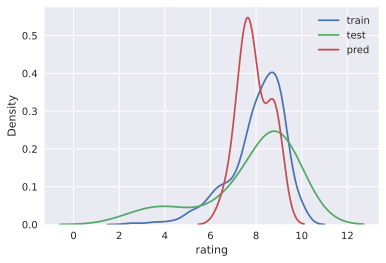

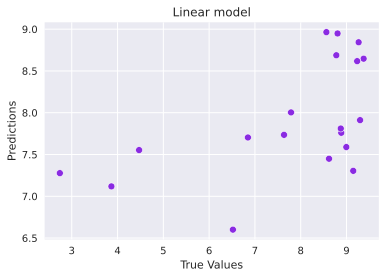

In [67]:
target_distr_linear(y_train, y_test, y_pred)  

In [68]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   2.8313786293759997
RMSE:  1.6826700892854785
R2:    0.25735795047964116
MAE:   1.185239679069484
MedAE: 0.8565054170260238
------------------------------


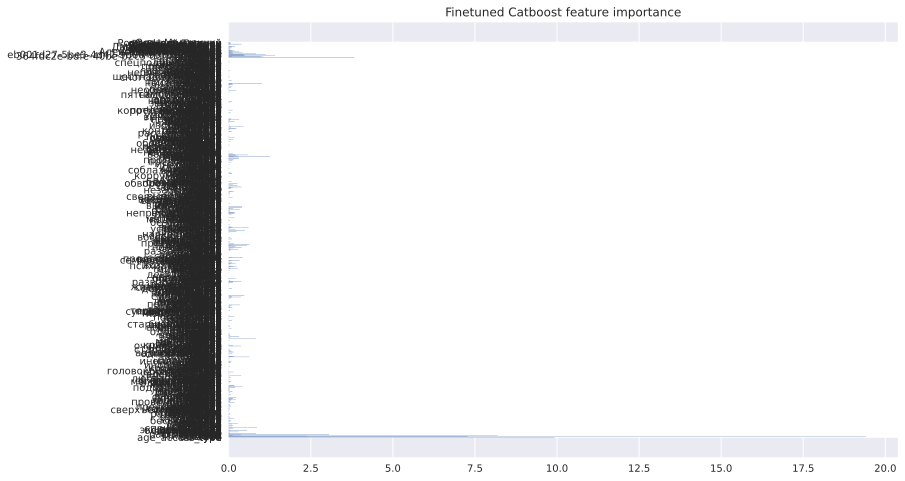

In [69]:
get_feature_imp(best_cat, train_dataset)

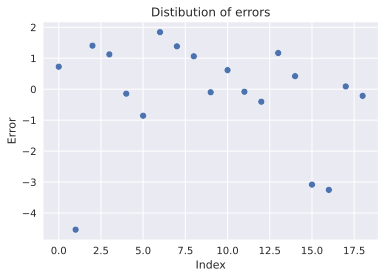

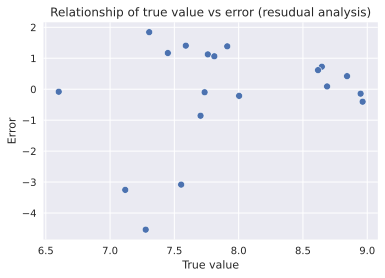

In [70]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [71]:
test_df['PREDS_tune'] = y_pred.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Сергей Трофимов,Антон Зенкович,Эдуард Илоян,Виталий Шляппо,Алексей Троцюк,Роман Непомнящий,Олег Маловичко,PREDS,TARGET,PREDS_tune
10368,16,И снова здравствуйте!,SERIAL,2022,16.665060,f02bc785-71a0-44cc-b6d6-ee2360a1c50f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.683981,9.374117,8.646710
5410,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,7.574545,2.739953,7.276970
5542,16,Многоэтажка,MOVIE,2022,15.597220,19a61cc3-65ff-46ce-bf43-29c24a1cc9b6,NaN,NaN,5.793014,NaN,...,0,0,1,1,1,0,0,7.569438,8.996094,7.588806
10440,18,Закрыть гештальт,SERIAL,2022,16.685680,e6ea57ce-52eb-465b-b9b8-270bc498ca53,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.048470,8.885542,7.760141
10350,16,Янычар,SERIAL,2022,17.345980,23a6adb5-9df6-4bc5-9300-6d2313e177df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,8.708787,8.804702,8.948377
5551,16,Стикер,MOVIE,2022,15.772785,aae4f12c-60f1-4d5e-99f5-1fae382887a6,NaN,NaN,12.066040,NaN,...,0,0,0,0,0,0,0,7.661845,6.847095,7.703600
6354,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,7.483711,9.147352,7.304406
10246,12,Предпоследняя инстанция,SERIAL,2022,16.578049,36d9d568-75d0-414d-9765-25bf72c6362f,NaN,NaN,NaN,NaN,...,0,1,0,0,0,0,0,8.379109,9.296652,7.911252
5681,16,День слепого Валентина,MOVIE,2022,15.711630,6b047b99-5cb4-4878-9a4f-b8b372b438eb,NaN,NaN,12.935033,NaN,...,0,0,0,0,0,0,0,7.736821,8.874664,7.810889
7698,12,Тайна амулета,MOVIE,2022,15.545395,9ae35927-93e3-4a40-870f-a998abbeaa9f,NaN,NaN,12.057422,NaN,...,0,0,0,0,0,0,0,7.797664,7.635827,7.735145


In [72]:
y_pred_demo_tuned = best_cat.predict(demo_dataset)

demo_df['PREDS_TUNED'] = y_pred_demo_tuned.tolist()
demo_df 

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Сергей Трофимов,Антон Зенкович,Эдуард Илоян,Виталий Шляппо,Алексей Троцюк,Роман Непомнящий,Олег Маловичко,TARGET,PREDS,PREDS_TUNED
6354,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.147352,7.483711,7.304406
6435,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,6.519242,7.009209,6.600629
9800,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.717041,8.883485,9.789236
10205,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.192744,8.814233,8.625315


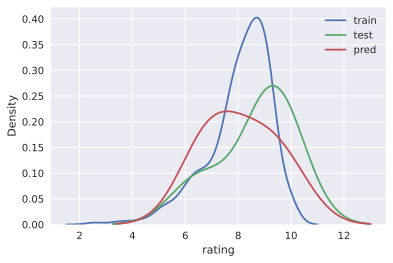

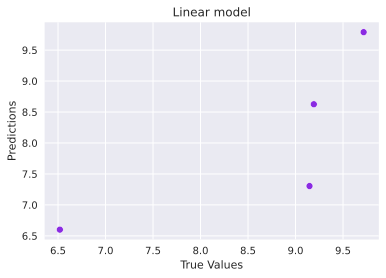

In [73]:

target_distr_linear(y_train, y_demo, y_pred_demo_tuned)  